<a href="https://colab.research.google.com/github/emerson-matos/tcc-notebooks/blob/main/sentimentos/notebook_gpt_async_local_vicuna.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
!nvidia-smi

Sun Nov 19 17:27:55 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 545.29.02              Driver Version: 545.29.02    CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 4070 Ti     Off | 00000000:08:00.0  On |                  N/A |
|  0%   40C    P8              19W / 285W |  11199MiB / 12282MiB |      7%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

In [ ]:
date = '2023-09-01'
filename = 'analisar.csv'
dados = pd.read_csv(f"/content/gdrive/MyDrive/tcc/exploratoria/{date}-{filename}")

dados.head()[['text', 'source', 'data_avaliacao']]

,text,source,data_avaliacao
0,"Lugar fantástico, recomendo super.",hotel-marsol-beach-resort,2023-07-06
1,Tudo perfeito,hotel-marsol-beach-resort,2023-07-06
2,excelente!,hotel-marsol-beach-resort,2023-07-06
3,Belo lugar.,hotel-marsol-beach-resort,2023-07-06
4,Ótimo local,hotel-marsol-beach-resort,2023-07-06


In [ ]:
treinado = pd.read_csv(f"/content/gdrive/MyDrive/tcc/testando-classificacao.csv")

treinado.head()[['text', 'source', 'data_avaliacao']]

,text,source,data_avaliacao
0,"Lugar fantástico, recomendo super.",analisar,2023-07-06
1,Tudo perfeito,analisar,2023-07-06
2,excelente!,analisar,2023-07-06
3,Belo lugar.,analisar,2023-07-06
4,Ótimo local,analisar,2023-07-06


In [ ]:
dados.describe()

,rating,likes,mes_avaliacao,ano_avaliacao
count,49219.000000,49219.000000,49219.000000,49219.000000
mean,4.604787,0.166623,6.790650,2020.699181
std,0.895289,0.731727,1.524495,1.746374
min,1.000000,0.000000,1.000000,2018.000000
25%,5.000000,0.000000,7.000000,2019.000000
50%,5.000000,0.000000,7.000000,2021.000000
75%,5.000000,0.000000,7.000000,2022.000000
max,5.000000,25.000000,12.000000,2023.000000


In [ ]:
!pip install openai

In [ ]:
import os
import openai
openai.organization = os.environ["openai-organization"]
openai.base_url = "http://text-generation-webui:5000/v1/"
# ORGANIZATION
openai.api_key = os.environ["openai-apikey"]
# APIKEY

In [ ]:
# {
#   "id": "chatcmpl-86pPcCAFqXeHV40fKVRmKYLzdqeWu",
#   "object": "chat.completion",
#   "created": 1696638288,
#   "model": "gpt-3.5-turbo-0613",
#   "choices": [
#     {
#       "index": 0,
#       "message": {
#         "role": "assistant",
#         "content": "-1"
#       },
#       "finish_reason": "stop"
#     }
#   ],
#   "usage": {
#     "prompt_tokens": 153,
#     "completion_tokens": 2,
#     "total_tokens": 155
#   }
# }
model = "TheBloke_vicuna-13B-v1.5-GPTQ"
prompt = """para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
[COMMENT]
"""

In [ ]:
completion = openai.chat.completions.create(
  model=model,
  messages=[
    {"role": "user", "content": """para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi muito bom."""}
  ],
  temperature=0.01,
  max_tokens=256,
  top_p=1,
  frequency_penalty=0,
  presence_penalty=0
)

completion

ChatCompletion(id='chatcmpl-1700426563009649408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1700426563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))

In [ ]:
sentiments = ["negative", "neutral", "positive", "INVALID"]
# sentiments[int(completion["choices"][0]["message"]["content"])], completion["usage"]["total_tokens"]

In [ ]:
import logging
import sys

logging.basicConfig(stream=sys.stderr, level=logging.DEBUG)

logger = logging.getLogger(__name__)

In [ ]:
logger.error("oi")

ERROR:__main__:oi


In [ ]:
from tenacity import (
    retry,
    stop_after_attempt,
    wait_random_exponential,
    before_sleep_log
)  # for exponential backoff

@retry(wait=wait_random_exponential(multiplier= 2, min=30, max=600), stop=stop_after_attempt(30),
           before_sleep=before_sleep_log(logger, logging.ERROR))
def get_sentiment(content, model):
    result = openai.chat.completions.create(
        model=model,
        messages=[{"role": "user", "content": content}],
        temperature=0.01,
        max_tokens=256,
        top_p=1,
        frequency_penalty=0,
        presence_penalty=0,
        )
    print(result)
    response_sentiment = result.choices[0].message.content
    try:
      sentiment_int = int(response_sentiment)
    except:
      logger.error(content)
      logger.error(response_sentiment)
      sentiment_int = 3
    return sentiment_int, result.usage.total_tokens

In [ ]:
# @title Texto de título padrão
comment = 'Foi muito bom'

# Get sentiment
comment_prompt = prompt.replace("[COMMENT]", comment)
result = get_sentiment(comment_prompt, model)
result

ChatCompletion(id='chatcmpl-1700426615777761536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1700426615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


(2, 140)

In [ ]:
dados.shape[0]

49219

In [ ]:
!pip install tiktoken

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 23.1 MB/s eta 0:00:00


In [ ]:
import tiktoken

encoding = tiktoken.encoding_for_model("gpt-3.5-turbo")

text = "This is an example sentence to count tokens."
token_count = len(encoding.encode("".join(list(map(lambda x: prompt.replace("[COMMENT]", x),list(dados['text']))))))
print(f"The text contains {token_count} tokens.")

The text contains 6357835 tokens.


In [ ]:
token_count/1000 * 0.0015 + dados.shape[0]/1000 * 0.002 # custo

9.6351905

In [ ]:
dados.shape[0]/1000 * 0.002

0.098438

In [ ]:
!pip install multiprocess

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 53.1 MB/s eta 0:00:00


In [ ]:
teste_sample = dados.sample(1)

def dataset_sentiment(row):
  # Init
  index = row[0]
  comment = row[1].text

  # Get sentiment
  comment_prompt = prompt.replace("[COMMENT]", comment)
  sentiment, consumed_tokens = get_sentiment(comment_prompt, model)

  row[1]['sentimento_gpt'] = sentiments[sentiment]
  row[1]['resultado_gpt'] = sentiment
  row[1]['tokens'] = consumed_tokens
  return row

In [ ]:
get_sentiment.retry

<Retrying object at 0x7f0619800700 (stop=<tenacity.stop.stop_after_attempt object at 0x7f0619802f80>, wait=<tenacity.wait.wait_random_exponential object at 0x7f0619800d60>, sleep=<function sleep at 0x7f061a8ea440>, retry=<tenacity.retry.retry_if_exception_type object at 0x7f061a91e8f0>, before=<function before_nothing at 0x7f061a924310>, after=<function after_nothing at 0x7f061a925000>)>

In [ ]:
dados.iloc[16264]

retrieval_date                                2023-07-07 00:38:21.052776
rating                                                               5.0
relative_date                                            3 semanas atrás
likes                                                                  0
user_is_local_guide                                                False
text                   Local limpo e linda parabéns. Lugar lindo enfr...
source                                          hotel-vila-galé---touros
user_reviews                                                           8
data_avaliacao                                                2023-06-16
mes_avaliacao                                                          6
ano_avaliacao                                                       2023
mes_ano_avaliacao                                                2023-06
com_texto                                                           True
nao_vazio                                          

In [ ]:
from multiprocess import Pool
from tqdm import tqdm
max_pool = 12

In [ ]:
with Pool(processes=max_pool) as pool:
  results = list(tqdm(pool.imap(dataset_sentiment, teste_sample.iterrows()), total=teste_sample.shape[0]))
  index_list, response_list = zip(*results)
  teste_sample = pd.DataFrame(response_list, index_list)

100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


In [93]:
with Pool(processes=max_pool) as pool:
  results = list(tqdm(pool.imap(dataset_sentiment, dados.iterrows()), total=dados.shape[0]))
  index_list, response_list = zip(*results)
  dados = pd.DataFrame(response_list, index_list)

  0%|          | 1/49219 [00:00<8:42:30,  1.57it/s]

ChatCompletion(id='chatcmpl-1701019476852195584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 2/49219 [00:01<8:06:39,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019477475411200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  0%|          | 3/49219 [00:01<7:27:04,  1.83it/s]

ChatCompletion(id='chatcmpl-1701019478038567936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 4/49219 [00:02<7:37:03,  1.79it/s]

ChatCompletion(id='chatcmpl-1701019478526461696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 5/49219 [00:02<7:35:29,  1.80it/s]

ChatCompletion(id='chatcmpl-1701019479101732352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 6/49219 [00:03<7:36:18,  1.80it/s]

ChatCompletion(id='chatcmpl-1701019479654415360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 7/49219 [00:03<7:30:54,  1.82it/s]

ChatCompletion(id='chatcmpl-1701019480212215040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  0%|          | 8/49219 [00:04<7:35:26,  1.80it/s]

ChatCompletion(id='chatcmpl-1701019480748863744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  0%|          | 9/49219 [00:05<7:39:46,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019481315614720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 10/49219 [00:05<7:43:39,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019481887722496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 11/49219 [00:06<7:50:30,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019482463370240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 12/49219 [00:06<7:47:52,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019483056555008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  0%|          | 13/49219 [00:07<7:48:37,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019483619270400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  0%|          | 14/49219 [00:07<7:45:15,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019484193294848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  0%|          | 15/49219 [00:08<7:46:30,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019484750863104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  0%|          | 16/49219 [00:09<7:43:43,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019485323510528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  0%|          | 17/49219 [00:09<7:43:20,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019485881306112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quadra, piscina, praça e ao lado da praia sem muito esforço, meu DEUS Quartos: Me senti feito um REI, com tudo que eu imaginava e muito mais. Atividades próximas: Tem quadra, piscina, praça arborizada, e é pé na areia. Segurança: Realmente impecável, é como se eu fosse o presidente da república em país de primeiro mundo, nota 10. Facilidade de deslocamento a pé: Tudo é perto, realmente tudo. Comidas e bebidas: Eles tem um contra bife de picanha maravilhoso Detalhes importantes: Concerteza, eu vou voltar e quem quiser ir é só fazer as reservas e aproveitar com família

ERROR:__main__:Classificação: 2

A sentença contém muitos elementos positivos, como a presença de uma quadra, piscina, praça e proxi

ChatCompletion(id='chatcmpl-1701019486445574912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Classificação: 2\n\nA sentença contém muitos elementos positivos, como a presença de uma quadra, piscina, praça e proximidade da praia, além de quartos confortáveis e atividades próximas. A segurança é descrita como impecável, o que é um ponto positivo. A facilidade de deslocamento a pé também é mencionada como um ponto positivo. Por fim, o comentário de que o destinatário voltará e recomenda o hotel para outras pessoas é um ponto positivo.', role='assistant', function_call=None, tool_calls=None))], created=1701019486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=133, prompt_tokens=321, total_tokens=454))


  0%|          | 19/49219 [00:13<15:32:19,  1.14s/it]

ChatCompletion(id='chatcmpl-1701019489720598016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  0%|          | 20/49219 [00:14<13:13:43,  1.03it/s]

ChatCompletion(id='chatcmpl-1701019490292563968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é limpo, os funcionários muito educados e prestativos! A gastronomia não é ruim , mais precisa ser melhorada , diversidades de comida porque é muito repetido os pratos e o bar da piscina com os pestiscos precisa melhorar pois as porções sempre as mesmas e frias ,em relação a gastronomia o hotel precisa sim melhorar, pois está muito fraco . A praia desse hotel não dá para entrar no mar pois é muito forte e impropria para banho . Em relação as nossas férias ficamos um pouco decepcionados com relação ao resort esperávamos mais !

ERROR:__main__:2, 1, 0, 0, 0
  0%|          | 21/49219 [00:14<12:36:40,  1.08it/s]

ChatCompletion(id='chatcmpl-1701019490866769920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701019490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=289, total_tokens=304))


  0%|          | 22/49219 [00:15<11:17:46,  1.21it/s]

ChatCompletion(id='chatcmpl-1701019491684538624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


  0%|          | 23/49219 [00:16<10:14:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701019492286222336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  0%|          | 24/49219 [00:16<9:31:12,  1.44it/s] 

ChatCompletion(id='chatcmpl-1701019492856261888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  0%|          | 25/49219 [00:17<8:59:35,  1.52it/s]

ChatCompletion(id='chatcmpl-1701019493429471744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  0%|          | 26/49219 [00:17<8:37:57,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019493997704960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 27/49219 [00:18<8:20:22,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019494567903744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  0%|          | 28/49219 [00:18<8:08:01,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019495128289024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 29/49219 [00:19<8:00:01,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019495688047360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  0%|          | 30/49219 [00:19<7:56:26,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019496251302656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  0%|          | 31/49219 [00:20<7:49:16,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019496822273024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  0%|          | 32/49219 [00:21<7:53:56,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019497374220032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 33/49219 [00:21<7:54:04,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019497965500160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel antigo trazendo um belo aconchego Quartos: Quarto ótimo Comidas e bebidas: Comida boa

ERROR:__main__:Sentimento: 2

Classificação: Positivo
  0%|          | 34/49219 [00:22<8:52:06,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019498544051200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação: Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701019498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=165, total_tokens=180))


  0%|          | 35/49219 [00:23<8:34:31,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019499358949632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  0%|          | 36/49219 [00:23<7:54:55,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019499936076288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  0%|          | 37/49219 [00:24<7:53:57,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019500402625792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  0%|          | 38/49219 [00:24<7:35:38,  1.80it/s]

ChatCompletion(id='chatcmpl-1701019500978493696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 39/49219 [00:25<7:50:20,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019501482074880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  0%|          | 40/49219 [00:25<7:52:32,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019502098119936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 41/49219 [00:26<7:54:15,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019502680828416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  0%|          | 42/49219 [00:27<7:55:41,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019503264242432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  0%|          | 43/49219 [00:27<7:55:44,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019503848234752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 44/49219 [00:28<7:57:26,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019504429400576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  0%|          | 45/49219 [00:28<7:59:50,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019505017436672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  0%|          | 46/49219 [00:29<8:01:39,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019505609302016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  0%|          | 47/49219 [00:29<8:02:42,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019506202513664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  0%|          | 48/49219 [00:30<8:04:33,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019506793936896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  0%|          | 49/49219 [00:31<8:06:34,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019507390372352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  0%|          | 50/49219 [00:31<8:03:48,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019507990053120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  0%|          | 51/49219 [00:32<7:58:32,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019508572777728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  0%|          | 52/49219 [00:32<7:55:51,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019509141879296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 53/49219 [00:33<7:55:38,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019509714848768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  0%|          | 54/49219 [00:34<7:56:51,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019510295035392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  0%|          | 55/49219 [00:34<8:05:09,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019510880500480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  0%|          | 56/49219 [00:35<8:03:41,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019511496680960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 57/49219 [00:35<8:05:57,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019512081976064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  0%|          | 58/49219 [00:36<8:01:14,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019512681246208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  0%|          | 59/49219 [00:36<7:59:30,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019513255535360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 60/49219 [00:37<7:59:49,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019513835813888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  0%|          | 61/49219 [00:38<8:01:37,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019514422443008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  0%|          | 62/49219 [00:38<7:39:58,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019515015937792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  0%|          | 63/49219 [00:39<7:43:29,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019515515403008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 64/49219 [00:39<7:48:28,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019516091017216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 65/49219 [00:40<7:53:18,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019516677189888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 66/49219 [00:41<7:56:32,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019517268674304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


  0%|          | 67/49219 [00:41<7:59:59,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019517859262208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  0%|          | 68/49219 [00:42<7:59:04,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019518455885568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 69/49219 [00:42<7:56:54,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019519037387264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  0%|          | 70/49219 [00:43<7:58:51,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019519613542656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  0%|          | 71/49219 [00:43<8:03:06,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019520203984896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  0%|          | 72/49219 [00:44<8:03:26,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019520805709824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 73/49219 [00:45<8:06:04,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019521397419264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  0%|          | 74/49219 [00:45<8:06:51,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019521997793280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  0%|          | 75/49219 [00:46<8:04:51,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019522594626304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 76/49219 [00:46<8:05:46,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019523182558720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  0%|          | 77/49219 [00:47<8:06:12,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019523776365824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  0%|          | 78/49219 [00:48<8:06:39,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019524371416832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  0%|          | 79/49219 [00:48<8:05:29,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019524966705920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  0%|          | 80/49219 [00:49<8:03:27,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019525556178944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos e localização ótima, super recomendo, atendimento nota 1000 Quartos: Quartos limpos,achei bem espaçoso Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
  0%|          | 81/49219 [00:50<8:55:19,  1.53it/s]

ChatCompletion(id='chatcmpl-1701019526141006336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701019526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=179, total_tokens=193))


  0%|          | 82/49219 [00:50<8:38:41,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019526942732544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  0%|          | 83/49219 [00:51<8:26:25,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019527528143872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  0%|          | 84/49219 [00:51<8:18:00,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019528111973632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  0%|          | 85/49219 [00:52<8:19:18,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019528695960576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  0%|          | 86/49219 [00:53<8:13:43,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019529309368320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 87/49219 [00:53<8:12:13,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019529896570112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 88/49219 [00:54<8:07:51,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019530493314304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  0%|          | 89/49219 [00:54<8:05:43,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019531076793856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  0%|          | 90/49219 [00:55<8:05:41,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019531664120064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  0%|          | 91/49219 [00:56<8:03:41,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019532257877504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  0%|          | 92/49219 [00:56<8:01:52,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019532842173440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 93/49219 [00:57<8:02:25,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019533425380864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  0%|          | 94/49219 [00:57<8:04:13,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019534016117760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


  0%|          | 95/49219 [00:58<7:38:03,  1.79it/s]

ChatCompletion(id='chatcmpl-1701019534612744704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 96/49219 [00:58<7:45:57,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019535097446656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 97/49219 [00:59<7:54:33,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019535689106176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  0%|          | 98/49219 [00:59<7:40:51,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019536293601792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 99/49219 [01:00<7:50:52,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019536817511936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 100/49219 [01:01<7:54:44,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019537421417472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 101/49219 [01:01<7:56:35,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019538011983360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  0%|          | 102/49219 [01:02<7:58:41,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019538600041728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  0%|          | 103/49219 [01:02<7:57:43,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019539190618368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  0%|          | 104/49219 [01:03<8:00:43,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019539771301120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  0%|          | 105/49219 [01:04<7:38:52,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019540366821120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 106/49219 [01:04<7:42:44,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019540865758720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 107/49219 [01:05<7:22:52,  1.85it/s]

ChatCompletion(id='chatcmpl-1701019541442092032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  0%|          | 108/49219 [01:05<7:35:52,  1.80it/s]

ChatCompletion(id='chatcmpl-1701019541926384640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 109/49219 [01:06<7:39:22,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019542520553216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  0%|          | 110/49219 [01:06<7:44:08,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019543091818240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  0%|          | 111/49219 [01:07<7:49:53,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019543672356864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  0%|          | 112/49219 [01:08<7:52:12,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019544262984960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  0%|          | 113/49219 [01:08<7:53:25,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019544846639104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  0%|          | 114/49219 [01:09<7:56:50,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019545428265984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 115/49219 [01:09<7:59:14,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019546020561152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  0%|          | 116/49219 [01:10<7:58:09,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019546613350656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 117/49219 [01:10<8:01:19,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019547195162880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  0%|          | 118/49219 [01:11<7:58:15,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019547791855616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 119/49219 [01:12<8:01:51,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019548367158528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  0%|          | 120/49219 [01:12<7:39:34,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019548966369024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 121/49219 [01:13<7:47:50,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019549464624384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  0%|          | 122/49219 [01:13<7:49:00,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019550060381440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 123/49219 [01:14<7:47:36,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019550636216832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  0%|          | 124/49219 [01:14<7:52:24,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019551204143872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  0%|          | 125/49219 [01:15<7:54:16,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019551795004672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  0%|          | 126/49219 [01:16<7:55:22,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019552380089088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  0%|          | 127/49219 [01:16<7:59:40,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019552963852544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima experiência no local!! Voltarei mais vezes Quartos: Quartos magnífico nota 10 Atividades próximas: Amei as atividades que são muitas perto do local Segurança: Me senti muito seguro no local

ERROR:__main__:Sentimento: Positivo
Classificação: 2
  0%|          | 128/49219 [01:17<8:53:21,  1.53it/s]

ChatCompletion(id='chatcmpl-1701019553562777600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701019553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=196, total_tokens=210))


  0%|          | 129/49219 [01:18<8:41:51,  1.57it/s]

ChatCompletion(id='chatcmpl-1701019554367509504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 130/49219 [01:18<8:25:41,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019554972817664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 131/49219 [01:19<8:21:04,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019555544445952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  0%|          | 132/49219 [01:19<8:18:23,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019556144083200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  0%|          | 133/49219 [01:20<8:15:52,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019556745781248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  0%|          | 134/49219 [01:21<8:10:56,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019557344525824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  0%|          | 135/49219 [01:21<8:08:25,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019557930624768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 136/49219 [01:22<8:07:39,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019558521126144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  0%|          | 137/49219 [01:22<8:02:10,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019559115233024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  0%|          | 138/49219 [01:23<8:05:14,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019559688557824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  0%|          | 139/49219 [01:24<7:59:40,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019560290381824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  0%|          | 140/49219 [01:24<7:55:35,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019560860755200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  0%|          | 141/49219 [01:25<7:59:51,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019561431647232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 142/49219 [01:25<8:05:05,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019562029824256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  0%|          | 143/49219 [01:26<8:03:34,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019562637492992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  0%|          | 144/49219 [01:26<8:02:58,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019563224586752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários  super atenciosos  café  da manhã  bem fraquinho  todos os dias  as mesmas  coisas jantar petiscos tbm repetitivo,acho por ser Risort  muito fraco.quanto o resto nota 8 quartos  limpos,mesa de sinuca muito  ruim precisa de uma reforma. Deveria ter  sorvetes  de massa tbm .

ERROR:__main__:2 (positivo)
  0%|          | 145/49219 [01:27<8:29:32,  1.61it/s]

ChatCompletion(id='chatcmpl-1701019563813339904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=236, total_tokens=244))


  0%|          | 146/49219 [01:28<8:23:01,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019564512770304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


  0%|          | 147/49219 [01:28<8:15:44,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019565108553216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 148/49219 [01:29<8:11:26,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019565693887744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  0%|          | 149/49219 [01:30<8:07:07,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019566282712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  0%|          | 150/49219 [01:30<8:05:36,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019566866761216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  0%|          | 151/49219 [01:31<8:03:32,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019567455754752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 152/49219 [01:31<8:05:53,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019568040989440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  0%|          | 153/49219 [01:32<8:03:49,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019568641840384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  0%|          | 154/49219 [01:32<8:03:14,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019569227487232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  0%|          | 155/49219 [01:33<8:00:57,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019569816664064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


  0%|          | 156/49219 [01:34<8:01:37,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019570398754560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  0%|          | 157/49219 [01:34<8:01:36,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019570989486080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 158/49219 [01:35<7:57:56,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019571578253824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  0%|          | 159/49219 [01:35<7:59:17,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019572152938496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  0%|          | 160/49219 [01:36<7:58:19,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019572742274816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  0%|          | 161/49219 [01:37<7:57:21,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019573324944128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


  0%|          | 162/49219 [01:37<8:02:31,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019573906123008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel com péssima estrutura para crianças, vale a pena para fazer os passeios externos (recomendo a operadora Mar azul). Mas para ficar o dia todo no hotel não vai ser proveitoso. Quartos: Estrutura dos quartos são simples porém limpos e agradáveis. Não espere muito. Comidas e bebidas: Café da manhã e jantar muito simples, não gostamos muito.

ERROR:__main__:Sentimento: 1 (neutro)
  0%|          | 163/49219 [01:38<8:36:23,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019574510840576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701019574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=243, total_tokens=253))


  0%|          | 164/49219 [01:38<8:04:19,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019575238898688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  0%|          | 165/49219 [01:39<8:05:17,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019575740211200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  0%|          | 166/49219 [01:40<8:03:56,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019576336019456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 167/49219 [01:40<8:11:30,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019576924900864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 168/49219 [01:41<8:08:43,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019577547566080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  0%|          | 169/49219 [01:41<8:04:19,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019578137237248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 170/49219 [01:42<8:03:27,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019578716883456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  0%|          | 171/49219 [01:43<8:04:38,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019579305939456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  0%|          | 172/49219 [01:43<7:39:58,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019579902171904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 173/49219 [01:44<7:47:53,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019580394467072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  0%|          | 174/49219 [01:44<7:53:48,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019580989860608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  0%|          | 175/49219 [01:45<7:55:10,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019581586697728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 176/49219 [01:45<8:02:16,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019582171857152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=384, total_tokens=387))


  0%|          | 177/49219 [01:46<8:19:47,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019582781729536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=560, total_tokens=563))


  0%|          | 178/49219 [01:47<8:16:34,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019583443378688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=315, total_tokens=318))


  0%|          | 179/49219 [01:47<8:16:12,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019584041559296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=341, total_tokens=344))


  0%|          | 180/49219 [01:48<8:10:06,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019584647601920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  0%|          | 181/49219 [01:48<8:02:59,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019585230056192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  0%|          | 182/49219 [01:49<8:07:27,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019585801216512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


  0%|          | 183/49219 [01:50<8:06:39,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019586410168064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  0%|          | 184/49219 [01:50<8:04:09,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019587004009472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 185/49219 [01:51<8:16:12,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019587588755456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=426, total_tokens=429))


  0%|          | 186/49219 [01:51<8:12:40,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019588229798400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  0%|          | 187/49219 [01:52<8:10:25,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019588822766592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


  0%|          | 188/49219 [01:53<8:10:26,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019589416814080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  0%|          | 189/49219 [01:53<8:06:26,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019590017258752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  0%|          | 190/49219 [01:54<7:59:41,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019590600639744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  0%|          | 191/49219 [01:54<7:33:49,  1.80it/s]

ChatCompletion(id='chatcmpl-1701019591168824320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


  0%|          | 192/49219 [01:55<7:43:01,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019591650018304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  0%|          | 193/49219 [01:56<7:50:22,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019592243918336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  0%|          | 194/49219 [01:56<7:50:00,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019592839829248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  0%|          | 195/49219 [01:57<8:04:57,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019593414220032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=397, total_tokens=400))


  0%|          | 196/49219 [01:57<8:06:14,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019594050442496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar maravilhoso... mas o quarto 107 tem algumas coisas pra melhorar,café da manhã top... piscina top... estrutura top... praia top ... limpeza top... funcionários top... portaria top... mas o quarto 107 deixou a desejar , o resto é top menos o quarto 107 Quartos: Quarto 107 tem que melhorar , limpeza ótima,  mas estava com fechaduras ruim , barulho no ar condicionado travesseiro ruim água fria da pia do banheiro não saia , tinha que ligar a água quente junto , mas não estragou meu passeio ... tomara que arrumem o quarto 107. Atividades próximas: Praia dos artistas Letreiro NATAL Restaurante tábua de carne Ciclovia Segurança: Excelente Facilidade de deslocamento a pé: Uber Comidas e bebidas: Ótima

ChatCompletion(id='chatcmpl-1701019594648854016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença expressa uma avaliação mista sobre o hotel. Embora o hotel tenha recebido muitas avaliações positivas, como a limpeza, a estrutura, a praia, a segurança e a facilidade de deslocamento a pé, o quarto 107 foi mencionado como tendo algumas coisas a melhorar, como as fechaduras, o barulho do ar condicionado, o travesseiro e a água fria da pia do banheiro. O autor também menciona que, apesar de tudo, o hotel é top, exceto pelo quarto 107. Portanto, a classificação é de 1, pois a avaliação é neutra.', role='assistant', function_call=None, tool_calls=None))], created=1701019594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=195, prompt_tokens=397, total_tokens=592))


  0%|          | 198/49219 [02:03<19:53:28,  1.46s/it]

ChatCompletion(id='chatcmpl-1701019599381887488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  0%|          | 199/49219 [02:03<16:31:01,  1.21s/it]

ChatCompletion(id='chatcmpl-1701019599966158080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  0%|          | 200/49219 [02:04<14:02:21,  1.03s/it]

ChatCompletion(id='chatcmpl-1701019600601042944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


  0%|          | 201/49219 [02:04<12:13:12,  1.11it/s]

ChatCompletion(id='chatcmpl-1701019601208402688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  0%|          | 202/49219 [02:05<10:57:21,  1.24it/s]

ChatCompletion(id='chatcmpl-1701019601792990976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  0%|          | 203/49219 [02:06<10:07:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701019602381445376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: O ar não gela direito ! Chuveiro com problema Tv não pega muito bem Comidas e bebidas: Péssima !! Café da tarde colocaram bolachas de água e sal 2 tipos de suco e manteiga ! Só O que sobrou do café da manhã tava para servir de tarde zuado nesse ponto Detalhes importantes: No meu caso fechei pela CVC !!! Os quartos são velhos cheio de coisas para fazer ! Peça muito nos detalhes ! Não volto nunca mais . Sem contar que anoite vc não pode andar pela areia da praia pq eles dizem que tem uma comunidade que acontecem alguns assaltos ou roubos

ERROR:__main__:Sentimento: 0

Classificação:
Quartos: 0
Chuveiro: 0
Tv: 0
Comidas e bebidas: 0
Café da tarde: 0
Detalhes importantes: 0
No meu caso: 0
Peça

ChatCompletion(id='chatcmpl-1701019602981317376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0\n\nClassificação:\nQuartos: 0\nChuveiro: 0\nTv: 0\nComidas e bebidas: 0\nCafé da tarde: 0\nDetalhes importantes: 0\nNo meu caso: 0\nPeça muito: 0\nNão volto nunca mais: 0\nSem contar: 0\nQuartos: 0\nCheio de coisas para fazer: 0\nPeça muito nos detalhes: 0\nNo meu caso fechei pela CVC: 0\nAnnoite: 0\nNão pode andar pela areia da praia: 0\nPq: 0\nEles dizem que tem uma comunidade: 0\nQue acontecem alguns assaltos ou roubos: 0', role='assistant', function_call=None, tool_calls=None))], created=1701019602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=192, prompt_tokens=311, total_tokens=503))


  0%|          | 205/49219 [02:11<20:26:40,  1.50s/it]

ChatCompletion(id='chatcmpl-1701019607572085248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  0%|          | 206/49219 [02:11<16:41:12,  1.23s/it]

ChatCompletion(id='chatcmpl-1701019608149732608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


  0%|          | 207/49219 [02:12<14:04:46,  1.03s/it]

ChatCompletion(id='chatcmpl-1701019608731214080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


  0%|          | 208/49219 [02:13<12:16:22,  1.11it/s]

ChatCompletion(id='chatcmpl-1701019609318530816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  0%|          | 209/49219 [02:13<11:01:39,  1.23it/s]

ChatCompletion(id='chatcmpl-1701019609910561280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  0%|          | 210/49219 [02:14<10:07:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701019610507382528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  0%|          | 211/49219 [02:14<9:29:31,  1.43it/s] 

ChatCompletion(id='chatcmpl-1701019611097687040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  0%|          | 212/49219 [02:15<9:00:55,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019611685468160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  0%|          | 213/49219 [02:16<8:45:37,  1.55it/s]

ChatCompletion(id='chatcmpl-1701019612266146048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  0%|          | 214/49219 [02:16<8:26:34,  1.61it/s]

ChatCompletion(id='chatcmpl-1701019612866129664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  0%|          | 215/49219 [02:17<8:23:48,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019613431549440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


  0%|          | 216/49219 [02:17<8:24:39,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019614040905472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=396, total_tokens=399))


  0%|          | 217/49219 [02:18<8:14:58,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019614661474560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  0%|          | 218/49219 [02:19<8:41:16,  1.57it/s]

ChatCompletion(id='chatcmpl-1701019615239865600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=690, total_tokens=693))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel amplo, com itens de lazer, em frente a praia. As instalações, necessitam de uma reforma e a comida não valia o preço cobrado. Funcionários atenciosos e cordiais. De um modo geral, uma boa experiência. Quartos : 3/5

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença contém elementos positivos e negativos, por isso é considerada como uma avaliação neutra. O hotel é amplo e tem itens de lazer, mas as instalações precisam de uma reforma e a comida não valia o preço cobrado. No entanto, os funcionários são atenciosos e cordiais, o que é um ponto positivo. No geral, a experiência foi considerada boa, mas não excepcional. Os quartos receberam uma classificação de 3/5, o que i

ChatCompletion(id='chatcmpl-1701019615953117440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença contém elementos positivos e negativos, por isso é considerada como uma avaliação neutra. O hotel é amplo e tem itens de lazer, mas as instalações precisam de uma reforma e a comida não valia o preço cobrado. No entanto, os funcionários são atenciosos e cordiais, o que é um ponto positivo. No geral, a experiência foi considerada boa, mas não excepcional. Os quartos receberam uma classificação de 3/5, o que indica que não foram considerados excelentes, mas ainda assim foram aceptáveis.', role='assistant', function_call=None, tool_calls=None))], created=1701019615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=167, prompt_tokens=209, total_tokens=376))


  0%|          | 220/49219 [02:23<18:06:28,  1.33s/it]

ChatCompletion(id='chatcmpl-1701019619933729280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  0%|          | 221/49219 [02:24<15:01:23,  1.10s/it]

ChatCompletion(id='chatcmpl-1701019620539233024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  0%|          | 222/49219 [02:24<12:51:34,  1.06it/s]

ChatCompletion(id='chatcmpl-1701019621114708224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom. Mas, precisa de algumas reformas. Academia não funciona, equipamentos quebrados.

ERROR:__main__:2 - Positivo: "Muito bom"
1 - Neutro: "Precisa de algumas reformas"
0 - Negativo: "Academia não funciona, equipamentos quebrados"
  0%|          | 223/49219 [02:26<15:20:37,  1.13s/it]

ChatCompletion(id='chatcmpl-1701019621688484096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Muito bom"\n1 - Neutro: "Precisa de algumas reformas"\n0 - Negativo: "Academia não funciona, equipamentos quebrados"', role='assistant', function_call=None, tool_calls=None))], created=1701019621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=52, prompt_tokens=160, total_tokens=212))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários  super atenciosos  café  da manhã  bem fraquinho  todos os dias  as mesmas  coisas jantar petiscos tbm repetitivo,acho por ser Risort  muito fraco.quanto o resto nota 8 quartos  limpos,mesa de sinuca muito  ruim precisa de uma reforma. Deveria ter  sorvetes  de massa tbm .

ERROR:__main__:2 (positivo)
  0%|          | 224/49219 [02:27<13:29:12,  1.01it/s]

ChatCompletion(id='chatcmpl-1701019623241714688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=236, total_tokens=244))


  0%|          | 225/49219 [02:27<11:47:49,  1.15it/s]

ChatCompletion(id='chatcmpl-1701019623914705920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


  0%|          | 226/49219 [02:28<10:37:22,  1.28it/s]

ChatCompletion(id='chatcmpl-1701019624491174656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  0%|          | 227/49219 [02:28<9:48:39,  1.39it/s] 

ChatCompletion(id='chatcmpl-1701019625070569728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  0%|          | 228/49219 [02:29<9:22:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701019625652943360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  0%|          | 229/49219 [02:30<9:02:06,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019626266358528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  0%|          | 230/49219 [02:30<8:25:53,  1.61it/s]

ChatCompletion(id='chatcmpl-1701019626872065024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  0%|          | 231/49219 [02:31<8:18:08,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019627388058368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  0%|          | 232/49219 [02:31<8:13:00,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019627977105920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


  0%|          | 233/49219 [02:32<8:10:06,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019628565673216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  0%|          | 234/49219 [02:32<8:08:59,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019629158735616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  0%|          | 235/49219 [02:33<8:16:51,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019629753057024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=507, total_tokens=510))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom e com vista belíssima! Estive no hotel por 5 dias e foi muito bom! A comida é gostosa, porém pra quem quer all inclusive por conta da bebida e drinks acredito que não seja uma boa! A cerveja até que é boa pq é Heineken, porém os drinks fiquei decepcionada! Os funcionários são todos atenciosos e o pessoal da recreação a maior graça! Vale muito a pena para pessoas em excursões!

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
  0%|          | 236/49219 [02:39<30:21:3

ChatCompletion(id='chatcmpl-1701019630384990208', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701019630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=260, total_tokens=516))


  0%|          | 237/49219 [02:40<23:40:56,  1.74s/it]

ChatCompletion(id='chatcmpl-1701019636402992128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


  0%|          | 238/49219 [02:40<19:17:49,  1.42s/it]

ChatCompletion(id='chatcmpl-1701019636997499904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=529, total_tokens=532))


  0%|          | 239/49219 [02:41<15:57:39,  1.17s/it]

ChatCompletion(id='chatcmpl-1701019637663941888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  0%|          | 240/49219 [02:42<13:34:34,  1.00it/s]

ChatCompletion(id='chatcmpl-1701019638265277440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  0%|          | 241/49219 [02:42<11:55:17,  1.14it/s]

ChatCompletion(id='chatcmpl-1701019638854227200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  0%|          | 242/49219 [02:43<10:46:11,  1.26it/s]

ChatCompletion(id='chatcmpl-1701019639446218752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  0%|          | 243/49219 [02:43<9:56:26,  1.37it/s] 

ChatCompletion(id='chatcmpl-1701019640040575232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  0%|          | 244/49219 [02:44<9:18:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701019640629681408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  0%|          | 245/49219 [02:44<8:56:21,  1.52it/s]

ChatCompletion(id='chatcmpl-1701019641207024640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  0%|          | 246/49219 [02:45<8:37:54,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019641799254016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  1%|          | 247/49219 [02:46<8:26:07,  1.61it/s]

ChatCompletion(id='chatcmpl-1701019642381059328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


  1%|          | 248/49219 [02:46<8:17:24,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019642967693312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  1%|          | 249/49219 [02:47<8:09:41,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019643552278528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  1%|          | 250/49219 [02:47<8:02:06,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019644129855232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 251/49219 [02:48<8:05:45,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019644698781952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


  1%|          | 252/49219 [02:49<8:04:13,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019645304679680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  1%|          | 253/49219 [02:49<8:02:00,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019645893828608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  1%|          | 254/49219 [02:50<8:00:51,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019646478205952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 255/49219 [02:50<8:02:49,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019647064366336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  1%|          | 256/49219 [02:51<8:29:41,  1.60it/s]

ChatCompletion(id='chatcmpl-1701019647661119232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=531, total_tokens=534))


  1%|          | 257/49219 [02:52<8:21:44,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019648362574848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


  1%|          | 258/49219 [02:52<8:15:33,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019648955501056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  1%|          | 259/49219 [02:53<8:10:20,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019649544716800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  1%|          | 260/49219 [02:53<8:03:52,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019650130359296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|          | 261/49219 [02:54<8:01:33,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019650705031680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|          | 262/49219 [02:55<8:01:59,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019651288842240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|          | 263/49219 [02:55<8:00:10,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019651880827392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  1%|          | 264/49219 [02:56<8:00:24,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019652464208384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 265/49219 [02:56<8:01:41,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019653053528320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  1%|          | 266/49219 [02:57<8:01:01,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019653647791104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  1%|          | 267/49219 [02:58<8:08:32,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019654235486208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


  1%|          | 268/49219 [02:58<8:04:36,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019654855565056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  1%|          | 269/49219 [02:59<8:08:04,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019655438044160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 270/49219 [02:59<8:12:31,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019656047793664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


  1%|          | 271/49219 [03:00<8:31:44,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019656664047616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=550, total_tokens=553))


  1%|          | 272/49219 [03:01<8:24:24,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019657346359808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  1%|          | 273/49219 [03:01<8:16:42,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019657942702336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  1%|          | 274/49219 [03:02<8:08:54,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019658529178624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  1%|          | 275/49219 [03:02<8:10:19,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019659106519040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


  1%|          | 276/49219 [03:03<8:04:57,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019659712180992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  1%|          | 277/49219 [03:04<8:02:47,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019660290735104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|          | 278/49219 [03:04<7:36:31,  1.79it/s]

ChatCompletion(id='chatcmpl-1701019660876969472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|          | 279/49219 [03:05<7:47:55,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019661361210112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom..vamos lá... Chegamos na quinta dia 02/02/23  e não fomos orientados em momento algum que não deveríamos ir para um determinado local na beira da praia, tanto que no outro dia eu e um casal de amigos fomos caminhar para minha surpresa fui assaltada as 8.45 da manhã. Celular e documento se foram graças a Deus estamos vivos..mas um prejuízo que poderia ter sido evitado. A gerente do hotel pessoa que ao meu ver nem deveria estar ocupando esse cargo simplesmente veio falar comigo e sabe o que aconteceu? Nada ... Quanto ao pessoal do restaurante e bar simplesmente maravilhosos. Seu Edson, meninas e nosso incrível Charles..somente gratidão

ERROR:__main__:2 (positivo)
  1%|          | 280/49219 [03:0

ChatCompletion(id='chatcmpl-1701019661967271168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=342, total_tokens=350))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tudo muito limpinho, funcionários super educados, mas deixou a desejar na comida, não tem variedades, até os petiscos praticamente os mesmos todos os dias. Paguei Al incluso, tudo que meus filhos queriam que não estava sendo servido era uma burocracia para conseguir.  Parece que não tem comunicação da gerência com os funcionários, muito ruim isso, toda vez tenho que questionar. Todos os outros lugares que já viajamos não tivemos problema com nada.

ERROR:__main__:2 - Positivo: "Tudo muito limpinho, funcionários super educados"
1 - Neutro: "não tem variedades, até os petiscos praticamente os mesmos todos os dias"
0 - Negativo: "Paguei Al incluso, tudo que meus filhos queriam que não estava sendo ser

ChatCompletion(id='chatcmpl-1701019662680777472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Tudo muito limpinho, funcionários super educados"\n1 - Neutro: "não tem variedades, até os petiscos praticamente os mesmos todos os dias"\n0 - Negativo: "Paguei Al incluso, tudo que meus filhos queriam que não estava sendo servido era uma burocracia para conseguir. Parece que não tem comunicação da gerência com os funcionários, muito ruim isso, toda vez tenho que questionar. Todos os outros lugares que já viajamos não tivemos problema com nada."', role='assistant', function_call=None, tool_calls=None))], created=1701019662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=141, prompt_tokens=261, total_tokens=402))


  1%|          | 282/49219 [03:09<16:20:29,  1.20s/it]

ChatCompletion(id='chatcmpl-1701019666126290944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  1%|          | 283/49219 [03:10<14:06:47,  1.04s/it]

ChatCompletion(id='chatcmpl-1701019666716485120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=482, total_tokens=485))


  1%|          | 284/49219 [03:11<12:20:53,  1.10it/s]

ChatCompletion(id='chatcmpl-1701019667371989760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


  1%|          | 285/49219 [03:11<11:05:28,  1.23it/s]

ChatCompletion(id='chatcmpl-1701019667976988672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 286/49219 [03:12<10:10:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701019668577195008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  1%|          | 287/49219 [03:12<9:30:12,  1.43it/s] 

ChatCompletion(id='chatcmpl-1701019669167096320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|          | 288/49219 [03:13<9:01:14,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019669751896832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 289/49219 [03:14<8:43:57,  1.56it/s]

ChatCompletion(id='chatcmpl-1701019670332826368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel em si tem uma bela estrutura, embora o restaurante não tenha muitas opções, principalmente caso vc seja vegetariano ou vegano. Já os quartos estão precisando de uma reforma, mobiliário e pintura já bastante cansados, e cofres não funcionam.

ERROR:__main__:2 (positivo)
  1%|          | 290/49219 [03:14<8:54:36,  1.53it/s]

ChatCompletion(id='chatcmpl-1701019670926110208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=206, total_tokens=214))


  1%|          | 291/49219 [03:15<9:06:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019671612572928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=558, total_tokens=561))


  1%|          | 292/49219 [03:16<8:49:19,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019672316453632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  1%|          | 293/49219 [03:16<8:49:29,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019672916393984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficamos hospedados em família com criança e adolescente, durante 10 dias. Hotel ideal para quem quer ter tranquilidade, pois fica afastado do centro de Natal. Desde a chegada fomos bem recepcionados pelo João e pelo Pedro (que ficam na recepção do hotel), nos ajudaram em tudo no nosso período de estadia. O Hotel é grande e bem ventilado, apesar da estrutura mais antiga não tivemos problemas. O hotel tem várias piscinas e jacuzzi em frente ao bangalô, além de redes espalhadas na beira da praia. Fomos com o sistema all inclusive e todas as refeições bem servidas, pouca variedade mas de boa qualidade. O hotel conta com recreação para crianças e adultos, além de quadras para quem gosta de esportes. Fiz

ChatCompletion(id='chatcmpl-1701019673565890816', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Hotel ideal para quem quer ter tranquilidade, pois fica afastado do centro de Natal.\n* Ficamos hospedados em família com criança e adolescente, durante 10 dias.\n* Desde a chegada fomos bem recepcionados pelo João e pelo Pedro (que ficam na recepção do hotel), nos ajudaram em tudo no nosso período de estadia.\n* O Hotel é grande e bem ventilado, apesar da estrutura mais antiga não tivemos problemas.\n* O hotel tem várias piscinas e jacuzzi em frente ao bangalô, além de redes espalhadas na beira da praia.\n* Fomos com o sistema all inclusive e todas as refeições bem servidas, pouca variedade mas de boa qualidade.\n* O hotel conta com recreação para crianças e adultos, além de quadras para quem gosta de esportes.\n* Fizemos passeios com a empresa Marazul que fica dentro do hotel', role='assistant', function_call=None, tool_calls=Non

ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficamos hospedados em família com criança e adolescente, durante 10 dias. Hotel ideal para quem quer ter tranquilidade, pois fica afastado do centro de Natal. Desde a chegada fomos bem recepcionados pelo João e pelo Pedro (que ficam na recepção do hotel), nos ajudaram em tudo no nosso período de estadia. O Hotel é grande e bem ventilado, apesar da estrutura mais antiga não tivemos problemas. O hotel tem várias piscinas e jacuzzi em frente ao bangalô, além de redes espalhadas na beira da praia. Fomos com o sistema all inclusive e todas as refeições bem servidas, pouca variedade mas de boa qualidade. O hotel conta com recreação para crianças e adultos, além de quadras para quem gosta de esportes. Fiz

ChatCompletion(id='chatcmpl-1701019679867151360', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Hotel ideal para quem quer ter tranquilidade, pois fica afastado do centro de Natal.\n* Ficamos hospedados em família com criança e adolescente, durante 10 dias.\n* Desde a chegada fomos bem recepcionados pelo João e pelo Pedro (que ficam na recepção do hotel), nos ajudaram em tudo no nosso período de estadia.\n* O Hotel é grande e bem ventilado, apesar da estrutura mais antiga não tivemos problemas.\n* O hotel tem várias piscinas e jacuzzi em frente ao bangalô, além de redes espalhadas na beira da praia.\n* Fomos com o sistema all inclusive e todas as refeições bem servidas, pouca variedade mas de boa qualidade.\n* O hotel conta com recreação para crianças e adultos, além de quadras para quem gosta de esportes.\n* Fizemos passeios com a empresa Marazul que fica dentro do hotel', role='assistant', function_call=None, tool_calls=Non

  1%|          | 296/49219 [03:29<35:27:09,  2.61s/it]

ChatCompletion(id='chatcmpl-1701019685967169280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  1%|          | 297/49219 [03:30<27:20:17,  2.01s/it]

ChatCompletion(id='chatcmpl-1701019686563419904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos e o hotel precisam reforma,café da manhã sem variedade, jantar não é de hotel 4 estrelas. Os bangalôs não funcionam. Segurança: Fica um segurança na entrada

ERROR:__main__:0, 0, 0, 0
  1%|          | 298/49219 [03:31<22:16:28,  1.64s/it]

ChatCompletion(id='chatcmpl-1701019687181742080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701019687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=191, total_tokens=203))


  1%|          | 299/49219 [03:31<18:04:13,  1.33s/it]

ChatCompletion(id='chatcmpl-1701019687951726592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


  1%|          | 300/49219 [03:32<15:02:40,  1.11s/it]

ChatCompletion(id='chatcmpl-1701019688559461376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|          | 301/49219 [03:32<12:53:43,  1.05it/s]

ChatCompletion(id='chatcmpl-1701019689147316992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 302/49219 [03:33<11:24:16,  1.19it/s]

ChatCompletion(id='chatcmpl-1701019689727150592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  1%|          | 303/49219 [03:34<10:24:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701019690311085056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 304/49219 [03:34<9:42:02,  1.40it/s] 

ChatCompletion(id='chatcmpl-1701019690905929472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  1%|          | 305/49219 [03:35<8:50:23,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019691498088192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  1%|          | 306/49219 [03:35<8:34:03,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019692000928256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 307/49219 [03:36<8:21:15,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019692585106688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 308/49219 [03:36<8:13:08,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019693163606528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  1%|          | 309/49219 [03:37<8:08:54,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019693744919296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  1%|          | 310/49219 [03:38<8:08:36,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019694332476672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|          | 311/49219 [03:38<8:06:01,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019694931453696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  1%|          | 312/49219 [03:39<8:04:00,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019695520997632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Manutenção precária, prédio velho, muitas coisas quebradas, viemos depois de ver as fotos na Internet, engana demais as fotos. Café da manha regular e simples, hotel é limpo, pelo menos. Deixa a desejar para quem já conhece o nordeste, se vier vai entender. Boa sorte e boa viagem.

ERROR:__main__:2 - positivo: "hotel é limpo"
1 - neutro: "café da manhã regular e simples"
0 - negativo: "manutenção precária", "prédio velho", "muitas coisas quebradas", "deixa a desejar para quem já conhece o nordeste"
  1%|          | 313/49219 [03:41<14:21:28,  1.06s/it]

ChatCompletion(id='chatcmpl-1701019696109556992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - positivo: "hotel é limpo"\n1 - neutro: "café da manhã regular e simples"\n0 - negativo: "manutenção precária", "prédio velho", "muitas coisas quebradas", "deixa a desejar para quem já conhece o nordeste"', role='assistant', function_call=None, tool_calls=None))], created=1701019696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=80, prompt_tokens=224, total_tokens=304))


  1%|          | 314/49219 [03:42<12:28:50,  1.09it/s]

ChatCompletion(id='chatcmpl-1701019698246707712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  1%|          | 315/49219 [03:42<11:15:13,  1.21it/s]

ChatCompletion(id='chatcmpl-1701019698841920000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


  1%|          | 316/49219 [03:43<10:30:33,  1.29it/s]

ChatCompletion(id='chatcmpl-1701019699460165888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=491, total_tokens=494))


  1%|          | 317/49219 [03:43<9:44:07,  1.40it/s] 

ChatCompletion(id='chatcmpl-1701019700105663744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 318/49219 [03:44<9:10:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701019700689403904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 319/49219 [03:45<9:19:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701019701267187456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=704, total_tokens=707))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel vem antigo. Quartos com móveis antigos. Fiquei em um com cheiro de mofo. Troquei por outro. Ar condicionado não gela. Camas com mola que fica lhe furando a noite toda. Tudo muito antigo. Café da manhã péssimo. Única coisa boa do hotel sinceramente são as piscinas que tem várias. E a vista também.

ERROR:__main__:1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
  1%|          | 320/49219 [03:51<30:55:28,  2.28s/it]

ChatCompletion(id='chatcmpl-1701019701978720512', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701019701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=237, total_tokens=493))


  1%|          | 321/49219 [03:51<24:05:23,  1.77s/it]

ChatCompletion(id='chatcmpl-1701019707966975232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  1%|          | 322/49219 [03:52<19:15:13,  1.42s/it]

ChatCompletion(id='chatcmpl-1701019708566703360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  1%|          | 323/49219 [03:52<15:49:53,  1.17s/it]

ChatCompletion(id='chatcmpl-1701019709153594880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|          | 324/49219 [03:53<13:43:58,  1.01s/it]

ChatCompletion(id='chatcmpl-1701019709730997504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=410, total_tokens=413))


  1%|          | 325/49219 [03:54<11:59:10,  1.13it/s]

ChatCompletion(id='chatcmpl-1701019710381815552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel com excelente estrutura. Atendimento diferenciado. Recomendo os apartamentos com jacuzzi. Vale muito a pena pegar o plano de meia pensão,  pois durante o dia , se aproveita para conhecer as praias da região. Café da manhã com bastante opções e jantar diferenciado.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
  1%|          | 326/49219 [04:00<32:45:52,  2.41s/it]

ChatCompletion(id='chatcmpl-1701019710964059392', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701019710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=218, total_tokens=474))


  1%|          | 327/49219 [04:00<25:22:58,  1.87s/it]

ChatCompletion(id='chatcmpl-1701019716947289088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  1%|          | 328/49219 [04:01<20:07:40,  1.48s/it]

ChatCompletion(id='chatcmpl-1701019717547874816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  1%|          | 329/49219 [04:01<16:26:23,  1.21s/it]

ChatCompletion(id='chatcmpl-1701019718126833152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  1%|          | 330/49219 [04:02<14:03:39,  1.04s/it]

ChatCompletion(id='chatcmpl-1701019718703632640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


  1%|          | 331/49219 [04:03<12:19:53,  1.10it/s]

ChatCompletion(id='chatcmpl-1701019719330484224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


  1%|          | 332/49219 [04:03<11:04:27,  1.23it/s]

ChatCompletion(id='chatcmpl-1701019719942064128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  1%|          | 333/49219 [04:04<10:10:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701019720541069824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  1%|          | 334/49219 [04:04<9:29:05,  1.43it/s] 

ChatCompletion(id='chatcmpl-1701019721135419392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 335/49219 [04:05<9:03:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701019721715574272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  1%|          | 336/49219 [04:06<8:45:40,  1.55it/s]

ChatCompletion(id='chatcmpl-1701019722309666304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  1%|          | 337/49219 [04:06<8:29:43,  1.60it/s]

ChatCompletion(id='chatcmpl-1701019722903799296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|          | 338/49219 [04:07<8:22:28,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019723484054272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 339/49219 [04:07<8:14:04,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019724079935488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 340/49219 [04:08<8:08:48,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019724662318336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom, pessoal atencioso e prestativo. O mar é muito perigoso, não recomendável para banho.

ERROR:__main__:Hotel muito bom - 2
pessoal atencioso - 2
prestativo - 2
O mar é muito perigoso - 0
não recomendável para banho - 0

Classificação final: 2
  1%|          | 341/49219 [04:10<12:23:23,  1.10it/s]

ChatCompletion(id='chatcmpl-1701019725248232704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Hotel muito bom - 2\npessoal atencioso - 2\nprestativo - 2\nO mar é muito perigoso - 0\nnão recomendável para banho - 0\n\nClassificação final: 2', role='assistant', function_call=None, tool_calls=None))], created=1701019725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=56, prompt_tokens=163, total_tokens=219))


  1%|          | 342/49219 [04:10<11:14:08,  1.21it/s]

ChatCompletion(id='chatcmpl-1701019726889686016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 343/49219 [04:11<10:17:53,  1.32it/s]

ChatCompletion(id='chatcmpl-1701019727518405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 344/49219 [04:11<9:32:45,  1.42it/s] 

ChatCompletion(id='chatcmpl-1701019728115950080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 345/49219 [04:12<9:06:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019728689703168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  1%|          | 346/49219 [04:13<8:48:58,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019729284555776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  1%|          | 347/49219 [04:13<8:40:48,  1.56it/s]

ChatCompletion(id='chatcmpl-1701019729883893760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=337, total_tokens=340))


  1%|          | 348/49219 [04:14<8:28:23,  1.60it/s]

ChatCompletion(id='chatcmpl-1701019730500693504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  1%|          | 349/49219 [04:14<8:18:18,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019731088878592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 350/49219 [04:15<7:50:44,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019731672089344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  1%|          | 351/49219 [04:15<7:49:46,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019732171137536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|          | 352/49219 [04:16<7:57:21,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019732744770816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  1%|          | 353/49219 [04:17<7:34:40,  1.79it/s]

ChatCompletion(id='chatcmpl-1701019733352311040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|          | 354/49219 [04:17<7:41:18,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019733846037248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  1%|          | 355/49219 [04:18<7:47:34,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019734431234560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  1%|          | 356/49219 [04:18<7:52:42,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019735023569920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


  1%|          | 357/49219 [04:19<7:53:06,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019735618931968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  1%|          | 358/49219 [04:19<8:01:07,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019736200480768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  1%|          | 359/49219 [04:20<8:03:47,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019736814855424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 360/49219 [04:21<8:01:34,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019737416185600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 361/49219 [04:21<8:01:43,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019738002125568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 362/49219 [04:22<7:59:30,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019738593501184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 363/49219 [04:22<7:59:19,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019739175915008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  1%|          | 364/49219 [04:23<7:55:52,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019739764131072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 365/49219 [04:24<8:02:55,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019740338940928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  1%|          | 366/49219 [04:24<8:03:06,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019740952345856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 367/49219 [04:25<8:08:07,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019741546180096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 368/49219 [04:25<8:06:53,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019742159818496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 369/49219 [04:26<8:15:13,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019742755129344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  1%|          | 370/49219 [04:27<8:12:26,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019743387019264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|          | 371/49219 [04:27<8:12:39,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019743983272960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  1%|          | 372/49219 [04:28<8:07:48,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019744589200896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 373/49219 [04:28<8:04:17,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019745174617344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|          | 374/49219 [04:29<8:05:44,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019745759484416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  1%|          | 375/49219 [04:30<8:05:23,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019746360210944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 376/49219 [04:30<8:11:17,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019746955802112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


  1%|          | 377/49219 [04:31<8:05:54,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019747575780608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 378/49219 [04:31<7:59:58,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019748157657600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  1%|          | 379/49219 [04:32<7:34:39,  1.79it/s]

ChatCompletion(id='chatcmpl-1701019748730251008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|          | 380/49219 [04:32<7:41:18,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019749216319744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  1%|          | 381/49219 [04:33<7:49:59,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019749802001152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  1%|          | 382/49219 [04:34<7:47:46,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019750404187904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 383/49219 [04:34<7:50:46,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019750973078272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  1%|          | 384/49219 [04:35<7:54:16,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019751559612160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


  1%|          | 385/49219 [04:35<7:57:15,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019752152311040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


  1%|          | 386/49219 [04:36<8:07:50,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019752747541248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=357, total_tokens=360))


  1%|          | 387/49219 [04:37<8:08:56,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019753377108224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom e confortável, a comida comparada a outros hotéis que já fui deixa a desejar, funcionários simpáticos, piscinas maravilhosas, limpeza do hotel boa.

ERROR:__main__:2, 1, 0, 2, 1, 0
  1%|          | 388/49219 [04:38<9:19:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701019753981454592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701019753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=186, total_tokens=204))


  1%|          | 389/49219 [04:38<8:59:55,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019754871859712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  1%|          | 390/49219 [04:39<8:45:37,  1.55it/s]

ChatCompletion(id='chatcmpl-1701019755478654208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  1%|          | 391/49219 [04:39<8:31:40,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019756083506944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  1%|          | 392/49219 [04:40<8:27:07,  1.60it/s]

ChatCompletion(id='chatcmpl-1701019756672069120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  1%|          | 393/49219 [04:41<8:20:02,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019757282536960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  1%|          | 394/49219 [04:41<8:38:06,  1.57it/s]

ChatCompletion(id='chatcmpl-1701019757876426496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=604, total_tokens=607))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel maravilhoso, estrutura excelente, porém fiquei desapontada por cobrarem o empréstimo de talher,achei um absurdo,pq pedimos refeição pelo Ifood e não tinhamos talher.e tbm o hotel fica distante dos comércios, não tinha nada por perto, não dava pra ir a pé,tem q ir carro de app.mas de resto tudo tranquilo.

ERROR:__main__:2 (positivo)
  1%|          | 395/49219 [04:42<8:47:13,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019758565268992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=241, total_tokens=249))


  1%|          | 396/49219 [04:43<8:35:41,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019759239460864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  1%|          | 397/49219 [04:43<8:01:37,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019759840021248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|          | 398/49219 [04:44<8:05:03,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019760334017536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


  1%|          | 399/49219 [04:44<8:01:35,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019760939943680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 400/49219 [04:45<8:01:21,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019761522240512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 401/49219 [04:45<8:03:43,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019762113084672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  1%|          | 402/49219 [04:46<8:04:38,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019762714694400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  1%|          | 403/49219 [04:47<8:34:32,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019763312894464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=679, total_tokens=682))


  1%|          | 404/49219 [04:47<8:21:54,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019764030847744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  1%|          | 405/49219 [04:48<8:11:42,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019764611423488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 406/49219 [04:48<8:04:28,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019765186698496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 407/49219 [04:49<8:02:39,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019765762435584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


  1%|          | 408/49219 [04:50<8:02:39,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019766349779968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 409/49219 [04:50<8:06:45,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019766942831360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


  1%|          | 410/49219 [04:51<8:04:19,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019767552991744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  1%|          | 411/49219 [04:51<8:01:05,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019768141657856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  1%|          | 412/49219 [04:52<8:05:16,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019768724258816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


  1%|          | 413/49219 [04:53<8:01:33,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019769332620032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 414/49219 [04:53<7:58:20,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019769913684480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 415/49219 [04:54<7:58:54,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019770492718080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  1%|          | 416/49219 [04:54<7:56:42,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019771083145216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 417/49219 [04:55<8:10:40,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019771662606080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


  1%|          | 418/49219 [04:56<8:10:00,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019772305935872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  1%|          | 419/49219 [04:56<8:07:27,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019772906956800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|          | 420/49219 [04:57<8:06:34,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019773498798080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  1%|          | 421/49219 [04:57<8:05:48,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019774095097600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  1%|          | 422/49219 [04:58<8:05:50,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019774689586432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Passamos 1 semana em agosto com a família!Melhor vista do mar que já  tive! Todos os quartos da vista, até mesmo do restaurante da para apreciar! Espetacular!!!! O hotel precisa de uma reforma! Embora limpo aparência bem desgastada. Chuveiro 514 péssimo,quarto limpo todos os dias,não tinha mofo! Piscinas boas, principalmente para crianças, já que a praia só da pra brincar na areia, mar agitado! Pra quem fecha all inclusive não vale muito a pena! Comida se torna muito repetitiva! Alguns dias  gostosa outros totalmente sem sabor, cadê o sal e alho? rsrs!!! Meus filhos passou a estadia todinha comendo macarrão puro! Feijão comum com caldinho grosso não tinha!Parece que o pessoal de lá não gosta muito 

ChatCompletion(id='chatcmpl-1701019775287472384', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Passamos 1 semana em agosto com a família!\n* Melhor vista do mar que já tive!\n* Todos os quartos da vista, até mesmo do restaurante da para apreciar!\n* Espetacular!!!!\n\n1 - Neutro:\n\n* O hotel precisa de uma reforma!\n* Embora limpo, a aparência bem desgastada.\n* Chuveiro 514 péssimo,\n* Quarto limpo todos os dias,\n* Não tinha mofo!\n* Piscinas boas, principalmente para crianças,\n* Pra quem fecha all inclusive não vale muito a pena!\n* Comida se torna muito repetitiva!\n* Alguns dias gostosa outros totalmente sem sabor, cadê o sal e alho? rsrs!!!\n* Meus filhos passou a estadia todinha comendo macarrão puro!\n* Feijão comum com caldinho grosso não tinha!\n* Parece que o pessoal de lá não gosta muito', role='assistant', function_call=None, tool_calls=None))], created=1701019775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object

  1%|          | 424/49219 [05:05<24:24:01,  1.80s/it]

ChatCompletion(id='chatcmpl-1701019781603770368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
ALL incluse fraco ,comidas sem sabor . Porém,o barmam Gustavo muito top ,atencioso faz drinks maravilhosos. Quartos

ERROR:__main__:2 (positivo)
  1%|          | 425/49219 [05:06<19:52:36,  1.47s/it]

ChatCompletion(id='chatcmpl-1701019782206808320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=172, total_tokens=180))


  1%|          | 426/49219 [05:06<16:19:01,  1.20s/it]

ChatCompletion(id='chatcmpl-1701019782895067136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|          | 427/49219 [05:07<13:57:19,  1.03s/it]

ChatCompletion(id='chatcmpl-1701019783486382848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=339, total_tokens=342))


  1%|          | 428/49219 [05:07<12:11:39,  1.11it/s]

ChatCompletion(id='chatcmpl-1701019784109588480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


  1%|          | 429/49219 [05:08<10:58:17,  1.24it/s]

ChatCompletion(id='chatcmpl-1701019784705476608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  1%|          | 430/49219 [05:09<10:10:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701019785304648448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  1%|          | 431/49219 [05:09<9:29:09,  1.43it/s] 

ChatCompletion(id='chatcmpl-1701019785919546624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|          | 432/49219 [05:10<9:32:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019786500040704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=720, total_tokens=723))


  1%|          | 433/49219 [05:10<9:05:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019787214938112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  1%|          | 434/49219 [05:11<8:47:27,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019787808136704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  1%|          | 435/49219 [05:12<8:35:09,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019788404672768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bem, passei sete dias aqui com café da manhã e jantar incluídos. Sinceramente, fiquei desapontado com a qualidade da comida. Fazia frio quase todos os dias e faltava diversidade. A infraestrutura em geral é simplesmente incrível e nossa vista para o mar era inacreditável. Tivemos um grande momento.

ERROR:__main__:2 (positivo)
  1%|          | 436/49219 [05:12<8:52:15,  1.53it/s]

ChatCompletion(id='chatcmpl-1701019789003148800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=233, total_tokens=241))


  1%|          | 437/49219 [05:13<8:44:40,  1.55it/s]

ChatCompletion(id='chatcmpl-1701019789707011072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um ótimo hotel. Pessoas muito educadas, café da manhã farto. Mas não  é um resort, e precisa de um reforma, pois portas e janelas já estão meio deterioradas.

ERROR:__main__:2 (positivo)
  1%|          | 438/49219 [05:14<8:54:48,  1.52it/s]

ChatCompletion(id='chatcmpl-1701019790330655232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=189, total_tokens=197))


  1%|          | 439/49219 [05:14<8:39:33,  1.56it/s]

ChatCompletion(id='chatcmpl-1701019791017889024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  1%|          | 440/49219 [05:15<8:26:00,  1.61it/s]

ChatCompletion(id='chatcmpl-1701019791612859904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  1%|          | 441/49219 [05:15<8:14:41,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019792196316928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 442/49219 [05:16<8:11:31,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019792773643776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  1%|          | 443/49219 [05:17<8:10:07,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019793367572224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  1%|          | 444/49219 [05:17<8:07:10,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019793966563840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 445/49219 [05:18<8:05:41,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019794557734912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  1%|          | 446/49219 [05:18<8:02:42,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019795151697152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  1%|          | 447/49219 [05:19<8:00:52,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019795736327680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 448/49219 [05:20<8:03:35,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019796323310080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é muito antigo e precisa de uma repaginada na infraestrutura urgente. O atendimento é bom, mas nada excepcional.  Comida saborosa e quentinha, cardápio normal. Não indico All inclusive, pois é extremamente fraco. As piscinas são diariamente limpas, porém todas com água gelada. A praia tem vegetação nativa, o que a torna com aspecto sujo, mas dá para fazer registros fotográficos. O mar estava agitado nos dias da hospedagem e por isso não entramos além da cintura.

ERROR:__main__:1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

ChatCompletion(id='chatcmpl-1701019796925312512', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701019796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=287, total_tokens=543))


  1%|          | 450/49219 [05:26<23:42:31,  1.75s/it]

ChatCompletion(id='chatcmpl-1701019802983806976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


  1%|          | 451/49219 [05:27<19:01:14,  1.40s/it]

ChatCompletion(id='chatcmpl-1701019803604732928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  1%|          | 452/49219 [05:27<15:41:47,  1.16s/it]

ChatCompletion(id='chatcmpl-1701019804201400064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 453/49219 [05:28<13:24:25,  1.01it/s]

ChatCompletion(id='chatcmpl-1701019804787673600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Café da manhã com poucas opções, TV imagem nao funciona, chuveiro de 5 dias não esquentou em 2,  falta entretenimento noturno

ERROR:__main__:0, 0, 0, 0
  1%|          | 454/49219 [05:29<12:32:42,  1.08it/s]

ChatCompletion(id='chatcmpl-1701019805382945536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701019805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=178, total_tokens=190))


  1%|          | 455/49219 [05:29<11:08:25,  1.22it/s]

ChatCompletion(id='chatcmpl-1701019806160506880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  1%|          | 456/49219 [05:30<10:20:48,  1.31it/s]

ChatCompletion(id='chatcmpl-1701019806741322752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  1%|          | 457/49219 [05:31<9:40:49,  1.40it/s] 

ChatCompletion(id='chatcmpl-1701019807368436224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


  1%|          | 458/49219 [05:31<9:11:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701019807968088832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


  1%|          | 459/49219 [05:32<8:53:13,  1.52it/s]

ChatCompletion(id='chatcmpl-1701019808561373696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 460/49219 [05:32<8:42:04,  1.56it/s]

ChatCompletion(id='chatcmpl-1701019809166218496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  1%|          | 461/49219 [05:33<8:30:02,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019809777409024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  1%|          | 462/49219 [05:34<8:20:29,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019810369966592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|          | 463/49219 [05:34<8:13:44,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019810958207744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 464/49219 [05:35<8:10:07,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019811546281216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Reservei um quarto triplo, quando chegamos era um quarto matrimonial. Solicitei a mudança e foi atendida. Hotel bem longe de ser um resort. Cafe da manha bem variado.

ERROR:__main__:1, 1, 0
  1%|          | 465/49219 [05:36<8:34:29,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019812139767808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701019812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=185, total_tokens=194))


  1%|          | 466/49219 [05:37<11:14:27,  1.20it/s]

ChatCompletion(id='chatcmpl-1701019812842823424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=2179, total_tokens=2182))


  1%|          | 467/49219 [05:37<10:17:21,  1.32it/s]

ChatCompletion(id='chatcmpl-1701019814131865856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 468/49219 [05:38<9:34:55,  1.41it/s] 

ChatCompletion(id='chatcmpl-1701019814727841024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 469/49219 [05:39<9:05:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019815313381632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  1%|          | 470/49219 [05:39<8:46:12,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019815902519808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  1%|          | 471/49219 [05:40<8:36:45,  1.57it/s]

ChatCompletion(id='chatcmpl-1701019816493258240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  1%|          | 472/49219 [05:40<8:25:12,  1.61it/s]

ChatCompletion(id='chatcmpl-1701019817102454528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  1%|          | 473/49219 [05:41<8:15:33,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019817691211776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  1%|          | 474/49219 [05:42<8:11:05,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019818273047040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|          | 475/49219 [05:42<8:05:32,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019818865089024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  1%|          | 476/49219 [05:43<8:03:36,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019819446896128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  1%|          | 477/49219 [05:43<8:02:34,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019820036548864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|          | 478/49219 [05:44<8:09:57,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019820627816704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  1%|          | 479/49219 [05:45<8:08:11,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019821252696576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|          | 480/49219 [05:45<8:04:02,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019821847988480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 481/49219 [05:46<8:02:06,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019822432020224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bonito, todos funcionários são ótimos, precisa melhorar muito a cozinha do bebê.

ERROR:__main__:2, 1, 0
  1%|          | 482/49219 [05:46<8:28:34,  1.60it/s]

ChatCompletion(id='chatcmpl-1701019823020699904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701019823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=161, total_tokens=170))


  1%|          | 483/49219 [05:47<8:19:41,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019823722208000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  1%|          | 484/49219 [05:48<8:15:00,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019824311889664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  1%|          | 485/49219 [05:48<8:08:05,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019824907869184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 486/49219 [05:49<8:06:36,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019825488951808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 487/49219 [05:49<8:08:43,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019826084123392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 488/49219 [05:50<8:06:18,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019826691706624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 489/49219 [05:51<8:02:53,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019827284829440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  1%|          | 490/49219 [05:51<8:01:26,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019827868060160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  1%|          | 491/49219 [05:52<7:59:51,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019828456551424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  1%|          | 492/49219 [05:52<7:58:41,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019829042984960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  1%|          | 493/49219 [05:53<7:58:41,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019829629004032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  1%|          | 494/49219 [05:53<7:58:55,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019830218757632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  1%|          | 495/49219 [05:54<7:59:50,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019830809075712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  1%|          | 496/49219 [05:55<7:39:12,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019831402655488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  1%|          | 497/49219 [05:55<7:43:51,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019831909239552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  1%|          | 498/49219 [05:56<7:52:40,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019832493778432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  1%|          | 499/49219 [05:56<7:55:30,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019833101174272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  1%|          | 500/49219 [05:57<7:53:37,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019833694725632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|          | 501/49219 [05:58<7:55:12,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019834272618752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  1%|          | 502/49219 [05:58<7:56:17,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019834862153984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|          | 503/49219 [05:59<8:02:15,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019835452242688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  1%|          | 504/49219 [05:59<8:02:27,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019836063724288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  1%|          | 505/49219 [06:00<8:00:11,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019836658030080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  1%|          | 506/49219 [06:01<8:04:16,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019837243277824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  1%|          | 507/49219 [06:01<8:06:43,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019837852077056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 508/49219 [06:02<8:05:25,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019838457797888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  1%|          | 509/49219 [06:02<7:38:45,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019839052586240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 510/49219 [06:03<7:44:47,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019839540876032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  1%|          | 511/49219 [06:03<7:44:30,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019840131117824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  1%|          | 512/49219 [06:04<7:46:07,  1.74it/s]

ChatCompletion(id='chatcmpl-1701019840701904384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|          | 513/49219 [06:05<7:48:02,  1.73it/s]

ChatCompletion(id='chatcmpl-1701019841281372416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  1%|          | 514/49219 [06:05<7:52:06,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019841863800320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  1%|          | 515/49219 [06:06<7:53:19,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019842456228352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  1%|          | 516/49219 [06:06<7:52:26,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019843042963968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  1%|          | 517/49219 [06:07<7:54:21,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019843622641664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 518/49219 [06:07<7:58:33,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019844212674560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  1%|          | 519/49219 [06:08<7:59:38,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019844814021632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 520/49219 [06:09<8:01:28,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019845408059648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  1%|          | 521/49219 [06:09<7:58:50,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019846006732800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  1%|          | 522/49219 [06:10<7:57:41,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019846588978176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|          | 523/49219 [06:10<7:57:32,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019847174363648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  1%|          | 524/49219 [06:11<7:59:33,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019847762447104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  1%|          | 525/49219 [06:12<8:00:32,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019848359570688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 526/49219 [06:12<7:57:57,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019848954154496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|          | 527/49219 [06:13<7:58:52,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019849535593472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|          | 528/49219 [06:13<7:59:38,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019850128256000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 529/49219 [06:14<8:00:42,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019850721950720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 530/49219 [06:15<7:57:10,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019851317233152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Reservei este hotel para conhecer Natal entre os dias 27/04 à 05/05/2022. O hotel é enorme, fiquei hospedado por 1 semana e não consegui frequentar todos os ambientes, porém atualmente precisa de uma renovação, pois as estruturas (quartos, banheiros e as jacuzzi) já possuem sinais de bastante desgaste. Fiz a reserva para um quarto STANDARD e me foi concedido um UPGRADE para uma SUÍTE c/ JACUZZI e varanda c/ rede. As piscinas do hotel são ótimas e estão sempre limpas no horário permitido para uso. A senhora que faz a limpeza das mesmas, D. Maria José, é muito caprichosa e solícita. As JACUZZI são sempre abastecidas pela manhã, mas sempre mantêm algum resíduo, devido à proximidade com os coqueiros. O

ChatCompletion(id='chatcmpl-1701019851895624960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O hotel é enorme e oferece uma variedade de opções para os hóspedes.\n* A limpeza das piscinas é boa e a água é limpa.\n* A senhora que faz a limpeza das piscinas é muito caprichosa e solícita.\n* O atendimento da equipe de recepção é gentil.\n* O buffet de café da manhã oferece diversas opções.\n* O maitre Hilton e a atendente Luzia oferecem um atendimento primoroso no restaurante.\n\n1 - Neutro:\n\n* O hotel precisa de uma renovação, pois as estruturas já possuem sinais de bastante desgaste.\n* A limpeza das jacuzzi pode ser melhorada.\n* O serviço de atendimento à área das piscinas é fraco.\n* O cliente tem que se dirigir ao balcão para fazer seus pedidos, tanto de petiscos como de bebidas.', role='assistant', function_call=None, tool_calls=None))], created=1701019851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completion

  1%|          | 532/49219 [06:22<24:40:29,  1.82s/it]

ChatCompletion(id='chatcmpl-1701019858362725376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|          | 533/49219 [06:22<19:40:07,  1.45s/it]

ChatCompletion(id='chatcmpl-1701019858956667904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 534/49219 [06:23<16:11:45,  1.20s/it]

ChatCompletion(id='chatcmpl-1701019859547609600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  1%|          | 535/49219 [06:23<13:44:18,  1.02s/it]

ChatCompletion(id='chatcmpl-1701019860146357760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  1%|          | 536/49219 [06:24<12:04:16,  1.12it/s]

ChatCompletion(id='chatcmpl-1701019860738056960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


  1%|          | 537/49219 [06:25<10:53:48,  1.24it/s]

ChatCompletion(id='chatcmpl-1701019861342589440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|          | 538/49219 [06:25<10:07:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701019861946317568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  1%|          | 539/49219 [06:26<9:31:02,  1.42it/s] 

ChatCompletion(id='chatcmpl-1701019862560667392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  1%|          | 540/49219 [06:26<9:14:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701019863160854016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=400, total_tokens=403))


  1%|          | 541/49219 [06:27<8:56:41,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019863797588224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 542/49219 [06:28<8:39:17,  1.56it/s]

ChatCompletion(id='chatcmpl-1701019864406558720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  1%|          | 543/49219 [06:28<8:29:20,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019864996930304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  1%|          | 544/49219 [06:29<8:25:31,  1.60it/s]

ChatCompletion(id='chatcmpl-1701019865595805952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 545/49219 [06:29<8:18:21,  1.63it/s]

ChatCompletion(id='chatcmpl-1701019866208071168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  1%|          | 546/49219 [06:30<8:15:25,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019866801939712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  1%|          | 547/49219 [06:31<8:14:48,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019867404282112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  1%|          | 548/49219 [06:31<8:06:45,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019868012642304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  1%|          | 549/49219 [06:32<8:05:04,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019868589918464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 550/49219 [06:32<8:02:41,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019869183046400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 551/49219 [06:33<8:08:25,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019869770975232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


  1%|          | 552/49219 [06:34<8:06:24,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019870389839872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  1%|          | 553/49219 [06:34<8:05:53,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019870983307264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  1%|          | 554/49219 [06:35<8:05:22,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019871581118464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  1%|          | 555/49219 [06:35<8:00:31,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019872178040320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários maravilhosos, estrutura antiga mas boa. Café da manhã   ruim   pães velhos, bolos secos e artificiais demais. Tomei café fora nós outros dias.

ERROR:__main__:2 (positivo)
  1%|          | 556/49219 [06:36<8:25:20,  1.60it/s]

ChatCompletion(id='chatcmpl-1701019872756727040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=192, total_tokens=200))


  1%|          | 557/49219 [06:37<8:15:13,  1.64it/s]

ChatCompletion(id='chatcmpl-1701019873451417856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  1%|          | 558/49219 [06:37<8:07:15,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019874032455424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  1%|          | 559/49219 [06:38<8:06:14,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019874610423808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  1%|          | 560/49219 [06:38<8:01:13,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019875207259648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 561/49219 [06:39<8:31:25,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019875786271744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  1%|          | 562/49219 [06:40<8:46:01,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019876505365248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|          | 563/49219 [06:41<8:56:26,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019877194533376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  1%|          | 564/49219 [06:41<8:45:26,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019877886108416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  1%|          | 565/49219 [06:42<8:43:44,  1.55it/s]

ChatCompletion(id='chatcmpl-1701019878502751488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  1%|          | 566/49219 [06:43<9:02:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019879143307776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  1%|          | 567/49219 [06:43<9:01:12,  1.50it/s]

ChatCompletion(id='chatcmpl-1701019879868808192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|          | 568/49219 [06:44<8:58:21,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019880530638336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


  1%|          | 569/49219 [06:45<8:57:27,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019881187037184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  1%|          | 570/49219 [06:45<8:38:36,  1.56it/s]

ChatCompletion(id='chatcmpl-1701019881846417152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|          | 571/49219 [06:46<8:29:44,  1.59it/s]

ChatCompletion(id='chatcmpl-1701019882432088320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|          | 572/49219 [06:46<8:32:39,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019883035216128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  1%|          | 573/49219 [06:47<8:54:57,  1.52it/s]

ChatCompletion(id='chatcmpl-1701019883676217344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|          | 574/49219 [06:48<9:10:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701019884400406528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Reservamos o Hotel no sistema All Inclusive para 7 dias, no entanto, usufruímos poucos, pois o Resort não oferece barracas (guarda sol) na praia e não possui local para alugar. Então acabou que tivemos que ir para outras praias, pq ninguém aguenta ficar torrando no sol. Ou então vc tem que ficar só nas piscinas. A Elen que faz os drinks é perfeita, pena que ela só chegou no último dia (na sexta) e no sábado tivemos que vir embora. Os demais funcionários te atendem muito bem, mas não fazem bons drinks. Também não gostei do fato de entregarem a latinha de cerveja já aberta, para a vigilância sanitária talvez isso não seja legal. Aliás, como vou saber como foi higienizada a lata e a mão de quem abriu?

ChatCompletion(id='chatcmpl-1701019885125092352', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,', role='assistant', function_call=None, tool_calls=None))], created=1701019885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=501, total_tokens=757))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Não gostei! Hotel precisa de reforma... Café da manhã com poucas opções. Havia moscas no restaurante! Falta ar condicionado nos ambientes. Quem não é do Nordeste sofre muito com o calor! Valor muito alto cobrado nas fotos, o dobro cobrado em outros hotéis com nível muito melhor que o Marsol!

ERROR:__main__:0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
  1%|          | 576/49219 [07:01<50:57:06,  3.77s/it]

ChatCompletion(id='chatcmpl-1701019891879587072', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701019891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=223, total_tokens=479))


  1%|          | 577/49219 [07:02<38:42:04,  2.86s/it]

ChatCompletion(id='chatcmpl-1701019898611114240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  1%|          | 578/49219 [07:03<30:08:11,  2.23s/it]

ChatCompletion(id='chatcmpl-1701019899359776256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  1%|          | 579/49219 [07:04<24:02:40,  1.78s/it]

ChatCompletion(id='chatcmpl-1701019900111146240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|          | 580/49219 [07:04<19:48:21,  1.47s/it]

ChatCompletion(id='chatcmpl-1701019900839484928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  1%|          | 581/49219 [07:05<16:57:51,  1.26s/it]

ChatCompletion(id='chatcmpl-1701019901572775680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  1%|          | 582/49219 [07:06<15:01:53,  1.11s/it]

ChatCompletion(id='chatcmpl-1701019902338222592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  1%|          | 583/49219 [07:07<13:36:55,  1.01s/it]

ChatCompletion(id='chatcmpl-1701019903116732928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  1%|          | 584/49219 [07:07<12:34:47,  1.07it/s]

ChatCompletion(id='chatcmpl-1701019903880536064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  1%|          | 585/49219 [07:08<11:56:27,  1.13it/s]

ChatCompletion(id='chatcmpl-1701019904633837568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  1%|          | 586/49219 [07:09<11:34:03,  1.17it/s]

ChatCompletion(id='chatcmpl-1701019905406180352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


  1%|          | 587/49219 [07:10<11:09:29,  1.21it/s]

ChatCompletion(id='chatcmpl-1701019906198084608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|          | 588/49219 [07:10<10:56:45,  1.23it/s]

ChatCompletion(id='chatcmpl-1701019906952955648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=475, total_tokens=478))


  1%|          | 589/49219 [07:11<10:48:23,  1.25it/s]

ChatCompletion(id='chatcmpl-1701019907727709184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|          | 590/49219 [07:12<10:19:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701019908503026432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  1%|          | 591/49219 [07:13<10:14:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701019909183295744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  1%|          | 592/49219 [07:13<10:16:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701019909930592768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  1%|          | 593/49219 [07:14<10:15:56,  1.32it/s]

ChatCompletion(id='chatcmpl-1701019910696993024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  1%|          | 594/49219 [07:15<10:29:43,  1.29it/s]

ChatCompletion(id='chatcmpl-1701019911453461248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  1%|          | 595/49219 [07:16<10:32:23,  1.28it/s]

ChatCompletion(id='chatcmpl-1701019912270919168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  1%|          | 596/49219 [07:16<10:23:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701019913058357504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|          | 597/49219 [07:17<10:22:48,  1.30it/s]

ChatCompletion(id='chatcmpl-1701019913803115264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  1%|          | 598/49219 [07:18<10:20:35,  1.31it/s]

ChatCompletion(id='chatcmpl-1701019914569716992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|          | 599/49219 [07:19<10:17:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701019915328417536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


  1%|          | 600/49219 [07:20<10:26:39,  1.29it/s]

ChatCompletion(id='chatcmpl-1701019916082432768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  1%|          | 601/49219 [07:20<10:22:26,  1.30it/s]

ChatCompletion(id='chatcmpl-1701019916881248256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


  1%|          | 602/49219 [07:21<10:31:51,  1.28it/s]

ChatCompletion(id='chatcmpl-1701019917638096128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=417, total_tokens=420))


  1%|          | 603/49219 [07:22<10:21:39,  1.30it/s]

ChatCompletion(id='chatcmpl-1701019918444679424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  1%|          | 604/49219 [07:23<10:10:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701019919182201856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


  1%|          | 605/49219 [07:23<9:59:56,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701019919901764096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  1%|          | 606/49219 [07:24<9:51:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701019920613474560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  1%|          | 607/49219 [07:25<9:40:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019921318718208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|          | 608/49219 [07:25<9:37:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019922003141120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  1%|          | 609/49219 [07:26<9:33:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701019922707201536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  1%|          | 610/49219 [07:27<9:29:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019923403119616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  1%|          | 611/49219 [07:27<9:26:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019924096890624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|          | 612/49219 [07:28<9:28:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019924787847424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|          | 613/49219 [07:29<9:27:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019925495133440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  1%|          | 614/49219 [07:30<9:27:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019926190569472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  1%|          | 615/49219 [07:30<9:29:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019926893769216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  1%|▏         | 616/49219 [07:31<9:36:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701019927601648384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|▏         | 617/49219 [07:32<9:39:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019928332446720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  1%|▏         | 618/49219 [07:32<9:40:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019929056579584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  1%|▏         | 619/49219 [07:33<9:44:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701019929775592960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|▏         | 620/49219 [07:34<9:48:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701019930509502976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  1%|▏         | 621/49219 [07:35<9:43:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701019931245822208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  1%|▏         | 622/49219 [07:35<9:38:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019931954334464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  1%|▏         | 623/49219 [07:36<9:41:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701019932653272064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


  1%|▏         | 624/49219 [07:37<9:33:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701019933381082880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|▏         | 625/49219 [07:37<9:04:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019934064128256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  1%|▏         | 626/49219 [07:38<9:09:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701019934654807296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  1%|▏         | 627/49219 [07:39<9:12:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701019935347654144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|▏         | 628/49219 [07:39<9:12:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701019936037038080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|▏         | 629/49219 [07:40<9:23:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701019936719796224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  1%|▏         | 630/49219 [07:41<9:25:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019937446658816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  1%|▏         | 631/49219 [07:42<9:26:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019938153589504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  1%|▏         | 632/49219 [07:42<9:27:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019938854670592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  1%|▏         | 633/49219 [07:43<9:39:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019939558008320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  1%|▏         | 634/49219 [07:44<9:41:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701019940309388544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  1%|▏         | 635/49219 [07:44<9:42:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701019941030440960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  1%|▏         | 636/49219 [07:45<9:47:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701019941755230208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  1%|▏         | 637/49219 [07:46<9:52:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701019942496449280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  1%|▏         | 638/49219 [07:47<9:53:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701019943241773312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|▏         | 639/49219 [07:47<9:58:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701019943977175808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  1%|▏         | 640/49219 [07:48<9:58:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701019944729234432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Honesto. Bangalô confortável. Piscinas razoáveis. Mas a cozinha precisa melhorar. O atendimento também merece ser revisto. Praia muito agradável Só você é o mar

ERROR:__main__:2 - Positivo: "Honesto. Bangalô confortável. Piscinas razoáveis."
1 - Neutro: "Mas a cozinha precisa melhorar. O atendimento também merece ser revisto."
0 - Negativo: "Praia muito agradável Só você é o mar"
  1%|▏         | 641/49219 [07:51<16:44:16,  1.24s/it]

ChatCompletion(id='chatcmpl-1701019945468235520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Honesto. Bangalô confortável. Piscinas razoáveis."\n1 - Neutro: "Mas a cozinha precisa melhorar. O atendimento também merece ser revisto."\n0 - Negativo: "Praia muito agradável Só você é o mar"', role='assistant', function_call=None, tool_calls=None))], created=1701019945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=80, prompt_tokens=186, total_tokens=266))


  1%|▏         | 642/49219 [07:51<14:36:36,  1.08s/it]

ChatCompletion(id='chatcmpl-1701019947878846976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  1%|▏         | 643/49219 [07:52<13:05:38,  1.03it/s]

ChatCompletion(id='chatcmpl-1701019948594165248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  1%|▏         | 644/49219 [07:53<12:14:05,  1.10it/s]

ChatCompletion(id='chatcmpl-1701019949301573120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  1%|▏         | 645/49219 [07:53<11:39:32,  1.16it/s]

ChatCompletion(id='chatcmpl-1701019950060578816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  1%|▏         | 646/49219 [07:54<11:09:08,  1.21it/s]

ChatCompletion(id='chatcmpl-1701019950825338112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|▏         | 647/49219 [07:55<10:34:55,  1.27it/s]

ChatCompletion(id='chatcmpl-1701019951564224768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  1%|▏         | 648/49219 [07:56<10:15:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701019952249598720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  1%|▏         | 649/49219 [07:56<9:57:01,  1.36it/s] 

ChatCompletion(id='chatcmpl-1701019952952419328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|▏         | 650/49219 [07:57<9:44:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701019953637517312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|▏         | 651/49219 [07:58<9:38:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019954322857472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|▏         | 652/49219 [07:58<9:12:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701019955020919808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|▏         | 653/49219 [07:59<9:18:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701019955629019136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  1%|▏         | 654/49219 [08:00<9:28:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019956335559936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  1%|▏         | 655/49219 [08:00<9:36:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019957065872128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  1%|▏         | 656/49219 [08:01<9:36:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019957804461312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|▏         | 657/49219 [08:02<9:37:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019958515321344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|▏         | 658/49219 [08:03<9:13:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701019959231713536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  1%|▏         | 659/49219 [08:03<9:22:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701019959847940864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  1%|▏         | 660/49219 [08:04<9:34:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701019960565643008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|▏         | 661/49219 [08:05<9:34:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701019961310765568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  1%|▏         | 662/49219 [08:05<9:31:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701019962021576448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  1%|▏         | 663/49219 [08:06<9:39:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019962720538112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  1%|▏         | 664/49219 [08:07<10:01:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701019963459399680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=517, total_tokens=520))


  1%|▏         | 665/49219 [08:08<9:58:32,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701019964267313920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  1%|▏         | 666/49219 [08:08<9:44:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701019964997084416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  1%|▏         | 667/49219 [08:09<9:47:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701019965678782208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  1%|▏         | 668/49219 [08:10<9:41:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701019966411457024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|▏         | 669/49219 [08:10<9:38:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019967115678464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  1%|▏         | 670/49219 [08:11<9:49:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701019967820225536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  1%|▏         | 671/49219 [08:12<9:26:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019968578917376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
- Sobre o Hotel: PÉSSIMO em todos sentidos. - Sobre os funcionários: Gentis e dedicados, porém, não tem a mínima condição de trabalho, fazem o que podem pra atender bem os hóspedes. A nossa hospedagem só não foi mais frustrante por conta do maravilhosos, querido e alegre SCOOBY, O MELHOR RECREADOR DE NATAL! A energia e carinho que trata os hóspedes é contagiante, tornou nossos dias mais felizes. Parabéns Scooby! Também não posso deixar e enaltecer ao Lydiedson, garçom que apesar que não mediu esforços  nos servi com muita simpatia, alegria e dedicação. Parabéns Lydiedson! Deste hotel a única coisa que nos deixará saudades serão os amigos Scooby e Lydiedson. o Hotel NÃO RECOMENDO!

ERROR:__main__:So

ChatCompletion(id='chatcmpl-1701019969216054528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sobre o Hotel: 0\nSobre os funcionários: 2', role='assistant', function_call=None, tool_calls=None))], created=1701019969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=17, prompt_tokens=375, total_tokens=392))


  1%|▏         | 673/49219 [08:13<9:37:29,  1.40it/s] 

ChatCompletion(id='chatcmpl-1701019970165235712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  1%|▏         | 674/49219 [08:14<9:14:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701019970735490304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  1%|▏         | 675/49219 [08:15<9:03:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019971354629120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  1%|▏         | 676/49219 [08:15<8:56:53,  1.51it/s]

ChatCompletion(id='chatcmpl-1701019971992672512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|▏         | 677/49219 [08:16<8:32:50,  1.58it/s]

ChatCompletion(id='chatcmpl-1701019972638648832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


  1%|▏         | 678/49219 [08:16<8:10:24,  1.65it/s]

ChatCompletion(id='chatcmpl-1701019973202907392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  1%|▏         | 679/49219 [08:17<8:02:01,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019973744414720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  1%|▏         | 680/49219 [08:18<7:56:37,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019974316715008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|▏         | 681/49219 [08:18<7:54:45,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019974890567168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  1%|▏         | 682/49219 [08:19<7:49:04,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019975471509760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  1%|▏         | 683/49219 [08:19<7:50:59,  1.72it/s]

ChatCompletion(id='chatcmpl-1701019976035941632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura é maravilhosa, embora antiga, o hotel é pé na areia, apartamentos com jacuzzi de frente pro mar, atendimento e serviço nota mil! Mas a cozinha está muito ruim.... o all inclusive, para alimentação, não vale a pena!

ERROR:__main__:2 (positivo)
  1%|▏         | 684/49219 [08:20<8:08:18,  1.66it/s]

ChatCompletion(id='chatcmpl-1701019976622865408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=204, total_tokens=212))


  1%|▏         | 685/49219 [08:21<8:00:11,  1.68it/s]

ChatCompletion(id='chatcmpl-1701019977276725248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  1%|▏         | 686/49219 [08:21<8:04:44,  1.67it/s]

ChatCompletion(id='chatcmpl-1701019977846331136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


  1%|▏         | 687/49219 [08:22<7:58:29,  1.69it/s]

ChatCompletion(id='chatcmpl-1701019978458765568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


  1%|▏         | 688/49219 [08:22<7:55:23,  1.70it/s]

ChatCompletion(id='chatcmpl-1701019979032442624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  1%|▏         | 689/49219 [08:23<7:52:02,  1.71it/s]

ChatCompletion(id='chatcmpl-1701019979611563008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  1%|▏         | 690/49219 [08:23<7:40:24,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019980185563904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  1%|▏         | 691/49219 [08:24<7:39:16,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019980721308928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  1%|▏         | 692/49219 [08:25<7:42:27,  1.75it/s]

ChatCompletion(id='chatcmpl-1701019981285762048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|▏         | 693/49219 [08:25<7:39:55,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019981866440448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  1%|▏         | 694/49219 [08:26<7:35:28,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019982428235520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  1%|▏         | 695/49219 [08:26<7:37:17,  1.77it/s]

ChatCompletion(id='chatcmpl-1701019982978644992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


  1%|▏         | 696/49219 [08:27<7:38:27,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019983549058816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  1%|▏         | 697/49219 [08:27<7:40:31,  1.76it/s]

ChatCompletion(id='chatcmpl-1701019984119537920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  1%|▏         | 698/49219 [08:28<7:34:05,  1.78it/s]

ChatCompletion(id='chatcmpl-1701019984695468288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  1%|▏         | 699/49219 [08:28<7:27:11,  1.81it/s]

ChatCompletion(id='chatcmpl-1701019985237647616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  1%|▏         | 700/49219 [08:29<7:32:24,  1.79it/s]

ChatCompletion(id='chatcmpl-1701019985770908416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|▏         | 701/49219 [08:30<8:19:11,  1.62it/s]

ChatCompletion(id='chatcmpl-1701019986346455296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|▏         | 702/49219 [08:30<8:44:53,  1.54it/s]

ChatCompletion(id='chatcmpl-1701019987098751232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  1%|▏         | 703/49219 [08:31<9:04:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019987821611008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


  1%|▏         | 704/49219 [08:32<9:17:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701019988549999616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|▏         | 705/49219 [08:33<9:24:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019989279400704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  1%|▏         | 706/49219 [08:33<9:09:22,  1.47it/s]

ChatCompletion(id='chatcmpl-1701019989995481088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|▏         | 707/49219 [08:34<8:58:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701019990632549632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  1%|▏         | 708/49219 [08:35<9:16:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701019991268275712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701019991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  1%|▏         | 709/49219 [08:35<8:50:18,  1.52it/s]

ChatCompletion(id='chatcmpl-1701019992006441472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  1%|▏         | 710/49219 [08:36<9:00:53,  1.49it/s]

ChatCompletion(id='chatcmpl-1701019992588901120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701019992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local familiar, bom atendimento. Há necessidade de alguns ajustes de manutenção, mas como as instalações são muito grandes dá para se entender. O almoço deixou um pouco a desejar pela falta de opções. No primeiro dia o café da manhã esteve sofrível, mas depois melhorou e muito.

ERROR:__main__:2, 1, 0
  1%|▏         | 711/49219 [08:37<9:39:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701019993287141120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701019993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=214, total_tokens=223))


  1%|▏         | 712/49219 [08:37<9:28:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019994114532096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  1%|▏         | 713/49219 [08:38<9:07:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701019994786828544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  1%|▏         | 714/49219 [08:39<9:13:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701019995404211200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  1%|▏         | 715/49219 [08:39<9:11:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701019996105618944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|▏         | 716/49219 [08:40<9:24:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701019996783843840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  1%|▏         | 717/49219 [08:41<9:30:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019997520119552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  1%|▏         | 718/49219 [08:42<9:30:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019998241166848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  1%|▏         | 719/49219 [08:42<9:30:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701019998946619392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701019998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local bem bonito, sem mtas variedade no café da manhã, a comida deixou um pouquinho a desejar, mas funcionários ótimos, piscinas limpas com boa infraestrutura e recreação bem divertida, e os quartos talvez por ser pé na areia tinham bastantes formigas de todos tamanhos rsrs.

ERROR:__main__:2 (positivo)
  1%|▏         | 720/49219 [08:43<9:58:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701019999654880000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701019999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=221, total_tokens=229))


  1%|▏         | 721/49219 [08:44<9:52:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020000473874688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


  1%|▏         | 722/49219 [08:45<9:49:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020001189570560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


  1%|▏         | 723/49219 [08:45<9:39:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020001909354240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|▏         | 724/49219 [08:46<9:52:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020002599435264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|▏         | 725/49219 [08:47<9:53:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020003368781568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  1%|▏         | 726/49219 [08:47<9:51:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020004105331200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  1%|▏         | 727/49219 [08:48<9:49:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020004831701760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


  1%|▏         | 728/49219 [08:49<9:46:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020005557631744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  1%|▏         | 729/49219 [08:50<9:45:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020006273360640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  1%|▏         | 730/49219 [08:50<9:48:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020006996384256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=322, total_tokens=325))


  1%|▏         | 731/49219 [08:51<9:47:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020007732022272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  1%|▏         | 732/49219 [08:52<9:34:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020008453832448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  1%|▏         | 733/49219 [08:53<9:43:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020009129679616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  1%|▏         | 734/49219 [08:53<9:35:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020009878446848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  1%|▏         | 735/49219 [08:54<9:38:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020010565833984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  1%|▏         | 736/49219 [08:55<9:39:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020011289108992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  1%|▏         | 737/49219 [08:55<9:35:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020012008636672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  1%|▏         | 738/49219 [08:56<9:32:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020012710588160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  2%|▏         | 739/49219 [08:57<9:31:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020013411574272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  2%|▏         | 740/49219 [08:57<9:23:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020014116558080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  2%|▏         | 741/49219 [08:58<9:32:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020014791024640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=381, total_tokens=384))


  2%|▏         | 742/49219 [08:59<9:27:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020015524373760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 743/49219 [09:00<9:32:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020016211637760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


  2%|▏         | 744/49219 [09:00<9:36:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020016934736896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


  2%|▏         | 745/49219 [09:01<9:33:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020017661941504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Possui um cardápio limitado de petiscos, a janta é o almoço não se repetem, mas as vezes deixam a desejar. O hotel em si possui uma boa estrutura, é limpo e organizado. O pessoal que trabalha no local presta um bom serviço. A praia em frente ao hotel é boa, porém não se pode caminhar para nenhuma direção, pois o local se torna perigoso. Se você não gosta de andar e quer apenas descançar na piscina ou no mar é um bom local.

ERROR:__main__:2, 1, 0, 2, 1, 0
  2%|▏         | 746/49219 [09:02<10:59:20,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020018364363520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=272, total_tokens=290))


  2%|▏         | 747/49219 [09:03<10:27:10,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020019427281920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  2%|▏         | 748/49219 [09:03<10:10:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020020110391552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 749/49219 [09:04<9:30:03,  1.42it/s] 

ChatCompletion(id='chatcmpl-1701020020816723456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 750/49219 [09:05<9:23:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020021406772224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 751/49219 [09:05<9:31:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020022084409600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


  2%|▏         | 752/49219 [09:06<9:33:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020022813595136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


  2%|▏         | 753/49219 [09:07<9:32:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020023531725312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 754/49219 [09:08<9:08:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020024236048384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 755/49219 [09:08<8:41:35,  1.55it/s]

ChatCompletion(id='chatcmpl-1701020024846661120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 756/49219 [09:09<8:49:42,  1.52it/s]

ChatCompletion(id='chatcmpl-1701020025414829568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  2%|▏         | 757/49219 [09:09<8:34:08,  1.57it/s]

ChatCompletion(id='chatcmpl-1701020026094453248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 758/49219 [09:10<8:26:10,  1.60it/s]

ChatCompletion(id='chatcmpl-1701020026685480960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estive hospedada no Marsol no período de 16 a 18/07/21. Preciso fazer algumas observações: O hotel é bonito, mas precisa melhorar a estrutura. Os quartos precisam de uma reforma, as piscinas são boas, mas se tiver excursão fica a maior bagunça. chegamos e tinha 2 ônibus, muita gente, muito tumulto. Na área externa do café precisa colocar uma tela, muita mosca e muita abelha. Abrimos um chamado no sábado pela manhã na recepção, pois o ar não desligava e nem alterava a temperatura e estava muito frio. Fizemos check out no domingo 12hs e não foram ajustar nem resolver o problema.

ERROR:__main__:2 (positivo)
  2%|▏         | 759/49219 [09:11<9:23:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020027289284352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=330, total_tokens=338))


  2%|▏         | 760/49219 [09:12<9:23:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020028151540992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  2%|▏         | 761/49219 [09:12<9:27:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020028848325376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 762/49219 [09:13<9:26:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020029563432448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários muito simpáticos e educados, café da manhã variado e gostoso. Somente achamos que o quarto não condiz com a qualidade do hotel (porta do banheiro despedaçando e não fecha, torneiras mal posicionadas e não dá pra girar a mão em volta pra abrir, cartão-chave custa a conseguir abrir a porta).

ERROR:__main__:2 (positivo)
  2%|▏         | 763/49219 [09:14<10:01:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020030262744576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=227, total_tokens=235))


  2%|▏         | 764/49219 [09:15<9:59:59,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020031107674368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 765/49219 [09:15<10:02:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020031847267584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 766/49219 [09:16<9:57:25,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020032599952128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


  2%|▏         | 767/49219 [09:17<9:56:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020033325065216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  2%|▏         | 768/49219 [09:17<9:49:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020034059634176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  2%|▏         | 769/49219 [09:18<9:46:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020034772472064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 770/49219 [09:19<9:47:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020035490307328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  2%|▏         | 771/49219 [09:20<9:41:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020036220351744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  2%|▏         | 772/49219 [09:20<9:15:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020036924363008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 773/49219 [09:21<8:57:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020037536945152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 774/49219 [09:22<9:08:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020038151971584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  2%|▏         | 775/49219 [09:22<9:09:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020038862663680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 776/49219 [09:23<9:18:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020039543352064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  2%|▏         | 777/49219 [09:24<9:26:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020040263980544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 778/49219 [09:24<9:24:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020040986916608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  2%|▏         | 779/49219 [09:25<9:45:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020041681687296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  2%|▏         | 780/49219 [09:26<9:41:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020042465722112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 781/49219 [09:27<9:39:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020043174761728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 782/49219 [09:27<9:35:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020043885783040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  2%|▏         | 783/49219 [09:28<9:42:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020044590729728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


  2%|▏         | 784/49219 [09:29<9:39:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020045330024960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  2%|▏         | 785/49219 [09:29<9:36:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020046042006784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  2%|▏         | 786/49219 [09:30<9:33:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020046747641088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 787/49219 [09:31<9:35:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020047448678912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 788/49219 [09:32<9:28:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020048165687296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  2%|▏         | 789/49219 [09:32<9:32:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020048852184832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


  2%|▏         | 790/49219 [09:33<9:28:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020049573704960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  2%|▏         | 791/49219 [09:34<9:33:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020050266955008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  2%|▏         | 792/49219 [09:34<9:34:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020050991444736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  2%|▏         | 793/49219 [09:35<9:39:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020051707629056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  2%|▏         | 794/49219 [09:36<9:37:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020052440571392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  2%|▏         | 795/49219 [09:37<9:37:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020053149562880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


  2%|▏         | 796/49219 [09:37<9:24:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020053866436096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  2%|▏         | 797/49219 [09:38<9:25:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020054525732096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


  2%|▏         | 798/49219 [09:38<9:01:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020055230429184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 799/49219 [09:39<9:20:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020055833595392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=425, total_tokens=428))


  2%|▏         | 800/49219 [09:40<9:12:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020056580745984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 801/49219 [09:41<9:24:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020057244905728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=341, total_tokens=344))


  2%|▏         | 802/49219 [09:41<9:34:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020057978860800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Eu gostei de tudo no hotel. Fui muito bem atendida por todos. Gostei muito de ter conhecido a Gessica. Ótima pessoa. Lugar maravilhoso. O Scooby é um excelente professor de hidro. Ele é uma pessoa maravilhosa  E nos fez muito bem. Gostaria que ele continuasse ai neste serviço. Quartos

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0
  2%|▏         | 803/49219 [09:43<11:39:47,  1.15it/s]

ChatCompletion(id='chatcmpl-1701020058717007616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=27, prompt_tokens=228, total_tokens=255))


  2%|▏         | 804/49219 [09:43<11:04:06,  1.22it/s]

ChatCompletion(id='chatcmpl-1701020059948512768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  2%|▏         | 805/49219 [09:44<10:37:20,  1.27it/s]

ChatCompletion(id='chatcmpl-1701020060668071424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


  2%|▏         | 806/49219 [09:45<10:14:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020061380238336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  2%|▏         | 807/49219 [09:45<10:05:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020062074320384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


  2%|▏         | 808/49219 [09:46<10:03:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020062801627136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 809/49219 [09:47<9:56:30,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020063544039680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 810/49219 [09:48<9:46:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020064262125312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  2%|▏         | 811/49219 [09:48<9:45:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020064961915392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  2%|▏         | 812/49219 [09:49<9:43:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020065683188736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 813/49219 [09:50<9:45:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020066400729088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  2%|▏         | 814/49219 [09:50<9:37:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020067133497088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 815/49219 [09:51<9:37:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020067826213888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  2%|▏         | 816/49219 [09:52<9:37:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020068539217152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  2%|▏         | 817/49219 [09:53<9:35:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020069256819200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  2%|▏         | 818/49219 [09:53<9:39:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020069965677056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  2%|▏         | 819/49219 [09:54<9:32:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020070695082496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 820/49219 [09:55<9:36:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020071385089792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  2%|▏         | 821/49219 [09:55<9:32:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020072112240128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  2%|▏         | 822/49219 [09:56<9:03:29,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020072811012352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 823/49219 [09:57<9:12:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020073400212736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 824/49219 [09:57<9:11:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020074109213184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 825/49219 [09:58<9:08:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020074793529600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 826/49219 [09:59<9:08:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020075464890368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 827/49219 [09:59<9:08:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020076145538048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 828/49219 [10:00<9:10:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020076825037312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 829/49219 [10:01<9:14:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020077512550144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 830/49219 [10:02<9:14:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020078212640768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 831/49219 [10:02<9:18:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020078899709696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


  2%|▏         | 832/49219 [10:03<9:21:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020079602654464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  2%|▏         | 833/49219 [10:04<9:27:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020080308736768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 834/49219 [10:04<9:27:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020081030706432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 835/49219 [10:05<9:28:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020081734650112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  2%|▏         | 836/49219 [10:06<9:31:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020082443714816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 837/49219 [10:07<9:27:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020083160751360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 838/49219 [10:07<9:27:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020083850144512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 839/49219 [10:08<9:10:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020084556174080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 840/49219 [10:09<9:15:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020085187261184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  2%|▏         | 841/49219 [10:09<9:18:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020085891403264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  2%|▏         | 842/49219 [10:10<9:01:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020086592126208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 843/49219 [10:11<9:16:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020087214844160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 844/49219 [10:11<9:20:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020087946811648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  2%|▏         | 845/49219 [10:12<9:20:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020088652709376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 846/49219 [10:13<9:25:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020089347405056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 847/49219 [10:13<9:26:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020090066316288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  2%|▏         | 848/49219 [10:14<9:30:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020090769531648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


  2%|▏         | 849/49219 [10:15<9:11:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020091489770240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 850/49219 [10:16<9:23:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020092119648256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  2%|▏         | 851/49219 [10:16<9:33:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020092852748544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


  2%|▏         | 852/49219 [10:17<10:00:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020093594323200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=622, total_tokens=625))


  2%|▏         | 853/49219 [10:18<9:49:01,  1.37it/s] 

ChatCompletion(id='chatcmpl-1701020094416802304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  2%|▏         | 854/49219 [10:18<9:35:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020095114364160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  2%|▏         | 855/49219 [10:19<9:33:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020095790802944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 856/49219 [10:20<9:34:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020096497206272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 857/49219 [10:21<9:27:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020097211794944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom parque aquático, a wi-fi atende a várias áreas das instalações do hotel.. em se tratando de buffet all inclusive deixa muito a desejar.

ERROR:__main__:2 (positivo)
  2%|▏         | 858/49219 [10:21<10:01:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020097894973440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=177, total_tokens=185))


  2%|▏         | 859/49219 [10:22<9:55:45,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020098739177728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  2%|▏         | 860/49219 [10:23<9:43:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020099462503936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  2%|▏         | 861/49219 [10:24<9:37:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020100149753600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  2%|▏         | 862/49219 [10:24<9:38:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020100851521536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  2%|▏         | 863/49219 [10:25<9:48:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020101570089216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=399, total_tokens=402))


  2%|▏         | 864/49219 [10:26<9:48:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020102330194432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 865/49219 [10:26<9:41:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020103060504832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 866/49219 [10:27<9:38:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020103761977088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  2%|▏         | 867/49219 [10:28<9:30:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020104469507072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  2%|▏         | 868/49219 [10:29<9:27:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020105155787008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  2%|▏         | 869/49219 [10:29<9:22:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020105852383744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 870/49219 [10:30<9:20:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020106535134208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


  2%|▏         | 871/49219 [10:31<9:24:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020107224916736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  2%|▏         | 872/49219 [10:31<9:22:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020107936571136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  2%|▏         | 873/49219 [10:32<9:31:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020108628379648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 874/49219 [10:33<9:39:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020109363380224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  2%|▏         | 875/49219 [10:34<10:02:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020110107787264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  2%|▏         | 876/49219 [10:34<10:15:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020110922051328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 877/49219 [10:35<10:03:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020111724152832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 878/49219 [10:36<9:52:07,  1.36it/s] 

ChatCompletion(id='chatcmpl-1701020112438373888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 879/49219 [10:36<9:36:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020113140060672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  2%|▏         | 880/49219 [10:37<9:27:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020113809830400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 881/49219 [10:38<9:19:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020114489274880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 882/49219 [10:39<9:17:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020115159373824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  2%|▏         | 883/49219 [10:39<9:16:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020115845657088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 884/49219 [10:40<9:19:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020116533659648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  2%|▏         | 885/49219 [10:41<9:27:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020117238637312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estadia muito agradável. Cardápio um pouco repetitivo. E a maré da praia do hotel é forte quase que em tempo integral.

ERROR:__main__:2, 1, 0
  2%|▏         | 886/49219 [10:41<9:53:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020117963215616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=169, total_tokens=178))


  2%|▏         | 887/49219 [10:42<9:47:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020118778916608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 888/49219 [10:43<9:37:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020119488442368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 889/49219 [10:44<9:29:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020120178259456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


  2%|▏         | 890/49219 [10:44<9:31:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020120863028224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  2%|▏         | 891/49219 [10:45<9:32:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020121577618688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 892/49219 [10:46<9:43:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020122292232704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  2%|▏         | 893/49219 [10:46<9:45:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020123046578432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  2%|▏         | 894/49219 [10:47<9:17:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020123780140288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 895/49219 [10:48<9:19:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020124392094720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


  2%|▏         | 896/49219 [10:48<9:26:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020125092241152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


  2%|▏         | 897/49219 [10:49<9:31:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020125817347328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 898/49219 [10:50<9:09:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020126541217792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 899/49219 [10:51<9:11:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020127161129472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 900/49219 [10:51<9:14:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020127850906624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  2%|▏         | 901/49219 [10:52<9:16:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020128549478656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 902/49219 [10:53<9:29:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020129244355584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  2%|▏         | 903/49219 [10:53<9:30:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020129987571456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 904/49219 [10:54<9:31:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020130698723072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 905/49219 [10:55<9:22:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020131414580992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  2%|▏         | 906/49219 [10:55<9:20:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020132085192960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  2%|▏         | 907/49219 [10:56<8:53:53,  1.51it/s]

ChatCompletion(id='chatcmpl-1701020132774021632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 908/49219 [10:57<8:32:57,  1.57it/s]

ChatCompletion(id='chatcmpl-1701020133361459456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 909/49219 [10:57<8:21:30,  1.61it/s]

ChatCompletion(id='chatcmpl-1701020133937856768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 910/49219 [10:58<8:07:33,  1.65it/s]

ChatCompletion(id='chatcmpl-1701020134527346176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 911/49219 [10:58<8:29:20,  1.58it/s]

ChatCompletion(id='chatcmpl-1701020135093180160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 912/49219 [10:59<8:40:35,  1.55it/s]

ChatCompletion(id='chatcmpl-1701020135788047104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  2%|▏         | 913/49219 [11:00<8:50:32,  1.52it/s]

ChatCompletion(id='chatcmpl-1701020136468139776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 914/49219 [11:01<8:58:44,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020137155449088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  2%|▏         | 915/49219 [11:01<9:04:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020137848514304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 916/49219 [11:02<9:15:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020138540127232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  2%|▏         | 917/49219 [11:03<9:25:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020139261746432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


  2%|▏         | 918/49219 [11:03<9:33:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020139992543744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  2%|▏         | 919/49219 [11:04<9:35:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020140730215424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 920/49219 [11:05<9:30:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020141449600000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 921/49219 [11:06<9:34:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020142145286144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  2%|▏         | 922/49219 [11:06<9:29:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020142870993664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 923/49219 [11:07<9:30:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020143561352192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 924/49219 [11:08<9:28:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020144273151232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  2%|▏         | 925/49219 [11:08<9:23:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020144973427712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 926/49219 [11:09<9:18:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020145658096640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  2%|▏         | 927/49219 [11:10<9:26:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020146339885312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  2%|▏         | 928/49219 [11:10<9:01:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020147066610688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 929/49219 [11:11<9:09:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020147667275776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  2%|▏         | 930/49219 [11:12<9:16:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020148375959552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Apartamentos muito bons, funcionários muito atenciosos e educados em especial os garçons. Comida precisa da uma melhorada, pois tem Poucas opções para o café da manhã, almoço e jantar, a ceia tbm deixou  desejar.

ERROR:__main__:2 (positivo)
  2%|▏         | 931/49219 [11:13<9:47:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020149084698112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=202, total_tokens=210))


  2%|▏         | 932/49219 [11:13<9:43:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020149906780672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  2%|▏         | 933/49219 [11:14<9:35:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020150619119872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  2%|▏         | 934/49219 [11:15<9:39:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020151313208064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 935/49219 [11:15<9:22:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020152044848896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 936/49219 [11:16<9:23:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020152693638912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 937/49219 [11:17<9:27:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020153394714112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  2%|▏         | 938/49219 [11:17<9:27:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020154112071168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  2%|▏         | 939/49219 [11:18<9:34:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020154819507712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


  2%|▏         | 940/49219 [11:19<9:35:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020155550968320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 941/49219 [11:20<9:36:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020156271955200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 942/49219 [11:20<9:45:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020156988931840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 943/49219 [11:21<9:40:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020157742410240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  2%|▏         | 944/49219 [11:22<9:37:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020158452342528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 945/49219 [11:23<9:29:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020159158356992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  2%|▏         | 946/49219 [11:23<9:34:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020159844645376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=361, total_tokens=364))


  2%|▏         | 947/49219 [11:24<9:29:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020160571389696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 948/49219 [11:25<8:58:54,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020161265135616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 949/49219 [11:25<8:51:00,  1.52it/s]

ChatCompletion(id='chatcmpl-1701020161846828032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 950/49219 [11:26<8:55:54,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020162483886592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 951/49219 [11:26<8:57:49,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020163164349952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 952/49219 [11:27<9:07:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020163838596352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 953/49219 [11:28<8:50:51,  1.52it/s]

ChatCompletion(id='chatcmpl-1701020164545909504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 954/49219 [11:29<9:05:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020165159662336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 955/49219 [11:29<9:10:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020165879254016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  2%|▏         | 956/49219 [11:30<9:16:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020166576962816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 957/49219 [11:31<9:21:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020167289091328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O serviço é bem mais ou menos, o hotel é lindo com uma vista linda, mas a qualidade das águas da piscina não são mto boas, som constante na área da piscina, obrigando você a ouvir um estilo musical que possa não ser o seu, mas ok! Os quartos não são nada bons o meu tinha cheiro de molhado e morfo, pelo menos trocaram.

ERROR:__main__:1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
  2%|▏         | 958/49219 [11:37<32:50:56,  2.45s/it]

ChatCompletion(id='chatcmpl-1701020167998280960', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701020167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=232, total_tokens=488))


  2%|▏         | 959/49219 [11:38<25:49:12,  1.93s/it]

ChatCompletion(id='chatcmpl-1701020174538464512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


  2%|▏         | 960/49219 [11:39<20:48:00,  1.55s/it]

ChatCompletion(id='chatcmpl-1701020175241484032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
otimo atendimento, porem o all-inclusive nao é bom,  alimentacao com poucas opçoes

ERROR:__main__:2, 1, 0
  2%|▏         | 961/49219 [11:39<17:50:54,  1.33s/it]

ChatCompletion(id='chatcmpl-1701020175919772928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=162, total_tokens=171))


  2%|▏         | 962/49219 [11:40<15:28:33,  1.15s/it]

ChatCompletion(id='chatcmpl-1701020176737389824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


  2%|▏         | 963/49219 [11:41<13:49:35,  1.03s/it]

ChatCompletion(id='chatcmpl-1701020177478379264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


  2%|▏         | 964/49219 [11:42<12:25:35,  1.08it/s]

ChatCompletion(id='chatcmpl-1701020178223000320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 965/49219 [11:42<11:37:04,  1.15it/s]

ChatCompletion(id='chatcmpl-1701020178907629824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  2%|▏         | 966/49219 [11:43<10:51:18,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020179632776704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 967/49219 [11:44<10:03:17,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020180309628928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 968/49219 [11:44<9:49:51,  1.36it/s] 

ChatCompletion(id='chatcmpl-1701020180921619200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 969/49219 [11:45<9:45:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020181615824128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 970/49219 [11:46<9:49:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020182330880256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  2%|▏         | 971/49219 [11:46<9:44:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020183075335168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 972/49219 [11:47<9:39:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020183789130752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 973/49219 [11:48<9:41:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020184492108032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 974/49219 [11:49<9:38:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020185224239616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 975/49219 [11:49<9:10:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020185933821952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 976/49219 [11:50<9:11:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020186535831808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  2%|▏         | 977/49219 [11:51<9:10:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020187224274432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 978/49219 [11:51<9:09:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020187906700032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  2%|▏         | 979/49219 [11:52<9:14:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020188585970176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 980/49219 [11:53<9:17:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020189291922944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 981/49219 [11:53<9:15:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020189994474496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 982/49219 [11:54<9:20:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020190678129920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


  2%|▏         | 983/49219 [11:55<9:18:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020191391655680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 984/49219 [11:55<9:19:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020192081125888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  2%|▏         | 985/49219 [11:56<9:19:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020192777502976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  2%|▏         | 986/49219 [11:57<9:14:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020193474374400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 987/49219 [11:58<9:24:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020194151582464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


  2%|▏         | 988/49219 [11:58<9:30:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020194880988928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


  2%|▏         | 989/49219 [11:59<8:59:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020195606252544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 990/49219 [12:00<9:14:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020196188407808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


  2%|▏         | 991/49219 [12:00<9:14:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020196921423616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 992/49219 [12:01<8:45:20,  1.53it/s]

ChatCompletion(id='chatcmpl-1701020197611035392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 993/49219 [12:02<8:54:37,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020198180985856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  2%|▏         | 994/49219 [12:02<8:59:55,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020198873014784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  2%|▏         | 995/49219 [12:03<9:04:07,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020199559993600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  2%|▏         | 996/49219 [12:04<9:11:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020200248815872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 997/49219 [12:04<9:09:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020200957684736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  2%|▏         | 998/49219 [12:05<9:12:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020201635532288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 999/49219 [12:06<8:45:08,  1.53it/s]

ChatCompletion(id='chatcmpl-1701020202330851840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1000/49219 [12:06<8:54:03,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020202905756416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  2%|▏         | 1001/49219 [12:07<9:10:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020203595573504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  2%|▏         | 1002/49219 [12:08<9:15:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020204329368576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 1003/49219 [12:08<9:29:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020205036227840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


  2%|▏         | 1004/49219 [12:09<9:31:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020205784627456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1005/49219 [12:10<9:33:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020206499814912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  2%|▏         | 1006/49219 [12:11<9:37:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020207220907264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 1007/49219 [12:11<9:14:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020207949315072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 1008/49219 [12:12<9:21:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020208571963136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 1009/49219 [12:13<9:23:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020209292254976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1010/49219 [12:13<9:21:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020210000901120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1011/49219 [12:14<9:22:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020210690692608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É bem aconchegante, no entanto,  a parte de gastronomia e bebidas deixam muito a desejar para um resort.

ERROR:__main__:2 (positivo)
  2%|▏         | 1012/49219 [12:15<9:46:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020211393505792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=167, total_tokens=175))


  2%|▏         | 1013/49219 [12:16<9:46:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020212193202944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  2%|▏         | 1014/49219 [12:16<9:46:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020212922651392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 1015/49219 [12:17<9:40:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020213655028736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 1016/49219 [12:18<9:33:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020214358025984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  2%|▏         | 1017/49219 [12:18<9:30:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020215051354368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1018/49219 [12:19<9:32:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020215753630976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  2%|▏         | 1019/49219 [12:20<9:41:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020216472822272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1020/49219 [12:21<10:05:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020217222688512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=528, total_tokens=531))


  2%|▏         | 1021/49219 [12:21<9:28:51,  1.41it/s] 

ChatCompletion(id='chatcmpl-1701020218046753280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1022/49219 [12:22<9:30:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020218648168448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1023/49219 [12:23<9:07:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020219364258560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1024/49219 [12:23<9:10:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020219976824832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são muitos agradáveis, más para mim é um hotel 3 estrelas, recomendo como hotel não como resort. O cardápio é o mesmo todos os dias. As piscinas são boas para as crianças, o mar é muito agitado, não recomendo para crianças. A parte de jogos é muito simples, possui apenas uma mesa de sinuca que é pequena e já está bem detonada, a mesa de toto já está enferrujada.

ERROR:__main__:2 (positivo) - Os funcionários são muitos agradáveis.
1 (neutro) - É um hotel de 3 estrelas.
1 (neutro) - Recomendo como hotel, não como resort.
1 (neutro) - O cardápio é o mesmo todos os dias.
1 (negativo) - As piscinas são boas para as crianças.
0 (negativo) - O mar é muito agitado e não recomendo para cria

ChatCompletion(id='chatcmpl-1701020220672849152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - Os funcionários são muitos agradáveis.\n1 (neutro) - É um hotel de 3 estrelas.\n1 (neutro) - Recomendo como hotel, não como resort.\n1 (neutro) - O cardápio é o mesmo todos os dias.\n1 (negativo) - As piscinas são boas para as crianças.\n0 (negativo) - O mar é muito agitado e não recomendo para crianças.\n1 (negativo) - A parte de jogos é muito simples.\n1 (negativo) - A mesa de sinuca é pequena e já está bem detonada.\n1 (negativo) - A mesa de toto já está enferrujada.', role='assistant', function_call=None, tool_calls=None))], created=1701020220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=178, prompt_tokens=251, total_tokens=429))


  2%|▏         | 1026/49219 [12:29<20:34:25,  1.54s/it]

ChatCompletion(id='chatcmpl-1701020225391410432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  2%|▏         | 1027/49219 [12:29<17:22:03,  1.30s/it]

ChatCompletion(id='chatcmpl-1701020226091905280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


  2%|▏         | 1028/49219 [12:30<15:09:02,  1.13s/it]

ChatCompletion(id='chatcmpl-1701020226829529600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel, no geral, é bom. Está necessitando de uma manutenção melhor. No tocante aí item recreação, os responsáveis pela atividade, não consideram a possibilidade que parte dos hóspedes não desejam a realização. Ligam um som ruim, com gosto musical horrível e em um volume que incomoda muito a quem quer apenas descanso.

ERROR:__main__:2 (positivo)
  2%|▏         | 1029/49219 [12:31<13:48:23,  1.03s/it]

ChatCompletion(id='chatcmpl-1701020227576000768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=227, total_tokens=235))


  2%|▏         | 1030/49219 [12:32<12:35:11,  1.06it/s]

ChatCompletion(id='chatcmpl-1701020228372420864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=309, total_tokens=312))


  2%|▏         | 1031/49219 [12:33<12:51:07,  1.04it/s]

ChatCompletion(id='chatcmpl-1701020229100366848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1178, total_tokens=1181))


  2%|▏         | 1032/49219 [12:33<11:48:32,  1.13it/s]

ChatCompletion(id='chatcmpl-1701020230106291456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1033/49219 [12:34<11:06:56,  1.20it/s]

ChatCompletion(id='chatcmpl-1701020230806534144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  2%|▏         | 1034/49219 [12:35<10:41:48,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020231516390144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  2%|▏         | 1035/49219 [12:36<10:18:04,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020232242647296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1036/49219 [12:36<9:57:13,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020232943143424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pessoas, serviços, alimentação em abundância e com alta qualidade e muito espaço para lazer. Muito preocupante a falta de manutenção no local eh um empreendimento de construção muito antiga e precisa urgente de uma reforma em geral. A área esternal eh boa e bem conservada, claro muito depende dos hóspedes que a utiliza. No geral, satisfeito, uma parte compensa outra.

ERROR:__main__:2 (positivo)
  2%|▏         | 1037/49219 [12:37<10:09:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020233627745792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=245, total_tokens=253))


  2%|▏         | 1038/49219 [12:38<9:52:47,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020234419756544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1039/49219 [12:38<9:17:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020235110130944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1040/49219 [12:39<9:16:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020235701421312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


  2%|▏         | 1041/49219 [12:40<9:18:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020236391517696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  2%|▏         | 1042/49219 [12:40<9:21:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020237091308032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 1043/49219 [12:41<9:03:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020237800440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1044/49219 [12:42<9:08:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020238427291392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 1045/49219 [12:43<9:16:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020239123695104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


  2%|▏         | 1046/49219 [12:43<9:20:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020239840860672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  2%|▏         | 1047/49219 [12:44<9:16:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020240552337920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa   tarde,  o  hotel  precisa de uma melhor administração  , a Gerente  não tem preparo , as atividades com as crianças   , não oferecem quase  nada,  os recreadores  são muito bons , educados, agora o hotel não dar estrutura para os recreadores, estou no quarto  414, decepcionado,  parabéns  vcs   guerreiros   da   recreação  , sem estrutura  mais sempre  inovando , para as crianças terem atividades,  obg a  vcs , no  geral  todos os funcionários estão de parabéns,  o problema está na Administração,  fico hospedado até o dia   15.1.2020

ERROR:__main__:2 (positivo)
  2%|▏         | 1048/49219 [12:45<9:53:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020241230508288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=321, total_tokens=329))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo local. Comida boa, deixou a desejar porque faltou refrigerante. Mas não foi nada dms.

ERROR:__main__:2 (positivo)
  2%|▏         | 1049/49219 [12:46<10:07:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020242078945024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=165, total_tokens=173))


  2%|▏         | 1050/49219 [12:46<10:22:25,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020242874070528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=541, total_tokens=544))


  2%|▏         | 1051/49219 [12:47<10:07:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020243693998848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  2%|▏         | 1052/49219 [12:48<9:42:47,  1.38it/s] 

ChatCompletion(id='chatcmpl-1701020244409462272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 1053/49219 [12:48<9:42:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020245061466880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1054/49219 [12:49<9:37:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020245789103616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  2%|▏         | 1055/49219 [12:50<9:34:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020246491902208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  2%|▏         | 1056/49219 [12:51<9:32:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020247199563520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  2%|▏         | 1057/49219 [12:51<9:34:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020247904580096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


  2%|▏         | 1058/49219 [12:52<9:52:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020248628807936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=608, total_tokens=611))


  2%|▏         | 1059/49219 [12:53<9:47:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020249418608128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


  2%|▏         | 1060/49219 [12:54<9:41:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020250137494272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  2%|▏         | 1061/49219 [12:54<9:35:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020250844419840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1062/49219 [12:55<9:31:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020251544369408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


  2%|▏         | 1063/49219 [12:56<9:23:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020252245428992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  2%|▏         | 1064/49219 [12:56<9:24:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020252923729664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Café da manhã bom! Funcionários atenciosos ! Os quartos faltam varanda, a tv pega mal, hotel antigo precisando de se modernizar para não parar no tempo! Opção de petiscos na piscina não agradou !

ERROR:__main__:2, 1, 0, 0, 0
  2%|▏         | 1065/49219 [12:57<10:18:14,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020253629510400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=195, total_tokens=210))


  2%|▏         | 1066/49219 [12:58<10:12:14,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020254555916288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  2%|▏         | 1067/49219 [12:59<9:56:34,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020255301150976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1068/49219 [12:59<9:43:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020255999962624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  2%|▏         | 1069/49219 [13:00<9:40:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020256686791680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 1070/49219 [13:01<9:39:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020257401364992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários muito gentis, o Erivan, Conceição e Gleidson, são pessoas extremamente educadas. No bar da piscina o José e Benildo são muito bacanas e prestativos. A estrutura do hotel é ótima para quem quer descanso e passear com a família. Após ler alguns reviews ruins, foi uma grata surpresa chegar no hotel e ser bem recepcionada. Quanto a comida é bem gostosa, poderia ter mais variedade, fui prontamente atendida em meus pedidos. Sugiro um bar próximo as piscina de baixo, troca do piso externo da piscina e modernizar os bangalôs, porém acredito que estes itens já estejam no radar no hotel.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 

ChatCompletion(id='chatcmpl-1701020258120061440', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701020258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=321, total_tokens=577))


  2%|▏         | 1072/49219 [13:08<26:18:54,  1.97s/it]

ChatCompletion(id='chatcmpl-1701020264765490688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1073/49219 [13:09<21:11:05,  1.58s/it]

ChatCompletion(id='chatcmpl-1701020265493843456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  2%|▏         | 1074/49219 [13:09<17:15:03,  1.29s/it]

ChatCompletion(id='chatcmpl-1701020266182427648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1075/49219 [13:10<14:54:53,  1.12s/it]

ChatCompletion(id='chatcmpl-1701020266786325248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  2%|▏         | 1076/49219 [13:11<13:14:55,  1.01it/s]

ChatCompletion(id='chatcmpl-1701020267493749248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  2%|▏         | 1077/49219 [13:12<12:01:40,  1.11it/s]

ChatCompletion(id='chatcmpl-1701020268193622272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1078/49219 [13:12<11:18:22,  1.18it/s]

ChatCompletion(id='chatcmpl-1701020268880298752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 1079/49219 [13:13<10:42:19,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020269599980032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  2%|▏         | 1080/49219 [13:14<10:20:53,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020270295863296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


  2%|▏         | 1081/49219 [13:14<10:05:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020271007450880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  2%|▏         | 1082/49219 [13:15<9:57:37,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020271716964864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 1083/49219 [13:16<9:54:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020272440411648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1084/49219 [13:17<10:07:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020273172947712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=513, total_tokens=516))


  2%|▏         | 1085/49219 [13:17<10:07:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020273965105920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=428, total_tokens=431))


  2%|▏         | 1086/49219 [13:18<9:52:11,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020274723065344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  2%|▏         | 1087/49219 [13:19<9:41:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020275416977408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 1088/49219 [13:19<9:36:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020276110938624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1089/49219 [13:20<9:35:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020276815737344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1090/49219 [13:21<9:29:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020277530155008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1091/49219 [13:22<9:30:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020278221945600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 1092/49219 [13:22<9:32:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020278935108096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 1093/49219 [13:23<9:33:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020279654150144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 1094/49219 [13:24<9:32:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020280372185344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1095/49219 [13:24<9:26:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020281083350016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1096/49219 [13:25<9:59:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020281775389952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=420, total_tokens=423))


  2%|▏         | 1097/49219 [13:26<9:51:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020282616251392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1098/49219 [13:27<9:45:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020283331399424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1099/49219 [13:27<9:34:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020284042742016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1100/49219 [13:28<9:32:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020284728171008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1101/49219 [13:29<9:41:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020285433988096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=414, total_tokens=417))


  2%|▏         | 1102/49219 [13:30<9:36:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020286185458432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1103/49219 [13:30<9:31:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020286893814272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1104/49219 [13:31<9:25:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020287590457600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  2%|▏         | 1105/49219 [13:32<9:23:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020288278477056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  2%|▏         | 1106/49219 [13:32<9:23:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020288972789504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 1107/49219 [13:33<9:26:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020289677314816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


  2%|▏         | 1108/49219 [13:34<9:32:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020290395044608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


  2%|▏         | 1109/49219 [13:34<9:32:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020291123674112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1110/49219 [13:35<9:28:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020291837443584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 1111/49219 [13:36<9:18:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020292533569280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  2%|▏         | 1112/49219 [13:37<9:15:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020293200837632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  2%|▏         | 1113/49219 [13:37<9:16:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020293884995584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1114/49219 [13:38<9:13:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020294583088896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1115/49219 [13:39<9:09:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020295263759104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


  2%|▏         | 1116/49219 [13:39<9:08:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020295936800768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 1117/49219 [13:40<9:16:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020296620163840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1118/49219 [13:41<9:19:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020297337814016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1119/49219 [13:41<9:17:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020298043199488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  2%|▏         | 1120/49219 [13:42<9:17:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020298732504320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  2%|▏         | 1121/49219 [13:43<9:20:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020299426813952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 1122/49219 [13:43<9:16:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020300135345664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1123/49219 [13:44<9:21:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020300819833600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 1124/49219 [13:45<9:22:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020301533790208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1125/49219 [13:46<9:32:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020302237659904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 1126/49219 [13:46<9:38:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020302979854848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1127/49219 [13:47<9:37:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020303718247424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  2%|▏         | 1128/49219 [13:48<9:32:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020304434523904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1129/49219 [13:49<9:41:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020305133915648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa infraestrutura, opções de piscinas, limpeza e serviços em geral, porém na minha opinião não é bom custo x benefício. O valor da diária é muito caro. Isto fica mais evidente no caso da pensão completa. É melhor jantar todos dias na cidade pela variedade e opções de preços.

ERROR:__main__:2 (positivo)
  2%|▏         | 1130/49219 [13:49<9:58:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020305885110272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=220, total_tokens=228))


  2%|▏         | 1131/49219 [13:50<9:51:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020306683813632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários foram atenciosos e prestativos. Necessita de mais manutenção, levou dois dias para um profissional verificar às minhas solicitações de manutenção de troca de lâmpadas e conserto da Jacuzzi. A alimentação não tem muita variedade. Quartos : 3/5

ERROR:__main__:2 - Positivo: "Os funcionários foram atenciosos e prestativos."
1 - Neutro: "Necessita de mais manutenção, levou dois dias para um profissional verificar às minhas solicitações de manutenção de troca de lâmpadas e conserto da Jacuzzi."
0 - Negativo: "A alimentação não tem muita variedade."
3/5 - Neutro: "Quartos: 3/5"
  2%|▏         | 1132/49219 [13:53<19:32:54,  1.46s/it]

ChatCompletion(id='chatcmpl-1701020307401207040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Os funcionários foram atenciosos e prestativos."\n1 - Neutro: "Necessita de mais manutenção, levou dois dias para um profissional verificar às minhas solicitações de manutenção de troca de lâmpadas e conserto da Jacuzzi."\n0 - Negativo: "A alimentação não tem muita variedade."\n3/5 - Neutro: "Quartos: 3/5"', role='assistant', function_call=None, tool_calls=None))], created=1701020307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=114, prompt_tokens=211, total_tokens=325))


  2%|▏         | 1133/49219 [13:54<16:34:19,  1.24s/it]

ChatCompletion(id='chatcmpl-1701020310557409536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  2%|▏         | 1134/49219 [13:55<14:27:00,  1.08s/it]

ChatCompletion(id='chatcmpl-1701020311277732608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1135/49219 [13:55<13:04:55,  1.02it/s]

ChatCompletion(id='chatcmpl-1701020311988985088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


  2%|▏         | 1136/49219 [13:56<11:52:20,  1.13it/s]

ChatCompletion(id='chatcmpl-1701020312729704704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1137/49219 [13:57<11:04:36,  1.21it/s]

ChatCompletion(id='chatcmpl-1701020313407003904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  2%|▏         | 1138/49219 [13:57<10:32:04,  1.27it/s]

ChatCompletion(id='chatcmpl-1701020314097245440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 1139/49219 [13:58<10:04:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020314791143936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  2%|▏         | 1140/49219 [13:59<9:46:03,  1.37it/s] 

ChatCompletion(id='chatcmpl-1701020315466576384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom as piscinas são boas as funcionárias da limpeza muito legais, da recepção tbm, o chuveiro e show, e o café e grátis amei, o resort tem uma ótima estrutura, amei as opções para as crianças, a academia muito boa  alimentação deixa muito a desejar pelo preço, os quartos muito escuro,As camas horríveis,

ERROR:__main__:2 - Bom as piscinas são boas, as funcionárias da limpeza muito legais, da recepção tbm, o chuveiro e show, e o café e grátis amei, o resort tem uma ótima estrutura, amei as opções para as crianças, a academia muito boa.
1 - alimentação deixa muito a desejar pelo preço, os quartos muito escuro, As camas horríveis.
0 - nada positivo foi mencionado na sentença.
  2%|▏         | 1141/492

ChatCompletion(id='chatcmpl-1701020316143395584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Bom as piscinas são boas, as funcionárias da limpeza muito legais, da recepção tbm, o chuveiro e show, e o café e grátis amei, o resort tem uma ótima estrutura, amei as opções para as crianças, a academia muito boa.\n1 - alimentação deixa muito a desejar pelo preço, os quartos muito escuro, As camas horríveis.\n0 - nada positivo foi mencionado na sentença.', role='assistant', function_call=None, tool_calls=None))], created=1701020316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=123, prompt_tokens=235, total_tokens=358))


  2%|▏         | 1142/49219 [14:03<17:06:16,  1.28s/it]

ChatCompletion(id='chatcmpl-1701020319509735424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1143/49219 [14:04<14:44:16,  1.10s/it]

ChatCompletion(id='chatcmpl-1701020320228003584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1144/49219 [14:04<13:09:39,  1.01it/s]

ChatCompletion(id='chatcmpl-1701020320918762496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1145/49219 [14:05<12:03:44,  1.11it/s]

ChatCompletion(id='chatcmpl-1701020321628010752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  2%|▏         | 1146/49219 [14:06<11:14:56,  1.19it/s]

ChatCompletion(id='chatcmpl-1701020322339497984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1147/49219 [14:06<10:48:07,  1.24it/s]

ChatCompletion(id='chatcmpl-1701020323040109824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 1148/49219 [14:07<10:22:07,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020323771145728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1149/49219 [14:08<10:02:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020324472176640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1150/49219 [14:09<9:55:19,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020325166982144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  2%|▏         | 1151/49219 [14:09<9:52:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020325890162432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1152/49219 [14:10<9:51:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020326621174784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  2%|▏         | 1153/49219 [14:11<9:47:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020327355051520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 1154/49219 [14:11<9:12:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020328076028160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 1155/49219 [14:12<9:14:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020328666551552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  2%|▏         | 1156/49219 [14:13<9:25:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020329362280960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1157/49219 [14:13<9:32:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020330099834368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 1158/49219 [14:14<9:33:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020330834777600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  2%|▏         | 1159/49219 [14:15<9:36:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020331553385472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  2%|▏         | 1160/49219 [14:16<9:41:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020332282959104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1161/49219 [14:16<9:51:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020333022132736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 1162/49219 [14:17<9:48:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020333787995392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 1163/49219 [14:18<9:41:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020334514379520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 1164/49219 [14:19<9:37:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020335219650816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  2%|▏         | 1165/49219 [14:19<9:29:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020335930731776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  2%|▏         | 1166/49219 [14:20<9:33:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020336617732608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  2%|▏         | 1167/49219 [14:21<9:37:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020337343247104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  2%|▏         | 1168/49219 [14:21<9:31:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020338076369920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  2%|▏         | 1169/49219 [14:22<9:32:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020338772005632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 1170/49219 [14:23<9:31:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020339492432384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1171/49219 [14:24<9:26:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020340204081664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  2%|▏         | 1172/49219 [14:24<9:29:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020340896633088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  2%|▏         | 1173/49219 [14:25<9:11:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020341617157376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1174/49219 [14:26<9:29:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020342251837440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


  2%|▏         | 1175/49219 [14:26<9:04:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020343014147840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  2%|▏         | 1176/49219 [14:27<9:11:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020343623489280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  2%|▏         | 1177/49219 [14:28<9:16:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020344332320768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 1178/49219 [14:28<9:20:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020345042753792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


  2%|▏         | 1179/49219 [14:29<9:24:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020345756024832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


  2%|▏         | 1180/49219 [14:30<9:29:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020346472221184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1181/49219 [14:31<9:33:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020347196748288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  2%|▏         | 1182/49219 [14:31<9:29:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020347924029440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  2%|▏         | 1183/49219 [14:32<9:26:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020348624387328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1184/49219 [14:33<9:24:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020349323310336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  2%|▏         | 1185/49219 [14:33<9:28:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020350021402368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  2%|▏         | 1186/49219 [14:34<9:28:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020350744451072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  2%|▏         | 1187/49219 [14:35<9:33:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020351454004736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


  2%|▏         | 1188/49219 [14:36<9:30:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020352183629056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1189/49219 [14:36<9:32:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020352887691520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1190/49219 [14:37<9:27:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020353608293632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1191/49219 [14:38<9:20:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020354303412224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito aconchegante, contudo deixa a desejar no que diz respeito a refeições ofertadas no almoço e jantar, poucas opções.

ERROR:__main__:2 (positivo)
  2%|▏         | 1192/49219 [14:38<9:46:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020354983456000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=177, total_tokens=185))


  2%|▏         | 1193/49219 [14:39<9:46:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020355791403008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


  2%|▏         | 1194/49219 [14:40<9:47:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020356525006080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1195/49219 [14:41<9:46:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020357262704640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  2%|▏         | 1196/49219 [14:41<9:41:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020357989913088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  2%|▏         | 1197/49219 [14:42<9:40:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020358704011520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  2%|▏         | 1198/49219 [14:43<9:44:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020359424616192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


  2%|▏         | 1199/49219 [14:44<9:44:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020360169722880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  2%|▏         | 1200/49219 [14:44<9:44:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020360897400576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  2%|▏         | 1201/49219 [14:45<9:49:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020361629905408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


  2%|▏         | 1202/49219 [14:46<9:57:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020362379564288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1203/49219 [14:47<10:01:29,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020363150511616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  2%|▏         | 1204/49219 [14:47<9:58:04,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020363914072832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


  2%|▏         | 1205/49219 [14:48<9:49:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020364650904576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1206/49219 [14:49<9:44:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020365364097792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1207/49219 [14:49<9:12:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020366077034752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  2%|▏         | 1208/49219 [14:50<9:22:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020366677379840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  2%|▏         | 1209/49219 [14:51<9:33:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020367409066496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Hotel não é ruim, mas pelo título de resort, você espera muito mais, então 2 estrelas, eu acho que é justo. As acomodações são modestas, o parque aquático é bom (mas estou falando da visão de quem tem criança). O café da manhã é muito repetitivo (tomei 3) e pouco mudou. Não aconselho almoço e janta no hotel, ele é próximo a bons restaurantes e com um preço bem melhor. O atendimento salvou o hotel, na minha opinião, os funcionários prestativos e as camareiras são educadas e gentis. A academia é péssima, a esteira não presta (só serve para caminhar) e não tem opções de exercícios; não tem raquete para suar quadra de tênis, eles entendem que você anda com duas raquetes na mala de viagem. Para finali

ChatCompletion(id='chatcmpl-1701020368157686016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 estrelas. A sentença apresenta uma avaliação mista, com algumas críticas positivas, mas também algumas negativas. A avaliação de 2 estrelas é considerada justa, levando em conta as expectativas de um resort.', role='assistant', function_call=None, tool_calls=None))], created=1701020368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=66, prompt_tokens=392, total_tokens=458))


  2%|▏         | 1211/49219 [14:54<13:41:35,  1.03s/it]

ChatCompletion(id='chatcmpl-1701020370360886016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  2%|▏         | 1212/49219 [14:54<12:26:02,  1.07it/s]

ChatCompletion(id='chatcmpl-1701020371069858560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  2%|▏         | 1213/49219 [14:55<11:34:19,  1.15it/s]

ChatCompletion(id='chatcmpl-1701020371782598656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1214/49219 [14:56<10:49:23,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020372499091200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  2%|▏         | 1215/49219 [14:57<10:16:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020373180043520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1216/49219 [14:57<9:58:04,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020373856569600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  2%|▏         | 1217/49219 [14:58<9:45:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020374549009152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


  2%|▏         | 1218/49219 [14:59<9:35:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020375245914624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  2%|▏         | 1219/49219 [14:59<9:36:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020375936383488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  2%|▏         | 1220/49219 [15:00<9:35:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020376660102400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  2%|▏         | 1221/49219 [15:01<9:35:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020377377426944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  2%|▏         | 1222/49219 [15:01<9:35:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020378097743104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


  2%|▏         | 1223/49219 [15:02<9:29:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020378817221120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  2%|▏         | 1224/49219 [15:03<9:27:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020379510017024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


  2%|▏         | 1225/49219 [15:04<9:20:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020380212587008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Como resort é muito bom, a localização perfeita, o almoço é muito caro sem muitas opções, quanto a serviço de quarto fomos duas vezes e não temos do que reclamar.

ERROR:__main__:2, 1, 0
  2%|▏         | 1226/49219 [15:04<9:52:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020380895408128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=184, total_tokens=193))


  2%|▏         | 1227/49219 [15:05<9:51:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020381728039424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  2%|▏         | 1228/49219 [15:06<9:39:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020382463209984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1229/49219 [15:06<9:29:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020383152662784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  2%|▏         | 1230/49219 [15:07<9:28:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020383836409088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  3%|▎         | 1231/49219 [15:08<9:23:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020384543681792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  3%|▎         | 1232/49219 [15:09<9:34:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020385233550848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


  3%|▎         | 1233/49219 [15:09<9:06:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020385984006400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1234/49219 [15:10<9:12:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020386586990336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1235/49219 [15:11<9:14:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020387293654272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1236/49219 [15:11<9:14:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020387991132672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1237/49219 [15:12<9:22:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020388688076800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  3%|▎         | 1238/49219 [15:13<9:23:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020389413136640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1239/49219 [15:13<9:22:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020390120152064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1240/49219 [15:14<9:22:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020390821052672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1241/49219 [15:15<9:15:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020391522931968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1242/49219 [15:16<9:18:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020392200003072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  3%|▎         | 1243/49219 [15:16<9:32:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020392904762880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  3%|▎         | 1244/49219 [15:17<9:28:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020393661416960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  3%|▎         | 1245/49219 [15:18<9:25:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020394360050432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1246/49219 [15:18<9:18:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020395061174528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1247/49219 [15:19<9:24:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020395737987584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  3%|▎         | 1248/49219 [15:20<9:24:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020396463877120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1249/49219 [15:20<9:05:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020397166800128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1250/49219 [15:21<9:23:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020397796642304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1251/49219 [15:22<9:21:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020398554806528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1252/49219 [15:23<9:24:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020399251319040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1253/49219 [15:23<9:05:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020399967552512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1254/49219 [15:24<9:18:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020400593616384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1255/49219 [15:25<9:23:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020401330369280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


  3%|▎         | 1256/49219 [15:25<9:33:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020402048195840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  3%|▎         | 1257/49219 [15:26<9:33:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020402795941632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  3%|▎         | 1258/49219 [15:27<9:28:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020403511141888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


  3%|▎         | 1259/49219 [15:28<9:24:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020404207591168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recepção cordial, café da manhã satisfatório e boas acomodações, está a merecer uma manutenção mais cuidadosa, a piscininha do chalé estava suja.

ERROR:__main__:2, 1, 0
  3%|▎         | 1260/49219 [15:28<9:56:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020404903324672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=183, total_tokens=192))


  3%|▎         | 1261/49219 [15:29<9:45:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020405743087360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1262/49219 [15:30<9:38:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020406442466048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1263/49219 [15:31<9:33:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020407144910080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1264/49219 [15:31<9:28:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020407847400448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1265/49219 [15:32<9:26:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020408546108928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1266/49219 [15:33<9:23:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020409250645760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1267/49219 [15:33<9:07:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020409946373376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1268/49219 [15:34<9:22:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020410582110720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são excelentes, mas café da manhã e  acomodações deixam a desejar.

ERROR:__main__:2 (positivo)
  3%|▎         | 1269/49219 [15:35<9:49:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020411333139200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=160, total_tokens=168))


  3%|▎         | 1270/49219 [15:35<9:37:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020412148129792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1271/49219 [15:36<9:12:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020412834416896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1272/49219 [15:37<8:47:26,  1.52it/s]

ChatCompletion(id='chatcmpl-1701020413453237760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1273/49219 [15:37<8:29:53,  1.57it/s]

ChatCompletion(id='chatcmpl-1701020414040645632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1274/49219 [15:38<8:40:38,  1.53it/s]

ChatCompletion(id='chatcmpl-1701020414627805952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1275/49219 [15:39<8:47:59,  1.51it/s]

ChatCompletion(id='chatcmpl-1701020415310710016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  3%|▎         | 1276/49219 [15:39<8:32:17,  1.56it/s]

ChatCompletion(id='chatcmpl-1701020415992552448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1277/49219 [15:40<8:47:24,  1.52it/s]

ChatCompletion(id='chatcmpl-1701020416588380672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1278/49219 [15:41<9:03:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020417292098304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


  3%|▎         | 1279/49219 [15:41<9:07:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020418019294720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1280/49219 [15:42<9:14:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020418718131200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  3%|▎         | 1281/49219 [15:43<9:18:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020419431443968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  3%|▎         | 1282/49219 [15:44<9:20:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020420143829504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  3%|▎         | 1283/49219 [15:44<9:25:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020420849857024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1284/49219 [15:45<9:35:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020421571637504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1285/49219 [15:46<9:36:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020422322110208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  3%|▎         | 1286/49219 [15:46<9:34:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020423045135616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1287/49219 [15:47<9:31:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020423759615232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1288/49219 [15:48<9:31:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020424466388736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos positivos: os funcionários, em geral, são bem atenciosos. Pontos negativos: café da manhã limitado seja pela variedade ou espaço físico da área do café que, por isso, acarreta filas. A máquina de café com opção de diversas bebidas causa filas já que as pessoas demoram para ler as instruções de funcionamento ou para escolher a bebida. Poderiam, além dessa máquina, disponibilizar garrafas térmicas para o básico, ou seja, café e leite. Durante a madrugada, o quarto foi alagado com água da chuva que entrou pela luminária e por pouco não escoou sobre a cama. Apesar de haver solicitado a remoção da água do quarto, limitaram-se a enviar apenas um senhor pra verificar o telhado do bangalô. Apesar do

ChatCompletion(id='chatcmpl-1701020425179698944', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701020425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=424, total_tokens=680))


  3%|▎         | 1290/49219 [15:55<26:01:37,  1.95s/it]

ChatCompletion(id='chatcmpl-1701020431930785536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1291/49219 [15:56<21:02:28,  1.58s/it]

ChatCompletion(id='chatcmpl-1701020432553663744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1292/49219 [15:57<17:37:04,  1.32s/it]

ChatCompletion(id='chatcmpl-1701020433260844032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1293/49219 [15:57<15:04:00,  1.13s/it]

ChatCompletion(id='chatcmpl-1701020433983515392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  3%|▎         | 1294/49219 [15:58<13:18:54,  1.00s/it]

ChatCompletion(id='chatcmpl-1701020434668220928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1295/49219 [15:59<11:37:01,  1.15it/s]

ChatCompletion(id='chatcmpl-1701020435361376512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1296/49219 [15:59<10:51:36,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020435936666880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  3%|▎         | 1297/49219 [16:00<10:37:39,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020436619949056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=409, total_tokens=412))


  3%|▎         | 1298/49219 [16:01<10:13:59,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020437378403072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1299/49219 [16:01<9:57:56,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020438076818176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  3%|▎         | 1300/49219 [16:02<9:47:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020438779543552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1301/49219 [16:03<9:39:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020439484216320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1302/49219 [16:04<9:40:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020440187168256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  3%|▎         | 1303/49219 [16:04<9:38:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020440917446656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


  3%|▎         | 1304/49219 [16:05<9:40:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020441636391936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  3%|▎         | 1305/49219 [16:06<9:37:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020442369113856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1306/49219 [16:06<9:29:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020443083942400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1307/49219 [16:07<9:20:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020443772639488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  3%|▎         | 1308/49219 [16:08<9:02:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020444450376704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1309/49219 [16:08<9:08:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020445074041088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar maravilhoso, boas acomodações, café da manhã muito bom, porém a comida não corresponde ao valor cobrado. Poderia ser de melhor qualidade e variedade.

ERROR:__main__:2 (positivo)
  3%|▎         | 1310/49219 [16:09<9:37:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020445778994944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=186, total_tokens=194))


  3%|▎         | 1311/49219 [16:10<9:35:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020446587440896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1312/49219 [16:11<9:33:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020447300544512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1313/49219 [16:11<9:28:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020448014335232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  3%|▎         | 1314/49219 [16:12<9:32:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020448712523520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  3%|▎         | 1315/49219 [16:13<9:32:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020449441112064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1316/49219 [16:14<9:32:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020450157359360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1317/49219 [16:14<9:12:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020450873531392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1318/49219 [16:15<9:20:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020451508151040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  3%|▎         | 1319/49219 [16:16<9:21:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020452235366656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  3%|▎         | 1320/49219 [16:16<9:27:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020452938222336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


  3%|▎         | 1321/49219 [16:17<9:29:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020453666680320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  3%|▎         | 1322/49219 [16:18<9:28:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020454387249152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1323/49219 [16:19<9:48:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020455094562560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=576, total_tokens=579))


  3%|▎         | 1324/49219 [16:19<9:42:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020455891267072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  3%|▎         | 1325/49219 [16:20<9:40:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020456604018176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1326/49219 [16:21<9:34:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020457323232768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  3%|▎         | 1327/49219 [16:21<9:42:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020458027158784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  3%|▎         | 1328/49219 [16:22<9:10:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020458778459136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1329/49219 [16:23<9:14:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020459376186112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  3%|▎         | 1330/49219 [16:23<9:13:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020460083991808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1331/49219 [16:24<9:15:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020460775182592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1332/49219 [16:25<8:59:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020461476143360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1333/49219 [16:26<9:14:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020462106373120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1334/49219 [16:26<9:19:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020462842765312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  3%|▎         | 1335/49219 [16:27<9:29:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020463558530048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1336/49219 [16:28<9:24:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020464300825344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1337/49219 [16:28<9:21:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020464992395008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1338/49219 [16:29<9:26:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020465689788416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  3%|▎         | 1339/49219 [16:30<9:28:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020466412162560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1340/49219 [16:31<9:28:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020467132766208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1341/49219 [16:31<9:33:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020467842748416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


  3%|▎         | 1342/49219 [16:32<9:39:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020468578717184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


  3%|▎         | 1343/49219 [16:33<9:42:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020469321622784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1344/49219 [16:33<9:42:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020470060851712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  3%|▎         | 1345/49219 [16:34<9:37:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020470792168448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1346/49219 [16:35<9:33:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020471498308608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


  3%|▎         | 1347/49219 [16:36<9:33:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020472208526080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  3%|▎         | 1348/49219 [16:36<9:29:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020472925800448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1349/49219 [16:37<9:21:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020473626699264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1350/49219 [16:38<9:22:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020474309306112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


  3%|▎         | 1351/49219 [16:38<9:21:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020475016016384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  3%|▎         | 1352/49219 [16:39<9:21:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020475716472576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  3%|▎         | 1353/49219 [16:40<9:21:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020476422440704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima localização. Quarto simples mas confortável. Sistema All Inclusive não tão variado mas satisfatório. Serviço dentro do esperado.

ERROR:__main__:2, 1, 0
  3%|▎         | 1354/49219 [16:41<9:56:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020477125361664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=172, total_tokens=181))


  3%|▎         | 1355/49219 [16:41<9:49:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020477976442368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1356/49219 [16:42<9:36:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020478692934912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1357/49219 [16:43<9:32:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020479380729088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  3%|▎         | 1358/49219 [16:43<9:27:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020480083097856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1359/49219 [16:44<9:27:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020480783377664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1360/49219 [16:45<9:27:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020481492163840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  3%|▎         | 1361/49219 [16:46<9:35:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020482204699136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1362/49219 [16:46<9:36:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020482949810432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1363/49219 [16:47<9:36:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020483676298240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  3%|▎         | 1364/49219 [16:48<9:32:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020484399498240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Hotel é muito bom porém não sei se encaixa na categoria Ressort por apresentar poucas opções de lazer. A Vista é boa e os quartos tbm. O serviço, principalmente dos garçons deixa a desejar. Para quem não optou pelo All Inclusive, o restaurante não possui opções de pratos e lanches, apenas um jantar no sistema buffet.

ERROR:__main__:2 (positivo)
  3%|▎         | 1365/49219 [16:49<10:11:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020485104555008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=228, total_tokens=236))


  3%|▎         | 1366/49219 [16:49<10:02:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020485986082304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  3%|▎         | 1367/49219 [16:50<10:07:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020486714922240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos são bons, localização é longe do aeroporto,mas está a 11km da Praia de Ponta Negra...deixou a desejar apenas no serviço de atendimento, não tem cardápio no quarto e nem na área de piscina

ERROR:__main__:2 (positivo)
  3%|▎         | 1368/49219 [16:51<10:20:02,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020487492975104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=198, total_tokens=206))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei muito do local, ótimo atendimento da decepção, dos funcionários em geral, preço acessível, all-inclusive não vale a pena, ainda mais se for para passear bastante, já que não aproveitaria todas as refeições, se a viagem for para descansar e não fazer muitos passeios compensa pegar a meia pensão, café da manhã com boas opções, almoço também, janta não sei, pois fui a restaurantes de Natal, garçons educados, quartos ótimos, porções fracas em quantidade e qualidade, não pegue a de camarão, vem pouco e é extremamente engordurado, não indico a praia pra banho, mar revolto. Voltaria com certeza.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0

ChatCompletion(id='chatcmpl-1701020488305987328', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701020488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=327, total_tokens=583))


  3%|▎         | 1370/49219 [16:58<26:27:24,  1.99s/it]

ChatCompletion(id='chatcmpl-1701020494941903616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  3%|▎         | 1371/49219 [16:59<21:17:34,  1.60s/it]

ChatCompletion(id='chatcmpl-1701020495662068736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1372/49219 [17:00<17:43:21,  1.33s/it]

ChatCompletion(id='chatcmpl-1701020496357036288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Não gostei já na recepção da chegada. Gostei das piscinas Não ter atendimento na praia foi ruim Almoço e janta poderia ter outros pratos. Gostei da atenção do chefe de cozinha.

ERROR:__main__:2, 1, 0, 1, 2
  3%|▎         | 1373/49219 [17:01<16:09:28,  1.22s/it]

ChatCompletion(id='chatcmpl-1701020497064508928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701020497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=195, total_tokens=210))


  3%|▎         | 1374/49219 [17:01<14:07:00,  1.06s/it]

ChatCompletion(id='chatcmpl-1701020498005281280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O apartamento é simples mas aconchegante os perto do mar contam com uma vista incrível. O café da manhã é bom agora  na parte de almoço e jantar é muito fraco, sem muitas opções e criatividade. As piscinas são pequenas para a capacidade de hospedes.

ERROR:__main__:2, 1, 0, 0, 0
  3%|▎         | 1375/49219 [17:02<13:45:39,  1.04s/it]

ChatCompletion(id='chatcmpl-1701020498708791808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=212, total_tokens=227))


  3%|▎         | 1376/49219 [17:03<12:24:53,  1.07it/s]

ChatCompletion(id='chatcmpl-1701020499682824704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  3%|▎         | 1377/49219 [17:04<11:28:59,  1.16it/s]

ChatCompletion(id='chatcmpl-1701020500380392960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1378/49219 [17:04<10:55:50,  1.22it/s]

ChatCompletion(id='chatcmpl-1701020501080470784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


  3%|▎         | 1379/49219 [17:05<10:25:29,  1.27it/s]

ChatCompletion(id='chatcmpl-1701020501806120704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos positivo: Atendentes atenciosos. Localização e tranquilidade no local Café da manhã ok. Quarto simples mas atende. Serviço de quarto ok. Negativos Refeicao ruim, muita gordura e poucas opções. O All inclusive não vale a pena, caro e repetitivo. Falta peixe no cardápio de porções, pedi camarão e tava nojento, não e limpo adequadamente. Não tem serviço de praia (guarda sol e cadeiras)

ERROR:__main__:Positivo: Atendentes atenciosos, localização tranquila, café da manhã adequado, quarto simples mas funcional, serviço de quarto adequado.
Negativo: Refeição ruim, muita gordura e poucas opções, all inclusive caro e repetitivo, falta peixe no cardápio de porções, pedido de camarão não limpo adequad

ChatCompletion(id='chatcmpl-1701020502501250816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo: Atendentes atenciosos, localização tranquila, café da manhã adequado, quarto simples mas funcional, serviço de quarto adequado.\nNegativo: Refeição ruim, muita gordura e poucas opções, all inclusive caro e repetitivo, falta peixe no cardápio de porções, pedido de camarão não limpo adequadamente, falta serviço de praia.\n\nClassificação: 1', role='assistant', function_call=None, tool_calls=None))], created=1701020502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=119, prompt_tokens=266, total_tokens=385))


  3%|▎         | 1381/49219 [17:09<17:06:58,  1.29s/it]

ChatCompletion(id='chatcmpl-1701020505790935040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1382/49219 [17:10<14:46:33,  1.11s/it]

ChatCompletion(id='chatcmpl-1701020506500778240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1383/49219 [17:10<12:46:12,  1.04it/s]

ChatCompletion(id='chatcmpl-1701020507201444352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1384/49219 [17:11<11:47:34,  1.13it/s]

ChatCompletion(id='chatcmpl-1701020507810253824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1385/49219 [17:12<11:00:16,  1.21it/s]

ChatCompletion(id='chatcmpl-1701020508526608896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1386/49219 [17:13<10:33:55,  1.26it/s]

ChatCompletion(id='chatcmpl-1701020509216402944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  3%|▎         | 1387/49219 [17:13<10:14:22,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020509934248960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  3%|▎         | 1388/49219 [17:14<10:01:50,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020510647829760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1389/49219 [17:15<9:54:48,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020511366179072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  3%|▎         | 1390/49219 [17:16<9:56:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020512092133632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  3%|▎         | 1391/49219 [17:16<9:53:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020512846257664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


  3%|▎         | 1392/49219 [17:17<9:43:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020513581073920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  3%|▎         | 1393/49219 [17:18<9:58:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020514282965760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=500, total_tokens=503))


  3%|▎         | 1394/49219 [17:18<9:45:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020515078070784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1395/49219 [17:19<9:40:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020515774206720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento excelente, praia lindae àreas das piscinas super agradáveis, porém a brinquedoteca parece um refugo de lixão e o preço das refeições não corresponde ao que é servido. Se sair para fazer as principais refeições fora do hotel vai desfrutar de pratos muito mais saborosos e bem servidos pelo mesmo preço.

ERROR:__main__:2 (positivo)
  3%|▎         | 1396/49219 [17:20<10:06:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020516486502144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=231, total_tokens=239))


  3%|▎         | 1397/49219 [17:21<10:03:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020517323550464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Acomodações ótima, lugar lindo os funcionários muito atenciosos. Porém a alimentação deixa muito a desejar, não tem muitas opções e a comida é doce e sem temperos.

ERROR:__main__:A sentença pode ser classificada da seguinte forma:

Acomodações: 2
Lugar: 2
Funcionários: 2
Alimentação: 0
  3%|▎         | 1398/49219 [17:22<13:20:01,  1.00s/it]

ChatCompletion(id='chatcmpl-1701020518074582784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='A sentença pode ser classificada da seguinte forma:\n\nAcomodações: 2\nLugar: 2\nFuncionários: 2\nAlimentação: 0', role='assistant', function_call=None, tool_calls=None))], created=1701020518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=43, prompt_tokens=183, total_tokens=226))


  3%|▎         | 1399/49219 [17:23<12:07:07,  1.10it/s]

ChatCompletion(id='chatcmpl-1701020519653218048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1400/49219 [17:24<11:18:26,  1.17it/s]

ChatCompletion(id='chatcmpl-1701020520351359488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  3%|▎         | 1401/49219 [17:24<10:47:30,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020521060083456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1402/49219 [17:25<10:48:00,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020521782243840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  3%|▎         | 1403/49219 [17:26<10:36:15,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020522596292352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


  3%|▎         | 1404/49219 [17:27<10:18:48,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020523360755968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  3%|▎         | 1405/49219 [17:27<9:55:02,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020524086514176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1406/49219 [17:28<9:42:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020524762780416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  3%|▎         | 1407/49219 [17:29<9:40:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020525456942080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1408/49219 [17:30<9:44:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020526180202240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  3%|▎         | 1409/49219 [17:30<9:40:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020526926687488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


  3%|▎         | 1410/49219 [17:31<9:38:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020527641536256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  3%|▎         | 1411/49219 [17:32<9:33:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020528363230976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1412/49219 [17:32<9:31:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020529067690496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  3%|▎         | 1413/49219 [17:33<9:40:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020529779936768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1414/49219 [17:34<9:35:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020530534319104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  3%|▎         | 1415/49219 [17:35<9:32:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020531240559872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1416/49219 [17:35<9:29:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020531950130944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1417/49219 [17:36<9:22:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020532658110976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  3%|▎         | 1418/49219 [17:37<9:22:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020533344154368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  3%|▎         | 1419/49219 [17:37<9:20:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020534049646848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1420/49219 [17:38<9:13:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020534748457984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1421/49219 [17:39<9:13:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020535422268672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1422/49219 [17:39<9:16:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020536114883584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  3%|▎         | 1423/49219 [17:40<9:24:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020536823842304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  3%|▎         | 1424/49219 [17:41<9:27:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020537556610304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1425/49219 [17:42<9:23:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020538279664128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  3%|▎         | 1426/49219 [17:42<9:22:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020538973524224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  3%|▎         | 1427/49219 [17:43<9:24:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020539677699072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


  3%|▎         | 1428/49219 [17:44<9:23:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020540390610944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1429/49219 [17:44<9:26:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020541094395392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1430/49219 [17:45<9:25:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020541817304832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1431/49219 [17:46<9:43:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020542524828672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1432/49219 [17:47<9:45:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020543307715584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1433/49219 [17:47<9:40:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020544047820288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  3%|▎         | 1434/49219 [17:48<9:40:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020544761936384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  3%|▎         | 1435/49219 [17:49<9:38:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020545490686976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1436/49219 [17:50<9:43:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020546212005376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1437/49219 [17:50<9:41:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020546960468992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  3%|▎         | 1438/49219 [17:51<9:37:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020547683599872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


  3%|▎         | 1439/49219 [17:52<9:29:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020548398579456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1440/49219 [17:52<9:27:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020549093075968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  3%|▎         | 1441/49219 [17:53<9:26:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020549795044608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  3%|▎         | 1442/49219 [17:54<9:47:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020550504953600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=541, total_tokens=544))


  3%|▎         | 1443/49219 [17:55<9:45:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020551305244928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  3%|▎         | 1444/49219 [17:55<9:36:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020552033509376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  3%|▎         | 1445/49219 [17:56<9:30:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020552731528192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  3%|▎         | 1446/49219 [17:57<9:24:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020553429832448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  3%|▎         | 1447/49219 [17:57<8:54:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020554119509248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1448/49219 [17:58<9:02:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020554706144256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1449/49219 [17:59<9:10:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020555410327040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1450/49219 [17:59<9:14:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020556123603968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  3%|▎         | 1451/49219 [18:00<9:22:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020556831997952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  3%|▎         | 1452/49219 [18:01<9:22:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020557562818048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1453/49219 [18:02<9:07:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020558269581824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1454/49219 [18:02<9:19:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020558910912000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  3%|▎         | 1455/49219 [18:03<9:18:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020559650300160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


  3%|▎         | 1456/49219 [18:04<8:49:38,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020560348615168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1457/49219 [18:04<9:00:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020560929762816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1458/49219 [18:05<9:07:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020561642416896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1459/49219 [18:06<9:11:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020562352314368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  3%|▎         | 1460/49219 [18:06<9:11:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020563053242624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  3%|▎         | 1461/49219 [18:07<9:09:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020563747403776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  3%|▎         | 1462/49219 [18:08<8:47:22,  1.51it/s]

ChatCompletion(id='chatcmpl-1701020564434395392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1463/49219 [18:08<8:52:50,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020565030092800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1464/49219 [18:09<8:55:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020565715453696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1465/49219 [18:10<9:02:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020566398047488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  3%|▎         | 1466/49219 [18:10<9:09:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020567100133888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


  3%|▎         | 1467/49219 [18:11<9:12:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020567810955008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  3%|▎         | 1468/49219 [18:12<9:12:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020568514437376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1469/49219 [18:13<9:18:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020569208736512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1470/49219 [18:13<9:24:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020569927728128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Achei ótima as acomodações do hotel, comida excelente, apenas acho que a Jacuzzi poderia ter água mais quente. Alguns garçons parece ter preguiça de atender os clientes na piscina.

ERROR:__main__:2, 1, 0
  3%|▎         | 1471/49219 [18:14<9:45:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020570654212096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=192, total_tokens=201))


  3%|▎         | 1472/49219 [18:15<9:43:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020571452096512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1473/49219 [18:16<9:49:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020572179142144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estive do dia 12/09 á 19/09 - Os garçons são muito atenciosos, principalmente o Sr. Yuri que é um excelente garçom, a gastronomia deixa muito a desejar.

ERROR:__main__:2 (positivo)
  3%|▎         | 1474/49219 [18:16<10:14:55,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020572937402624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=189, total_tokens=197))


  3%|▎         | 1475/49219 [18:17<9:57:46,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701020573785942272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  3%|▎         | 1476/49219 [18:18<9:50:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020574485840640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1477/49219 [18:19<9:38:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020575204788992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  3%|▎         | 1478/49219 [18:19<9:34:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020575897999872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1479/49219 [18:20<9:32:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020576606850304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  3%|▎         | 1480/49219 [18:21<9:24:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020577320229120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1481/49219 [18:21<9:28:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020578007966464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  3%|▎         | 1482/49219 [18:22<9:27:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020578735492608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  3%|▎         | 1483/49219 [18:23<9:24:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020579446283776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1484/49219 [18:23<9:18:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020580148227584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1485/49219 [18:24<8:58:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020580831565312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1486/49219 [18:25<9:17:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020581446984192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiquei uma semana hospedado no hotel e tenho alguns feedbacks positivos r negativos. Começaremos pelos negativos: - Wifi ruim - Um dos barmen da piscina super mal educado (me esqueci o nome dele) - Mobiliário antigo, alguns inferrugados e estragados, espaço fitness todo estragado. - ausência de tomadas no apto (principalmente próximo a cama) Feedback positivos: - Garçom Wellington super atencioso e prestativo - vista paradisíaca dos aptos com jacuzzi - excelentes comidas e drinks Obs.: o hotel e distante de Ponta Negra, é ideal para quem quer descansar, para curtir agitação e fora de mão.

ERROR:__main__:2 (positivo)
  3%|▎         | 1487/49219 [18:26<9:59:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020582203678976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=316, total_tokens=324))


  3%|▎         | 1488/49219 [18:27<10:06:36,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020583083255296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  3%|▎         | 1489/49219 [18:27<9:53:39,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020583865628160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1490/49219 [18:28<9:46:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020584573661184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1491/49219 [18:29<9:38:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020585291422464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1492/49219 [18:29<9:42:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020585992890624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


  3%|▎         | 1493/49219 [18:30<9:39:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020586739552512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1494/49219 [18:31<9:39:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020587457124864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  3%|▎         | 1495/49219 [18:32<9:35:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020588188376064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento - 5 estrelas Quarto - 3 estrelas Café da manhã - 3 estrelas Área de lazer - Só as piscinas funcionando

ERROR:__main__:Sentimento: 1

Classificação: 1
  3%|▎         | 1496/49219 [18:33<10:30:16,  1.26it/s]

ChatCompletion(id='chatcmpl-1701020588899401728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1', role='assistant', function_call=None, tool_calls=None))], created=1701020588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=176, total_tokens=190))


  3%|▎         | 1497/49219 [18:33<10:12:17,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020589852367104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1498/49219 [18:34<9:56:04,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701020590568697856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  3%|▎         | 1499/49219 [18:35<9:44:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020591271470592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura é muito boa, localização fantástica.... Não sei se a lotação estava alta... Mas o atendimento ficou a desejar.... Wifi fraca, garçons sobrecarregados....

ERROR:__main__:2 (positivo)
  3%|▎         | 1500/49219 [18:35<9:58:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020591969659648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=184, total_tokens=192))


  3%|▎         | 1501/49219 [18:36<9:43:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020592764917760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  3%|▎         | 1502/49219 [18:37<9:09:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020593453211392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1503/49219 [18:37<9:08:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020594044858368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  3%|▎         | 1504/49219 [18:38<9:17:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020594732568576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


  3%|▎         | 1505/49219 [18:39<9:16:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020595458320640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  3%|▎         | 1506/49219 [18:40<9:21:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020596154020608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1507/49219 [18:40<9:22:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020596876628736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lindo lugar!!! Mas não declararão que as jacuzzis  eram compartilhadas pra 2 quartos diferentes em algumas instalações.  Serviço de quarto  ( restaurante ) fraco. E atendimento telefônico dos quartos com a recepção difícil. Ótimas piscinas,  bons recreadores(e áreas de recreação).

ERROR:__main__:2 - Positivo: "Lindo lugar!!!"
1 - Neutro: "Serviço de quarto (restaurante) fraco."
0 - Negativo: "atendimento telefônico dos quartos com a recepção difícil."
  3%|▎         | 1508/49219 [18:42<14:31:15,  1.10s/it]

ChatCompletion(id='chatcmpl-1701020597587910656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Lindo lugar!!!"\n1 - Neutro: "Serviço de quarto (restaurante) fraco."\n0 - Negativo: "atendimento telefônico dos quartos com a recepção difícil."', role='assistant', function_call=None, tool_calls=None))], created=1701020597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=63, prompt_tokens=226, total_tokens=289))


  3%|▎         | 1509/49219 [18:43<12:53:18,  1.03it/s]

ChatCompletion(id='chatcmpl-1701020599588751872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  3%|▎         | 1510/49219 [18:44<11:59:56,  1.10it/s]

ChatCompletion(id='chatcmpl-1701020600273945344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


  3%|▎         | 1511/49219 [18:44<11:25:01,  1.16it/s]

ChatCompletion(id='chatcmpl-1701020601023043328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1512/49219 [18:45<10:54:03,  1.22it/s]

ChatCompletion(id='chatcmpl-1701020601782508288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1513/49219 [18:46<10:27:08,  1.27it/s]

ChatCompletion(id='chatcmpl-1701020602513815808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  3%|▎         | 1514/49219 [18:47<10:06:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020603223172352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1515/49219 [18:47<9:56:14,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701020603925558528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  3%|▎         | 1516/49219 [18:48<9:24:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020604645559808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1517/49219 [18:49<9:27:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020605262631680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1518/49219 [18:49<9:29:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020605987133440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  3%|▎         | 1519/49219 [18:50<9:27:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020606710177792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1520/49219 [18:51<9:24:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020607418021888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1521/49219 [18:51<9:23:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020608117500672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  3%|▎         | 1522/49219 [18:52<9:24:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020608823056384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1523/49219 [18:53<9:04:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020609536722432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1524/49219 [18:54<9:07:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020610161916672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1525/49219 [18:54<9:17:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020610859180800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


  3%|▎         | 1526/49219 [18:55<9:16:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020611590605056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  3%|▎         | 1527/49219 [18:56<9:12:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020612289580032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1528/49219 [18:56<9:16:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020612974114816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  3%|▎         | 1529/49219 [18:57<9:14:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020613684654080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  3%|▎         | 1530/49219 [18:58<9:09:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020614377741056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  3%|▎         | 1531/49219 [18:58<9:07:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020615055012352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1532/49219 [18:59<9:10:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020615737479424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  3%|▎         | 1533/49219 [19:00<9:14:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020616438403328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  3%|▎         | 1534/49219 [19:01<9:14:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020617147799296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1535/49219 [19:01<9:21:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020617843912704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  3%|▎         | 1536/49219 [19:02<9:23:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020618572463872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


  3%|▎         | 1537/49219 [19:03<9:22:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020619288623104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1538/49219 [19:03<9:46:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020619990660352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=692, total_tokens=695))


  3%|▎         | 1539/49219 [19:04<9:38:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020620801036032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  3%|▎         | 1540/49219 [19:05<9:37:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020621506394880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1541/49219 [19:06<9:36:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020622232296960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


  3%|▎         | 1542/49219 [19:06<9:39:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020622953097216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1543/49219 [19:07<9:07:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020623691988480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1544/49219 [19:08<9:05:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020624286210048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1545/49219 [19:08<9:12:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020624967718912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  3%|▎         | 1546/49219 [19:09<9:12:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020625683405056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  3%|▎         | 1547/49219 [19:10<9:17:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020626376168448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  3%|▎         | 1548/49219 [19:10<9:18:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020627093242368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


  3%|▎         | 1549/49219 [19:11<9:18:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020627797630208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  3%|▎         | 1550/49219 [19:12<9:21:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020628502580992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estadia agradável. Quartos bons. Limpeza ok. Atendimento atencioso. Café da manhã variado. Diversão inflantil. Academia precaríssima (melhor informar q nao tem). Acesso apenas de carro para saídas pela cidade.

ERROR:__main__:2, 1, 0, 2, 1, 0, 0, 0
  3%|▎         | 1551/49219 [19:13<11:07:07,  1.19it/s]

ChatCompletion(id='chatcmpl-1701020629217937152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=24, prompt_tokens=203, total_tokens=227))


  3%|▎         | 1552/49219 [19:14<10:37:13,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020630367967488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


  3%|▎         | 1553/49219 [19:14<10:10:45,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020631082263808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1554/49219 [19:15<10:11:59,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020631773760256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  3%|▎         | 1555/49219 [19:16<9:52:47,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020632547038208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


  3%|▎         | 1556/49219 [19:17<9:45:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020633237091840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  3%|▎         | 1557/49219 [19:17<9:45:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020633952153600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  3%|▎         | 1558/49219 [19:18<9:42:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020634688070656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  3%|▎         | 1559/49219 [19:19<9:37:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020635412103680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  3%|▎         | 1560/49219 [19:20<9:38:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020636127710720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1561/49219 [19:20<9:39:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020636857610240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1562/49219 [19:21<9:30:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020637587784960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  3%|▎         | 1563/49219 [19:22<9:04:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020638283003648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1564/49219 [19:22<9:11:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020638889822720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1565/49219 [19:23<9:10:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020639603729664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1566/49219 [19:24<9:18:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020640294143744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1567/49219 [19:24<9:24:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020641021193984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  3%|▎         | 1568/49219 [19:25<9:56:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020641750379264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1569/49219 [19:26<9:45:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020642592792832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1570/49219 [19:27<9:37:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020643300591872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  3%|▎         | 1571/49219 [19:27<9:39:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020644003821312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=315, total_tokens=318))


  3%|▎         | 1572/49219 [19:28<9:39:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020644739302144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1573/49219 [19:29<9:12:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020645470247168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1574/49219 [19:29<9:08:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020646085154048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1575/49219 [19:30<9:15:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020646762604032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  3%|▎         | 1576/49219 [19:31<9:24:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020647482801152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1577/49219 [19:32<9:25:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020648222617600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1578/49219 [19:32<9:21:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020648934780672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  3%|▎         | 1579/49219 [19:33<9:28:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020649633347328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1580/49219 [19:34<9:33:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020650367776512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


  3%|▎         | 1581/49219 [19:34<9:26:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020651103241984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1582/49219 [19:35<9:27:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020651798551808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1583/49219 [19:36<9:26:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020652516615424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  3%|▎         | 1584/49219 [19:37<9:26:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020653227952640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  3%|▎         | 1585/49219 [19:37<9:22:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020653943292928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  3%|▎         | 1586/49219 [19:38<9:16:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020654638618880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  3%|▎         | 1587/49219 [19:39<9:16:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020655324442880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  3%|▎         | 1588/49219 [19:39<9:18:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020656024275968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  3%|▎         | 1589/49219 [19:40<9:20:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020656730886656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1590/49219 [19:41<9:19:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020657445951232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1591/49219 [19:42<9:21:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020658144450048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1592/49219 [19:42<9:26:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020658858133760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


  3%|▎         | 1593/49219 [19:43<9:24:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020659586976768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


  3%|▎         | 1594/49219 [19:44<9:24:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020660290611456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  3%|▎         | 1595/49219 [19:44<9:25:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020661004225792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo lugar Atendimento excelente Fomos recepcionados pela Conceição muito simpática e atenciosa nota 10. Garcons tbm excelentes O Alexandre garcon atendimento top nota 10 . Indicam pratos típicos , lugares para visitação Gostei muito de TD.

ERROR:__main__:Positivo:

* Ótimo lugar: 2
* Atendimento excelente: 2
* Fomos recepcionados pela Conceição muito simpática e atenciosa: 2
* Garcons tbm excelentes: 2
* O Alexandre garcon atendimento top nota 10: 2
* Indicam pratos típicos: 2
* Lugares para visitação: 2
* Gostei muito de TD: 2

Neutro:

* Não há sentenças neutras na frase fornecida.

Negativo:

* Não há sentenças negativas na frase fornecida.
  3%|▎         | 1596/49219 [19:49<23:39:31,  1.79s/

ChatCompletion(id='chatcmpl-1701020661718656256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Ótimo lugar: 2\n* Atendimento excelente: 2\n* Fomos recepcionados pela Conceição muito simpática e atenciosa: 2\n* Garcons tbm excelentes: 2\n* O Alexandre garcon atendimento top nota 10: 2\n* Indicam pratos típicos: 2\n* Lugares para visitação: 2\n* Gostei muito de TD: 2\n\nNeutro:\n\n* Não há sentenças neutras na frase fornecida.\n\nNegativo:\n\n* Não há sentenças negativas na frase fornecida.', role='assistant', function_call=None, tool_calls=None))], created=1701020661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=162, prompt_tokens=209, total_tokens=371))


  3%|▎         | 1597/49219 [19:49<19:28:01,  1.47s/it]

ChatCompletion(id='chatcmpl-1701020666018490880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


  3%|▎         | 1598/49219 [19:50<16:29:57,  1.25s/it]

ChatCompletion(id='chatcmpl-1701020666750020352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  3%|▎         | 1599/49219 [19:51<14:23:23,  1.09s/it]

ChatCompletion(id='chatcmpl-1701020667474146048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  3%|▎         | 1600/49219 [19:52<12:48:59,  1.03it/s]

ChatCompletion(id='chatcmpl-1701020668189971712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1601/49219 [19:52<11:46:13,  1.12it/s]

ChatCompletion(id='chatcmpl-1701020668880985600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1602/49219 [19:53<10:38:04,  1.24it/s]

ChatCompletion(id='chatcmpl-1701020669587074816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1603/49219 [19:53<9:51:12,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020670191153408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1604/49219 [19:54<9:19:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020670797395968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1605/49219 [19:55<9:20:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020671410339072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


  3%|▎         | 1606/49219 [19:56<9:25:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020672120255232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1607/49219 [19:56<9:34:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020672845432832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  3%|▎         | 1608/49219 [19:57<9:35:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020673596956160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel com estrutura antiga, área de lazer pequena, piscina principal muito boa mas se torna pequena quando tem muitos hóspede, os quatros porém são ótimos suite superior com jacuzzi exclusiva é ótima. Alimentação no sistema All Inclusive deixa a desejar, café da manhã fraco, almoço e janta com poucas opções. Agora o atendimento é exepisiconal, ótimos garçons, funcionários extremamente preparados, governança  hiper atenciosa. Marsol um dos melhores de natal.

ERROR:__main__:2 (positivo)
  3%|▎         | 1609/49219 [19:58<9:57:17,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020674325657088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=281, total_tokens=289))


  3%|▎         | 1610/49219 [19:59<9:46:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020675142307328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


  3%|▎         | 1611/49219 [19:59<9:35:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020675848225536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1612/49219 [20:00<9:15:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020676542950144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1613/49219 [20:00<8:55:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020677182589952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1614/49219 [20:01<9:03:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020677800207104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  3%|▎         | 1615/49219 [20:02<9:03:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020678509735936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  3%|▎         | 1616/49219 [20:03<9:08:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020679195762688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  3%|▎         | 1617/49219 [20:03<9:12:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020679902195200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1618/49219 [20:04<9:16:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020680608692992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1619/49219 [20:05<9:14:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020681320214272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  3%|▎         | 1620/49219 [20:05<9:16:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020682015923456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  3%|▎         | 1621/49219 [20:06<9:15:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020682720965120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel tem uma boa estrutura e paisagem exuberante. As piscinas são ótimas para proveito. A comida pode melhorar. Desagrado com a finalização da hospedagem. Chegamos na recepção com estava tudo all inclusive não houve necessidade de pagamentos. Ao sentarmos para esperar o transfer meu marido perguntou se poderiam nos servir um café da maquina e o recepcionista disse que a conta já estava fechada. OI? Nem me dei ao trabalho de responder, rir da situação apenas. Hotel Marsol são os pequenos detalhes que fazem toda diferença, ainda mais quando tratasse de última impressão, fica a dica!

ERROR:__main__:2, 1, 0, 0, 0
  3%|▎         | 1622/49219 [20:07<10:25:17,  1.27it/s]

ChatCompletion(id='chatcmpl-1701020683419484928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=306, total_tokens=321))


  3%|▎         | 1623/49219 [20:08<10:05:14,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020684413467648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1624/49219 [20:08<9:26:33,  1.40it/s] 

ChatCompletion(id='chatcmpl-1701020685117575424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1625/49219 [20:09<9:23:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020685718087680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  3%|▎         | 1626/49219 [20:10<9:21:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020686419521792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  3%|▎         | 1627/49219 [20:11<9:26:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020687123283712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente instalação. Quartos bonitos. Estrutura bacana. Deixa a desejar no quesito alimentação: almoço caro com poucas opções.

ERROR:__main__:2 - Positivo
  3%|▎         | 1628/49219 [20:11<9:45:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020687854188544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701020687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=176, total_tokens=183))


  3%|▎         | 1629/49219 [20:12<9:37:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020688647417856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  3%|▎         | 1630/49219 [20:13<9:40:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020689350302464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1631/49219 [20:13<9:09:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020690089895168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1632/49219 [20:14<9:23:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020690692192256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  3%|▎         | 1633/49219 [20:15<9:30:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020691443366656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel agradável, funcionários simpáticos. O problema é a comida extremamente repetitiva.  Deviam mudar o cardápio passado 2 dias e já sabia o que ia ser as refeições.  O único ponto negativo.

ERROR:__main__:2 (positivo)
  3%|▎         | 1634/49219 [20:16<9:54:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020692183244800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=195, total_tokens=203))


  3%|▎         | 1635/49219 [20:16<9:44:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020693006169344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  3%|▎         | 1636/49219 [20:17<9:31:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020693712306944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  3%|▎         | 1637/49219 [20:18<9:28:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020694392953088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1638/49219 [20:18<9:26:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020695101537536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom, passamos uma semana maravilhosa. Muito bem localizado, pé na areia, quarto excelente com frente para o mar. Funcionários atenciosos. Café da manhâ bom porém as refeições deixam a desejar. Não comdizem com o porte do hotel.

ERROR:__main__:2 (positivo)
  3%|▎         | 1639/49219 [20:19<10:00:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701020695811883520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=210, total_tokens=218))


  3%|▎         | 1640/49219 [20:20<9:48:07,  1.35it/s] 

ChatCompletion(id='chatcmpl-1701020696668146688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  3%|▎         | 1641/49219 [20:21<9:38:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020697372897792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1642/49219 [20:21<9:35:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020698075241984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1643/49219 [20:22<9:37:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020698791959552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  3%|▎         | 1644/49219 [20:23<9:34:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020699527739648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


  3%|▎         | 1645/49219 [20:24<9:35:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020700240601600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  3%|▎         | 1646/49219 [20:24<9:34:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020700971650816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1647/49219 [20:25<9:45:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020701694004736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1648/49219 [20:26<9:37:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020702462851072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1649/49219 [20:27<9:35:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020703169822976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1650/49219 [20:27<9:03:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020703889843200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1651/49219 [20:28<9:07:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020704480174848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  3%|▎         | 1652/49219 [20:29<9:17:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020705184579072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1653/49219 [20:29<9:18:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020705915392512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  3%|▎         | 1654/49219 [20:30<9:23:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020706623776768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1655/49219 [20:31<9:22:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020707349151232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  3%|▎         | 1656/49219 [20:31<9:24:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020708058023680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  3%|▎         | 1657/49219 [20:32<8:56:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020708775450880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1658/49219 [20:33<9:03:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020709371467008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  3%|▎         | 1659/49219 [20:33<9:04:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020710075607808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1660/49219 [20:34<8:44:34,  1.51it/s]

ChatCompletion(id='chatcmpl-1701020710764268544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1661/49219 [20:35<8:34:44,  1.54it/s]

ChatCompletion(id='chatcmpl-1701020711368239872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1662/49219 [20:35<8:57:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020711989484032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  3%|▎         | 1663/49219 [20:36<9:05:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020712736190976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1664/49219 [20:37<9:06:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020713444324096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é excelente, o hotel é muito bom, mas falta variedade na comida

ERROR:__main__:2, 1, 0
  3%|▎         | 1665/49219 [20:38<9:36:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020714140324864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=154, total_tokens=163))


  3%|▎         | 1666/49219 [20:38<9:32:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020714956979456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  3%|▎         | 1667/49219 [20:39<9:02:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020715664836864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1668/49219 [20:40<9:11:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020716262508288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  3%|▎         | 1669/49219 [20:40<8:52:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020716982451712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1670/49219 [20:41<8:55:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020717601080576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1671/49219 [20:42<9:03:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020718282750976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1672/49219 [20:42<8:43:19,  1.51it/s]

ChatCompletion(id='chatcmpl-1701020718993057024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1673/49219 [20:43<8:53:02,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020719595715840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  3%|▎         | 1674/49219 [20:44<8:58:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020720298197248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1675/49219 [20:44<9:18:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020720990597120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  3%|▎         | 1676/49219 [20:45<9:07:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020721753854464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1677/49219 [20:46<9:16:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020722413666048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


  3%|▎         | 1678/49219 [20:47<9:29:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020723143805952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  3%|▎         | 1679/49219 [20:47<9:08:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020723902128384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1680/49219 [20:48<9:18:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020724530690048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  3%|▎         | 1681/49219 [20:49<9:23:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020725266194944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1682/49219 [20:49<9:23:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020725992968960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  3%|▎         | 1683/49219 [20:50<9:25:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020726703505152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  3%|▎         | 1684/49219 [20:51<9:22:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020727422646528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1685/49219 [20:51<9:03:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020728124109824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1686/49219 [20:52<9:09:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020728754554880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  3%|▎         | 1687/49219 [20:53<9:13:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020729463379456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1688/49219 [20:54<9:16:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020730175570176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  3%|▎         | 1689/49219 [20:54<8:52:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020730887394048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1690/49219 [20:55<9:03:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020731490415360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  3%|▎         | 1691/49219 [20:56<9:08:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020732207376384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


  3%|▎         | 1692/49219 [20:56<9:04:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020732914223872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  3%|▎         | 1693/49219 [20:57<9:04:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020733588545792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  3%|▎         | 1694/49219 [20:58<9:03:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020734276071424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  3%|▎         | 1695/49219 [20:58<9:04:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020734961665536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  3%|▎         | 1696/49219 [20:59<9:12:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020735651731200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  3%|▎         | 1697/49219 [21:00<9:15:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020736371028992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  3%|▎         | 1698/49219 [21:00<9:15:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020737082279936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  3%|▎         | 1699/49219 [21:01<9:16:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020737785118720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  3%|▎         | 1700/49219 [21:02<8:55:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020738490173440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1701/49219 [21:02<8:41:19,  1.52it/s]

ChatCompletion(id='chatcmpl-1701020739103159808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1702/49219 [21:03<8:51:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020739719970560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  3%|▎         | 1703/49219 [21:04<9:04:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020740421397504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  3%|▎         | 1704/49219 [21:05<9:10:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020741147149312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  3%|▎         | 1705/49219 [21:05<8:55:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020741859491840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  3%|▎         | 1706/49219 [21:06<9:04:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020742492689152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1707/49219 [21:07<9:10:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020743204294144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bom. Mas não é um resort. Quarto que fiquei muito fraco. Tem 5 piscinas pequenas e uma média.  Vantagem do hotel que é de frente a praia em local bem gostoso e agradável.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
  3%|▎         | 1708/49219 [21:13<32:18:29,  2.45s/it]

ChatCompletion(id='chatcmpl-1701020743920142592', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701020743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=192, total_tokens=448))


  3%|▎         | 1709/49219 [21:14<25:25:54,  1.93s/it]

ChatCompletion(id='chatcmpl-1701020750457589504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  3%|▎         | 1710/49219 [21:15<20:33:59,  1.56s/it]

ChatCompletion(id='chatcmpl-1701020751168319488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  3%|▎         | 1711/49219 [21:15<17:24:46,  1.32s/it]

ChatCompletion(id='chatcmpl-1701020751866914048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


  3%|▎         | 1712/49219 [21:16<14:59:49,  1.14s/it]

ChatCompletion(id='chatcmpl-1701020752628446976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  3%|▎         | 1713/49219 [21:17<13:17:51,  1.01s/it]

ChatCompletion(id='chatcmpl-1701020753338694912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  3%|▎         | 1714/49219 [21:17<11:43:12,  1.13it/s]

ChatCompletion(id='chatcmpl-1701020754045412864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1715/49219 [21:18<10:59:04,  1.20it/s]

ChatCompletion(id='chatcmpl-1701020754654688768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  3%|▎         | 1716/49219 [21:19<10:37:23,  1.24it/s]

ChatCompletion(id='chatcmpl-1701020755358858496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


  3%|▎         | 1717/49219 [21:19<10:02:22,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020756097991424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  3%|▎         | 1718/49219 [21:20<9:55:35,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701020756755752960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  3%|▎         | 1719/49219 [21:21<9:53:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020757488477184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=361, total_tokens=364))


  3%|▎         | 1720/49219 [21:22<9:42:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020758233203712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa estrutura para os fins a que se propõe, excelente equipe que proporciona atendimento de boa qualidade. As crianças têm atenção, cuidados e diversão garantidas. Deixou a desejar no quesito manutenção,  com falhas no funcionamento de setores importantes na entrega das chaves. Vários problemas de funcionamento do elevador por não  constar avisos relativos ao funcionamento. Se quiser água quente no chuveiro fique atento aos horários. E se espera por um picolé leve uma boa lanterna.

ERROR:__main__:2 (positivo)
  3%|▎         | 1721/49219 [21:22<10:09:54,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020758938397184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=279, total_tokens=287))


  3%|▎         | 1722/49219 [21:23<9:57:29,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701020759787886848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  4%|▎         | 1723/49219 [21:24<9:47:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020760505937664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▎         | 1724/49219 [21:25<9:41:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020761218503936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1725/49219 [21:25<9:46:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020761936251904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▎         | 1726/49219 [21:26<9:35:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020762692166144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▎         | 1727/49219 [21:27<9:30:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020763387597568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  4%|▎         | 1728/49219 [21:27<9:25:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020764092620032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1729/49219 [21:28<9:20:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020764790387456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▎         | 1730/49219 [21:29<9:19:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020765486211840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▎         | 1731/49219 [21:30<9:22:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020766190022912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▎         | 1732/49219 [21:30<9:17:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020766907610880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▎         | 1733/49219 [21:31<9:17:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020767599211008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  4%|▎         | 1734/49219 [21:32<9:21:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020768301915904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  4%|▎         | 1735/49219 [21:32<9:23:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020769025078784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▎         | 1736/49219 [21:33<9:29:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020769742568448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


  4%|▎         | 1737/49219 [21:34<9:24:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020770481174272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


  4%|▎         | 1738/49219 [21:35<9:25:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020771179572992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▎         | 1739/49219 [21:35<9:20:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020771895226880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  4%|▎         | 1740/49219 [21:36<9:00:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020772591556864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1741/49219 [21:37<8:58:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020773213318912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▎         | 1742/49219 [21:37<9:13:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020773888069888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=425, total_tokens=428))


  4%|▎         | 1743/49219 [21:38<9:10:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020774632355840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1744/49219 [21:39<9:15:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020775319043072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=372, total_tokens=375))


  4%|▎         | 1745/49219 [21:39<9:18:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020776036410880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1746/49219 [21:40<9:24:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020776753070848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  4%|▎         | 1747/49219 [21:41<9:24:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020777481536512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  4%|▎         | 1748/49219 [21:42<9:22:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020778194610176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  4%|▎         | 1749/49219 [21:42<9:27:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020778901983232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento horrível e demorado do bar, café da manhã com poucas opções ,  buffet de almoço e janta caro e comida péssima. Cama péssima, hotel longe de tudo, hotel super desanimado, nada de atração é o portão que da na praia fica aberto só até as 18:00!

ERROR:__main__:0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
  4%|▎         | 1750/49219 [21:49<32:45:48,  2.48s/it]

ChatCompletion(id='chatcmpl-1701020779632285952', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701020779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=226, total_tokens=482))


  4%|▎         | 1751/49219 [21:50<25:46:43,  1.96s/it]

ChatCompletion(id='chatcmpl-1701020786241577216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▎         | 1752/49219 [21:50<20:49:04,  1.58s/it]

ChatCompletion(id='chatcmpl-1701020786960834048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▎         | 1753/49219 [21:51<17:19:42,  1.31s/it]

ChatCompletion(id='chatcmpl-1701020787662024448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▎         | 1754/49219 [21:52<14:53:40,  1.13s/it]

ChatCompletion(id='chatcmpl-1701020788358228736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▎         | 1755/49219 [21:52<13:14:10,  1.00s/it]

ChatCompletion(id='chatcmpl-1701020789057467136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▎         | 1756/49219 [21:53<12:03:54,  1.09it/s]

ChatCompletion(id='chatcmpl-1701020789767982080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▎         | 1757/49219 [21:54<11:15:18,  1.17it/s]

ChatCompletion(id='chatcmpl-1701020790476064000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  4%|▎         | 1758/49219 [21:55<10:34:15,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020791186390528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▎         | 1759/49219 [21:55<10:12:10,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020791867152384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▎         | 1760/49219 [21:56<9:57:10,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701020792575614720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito agradável, ótimo para descansar com a família porém, falta uma boa manutenção. Dizem que a bebida alcoólica é inclusa no pacote, mas chegando lá só liberam teachers

ERROR:__main__:2 (positivo)
  4%|▎         | 1761/49219 [21:57<10:26:10,  1.26it/s]

ChatCompletion(id='chatcmpl-1701020793286418944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=190, total_tokens=198))


  4%|▎         | 1762/49219 [21:58<10:20:31,  1.27it/s]

ChatCompletion(id='chatcmpl-1701020794164454400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▎         | 1763/49219 [21:58<10:09:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701020794931337984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  4%|▎         | 1764/49219 [21:59<9:50:06,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701020795671604224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▎         | 1765/49219 [22:00<9:43:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020796360305408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▎         | 1766/49219 [22:00<9:37:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020797078372352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▎         | 1767/49219 [22:01<9:34:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020797788139776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


  4%|▎         | 1768/49219 [22:02<9:33:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020798508530944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  4%|▎         | 1769/49219 [22:03<9:31:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020799230388992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  4%|▎         | 1770/49219 [22:03<9:33:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020799945086208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1771/49219 [22:04<9:27:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020800675590912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▎         | 1772/49219 [22:05<9:27:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020801376543488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▎         | 1773/49219 [22:05<9:28:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020802093430016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  4%|▎         | 1774/49219 [22:06<9:29:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020802816003840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  4%|▎         | 1775/49219 [22:07<9:34:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020803536610048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1776/49219 [22:08<9:39:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020804281306624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▎         | 1777/49219 [22:08<9:13:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020805025989632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1778/49219 [22:09<8:54:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020805648797696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  4%|▎         | 1779/49219 [22:10<8:53:57,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020806271471104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1780/49219 [22:10<9:04:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020806944172544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▎         | 1781/49219 [22:11<9:10:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020807665760768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


  4%|▎         | 1782/49219 [22:12<9:12:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020808379815168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1783/49219 [22:12<9:16:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020809083964416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▎         | 1784/49219 [22:13<9:19:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020809800255232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▎         | 1785/49219 [22:14<9:18:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020810516305408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▎         | 1786/49219 [22:14<8:56:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020811220284672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1787/49219 [22:15<9:13:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020811835263232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  4%|▎         | 1788/49219 [22:16<8:54:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020812583777024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  4%|▎         | 1789/49219 [22:17<9:08:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020813206408960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


  4%|▎         | 1790/49219 [22:17<9:11:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020813941255936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  4%|▎         | 1791/49219 [22:18<9:07:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020814648571904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▎         | 1792/49219 [22:19<9:05:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020815326356480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▎         | 1793/49219 [22:19<9:10:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020816012725248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  4%|▎         | 1794/49219 [22:20<8:48:56,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020816723570432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  4%|▎         | 1795/49219 [22:21<8:57:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020817329739776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▎         | 1796/49219 [22:21<8:36:11,  1.53it/s]

ChatCompletion(id='chatcmpl-1701020818035821824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1797/49219 [22:22<8:47:01,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020818624624384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▎         | 1798/49219 [22:23<9:01:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020819323725568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto ótimo.Café maravilhoso.A praia a poucos passos.O restaurante a comida é perfeita.A opção All Inclusive é a melhor opção.Os funcionários são atenciosos e prestativo.Só a cama que ache pequena.

ERROR:__main__:2, 1, 1, 2, 2, 0, 0
  4%|▎         | 1799/49219 [22:24<10:42:30,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020820050841856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 2, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701020820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=21, prompt_tokens=203, total_tokens=224))


  4%|▎         | 1800/49219 [22:25<10:14:03,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020821163449856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▎         | 1801/49219 [22:25<10:12:02,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020821855387904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1802/49219 [22:26<9:32:01,  1.38it/s] 

ChatCompletion(id='chatcmpl-1701020822624302080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1803/49219 [22:27<9:25:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020823230274560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  4%|▎         | 1804/49219 [22:27<9:21:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020823924268032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  4%|▎         | 1805/49219 [22:28<9:21:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020824623612160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento bom, não tenho o que reclamar dos funcionários da recepção e do carregador. Durante minha visita o quarto de cima arrastava muito os móveis enquanto o do lado tocava música alta. Nós corredores a maioria dos hóspedes passavam fazendo barulho. O café da manhã e o almoço não apresentam boa variedade. A camareira apenas arrumou a cama, mas não varreu o quarto.

ERROR:__main__:2 (positivo)
  4%|▎         | 1806/49219 [22:29<9:54:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020825335493632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=250, total_tokens=258))


  4%|▎         | 1807/49219 [22:30<9:56:05,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020826184204288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  4%|▎         | 1808/49219 [22:30<9:54:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020826943628288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1809/49219 [22:31<9:42:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020827691843584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1810/49219 [22:32<9:37:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020828394763776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  4%|▎         | 1811/49219 [22:32<9:33:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020829110034432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▎         | 1812/49219 [22:33<9:07:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020829822129152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1813/49219 [22:34<8:48:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701020830441334016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▎         | 1814/49219 [22:34<8:57:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020831051756032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  4%|▎         | 1815/49219 [22:35<9:05:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020831760905728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▎         | 1816/49219 [22:36<9:10:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020832473699584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  4%|▎         | 1817/49219 [22:37<9:04:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020833185789440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▎         | 1818/49219 [22:37<9:03:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020833856944128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▎         | 1819/49219 [22:38<9:09:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020834541991936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  4%|▎         | 1820/49219 [22:38<8:42:18,  1.51it/s]

ChatCompletion(id='chatcmpl-1701020835256085248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  4%|▎         | 1821/49219 [22:39<8:55:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020835837292032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  4%|▎         | 1822/49219 [22:40<9:07:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020836553579264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  4%|▎         | 1823/49219 [22:41<9:15:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020837280047872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  4%|▎         | 1824/49219 [22:41<9:19:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020838007661568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  4%|▎         | 1825/49219 [22:42<9:16:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020838729145344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
As instalações são simples mas bem cuidadas, a vista do mar é perfeita. Mas a área comum deixa muita a desejar na questão limpeza. Funcionários mal humorados. E as refeições foram realmente o ponto mais fraco de nossa hospedagem. Apesar de optarmos pelo all-inclusive logo no primeiro dia vimos que não era possível contar com o restaurante do hotel. Comida fraca e com pouca variedade.

ERROR:__main__:2 - Positivo: As instalações são simples mas bem cuidadas, a vista do mar é perfeita.
1 - Neutro: Funcionários mal humorados.
0 - Negativo: E as refeições foram realmente o ponto mais fraco de nossa hospedagem. Apesar de optarmos pelo all-inclusive logo no primeiro dia vimos que não era possível contar 

ChatCompletion(id='chatcmpl-1701020839422772480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: As instalações são simples mas bem cuidadas, a vista do mar é perfeita.\n1 - Neutro: Funcionários mal humorados.\n0 - Negativo: E as refeições foram realmente o ponto mais fraco de nossa hospedagem. Apesar de optarmos pelo all-inclusive logo no primeiro dia vimos que não era possível contar com o restaurante do hotel. Comida fraca e com pouca variedade.', role='assistant', function_call=None, tool_calls=None))], created=1701020839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=118, prompt_tokens=250, total_tokens=368))


  4%|▎         | 1827/49219 [22:46<16:29:32,  1.25s/it]

ChatCompletion(id='chatcmpl-1701020842721947648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▎         | 1828/49219 [22:47<14:00:34,  1.06s/it]

ChatCompletion(id='chatcmpl-1701020843439119104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um resort interessante em Natal. Entretanto, há que melhorar o café da manhã... Também não recomendo a idosos ou pessoas com problema de locomoção, uma vez que existem bastante escadas. É necessário destacar a cordialidade da recepcionista do Hotel.

ERROR:__main__:2 (positivo)
  4%|▎         | 1829/49219 [22:48<13:13:06,  1.00s/it]

ChatCompletion(id='chatcmpl-1701020844063355648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=202, total_tokens=210))


  4%|▎         | 1830/49219 [22:48<12:12:57,  1.08it/s]

ChatCompletion(id='chatcmpl-1701020844926825472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▎         | 1831/49219 [22:49<11:24:33,  1.15it/s]

ChatCompletion(id='chatcmpl-1701020845677183488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▎         | 1832/49219 [22:50<10:46:56,  1.22it/s]

ChatCompletion(id='chatcmpl-1701020846401228800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▎         | 1833/49219 [22:51<10:28:10,  1.26it/s]

ChatCompletion(id='chatcmpl-1701020847108710656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  4%|▎         | 1834/49219 [22:51<10:16:29,  1.28it/s]

ChatCompletion(id='chatcmpl-1701020847848884480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é bem legal e os funcionários muito atenciosos. Não há nada ao redor, ou seja, a proposta é para quem quer se isolar e descansar com a família em um lugar tranquilo. No entanto, achei o valor do almoço/jantar muito alto pelo que oferecem em comparação aos demais restaurantes/hotéis/pousadas das praias vizinhas. Neste quesito acho que podem melhorar um pouco. No restante é muito bom!

ERROR:__main__:2 (positivo)
  4%|▎         | 1835/49219 [22:52<10:30:09,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020848594717696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701020848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=256, total_tokens=264))


  4%|▎         | 1836/49219 [22:53<10:15:24,  1.28it/s]

ChatCompletion(id='chatcmpl-1701020849433089024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▎         | 1837/49219 [22:54<10:02:48,  1.31it/s]

ChatCompletion(id='chatcmpl-1701020850169644032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▎         | 1838/49219 [22:54<9:58:21,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701020850895919616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


  4%|▎         | 1839/49219 [22:55<9:44:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020851640471040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▎         | 1840/49219 [22:56<9:43:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020852339095040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▎         | 1841/49219 [22:56<9:13:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020853076267520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▎         | 1842/49219 [22:57<9:15:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020853686517248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▎         | 1843/49219 [22:58<9:15:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020854397828352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  4%|▎         | 1844/49219 [22:58<9:14:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020855102657024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  4%|▎         | 1845/49219 [22:59<9:14:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020855798991872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  4%|▍         | 1846/49219 [23:00<8:58:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020856503181824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 1847/49219 [23:01<9:03:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020857139968512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 1848/49219 [23:01<9:08:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020857844590848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 1849/49219 [23:02<9:14:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020858550911232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


  4%|▍         | 1850/49219 [23:03<9:19:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020859271210752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  4%|▍         | 1851/49219 [23:03<9:17:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020859996452096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 1852/49219 [23:04<9:14:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020860694741760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1853/49219 [23:05<9:12:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020861388051968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  4%|▍         | 1854/49219 [23:05<9:15:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020862083957504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1855/49219 [23:06<9:17:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020862796496640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701020862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  4%|▍         | 1856/49219 [23:07<8:49:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020863506874368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  4%|▍         | 1857/49219 [23:08<9:33:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020864098395136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=732, total_tokens=735))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos negativos. Internet péssima, informações aos hóspedes são passadas de forma incompleta, com certeza não sabem fazer um filé mignon, a estrutura física é mau cuidada dando uma visão de meio largado, muito longe de ponta negra, é um absurdo não ter jacuzzi quente. Pontos positivos Os atendentes são prestativos e educados, o café da manhã é muito bom, são rápidos no atendimento.

ERROR:__main__:2 (positivo) - Os atendentes são prestativos e educados, o café da manhã é muito bom, são rápidos no atendimento.
1 (neutro) - Pontos negativos. Internet péssima, informações aos hóspedes são passadas de forma incompleta, com certeza não sabem fazer um filé mignon, a estrutura física é mau cuidada dando 

ChatCompletion(id='chatcmpl-1701020864951207168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - Os atendentes são prestativos e educados, o café da manhã é muito bom, são rápidos no atendimento.\n1 (neutro) - Pontos negativos. Internet péssima, informações aos hóspedes são passadas de forma incompleta, com certeza não sabem fazer um filé mignon, a estrutura física é mau cuidada dando uma visão de meio largado, muito longe de ponta negra, é um absurdo não ter jacuzzi quente.\n0 (negativo) -', role='assistant', function_call=None, tool_calls=None))], created=1701020864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=142, prompt_tokens=257, total_tokens=399))


  4%|▍         | 1859/49219 [23:12<18:01:01,  1.37s/it]

ChatCompletion(id='chatcmpl-1701020868770237440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1860/49219 [23:13<15:26:21,  1.17s/it]

ChatCompletion(id='chatcmpl-1701020869475765248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 1861/49219 [23:14<13:34:23,  1.03s/it]

ChatCompletion(id='chatcmpl-1701020870191750912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 1862/49219 [23:14<12:16:11,  1.07it/s]

ChatCompletion(id='chatcmpl-1701020870893076992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 1863/49219 [23:15<11:38:05,  1.13it/s]

ChatCompletion(id='chatcmpl-1701020871594359552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=384, total_tokens=387))


  4%|▍         | 1864/49219 [23:16<10:42:48,  1.23it/s]

ChatCompletion(id='chatcmpl-1701020872366405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 1865/49219 [23:16<10:21:30,  1.27it/s]

ChatCompletion(id='chatcmpl-1701020873017577472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  4%|▍         | 1866/49219 [23:17<10:09:55,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020873742446592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  4%|▍         | 1867/49219 [23:18<9:59:13,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701020874480512000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


  4%|▍         | 1868/49219 [23:19<9:52:47,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020875208913152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 1869/49219 [23:19<9:48:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020875941315840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  4%|▍         | 1870/49219 [23:20<9:48:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020876675485184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 1871/49219 [23:21<9:38:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020877419048448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1872/49219 [23:21<9:27:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020878123064320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 1873/49219 [23:22<9:23:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020878811226368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  4%|▍         | 1874/49219 [23:23<8:54:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020879513161728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 1875/49219 [23:24<9:09:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020880106230784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 1876/49219 [23:24<9:26:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020880846780672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  4%|▍         | 1877/49219 [23:25<9:44:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020881615166720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  4%|▍         | 1878/49219 [23:26<9:46:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020882408210944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701020882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1879/49219 [23:27<9:36:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020883157153792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 1880/49219 [23:27<9:34:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020883858032640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 1881/49219 [23:28<9:31:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020884583090432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 1882/49219 [23:29<9:30:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020885297996544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  4%|▍         | 1883/49219 [23:29<9:28:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020886016337664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


  4%|▍         | 1884/49219 [23:30<9:36:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020886730091008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 1885/49219 [23:31<9:28:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020887486963456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 1886/49219 [23:32<9:24:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020888184948480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 1887/49219 [23:32<9:20:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020888886228224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 1888/49219 [23:33<9:21:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020889586001152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 1889/49219 [23:34<9:19:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020890301190912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  4%|▍         | 1890/49219 [23:34<9:23:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020891003897856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  4%|▍         | 1891/49219 [23:35<9:22:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020891730708736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 1892/49219 [23:36<9:25:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020892441896704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  4%|▍         | 1893/49219 [23:36<8:58:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701020893164825856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 1894/49219 [23:37<9:07:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020893767499264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


  4%|▍         | 1895/49219 [23:38<9:07:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020894492076032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1896/49219 [23:39<9:06:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020895185325824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 1897/49219 [23:39<9:09:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020895873739264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▍         | 1898/49219 [23:40<9:14:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020896578616832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 1899/49219 [23:41<9:24:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020897295116032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  4%|▍         | 1900/49219 [23:41<9:21:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020898043238400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 1901/49219 [23:42<9:21:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020898745808640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 1902/49219 [23:43<9:24:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020899456692224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 1903/49219 [23:44<9:19:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020900184012800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 1904/49219 [23:44<9:21:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020900879274240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 1905/49219 [23:45<9:33:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020901596372736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 1906/49219 [23:46<9:45:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020902356440320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  4%|▍         | 1907/49219 [23:47<9:49:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020903135776768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  4%|▍         | 1908/49219 [23:47<9:49:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020903897441024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


  4%|▍         | 1909/49219 [23:48<9:46:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020904644469248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 1910/49219 [23:49<9:47:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701020905377453568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 1911/49219 [23:50<9:41:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020906124947456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  4%|▍         | 1912/49219 [23:50<9:37:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020906846868480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 1913/49219 [23:51<9:30:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020907567320576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  4%|▍         | 1914/49219 [23:52<9:31:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020908269111296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1915/49219 [23:52<9:30:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020908998920960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  4%|▍         | 1916/49219 [23:53<9:06:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020909720590080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 1917/49219 [23:54<9:17:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020910343063808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 1918/49219 [23:54<9:19:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020911081645056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 1919/49219 [23:55<9:21:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020911795376384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▍         | 1920/49219 [23:56<9:23:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020912516545536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 1921/49219 [23:57<9:02:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020913234045184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 1922/49219 [23:57<9:10:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020913859123968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 1923/49219 [23:58<8:50:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701020914584824576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 1924/49219 [23:59<8:52:30,  1.48it/s]

ChatCompletion(id='chatcmpl-1701020915198906112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1925/49219 [23:59<8:58:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701020915879423488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 1926/49219 [24:00<9:07:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020916578610176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  4%|▍         | 1927/49219 [24:01<9:13:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020917300873472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1928/49219 [24:01<9:18:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020918020238336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  4%|▍         | 1929/49219 [24:02<9:15:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020918744379136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 1930/49219 [24:03<9:15:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020919439713024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 1931/49219 [24:04<9:13:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020920145900800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 1932/49219 [24:04<9:14:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020920843282688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 1933/49219 [24:05<9:12:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020921547806720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 1934/49219 [24:06<9:16:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020922241638656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 1935/49219 [24:06<9:15:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020922962163712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 1936/49219 [24:07<9:13:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020923663296768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  4%|▍         | 1937/49219 [24:08<9:12:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020924361415680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1938/49219 [24:08<9:10:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020925059760896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  4%|▍         | 1939/49219 [24:09<9:10:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020925752653568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▍         | 1940/49219 [24:10<9:20:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020926452246016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  4%|▍         | 1941/49219 [24:11<9:19:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020927190032384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 1942/49219 [24:11<9:14:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020927898585088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  4%|▍         | 1943/49219 [24:12<9:18:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020928588501504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  4%|▍         | 1944/49219 [24:13<9:28:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020929308961792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 1945/49219 [24:13<9:24:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020930061391872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 1946/49219 [24:14<9:26:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020930763132416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▍         | 1947/49219 [24:15<9:41:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020931489886976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 1948/49219 [24:16<9:36:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020932271080960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 1949/49219 [24:16<9:29:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020932991401472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  4%|▍         | 1950/49219 [24:17<9:24:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020933692836608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 1951/49219 [24:18<9:20:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020934393345792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  4%|▍         | 1952/49219 [24:18<9:14:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020935093729536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 1953/49219 [24:19<9:17:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020935780261120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 1954/49219 [24:20<9:19:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020936494951936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  4%|▍         | 1955/49219 [24:21<9:14:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020937211950080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1956/49219 [24:21<9:13:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020937899619584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  4%|▍         | 1957/49219 [24:22<9:20:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020938599857920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  4%|▍         | 1958/49219 [24:23<9:21:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020939332826880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 1959/49219 [24:23<9:26:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020940049150208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  4%|▍         | 1960/49219 [24:24<9:29:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020940782075136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  4%|▍         | 1961/49219 [24:25<9:18:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020941515128064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  4%|▍         | 1962/49219 [24:26<9:37:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020942189896960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1963/49219 [24:26<9:32:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020942981900544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 1964/49219 [24:27<9:09:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020943692029952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 1965/49219 [24:28<9:13:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020944321018112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1966/49219 [24:28<9:19:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020945036551424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 1967/49219 [24:29<9:16:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020945766711296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 1968/49219 [24:30<9:16:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020946465449984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 1969/49219 [24:31<9:15:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020947169909504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 1970/49219 [24:31<9:15:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020947873387520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 1971/49219 [24:32<9:21:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020948578341888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 1972/49219 [24:33<9:20:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020949309414400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  4%|▍         | 1973/49219 [24:33<9:19:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020950019351808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 1974/49219 [24:34<9:17:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020950724733952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1975/49219 [24:35<9:24:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020951427180800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  4%|▍         | 1976/49219 [24:36<9:21:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020952164470272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1977/49219 [24:36<9:23:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020952867027712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  4%|▍         | 1978/49219 [24:37<9:15:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020953589348352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 1979/49219 [24:38<9:11:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020954274337792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1980/49219 [24:38<9:06:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020954959726080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  4%|▍         | 1981/49219 [24:39<9:02:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020955640974592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 1982/49219 [24:40<9:06:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020956315569152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 1983/49219 [24:40<9:06:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020957021567744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 1984/49219 [24:41<9:16:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020957717313536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  4%|▍         | 1985/49219 [24:42<9:15:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020958454111744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 1986/49219 [24:43<9:16:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020959157939200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 1987/49219 [24:43<9:14:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020959865466368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 1988/49219 [24:44<9:15:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020960565908736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 1989/49219 [24:45<9:15:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020961274027008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 1990/49219 [24:45<9:16:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020961978981120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 1991/49219 [24:46<9:30:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020962689041920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


  4%|▍         | 1992/49219 [24:47<9:36:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020963457246464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  4%|▍         | 1993/49219 [24:48<9:37:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020964206230784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Lugar que transmite tranquilidade e total segurança Comidas e bebidas: Comida requintada com toque caseiro  e otimo temero Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
  4%|▍         | 1994/49219 [24:49<10:31:21,  1.25it/s]

ChatCompletion(id='chatcmpl-1701020964944584960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701020964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=183, total_tokens=197))


  4%|▍         | 1995/49219 [24:49<10:10:42,  1.29it/s]

ChatCompletion(id='chatcmpl-1701020965905573120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  4%|▍         | 1996/49219 [24:50<9:58:27,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701020966620235008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  4%|▍         | 1997/49219 [24:51<9:50:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701020967344220416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 1998/49219 [24:51<9:41:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701020968069702400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 1999/49219 [24:52<9:03:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701020968780255744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 2000/49219 [24:53<9:09:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020969357884928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 2001/49219 [24:53<9:15:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020970073959424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▍         | 2002/49219 [24:54<9:26:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020970797415424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▍         | 2003/49219 [24:55<9:18:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020971551695872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 2004/49219 [24:56<9:13:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020972235800064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  4%|▍         | 2005/49219 [24:56<9:14:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020972926810624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2006/49219 [24:57<9:20:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020973632530432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  4%|▍         | 2007/49219 [24:58<9:20:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020974361880576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2008/49219 [24:58<9:18:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020975075056896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 2009/49219 [24:59<9:11:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020975778894592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 2010/49219 [25:00<9:05:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020976459931648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 2011/49219 [25:01<9:12:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020977133135104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  4%|▍         | 2012/49219 [25:01<9:13:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020977860713728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▍         | 2013/49219 [25:02<9:13:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020978565704192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2014/49219 [25:03<9:10:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020979267685120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 2015/49219 [25:03<9:11:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020979959311872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 2016/49219 [25:04<9:13:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020980663643648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2017/49219 [25:05<9:20:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020981372655104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  4%|▍         | 2018/49219 [25:05<9:20:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020982104224256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 2019/49219 [25:06<9:22:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020982819017472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  4%|▍         | 2020/49219 [25:07<9:16:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020983540608256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  4%|▍         | 2021/49219 [25:08<9:11:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020984230119680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  4%|▍         | 2022/49219 [25:08<9:16:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020984915336448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2023/49219 [25:09<9:22:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020985636292864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 2024/49219 [25:10<9:23:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020986370586112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 2025/49219 [25:11<9:35:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020987091763712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  4%|▍         | 2026/49219 [25:11<9:38:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701020987856868352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 2027/49219 [25:12<9:35:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020988601290240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 2028/49219 [25:13<9:12:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020989325146624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 2029/49219 [25:13<9:11:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701020989959339264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2030/49219 [25:14<9:13:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020990658211328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2031/49219 [25:15<9:20:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020991367670784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  4%|▍         | 2032/49219 [25:15<9:13:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701020992098942976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 2033/49219 [25:16<9:29:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020992783407104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2034/49219 [25:17<9:25:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020993554719232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  4%|▍         | 2035/49219 [25:18<9:20:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701020994262242816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


  4%|▍         | 2036/49219 [25:18<9:07:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701020994960492544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 2037/49219 [25:19<9:17:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701020995617037568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  4%|▍         | 2038/49219 [25:20<9:24:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020996357592320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2039/49219 [25:20<9:25:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701020997093473792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2040/49219 [25:21<9:27:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701020997815169792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  4%|▍         | 2041/49219 [25:22<9:33:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020998545753088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 2042/49219 [25:23<9:33:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701020999290908672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701020999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 2043/49219 [25:23<9:32:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021000019237120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  4%|▍         | 2044/49219 [25:24<9:32:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021000745858816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 2045/49219 [25:25<9:28:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021001475568896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  4%|▍         | 2046/49219 [25:26<9:44:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021002186424320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  4%|▍         | 2047/49219 [25:26<9:41:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021002975133184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 2048/49219 [25:27<9:32:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021003708215552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 2049/49219 [25:28<9:28:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021004410123520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2050/49219 [25:28<9:25:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021005122069504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 2051/49219 [25:29<9:22:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021005833284864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2052/49219 [25:30<9:21:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021006537741056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


  4%|▍         | 2053/49219 [25:31<9:26:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021007250001152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2054/49219 [25:31<9:08:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021007986839040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 2055/49219 [25:32<9:08:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021008631269120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2056/49219 [25:33<9:11:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021009330087424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 2057/49219 [25:33<9:15:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021010038772992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 2058/49219 [25:34<9:21:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021010756712960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


  4%|▍         | 2059/49219 [25:35<9:32:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021011489851648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2060/49219 [25:36<9:38:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021012248981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 2061/49219 [25:36<9:33:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021013004463616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2062/49219 [25:37<9:29:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021013719738112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  4%|▍         | 2063/49219 [25:38<9:18:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021014431752704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2064/49219 [25:38<9:14:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021015108640768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 2065/49219 [25:39<9:12:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021015804702976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  4%|▍         | 2066/49219 [25:40<9:09:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021016502571520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 2067/49219 [25:41<9:13:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021017190436352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  4%|▍         | 2068/49219 [25:41<9:15:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021017905122816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 2069/49219 [25:42<9:16:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021018620257536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 2070/49219 [25:43<8:57:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021019330709760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 2071/49219 [25:43<8:58:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021019960388864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2072/49219 [25:44<9:04:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021020646833408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2073/49219 [25:45<9:09:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021021357612544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  4%|▍         | 2074/49219 [25:45<9:13:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021022070948608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  4%|▍         | 2075/49219 [25:46<9:30:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021022788382720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 2076/49219 [25:47<9:32:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021023565009664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2077/49219 [25:48<9:26:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021024300046848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  4%|▍         | 2078/49219 [25:48<9:25:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021025001880832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▍         | 2079/49219 [25:49<9:25:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021025719022592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  4%|▍         | 2080/49219 [25:50<9:27:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021026438483200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  4%|▍         | 2081/49219 [25:51<9:25:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021027167409920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  4%|▍         | 2082/49219 [25:51<9:31:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021027882229760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2083/49219 [25:52<9:29:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021028627592192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


  4%|▍         | 2084/49219 [25:53<9:29:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021029344061440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  4%|▍         | 2085/49219 [25:53<9:28:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021030070201088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 2086/49219 [25:54<9:31:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021030790004992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


  4%|▍         | 2087/49219 [25:55<9:28:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021031524518144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2088/49219 [25:56<9:20:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021032243390208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  4%|▍         | 2089/49219 [25:56<9:26:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021032933191424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2090/49219 [25:57<9:19:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021033671811584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  4%|▍         | 2091/49219 [25:58<9:20:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021034364233472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 2092/49219 [25:58<9:16:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021035077573632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  4%|▍         | 2093/49219 [25:59<9:14:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021035777212928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 2094/49219 [26:00<9:15:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021036478046464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2095/49219 [26:01<9:24:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021037186566400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2096/49219 [26:01<9:21:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021037931712768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 2097/49219 [26:02<9:18:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021038637536768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2098/49219 [26:03<9:17:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021039338180352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 2099/49219 [26:03<9:19:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021040046828544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 2100/49219 [26:04<9:24:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021040766639616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2101/49219 [26:05<9:18:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021041498970368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2102/49219 [26:06<9:21:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021042195194624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  4%|▍         | 2103/49219 [26:06<9:23:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021042917245952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 2104/49219 [26:07<9:21:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021043638944512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  4%|▍         | 2105/49219 [26:08<9:22:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021044349772288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 2106/49219 [26:08<9:27:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021045067237888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  4%|▍         | 2107/49219 [26:09<9:24:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021045805116672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2108/49219 [26:10<9:20:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021046515758080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  4%|▍         | 2109/49219 [26:11<9:22:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021047216413696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  4%|▍         | 2110/49219 [26:11<9:15:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021047941814272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  4%|▍         | 2111/49219 [26:12<9:14:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021048626118656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 2112/49219 [26:13<9:17:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021049329949952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2113/49219 [26:13<9:16:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021050048505344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 2114/49219 [26:14<9:23:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021050752840192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 2115/49219 [26:15<9:34:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021051491660032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


  4%|▍         | 2116/49219 [26:16<9:30:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021052258275840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 2117/49219 [26:16<9:25:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021052973469184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  4%|▍         | 2118/49219 [26:17<9:28:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021053677740544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2119/49219 [26:18<9:30:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021054410232832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  4%|▍         | 2120/49219 [26:19<9:34:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021055143017984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


  4%|▍         | 2121/49219 [26:19<9:33:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021055885823232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2122/49219 [26:20<9:35:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021056616418816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


  4%|▍         | 2123/49219 [26:21<9:33:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021057354064640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▍         | 2124/49219 [26:21<9:29:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021058079764736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 2125/49219 [26:22<9:25:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021058792949504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é incrível. Hotel lindo. A comida servida no hotel é uma delícia. Voltarei em breve.

ERROR:__main__:2, 1, 2, 2
  4%|▍         | 2126/49219 [26:23<10:13:29,  1.28it/s]

ChatCompletion(id='chatcmpl-1701021059500886784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 2, 2', role='assistant', function_call=None, tool_calls=None))], created=1701021059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=165, total_tokens=177))


  4%|▍         | 2127/49219 [26:24<10:00:06,  1.31it/s]

ChatCompletion(id='chatcmpl-1701021060426024192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  4%|▍         | 2128/49219 [26:25<9:50:46,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701021061150109952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 2129/49219 [26:25<9:54:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021061875664384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  4%|▍         | 2130/49219 [26:26<9:46:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021062642689280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 2131/49219 [26:27<9:37:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021063366989824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2132/49219 [26:27<9:33:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021064074895104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  4%|▍         | 2133/49219 [26:28<9:05:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021064797343232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 2134/49219 [26:29<9:10:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021065408057856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 2135/49219 [26:29<9:12:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021066125783296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  4%|▍         | 2136/49219 [26:30<9:24:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021066836334848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  4%|▍         | 2137/49219 [26:31<9:26:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021067588511488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


  4%|▍         | 2138/49219 [26:32<9:22:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021068319844864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 2139/49219 [26:32<9:24:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021069025276160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 2140/49219 [26:33<9:22:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021069751215360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 2141/49219 [26:34<9:35:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021070461440512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 2142/49219 [26:35<9:45:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021071235452416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 2143/49219 [26:35<9:37:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021072008919040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2144/49219 [26:36<9:29:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021072721759488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 2145/49219 [26:37<9:26:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021073425451520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 2146/49219 [26:38<9:23:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021074136657920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  4%|▍         | 2147/49219 [26:38<9:23:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021074846165760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


  4%|▍         | 2148/49219 [26:39<9:16:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021075563234560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2149/49219 [26:40<9:17:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021076252950272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  4%|▍         | 2150/49219 [26:40<9:22:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021076965426688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  4%|▍         | 2151/49219 [26:41<9:18:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021077696965120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  4%|▍         | 2152/49219 [26:42<9:22:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021078396073984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2153/49219 [26:42<9:21:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021079125569280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2154/49219 [26:43<9:22:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021079838617088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  4%|▍         | 2155/49219 [26:44<9:17:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021080559564544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  4%|▍         | 2156/49219 [26:45<9:14:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021081253260032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 2157/49219 [26:45<9:25:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021081953144320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 2158/49219 [26:46<9:28:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021082705137664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  4%|▍         | 2159/49219 [26:47<9:38:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021083437730048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  4%|▍         | 2160/49219 [26:48<9:38:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021084206351872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2161/49219 [26:48<9:14:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021084943007488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  4%|▍         | 2162/49219 [26:49<9:25:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021085580890112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  4%|▍         | 2163/49219 [26:50<9:27:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021086334007296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  4%|▍         | 2164/49219 [26:50<9:27:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021087062773248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  4%|▍         | 2165/49219 [26:51<9:28:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021087787319040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  4%|▍         | 2166/49219 [26:52<9:19:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021088512532224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 2167/49219 [26:53<9:15:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021089203009792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  4%|▍         | 2168/49219 [26:53<9:22:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021089896710144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2169/49219 [26:54<9:29:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021090636238592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  4%|▍         | 2170/49219 [26:55<9:34:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021091381218048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 2171/49219 [26:56<9:30:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021092127703040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


  4%|▍         | 2172/49219 [26:56<9:31:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021092845559808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  4%|▍         | 2173/49219 [26:57<9:29:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021093576814592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  4%|▍         | 2174/49219 [26:58<9:21:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021094297731328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2175/49219 [26:58<9:17:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021094991723264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2176/49219 [26:59<9:15:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021095690449920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 2177/49219 [27:00<9:18:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021096390941952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2178/49219 [27:00<9:21:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021097114991104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▍         | 2179/49219 [27:01<9:24:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021097837322496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 2180/49219 [27:02<9:21:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021098566103296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  4%|▍         | 2181/49219 [27:03<9:14:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021099273524992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2182/49219 [27:03<9:09:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021099961616384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  4%|▍         | 2183/49219 [27:04<9:07:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021100647413248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2184/49219 [27:05<9:13:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021101339542784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 2185/49219 [27:05<9:08:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021102063756800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 2186/49219 [27:06<9:10:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021102747806976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2187/49219 [27:07<9:11:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021103456564992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  4%|▍         | 2188/49219 [27:08<9:13:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021104165135360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  4%|▍         | 2189/49219 [27:08<9:22:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021104876343552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  4%|▍         | 2190/49219 [27:09<9:20:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021105618486528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 2191/49219 [27:10<9:23:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021106329700352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  4%|▍         | 2192/49219 [27:10<9:22:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021107055493632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  4%|▍         | 2193/49219 [27:11<9:19:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021107772428288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 2194/49219 [27:12<9:25:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021108474816768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  4%|▍         | 2195/49219 [27:13<9:21:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021109213832448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  4%|▍         | 2196/49219 [27:13<9:24:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021109918303744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  4%|▍         | 2197/49219 [27:14<9:25:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021110649061632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  4%|▍         | 2198/49219 [27:15<9:22:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021111372033792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  4%|▍         | 2199/49219 [27:15<9:27:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021112080132352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  4%|▍         | 2200/49219 [27:16<9:32:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021112820340224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  4%|▍         | 2201/49219 [27:17<9:27:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021113564805120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  4%|▍         | 2202/49219 [27:18<9:29:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021114274912256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  4%|▍         | 2203/49219 [27:18<9:36:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021115008683264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  4%|▍         | 2204/49219 [27:19<9:29:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021115764403200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  4%|▍         | 2205/49219 [27:20<9:33:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021116470672128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  4%|▍         | 2206/49219 [27:21<9:29:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021117214882048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  4%|▍         | 2207/49219 [27:21<9:21:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021117928321536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  4%|▍         | 2208/49219 [27:22<9:23:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021118620356864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  4%|▍         | 2209/49219 [27:23<9:21:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021119346311424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  4%|▍         | 2210/49219 [27:23<8:58:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021120056889088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  4%|▍         | 2211/49219 [27:24<9:02:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021120677679616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  4%|▍         | 2212/49219 [27:25<9:08:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021121380206336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  4%|▍         | 2213/49219 [27:25<9:14:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021122097352704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  4%|▍         | 2214/49219 [27:26<9:16:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021122823934976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  5%|▍         | 2215/49219 [27:27<9:17:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021123541041408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2216/49219 [27:28<9:16:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021124253710080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▍         | 2217/49219 [27:28<9:16:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021124960591360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  5%|▍         | 2218/49219 [27:29<9:23:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021125671531264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▍         | 2219/49219 [27:30<9:23:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021126411844608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local maravilhosos ótimo opções gastronômicas. Quartos: Local ótimo Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
  5%|▍         | 2220/49219 [27:31<10:17:28,  1.27it/s]

ChatCompletion(id='chatcmpl-1701021127132175104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701021127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=166, total_tokens=180))


  5%|▍         | 2221/49219 [27:31<9:58:47,  1.31it/s] 

ChatCompletion(id='chatcmpl-1701021128081507072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  5%|▍         | 2222/49219 [27:32<9:53:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021128789955328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2223/49219 [27:33<9:40:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021129530859264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2224/49219 [27:34<9:32:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021130232266496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2225/49219 [27:34<9:30:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021130941724672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  5%|▍         | 2226/49219 [27:35<9:35:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021131664380416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▍         | 2227/49219 [27:36<9:27:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021132412594432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  5%|▍         | 2228/49219 [27:36<9:17:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021133114800640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▍         | 2229/49219 [27:37<9:09:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021133794356992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  5%|▍         | 2230/49219 [27:38<9:03:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021134474064640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2231/49219 [27:38<8:46:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021135148891648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  5%|▍         | 2232/49219 [27:39<8:58:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021135770318080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▍         | 2233/49219 [27:40<9:04:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021136494370816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  5%|▍         | 2234/49219 [27:41<9:07:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021137208530176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▍         | 2235/49219 [27:41<9:12:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021137914519040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▍         | 2236/49219 [27:42<9:19:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021138637992192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  5%|▍         | 2237/49219 [27:43<9:20:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021139372631296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2238/49219 [27:43<9:22:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021140088645888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


  5%|▍         | 2239/49219 [27:44<9:19:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021140813413376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▍         | 2240/49219 [27:45<9:14:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021141521240832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▍         | 2241/49219 [27:46<9:15:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021142214428928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2242/49219 [27:46<9:21:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021142927871488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2243/49219 [27:47<9:21:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021143663281408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2244/49219 [27:48<9:18:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021144377959680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2245/49219 [27:48<9:24:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021145082283008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  5%|▍         | 2246/49219 [27:49<9:25:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021145822496512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2247/49219 [27:50<9:27:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021146550218752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2248/49219 [27:51<9:34:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021147280200192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▍         | 2249/49219 [27:51<9:25:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021148035631872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▍         | 2250/49219 [27:52<9:29:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021148731488256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▍         | 2251/49219 [27:53<9:24:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021149470952192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▍         | 2252/49219 [27:54<9:26:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021150175400448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  5%|▍         | 2253/49219 [27:54<9:23:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021150906965760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▍         | 2254/49219 [27:55<9:18:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021151616552192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2255/49219 [27:56<9:15:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021152317416960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2256/49219 [27:56<9:11:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021153016488960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  5%|▍         | 2257/49219 [27:57<9:07:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021153709597952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2258/49219 [27:58<9:07:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021154397050368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  5%|▍         | 2259/49219 [27:58<9:10:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021155097675520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  5%|▍         | 2260/49219 [27:59<9:04:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021155811799296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2261/49219 [28:00<9:15:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021156487932928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▍         | 2262/49219 [28:01<9:13:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021157231159808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2263/49219 [28:01<9:11:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021157931207168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2264/49219 [28:02<9:14:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021158630320128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2265/49219 [28:03<9:02:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021159349854720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▍         | 2266/49219 [28:03<9:20:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021160004186624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  5%|▍         | 2267/49219 [28:04<9:24:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021160776152064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2268/49219 [28:05<9:20:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021161508319744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  5%|▍         | 2269/49219 [28:06<9:15:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021162211783424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  5%|▍         | 2270/49219 [28:06<9:12:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021162909799680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2271/49219 [28:07<9:13:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021163607847424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  5%|▍         | 2272/49219 [28:08<9:15:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021164316972288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  5%|▍         | 2273/49219 [28:08<9:12:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021165032818176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  5%|▍         | 2274/49219 [28:09<9:14:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021165730763776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▍         | 2275/49219 [28:10<9:15:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021166442962688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2276/49219 [28:11<9:14:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021167157604864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2277/49219 [28:11<9:16:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021167864644096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  5%|▍         | 2278/49219 [28:12<9:13:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021168582286080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▍         | 2279/49219 [28:13<9:12:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021169281330176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2280/49219 [28:13<9:15:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021169983212544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2281/49219 [28:14<9:24:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021170703953664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2282/49219 [28:15<9:01:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021171450882048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▍         | 2283/49219 [28:15<8:43:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021172072579584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▍         | 2284/49219 [28:16<8:55:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021172689205760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  5%|▍         | 2285/49219 [28:17<9:04:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021173409608448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2286/49219 [28:18<9:10:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021174133166080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2287/49219 [28:18<9:21:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021174856191232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2288/49219 [28:19<9:10:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021175607141120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▍         | 2289/49219 [28:20<9:14:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021176279128320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2290/49219 [28:20<8:54:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021176998332160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  5%|▍         | 2291/49219 [28:21<8:58:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021177625037312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▍         | 2292/49219 [28:22<9:06:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021178322251264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▍         | 2293/49219 [28:22<9:05:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021179043800832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  5%|▍         | 2294/49219 [28:23<9:04:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021179741552384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  5%|▍         | 2295/49219 [28:24<9:16:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021180432700928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2296/49219 [28:25<9:24:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021181178708224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▍         | 2297/49219 [28:25<9:30:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021181927362304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2298/49219 [28:26<9:22:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021182673677824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2299/49219 [28:27<9:25:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021183369306880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2300/49219 [28:27<9:18:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021184101978368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2301/49219 [28:28<9:18:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021184795133952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▍         | 2302/49219 [28:29<9:19:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021185509938944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2303/49219 [28:30<9:20:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021186227971328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▍         | 2304/49219 [28:30<9:22:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021186948099840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel ótimo em serviço comida,mas o preço achei muito caro.

ERROR:__main__:2 (positivo)
  5%|▍         | 2305/49219 [28:31<9:44:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021187674811904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=155, total_tokens=163))


  5%|▍         | 2306/49219 [28:32<9:30:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021188484526592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2307/49219 [28:33<9:26:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021189172763648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2308/49219 [28:33<9:24:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021189888120320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  5%|▍         | 2309/49219 [28:34<9:22:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021190605250304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2310/49219 [28:35<9:21:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021191314896640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


  5%|▍         | 2311/49219 [28:35<9:12:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021192035345152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2312/49219 [28:36<9:07:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021192713544448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  5%|▍         | 2313/49219 [28:37<9:07:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021193398624768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▍         | 2314/49219 [28:37<9:04:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021194100168448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▍         | 2315/49219 [28:38<9:01:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021194786876672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▍         | 2316/49219 [28:39<9:04:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021195470439168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  5%|▍         | 2317/49219 [28:40<9:11:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021196176911104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  5%|▍         | 2318/49219 [28:40<9:16:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021196900285952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2319/49219 [28:41<9:18:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021197628504832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  5%|▍         | 2320/49219 [28:42<9:19:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021198349565952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2321/49219 [28:42<9:23:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021199068691968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  5%|▍         | 2322/49219 [28:43<9:20:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021199802174464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2323/49219 [28:44<9:16:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021200511346176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  5%|▍         | 2324/49219 [28:45<9:14:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021201210139648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2325/49219 [28:45<9:10:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021201913461760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2326/49219 [28:46<9:27:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021202606581760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  5%|▍         | 2327/49219 [28:47<9:26:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021203384697088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▍         | 2328/49219 [28:47<9:20:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021204106109952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  5%|▍         | 2329/49219 [28:48<9:20:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021204804827392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▍         | 2330/49219 [28:49<9:25:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021205522424832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2331/49219 [28:50<9:27:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021206260691968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▍         | 2332/49219 [28:51<9:59:48,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021206994932736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=690, total_tokens=693))


  5%|▍         | 2333/49219 [28:51<9:46:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021207857312512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  5%|▍         | 2334/49219 [28:52<9:37:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021208568657664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2335/49219 [28:53<9:33:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021209283559936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2336/49219 [28:53<9:35:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021210002622208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2337/49219 [28:54<9:27:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021210747132160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▍         | 2338/49219 [28:55<9:28:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021211450975232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  5%|▍         | 2339/49219 [28:56<9:27:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021212180870656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


  5%|▍         | 2340/49219 [28:56<9:19:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021212905969408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  5%|▍         | 2341/49219 [28:57<9:18:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021213597287936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▍         | 2342/49219 [28:58<9:13:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021214306572032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  5%|▍         | 2343/49219 [28:58<9:07:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021215003243776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  5%|▍         | 2344/49219 [28:59<9:09:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021215683889664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  5%|▍         | 2345/49219 [29:00<9:15:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021216393002752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▍         | 2346/49219 [29:00<9:16:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021217123835904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2347/49219 [29:01<9:21:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021217838352896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2348/49219 [29:02<9:20:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021218574097664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2349/49219 [29:03<9:19:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021219285041920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2350/49219 [29:03<9:18:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021219998737408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  5%|▍         | 2351/49219 [29:04<9:23:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021220712534016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  5%|▍         | 2352/49219 [29:05<9:18:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021221446622976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  5%|▍         | 2353/49219 [29:06<9:26:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021222149347584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2354/49219 [29:06<9:23:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021222899304704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  5%|▍         | 2355/49219 [29:07<9:28:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021223610770944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2356/49219 [29:08<9:33:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021224353659904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▍         | 2357/49219 [29:09<9:38:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021225102261248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


  5%|▍         | 2358/49219 [29:09<9:31:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021225857027328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▍         | 2359/49219 [29:10<9:26:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021226568328448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  5%|▍         | 2360/49219 [29:11<9:27:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021227280710912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▍         | 2361/49219 [29:11<9:49:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021228010329600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  5%|▍         | 2362/49219 [29:12<9:56:42,  1.31it/s]

ChatCompletion(id='chatcmpl-1701021228828914176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  5%|▍         | 2363/49219 [29:13<9:48:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021229615881216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▍         | 2364/49219 [29:14<9:59:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021230343135488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  5%|▍         | 2365/49219 [29:15<10:13:28,  1.27it/s]

ChatCompletion(id='chatcmpl-1701021231146478080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  5%|▍         | 2366/49219 [29:15<10:20:01,  1.26it/s]

ChatCompletion(id='chatcmpl-1701021231972281344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▍         | 2367/49219 [29:16<10:20:16,  1.26it/s]

ChatCompletion(id='chatcmpl-1701021232786910976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  5%|▍         | 2368/49219 [29:17<10:17:06,  1.27it/s]

ChatCompletion(id='chatcmpl-1701021233581336576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=337, total_tokens=340))


  5%|▍         | 2369/49219 [29:18<10:00:51,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021234361899776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  5%|▍         | 2370/49219 [29:18<9:46:41,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701021235083086848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▍         | 2371/49219 [29:19<9:37:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021235792356096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▍         | 2372/49219 [29:20<9:48:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021236505391872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2373/49219 [29:21<10:02:53,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021237292142080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  5%|▍         | 2374/49219 [29:21<9:52:32,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701021238107561728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▍         | 2375/49219 [29:22<9:57:14,  1.31it/s]

ChatCompletion(id='chatcmpl-1701021238835023104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


  5%|▍         | 2376/49219 [29:23<9:52:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021239613768960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


  5%|▍         | 2377/49219 [29:24<9:50:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021240359596032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2378/49219 [29:25<9:59:51,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021241110952704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=567, total_tokens=570))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: Apesar de não ter tantas variedades como outros resorts do mesmo porte, tudo que tem é delicioso e alguns pratos especiais são especialmente bons Quartos

ERROR:__main__:Sentimento: 2 (positivo)
  5%|▍         | 2379/49219 [29:26<10:38:59,  1.22it/s]

ChatCompletion(id='chatcmpl-1701021241906788864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=180, total_tokens=191))


  5%|▍         | 2380/49219 [29:26<10:11:11,  1.28it/s]

ChatCompletion(id='chatcmpl-1701021242842793984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  5%|▍         | 2381/49219 [29:27<9:53:03,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701021243541500672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▍         | 2382/49219 [29:28<9:43:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021244247893760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▍         | 2383/49219 [29:28<9:40:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021244967626496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▍         | 2384/49219 [29:29<9:34:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021245702138624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  5%|▍         | 2385/49219 [29:30<9:31:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021246421010688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  5%|▍         | 2386/49219 [29:31<9:30:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021247143871488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


  5%|▍         | 2387/49219 [29:31<9:27:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021247870890496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  5%|▍         | 2388/49219 [29:32<9:23:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021248591676672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


  5%|▍         | 2389/49219 [29:33<9:18:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021249300152576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  5%|▍         | 2390/49219 [29:33<9:20:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021250001415168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  5%|▍         | 2391/49219 [29:34<9:27:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021250724533760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


  5%|▍         | 2392/49219 [29:35<9:31:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021251473006080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  5%|▍         | 2393/49219 [29:36<9:30:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021252219149312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


  5%|▍         | 2394/49219 [29:36<9:25:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021252947135232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  5%|▍         | 2395/49219 [29:37<9:17:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021253654708224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▍         | 2396/49219 [29:38<9:08:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021254346127616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Maravilhosa Quartos: São bastante luxuosos e acolhedores Segurança: 100% seguro Facilidade de deslocamento a pé: Todos os ambientes são ideais para fazer caminhada Comidas e bebidas: Ganhou o reconhecimento de melhores drinks do Brasil.

ERROR:__main__:2, 1, 1, 2
  5%|▍         | 2397/49219 [29:39<9:53:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021255020823296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701021255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=210, total_tokens=222))


  5%|▍         | 2398/49219 [29:39<10:01:20,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021255914954752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=415, total_tokens=418))


  5%|▍         | 2399/49219 [29:40<9:48:31,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701021256710028544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2400/49219 [29:41<9:40:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021257427021312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  5%|▍         | 2401/49219 [29:42<10:02:48,  1.29it/s]

ChatCompletion(id='chatcmpl-1701021258146928896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=570, total_tokens=573))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Nossa estadia foi salva pelo serviço e atendimento especial da Elienai da recepção e da Cristiane do restaurante. As acomodações não estão boas. Nosso primeiro quarto mofado, impossível de ficar com as minhas filhas . Haviam me dito que o serviço era ótimo, mas ficou muito aquém do esperado  acomodações antigas, restaurante barulhento, piscina que só toca pagode em volume alto, a maioria dos prestadores deixam muito a desejar no tratamento e se torna um alívio quando alguém consegue resolver as solicitações necessárias.

ERROR:__main__:2 (positivo)
  5%|▍         | 2402/49219 [29:42<10:17:30,  1.26it/s]

ChatCompletion(id='chatcmpl-1701021258986618880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=290, total_tokens=298))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Experiência foi única e excelente...super recomendo o hotel. Nossa família ficou muito satisfeita e feliz com a estadia. Só queria deixar umas sugestões pra melhoria... Em relação às frutas no café da manhã, poderia ter mais variedades e maior qualidade das mesmas. Esse hotel pode e merece. Quanto ao sorvete...maravilhoso, mas o serviço fecha muito cedo (18hs). Poderia ficar até mais tarde. Os quartos precisam ser modernizados, apesar de serem grandes e confortáveis estão ultrapassados. Nosso muito obrigado a toda equipe do hotel...são maravilhosos!

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 

ChatCompletion(id='chatcmpl-1701021259821425920', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701021259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=306, total_tokens=562))


  5%|▍         | 2404/49219 [29:50<26:14:46,  2.02s/it]

ChatCompletion(id='chatcmpl-1701021266541788928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  5%|▍         | 2405/49219 [29:51<21:11:14,  1.63s/it]

ChatCompletion(id='chatcmpl-1701021267272089344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  5%|▍         | 2406/49219 [29:51<17:37:20,  1.36s/it]

ChatCompletion(id='chatcmpl-1701021267993713664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  5%|▍         | 2407/49219 [29:52<15:09:51,  1.17s/it]

ChatCompletion(id='chatcmpl-1701021268708953088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


  5%|▍         | 2408/49219 [29:53<13:22:49,  1.03s/it]

ChatCompletion(id='chatcmpl-1701021269434538496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é legal e aconchegante. Infelizmente fui com umas pessoas chatas e não pude desfrutar de tudo que a ilha tem a oferecer. Mas a ilha é muito legal com funcionários super simpáticos. Só não gostei do cardápio, super repetitivo. Quartos: Quartos amplos e aconchegantes. Gostei.

ERROR:__main__:2 - Positivo
  5%|▍         | 2409/49219 [29:54<12:30:19,  1.04it/s]

ChatCompletion(id='chatcmpl-1701021270142999040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701021270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=225, total_tokens=232))


  5%|▍         | 2410/49219 [29:54<11:31:14,  1.13it/s]

ChatCompletion(id='chatcmpl-1701021270949551104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  5%|▍         | 2411/49219 [29:55<10:49:09,  1.20it/s]

ChatCompletion(id='chatcmpl-1701021271657583104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  5%|▍         | 2412/49219 [29:56<10:14:53,  1.27it/s]

ChatCompletion(id='chatcmpl-1701021272363937536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  5%|▍         | 2413/49219 [29:56<9:51:21,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701021273050019072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  5%|▍         | 2414/49219 [29:57<9:56:54,  1.31it/s]

ChatCompletion(id='chatcmpl-1701021273737060608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=515, total_tokens=518))


  5%|▍         | 2415/49219 [29:58<9:39:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021274520193536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▍         | 2416/49219 [29:59<9:46:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021275211205888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


  5%|▍         | 2417/49219 [29:59<9:30:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021275982828800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2418/49219 [30:00<9:37:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021276668000256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
otimo resort, porem precisa fechar com vidro o restaurenta  principal e colocar ar codicionado,,,,,alem do calor insuportavel la, passaros e moscas ficam na comida do almoco e cafe da manha

ERROR:__main__:2 (positivo)
  5%|▍         | 2419/49219 [30:01<9:58:08,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021277430163712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=192, total_tokens=200))


  5%|▍         | 2420/49219 [30:02<9:44:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021278259197952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  5%|▍         | 2421/49219 [30:02<9:38:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021278964617472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  5%|▍         | 2422/49219 [30:03<9:31:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021279690878464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▍         | 2423/49219 [30:04<9:27:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021280402032640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▍         | 2424/49219 [30:05<9:27:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021281117617664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A logística para chegar até o hotel é demorada e a chegada e saída pelo  aeroporto de Ilhéus é confusa e desconfortável, o aeroporto é muito ruim. O hotel é muito bom e conta com pessoal muito bem capacitado e solicito. É um bom passeio para famílias com crianças.

ERROR:__main__:2 (positivo)
  5%|▍         | 2425/49219 [30:05<9:50:56,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021281845965568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=215, total_tokens=223))


  5%|▍         | 2426/49219 [30:06<9:44:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021282673708288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▍         | 2427/49219 [30:07<9:34:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021283404910848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  5%|▍         | 2428/49219 [30:07<9:27:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021284111023360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


  5%|▍         | 2429/49219 [30:08<9:28:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021284817336832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


  5%|▍         | 2430/49219 [30:09<9:27:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021285550858496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  5%|▍         | 2431/49219 [30:10<9:25:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021286274852608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  5%|▍         | 2432/49219 [30:10<9:21:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021286991973120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  5%|▍         | 2433/49219 [30:11<9:18:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021287701208576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


  5%|▍         | 2434/49219 [30:12<9:18:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021288408280832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2435/49219 [30:12<9:15:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021289125211648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  5%|▍         | 2436/49219 [30:13<9:17:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021289830701568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▍         | 2437/49219 [30:14<9:33:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021290550211584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=486, total_tokens=489))


  5%|▍         | 2438/49219 [30:15<9:26:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021291332149504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▍         | 2439/49219 [30:16<10:23:00,  1.25it/s]

ChatCompletion(id='chatcmpl-1701021292038157056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1000, total_tokens=1003))


  5%|▍         | 2440/49219 [30:16<10:03:29,  1.29it/s]

ChatCompletion(id='chatcmpl-1701021293006571520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  5%|▍         | 2441/49219 [30:17<9:57:47,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701021293722440448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: Excelente all inclusive, comidas maravilhosas, muita variedade, e boa opções de bebidas, cervejas de várias marcas.. Quartos

ERROR:__main__:Sentimento: Positivo (2)
  5%|▍         | 2442/49219 [30:18<10:22:26,  1.25it/s]

ChatCompletion(id='chatcmpl-1701021294472237568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701021294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=180, total_tokens=190))


  5%|▍         | 2443/49219 [30:19<10:01:06,  1.30it/s]

ChatCompletion(id='chatcmpl-1701021295344676096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


  5%|▍         | 2444/49219 [30:19<9:43:19,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701021296051797248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  5%|▍         | 2445/49219 [30:20<9:40:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021296746290432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  5%|▍         | 2446/49219 [30:21<9:36:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021297484163840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  5%|▍         | 2447/49219 [30:22<9:32:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021298209522176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  5%|▍         | 2448/49219 [30:22<9:25:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021298934051840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  5%|▍         | 2449/49219 [30:23<9:17:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021299636092672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▍         | 2450/49219 [30:24<9:39:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021300327183616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=528, total_tokens=531))


  5%|▍         | 2451/49219 [30:25<9:36:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021301139127296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▍         | 2452/49219 [30:25<9:50:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021301870114816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


  5%|▍         | 2453/49219 [30:26<9:41:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021302670314752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  5%|▍         | 2454/49219 [30:27<9:33:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021303386022400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▍         | 2455/49219 [30:27<9:23:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021304097913088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


  5%|▍         | 2456/49219 [30:28<9:18:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021304793934336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  5%|▍         | 2457/49219 [30:29<9:17:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021305492521728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


  5%|▍         | 2458/49219 [30:30<9:15:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021306207044864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


  5%|▍         | 2459/49219 [30:30<9:11:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021306913338112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


  5%|▍         | 2460/49219 [30:31<9:20:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021307607577600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=390, total_tokens=393))


  5%|▌         | 2461/49219 [30:32<9:24:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021308354281472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


  5%|▌         | 2462/49219 [30:32<9:15:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021309088903936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2463/49219 [30:33<9:13:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021309777288192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2464/49219 [30:34<9:06:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021310481849600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2465/49219 [30:35<9:10:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021311162964480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


  5%|▌         | 2466/49219 [30:35<9:15:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021311878794752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


  5%|▌         | 2467/49219 [30:36<9:06:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021312608522496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2468/49219 [30:37<9:00:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021313283857920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  5%|▌         | 2469/49219 [30:37<8:57:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021313958060800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▌         | 2470/49219 [30:38<9:25:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021314639895552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=658, total_tokens=661))


  5%|▌         | 2471/49219 [30:39<9:18:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021315447424768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


  5%|▌         | 2472/49219 [30:40<9:15:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021316143829504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2473/49219 [30:40<9:18:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021316847901440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  5%|▌         | 2474/49219 [30:41<9:10:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021317574072320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  5%|▌         | 2475/49219 [30:42<8:52:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021318258848000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2476/49219 [30:42<8:54:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021318885735424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▌         | 2477/49219 [30:43<9:00:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021319579582208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  5%|▌         | 2478/49219 [30:44<9:11:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021320288973568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=382, total_tokens=385))


  5%|▌         | 2479/49219 [30:44<9:27:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021321032433152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=506, total_tokens=509))


  5%|▌         | 2480/49219 [30:45<9:34:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021321810008064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


  5%|▌         | 2481/49219 [30:46<9:42:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021322568070912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  5%|▌         | 2482/49219 [30:47<9:39:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021323340391424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  5%|▌         | 2483/49219 [30:47<9:09:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021324072960512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2484/49219 [30:48<9:13:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021324687322624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  5%|▌         | 2485/49219 [30:49<9:19:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021325410416128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  5%|▌         | 2486/49219 [30:50<9:16:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021326147850496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  5%|▌         | 2487/49219 [30:50<9:16:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021326853601792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2488/49219 [30:51<9:13:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021327566101248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  5%|▌         | 2489/49219 [30:52<9:13:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021328269466112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  5%|▌         | 2490/49219 [30:52<9:11:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021328979046144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  5%|▌         | 2491/49219 [30:53<9:10:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021329680675072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  5%|▌         | 2492/49219 [30:54<9:11:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021330386182656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  5%|▌         | 2493/49219 [30:54<9:08:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021331098913536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  5%|▌         | 2494/49219 [30:55<9:08:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021331793900032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▌         | 2495/49219 [30:56<9:10:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021332495175680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2496/49219 [30:57<9:15:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021333208259328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


  5%|▌         | 2497/49219 [30:57<9:11:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021333939338496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▌         | 2498/49219 [30:58<8:39:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021334632500480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2499/49219 [30:59<8:44:57,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021335206286336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▌         | 2500/49219 [30:59<8:58:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021335895977984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  5%|▌         | 2501/49219 [31:00<9:01:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021336625974784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  5%|▌         | 2502/49219 [31:01<9:07:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021337331514368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


  5%|▌         | 2503/49219 [31:01<9:08:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021338050752512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


  5%|▌         | 2504/49219 [31:02<9:13:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021338760896256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  5%|▌         | 2505/49219 [31:03<8:48:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021339488912384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2506/49219 [31:03<8:47:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021340091914496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Resort é muito bom! Vale muito a pena a experiência. Ficar no prédio central é muito cômodo, pois tudo está bem a mão. O quarto é antigo, porém, confortável. O café da manhã é bem servido. As meninas da Tapioca e do Omelete são maravilhosas, super simpáticas. A comida é farta e, geralmente, muito saborosa. Recomendo muito o Restaurante Mediterrâneo. Foi excelente - pratos, atendimento, sabor. Foi muito bom mesmo. Já o Restaurante Aratu deixou a desejar. O SPA não se pode perder. Vale muito a pena. Também vale a pena se divertir no arco e flecha com o Jorge. São muitas as opções de lazer. A área da piscina está linda. No entanto, os melhores lugares acabam logo de manhã! Vale a pena acordar cedo p

ChatCompletion(id='chatcmpl-1701021340765058816', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O Resort é muito bom!\n* Ficar no prédio central é muito cômodo, pois tudo está bem a mão.\n* O quarto é antigo, porém, confortável.\n* A comida é farta e, geralmente, muito saborosa.\n* Recomendo muito o Restaurante Mediterrâneo.\n* Foi excelente - pratos, atendimento, sabor.\n* O SPA não se pode perder.\n* Vale muito a pena se divertir no arco e flecha com o Jorge.\n* Falta algumas apresentações de shows durante a noite.\n* Os drinks são ótimos. Muitas opções.\n* O atendimento em geral é perfeito.\n* Todos os funcionários são muito educados, atenciosos.\n* A loja de lembranças também é muito boa.\n* E Lucas e sua mãe ganham todos os clientes que os visitam.\n\n1 - Neutro:\n\n* O café da', role='assistant', function_call=None, tool_calls=None))], created=1701021340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions',

  5%|▌         | 2508/49219 [31:11<26:00:06,  2.00s/it]

ChatCompletion(id='chatcmpl-1701021347730235904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


  5%|▌         | 2509/49219 [31:12<20:59:19,  1.62s/it]

ChatCompletion(id='chatcmpl-1701021348427525632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


  5%|▌         | 2510/49219 [31:13<17:28:19,  1.35s/it]

ChatCompletion(id='chatcmpl-1701021349143287808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▌         | 2511/49219 [31:13<15:05:20,  1.16s/it]

ChatCompletion(id='chatcmpl-1701021349857623552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


  5%|▌         | 2512/49219 [31:14<13:27:57,  1.04s/it]

ChatCompletion(id='chatcmpl-1701021350592314880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2513/49219 [31:15<12:15:18,  1.06it/s]

ChatCompletion(id='chatcmpl-1701021351338575104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▌         | 2514/49219 [31:15<11:25:03,  1.14it/s]

ChatCompletion(id='chatcmpl-1701021352066723328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


  5%|▌         | 2515/49219 [31:16<10:45:27,  1.21it/s]

ChatCompletion(id='chatcmpl-1701021352795436800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▌         | 2516/49219 [31:17<10:24:54,  1.25it/s]

ChatCompletion(id='chatcmpl-1701021353505593344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


  5%|▌         | 2517/49219 [31:18<10:10:49,  1.27it/s]

ChatCompletion(id='chatcmpl-1701021354247004416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  5%|▌         | 2518/49219 [31:18<10:09:03,  1.28it/s]

ChatCompletion(id='chatcmpl-1701021354989386240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


  5%|▌         | 2519/49219 [31:19<9:58:04,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701021355766675968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  5%|▌         | 2520/49219 [31:20<9:48:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021356502724096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▌         | 2521/49219 [31:21<9:39:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021357231533568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▌         | 2522/49219 [31:21<9:32:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021357947065856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  5%|▌         | 2523/49219 [31:22<9:25:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021358660299008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▌         | 2524/49219 [31:23<9:53:42,  1.31it/s]

ChatCompletion(id='chatcmpl-1701021359365745152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=664, total_tokens=667))


  5%|▌         | 2525/49219 [31:24<9:40:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021360213821952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▌         | 2526/49219 [31:24<9:28:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021360922664192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2527/49219 [31:25<9:29:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021361614286592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  5%|▌         | 2528/49219 [31:26<9:36:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021362351221504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2529/49219 [31:26<9:26:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021363113978368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  5%|▌         | 2530/49219 [31:27<9:29:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021363811983104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  5%|▌         | 2531/49219 [31:28<9:31:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021364549783040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


  5%|▌         | 2532/49219 [31:29<9:28:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021365290778368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  5%|▌         | 2533/49219 [31:29<9:09:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021366013195520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▌         | 2534/49219 [31:30<8:41:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021366660320000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  5%|▌         | 2535/49219 [31:31<8:39:02,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021367250218240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▌         | 2536/49219 [31:31<8:36:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021367908882176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2537/49219 [31:32<8:26:38,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021368563543808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▌         | 2538/49219 [31:32<8:05:33,  1.60it/s]

ChatCompletion(id='chatcmpl-1701021369185768704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▌         | 2539/49219 [31:33<8:10:51,  1.58it/s]

ChatCompletion(id='chatcmpl-1701021369746605824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▌         | 2540/49219 [31:34<8:29:10,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021370393556736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  5%|▌         | 2541/49219 [31:34<8:36:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021371103205120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▌         | 2542/49219 [31:35<8:24:20,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021371790024448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  5%|▌         | 2543/49219 [31:36<8:05:53,  1.60it/s]

ChatCompletion(id='chatcmpl-1701021372401286144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  5%|▌         | 2544/49219 [31:36<7:48:21,  1.66it/s]

ChatCompletion(id='chatcmpl-1701021372970873344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  5%|▌         | 2545/49219 [31:37<7:39:27,  1.69it/s]

ChatCompletion(id='chatcmpl-1701021373520425728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  5%|▌         | 2546/49219 [31:37<7:35:53,  1.71it/s]

ChatCompletion(id='chatcmpl-1701021374084317184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  5%|▌         | 2547/49219 [31:38<7:29:59,  1.73it/s]

ChatCompletion(id='chatcmpl-1701021374659540736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  5%|▌         | 2548/49219 [31:38<7:32:22,  1.72it/s]

ChatCompletion(id='chatcmpl-1701021375220513024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2549/49219 [31:39<7:36:52,  1.70it/s]

ChatCompletion(id='chatcmpl-1701021375808964608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2550/49219 [31:40<7:33:51,  1.71it/s]

ChatCompletion(id='chatcmpl-1701021376410151424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  5%|▌         | 2551/49219 [31:40<7:23:29,  1.75it/s]

ChatCompletion(id='chatcmpl-1701021376984891648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2552/49219 [31:41<7:17:00,  1.78it/s]

ChatCompletion(id='chatcmpl-1701021377523582720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  5%|▌         | 2553/49219 [31:41<7:12:20,  1.80it/s]

ChatCompletion(id='chatcmpl-1701021378065794560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2554/49219 [31:42<7:09:24,  1.81it/s]

ChatCompletion(id='chatcmpl-1701021378607655936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  5%|▌         | 2555/49219 [31:42<7:10:07,  1.81it/s]

ChatCompletion(id='chatcmpl-1701021379151344128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


  5%|▌         | 2556/49219 [31:43<7:07:54,  1.82it/s]

ChatCompletion(id='chatcmpl-1701021379706523136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  5%|▌         | 2557/49219 [31:43<7:06:18,  1.82it/s]

ChatCompletion(id='chatcmpl-1701021380249922048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2558/49219 [31:44<6:45:18,  1.92it/s]

ChatCompletion(id='chatcmpl-1701021380793510912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2559/49219 [31:44<6:50:38,  1.89it/s]

ChatCompletion(id='chatcmpl-1701021381251742976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  5%|▌         | 2560/49219 [31:45<6:53:24,  1.88it/s]

ChatCompletion(id='chatcmpl-1701021381795591680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▌         | 2561/49219 [31:46<6:58:06,  1.86it/s]

ChatCompletion(id='chatcmpl-1701021382335484928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


  5%|▌         | 2562/49219 [31:46<6:59:24,  1.85it/s]

ChatCompletion(id='chatcmpl-1701021382887248896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  5%|▌         | 2563/49219 [31:47<6:59:47,  1.85it/s]

ChatCompletion(id='chatcmpl-1701021383430994432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▌         | 2564/49219 [31:47<7:01:22,  1.85it/s]

ChatCompletion(id='chatcmpl-1701021383971602688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  5%|▌         | 2565/49219 [31:48<7:06:13,  1.82it/s]

ChatCompletion(id='chatcmpl-1701021384518451712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  5%|▌         | 2566/49219 [31:48<7:05:49,  1.83it/s]

ChatCompletion(id='chatcmpl-1701021385081705472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  5%|▌         | 2567/49219 [31:49<7:09:20,  1.81it/s]

ChatCompletion(id='chatcmpl-1701021385627444736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


  5%|▌         | 2568/49219 [31:49<7:08:48,  1.81it/s]

ChatCompletion(id='chatcmpl-1701021386190165504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  5%|▌         | 2569/49219 [31:50<7:44:10,  1.67it/s]

ChatCompletion(id='chatcmpl-1701021386740475904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


  5%|▌         | 2570/49219 [31:51<7:38:13,  1.70it/s]

ChatCompletion(id='chatcmpl-1701021387443392000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  5%|▌         | 2571/49219 [31:51<7:33:19,  1.72it/s]

ChatCompletion(id='chatcmpl-1701021388015300096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  5%|▌         | 2572/49219 [31:52<7:41:49,  1.68it/s]

ChatCompletion(id='chatcmpl-1701021388583725312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  5%|▌         | 2573/49219 [31:52<7:37:59,  1.70it/s]

ChatCompletion(id='chatcmpl-1701021389202898944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


  5%|▌         | 2574/49219 [31:53<7:29:28,  1.73it/s]

ChatCompletion(id='chatcmpl-1701021389781441536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  5%|▌         | 2575/49219 [31:54<7:35:33,  1.71it/s]

ChatCompletion(id='chatcmpl-1701021390333371392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2576/49219 [31:54<7:38:32,  1.70it/s]

ChatCompletion(id='chatcmpl-1701021390937309440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  5%|▌         | 2577/49219 [31:55<7:54:02,  1.64it/s]

ChatCompletion(id='chatcmpl-1701021391536588032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  5%|▌         | 2578/49219 [31:55<7:51:52,  1.65it/s]

ChatCompletion(id='chatcmpl-1701021392193685248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  5%|▌         | 2579/49219 [31:56<8:17:36,  1.56it/s]

ChatCompletion(id='chatcmpl-1701021392793574400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2580/49219 [31:57<8:25:47,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021393511198464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2581/49219 [31:57<8:17:04,  1.56it/s]

ChatCompletion(id='chatcmpl-1701021394187331584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  5%|▌         | 2582/49219 [31:58<8:15:42,  1.57it/s]

ChatCompletion(id='chatcmpl-1701021394799284736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▌         | 2583/49219 [31:59<7:58:42,  1.62it/s]

ChatCompletion(id='chatcmpl-1701021395433208064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  5%|▌         | 2584/49219 [31:59<7:43:49,  1.68it/s]

ChatCompletion(id='chatcmpl-1701021395998037760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2585/49219 [32:00<7:30:42,  1.72it/s]

ChatCompletion(id='chatcmpl-1701021396550041088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  5%|▌         | 2586/49219 [32:00<7:36:07,  1.70it/s]

ChatCompletion(id='chatcmpl-1701021397090844416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  5%|▌         | 2587/49219 [32:01<7:26:52,  1.74it/s]

ChatCompletion(id='chatcmpl-1701021397693857024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2588/49219 [32:01<7:19:38,  1.77it/s]

ChatCompletion(id='chatcmpl-1701021398241086720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort antigo mas em bom estado geral. Espaços e quartos amplos, jardins bem cuidados, serviço em geral simpático e atencioso. O Checkin foi um pouco demorado e burocrático devido a um sistema de QR Code que apresentou erro no preenchimento do formulário. A praia é péssima, sempre com a água escura, ventos fortes e muitas ondas. As áreas molhadas precisam de reforma e modernização (sauna, banheiros e piscina). Em certos momentos os banheiros próximos a piscina estavam sujos, com vaso entupido, chão molhado e papeis no chão. Animação repetitiva e a música na piscina é basicamente Axé. Os opções de comida e bebida são no geral boas e saborosas, porém por vezes mornas no Buffet, algumas opções de bebi

ChatCompletion(id='chatcmpl-1701021398785153024', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Resort antigo mas em bom estado geral.\n* Espaços e quartos amplos, jardins bem cuidados, serviço em geral simpático e atencioso.\n* Os opções de comida e bebida são no geral boas e saborosas, porém por vezes mornas no Buffet, algumas opções de bebidas não estavam disponíveis ou os garçons não sabiam informar as opções.\n* Destaque p o gerente Rafael e o garçon Bruno que nos atendeu na praia.\n\n1 - Neutro:\n\n* O Checkin foi um pouco demorado e burocrático devido a um sistema de QR Code que apresentou erro no preenchimento do formulário.\n* A praia é péssima, sempre com a água escura, ventos fortes e muitas ondas.\n* As áreas molhadas precisam de reforma e modernização (sauna, banheiros e piscina).\n* Em certos momentos', role='assistant', function_call=None, tool_calls=None))], created=1701021398, model='TheBloke_vicuna-13B-v1.5-

  5%|▌         | 2590/49219 [32:08<23:02:09,  1.78s/it]

ChatCompletion(id='chatcmpl-1701021405151103232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  5%|▌         | 2591/49219 [32:09<18:44:43,  1.45s/it]

ChatCompletion(id='chatcmpl-1701021405699707392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  5%|▌         | 2592/49219 [32:10<15:28:51,  1.20s/it]

ChatCompletion(id='chatcmpl-1701021406373274624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  5%|▌         | 2593/49219 [32:10<12:56:53,  1.00it/s]

ChatCompletion(id='chatcmpl-1701021406980405504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  5%|▌         | 2594/49219 [32:11<11:09:10,  1.16it/s]

ChatCompletion(id='chatcmpl-1701021407524290048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2595/49219 [32:11<9:59:27,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701021408061551616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


  5%|▌         | 2596/49219 [32:12<9:19:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021408623862016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


  5%|▌         | 2597/49219 [32:12<8:39:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021409222102528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▌         | 2598/49219 [32:13<8:25:01,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021409773290496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  5%|▌         | 2599/49219 [32:14<8:37:46,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021410378934016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


  5%|▌         | 2600/49219 [32:14<8:46:15,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021411084205568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  5%|▌         | 2601/49219 [32:15<9:02:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021411786558976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  5%|▌         | 2602/49219 [32:16<9:07:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021412535320576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2603/49219 [32:17<9:03:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021413252939264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▌         | 2604/49219 [32:17<9:03:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021413939585536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  5%|▌         | 2605/49219 [32:18<9:17:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021414640442112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  5%|▌         | 2606/49219 [32:19<9:11:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021415401666816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


  5%|▌         | 2607/49219 [32:19<9:07:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021416091549184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  5%|▌         | 2608/49219 [32:20<9:08:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021416784964608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▌         | 2609/49219 [32:21<9:06:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021417494975488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


  5%|▌         | 2610/49219 [32:22<9:06:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021418191010048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  5%|▌         | 2611/49219 [32:22<9:04:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021418894586368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  5%|▌         | 2612/49219 [32:23<8:37:09,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021419592232448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  5%|▌         | 2613/49219 [32:24<8:46:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021420173611264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2614/49219 [32:24<8:52:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021420877350912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  5%|▌         | 2615/49219 [32:25<9:01:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021421580215552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2616/49219 [32:26<9:17:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021422307869952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▌         | 2617/49219 [32:26<9:15:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021423071939840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▌         | 2618/49219 [32:27<9:15:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021423780907264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  5%|▌         | 2619/49219 [32:28<9:09:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021424497567488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  5%|▌         | 2620/49219 [32:29<9:04:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021425186811392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  5%|▌         | 2621/49219 [32:29<9:07:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021425871165440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


  5%|▌         | 2622/49219 [32:30<9:02:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021426584158976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  5%|▌         | 2623/49219 [32:31<9:23:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021427270860544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=626, total_tokens=629))


  5%|▌         | 2624/49219 [32:31<9:16:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021428056778752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2625/49219 [32:32<9:16:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021428754803456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  5%|▌         | 2626/49219 [32:33<9:13:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021429469551616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2627/49219 [32:34<9:14:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021430175272192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  5%|▌         | 2628/49219 [32:34<9:15:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021430892765952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2629/49219 [32:35<9:12:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021431608199680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  5%|▌         | 2630/49219 [32:36<9:08:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021432312019200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  5%|▌         | 2631/49219 [32:36<9:28:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021433006855168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=525, total_tokens=528))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Maravilhoso o lugar, atendimentos,comidas! É proposital deixar quartos pouco iluminados? Não gosto ,me aflige. Gostei muito Quartos

ERROR:__main__:2 - Positivo: A sentença expressa avaliações positivas sobre o hotel, incluindo o cenário, o atendimento e a comida. A menção a quartos pouco iluminados é interpretada como uma crítica negativa, mas não é suficiente para prejudicar a classificação geral do hotel.

"Maravilhoso o lugar, atendimentos, comidas! É proposital deixar quartos pouco iluminados? Não gosto, me aflige. Gostei muito Quartos."
  5%|▌         | 2632/49219 [32:40<20:09:12,  1.56s/it]

ChatCompletion(id='chatcmpl-1701021433798378752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: A sentença expressa avaliações positivas sobre o hotel, incluindo o cenário, o atendimento e a comida. A menção a quartos pouco iluminados é interpretada como uma crítica negativa, mas não é suficiente para prejudicar a classificação geral do hotel.\n\n"Maravilhoso o lugar, atendimentos, comidas! É proposital deixar quartos pouco iluminados? Não gosto, me aflige. Gostei muito Quartos."', role='assistant', function_call=None, tool_calls=None))], created=1701021433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=128, prompt_tokens=178, total_tokens=306))


  5%|▌         | 2633/49219 [32:41<16:57:11,  1.31s/it]

ChatCompletion(id='chatcmpl-1701021437281718784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


  5%|▌         | 2634/49219 [32:41<14:12:05,  1.10s/it]

ChatCompletion(id='chatcmpl-1701021438014547456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2635/49219 [32:42<12:37:58,  1.02it/s]

ChatCompletion(id='chatcmpl-1701021438615817216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  5%|▌         | 2636/49219 [32:43<11:33:45,  1.12it/s]

ChatCompletion(id='chatcmpl-1701021439309583616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2637/49219 [32:43<10:45:08,  1.20it/s]

ChatCompletion(id='chatcmpl-1701021440009935360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento pelos funcionários  foi fantástico! O serviço relativo à alimentação é farto, diverso e saboroso! Apenas alguns itens relacionado à conservação precisam ser revistos: cheiro de mofo nos quartos e colchões das piscinas. Quartos : 4/5

ERROR:__main__:Sentimento: Positivo
Classificação: 2
  5%|▌         | 2638/49219 [32:44<11:05:48,  1.17it/s]

ChatCompletion(id='chatcmpl-1701021440694806272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701021440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=208, total_tokens=222))


  5%|▌         | 2639/49219 [32:45<10:32:47,  1.23it/s]

ChatCompletion(id='chatcmpl-1701021441614792448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  5%|▌         | 2640/49219 [32:46<10:15:21,  1.26it/s]

ChatCompletion(id='chatcmpl-1701021442330426880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▌         | 2641/49219 [32:46<9:58:33,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701021443070662656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  5%|▌         | 2642/49219 [32:47<9:45:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021443792029440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▌         | 2643/49219 [32:48<9:33:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021444506864384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  5%|▌         | 2644/49219 [32:49<9:30:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021445209626624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  5%|▌         | 2645/49219 [32:49<9:25:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021445936942848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▌         | 2646/49219 [32:50<9:19:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021446647229184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  5%|▌         | 2647/49219 [32:51<9:23:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021447352045312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


  5%|▌         | 2648/49219 [32:51<9:17:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021448088343552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  5%|▌         | 2649/49219 [32:52<9:25:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021448789553152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  5%|▌         | 2650/49219 [32:53<9:19:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021449543857664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  5%|▌         | 2651/49219 [32:54<9:19:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021450244860928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  5%|▌         | 2652/49219 [32:54<9:15:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021450968323840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


  5%|▌         | 2653/49219 [32:55<9:14:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021451669474304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


  5%|▌         | 2654/49219 [32:56<9:07:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021452381725952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  5%|▌         | 2655/49219 [32:56<9:05:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021453066399488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  5%|▌         | 2656/49219 [32:57<9:06:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021453761422336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▌         | 2657/49219 [32:58<9:03:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021454470351616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  5%|▌         | 2658/49219 [32:58<8:55:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021455163240704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  5%|▌         | 2659/49219 [32:59<9:02:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021455825749248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  5%|▌         | 2660/49219 [33:00<8:45:14,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021456546377472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa comida e linda praia. A piscina está muito ruim. O vinil está todo descolado e há poucos lugares com sombra. Os guarda sóis são pequenos e insuficientes.

ERROR:__main__:2, 1, 0, 0, 0
  5%|▌         | 2661/49219 [33:01<9:52:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701021457172632320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701021457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=186, total_tokens=201))


  5%|▌         | 2662/49219 [33:02<9:39:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021458139823360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  5%|▌         | 2663/49219 [33:02<9:33:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021458845403392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▌         | 2664/49219 [33:03<9:26:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021459567155712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  5%|▌         | 2665/49219 [33:04<9:21:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021460277820416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  5%|▌         | 2666/49219 [33:04<9:14:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021460984134400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


  5%|▌         | 2667/49219 [33:05<9:09:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021461677040640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  5%|▌         | 2668/49219 [33:06<9:13:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021462372491520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


  5%|▌         | 2669/49219 [33:06<8:45:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021463097599488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  5%|▌         | 2670/49219 [33:07<8:48:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021463692636416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▌         | 2671/49219 [33:08<8:51:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021464382366464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel com ótima estrutura,comida maravilhosa,praia exclusiva,porém já está mostrando o peso da idade ,precisa de algumas reformas e troca de mobilas também vale observar que a equipe precisa ser melhor treinada alguns funcionários parecem estarem desmotivados demostram desconhecimento da estrutura do hotel e no check in não informam nada sobre,  como atrações restaurantes  nem tão pouco qdo o seu quarto está disponível ,,,falta presteza com os hóspedes

ERROR:__main__:2 (positivo)
  5%|▌         | 2672/49219 [33:09<9:23:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021465076798720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=272, total_tokens=280))


  5%|▌         | 2673/49219 [33:09<9:14:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021465897725184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  5%|▌         | 2674/49219 [33:10<9:10:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021466586729728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  5%|▌         | 2675/49219 [33:11<9:09:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021467283936256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel excelente, praia perto, atendimento excelente, a piscina principal precisa de reforma e a música é muito baixa no hotel. Precisa de mais animação. Os quartos não são muito novos, mas não tive problemas.

ERROR:__main__:2, 1, 0, 0, 0
  5%|▌         | 2676/49219 [33:12<10:10:04,  1.27it/s]

ChatCompletion(id='chatcmpl-1701021467987642112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701021467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=193, total_tokens=208))


  5%|▌         | 2677/49219 [33:12<9:47:18,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701021468957997824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▌         | 2678/49219 [33:13<9:29:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021469646705664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  5%|▌         | 2679/49219 [33:14<9:18:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021470325528832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2680/49219 [33:14<9:13:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021471015326720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2681/49219 [33:15<9:10:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021471711274752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  5%|▌         | 2682/49219 [33:16<9:07:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021472413923328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▌         | 2683/49219 [33:16<9:11:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021473111757824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  5%|▌         | 2684/49219 [33:17<9:19:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021473833318400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


  5%|▌         | 2685/49219 [33:18<9:12:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021474577857024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  5%|▌         | 2686/49219 [33:19<9:10:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021475271894272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  5%|▌         | 2687/49219 [33:19<9:06:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021475972174592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  5%|▌         | 2688/49219 [33:20<9:26:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021476664258560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=609, total_tokens=612))


  5%|▌         | 2689/49219 [33:21<9:17:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021477457060096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  5%|▌         | 2690/49219 [33:21<8:48:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021478149989632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2691/49219 [33:22<8:50:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021478744586752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2692/49219 [33:23<8:55:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021479432981760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O forte do resort é o lugar e a excelente comida. As instalações são antigas e falta manutenção.

ERROR:__main__:2 (positivo)
  5%|▌         | 2693/49219 [33:24<9:22:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021480140423168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=162, total_tokens=170))


  5%|▌         | 2694/49219 [33:24<9:14:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021480946859776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  5%|▌         | 2695/49219 [33:25<9:16:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021481636676608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  5%|▌         | 2696/49219 [33:26<9:18:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021482362258432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  5%|▌         | 2697/49219 [33:26<9:10:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021483086370816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  5%|▌         | 2698/49219 [33:27<9:03:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021483771659776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  5%|▌         | 2699/49219 [33:28<8:40:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021484454275328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2700/49219 [33:28<8:46:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021485056135168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  5%|▌         | 2701/49219 [33:29<8:51:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021485752083456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  5%|▌         | 2702/49219 [33:30<8:29:05,  1.52it/s]

ChatCompletion(id='chatcmpl-1701021486454781440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  5%|▌         | 2703/49219 [33:30<8:39:12,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021487043879936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


  5%|▌         | 2704/49219 [33:31<8:42:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021487743427840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  5%|▌         | 2705/49219 [33:32<8:47:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021488428960256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  5%|▌         | 2706/49219 [33:32<8:50:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021489124345600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


  5%|▌         | 2707/49219 [33:33<9:05:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021489819052032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  6%|▌         | 2708/49219 [33:34<9:17:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021490566172160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  6%|▌         | 2709/49219 [33:35<9:30:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021491319346176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Piscina um lixo. Comida comum. Priorizaram um casamento ao invés dos hóspedes no final de semana de 13/14 de novembro. Procurem outro resort. Quartos

ERROR:__main__:0, 1, 0, 0, 0
  6%|▌         | 2710/49219 [33:36<10:16:35,  1.26it/s]

ChatCompletion(id='chatcmpl-1701021492095577088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701021492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=186, total_tokens=201))


  6%|▌         | 2711/49219 [33:36<9:57:11,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701021493029922816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


  6%|▌         | 2712/49219 [33:37<9:40:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021493741522688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  6%|▌         | 2713/49219 [33:38<9:28:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021494440214272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  6%|▌         | 2714/49219 [33:38<9:15:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021495137660160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2715/49219 [33:39<9:09:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021495815814144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 2716/49219 [33:40<9:05:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021496507890432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▌         | 2717/49219 [33:41<9:04:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021497199693056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  6%|▌         | 2718/49219 [33:41<9:04:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021497899949568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2719/49219 [33:42<9:00:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021498602545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  6%|▌         | 2720/49219 [33:43<9:04:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021499289177088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  6%|▌         | 2721/49219 [33:43<9:09:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021500002755072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


  6%|▌         | 2722/49219 [33:44<9:09:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021500727275776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  6%|▌         | 2723/49219 [33:45<9:14:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021501436828672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  6%|▌         | 2724/49219 [33:46<9:19:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021502164945152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▌         | 2725/49219 [33:46<9:18:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021502901652224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2726/49219 [33:47<9:14:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021503619850496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Adorei a recepção na chegada do hotel, drinks e as baianas típicas. Atendimento bom, mas o hotel precisa atualizar as instalações pois são antigas. O cardápio foi bem diversificado e a noite Baiana, temática foi show!!

ERROR:__main__:2, 1, 0
  6%|▌         | 2727/49219 [33:48<9:50:50,  1.31it/s]

ChatCompletion(id='chatcmpl-1701021504324233472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701021504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=203, total_tokens=212))


  6%|▌         | 2728/49219 [33:49<9:41:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021505196726272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 2729/49219 [33:49<9:35:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021505917429504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  6%|▌         | 2730/49219 [33:50<9:33:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021506644083200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▌         | 2731/49219 [33:51<9:27:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021507378315008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  6%|▌         | 2732/49219 [33:51<9:17:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021508094255616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▌         | 2733/49219 [33:52<9:12:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021508780728320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  6%|▌         | 2734/49219 [33:53<9:13:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021509480963072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▌         | 2735/49219 [33:54<9:27:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021510195479808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=514, total_tokens=517))


  6%|▌         | 2736/49219 [33:54<9:20:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021510970937600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  6%|▌         | 2737/49219 [33:55<8:59:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021511673726976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2738/49219 [33:56<9:03:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021512307276544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  6%|▌         | 2739/49219 [33:56<9:00:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021513019934208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  6%|▌         | 2740/49219 [33:57<8:58:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021513708909824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


  6%|▌         | 2741/49219 [33:58<8:59:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021514397721344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  6%|▌         | 2742/49219 [33:58<9:00:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021515097569536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 2743/49219 [33:59<8:56:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021515796896768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  6%|▌         | 2744/49219 [34:00<8:53:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021516478970880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▌         | 2745/49219 [34:01<8:54:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021517160142080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 2746/49219 [34:01<9:01:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021517850803200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  6%|▌         | 2747/49219 [34:02<9:03:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021518570989312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  6%|▌         | 2748/49219 [34:03<9:02:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021519277263104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▌         | 2749/49219 [34:03<9:03:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021519977815296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  6%|▌         | 2750/49219 [34:04<9:05:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021520680716800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  6%|▌         | 2751/49219 [34:05<9:06:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021521393046272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  6%|▌         | 2752/49219 [34:05<9:05:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021522099130624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2753/49219 [34:06<9:04:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021522799837696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2754/49219 [34:07<9:01:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021523498794240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  6%|▌         | 2755/49219 [34:08<9:01:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021524189860864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 2756/49219 [34:08<9:00:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021524890676224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


  6%|▌         | 2757/49219 [34:09<9:01:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021525586949632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▌         | 2758/49219 [34:10<9:12:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021526289537024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  6%|▌         | 2759/49219 [34:10<9:15:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021527036417024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 2760/49219 [34:11<9:13:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021527761095936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


  6%|▌         | 2761/49219 [34:12<9:08:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021528471238400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▌         | 2762/49219 [34:13<9:15:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021529163799552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


  6%|▌         | 2763/49219 [34:13<9:12:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021529904312320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  6%|▌         | 2764/49219 [34:14<9:08:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021530607155200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  6%|▌         | 2765/49219 [34:15<9:04:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021531302098944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  6%|▌         | 2766/49219 [34:15<9:07:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021531996586240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  6%|▌         | 2767/49219 [34:16<9:10:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021532713058048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2768/49219 [34:17<9:09:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021533431511296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  6%|▌         | 2769/49219 [34:18<9:20:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021534137034496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=335, total_tokens=338))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Poderia ser excelente, tem potencial, pois a comida é boa e a estrutura no geral funciona bem. Mas precisa renovar boa parte instalações que estão muito antigas e desgastadas, e um cuidado extra no atendimento. Os funcionários precisam saber informar melhor sobre os locais e atividades, pois o hotel é grande e muitas vezes o hospede fica perdido.

ERROR:__main__:2 (positivo)
  6%|▌         | 2770/49219 [34:18<9:40:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701021534894571776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=238, total_tokens=246))


  6%|▌         | 2771/49219 [34:19<9:28:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021535705378048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  6%|▌         | 2772/49219 [34:20<9:22:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021536402110720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▌         | 2773/49219 [34:20<9:14:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021537110575616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▌         | 2774/49219 [34:21<9:09:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021537802519296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  6%|▌         | 2775/49219 [34:22<9:02:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021538496128000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  6%|▌         | 2776/49219 [34:23<9:00:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021539176479744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  6%|▌         | 2777/49219 [34:23<8:58:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021539869707520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2778/49219 [34:24<9:01:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021540560660992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 2779/49219 [34:25<9:04:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021541267660032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  6%|▌         | 2780/49219 [34:25<9:16:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021541982037760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2781/49219 [34:26<9:14:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021542737638656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2782/49219 [34:27<9:09:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021543447036928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 2783/49219 [34:27<8:47:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021544143169024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2784/49219 [34:28<9:00:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021544757508096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


  6%|▌         | 2785/49219 [34:29<9:07:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021545494169600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


  6%|▌         | 2786/49219 [34:30<9:03:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021546222061568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2787/49219 [34:30<9:05:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021546912760064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  6%|▌         | 2788/49219 [34:31<8:46:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021547625513984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2789/49219 [34:32<8:51:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021548247612672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


  6%|▌         | 2790/49219 [34:32<8:53:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021548948470784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  6%|▌         | 2791/49219 [34:33<8:57:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021549645754368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  6%|▌         | 2792/49219 [34:34<9:07:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021550350201600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  6%|▌         | 2793/49219 [34:34<9:12:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021551088981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 2794/49219 [34:35<9:15:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021551819312128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2795/49219 [34:36<9:13:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021552545918464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 2796/49219 [34:37<9:03:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021553253661440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2797/49219 [34:37<8:58:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021553926861568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  6%|▌         | 2798/49219 [34:38<8:56:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021554606183936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 2799/49219 [34:39<8:55:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021555293436160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2800/49219 [34:39<8:54:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021555982415360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  6%|▌         | 2801/49219 [34:40<9:00:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021556672609536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 2802/49219 [34:41<9:05:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021557389091584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


  6%|▌         | 2803/49219 [34:41<9:04:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021558109106688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Evitem a ala sul, quarto com cheiro de mofo e água escura de encanamento velho. O resto não tem defeito, comida boa, atendimento diferenciado. Difícil achar cadeira na piscina, pois o pessoal deixa chinelo e toalhas pra reservar. Mas deixam de manhã e vão pra praia retornando após 13h~15h30... quem quer ficar na piscina na parte da manhã fica sem lugar.

ERROR:__main__:2 (positivo)
  6%|▌         | 2804/49219 [34:42<9:31:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021558809199872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=263, total_tokens=271))


  6%|▌         | 2805/49219 [34:43<9:27:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021559630188032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 2806/49219 [34:44<9:20:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021560349910016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  6%|▌         | 2807/49219 [34:44<8:54:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021561054734080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2808/49219 [34:45<8:47:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021561665484032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  6%|▌         | 2809/49219 [34:46<8:58:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021562328052224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  6%|▌         | 2810/49219 [34:46<9:08:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021563058885888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  6%|▌         | 2811/49219 [34:47<8:44:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021563798135296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2812/49219 [34:48<8:55:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021564401404928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2813/49219 [34:49<9:00:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021565128547584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 2814/49219 [34:49<9:06:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021565841979392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  6%|▌         | 2815/49219 [34:50<9:08:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021566568702976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  6%|▌         | 2816/49219 [34:51<9:10:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021567282650368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  6%|▌         | 2817/49219 [34:51<9:07:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021568001572096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


  6%|▌         | 2818/49219 [34:52<8:43:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021568701273088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2819/49219 [34:53<8:46:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021569302484224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  6%|▌         | 2820/49219 [34:53<8:51:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021569992474624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▌         | 2821/49219 [34:54<9:00:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021570694035968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2822/49219 [34:55<9:01:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021571419200256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  6%|▌         | 2823/49219 [34:56<9:07:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021572122909184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  6%|▌         | 2824/49219 [34:56<8:44:02,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021572851803904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2825/49219 [34:57<8:22:42,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021573457949184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 2826/49219 [34:57<8:30:39,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021574043219968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2827/49219 [34:58<8:15:55,  1.56it/s]

ChatCompletion(id='chatcmpl-1701021574727310080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 2828/49219 [34:59<8:32:02,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021575324518400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  6%|▌         | 2829/49219 [34:59<8:43:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021576035442176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  6%|▌         | 2830/49219 [35:00<8:54:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021576745724928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


  6%|▌         | 2831/49219 [35:01<8:54:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021577473028608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2832/49219 [35:02<8:55:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021578164352768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2833/49219 [35:02<9:01:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021578857952768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=354, total_tokens=357))


  6%|▌         | 2834/49219 [35:03<8:36:57,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021579578410752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 2835/49219 [35:04<8:42:04,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021580173473280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▌         | 2836/49219 [35:04<8:53:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021580863176192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  6%|▌         | 2837/49219 [35:05<8:55:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021581587994112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 2838/49219 [35:06<8:55:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021582285658880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  6%|▌         | 2839/49219 [35:06<9:03:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021582979358208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


  6%|▌         | 2840/49219 [35:07<8:58:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021583705221120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2841/49219 [35:08<8:37:01,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021584390677760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2842/49219 [35:08<8:55:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021584992208896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=409, total_tokens=412))


  6%|▌         | 2843/49219 [35:09<8:51:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021585739174912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  6%|▌         | 2844/49219 [35:10<8:55:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021586418394112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


  6%|▌         | 2845/49219 [35:10<8:51:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021587123092992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 2846/49219 [35:11<8:25:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021587798823936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2847/49219 [35:12<8:32:28,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021588373471488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  6%|▌         | 2848/49219 [35:12<8:39:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021589057568512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um resort muito bonito, quarto bom arejado, banheiro cheirava mofo , todos funcionários eram super simpática, a cama era King size porém o colchão é muito mole, a comida tinha dias que era espetacular mas alguns dias fria.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
  6%|▌         | 2849/49219 [35:19<31:16:55,  2.43s/it]

ChatCompletion(id='chatcmpl-1701021589752497920', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701021589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=201, total_tokens=457))


  6%|▌         | 2850/49219 [35:20<24:41:10,  1.92s/it]

ChatCompletion(id='chatcmpl-1701021596279010304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▌         | 2851/49219 [35:20<20:03:17,  1.56s/it]

ChatCompletion(id='chatcmpl-1701021597000691968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


  6%|▌         | 2852/49219 [35:21<16:24:39,  1.27s/it]

ChatCompletion(id='chatcmpl-1701021597718969088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2853/49219 [35:22<14:08:53,  1.10s/it]

ChatCompletion(id='chatcmpl-1701021598332711424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2854/49219 [35:22<12:39:10,  1.02it/s]

ChatCompletion(id='chatcmpl-1701021599021252096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


  6%|▌         | 2855/49219 [35:23<11:33:02,  1.11it/s]

ChatCompletion(id='chatcmpl-1701021599732917760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


  6%|▌         | 2856/49219 [35:24<10:57:40,  1.17it/s]

ChatCompletion(id='chatcmpl-1701021600430907904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2857/49219 [35:25<10:27:20,  1.23it/s]

ChatCompletion(id='chatcmpl-1701021601174470400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  6%|▌         | 2858/49219 [35:25<10:29:13,  1.23it/s]

ChatCompletion(id='chatcmpl-1701021601894823936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2859/49219 [35:26<10:02:28,  1.28it/s]

ChatCompletion(id='chatcmpl-1701021602714905088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2860/49219 [35:27<9:41:20,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701021603413557248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2861/49219 [35:27<9:24:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021604102446848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


  6%|▌         | 2862/49219 [35:28<9:15:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021604784201216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2863/49219 [35:29<9:09:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021605475946240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


  6%|▌         | 2864/49219 [35:30<9:02:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021606169235968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 2865/49219 [35:30<9:02:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021606851572992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 2866/49219 [35:31<9:01:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021607553135872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  6%|▌         | 2867/49219 [35:32<9:01:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021608250829824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 2868/49219 [35:32<8:59:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021608952034048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2869/49219 [35:33<8:56:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021609645296640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▌         | 2870/49219 [35:34<9:06:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021610330247936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▌         | 2871/49219 [35:34<9:02:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021611066267136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  6%|▌         | 2872/49219 [35:35<8:58:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021611757665024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2873/49219 [35:36<8:55:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021612442936064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  6%|▌         | 2874/49219 [35:36<8:48:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021613127341824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2875/49219 [35:37<8:45:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021613791919616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  6%|▌         | 2876/49219 [35:38<8:45:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021614461873920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


  6%|▌         | 2877/49219 [35:38<8:41:41,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021615140772864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▌         | 2878/49219 [35:39<8:48:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021615805499904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  6%|▌         | 2879/49219 [35:40<8:49:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021616508894976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▌         | 2880/49219 [35:41<8:53:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021617198029568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2881/49219 [35:41<8:55:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021617900221952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  6%|▌         | 2882/49219 [35:42<8:59:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021618601474048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


  6%|▌         | 2883/49219 [35:43<8:59:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021619310881792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 2884/49219 [35:43<9:03:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021620009641216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  6%|▌         | 2885/49219 [35:44<9:01:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021620724991744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 2886/49219 [35:45<9:06:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021621418479616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=338, total_tokens=341))


  6%|▌         | 2887/49219 [35:46<9:11:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021622141990144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  6%|▌         | 2888/49219 [35:46<9:12:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021622870737152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 2889/49219 [35:47<9:15:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021623589568256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


  6%|▌         | 2890/49219 [35:48<9:27:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021624316646912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2891/49219 [35:48<9:27:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021625091120640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  6%|▌         | 2892/49219 [35:49<9:37:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021625826469888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=398, total_tokens=401))


  6%|▌         | 2893/49219 [35:50<9:28:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021626603242496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2894/49219 [35:51<9:21:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021627313134592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  6%|▌         | 2895/49219 [35:51<9:24:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021628018607616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  6%|▌         | 2896/49219 [35:52<9:19:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021628757395968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 2897/49219 [35:53<9:12:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021629466468352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2898/49219 [35:54<9:06:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021630163987200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


  6%|▌         | 2899/49219 [35:54<9:02:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021630852333568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 2900/49219 [35:55<9:02:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021631543429632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  6%|▌         | 2901/49219 [35:56<8:38:53,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021632243739392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2902/49219 [35:56<8:44:22,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021632846291456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  6%|▌         | 2903/49219 [35:57<8:40:50,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021633541784576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▌         | 2904/49219 [35:58<8:44:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021634205745152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▌         | 2905/49219 [35:58<8:47:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021634895866880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  6%|▌         | 2906/49219 [35:59<8:55:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021635590808832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  6%|▌         | 2907/49219 [36:00<9:02:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021636309005056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 2908/49219 [36:00<9:05:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021637034517504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▌         | 2909/49219 [36:01<9:02:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021637747399424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 2910/49219 [36:02<9:01:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021638443215616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▌         | 2911/49219 [36:03<9:01:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021639139627520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  6%|▌         | 2912/49219 [36:03<9:03:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021639842717440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


  6%|▌         | 2913/49219 [36:04<9:07:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021640552103168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


  6%|▌         | 2914/49219 [36:05<9:08:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021641275615744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▌         | 2915/49219 [36:05<9:04:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021641990571008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  6%|▌         | 2916/49219 [36:06<8:42:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021642681205248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2917/49219 [36:07<8:46:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021643293501440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  6%|▌         | 2918/49219 [36:07<8:56:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021643990425856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2919/49219 [36:08<8:56:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021644711669504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  6%|▌         | 2920/49219 [36:09<8:53:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021645409128448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 2921/49219 [36:09<8:57:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021646089074176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


  6%|▌         | 2922/49219 [36:10<9:01:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021646798708736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 2923/49219 [36:11<9:08:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021647512060928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


  6%|▌         | 2924/49219 [36:12<9:13:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021648243036160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


  6%|▌         | 2925/49219 [36:12<9:17:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021648978757376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


  6%|▌         | 2926/49219 [36:13<9:20:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021649713044480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=365, total_tokens=368))


  6%|▌         | 2927/49219 [36:14<9:14:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021650448571136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2928/49219 [36:14<9:07:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021651149442816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▌         | 2929/49219 [36:15<9:05:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021651838137088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▌         | 2930/49219 [36:16<9:01:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021652539378944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  6%|▌         | 2931/49219 [36:17<9:07:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021653230795264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  6%|▌         | 2932/49219 [36:17<9:06:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021653956245760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2933/49219 [36:18<9:02:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021654663080192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  6%|▌         | 2934/49219 [36:19<9:02:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021655355440128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 2935/49219 [36:19<9:06:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021656059072000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  6%|▌         | 2936/49219 [36:20<9:59:22,  1.29it/s]

ChatCompletion(id='chatcmpl-1701021656779177472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=987, total_tokens=990))


  6%|▌         | 2937/49219 [36:21<9:43:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021657716635392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2938/49219 [36:22<9:33:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701021658424109568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  6%|▌         | 2939/49219 [36:23<9:28:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021659138573312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  6%|▌         | 2940/49219 [36:23<9:21:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021659859820288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  6%|▌         | 2941/49219 [36:24<9:12:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021660567066624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2942/49219 [36:25<9:46:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021661258108928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  6%|▌         | 2943/49219 [36:26<9:42:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021662117607936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  6%|▌         | 2944/49219 [36:26<9:31:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701021662862653696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


  6%|▌         | 2945/49219 [36:27<8:58:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021663567798016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 2946/49219 [36:28<8:57:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021664169452800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 2947/49219 [36:28<9:12:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021664862796288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  6%|▌         | 2948/49219 [36:29<9:08:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021665625504512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 2949/49219 [36:30<9:07:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021666324516352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


  6%|▌         | 2950/49219 [36:30<9:09:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021667033142784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2951/49219 [36:31<9:07:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021667749572096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  6%|▌         | 2952/49219 [36:32<9:00:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021668452766720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2953/49219 [36:32<9:00:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021669135599104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2954/49219 [36:33<8:39:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021669833175552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2955/49219 [36:34<8:45:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021670444439296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2956/49219 [36:35<8:49:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021671146319872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2957/49219 [36:35<8:53:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021671845704448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  6%|▌         | 2958/49219 [36:36<8:53:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021672550462720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  6%|▌         | 2959/49219 [36:37<8:50:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021673239448320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2960/49219 [36:37<8:58:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021673918799104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=408, total_tokens=411))


  6%|▌         | 2961/49219 [36:38<8:56:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021674640816896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  6%|▌         | 2962/49219 [36:39<8:57:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021675332714496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


  6%|▌         | 2963/49219 [36:39<8:56:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021676031008256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  6%|▌         | 2964/49219 [36:40<8:58:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021676724986112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  6%|▌         | 2965/49219 [36:41<8:38:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021677427183360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2966/49219 [36:41<8:49:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021678038568448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  6%|▌         | 2967/49219 [36:42<8:40:46,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021678761867776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  6%|▌         | 2968/49219 [36:43<8:45:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021679409801984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 2969/49219 [36:43<8:52:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021680107136256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 2970/49219 [36:44<8:53:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021680819540480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2971/49219 [36:45<8:55:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021681513271808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


  6%|▌         | 2972/49219 [36:45<8:38:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021682215592448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2973/49219 [36:46<8:49:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021682839127040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2974/49219 [36:47<8:32:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021683557686272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2975/49219 [36:48<8:42:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021684169464832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2976/49219 [36:48<8:48:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021684880659456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2977/49219 [36:49<8:55:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021685583436800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


  6%|▌         | 2978/49219 [36:50<8:58:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021686297370368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 2979/49219 [36:50<9:04:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021687006531072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  6%|▌         | 2980/49219 [36:51<9:09:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021687732622080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


  6%|▌         | 2981/49219 [36:52<9:06:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021688462773504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2982/49219 [36:53<9:42:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701021689159669760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=811, total_tokens=814))


  6%|▌         | 2983/49219 [36:53<9:01:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021690026211584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 2984/49219 [36:54<9:04:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021690601522176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


  6%|▌         | 2985/49219 [36:55<9:01:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021691320840704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 2986/49219 [36:55<8:58:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021692013413888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 2987/49219 [36:56<9:03:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021692704471808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  6%|▌         | 2988/49219 [36:57<9:02:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021693425869568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 2989/49219 [36:57<8:54:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021694123479296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  6%|▌         | 2990/49219 [36:58<9:01:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021694794009600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 2991/49219 [36:59<8:55:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021695517252096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 2992/49219 [36:59<8:30:09,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021696193875968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 2993/49219 [37:00<8:37:01,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021696779951616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  6%|▌         | 2994/49219 [37:01<8:42:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021697471854848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  6%|▌         | 2995/49219 [37:02<8:44:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021698168262144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 2996/49219 [37:02<8:47:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021698853728512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima estrutura, lugar muito bonito. Funcionários prestativos e atenciosos, mas a comida deixou a desejar.

ERROR:__main__:2 (positivo)
  6%|▌         | 2997/49219 [37:03<9:14:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021699545635840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=167, total_tokens=175))


  6%|▌         | 2998/49219 [37:04<9:14:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021700347445248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  6%|▌         | 2999/49219 [37:04<9:05:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021701065942784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  6%|▌         | 3000/49219 [37:05<9:02:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021701748670976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 3001/49219 [37:06<9:17:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021702443300096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  6%|▌         | 3002/49219 [37:07<9:10:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021703210504960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▌         | 3003/49219 [37:07<9:06:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021703906205696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3004/49219 [37:08<9:05:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021704604118016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 3005/49219 [37:09<9:05:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021705307743232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  6%|▌         | 3006/49219 [37:09<9:13:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021706017244928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


  6%|▌         | 3007/49219 [37:10<9:08:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021706762460928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


  6%|▌         | 3008/49219 [37:11<8:39:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021707459228928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 3009/49219 [37:11<8:43:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021708045463552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  6%|▌         | 3010/49219 [37:12<8:47:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021708736204800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  6%|▌         | 3011/49219 [37:13<8:22:21,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021709431887616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3012/49219 [37:13<8:26:15,  1.52it/s]

ChatCompletion(id='chatcmpl-1701021710009181440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 3013/49219 [37:14<8:31:40,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021710678673920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▌         | 3014/49219 [37:15<8:35:05,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021711359257600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▌         | 3015/49219 [37:15<8:48:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021712039529472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 3016/49219 [37:16<9:00:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021712765847552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 3017/49219 [37:17<9:02:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021713506156800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  6%|▌         | 3018/49219 [37:18<9:02:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021714213815808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 3019/49219 [37:18<9:00:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021714919414016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 3020/49219 [37:19<8:54:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021715615581184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  6%|▌         | 3021/49219 [37:20<8:55:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021716293455360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  6%|▌         | 3022/49219 [37:20<8:57:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021716989881600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


  6%|▌         | 3023/49219 [37:21<8:57:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021717692713728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 3024/49219 [37:22<8:54:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021718389993472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 3025/49219 [37:22<8:58:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021719077807872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  6%|▌         | 3026/49219 [37:23<8:57:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021719787783680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▌         | 3027/49219 [37:24<8:55:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021720481900288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▌         | 3028/49219 [37:25<8:54:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021721174982656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  6%|▌         | 3029/49219 [37:25<9:07:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021721863884544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  6%|▌         | 3030/49219 [37:26<9:05:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021722616066304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  6%|▌         | 3031/49219 [37:27<9:02:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021723317462016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 3032/49219 [37:27<9:03:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021724012875008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


  6%|▌         | 3033/49219 [37:28<9:03:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021724721875712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 3034/49219 [37:29<8:58:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021725426317056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  6%|▌         | 3035/49219 [37:29<8:57:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021726113263616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 3036/49219 [37:30<8:55:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021726805675776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


  6%|▌         | 3037/49219 [37:31<8:57:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021727495862784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▌         | 3038/49219 [37:32<8:59:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021728200986112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 3039/49219 [37:32<9:04:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021728906366976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▌         | 3040/49219 [37:33<8:58:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021729629076480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▌         | 3041/49219 [37:34<8:31:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021730313130240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 3042/49219 [37:34<8:38:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021730895255808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 3043/49219 [37:35<8:46:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021731587659264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  6%|▌         | 3044/49219 [37:36<8:47:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021732297300480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  6%|▌         | 3045/49219 [37:36<8:44:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021732987547648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  6%|▌         | 3046/49219 [37:37<8:43:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021733657656832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  6%|▌         | 3047/49219 [37:38<8:20:42,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021734336556288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 3048/49219 [37:38<8:42:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021734917735424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=583, total_tokens=586))


  6%|▌         | 3049/49219 [37:39<8:41:07,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021735661795328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 3050/49219 [37:40<8:23:19,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021736335395584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 3051/49219 [37:40<8:37:03,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021736936021760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▌         | 3052/49219 [37:41<8:23:27,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021737649395968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 3053/49219 [37:42<8:30:49,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021738262389760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▌         | 3054/49219 [37:42<8:34:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021738948562432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  6%|▌         | 3055/49219 [37:43<8:36:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021739630013696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3056/49219 [37:44<8:49:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021740308638976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3057/49219 [37:44<8:51:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021741037907456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▌         | 3058/49219 [37:45<8:54:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021741730488320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3059/49219 [37:46<8:59:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021742434237440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  6%|▌         | 3060/49219 [37:47<9:05:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021743152556288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▌         | 3061/49219 [37:47<9:18:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021743877857280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=415, total_tokens=418))


  6%|▌         | 3062/49219 [37:48<9:18:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021744645183744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 3063/49219 [37:49<9:12:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021745370123776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3064/49219 [37:49<9:14:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021746072352000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▌         | 3065/49219 [37:50<9:13:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021746796247808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▌         | 3066/49219 [37:51<9:14:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021747513129216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▌         | 3067/49219 [37:52<9:10:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021748239211008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3068/49219 [37:52<9:08:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021748939644160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▌         | 3069/49219 [37:53<9:04:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021749649714176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  6%|▌         | 3070/49219 [37:54<9:03:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021750345450496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▌         | 3071/49219 [37:54<8:41:18,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021751047383040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▌         | 3072/49219 [37:55<8:45:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021751658071040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 3073/49219 [37:56<8:46:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021752354828288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▌         | 3074/49219 [37:56<8:28:25,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021753039828224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▌         | 3075/49219 [37:57<8:05:00,  1.59it/s]

ChatCompletion(id='chatcmpl-1701021753647864576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▌         | 3076/49219 [37:58<8:11:58,  1.56it/s]

ChatCompletion(id='chatcmpl-1701021754207979264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3077/49219 [37:58<8:22:20,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021754868436992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  6%|▋         | 3078/49219 [37:59<8:42:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021755553061632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


  6%|▋         | 3079/49219 [38:00<8:59:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021756292601600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3080/49219 [38:00<9:02:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021757044964864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▋         | 3081/49219 [38:01<9:11:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021757760479488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▋         | 3082/49219 [38:02<9:08:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021758507509760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▋         | 3083/49219 [38:03<9:07:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021759210341376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  6%|▋         | 3084/49219 [38:03<9:07:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021759919273216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3085/49219 [38:04<9:16:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021760630338560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  6%|▋         | 3086/49219 [38:05<9:11:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021761383335936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3087/49219 [38:05<9:06:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021762085207552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  6%|▋         | 3088/49219 [38:06<9:10:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021762781714432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3089/49219 [38:07<9:04:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021763508283136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3090/49219 [38:08<9:00:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021764200249344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3091/49219 [38:08<8:59:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021764889040128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▋         | 3092/49219 [38:09<9:02:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021765591238144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▋         | 3093/49219 [38:10<9:10:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021766301982464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▋         | 3094/49219 [38:10<9:10:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021767042452736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▋         | 3095/49219 [38:11<9:06:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021767760082944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  6%|▋         | 3096/49219 [38:12<9:01:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021768456662272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3097/49219 [38:12<8:58:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021769146923520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  6%|▋         | 3098/49219 [38:13<9:01:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021769836946688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3099/49219 [38:14<8:58:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021770550019584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▋         | 3100/49219 [38:15<8:55:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021771244406272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▋         | 3101/49219 [38:15<8:59:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021771930501632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3102/49219 [38:16<9:03:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021772642774528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3103/49219 [38:17<9:00:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021773363977728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▋         | 3104/49219 [38:17<8:59:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021774057019136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3105/49219 [38:18<9:03:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021774756410368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▋         | 3106/49219 [38:19<9:03:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021775474794752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3107/49219 [38:20<9:15:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021776182335744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  6%|▋         | 3108/49219 [38:20<9:11:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021776939857408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▋         | 3109/49219 [38:21<9:14:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021777644752384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3110/49219 [38:22<8:44:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021778378913536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3111/49219 [38:22<8:23:57,  1.52it/s]

ChatCompletion(id='chatcmpl-1701021778970157568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3112/49219 [38:23<8:31:48,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021779562151680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  6%|▋         | 3113/49219 [38:24<8:39:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021780251952640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▋         | 3114/49219 [38:24<8:47:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021780952068096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3115/49219 [38:25<8:29:24,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021781662158592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▋         | 3116/49219 [38:26<8:54:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021782270990592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3117/49219 [38:26<8:54:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021783042174720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3118/49219 [38:27<8:57:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021783738148352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  6%|▋         | 3119/49219 [38:28<9:03:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021784447839232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  6%|▋         | 3120/49219 [38:29<9:06:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021785171148800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▋         | 3121/49219 [38:29<9:03:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021785894557184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  6%|▋         | 3122/49219 [38:30<9:00:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021786592940288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3123/49219 [38:31<9:06:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021787286552064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▋         | 3124/49219 [38:31<9:09:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021788017705984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3125/49219 [38:32<8:47:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021788739449088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3126/49219 [38:33<8:47:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021789360280832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3127/49219 [38:33<8:41:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021790046849792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3128/49219 [38:34<9:03:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021790706389504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▋         | 3129/49219 [38:35<9:08:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021791481150720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  6%|▋         | 3130/49219 [38:36<9:02:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021792209952768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  6%|▋         | 3131/49219 [38:36<8:36:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021792897172224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3132/49219 [38:37<8:39:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021793491404032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▋         | 3133/49219 [38:38<8:38:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021794175174400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▋         | 3134/49219 [38:38<8:42:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021794849595392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3135/49219 [38:39<8:20:59,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021795540075264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▋         | 3136/49219 [38:39<8:30:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021796127671296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3137/49219 [38:40<8:40:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021796821491712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3138/49219 [38:41<8:42:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021797527778304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  6%|▋         | 3139/49219 [38:42<8:45:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021798217135872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3140/49219 [38:42<8:47:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021798909214720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3141/49219 [38:43<8:49:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021799600383232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  6%|▋         | 3142/49219 [38:44<8:53:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021800296337408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3143/49219 [38:44<8:55:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021801004443648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▋         | 3144/49219 [38:45<8:57:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021801706620416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▋         | 3145/49219 [38:46<8:59:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021802411868416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▋         | 3146/49219 [38:47<9:18:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021803122027776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  6%|▋         | 3147/49219 [38:47<9:12:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021803905798400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  6%|▋         | 3148/49219 [38:48<9:05:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021804606121728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  6%|▋         | 3149/49219 [38:49<9:13:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021805297780480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


  6%|▋         | 3150/49219 [38:49<9:18:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701021806044036352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  6%|▋         | 3151/49219 [38:50<9:15:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021806786971904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  6%|▋         | 3152/49219 [38:51<8:48:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021807498457344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3153/49219 [38:51<8:48:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021808108169984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  6%|▋         | 3154/49219 [38:52<8:45:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021808794052864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▋         | 3155/49219 [38:53<8:57:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021809470915840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  6%|▋         | 3156/49219 [38:54<8:57:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021810205807360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▋         | 3157/49219 [38:54<8:58:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021810907286784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3158/49219 [38:55<8:33:44,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021811611578880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▋         | 3159/49219 [38:56<8:37:10,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021812205243648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  6%|▋         | 3160/49219 [38:56<8:39:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021812889121536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▋         | 3161/49219 [38:57<8:40:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021813571066368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▋         | 3162/49219 [38:58<8:39:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021814253376256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  6%|▋         | 3163/49219 [38:58<8:40:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021814928380416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3164/49219 [38:59<8:20:01,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021815609931008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3165/49219 [39:00<8:35:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021816199532288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  6%|▋         | 3166/49219 [39:00<8:46:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021816917885696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  6%|▋         | 3167/49219 [39:01<8:51:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021817637805312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  6%|▋         | 3168/49219 [39:02<8:52:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021818346311680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3169/49219 [39:02<8:54:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021819041204736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3170/49219 [39:03<8:55:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021819744667904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3171/49219 [39:04<8:54:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021820443717888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3172/49219 [39:04<8:52:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021821139537408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  6%|▋         | 3173/49219 [39:05<8:59:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021821826918144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  6%|▋         | 3174/49219 [39:06<8:59:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021822551804672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  6%|▋         | 3175/49219 [39:07<9:01:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021823255241984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3176/49219 [39:07<9:01:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021823965818112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3177/49219 [39:08<9:03:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021824669689344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3178/49219 [39:09<9:03:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021825384891392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  6%|▋         | 3179/49219 [39:09<9:02:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021826091939072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  6%|▋         | 3180/49219 [39:10<8:42:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021826797108736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▋         | 3181/49219 [39:11<8:21:43,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021827415625728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3182/49219 [39:11<8:27:50,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021828007368960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3183/49219 [39:12<8:38:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021828688115456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▋         | 3184/49219 [39:13<8:21:46,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021829397318912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3185/49219 [39:13<8:33:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021829999799040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  6%|▋         | 3186/49219 [39:14<8:41:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021830706298368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  6%|▋         | 3187/49219 [39:15<8:48:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021831408008960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3188/49219 [39:16<8:56:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021832118922752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  6%|▋         | 3189/49219 [39:16<8:35:50,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021832842043904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  6%|▋         | 3190/49219 [39:17<8:40:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021833452224768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  6%|▋         | 3191/49219 [39:18<8:44:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021834148188672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  6%|▋         | 3192/49219 [39:18<8:48:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021834841940224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  6%|▋         | 3193/49219 [39:19<8:47:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021835541387520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  6%|▋         | 3194/49219 [39:20<8:52:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021836227681536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  6%|▋         | 3195/49219 [39:20<8:58:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021836937029376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  6%|▋         | 3196/49219 [39:21<8:59:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021837656599040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  6%|▋         | 3197/49219 [39:22<8:56:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021838365475584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  6%|▋         | 3198/49219 [39:22<8:34:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021839054563584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  6%|▋         | 3199/49219 [39:23<8:41:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021839657887744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3200/49219 [39:24<8:49:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021840360468992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3201/49219 [39:24<8:55:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021841075584000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3202/49219 [39:25<9:17:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021841791251456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3203/49219 [39:26<9:09:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021842586348544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  7%|▋         | 3204/49219 [39:27<9:03:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021843275844608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3205/49219 [39:27<9:01:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021843967253760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3206/49219 [39:28<8:35:54,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021844665270016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3207/49219 [39:29<8:43:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021845262005760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  7%|▋         | 3208/49219 [39:29<8:46:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021845965598208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3209/49219 [39:30<8:50:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021846662448640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3210/49219 [39:31<8:50:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021847365453568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3211/49219 [39:31<8:47:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021848059834112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3212/49219 [39:32<8:57:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021848737020416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


  7%|▋         | 3213/49219 [39:33<9:01:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021849470685440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  7%|▋         | 3214/49219 [39:34<9:04:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021850186011648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  7%|▋         | 3215/49219 [39:34<9:07:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021850907434496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3216/49219 [39:35<9:03:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021851630985984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3217/49219 [39:36<8:36:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021852326373632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3218/49219 [39:36<8:39:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021852919102720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3219/49219 [39:37<8:18:03,  1.54it/s]

ChatCompletion(id='chatcmpl-1701021853605505536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3220/49219 [39:38<8:24:31,  1.52it/s]

ChatCompletion(id='chatcmpl-1701021854190023168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3221/49219 [39:38<8:06:07,  1.58it/s]

ChatCompletion(id='chatcmpl-1701021854867873024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3222/49219 [39:39<8:20:48,  1.53it/s]

ChatCompletion(id='chatcmpl-1701021855446009600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3223/49219 [39:40<8:30:32,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021856143520256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  7%|▋         | 3224/49219 [39:40<8:42:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021856839257344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


  7%|▋         | 3225/49219 [39:41<8:40:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021857558972160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3226/49219 [39:42<8:49:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021858232360192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3227/49219 [39:42<8:55:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021858951176960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3228/49219 [39:43<8:58:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021859668550912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3229/49219 [39:44<8:55:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021860376903680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  7%|▋         | 3230/49219 [39:44<8:57:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021861069477376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3231/49219 [39:45<8:55:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021861775729920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3232/49219 [39:46<9:14:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021862468409856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  7%|▋         | 3233/49219 [39:47<8:45:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021863247728128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3234/49219 [39:47<8:57:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021863847440384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


  7%|▋         | 3235/49219 [39:48<9:00:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021864585845248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3236/49219 [39:49<9:01:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021865299351040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3237/49219 [39:49<9:03:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021866009335296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3238/49219 [39:50<8:43:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021866724133120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3239/49219 [39:51<8:47:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021867345998592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3240/49219 [39:51<8:49:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021868047568384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


  7%|▋         | 3241/49219 [39:52<8:53:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021868742158080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3242/49219 [39:53<8:59:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021869450047232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  7%|▋         | 3243/49219 [39:54<8:58:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021870172363776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3244/49219 [39:54<8:54:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021870873484800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3245/49219 [39:55<9:00:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021871558961152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3246/49219 [39:56<8:53:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021872281074688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3247/49219 [39:56<8:51:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021872958102272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  7%|▋         | 3248/49219 [39:57<8:45:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021873642721024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3249/49219 [39:58<8:42:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021874312518656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3250/49219 [39:58<8:45:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021874986230272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  7%|▋         | 3251/49219 [39:59<8:50:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021875681173504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3252/49219 [40:00<8:57:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021876390204160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3253/49219 [40:00<8:56:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021877110310144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3254/49219 [40:01<9:02:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021877808025088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3255/49219 [40:02<8:58:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021878533774848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3256/49219 [40:03<8:54:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021879226134528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3257/49219 [40:03<8:52:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021879912127232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3258/49219 [40:04<8:27:02,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021880600693248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3259/49219 [40:05<8:41:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021881185734144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


  7%|▋         | 3260/49219 [40:05<8:49:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021881910313472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  7%|▋         | 3261/49219 [40:06<8:55:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021882624523776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


  7%|▋         | 3262/49219 [40:07<9:00:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021883341149952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3263/49219 [40:07<8:59:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021884064908032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  7%|▋         | 3264/49219 [40:08<8:59:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021884763156992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3265/49219 [40:09<8:54:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021885467297792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3266/49219 [40:10<8:54:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021886151614720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3267/49219 [40:10<9:08:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021886850278400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  7%|▋         | 3268/49219 [40:11<8:59:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021887607420928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3269/49219 [40:12<8:56:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021888286392832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3270/49219 [40:12<8:54:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021888977568256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3271/49219 [40:13<8:56:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021889668053504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  7%|▋         | 3272/49219 [40:14<8:55:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021890375550464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  7%|▋         | 3273/49219 [40:14<8:51:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021891071476736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3274/49219 [40:15<8:55:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021891752732416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3275/49219 [40:16<8:43:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021892466172928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3276/49219 [40:16<8:50:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021893113088768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3277/49219 [40:17<9:01:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021893825575680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


  7%|▋         | 3278/49219 [40:18<8:57:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021894567044608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3279/49219 [40:19<9:01:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021895254902272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3280/49219 [40:19<9:00:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021895977186048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3281/49219 [40:20<8:59:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021896681795840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  7%|▋         | 3282/49219 [40:21<8:59:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021897381099776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


  7%|▋         | 3283/49219 [40:21<8:56:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021898086308352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  7%|▋         | 3284/49219 [40:22<8:56:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021898779099648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3285/49219 [40:23<8:58:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021899477796864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  7%|▋         | 3286/49219 [40:24<8:59:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021900187287808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3287/49219 [40:24<9:01:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021900893340928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3288/49219 [40:25<9:05:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021901607094016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3289/49219 [40:26<9:15:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021902334383104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


  7%|▋         | 3290/49219 [40:26<9:16:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021903089532160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  7%|▋         | 3291/49219 [40:27<8:52:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021903817047296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3292/49219 [40:28<8:55:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021904442112768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3293/49219 [40:29<8:56:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021905148700416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3294/49219 [40:29<9:00:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021905851929856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  7%|▋         | 3295/49219 [40:30<9:03:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021906570161920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3296/49219 [40:31<9:01:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021907290113024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3297/49219 [40:31<8:58:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021907989629952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3298/49219 [40:32<8:46:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021908685794048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3299/49219 [40:33<8:47:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021909335617536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3300/49219 [40:33<8:32:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021910028838912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3301/49219 [40:34<8:51:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021910653309696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3302/49219 [40:35<9:01:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021911405137408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3303/49219 [40:36<9:00:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021912145006592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3304/49219 [40:36<8:53:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021912846209280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3305/49219 [40:37<8:53:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021913521913344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3306/49219 [40:38<8:53:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021914220810496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  7%|▋         | 3307/49219 [40:38<8:51:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021914917618944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3308/49219 [40:39<8:48:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021915606022656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3309/49219 [40:40<8:49:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021916286425088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3310/49219 [40:40<8:56:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021916985014272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  7%|▋         | 3311/49219 [40:41<9:02:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021917705571584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  7%|▋         | 3312/49219 [40:42<9:03:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021918433540096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3313/49219 [40:43<9:02:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021919145868288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3314/49219 [40:43<8:59:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021919853352448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3315/49219 [40:44<9:00:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021920548478976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


  7%|▋         | 3316/49219 [40:45<9:00:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021921259406336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3317/49219 [40:45<9:11:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021921968169472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  7%|▋         | 3318/49219 [40:46<9:13:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021922719536640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  7%|▋         | 3319/49219 [40:47<9:13:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021923448351232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3320/49219 [40:48<9:10:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021924171997696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3321/49219 [40:48<8:44:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021924884483840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3322/49219 [40:49<8:32:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021925489837056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3323/49219 [40:49<8:39:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021926120394240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
IRRETOCÁVEL

ERROR:__main__:Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento. Por favor, forneça uma sentença com informações adequadas para que eu possa realizar a classificação solicitada.
  7%|▋         | 3324/49219 [40:51<13:34:41,  1.07s/it]

ChatCompletion(id='chatcmpl-1701021926824650752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento. Por favor, forneça uma sentença com informações adequadas para que eu possa realizar a classificação solicitada.', role='assistant', function_call=None, tool_calls=None))], created=1701021926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=61, prompt_tokens=140, total_tokens=201))


  7%|▋         | 3325/49219 [40:52<12:14:33,  1.04it/s]

ChatCompletion(id='chatcmpl-1701021928788205568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  7%|▋         | 3326/49219 [40:53<11:21:18,  1.12it/s]

ChatCompletion(id='chatcmpl-1701021929504230400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3327/49219 [40:54<10:50:45,  1.18it/s]

ChatCompletion(id='chatcmpl-1701021930232591360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3328/49219 [40:54<10:12:09,  1.25it/s]

ChatCompletion(id='chatcmpl-1701021930990085632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  7%|▋         | 3329/49219 [40:55<9:28:49,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701021931672635904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3330/49219 [40:56<9:10:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701021932284296960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3331/49219 [40:56<9:04:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021932947213312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3332/49219 [40:57<8:56:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021933639350272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  7%|▋         | 3333/49219 [40:58<8:50:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021934318997248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3334/49219 [40:58<8:46:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021934993684480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3335/49219 [40:59<8:46:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021935671556864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3336/49219 [41:00<8:51:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021936358039808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3337/49219 [41:00<8:55:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021937068475904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3338/49219 [41:01<8:52:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021937781761536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  7%|▋         | 3339/49219 [41:02<8:34:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021938470849792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3340/49219 [41:02<8:21:41,  1.52it/s]

ChatCompletion(id='chatcmpl-1701021939089296896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3341/49219 [41:03<8:31:13,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021939705714176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3342/49219 [41:04<8:43:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021940402818560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3343/49219 [41:04<8:45:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021941122596864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3344/49219 [41:05<8:47:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021941819886592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3345/49219 [41:06<8:46:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021942513809152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3346/49219 [41:07<8:49:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021943200483840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3347/49219 [41:07<8:53:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021943904899072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3348/49219 [41:08<8:53:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021944610652160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3349/49219 [41:09<8:50:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021945308827136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima comida, atendimento rápido e  atencioso dos funcionários, piscinas sempre limpas e bem cuidadas, suites amplas e confortáveis.   O mar é perigoso, com muito repuxo e buracos, o bom é que os salva vidas estão sempre de olho e orientando corretamente. A água do mar é escura, o que tira um pouco a beleza, mesmo assim é quente e gostosa. A privacidade é única para uma praia da Bahia, sem essa de vendedores ambulantes te perturbando e querendo vender quinquilharias. Fui pelo aeroporto de Ilhéus, o que tornou a chegada e a saída mais cansativo, se puder, prefira voos fretados diretamente do aeroporto do hotel.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2

ChatCompletion(id='chatcmpl-1701021945993379072', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701021945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=338, total_tokens=594))


  7%|▋         | 3351/49219 [41:16<24:31:57,  1.93s/it]

ChatCompletion(id='chatcmpl-1701021952673088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3352/49219 [41:17<20:09:33,  1.58s/it]

ChatCompletion(id='chatcmpl-1701021953284121088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3353/49219 [41:17<16:46:29,  1.32s/it]

ChatCompletion(id='chatcmpl-1701021954064153088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3354/49219 [41:18<14:25:49,  1.13s/it]

ChatCompletion(id='chatcmpl-1701021954761228544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3355/49219 [41:19<12:49:50,  1.01s/it]

ChatCompletion(id='chatcmpl-1701021955465058816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3356/49219 [41:20<11:41:08,  1.09it/s]

ChatCompletion(id='chatcmpl-1701021956178734848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3357/49219 [41:20<10:52:26,  1.17it/s]

ChatCompletion(id='chatcmpl-1701021956885877504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3358/49219 [41:21<10:19:02,  1.23it/s]

ChatCompletion(id='chatcmpl-1701021957590669568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3359/49219 [41:22<9:32:05,  1.34it/s] 

ChatCompletion(id='chatcmpl-1701021958299161600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3360/49219 [41:22<9:23:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701021958904725248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3361/49219 [41:23<9:15:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021959616980224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3362/49219 [41:24<9:06:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021960316683520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3363/49219 [41:24<8:45:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021961004675072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3364/49219 [41:25<8:25:38,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021961626179072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3365/49219 [41:26<8:42:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021962228913408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3366/49219 [41:26<8:46:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021962964866816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3367/49219 [41:27<8:49:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021963664671232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3368/49219 [41:28<8:48:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021964366648576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3369/49219 [41:28<8:29:34,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021965058546176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3370/49219 [41:29<8:38:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021965665584896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3371/49219 [41:30<8:42:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021966373464576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  7%|▋         | 3372/49219 [41:30<8:55:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021967066496000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3373/49219 [41:31<8:55:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021967808595456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3374/49219 [41:32<8:56:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021968508692992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3375/49219 [41:33<8:57:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021969213818624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3376/49219 [41:33<8:56:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021969920943360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3377/49219 [41:34<8:54:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021970619016960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3378/49219 [41:35<8:55:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021971312718080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3379/49219 [41:35<8:53:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021972014677504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


  7%|▋         | 3380/49219 [41:36<8:26:44,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021972709147904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3381/49219 [41:37<8:31:04,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021973290391040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3382/49219 [41:37<8:33:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021973972505088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3383/49219 [41:38<8:34:16,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021974653072640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  7%|▋         | 3384/49219 [41:39<8:32:23,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021975328412160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3385/49219 [41:39<8:39:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701021975992705280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3386/49219 [41:40<8:42:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021976693304576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3387/49219 [41:41<8:46:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021977388035840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3388/49219 [41:41<8:50:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021978089520640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  7%|▋         | 3389/49219 [41:42<8:50:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021978799337216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3390/49219 [41:43<8:57:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021979493006080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3391/49219 [41:44<8:58:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021980215335936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3392/49219 [41:44<9:02:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021980923741184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  7%|▋         | 3393/49219 [41:45<9:07:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021981646076416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3394/49219 [41:46<9:13:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021982378681856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3395/49219 [41:47<9:12:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701021983122910720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3396/49219 [41:47<9:07:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021983842859264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3397/49219 [41:48<9:06:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021984543388672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3398/49219 [41:49<9:04:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021985258330880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3399/49219 [41:49<9:06:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021985962218496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3400/49219 [41:50<8:59:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021986683410688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3401/49219 [41:51<8:53:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021987371751680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  7%|▋         | 3402/49219 [41:51<8:50:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701021988052332544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3403/49219 [41:52<8:29:31,  1.50it/s]

ChatCompletion(id='chatcmpl-1701021988737626112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3404/49219 [41:53<8:36:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021989341125120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3405/49219 [41:53<8:47:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021990038781952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3406/49219 [41:54<8:52:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021990763702528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3407/49219 [41:55<9:01:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021991478066176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3408/49219 [41:56<8:58:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021992213728256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3409/49219 [41:56<8:56:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701021992911751168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3410/49219 [41:57<8:33:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701021993607585792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É sempre delicioso. Mas preciso dizer que agora com o sistema Ali inclusive o atendimento em geral caiu muito.

ERROR:__main__:2 (positivo)
  7%|▋         | 3411/49219 [41:58<9:02:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021994211758336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701021994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=165, total_tokens=173))


  7%|▋         | 3412/49219 [41:58<9:05:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701021995009681152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3413/49219 [41:59<8:59:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701021995731011584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701021995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3414/49219 [42:00<8:55:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701021996421594368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3415/49219 [42:00<8:47:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021997109604864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701021997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  7%|▋         | 3416/49219 [42:01<8:25:35,  1.51it/s]

ChatCompletion(id='chatcmpl-1701021997777240576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3417/49219 [42:02<8:36:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701021998371859968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  7%|▋         | 3418/49219 [42:02<8:44:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701021999082079744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  7%|▋         | 3419/49219 [42:03<8:43:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701021999795788544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701021999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3420/49219 [42:04<8:47:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022000474260224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3421/49219 [42:05<8:45:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022001179073536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  7%|▋         | 3422/49219 [42:05<8:43:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022001863604992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  7%|▋         | 3423/49219 [42:06<8:46:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022002541840640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3424/49219 [42:07<8:48:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022003243191552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  7%|▋         | 3425/49219 [42:07<8:26:11,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022003939794944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3426/49219 [42:08<8:33:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022004535920128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  7%|▋         | 3427/49219 [42:09<8:41:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022005228674048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3428/49219 [42:09<8:43:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022005939002880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3429/49219 [42:10<8:23:08,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022006628526592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3430/49219 [42:11<8:33:19,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022007226278912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3431/49219 [42:11<8:38:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022007930570240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3432/49219 [42:12<8:42:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022008627757568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3433/49219 [42:13<8:41:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022009321252096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3434/49219 [42:13<8:45:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022010001861120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  7%|▋         | 3435/49219 [42:14<8:21:04,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022010705292032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3436/49219 [42:15<8:27:06,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022011285980928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3437/49219 [42:15<8:57:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022011969686528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3438/49219 [42:16<9:03:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022012767866368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  7%|▋         | 3439/49219 [42:17<8:57:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022013499159808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  7%|▋         | 3440/49219 [42:18<8:55:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022014185967104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3441/49219 [42:18<8:33:15,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022014880057088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3442/49219 [42:19<8:45:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022015485025792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3443/49219 [42:20<8:46:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022016209965312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  7%|▋         | 3444/49219 [42:20<8:52:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022016905494272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3445/49219 [42:21<8:28:01,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022017621471488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3446/49219 [42:22<8:34:00,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022018212468224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3447/49219 [42:22<8:39:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022018904141824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3448/49219 [42:23<8:41:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022019600773376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3449/49219 [42:24<8:44:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022020293648640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  7%|▋         | 3450/49219 [42:24<8:45:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022020990029056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3451/49219 [42:25<8:52:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022021682975232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  7%|▋         | 3452/49219 [42:26<8:51:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022022402257408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3453/49219 [42:26<8:49:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022023094124800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3454/49219 [42:27<8:49:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022023782594304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3455/49219 [42:28<8:31:54,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022024475266304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3456/49219 [42:28<8:39:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022025094054400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  7%|▋         | 3457/49219 [42:29<8:45:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022025799942144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3458/49219 [42:30<8:56:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022026507395840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  7%|▋         | 3459/49219 [42:31<8:58:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022027243187712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3460/49219 [42:31<8:57:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022027954845952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3461/49219 [42:32<8:53:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022028657310976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3462/49219 [42:33<9:00:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022029344912896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3463/49219 [42:33<8:57:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022030075731968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3464/49219 [42:34<8:59:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022030771729408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3465/49219 [42:35<9:04:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022031482976256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3466/49219 [42:36<8:59:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022032212201216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3467/49219 [42:36<8:53:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022032905548800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3468/49219 [42:37<8:50:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022033586953728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3469/49219 [42:38<8:51:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022034273565184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  7%|▋         | 3470/49219 [42:38<8:47:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022034975046912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3471/49219 [42:39<8:47:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022035655464960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  7%|▋         | 3472/49219 [42:40<8:51:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022036346637568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3473/49219 [42:40<8:49:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022037055032576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  7%|▋         | 3474/49219 [42:41<8:47:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022037744120320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3475/49219 [42:42<8:45:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022038431880960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  7%|▋         | 3476/49219 [42:42<8:43:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022039115757824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3477/49219 [42:43<8:51:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022039793289728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  7%|▋         | 3478/49219 [42:44<8:56:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022040517145344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  7%|▋         | 3479/49219 [42:45<8:58:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022041233332992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  7%|▋         | 3480/49219 [42:45<9:00:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022041945582336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3481/49219 [42:46<8:59:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022042663333120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3482/49219 [42:47<9:07:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022043369041152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3483/49219 [42:48<9:10:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022044108439296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3484/49219 [42:48<9:10:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022044842048512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3485/49219 [42:49<9:08:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022045563148032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3486/49219 [42:50<8:50:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022046279211776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3487/49219 [42:50<8:52:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022046917168384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3488/49219 [42:51<8:52:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022047623238656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3489/49219 [42:52<8:53:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022048321083648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  7%|▋         | 3490/49219 [42:52<8:55:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022049023500800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3491/49219 [42:53<8:56:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022049730938880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3492/49219 [42:54<8:54:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022050441140736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  7%|▋         | 3493/49219 [42:55<8:59:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022051136813056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


  7%|▋         | 3494/49219 [42:55<8:59:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022051860840192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3495/49219 [42:56<8:58:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022052568201216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3496/49219 [42:57<8:49:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022053272215552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3497/49219 [42:57<8:45:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022053937025792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3498/49219 [42:58<8:44:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022054616166400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3499/49219 [42:59<8:41:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022055301450240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3500/49219 [42:59<8:49:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022055975521280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3501/49219 [43:00<8:53:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022056697154048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  7%|▋         | 3502/49219 [43:01<8:50:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022057410217984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3503/49219 [43:01<8:52:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022058098538240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


  7%|▋         | 3504/49219 [43:02<8:53:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022058802835200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  7%|▋         | 3505/49219 [43:03<8:55:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022059506386688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3506/49219 [43:04<8:57:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022060217053696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3507/49219 [43:04<8:59:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022060925675520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3508/49219 [43:05<9:02:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022061641409024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  7%|▋         | 3509/49219 [43:06<8:58:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022062360564736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3510/49219 [43:07<9:16:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022063056256768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  7%|▋         | 3511/49219 [43:07<9:39:21,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022063841393664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3512/49219 [43:08<9:31:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022064672240640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  7%|▋         | 3513/49219 [43:09<9:20:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022065399124224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3514/49219 [43:09<9:16:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022066101104640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3515/49219 [43:10<9:15:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022066821333760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3516/49219 [43:11<9:11:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022067544117760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  7%|▋         | 3517/49219 [43:12<9:09:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022068257715712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os quartos são pequenos e apresentam cheiro forte do mobiliário de madeira mais velha, as atrações noturnas são pouco diversificadas.  Mas fora isso, tudo perfeito,  tudo muito lindo, limpo, o pessoal prestativos.  Um resort paradisíaco!!!

ERROR:__main__:2, 1, 0
  7%|▋         | 3518/49219 [43:12<9:33:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022068970821120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701022068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=209, total_tokens=218))


  7%|▋         | 3519/49219 [43:13<9:06:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022069800073472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3520/49219 [43:14<9:09:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022070432718848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3521/49219 [43:15<9:11:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022071162357504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3522/49219 [43:15<9:14:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022071895461376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3523/49219 [43:16<9:12:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022072633426688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=338, total_tokens=341))


  7%|▋         | 3524/49219 [43:17<9:04:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022073352243200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  7%|▋         | 3525/49219 [43:17<9:00:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022074044071424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3526/49219 [43:18<9:04:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022074740282368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3527/49219 [43:19<8:58:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022075466702592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3528/49219 [43:20<9:04:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022076153821696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  7%|▋         | 3529/49219 [43:20<8:42:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022076886972928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3530/49219 [43:21<8:45:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022077508272384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3531/49219 [43:22<8:44:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022078205799424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3532/49219 [43:22<8:44:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022078890997248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  7%|▋         | 3533/49219 [43:23<8:45:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022079580915200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3534/49219 [43:24<8:47:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022080275856896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  7%|▋         | 3535/49219 [43:24<8:47:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022080971939072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  7%|▋         | 3536/49219 [43:25<8:48:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022081664587776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3537/49219 [43:26<8:50:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022082362878464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  7%|▋         | 3538/49219 [43:26<8:53:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022083064648192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3539/49219 [43:27<8:52:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022083773973760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  7%|▋         | 3540/49219 [43:28<8:47:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022084470155264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3541/49219 [43:28<8:44:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022085150493952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3542/49219 [43:29<8:45:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022085829049344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3543/49219 [43:30<8:48:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022086523881984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  7%|▋         | 3544/49219 [43:31<8:45:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022087225952768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A ilha é linda O hotel é muito bonito embora algumas instalações estejam bem antigas mas o lugar é um encanto. A comida Espetacular.muitas pessoas reclamam por ter que pagar caro uma parte das refeições já que não é all inclusive. Valor realmente é bastante alto bem Salgado SE comparado com os resorts internacionais. Porém dentro do mercado brasileiro ele muito bem cotado e bastante charmoso. Lugar para poucos.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
  7%|▋         | 3545

ChatCompletion(id='chatcmpl-1701022087908629248', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701022087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=254, total_tokens=510))


  7%|▋         | 3546/49219 [43:38<24:34:12,  1.94s/it]

ChatCompletion(id='chatcmpl-1701022094477347328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


  7%|▋         | 3547/49219 [43:39<19:50:54,  1.56s/it]

ChatCompletion(id='chatcmpl-1701022095206393344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3548/49219 [43:39<16:30:24,  1.30s/it]

ChatCompletion(id='chatcmpl-1701022095902845952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3549/49219 [43:40<14:15:07,  1.12s/it]

ChatCompletion(id='chatcmpl-1701022096589658624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


  7%|▋         | 3550/49219 [43:41<12:37:02,  1.01it/s]

ChatCompletion(id='chatcmpl-1701022097298514944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3551/49219 [43:41<11:38:34,  1.09it/s]

ChatCompletion(id='chatcmpl-1701022097992103168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  7%|▋         | 3552/49219 [43:42<10:48:33,  1.17it/s]

ChatCompletion(id='chatcmpl-1701022098731777536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  7%|▋         | 3553/49219 [43:43<10:13:32,  1.24it/s]

ChatCompletion(id='chatcmpl-1701022099429608448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3554/49219 [43:43<9:49:15,  1.29it/s] 

ChatCompletion(id='chatcmpl-1701022100128724736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  7%|▋         | 3555/49219 [43:44<9:29:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022100829149440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3556/49219 [43:45<9:20:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022101518501888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  7%|▋         | 3557/49219 [43:45<8:51:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022102223148288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3558/49219 [43:46<8:56:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022102833026560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  7%|▋         | 3559/49219 [43:47<8:53:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022103553307648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  7%|▋         | 3560/49219 [43:48<9:00:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022104247310848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  7%|▋         | 3561/49219 [43:48<8:57:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022104977521920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  7%|▋         | 3562/49219 [43:49<9:00:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022105675560448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  7%|▋         | 3563/49219 [43:50<9:01:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022106396376064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  7%|▋         | 3564/49219 [43:51<9:10:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022107110481920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3565/49219 [43:51<9:07:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022107862126080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3566/49219 [43:52<8:41:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022108573233920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3567/49219 [43:53<8:52:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022109178491904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  7%|▋         | 3568/49219 [43:53<8:54:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022109912373504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3569/49219 [43:54<8:58:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022110618479872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3570/49219 [43:55<8:56:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022111342955776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  7%|▋         | 3571/49219 [43:55<8:51:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022112037786112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3572/49219 [43:56<8:47:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022112721505024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3573/49219 [43:57<8:50:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022113402745088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


  7%|▋         | 3574/49219 [43:57<8:46:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022114107326464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  7%|▋         | 3575/49219 [43:58<8:46:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022114788569600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3576/49219 [43:59<8:46:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022115478623232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os apartamentos são ótimos. O serviço é muito bom. A comida é farta, variada, mas é média. Poucas opções alcoólicas, um vinho fraco e um tinto. A estrutura é ótima, tem tudo. O espaço infantil é muuuito longe do Hotel, onde está tudo! Se for época de chuva, o mar fica marrom e agitado. Não há piscina infantil, nem aquecida, então lascou. A trilha sonora  em alto e bom som  é a pior que já ouvi na vida, vice não vai querer que seu filho ouça. No gramado próximo à praia você pode encontrar uma jiboia, como foi o meu caso. Quase infartei. Parece q é normal, mas ela não ataca, então... fique tranquilo! Quase todas as bebidas acompanham canudos, fiquei impressionada.. as Luzes do Resort inteiro ascendem

ChatCompletion(id='chatcmpl-1701022116170564352', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701022116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=414, total_tokens=670))


  7%|▋         | 3578/49219 [44:06<24:44:41,  1.95s/it]

ChatCompletion(id='chatcmpl-1701022122817791488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3579/49219 [44:07<20:00:59,  1.58s/it]

ChatCompletion(id='chatcmpl-1701022123541053440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3580/49219 [44:08<16:47:00,  1.32s/it]

ChatCompletion(id='chatcmpl-1701022124249888256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  7%|▋         | 3581/49219 [44:08<14:22:36,  1.13s/it]

ChatCompletion(id='chatcmpl-1701022124978327040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3582/49219 [44:09<12:47:09,  1.01s/it]

ChatCompletion(id='chatcmpl-1701022125670089984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3583/49219 [44:10<11:21:13,  1.12it/s]

ChatCompletion(id='chatcmpl-1701022126386908672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3584/49219 [44:10<10:47:22,  1.17it/s]

ChatCompletion(id='chatcmpl-1701022127017762560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=361, total_tokens=364))


  7%|▋         | 3585/49219 [44:11<10:10:30,  1.25it/s]

ChatCompletion(id='chatcmpl-1701022127765063168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3586/49219 [44:12<9:48:09,  1.29it/s] 

ChatCompletion(id='chatcmpl-1701022128454894080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  7%|▋         | 3587/49219 [44:13<9:31:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022129159327232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3588/49219 [44:13<9:24:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022129862082816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3589/49219 [44:14<9:18:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022130582544128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  7%|▋         | 3590/49219 [44:15<9:15:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022131299640576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  7%|▋         | 3591/49219 [44:15<9:19:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022132019022080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3592/49219 [44:16<9:11:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022132768588288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  7%|▋         | 3593/49219 [44:17<9:06:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022133470568192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3594/49219 [44:17<8:43:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022134172590336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3595/49219 [44:18<8:23:04,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022134788038400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3596/49219 [44:19<8:41:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022135388498432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


  7%|▋         | 3597/49219 [44:19<8:45:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022136130756352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3598/49219 [44:20<8:49:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022136833106176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3599/49219 [44:21<8:54:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022137543315712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3600/49219 [44:22<8:58:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022138259297280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


  7%|▋         | 3601/49219 [44:22<8:59:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022138982444544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  7%|▋         | 3602/49219 [44:23<8:58:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022139693178368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3603/49219 [44:24<9:00:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022140398547712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3604/49219 [44:25<9:06:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022141116314368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


  7%|▋         | 3605/49219 [44:25<9:12:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022141854351872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  7%|▋         | 3606/49219 [44:26<9:10:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022142599539200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


  7%|▋         | 3607/49219 [44:27<9:11:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022143318356992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3608/49219 [44:27<9:09:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022144045260800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  7%|▋         | 3609/49219 [44:28<9:06:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022144760981760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3610/49219 [44:29<9:02:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022145470494976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3611/49219 [44:29<8:41:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022146174732800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3612/49219 [44:30<8:48:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022146797068032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  7%|▋         | 3613/49219 [44:31<8:47:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022147513934080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3614/49219 [44:32<8:46:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022148203428608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  7%|▋         | 3615/49219 [44:32<8:55:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022148894723840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


  7%|▋         | 3616/49219 [44:33<8:28:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022149625337600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3617/49219 [44:34<8:45:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022150211139840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3618/49219 [44:34<8:47:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022150954674688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3619/49219 [44:35<8:46:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022151658114560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  7%|▋         | 3620/49219 [44:36<8:48:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022152349161472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3621/49219 [44:36<8:54:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022153047354880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  7%|▋         | 3622/49219 [44:37<8:47:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022153770182656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  7%|▋         | 3623/49219 [44:38<8:44:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022154441577472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  7%|▋         | 3624/49219 [44:38<8:42:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022155124749312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima estrutura, bom atendimento. Deveriam ter mais atenção aos detalhes de manutenção. Está ficando velho.

ERROR:__main__:2, 1, 0
  7%|▋         | 3625/49219 [44:39<9:17:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022155803575040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701022155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=169, total_tokens=178))


  7%|▋         | 3626/49219 [44:40<9:10:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022156646405120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  7%|▋         | 3627/49219 [44:41<8:44:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022157349603840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3628/49219 [44:41<8:47:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022157961560832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  7%|▋         | 3629/49219 [44:42<8:27:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022158661824512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3630/49219 [44:43<8:34:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022159270653952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3631/49219 [44:43<8:38:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022159969855488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3632/49219 [44:44<8:45:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022160662526720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3633/49219 [44:45<8:25:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022161376394496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3634/49219 [44:45<8:43:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022161979345152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  7%|▋         | 3635/49219 [44:46<8:56:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022162723261440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3636/49219 [44:47<8:54:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022163470499840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3637/49219 [44:48<8:55:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022164169033216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  7%|▋         | 3638/49219 [44:48<8:55:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022164874036992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3639/49219 [44:49<8:56:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022165580149248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  7%|▋         | 3640/49219 [44:50<9:00:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022166290198528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3641/49219 [44:50<8:32:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022167013413376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3642/49219 [44:51<8:37:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022167602578688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3643/49219 [44:52<8:40:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022168298431488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3644/49219 [44:52<8:43:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022168993988864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  7%|▋         | 3645/49219 [44:53<8:42:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022169692098816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  7%|▋         | 3646/49219 [44:54<8:44:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022170377538304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  7%|▋         | 3647/49219 [44:54<8:43:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022171071170048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3648/49219 [44:55<8:47:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022171759288064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


  7%|▋         | 3649/49219 [44:56<8:42:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022172465030144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  7%|▋         | 3650/49219 [44:57<8:45:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022173137016832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3651/49219 [44:57<8:22:08,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022173841332224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3652/49219 [44:58<8:23:21,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022174429305088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  7%|▋         | 3653/49219 [44:58<8:10:06,  1.55it/s]

ChatCompletion(id='chatcmpl-1701022175096184064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3654/49219 [44:59<8:21:04,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022175699934720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3655/49219 [45:00<8:29:08,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022176393913856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3656/49219 [45:00<8:32:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022177088941312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  7%|▋         | 3657/49219 [45:01<8:36:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022177775895808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3658/49219 [45:02<8:40:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022178468894720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3659/49219 [45:03<8:41:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022179164271360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3660/49219 [45:03<8:43:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022179854418944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3661/49219 [45:04<8:49:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022180549867520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3662/49219 [45:05<8:47:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022181265381120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3663/49219 [45:05<8:45:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022181955917568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3664/49219 [45:06<8:25:29,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022182642151424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3665/49219 [45:07<8:33:04,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022183245603584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  7%|▋         | 3666/49219 [45:07<8:37:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022183945073664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  7%|▋         | 3667/49219 [45:08<8:35:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022184638714112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  7%|▋         | 3668/49219 [45:09<8:19:17,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022185311795712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3669/49219 [45:09<8:37:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022185920274944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3670/49219 [45:10<8:41:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022186658847488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3671/49219 [45:11<8:21:54,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022187360401664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3672/49219 [45:11<8:07:21,  1.56it/s]

ChatCompletion(id='chatcmpl-1701022187958687488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3673/49219 [45:12<8:33:35,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022188556346368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=489, total_tokens=492))


  7%|▋         | 3674/49219 [45:13<8:13:35,  1.54it/s]

ChatCompletion(id='chatcmpl-1701022189313032960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  7%|▋         | 3675/49219 [45:13<8:07:08,  1.56it/s]

ChatCompletion(id='chatcmpl-1701022189902401280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3676/49219 [45:14<8:19:20,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022190525126656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  7%|▋         | 3677/49219 [45:14<8:06:00,  1.56it/s]

ChatCompletion(id='chatcmpl-1701022191219347456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  7%|▋         | 3678/49219 [45:15<8:24:16,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022191818562560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  7%|▋         | 3679/49219 [45:16<8:35:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022192539260672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3680/49219 [45:17<8:41:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022193254275840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  7%|▋         | 3681/49219 [45:17<8:45:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022193958460416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  7%|▋         | 3682/49219 [45:18<8:45:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022194663233024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  7%|▋         | 3683/49219 [45:19<8:52:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022195353496832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  7%|▋         | 3684/49219 [45:19<8:55:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022196078815488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  7%|▋         | 3685/49219 [45:20<8:54:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022196793188864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  7%|▋         | 3686/49219 [45:21<8:52:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022197494562560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  7%|▋         | 3687/49219 [45:22<8:50:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022198190446080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  7%|▋         | 3688/49219 [45:22<8:47:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022198881766912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  7%|▋         | 3689/49219 [45:23<8:50:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022199569653248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  7%|▋         | 3690/49219 [45:24<8:51:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022200278575360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  7%|▋         | 3691/49219 [45:24<8:47:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022200980863488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  8%|▊         | 3692/49219 [45:25<8:50:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022201665222656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3693/49219 [45:26<8:43:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022202371915520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3694/49219 [45:26<8:45:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022203039449856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3695/49219 [45:27<8:47:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022203736877056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 3696/49219 [45:28<8:42:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022204438943232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  8%|▊         | 3697/49219 [45:28<8:41:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022205114083584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  8%|▊         | 3698/49219 [45:29<8:53:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022205799015936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3699/49219 [45:30<8:48:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022206538663168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3700/49219 [45:31<8:50:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022207218016512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  8%|▊         | 3701/49219 [45:31<8:48:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022207923298048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3702/49219 [45:32<8:54:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022208614037760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 3703/49219 [45:33<8:52:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022209335800064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  8%|▊         | 3704/49219 [45:33<8:49:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022210032382208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  8%|▊         | 3705/49219 [45:34<8:51:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022210722159872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3706/49219 [45:35<8:49:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022211430855424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3707/49219 [45:35<8:46:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022212119537408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  8%|▊         | 3708/49219 [45:36<8:39:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022212807613184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3709/49219 [45:37<8:38:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022213470029824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


  8%|▊         | 3710/49219 [45:37<8:33:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022214148598784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 3711/49219 [45:38<8:34:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022214810995968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3712/49219 [45:39<8:13:45,  1.54it/s]

ChatCompletion(id='chatcmpl-1701022215493524224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3713/49219 [45:39<8:19:58,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022216079664384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3714/49219 [45:40<8:05:18,  1.56it/s]

ChatCompletion(id='chatcmpl-1701022216758120448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3715/49219 [45:41<8:16:18,  1.53it/s]

ChatCompletion(id='chatcmpl-1701022217353060608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


  8%|▊         | 3716/49219 [45:41<8:24:34,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022218041154048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3717/49219 [45:42<8:49:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022218732043008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=523, total_tokens=526))


  8%|▊         | 3718/49219 [45:43<8:48:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022219508966400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 3719/49219 [45:44<8:43:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022220201682944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 3720/49219 [45:44<8:42:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022220875622656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3721/49219 [45:45<8:45:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022221563302144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 3722/49219 [45:46<8:47:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022222266981120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3723/49219 [45:46<8:34:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022222970919680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3724/49219 [45:47<8:41:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022223605770496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  8%|▊         | 3725/49219 [45:48<8:22:12,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022224314732800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3726/49219 [45:48<8:08:44,  1.55it/s]

ChatCompletion(id='chatcmpl-1701022224919330560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3727/49219 [45:49<8:24:54,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022225521489664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  8%|▊         | 3728/49219 [45:50<8:32:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022226237712896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 3729/49219 [45:50<8:36:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022226937451008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  8%|▊         | 3730/49219 [45:51<8:15:25,  1.53it/s]

ChatCompletion(id='chatcmpl-1701022227631139072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3731/49219 [45:52<8:24:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022228219403264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 3732/49219 [45:52<8:34:37,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022228911209984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


  8%|▊         | 3733/49219 [45:53<8:34:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022229623223552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3734/49219 [45:54<8:41:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022230301782528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3735/49219 [45:54<8:20:25,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022231011172352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é demais, o hotel é muito bom, mas a área para bebês estava caída, meio velha, mofada. Comida ok, noites temáticas muito boas

ERROR:__main__:2 - Positivo
  8%|▊         | 3736/49219 [45:55<8:44:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022231605662208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701022231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=178, total_tokens=185))


  8%|▊         | 3737/49219 [45:56<8:54:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022232371801600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3738/49219 [45:56<8:45:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022233105904896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3739/49219 [45:57<8:47:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022233771775488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  8%|▊         | 3740/49219 [45:58<8:42:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022234476100864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3741/49219 [45:58<8:40:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022235150052096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3742/49219 [45:59<8:42:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022235831605248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  8%|▊         | 3743/49219 [46:00<8:51:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022236526570496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  8%|▊         | 3744/49219 [46:01<8:51:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022237255129856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  8%|▊         | 3745/49219 [46:01<8:50:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022237956632064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  8%|▊         | 3746/49219 [46:02<8:46:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022238653024768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  8%|▊         | 3747/49219 [46:03<8:28:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022239334916864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3748/49219 [46:03<8:33:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022239951304448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  8%|▊         | 3749/49219 [46:04<8:35:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022240642611456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  8%|▊         | 3750/49219 [46:05<8:44:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022241332151040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  8%|▊         | 3751/49219 [46:05<8:24:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022242051235840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3752/49219 [46:06<8:33:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022242656976384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3753/49219 [46:07<8:13:16,  1.54it/s]

ChatCompletion(id='chatcmpl-1701022243361403136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3754/49219 [46:07<8:24:17,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022243950060544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  8%|▊         | 3755/49219 [46:08<8:30:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022244649435136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3756/49219 [46:09<8:36:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022245343103232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 3757/49219 [46:09<8:44:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022246040691968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  8%|▊         | 3758/49219 [46:10<8:53:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022246759015680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3759/49219 [46:11<8:53:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022247491259648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 3760/49219 [46:12<8:45:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022248194856704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3761/49219 [46:12<9:27:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022248865698048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=857, total_tokens=860))


  8%|▊         | 3762/49219 [46:13<8:53:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022249743318016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3763/49219 [46:14<8:47:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022250343428096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 3764/49219 [46:14<8:50:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022251023232768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3765/49219 [46:15<8:52:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022251732037120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3766/49219 [46:16<8:46:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022252438886656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  8%|▊         | 3767/49219 [46:16<8:20:46,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022253117289984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do Hotel é excelente, programação e atrações para crianças, adultos e idosos. O café da manhã e Jantar são ótimos. As acomodações, principalmente da ala sul, poderiam ser um pouco melhores e mais novas devido ao preço do hotel. Voltaria com certeza, a ilha é maravilhosa. Uma mistura de mar, praia, coqueiros, rios.

ERROR:__main__:2 - A estrutura do Hotel é excelente, programação e atrações para crianças, adultos e idosos. O café da manhã e Jantar são ótimos.
1 - As acomodações, principalmente da ala sul, poderiam ser um pouco melhores e mais novas devido ao preço do hotel.
0 - Voltaria com certeza, a ilha é maravilhosa. Uma mistura de mar, praia, coqueiros, rios.
  8%|▊         | 3768/4

ChatCompletion(id='chatcmpl-1701022253698160128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A estrutura do Hotel é excelente, programação e atrações para crianças, adultos e idosos. O café da manhã e Jantar são ótimos.\n1 - As acomodações, principalmente da ala sul, poderiam ser um pouco melhores e mais novas devido ao preço do hotel.\n0 - Voltaria com certeza, a ilha é maravilhosa. Uma mistura de mar, praia, coqueiros, rios.', role='assistant', function_call=None, tool_calls=None))], created=1701022253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=120, prompt_tokens=243, total_tokens=363))


  8%|▊         | 3769/49219 [46:20<15:09:21,  1.20s/it]

ChatCompletion(id='chatcmpl-1701022257017201152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3770/49219 [46:21<13:12:35,  1.05s/it]

ChatCompletion(id='chatcmpl-1701022257616197888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  8%|▊         | 3771/49219 [46:22<11:53:34,  1.06it/s]

ChatCompletion(id='chatcmpl-1701022258301903872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3772/49219 [46:22<10:37:15,  1.19it/s]

ChatCompletion(id='chatcmpl-1701022259001949184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3773/49219 [46:23<10:06:54,  1.25it/s]

ChatCompletion(id='chatcmpl-1701022259607123200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  8%|▊         | 3774/49219 [46:24<9:40:26,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701022260315212544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3775/49219 [46:24<9:23:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022260999597056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  8%|▊         | 3776/49219 [46:25<8:51:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022261691381760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3777/49219 [46:26<8:55:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022262297014784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  8%|▊         | 3778/49219 [46:26<9:04:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022263016162816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  8%|▊         | 3779/49219 [46:27<9:00:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022263762839040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  8%|▊         | 3780/49219 [46:28<9:03:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022264463019520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3781/49219 [46:29<8:49:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022265192589056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3782/49219 [46:29<8:59:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022265849018880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3783/49219 [46:30<8:28:58,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022266592726784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3784/49219 [46:31<8:29:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022267170003200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  8%|▊         | 3785/49219 [46:31<8:17:31,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022267845505792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3786/49219 [46:32<8:30:26,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022268464711936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  8%|▊         | 3787/49219 [46:33<8:35:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022269178765568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3788/49219 [46:33<8:39:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022269877092352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3789/49219 [46:34<8:36:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022270573259776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3790/49219 [46:35<8:41:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022271248405504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  8%|▊         | 3791/49219 [46:35<8:42:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022271952365056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3792/49219 [46:36<8:38:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022272644053760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  8%|▊         | 3793/49219 [46:37<8:12:37,  1.54it/s]

ChatCompletion(id='chatcmpl-1701022273317361664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3794/49219 [46:37<8:26:12,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022273888245760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  8%|▊         | 3795/49219 [46:38<8:09:01,  1.55it/s]

ChatCompletion(id='chatcmpl-1701022274598767104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3796/49219 [46:39<8:15:07,  1.53it/s]

ChatCompletion(id='chatcmpl-1701022275191667200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3797/49219 [46:39<8:21:20,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022275864590080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3798/49219 [46:40<8:25:35,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022276546090496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  8%|▊         | 3799/49219 [46:41<8:22:53,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022277227360000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3800/49219 [46:41<8:25:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022277883147008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  8%|▊         | 3801/49219 [46:42<8:29:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022278560226304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3802/49219 [46:43<8:33:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022279247504384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3803/49219 [46:43<8:32:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022279936154624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  8%|▊         | 3804/49219 [46:44<8:40:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022280612399104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3805/49219 [46:45<8:50:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022281321945088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 3806/49219 [46:45<9:00:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022282053611264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3807/49219 [46:46<8:58:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022282801807104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3808/49219 [46:47<8:54:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022283504492288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3809/49219 [46:48<8:53:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022284197467136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 3810/49219 [46:48<8:52:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022284900050944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  8%|▊         | 3811/49219 [46:49<9:01:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022285598672384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 3812/49219 [46:50<9:02:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022286343308032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


  8%|▊         | 3813/49219 [46:50<8:59:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022287060884224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3814/49219 [46:51<9:01:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022287765711360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  8%|▊         | 3815/49219 [46:52<8:58:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022288488877568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  8%|▊         | 3816/49219 [46:53<9:00:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022289189131264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


  8%|▊         | 3817/49219 [46:53<8:54:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022289910136064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  8%|▊         | 3818/49219 [46:54<8:50:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022290597839616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3819/49219 [46:55<8:50:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022291287121920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  8%|▊         | 3820/49219 [46:55<8:49:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022291990614784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  8%|▊         | 3821/49219 [46:56<8:41:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022292684329728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  8%|▊         | 3822/49219 [46:57<8:45:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022293351285504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3823/49219 [46:57<8:46:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022294057306368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


  8%|▊         | 3824/49219 [46:58<8:40:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022294756293120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  8%|▊         | 3825/49219 [46:59<8:35:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022295427386368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  8%|▊         | 3826/49219 [46:59<8:34:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022296090495232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3827/49219 [47:00<8:40:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022296767781632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  8%|▊         | 3828/49219 [47:01<8:41:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022297474160896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  8%|▊         | 3829/49219 [47:02<8:41:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022298165930240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3830/49219 [47:02<8:47:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022298857384448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


  8%|▊         | 3831/49219 [47:03<8:48:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022299573288192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  8%|▊         | 3832/49219 [47:04<8:47:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022300276383232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3833/49219 [47:04<8:46:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022300967945472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  8%|▊         | 3834/49219 [47:05<8:43:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022301660260608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3835/49219 [47:06<8:49:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022302343300864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3836/49219 [47:06<8:58:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022303060532992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3837/49219 [47:07<8:54:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022303803077376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3838/49219 [47:08<8:49:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022304498017792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  8%|▊         | 3839/49219 [47:09<8:45:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022305184033280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  8%|▊         | 3840/49219 [47:09<8:21:23,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022305863078912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3841/49219 [47:10<8:29:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022306453447424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3842/49219 [47:10<8:16:09,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022307149707008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3843/49219 [47:11<8:24:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022307765841920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3844/49219 [47:12<8:36:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022308459993344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3845/49219 [47:13<8:44:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022309181769984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3846/49219 [47:13<8:45:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022309899766016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3847/49219 [47:14<8:51:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022310598048768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  8%|▊         | 3848/49219 [47:15<8:51:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022311319246080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3849/49219 [47:15<8:51:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022312024439296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  8%|▊         | 3850/49219 [47:16<9:01:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022312724745216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3851/49219 [47:17<8:57:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022313473595904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3852/49219 [47:18<8:55:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022314169184000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3853/49219 [47:18<8:51:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022314871193600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3854/49219 [47:19<9:00:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022315564711680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  8%|▊         | 3855/49219 [47:20<9:02:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022316307482112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3856/49219 [47:20<9:04:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022317030147584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3857/49219 [47:21<8:37:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022317757960448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3858/49219 [47:22<8:22:38,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022318358191104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3859/49219 [47:22<8:07:08,  1.55it/s]

ChatCompletion(id='chatcmpl-1701022318977366528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3860/49219 [47:23<8:21:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022319573388288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3861/49219 [47:24<8:34:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022320280971776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3862/49219 [47:24<8:40:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022321001520384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  8%|▊         | 3863/49219 [47:25<9:09:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022321706442496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3864/49219 [47:26<9:07:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022322526041344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3865/49219 [47:27<8:40:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022323241680640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3866/49219 [47:27<8:46:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022323850136320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto maravilhoso, muito agradável,ótimo lugar para passar as férias, o atendimento muito bom, super atenciosos, a localidade e ótima para quem quer se distrair da rotina do trabalho. Quartos: Quarto confortável, limpo, com uma TV ótima, chuveiro quente e ar condicionado bom Atividades próximas: Uma bela praia e lugares para conhecer belas pessoas Comidas e bebidas: A comida e ótima e a bebida de vários sabores

ERROR:__main__:Quarto maravilhoso: 2
Quarto confortável: 1
Atividades próximas: 1
Comidas e bebidas: 2
  8%|▊         | 3867/49219 [47:29<11:51:32,  1.06it/s]

ChatCompletion(id='chatcmpl-1701022324564893952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Quarto maravilhoso: 2\nQuarto confortável: 1\nAtividades próximas: 1\nComidas e bebidas: 2', role='assistant', function_call=None, tool_calls=None))], created=1701022324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=40, prompt_tokens=268, total_tokens=308))


  8%|▊         | 3868/49219 [47:29<11:02:23,  1.14it/s]

ChatCompletion(id='chatcmpl-1701022326076875520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  8%|▊         | 3869/49219 [47:30<10:28:10,  1.20it/s]

ChatCompletion(id='chatcmpl-1701022326801467136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  8%|▊         | 3870/49219 [47:31<10:01:49,  1.26it/s]

ChatCompletion(id='chatcmpl-1701022327526446592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  8%|▊         | 3871/49219 [47:32<9:39:15,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701022328241630720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3872/49219 [47:32<9:26:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022328938918656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  8%|▊         | 3873/49219 [47:33<9:13:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022329650396672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3874/49219 [47:34<9:09:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022330342599936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  8%|▊         | 3875/49219 [47:34<9:06:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022331056981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  8%|▊         | 3876/49219 [47:35<9:05:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022331772196096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3877/49219 [47:36<9:01:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022332492011008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  8%|▊         | 3878/49219 [47:37<8:54:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022333196310528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  8%|▊         | 3879/49219 [47:37<8:49:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022333880162560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3880/49219 [47:38<8:49:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022334565993728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  8%|▊         | 3881/49219 [47:39<8:46:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022335265544960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3882/49219 [47:39<8:47:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022335952337920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3883/49219 [47:40<8:55:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022336652891392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


  8%|▊         | 3884/49219 [47:41<8:55:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022337386168832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  8%|▊         | 3885/49219 [47:41<8:51:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022338096305664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Dica: leve uma roupa leve, de fácil acesso na mala, para quando chegar já ficar na piscina e ir aproveitando enquanto seu quarto não fica pronto, pois o check in é a partir das 15hs. Os quartos são muito confortáveis, amplos e aconchegantes. No restaurante são feitas as refeições de café da manhã, almoço e jantar, mas no bar perto da praia e piscina serve petiscos o dia todo, tem também  uma cafeteria e um bar para aqueles que curtem acompanhar jogos na TV que funciona até altas horas. A praia de Ipioca é linda e recomendo caminhar por ela principalmente para o lado mais deserto onde a vegetação e o mar exibem um visual paradisíaco. Não é um resort com muitas piscinas, mas com piscinas acessíveis e

ChatCompletion(id='chatcmpl-1701022338787410176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Quartos são muito confortáveis, amplos e aconchegantes."\n1 - "Fácil acesso pois o Resort não é grande."\n1 - "Comidas fartas, deliciosas, com opções para bebês, e sinalizações para pessoas com restrições alimentares."\n0 - "No passeio de bugue oferecido no hotel não cabem mais do que três pessoas no bugue, fomos em 4 e foi muito, mas muito desconfortável, fica aí meu alerta caso resolva fazer."', role='assistant', function_call=None, tool_calls=None))], created=1701022338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=138, prompt_tokens=737, total_tokens=875))


  8%|▊         | 3887/49219 [47:46<17:38:55,  1.40s/it]

ChatCompletion(id='chatcmpl-1701022342784125440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


  8%|▊         | 3888/49219 [47:47<15:29:49,  1.23s/it]

ChatCompletion(id='chatcmpl-1701022343508797184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=536, total_tokens=539))


  8%|▊         | 3889/49219 [47:48<13:36:53,  1.08s/it]

ChatCompletion(id='chatcmpl-1701022344341174016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


  8%|▊         | 3890/49219 [47:48<12:25:00,  1.01it/s]

ChatCompletion(id='chatcmpl-1701022345073617152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  8%|▊         | 3891/49219 [47:49<11:27:22,  1.10it/s]

ChatCompletion(id='chatcmpl-1701022345838628096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  8%|▊         | 3892/49219 [47:50<10:42:57,  1.17it/s]

ChatCompletion(id='chatcmpl-1701022346570941696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  8%|▊         | 3893/49219 [47:51<10:33:22,  1.19it/s]

ChatCompletion(id='chatcmpl-1701022347284128000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=520, total_tokens=523))


  8%|▊         | 3894/49219 [47:51<10:03:00,  1.25it/s]

ChatCompletion(id='chatcmpl-1701022348093033472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  8%|▊         | 3895/49219 [47:52<9:42:02,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701022348797057024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Equipe de segurança muito boa e organizada, avisa os hóspedes que querem sair do resort para tomar cuidado em certas regiões. Comidas e bebidas: Geladeiras de cervejas espalhadas pelo resort inteiro, é só pegar a marca que desejar. A equipe repõe, tranca a geladeira por algum tempo para sempre ter cerveja bem gelada, muito bom!! Detalhes importantes: A equipe inteira de atendimento aos hóspedes é maravilhosa!! Todos atendem a gente muito bem, com muito carinho e atenção!!

ERROR:__main__:Sentimento: Positivo (2)
  8%|▊         | 3896/49219 [47:53<10:02:18,  1.25it/s]

ChatCompletion(id='chatcmpl-1701022349502956800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701022349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=288, total_tokens=298))


  8%|▊         | 3897/49219 [47:54<9:43:58,  1.29it/s] 

ChatCompletion(id='chatcmpl-1701022350362843392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


  8%|▊         | 3898/49219 [47:54<9:29:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022351079318528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 3899/49219 [47:55<9:23:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022351790444288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3900/49219 [47:56<9:17:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022352516452608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


  8%|▊         | 3901/49219 [47:57<9:07:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022353236170752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  8%|▊         | 3902/49219 [47:57<9:00:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022353928950528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  8%|▊         | 3903/49219 [47:58<9:02:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022354623003648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


  8%|▊         | 3904/49219 [47:59<8:55:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022355347774976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  8%|▊         | 3905/49219 [47:59<8:55:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022356035884032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


  8%|▊         | 3906/49219 [48:00<8:53:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022356744688640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 3907/49219 [48:01<8:51:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022357446485760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  8%|▊         | 3908/49219 [48:01<8:27:55,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022358143011584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3909/49219 [48:02<8:37:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022358742345984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 3910/49219 [48:03<8:46:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022359457152256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  8%|▊         | 3911/49219 [48:04<8:54:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022360181694464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


  8%|▊         | 3912/49219 [48:04<8:57:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022360914710784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


  8%|▊         | 3913/49219 [48:05<8:56:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022361633899264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 3914/49219 [48:06<9:05:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022362344048640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=340, total_tokens=343))


  8%|▊         | 3915/49219 [48:06<9:02:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022363091571712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  8%|▊         | 3916/49219 [48:07<8:57:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022363801496576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  8%|▊         | 3917/49219 [48:08<8:59:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022364496498176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  8%|▊         | 3918/49219 [48:09<9:03:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022365217693184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 3919/49219 [48:09<8:58:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022365949804032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  8%|▊         | 3920/49219 [48:10<9:00:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022366648923392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=338, total_tokens=341))


  8%|▊         | 3921/49219 [48:11<8:59:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022367369389056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3922/49219 [48:11<8:34:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022368080320256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Conheci resort esse mês abril devido muitos falar bem ok   recepção tratamento sem muita simpatia inglês zero ninguém falava   o quarto primeiro dia isso pra reserva 1 casal e bebê tinha só uma toalha  ..comida e ambiente sensacional amei parte das crianças atividade shows   segundo dia fui à praia o segurança me parou falar era hóspede do local devido pulseira que todos tinha no braço e eu meu marido não estava fiquei desapontada aí fui a recepção relatar ocorrido   só acho na recepção deviria melhorar mais as informações porque restante estava ótimo tirando esses detalhes ocorrido

ERROR:__main__:2 (positivo)
  8%|▊         | 3923/49219 [48:12<9:15:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022368686309632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701022368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=309, total_tokens=317))


  8%|▊         | 3924/49219 [48:13<9:07:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022369546511616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  8%|▊         | 3925/49219 [48:14<9:03:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022370248176128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3926/49219 [48:14<9:02:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022370957003776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


  8%|▊         | 3927/49219 [48:15<9:09:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022371671905024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Muito bom Atividades próximas: Bem legal Segurança: Muito boa Facilidade de deslocamento a pé: Bem compacto Comidas e bebidas: Maravilhosa melhor lugar que já fomos

ERROR:__main__:Sentimento: Positivo
Classificação: 2
  8%|▊         | 3928/49219 [48:16<10:01:35,  1.25it/s]

ChatCompletion(id='chatcmpl-1701022372421606400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701022372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=191, total_tokens=205))


  8%|▊         | 3929/49219 [48:17<9:26:45,  1.33it/s] 

ChatCompletion(id='chatcmpl-1701022373380068864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3930/49219 [48:17<9:23:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022374022682624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tinha muitas expectativas em relação ao salinas Maceió mas infelizmente não foram atendidas por alguns detalhes negativos constatados durante minhas estadia de 04 dias. 01- recepção muito fraca e pouco atenciosa na chegada 02 - área de recreação infantil muito esposta ao sol e chuva, sem chover os pequenos ficam sem muita opção. 03- após o terceiro dias as coisas ficam repetitivas buffet e atrações . 04 - bar sport a noite só música em caixa antiga e duas sinucas e mais nada. 05 - arrumação do apartamento muito fraca sem reposição de toalhas de rosto e tapetes após o segundo dia. Pontos positivos são as equipes de recreação, piscinas,acessibilidade,opções de bebidas e localização.

ERROR:__main__:0

ChatCompletion(id='chatcmpl-1701022374757993216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701022374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=352, total_tokens=359))


  8%|▊         | 3932/49219 [48:19<9:39:05,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022375595349760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


  8%|▊         | 3933/49219 [48:20<9:40:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022376347752704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


  8%|▊         | 3934/49219 [48:21<9:36:50,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022377123129344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  8%|▊         | 3935/49219 [48:21<9:29:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701022377874768640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um local sensacional para descansar e passar suas férias, tem seus pontos positivos e uns a melhorar. A vibe, a comida e bebida do Marujadas foram umas das melhores partes dessas férias. Um abraço especial para a Lala (com os melhores drinks e muito atenciosa e divertida), João Vitor e Mano Arthur com sua alegria contagiante e Igor parceria de mais. A limpeza dos quartos sempre impecável. Nas atrações destaco o lual com Nelsinho Silveira, Churrasco com pagode, sax na borda da piscina e o show 50x50. As bebidas muito boas e várias opções podendo criar e as suas (sem limite de dose hahaha) faz a diferença. No geral os funcionários muito educados. Mas existem alguns pontos a melhorar que podem elevar 

ChatCompletion(id='chatcmpl-1701022378608730368', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Um local sensacional para descansar e passar suas férias.\n* A vibe, a comida e bebida do Marujadas foram umas das melhores partes dessas férias.\n* Um abraço especial para a Lala (com os melhores drinks e muito atenciosa e divertida), João Vitor e Mano Arthur com sua alegria contagiosa e Igor parceria de mais.\n* A limpeza dos quartos sempre impecável.\n* Nas atrações destaco o lual com Nelsinho Silveira, Churrasco com pagode, sax na borda da piscina e o show 50x50.\n* As bebidas muito boas e várias opções podendo criar e as suas (sem limite de dose hahaha) faz a diferença.\n* No geral os funcionários muito educados.\n\n1 - Neutro:\n\n* Existem alguns pontos a melhorar que podem elevar ainda mais a experiência.\n* Vá', role='assistant', function_call=None, tool_calls=None))], created=1701022378, model='TheBloke_vicuna-13B-v1.5-GPT

  8%|▊         | 3937/49219 [48:29<26:42:16,  2.12s/it]

ChatCompletion(id='chatcmpl-1701022385660435200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=784, total_tokens=787))


  8%|▊         | 3938/49219 [48:30<21:25:00,  1.70s/it]

ChatCompletion(id='chatcmpl-1701022386567831296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  8%|▊         | 3939/49219 [48:31<17:57:42,  1.43s/it]

ChatCompletion(id='chatcmpl-1701022387289089024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=482, total_tokens=485))


  8%|▊         | 3940/49219 [48:31<15:14:21,  1.21s/it]

ChatCompletion(id='chatcmpl-1701022388076144128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


  8%|▊         | 3941/49219 [48:32<13:24:35,  1.07s/it]

ChatCompletion(id='chatcmpl-1701022388782989312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  8%|▊         | 3942/49219 [48:33<12:03:13,  1.04it/s]

ChatCompletion(id='chatcmpl-1701022389509632000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3943/49219 [48:34<11:07:15,  1.13it/s]

ChatCompletion(id='chatcmpl-1701022390216920064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3944/49219 [48:34<10:30:17,  1.20it/s]

ChatCompletion(id='chatcmpl-1701022390928101888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  8%|▊         | 3945/49219 [48:35<10:04:13,  1.25it/s]

ChatCompletion(id='chatcmpl-1701022391649056256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  8%|▊         | 3946/49219 [48:36<9:45:32,  1.29it/s] 

ChatCompletion(id='chatcmpl-1701022392369458944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


  8%|▊         | 3947/49219 [48:36<9:27:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022393087425280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  8%|▊         | 3948/49219 [48:37<9:16:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022393783942400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  8%|▊         | 3949/49219 [48:38<9:06:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022394489567232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 3950/49219 [48:38<8:35:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022395183419136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 3951/49219 [48:39<8:40:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022395767915776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  8%|▊         | 3952/49219 [48:40<8:45:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022396472427776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  8%|▊         | 3953/49219 [48:41<8:50:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022397184666624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3954/49219 [48:41<8:57:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022397905297152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3955/49219 [48:42<8:38:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022398639411968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 3956/49219 [48:43<8:44:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022399269446400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Vou me ater aos detalhes: chopp da Brahma e da Stella a vontade. Tulipa sempre gelada Picolés da Kibon a vontade. Água de côco no côco mesmo a vontade. Drinks super bem preparados. Variedade de sucos naturais e de cervejas de primeira. Equipe de limpeza sempre prontas pra servir. Kits de banho do O Boticário a vontade no banheiro. Toalhas de banho e de praia a vontade. Não conta com toalheiro, mas não é motivo de aborrecimento, só discar o 9 e o pessoal traz quantas toalhas vc precisar  kkk Academia simples mas bem equipada pra ser um resort, onde o foco não é pra marombeiros de plantão  kkk Mar, ah o mar  bem agitado mas muito bem sinalizado com cores verde, amarelo e vermelho, acompanhado por div

ChatCompletion(id='chatcmpl-1701022399980269568', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "Variedade de sucos naturais e de cervejas de primeira."\n* "Equipe de limpeza sempre prontas pra servir."\n* "Kits de banho do O Boticário a vontade no banheiro."\n* "Toalhas de banho e de praia a vontade."\n* "Resort com área pequena mas muito bem aproveitada."\n* "Enfim, já fui em vários resorts e esse é diferente dos iguais e não merece comparações. Esse tem seu jeitinho especial de receber e acolher!!!"\n\n1 - Neutro:\n\n* "Chopp da Brahma e da Stella a vontade."\n* "Tulipa sempre gelada Picolés da Kibon a vontade."\n* "Água de côco no côco mesmo a vontade."\n* "Drinks super bem preparados."\n* "Mar, ah o mar  bem agitado mas muito bem sinalizado com cores verde, amarelo', role='assistant', function_call=None, tool_calls=None))], created=1701022399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_finge

  8%|▊         | 3958/49219 [48:51<26:33:42,  2.11s/it]

ChatCompletion(id='chatcmpl-1701022407359947264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  8%|▊         | 3959/49219 [48:52<21:25:12,  1.70s/it]

ChatCompletion(id='chatcmpl-1701022408101575424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


  8%|▊         | 3960/49219 [48:53<18:59:41,  1.51s/it]

ChatCompletion(id='chatcmpl-1701022408850656256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1326, total_tokens=1329))


  8%|▊         | 3961/49219 [48:53<16:13:34,  1.29s/it]

ChatCompletion(id='chatcmpl-1701022409911437056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=423, total_tokens=426))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Pedi para trocar o colchão e não trocaram. Quarto um pouco precario Comidas e bebidas: Comida não era muito boa Detalhes importantes: Atendimento precisa melhorar

ERROR:__main__:Sentimento: 0

Classificação:
Quartos: 0
Comidas e bebidas: 0
Detalhes importantes: 0
  8%|▊         | 3962/49219 [48:55<16:54:28,  1.34s/it]

ChatCompletion(id='chatcmpl-1701022410690029056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0\n\nClassificação:\nQuartos: 0\nComidas e bebidas: 0\nDetalhes importantes: 0', role='assistant', function_call=None, tool_calls=None))], created=1701022410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=37, prompt_tokens=185, total_tokens=222))


  8%|▊         | 3963/49219 [48:56<14:26:50,  1.15s/it]

ChatCompletion(id='chatcmpl-1701022412161113344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3964/49219 [48:56<12:45:55,  1.02s/it]

ChatCompletion(id='chatcmpl-1701022412852935424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3965/49219 [48:57<11:35:24,  1.08it/s]

ChatCompletion(id='chatcmpl-1701022413556514304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  8%|▊         | 3966/49219 [48:58<10:44:27,  1.17it/s]

ChatCompletion(id='chatcmpl-1701022414260334336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3967/49219 [48:58<10:12:12,  1.23it/s]

ChatCompletion(id='chatcmpl-1701022414957452032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 3968/49219 [48:59<9:55:10,  1.27it/s] 

ChatCompletion(id='chatcmpl-1701022415669218816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 3969/49219 [49:00<9:38:10,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022416405540352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3970/49219 [49:00<9:27:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022417119391232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


  8%|▊         | 3971/49219 [49:01<9:48:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701022417837408000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=739, total_tokens=742))


  8%|▊         | 3972/49219 [49:02<9:36:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022418684571392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  8%|▊         | 3973/49219 [49:03<9:28:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022419410031360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  8%|▊         | 3974/49219 [49:04<9:20:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022420140414208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 3975/49219 [49:04<9:18:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022420857176064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


  8%|▊         | 3976/49219 [49:05<9:16:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022421594726912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  8%|▊         | 3977/49219 [49:06<9:16:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022422326186752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  8%|▊         | 3978/49219 [49:06<9:16:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022423065275136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


  8%|▊         | 3979/49219 [49:07<9:10:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022423801597440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  8%|▊         | 3980/49219 [49:08<9:07:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022424512192512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  8%|▊         | 3981/49219 [49:09<9:04:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022425230491904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  8%|▊         | 3982/49219 [49:09<9:01:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022425944980736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  8%|▊         | 3983/49219 [49:10<9:02:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022426650982912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  8%|▊         | 3984/49219 [49:11<9:08:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022427375116544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  8%|▊         | 3985/49219 [49:12<9:19:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022428118534912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=340, total_tokens=343))


  8%|▊         | 3986/49219 [49:12<9:14:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022428898252800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 3987/49219 [49:13<9:07:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022429617659904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  8%|▊         | 3988/49219 [49:14<9:00:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022430319998208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 3989/49219 [49:14<9:12:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022431016451584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=504, total_tokens=507))


  8%|▊         | 3990/49219 [49:15<9:14:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022431786383872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 3991/49219 [49:16<9:13:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022432529327104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 3992/49219 [49:17<9:05:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022433258777600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  8%|▊         | 3993/49219 [49:17<9:00:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022433958136576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  8%|▊         | 3994/49219 [49:18<8:56:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022434659945216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  8%|▊         | 3995/49219 [49:19<8:53:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022435359611904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 3996/49219 [49:19<9:01:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022436057933824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 3997/49219 [49:20<9:02:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022436800822016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 3998/49219 [49:21<8:59:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022437522920704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  8%|▊         | 3999/49219 [49:22<8:57:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022438232004864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  8%|▊         | 4000/49219 [49:22<8:52:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022438939275776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 4001/49219 [49:23<8:59:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022439629624320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  8%|▊         | 4002/49219 [49:24<9:13:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022440365339904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi ótima Vale destacar a gentileza e o bom humor nordestino presente em todos funcinários que rssulta num atendimento 1000 A alimentação farta e de ótima qualidade Drinks criativos e variados O único ponto que deve ser cuidado é o som de volume exagerado principalmente a noite

ERROR:__main__:2, 1, 0, 0, 0
  8%|▊         | 4003/49219 [49:25<10:12:25,  1.23it/s]

ChatCompletion(id='chatcmpl-1701022441145726976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701022441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=214, total_tokens=229))


  8%|▊         | 4004/49219 [49:26<9:47:43,  1.28it/s] 

ChatCompletion(id='chatcmpl-1701022442139325952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 4005/49219 [49:26<9:50:51,  1.28it/s]

ChatCompletion(id='chatcmpl-1701022442843642368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


  8%|▊         | 4006/49219 [49:27<9:34:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022443636693504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  8%|▊         | 4007/49219 [49:28<9:19:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022444347755776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  8%|▊         | 4008/49219 [49:28<9:09:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022445044538112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 4009/49219 [49:29<9:00:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022445743862272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  8%|▊         | 4010/49219 [49:30<8:59:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022446432541440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  8%|▊         | 4011/49219 [49:31<8:57:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022447144542208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  8%|▊         | 4012/49219 [49:31<8:55:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022447851286528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 4013/49219 [49:32<8:54:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022448557141504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  8%|▊         | 4014/49219 [49:33<8:53:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022449265037056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  8%|▊         | 4015/49219 [49:33<8:59:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022449967552256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


  8%|▊         | 4016/49219 [49:34<9:01:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022450704594176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  8%|▊         | 4017/49219 [49:35<9:03:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022451427589632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  8%|▊         | 4018/49219 [49:36<9:09:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022452154141184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 4019/49219 [49:36<8:41:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022452905089792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 4020/49219 [49:37<8:48:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022453510901248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  8%|▊         | 4021/49219 [49:38<8:49:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022454234899968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  8%|▊         | 4022/49219 [49:38<8:51:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022454941301760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


  8%|▊         | 4023/49219 [49:39<8:57:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022455652508160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  8%|▊         | 4024/49219 [49:40<9:02:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022456382405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  8%|▊         | 4025/49219 [49:40<9:01:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022457120348160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  8%|▊         | 4026/49219 [49:41<9:01:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022457834215936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  8%|▊         | 4027/49219 [49:42<9:07:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022458554988544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  8%|▊         | 4028/49219 [49:43<9:12:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022459298844928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 4029/49219 [49:43<9:06:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022460049028864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  8%|▊         | 4030/49219 [49:44<8:39:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022460756783616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 4031/49219 [49:45<8:51:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022461363911680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Muito bom mesmo Comidas e bebidas: Excelente Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo (2)
  8%|▊         | 4032/49219 [49:46<9:24:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022462104226560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701022462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=158, total_tokens=168))


  8%|▊         | 4033/49219 [49:46<9:29:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701022462957999616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  8%|▊         | 4034/49219 [49:47<9:27:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022463728151808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  8%|▊         | 4035/49219 [49:48<9:19:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022464476644864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  8%|▊         | 4036/49219 [49:49<9:19:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022465196599296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  8%|▊         | 4037/49219 [49:49<9:16:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022465938049792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  8%|▊         | 4038/49219 [49:50<9:26:05,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022466668793856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 4039/49219 [49:51<9:16:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022467449702400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  8%|▊         | 4040/49219 [49:52<9:13:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022468159696128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Excelente conforto e higiene. Atividades próximas: Tem várias atividades no próprio hotel além da disponibilidade de guias turísticos para passeios. Segurança: Extremamente seguro, com seguranças e portaria 24h. Comidas e bebidas: Uma variedade enorme de comidas e bebidas a vontade.

ERROR:__main__:Sentimento: Positivo (2)
  8%|▊         | 4041/49219 [49:52<9:45:44,  1.29it/s]

ChatCompletion(id='chatcmpl-1701022468885688576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701022468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=229, total_tokens=239))


  8%|▊         | 4042/49219 [49:53<9:34:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022469763199744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  8%|▊         | 4043/49219 [49:54<9:24:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022470489750784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


  8%|▊         | 4044/49219 [49:55<9:23:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022471208476672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 4045/49219 [49:55<9:18:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022471952962048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


  8%|▊         | 4046/49219 [49:56<9:10:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022472682876416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Muito confortável tv ar condicionado cofre frigobar Segurança: Muito organizado, segurança edução pessoal super legal Facilidade de deslocamento a pé: Áreas com acessibilidade até dentro da piscina Comidas e bebidas: Top nada a reclamar tudo ótimo

ERROR:__main__:Sentimento: Positivo (2)
  8%|▊         | 4047/49219 [49:57<9:40:20,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022473387059712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701022473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=213, total_tokens=223))


  8%|▊         | 4048/49219 [49:58<9:19:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022474250647296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  8%|▊         | 4049/49219 [49:58<9:08:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022474927403008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  8%|▊         | 4050/49219 [49:59<9:03:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022475624913152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  8%|▊         | 4051/49219 [50:00<9:01:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022476328801536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  8%|▊         | 4052/49219 [50:00<9:01:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022477040861952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  8%|▊         | 4053/49219 [50:01<8:59:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022477763179520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


  8%|▊         | 4054/49219 [50:02<9:01:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022478470731008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  8%|▊         | 4055/49219 [50:03<8:59:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022479195918080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  8%|▊         | 4056/49219 [50:03<8:52:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022479909259264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 4057/49219 [50:04<8:56:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022480595458304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  8%|▊         | 4058/49219 [50:05<8:59:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022481320476672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  8%|▊         | 4059/49219 [50:05<9:04:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022482045784576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


  8%|▊         | 4060/49219 [50:06<9:23:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022482784756736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


  8%|▊         | 4061/49219 [50:07<9:21:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022483590483200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  8%|▊         | 4062/49219 [50:08<9:17:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022484332966656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


  8%|▊         | 4063/49219 [50:08<9:12:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022485058037504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  8%|▊         | 4064/49219 [50:09<9:09:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022485778840064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  8%|▊         | 4065/49219 [50:10<9:08:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022486501362432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  8%|▊         | 4066/49219 [50:11<9:07:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022487224276224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


  8%|▊         | 4067/49219 [50:11<9:04:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022487950090752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  8%|▊         | 4068/49219 [50:12<9:03:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022488664805120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 4069/49219 [50:13<9:09:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022489383914496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  8%|▊         | 4070/49219 [50:13<9:03:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022490134212864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 4071/49219 [50:14<9:04:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022490835534848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Aconchegante e limpo. Atividades próximas: Amamos as recreações com a equipe de lazer. Segurança: Segurança sempre presente, tanto nas piscinas, praia como no estacionamento. Comidas e bebidas: Gastronomia diversificada e deliciosa, drinks impecáveis e cerveja gelada.

ERROR:__main__:Sentimento: Positivo (2)
  8%|▊         | 4072/49219 [50:15<9:39:35,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022491562400512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701022491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=222, total_tokens=232))


  8%|▊         | 4073/49219 [50:16<9:40:08,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022492442208768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 4074/49219 [50:17<9:30:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701022493214515456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: Comida excelente,atendimento ótimo, só o mar não é muito apropriado para crianças por ser muito agitado. Quartos

ERROR:__main__:Sentimento: 2

Classificação: Positivo
  8%|▊         | 4075/49219 [50:18<10:24:57,  1.20it/s]

ChatCompletion(id='chatcmpl-1701022493941166336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação: Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701022493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=175, total_tokens=190))


  8%|▊         | 4076/49219 [50:18<10:00:05,  1.25it/s]

ChatCompletion(id='chatcmpl-1701022494942794496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  8%|▊         | 4077/49219 [50:19<9:39:37,  1.30it/s] 

ChatCompletion(id='chatcmpl-1701022495662791168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  8%|▊         | 4078/49219 [50:20<9:30:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701022496369730560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 4079/49219 [50:21<9:27:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022497098641408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


  8%|▊         | 4080/49219 [50:21<9:16:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022497843267328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


  8%|▊         | 4081/49219 [50:22<9:18:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022498550457600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=448, total_tokens=451))


  8%|▊         | 4082/49219 [50:23<9:17:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022499300142848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=364, total_tokens=367))


  8%|▊         | 4083/49219 [50:23<9:10:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022500036865536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  8%|▊         | 4084/49219 [50:24<9:03:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022500746722560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  8%|▊         | 4085/49219 [50:25<8:59:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022501447769600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 4086/49219 [50:26<9:10:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022502152183552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


  8%|▊         | 4087/49219 [50:26<9:05:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022502916992000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  8%|▊         | 4088/49219 [50:27<9:02:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022503625816576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  8%|▊         | 4089/49219 [50:28<9:01:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022504336536064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  8%|▊         | 4090/49219 [50:28<9:01:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022505053709824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  8%|▊         | 4091/49219 [50:29<9:10:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022505776415744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  8%|▊         | 4092/49219 [50:30<9:10:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022506533085440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 4093/49219 [50:31<9:07:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022507269039104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  8%|▊         | 4094/49219 [50:31<9:01:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022507983955456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  8%|▊         | 4095/49219 [50:32<9:13:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022508687211264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


  8%|▊         | 4096/49219 [50:33<9:17:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022509458846208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


  8%|▊         | 4097/49219 [50:34<9:20:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022510211322368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


  8%|▊         | 4098/49219 [50:34<9:17:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022510968669952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 4099/49219 [50:35<9:20:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022511700763136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


  8%|▊         | 4100/49219 [50:36<9:24:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022512456748800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  8%|▊         | 4101/49219 [50:37<9:17:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022513215940608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  8%|▊         | 4102/49219 [50:37<9:19:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022513934852608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=424, total_tokens=427))


  8%|▊         | 4103/49219 [50:38<9:12:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022514686408960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  8%|▊         | 4104/49219 [50:39<9:04:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022515398106368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


  8%|▊         | 4105/49219 [50:39<9:01:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022516097198336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 4106/49219 [50:40<8:37:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022516810660096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 4107/49219 [50:41<8:41:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022517425312000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  8%|▊         | 4108/49219 [50:41<8:42:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022518131399168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 4109/49219 [50:42<8:37:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022518826773504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 4110/49219 [50:43<8:44:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022519503034368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  8%|▊         | 4111/49219 [50:44<8:46:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022520220905472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  8%|▊         | 4112/49219 [50:44<8:53:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022520927536640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 4113/49219 [50:45<9:16:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022521660387328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=526, total_tokens=529))


  8%|▊         | 4114/49219 [50:46<9:26:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022522468961792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


  8%|▊         | 4115/49219 [50:47<9:21:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022523254732544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


  8%|▊         | 4116/49219 [50:47<9:15:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022523986236672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


  8%|▊         | 4117/49219 [50:48<9:16:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022524707192576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  8%|▊         | 4118/49219 [50:49<8:54:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022525450822656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 4119/49219 [50:49<8:56:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022526093137920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  8%|▊         | 4120/49219 [50:50<9:07:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022526814081280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=509, total_tokens=512))


  8%|▊         | 4121/49219 [50:51<9:17:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022527576933376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=407, total_tokens=410))


  8%|▊         | 4122/49219 [50:52<9:10:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022528349337344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  8%|▊         | 4123/49219 [50:52<9:07:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022529059332864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


  8%|▊         | 4124/49219 [50:53<9:03:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022529777557760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  8%|▊         | 4125/49219 [50:54<9:07:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022530487647488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  8%|▊         | 4126/49219 [50:55<9:15:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022531228624896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  8%|▊         | 4127/49219 [50:55<9:08:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022531995133184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  8%|▊         | 4128/49219 [50:56<9:04:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022532701087744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


  8%|▊         | 4129/49219 [50:57<8:59:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022533415671040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  8%|▊         | 4130/49219 [50:57<8:51:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022534117861632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  8%|▊         | 4131/49219 [50:58<8:55:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022534800246784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  8%|▊         | 4132/49219 [50:59<8:30:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022535525158144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  8%|▊         | 4133/49219 [51:00<8:38:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022536127465728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  8%|▊         | 4134/49219 [51:00<8:45:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022536840177664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  8%|▊         | 4135/49219 [51:01<8:48:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022537561140736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  8%|▊         | 4136/49219 [51:02<8:53:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022538273489920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  8%|▊         | 4137/49219 [51:02<8:55:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022538997792256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 4138/49219 [51:03<9:02:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022539718107904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


  8%|▊         | 4139/49219 [51:04<8:57:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022540461699840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  8%|▊         | 4140/49219 [51:05<9:04:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022541160559872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


  8%|▊         | 4141/49219 [51:05<9:02:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022541907442944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  8%|▊         | 4142/49219 [51:06<9:05:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022542622108160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


  8%|▊         | 4143/49219 [51:07<9:02:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022543358087424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 4144/49219 [51:08<9:34:40,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022544073197312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=765, total_tokens=768))


  8%|▊         | 4145/49219 [51:08<9:23:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022544936887296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  8%|▊         | 4146/49219 [51:09<9:14:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022545651346176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  8%|▊         | 4147/49219 [51:10<9:18:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022546361366272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  8%|▊         | 4148/49219 [51:11<9:14:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022547118449152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  8%|▊         | 4149/49219 [51:11<9:13:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022547844286720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


  8%|▊         | 4150/49219 [51:12<9:06:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022548576216576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  8%|▊         | 4151/49219 [51:13<9:03:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022549285094144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  8%|▊         | 4152/49219 [51:13<9:01:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022549997279488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  8%|▊         | 4153/49219 [51:14<9:00:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022550714326272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  8%|▊         | 4154/49219 [51:15<8:58:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022551427623168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  8%|▊         | 4155/49219 [51:16<9:08:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022552139931392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


  8%|▊         | 4156/49219 [51:16<9:07:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022552901782016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  8%|▊         | 4157/49219 [51:17<8:53:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022553628440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  8%|▊         | 4158/49219 [51:18<9:05:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022554293838080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=396, total_tokens=399))


  8%|▊         | 4159/49219 [51:18<9:03:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022555058796288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


  8%|▊         | 4160/49219 [51:19<8:59:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022555774418432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 4161/49219 [51:20<9:06:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022556482056192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é bom. Como já vem explicado, tem uma proposta mais compacta. São duas piscinas de adulto que comportam bem a quantidade de pessoas. O restaurante da praia também é bom, tem vários petiscos e bebidas. Ponto positivo é para a variedade de cervejas. O café da manhã é no padrão, tem vários pães, queijos, saladas. O almoço é muito bom, bem variado. Teve estação de comida japonesa, comida mexicana, árabe. Achei muito legal e tudo muito saboroso. O jantar também é bom, não conta com tantas variedades como no almoço, mas atende bem. Outro ponto positivo foram os shows ao vivo à noite. Em todos os 10 dias da minha estadia tiveram shows com cantores excelentes. No entanto, o que não gostei muito fo

ChatCompletion(id='chatcmpl-1701022557227913216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: O resort é bom, o restaurante da praia é bom, o almoço é muito bom, tiveram shows ao vivo à noite com cantores excelentes, os funcionários são excelentes, educados, simpáticos e solícitos.\n\n1 - Neutro: A piscina de adulto comporta bem a quantidade de pessoas, o café da manhã tem vários pães, queijos, saladas, o jantar é bom, mas não conta com tantas variedades como no almoço.\n\n0 - Negativo: A falta de opção em utilizar o ferro de passar roupa, a falta de roupões no quarto.', role='assistant', function_call=None, tool_calls=None))], created=1701022557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=169, prompt_tokens=569, total_tokens=738))


  8%|▊         | 4163/49219 [51:25<19:31:18,  1.56s/it]

ChatCompletion(id='chatcmpl-1701022561910633216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  8%|▊         | 4164/49219 [51:26<16:18:43,  1.30s/it]

ChatCompletion(id='chatcmpl-1701022562644678656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  8%|▊         | 4165/49219 [51:27<14:07:54,  1.13s/it]

ChatCompletion(id='chatcmpl-1701022563350894080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  8%|▊         | 4166/49219 [51:27<12:35:42,  1.01s/it]

ChatCompletion(id='chatcmpl-1701022564072448512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  8%|▊         | 4167/49219 [51:28<11:44:07,  1.07it/s]

ChatCompletion(id='chatcmpl-1701022564792617984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=504, total_tokens=507))


  8%|▊         | 4168/49219 [51:29<10:56:01,  1.14it/s]

ChatCompletion(id='chatcmpl-1701022565570259712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=345, total_tokens=348))


  8%|▊         | 4169/49219 [51:30<10:14:06,  1.22it/s]

ChatCompletion(id='chatcmpl-1701022566294259968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  8%|▊         | 4170/49219 [51:30<9:54:01,  1.26it/s] 

ChatCompletion(id='chatcmpl-1701022566981865216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


  8%|▊         | 4171/49219 [51:31<9:31:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022567710576640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  8%|▊         | 4172/49219 [51:32<9:25:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022568402381056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  8%|▊         | 4173/49219 [51:33<9:18:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022569137715712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  8%|▊         | 4174/49219 [51:33<9:12:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022569856904960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  8%|▊         | 4175/49219 [51:34<9:04:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022570575811840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  8%|▊         | 4176/49219 [51:35<9:01:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022571275618304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 4177/49219 [51:35<8:54:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022571987707904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  8%|▊         | 4178/49219 [51:36<8:52:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022572679442688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  8%|▊         | 4179/49219 [51:37<8:56:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022573379734784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


  8%|▊         | 4180/49219 [51:37<8:53:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022574107679232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  8%|▊         | 4181/49219 [51:38<8:52:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022574810851328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


  8%|▊         | 4182/49219 [51:39<8:46:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022575515459584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  8%|▊         | 4183/49219 [51:40<8:49:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022576200888832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4184/49219 [51:40<8:54:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022576914550016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  9%|▊         | 4185/49219 [51:41<8:51:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022577639580416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▊         | 4186/49219 [51:42<8:49:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022578341606400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  9%|▊         | 4187/49219 [51:42<8:50:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022579039985152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  9%|▊         | 4188/49219 [51:43<8:52:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022579750391040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  9%|▊         | 4189/49219 [51:44<8:51:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022580464529920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▊         | 4190/49219 [51:45<8:52:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022581171553280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  9%|▊         | 4191/49219 [51:45<9:05:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022581885098496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4192/49219 [51:46<9:05:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022582652851712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


  9%|▊         | 4193/49219 [51:47<9:07:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022583379779584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


  9%|▊         | 4194/49219 [51:47<9:00:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022584115900416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  9%|▊         | 4195/49219 [51:48<8:57:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022584811745536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▊         | 4196/49219 [51:49<8:58:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022585520911360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


  9%|▊         | 4197/49219 [51:50<8:42:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022586239641600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▊         | 4198/49219 [51:50<8:49:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022586887740416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4199/49219 [51:51<8:49:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022587614272512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  9%|▊         | 4200/49219 [51:52<8:47:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022588319248384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


  9%|▊         | 4201/49219 [51:52<8:49:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022589016027392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4202/49219 [51:53<8:48:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022589729316608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


  9%|▊         | 4203/49219 [51:54<8:49:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022590431225088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4204/49219 [51:55<8:56:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022591140630272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


  9%|▊         | 4205/49219 [51:55<8:57:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022591877506048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4206/49219 [51:56<9:02:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022592595605248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  9%|▊         | 4207/49219 [51:57<9:06:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022593333451520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  9%|▊         | 4208/49219 [51:57<9:03:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022594075615744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  9%|▊         | 4209/49219 [51:58<9:00:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022594788737024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▊         | 4210/49219 [51:59<8:54:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022595500835328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  9%|▊         | 4211/49219 [52:00<8:58:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022596196405504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  9%|▊         | 4212/49219 [52:00<8:58:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022596923771136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  9%|▊         | 4213/49219 [52:01<8:38:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022597643281408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▊         | 4214/49219 [52:02<8:44:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022598272796160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▊         | 4215/49219 [52:02<8:44:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022598988566528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  9%|▊         | 4216/49219 [52:03<8:49:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022599690428160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  9%|▊         | 4217/49219 [52:04<8:45:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022600410708736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▊         | 4218/49219 [52:04<8:43:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022601099355136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▊         | 4219/49219 [52:05<8:44:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022601791247104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  9%|▊         | 4220/49219 [52:06<8:44:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022602491862528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  9%|▊         | 4221/49219 [52:07<8:44:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022603190086144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▊         | 4222/49219 [52:07<8:42:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022603891914496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  9%|▊         | 4223/49219 [52:08<8:42:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022604583937536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  9%|▊         | 4224/49219 [52:09<8:42:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022605278411264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▊         | 4225/49219 [52:09<8:48:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022605976341504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


  9%|▊         | 4226/49219 [52:10<8:54:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022606700855552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos positivos Os funcionários são muito simpáticos, alegres e prestativos O ambiente muito limpo e bem cuidado A comida excelente, muitas opções e todos os dias tem variedades de comidas e petiscos, a noite do hambúrguer é incrível Os shows na piscina são muito divertidos (destaque para o show do eletronicsax) e os  shows a noite também são muito bons( destaque para o dia do pop rock). Os drinks são padronizados e muito bonitos Muitas geladeiras espalhadas por todo o resort, o que facilita o consumo. A recreação para as crianças são legais, não temos filhos, porém vimos que estavam se divertindo muito. Possui ping pong, sinuca, quadra de vôlei, vídeo games estilo fliperama e etc.. O mar da para 

ChatCompletion(id='chatcmpl-1701022607433000704', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Os funcionários são muito simpáticos, alegres e prestativos\n* O ambiente muito limpo e bem cuidado\n* A comida é excelente, com muitas opções e variedades de comidas e petiscos\n* Os shows na piscina são muito divertidos (destaque para o show do eletronicsax)\n* Os shows à noite também são muito bons (destaque para o dia do pop rock)\n* A recreação para as crianças é legais\n* O mar é acessível e possui acessibilidade para cadeirantes\n\n1 - Neutro:\n\n* A viagem foi agradável e valeu a pena conhecer o resort\n\n0 - Negativo:\n\n* O banheiro do quarto estava com um vazamento no box\n* Os drinks (ex: caipirinha) utilizam xarope em vez de açúcar para adoçar, o que deixa uma sensação de sabor diferente e não agradável\n* A recreação para os adultos não é t', role='assistant', function_call=None, tool_calls=None))], created=1701022607

  9%|▊         | 4228/49219 [52:18<24:59:33,  2.00s/it]

ChatCompletion(id='chatcmpl-1701022614281524992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  9%|▊         | 4229/49219 [52:18<20:08:02,  1.61s/it]

ChatCompletion(id='chatcmpl-1701022614988956160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  9%|▊         | 4230/49219 [52:19<16:47:26,  1.34s/it]

ChatCompletion(id='chatcmpl-1701022615692673280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  9%|▊         | 4231/49219 [52:20<14:23:26,  1.15s/it]

ChatCompletion(id='chatcmpl-1701022616411389184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  9%|▊         | 4232/49219 [52:20<12:42:07,  1.02s/it]

ChatCompletion(id='chatcmpl-1701022617115297280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▊         | 4233/49219 [52:21<11:28:39,  1.09it/s]

ChatCompletion(id='chatcmpl-1701022617816384768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▊         | 4234/49219 [52:22<10:39:57,  1.17it/s]

ChatCompletion(id='chatcmpl-1701022618506514176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  9%|▊         | 4235/49219 [52:23<9:59:32,  1.25it/s] 

ChatCompletion(id='chatcmpl-1701022619208341760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4236/49219 [52:23<9:37:16,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022619882347776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  9%|▊         | 4237/49219 [52:24<9:21:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022620582824448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom, gostamos muito. Atendimento bom. Só nosso quarto não era bem como nas fotos, quarto família. O mesanino muito pequeno, escuro , as fotos enganam um pouco. Comida ótima. Bebidas ótimas. Piscinas perfeitas. Muisaca ao vivi todos dias.

ERROR:__main__:2, 1, 0, 2, 2, 0, 0, 0
  9%|▊         | 4238/49219 [52:25<11:06:53,  1.12it/s]

ChatCompletion(id='chatcmpl-1701022621281106176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 2, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701022621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=24, prompt_tokens=218, total_tokens=242))


  9%|▊         | 4239/49219 [52:26<10:02:37,  1.24it/s]

ChatCompletion(id='chatcmpl-1701022622500669184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▊         | 4240/49219 [52:27<9:48:45,  1.27it/s] 

ChatCompletion(id='chatcmpl-1701022623104234240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=455, total_tokens=458))


  9%|▊         | 4241/49219 [52:27<9:29:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701022623846312960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Adoramos o all inclusive, ele é mais familiar e tem mais crianças que o Japaratinga, mas muito bom também. Pra casal sem filhos é melhor o Japaratinga. Mas todos da rede são bons e tem suas qualidades. Aproveitem a black friday pra comprar barato.

ERROR:__main__:2 (positivo)
  9%|▊         | 4242/49219 [52:28<9:39:00,  1.29it/s]

ChatCompletion(id='chatcmpl-1701022624546743040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701022624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=205, total_tokens=213))


  9%|▊         | 4243/49219 [52:29<9:24:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022625348877568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  9%|▊         | 4244/49219 [52:29<9:09:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022626056538880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▊         | 4245/49219 [52:30<9:01:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022626742770432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▊         | 4246/49219 [52:31<8:56:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022627438395648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


  9%|▊         | 4247/49219 [52:32<8:53:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022628142114304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▊         | 4248/49219 [52:32<8:55:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022628841377280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


  9%|▊         | 4249/49219 [52:33<8:50:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022629562712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  9%|▊         | 4250/49219 [52:34<8:50:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022630254721792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▊         | 4251/49219 [52:34<8:47:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022630961339136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  9%|▊         | 4252/49219 [52:35<8:47:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022631657722880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▊         | 4253/49219 [52:36<8:43:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022632359614976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▊         | 4254/49219 [52:36<8:47:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022633045088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


  9%|▊         | 4255/49219 [52:37<8:39:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022633761320448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▊         | 4256/49219 [52:38<8:33:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022634432594944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▊         | 4257/49219 [52:38<8:31:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022635096299776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


  9%|▊         | 4258/49219 [52:39<8:31:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022635771676416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▊         | 4259/49219 [52:40<8:34:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022636457326848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


  9%|▊         | 4260/49219 [52:41<8:35:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022637150413568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  9%|▊         | 4261/49219 [52:41<8:34:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022637845005056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▊         | 4262/49219 [52:42<8:36:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022638528830976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  9%|▊         | 4263/49219 [52:43<8:40:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022639222348288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▊         | 4264/49219 [52:43<8:41:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022639929649664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▊         | 4265/49219 [52:44<8:38:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022640627968768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


  9%|▊         | 4266/49219 [52:45<8:47:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022641313802752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▊         | 4267/49219 [52:45<8:49:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022642041519104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4268/49219 [52:46<8:49:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022642755041792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▊         | 4269/49219 [52:47<8:49:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022643461071360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▊         | 4270/49219 [52:48<8:47:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022644170905088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  9%|▊         | 4271/49219 [52:48<8:49:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022644867306752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


  9%|▊         | 4272/49219 [52:49<8:50:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022645580095744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  9%|▊         | 4273/49219 [52:50<8:50:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022646290436096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  9%|▊         | 4274/49219 [52:50<8:53:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022646998521344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


  9%|▊         | 4275/49219 [52:51<8:51:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022647719399936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  9%|▊         | 4276/49219 [52:52<8:42:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022648422714880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  9%|▊         | 4277/49219 [52:52<8:43:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022649093440000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▊         | 4278/49219 [52:53<8:23:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022649796744448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▊         | 4279/49219 [52:54<8:30:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022650407178752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


  9%|▊         | 4280/49219 [52:55<8:43:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022651109002240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


  9%|▊         | 4281/49219 [52:55<8:42:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022651847420928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▊         | 4282/49219 [52:56<8:34:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022652544253696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  9%|▊         | 4283/49219 [52:57<8:33:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022653206184192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  9%|▊         | 4284/49219 [52:57<8:29:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022653888903424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▊         | 4285/49219 [52:58<8:27:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022654558349312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  9%|▊         | 4286/49219 [52:59<8:24:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022655228745984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  9%|▊         | 4287/49219 [52:59<8:23:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022655891746304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▊         | 4288/49219 [53:00<8:28:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022656563503360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▊         | 4289/49219 [53:01<8:29:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022657258511616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  9%|▊         | 4290/49219 [53:01<8:16:24,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022657938836992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▊         | 4291/49219 [53:02<8:24:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022658562942720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  9%|▊         | 4292/49219 [53:03<8:33:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022659261470976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▊         | 4293/49219 [53:03<8:39:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022659976277760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▊         | 4294/49219 [53:04<8:43:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022660687168768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  9%|▊         | 4295/49219 [53:05<8:44:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022661400090624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▊         | 4296/49219 [53:05<8:22:17,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022662101476096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▊         | 4297/49219 [53:06<8:29:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022662704520448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  9%|▊         | 4298/49219 [53:07<8:33:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022663409037824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  9%|▊         | 4299/49219 [53:08<9:12:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022664104456960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=741, total_tokens=744))


  9%|▊         | 4300/49219 [53:08<9:05:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022664965059840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  9%|▊         | 4301/49219 [53:09<8:55:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022665672919808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▊         | 4302/49219 [53:10<8:49:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022666357707008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▊         | 4303/49219 [53:10<8:43:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022667047434496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  9%|▊         | 4304/49219 [53:11<8:24:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022667725556992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▊         | 4305/49219 [53:12<8:09:41,  1.53it/s]

ChatCompletion(id='chatcmpl-1701022668339653376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bacana o local...O jantar e Café da manhã bom... quarto confortável e limpo. Só o atendimento da recepção que deixa a desejar... um funcionário que não me recordo o nome em específico.  A outra funcionária já é diferente. Mas infelizmente o prestador de serviço representa a empresa  (1 hora e meia para fazer o check-in ) Local é lindo! Pé na areia...

ERROR:__main__:2 - Positivo: "Bacana o local...O jantar e Café da manhã bom... quarto confortável e limpo."
1 - Neutro: "Só o atendimento da recepção que deixa a desejar... um funcionário que não me recordo o nome em específico. A outra funcionária já é diferente."
0 - Negativo: "Inf
  9%|▊         | 4306/49219 [53:14<15:59:41,  1.28s/it]

ChatCompletion(id='chatcmpl-1701022668948541184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Bacana o local...O jantar e Café da manhã bom... quarto confortável e limpo."\n1 - Neutro: "Só o atendimento da recepção que deixa a desejar... um funcionário que não me recordo o nome em específico. A outra funcionária já é diferente."\n0 - Negativo: "Inf', role='assistant', function_call=None, tool_calls=None))], created=1701022668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=96, prompt_tokens=247, total_tokens=343))


  9%|▉         | 4307/49219 [53:15<13:51:40,  1.11s/it]

ChatCompletion(id='chatcmpl-1701022671696203520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4308/49219 [53:16<12:17:51,  1.01it/s]

ChatCompletion(id='chatcmpl-1701022672408262912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


  9%|▉         | 4309/49219 [53:16<11:13:16,  1.11it/s]

ChatCompletion(id='chatcmpl-1701022673101440000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4310/49219 [53:17<10:28:01,  1.19it/s]

ChatCompletion(id='chatcmpl-1701022673799116032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  9%|▉         | 4311/49219 [53:18<9:55:52,  1.26it/s] 

ChatCompletion(id='chatcmpl-1701022674497361408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4312/49219 [53:19<9:36:34,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022675193480704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▉         | 4313/49219 [53:19<9:20:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022675903347200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▉         | 4314/49219 [53:20<9:10:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022676602386432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  9%|▉         | 4315/49219 [53:21<8:58:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022677307807232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4316/49219 [53:21<8:56:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022677990888448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  9%|▉         | 4317/49219 [53:22<8:51:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022678698796288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4318/49219 [53:23<8:46:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022679396815104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▉         | 4319/49219 [53:23<8:47:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022680085142528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  9%|▉         | 4320/49219 [53:24<8:24:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022680790468608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4321/49219 [53:25<8:11:47,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022681396128256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4322/49219 [53:25<8:23:08,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022682012874752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é ótimo , limpeza impecável, comidas e bebidas a vontade. O atendimento é muito bom, o único ponto negativo é o clubinho do siri pois tem brincadeira de pintura facial, e mancha as roupas das crianças, acho que isso deveria ser proibido. No restaurante principal as pessoas entram com traje de banho e algumas pessoas não usam máscara para servir os alimentos. só usam máscara para entrar no restaurante. A lojinha que fica próximo da recepção o atendimento não é bom, e os preços são abusivos.

ERROR:__main__:2 (positivo)
  9%|▉         | 4323/49219 [53:26<9:00:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022682719904000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701022682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=293, total_tokens=301))


  9%|▉         | 4324/49219 [53:27<9:02:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022683560375296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4325/49219 [53:28<8:55:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022684289740800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4326/49219 [53:28<8:51:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022684984615680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4327/49219 [53:29<8:21:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022685681536512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4328/49219 [53:30<8:31:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022686259187712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4329/49219 [53:30<8:40:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022686972328960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4330/49219 [53:31<8:41:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022687695963648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4331/49219 [53:32<8:46:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022688398493440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


  9%|▉         | 4332/49219 [53:32<8:45:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022689117920512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4333/49219 [53:33<8:51:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022689815021824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


  9%|▉         | 4334/49219 [53:34<8:30:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022690543550208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4335/49219 [53:35<8:39:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022691159557888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  9%|▉         | 4336/49219 [53:35<8:54:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022691883786496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4337/49219 [53:36<8:44:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022692644060672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4338/49219 [53:37<8:52:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022693315476992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos positivos 1- Comida de excelente qualidade, bebidas toop, petiscos sensacionais, uma infinidade de camarão, bolinhos de bacalhau, carne, queijo, costelinha, rabada, pizza, hambúrguer, hot dog, etc... 2- funcionários muito prestativos ( danizinha, docinho, lindinha, Jack chan, kakaroto, baiano, neymar, camareira Quitéria, batatinha dentre outros ). Todos atendentes desde a recepção muito simpáticos, nota 1000 mesmo. 3- entretenimento bacana com 2 a 3 shows ao vivo por dia pra todo tipo de gosto, clube pra criança o dia todo, piscina quentinha. 4- Os quartos achei pequeno porém a qualidade da cama é toop, travesseiros excelentes, ar condicionado geladinho, chuveiro forte, limpo todo dia, muito

ChatCompletion(id='chatcmpl-1701022694051348736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Comida de excelente qualidade, bebidas top, petiscos sensacionais, uma infinidade de camarão, bolinhos de bacalhau, carne, queijo, costelinha, rabada, pizza, hambúrguer, hot dog, etc... (2)\n* Funcionários muito prestativos (danizinha, docinho, lindinha, Jack chan, kakaroto, baiano, neymar, camareira Quitéria, batatinha dentre outros). Todos atendentes desde a recepção muito simpáticos, nota 1000 mesmo. (2)\n* Entretenimento bacana com 2 a 3 shows ao vivo por dia pra todo tipo de gosto, clube pra criança o dia todo, piscina quentinha. (2)\n* Os quartos achei pequeno porém a qualidade da cama é top, travesseiros excelentes, ar condicionado geladinho, chuveiro forte, limpo todo dia, muito bom. (2)', role='assistant', function_call=None, tool_calls=None))], created=1701022694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions'

  9%|▉         | 4340/49219 [53:44<24:36:58,  1.97s/it]

ChatCompletion(id='chatcmpl-1701022700804884224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4341/49219 [53:45<19:52:11,  1.59s/it]

ChatCompletion(id='chatcmpl-1701022701497670912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  9%|▉         | 4342/49219 [53:46<16:33:20,  1.33s/it]

ChatCompletion(id='chatcmpl-1701022702202652160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4343/49219 [53:46<14:16:44,  1.15s/it]

ChatCompletion(id='chatcmpl-1701022702910395648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  9%|▉         | 4344/49219 [53:47<12:46:42,  1.03s/it]

ChatCompletion(id='chatcmpl-1701022703630450176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4345/49219 [53:48<11:38:15,  1.07it/s]

ChatCompletion(id='chatcmpl-1701022704373993728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4346/49219 [53:48<10:49:58,  1.15it/s]

ChatCompletion(id='chatcmpl-1701022705093835264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  9%|▉         | 4347/49219 [53:49<10:17:20,  1.21it/s]

ChatCompletion(id='chatcmpl-1701022705812601088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  9%|▉         | 4348/49219 [53:50<9:50:32,  1.27it/s] 

ChatCompletion(id='chatcmpl-1701022706536609792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  9%|▉         | 4349/49219 [53:51<9:08:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022707242034432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4350/49219 [53:51<8:59:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022707844934912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  9%|▉         | 4351/49219 [53:52<8:59:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022708536117760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  9%|▉         | 4352/49219 [53:53<9:09:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022709259061504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=435, total_tokens=438))


  9%|▉         | 4353/49219 [53:53<9:03:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022710025854720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  9%|▉         | 4354/49219 [53:54<9:05:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022710732346368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=456, total_tokens=459))


  9%|▉         | 4355/49219 [53:55<9:05:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022711471379456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


  9%|▉         | 4356/49219 [53:56<8:54:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022712200444928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  9%|▉         | 4357/49219 [53:56<8:46:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022712879142144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4358/49219 [53:57<8:40:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022713557288960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  9%|▉         | 4359/49219 [53:58<8:31:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022714234068992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  9%|▉         | 4360/49219 [53:58<8:31:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022714892262912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▉         | 4361/49219 [53:59<8:31:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022715575780608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▉         | 4362/49219 [54:00<8:31:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022716262165248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  9%|▉         | 4363/49219 [54:00<8:39:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022716944322304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


  9%|▉         | 4364/49219 [54:01<8:42:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022717665373184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▉         | 4365/49219 [54:02<8:39:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022718370987520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  9%|▉         | 4366/49219 [54:02<8:35:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022719058568960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  9%|▉         | 4367/49219 [54:03<8:42:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022719735589376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  9%|▉         | 4368/49219 [54:04<8:43:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022720457284096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


  9%|▉         | 4369/49219 [54:05<8:42:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022721161482240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  9%|▉         | 4370/49219 [54:05<8:51:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022721854253568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


  9%|▉         | 4371/49219 [54:06<8:44:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022722597043456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4372/49219 [54:07<8:45:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022723275764992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▉         | 4373/49219 [54:07<8:45:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022723982981888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  9%|▉         | 4374/49219 [54:08<9:00:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022724683735552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=498, total_tokens=501))


  9%|▉         | 4375/49219 [54:09<8:55:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022725455164672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4376/49219 [54:10<8:57:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022726157440768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4377/49219 [54:10<8:57:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022726882114816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4378/49219 [54:11<8:55:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022727603215872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  9%|▉         | 4379/49219 [54:12<8:54:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022728314241536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


  9%|▉         | 4380/49219 [54:12<8:58:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022729023060992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


  9%|▉         | 4381/49219 [54:13<8:58:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022729757395456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  9%|▉         | 4382/49219 [54:14<8:56:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022730479031040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  9%|▉         | 4383/49219 [54:15<8:50:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022731189193472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  9%|▉         | 4384/49219 [54:15<8:51:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022731882345984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4385/49219 [54:16<8:53:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022732595535104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiz indicação pra o casal de amigos..Onde o mesmo já vem a Maceió pela quinta vez ! indicou outros dois casais.. Quando fui visitar o casal, tive a maior decepção já na portaria não deixaram adentrar..Com muita paciência falei o nome dos hóspedes!! Ele veio até a portaria e ficou chateado pela atitude do pessoal do hotel.. Quando já indiquei os hotéis, Hotel Jatiuca ótima localização em Maceió, Atendimento VIP   . Japaratinga fui buscar no aeroporto e levar ótimo atendimento.. Hotel Ponta Verde e Maceió Mar hotel,  ambos com atenção dobrada com o hóspedes e quem vai visitar    Não esqueçam hotel Salinas Ipioca, atendimento péssimo a quem vai visitar amigos...Fica a dica...

ERROR:__main__:2 - Posit

ChatCompletion(id='chatcmpl-1701022733315580928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Hotel Jatiuca ótima localização em Maceió, Atendimento VIP"\n1 - Neutro: "Fiz indicação pra o casal de amigos..Onde o mesmo já vem a Maceió pela quinta vez ! indicou outros dois casais.. Quando fui visitar o casal, tive a maior decepção já na portaria não deixaram adentrar..Com muita paciência falei o nome dos hóspedes!! Ele veio até a portaria e ficou chateado pela atitude do pessoal do hotel.. Quando já indiquei os hotéis,"\n0 - Negativo: "Hotel Ponta Verde e Maceió Mar hotel, ambos com atenção dobrada com o hóspedes e quem vai visitar. Não esqueçam hotel Salinas Ipioca, atendimento péssimo a quem vai visitar amigos...Fica a dica..."', role='assistant', function_call=None, tool_calls=None))], created=1701022733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_t

  9%|▉         | 4387/49219 [54:23<22:44:56,  1.83s/it]

ChatCompletion(id='chatcmpl-1701022739299986176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  9%|▉         | 4388/49219 [54:23<18:39:09,  1.50s/it]

ChatCompletion(id='chatcmpl-1701022740034304000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▉         | 4389/49219 [54:24<15:44:58,  1.26s/it]

ChatCompletion(id='chatcmpl-1701022740764385792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4390/49219 [54:25<13:44:04,  1.10s/it]

ChatCompletion(id='chatcmpl-1701022741485718016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4391/49219 [54:26<12:17:41,  1.01it/s]

ChatCompletion(id='chatcmpl-1701022742211598848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  9%|▉         | 4392/49219 [54:26<11:10:07,  1.11it/s]

ChatCompletion(id='chatcmpl-1701022742929718528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▉         | 4393/49219 [54:27<10:25:34,  1.19it/s]

ChatCompletion(id='chatcmpl-1701022743614951424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


  9%|▉         | 4394/49219 [54:28<9:53:28,  1.26it/s] 

ChatCompletion(id='chatcmpl-1701022744314197504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  9%|▉         | 4395/49219 [54:28<9:46:40,  1.27it/s]

ChatCompletion(id='chatcmpl-1701022745007448832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


  9%|▉         | 4396/49219 [54:29<9:32:46,  1.30it/s]

ChatCompletion(id='chatcmpl-1701022745771608832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


  9%|▉         | 4397/49219 [54:30<9:19:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022746494420992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▉         | 4398/49219 [54:31<9:04:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022747202619648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4399/49219 [54:31<9:00:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022747882822912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


  9%|▉         | 4400/49219 [54:32<8:55:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022748593748736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  9%|▉         | 4401/49219 [54:33<8:54:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022749293947904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  9%|▉         | 4402/49219 [54:33<8:57:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022750008255488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  9%|▉         | 4403/49219 [54:34<8:55:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022750737955328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  9%|▉         | 4404/49219 [54:35<8:51:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022751446655232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4405/49219 [54:35<8:45:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022752148757504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▉         | 4406/49219 [54:36<8:40:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022752832789760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  9%|▉         | 4407/49219 [54:37<8:32:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022753512216320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  9%|▉         | 4408/49219 [54:37<8:26:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022754176008960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4409/49219 [54:38<8:25:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022754835736832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  9%|▉         | 4410/49219 [54:39<8:27:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022755510448896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4411/49219 [54:40<8:35:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022756196383232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▉         | 4412/49219 [54:40<8:42:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022756911051264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4413/49219 [54:41<8:40:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022757631538688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  9%|▉         | 4414/49219 [54:42<8:44:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022758321620992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  9%|▉         | 4415/49219 [54:42<8:50:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022759038873088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4416/49219 [54:43<8:59:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022759765560064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  9%|▉         | 4417/49219 [54:44<9:05:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022760515976960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4418/49219 [54:45<9:04:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022761267410944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4419/49219 [54:45<9:06:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022761991262720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4420/49219 [54:46<9:12:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022762731254272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


  9%|▉         | 4421/49219 [54:47<8:45:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022763489171968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4422/49219 [54:47<8:49:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022764108608512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


  9%|▉         | 4423/49219 [54:48<8:57:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022764832561664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  9%|▉         | 4424/49219 [54:49<9:03:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022765574784512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  9%|▉         | 4425/49219 [54:50<9:00:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022766321007104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  9%|▉         | 4426/49219 [54:50<9:01:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022767038488832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  9%|▉         | 4427/49219 [54:51<9:00:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022767767782144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


  9%|▉         | 4428/49219 [54:52<8:57:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022768486660608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  9%|▉         | 4429/49219 [54:53<8:54:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022769196194816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4430/49219 [54:53<8:50:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022769903666432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  9%|▉         | 4431/49219 [54:54<8:50:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022770600388864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  9%|▉         | 4432/49219 [54:55<8:51:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022771313570304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  9%|▉         | 4433/49219 [54:55<8:50:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022772029187072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


  9%|▉         | 4434/49219 [54:56<8:50:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022772738310912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▉         | 4435/49219 [54:57<8:46:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022773446135040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4436/49219 [54:58<8:48:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022774141341440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4437/49219 [54:58<8:43:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022774852456448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  9%|▉         | 4438/49219 [54:59<8:44:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022775540497664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▉         | 4439/49219 [55:00<8:55:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022776247413248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=347, total_tokens=350))


  9%|▉         | 4440/49219 [55:00<8:50:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022776997469184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4441/49219 [55:01<8:49:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022777694106368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


  9%|▉         | 4442/49219 [55:02<8:21:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022778398614272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4443/49219 [55:02<8:24:15,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022778985070592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▉         | 4444/49219 [55:03<8:31:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022779668583680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


  9%|▉         | 4445/49219 [55:04<8:32:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022780379328512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


  9%|▉         | 4446/49219 [55:04<8:13:27,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022781067090688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4447/49219 [55:05<8:26:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022781668528128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▉         | 4448/49219 [55:06<8:28:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022782387023872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▉         | 4449/49219 [55:06<8:32:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022783077021952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  9%|▉         | 4450/49219 [55:07<8:40:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022783776591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  9%|▉         | 4451/49219 [55:08<8:54:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022784497380096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4452/49219 [55:09<8:59:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022785258376192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4453/49219 [55:09<8:29:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022785998732032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


  9%|▉         | 4454/49219 [55:10<8:33:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022786586369280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4455/49219 [55:11<8:37:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022787286046720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  9%|▉         | 4456/49219 [55:11<8:35:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022787994953216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▉         | 4457/49219 [55:12<8:38:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022788679446784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  9%|▉         | 4458/49219 [55:13<8:36:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022789381181696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


  9%|▉         | 4459/49219 [55:13<8:47:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022790071697664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  9%|▉         | 4460/49219 [55:14<8:53:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022790812579584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4461/49219 [55:15<8:48:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022791543053568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


  9%|▉         | 4462/49219 [55:16<8:57:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022792237665024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


  9%|▉         | 4463/49219 [55:16<8:53:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022792983870720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4464/49219 [55:17<8:51:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022793687574272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4465/49219 [55:18<8:50:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022794396573184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  9%|▉         | 4466/49219 [55:18<8:44:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022795100951808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4467/49219 [55:19<8:07:40,  1.53it/s]

ChatCompletion(id='chatcmpl-1701022795788734976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4468/49219 [55:20<8:17:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022796327688448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4469/49219 [55:20<8:32:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022797024249088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=374, total_tokens=377))


  9%|▉         | 4470/49219 [55:21<8:35:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022797757657600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4471/49219 [55:22<8:52:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022798458484224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4472/49219 [55:23<8:56:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022799228332032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4473/49219 [55:23<9:04:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022799957585408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4474/49219 [55:24<9:08:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022800714702080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


  9%|▉         | 4475/49219 [55:25<8:57:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022801460822784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


  9%|▉         | 4476/49219 [55:26<8:57:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022802147367936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▉         | 4477/49219 [55:26<8:54:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022802869120000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  9%|▉         | 4478/49219 [55:27<8:25:00,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022803575172864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4479/49219 [55:27<8:22:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022804159949568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4480/49219 [55:28<8:29:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022804825390336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiquei hospedado neste hotel algum tempo atrás para fugir do dia a dia da cidade. Hoje fui só à praia ao lado. A estrutura do hotel é maravilhosa, inclusive com recreadores para crianças. O hotel fica próximo de Maceió caso você queira ir a algum shopping, bar ou restaurante. A praia só é boa pra banho na maré baixa.

ERROR:__main__:2 - Positivo: "Fiquei hospedado neste hotel algum tempo atrás e tive uma ótima experiência."
1 - Neutro: "Hoje fui só à praia ao lado."
1 - Neutro: "A estrutura do hotel é maravilhosa, inclusive com recreadores para crianças."
1 - Neutro: "O hotel fica próximo de Maceió caso você queira ir a algum shopping, bar ou restaurante."
0 - Negativo: "A praia só é boa pra banho 

ChatCompletion(id='chatcmpl-1701022805529868800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Fiquei hospedado neste hotel algum tempo atrás e tive uma ótima experiência."\n1 - Neutro: "Hoje fui só à praia ao lado."\n1 - Neutro: "A estrutura do hotel é maravilhosa, inclusive com recreadores para crianças."\n1 - Neutro: "O hotel fica próximo de Maceió caso você queira ir a algum shopping, bar ou restaurante."\n0 - Negativo: "A praia só é boa pra banho na maré baixa."', role='assistant', function_call=None, tool_calls=None))], created=1701022805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=144, prompt_tokens=235, total_tokens=379))


  9%|▉         | 4482/49219 [55:33<17:00:17,  1.37s/it]

ChatCompletion(id='chatcmpl-1701022809431783680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


  9%|▉         | 4483/49219 [55:33<14:24:16,  1.16s/it]

ChatCompletion(id='chatcmpl-1701022810146389248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▉         | 4484/49219 [55:34<12:38:51,  1.02s/it]

ChatCompletion(id='chatcmpl-1701022810817090816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  9%|▉         | 4485/49219 [55:35<11:00:28,  1.13it/s]

ChatCompletion(id='chatcmpl-1701022811506076928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4486/49219 [55:35<10:18:14,  1.21it/s]

ChatCompletion(id='chatcmpl-1701022812083325952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4487/49219 [55:36<9:23:07,  1.32it/s] 

ChatCompletion(id='chatcmpl-1701022812780561152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4488/49219 [55:37<9:06:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022813363445760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4489/49219 [55:37<8:55:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022814044840448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  9%|▉         | 4490/49219 [55:38<8:49:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022814730152448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▉         | 4491/49219 [55:39<8:42:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022815422355200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▉         | 4492/49219 [55:39<8:39:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022816098646528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  9%|▉         | 4493/49219 [55:40<8:21:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022816788997632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4494/49219 [55:41<8:27:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022817404445952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente! Restaurante principal: é onde servem as principais refeições, café da manhã, almoço e jantar. É sempre muito variado e de boa qualidade... ---café da manhã. Opções de frutas, frios, quentes, batata doce, ovos mexidos, tapioca feita da hora, omelete, pão de queijo, misto e máquina de café três corações (excelente capuccino), sucos e refrigerante. Fomos neste mês de Julho. ---almoço. Sempre tinha opções de frutos do mar, carne, frango, massa feita na hora, sobremesa (muuuita sobremesa) e sorvete. ---jantar. Sempre variado também, com opções bem parecidas com o almoço, porém mais temáticas, como noite portuguesa, italiana, etc. Muita sobremesa também. -bar principal: serve os drinks, cervej

ChatCompletion(id='chatcmpl-1701022818104768256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Almoço e jantar: "Sem', role='assistant', function_call=None, tool_calls=None))], created=1701022818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=775, total_tokens=789))


  9%|▉         | 4496/49219 [55:43<9:52:11,  1.26it/s] 

ChatCompletion(id='chatcmpl-1701022819208428288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


  9%|▉         | 4497/49219 [55:43<9:27:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022819971749888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4498/49219 [55:44<9:10:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022820657759232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4499/49219 [55:45<9:01:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022821343068160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


  9%|▉         | 4500/49219 [55:45<9:05:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022822042329600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  9%|▉         | 4501/49219 [55:46<9:04:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022822785060096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  9%|▉         | 4502/49219 [55:47<8:59:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022823510679808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4503/49219 [55:48<9:03:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022824221537280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


  9%|▉         | 4504/49219 [55:48<9:03:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022824965042688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4505/49219 [55:49<8:56:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022825690340864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  9%|▉         | 4506/49219 [55:50<8:30:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022826388728576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4507/49219 [55:50<8:32:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022826995175936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701022826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4508/49219 [55:51<8:38:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022827688939008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


  9%|▉         | 4509/49219 [55:52<8:47:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022828402040064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


  9%|▉         | 4510/49219 [55:53<8:48:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022829139365376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  9%|▉         | 4511/49219 [55:53<8:59:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022829854038784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4512/49219 [55:54<8:34:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022830609905920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4513/49219 [55:55<8:39:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022831224540672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


  9%|▉         | 4514/49219 [55:55<8:36:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022831936274432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  9%|▉         | 4515/49219 [55:56<8:33:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022832621982208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


  9%|▉         | 4516/49219 [55:57<8:36:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022833298682368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4517/49219 [55:57<8:38:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022834003285248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


  9%|▉         | 4518/49219 [55:58<8:39:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022834702729728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4519/49219 [55:59<9:15:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022835403166208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=792, total_tokens=795))


  9%|▉         | 4520/49219 [56:00<9:12:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022836263324160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


  9%|▉         | 4521/49219 [56:00<9:01:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022836993273856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


  9%|▉         | 4522/49219 [56:01<8:59:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022837687950848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4523/49219 [56:02<8:54:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022838405418496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  9%|▉         | 4524/49219 [56:02<8:55:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022839107282688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▉         | 4525/49219 [56:03<8:50:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022839829725440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  9%|▉         | 4526/49219 [56:04<8:24:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022840525181184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4527/49219 [56:04<8:10:05,  1.52it/s]

ChatCompletion(id='chatcmpl-1701022841122093568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4528/49219 [56:05<8:33:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022841734781696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


  9%|▉         | 4529/49219 [56:06<8:17:36,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022842499311872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4530/49219 [56:06<8:22:29,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022843116404480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


  9%|▉         | 4531/49219 [56:07<8:25:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022843806247168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4532/49219 [56:08<8:30:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022844493908480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


  9%|▉         | 4533/49219 [56:09<8:49:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022845197888768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4534/49219 [56:09<8:48:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022845969057280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4535/49219 [56:10<8:49:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022846673795584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  9%|▉         | 4536/49219 [56:11<8:44:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022847387256064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4537/49219 [56:11<8:41:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022848076522240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4538/49219 [56:12<8:38:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022848769329920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▉         | 4539/49219 [56:13<8:19:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022849455442688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4540/49219 [56:13<8:22:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022850068683264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4541/49219 [56:14<8:33:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022850752272384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  9%|▉         | 4542/49219 [56:15<8:36:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022851474379776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  9%|▉         | 4543/49219 [56:16<8:49:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022852177324800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4544/49219 [56:16<8:48:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022852928112640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  9%|▉         | 4545/49219 [56:17<8:49:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022853635857152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▉         | 4546/49219 [56:18<8:53:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022854351444736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  9%|▉         | 4547/49219 [56:18<8:46:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022855081852416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4548/49219 [56:19<8:43:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022855764706816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4549/49219 [56:20<8:23:48,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022856460065024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4550/49219 [56:20<8:30:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022857073733888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4551/49219 [56:21<8:29:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022857779505152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4552/49219 [56:22<8:35:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022858460068096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


  9%|▉         | 4553/49219 [56:23<8:37:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022859170556160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4554/49219 [56:23<8:38:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022859875386368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  9%|▉         | 4555/49219 [56:24<8:42:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022860572776192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4556/49219 [56:25<8:47:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022861288500224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4557/49219 [56:25<8:45:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022862014843392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


  9%|▉         | 4558/49219 [56:26<8:45:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022862713098240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4559/49219 [56:27<8:42:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022863420525824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4560/49219 [56:27<8:42:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022864110645248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


  9%|▉         | 4561/49219 [56:28<8:41:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022864812832512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  9%|▉         | 4562/49219 [56:29<8:48:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022865512683776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


  9%|▉         | 4563/49219 [56:30<8:57:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022866241884672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▉         | 4564/49219 [56:30<8:56:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022866995657984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4565/49219 [56:31<8:50:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022867712178688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▉         | 4566/49219 [56:32<8:47:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022868405518592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


  9%|▉         | 4567/49219 [56:32<8:19:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022869105945600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4568/49219 [56:33<8:26:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022869688646144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  9%|▉         | 4569/49219 [56:34<8:25:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022870390193408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▉         | 4570/49219 [56:34<8:29:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022871068659712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


  9%|▉         | 4571/49219 [56:35<8:33:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022871763638016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


  9%|▉         | 4572/49219 [56:36<8:35:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022872468047104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4573/49219 [56:36<8:28:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022873167299840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4574/49219 [56:37<8:41:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022873829897472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=509, total_tokens=512))


  9%|▉         | 4575/49219 [56:38<8:39:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022874573337344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▉         | 4576/49219 [56:39<8:36:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022875264892928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▉         | 4577/49219 [56:39<8:35:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022875947672320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▉         | 4578/49219 [56:40<8:37:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022876635852288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


  9%|▉         | 4579/49219 [56:41<8:38:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022877340557824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4580/49219 [56:41<8:41:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022878038083072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


  9%|▉         | 4581/49219 [56:42<8:53:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022878747667712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=509, total_tokens=512))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom atendimento.  Boa refeição.  Conforto do apartamento.

ERROR:__main__:2, 1, 2
  9%|▉         | 4582/49219 [56:43<9:18:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022879502822912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701022879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=154, total_tokens=163))


  9%|▉         | 4583/49219 [56:44<9:07:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022880331055104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


  9%|▉         | 4584/49219 [56:44<9:04:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022881035124736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  9%|▉         | 4585/49219 [56:45<9:01:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022881758136320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4586/49219 [56:46<8:59:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022882474283008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


  9%|▉         | 4587/49219 [56:47<8:58:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022883194372096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  9%|▉         | 4588/49219 [56:47<8:31:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022883914783232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4589/49219 [56:48<8:42:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022884519034624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


  9%|▉         | 4590/49219 [56:49<8:58:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022885257505024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


  9%|▉         | 4591/49219 [56:49<9:00:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022886028427520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


  9%|▉         | 4592/49219 [56:50<8:56:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022886763938560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▉         | 4593/49219 [56:51<8:54:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022887471080704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


  9%|▉         | 4594/49219 [56:52<8:54:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022888185872896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


  9%|▉         | 4595/49219 [56:52<9:21:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022888904581120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=695, total_tokens=698))


  9%|▉         | 4596/49219 [56:53<9:10:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022889741524736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


  9%|▉         | 4597/49219 [56:54<8:57:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022890448912896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


  9%|▉         | 4598/49219 [56:54<8:49:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022891132676608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4599/49219 [56:55<8:48:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022891816502528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


  9%|▉         | 4600/49219 [56:56<8:40:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022892525003264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


  9%|▉         | 4601/49219 [56:57<8:41:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022893200943616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


  9%|▉         | 4602/49219 [56:57<8:48:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022893903396352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=436, total_tokens=439))


  9%|▉         | 4603/49219 [56:58<8:18:20,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022894636760832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4604/49219 [56:59<8:23:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022895212816128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4605/49219 [56:59<8:21:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022895907831040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4606/49219 [57:00<8:22:13,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022896574928640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4607/49219 [57:01<8:34:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022897252228096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


  9%|▉         | 4608/49219 [57:01<8:34:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022897982898688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4609/49219 [57:02<8:37:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022898677193984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4610/49219 [57:03<8:37:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022899379956224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  9%|▉         | 4611/49219 [57:03<8:16:31,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022900078625792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4612/49219 [57:04<8:23:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022900679179008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


  9%|▉         | 4613/49219 [57:05<8:23:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022901377363200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4614/49219 [57:05<8:33:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022902053169408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


  9%|▉         | 4615/49219 [57:06<8:34:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022902777742848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4616/49219 [57:07<8:38:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022903470627328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  9%|▉         | 4617/49219 [57:08<8:38:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022904182246912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  9%|▉         | 4618/49219 [57:08<8:44:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022904880642304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


  9%|▉         | 4619/49219 [57:09<8:41:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022905605584640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▉         | 4620/49219 [57:10<8:45:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022906297364224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  9%|▉         | 4621/49219 [57:10<8:43:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022907015646720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


  9%|▉         | 4622/49219 [57:11<8:40:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022907712948224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


  9%|▉         | 4623/49219 [57:12<8:39:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022908403748608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


  9%|▉         | 4624/49219 [57:12<8:34:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022909098437376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4625/49219 [57:13<8:39:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022909778288896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4626/49219 [57:14<8:43:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022910492879872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


  9%|▉         | 4627/49219 [57:15<8:46:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022911209722368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


  9%|▉         | 4628/49219 [57:15<8:41:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022911929094912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


  9%|▉         | 4629/49219 [57:16<8:48:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022912613869824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  9%|▉         | 4630/49219 [57:17<8:28:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022913346974720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4631/49219 [57:17<8:43:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022913969215232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


  9%|▉         | 4632/49219 [57:18<8:38:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022914720864256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4633/49219 [57:19<8:14:55,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022915402316544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


  9%|▉         | 4634/49219 [57:19<8:22:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022915994470656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


  9%|▉         | 4635/49219 [57:20<8:25:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022916694811136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


  9%|▉         | 4636/49219 [57:21<8:32:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022917385835776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


  9%|▉         | 4637/49219 [57:21<8:37:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022918098517504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


  9%|▉         | 4638/49219 [57:22<8:42:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022918809881088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4639/49219 [57:23<8:43:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022919528488960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  9%|▉         | 4640/49219 [57:24<8:45:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022920237801216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  9%|▉         | 4641/49219 [57:24<8:42:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022920951948288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='4', role='assistant', function_call=None, tool_calls=None))], created=1701022920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


  9%|▉         | 4642/49219 [57:25<8:46:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022921645067776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


  9%|▉         | 4643/49219 [57:26<9:26:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701022922366101248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=665, total_tokens=668))


  9%|▉         | 4644/49219 [57:27<9:12:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701022923252882688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


  9%|▉         | 4645/49219 [57:27<9:04:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022923953845248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


  9%|▉         | 4646/49219 [57:28<8:33:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022924662198016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


  9%|▉         | 4647/49219 [57:29<8:47:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022925257807616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=404, total_tokens=407))


  9%|▉         | 4648/49219 [57:29<8:44:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022926009144064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


  9%|▉         | 4649/49219 [57:30<8:40:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022926707004928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


  9%|▉         | 4650/49219 [57:31<8:39:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022927394244608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


  9%|▉         | 4651/49219 [57:31<8:40:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022928092382208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


  9%|▉         | 4652/49219 [57:32<8:42:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022928797678080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


  9%|▉         | 4653/49219 [57:33<8:45:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022929506116608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


  9%|▉         | 4654/49219 [57:34<8:43:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022930223000576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4655/49219 [57:34<8:41:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022930920401920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


  9%|▉         | 4656/49219 [57:35<8:38:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022931615053056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  9%|▉         | 4657/49219 [57:36<8:35:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022932306987776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


  9%|▉         | 4658/49219 [57:36<8:34:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022932992462848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


  9%|▉         | 4659/49219 [57:37<8:30:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022933679594240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4660/49219 [57:38<8:35:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022934354523648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


  9%|▉         | 4661/49219 [57:38<8:10:55,  1.51it/s]

ChatCompletion(id='chatcmpl-1701022935062240768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


  9%|▉         | 4662/49219 [57:39<8:13:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022935647562496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


  9%|▉         | 4663/49219 [57:40<8:22:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022936322536704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


  9%|▉         | 4664/49219 [57:40<8:24:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022937026938112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


  9%|▉         | 4665/49219 [57:41<8:27:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022937710572544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


  9%|▉         | 4666/49219 [57:42<8:35:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022938406038528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


  9%|▉         | 4667/49219 [57:42<8:35:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022939126637824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


  9%|▉         | 4668/49219 [57:43<8:37:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022939818738432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


  9%|▉         | 4669/49219 [57:44<8:37:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022940522222080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


  9%|▉         | 4670/49219 [57:45<8:39:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022941219101184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


  9%|▉         | 4671/49219 [57:45<8:50:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022941925498368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


  9%|▉         | 4672/49219 [57:46<9:02:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022942673375744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


  9%|▉         | 4673/49219 [57:47<8:36:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022943442545920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


  9%|▉         | 4674/49219 [57:47<8:42:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022944059009792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


  9%|▉         | 4675/49219 [57:48<8:43:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022944778067456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 10%|▉         | 4676/49219 [57:49<8:54:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022945488693760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


 10%|▉         | 4677/49219 [57:50<8:49:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022946243186176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|▉         | 4678/49219 [57:50<8:48:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022946941634560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|▉         | 4679/49219 [57:51<8:41:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022947648133376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 10%|▉         | 4680/49219 [57:52<8:39:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022948327704576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente atendimento dos funcionarios. Comida deliciosa. Apenas a praia nao e tao boa para banho, pois o mar e um pouco agitado. Poderiam variar mais nas musicas e tocar um pouco de pop e rock tambem.

ERROR:__main__:2, 1, 0
 10%|▉         | 4681/49219 [57:53<9:07:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701022949024608256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701022949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=198, total_tokens=207))


 10%|▉         | 4682/49219 [57:53<9:00:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701022949851779840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|▉         | 4683/49219 [57:54<8:49:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022950555460608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4684/49219 [57:55<8:42:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022951235469824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4685/49219 [57:55<8:36:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022951917449984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4686/49219 [57:56<8:39:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022952593450240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort maravilhoso. Comida excelente e farta. Bebidas variadas e geladas. Porém, é preciso melhorar o cardápio infantil, principalmente para bebês, ter talheres infantis e pratos de plástico para crianças. Os funcionários são extremamente gentis e cordiais (ponto positivo para a Bia da recepção do restaurante, garçonete Nanda do Bar Marujada, garçons Lipe e Wesley, funcionário batatinha. Todos excelentes e muito simpáticos). Equipe de lazer nota mil. Infraestrutura maravilhosa. Ponto positivo para a equipe de limpeza e higienização durante a pandemia, muito seguro e todos usando máscara diariamente. Deixo a a sugestão de colocarem espelho nos quartos standard, pois só o espelho do banheiro não é su

ChatCompletion(id='chatcmpl-1701022953301318144', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Resort maravilhoso\n* Comida excelente e farta\n* Bebidas variadas e geladas\n* Equipe de lazer nota mil\n* Infraestrutura maravilhosa\n* Spa do resort é maravilhoso\n* Massagens fenomenais\n* Equipe de limpeza e higienização durante a pandemia, muito seguro e todos usando máscara diariamente\n* Sugestão de colocar espelho nos quartos standard\n* Sugestão de variarem as músicas tocadas na piscina\n* Sugestão de colocar mais barracas de artesanatos para venda além da que já existe no hotel de quarta a sábado\n\n1 - Neutro:\n\n* Ponto positivo para a Bia da recepção do restaurante, garçonete Nanda do Bar Marujada, garçons Lipe e Wesley, funcionário batatinha. Todos excelentes e muito simpáticos\n* Ponto positivo para a equipe de limpeza e', role='assistant', function_call=None, tool_calls=None))], created=1701022953, model='TheBloke_

 10%|▉         | 4688/49219 [58:04<25:00:17,  2.02s/it]

ChatCompletion(id='chatcmpl-1701022960284593152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 10%|▉         | 4689/49219 [58:04<19:41:11,  1.59s/it]

ChatCompletion(id='chatcmpl-1701022960993014528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4690/49219 [58:05<16:21:25,  1.32s/it]

ChatCompletion(id='chatcmpl-1701022961580782336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 10%|▉         | 4691/49219 [58:06<14:05:19,  1.14s/it]

ChatCompletion(id='chatcmpl-1701022962274701824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4692/49219 [58:06<12:26:50,  1.01s/it]

ChatCompletion(id='chatcmpl-1701022962986387456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 10%|▉         | 4693/49219 [58:07<10:55:26,  1.13it/s]

ChatCompletion(id='chatcmpl-1701022963682826240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4694/49219 [58:08<10:29:33,  1.18it/s]

ChatCompletion(id='chatcmpl-1701022964278929152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=609, total_tokens=612))


 10%|▉         | 4695/49219 [58:08<10:00:35,  1.24it/s]

ChatCompletion(id='chatcmpl-1701022965045666048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


 10%|▉         | 4696/49219 [58:09<9:34:48,  1.29it/s] 

ChatCompletion(id='chatcmpl-1701022965764054016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|▉         | 4697/49219 [58:10<9:16:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701022966457373184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 10%|▉         | 4698/49219 [58:11<9:04:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701022967150707712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 10%|▉         | 4699/49219 [58:11<8:55:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022967848394752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|▉         | 4700/49219 [58:12<8:24:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022968541647616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|▉         | 4701/49219 [58:12<8:27:39,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022969122283776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 10%|▉         | 4702/49219 [58:13<8:30:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022969817102848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4703/49219 [58:14<8:27:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022970514829312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 10%|▉         | 4704/49219 [58:15<8:24:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701022971189178368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 10%|▉         | 4705/49219 [58:15<8:39:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022971860577024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|▉         | 4706/49219 [58:16<8:38:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022972606074624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 10%|▉         | 4707/49219 [58:17<8:40:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022973302283520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 10%|▉         | 4708/49219 [58:17<8:40:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022974009517056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 10%|▉         | 4709/49219 [58:18<8:39:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022974713545472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4710/49219 [58:19<8:41:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022975408108288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 10%|▉         | 4711/49219 [58:19<8:40:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022976119162112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|▉         | 4712/49219 [58:20<8:47:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022976818202624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


 10%|▉         | 4713/49219 [58:21<8:38:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022977548430592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 10%|▉         | 4714/49219 [58:22<8:42:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022978222404608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 10%|▉         | 4715/49219 [58:22<8:36:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022978937695232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 10%|▉         | 4716/49219 [58:23<8:36:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022979615485440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 10%|▉         | 4717/49219 [58:24<8:40:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022980312331520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 10%|▉         | 4718/49219 [58:24<8:38:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022981024401664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4719/49219 [58:25<8:53:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022981720131840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4720/49219 [58:26<8:49:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022982483354624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 10%|▉         | 4721/49219 [58:27<8:42:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022983185271808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 10%|▉         | 4722/49219 [58:27<8:37:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022983868688128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4723/49219 [58:28<8:38:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022984552537856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 10%|▉         | 4724/49219 [58:29<8:39:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022985251811584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 10%|▉         | 4725/49219 [58:29<8:42:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022985957529088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 10%|▉         | 4726/49219 [58:30<8:40:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022986671979008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4727/49219 [58:31<8:40:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022987366258176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4728/49219 [58:31<8:36:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022988069489408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4729/49219 [58:32<8:31:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701022988753419520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 10%|▉         | 4730/49219 [58:33<8:12:53,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022989428854528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701022989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4731/49219 [58:33<8:38:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701022990033955840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 10%|▉         | 4732/49219 [58:34<8:56:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022990812624896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 10%|▉         | 4733/49219 [58:35<8:58:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701022991591994112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 10%|▉         | 4734/49219 [58:36<8:52:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701022992325833472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 10%|▉         | 4735/49219 [58:36<8:45:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022993025018368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|▉         | 4736/49219 [58:37<8:15:20,  1.50it/s]

ChatCompletion(id='chatcmpl-1701022993711620352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|▉         | 4737/49219 [58:38<7:58:34,  1.55it/s]

ChatCompletion(id='chatcmpl-1701022994284828928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4738/49219 [58:38<8:16:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701022994877960704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 10%|▉         | 4739/49219 [58:39<8:21:45,  1.48it/s]

ChatCompletion(id='chatcmpl-1701022995604579328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 10%|▉         | 4740/49219 [58:40<8:28:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701022996298589440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 10%|▉         | 4741/49219 [58:40<8:35:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701022997003271424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4742/49219 [58:41<8:47:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701022997721015296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|▉         | 4743/49219 [58:42<8:43:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022998471575808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 10%|▉         | 4744/49219 [58:43<8:42:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701022999163694848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 10%|▉         | 4745/49219 [58:43<8:49:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701022999866400000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701022999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4746/49219 [58:44<8:51:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023000603375616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 10%|▉         | 4747/49219 [58:45<8:49:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023001325657856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 10%|▉         | 4748/49219 [58:45<8:46:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023002034205440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 10%|▉         | 4749/49219 [58:46<8:48:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023002734604288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4750/49219 [58:47<8:44:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023003455378176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|▉         | 4751/49219 [58:47<8:32:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023004150913536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4752/49219 [58:48<8:35:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023004806069504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|▉         | 4753/49219 [58:49<8:38:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023005508999936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 10%|▉         | 4754/49219 [58:50<8:42:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023006218931456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 10%|▉         | 4755/49219 [58:50<8:41:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023006936703232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 10%|▉         | 4756/49219 [58:51<8:41:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023007637405440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 10%|▉         | 4757/49219 [58:52<8:56:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023008343397888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=579, total_tokens=582))


 10%|▉         | 4758/49219 [58:52<8:48:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023009112795904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4759/49219 [58:53<8:45:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023009803209216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 10%|▉         | 4760/49219 [58:54<8:49:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023010502420992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 10%|▉         | 4761/49219 [58:55<8:47:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023011229537792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|▉         | 4762/49219 [58:55<8:42:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023011933813248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 10%|▉         | 4763/49219 [58:56<8:34:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023012624346368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4764/49219 [58:57<8:37:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023013293488640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 10%|▉         | 4765/49219 [58:57<8:30:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023014001997824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 10%|▉         | 4766/49219 [58:58<8:25:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023014670999552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 10%|▉         | 4767/49219 [58:59<8:00:04,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023015335011328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|▉         | 4768/49219 [58:59<8:06:55,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023015905466112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4769/49219 [59:00<8:20:08,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023016582576896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 10%|▉         | 4770/49219 [59:01<8:25:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023017299157760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4771/49219 [59:01<8:31:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023017997327872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 10%|▉         | 4772/49219 [59:02<8:32:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023018707669248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4773/49219 [59:03<8:31:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023019403814656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 10%|▉         | 4774/49219 [59:03<8:30:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023020090383360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 10%|▉         | 4775/49219 [59:04<8:39:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023020776657408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 10%|▉         | 4776/49219 [59:05<8:42:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023021505523968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4777/49219 [59:06<8:46:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023022222557440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 10%|▉         | 4778/49219 [59:06<8:53:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023022942495488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=419, total_tokens=422))


 10%|▉         | 4779/49219 [59:07<8:47:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023023684763136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4780/49219 [59:08<8:44:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023024380048640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|▉         | 4781/49219 [59:08<8:43:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023025078248960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|▉         | 4782/49219 [59:09<8:17:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023025781831680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4783/49219 [59:10<8:28:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023026372240384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4784/49219 [59:10<8:36:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023027094010624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|▉         | 4785/49219 [59:11<8:46:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023027814600704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


 10%|▉         | 4786/49219 [59:12<8:42:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023028559347712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4787/49219 [59:13<8:35:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023029250272512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|▉         | 4788/49219 [59:13<8:37:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023029926259200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 10%|▉         | 4789/49219 [59:14<8:44:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023030630757120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 10%|▉         | 4790/49219 [59:15<8:44:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023031359506688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 10%|▉         | 4791/49219 [59:15<8:50:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023032070963200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 10%|▉         | 4792/49219 [59:16<8:49:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023032805474816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 10%|▉         | 4793/49219 [59:17<8:54:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023033516246528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O mar em frente ao hotel é bem violento, não dá pra entrar com crianças pequenas. Todos os dias pegamos o mar bem perigoso. Fomos de bicicleta até as piscinas naturais, que fica na ponta da praia (foram uns 10-15 minutos de bicicleta). Lá é maravilhoso, a água é calminha com uma cor linda. Valeu super a pena o passeio. Quanto ao hotel, como fomos na pandemia, acredito q ficamos um pouco prejudicados no all inclusive. Tudo são os funcionários que servem, tudo fila, um pouco de desorganização, e em alguns locais não tinha funcionário suficiente pra ficar servindo. Demorava até pra pegar cerveja e água, por desorganização dos funcionários mesmo. Além disso, a cerveja estava quente. Isso que o hotel di

ChatCompletion(id='chatcmpl-1701023034256237568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701023034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=1187, total_tokens=1196))


 10%|▉         | 4795/49219 [59:19<10:03:56,  1.23it/s]

ChatCompletion(id='chatcmpl-1701023035382205952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|▉         | 4796/49219 [59:20<9:41:17,  1.27it/s] 

ChatCompletion(id='chatcmpl-1701023036132762112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 10%|▉         | 4797/49219 [59:20<9:29:50,  1.30it/s]

ChatCompletion(id='chatcmpl-1701023036846706944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=381, total_tokens=384))


 10%|▉         | 4798/49219 [59:21<9:16:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701023037579889920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4799/49219 [59:22<9:12:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023038288104960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


 10%|▉         | 4800/49219 [59:22<9:00:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023039023277824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4801/49219 [59:23<8:53:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023039717635584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 10%|▉         | 4802/49219 [59:24<8:51:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023040416770816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|▉         | 4803/49219 [59:25<8:52:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023041127861504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|▉         | 4804/49219 [59:25<9:06:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023041849117440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 10%|▉         | 4805/49219 [59:26<8:56:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023042633533696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 10%|▉         | 4806/49219 [59:27<8:51:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023043327795968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 10%|▉         | 4807/49219 [59:27<8:47:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023044027669248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|▉         | 4808/49219 [59:28<8:44:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023044726942976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4809/49219 [59:29<8:36:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023045425201664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|▉         | 4810/49219 [59:29<8:35:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023046100690176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Imaginava uma estrutura maior. Atendimento deixa um pouco a desejar para pegar as bebidas. Comida excelente.

ERROR:__main__:2, 1, 2
 10%|▉         | 4811/49219 [59:30<9:03:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023046792284416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701023046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=168, total_tokens=177))


 10%|▉         | 4812/49219 [59:31<8:56:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023047617416960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|▉         | 4813/49219 [59:32<8:47:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023048318955520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|▉         | 4814/49219 [59:32<8:18:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023049002172928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4815/49219 [59:33<8:24:37,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023049584878336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 10%|▉         | 4816/49219 [59:34<8:30:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023050286080768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4817/49219 [59:34<8:36:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023050994329344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 10%|▉         | 4818/49219 [59:35<8:33:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023051709915392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 10%|▉         | 4819/49219 [59:36<8:40:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023052396667136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 10%|▉         | 4820/49219 [59:36<8:34:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023053121484032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 10%|▉         | 4821/49219 [59:37<8:34:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023053797165312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4822/49219 [59:38<8:43:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023054491796992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 10%|▉         | 4823/49219 [59:38<8:13:39,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023055228899072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4824/49219 [59:39<8:21:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023055801568768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 10%|▉         | 4825/49219 [59:40<8:24:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023056502766848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4826/49219 [59:41<8:29:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023057194996736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 10%|▉         | 4827/49219 [59:41<8:31:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023057900375808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4828/49219 [59:42<8:35:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023058599470336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 10%|▉         | 4829/49219 [59:43<8:34:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023059305184256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 10%|▉         | 4830/49219 [59:43<8:40:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023060001199872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 10%|▉         | 4831/49219 [59:44<8:34:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023060723108096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 10%|▉         | 4832/49219 [59:45<8:32:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023061400526080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|▉         | 4833/49219 [59:45<8:42:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023062083720448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 10%|▉         | 4834/49219 [59:46<8:47:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023062824229632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 10%|▉         | 4835/49219 [59:47<8:47:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023063553561088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 10%|▉         | 4836/49219 [59:48<8:48:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023064265460480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|▉         | 4837/49219 [59:48<8:45:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023064983901696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4838/49219 [59:49<8:38:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023065686162432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|▉         | 4839/49219 [59:50<8:41:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023066361863168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4840/49219 [59:50<8:19:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023067078907648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|▉         | 4841/49219 [59:51<8:27:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023067684515328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4842/49219 [59:52<8:31:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023068397812224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4843/49219 [59:52<8:30:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023069102577152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 10%|▉         | 4844/49219 [59:53<8:30:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023069787165184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 10%|▉         | 4845/49219 [59:54<8:29:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023070476981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4846/49219 [59:55<8:32:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023071165533184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 10%|▉         | 4847/49219 [59:55<8:34:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023071868655360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 10%|▉         | 4848/49219 [59:56<8:34:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023072568966656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|▉         | 4849/49219 [59:57<8:33:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023073263777024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 10%|▉         | 4850/49219 [59:57<8:29:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023073956115712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4851/49219 [59:58<8:28:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023074634031104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 10%|▉         | 4852/49219 [59:59<8:32:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023075316859648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 10%|▉         | 4853/49219 [59:59<8:32:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023076023097856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|▉         | 4854/49219 [1:00:00<8:37:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023076717679872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 10%|▉         | 4855/49219 [1:00:01<8:42:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023077434291968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 10%|▉         | 4856/49219 [1:00:02<8:39:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023078155133184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 10%|▉         | 4857/49219 [1:00:02<8:38:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023078849455360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|▉         | 4858/49219 [1:00:03<8:43:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023079548089856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 10%|▉         | 4859/49219 [1:00:04<8:50:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023080270113792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 10%|▉         | 4860/49219 [1:00:04<8:43:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023081008777472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 10%|▉         | 4861/49219 [1:00:05<8:38:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023081695833088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4862/49219 [1:00:06<8:40:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023082380524544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 10%|▉         | 4863/49219 [1:00:06<8:38:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023083090673408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 10%|▉         | 4864/49219 [1:00:07<8:34:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023083787819264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|▉         | 4865/49219 [1:00:08<8:36:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023084468838144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 10%|▉         | 4866/49219 [1:00:09<8:39:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023085174567680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 10%|▉         | 4867/49219 [1:00:09<8:40:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023085888117504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 10%|▉         | 4868/49219 [1:00:10<8:40:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023086595930880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|▉         | 4869/49219 [1:00:11<8:38:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023087300788480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4870/49219 [1:00:11<8:38:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023087993990400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4871/49219 [1:00:12<8:38:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023088698873088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 10%|▉         | 4872/49219 [1:00:13<8:35:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023089396706560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|▉         | 4873/49219 [1:00:13<8:35:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023090086405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 10%|▉         | 4874/49219 [1:00:14<8:31:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023090785240576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 10%|▉         | 4875/49219 [1:00:15<8:33:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023091462153472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4876/49219 [1:00:16<8:36:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023092165551872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 10%|▉         | 4877/49219 [1:00:16<8:40:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023092871907072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 10%|▉         | 4878/49219 [1:00:17<8:42:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023093591134208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 10%|▉         | 4879/49219 [1:00:18<8:39:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023094304438016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4880/49219 [1:00:18<8:37:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023094999439616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4881/49219 [1:00:19<8:37:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023095690363904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 10%|▉         | 4882/49219 [1:00:20<8:39:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023096391692800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|▉         | 4883/49219 [1:00:20<8:36:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023097100153856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|▉         | 4884/49219 [1:00:21<8:34:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023097788849664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|▉         | 4885/49219 [1:00:22<8:35:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023098478609408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|▉         | 4886/49219 [1:00:23<8:31:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023099178275072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4887/49219 [1:00:23<8:33:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023099857810176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|▉         | 4888/49219 [1:00:24<8:43:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023100560978432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=376, total_tokens=379))


 10%|▉         | 4889/49219 [1:00:25<8:15:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023101298186752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|▉         | 4890/49219 [1:00:25<8:29:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023101883034112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4891/49219 [1:00:26<8:29:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023102614645248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 10%|▉         | 4892/49219 [1:00:27<8:27:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023103306483712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|▉         | 4893/49219 [1:00:27<8:05:47,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023103984380672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4894/49219 [1:00:28<8:15:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023104574607872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 10%|▉         | 4895/49219 [1:00:29<8:22:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023105275530496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 10%|▉         | 4896/49219 [1:00:29<8:29:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023105979588352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 10%|▉         | 4897/49219 [1:00:30<8:36:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023106688358656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|▉         | 4898/49219 [1:00:31<8:13:10,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023107410080512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|▉         | 4899/49219 [1:00:31<8:22:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023108004515072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4900/49219 [1:00:32<8:28:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023108714879232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|▉         | 4901/49219 [1:00:33<8:30:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023109420590336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 10%|▉         | 4902/49219 [1:00:33<8:36:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023110121286400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 10%|▉         | 4903/49219 [1:00:34<8:37:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023110838690560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4904/49219 [1:00:35<8:40:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023111541753600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|▉         | 4905/49219 [1:00:36<8:36:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023112256012032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|▉         | 4906/49219 [1:00:36<8:33:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023112945057024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|▉         | 4907/49219 [1:00:37<8:31:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023113628723456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|▉         | 4908/49219 [1:00:38<8:29:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023114313788672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|▉         | 4909/49219 [1:00:38<8:26:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023114999374592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 10%|▉         | 4910/49219 [1:00:39<8:26:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023115673798144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 10%|▉         | 4911/49219 [1:00:40<8:26:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023116359708416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 10%|▉         | 4912/49219 [1:00:40<8:36:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023117045895936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 10%|▉         | 4913/49219 [1:00:41<8:38:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023117778524928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|▉         | 4914/49219 [1:00:42<8:12:03,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023118484746496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4915/49219 [1:00:42<8:21:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023119068865792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 10%|▉         | 4916/49219 [1:00:43<8:05:14,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023119778148608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4917/49219 [1:00:44<8:16:08,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023120383137024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|▉         | 4918/49219 [1:00:44<8:21:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023121089830144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 10%|▉         | 4919/49219 [1:00:45<8:07:19,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023121785769472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|▉         | 4920/49219 [1:00:46<8:20:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023122400897792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|▉         | 4921/49219 [1:00:46<8:28:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023123122572032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 10%|█         | 4922/49219 [1:00:47<8:08:59,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023123834523904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4923/49219 [1:00:48<9:47:46,  1.26it/s]

ChatCompletion(id='chatcmpl-1701023124435525888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1458, total_tokens=1461))


 10%|█         | 4924/49219 [1:00:49<9:27:39,  1.30it/s]

ChatCompletion(id='chatcmpl-1701023125543890432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 10%|█         | 4925/49219 [1:00:50<9:19:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701023126249866752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4926/49219 [1:00:50<9:03:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023126983765504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 4927/49219 [1:00:51<8:53:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023127669960448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|█         | 4928/49219 [1:00:52<8:48:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023128360889344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|█         | 4929/49219 [1:00:52<8:42:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023129059862016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 4930/49219 [1:00:53<8:39:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023129751847424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4931/49219 [1:00:54<8:35:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023130443470592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|█         | 4932/49219 [1:00:54<8:32:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023131128983296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 4933/49219 [1:00:55<9:24:33,  1.31it/s]

ChatCompletion(id='chatcmpl-1701023131814875392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1121, total_tokens=1124))


 10%|█         | 4934/49219 [1:00:56<9:05:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023132743899392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 4935/49219 [1:00:57<8:50:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023133422856960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|█         | 4936/49219 [1:00:57<8:43:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023134094754560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4937/49219 [1:00:58<8:39:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023134779552768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4938/49219 [1:00:59<8:30:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023135473641728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 10%|█         | 4939/49219 [1:00:59<8:05:25,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023136138258176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4940/49219 [1:01:00<8:16:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023136715014144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 4941/49219 [1:01:01<8:32:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023137423642112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=414, total_tokens=417))


 10%|█         | 4942/49219 [1:01:01<8:26:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023138166831104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|█         | 4943/49219 [1:01:02<8:30:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023138832761600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|█         | 4944/49219 [1:01:03<8:07:47,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023139536577536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 4945/49219 [1:01:03<7:47:32,  1.58it/s]

ChatCompletion(id='chatcmpl-1701023140128235264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 10%|█         | 4946/49219 [1:01:04<7:44:10,  1.59it/s]

ChatCompletion(id='chatcmpl-1701023140697891584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4947/49219 [1:01:05<8:06:33,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023141315401472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 10%|█         | 4948/49219 [1:01:05<7:55:29,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023142045948160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4949/49219 [1:01:06<8:08:26,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023142655165696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|█         | 4950/49219 [1:01:07<8:18:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023143358249216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4951/49219 [1:01:07<8:24:46,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023144067098880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 4952/49219 [1:01:08<8:29:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023144770018560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 10%|█         | 4953/49219 [1:01:09<8:29:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023145474718208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 10%|█         | 4954/49219 [1:01:10<8:36:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023146166467072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4955/49219 [1:01:10<8:36:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023146887554816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|█         | 4956/49219 [1:01:11<8:36:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023147589832960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 4957/49219 [1:01:12<8:49:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023148287984640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=512, total_tokens=515))


 10%|█         | 4958/49219 [1:01:12<8:42:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023149046632960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 4959/49219 [1:01:13<8:46:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023149733787392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um hotel muito bonito e com boas instalações, mas definitivamente não comporta a enorme quantidade de hóspedes que aceita. Como resultado, todas as instalações estão ocupadas e tem fila para tudo. Mesmo a gentileza dos funcionários não é  suficiente para suprir a falta de espaço. Inclusive, a faixa de areia da praia não passa de 25 a 30 metros, mesmo na maré baixa.

ERROR:__main__:2 (positivo)
 10%|█         | 4960/49219 [1:01:14<9:10:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023150460189952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701023150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=245, total_tokens=253))


 10%|█         | 4961/49219 [1:01:15<8:40:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023151283943680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 4962/49219 [1:01:15<8:47:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023151891442176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 10%|█         | 4963/49219 [1:01:16<8:54:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023152630435840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|█         | 4964/49219 [1:01:17<8:31:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023153377357056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4965/49219 [1:01:17<8:35:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023153996879872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 10%|█         | 4966/49219 [1:01:18<8:36:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023154707771392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|█         | 4967/49219 [1:01:19<8:35:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023155411280896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 10%|█         | 4968/49219 [1:01:19<8:19:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023156108201984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4969/49219 [1:01:20<8:26:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023156733898496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4970/49219 [1:01:21<8:32:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023157442860544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 10%|█         | 4971/49219 [1:01:22<8:31:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023158156785664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 10%|█         | 4972/49219 [1:01:22<8:35:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023158847224832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|█         | 4973/49219 [1:01:23<8:31:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023159558854656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|█         | 4974/49219 [1:01:24<8:14:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023160238460928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 4975/49219 [1:01:24<8:03:44,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023160857475072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4976/49219 [1:01:25<8:12:24,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023161479046400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 4977/49219 [1:01:26<8:33:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023162173846784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|█         | 4978/49219 [1:01:26<8:33:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023162936496384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 10%|█         | 4979/49219 [1:01:27<8:36:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023163634979072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|█         | 4980/49219 [1:01:28<8:38:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023164342593280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 10%|█         | 4981/49219 [1:01:28<8:38:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023165054438656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 10%|█         | 4982/49219 [1:01:29<8:14:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023165755912704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 4983/49219 [1:01:30<8:22:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023166351574528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


 10%|█         | 4984/49219 [1:01:30<8:25:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023167059415040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 10%|█         | 4985/49219 [1:01:31<8:25:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023167753634048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 4986/49219 [1:01:32<8:29:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023168439328256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4987/49219 [1:01:33<8:32:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023169145253120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 4988/49219 [1:01:33<8:13:21,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023169850702336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 4989/49219 [1:01:34<8:29:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023170458812160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|█         | 4990/49219 [1:01:35<8:41:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023171200540416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é lindo... a comida é boa.... os tios são excelentes... mas o backoffice é muito fraco.... talvez se não tivesse problemas burocráticos não teria notado, fiz a reserva direto com o hotel, reservaram o quarto errado pois informei que precisava de quarto adaptado desde o primeiro contato com o hotel... foi um trabalhão para resolver isso o restante foi muito bom.

ERROR:__main__:2 (positivo)
 10%|█         | 4991/49219 [1:01:35<9:18:56,  1.32it/s]

ChatCompletion(id='chatcmpl-1701023171946739968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701023171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=240, total_tokens=248))


 10%|█         | 4992/49219 [1:01:36<8:44:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023172823143936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 4993/49219 [1:01:37<8:43:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023173426292480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 10%|█         | 4994/49219 [1:01:37<8:37:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023174132550912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 10%|█         | 4995/49219 [1:01:38<8:31:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023174813820160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 10%|█         | 4996/49219 [1:01:39<8:26:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023175488749056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 4997/49219 [1:01:40<8:25:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023176159754496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 10%|█         | 4998/49219 [1:01:40<8:25:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023176845287424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 4999/49219 [1:01:41<8:28:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023177532033792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 10%|█         | 5000/49219 [1:01:42<8:32:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023178230592768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 10%|█         | 5001/49219 [1:01:42<8:34:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023178936176384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|█         | 5002/49219 [1:01:43<8:35:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023179644182272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5003/49219 [1:01:44<8:37:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023180347149056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|█         | 5004/49219 [1:01:44<8:34:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023181053867776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 10%|█         | 5005/49219 [1:01:45<8:38:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023181743964160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5006/49219 [1:01:46<8:45:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023182457167872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 10%|█         | 5007/49219 [1:01:47<8:53:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023183192622336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5008/49219 [1:01:47<8:51:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023183941426432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5009/49219 [1:01:48<8:52:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023184657644288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 10%|█         | 5010/49219 [1:01:49<8:57:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023185383332608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|█         | 5011/49219 [1:01:49<8:51:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023186130376192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 10%|█         | 5012/49219 [1:01:50<8:49:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023186831815424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5013/49219 [1:01:51<8:46:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023187544389888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 10%|█         | 5014/49219 [1:01:52<8:39:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023188251333376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5015/49219 [1:01:52<8:17:51,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023188933896704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5016/49219 [1:01:53<8:21:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023189539975168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|█         | 5017/49219 [1:01:54<8:25:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023190233836800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 10%|█         | 5018/49219 [1:01:54<8:22:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023190929718528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5019/49219 [1:01:55<8:22:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023191602448640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 10%|█         | 5020/49219 [1:01:56<8:22:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023192285790976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|█         | 5021/49219 [1:01:56<8:25:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023192968448000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 10%|█         | 5022/49219 [1:01:57<8:27:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023193661597696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 10%|█         | 5023/49219 [1:01:58<8:27:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023194357159936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5024/49219 [1:01:58<8:03:03,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023195045359104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5025/49219 [1:01:59<7:46:44,  1.58it/s]

ChatCompletion(id='chatcmpl-1701023195624501504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5026/49219 [1:02:00<7:55:39,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023196206993920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5027/49219 [1:02:00<8:09:17,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023196881071104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5028/49219 [1:02:01<8:17:46,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023197589214208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5029/49219 [1:02:02<8:19:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023198291643392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|█         | 5030/49219 [1:02:02<8:19:04,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023198974619392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5031/49219 [1:02:03<8:23:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023199651017984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 10%|█         | 5032/49219 [1:02:04<8:23:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023200346668032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 10%|█         | 5033/49219 [1:02:04<8:24:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023201030168320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5034/49219 [1:02:05<8:30:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023201721490688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 10%|█         | 5035/49219 [1:02:06<8:36:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023202433432576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|█         | 5036/49219 [1:02:07<8:34:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023203155792384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 10%|█         | 5037/49219 [1:02:07<8:32:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023203844965888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5038/49219 [1:02:08<8:33:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023204535516928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5039/49219 [1:02:09<8:34:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023205237681152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5040/49219 [1:02:09<8:32:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023205937652992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 10%|█         | 5041/49219 [1:02:10<8:36:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023206631232256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5042/49219 [1:02:11<8:34:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023207340816128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 10%|█         | 5043/49219 [1:02:11<8:14:14,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023208033496320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os quartos são amplos, camas gostosas, muito aconchegante.  A comida é boa, mas nada surpreendente. O espaço para as crianças brincarem é amplo, tem bastante variedade além das piscinas. O mar não é calmo, mal conseguimos entrar com nosso bebê.  A parte das massagens (pago a parte) tem preço justo e serviço de qualidade.

ERROR:__main__:2, 1, 0, 2, 1, 0
 10%|█         | 5044/49219 [1:02:12<9:31:35,  1.29it/s]

ChatCompletion(id='chatcmpl-1701023208641566720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701023208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=238, total_tokens=256))


 10%|█         | 5045/49219 [1:02:13<9:15:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701023209663358720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5046/49219 [1:02:14<8:57:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023210365614080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5047/49219 [1:02:14<8:49:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023211038419456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|█         | 5048/49219 [1:02:15<8:41:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023211734804992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|█         | 5049/49219 [1:02:16<8:42:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023212415208448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 10%|█         | 5050/49219 [1:02:16<8:38:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023213131455744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5051/49219 [1:02:17<8:37:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023213821476096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 10%|█         | 5052/49219 [1:02:18<8:36:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023214520436992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5053/49219 [1:02:19<8:35:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023215220582912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 10%|█         | 5054/49219 [1:02:19<8:40:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023215916605952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 10%|█         | 5055/49219 [1:02:20<8:39:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023216639645696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|█         | 5056/49219 [1:02:21<8:44:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023217343446016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 10%|█         | 5057/49219 [1:02:21<8:37:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023218069635328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5058/49219 [1:02:22<8:30:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023218750283520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5059/49219 [1:02:23<8:29:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023219424058880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 10%|█         | 5060/49219 [1:02:23<8:30:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023220112889088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5061/49219 [1:02:24<8:28:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023220808871168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|█         | 5062/49219 [1:02:25<8:28:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023221495380992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 10%|█         | 5063/49219 [1:02:26<8:45:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023222185164800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 10%|█         | 5064/49219 [1:02:26<8:50:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023222954674176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=465, total_tokens=468))


 10%|█         | 5065/49219 [1:02:27<8:46:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023223688366592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 10%|█         | 5066/49219 [1:02:28<8:42:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023224394601984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 10%|█         | 5067/49219 [1:02:28<8:37:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023225092397056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5068/49219 [1:02:29<8:18:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023225780770304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 5069/49219 [1:02:30<8:26:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023226394850816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5070/49219 [1:02:30<8:25:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023227109418752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 10%|█         | 5071/49219 [1:02:31<8:26:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023227792346368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|█         | 5072/49219 [1:02:32<8:23:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023228486607872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 10%|█         | 5073/49219 [1:02:33<8:27:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023229159313408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 10%|█         | 5074/49219 [1:02:33<8:08:04,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023229861265152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 5075/49219 [1:02:34<8:14:56,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023230463583744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 10%|█         | 5076/49219 [1:02:35<8:19:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023231157963264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 10%|█         | 5077/49219 [1:02:35<8:22:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023231850877952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5078/49219 [1:02:36<8:26:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023232544340224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 10%|█         | 5079/49219 [1:02:37<8:33:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023233243077120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=366, total_tokens=369))


 10%|█         | 5080/49219 [1:02:37<8:30:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023233966316800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5081/49219 [1:02:38<8:30:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023234648769536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5082/49219 [1:02:39<8:39:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023235343494400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=472, total_tokens=475))


 10%|█         | 5083/49219 [1:02:39<8:34:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023236079486976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 10%|█         | 5084/49219 [1:02:40<8:50:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023236761373696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=421, total_tokens=424))


 10%|█         | 5085/49219 [1:02:41<8:45:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023237532974848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5086/49219 [1:02:42<8:44:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023238233086976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5087/49219 [1:02:42<8:50:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023238943720448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 10%|█         | 5088/49219 [1:02:43<8:45:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023239685330688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|█         | 5089/49219 [1:02:44<8:41:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023240383495680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 10%|█         | 5090/49219 [1:02:44<8:39:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023241080851968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5091/49219 [1:02:45<8:31:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023241781494016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5092/49219 [1:02:46<8:33:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023242451891712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5093/49219 [1:02:47<8:39:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023243153439744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|█         | 5094/49219 [1:02:47<8:37:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023243881446912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5095/49219 [1:02:48<8:32:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023244578509568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5096/49219 [1:02:49<8:32:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023245259400960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 10%|█         | 5097/49219 [1:02:49<8:31:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023245955959296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5098/49219 [1:02:50<8:32:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023246649607424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5099/49219 [1:02:51<8:34:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023247348285696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5100/49219 [1:02:51<8:33:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023248053704704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 10%|█         | 5101/49219 [1:02:52<8:35:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023248749771776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5102/49219 [1:02:53<8:18:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023249455933184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5103/49219 [1:02:53<8:20:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023250078341632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 10%|█         | 5104/49219 [1:02:54<8:24:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023250768377088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 10%|█         | 5105/49219 [1:02:55<8:23:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023251465797632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 10%|█         | 5106/49219 [1:02:55<7:57:54,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023252147063296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5107/49219 [1:02:56<8:06:53,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023252716290048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 10%|█         | 5108/49219 [1:02:57<8:09:38,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023253406889728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 10%|█         | 5109/49219 [1:02:57<8:17:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023254082103040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=309, total_tokens=312))


 10%|█         | 5110/49219 [1:02:58<8:20:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023254785796096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 10%|█         | 5111/49219 [1:02:59<8:21:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023255474444288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5112/49219 [1:03:00<8:23:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023256157869056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5113/49219 [1:03:00<8:05:59,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023256852909824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 5114/49219 [1:03:01<8:15:51,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023257457328640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5115/49219 [1:03:02<8:18:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023258162341888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 10%|█         | 5116/49219 [1:03:02<8:27:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023258849457664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 10%|█         | 5117/49219 [1:03:03<8:30:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023259565648128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5118/49219 [1:03:04<8:12:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023260274243328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5119/49219 [1:03:04<8:20:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023260883450112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 10%|█         | 5120/49219 [1:03:05<8:21:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023261593128704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 10%|█         | 5121/49219 [1:03:06<8:27:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023262278545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5122/49219 [1:03:06<8:31:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023262984473856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|█         | 5123/49219 [1:03:07<8:31:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023263693541120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|█         | 5124/49219 [1:03:08<8:24:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023264388875264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5125/49219 [1:03:08<8:30:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023265056009216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 10%|█         | 5126/49219 [1:03:09<8:26:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023265767342848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 10%|█         | 5127/49219 [1:03:10<8:37:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023266442845440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 10%|█         | 5128/49219 [1:03:11<8:38:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023267183260672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 10%|█         | 5129/49219 [1:03:11<8:37:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023267893794304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5130/49219 [1:03:12<8:32:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023268594913536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 10%|█         | 5131/49219 [1:03:13<8:26:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023269273444864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5132/49219 [1:03:13<8:29:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023269945724416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|█         | 5133/49219 [1:03:14<8:31:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023270651307520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 10%|█         | 5134/49219 [1:03:15<8:16:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023271353367040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5135/49219 [1:03:15<8:21:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023271981629696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5136/49219 [1:03:16<8:25:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023272678689280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 10%|█         | 5137/49219 [1:03:17<8:36:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023273379855616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 10%|█         | 5138/49219 [1:03:17<8:35:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023274118882048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 10%|█         | 5139/49219 [1:03:18<8:31:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023274814401792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 10%|█         | 5140/49219 [1:03:19<8:08:09,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023275499824384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5141/49219 [1:03:19<8:12:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023276090123520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5142/49219 [1:03:20<8:01:12,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023276773493248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5143/49219 [1:03:21<7:52:16,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023277393102336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 10%|█         | 5144/49219 [1:03:21<8:03:21,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023278008408320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 10%|█         | 5145/49219 [1:03:22<8:08:25,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023278700426496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 10%|█         | 5146/49219 [1:03:23<8:14:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023279381821952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 10%|█         | 5147/49219 [1:03:23<8:14:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023280072687104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 10%|█         | 5148/49219 [1:03:24<8:22:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023280746281216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|█         | 5149/49219 [1:03:25<8:25:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023281453826304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5150/49219 [1:03:26<8:42:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023282152972800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 10%|█         | 5151/49219 [1:03:26<8:39:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023282920840704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 10%|█         | 5152/49219 [1:03:27<8:38:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023283618720512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 10%|█         | 5153/49219 [1:03:28<8:35:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023284319179264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 10%|█         | 5154/49219 [1:03:28<8:36:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023285010736128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 10%|█         | 5155/49219 [1:03:29<8:41:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023285717833472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 10%|█         | 5156/49219 [1:03:30<8:45:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023286446174464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 10%|█         | 5157/49219 [1:03:31<8:41:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023287174212608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 10%|█         | 5158/49219 [1:03:31<8:52:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023287870309120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=406, total_tokens=409))


 10%|█         | 5159/49219 [1:03:32<8:46:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023288629079552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 10%|█         | 5160/49219 [1:03:33<8:43:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023289327913984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 10%|█         | 5161/49219 [1:03:33<8:58:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023290032236288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 10%|█         | 5162/49219 [1:03:34<9:04:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023290814857984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 10%|█         | 5163/49219 [1:03:35<8:51:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023291573933056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 10%|█         | 5164/49219 [1:03:36<8:44:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023292256423936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 10%|█         | 5165/49219 [1:03:36<8:32:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023292947044352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|█         | 5166/49219 [1:03:37<8:30:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023293609860608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 10%|█         | 5167/49219 [1:03:38<8:26:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023294296180992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 11%|█         | 5168/49219 [1:03:38<8:25:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023294974696960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5169/49219 [1:03:39<8:25:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023295659599872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5170/49219 [1:03:40<8:25:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023296347212288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5171/49219 [1:03:40<8:25:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023297036234240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5172/49219 [1:03:41<8:10:38,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023297726796800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5173/49219 [1:03:42<8:19:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023298346802688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 11%|█         | 5174/49219 [1:03:42<8:21:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023299057022208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 11%|█         | 5175/49219 [1:03:43<8:27:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023299744140032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 11%|█         | 5176/49219 [1:03:44<8:28:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023300453782528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5177/49219 [1:03:45<8:28:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023301152280576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 11%|█         | 5178/49219 [1:03:45<8:36:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023301845216000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 11%|█         | 5179/49219 [1:03:46<8:34:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023302572244992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 11%|█         | 5180/49219 [1:03:47<8:38:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023303265677312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 11%|█         | 5181/49219 [1:03:47<8:41:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023303985392128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5182/49219 [1:03:48<8:41:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023304705456640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 11%|█         | 5183/49219 [1:03:49<8:50:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023305417351936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É inevitável a comparação com o Salinas de Maragogi, mas não fique na dúvida, o Salinas de Maragogi é melhor, sem sombra de dúvidas! Atualmente, o Resort está passando por reformas, o que não resultou numa boa experiência, pois haviam bastante operários transitando nos blocos, resultando em barulho, poeira de construção etc. O receptivo do resort demorou bastante para liberar o quarto, cheguei em torno de 11:30, mas só fomos para o quarto as 15 hrs, sei que check in é as 15hrs, mas isso nunca havia ocorrido em outros resorts, inclusive no de Maragogi. O apartamento em que hospedamos (201) já havia sido reformado, no entanto, o cofre não estava funcionando (fiação exposta), reforma mal executada, su

ChatCompletion(id='chatcmpl-1701023306166277376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O Resort é inevitável a comparação com o Salinas de Maragogi, mas não fique na dúvida, o Salinas de Maragogi é melhor, sem sombra de dúvidas!"\n\n1 - Neutro: "Atualmente, o Resort está passando por reformas, o que não resultou numa boa experiência, pois haviam bastante operários transitando nos blocos, resultando em barulho, poeira de construção etc."\n\n"O receptivo do resort demorou bastante para liberar o quarto, cheguei em torno de 11:30, mas só fomos para o quarto as 15 hrs, sei que check in é as 15hrs, mas isso nunca havia ocorrido em outros resorts, inclusive no de Maragogi."\n\n"Em relação as piscinas, acredito que pelo menos a piscina infantil poderia ser aquecida, pois não há nenhuma aquecida no Resort."', role='assistant', function_call=None, tool_calls=None))], created=1701023306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object

 11%|█         | 5185/49219 [1:03:57<24:54:48,  2.04s/it]

ChatCompletion(id='chatcmpl-1701023313163339008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 11%|█         | 5186/49219 [1:03:57<19:55:44,  1.63s/it]

ChatCompletion(id='chatcmpl-1701023313874964736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 11%|█         | 5187/49219 [1:03:58<16:34:38,  1.36s/it]

ChatCompletion(id='chatcmpl-1701023314554870272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 11%|█         | 5188/49219 [1:03:59<14:03:50,  1.15s/it]

ChatCompletion(id='chatcmpl-1701023315269758208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 11%|█         | 5189/49219 [1:03:59<12:17:54,  1.01s/it]

ChatCompletion(id='chatcmpl-1701023315940596992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 11%|█         | 5190/49219 [1:04:00<11:07:00,  1.10it/s]

ChatCompletion(id='chatcmpl-1701023316609095680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5191/49219 [1:04:01<10:18:51,  1.19it/s]

ChatCompletion(id='chatcmpl-1701023317292359680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5192/49219 [1:04:01<9:49:25,  1.24it/s] 

ChatCompletion(id='chatcmpl-1701023317982880512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 11%|█         | 5193/49219 [1:04:02<9:27:12,  1.29it/s]

ChatCompletion(id='chatcmpl-1701023318692418048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5194/49219 [1:04:03<9:11:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701023319394600448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5195/49219 [1:04:03<8:58:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023320096858624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 11%|█         | 5196/49219 [1:04:04<8:47:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023320787071488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5197/49219 [1:04:05<8:44:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023321473012992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5198/49219 [1:04:06<8:45:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023322179708928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5199/49219 [1:04:06<8:15:46,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023322899182848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5200/49219 [1:04:07<8:21:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023323479885056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5201/49219 [1:04:08<8:32:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023324183709184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 11%|█         | 5202/49219 [1:04:08<8:33:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023324913706496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 11%|█         | 5203/49219 [1:04:09<8:37:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023325618083584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 11%|█         | 5204/49219 [1:04:10<8:44:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023326336743936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


 11%|█         | 5205/49219 [1:04:10<8:40:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023327071023104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 11%|█         | 5206/49219 [1:04:11<8:36:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023327769648128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 11%|█         | 5207/49219 [1:04:12<8:10:39,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023328460489728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5208/49219 [1:04:12<8:24:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023329048946944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 11%|█         | 5209/49219 [1:04:13<8:24:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023329777351168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 11%|█         | 5210/49219 [1:04:14<8:25:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023330467270144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 11%|█         | 5211/49219 [1:04:15<8:28:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023331158014208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 11%|█         | 5212/49219 [1:04:15<8:31:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023331861314304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 11%|█         | 5213/49219 [1:04:16<8:39:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023332571719168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5214/49219 [1:04:17<8:35:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023333301333248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5215/49219 [1:04:17<8:39:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023333993080576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5216/49219 [1:04:18<8:35:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023334711968768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5217/49219 [1:04:19<8:34:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023335402010880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 11%|█         | 5218/49219 [1:04:19<8:33:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023336099307776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5219/49219 [1:04:20<8:38:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023336799171328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 11%|█         | 5220/49219 [1:04:21<8:34:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023337519417856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█         | 5221/49219 [1:04:22<8:32:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023338209274368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 11%|█         | 5222/49219 [1:04:22<8:32:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023338902048768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5223/49219 [1:04:23<8:30:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023339600856320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5224/49219 [1:04:24<8:31:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023340293067776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5225/49219 [1:04:24<8:36:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023340993122816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 11%|█         | 5226/49219 [1:04:25<9:03:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023341713040384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5227/49219 [1:04:26<8:55:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023342540769792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5228/49219 [1:04:27<8:55:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023343245934848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5229/49219 [1:04:27<8:55:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023343977387776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 11%|█         | 5230/49219 [1:04:28<8:25:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023344704941056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5231/49219 [1:04:29<8:21:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023345300355328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 11%|█         | 5232/49219 [1:04:29<8:22:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023345972326656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 11%|█         | 5233/49219 [1:04:30<8:03:32,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023346661999872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5234/49219 [1:04:31<8:11:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023347259922688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 11%|█         | 5235/49219 [1:04:31<8:19:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023347957351424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5236/49219 [1:04:32<8:28:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023348663983872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5237/49219 [1:04:33<8:31:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023349387519744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█         | 5238/49219 [1:04:33<8:30:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023350095680512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5239/49219 [1:04:34<8:34:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023350787071744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 11%|█         | 5240/49219 [1:04:35<8:38:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023351502089984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 11%|█         | 5241/49219 [1:04:36<8:20:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023352222413568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5242/49219 [1:04:36<8:23:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023352847770624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5243/49219 [1:04:37<8:02:16,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023353542397696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5244/49219 [1:04:37<8:06:19,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023354134148864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5245/49219 [1:04:38<8:08:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023354810875648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5246/49219 [1:04:39<7:47:01,  1.57it/s]

ChatCompletion(id='chatcmpl-1701023355485563648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5247/49219 [1:04:39<7:27:19,  1.64it/s]

ChatCompletion(id='chatcmpl-1701023356054459648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5248/49219 [1:04:40<7:47:50,  1.57it/s]

ChatCompletion(id='chatcmpl-1701023356600973312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 11%|█         | 5249/49219 [1:04:41<8:02:51,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023357305003264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5250/49219 [1:04:41<8:19:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023358011634176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5251/49219 [1:04:42<8:24:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023358746039808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█         | 5252/49219 [1:04:43<8:29:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023359450169344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 11%|█         | 5253/49219 [1:04:44<8:31:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023360163037696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5254/49219 [1:04:44<8:29:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023360865226240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5255/49219 [1:04:45<8:27:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023361553745408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 11%|█         | 5256/49219 [1:04:46<8:42:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023362240960768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5257/49219 [1:04:46<8:41:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023363002573568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 11%|█         | 5258/49219 [1:04:47<8:43:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023363710649600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 11%|█         | 5259/49219 [1:04:48<8:41:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023364429954304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5260/49219 [1:04:48<8:18:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023365137919232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5261/49219 [1:04:49<8:23:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023365747002112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5262/49219 [1:04:50<8:28:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023366447175680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 11%|█         | 5263/49219 [1:04:51<8:30:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023367157551104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 11%|█         | 5264/49219 [1:04:51<8:32:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023367862344704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5265/49219 [1:04:52<8:08:45,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023368565146880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5266/49219 [1:04:53<10:50:24,  1.13it/s]

ChatCompletion(id='chatcmpl-1701023369158107136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=2148, total_tokens=2151))


 11%|█         | 5267/49219 [1:04:54<10:12:44,  1.20it/s]

ChatCompletion(id='chatcmpl-1701023370560328704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 11%|█         | 5268/49219 [1:04:55<9:43:20,  1.26it/s] 

ChatCompletion(id='chatcmpl-1701023371278180096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 11%|█         | 5269/49219 [1:04:55<9:18:13,  1.31it/s]

ChatCompletion(id='chatcmpl-1701023371979950592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 11%|█         | 5270/49219 [1:04:56<9:03:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023372662229504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█         | 5271/49219 [1:04:57<8:42:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023373356560128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5272/49219 [1:04:57<8:35:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023374003555328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 11%|█         | 5273/49219 [1:04:58<8:31:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023374682253568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 11%|█         | 5274/49219 [1:04:59<8:18:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023375371615744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5275/49219 [1:04:59<7:54:08,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023376009365504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5276/49219 [1:05:00<8:05:08,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023376579050496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█         | 5277/49219 [1:05:01<8:11:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023377276908544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 11%|█         | 5278/49219 [1:05:01<8:22:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023377969844992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 11%|█         | 5279/49219 [1:05:02<8:04:11,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023378688116224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5280/49219 [1:05:03<8:13:23,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023379292713728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 11%|█         | 5281/49219 [1:05:03<7:55:16,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023379994852608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5282/49219 [1:05:04<8:03:52,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023380586138880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5283/49219 [1:05:05<8:10:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023381275203840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█         | 5284/49219 [1:05:05<8:18:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023381965185280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 11%|█         | 5285/49219 [1:05:06<7:56:47,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023382670612736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5286/49219 [1:05:07<8:06:39,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023383253639680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5287/49219 [1:05:07<8:12:30,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023383949626880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5288/49219 [1:05:08<8:12:44,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023384640970496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5289/49219 [1:05:09<8:13:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023385314680832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█         | 5290/49219 [1:05:09<7:59:02,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023385991983616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5291/49219 [1:05:10<8:03:43,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023386599817984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 11%|█         | 5292/49219 [1:05:11<8:19:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023387275410688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 11%|█         | 5293/49219 [1:05:11<8:20:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023388009734912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 11%|█         | 5294/49219 [1:05:12<8:21:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023388695221760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5295/49219 [1:05:13<7:57:47,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023389383061504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5296/49219 [1:05:13<8:08:09,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023389960299520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 11%|█         | 5297/49219 [1:05:14<8:14:29,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023390660116736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 11%|█         | 5298/49219 [1:05:15<8:17:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023391355691008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5299/49219 [1:05:15<8:22:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023392046756864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 11%|█         | 5300/49219 [1:05:16<8:24:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023392749015040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5301/49219 [1:05:17<8:24:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023393446035456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 11%|█         | 5302/49219 [1:05:18<8:39:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023394133913088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5303/49219 [1:05:18<8:45:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023394892768000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=369, total_tokens=372))


 11%|█         | 5304/49219 [1:05:19<8:43:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023395629828864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5305/49219 [1:05:20<8:42:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023396339712256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 11%|█         | 5306/49219 [1:05:20<8:38:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023397047690240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5307/49219 [1:05:21<8:42:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023397744292352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 11%|█         | 5308/49219 [1:05:22<8:41:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023398469918720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 11%|█         | 5309/49219 [1:05:23<8:39:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023399180255232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5310/49219 [1:05:23<8:37:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023399885412864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 11%|█         | 5311/49219 [1:05:24<8:37:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023400586956800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 11%|█         | 5312/49219 [1:05:25<8:35:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023401295025664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5313/49219 [1:05:25<8:36:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023401990632704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5314/49219 [1:05:26<8:14:57,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023402700181248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5315/49219 [1:05:27<8:26:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023403308103424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 11%|█         | 5316/49219 [1:05:27<8:23:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023404036420352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5317/49219 [1:05:28<8:31:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023404717121792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5318/49219 [1:05:29<8:43:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023405438322432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 11%|█         | 5319/49219 [1:05:30<8:38:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023406191760896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5320/49219 [1:05:30<8:14:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023406885175296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5321/49219 [1:05:31<8:25:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023407486384128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 11%|█         | 5322/49219 [1:05:31<8:00:34,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023408212103680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5323/49219 [1:05:32<8:09:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023408789117696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5324/49219 [1:05:33<8:13:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023409485901056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█         | 5325/49219 [1:05:34<8:18:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023410174797312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5326/49219 [1:05:34<8:20:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023410870646784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5327/49219 [1:05:35<7:59:02,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023411564004096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5328/49219 [1:05:36<8:08:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023412149288192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 11%|█         | 5329/49219 [1:05:36<8:21:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023412848936960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 11%|█         | 5330/49219 [1:05:37<8:31:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023413575455744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=404, total_tokens=407))


 11%|█         | 5331/49219 [1:05:38<8:26:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023414306015232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5332/49219 [1:05:38<8:26:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023414981475072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█         | 5333/49219 [1:05:39<8:03:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023415673504768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5334/49219 [1:05:40<8:13:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023416260835072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 11%|█         | 5335/49219 [1:05:40<8:17:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023416970996480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5336/49219 [1:05:41<8:23:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023417663888640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 11%|█         | 5337/49219 [1:05:42<8:02:35,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023418371334912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5338/49219 [1:05:42<8:11:40,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023418963685120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 11%|█         | 5339/49219 [1:05:43<8:21:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023419664900096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█         | 5340/49219 [1:05:44<8:33:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023420380282112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 11%|█         | 5341/49219 [1:05:44<8:30:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023421120734464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 11%|█         | 5342/49219 [1:05:45<8:30:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023421811466496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 11%|█         | 5343/49219 [1:05:46<8:37:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023422508566016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5344/49219 [1:05:47<8:55:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023423238617856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5345/49219 [1:05:47<8:56:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023424027936768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 11%|█         | 5346/49219 [1:05:48<8:50:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023424767580672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5347/49219 [1:05:49<8:49:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023425473437184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 11%|█         | 5348/49219 [1:05:50<8:46:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023426194029056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5349/49219 [1:05:50<8:46:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023426901945344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 11%|█         | 5350/49219 [1:05:51<8:20:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023427623028736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5351/49219 [1:05:52<8:26:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023428227035648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 11%|█         | 5352/49219 [1:05:52<8:29:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023428935597312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 11%|█         | 5353/49219 [1:05:53<8:34:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023429643228416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5354/49219 [1:05:54<8:30:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023430366026240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█         | 5355/49219 [1:05:54<8:32:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023431051292160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 11%|█         | 5356/49219 [1:05:55<8:33:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023431755162880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 11%|█         | 5357/49219 [1:05:56<8:32:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023432463412480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5358/49219 [1:05:56<8:09:20,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023433159441408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5359/49219 [1:05:57<8:11:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023433755342336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█         | 5360/49219 [1:05:58<7:50:03,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023434433283840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5361/49219 [1:05:58<7:59:33,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023435009041664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█         | 5362/49219 [1:05:59<8:08:18,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023435695505664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5363/49219 [1:06:00<8:02:08,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023436391346688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5364/49219 [1:06:00<8:22:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023437031419904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 11%|█         | 5365/49219 [1:06:01<8:31:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023437783912192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█         | 5366/49219 [1:06:02<8:10:16,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023438511200000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5367/49219 [1:06:02<7:53:17,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023439114817536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5368/49219 [1:06:03<8:09:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023439708760064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5369/49219 [1:06:04<8:15:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023440429608192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5370/49219 [1:06:05<8:29:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023441128730368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5371/49219 [1:06:05<8:16:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023441867485184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5372/49219 [1:06:06<8:26:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023442507694336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=347, total_tokens=350))


 11%|█         | 5373/49219 [1:06:07<8:32:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023443230605312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 11%|█         | 5374/49219 [1:06:07<8:31:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023443953715712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5375/49219 [1:06:08<8:39:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023444650247680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5376/49219 [1:06:09<8:36:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023445383598848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5377/49219 [1:06:09<8:35:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023446083559168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 11%|█         | 5378/49219 [1:06:10<8:25:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023446787474944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5379/49219 [1:06:11<8:32:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023447445970432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5380/49219 [1:06:12<8:37:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023448168239872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█         | 5381/49219 [1:06:12<8:33:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023448894893312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5382/49219 [1:06:13<8:51:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023449585484544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 11%|█         | 5383/49219 [1:06:14<8:42:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023450371138560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 11%|█         | 5384/49219 [1:06:14<8:29:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023451057188864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5385/49219 [1:06:15<8:41:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023451710170112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=426, total_tokens=429))


 11%|█         | 5386/49219 [1:06:16<8:37:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023452464205824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5387/49219 [1:06:17<8:44:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023453160332544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5388/49219 [1:06:17<8:25:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023453900302848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5389/49219 [1:06:18<8:52:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023454529795328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 11%|█         | 5390/49219 [1:06:19<8:34:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023455346943744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5391/49219 [1:06:19<8:43:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023455993109760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█         | 5392/49219 [1:06:20<8:46:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023456739647232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5393/49219 [1:06:21<8:58:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023457468015104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 11%|█         | 5394/49219 [1:06:22<9:06:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023458245232896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█         | 5395/49219 [1:06:22<8:40:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023459018378240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5396/49219 [1:06:23<9:02:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023459649218304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 11%|█         | 5397/49219 [1:06:24<8:47:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023460463931648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 11%|█         | 5398/49219 [1:06:24<8:22:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023461138629376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5399/49219 [1:06:25<8:09:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023461746008064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 11%|█         | 5400/49219 [1:06:26<7:55:55,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023462373583104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 11%|█         | 5401/49219 [1:06:26<7:55:45,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023462981864704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 11%|█         | 5402/49219 [1:06:27<8:19:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023463633744896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 11%|█         | 5403/49219 [1:06:28<8:47:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023464395717888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 11%|█         | 5404/49219 [1:06:29<8:56:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023465205399040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█         | 5405/49219 [1:06:29<8:47:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023465969891840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5406/49219 [1:06:30<8:34:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023466661350656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 11%|█         | 5407/49219 [1:06:31<8:44:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023467326203136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 11%|█         | 5408/49219 [1:06:32<9:04:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023468074545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 11%|█         | 5409/49219 [1:06:32<9:14:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701023468883635712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5410/49219 [1:06:33<9:11:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701023469676340224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5411/49219 [1:06:34<8:55:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023470423330048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5412/49219 [1:06:34<8:43:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023471103712000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 11%|█         | 5413/49219 [1:06:35<8:34:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023471785544704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 11%|█         | 5414/49219 [1:06:36<8:30:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023472459544064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5415/49219 [1:06:36<8:24:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023473148219136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5416/49219 [1:06:37<8:24:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023473819742208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5417/49219 [1:06:38<8:39:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023474512254720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5418/49219 [1:06:39<8:25:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023475271342848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5419/49219 [1:06:39<8:17:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023475917098496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5420/49219 [1:06:40<8:13:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023476575947008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5421/49219 [1:06:41<8:15:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023477238809344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 11%|█         | 5422/49219 [1:06:41<8:16:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023477922138624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5423/49219 [1:06:42<8:14:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023478607921664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 11%|█         | 5424/49219 [1:06:43<7:55:25,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023479277847808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5425/49219 [1:06:43<7:59:00,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023479868008192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 11%|█         | 5426/49219 [1:06:44<8:06:27,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023480535362560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5427/49219 [1:06:45<8:25:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023481226208256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5428/49219 [1:06:45<8:46:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023481977964800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5429/49219 [1:06:46<8:55:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023482770219776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5430/49219 [1:06:47<8:54:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023483528813312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 11%|█         | 5431/49219 [1:06:48<8:51:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023484260658176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 11%|█         | 5432/49219 [1:06:48<8:44:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023484978112512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5433/49219 [1:06:49<8:42:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023485674596352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 11%|█         | 5434/49219 [1:06:50<8:52:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023486382664960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 11%|█         | 5435/49219 [1:06:51<8:49:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023487146285056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 11%|█         | 5436/49219 [1:06:51<8:30:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023487863597824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5437/49219 [1:06:52<8:26:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023488501562880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5438/49219 [1:06:53<8:31:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023489183567616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 11%|█         | 5439/49219 [1:06:53<8:27:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023489901535232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5440/49219 [1:06:54<8:13:28,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023490584897024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 11%|█         | 5441/49219 [1:06:55<8:07:22,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023491215246080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5442/49219 [1:06:55<7:38:48,  1.59it/s]

ChatCompletion(id='chatcmpl-1701023491864508160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5443/49219 [1:06:56<7:25:06,  1.64it/s]

ChatCompletion(id='chatcmpl-1701023492401078016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5444/49219 [1:06:56<6:53:12,  1.77it/s]

ChatCompletion(id='chatcmpl-1701023492967174656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5445/49219 [1:06:57<6:46:09,  1.80it/s]

ChatCompletion(id='chatcmpl-1701023493431238400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5446/49219 [1:06:57<6:42:04,  1.81it/s]

ChatCompletion(id='chatcmpl-1701023493965805824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5447/49219 [1:06:58<6:46:03,  1.80it/s]

ChatCompletion(id='chatcmpl-1701023494503716352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=357, total_tokens=360))


 11%|█         | 5448/49219 [1:06:58<6:43:45,  1.81it/s]

ChatCompletion(id='chatcmpl-1701023495073189376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 11%|█         | 5449/49219 [1:06:59<6:46:56,  1.79it/s]

ChatCompletion(id='chatcmpl-1701023495618842624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 11%|█         | 5450/49219 [1:06:59<6:39:51,  1.82it/s]

ChatCompletion(id='chatcmpl-1701023496187567616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 11%|█         | 5451/49219 [1:07:00<6:22:34,  1.91it/s]

ChatCompletion(id='chatcmpl-1701023496712911104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5452/49219 [1:07:00<6:41:11,  1.82it/s]

ChatCompletion(id='chatcmpl-1701023497182949632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 11%|█         | 5453/49219 [1:07:01<6:44:51,  1.80it/s]

ChatCompletion(id='chatcmpl-1701023497791699200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 11%|█         | 5454/49219 [1:07:02<6:44:32,  1.80it/s]

ChatCompletion(id='chatcmpl-1701023498358364416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 11%|█         | 5455/49219 [1:07:02<6:39:06,  1.83it/s]

ChatCompletion(id='chatcmpl-1701023498911930368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 11%|█         | 5456/49219 [1:07:03<6:42:06,  1.81it/s]

ChatCompletion(id='chatcmpl-1701023499441897728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=386, total_tokens=389))


 11%|█         | 5457/49219 [1:07:03<7:22:03,  1.65it/s]

ChatCompletion(id='chatcmpl-1701023500002903296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█         | 5458/49219 [1:07:04<7:29:56,  1.62it/s]

ChatCompletion(id='chatcmpl-1701023500736957184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█         | 5459/49219 [1:07:05<7:50:13,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023501379510528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 11%|█         | 5460/49219 [1:07:06<8:13:29,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023502088910592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 11%|█         | 5461/49219 [1:07:06<7:55:16,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023502841031680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5462/49219 [1:07:07<8:02:35,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023503433314048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5463/49219 [1:07:07<8:07:19,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023504118660608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█         | 5464/49219 [1:07:08<8:24:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023504801483008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5465/49219 [1:07:09<8:19:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023505549656064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5466/49219 [1:07:10<8:12:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023506218480128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 11%|█         | 5467/49219 [1:07:10<8:12:18,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023506873016064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 11%|█         | 5468/49219 [1:07:11<8:13:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023507546575872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 11%|█         | 5469/49219 [1:07:12<8:21:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023508228196864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5470/49219 [1:07:12<8:17:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023508939634432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 11%|█         | 5471/49219 [1:07:13<8:12:15,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023509609551360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5472/49219 [1:07:14<8:05:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023510268261376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█         | 5473/49219 [1:07:14<8:07:35,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023510914050304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 11%|█         | 5474/49219 [1:07:15<8:11:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023511588259328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 11%|█         | 5475/49219 [1:07:15<7:46:13,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023512275195392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5476/49219 [1:07:16<8:02:55,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023512833801216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█         | 5477/49219 [1:07:17<7:55:09,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023513549301760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5478/49219 [1:07:17<7:49:16,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023514176286976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5479/49219 [1:07:18<8:10:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023514801109248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█         | 5480/49219 [1:07:19<8:16:00,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023515543483392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5481/49219 [1:07:20<8:20:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023516240661504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5482/49219 [1:07:20<8:27:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023516943195904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 11%|█         | 5483/49219 [1:07:21<8:39:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023517663075328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 11%|█         | 5484/49219 [1:07:22<8:35:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023518413675008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 11%|█         | 5485/49219 [1:07:22<8:31:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023519106416128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█         | 5486/49219 [1:07:23<8:03:52,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023519795938304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5487/49219 [1:07:24<8:18:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023520371251200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 11%|█         | 5488/49219 [1:07:24<8:28:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023521101093632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5489/49219 [1:07:25<8:07:42,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023521830502656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5490/49219 [1:07:26<7:53:28,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023522433676544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5491/49219 [1:07:26<8:04:33,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023523038858752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5492/49219 [1:07:27<8:13:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023523738806016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 11%|█         | 5493/49219 [1:07:28<8:32:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023524445764608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=445, total_tokens=448))


 11%|█         | 5494/49219 [1:07:28<8:13:35,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023525209171200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5495/49219 [1:07:29<8:23:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023525825568256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5496/49219 [1:07:30<8:28:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023526547001600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5497/49219 [1:07:31<8:38:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023527260047360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5498/49219 [1:07:31<8:42:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023528006721280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 11%|█         | 5499/49219 [1:07:32<8:39:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023528736329728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 11%|█         | 5500/49219 [1:07:33<8:36:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023529440523776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5501/49219 [1:07:33<8:34:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023530138822912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 11%|█         | 5502/49219 [1:07:34<8:31:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023530837073920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5503/49219 [1:07:35<8:08:17,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023531530047488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5504/49219 [1:07:36<8:18:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023532125903616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 11%|█         | 5505/49219 [1:07:36<7:58:04,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023532845151488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5506/49219 [1:07:37<8:03:32,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023533434378496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5507/49219 [1:07:37<8:13:45,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023534115645952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 11%|█         | 5508/49219 [1:07:38<8:14:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023534826288128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 11%|█         | 5509/49219 [1:07:39<8:15:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023535506124800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█         | 5510/49219 [1:07:40<8:14:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023536188181504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█         | 5511/49219 [1:07:40<8:13:51,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023536866225152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 11%|█         | 5512/49219 [1:07:41<8:15:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023537541618944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 11%|█         | 5513/49219 [1:07:42<8:21:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023538228642048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 11%|█         | 5514/49219 [1:07:42<8:25:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023538935174912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 11%|█         | 5515/49219 [1:07:43<8:28:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023539643787264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5516/49219 [1:07:44<8:32:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023540350815744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 11%|█         | 5517/49219 [1:07:44<8:36:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023541067516928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 11%|█         | 5518/49219 [1:07:45<8:38:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023541790260480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█         | 5519/49219 [1:07:46<8:39:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023542507177472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 11%|█         | 5520/49219 [1:07:47<8:30:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023543224151552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█         | 5521/49219 [1:07:47<8:36:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023543894808832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█         | 5522/49219 [1:07:48<8:21:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023544624551680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█         | 5523/49219 [1:07:49<8:32:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023545262357248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 11%|█         | 5524/49219 [1:07:49<8:32:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023546002339584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█         | 5525/49219 [1:07:50<8:12:15,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023546705208576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5526/49219 [1:07:51<8:16:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023547317323264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 11%|█         | 5527/49219 [1:07:51<8:24:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023548010908928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 11%|█         | 5528/49219 [1:07:52<8:26:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023548732554240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 11%|█         | 5529/49219 [1:07:53<8:26:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023549432244992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 11%|█         | 5530/49219 [1:07:53<8:27:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023550127096832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 11%|█         | 5531/49219 [1:07:54<8:26:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023550828412672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█         | 5532/49219 [1:07:55<8:24:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023551519541504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 11%|█         | 5533/49219 [1:07:56<8:30:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023552208946176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 11%|█         | 5534/49219 [1:07:56<7:59:22,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023552926720256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█         | 5535/49219 [1:07:57<8:02:04,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023553486505728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 11%|█         | 5536/49219 [1:07:57<8:04:12,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023554157524480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█         | 5537/49219 [1:07:58<8:10:48,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023554828896256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 11%|█▏        | 5538/49219 [1:07:59<8:10:12,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023555524035584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 11%|█▏        | 5539/49219 [1:08:00<8:09:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023556196326656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 11%|█▏        | 5540/49219 [1:08:00<7:53:23,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023556866390528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5541/49219 [1:08:01<8:04:16,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023557464945664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 11%|█▏        | 5542/49219 [1:08:02<8:08:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023558166068480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█▏        | 5543/49219 [1:08:02<8:09:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023558851021568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 11%|█▏        | 5544/49219 [1:08:03<8:16:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023559527193600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█▏        | 5545/49219 [1:08:04<8:18:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023560232864768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 11%|█▏        | 5546/49219 [1:08:04<8:16:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023560922938112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 11%|█▏        | 5547/49219 [1:08:05<7:59:30,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023561598833664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar é o Caribe brasileiro. Hotel incrível, mas a comida é enjoativa, sempre o mesmo cardápio

ERROR:__main__:2 - Positivo
 11%|█▏        | 5548/49219 [1:08:06<8:22:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023562203385088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701023562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=162, total_tokens=169))


 11%|█▏        | 5549/49219 [1:08:06<8:27:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023562968598528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 11%|█▏        | 5550/49219 [1:08:07<8:24:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023563679094016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 11%|█▏        | 5551/49219 [1:08:08<8:23:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023564363298304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 11%|█▏        | 5552/49219 [1:08:08<7:58:16,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023565054208512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5553/49219 [1:08:09<8:02:58,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023565629412096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 11%|█▏        | 5554/49219 [1:08:10<8:12:23,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023566307498496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 11%|█▏        | 5555/49219 [1:08:10<7:56:47,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023567014919936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█▏        | 5556/49219 [1:08:11<8:00:25,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023567620510464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█▏        | 5557/49219 [1:08:12<8:07:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023568291493632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█▏        | 5558/49219 [1:08:12<8:05:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023568985129216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█▏        | 5559/49219 [1:08:13<8:16:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023569647413248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█▏        | 5560/49219 [1:08:14<8:18:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023570363729920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 11%|█▏        | 5561/49219 [1:08:14<8:15:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023571053548800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A recepção ao chegarmos foi excelente.o restaurante com várias opções. Achei os quartos e banheiros pequenos. Amei as variedades de bebidas , coquetéis e petiscos. Quem tem criança encontra todo conforto . Tudo muito limpo. Os funcionários sempre alegres e solícitos.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 11%|█▏        | 5562/49219 [1:08:21<29:48:16,  2.46s/it]

ChatCompletion(id='chatcmpl-1701023571726575872', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701023571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=221, total_tokens=477))


 11%|█▏        | 5563/49219 [1:08:22<23:38:11,  1.95s/it]

ChatCompletion(id='chatcmpl-1701023578330478080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=414, total_tokens=417))


 11%|█▏        | 5564/49219 [1:08:22<19:02:31,  1.57s/it]

ChatCompletion(id='chatcmpl-1701023579092334848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 11%|█▏        | 5565/49219 [1:08:23<15:52:42,  1.31s/it]

ChatCompletion(id='chatcmpl-1701023579778369536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 11%|█▏        | 5566/49219 [1:08:24<13:34:52,  1.12s/it]

ChatCompletion(id='chatcmpl-1701023580478732544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 11%|█▏        | 5567/49219 [1:08:24<11:40:39,  1.04it/s]

ChatCompletion(id='chatcmpl-1701023581157623296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5568/49219 [1:08:25<10:44:09,  1.13it/s]

ChatCompletion(id='chatcmpl-1701023581754602752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 11%|█▏        | 5569/49219 [1:08:26<10:02:57,  1.21it/s]

ChatCompletion(id='chatcmpl-1701023582457780736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█▏        | 5570/49219 [1:08:26<9:30:36,  1.27it/s] 

ChatCompletion(id='chatcmpl-1701023583154769920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 11%|█▏        | 5571/49219 [1:08:27<9:10:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701023583835913472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 11%|█▏        | 5572/49219 [1:08:28<8:53:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023584529346816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 11%|█▏        | 5573/49219 [1:08:29<8:38:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023585205159680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 11%|█▏        | 5574/49219 [1:08:29<8:29:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023585872917504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 11%|█▏        | 5575/49219 [1:08:30<8:02:02,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023586543743488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█▏        | 5576/49219 [1:08:30<8:06:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023587117888000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 11%|█▏        | 5577/49219 [1:08:31<8:07:15,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023587803589120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█▏        | 5578/49219 [1:08:32<7:47:57,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023588474129152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5579/49219 [1:08:32<7:54:53,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023589055337728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█▏        | 5580/49219 [1:08:33<8:07:50,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023589730863872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 11%|█▏        | 5581/49219 [1:08:34<8:11:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023590443254784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█▏        | 5582/49219 [1:08:34<8:12:13,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023591131298816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 11%|█▏        | 5583/49219 [1:08:35<8:14:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023591810895616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 11%|█▏        | 5584/49219 [1:08:36<8:19:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023592496283904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 11%|█▏        | 5585/49219 [1:08:37<8:18:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023593199557376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 11%|█▏        | 5586/49219 [1:08:37<8:16:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023593882169088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 11%|█▏        | 5587/49219 [1:08:38<8:20:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023594560352256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█▏        | 5588/49219 [1:08:39<8:01:12,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023595261948416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█▏        | 5589/49219 [1:08:39<8:09:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023595860364800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 11%|█▏        | 5590/49219 [1:08:40<8:13:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023596560945408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 11%|█▏        | 5591/49219 [1:08:41<8:16:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023597251715840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 11%|█▏        | 5592/49219 [1:08:41<7:55:32,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023597942969856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5593/49219 [1:08:42<8:06:56,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023598531078912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 11%|█▏        | 5594/49219 [1:08:42<7:49:47,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023599237281792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5595/49219 [1:08:43<8:00:10,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023599828770048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█▏        | 5596/49219 [1:08:44<7:48:18,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023600521863424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█▏        | 5597/49219 [1:08:44<7:55:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023601129018368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 11%|█▏        | 5598/49219 [1:08:45<8:08:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023601805607680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 11%|█▏        | 5599/49219 [1:08:46<8:16:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023602518683392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 11%|█▏        | 5600/49219 [1:08:47<8:24:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023603230222336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5601/49219 [1:08:47<8:31:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023603947666432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5602/49219 [1:08:48<8:32:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023604672539136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█▏        | 5603/49219 [1:08:49<8:10:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023605381691392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5604/49219 [1:08:49<8:37:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023605987782912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█▏        | 5605/49219 [1:08:50<8:38:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023606783691520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5606/49219 [1:08:51<8:31:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023607501389056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 11%|█▏        | 5607/49219 [1:08:52<8:27:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023608181847552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 11%|█▏        | 5608/49219 [1:08:52<8:26:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023608868902656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█▏        | 5609/49219 [1:08:53<8:24:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023609562145280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5610/49219 [1:08:54<8:25:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023610247425280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█▏        | 5611/49219 [1:08:54<8:19:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023610946570240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 11%|█▏        | 5612/49219 [1:08:55<8:01:05,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023611615504640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5613/49219 [1:08:56<8:05:00,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023612218283776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█▏        | 5614/49219 [1:08:56<7:45:05,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023612898874368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5615/49219 [1:08:57<7:31:34,  1.61it/s]

ChatCompletion(id='chatcmpl-1701023613475137280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5616/49219 [1:08:57<7:46:04,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023614052914432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 11%|█▏        | 5617/49219 [1:08:58<7:57:09,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023614740115712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 11%|█▏        | 5618/49219 [1:08:59<8:02:46,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023615432306688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█▏        | 5619/49219 [1:08:59<8:10:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023616114825728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 11%|█▏        | 5620/49219 [1:09:00<7:51:54,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023616815590656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█▏        | 5621/49219 [1:09:01<7:56:32,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023617405111552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█▏        | 5622/49219 [1:09:01<8:03:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023618075468544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local muito bem organizado, funcionários todos cordiais, o garçom Damião muito gente fina, a Silvana da tapioca, sem palavras. Para quem gosta de bebidas, não passara vontade, a alimentação dispensa comentários, tem de tudo e com fartura, as sobremesas, uma melhor que a outra. Eu e minha esposa não nos incomoda a presença de crianças, pois o resort é todo familiar, em torno de 80% dos hóspedes tem filhos, para quem possui ou gosta de crianças é o local perfeito. Apenas não agradou a cama do quarto, deu dor nas minhas costas e da esposa, não sei se é do quarto, aparentemente a cama é boa, box , grande, mas de manha cedo, a coluna pedia socorro. Conhecemos outras praias em Maceió, a água era quentinh

ChatCompletion(id='chatcmpl-1701023618761148928', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701023618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=490, total_tokens=746))


 11%|█▏        | 5624/49219 [1:09:09<23:42:17,  1.96s/it]

ChatCompletion(id='chatcmpl-1701023625549180160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5625/49219 [1:09:10<19:06:01,  1.58s/it]

ChatCompletion(id='chatcmpl-1701023626236851968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5626/49219 [1:09:10<15:55:21,  1.31s/it]

ChatCompletion(id='chatcmpl-1701023626927430912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 11%|█▏        | 5627/49219 [1:09:11<13:44:04,  1.13s/it]

ChatCompletion(id='chatcmpl-1701023627629399552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█▏        | 5628/49219 [1:09:12<12:06:22,  1.00it/s]

ChatCompletion(id='chatcmpl-1701023628342167808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 11%|█▏        | 5629/49219 [1:09:12<11:03:03,  1.10it/s]

ChatCompletion(id='chatcmpl-1701023629027830528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 11%|█▏        | 5630/49219 [1:09:13<10:14:51,  1.18it/s]

ChatCompletion(id='chatcmpl-1701023629737190912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█▏        | 5631/49219 [1:09:14<9:40:40,  1.25it/s] 

ChatCompletion(id='chatcmpl-1701023630428993536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█▏        | 5632/49219 [1:09:14<9:20:13,  1.30it/s]

ChatCompletion(id='chatcmpl-1701023631118434816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 11%|█▏        | 5633/49219 [1:09:15<9:01:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023631823878912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█▏        | 5634/49219 [1:09:16<8:54:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023632510315776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 11%|█▏        | 5635/49219 [1:09:17<8:52:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023633221635584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 11%|█▏        | 5636/49219 [1:09:17<8:30:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023633951541248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5637/49219 [1:09:18<8:32:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023634584777216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 11%|█▏        | 5638/49219 [1:09:19<8:54:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023635297378304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 11%|█▏        | 5639/49219 [1:09:19<8:24:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023636101075712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█▏        | 5640/49219 [1:09:20<8:09:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023636697921792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5641/49219 [1:09:21<8:19:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023637325793280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 11%|█▏        | 5642/49219 [1:09:21<8:16:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023638045470720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█▏        | 5643/49219 [1:09:22<8:15:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023638716664832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 11%|█▏        | 5644/49219 [1:09:23<8:20:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023639398009600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 11%|█▏        | 5645/49219 [1:09:23<7:59:42,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023640102246912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5646/49219 [1:09:24<7:50:30,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023640696994560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 11%|█▏        | 5647/49219 [1:09:25<8:07:04,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023641314810624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 11%|█▏        | 5648/49219 [1:09:25<8:22:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023642039258112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 11%|█▏        | 5649/49219 [1:09:26<8:28:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023642782718208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█▏        | 5650/49219 [1:09:27<8:23:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023643500731392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente resort . Grande infra estrutura. Resort pequeno. Em frente a praia de Ypuoca. Praia fraca.

ERROR:__main__:2 - Excelente resort. Grande infraestrutura. Resort pequeno. Em frente a praia de Ypuoca.
1 - Praia fraca.
 11%|█▏        | 5651/49219 [1:09:28<11:14:10,  1.08it/s]

ChatCompletion(id='chatcmpl-1701023644178191872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Excelente resort. Grande infraestrutura. Resort pequeno. Em frente a praia de Ypuoca.\n1 - Praia fraca.', role='assistant', function_call=None, tool_calls=None))], created=1701023644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=40, prompt_tokens=166, total_tokens=206))


 11%|█▏        | 5652/49219 [1:09:29<10:22:24,  1.17it/s]

ChatCompletion(id='chatcmpl-1701023645654745600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 11%|█▏        | 5653/49219 [1:09:30<9:25:35,  1.28it/s] 

ChatCompletion(id='chatcmpl-1701023646345488384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 11%|█▏        | 5654/49219 [1:09:30<9:01:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023646941820416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 11%|█▏        | 5655/49219 [1:09:31<8:50:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023647612509696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 11%|█▏        | 5656/49219 [1:09:32<8:43:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023648305701120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 11%|█▏        | 5657/49219 [1:09:32<8:43:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023649005033984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 11%|█▏        | 5658/49219 [1:09:33<8:41:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023649725988864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 11%|█▏        | 5659/49219 [1:09:34<8:31:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023650439127040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 11%|█▏        | 5660/49219 [1:09:34<8:30:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023651112329728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 12%|█▏        | 5661/49219 [1:09:35<8:31:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023651810028032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 5662/49219 [1:09:36<8:25:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023652517735680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 12%|█▏        | 5663/49219 [1:09:37<8:20:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023653193830144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5664/49219 [1:09:37<8:20:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023653866886400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5665/49219 [1:09:38<8:20:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023654555183872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 12%|█▏        | 5666/49219 [1:09:39<8:36:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023655247404032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=352, total_tokens=355))


 12%|█▏        | 5667/49219 [1:09:39<8:31:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023656011126016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 5668/49219 [1:09:40<8:27:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023656697637376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 5669/49219 [1:09:41<8:31:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023657386577664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5670/49219 [1:09:41<8:25:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023658103682048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5671/49219 [1:09:42<8:26:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023658778859520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 12%|█▏        | 5672/49219 [1:09:43<8:20:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023659483051520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5673/49219 [1:09:44<8:21:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023660153037824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5674/49219 [1:09:44<8:23:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023660847103232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5675/49219 [1:09:45<7:58:49,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023661545786624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5676/49219 [1:09:46<8:15:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023662127019264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5677/49219 [1:09:46<8:18:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023662865014016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5678/49219 [1:09:47<8:23:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023663559582208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5679/49219 [1:09:48<8:42:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023664268238592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5680/49219 [1:09:48<8:17:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023665050900736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5681/49219 [1:09:49<8:21:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023665657789440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 12%|█▏        | 5682/49219 [1:09:50<8:28:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023666359071232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 12%|█▏        | 5683/49219 [1:09:50<8:26:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023667082066176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 5684/49219 [1:09:51<8:21:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023667775259392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5685/49219 [1:09:52<7:57:05,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023668447949568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5686/49219 [1:09:52<8:08:03,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023669028361984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 5687/49219 [1:09:53<8:09:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023669736022272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 12%|█▏        | 5688/49219 [1:09:54<8:14:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023670415920384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 12%|█▏        | 5689/49219 [1:09:54<8:15:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023671114963200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 12%|█▏        | 5690/49219 [1:09:55<7:51:04,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023671800363264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5691/49219 [1:09:56<8:03:01,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023672370298112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5692/49219 [1:09:56<8:04:59,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023673074676224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5693/49219 [1:09:57<8:04:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023673749443584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 12%|█▏        | 5694/49219 [1:09:58<8:06:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023674418760192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 5695/49219 [1:09:58<8:04:27,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023675094874624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5696/49219 [1:09:59<8:04:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023675755561728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5697/49219 [1:10:00<8:11:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023676425642752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 12%|█▏        | 5698/49219 [1:10:00<8:10:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023677126149888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 12%|█▏        | 5699/49219 [1:10:01<8:10:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023677799752704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 5700/49219 [1:10:02<7:52:17,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023678473346560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5701/49219 [1:10:02<7:27:48,  1.62it/s]

ChatCompletion(id='chatcmpl-1701023679067038976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5702/49219 [1:10:03<7:41:20,  1.57it/s]

ChatCompletion(id='chatcmpl-1701023679605515008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5703/49219 [1:10:04<7:48:52,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023680285139200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5704/49219 [1:10:04<7:55:38,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023680955964672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 12%|█▏        | 5705/49219 [1:10:05<8:05:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023681634194944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5706/49219 [1:10:06<8:10:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023682334620160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5707/49219 [1:10:06<8:10:29,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023683026116608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5708/49219 [1:10:07<8:13:00,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023683703849472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5709/49219 [1:10:08<8:17:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023684391019264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 12%|█▏        | 5710/49219 [1:10:08<8:16:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023685090922496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 12%|█▏        | 5711/49219 [1:10:09<8:29:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023685772557824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5712/49219 [1:10:10<8:28:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023686519466752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5713/49219 [1:10:11<8:31:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023687214288384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 12%|█▏        | 5714/49219 [1:10:11<8:30:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023687929271808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5715/49219 [1:10:12<8:05:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023688629485568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5716/49219 [1:10:13<8:09:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023689217885184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 12%|█▏        | 5717/49219 [1:10:13<8:10:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023689907088128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 5718/49219 [1:10:14<8:10:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023690587204352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5719/49219 [1:10:15<8:12:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023691266071040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 12%|█▏        | 5720/49219 [1:10:15<8:14:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023691950487040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 12%|█▏        | 5721/49219 [1:10:16<8:15:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023692639385600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5722/49219 [1:10:17<8:25:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023693327291904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5723/49219 [1:10:17<8:43:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023694055429888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5724/49219 [1:10:18<8:49:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023694838197248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 12%|█▏        | 5725/49219 [1:10:19<8:51:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023695585200384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 12%|█▏        | 5726/49219 [1:10:20<8:53:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023696323828736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5727/49219 [1:10:21<9:09:24,  1.32it/s]

ChatCompletion(id='chatcmpl-1701023697066740480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=440, total_tokens=443))


 12%|█▏        | 5728/49219 [1:10:21<8:53:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023697877867520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 12%|█▏        | 5729/49219 [1:10:22<8:38:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023698559483136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5730/49219 [1:10:23<8:34:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023699227188480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 12%|█▏        | 5731/49219 [1:10:23<8:26:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023699922462976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 12%|█▏        | 5732/49219 [1:10:24<8:26:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023700595952896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5733/49219 [1:10:25<8:00:30,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023701297319168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5734/49219 [1:10:25<8:06:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023701875142400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5735/49219 [1:10:26<7:44:29,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023702565992960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5736/49219 [1:10:26<7:49:26,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023703135607808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5737/49219 [1:10:27<7:58:22,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023703799590144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 12%|█▏        | 5738/49219 [1:10:28<8:06:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023704489207808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5739/49219 [1:10:28<7:46:31,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023705186464256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5740/49219 [1:10:29<7:53:43,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023705766142464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5741/49219 [1:10:30<8:01:16,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023706442523648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 12%|█▏        | 5742/49219 [1:10:30<8:05:20,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023707131181312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5743/49219 [1:10:31<8:05:01,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023707814198784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5744/49219 [1:10:32<8:08:14,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023708482551808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 12%|█▏        | 5745/49219 [1:10:33<8:12:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023709166740992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 5746/49219 [1:10:33<8:14:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023709860128256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 12%|█▏        | 5747/49219 [1:10:34<8:11:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023710546868480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 12%|█▏        | 5748/49219 [1:10:35<8:13:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023711216736768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 12%|█▏        | 5749/49219 [1:10:35<8:11:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023711903154944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 12%|█▏        | 5750/49219 [1:10:36<8:15:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023712577958912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort pequeno, mas completo. Quartos razoável. Ar condicionado mal posicionado e sem opção de movimentar as asteas (quarto 208), o vento batia direto na cama. Tinha umas almofadas de decoração com mau cheiro, pois parecia que tinha muito tempo que não eram lavadas. Refeições razoáveis, pois não encontramos nada que surpreendesse. Gostamos do serviço Ala Carte, mas demorou muito e perdermos o show de humor. Tem apenas dois restaurantes. Gostei muito da sobremesa Nick Cake. Serviço de diversão ficou muito a desejar. Ficamos 6 dias e so tivemos um show de humor. Os outros dias foi apenas música ao vivo. Nos outros resort que ja ficamos os entretenimentos foram bem melhores. Academia com poucos aparel

ChatCompletion(id='chatcmpl-1701023713275454464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701023713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=421, total_tokens=429))


 12%|█▏        | 5752/49219 [1:10:38<8:48:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023714134720000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 12%|█▏        | 5753/49219 [1:10:38<8:37:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023714848382208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 5754/49219 [1:10:39<8:33:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023715527447296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 12%|█▏        | 5755/49219 [1:10:40<8:28:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023716224680704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5756/49219 [1:10:40<8:24:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023716908264192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 12%|█▏        | 5757/49219 [1:10:41<8:16:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023717592421888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5758/49219 [1:10:42<7:55:50,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023718251950336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5759/49219 [1:10:42<8:02:22,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023718842579712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5760/49219 [1:10:43<8:08:13,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023719530032384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 12%|█▏        | 5761/49219 [1:10:44<8:10:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023720222265856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 5762/49219 [1:10:44<8:12:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023720909446656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 12%|█▏        | 5763/49219 [1:10:45<8:11:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023721593562880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5764/49219 [1:10:46<8:20:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023722269893632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5765/49219 [1:10:46<8:26:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023722988515072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5766/49219 [1:10:47<8:33:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023723707767808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 12%|█▏        | 5767/49219 [1:10:48<8:39:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023724439204608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 12%|█▏        | 5768/49219 [1:10:49<8:43:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023725175939840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5769/49219 [1:10:49<8:40:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023725913738752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 12%|█▏        | 5770/49219 [1:10:50<8:38:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023726619681792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 12%|█▏        | 5771/49219 [1:10:51<8:38:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023727330943488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5772/49219 [1:10:51<8:30:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023728046844672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 12%|█▏        | 5773/49219 [1:10:52<8:27:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023728727569920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 12%|█▏        | 5774/49219 [1:10:53<8:24:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023729419705600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 12%|█▏        | 5775/49219 [1:10:53<8:01:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023730105167616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5776/49219 [1:10:54<7:45:04,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023730697367552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5777/49219 [1:10:55<7:56:01,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023731286167040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 12%|█▏        | 5778/49219 [1:10:55<8:00:13,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023731979857152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5779/49219 [1:10:56<8:07:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023732655315712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 12%|█▏        | 5780/49219 [1:10:57<8:10:02,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023733353469440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5781/49219 [1:10:57<8:11:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023734037841152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5782/49219 [1:10:58<8:12:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023734723059200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5783/49219 [1:10:59<8:12:13,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023735405797120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5784/49219 [1:10:59<8:16:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023736084873216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5785/49219 [1:11:00<8:18:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023736785675776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5786/49219 [1:11:01<8:31:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023737481350656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 12%|█▏        | 5787/49219 [1:11:02<8:33:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023738226593792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 5788/49219 [1:11:02<8:33:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023738942424576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5789/49219 [1:11:03<8:50:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023739650695680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5790/49219 [1:11:04<8:55:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023740441982464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 12%|█▏        | 5791/49219 [1:11:05<8:49:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023741197866752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 12%|█▏        | 5792/49219 [1:11:05<8:34:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023741909804032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5793/49219 [1:11:06<8:31:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023742573842432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5794/49219 [1:11:07<8:25:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023743271180800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 12%|█▏        | 5795/49219 [1:11:07<8:21:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023743951327232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 12%|█▏        | 5796/49219 [1:11:08<8:16:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023744631613952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5797/49219 [1:11:09<8:17:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023745302146560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 12%|█▏        | 5798/49219 [1:11:09<8:12:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023745990963712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5799/49219 [1:11:10<8:12:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023746657151488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5800/49219 [1:11:11<7:54:58,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023747337805056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5801/49219 [1:11:11<7:55:32,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023747936672768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 5802/49219 [1:11:12<7:59:28,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023748596219392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5803/49219 [1:11:13<8:07:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023749272495104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 5804/49219 [1:11:13<8:14:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023749970897408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 12%|█▏        | 5805/49219 [1:11:14<8:17:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023750680010240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 12%|█▏        | 5806/49219 [1:11:15<8:18:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023751375690496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 12%|█▏        | 5807/49219 [1:11:15<8:30:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023752066055168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 12%|█▏        | 5808/49219 [1:11:16<8:35:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023752811150848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5809/49219 [1:11:17<8:40:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023753542223872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5810/49219 [1:11:18<8:49:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023754276535296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5811/49219 [1:11:18<8:44:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023755035482624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5812/49219 [1:11:19<9:04:00,  1.33it/s]

ChatCompletion(id='chatcmpl-1701023755746916864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 12%|█▏        | 5813/49219 [1:11:20<8:56:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023756560184064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5814/49219 [1:11:21<8:29:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023757275986944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5815/49219 [1:11:21<8:32:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023757893387264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5816/49219 [1:11:22<8:26:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023758610672896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 5817/49219 [1:11:23<8:25:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023759295188224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 12%|█▏        | 5818/49219 [1:11:23<8:23:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023759987076864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5819/49219 [1:11:24<8:25:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023760675591680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5820/49219 [1:11:25<8:25:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023761383410944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 12%|█▏        | 5821/49219 [1:11:25<8:22:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023762079204864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 12%|█▏        | 5822/49219 [1:11:26<8:21:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023762767596288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 5823/49219 [1:11:27<8:22:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023763457461248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5824/49219 [1:11:27<8:17:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023764152562688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 12%|█▏        | 5825/49219 [1:11:28<7:56:20,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023764826188288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5826/49219 [1:11:29<8:00:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023765416849408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort pequeno, clima acolhedor, equipe de lazer muito divertida e funcionários dedicados. Comidas deliciosas! A praia é maravilhosa e se o mar estiver calmo as águas quentinhas proporcionam um excelente dia de curtição com as crianças. O spa é ótimo e vale uma visita! Em alguns momentos o resort é muito barulhento, pois alguns shows ocorrem após as 21:00 e fica bem difícil a criançada dormir se vc estiver hospedado nos quartos próximos ao gramado central. Poucas opções de lanches saudáveis e para as crianças.

ERROR:__main__:2, 1, 0, 0, 0
 12%|█▏        | 5827/49219 [1:11:30<9:09:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701023766095634688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701023766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=302, total_tokens=317))


 12%|█▏        | 5828/49219 [1:11:30<8:34:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023767076291328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5829/49219 [1:11:31<8:39:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023767675948544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 12%|█▏        | 5830/49219 [1:11:32<8:37:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023768408430848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 12%|█▏        | 5831/49219 [1:11:32<8:31:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023769120609024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 12%|█▏        | 5832/49219 [1:11:33<8:36:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023769805385984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 12%|█▏        | 5833/49219 [1:11:34<8:29:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023770537790720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 12%|█▏        | 5834/49219 [1:11:34<8:01:10,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023771218110208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5835/49219 [1:11:35<8:08:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023771792976384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 12%|█▏        | 5836/49219 [1:11:36<8:11:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023772490797312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 12%|█▏        | 5837/49219 [1:11:37<8:13:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023773181054976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5838/49219 [1:11:37<7:56:09,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023773868658176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5839/49219 [1:11:38<7:58:31,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023774472051200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5840/49219 [1:11:39<8:13:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023775142235136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


 12%|█▏        | 5841/49219 [1:11:39<8:29:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023775873350400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5842/49219 [1:11:40<8:23:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023776630104064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 5843/49219 [1:11:41<8:20:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023777307031808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 12%|█▏        | 5844/49219 [1:11:41<8:19:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023777987360768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5845/49219 [1:11:42<7:55:50,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023778675143424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5846/49219 [1:11:43<8:01:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023779257792256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 12%|█▏        | 5847/49219 [1:11:43<7:43:28,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023779944342528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5848/49219 [1:11:44<7:53:29,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023780525960448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 5849/49219 [1:11:45<7:57:57,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023781213868032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5850/49219 [1:11:45<8:12:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023781889073408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5851/49219 [1:11:46<8:22:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023782619029760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5852/49219 [1:11:47<8:28:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023783343636480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5853/49219 [1:11:47<8:30:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023784068871936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5854/49219 [1:11:48<8:41:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023784782009600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 12%|█▏        | 5855/49219 [1:11:49<8:42:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023785538772736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5856/49219 [1:11:50<8:55:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023786267461632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 12%|█▏        | 5857/49219 [1:11:50<8:45:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023787046569984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5858/49219 [1:11:51<8:39:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023787741746944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5859/49219 [1:11:52<8:13:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023788444050176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5860/49219 [1:11:52<8:13:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023789041608704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 12%|█▏        | 5861/49219 [1:11:53<8:13:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023789726294272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 12%|█▏        | 5862/49219 [1:11:54<8:14:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023790410017280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 12%|█▏        | 5863/49219 [1:11:54<7:51:29,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023791097382656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5864/49219 [1:11:55<7:56:28,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023791674710528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5865/49219 [1:11:56<8:01:57,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023792350313472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 12%|█▏        | 5866/49219 [1:11:56<7:45:42,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023793034868224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5867/49219 [1:11:57<7:54:07,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023793627162880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 12%|█▏        | 5868/49219 [1:11:58<8:06:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023794310116352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 5869/49219 [1:11:58<8:07:25,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023795024715008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 12%|█▏        | 5870/49219 [1:11:59<8:20:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023795702035968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 12%|█▏        | 5871/49219 [1:12:00<8:21:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023796437643520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 12%|█▏        | 5872/49219 [1:12:00<8:20:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023797131874048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5873/49219 [1:12:01<8:19:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023797822046720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 12%|█▏        | 5874/49219 [1:12:02<8:18:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023798508636160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5875/49219 [1:12:03<8:23:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023799195103488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 5876/49219 [1:12:03<8:21:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023799911419648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 5877/49219 [1:12:04<8:18:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023800597319680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 12%|█▏        | 5878/49219 [1:12:05<8:15:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023801278459136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 5879/49219 [1:12:05<8:13:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023801953061120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 12%|█▏        | 5880/49219 [1:12:06<8:12:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023802630605824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5881/49219 [1:12:07<8:10:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023803310256128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5882/49219 [1:12:07<8:15:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023803984838912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 12%|█▏        | 5883/49219 [1:12:08<8:16:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023804682822656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5884/49219 [1:12:09<8:18:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023805375791616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 12%|█▏        | 5885/49219 [1:12:09<8:23:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023806073400064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 5886/49219 [1:12:10<7:57:50,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023806784828672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5887/49219 [1:12:11<7:39:25,  1.57it/s]

ChatCompletion(id='chatcmpl-1701023807364248064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5888/49219 [1:12:11<7:53:53,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023807941031168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 12%|█▏        | 5889/49219 [1:12:12<7:57:47,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023808645198080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 12%|█▏        | 5890/49219 [1:12:13<8:01:35,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023809317692416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 12%|█▏        | 5891/49219 [1:12:13<8:06:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023809997773056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5892/49219 [1:12:14<8:05:17,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023810687972352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 12%|█▏        | 5893/49219 [1:12:15<8:04:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023811355191296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 12%|█▏        | 5894/49219 [1:12:15<8:15:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023812024140032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 12%|█▏        | 5895/49219 [1:12:16<8:24:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023812745286912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 12%|█▏        | 5896/49219 [1:12:17<8:08:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023813471384576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5897/49219 [1:12:17<8:21:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023814098477824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 12%|█▏        | 5898/49219 [1:12:18<8:23:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023814835150080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 12%|█▏        | 5899/49219 [1:12:19<8:32:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023815539035904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 12%|█▏        | 5900/49219 [1:12:20<8:36:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023816279363584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 12%|█▏        | 5901/49219 [1:12:20<8:53:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023817007194112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5902/49219 [1:12:21<8:29:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023817799490048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5903/49219 [1:12:22<8:24:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023818427355136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5904/49219 [1:12:22<8:19:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023819111545856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5905/49219 [1:12:23<8:15:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023819788981760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5906/49219 [1:12:24<8:13:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023820459758080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 12%|█▏        | 5907/49219 [1:12:24<7:49:17,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023821139895552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5908/49219 [1:12:25<8:00:54,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023821710294528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5909/49219 [1:12:26<8:10:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023822414475008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5910/49219 [1:12:27<8:18:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023823122883584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 12%|█▏        | 5911/49219 [1:12:27<8:20:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023823841470720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 12%|█▏        | 5912/49219 [1:12:28<8:02:05,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023824538305536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5913/49219 [1:12:28<8:03:21,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023825148643328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5914/49219 [1:12:29<8:05:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023825821816064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5915/49219 [1:12:30<7:51:02,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023826502035200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5916/49219 [1:12:30<8:04:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023827107787776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5917/49219 [1:12:31<8:09:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023827823193088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 12%|█▏        | 5918/49219 [1:12:32<8:10:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023828516369152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5919/49219 [1:12:32<7:50:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023829200478976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5920/49219 [1:12:33<7:59:31,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023829787352576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 12%|█▏        | 5921/49219 [1:12:34<7:48:17,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023830481234176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5922/49219 [1:12:34<7:58:10,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023831093438976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 12%|█▏        | 5923/49219 [1:12:35<8:07:23,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023831788360704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5924/49219 [1:12:36<8:22:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023832493710336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5925/49219 [1:12:36<7:56:11,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023833238722816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5926/49219 [1:12:37<8:01:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023833813842944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 12%|█▏        | 5927/49219 [1:12:38<7:41:54,  1.56it/s]

ChatCompletion(id='chatcmpl-1701023834499675648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5928/49219 [1:12:38<7:49:47,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023835075646976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 12%|█▏        | 5929/49219 [1:12:39<7:54:24,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023835752282624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 12%|█▏        | 5930/49219 [1:12:40<7:59:12,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023836424384768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5931/49219 [1:12:40<7:59:23,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023837104526592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 12%|█▏        | 5932/49219 [1:12:41<8:01:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023837770073600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 12%|█▏        | 5933/49219 [1:12:42<8:02:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023838445862656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5934/49219 [1:12:42<8:02:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023839117831168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5935/49219 [1:12:43<8:13:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023839786215936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5936/49219 [1:12:44<8:18:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023840505437696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 12%|█▏        | 5937/49219 [1:12:45<8:21:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023841214092288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 5938/49219 [1:12:45<7:59:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023841917977600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5939/49219 [1:12:46<8:11:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023842514663680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5940/49219 [1:12:47<8:24:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023843233908736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 12%|█▏        | 5941/49219 [1:12:47<8:31:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023843976172800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 12%|█▏        | 5942/49219 [1:12:48<8:16:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023844705731072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5943/49219 [1:12:49<8:18:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023845347951360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5944/49219 [1:12:49<8:06:48,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023846045622528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 5945/49219 [1:12:50<8:16:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023846682161664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5946/49219 [1:12:51<8:16:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023847401804288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5947/49219 [1:12:51<8:18:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023848092212480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 12%|█▏        | 5948/49219 [1:12:52<8:15:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023848790380032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5949/49219 [1:12:53<8:10:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023849466829824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5950/49219 [1:12:54<8:18:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023850132324096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 5951/49219 [1:12:54<8:32:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023850850061312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 12%|█▏        | 5952/49219 [1:12:55<8:28:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023851604021248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 12%|█▏        | 5953/49219 [1:12:56<8:23:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023852296276992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 12%|█▏        | 5954/49219 [1:12:56<8:13:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023852976672256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 12%|█▏        | 5955/49219 [1:12:57<8:21:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023853631054848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 5956/49219 [1:12:58<8:20:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023854352855296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom  o atendimento Comida maravilhosa Quartos aconchegantes Os garçons daniel. arthur estao de parabens pelo seus serviços prestados Os barmes tem um atendimento maravilhoso

ERROR:__main__:2, 2, 2, 2, 2
 12%|█▏        | 5957/49219 [1:12:59<9:21:05,  1.29it/s]

ChatCompletion(id='chatcmpl-1701023855044513024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 2, 2, 2, 2', role='assistant', function_call=None, tool_calls=None))], created=1701023855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=189, total_tokens=204))


 12%|█▏        | 5958/49219 [1:12:59<9:02:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701023856019379712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 12%|█▏        | 5959/49219 [1:13:00<8:46:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023856709121280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5960/49219 [1:13:01<8:36:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023857391424512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 12%|█▏        | 5961/49219 [1:13:01<8:29:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023858071555072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 12%|█▏        | 5962/49219 [1:13:02<8:22:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023858756425472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5963/49219 [1:13:03<8:18:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023859431238400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5964/49219 [1:13:03<8:18:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023860108090112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5965/49219 [1:13:04<8:17:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023860799384320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5966/49219 [1:13:05<8:15:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023861484837376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 12%|█▏        | 5967/49219 [1:13:06<8:20:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023862165454848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 5968/49219 [1:13:06<8:15:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023862877378816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5969/49219 [1:13:07<8:11:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023863548633600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5970/49219 [1:13:08<8:22:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023864216890880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 5971/49219 [1:13:08<7:55:36,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023864948028672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 5972/49219 [1:13:09<8:03:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023865522722048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 12%|█▏        | 5973/49219 [1:13:10<8:10:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023866218135040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5974/49219 [1:13:10<8:11:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023866919979008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5975/49219 [1:13:11<8:17:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023867606684416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 5976/49219 [1:13:12<8:16:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023868314775552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 5977/49219 [1:13:12<8:17:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023869002146816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 12%|█▏        | 5978/49219 [1:13:13<8:16:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023869693428224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5979/49219 [1:13:14<8:23:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023870378100736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 12%|█▏        | 5980/49219 [1:13:14<8:17:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023871099353600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5981/49219 [1:13:15<8:14:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023871771459328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 5982/49219 [1:13:16<8:16:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023872448180480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 5983/49219 [1:13:17<8:27:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023873144654080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 12%|█▏        | 5984/49219 [1:13:17<8:30:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023873885495296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5985/49219 [1:13:18<8:38:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023874603034112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 12%|█▏        | 5986/49219 [1:13:19<8:42:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023875346899968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 5987/49219 [1:13:19<8:44:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023876087555584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5988/49219 [1:13:20<8:44:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023876822391040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 5989/49219 [1:13:21<8:52:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701023877550045184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 5990/49219 [1:13:22<8:32:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023878313476352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5991/49219 [1:13:22<8:25:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023878961009920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 12%|█▏        | 5992/49219 [1:13:23<8:19:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023879641586944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 5993/49219 [1:13:24<8:17:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023880314436096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um lugar bonito, com mar verde impecável todos os dias que estive por lá, porém, ruim pra banho (muitos buracos, água viva). Já o resort deixa um pouco a desejar. Li muito antes de ir que o Salinas de Maceió é semelhante ao Salinas de Maragogi, só menor... Não, não é... Não se compara.

ERROR:__main__:2 (positivo)
 12%|█▏        | 5994/49219 [1:13:24<8:44:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023880996473600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701023880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=232, total_tokens=240))


 12%|█▏        | 5995/49219 [1:13:25<8:37:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023881814283264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 5996/49219 [1:13:26<8:27:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023882509635584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 5997/49219 [1:13:27<8:20:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023883180344320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 5998/49219 [1:13:27<8:23:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023883852870400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 5999/49219 [1:13:28<8:23:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023884560742144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom lugar, porém não se compara com salinas Maragogi. Deveria dar duas estrelas, mas acho injusto com os funcionários atenciosos. Quartos simples e escuros. Solicitamos a troca de quarto 2 vezes.  Piscina suja. Chopp acabava e demoravam pra trocar os barris. Os Funcionários são atenciosos. Os hóspedes reservavam os melhores lugares na piscina com toalhas e objetos e não tiravam a noite, para uso no dia seguinte, impossibilitando o uso daquele local por outros hóspedes. Um dia o serviço de quarto aconteceu as 15:00h, havendo sido solicitado pela manhã, impossibilitando o cochilo vespertino. Boa comida, porém o tempero é o mesmo em todos os pratos, tornando-se enjoativo. Não retornarei mais ao salina

ChatCompletion(id='chatcmpl-1701023885262153984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Bom lugar"\n1 - Neutro: "deveria dar duas estrelas, mas acho injusto com os funcionários atenciosos"\n0 - Negativo: "quartos simples e escuros", "solicitamos a troca de quarto 2 vezes", "piscina suja", "chopp acabava e demoravam pra trocar os barris", "hóspedes reservavam os melhores lugares na piscina com toalhas e objetos e não tiravam a noite, para uso no dia seguinte, impossibilitando o uso daquele local por outros hóspedes", "un dia o serviço de quarto aconteceu as 15:00h, havendo sido solicitado pela manhã, impossibilitando o cochilo vespertino"\n\nNote: A classificação da sentença como um todo é 1 (neutro), pois há uma mistura de opiniões positivas e negativas.', role='assistant', function_call=None, tool_calls=None))], created=1701023885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, u

 12%|█▏        | 6001/49219 [1:13:35<22:33:55,  1.88s/it]

ChatCompletion(id='chatcmpl-1701023891703922944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6002/49219 [1:13:36<18:16:58,  1.52s/it]

ChatCompletion(id='chatcmpl-1701023892317747456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 6003/49219 [1:13:36<15:17:48,  1.27s/it]

ChatCompletion(id='chatcmpl-1701023893008246272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 12%|█▏        | 6004/49219 [1:13:37<13:17:01,  1.11s/it]

ChatCompletion(id='chatcmpl-1701023893701906176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6005/49219 [1:13:38<11:45:18,  1.02it/s]

ChatCompletion(id='chatcmpl-1701023894417873408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 12%|█▏        | 6006/49219 [1:13:38<10:40:16,  1.12it/s]

ChatCompletion(id='chatcmpl-1701023895099359744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 6007/49219 [1:13:39<9:56:59,  1.21it/s] 

ChatCompletion(id='chatcmpl-1701023895778625536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 6008/49219 [1:13:40<9:21:46,  1.28it/s]

ChatCompletion(id='chatcmpl-1701023896466972672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 12%|█▏        | 6009/49219 [1:13:40<8:39:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023897132969728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6010/49219 [1:13:41<8:32:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023897715654400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 6011/49219 [1:13:42<8:24:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023898406000896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 12%|█▏        | 6012/49219 [1:13:42<8:19:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023899080841472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 12%|█▏        | 6013/49219 [1:13:43<8:17:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023899760242176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6014/49219 [1:13:44<8:21:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023900443767808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 6015/49219 [1:13:44<8:19:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023901151592704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 6016/49219 [1:13:45<8:20:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023901839427584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 12%|█▏        | 6017/49219 [1:13:46<8:25:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023902536780800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 6018/49219 [1:13:47<8:32:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023903254706688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 6019/49219 [1:13:47<8:19:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023903988015872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6020/49219 [1:13:48<8:26:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023904639947008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 12%|█▏        | 6021/49219 [1:13:49<8:35:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023905369332736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 6022/49219 [1:13:49<8:36:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023906112932096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 12%|█▏        | 6023/49219 [1:13:50<8:34:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023906832320000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 6024/49219 [1:13:51<8:13:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023907542947584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6025/49219 [1:13:51<7:52:09,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023908160467712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6026/49219 [1:13:52<8:01:50,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023908745838592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 6027/49219 [1:13:53<7:44:20,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023909447369472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6028/49219 [1:13:53<7:56:59,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023910035467776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6029/49219 [1:13:54<8:02:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023910739940352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6030/49219 [1:13:55<8:16:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023911427376128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 12%|█▏        | 6031/49219 [1:13:56<8:15:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023912164474368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 6032/49219 [1:13:56<8:14:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023912845678592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 6033/49219 [1:13:57<8:02:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023913531343616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6034/49219 [1:13:58<8:28:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023914164869120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6035/49219 [1:13:58<8:27:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023914956020736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6036/49219 [1:13:59<8:31:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023915658079488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 12%|█▏        | 6037/49219 [1:14:00<8:25:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023916379320064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 6038/49219 [1:14:00<8:20:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023917064250112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 6039/49219 [1:14:01<8:20:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023917740156416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 6040/49219 [1:14:02<8:00:12,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023918435029248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6041/49219 [1:14:02<8:05:28,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023919039264512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 12%|█▏        | 6042/49219 [1:14:03<8:09:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023919730028544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 12%|█▏        | 6043/49219 [1:14:04<7:52:19,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023920423881728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6044/49219 [1:14:04<8:08:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023921024649728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 6045/49219 [1:14:05<8:13:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023921753679104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6046/49219 [1:14:06<8:13:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023922458464768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 12%|█▏        | 6047/49219 [1:14:06<8:13:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023923142739968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6048/49219 [1:14:07<7:55:10,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023923830798336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6049/49219 [1:14:08<8:10:13,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023924430767360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 12%|█▏        | 6050/49219 [1:14:09<8:22:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023925161329408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 6051/49219 [1:14:09<8:26:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023925897251072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 6052/49219 [1:14:10<7:58:01,  1.51it/s]

ChatCompletion(id='chatcmpl-1701023926617295616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6053/49219 [1:14:10<7:50:24,  1.53it/s]

ChatCompletion(id='chatcmpl-1701023927188441600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6054/49219 [1:14:11<8:02:02,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023927817458688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 12%|█▏        | 6055/49219 [1:14:12<8:03:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023928525347328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 12%|█▏        | 6056/49219 [1:14:13<8:06:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023929203039488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6057/49219 [1:14:13<8:07:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023929886538240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 6058/49219 [1:14:14<8:08:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023930570543104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 6059/49219 [1:14:15<8:15:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023931253583360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 6060/49219 [1:14:15<7:54:40,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023931962158592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6061/49219 [1:14:16<7:43:06,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023932555469824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6062/49219 [1:14:17<8:03:35,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023933162139648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 12%|█▏        | 6063/49219 [1:14:17<8:15:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023933900549376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6064/49219 [1:14:18<8:23:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023934627093760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6065/49219 [1:14:19<8:07:25,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023935355306752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6066/49219 [1:14:19<8:27:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023935980266240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 6067/49219 [1:14:20<8:09:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023936748562944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6068/49219 [1:14:21<8:15:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023937374106368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 6069/49219 [1:14:21<8:14:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023938081677824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 12%|█▏        | 6070/49219 [1:14:22<8:15:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023938767237376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 12%|█▏        | 6071/49219 [1:14:23<8:12:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023939458488064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 12%|█▏        | 6072/49219 [1:14:24<9:14:00,  1.30it/s]

ChatCompletion(id='chatcmpl-1701023940133233408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1040, total_tokens=1043))


 12%|█▏        | 6073/49219 [1:14:24<8:56:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023941103567872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 6074/49219 [1:14:25<8:28:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023941794016768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6075/49219 [1:14:26<8:24:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023942412039168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 6076/49219 [1:14:26<8:18:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023943097876480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 6077/49219 [1:14:27<8:15:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023943770862592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 12%|█▏        | 6078/49219 [1:14:28<8:19:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023944452709376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 12%|█▏        | 6079/49219 [1:14:29<8:20:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023945157210112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 12%|█▏        | 6080/49219 [1:14:29<8:19:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023945859401216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 12%|█▏        | 6081/49219 [1:14:30<8:18:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023946551457024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 12%|█▏        | 6082/49219 [1:14:31<8:17:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023947241135360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 12%|█▏        | 6083/49219 [1:14:31<8:19:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023947929659648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 6084/49219 [1:14:32<8:19:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023948630871296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 12%|█▏        | 6085/49219 [1:14:33<8:21:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023949324082944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 6086/49219 [1:14:33<8:05:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023950029249536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6087/49219 [1:14:34<7:53:42,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023950650685184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6088/49219 [1:14:35<7:36:15,  1.58it/s]

ChatCompletion(id='chatcmpl-1701023951272676608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6089/49219 [1:14:35<7:44:27,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023951851380224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 12%|█▏        | 6090/49219 [1:14:36<7:52:38,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023952523761408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é um pouco rustico e é menor que o de Maragogi. A recreação infantil é boa. A recreação adulta na piscina é muito barulhenta. Mar bravo logo em frente e calmo nos arredores. O restaurante é muito bom.

ERROR:__main__:2, 1, 0, 2, 0, 0
 12%|█▏        | 6091/49219 [1:14:37<9:12:16,  1.30it/s]

ChatCompletion(id='chatcmpl-1701023953208272896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701023953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=197, total_tokens=215))


 12%|█▏        | 6092/49219 [1:14:38<8:57:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701023954235566080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6093/49219 [1:14:38<8:48:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023954936028928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 12%|█▏        | 6094/49219 [1:14:39<8:41:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023955639168256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 12%|█▏        | 6095/49219 [1:14:40<8:38:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023956342905856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 12%|█▏        | 6096/49219 [1:14:40<8:33:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023957054864896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 12%|█▏        | 6097/49219 [1:14:41<8:28:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023957752981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 12%|█▏        | 6098/49219 [1:14:42<8:21:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023958445654528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6099/49219 [1:14:42<8:13:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023959122353664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 6100/49219 [1:14:43<8:21:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023959781284352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 12%|█▏        | 6101/49219 [1:14:44<8:17:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023960502650624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 12%|█▏        | 6102/49219 [1:14:45<8:14:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023961184653312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6103/49219 [1:14:45<8:16:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023961864708352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 6104/49219 [1:14:46<8:25:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023962559881984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 6105/49219 [1:14:47<8:28:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023963292537856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 12%|█▏        | 6106/49219 [1:14:47<8:35:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023964008382720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 12%|█▏        | 6107/49219 [1:14:48<8:37:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701023964747797504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 12%|█▏        | 6108/49219 [1:14:49<8:40:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023965474657024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6109/49219 [1:14:50<8:42:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023966210466560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 12%|█▏        | 6110/49219 [1:14:50<8:42:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023966945759232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6111/49219 [1:14:51<8:34:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023967669756672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 6112/49219 [1:14:52<8:29:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023968360157696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida e conforto muito bons. O lugar é muito aprazível, a água do mar tem temperatura ótima. Pena que o wi-fi seja terrível. A maior parte do tempo tive de usar os dados do meu plano da operadora. Outros pontos a melhorar: os quartos pra família não têm privacidade nenhuma para o casal. A água quente só funcionou no primeiro dia. Os canais de TV todos com imagem ruim (chuviscos).

ERROR:__main__:2 - Positivo: "Comida e conforto muito bons."
1 - Neutro: "O lugar é muito aprazível, a água do mar tem temperatura ótima."
0 - Negativo: "Pena que o wi-fi seja terrível. A maior parte do tempo tive de usar os dados do meu plano da operadora. Outros pontos a melhorar: os quartos pra família não têm privaci

ChatCompletion(id='chatcmpl-1701023969056051200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Comida e conforto muito bons."\n1 - Neutro: "O lugar é muito aprazível, a água do mar tem temperatura ótima."\n0 - Negativo: "Pena que o wi-fi seja terrível. A maior parte do tempo tive de usar os dados do meu plano da operadora. Outros pontos a melhorar: os quartos pra família não têm privacidade nenhuma para o casal. A água quente só funcionou no primeiro dia. Os canais de TV todos com imagem ruim (chuviscos)."', role='assistant', function_call=None, tool_calls=None))], created=1701023969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=149, prompt_tokens=257, total_tokens=406))


 12%|█▏        | 6114/49219 [1:14:57<17:02:47,  1.42s/it]

ChatCompletion(id='chatcmpl-1701023973124942848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 12%|█▏        | 6115/49219 [1:14:57<14:37:08,  1.22s/it]

ChatCompletion(id='chatcmpl-1701023973863749888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 6116/49219 [1:14:58<12:45:56,  1.07s/it]

ChatCompletion(id='chatcmpl-1701023974610827520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 12%|█▏        | 6117/49219 [1:14:59<11:27:07,  1.05it/s]

ChatCompletion(id='chatcmpl-1701023975315834880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 6118/49219 [1:14:59<10:27:33,  1.14it/s]

ChatCompletion(id='chatcmpl-1701023976016232960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 12%|█▏        | 6119/49219 [1:15:00<9:47:41,  1.22it/s] 

ChatCompletion(id='chatcmpl-1701023976696615936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 12%|█▏        | 6120/49219 [1:15:01<8:59:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701023977385670144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 12%|█▏        | 6121/49219 [1:15:01<8:42:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701023977979583744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 12%|█▏        | 6122/49219 [1:15:02<8:46:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023978650031616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 12%|█▏        | 6123/49219 [1:15:03<8:34:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023979398171136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 6124/49219 [1:15:03<8:14:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023980074784512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6125/49219 [1:15:04<8:21:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023980700041216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 12%|█▏        | 6126/49219 [1:15:05<8:17:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701023981421322240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 12%|█▏        | 6127/49219 [1:15:05<8:15:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023982099682048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 12%|█▏        | 6128/49219 [1:15:06<8:14:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023982785264896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 12%|█▏        | 6129/49219 [1:15:07<8:12:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701023983470896640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6130/49219 [1:15:07<7:53:00,  1.52it/s]

ChatCompletion(id='chatcmpl-1701023984149337856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6131/49219 [1:15:08<7:43:41,  1.55it/s]

ChatCompletion(id='chatcmpl-1701023984744683776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 12%|█▏        | 6132/49219 [1:15:09<7:31:37,  1.59it/s]

ChatCompletion(id='chatcmpl-1701023985360271616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6133/49219 [1:15:09<7:45:58,  1.54it/s]

ChatCompletion(id='chatcmpl-1701023985949962240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 12%|█▏        | 6134/49219 [1:15:10<7:58:06,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023986645583872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 12%|█▏        | 6135/49219 [1:15:11<8:00:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023987350468096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6136/49219 [1:15:11<8:02:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701023988028967424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 12%|█▏        | 6137/49219 [1:15:12<8:04:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023988707590656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 12%|█▏        | 6138/49219 [1:15:13<8:06:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701023989386824960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 12%|█▏        | 6139/49219 [1:15:13<8:23:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701023990070354944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 12%|█▏        | 6140/49219 [1:15:14<8:32:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023990830166784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6141/49219 [1:15:15<8:15:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701023991569558784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6142/49219 [1:15:15<7:57:44,  1.50it/s]

ChatCompletion(id='chatcmpl-1701023992206418944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 12%|█▏        | 6143/49219 [1:15:16<8:09:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701023992813969920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Para quem vai com criança muito boa a recreação, o bar Marujada muito boas as opções de bebidas é comes atendimento perfeito do Arthur. Quartos poderiam estar melhor conservados, mar agitado.

ERROR:__main__:2 (positivo)
 12%|█▏        | 6144/49219 [1:15:17<8:42:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023993532939776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701023993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=190, total_tokens=198))


 12%|█▏        | 6145/49219 [1:15:18<8:46:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023994368812544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701023994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 12%|█▏        | 6146/49219 [1:15:19<8:47:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701023995113934848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 12%|█▏        | 6147/49219 [1:15:19<8:45:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023995855162880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 12%|█▏        | 6148/49219 [1:15:20<8:44:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023996580445952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 12%|█▏        | 6149/49219 [1:15:21<8:42:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701023997307094016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 12%|█▏        | 6150/49219 [1:15:21<8:33:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701023998029471232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701023998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 12%|█▏        | 6151/49219 [1:15:22<8:29:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701023998714368256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 12%|█▏        | 6152/49219 [1:15:23<8:25:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701023999413620736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701023999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6153/49219 [1:15:23<8:21:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024000103543296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6154/49219 [1:15:24<8:21:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024000788119296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 13%|█▎        | 6155/49219 [1:15:25<8:19:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024001488300288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6156/49219 [1:15:26<8:17:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024002176637696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 13%|█▎        | 6157/49219 [1:15:26<8:19:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024002865295104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6158/49219 [1:15:27<8:26:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024003567455744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 13%|█▎        | 6159/49219 [1:15:28<8:29:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024004295059968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6160/49219 [1:15:28<8:37:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024005014824960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 13%|█▎        | 6161/49219 [1:15:29<8:33:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024005762177280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 13%|█▎        | 6162/49219 [1:15:30<8:27:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024006465485568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 13%|█▎        | 6163/49219 [1:15:30<8:21:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024007152100096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 13%|█▎        | 6164/49219 [1:15:31<8:20:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024007830706176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6165/49219 [1:15:32<7:58:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024008523549952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6166/49219 [1:15:32<8:04:16,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024009122273280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6167/49219 [1:15:33<8:26:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024009814612480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6168/49219 [1:15:34<8:23:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024010593244416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6169/49219 [1:15:35<8:21:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024011284425472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 13%|█▎        | 6170/49219 [1:15:35<8:18:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024011977411840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 13%|█▎        | 6171/49219 [1:15:36<8:17:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024012663874304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6172/49219 [1:15:37<8:14:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024013351997184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 13%|█▎        | 6173/49219 [1:15:37<8:19:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024014033768704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6174/49219 [1:15:38<7:59:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024014744359168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6175/49219 [1:15:39<8:05:14,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024015346880512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6176/49219 [1:15:39<8:09:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024016043016192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=297, total_tokens=300))


 13%|█▎        | 6177/49219 [1:15:40<8:09:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024016739209728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 13%|█▎        | 6178/49219 [1:15:41<8:11:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024017424067072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6179/49219 [1:15:41<8:14:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024018113051136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 13%|█▎        | 6180/49219 [1:15:42<7:48:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024018810421504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6181/49219 [1:15:43<7:52:15,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024019380618752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6182/49219 [1:15:43<8:01:05,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024020051003904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6183/49219 [1:15:44<8:16:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024020751876608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


 13%|█▎        | 6184/49219 [1:15:45<8:19:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024021492562432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 13%|█▎        | 6185/49219 [1:15:46<8:21:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024022201549824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6186/49219 [1:15:46<8:22:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024022907686144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 13%|█▎        | 6187/49219 [1:15:47<8:22:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024023610233344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6188/49219 [1:15:48<8:27:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024024309625088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 13%|█▎        | 6189/49219 [1:15:48<8:37:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024025034441216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 13%|█▎        | 6190/49219 [1:15:49<8:39:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024025790351104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 13%|█▎        | 6191/49219 [1:15:50<8:37:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024026521629440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 13%|█▎        | 6192/49219 [1:15:51<8:36:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024027233988096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 13%|█▎        | 6193/49219 [1:15:51<8:07:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024027950218752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6194/49219 [1:15:52<8:15:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024028537781760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6195/49219 [1:15:53<8:15:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024029252663040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6196/49219 [1:15:53<8:13:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024029942988800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 13%|█▎        | 6197/49219 [1:15:54<8:15:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024030626621440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6198/49219 [1:15:55<8:19:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024031324054016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 13%|█▎        | 6199/49219 [1:15:55<8:19:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024032034902784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6200/49219 [1:15:56<8:20:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024032729177856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 13%|█▎        | 6201/49219 [1:15:57<7:54:57,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024033430318080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6202/49219 [1:15:57<8:15:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024034010700032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 13%|█▎        | 6203/49219 [1:15:58<8:23:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024034770539520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 13%|█▎        | 6204/49219 [1:15:59<8:28:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024035498747904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6205/49219 [1:16:00<8:29:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024036225060608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6206/49219 [1:16:00<8:29:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024036939582464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6207/49219 [1:16:01<8:31:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024037649601024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6208/49219 [1:16:02<8:35:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024038370906880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 13%|█▎        | 6209/49219 [1:16:02<8:31:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024039102342912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 13%|█▎        | 6210/49219 [1:16:03<8:06:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024039802823168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6211/49219 [1:16:04<8:07:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024040398127872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6212/49219 [1:16:04<8:06:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024041081552640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6213/49219 [1:16:05<7:40:28,  1.56it/s]

ChatCompletion(id='chatcmpl-1701024041757969664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6214/49219 [1:16:06<7:48:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024042315872000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 13%|█▎        | 6215/49219 [1:16:06<7:57:44,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024042995640320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 13%|█▎        | 6216/49219 [1:16:07<7:58:33,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024043692083456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6217/49219 [1:16:08<8:01:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024044362643968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6218/49219 [1:16:08<8:04:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024045042976000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 13%|█▎        | 6219/49219 [1:16:09<8:04:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024045731216384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 13%|█▎        | 6220/49219 [1:16:10<8:12:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024046408591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 13%|█▎        | 6221/49219 [1:16:10<8:10:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024047119228160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 13%|█▎        | 6222/49219 [1:16:11<8:15:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024047796549120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 13%|█▎        | 6223/49219 [1:16:12<8:21:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024048505653504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6224/49219 [1:16:13<8:18:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024049224086272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 13%|█▎        | 6225/49219 [1:16:13<8:17:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024049908141056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6226/49219 [1:16:14<8:22:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024050599770624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=401, total_tokens=404))


 13%|█▎        | 6227/49219 [1:16:15<8:22:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024051318277376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6228/49219 [1:16:15<8:20:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024052019950848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 13%|█▎        | 6229/49219 [1:16:16<8:29:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024052711230720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6230/49219 [1:16:17<8:48:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024053451648768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 13%|█▎        | 6231/49219 [1:16:18<8:44:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024054252282624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 13%|█▎        | 6232/49219 [1:16:18<8:40:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024054969845760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 13%|█▎        | 6233/49219 [1:16:19<8:40:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024055685186816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6234/49219 [1:16:20<8:25:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024056410132992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6235/49219 [1:16:20<8:31:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024057067800832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 13%|█▎        | 6236/49219 [1:16:21<8:22:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024057799782912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 13%|█▎        | 6237/49219 [1:16:22<8:17:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024058472022528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 13%|█▎        | 6238/49219 [1:16:22<8:11:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024059152614656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6239/49219 [1:16:23<8:19:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024059819436032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=389, total_tokens=392))


 13%|█▎        | 6240/49219 [1:16:24<8:18:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024060542652160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 13%|█▎        | 6241/49219 [1:16:25<8:24:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024061233814784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6242/49219 [1:16:25<8:23:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024061957316608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 13%|█▎        | 6243/49219 [1:16:26<8:20:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024062655846144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 13%|█▎        | 6244/49219 [1:16:27<8:19:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024063345299712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6245/49219 [1:16:27<8:18:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024064037968640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 13%|█▎        | 6246/49219 [1:16:28<8:21:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024064733059328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 13%|█▎        | 6247/49219 [1:16:29<8:17:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024065441440768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6248/49219 [1:16:29<8:20:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024066122583296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6249/49219 [1:16:30<8:31:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024066833566976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=402, total_tokens=405))


 13%|█▎        | 6250/49219 [1:16:31<8:25:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024067583764992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6251/49219 [1:16:32<8:19:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024068269969920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 13%|█▎        | 6252/49219 [1:16:32<8:20:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024068947650560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 13%|█▎        | 6253/49219 [1:16:33<7:56:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024069648898560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6254/49219 [1:16:34<8:03:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024070237902848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6255/49219 [1:16:34<8:05:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024070935234816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6256/49219 [1:16:35<8:06:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024071621784320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6257/49219 [1:16:36<8:08:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024072304496128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 13%|█▎        | 6258/49219 [1:16:36<7:48:39,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024072993047296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6259/49219 [1:16:37<7:54:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024073582020608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 13%|█▎        | 6260/49219 [1:16:38<7:59:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024074264891392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 13%|█▎        | 6261/49219 [1:16:38<8:04:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024074948979968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 13%|█▎        | 6262/49219 [1:16:39<7:55:06,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024075644992512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6263/49219 [1:16:40<7:59:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024076276792064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi Bom, o atendimento de chegada na recepção não foi dos melhores e o quarto escuro com chuveiro péssimo a praia não é própria para banho mas em compensação a comida e o atendimento dos garçons e  impecável bebidas também são ótimas.

ERROR:__main__:2, 1, 0, 2, 1, 0
 13%|█▎        | 6264/49219 [1:16:41<9:12:13,  1.30it/s]

ChatCompletion(id='chatcmpl-1701024076960894208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=209, total_tokens=227))


 13%|█▎        | 6265/49219 [1:16:41<8:54:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024077969388032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6266/49219 [1:16:42<8:39:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024078659594752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 13%|█▎        | 6267/49219 [1:16:43<8:32:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024079334364672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 13%|█▎        | 6268/49219 [1:16:43<8:33:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024080029922048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6269/49219 [1:16:44<8:08:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024080748834304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6270/49219 [1:16:45<8:19:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024081353439744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 13%|█▎        | 6271/49219 [1:16:45<8:24:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024082082212352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 13%|█▎        | 6272/49219 [1:16:46<8:27:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024082806012928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 13%|█▎        | 6273/49219 [1:16:47<8:32:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024083523858176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 13%|█▎        | 6274/49219 [1:16:48<8:47:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024084254224896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 13%|█▎        | 6275/49219 [1:16:48<8:44:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024085041179392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 13%|█▎        | 6276/49219 [1:16:49<8:47:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024085764653056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 13%|█▎        | 6277/49219 [1:16:50<8:43:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024086510652928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 13%|█▎        | 6278/49219 [1:16:51<8:42:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024087229296128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 13%|█▎        | 6279/49219 [1:16:51<8:38:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024087958691584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6280/49219 [1:16:52<8:35:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024088668417536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 13%|█▎        | 6281/49219 [1:16:53<8:13:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024089379783680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6282/49219 [1:16:53<8:17:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024089998150400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 13%|█▎        | 6283/49219 [1:16:54<8:14:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024090703860224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6284/49219 [1:16:55<7:52:42,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024091387278848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6285/49219 [1:16:55<7:58:52,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024091976519680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 13%|█▎        | 6286/49219 [1:16:56<8:01:05,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024092665323520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 13%|█▎        | 6287/49219 [1:16:57<8:04:04,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024093344876800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 13%|█▎        | 6288/49219 [1:16:57<8:10:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024094031726080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6289/49219 [1:16:58<7:52:21,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024094739444736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6290/49219 [1:16:59<8:10:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024095339124480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6291/49219 [1:16:59<7:49:45,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024096085303296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6292/49219 [1:17:00<7:55:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024096673340416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 13%|█▎        | 6293/49219 [1:17:01<7:36:12,  1.57it/s]

ChatCompletion(id='chatcmpl-1701024097356083712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6294/49219 [1:17:01<7:51:41,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024097930999808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 13%|█▎        | 6295/49219 [1:17:02<8:03:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024098640625152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 13%|█▎        | 6296/49219 [1:17:03<7:52:47,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024099354186752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6297/49219 [1:17:03<7:42:01,  1.55it/s]

ChatCompletion(id='chatcmpl-1701024099981103104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6298/49219 [1:17:04<7:47:10,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024100592118528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6299/49219 [1:17:05<7:59:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024101261833216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6300/49219 [1:17:05<7:41:12,  1.55it/s]

ChatCompletion(id='chatcmpl-1701024101971802112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6301/49219 [1:17:06<7:29:30,  1.59it/s]

ChatCompletion(id='chatcmpl-1701024102557500672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6302/49219 [1:17:06<7:39:10,  1.56it/s]

ChatCompletion(id='chatcmpl-1701024103148124416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6303/49219 [1:17:07<7:51:01,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024103821057280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 13%|█▎        | 6304/49219 [1:17:08<8:01:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024104518304256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6305/49219 [1:17:09<8:03:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024105227515392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6306/49219 [1:17:09<8:06:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024105906660096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 13%|█▎        | 6307/49219 [1:17:10<8:11:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024106600652032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 13%|█▎        | 6308/49219 [1:17:11<8:19:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024107302189312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6309/49219 [1:17:11<8:16:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024108025436928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6310/49219 [1:17:12<8:12:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024108709045760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 13%|█▎        | 6311/49219 [1:17:13<8:12:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024109386467584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6312/49219 [1:17:13<8:11:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024110077225728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 13%|█▎        | 6313/49219 [1:17:14<8:12:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024110760138240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6314/49219 [1:17:15<8:10:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024111450205696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 13%|█▎        | 6315/49219 [1:17:15<7:48:16,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024112128692224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6316/49219 [1:17:16<7:55:41,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024112712481792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 13%|█▎        | 6317/49219 [1:17:17<8:10:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024113403189760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom, funcionários muito atenciosos.  A praia mais ou menos, pelo menos no mês de agosto, achei um pouco suja.

ERROR:__main__:2 - Positivo
 13%|█▎        | 6318/49219 [1:17:18<8:51:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024114134985984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701024114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=170, total_tokens=177))


 13%|█▎        | 6319/49219 [1:17:18<8:24:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024115017604864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6320/49219 [1:17:19<8:31:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024115635144704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 13%|█▎        | 6321/49219 [1:17:20<8:31:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024116371481600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6322/49219 [1:17:20<8:08:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024117085561600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6323/49219 [1:17:21<8:11:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024117695287808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom para comer! Porém, os quartos são quase todos virados para piscina e o barulho é pior do que em meu condomínio, para descansar fica complicado.

ERROR:__main__:2 (positivo)
 13%|█▎        | 6324/49219 [1:17:22<8:35:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024118391088128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=182, total_tokens=190))


 13%|█▎        | 6325/49219 [1:17:23<8:36:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024119192479744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6326/49219 [1:17:23<8:28:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024119915250688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6327/49219 [1:17:24<8:20:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024120601037568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6328/49219 [1:17:25<8:22:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024121277455616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6329/49219 [1:17:25<8:20:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024121985434112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 13%|█▎        | 6330/49219 [1:17:26<8:14:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024122676857856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 13%|█▎        | 6331/49219 [1:17:27<8:20:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024123350770944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 13%|█▎        | 6332/49219 [1:17:27<8:20:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024124069411584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 13%|█▎        | 6333/49219 [1:17:28<8:19:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024124768590848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 13%|█▎        | 6334/49219 [1:17:29<8:18:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024125466939904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 13%|█▎        | 6335/49219 [1:17:30<8:14:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024126160023552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6336/49219 [1:17:30<8:12:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024126839552256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6337/49219 [1:17:31<8:16:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024127521315072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6338/49219 [1:17:32<8:13:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024128230954752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6339/49219 [1:17:32<8:12:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024128910261248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom hotel de praia. Definitivamente não é um resort. Qualidade da comida regular, pessoal atencioso, gerente prestativo e competente, porém não oferta uma série de serviços para ser considerado Resort como serviço de bar nas piscinas e praia, dentre outros. A pior parte são os quartos muito antigos (passamos por 2 tipos). Fizeram retrofitting da fachada e deixaram dentro dos quartos sem reforma. Não passa de um hotel de praia bem administrado e com quartos antigos.

ERROR:__main__:2 (positivo)
 13%|█▎        | 6340/49219 [1:17:33<8:43:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024129596836096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=263, total_tokens=271))


 13%|█▎        | 6341/49219 [1:17:34<8:38:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024130432006144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6342/49219 [1:17:34<8:30:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024131141686528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6343/49219 [1:17:35<8:33:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024131827030784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6344/49219 [1:17:36<8:34:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024132554833408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 13%|█▎        | 6345/49219 [1:17:37<8:29:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024133281647616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 13%|█▎        | 6346/49219 [1:17:37<8:22:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024133977747456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 13%|█▎        | 6347/49219 [1:17:38<8:19:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024134657713408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6348/49219 [1:17:39<8:16:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024135346842368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 13%|█▎        | 6349/49219 [1:17:39<8:25:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024136031794432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6350/49219 [1:17:40<8:25:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024136767894272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 13%|█▎        | 6351/49219 [1:17:41<8:22:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024137475892480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 13%|█▎        | 6352/49219 [1:17:42<8:16:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024138169225728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6353/49219 [1:17:42<8:13:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024138845170176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6354/49219 [1:17:43<8:15:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024139526140160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 13%|█▎        | 6355/49219 [1:17:44<8:19:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024140225269760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 13%|█▎        | 6356/49219 [1:17:44<8:19:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024140936440832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6357/49219 [1:17:45<7:54:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024141634822656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6358/49219 [1:17:46<8:12:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024142220009472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=400, total_tokens=403))


 13%|█▎        | 6359/49219 [1:17:46<8:37:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024142966833664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 13%|█▎        | 6360/49219 [1:17:47<8:35:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024143771582720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6361/49219 [1:17:48<8:36:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024144485349376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 13%|█▎        | 6362/49219 [1:17:49<8:41:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024145211895040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


 13%|█▎        | 6363/49219 [1:17:49<8:36:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024145957380352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6364/49219 [1:17:50<8:36:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024146665642752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6365/49219 [1:17:51<8:17:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024147391110656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6366/49219 [1:17:51<8:19:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024148025263104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6367/49219 [1:17:52<8:18:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024148731105024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 13%|█▎        | 6368/49219 [1:17:53<8:15:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024149427382528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6369/49219 [1:17:53<8:18:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024150108643840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6370/49219 [1:17:54<8:25:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024150816139776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6371/49219 [1:17:55<8:22:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024151548964352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6372/49219 [1:17:56<8:18:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024152242730240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6373/49219 [1:17:56<8:16:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024152925550848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6374/49219 [1:17:57<8:13:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024153616570880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 13%|█▎        | 6375/49219 [1:17:58<8:15:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024154299288832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 13%|█▎        | 6376/49219 [1:17:58<8:16:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024154999463168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6377/49219 [1:17:59<8:18:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024155695568384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6378/49219 [1:18:00<8:17:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024156402170880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 13%|█▎        | 6379/49219 [1:18:00<8:20:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024157093271040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6380/49219 [1:18:01<8:19:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024157808329984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6381/49219 [1:18:02<8:19:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024158501188864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6382/49219 [1:18:03<8:15:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024159203619840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6383/49219 [1:18:03<8:18:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024159883035904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6384/49219 [1:18:04<7:51:05,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024160592398080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6385/49219 [1:18:05<8:01:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024161161825536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6386/49219 [1:18:05<8:01:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024161868134144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 13%|█▎        | 6387/49219 [1:18:06<8:08:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024162545992192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6388/49219 [1:18:07<8:09:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024163250188032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6389/49219 [1:18:07<8:06:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024163940558592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 13%|█▎        | 6390/49219 [1:18:08<8:07:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024164610524416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6391/49219 [1:18:09<8:12:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024165297407744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6392/49219 [1:18:09<8:15:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024166006447360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 13%|█▎        | 6393/49219 [1:18:10<8:18:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024166709307392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6394/49219 [1:18:11<8:20:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024167417914368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6395/49219 [1:18:12<8:36:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024168123682816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=526, total_tokens=529))


 13%|█▎        | 6396/49219 [1:18:12<8:46:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024168901550336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 13%|█▎        | 6397/49219 [1:18:13<8:36:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024169671052544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 13%|█▎        | 6398/49219 [1:18:14<8:29:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024170362874112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6399/49219 [1:18:14<8:25:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024171051282176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 13%|█▎        | 6400/49219 [1:18:15<8:24:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024171749444864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 13%|█▎        | 6401/49219 [1:18:16<8:34:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024172451331840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6402/49219 [1:18:17<8:37:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024173203344384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 13%|█▎        | 6403/49219 [1:18:17<8:40:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024173939760384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6404/49219 [1:18:18<8:42:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024174679463680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 13%|█▎        | 6405/49219 [1:18:19<8:42:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024175417595648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6406/49219 [1:18:20<8:39:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024176151720448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 13%|█▎        | 6407/49219 [1:18:20<8:32:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024176870740992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Simplesmente perfeito! Que estadia maravilhosa tive. Já começa pelo check in, o mensageiro Manoel foi super simpático. O barman Luiz foi o melhor em comparação a outros que estavam fazendo drink. Conceição do Inevitável super educada e prestativa. Diego da recepção muito simpático, educado, o melhor. Ivan do entretenimento é incrível, animado, muito bacana. Willyane (desculpa se escrevi errado) é uma hostess incrível, educada, atenciosa. A equipe, no geral, é muito atenciosa e educada. Foram 4 dias incríveis que tive no VG do Cabo. Espero voltar mais vezes. Detalhe do quarto, o superior de frente praia é perfeito! Ainda mais se for no terceiro andar. Para nao ter nada negativo, eu ressalto que pode

ChatCompletion(id='chatcmpl-1701024177565406464', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Simplesmente perfeito! Que estadia maravilhosa tive.\n* A equipe, no geral, é muito atenciosa e educada.\n* Detalhe do quarto, o superior de frente praia é perfeito! Ainda mais se for no terceiro andar.\n* Quartos: A vista para praia\n* Comidas e bebidas: Restaurante massa fina ao todo e o polvo do inevitável que estava P E R F E I T O\n\n1 - Neutro:\n\n* Já começa pelo check in, o mensageiro Manoel foi super simpático.\n* Conceição do Inevitável super educada e prestativa.\n* Diego da recepção muito simpático, educado, o melhor.\n* Ivan do entretenimento é incrível, animado, muito bacana.\n* Willyane (desculpa se escrevi errado) é uma hostess incrível, educada, atenciosa.\n* Apart from the lack of salt in the food', role='assistant', function_call=None, tool_calls=None))], created=1701024177, model='TheBloke_vicuna-13B-v1.5-GPTQ',

 13%|█▎        | 6409/49219 [1:18:28<23:53:49,  2.01s/it]

ChatCompletion(id='chatcmpl-1701024184459411712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 13%|█▎        | 6410/49219 [1:18:29<19:11:05,  1.61s/it]

ChatCompletion(id='chatcmpl-1701024185158443520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 13%|█▎        | 6411/49219 [1:18:29<15:41:40,  1.32s/it]

ChatCompletion(id='chatcmpl-1701024185847794176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6412/49219 [1:18:30<13:32:10,  1.14s/it]

ChatCompletion(id='chatcmpl-1701024186482569472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 13%|█▎        | 6413/49219 [1:18:31<11:54:07,  1.00s/it]

ChatCompletion(id='chatcmpl-1701024187197312256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida excelente, muitas opções de cerveja, mas não gostamos das opções de vinhos e espumantes. Atendimento incrível, funcionários muito simpáticos. Uma coisa simples, mas que nos incomodou bastante foi a pouca iluminação durante a noite. Precisamos usar a lanterna para andarmos em algumas partes do espaço externo

ERROR:__main__:2, 1, 0
 13%|█▎        | 6414/49219 [1:18:31<11:14:44,  1.06it/s]

ChatCompletion(id='chatcmpl-1701024187877642752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=229, total_tokens=238))


 13%|█▎        | 6415/49219 [1:18:32<10:16:58,  1.16it/s]

ChatCompletion(id='chatcmpl-1701024188695396352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6416/49219 [1:18:33<9:39:16,  1.23it/s] 

ChatCompletion(id='chatcmpl-1701024189371124992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 13%|█▎        | 6417/49219 [1:18:33<9:11:17,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024190059660800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 13%|█▎        | 6418/49219 [1:18:34<8:57:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024190740781568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local muito bonito, beira mar, pessoas solícitas e educadas. Pequeno, porém gostoso. Ambiente bem familiar. Comida tem toda hora, porém não tem muita variedade. Bebidas são gostosas, porém não tem capuccino, só um de máquina que foi bem ruim. (Eu adoro um cafezim) só uma opção de piscina, de 70cm. Atividades constantes, porém simples. Mar calmo e transparente, muito lindo! Acho que a gerência pecou na iluminação noturna, logo que escurece, umas 18:30h, o hotel não tem iluminação atrativa, apenas uma que te convida a se retirar para dormir. Restaurantes temáticos não foram bons.

ERROR:__main__:2 (positivo)
 13%|█▎        | 6419/49219 [1:18:35<9:21:09,  1.27it/s]

ChatCompletion(id='chatcmpl-1701024191450476288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=332, total_tokens=340))


 13%|█▎        | 6420/49219 [1:18:36<9:04:48,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024192313443584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 13%|█▎        | 6421/49219 [1:18:36<8:30:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024193025192192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6422/49219 [1:18:37<8:23:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024193629299456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6423/49219 [1:18:38<8:20:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024194310451712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 13%|█▎        | 6424/49219 [1:18:38<8:23:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024195003486720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 13%|█▎        | 6425/49219 [1:18:39<8:21:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024195719858688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 13%|█▎        | 6426/49219 [1:18:40<8:23:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024196414733056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6427/49219 [1:18:41<9:36:49,  1.24it/s]

ChatCompletion(id='chatcmpl-1701024197125931520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1331, total_tokens=1334))


 13%|█▎        | 6428/49219 [1:18:42<9:09:45,  1.30it/s]

ChatCompletion(id='chatcmpl-1701024198177196544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 13%|█▎        | 6429/49219 [1:18:42<8:52:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024198858436608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 13%|█▎        | 6430/49219 [1:18:43<8:58:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024199547273216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 13%|█▎        | 6431/49219 [1:18:44<8:41:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024200323110400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 13%|█▎        | 6432/49219 [1:18:44<8:34:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024200997773568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 13%|█▎        | 6433/49219 [1:18:45<8:38:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024201698540032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 13%|█▎        | 6434/49219 [1:18:46<8:33:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024202437150464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Me hospedei de 20.03.2023a 27.03.2023, eu e minha esposa, gostamos de tudo,  comida excelente, muita comida, petiscos a vontade acomodações excelentes, limpeza  excelente, bebidas de vários tipos, Parabèns aos monitores  em especial ao Jô Muito atencioso extrovertido carismático, no dia dia 26.03.2023 completei aniversário no hotel , e fiquei muito surpreso com um bolo  que me deram, ficamos muito felizes com tudo isso. Esperamos conhecer outros Vilas Galês em outros estados. Detalhes importantes: Achamos que para se locomover a noite  na  área dos jardins exemplo academia, restaurantes massa fina, discoteca  è muito escuro porquê as lâmpadas são no chão, e precisa de postes para melhorar  as ilumi

ChatCompletion(id='chatcmpl-1701024203142991872', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Me hospedei de 20.03.2023a 27.03.2023, eu e minha esposa, gostamos de tudo, comida excelente, muita comida, petiscos a vontade acomodações excelentes, limpeza  excelente, bebidas de vários tipos, Parabèns aos monitores em especial ao Jô Muito atencioso extrovertido carismático."\n1 - Neutro: "no dia dia 26.03.2023 completei aniversário no hotel , e fiquei muito surpreso com um bolo que me deram, ficamos muito felizes com tudo isso. Esperamos conhecer outros Vilas Galês em outros estados."\n0 - Negativo: "Achamos que para se locomover a noite na área dos jardins exemplo academia, restaurantes massa fina, discoteca è muito escuro porquê as lâmpadas são no chão, e precisa de postes para melhorar as', role='assistant', function_call=None, tool_calls=None))], created=1701024203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completion

 13%|█▎        | 6436/49219 [1:18:53<23:29:31,  1.98s/it]

ChatCompletion(id='chatcmpl-1701024209888617984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 13%|█▎        | 6437/49219 [1:18:54<18:52:59,  1.59s/it]

ChatCompletion(id='chatcmpl-1701024210578419968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 13%|█▎        | 6438/49219 [1:18:55<15:50:34,  1.33s/it]

ChatCompletion(id='chatcmpl-1701024211262468096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=400, total_tokens=403))


 13%|█▎        | 6439/49219 [1:18:55<13:46:54,  1.16s/it]

ChatCompletion(id='chatcmpl-1701024211999042560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 13%|█▎        | 6440/49219 [1:18:56<12:07:06,  1.02s/it]

ChatCompletion(id='chatcmpl-1701024212754845952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 13%|█▎        | 6441/49219 [1:18:57<10:54:39,  1.09it/s]

ChatCompletion(id='chatcmpl-1701024213447475200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6442/49219 [1:18:58<10:24:17,  1.14it/s]

ChatCompletion(id='chatcmpl-1701024214128439040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=420, total_tokens=423))


 13%|█▎        | 6443/49219 [1:18:58<9:53:50,  1.20it/s] 

ChatCompletion(id='chatcmpl-1701024214904872448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 13%|█▎        | 6444/49219 [1:18:59<9:25:22,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024215638372864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 13%|█▎        | 6445/49219 [1:19:00<9:07:33,  1.30it/s]

ChatCompletion(id='chatcmpl-1701024216338192896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6446/49219 [1:19:00<8:29:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024217047567616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6447/49219 [1:19:01<8:35:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024217637393152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=338, total_tokens=341))


 13%|█▎        | 6448/49219 [1:19:02<8:26:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024218382127104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 13%|█▎        | 6449/49219 [1:19:02<8:21:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024219061144320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 13%|█▎        | 6450/49219 [1:19:03<8:16:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024219748787200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 13%|█▎        | 6451/49219 [1:19:04<8:12:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024220430711296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6452/49219 [1:19:04<8:11:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024221107689984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 13%|█▎        | 6453/49219 [1:19:05<8:13:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024221794224896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 13%|█▎        | 6454/49219 [1:19:06<8:17:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024222495149056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 13%|█▎        | 6455/49219 [1:19:07<8:18:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024223206928896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6456/49219 [1:19:07<8:15:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024223906727680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 13%|█▎        | 6457/49219 [1:19:08<8:20:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024224591369984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6458/49219 [1:19:09<8:16:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024225312326400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 13%|█▎        | 6459/49219 [1:19:09<8:19:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024225994779904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 13%|█▎        | 6460/49219 [1:19:10<8:20:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024226705814528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6461/49219 [1:19:11<8:50:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024227412437248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=683, total_tokens=686))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Que resort fantástico, muita comida e com várias opções, funcionários educados, belíssima estrutura, ambiente familiar, lugar lindo, ao lado da praia, recomendo muito. Pontos ruins, localidade e principalmente a Internet, essa segunda é péssima, outra questão também que não gostei foi da iluminação nas áreas externas, não sei se é porposital (se for, a meu ver foi um tiro no pé), pouquíssima iluminação, chegando a alguns lugares ficarem escuros demais. O resort oferece um serviço de fotos profissionais (recomendo imensamente o Dhiogo, o cara é ligado no 220v, mas é gente boníssima, fora que é muito criativo) Quartos: Bem amplos, com uma varanda grande, algumas com vistas  bem lindas, banheiros com 

ChatCompletion(id='chatcmpl-1701024228255083264', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Resort fantástico\n* Muita comida e com várias opções\n* Funcionários educados\n* Belíssima estrutura\n* Ambiente familiar\n* Lugar lindo\n* Ao lado da praia\n* Recomendo muito\n\n1 - Neutro:\n\n* Pontos ruins\n* Localidade\n* Iluminação nas áreas externas (mencionada como péssima)\n* Internet (mencionada como péssima)\n* Outra questão que não gostei foi da iluminação nas áreas externas (mencionada como péssima)\n* Pouquíssima iluminação\n* Alguns lugares ficarem escuros demais\n* Quartos: Bem amplos, com uma varanda grande, algumas com vistas  bem lindas, banheiros com banheiras, as crianças amam, adultos também, apesar de ser pequena, mas da pra relaxar legal\n* Atividades próximas: Tem a praia col', role='assistant', function_call=None, tool_calls=None))], created=1701024228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.c

 13%|█▎        | 6463/49219 [1:19:19<24:28:00,  2.06s/it]

ChatCompletion(id='chatcmpl-1701024235288229888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6464/49219 [1:19:19<19:54:07,  1.68s/it]

ChatCompletion(id='chatcmpl-1701024236015375616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=391, total_tokens=394))


 13%|█▎        | 6465/49219 [1:19:20<16:31:58,  1.39s/it]

ChatCompletion(id='chatcmpl-1701024236794275072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 13%|█▎        | 6466/49219 [1:19:21<14:08:03,  1.19s/it]

ChatCompletion(id='chatcmpl-1701024237524823808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 13%|█▎        | 6467/49219 [1:19:22<12:20:06,  1.04s/it]

ChatCompletion(id='chatcmpl-1701024238244197376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6468/49219 [1:19:22<11:01:53,  1.08it/s]

ChatCompletion(id='chatcmpl-1701024238928679424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 13%|█▎        | 6469/49219 [1:19:23<10:18:30,  1.15it/s]

ChatCompletion(id='chatcmpl-1701024239602248192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é muito bonito, serviço excelente. O quarto é bem grande com cama gigante,  a única coisa que não funcionou bem conosco foi a banheira, mas não impactou em nada a estadia.  Os drinks são muito bons,  quem tiver chance prove a  caipirinha de cajú. A praia é uma delícia, água quente, rasa e limpa, há algas no mar mas pra mim não foi um  problema.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0
 13%|█▎        | 6470/49219 [1:19:24<11:36:18,  1.02it/s]

ChatCompletion(id='chatcmpl-1701024240328682752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=27, prompt_tokens=250, total_tokens=277))


 13%|█▎        | 6471/49219 [1:19:25<10:42:53,  1.11it/s]

ChatCompletion(id='chatcmpl-1701024241560334080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6472/49219 [1:19:26<10:08:23,  1.17it/s]

ChatCompletion(id='chatcmpl-1701024242287457792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6473/49219 [1:19:26<9:31:57,  1.25it/s] 

ChatCompletion(id='chatcmpl-1701024243028540416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 13%|█▎        | 6474/49219 [1:19:27<9:11:44,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024243711727872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 13%|█▎        | 6475/49219 [1:19:28<8:50:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024244420150528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 13%|█▎        | 6476/49219 [1:19:28<8:38:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024245097899776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6477/49219 [1:19:29<8:35:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024245784004864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 13%|█▎        | 6478/49219 [1:19:30<8:27:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024246498970880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6479/49219 [1:19:31<8:20:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024247183120640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 13%|█▎        | 6480/49219 [1:19:31<8:22:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024247863780608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6481/49219 [1:19:32<8:28:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024248577389568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6482/49219 [1:19:33<8:33:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024249309710848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 13%|█▎        | 6483/49219 [1:19:33<8:31:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024250048255232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 13%|█▎        | 6484/49219 [1:19:34<8:27:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024250757288192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 13%|█▎        | 6485/49219 [1:19:35<8:21:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024251456481280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6486/49219 [1:19:36<8:22:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024252140801536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6487/49219 [1:19:36<8:31:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024252852626176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=347, total_tokens=350))


 13%|█▎        | 6488/49219 [1:19:37<8:28:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024253599880960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 13%|█▎        | 6489/49219 [1:19:38<8:04:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024254305266688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6490/49219 [1:19:38<8:08:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024254903232256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 13%|█▎        | 6491/49219 [1:19:39<8:08:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024255604776960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 13%|█▎        | 6492/49219 [1:19:40<8:08:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024256291204352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 13%|█▎        | 6493/49219 [1:19:40<7:49:17,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024256974797312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6494/49219 [1:19:41<7:55:11,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024257571718144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 13%|█▎        | 6495/49219 [1:19:42<7:59:14,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024258258796800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6496/49219 [1:19:42<8:03:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024258945347072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segue abaixo minha opinião com base nos 10 dias em que me hospedei no Vila Galé de Santo Agostinho: Pontos Positivos: - Praia maravilhosa, calma, água quente e com pouquíssimas ondas na maré baixa, ideal para crianças. - O Hotel é muito bem localizado, pé na areia, piscinas, restaurantes e muito verde. A Paisagem é sensacional. - Alguns funcionários são super simpáticos e empáticos, com sorriso no rosto e sempre prontos para ajudar, desde a recepção, salva vidas, camareiras e no restaurante principal. - Tivemos um UpGrade de quarto com vista lateral para a Praia, foi ótimo. - Durante as refeições a equipe esta sempre atenta na reposição e limpeza do ambiente. - Os recreadores são super animados e r

ChatCompletion(id='chatcmpl-1701024259637987072', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Praia maravilhosa, calma, água quente e com pouquíssimas ondas na maré baixa, ideal para crianças.\n* O Hotel é muito bem localizado, pé na areia, piscinas, restaurantes e muito verde. A Paisagem é sensacional.\n* Alguns funcionários são super simpáticos e empáticos, com sorriso no rosto e sempre prontos para ajudar, desde a recepção, salva vidas, camareiras e no restaurante principal.\n* Tivemos um UpGrade de quarto com vista lateral para a Praia, foi ótimo.\n* Durante as refeições a equipe esta sempre atenta na reposição e limpeza do ambiente.\n* Os recreadores são super animados e responsáveis com as crianças.\n* O buffet Kids é ótimo, tem início 30 minutos nossa antes do buffet principal.\n* Por ser um Eco Resort encontramos muito verde, Iguanas, Tartar', role='assistant', function_call=None, tool_calls=None))], created=1701024

 13%|█▎        | 6498/49219 [1:19:51<25:19:29,  2.13s/it]

ChatCompletion(id='chatcmpl-1701024267166514688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 13%|█▎        | 6499/49219 [1:19:51<20:11:39,  1.70s/it]

ChatCompletion(id='chatcmpl-1701024267900749312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 13%|█▎        | 6500/49219 [1:19:52<16:35:32,  1.40s/it]

ChatCompletion(id='chatcmpl-1701024268594769408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fechamos um pacote de 10 dias, viagem em família (eu, meu esposo e minha filhinha de 3 anos) Como pontos bons destaco: -Praia A praia de Suape é incrível! Ideal para crianças pois é uma enorme piscina natural, semelhante a praia de muro alto. - Estrutura O hotel tem uma estrutura grande, bem arborizado (eco resort) com muita natureza. Bem cuidado. Pontos que precisam melhorar com urgência: - Atendimento Tive a impressão de que os colaboradores não trabalham felizes, dificilmente sorriem. - Tecnologia São arcaicos, pois mais que divulguem QR CODEs, nem a recepção utiliza para o checkin. Tudo é no papel, listas  reservas com filas e mais papel.. - tivemos um problema com os guarda sois, por falta de 

ChatCompletion(id='chatcmpl-1701024269284161280', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Praia A praia de Suape é incrível! Ideal para crianças pois é uma enorme piscina natural, semelhante a praia de muro alto.\n* Estrutura O hotel tem uma estrutura grande, bem arborizado (eco resort) com muita natureza. Bem cuidado.\n\n1 - Neutro:\n\n* Pontos que precisam melhorar com urgência:\n\t+ Atendimento Tive a impressão de que os colaboradores não trabalham felices, dificilmente sorriem.\n\t+ Tecnologia São arcaicos, pois mais que divulguem QR CODEs, nem a recepção utiliza para o checkin. Tudo é no papel, listas reservas com filas e mais papel..\n\t+ tivemos um problema com os guarda sois, por falta de aculturamento dos hóspedes, os bangalôs viviam ocupados com objetos, era muito difícil encontrar um cantinho para ficar logo c', role='assistant', function_call=None, tool_calls=None))], created=1701024269, model='TheBloke_vicu

 13%|█▎        | 6502/49219 [1:20:00<28:11:48,  2.38s/it]

ChatCompletion(id='chatcmpl-1701024276297657344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 13%|█▎        | 6503/49219 [1:20:00<22:14:55,  1.88s/it]

ChatCompletion(id='chatcmpl-1701024277024775168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 13%|█▎        | 6504/49219 [1:20:01<18:00:26,  1.52s/it]

ChatCompletion(id='chatcmpl-1701024277731263232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 13%|█▎        | 6505/49219 [1:20:02<15:16:50,  1.29s/it]

ChatCompletion(id='chatcmpl-1701024278414185728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 13%|█▎        | 6506/49219 [1:20:03<13:33:03,  1.14s/it]

ChatCompletion(id='chatcmpl-1701024279165919232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=534, total_tokens=537))


 13%|█▎        | 6507/49219 [1:20:03<11:54:10,  1.00s/it]

ChatCompletion(id='chatcmpl-1701024279968156672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Adorei o.local. É  paradisíaco. A praia é  maravilhosa. Penso que  com a área que tem deveriam fazer uma piscina maior. Quartos: Os quartos são antigos,porém  confortável. Só  os colchões que precisam ser trocados. Muito mole. Segurança: Estão sempre atentos.

ERROR:__main__:Positivo:

* Adorei o local. É paradisíaco. A praia é maravilhosa.
* Penso que com a área que tem deveriam fazer uma piscina maior.

Neutro:

* Quartos: Os quartos são antigos, porém confortável. Só os colchões que precisam ser trocados. Muito mole.
* Segurança: Estão sempre atentos.

Negativo:

* Não há sentenças que expressem um sentimento negativo.
 13%|█▎        | 6508/49219 [1:20:07<21:03:05,  1.77s/it]

ChatCompletion(id='chatcmpl-1701024280647816704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Adorei o local. É paradisíaco. A praia é maravilhosa.\n* Penso que com a área que tem deveriam fazer uma piscina maior.\n\nNeutro:\n\n* Quartos: Os quartos são antigos, porém confortável. Só os colchões que precisam ser trocados. Muito mole.\n* Segurança: Estão sempre atentos.\n\nNegativo:\n\n* Não há sentenças que expressem um sentimento negativo.', role='assistant', function_call=None, tool_calls=None))], created=1701024280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=131, prompt_tokens=225, total_tokens=356))


 13%|█▎        | 6509/49219 [1:20:07<16:49:07,  1.42s/it]

ChatCompletion(id='chatcmpl-1701024284221872128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6510/49219 [1:20:08<14:16:08,  1.20s/it]

ChatCompletion(id='chatcmpl-1701024284806556928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 13%|█▎        | 6511/49219 [1:20:09<12:25:28,  1.05s/it]

ChatCompletion(id='chatcmpl-1701024285507343104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 13%|█▎        | 6512/49219 [1:20:10<11:15:34,  1.05it/s]

ChatCompletion(id='chatcmpl-1701024286192336896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 13%|█▎        | 6513/49219 [1:20:10<10:26:08,  1.14it/s]

ChatCompletion(id='chatcmpl-1701024286912301824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6514/49219 [1:20:11<9:47:12,  1.21it/s] 

ChatCompletion(id='chatcmpl-1701024287629746944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O frigobar fica dentro do guarda roupas. O lixeiro do banheiro é anti higiênico. O piso da área da piscina não é apropriado ( esquenta muito e é escorregadio. O local é lindo e o melhor, todos os funcionários são receptivos e alegres

ERROR:__main__:2, 1, 0, 2, 1, 0
 13%|█▎        | 6515/49219 [1:20:12<10:30:36,  1.13it/s]

ChatCompletion(id='chatcmpl-1701024288327475456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=210, total_tokens=228))


 13%|█▎        | 6516/49219 [1:20:13<9:52:52,  1.20it/s] 

ChatCompletion(id='chatcmpl-1701024289356153600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 13%|█▎        | 6517/49219 [1:20:13<9:25:54,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024290064991232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6518/49219 [1:20:14<9:14:14,  1.28it/s]

ChatCompletion(id='chatcmpl-1701024290771572224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6519/49219 [1:20:15<8:55:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024291512503552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 13%|█▎        | 6520/49219 [1:20:16<8:51:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024292204719872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6521/49219 [1:20:16<8:57:58,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024292936542208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 13%|█▎        | 6522/49219 [1:20:17<8:57:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024293714386176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 13%|█▎        | 6523/49219 [1:20:18<9:25:02,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024294468411136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=844, total_tokens=847))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É notório que as instalações do hotel estão precisando de manutenção; a limpeza dos quartos extremamente mal feita (inclusive duas taças de vinho usadas foram deixadas no mesmo local após serviço de limpeza; sujamos um pouco o chão do quarto com sorvete, e também não houve a limpeza); os funcionários dos bares e restaurantes educados, cortezes e gentis; o buffet achei que já foi melhor a qualidade e variedade dos pratos ficaram aquém do esperado. Quartos: Limpeza de quarto muito ruim.

ERROR:__main__:Sentimento: 0 (negativo)
 13%|█▎        | 6524/49219 [1:20:19<9:45:07,  1.22it/s]

ChatCompletion(id='chatcmpl-1701024295352346624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701024295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=276, total_tokens=286))


 13%|█▎        | 6525/49219 [1:20:20<9:24:19,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024296240269568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 13%|█▎        | 6526/49219 [1:20:20<9:13:05,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024296965280256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 13%|█▎        | 6527/49219 [1:20:21<8:56:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024297706300416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6528/49219 [1:20:22<8:42:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024298404415488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 13%|█▎        | 6529/49219 [1:20:22<8:31:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024299092602624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6530/49219 [1:20:23<8:30:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024299775344640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 13%|█▎        | 6531/49219 [1:20:24<8:31:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024300488616704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 13%|█▎        | 6532/49219 [1:20:25<8:24:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024301212097536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 13%|█▎        | 6533/49219 [1:20:25<8:22:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024301900076032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 13%|█▎        | 6534/49219 [1:20:26<8:18:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024302601328384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 13%|█▎        | 6535/49219 [1:20:27<8:15:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024303288570624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida saborosa e sem grandes farturas, falta variedade... no almoço e jantar são sempre cardápios bem parecidos Marcas de bebidas boas... mas poucos funcionários pra atendimento, principalmente no bar da piscina,gerando filas. Piscina boa, com cadeiras e guarda sol disponíveis Espaço Kids ótimo para todos os tamanhos, principalmente os menores Atendimento deixa um pouco a desejar em todos os locais Pé na areia de mar calmo

ERROR:__main__:2 - Positivo:

* Comida saborosa e sem grandes farturas
* Marcas de bebidas boas
* Piscina boa, com cadeiras e guarda sol disponíveis
* Espaço Kids ótimo para todos os tamanhos, principalmente os menores

1 - Neutro:

* Falta variedade... no almoço e jantar são s

ChatCompletion(id='chatcmpl-1701024303976303104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Comida saborosa e sem grandes farturas\n* Marcas de bebidas boas\n* Piscina boa, com cadeiras e guarda sol disponíveis\n* Espaço Kids ótimo para todos os tamanhos, principalmente os menores\n\n1 - Neutro:\n\n* Falta variedade... no almoço e jantar são sempre cardápios bem parecidos\n* Pé na areia de mar calmo\n\n0 - Negativo:\n\n* Falta variedade... no almoço e jantar são sempre cardápios bem parecidos\n* Poucos funcionários pra atendimento, principalmente no bar da piscina, gerando filas', role='assistant', function_call=None, tool_calls=None))], created=1701024303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=172, prompt_tokens=261, total_tokens=433))


 13%|█▎        | 6537/49219 [1:20:32<17:59:23,  1.52s/it]

ChatCompletion(id='chatcmpl-1701024308589946368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6538/49219 [1:20:33<15:03:49,  1.27s/it]

ChatCompletion(id='chatcmpl-1701024309279774464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 13%|█▎        | 6539/49219 [1:20:33<13:04:39,  1.10s/it]

ChatCompletion(id='chatcmpl-1701024309973900288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 13%|█▎        | 6540/49219 [1:20:34<11:37:02,  1.02it/s]

ChatCompletion(id='chatcmpl-1701024310686447104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 13%|█▎        | 6541/49219 [1:20:35<10:18:16,  1.15it/s]

ChatCompletion(id='chatcmpl-1701024311379739392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6542/49219 [1:20:35<9:40:29,  1.23it/s] 

ChatCompletion(id='chatcmpl-1701024311990011904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 13%|█▎        | 6543/49219 [1:20:36<9:12:01,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024312681913856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 13%|█▎        | 6544/49219 [1:20:37<8:54:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024313365052672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 13%|█▎        | 6545/49219 [1:20:37<8:42:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024314057051904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 13%|█▎        | 6546/49219 [1:20:38<8:30:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024314752499200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6547/49219 [1:20:39<8:42:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024315430072320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=610, total_tokens=613))


 13%|█▎        | 6548/49219 [1:20:40<8:59:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024316203853568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=521, total_tokens=524))


 13%|█▎        | 6549/49219 [1:20:40<8:41:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024317018473216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Não superou minhas expectativas em nada. Um bom hotel e muito bem cuidado, principalmente na área externa,  na jardinagem. O atendimento por parte dos funcionários muito bom. A praia decepcionou. É limpa, mas devido o avanço do mar as obras de contenção fica inviável para caminhadas a beira-mar. Não é legal saber que há um porto tão próximo. A comida não me encantou, embora não tenha reclamações específicas. Acho que o custo-benefício poderia ser melhor.

ERROR:__main__:2 (positivo)
 13%|█▎        | 6550/49219 [1:20:41<8:57:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024317694847488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=274, total_tokens=282))


 13%|█▎        | 6551/49219 [1:20:42<8:50:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024318504543744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 13%|█▎        | 6552/49219 [1:20:42<8:13:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024319226227456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6553/49219 [1:20:43<8:16:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024319799796736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 13%|█▎        | 6554/49219 [1:20:44<8:11:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024320506330880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 13%|█▎        | 6555/49219 [1:20:45<8:21:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024321183232000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=454, total_tokens=457))


 13%|█▎        | 6556/49219 [1:20:45<8:19:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024321918460160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 13%|█▎        | 6557/49219 [1:20:46<8:33:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024322616885504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=452, total_tokens=455))


 13%|█▎        | 6558/49219 [1:20:47<8:34:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024323384904704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 13%|█▎        | 6559/49219 [1:20:47<8:30:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024324112108800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 13%|█▎        | 6560/49219 [1:20:48<8:08:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024324816056064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6561/49219 [1:20:49<8:01:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024325432478464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6562/49219 [1:20:49<8:12:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024326087897856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6563/49219 [1:20:50<8:29:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024326817032960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6564/49219 [1:20:51<8:30:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024327588484352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 13%|█▎        | 6565/49219 [1:20:52<8:27:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024328309795072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6566/49219 [1:20:52<8:19:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024329015543552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 13%|█▎        | 6567/49219 [1:20:53<8:21:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024329690837248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6568/49219 [1:20:54<8:24:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024330404451072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6569/49219 [1:20:54<8:25:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024331120527872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 13%|█▎        | 6570/49219 [1:20:55<8:32:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024331836503040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6571/49219 [1:20:56<8:34:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024332580032512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto: o que fiquei com ótima vista e bons acessos; limpo, cama boa, mas já precisando de uma revitalização. Serviço: bom, pessoal atencioso, restaurantes bons, mas para quem fica uma semana poderiam variar mais o cardápio, principalmente o da piscina. Local: para quem quer descansar sem sair do hotel, pois fica isolado de comércio ou agitos. Natureza top! O passeio de catamara vale a pena.

ERROR:__main__:Quarto: 1
Serviço: 1
Local: 1
Natureza: 2
 13%|█▎        | 6572/49219 [1:20:57<10:16:11,  1.15it/s]

ChatCompletion(id='chatcmpl-1701024333311140352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Quarto: 1\nServiço: 1\nLocal: 1\nNatureza: 2', role='assistant', function_call=None, tool_calls=None))], created=1701024333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=25, prompt_tokens=259, total_tokens=284))


 13%|█▎        | 6573/49219 [1:20:58<9:45:21,  1.21it/s] 

ChatCompletion(id='chatcmpl-1701024334512930304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6574/49219 [1:20:59<9:23:11,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024335234197760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 13%|█▎        | 6575/49219 [1:20:59<8:56:51,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024335953884672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 13%|█▎        | 6576/49219 [1:21:00<8:58:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024336623467776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 13%|█▎        | 6577/49219 [1:21:01<8:22:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024337386863104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6578/49219 [1:21:01<8:15:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024337975576064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6579/49219 [1:21:02<8:11:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024338647516672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6580/49219 [1:21:03<8:11:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024339330012160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 13%|█▎        | 6581/49219 [1:21:03<8:08:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024340021875200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 13%|█▎        | 6582/49219 [1:21:04<8:07:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024340698125312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6583/49219 [1:21:05<7:44:43,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024341381070336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6584/49219 [1:21:05<7:50:34,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024341959651328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 13%|█▎        | 6585/49219 [1:21:06<7:56:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024342641728512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 13%|█▎        | 6586/49219 [1:21:07<8:12:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024343331385344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 13%|█▎        | 6587/49219 [1:21:07<8:08:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024344075220480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 13%|█▎        | 6588/49219 [1:21:08<8:06:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024344751737088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 13%|█▎        | 6589/49219 [1:21:09<8:22:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024345427545600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 13%|█▎        | 6590/49219 [1:21:10<8:19:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024346187523072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Em relação as acomodações: nota 10:10, quartos extremamente limpos, arejados e modernos. Destaque para o espaçoso banheiro e sua banheira bem relaxante (recomendo a compra de sais de banho). Em relação à alimentação: 8/10, nada a reclamar em relação a quantidade/qualidade de comida e bebidas. Destaque para os camarões e picanha que são servidos durante a tarde. Os 2 pontos que faltam para o 10 se dão devido à falta de variedade no café de manhã (se repete todos os dias) e as carnes que são servidas no almoço e jantar (muito fibrosas). Em relação ao atendimento: 10/10, todos os funcionários muito solícitos. Destaque para a Sra. Janete do restaurante versátil (café e almoço) e o Sr. Paulo (segurança)

ChatCompletion(id='chatcmpl-1701024346882539776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)\n\nClassificação:\n\n* Acomodações: 10/10\n* Alimentação: 8/10\n* Atendimento: 10/10', role='assistant', function_call=None, tool_calls=None))], created=1701024346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=53, prompt_tokens=409, total_tokens=462))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida regrada sem variedades O lugar é muito bonito e é só também Quartos: Os quartos são bonitos Atividades próximas: Uma cidadinha próxima Segurança: Muitos funcionários segurança Wi-Fi: Wi-fi ruim horrível Comidas e bebidas: Comida muito regrada bebida boa

ERROR:__main__:Sentimento: 1

Classificação:

* Comida regrada sem variedades: 0
* Lugar bonito: 2
* Quartos bonitos: 2
* Atividades próximas: 1
* Muitos funcionários de segurança: 2
* Wi-Fi ruim: 0
* Comidas e bebidas: 1
 13%|█▎        | 6592/49219 [1:21:14<18:07:36,  1.53s/it]

ChatCompletion(id='chatcmpl-1701024348738341376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação:\n\n* Comida regrada sem variedades: 0\n* Lugar bonito: 2\n* Quartos bonitos: 2\n* Atividades próximas: 1\n* Muitos funcionários de segurança: 2\n* Wi-Fi ruim: 0\n* Comidas e bebidas: 1', role='assistant', function_call=None, tool_calls=None))], created=1701024348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=91, prompt_tokens=217, total_tokens=308))


 13%|█▎        | 6593/49219 [1:21:15<15:14:11,  1.29s/it]

ChatCompletion(id='chatcmpl-1701024351392719616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 13%|█▎        | 6594/49219 [1:21:16<13:16:32,  1.12s/it]

ChatCompletion(id='chatcmpl-1701024352110572288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 13%|█▎        | 6595/49219 [1:21:16<11:46:32,  1.01it/s]

ChatCompletion(id='chatcmpl-1701024352845233920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 13%|█▎        | 6596/49219 [1:21:17<10:49:01,  1.09it/s]

ChatCompletion(id='chatcmpl-1701024353545370624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 13%|█▎        | 6597/49219 [1:21:18<9:45:44,  1.21it/s] 

ChatCompletion(id='chatcmpl-1701024354269461760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 13%|█▎        | 6598/49219 [1:21:18<9:25:40,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024354885395712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6599/49219 [1:21:19<9:08:38,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024355616999936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 13%|█▎        | 6600/49219 [1:21:20<8:56:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024356333052928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 13%|█▎        | 6601/49219 [1:21:20<8:46:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024357046365184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 13%|█▎        | 6602/49219 [1:21:21<8:48:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024357757622784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 13%|█▎        | 6603/49219 [1:21:22<9:04:06,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024358506737408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=386, total_tokens=389))


 13%|█▎        | 6604/49219 [1:21:23<9:03:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024359324430080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 13%|█▎        | 6605/49219 [1:21:24<9:03:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024360087061760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 13%|█▎        | 6606/49219 [1:21:24<8:53:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024360851807744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 13%|█▎        | 6607/49219 [1:21:25<8:35:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024361571668224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 13%|█▎        | 6608/49219 [1:21:26<8:25:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024362239418368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6609/49219 [1:21:26<8:20:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024362919738368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 13%|█▎        | 6610/49219 [1:21:27<8:20:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024363604223232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O quarto é grande, a cama e travesseiros confortáveis, mas a TV é um pouco antiga e não funciona nenhum streaming. O banheiro precisa ser reformado, escuro, a tampa do vaso péssima e a ducha não é das melhores. Achei as opções do buffet do almoço e jantar poucas,mas o café é muito bom. Nenhuma piscina é climatizada, como tenho criança pequena isso faz diferença. Os drinks não tem um padrão, cada funcionário fazia de uma maneira.

ERROR:__main__:2 (positivo) - O quarto é grande e as camas e travesseiros são confortáveis.
1 (neutro) - A TV é um pouco antiga e não funciona nenhum streaming. O banheiro precisa ser reformado, escuro, a tampa do vaso péssima e a ducha não é das melhores. As opções do buf

ChatCompletion(id='chatcmpl-1701024364312243968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - O quarto é grande e as camas e travesseiros são confortáveis.\n1 (neutro) - A TV é um pouco antiga e não funciona nenhum streaming. O banheiro precisa ser reformado, escuro, a tampa do vaso péssima e a ducha não é das melhores. As opções do buffet do almoço e jantar são poucas. Nenhuma piscina é climatizada, o que pode ser um problema com crianças pequenas. Os drinks não têm um padrão, cada funcionário faz de uma maneira.\n0 (negativo) - Não há menção a nenhum outro aspecto positivo do hotel.', role='assistant', function_call=None, tool_calls=None))], created=1701024364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=176, prompt_tokens=279, total_tokens=455))


 13%|█▎        | 6612/49219 [1:21:32<18:09:32,  1.53s/it]

ChatCompletion(id='chatcmpl-1701024369003921664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 13%|█▎        | 6613/49219 [1:21:33<15:07:48,  1.28s/it]

ChatCompletion(id='chatcmpl-1701024369682043392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 13%|█▎        | 6614/49219 [1:21:34<13:01:28,  1.10s/it]

ChatCompletion(id='chatcmpl-1701024370362881024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 13%|█▎        | 6615/49219 [1:21:34<11:30:49,  1.03it/s]

ChatCompletion(id='chatcmpl-1701024371049082624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 13%|█▎        | 6616/49219 [1:21:35<10:32:03,  1.12it/s]

ChatCompletion(id='chatcmpl-1701024371723753216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 13%|█▎        | 6617/49219 [1:21:36<9:51:49,  1.20it/s] 

ChatCompletion(id='chatcmpl-1701024372420893696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 13%|█▎        | 6618/49219 [1:21:37<9:28:15,  1.25it/s]

ChatCompletion(id='chatcmpl-1701024373122105600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 13%|█▎        | 6619/49219 [1:21:37<9:03:37,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024373845227776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6620/49219 [1:21:38<8:45:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024374530508032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 13%|█▎        | 6621/49219 [1:21:39<8:40:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024375208385024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6622/49219 [1:21:39<8:40:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024375924704512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=451, total_tokens=454))


 13%|█▎        | 6623/49219 [1:21:40<8:30:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024376658477056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 13%|█▎        | 6624/49219 [1:21:41<8:23:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024377343826432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 13%|█▎        | 6625/49219 [1:21:41<8:20:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024378031099136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 13%|█▎        | 6626/49219 [1:21:42<8:19:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024378725840128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 13%|█▎        | 6627/49219 [1:21:43<8:16:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024379426204672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 13%|█▎        | 6628/49219 [1:21:43<8:12:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024380116805888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6629/49219 [1:21:44<8:09:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024380798773248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6630/49219 [1:21:45<8:10:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024381477857792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 13%|█▎        | 6631/49219 [1:21:46<8:16:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024382172541696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 13%|█▎        | 6632/49219 [1:21:46<8:16:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024382892297216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 13%|█▎        | 6633/49219 [1:21:47<8:23:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024383588645120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficou a desejar como resort pé na areia, infelizmente não tem praia, os quartos precisam de reforma, comida + ou- , por ser resort 5 estrelas, a cerveja era só Petra, coca zero só de garrafa de 2 litros, muitas vezes ficava sem gás, mas os funcionários atendimento maravilhoso!!

ERROR:__main__:2 (positivo)
 13%|█▎        | 6634/49219 [1:21:48<9:10:38,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024384322654720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=226, total_tokens=234))


 13%|█▎        | 6635/49219 [1:21:49<9:03:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024385254527232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 13%|█▎        | 6636/49219 [1:21:49<8:54:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024385997236224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 13%|█▎        | 6637/49219 [1:21:50<8:50:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024386718032128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


 13%|█▎        | 6638/49219 [1:21:51<8:39:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024387453166592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura um pouco antiga. Piscina podia ser maior e ter mais brinquedos aquáticos para criancas. Alimentação muito boa, o dia todo comidas sendo oferecida com qualidade. Bebidas ótimas. Restaurantes com reserva não são nada de mais. Não é uma experiência gastronômica como anunciado. Tios do Clube Nep o dia todo divertindo as crianças.

ERROR:__main__:2 (positivo)
 13%|█▎        | 6639/49219 [1:21:52<8:53:05,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024388148409600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=240, total_tokens=248))


 13%|█▎        | 6640/49219 [1:21:52<8:22:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024388945108992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 13%|█▎        | 6641/49219 [1:21:53<8:20:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024389554065920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 13%|█▎        | 6642/49219 [1:21:54<8:20:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024390252097024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 13%|█▎        | 6643/49219 [1:21:54<8:15:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024390956295680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 13%|█▎        | 6644/49219 [1:21:55<8:16:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024391640441856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 14%|█▎        | 6645/49219 [1:21:56<8:15:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024392341687808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 14%|█▎        | 6646/49219 [1:21:56<8:17:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024393037713408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▎        | 6647/49219 [1:21:57<7:55:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024393745030400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▎        | 6648/49219 [1:21:58<8:02:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024394343217152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6649/49219 [1:21:58<8:06:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024395044000512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto muito bom, ótima limpeza, atendimento dos funcionários. O hotel deixa um pouco a desejar na questão da comida, poucas saladas, sucos muito ruins,  restaurantes com reserva, somente alguns dias, o bar do lobby maravilhoso drinks muito bons, na piscina os drinks mal feitos. Poucas piscinas, não tem nenhuma coberta, ou jacuzzi, a praia achei mal cuidada. Pelo preço poderia ser melhor.

ERROR:__main__:2 (positivo)
 14%|█▎        | 6650/49219 [1:21:59<8:29:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024395744892672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=264, total_tokens=272))


 14%|█▎        | 6651/49219 [1:22:00<8:30:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024396541295872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 14%|█▎        | 6652/49219 [1:22:01<8:28:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024397261234432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▎        | 6653/49219 [1:22:01<8:22:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024397972975104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▎        | 6654/49219 [1:22:02<8:16:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024398659008256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6655/49219 [1:22:03<8:14:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024399339756288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▎        | 6656/49219 [1:22:03<8:31:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024400029792000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=600, total_tokens=603))


 14%|█▎        | 6657/49219 [1:22:04<8:26:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024400805073152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▎        | 6658/49219 [1:22:05<8:01:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024401505934080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▎        | 6659/49219 [1:22:05<8:02:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024402100172032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 14%|█▎        | 6660/49219 [1:22:06<8:04:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024402784076032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 14%|█▎        | 6661/49219 [1:22:07<8:07:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024403475935744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▎        | 6662/49219 [1:22:08<8:11:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024404171217152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 14%|█▎        | 6663/49219 [1:22:08<8:07:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024404876687104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 14%|█▎        | 6664/49219 [1:22:09<8:06:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024405549943552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 14%|█▎        | 6665/49219 [1:22:10<8:08:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024406233401088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 14%|█▎        | 6666/49219 [1:22:10<8:32:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024406927888640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=660, total_tokens=663))


 14%|█▎        | 6667/49219 [1:22:11<8:27:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024407727749888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 14%|█▎        | 6668/49219 [1:22:12<8:19:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024408428982016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 14%|█▎        | 6669/49219 [1:22:12<8:15:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024409107455744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 14%|█▎        | 6670/49219 [1:22:13<8:13:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024409791227136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 14%|█▎        | 6671/49219 [1:22:14<8:13:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024410482865152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 14%|█▎        | 6672/49219 [1:22:15<8:12:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024411178922752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 14%|█▎        | 6673/49219 [1:22:15<8:11:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024411871573760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 14%|█▎        | 6674/49219 [1:22:16<8:10:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024412559588352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6675/49219 [1:22:17<8:14:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024413247719936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 14%|█▎        | 6676/49219 [1:22:17<8:18:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024413957007872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 14%|█▎        | 6677/49219 [1:22:18<8:23:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024414674354688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 14%|█▎        | 6678/49219 [1:22:19<8:32:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024415401120000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 14%|█▎        | 6679/49219 [1:22:20<8:42:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024416155278336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 14%|█▎        | 6680/49219 [1:22:20<8:19:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024416923083520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▎        | 6681/49219 [1:22:21<8:36:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024417552950272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▎        | 6682/49219 [1:22:22<8:28:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024418336536832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6683/49219 [1:22:22<8:26:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024419027875072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6684/49219 [1:22:23<8:24:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024419736750080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 14%|█▎        | 6685/49219 [1:22:24<8:18:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024420439193600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 14%|█▎        | 6686/49219 [1:22:24<8:14:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024421125841408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 14%|█▎        | 6687/49219 [1:22:25<8:14:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024421811389440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▎        | 6688/49219 [1:22:26<8:13:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024422508579072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 14%|█▎        | 6689/49219 [1:22:26<7:52:23,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024423199546880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▎        | 6690/49219 [1:22:27<7:56:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024423796916992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 14%|█▎        | 6691/49219 [1:22:28<8:03:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024424481569792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 14%|█▎        | 6692/49219 [1:22:29<8:14:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024425189626880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=392, total_tokens=395))


 14%|█▎        | 6693/49219 [1:22:29<8:14:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024425922301952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▎        | 6694/49219 [1:22:30<8:10:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024426622031360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▎        | 6695/49219 [1:22:31<8:10:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024427299152384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 14%|█▎        | 6696/49219 [1:22:31<8:15:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024427990990592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 14%|█▎        | 6697/49219 [1:22:32<8:12:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024428707950336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 14%|█▎        | 6698/49219 [1:22:33<8:13:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024429391800576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▎        | 6699/49219 [1:22:33<8:13:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024430090961408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 14%|█▎        | 6700/49219 [1:22:34<8:09:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024430788142080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▎        | 6701/49219 [1:22:35<8:12:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024431464251648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 14%|█▎        | 6702/49219 [1:22:36<8:15:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024432171128320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 14%|█▎        | 6703/49219 [1:22:36<8:12:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024432880634624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 14%|█▎        | 6704/49219 [1:22:37<8:15:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024433565669120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 14%|█▎        | 6705/49219 [1:22:38<8:07:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024434276293632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▎        | 6706/49219 [1:22:38<8:06:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024434938110208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 14%|█▎        | 6707/49219 [1:22:39<8:04:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024435618972416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6708/49219 [1:22:40<8:03:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024436296508928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 14%|█▎        | 6709/49219 [1:22:40<8:05:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024436975692800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 14%|█▎        | 6710/49219 [1:22:41<8:01:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024437665785600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 14%|█▎        | 6711/49219 [1:22:42<8:04:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024438335291648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▎        | 6712/49219 [1:22:42<8:08:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024439030223872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 14%|█▎        | 6713/49219 [1:22:43<8:07:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024439730371840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 14%|█▎        | 6714/49219 [1:22:44<8:11:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024440414234112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 14%|█▎        | 6715/49219 [1:22:44<8:12:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024441122670336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 14%|█▎        | 6716/49219 [1:22:45<8:15:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024441819625216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 14%|█▎        | 6717/49219 [1:22:46<7:58:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024442530755328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▎        | 6718/49219 [1:22:47<8:16:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024443149014784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=372, total_tokens=375))


 14%|█▎        | 6719/49219 [1:22:47<8:31:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024443909555968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▎        | 6720/49219 [1:22:48<8:42:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024444682707968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=352, total_tokens=355))


 14%|█▎        | 6721/49219 [1:22:49<8:40:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024445454703872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
1. Ótima localização, com praia limpa e mar calmo dando para ficar tranquilamente lá sem nenhum problema. 2. Ótima variação de bebidas inclusive de ótima qualidade. 3. Comida bem feita e variada em diversos lugares o dia todo com muita fartura e com rápida reposição. 4. As atrações são incríveis, super divertidas com aulas de dança, Galé Voice onde pudemos cantar e com direito em todas noites shows variados com música ao vivo. 5. Os funcionários são super gentis e atenciosos. 6. Tudo muito limpo e organizado. 7. Por último uma sugestão, para colocar bebedouro e comedouro para os cachorros que andam no resort, eles não incomodam ninguém.

ERROR:__main__:1. 2
2. 2
3. 2
4. 2
5. 2
6. 1
7. 0
 14%|█▎    

ChatCompletion(id='chatcmpl-1701024446184917504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1. 2\n2. 2\n3. 2\n4. 2\n5. 2\n6. 1\n7. 0', role='assistant', function_call=None, tool_calls=None))], created=1701024446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=36, prompt_tokens=342, total_tokens=378))


 14%|█▎        | 6723/49219 [1:22:51<10:20:22,  1.14it/s]

ChatCompletion(id='chatcmpl-1701024447617487616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 14%|█▎        | 6724/49219 [1:22:52<9:39:57,  1.22it/s] 

ChatCompletion(id='chatcmpl-1701024448333687296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▎        | 6725/49219 [1:22:52<9:10:14,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024449018813440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 14%|█▎        | 6726/49219 [1:22:53<8:51:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024449697976064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6727/49219 [1:22:54<8:14:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024450385091584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▎        | 6728/49219 [1:22:54<8:11:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024450960031488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 14%|█▎        | 6729/49219 [1:22:55<8:33:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024451648836352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=520, total_tokens=523))


 14%|█▎        | 6730/49219 [1:22:56<8:32:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024452445070080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=361, total_tokens=364))


 14%|█▎        | 6731/49219 [1:22:57<8:27:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024453164005632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 14%|█▎        | 6732/49219 [1:22:57<8:22:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024453865632000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 14%|█▎        | 6733/49219 [1:22:58<8:17:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024454558245632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 14%|█▎        | 6734/49219 [1:22:59<8:11:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024455247164672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 14%|█▎        | 6735/49219 [1:22:59<8:08:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024455921071616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 14%|█▎        | 6736/49219 [1:23:00<8:10:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024456599853056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6737/49219 [1:23:01<8:06:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024457301252096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▎        | 6738/49219 [1:23:01<8:20:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024457975757568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Serviços dentro do esperado , porém a comida e bebida poderiam ser melhor. O fato negativo são cachorros de rua que ficam perambulando pelo local enquanto comemos , um absurdo que devia ser evitado pelos funcionários locais. De maneira geral a estrutura é boa.

ERROR:__main__:2 (positivo)
 14%|█▎        | 6739/49219 [1:23:02<8:36:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024458727247360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=213, total_tokens=221))


 14%|█▎        | 6740/49219 [1:23:03<8:32:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024459510264064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 14%|█▎        | 6741/49219 [1:23:04<8:21:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024460219326208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 14%|█▎        | 6742/49219 [1:23:04<8:14:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024460892097536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 14%|█▎        | 6743/49219 [1:23:05<8:20:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024461569265664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom a estrutura do hotel, o all in realmente tem comida o dia todo. Frutas sempre frescas, mas a comida do bar do piscina acaba repetindo os petiscos acaba sem ter muita variedade. A praia é boa para banho, mas precisa ter cuidado na maré cheia. Tem bastante sargaço, então tem q achar a melhor área de banho. Água sempre quente. Em contraste com a piscina, q é gelada, mas atende ao q se propõe.

ERROR:__main__:2 (positivo)
 14%|█▎        | 6744/49219 [1:23:06<8:43:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024462295837440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=263, total_tokens=271))


 14%|█▎        | 6745/49219 [1:23:06<8:32:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024463109085184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 14%|█▎        | 6746/49219 [1:23:07<8:27:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024463798336512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 14%|█▎        | 6747/49219 [1:23:08<8:32:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024464498276352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▎        | 6748/49219 [1:23:09<8:30:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024465237147648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 14%|█▎        | 6749/49219 [1:23:09<8:22:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024465952038400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 14%|█▎        | 6750/49219 [1:23:10<7:52:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024466638452480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▎        | 6751/49219 [1:23:11<8:03:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024467207304192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=387, total_tokens=390))


 14%|█▎        | 6752/49219 [1:23:11<7:47:58,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024467925862912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto, paisagem e piscina excelentes. Comidas e bebidas extremamente fracas. Para quem gosta de comer bem, com variedade e qualidade eu não recomendo.

ERROR:__main__:2 (positivo)
 14%|█▎        | 6753/49219 [1:23:12<8:15:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024468535626752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=178, total_tokens=186))


 14%|█▎        | 6754/49219 [1:23:13<8:16:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024469325817344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 14%|█▎        | 6755/49219 [1:23:13<8:15:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024470030902784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▎        | 6756/49219 [1:23:14<8:16:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024470729727232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 14%|█▎        | 6757/49219 [1:23:15<7:54:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024471431463168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▎        | 6758/49219 [1:23:15<8:07:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024472029625088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 14%|█▎        | 6759/49219 [1:23:16<8:14:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024472760112384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 14%|█▎        | 6760/49219 [1:23:17<8:23:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024473484859648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 14%|█▎        | 6761/49219 [1:23:18<8:07:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024474225782528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▎        | 6762/49219 [1:23:18<8:29:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024474863033600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▎        | 6763/49219 [1:23:19<8:30:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024475653700608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6764/49219 [1:23:20<8:32:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024476380054272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▎        | 6765/49219 [1:23:20<8:31:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024477111988992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 14%|█▎        | 6766/49219 [1:23:21<8:29:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024477830081792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 14%|█▎        | 6767/49219 [1:23:22<8:22:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024478543746560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 14%|█▍        | 6768/49219 [1:23:23<8:26:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024479232347904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=396, total_tokens=399))


 14%|█▍        | 6769/49219 [1:23:23<8:22:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024479963009536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 6770/49219 [1:23:24<8:18:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024480659817216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 14%|█▍        | 6771/49219 [1:23:25<8:20:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024481349688576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 14%|█▍        | 6772/49219 [1:23:26<8:52:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024482064058624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=781, total_tokens=784))


 14%|█▍        | 6773/49219 [1:23:26<8:42:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024482920771840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 14%|█▍        | 6774/49219 [1:23:27<8:30:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024483627811328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 6775/49219 [1:23:28<8:36:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024484311646464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 14%|█▍        | 6776/49219 [1:23:28<8:31:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024485061940736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▍        | 6777/49219 [1:23:29<8:24:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024485765115904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 14%|█▍        | 6778/49219 [1:23:30<8:17:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024486458457344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 14%|█▍        | 6779/49219 [1:23:30<8:11:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024487137290496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 14%|█▍        | 6780/49219 [1:23:31<8:13:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024487814625792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 14%|█▍        | 6781/49219 [1:23:32<8:13:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024488518266112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 6782/49219 [1:23:33<8:17:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024489217240064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 14%|█▍        | 6783/49219 [1:23:33<8:23:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024489930583040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui pela segunda vez, a primeira vez excelente em 2017, esse ano bem diferente o hotel caiu muito.

ERROR:__main__:2 (negativo)
 14%|█▍        | 6784/49219 [1:23:34<8:38:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024490661937664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701024490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=164, total_tokens=171))


 14%|█▍        | 6785/49219 [1:23:35<8:10:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024491446324992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6786/49219 [1:23:35<8:13:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024492048310528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 14%|█▍        | 6787/49219 [1:23:36<8:12:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024492757051648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 6788/49219 [1:23:37<8:15:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024493449933312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 6789/49219 [1:23:38<8:16:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024494159906304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6790/49219 [1:23:38<8:11:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024494864291072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 6791/49219 [1:23:39<8:10:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024495541874944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6792/49219 [1:23:40<8:07:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024496232186880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é antigo, mas está em.boa conservação!!! Os funcionários bar bem educados, mas sérios... só o João que sorriu com os olhos... pq usava máscara Comida maravilhosa As meninas Spa são perfeitas, amei minha massagem !!! Atendimento recepção é muito bom, Milk e Henrique muito educados e prestativos. Atendimento dos restaurantes inevitável e massa fina são os melhores .. educados, alegres, parece que estamos em outro lugar!!! Amamos nossas férias!!!

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 

ChatCompletion(id='chatcmpl-1701024496913781248', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701024496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=272, total_tokens=528))


 14%|█▍        | 6794/49219 [1:23:47<23:16:43,  1.98s/it]

ChatCompletion(id='chatcmpl-1701024503681447680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 6795/49219 [1:23:48<18:49:23,  1.60s/it]

ChatCompletion(id='chatcmpl-1701024504401898496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6796/49219 [1:23:49<15:44:02,  1.34s/it]

ChatCompletion(id='chatcmpl-1701024505117036544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 14%|█▍        | 6797/49219 [1:23:49<13:33:42,  1.15s/it]

ChatCompletion(id='chatcmpl-1701024505840531456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 14%|█▍        | 6798/49219 [1:23:50<12:26:23,  1.06s/it]

ChatCompletion(id='chatcmpl-1701024506562119936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=529, total_tokens=532))


 14%|█▍        | 6799/49219 [1:23:51<11:10:59,  1.05it/s]

ChatCompletion(id='chatcmpl-1701024507396039680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6800/49219 [1:23:52<11:00:42,  1.07it/s]

ChatCompletion(id='chatcmpl-1701024508095190016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=974, total_tokens=977))


 14%|█▍        | 6801/49219 [1:23:52<10:05:30,  1.17it/s]

ChatCompletion(id='chatcmpl-1701024508995748608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 6802/49219 [1:23:53<9:38:47,  1.22it/s] 

ChatCompletion(id='chatcmpl-1701024509670166016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▍        | 6803/49219 [1:23:54<9:16:54,  1.27it/s]

ChatCompletion(id='chatcmpl-1701024510400836096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 14%|█▍        | 6804/49219 [1:23:55<9:50:34,  1.20it/s]

ChatCompletion(id='chatcmpl-1701024511116046336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1152, total_tokens=1155))


 14%|█▍        | 6805/49219 [1:23:55<9:28:36,  1.24it/s]

ChatCompletion(id='chatcmpl-1701024512062906112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 14%|█▍        | 6806/49219 [1:23:56<9:06:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024512795248640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 14%|█▍        | 6807/49219 [1:23:57<8:27:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024513495096064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6808/49219 [1:23:57<8:24:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024514082429952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 14%|█▍        | 6809/49219 [1:23:58<8:20:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024514787778560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 14%|█▍        | 6810/49219 [1:23:59<8:18:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024515481883648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 14%|█▍        | 6811/49219 [1:24:00<8:17:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024516180326912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 6812/49219 [1:24:00<8:17:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024516883576064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 14%|█▍        | 6813/49219 [1:24:01<7:52:40,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024517583291904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6814/49219 [1:24:02<7:54:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024518171599616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 14%|█▍        | 6815/49219 [1:24:02<7:36:15,  1.55it/s]

ChatCompletion(id='chatcmpl-1701024518849073408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6816/49219 [1:24:03<7:42:07,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024519434824192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 14%|█▍        | 6817/49219 [1:24:04<7:58:48,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024520108141312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6818/49219 [1:24:04<8:00:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024520840862720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 14%|█▍        | 6819/49219 [1:24:05<8:04:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024521523508992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 14%|█▍        | 6820/49219 [1:24:06<8:07:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024522223690240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 14%|█▍        | 6821/49219 [1:24:06<8:09:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024522925149184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 6822/49219 [1:24:07<8:14:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024523622523392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 14%|█▍        | 6823/49219 [1:24:08<8:16:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024524339532032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 6824/49219 [1:24:08<8:15:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024525048958464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 14%|█▍        | 6825/49219 [1:24:09<8:13:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024525744299776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 14%|█▍        | 6826/49219 [1:24:10<8:10:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024526437676032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 14%|█▍        | 6827/49219 [1:24:10<8:09:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024527123480576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 14%|█▍        | 6828/49219 [1:24:11<8:07:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024527811081472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 14%|█▍        | 6829/49219 [1:24:12<8:15:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024528495426560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▍        | 6830/49219 [1:24:13<8:14:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024529223751424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▍        | 6831/49219 [1:24:13<8:12:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024529918936576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6832/49219 [1:24:14<8:14:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024530610996224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 14%|█▍        | 6833/49219 [1:24:15<8:14:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024531318789120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 14%|█▍        | 6834/49219 [1:24:15<8:11:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024532018452480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 14%|█▍        | 6835/49219 [1:24:16<8:23:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024532703058944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=322, total_tokens=325))


 14%|█▍        | 6836/49219 [1:24:17<8:46:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024533457161472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=641, total_tokens=644))


 14%|█▍        | 6837/49219 [1:24:18<8:38:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024534275358976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6838/49219 [1:24:18<8:41:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024534986233856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 14%|█▍        | 6839/49219 [1:24:19<8:36:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024535731204864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 6840/49219 [1:24:20<8:34:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024536449557760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 14%|█▍        | 6841/49219 [1:24:21<8:39:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024537171324416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 14%|█▍        | 6842/49219 [1:24:21<8:27:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024537923670784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6843/49219 [1:24:22<8:16:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024538602508544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 6844/49219 [1:24:23<8:13:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024539269956608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 14%|█▍        | 6845/49219 [1:24:23<8:09:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024539955875840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 14%|█▍        | 6846/49219 [1:24:24<8:07:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024540636370688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 14%|█▍        | 6847/49219 [1:24:25<8:14:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024541321524224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6848/49219 [1:24:25<8:15:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024542044144640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 6849/49219 [1:24:26<8:18:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024542749064448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 14%|█▍        | 6850/49219 [1:24:27<8:18:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024543463582720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 14%|█▍        | 6851/49219 [1:24:28<8:17:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024544169605376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 14%|█▍        | 6852/49219 [1:24:28<8:14:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024544873818624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 14%|█▍        | 6853/49219 [1:24:29<8:20:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024545562135040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 14%|█▍        | 6854/49219 [1:24:30<8:18:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024546289727744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 14%|█▍        | 6855/49219 [1:24:30<8:12:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024546990696960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6856/49219 [1:24:31<8:06:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024547667718144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 6857/49219 [1:24:32<8:05:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024548340297728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostaria de fazer algumas colocações pois, é inevitável deixar fazer comparações com outros resorts: Alimentação muito gostosa, típicas da região, poderia ter mais opções de feijão. A parte de bebidas extremamente FRACA. Não é possível uma região praiana sem sucos de qualidade. Fiquei decepcionada com essa parte. Não tinha opção de pedir outros sabores. Não sou de bebida alcoólica, mas comparado com outros locais que fiquei, realmente muito ruim. Sobre os funcionários, todos muito educados e prestativos, não deixaram nada a desejar. Sobre a limpeza dos quartos, é necessário fazer uma revisão na higiene do ar condicionado, estava com cheiro absurdo de mofo. Não pude ligar enquanto estava no quarto; 

ChatCompletion(id='chatcmpl-1701024549022137088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Alimentação muito gostosa, típicas da região\n* Satsanga muito bom\n* Trio do forró foi o melhor de todos\n\n1 - Neutro:\n\n* Não é possível uma região praiana sem sucos de qualidade\n* Não pude ligar enquanto estava no quarto\n* Poderia ter quadra de vôlei, basquete e a piscina ficar até mais tarde\n\n0 - Negativo:\n\n* Fiquei decepcionada com essa parte (refenção à bebida)\n* Não tinha opção de pedir outros sabores\n* Cheiro absurdo de mofo na limpeza dos quartos\n* Assim podia curtir ate mais tarde (refenção à entrega da toalha no bar)\n* No geral é bom, mas para um resort precisa melhorar', role='assistant', function_call=None, tool_calls=None))], created=1701024549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=214, prompt_tokens=514, total_toke

 14%|█▍        | 6859/49219 [1:24:38<20:47:02,  1.77s/it]

ChatCompletion(id='chatcmpl-1701024554871945984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6860/49219 [1:24:39<16:37:19,  1.41s/it]

ChatCompletion(id='chatcmpl-1701024555541599488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6861/49219 [1:24:39<14:00:33,  1.19s/it]

ChatCompletion(id='chatcmpl-1701024556129269760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 14%|█▍        | 6862/49219 [1:24:40<12:23:37,  1.05s/it]

ChatCompletion(id='chatcmpl-1701024556801761280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=410, total_tokens=413))


 14%|█▍        | 6863/49219 [1:24:41<11:06:54,  1.06it/s]

ChatCompletion(id='chatcmpl-1701024557534638592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 14%|█▍        | 6864/49219 [1:24:42<10:13:29,  1.15it/s]

ChatCompletion(id='chatcmpl-1701024558225792256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6865/49219 [1:24:42<9:44:00,  1.21it/s] 

ChatCompletion(id='chatcmpl-1701024558918881024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 14%|█▍        | 6866/49219 [1:24:43<9:13:54,  1.27it/s]

ChatCompletion(id='chatcmpl-1701024559648671488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 14%|█▍        | 6867/49219 [1:24:44<8:56:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024560333794048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 6868/49219 [1:24:44<8:39:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024561035792128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 14%|█▍        | 6869/49219 [1:24:45<8:26:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024561715996160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 14%|█▍        | 6870/49219 [1:24:46<8:27:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024562388514816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 14%|█▍        | 6871/49219 [1:24:46<8:27:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024563110635008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▍        | 6872/49219 [1:24:47<8:37:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024563829978624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 6873/49219 [1:24:48<8:40:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024564597976320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 14%|█▍        | 6874/49219 [1:24:49<8:19:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024565346509056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6875/49219 [1:24:49<8:17:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024565981630976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 14%|█▍        | 6876/49219 [1:24:50<8:21:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024566680055296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 14%|█▍        | 6877/49219 [1:24:51<8:04:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024567402831616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6878/49219 [1:24:51<8:02:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024568034433792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 6879/49219 [1:24:52<8:09:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024568711019776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 14%|█▍        | 6880/49219 [1:24:53<8:10:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024569429215744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 14%|█▍        | 6881/49219 [1:24:53<8:09:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024570125852416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 14%|█▍        | 6882/49219 [1:24:54<8:10:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024570816224512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 14%|█▍        | 6883/49219 [1:24:55<8:13:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024571516656640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 14%|█▍        | 6884/49219 [1:24:56<8:19:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024572226705408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 14%|█▍        | 6885/49219 [1:24:56<8:21:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024572953819648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 14%|█▍        | 6886/49219 [1:24:57<8:17:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024573667858432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 14%|█▍        | 6887/49219 [1:24:58<8:18:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024574362904320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 14%|█▍        | 6888/49219 [1:24:58<8:18:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024575074506240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▍        | 6889/49219 [1:24:59<8:30:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024575779265792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▍        | 6890/49219 [1:25:00<8:24:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024576542138624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Massagem maravilhosaaaa Vale muito apena Quartos

ERROR:__main__:2 - Positivo
 14%|█▍        | 6891/49219 [1:25:01<8:36:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024577237149952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701024577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=151, total_tokens=158))


 14%|█▍        | 6892/49219 [1:25:01<8:31:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024578012023296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 14%|█▍        | 6893/49219 [1:25:02<8:29:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024578718237952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 14%|█▍        | 6894/49219 [1:25:03<8:23:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024579435213568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 14%|█▍        | 6895/49219 [1:25:03<8:15:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024580128704512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 14%|█▍        | 6896/49219 [1:25:04<8:15:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024580805205760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 14%|█▍        | 6897/49219 [1:25:05<8:14:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024581506256896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 14%|█▍        | 6898/49219 [1:25:06<8:17:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024582206091008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 14%|█▍        | 6899/49219 [1:25:06<8:17:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024582918289152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 14%|█▍        | 6900/49219 [1:25:07<7:50:33,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024583626331904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6901/49219 [1:25:08<7:59:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024584203365120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 14%|█▍        | 6902/49219 [1:25:08<8:01:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024584914156032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 14%|█▍        | 6903/49219 [1:25:09<8:08:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024585600918528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 14%|█▍        | 6904/49219 [1:25:10<8:10:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024586319447040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6905/49219 [1:25:10<7:43:33,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024587018026752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6906/49219 [1:25:11<7:44:57,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024587587566080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 6907/49219 [1:25:12<7:55:00,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024588251828480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6908/49219 [1:25:12<7:59:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024588958384896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 6909/49219 [1:25:13<7:39:49,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024589654668544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6910/49219 [1:25:14<7:48:00,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024590241204480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 14%|█▍        | 6911/49219 [1:25:14<7:52:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024590932971776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 14%|█▍        | 6912/49219 [1:25:15<7:42:36,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024591618505728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6913/49219 [1:25:16<8:11:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024592240730624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 14%|█▍        | 6914/49219 [1:25:16<8:21:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024593036289280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 6915/49219 [1:25:17<8:27:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024593777272576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 6916/49219 [1:25:18<8:32:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024594519161088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 6917/49219 [1:25:19<8:32:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024595260104704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 14%|█▍        | 6918/49219 [1:25:19<8:13:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024595987758848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6919/49219 [1:25:20<7:54:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024596623426048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6920/49219 [1:25:21<7:56:35,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024597235244544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 14%|█▍        | 6921/49219 [1:25:21<8:08:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024597917918464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 14%|█▍        | 6922/49219 [1:25:22<8:07:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024598648701696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6923/49219 [1:25:23<8:04:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024599339922176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▍        | 6924/49219 [1:25:23<8:02:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024600016231168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 6925/49219 [1:25:24<8:12:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024600692000512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 14%|█▍        | 6926/49219 [1:25:25<8:08:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024601424486912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 6927/49219 [1:25:26<8:31:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024602106202880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=554, total_tokens=557))


 14%|█▍        | 6928/49219 [1:25:26<8:32:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024602908279808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 14%|█▍        | 6929/49219 [1:25:27<8:21:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024603640021504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 14%|█▍        | 6930/49219 [1:25:28<8:24:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024604314079488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=395, total_tokens=398))


 14%|█▍        | 6931/49219 [1:25:28<8:00:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024605041588992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6932/49219 [1:25:29<7:59:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024605643796992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 14%|█▍        | 6933/49219 [1:25:30<8:02:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024606318353664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6934/49219 [1:25:30<8:03:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024607013805824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▍        | 6935/49219 [1:25:31<8:03:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024607701888512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 14%|█▍        | 6936/49219 [1:25:32<8:18:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024608388979200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=381, total_tokens=384))


 14%|█▍        | 6937/49219 [1:25:33<8:28:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024609146047744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 14%|█▍        | 6938/49219 [1:25:33<8:21:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024609904037632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 14%|█▍        | 6939/49219 [1:25:34<8:20:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024610591136512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 6940/49219 [1:25:35<8:19:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024611298504704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6941/49219 [1:25:35<7:53:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024612003365888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bom enorme. Um pouco antigo  mas muito bom. Sofreu com a pandemia mas tem boa comida e bebida. Pessoal bom em atendimento. Peca um pouco em alguns detalhes. Como deixar animais dentro do restaurante. E deixar de repor alimentos qdo acaba no almoço. Jantar excelente com um ótimo chefe de cozinha.

ERROR:__main__:2 (positivo)
 14%|█▍        | 6942/49219 [1:25:36<8:18:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024612588764672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=231, total_tokens=239))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O serviço na área da piscina não é tão bom, talvez por conta da pandemia, mas no restaurante versátil a comida e atendimento excelentes!!!

ERROR:__main__:2 (positivo)
 14%|█▍        | 6943/49219 [1:25:37<8:38:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024613380834048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 14%|█▍        | 6944/49219 [1:25:38<8:28:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024614180341504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 14%|█▍        | 6945/49219 [1:25:39<9:40:58,  1.21it/s]

ChatCompletion(id='chatcmpl-1701024614868556800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1356, total_tokens=1359))


 14%|█▍        | 6946/49219 [1:25:39<9:13:22,  1.27it/s]

ChatCompletion(id='chatcmpl-1701024615933954048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 14%|█▍        | 6947/49219 [1:25:40<9:08:47,  1.28it/s]

ChatCompletion(id='chatcmpl-1701024616628268800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 14%|█▍        | 6948/49219 [1:25:41<8:52:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024617392579072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 14%|█▍        | 6949/49219 [1:25:41<8:44:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024618094887936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 14%|█▍        | 6950/49219 [1:25:42<8:34:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024618810569728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6951/49219 [1:25:43<8:24:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024619508329728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 6952/49219 [1:25:44<8:21:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024620193436672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 6953/49219 [1:25:44<7:57:14,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024620895885824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento na recepção é rápido e eficiente, quem nos recepcionou foi muito simpático. A equipe de recreação é bem animada. A experiência gastronômica no jantar é interessante, mas no almoço deixa muito a desejar.

ERROR:__main__:2, 1, 0
 14%|█▍        | 6954/49219 [1:25:45<8:28:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024621492024064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=204, total_tokens=213))


 14%|█▍        | 6955/49219 [1:25:46<8:33:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024622320463104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▍        | 6956/49219 [1:25:46<8:35:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024623065836800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 14%|█▍        | 6957/49219 [1:25:47<8:34:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024623801722368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6958/49219 [1:25:48<8:33:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024624529059840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 14%|█▍        | 6959/49219 [1:25:49<8:31:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024625254137344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 6960/49219 [1:25:49<8:29:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024625974222848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 6961/49219 [1:25:50<8:36:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024626691057408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 14%|█▍        | 6962/49219 [1:25:51<8:14:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024627445794560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6963/49219 [1:25:52<8:35:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024628078642432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6964/49219 [1:25:52<8:38:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024628880308736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 14%|█▍        | 6965/49219 [1:25:53<8:33:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024629626400768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6966/49219 [1:25:54<8:34:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024630336776192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 14%|█▍        | 6967/49219 [1:25:54<8:31:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024631072309504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 14%|█▍        | 6968/49219 [1:25:55<8:27:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024631790309120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6969/49219 [1:25:56<8:03:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024632495338240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6970/49219 [1:25:56<8:09:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024633104157184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 14%|█▍        | 6971/49219 [1:25:57<7:47:38,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024633819366144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6972/49219 [1:25:58<7:57:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024634410773504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 14%|█▍        | 6973/49219 [1:25:58<7:59:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024635121344768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 14%|█▍        | 6974/49219 [1:25:59<8:04:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024635807564288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 6975/49219 [1:26:00<8:18:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024636513565184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 14%|█▍        | 6976/49219 [1:26:01<8:17:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024637265957376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 14%|█▍        | 6977/49219 [1:26:01<7:51:53,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024637971536384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 6978/49219 [1:26:02<7:58:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024638556029440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 14%|█▍        | 6979/49219 [1:26:03<8:04:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024639256634112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 14%|█▍        | 6980/49219 [1:26:03<8:07:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024639966479104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 14%|█▍        | 6981/49219 [1:26:04<8:05:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024640668313600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 6982/49219 [1:26:05<8:06:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024641349314048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 14%|█▍        | 6983/49219 [1:26:05<8:05:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024642044928768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 6984/49219 [1:26:06<8:06:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024642730319616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 14%|█▍        | 6985/49219 [1:26:07<7:47:26,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024643424400640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6986/49219 [1:26:07<7:52:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024644026363136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 14%|█▍        | 6987/49219 [1:26:08<7:57:07,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024644712581888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 14%|█▍        | 6988/49219 [1:26:09<7:38:50,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024645406818048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 6989/49219 [1:26:09<7:53:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024645997790720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 14%|█▍        | 6990/49219 [1:26:10<8:05:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024646719871232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=364, total_tokens=367))


 14%|█▍        | 6991/49219 [1:26:11<8:11:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024647449758720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 14%|█▍        | 6992/49219 [1:26:12<8:07:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024648165328384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▍        | 6993/49219 [1:26:12<8:08:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024648846797056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 14%|█▍        | 6994/49219 [1:26:13<8:11:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024649543895552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 14%|█▍        | 6995/49219 [1:26:14<8:06:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024650251810048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 14%|█▍        | 6996/49219 [1:26:14<8:04:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024650925051136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 14%|█▍        | 6997/49219 [1:26:15<8:04:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024651606228992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 14%|█▍        | 6998/49219 [1:26:16<8:08:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024652294437632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 14%|█▍        | 6999/49219 [1:26:16<8:19:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024653003378944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 7000/49219 [1:26:17<8:06:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024653750319104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 7001/49219 [1:26:18<8:15:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024654399268352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 14%|█▍        | 7002/49219 [1:26:19<8:18:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024655134015744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 14%|█▍        | 7003/49219 [1:26:19<8:23:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024655853146368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 14%|█▍        | 7004/49219 [1:26:20<8:33:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024656585451520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 14%|█▍        | 7005/49219 [1:26:21<8:35:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024657344909056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 14%|█▍        | 7006/49219 [1:26:21<8:05:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024658087082240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 7007/49219 [1:26:22<8:09:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024658678472960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 14%|█▍        | 7008/49219 [1:26:23<8:04:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024659388309760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 7009/49219 [1:26:23<8:08:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024660059853568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7010/49219 [1:26:24<8:15:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024660768561408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 14%|█▍        | 7011/49219 [1:26:25<8:21:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024661496438528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7012/49219 [1:26:26<8:15:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024662228098304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 14%|█▍        | 7013/49219 [1:26:26<7:58:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024662913872384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 7014/49219 [1:26:27<7:59:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024663537201408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é  muito bonito, a praia é  calma, a gente se sente no paraíso. No quarto achei a cama desconfortável, por que, eles juntam 02 camas pra virar uma e a água  da banheira, pelo menos nos dias em que eu estive hospedada é  amarela. Ótimo atendimento. Vale a pena fazer a sessão  de fotos fornecida pelo resort. A alimentação é  bem servida, gostei mais do café  da manhã. Pelo valor da diária,  poderiam melhorar qualidade das bebidas.

ERROR:__main__:2 - Positivo:

* O resort é muito bonito.
* A praia é calma.
* A gente se sente no paraíso.
* Ótimo atendimento.
* Vale a pena fazer a sessão de fotos fornecida pelo resort.
* A alimentação é bem servida.

1 - Neutro:

* No quarto achei a cama desco

ChatCompletion(id='chatcmpl-1701024664222702336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O resort é muito bonito.\n* A praia é calma.\n* A gente se sente no paraíso.\n* Ótimo atendimento.\n* Vale a pena fazer a sessão de fotos fornecida pelo resort.\n* A alimentação é bem servida.\n\n1 - Neutro:\n\n* No quarto achei a cama desconfortável.\n* Por que, eles juntam 02 camas pra virar uma.\n* A água da banheira, pelo menos nos dias em que eu estive hospedada é amarela.\n* Gostei mais do café da manhã.\n\n0 - Negativo:\n\n* Pelo valor da diária, poderiam melhorar qualidade das bebidas.', role='assistant', function_call=None, tool_calls=None))], created=1701024664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=195, prompt_tokens=288, total_tokens=483))


 14%|█▍        | 7016/49219 [1:26:33<19:03:52,  1.63s/it]

ChatCompletion(id='chatcmpl-1701024669386676992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 14%|█▍        | 7017/49219 [1:26:33<15:42:58,  1.34s/it]

ChatCompletion(id='chatcmpl-1701024670078842880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7018/49219 [1:26:34<13:23:36,  1.14s/it]

ChatCompletion(id='chatcmpl-1701024670753284352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 14%|█▍        | 7019/49219 [1:26:35<11:28:53,  1.02it/s]

ChatCompletion(id='chatcmpl-1701024671433466368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 7020/49219 [1:26:35<10:27:16,  1.12it/s]

ChatCompletion(id='chatcmpl-1701024672032393216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 14%|█▍        | 7021/49219 [1:26:36<9:40:12,  1.21it/s] 

ChatCompletion(id='chatcmpl-1701024672719690752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 14%|█▍        | 7022/49219 [1:26:37<9:19:37,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024673388682496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 14%|█▍        | 7023/49219 [1:26:37<8:52:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701024674116718592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 14%|█▍        | 7024/49219 [1:26:38<8:38:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024674783166720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7025/49219 [1:26:39<8:24:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024675474781696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 14%|█▍        | 7026/49219 [1:26:39<8:19:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024676144176128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 7027/49219 [1:26:40<8:14:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024676836788224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 7028/49219 [1:26:41<8:08:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024677525997056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 14%|█▍        | 7029/49219 [1:26:42<8:13:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024678201255424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 14%|█▍        | 7030/49219 [1:26:42<8:17:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024678918996736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 14%|█▍        | 7031/49219 [1:26:43<8:12:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024679638693888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 14%|█▍        | 7032/49219 [1:26:44<8:14:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024680321428992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 14%|█▍        | 7033/49219 [1:26:44<8:10:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024681032160000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 14%|█▍        | 7034/49219 [1:26:45<8:12:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024681714753536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7035/49219 [1:26:46<8:14:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024682424156928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 14%|█▍        | 7036/49219 [1:26:47<8:21:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024683136031488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 7037/49219 [1:26:47<8:30:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024683873566976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 14%|█▍        | 7038/49219 [1:26:48<8:36:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024684625128960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 7039/49219 [1:26:49<8:33:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024685382816512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 14%|█▍        | 7040/49219 [1:26:49<8:33:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024686103183104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 14%|█▍        | 7041/49219 [1:26:50<8:27:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024686833329920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7042/49219 [1:26:51<8:18:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024687532775168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7043/49219 [1:26:52<8:14:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024688213336064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 7044/49219 [1:26:52<7:49:29,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024688902044928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 7045/49219 [1:26:53<7:53:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024689488384256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7046/49219 [1:26:54<7:58:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024690177394432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 14%|█▍        | 7047/49219 [1:26:54<7:58:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024690872244480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 14%|█▍        | 7048/49219 [1:26:55<8:00:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024691554668288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 14%|█▍        | 7049/49219 [1:26:56<8:00:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024692245271552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7050/49219 [1:26:56<7:57:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024692927638528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▍        | 7051/49219 [1:26:57<8:00:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024693599081472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▍        | 7052/49219 [1:26:58<8:01:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024694293405696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▍        | 7053/49219 [1:26:58<8:02:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024694982257920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7054/49219 [1:26:59<8:01:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024695672905216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 7055/49219 [1:27:00<8:03:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024696351582464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 7056/49219 [1:27:00<8:03:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024697046967552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7057/49219 [1:27:01<8:02:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024697735038464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 14%|█▍        | 7058/49219 [1:27:02<8:11:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024698418580480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 14%|█▍        | 7059/49219 [1:27:03<8:10:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024699148891392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa e atendimento excelentes. Ótimo quarto, tirando a cama de casal que era a junção de duas camas o que deixava o meio desconfortável. Ótima opção para quem tem crianças pois todas as piscinas são rasas, até mesmo a de adultos. Para quem procura praia boa esse não é o lugar. A praia é bem pequena e suja.. talvez pela proximidade do Porto.

ERROR:__main__:2 - "Comida boa e atendimento excelentes."
1 - "Ótimo quarto, tirando a cama de casal que era a junção de duas camas o que deixava o meio desconfortável."
1 - "Ótima opção para quem tem crianças pois todas as piscinas são rasas, até mesmo a de adultos."
0 - "Para quem procura praia boa esse não é o lugar. A praia é bem pequena e suja.. talv

ChatCompletion(id='chatcmpl-1701024699842946048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Comida boa e atendimento excelentes."\n1 - "Ótimo quarto, tirando a cama de casal que era a junção de duas camas o que deixava o meio desconfortável."\n1 - "Ótima opção para quem tem crianças pois todas as piscinas são rasas, até mesmo a de adultos."\n0 - "Para quem procura praia boa esse não é o lugar. A praia é bem pequena e suja.. talvez pela proximidade do Porto."', role='assistant', function_call=None, tool_calls=None))], created=1701024699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=130, prompt_tokens=245, total_tokens=375))


 14%|█▍        | 7061/49219 [1:27:07<15:22:21,  1.31s/it]

ChatCompletion(id='chatcmpl-1701024703433089792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 14%|█▍        | 7062/49219 [1:27:08<13:11:49,  1.13s/it]

ChatCompletion(id='chatcmpl-1701024704155547648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 7063/49219 [1:27:08<11:42:38,  1.00s/it]

ChatCompletion(id='chatcmpl-1701024704849195264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 7064/49219 [1:27:09<10:52:28,  1.08it/s]

ChatCompletion(id='chatcmpl-1701024705553133056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=473, total_tokens=476))


 14%|█▍        | 7065/49219 [1:27:10<10:01:41,  1.17it/s]

ChatCompletion(id='chatcmpl-1701024706315023616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 14%|█▍        | 7066/49219 [1:27:10<9:32:08,  1.23it/s] 

ChatCompletion(id='chatcmpl-1701024707003443456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 14%|█▍        | 7067/49219 [1:27:11<9:06:03,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024707719312384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7068/49219 [1:27:12<8:48:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024708409801984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 7069/49219 [1:27:13<8:45:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024709103551744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 14%|█▍        | 7070/49219 [1:27:13<8:32:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024709840890368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 7071/49219 [1:27:14<8:23:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024710527787008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▍        | 7072/49219 [1:27:15<8:21:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024711214550528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


 14%|█▍        | 7073/49219 [1:27:15<8:17:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024711919853824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 14%|█▍        | 7074/49219 [1:27:16<7:51:56,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024712618491392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 7075/49219 [1:27:17<8:11:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024713203790592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=365, total_tokens=368))


 14%|█▍        | 7076/49219 [1:27:17<8:25:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024713967847936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 14%|█▍        | 7077/49219 [1:27:18<8:29:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024714735429632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 14%|█▍        | 7078/49219 [1:27:19<8:28:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024715475041792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 14%|█▍        | 7079/49219 [1:27:20<8:33:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024716195327744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 14%|█▍        | 7080/49219 [1:27:20<8:36:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024716943260160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7081/49219 [1:27:21<8:32:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024717687773440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 14%|█▍        | 7082/49219 [1:27:22<8:26:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024718404998656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7083/49219 [1:27:22<8:05:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024719104027904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 7084/49219 [1:27:23<8:11:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024719725487872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 14%|█▍        | 7085/49219 [1:27:24<8:15:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024720444815104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7086/49219 [1:27:25<8:15:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024721163092224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 14%|█▍        | 7087/49219 [1:27:25<8:27:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024721869502208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 14%|█▍        | 7088/49219 [1:27:26<8:01:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024722630516992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo lugar . Só deixou a desejar na cerveja.. Marcas de baixa qualidade pelo valor no hotel . . De resto,  maravilhoso.

ERROR:__main__:2 (positivo)
 14%|█▍        | 7089/49219 [1:27:27<8:26:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024723232519424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=174, total_tokens=182))


 14%|█▍        | 7090/49219 [1:27:27<8:24:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024724037846784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 14%|█▍        | 7091/49219 [1:27:28<8:23:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024724748729856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 14%|█▍        | 7092/49219 [1:27:29<8:16:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024725464350464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7093/49219 [1:27:30<8:14:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024726146030336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 14%|█▍        | 7094/49219 [1:27:30<8:11:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024726847003136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 14%|█▍        | 7095/49219 [1:27:31<8:08:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024727533494016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 7096/49219 [1:27:32<8:04:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024728217850112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 14%|█▍        | 7097/49219 [1:27:32<8:06:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024728896189952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 14%|█▍        | 7098/49219 [1:27:33<7:44:23,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024729597346304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7099/49219 [1:27:34<7:51:39,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024730184221696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 14%|█▍        | 7100/49219 [1:27:34<7:56:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024730880552448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 7101/49219 [1:27:35<7:58:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024731574751488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 7102/49219 [1:27:36<8:06:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024732264271616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 14%|█▍        | 7103/49219 [1:27:36<8:13:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024732981748736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▍        | 7104/49219 [1:27:37<8:09:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024733708229632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 14%|█▍        | 7105/49219 [1:27:38<8:11:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024734392773120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 14%|█▍        | 7106/49219 [1:27:38<8:07:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024735097806848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 14%|█▍        | 7107/49219 [1:27:39<8:06:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024735782004992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7108/49219 [1:27:40<8:04:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024736473110016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7109/49219 [1:27:41<8:03:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024737155003648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 14%|█▍        | 7110/49219 [1:27:41<8:06:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024737841894656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 7111/49219 [1:27:42<8:10:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024738545443840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 14%|█▍        | 7112/49219 [1:27:43<7:50:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024739258391296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 14%|█▍        | 7113/49219 [1:27:43<7:59:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024739862671104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=363, total_tokens=366))


 14%|█▍        | 7114/49219 [1:27:44<8:03:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024740576056832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 14%|█▍        | 7115/49219 [1:27:45<8:17:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024741278906880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 14%|█▍        | 7116/49219 [1:27:45<8:19:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024742033545216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 14%|█▍        | 7117/49219 [1:27:46<8:23:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024742749630464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 14%|█▍        | 7118/49219 [1:27:47<8:25:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024743481542912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 14%|█▍        | 7119/49219 [1:27:47<8:04:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024744207466752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 14%|█▍        | 7120/49219 [1:27:48<8:19:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024744831745792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 14%|█▍        | 7121/49219 [1:27:49<8:35:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024745590833408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 14%|█▍        | 7122/49219 [1:27:50<8:36:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024746382200832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 14%|█▍        | 7123/49219 [1:27:51<8:33:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024747118654208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 14%|█▍        | 7124/49219 [1:27:51<8:25:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024747843320064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
As praias mais lindas e favoráveis a diversão com crianças do nordeste estão neste resort. No entanto as más condições das instalações deixa a desejar na boa recordação do lugar. A carta de bebidas estava ótima no entanto o menu não acompanha em qualidade pois a repetição de pratos dia a dia deixou o fim da viajem intragável. Uma certa desordem aconteceu nos últimos 2 dos 5 dias que lá passei, não haviam copos, pratos e talheres limpos em determinados momentos das refeições. O serviço de fotos foi outra surpresa desagradável, mal explicado e fotos online quem quer fotos online? Eu as tiro com meu smartphone!

ERROR:__main__:2, 1, 0, 0, 0
 14%|█▍        | 7125/49219 [1:27:52<9:18:08,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024748537146368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=321, total_tokens=336))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo atendimento . Precisa  melhorar a rede de internet . Voltaremos .

ERROR:__main__:2 (positivo)
 14%|█▍        | 7126/49219 [1:27:53<9:24:20,  1.24it/s]

ChatCompletion(id='chatcmpl-1701024749507010048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=157, total_tokens=165))


 14%|█▍        | 7127/49219 [1:27:54<9:00:22,  1.30it/s]

ChatCompletion(id='chatcmpl-1701024750332425216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 14%|█▍        | 7128/49219 [1:27:54<8:47:59,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024751023661056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 14%|█▍        | 7129/49219 [1:27:55<8:32:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024751734072576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 14%|█▍        | 7130/49219 [1:27:56<8:22:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024752415561984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 14%|█▍        | 7131/49219 [1:27:56<8:19:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024753095938816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários atenciosos, boa infraestrutura, limpeza adequada do quarto e banheiro. Café da manhã muito bom. Nos restaurantes temáticos só é possível dois agendamentos e o japonês não estava aberto . A piscina não é limpa todos os dias, a água chegou a ficar turva (cuidado a ser tomado diariamente pelo tamanho do local). Não há black-out no quarto, então dormir após às 5h é bem difícil devido à  claridade.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 14%|█▍        | 7132/4921

ChatCompletion(id='chatcmpl-1701024753797228800', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701024753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=270, total_tokens=526))


 14%|█▍        | 7133/49219 [1:28:04<22:58:27,  1.97s/it]

ChatCompletion(id='chatcmpl-1701024760452702208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=315, total_tokens=318))


 14%|█▍        | 7134/49219 [1:28:05<18:30:27,  1.58s/it]

ChatCompletion(id='chatcmpl-1701024761181762560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 14%|█▍        | 7135/49219 [1:28:05<15:22:39,  1.32s/it]

ChatCompletion(id='chatcmpl-1701024761873780992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura excelente, atendimento muito bom, culinária do restaurante Inevitável é péssima, mas é um opcional, de resto tudo muito bom, recomendo.

ERROR:__main__:2 (positivo)
 14%|█▍        | 7136/49219 [1:28:06<13:34:00,  1.16s/it]

ChatCompletion(id='chatcmpl-1701024762564552704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=180, total_tokens=188))


 15%|█▍        | 7137/49219 [1:28:07<11:58:46,  1.02s/it]

ChatCompletion(id='chatcmpl-1701024763364187136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 15%|█▍        | 7138/49219 [1:28:07<10:48:00,  1.08it/s]

ChatCompletion(id='chatcmpl-1701024764072103680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▍        | 7139/49219 [1:28:08<10:01:22,  1.17it/s]

ChatCompletion(id='chatcmpl-1701024764760838144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 15%|█▍        | 7140/49219 [1:28:09<9:30:09,  1.23it/s] 

ChatCompletion(id='chatcmpl-1701024765462303744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 15%|█▍        | 7141/49219 [1:28:10<9:09:32,  1.28it/s]

ChatCompletion(id='chatcmpl-1701024766171904000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▍        | 7142/49219 [1:28:10<8:57:22,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024766886855424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7143/49219 [1:28:11<8:41:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024767613526272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 15%|█▍        | 7144/49219 [1:28:12<8:30:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024768303618304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 15%|█▍        | 7145/49219 [1:28:12<8:20:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024768993085952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▍        | 7146/49219 [1:28:13<8:18:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024769676573696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7147/49219 [1:28:14<8:15:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024770378377472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 15%|█▍        | 7148/49219 [1:28:14<7:51:53,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024771073654016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7149/49219 [1:28:15<7:56:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024771669427968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▍        | 7150/49219 [1:28:16<8:04:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024772362466304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 15%|█▍        | 7151/49219 [1:28:16<7:48:29,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024773082263040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7152/49219 [1:28:17<8:02:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024773696811008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7153/49219 [1:28:18<8:09:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024774434135296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 15%|█▍        | 7154/49219 [1:28:19<8:16:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024775155354624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 15%|█▍        | 7155/49219 [1:28:19<8:18:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024775886518528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7156/49219 [1:28:20<8:22:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024776603552256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7157/49219 [1:28:21<8:26:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024777334429184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 15%|█▍        | 7158/49219 [1:28:21<8:17:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024778070197504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 15%|█▍        | 7159/49219 [1:28:22<8:12:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024778750184960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 15%|█▍        | 7160/49219 [1:28:23<8:13:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024779433582848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 15%|█▍        | 7161/49219 [1:28:24<8:28:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024780144208896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 15%|█▍        | 7162/49219 [1:28:24<8:23:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024780918945280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7163/49219 [1:28:25<8:25:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024781619069440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 15%|█▍        | 7164/49219 [1:28:26<8:25:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024782348198144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 15%|█▍        | 7165/49219 [1:28:26<8:18:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024783066941696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 15%|█▍        | 7166/49219 [1:28:27<8:15:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024783755237632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7167/49219 [1:28:28<8:10:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024784452961536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7168/49219 [1:28:28<8:07:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024785136367360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 15%|█▍        | 7169/49219 [1:28:29<8:07:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024785819958784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7170/49219 [1:28:30<8:10:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024786517742080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7171/49219 [1:28:31<8:21:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024787227183872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 15%|█▍        | 7172/49219 [1:28:31<8:27:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024787978376960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7173/49219 [1:28:32<8:19:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024788722344192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 15%|█▍        | 7174/49219 [1:28:33<7:57:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024789411785472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7175/49219 [1:28:33<8:02:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024790017523712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 15%|█▍        | 7176/49219 [1:28:34<8:19:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024790720752640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


 15%|█▍        | 7177/49219 [1:28:35<8:16:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024791490361600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▍        | 7178/49219 [1:28:36<8:14:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024792190094336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 15%|█▍        | 7179/49219 [1:28:36<8:12:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024792887396608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▍        | 7180/49219 [1:28:37<8:06:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024793587115008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▍        | 7181/49219 [1:28:38<8:08:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024794258710272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa comida , boas instalações,  mas aquele colchão de molas , putz, ninguém merece . Senti falta das atividades noturnas,  mas em época de pandemia,  nem é culpa do hotel , uma coisa da qual não gostei , foi uma fiscalização maior no quesito de quem se servia sem máscara , isso me deixou irritado, mas eu voltaria.

ERROR:__main__:2 (positivo)
 15%|█▍        | 7182/49219 [1:28:38<8:42:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024794962504960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=239, total_tokens=247))


 15%|█▍        | 7183/49219 [1:28:39<8:41:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024795821092096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 15%|█▍        | 7184/49219 [1:28:40<8:11:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024796561435904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7185/49219 [1:28:41<8:30:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024797166720256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=508, total_tokens=511))


 15%|█▍        | 7186/49219 [1:28:41<8:27:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024797958116608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foram construídas umas contenções na areia, que tirou a beleza da praia. As instalações do resort são antigas, porém conservadas. Comida boa na medida do possível para um all inclusive.

ERROR:__main__:1, 1, 1
 15%|█▍        | 7187/49219 [1:28:42<8:48:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024798672012544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 1', role='assistant', function_call=None, tool_calls=None))], created=1701024798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=189, total_tokens=198))


 15%|█▍        | 7188/49219 [1:28:43<8:40:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024799496875008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▍        | 7189/49219 [1:28:44<8:38:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024800214245888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Achei a estrutura antiga precisando de reformas, cerveja quente e pouca opção pelo preço que pagamos. Senti falta de lazer para crianças acima de 7 anos. Senti falta da cultura pernambucana, inclusive musicas locais etc. Caiu muito o conceito de quando fui a 6 anos atrás.

ERROR:__main__:1, 1, 0, 1
 15%|█▍        | 7190/49219 [1:28:44<9:09:19,  1.28it/s]

ChatCompletion(id='chatcmpl-1701024800944606720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1', role='assistant', function_call=None, tool_calls=None))], created=1701024800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=221, total_tokens=233))


 15%|█▍        | 7191/49219 [1:28:45<8:34:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024801833698304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7192/49219 [1:28:46<8:11:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024802452260352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7193/49219 [1:28:46<8:17:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024803075127040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7194/49219 [1:28:47<8:23:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024803809212160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 15%|█▍        | 7195/49219 [1:28:48<8:27:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024804548044544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 15%|█▍        | 7196/49219 [1:28:49<8:33:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024805285536000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 15%|█▍        | 7197/49219 [1:28:49<8:33:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024806037171200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7198/49219 [1:28:50<8:38:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024806773672192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7199/49219 [1:28:51<8:34:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024807529845248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7200/49219 [1:28:52<8:25:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024808253219584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▍        | 7201/49219 [1:28:52<8:17:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024808942959616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▍        | 7202/49219 [1:28:53<8:18:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024809624445184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▍        | 7203/49219 [1:28:54<8:17:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024810344298752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 15%|█▍        | 7204/49219 [1:28:54<8:18:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024811050479872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 15%|█▍        | 7205/49219 [1:28:55<8:13:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024811764437248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 15%|█▍        | 7206/49219 [1:28:56<8:13:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024812454638336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▍        | 7207/49219 [1:28:57<8:19:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024813159008512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 15%|█▍        | 7208/49219 [1:28:57<8:14:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024813890777088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▍        | 7209/49219 [1:28:58<8:14:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024814580316672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 15%|█▍        | 7210/49219 [1:28:59<8:16:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024815285194496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▍        | 7211/49219 [1:28:59<8:13:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024816003307776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 15%|█▍        | 7212/49219 [1:29:00<8:10:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024816700336128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▍        | 7213/49219 [1:29:01<8:08:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024817390867968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▍        | 7214/49219 [1:29:01<8:12:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024818078753792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 15%|█▍        | 7215/49219 [1:29:02<8:21:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024818795206656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=418, total_tokens=421))


 15%|█▍        | 7216/49219 [1:29:03<8:17:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024819543709184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▍        | 7217/49219 [1:29:04<8:13:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024820239961088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7218/49219 [1:29:04<8:27:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024820933399808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 15%|█▍        | 7219/49219 [1:29:05<8:19:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024821705748992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 15%|█▍        | 7220/49219 [1:29:06<8:12:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024822392449792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7221/49219 [1:29:06<8:05:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024823073211904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7222/49219 [1:29:07<8:07:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024823744771072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▍        | 7223/49219 [1:29:08<8:01:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024824445833728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7224/49219 [1:29:08<8:00:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024825115604992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▍        | 7225/49219 [1:29:09<8:03:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024825799595264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▍        | 7226/49219 [1:29:10<8:03:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024826499718656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▍        | 7227/49219 [1:29:11<8:04:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024827190687744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7228/49219 [1:29:11<8:03:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024827887920640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é bom. Local muito bonito. Comida é muito boa, bem variada. Devido a pandemia esta funcionando de forma limitada, porém não mencionam no site que nem todos os restaurantes estão funcionando. Quarto é bom, limpo espaçoso. Unico ponto ruim é a cama, muito mole, parecia um colchão dágua. Os vinhos servidos são muito bons. Funcionários no geral são muito simpaticos e atenciosos.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 15%|█▍        | 7229/49219 [1:29:18<29:04:22,  2.49

ChatCompletion(id='chatcmpl-1701024828572160000', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701024828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=250, total_tokens=506))


 15%|█▍        | 7230/49219 [1:29:19<23:00:15,  1.97s/it]

ChatCompletion(id='chatcmpl-1701024835271369728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 15%|█▍        | 7231/49219 [1:29:19<18:16:30,  1.57s/it]

ChatCompletion(id='chatcmpl-1701024836028203520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7232/49219 [1:29:20<15:27:36,  1.33s/it]

ChatCompletion(id='chatcmpl-1701024836649297152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7233/49219 [1:29:21<13:15:21,  1.14s/it]

ChatCompletion(id='chatcmpl-1701024837412202496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7234/49219 [1:29:21<11:46:58,  1.01s/it]

ChatCompletion(id='chatcmpl-1701024838107524096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 15%|█▍        | 7235/49219 [1:29:22<10:48:02,  1.08it/s]

ChatCompletion(id='chatcmpl-1701024838823237120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 15%|█▍        | 7236/49219 [1:29:23<10:03:06,  1.16it/s]

ChatCompletion(id='chatcmpl-1701024839552654592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 15%|█▍        | 7237/49219 [1:29:24<9:29:56,  1.23it/s] 

ChatCompletion(id='chatcmpl-1701024840264604160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 15%|█▍        | 7238/49219 [1:29:24<9:07:13,  1.28it/s]

ChatCompletion(id='chatcmpl-1701024840969225472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7239/49219 [1:29:25<8:54:00,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024841675341056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 15%|█▍        | 7240/49219 [1:29:26<8:52:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024842395337472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 15%|█▍        | 7241/49219 [1:29:27<8:45:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024843152432640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do hotel muito boa. Mas a maioria dos funcionários estava trabalhando de cara feia e falando de forma grosseira. A equipe de recreação foi muito atenciosa. A higiene do lugar excelente. Não sei se voltaria.

ERROR:__main__:2, 1, 0, 0
 15%|█▍        | 7242/49219 [1:29:27<9:14:27,  1.26it/s]

ChatCompletion(id='chatcmpl-1701024843877724160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=196, total_tokens=208))


 15%|█▍        | 7243/49219 [1:29:28<8:57:39,  1.30it/s]

ChatCompletion(id='chatcmpl-1701024844767988480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 15%|█▍        | 7244/49219 [1:29:29<8:20:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024845480778752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7245/49219 [1:29:29<7:52:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024846073639936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7246/49219 [1:29:30<7:35:53,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024846656281856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7247/49219 [1:29:31<7:47:54,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024847251275264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▍        | 7248/49219 [1:29:31<7:58:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024847960173056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▍        | 7249/49219 [1:29:32<8:00:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024848681222656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo custo benefício se pegar uma tarifa baixa. Excelente para crianças. Praia boa apenas na maré baixa.

ERROR:__main__:2, 1, 0
 15%|█▍        | 7250/49219 [1:29:33<8:33:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024849374829568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=168, total_tokens=177))


 15%|█▍        | 7251/49219 [1:29:34<8:35:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024850220411904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 15%|█▍        | 7252/49219 [1:29:34<8:31:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024850961448192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▍        | 7253/49219 [1:29:35<8:27:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024851678906112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 15%|█▍        | 7254/49219 [1:29:36<8:23:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024852392375808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 15%|█▍        | 7255/49219 [1:29:36<8:18:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024853099517952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7256/49219 [1:29:37<8:22:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024853797257984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 15%|█▍        | 7257/49219 [1:29:38<8:20:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024854529050112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Porque eu não entrei nele pra avaliar

ERROR:__main__:Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento.
 15%|█▍        | 7258/49219 [1:29:39<10:29:02,  1.11it/s]

ChatCompletion(id='chatcmpl-1701024855236989952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento.', role='assistant', function_call=None, tool_calls=None))], created=1701024855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=32, prompt_tokens=146, total_tokens=178))


 15%|█▍        | 7259/49219 [1:29:40<9:49:23,  1.19it/s] 

ChatCompletion(id='chatcmpl-1701024856565712384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 15%|█▍        | 7260/49219 [1:29:41<9:23:58,  1.24it/s]

ChatCompletion(id='chatcmpl-1701024857275740160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 15%|█▍        | 7261/49219 [1:29:41<9:04:11,  1.29it/s]

ChatCompletion(id='chatcmpl-1701024857997072128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▍        | 7262/49219 [1:29:42<8:52:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701024858709238016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 15%|█▍        | 7263/49219 [1:29:43<8:38:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024859433816832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7264/49219 [1:29:43<8:29:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024860125718016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7265/49219 [1:29:44<8:21:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024860824559872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7266/49219 [1:29:45<8:15:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024861515571456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▍        | 7267/49219 [1:29:46<8:23:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024862207586560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 15%|█▍        | 7268/49219 [1:29:46<8:24:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024862951267072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▍        | 7269/49219 [1:29:47<8:27:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024863676221440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7270/49219 [1:29:48<8:31:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024864413979392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 15%|█▍        | 7271/49219 [1:29:49<8:43:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024865159108096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▍        | 7272/49219 [1:29:49<8:42:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024865947988992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7273/49219 [1:29:50<8:26:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024866689486336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7274/49219 [1:29:51<8:20:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024867359616000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▍        | 7275/49219 [1:29:51<8:15:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024868060102144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7276/49219 [1:29:52<8:15:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024868752244992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7277/49219 [1:29:53<7:51:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024869460915968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7278/49219 [1:29:53<7:55:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024870054974976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 15%|█▍        | 7279/49219 [1:29:54<8:01:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024870747957248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 15%|█▍        | 7280/49219 [1:29:55<8:03:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024871457499136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 15%|█▍        | 7281/49219 [1:29:55<8:00:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024872153601280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 15%|█▍        | 7282/49219 [1:29:56<8:22:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024872833465856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=353, total_tokens=356))


 15%|█▍        | 7283/49219 [1:29:57<8:35:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024873626110464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 15%|█▍        | 7284/49219 [1:29:58<8:55:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701024874407768320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7285/49219 [1:29:59<8:42:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024875239770368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 15%|█▍        | 7286/49219 [1:29:59<8:37:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024875944416768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 15%|█▍        | 7287/49219 [1:30:00<8:29:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024876666475520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▍        | 7288/49219 [1:30:01<8:21:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024877371327744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▍        | 7289/49219 [1:30:01<8:20:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024878063212032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 15%|█▍        | 7290/49219 [1:30:02<8:36:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024878774110464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=613, total_tokens=616))


 15%|█▍        | 7291/49219 [1:30:03<8:24:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024879564605440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 15%|█▍        | 7292/49219 [1:30:04<8:19:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024880249088256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7293/49219 [1:30:04<8:21:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024880947920384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7294/49219 [1:30:05<8:15:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024881671377408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7295/49219 [1:30:06<8:18:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024882358207232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▍        | 7296/49219 [1:30:06<8:10:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024883080610304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 15%|█▍        | 7297/49219 [1:30:07<8:14:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024883759743744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▍        | 7298/49219 [1:30:08<8:10:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024884481428992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▍        | 7299/49219 [1:30:09<8:06:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024885170265088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▍        | 7300/49219 [1:30:09<8:03:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024885852066304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▍        | 7301/49219 [1:30:10<7:43:28,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024886535920384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7302/49219 [1:30:10<7:47:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024887131176704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7303/49219 [1:30:11<8:12:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024887814509568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=524, total_tokens=527))


 15%|█▍        | 7304/49219 [1:30:12<8:16:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024888601664512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 15%|█▍        | 7305/49219 [1:30:13<8:12:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024889324425728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7306/49219 [1:30:13<8:18:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024890019171584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7307/49219 [1:30:14<8:14:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024890753174784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 15%|█▍        | 7308/49219 [1:30:15<8:10:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024891445633792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 15%|█▍        | 7309/49219 [1:30:16<8:18:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024892135538432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▍        | 7310/49219 [1:30:16<8:19:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024892873381632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ambiente familiar... pé na areia... excelente para descansar Recepção muito calorosa Funcionários educados. Limpeza realizada todos os dias. Existe a possibilidade de jantar temático todos os dias da semana. Para quem precisa de internet, acredito que poderiam melhorar o sinal, pois o sinal oscila muito.  Não entendo muito, mas acho que o sistema de autenticação na rede do hotel poderia ser diferente... exigir apenas uma senha fornecida pelo hotel. Comida boa... petisco e bebida é servida na piscina o dia todo. Ver o sorriso do filho estampado no rosto é sinal que o lugar é bom para curtir em família. Tenho a intenção de conhecer os demais Vila Gales espalhados pelo Brasil.

ERROR:__main__:2, 1, 0,

ChatCompletion(id='chatcmpl-1701024893592327168', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701024893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=338, total_tokens=594))


 15%|█▍        | 7312/49219 [1:30:24<23:04:04,  1.98s/it]

ChatCompletion(id='chatcmpl-1701024900331894528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7313/49219 [1:30:24<18:33:58,  1.59s/it]

ChatCompletion(id='chatcmpl-1701024901051769600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 15%|█▍        | 7314/49219 [1:30:25<15:30:14,  1.33s/it]

ChatCompletion(id='chatcmpl-1701024901744765952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7315/49219 [1:30:26<12:59:28,  1.12s/it]

ChatCompletion(id='chatcmpl-1701024902462321152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7316/49219 [1:30:26<11:38:18,  1.00it/s]

ChatCompletion(id='chatcmpl-1701024903075895296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 15%|█▍        | 7317/49219 [1:30:27<10:34:39,  1.10it/s]

ChatCompletion(id='chatcmpl-1701024903803789824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▍        | 7318/49219 [1:30:28<10:01:36,  1.16it/s]

ChatCompletion(id='chatcmpl-1701024904500471040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 15%|█▍        | 7319/49219 [1:30:29<9:29:21,  1.23it/s] 

ChatCompletion(id='chatcmpl-1701024905251166464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7320/49219 [1:30:29<9:05:56,  1.28it/s]

ChatCompletion(id='chatcmpl-1701024905959354880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


 15%|█▍        | 7321/49219 [1:30:30<8:44:58,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024906662572032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 15%|█▍        | 7322/49219 [1:30:31<8:32:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024907344310784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 15%|█▍        | 7323/49219 [1:30:31<8:29:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024908036113408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▍        | 7324/49219 [1:30:32<8:23:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024908754367488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7325/49219 [1:30:33<8:18:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024909458184448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 15%|█▍        | 7326/49219 [1:30:34<8:21:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024910156351232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 15%|█▍        | 7327/49219 [1:30:34<8:23:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024910883115776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 15%|█▍        | 7328/49219 [1:30:35<8:15:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024911611787008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7329/49219 [1:30:36<7:47:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024912291709440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7330/49219 [1:30:36<7:52:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024912871119616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▍        | 7331/49219 [1:30:37<7:55:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024913562736640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7332/49219 [1:30:38<7:59:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024914254671616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▍        | 7333/49219 [1:30:38<7:58:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024914956427264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▍        | 7334/49219 [1:30:39<8:01:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024915639340544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 15%|█▍        | 7335/49219 [1:30:40<8:17:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024916335208192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 15%|█▍        | 7336/49219 [1:30:40<8:16:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024917105206272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 15%|█▍        | 7337/49219 [1:30:41<8:13:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024917810251776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 15%|█▍        | 7338/49219 [1:30:42<8:13:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024918506923264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 15%|█▍        | 7339/49219 [1:30:43<8:09:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024919212689408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▍        | 7340/49219 [1:30:43<8:08:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024919902217984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▍        | 7341/49219 [1:30:44<8:07:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024920598012160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 15%|█▍        | 7342/49219 [1:30:45<7:47:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024921295726080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7343/49219 [1:30:45<7:55:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024921895258368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7344/49219 [1:30:46<8:15:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024922602948352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▍        | 7345/49219 [1:30:47<8:25:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024923380691200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▍        | 7346/49219 [1:30:48<8:26:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024924138623232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7347/49219 [1:30:48<8:29:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024924867578368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


 15%|█▍        | 7348/49219 [1:30:49<8:05:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024925607974400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7349/49219 [1:30:50<8:15:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024926224194560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7350/49219 [1:30:50<8:27:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024926967480064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 15%|█▍        | 7351/49219 [1:30:51<8:37:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701024927737562624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▍        | 7352/49219 [1:30:52<8:08:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024928509649920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▍        | 7353/49219 [1:30:52<7:42:21,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024929114056192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7354/49219 [1:30:53<7:47:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701024929688530944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7355/49219 [1:30:54<7:51:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024930377358592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7356/49219 [1:30:54<7:52:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024931063982080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7357/49219 [1:30:55<7:28:00,  1.56it/s]

ChatCompletion(id='chatcmpl-1701024931746292736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7358/49219 [1:30:56<7:41:34,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024932306101504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▍        | 7359/49219 [1:30:56<7:51:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024933013740544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 15%|█▍        | 7360/49219 [1:30:57<7:55:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024933720952320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▍        | 7361/49219 [1:30:58<7:38:19,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024934415634944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7362/49219 [1:30:58<7:44:51,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024935015975424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 15%|█▍        | 7363/49219 [1:30:59<7:51:30,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024935704505344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▍        | 7364/49219 [1:31:00<7:56:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024936402652416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▍        | 7365/49219 [1:31:00<7:55:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024937103783680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▍        | 7366/49219 [1:31:01<8:01:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024937782660096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 15%|█▍        | 7367/49219 [1:31:02<7:37:40,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024938493902336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do hotel é boa, porém antiga. Os funcionários do hotel são muito cordiais. Ponto negativo para as pessoas que marcam as barracas com as toalhas do hotel: uma vergonha. Fora isso, o Porto de Suape descaracterizou completamente a região, e as grandes embarcações tomaram o lugar do que já foi um dia o paraíso. Uma tristeza.  Ficamos hospedados no Vila Galé de Guarajuba e a experiência foi bem melhor. Não é um lugar barato, e existem lugares melhores para se visitar no Brasil gastando-se menos e com mais conforto.

ERROR:__main__:2, 1, 0, 0, 0
 15%|█▍        | 7368/49219 [1:31:03<8:42:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024939068352512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701024939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=294, total_tokens=309))


 15%|█▍        | 7369/49219 [1:31:03<8:31:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701024940033530624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 15%|█▍        | 7370/49219 [1:31:04<8:00:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024940730107136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▍        | 7371/49219 [1:31:05<8:00:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024941316940544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▍        | 7372/49219 [1:31:05<8:02:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024942004420096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 15%|█▍        | 7373/49219 [1:31:06<8:02:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024942701127424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 15%|█▍        | 7374/49219 [1:31:07<8:03:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024943395488256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▍        | 7375/49219 [1:31:07<8:01:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024944093208320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 15%|█▍        | 7376/49219 [1:31:08<8:00:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024944776549888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 15%|█▍        | 7377/49219 [1:31:09<8:05:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024945463042816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 15%|█▍        | 7378/49219 [1:31:10<8:10:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024946173557760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 15%|█▍        | 7379/49219 [1:31:10<8:09:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024946894488576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 15%|█▍        | 7380/49219 [1:31:11<8:09:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024947590679808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 15%|█▍        | 7381/49219 [1:31:12<8:10:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024948295031552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 15%|█▍        | 7382/49219 [1:31:12<8:04:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024949002324224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 15%|█▌        | 7383/49219 [1:31:13<8:01:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024949674669568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7384/49219 [1:31:14<8:04:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024950357379840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 15%|█▌        | 7385/49219 [1:31:14<8:02:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024951061763840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7386/49219 [1:31:15<7:44:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024951747330816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7387/49219 [1:31:16<7:52:26,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024952450007040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7388/49219 [1:31:16<8:00:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024953058364160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7389/49219 [1:31:17<7:42:41,  1.51it/s]

ChatCompletion(id='chatcmpl-1701024953774536704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7390/49219 [1:31:18<7:55:13,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024954379042560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7391/49219 [1:31:18<8:01:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024955102446848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7392/49219 [1:31:19<8:09:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024955812467200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7393/49219 [1:31:20<7:55:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024956543381504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7394/49219 [1:31:20<7:32:15,  1.54it/s]

ChatCompletion(id='chatcmpl-1701024957176952576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7395/49219 [1:31:21<7:53:37,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024957748999424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 15%|█▌        | 7396/49219 [1:31:22<7:38:39,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024958500010752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7397/49219 [1:31:22<7:23:44,  1.57it/s]

ChatCompletion(id='chatcmpl-1701024959107308544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7398/49219 [1:31:23<7:15:03,  1.60it/s]

ChatCompletion(id='chatcmpl-1701024959694917888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7399/49219 [1:31:24<7:15:13,  1.60it/s]

ChatCompletion(id='chatcmpl-1701024960289472256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7400/49219 [1:31:24<7:35:20,  1.53it/s]

ChatCompletion(id='chatcmpl-1701024960914750720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7401/49219 [1:31:25<7:52:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024961635170560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7402/49219 [1:31:26<7:52:08,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024962371030016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 15%|█▌        | 7403/49219 [1:31:26<7:54:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024963046860032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7404/49219 [1:31:27<7:56:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024963733989888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 15%|█▌        | 7405/49219 [1:31:28<8:00:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024964425409024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7406/49219 [1:31:28<8:03:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024965127150080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 15%|█▌        | 7407/49219 [1:31:29<8:10:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024965833744384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 15%|█▌        | 7408/49219 [1:31:30<8:12:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024966559659520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 15%|█▌        | 7409/49219 [1:31:31<8:11:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024967273193728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 15%|█▌        | 7410/49219 [1:31:31<8:08:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024967977661440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 15%|█▌        | 7411/49219 [1:31:32<8:06:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024968668461312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 15%|█▌        | 7412/49219 [1:31:33<8:05:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024969356247296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 15%|█▌        | 7413/49219 [1:31:33<7:51:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024970054629376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7414/49219 [1:31:34<7:27:51,  1.56it/s]

ChatCompletion(id='chatcmpl-1701024970683788032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7415/49219 [1:31:35<7:37:05,  1.52it/s]

ChatCompletion(id='chatcmpl-1701024971246790656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7416/49219 [1:31:35<7:19:22,  1.59it/s]

ChatCompletion(id='chatcmpl-1701024971932900096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7417/49219 [1:31:36<7:13:20,  1.61it/s]

ChatCompletion(id='chatcmpl-1701024972504407040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7418/49219 [1:31:36<6:58:14,  1.67it/s]

ChatCompletion(id='chatcmpl-1701024973106268672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7419/49219 [1:31:37<6:50:35,  1.70it/s]

ChatCompletion(id='chatcmpl-1701024973656432128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7420/49219 [1:31:37<6:53:10,  1.69it/s]

ChatCompletion(id='chatcmpl-1701024974220139008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7421/49219 [1:31:38<7:20:27,  1.58it/s]

ChatCompletion(id='chatcmpl-1701024974821544448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 15%|█▌        | 7422/49219 [1:31:39<7:32:13,  1.54it/s]

ChatCompletion(id='chatcmpl-1701024975545244672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 15%|█▌        | 7423/49219 [1:31:40<7:45:25,  1.50it/s]

ChatCompletion(id='chatcmpl-1701024976234270720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▌        | 7424/49219 [1:31:40<7:52:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024976945987328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 15%|█▌        | 7425/49219 [1:31:41<7:57:46,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024977650489344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 15%|█▌        | 7426/49219 [1:31:42<7:59:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024978352727040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 15%|█▌        | 7427/49219 [1:31:42<7:58:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024979045886208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 15%|█▌        | 7428/49219 [1:31:43<8:03:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024979731411200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


 15%|█▌        | 7429/49219 [1:31:44<7:59:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024980439328000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 15%|█▌        | 7430/49219 [1:31:44<8:01:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024981114603520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 15%|█▌        | 7431/49219 [1:31:45<8:03:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024981815730944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 15%|█▌        | 7432/49219 [1:31:46<8:08:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024982517516800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▌        | 7433/49219 [1:31:47<8:15:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024983233376000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7434/49219 [1:31:47<8:23:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024983970792448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▌        | 7435/49219 [1:31:48<8:22:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701024984721588224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 15%|█▌        | 7436/49219 [1:31:49<8:25:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024985437174784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 15%|█▌        | 7437/49219 [1:31:50<8:27:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701024986175125504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 15%|█▌        | 7438/49219 [1:31:50<8:25:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024986909950208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 15%|█▌        | 7439/49219 [1:31:51<8:18:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701024987629184000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Apenas Poderia ter mais piscinas...e mais conscientização dos hóspedes com relação ao DESPERDÍCIO DE COMIDAS E BEBIDAS. LAMENTÁVEL Gostaria de acrescentar meu agradecimento a Ana Maria, do restaurante, sempre f.uma palavra carinhosa, além de um abraço que valeu ouro pra mim . Lucia camareira, muito atenciosa. O pôr do sol com aquele saxofone, é de arrepiar. Uma pena nenhum dia o café estar quente a tarde.

ERROR:__main__:2 (positivo)
 15%|█▌        | 7440/49219 [1:31:52<8:38:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701024988321381632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=279, total_tokens=287))


 15%|█▌        | 7441/49219 [1:31:52<8:25:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024989134566400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7442/49219 [1:31:53<8:01:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701024989817441792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7443/49219 [1:31:54<8:22:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701024990425447680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=618, total_tokens=621))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local bem organizado, sistema ALL inclusive funciona bem. No bar da piscina seria bom mais atendentes, a fila de espera sempre é longa. Mas bom hotel para ir com crianças.

ERROR:__main__:2 (positivo)
 15%|█▌        | 7444/49219 [1:31:55<8:44:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024991220897792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701024991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=180, total_tokens=188))


 15%|█▌        | 7445/49219 [1:31:55<8:43:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701024992045372672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701024992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 15%|█▌        | 7446/49219 [1:31:56<8:12:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024992796512768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7447/49219 [1:31:57<8:09:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024993396155392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7448/49219 [1:31:57<7:48:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701024994093754880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7449/49219 [1:31:58<7:55:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701024994696013056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 15%|█▌        | 7450/49219 [1:31:59<7:56:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701024995399792128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7451/49219 [1:31:59<8:02:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024996087457024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7452/49219 [1:32:00<8:03:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024996802386432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 15%|█▌        | 7453/49219 [1:32:01<8:04:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701024997500182784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 15%|█▌        | 7454/49219 [1:32:02<8:08:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701024998198997760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7455/49219 [1:32:02<8:07:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701024998914568960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701024998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 15%|█▌        | 7456/49219 [1:32:03<8:14:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701024999612722944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701024999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 15%|█▌        | 7457/49219 [1:32:04<8:14:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025000345223168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 15%|█▌        | 7458/49219 [1:32:04<8:18:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025001053912576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 15%|█▌        | 7459/49219 [1:32:05<8:22:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025001784912896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 15%|█▌        | 7460/49219 [1:32:06<8:18:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025002521082880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 15%|█▌        | 7461/49219 [1:32:07<8:15:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025003224792832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7462/49219 [1:32:07<8:12:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025003923461888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 15%|█▌        | 7463/49219 [1:32:08<8:07:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025004622960896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 15%|█▌        | 7464/49219 [1:32:09<8:14:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025005306528512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7465/49219 [1:32:09<8:13:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025006042846720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▌        | 7466/49219 [1:32:10<8:24:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025006745314048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 15%|█▌        | 7467/49219 [1:32:11<8:32:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025007506780672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 15%|█▌        | 7468/49219 [1:32:12<8:22:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025008272034048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7469/49219 [1:32:12<8:15:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025008958281728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7470/49219 [1:32:13<7:54:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025009646777344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7471/49219 [1:32:14<7:58:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025010259087616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 15%|█▌        | 7472/49219 [1:32:14<8:06:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025010961534464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 15%|█▌        | 7473/49219 [1:32:15<8:05:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025011685177600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7474/49219 [1:32:16<8:14:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025012382053120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Otimo lugar para aproveitar um hotelaria em bom custo benefício. O hotel precisa de umas reformas para melhorar o ambiente. A piscina poderia ser um pouco maior e mais moderna. Por um all inclusive preco justo. Destaque para os vinhos(todos portugueaes), gin e espumantes.

ERROR:__main__:2, 1, 0
 15%|█▌        | 7475/49219 [1:32:17<8:50:39,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025013122201088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=214, total_tokens=223))


 15%|█▌        | 7476/49219 [1:32:17<8:45:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025014006468096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▌        | 7477/49219 [1:32:18<8:17:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025014743070720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7478/49219 [1:32:19<8:21:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025015367191808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 15%|█▌        | 7479/49219 [1:32:20<8:26:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025016099721216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 15%|█▌        | 7480/49219 [1:32:20<8:23:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025016844218112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▌        | 7481/49219 [1:32:21<8:50:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025017557678336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=651, total_tokens=654))


 15%|█▌        | 7482/49219 [1:32:22<8:34:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025018413355520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7483/49219 [1:32:22<8:26:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025019098276864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 15%|█▌        | 7484/49219 [1:32:23<8:31:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025019799389440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 15%|█▌        | 7485/49219 [1:32:24<8:19:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025020551413504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7486/49219 [1:32:25<8:11:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025021229163520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7487/49219 [1:32:25<8:13:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025021906668032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 15%|█▌        | 7488/49219 [1:32:26<8:07:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025022626712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7489/49219 [1:32:27<8:11:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025023304682240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7490/49219 [1:32:27<8:11:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025024025693184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▌        | 7491/49219 [1:32:28<8:07:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025024733841408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▌        | 7492/49219 [1:32:29<8:06:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025025419628288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 15%|█▌        | 7493/49219 [1:32:29<8:05:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025026114888192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 15%|█▌        | 7494/49219 [1:32:30<8:07:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025026812260352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7495/49219 [1:32:31<7:47:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025027516999424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7496/49219 [1:32:31<7:49:48,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025028123614464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7497/49219 [1:32:32<7:58:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025028808429056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▌        | 7498/49219 [1:32:33<8:02:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025029522852864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▌        | 7499/49219 [1:32:34<8:08:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025030232990720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7500/49219 [1:32:34<8:18:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025030953734912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▌        | 7501/49219 [1:32:35<8:21:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025031703575808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7502/49219 [1:32:36<8:16:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025032434718976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7503/49219 [1:32:36<8:09:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025033132049152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 15%|█▌        | 7504/49219 [1:32:37<8:07:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025033812012288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 15%|█▌        | 7505/49219 [1:32:38<8:03:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025034507841536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Eu e meu filho fomos passar o Natal. Adoramos o quarto de frente para o mar. Cama muito boa, toalhas novinhas, tudo muito limpo. O funcionários educados e prestativos. O jardim é lindo e ótimo para caminhar. Internet só funciona na piscina e no saguão. É certo que o hotel tem uma decoração um pouco antiga, mas em perfeita condição. A comida oscilou em refeições ótimas ou com pouca variedade e qualidade para um Resort. Alguns utensílios estavam melados, mas não foi um problema. Infelizmente não conseguimos agendar nos demais restaurantes para testarmos as refeições, ponto negativo. O número de funcionários nos bares para atender uma fila de hóspedes é muito mal calculado. É nítido a aparência de can

ChatCompletion(id='chatcmpl-1701025035189795840', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Eu e meu filho fomos passar o Natal.\n* Adoramos o quarto de frente para o mar.\n* Cama muito boa, toalhas novinhas, tudo muito limpo.\n* O funcionários educados e prestativos.\n* O jardim é lindo e ótimo para caminhar.\n* A comida oscilou em refeições ótimas ou com pouca variedade e qualidade para um Resort.\n* Recreação p/ adultos foi nota 1000, aulas de hidroginástica e dança na piscina animadíssimas e cada dia um show temático muito legais.\n* O hotel apesar de cheio é muito bem distribuído.\n\n1 - Neutro:\n\n* Internet só funciona na piscina e no saguão.\n* É certo que o hotel tem uma decoração um pouco antiga, mas em perfeita condição.\n* Alguns utensílios estavam melados, mas não foi um problema.\n*', role='assistant', function_call=None, tool_calls=None))], created=1701025035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='

 15%|█▌        | 7507/49219 [1:32:45<22:58:16,  1.98s/it]

ChatCompletion(id='chatcmpl-1701025041994702336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimas instalações. Lindo lugar. Funcionários muito simpáticos e solícitos. A comida é boa , mas para um resort desse nível deveria haver muito mais variedade. Faltam guarda sóis na alta temporada, problema verificado em todos resorts do Brasil

ERROR:__main__:2, 1, 0
 15%|█▌        | 7508/49219 [1:32:46<18:59:41,  1.64s/it]

ChatCompletion(id='chatcmpl-1701025042703799040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=204, total_tokens=213))


 15%|█▌        | 7509/49219 [1:32:47<15:57:04,  1.38s/it]

ChatCompletion(id='chatcmpl-1701025043542847488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 15%|█▌        | 7510/49219 [1:32:48<13:48:00,  1.19s/it]

ChatCompletion(id='chatcmpl-1701025044306052864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7511/49219 [1:32:48<12:08:56,  1.05s/it]

ChatCompletion(id='chatcmpl-1701025045063706880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7512/49219 [1:32:49<11:52:04,  1.02s/it]

ChatCompletion(id='chatcmpl-1701025045780770048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1008, total_tokens=1011))


 15%|█▌        | 7513/49219 [1:32:50<10:46:41,  1.07it/s]

ChatCompletion(id='chatcmpl-1701025046747899392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7514/49219 [1:32:51<10:00:57,  1.16it/s]

ChatCompletion(id='chatcmpl-1701025047459043840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7515/49219 [1:32:52<9:25:49,  1.23it/s] 

ChatCompletion(id='chatcmpl-1701025048169517568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente hotel, peça um pouco nas acomodações apenas. Área de lazer excelente, mas o quarto deixa a desejar. Poderia ser melhor.

ERROR:__main__:2 - Positivo
 15%|█▌        | 7516/49219 [1:32:52<9:18:23,  1.24it/s]

ChatCompletion(id='chatcmpl-1701025048865934592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701025048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=174, total_tokens=181))


 15%|█▌        | 7517/49219 [1:32:53<9:01:45,  1.28it/s]

ChatCompletion(id='chatcmpl-1701025049644690944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7518/49219 [1:32:54<8:45:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025050368165120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 15%|█▌        | 7519/49219 [1:32:54<8:33:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025051070097408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 15%|█▌        | 7520/49219 [1:32:55<8:24:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025051767774464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 15%|█▌        | 7521/49219 [1:32:56<8:20:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025052464384768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 15%|█▌        | 7522/49219 [1:32:57<8:30:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025053172262912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 15%|█▌        | 7523/49219 [1:32:57<8:21:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025053941520640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7524/49219 [1:32:58<8:11:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025054631352576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7525/49219 [1:32:59<8:10:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025055306971904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 15%|█▌        | 7526/49219 [1:32:59<8:07:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025056009896192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 15%|█▌        | 7527/49219 [1:33:00<8:08:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025056700986112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7528/49219 [1:33:01<8:07:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025057406183936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 15%|█▌        | 7529/49219 [1:33:01<8:07:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025058105701120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 15%|█▌        | 7530/49219 [1:33:02<8:09:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025058807873024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7531/49219 [1:33:03<8:13:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025059518277376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7532/49219 [1:33:04<8:15:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025060239534336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 15%|█▌        | 7533/49219 [1:33:04<8:09:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025060959080448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▌        | 7534/49219 [1:33:05<8:06:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025061646283520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7535/49219 [1:33:06<8:03:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025062339164160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 15%|█▌        | 7536/49219 [1:33:06<8:08:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025063022678528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 15%|█▌        | 7537/49219 [1:33:07<8:05:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025063741040640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7538/49219 [1:33:08<8:04:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025064432942336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 15%|█▌        | 7539/49219 [1:33:08<8:02:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025065125738752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7540/49219 [1:33:09<7:51:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025065815842048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7541/49219 [1:33:10<7:57:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025066458058752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▌        | 7542/49219 [1:33:11<7:59:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025067164749568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▌        | 7543/49219 [1:33:11<8:00:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025067861105920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 15%|█▌        | 7544/49219 [1:33:12<8:00:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025068554283776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▌        | 7545/49219 [1:33:12<7:38:23,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025069249510912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7546/49219 [1:33:13<7:45:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025069834287360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 15%|█▌        | 7547/49219 [1:33:14<7:49:16,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025070527485952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 15%|█▌        | 7548/49219 [1:33:15<8:00:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025071216372992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 15%|█▌        | 7549/49219 [1:33:15<7:59:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025071946105344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7550/49219 [1:33:16<8:10:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025072633276672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 15%|█▌        | 7551/49219 [1:33:17<8:12:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025073375304704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7552/49219 [1:33:17<8:14:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025074092370432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7553/49219 [1:33:18<8:15:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025074810427392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7554/49219 [1:33:19<8:16:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025075527350272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 15%|█▌        | 7555/49219 [1:33:20<8:16:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025076246830336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é bom porém a comida é repetitiva,não tem variedades de petiscos a mesma coisa todo dia e o wi-fi é péssimo. A estrutura do hotel é boa, funcionários muito atenciosos e educados

ERROR:__main__:2 (positivo)
 15%|█▌        | 7556/49219 [1:33:20<8:32:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025076959213312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=194, total_tokens=202))


 15%|█▌        | 7557/49219 [1:33:21<8:34:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025077753466112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 15%|█▌        | 7558/49219 [1:33:22<8:23:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025078499594496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 15%|█▌        | 7559/49219 [1:33:23<8:14:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025079189472512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7560/49219 [1:33:23<8:12:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025079869286144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▌        | 7561/49219 [1:33:24<8:08:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025080571689984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 15%|█▌        | 7562/49219 [1:33:25<7:44:07,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025081261641216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7563/49219 [1:33:25<7:52:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025081848703488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 15%|█▌        | 7564/49219 [1:33:26<7:58:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025082556572416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7565/49219 [1:33:27<8:02:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025083265421312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=353, total_tokens=356))


 15%|█▌        | 7566/49219 [1:33:27<7:58:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025083976101120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7567/49219 [1:33:28<8:09:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025084652899584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7568/49219 [1:33:29<8:06:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025085395674624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▌        | 7569/49219 [1:33:29<8:04:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025086088031488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 15%|█▌        | 7570/49219 [1:33:30<8:05:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025086775677440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7571/49219 [1:33:31<8:09:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025087479442176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 15%|█▌        | 7572/49219 [1:33:32<8:13:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025088196472320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▌        | 7573/49219 [1:33:32<8:10:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025088922341888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7574/49219 [1:33:33<8:12:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025089620101120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▌        | 7575/49219 [1:33:34<8:12:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025090334825472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 15%|█▌        | 7576/49219 [1:33:34<8:11:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025091044230912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 15%|█▌        | 7577/49219 [1:33:35<8:11:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025091748669696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 15%|█▌        | 7578/49219 [1:33:36<8:07:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025092456301312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▌        | 7579/49219 [1:33:37<8:09:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025093145601024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 15%|█▌        | 7580/49219 [1:33:37<8:09:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025093857719296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▌        | 7581/49219 [1:33:38<8:00:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025094562832640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 15%|█▌        | 7582/49219 [1:33:39<7:59:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025095228059648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 15%|█▌        | 7583/49219 [1:33:39<7:40:16,  1.51it/s]

ChatCompletion(id='chatcmpl-1701025095912041984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7584/49219 [1:33:40<7:51:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025096511810048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▌        | 7585/49219 [1:33:41<7:53:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025097229173504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7586/49219 [1:33:41<7:56:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025097919074560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 15%|█▌        | 7587/49219 [1:33:42<7:55:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025098613602048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 15%|█▌        | 7588/49219 [1:33:43<7:54:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025099296496128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 15%|█▌        | 7589/49219 [1:33:43<8:18:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025099977478912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 15%|█▌        | 7590/49219 [1:33:44<8:19:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025100778047744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7591/49219 [1:33:45<8:16:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025101502212096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 15%|█▌        | 7592/49219 [1:33:46<8:11:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025102204738048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▌        | 7593/49219 [1:33:46<8:13:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025102897373440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 15%|█▌        | 7594/49219 [1:33:47<8:07:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025103617120000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7595/49219 [1:33:48<7:47:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025104297880832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7596/49219 [1:33:48<7:58:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025104906944000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 15%|█▌        | 7597/49219 [1:33:49<8:06:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025105632517888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 15%|█▌        | 7598/49219 [1:33:50<8:14:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025106361616128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 15%|█▌        | 7599/49219 [1:33:50<8:17:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025107098752000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7600/49219 [1:33:51<8:14:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025107828231936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 15%|█▌        | 7601/49219 [1:33:52<8:14:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025108531615744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 15%|█▌        | 7602/49219 [1:33:53<8:10:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025109246294016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 15%|█▌        | 7603/49219 [1:33:53<7:41:42,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025109939501824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7604/49219 [1:33:54<7:54:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025110508044032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 15%|█▌        | 7605/49219 [1:33:55<8:00:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025111234908160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7606/49219 [1:33:55<8:02:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025111947124480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▌        | 7607/49219 [1:33:56<8:00:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025112650229504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▌        | 7608/49219 [1:33:57<8:02:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025113336405248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 15%|█▌        | 7609/49219 [1:33:57<8:00:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025114039986176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7610/49219 [1:33:58<7:57:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025114726129152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 15%|█▌        | 7611/49219 [1:33:59<7:59:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025115405235712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7612/49219 [1:33:59<7:57:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025116104022272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 15%|█▌        | 7613/49219 [1:34:00<7:58:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025116787450624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 15%|█▌        | 7614/49219 [1:34:01<8:15:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025117477206272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=368, total_tokens=371))


 15%|█▌        | 7615/49219 [1:34:02<8:10:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025118249510912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 15%|█▌        | 7616/49219 [1:34:02<8:06:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025118940545280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 15%|█▌        | 7617/49219 [1:34:03<8:04:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025119626965760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 15%|█▌        | 7618/49219 [1:34:04<7:45:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025120321769728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7619/49219 [1:34:04<7:35:43,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025120927246080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7620/49219 [1:34:05<7:46:23,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025121552163072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 15%|█▌        | 7621/49219 [1:34:06<7:30:29,  1.54it/s]

ChatCompletion(id='chatcmpl-1701025122260472064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7622/49219 [1:34:06<7:17:30,  1.58it/s]

ChatCompletion(id='chatcmpl-1701025122856845312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 15%|█▌        | 7623/49219 [1:34:07<7:30:41,  1.54it/s]

ChatCompletion(id='chatcmpl-1701025123445007360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 15%|█▌        | 7624/49219 [1:34:07<7:30:05,  1.54it/s]

ChatCompletion(id='chatcmpl-1701025124139132672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7625/49219 [1:34:08<8:02:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025124786103808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=650, total_tokens=653))


 15%|█▌        | 7626/49219 [1:34:09<7:41:17,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025125593948672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 15%|█▌        | 7627/49219 [1:34:10<7:52:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025126186530816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 15%|█▌        | 7628/49219 [1:34:10<8:00:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025126905428480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 16%|█▌        | 7629/49219 [1:34:11<8:03:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025127627319296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7630/49219 [1:34:12<8:06:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025128334572032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 16%|█▌        | 7631/49219 [1:34:12<8:13:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025129046324224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=486, total_tokens=489))


 16%|█▌        | 7632/49219 [1:34:13<8:09:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025129784682496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7633/49219 [1:34:14<8:05:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025130474056192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 16%|█▌        | 7634/49219 [1:34:14<7:51:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025131162937600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7635/49219 [1:34:15<7:57:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025131797090816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 16%|█▌        | 7636/49219 [1:34:16<8:22:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025132503257600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 16%|█▌        | 7637/49219 [1:34:17<8:23:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025133312435712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 16%|█▌        | 7638/49219 [1:34:17<8:23:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025134042955520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 16%|█▌        | 7639/49219 [1:34:18<8:24:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025134767140608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7640/49219 [1:34:19<8:19:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025135498941184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7641/49219 [1:34:20<8:18:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025136204208128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7642/49219 [1:34:20<8:16:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025136919979008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7643/49219 [1:34:21<8:18:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025137631542016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 16%|█▌        | 7644/49219 [1:34:22<8:26:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025138356093440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 16%|█▌        | 7645/49219 [1:34:22<8:15:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025139114079488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 16%|█▌        | 7646/49219 [1:34:23<7:49:13,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025139790284544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7647/49219 [1:34:24<7:57:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025140380321024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7648/49219 [1:34:24<7:59:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025141099168768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7649/49219 [1:34:25<8:11:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025141795781888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do hotel é boa, porém os serviços de reposição de comida e pratos é ruim, chegando a faltar prato. O encosto das cadeiras do restaurante externo esta uma nojeira, com cocos de passarinho. Deveria haver uma limpeza periódica nessas cadeiras. O restaurante inevitável foi uma decepção, pois por ser um restaurante agendado achamos que a qualidade da comida seria excelente, porém, ficou a desejar. O restaurante geral serve comida mais saborosa. No mais o hotel é bom e o atendimento dos funcionários é ótimo, todos muito prestativos e simpáticos.

ERROR:__main__:2 (positivo)
 16%|█▌        | 7650/49219 [1:34:26<8:37:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025142549148672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=305, total_tokens=313))


 16%|█▌        | 7651/49219 [1:34:27<8:31:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025143380685824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7652/49219 [1:34:27<8:24:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025144098427904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7653/49219 [1:34:28<8:16:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025144806144000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7654/49219 [1:34:29<8:14:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025145494481152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 16%|█▌        | 7655/49219 [1:34:30<8:08:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025146200040192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7656/49219 [1:34:30<8:00:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025146887951872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7657/49219 [1:34:31<7:58:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025147552960256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7658/49219 [1:34:32<7:57:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025148239574272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7659/49219 [1:34:32<7:54:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025148925011968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 16%|█▌        | 7660/49219 [1:34:33<7:55:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025149600607232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7661/49219 [1:34:34<8:07:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025150292310016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7662/49219 [1:34:34<8:06:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025151035247104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 16%|█▌        | 7663/49219 [1:34:35<8:08:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025151734054144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 16%|█▌        | 7664/49219 [1:34:36<8:06:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025152446263552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7665/49219 [1:34:36<8:01:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025153141101056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7666/49219 [1:34:37<8:01:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025153818871808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7667/49219 [1:34:38<7:59:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025154514110976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 16%|█▌        | 7668/49219 [1:34:39<8:01:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025155198440448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7669/49219 [1:34:39<8:01:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025155903579904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7670/49219 [1:34:40<8:00:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025156597054720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 16%|█▌        | 7671/49219 [1:34:41<8:08:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025157286533376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 16%|█▌        | 7672/49219 [1:34:41<8:06:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025158021979136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estadia: Fiquei No quarto 353, teto apresenta sinal de vazamento grossa mente arrumado.Visivel bem em cima da cama. Piscina: Tumultuada.Se pensa em descansar de forma tranquila.Esqueça.Uma só piscina integrada à duas infantis.O resto imagine.Presenciei fezes boiando.Pessoas comendo e bebendo na beira da piscina infantil.O único brinquedo infantil quebrou por mal uso de crianças  grandes na sexta feira.Na terça feira permanecia quebrado . Minha humilde opinião seria de espalhar ...resort enorme porém concentrado tudo em 1 só lugar.Em relação a crianças nos brinquedos , ou trocar por algo mais interativo a idades diferentes ou limitar por estatura. Comida: Ponto mais fraco do resort, não consegue aco

ChatCompletion(id='chatcmpl-1701025158716339712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0\n\nClassificação: 0\n\nJustificativa: A sentença apresenta críticas negativas em relação ao resort, incluindo problemas com a comida, funcionários insatisfatórios e falta de segurança. Apesar de haver algumas observações positivas sobre o espaço físico, a maioria das avaliações são negativas, o que justifica a classificação de 0 para sentimentos positivos.', role='assistant', function_call=None, tool_calls=None))], created=1701025158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=106, prompt_tokens=698, total_tokens=804))


 16%|█▌        | 7674/49219 [1:34:45<14:21:18,  1.24s/it]

ChatCompletion(id='chatcmpl-1701025161936272384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


 16%|█▌        | 7675/49219 [1:34:46<12:33:18,  1.09s/it]

ChatCompletion(id='chatcmpl-1701025162681332224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7676/49219 [1:34:47<11:25:40,  1.01it/s]

ChatCompletion(id='chatcmpl-1701025163405470976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7677/49219 [1:34:48<10:34:20,  1.09it/s]

ChatCompletion(id='chatcmpl-1701025164167781120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7678/49219 [1:34:48<9:58:48,  1.16it/s] 

ChatCompletion(id='chatcmpl-1701025164910983168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7679/49219 [1:34:49<9:32:49,  1.21it/s]

ChatCompletion(id='chatcmpl-1701025165656047360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 16%|█▌        | 7680/49219 [1:34:50<9:15:00,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025166397092096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7681/49219 [1:34:51<9:00:41,  1.28it/s]

ChatCompletion(id='chatcmpl-1701025167138402816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7682/49219 [1:34:51<8:44:57,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025167870728704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7683/49219 [1:34:52<8:29:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025168576234240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 16%|█▌        | 7684/49219 [1:34:53<8:23:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025169260831488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7685/49219 [1:34:53<8:14:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025169968061952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 16%|█▌        | 7686/49219 [1:34:54<8:11:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025170651764992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7687/49219 [1:34:55<8:06:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025171352185600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7688/49219 [1:34:55<8:10:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025172039677952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7689/49219 [1:34:56<8:06:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025172761918208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7690/49219 [1:34:57<8:02:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025173449936128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7691/49219 [1:34:57<8:03:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025174132374528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 16%|█▌        | 7692/49219 [1:34:58<8:04:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025174834554112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 16%|█▌        | 7693/49219 [1:34:59<8:03:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025175536508160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7694/49219 [1:35:00<8:02:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025176235092992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7695/49219 [1:35:00<7:59:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025176925270272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Top. Um lugar bem tranquilo. E agradavel

ERROR:__main__:1.
 16%|█▌        | 7696/49219 [1:35:01<8:04:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025177610628096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1.', role='assistant', function_call=None, tool_calls=None))], created=1701025177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=4, prompt_tokens=146, total_tokens=150))


 16%|█▌        | 7697/49219 [1:35:02<8:11:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025178326040832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7698/49219 [1:35:02<8:09:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025179062390528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7699/49219 [1:35:03<7:49:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025179761480960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7700/49219 [1:35:04<8:00:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025180372308480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=393, total_tokens=396))


 16%|█▌        | 7701/49219 [1:35:04<8:02:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025181106379776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7702/49219 [1:35:05<8:06:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025181808340224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7703/49219 [1:35:06<8:07:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025182525717760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7704/49219 [1:35:07<8:05:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025183233290752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7705/49219 [1:35:07<8:06:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025183928939008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7706/49219 [1:35:08<8:04:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025184635580160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7707/49219 [1:35:09<8:00:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025185327339264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7708/49219 [1:35:09<8:02:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025186010958080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7709/49219 [1:35:10<8:03:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025186714412800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7710/49219 [1:35:11<8:06:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025187418316800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7711/49219 [1:35:11<8:06:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025188129345792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 16%|█▌        | 7712/49219 [1:35:12<8:08:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025188835123712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 16%|█▌        | 7713/49219 [1:35:13<7:48:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025189545526016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7714/49219 [1:35:14<7:53:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025190154492672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7715/49219 [1:35:14<8:06:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025190857249024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 16%|█▌        | 7716/49219 [1:35:15<7:41:00,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025191605135104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7717/49219 [1:35:16<7:49:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025192185248000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 16%|█▌        | 7718/49219 [1:35:16<7:58:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025192891745536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 16%|█▌        | 7719/49219 [1:35:17<8:20:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025193613120768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 16%|█▌        | 7720/49219 [1:35:18<8:23:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025194414253312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7721/49219 [1:35:19<8:23:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025195152918784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 16%|█▌        | 7722/49219 [1:35:19<8:04:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025195879747072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7723/49219 [1:35:20<8:09:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025196514777088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7724/49219 [1:35:21<8:15:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025197241917952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▌        | 7725/49219 [1:35:21<8:25:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025197975691008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 16%|█▌        | 7726/49219 [1:35:22<8:21:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025198740878592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 16%|█▌        | 7727/49219 [1:35:23<8:14:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025199451491584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7728/49219 [1:35:24<8:13:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025200143441152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 16%|█▌        | 7729/49219 [1:35:24<8:12:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025200851954176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7730/49219 [1:35:25<8:07:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025201562089984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7731/49219 [1:35:26<8:06:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025202252224256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7732/49219 [1:35:26<8:05:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025202953110016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7733/49219 [1:35:27<8:03:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025203649495296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 16%|█▌        | 7734/49219 [1:35:28<8:03:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025204341306112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7735/49219 [1:35:28<8:10:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025205042139648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7736/49219 [1:35:29<8:07:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025205774282496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7737/49219 [1:35:30<8:07:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025206471790080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 16%|█▌        | 7738/49219 [1:35:31<8:11:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025207174802688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 16%|█▌        | 7739/49219 [1:35:31<8:11:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025207900561152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 16%|█▌        | 7740/49219 [1:35:32<8:09:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025208610187008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▌        | 7741/49219 [1:35:33<7:50:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025209312421120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estivemos em julho no resort. O quarto é muito bom, com vista para o mar. A comida é muito repetitiva. O restaurante a la carte de comida portuguesa deixou a desejar: o bacalhau estava salgado. Como um resort que tem a diária com o preço que pagamos, só serve cerveja Itaipava ou Cristal????? Fila no bar da piscina.  Sem opções de drinks não alcoólicos. A cortesia das fotos agradou muito, principalmente por causa da fotógrafa Larissa. No ano passado conhecemos outro resort em Maceió, que superou nossas expectativas. Não podemos dizer o mesmo em relação ao Vila Gale do Cabo. Não voltaremos e nem indicaremos

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

ChatCompletion(id='chatcmpl-1701025209931201536', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701025209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=322, total_tokens=578))


 16%|█▌        | 7743/49219 [1:35:40<22:09:57,  1.92s/it]

ChatCompletion(id='chatcmpl-1701025216614910720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7744/49219 [1:35:41<18:01:30,  1.56s/it]

ChatCompletion(id='chatcmpl-1701025217235862016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7745/49219 [1:35:41<15:07:24,  1.31s/it]

ChatCompletion(id='chatcmpl-1701025217962879232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 16%|█▌        | 7746/49219 [1:35:42<12:39:09,  1.10s/it]

ChatCompletion(id='chatcmpl-1701025218687482880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7747/49219 [1:35:43<11:23:28,  1.01it/s]

ChatCompletion(id='chatcmpl-1701025219285861632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7748/49219 [1:35:43<10:34:16,  1.09it/s]

ChatCompletion(id='chatcmpl-1701025220018402816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7749/49219 [1:35:44<10:03:19,  1.15it/s]

ChatCompletion(id='chatcmpl-1701025220771019520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7750/49219 [1:35:45<9:32:58,  1.21it/s] 

ChatCompletion(id='chatcmpl-1701025221538511104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 16%|█▌        | 7751/49219 [1:35:46<9:15:14,  1.24it/s]

ChatCompletion(id='chatcmpl-1701025222265417984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7752/49219 [1:35:46<8:32:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025223009420288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7753/49219 [1:35:47<8:29:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025223607689472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7754/49219 [1:35:48<8:05:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025224331988480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7755/49219 [1:35:48<8:07:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025224956506368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7756/49219 [1:35:49<8:14:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025225669077248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 16%|█▌        | 7757/49219 [1:35:50<8:14:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025226406918912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7758/49219 [1:35:50<8:08:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025227121989376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7759/49219 [1:35:51<8:02:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025227809275136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7760/49219 [1:35:52<8:02:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025228488571392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7761/49219 [1:35:53<8:10:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025229185653760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 16%|█▌        | 7762/49219 [1:35:53<8:08:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025229921712384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 16%|█▌        | 7763/49219 [1:35:54<8:04:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025230620433408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 16%|█▌        | 7764/49219 [1:35:55<8:03:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025231309861632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7765/49219 [1:35:55<8:00:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025232008254720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 16%|█▌        | 7766/49219 [1:35:56<7:58:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025232692029952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7767/49219 [1:35:57<8:01:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025233378574592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 16%|█▌        | 7768/49219 [1:35:57<8:04:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025234086796544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7769/49219 [1:35:58<8:08:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025234795554304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 16%|█▌        | 7770/49219 [1:35:59<8:08:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025235518776320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7771/49219 [1:36:00<8:07:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025236222661376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 16%|█▌        | 7772/49219 [1:36:00<8:02:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025236928301568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 16%|█▌        | 7773/49219 [1:36:01<8:03:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025237607444992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7774/49219 [1:36:02<7:43:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025238313018368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7775/49219 [1:36:02<7:49:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025238915001856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7776/49219 [1:36:03<7:52:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025239616341504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 16%|█▌        | 7777/49219 [1:36:04<7:56:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025240309389568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 16%|█▌        | 7778/49219 [1:36:04<7:57:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025241014146560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 16%|█▌        | 7779/49219 [1:36:05<8:01:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025241706732288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 16%|█▌        | 7780/49219 [1:36:06<7:46:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025242420328192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7781/49219 [1:36:06<7:50:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025243044569856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 16%|█▌        | 7782/49219 [1:36:07<7:55:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025243739985664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 16%|█▌        | 7783/49219 [1:36:08<7:55:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025244442679808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▌        | 7784/49219 [1:36:08<7:57:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025245133898752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7785/49219 [1:36:09<7:59:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025245833030912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 16%|█▌        | 7786/49219 [1:36:10<8:04:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025246532147456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 16%|█▌        | 7787/49219 [1:36:11<8:07:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025247251106304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 16%|█▌        | 7788/49219 [1:36:11<8:10:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025247969205760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 16%|█▌        | 7789/49219 [1:36:12<8:06:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025248688460800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7790/49219 [1:36:13<8:09:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025249378914560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7791/49219 [1:36:13<8:03:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025250099697664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7792/49219 [1:36:14<7:41:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025250778025728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7793/49219 [1:36:15<7:44:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025251371046400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 16%|█▌        | 7794/49219 [1:36:15<7:45:18,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025252055207936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7795/49219 [1:36:16<8:02:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025252731285504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


 16%|█▌        | 7796/49219 [1:36:17<8:09:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025253488461056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7797/49219 [1:36:18<8:14:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025254218936064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 16%|█▌        | 7798/49219 [1:36:18<8:20:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025254955652352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7799/49219 [1:36:19<8:24:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025255702165248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7800/49219 [1:36:20<8:31:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025256445871616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 16%|█▌        | 7801/49219 [1:36:21<8:23:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025257208643072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 16%|█▌        | 7802/49219 [1:36:21<8:15:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025257913998080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 16%|█▌        | 7803/49219 [1:36:22<8:12:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025258604306944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 16%|█▌        | 7804/49219 [1:36:23<8:09:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025259309143040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 16%|█▌        | 7805/49219 [1:36:23<8:06:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025260006812416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 16%|█▌        | 7806/49219 [1:36:24<7:45:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025260702571520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito bonito, praia maravilhosa, piscinas ótimas, muita variedade de comida, resort enorme, muito arborizado e com muitas atrações, porém tivemos intoxicação alimentar, o serviço de limpeza de quartos é razoável, e os acessos para se chegar ao resort é horrível...

ERROR:__main__:2 (positivo)
 16%|█▌        | 7807/49219 [1:36:25<8:42:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025261305545216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=222, total_tokens=230))


 16%|█▌        | 7808/49219 [1:36:26<8:38:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025262255406336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 16%|█▌        | 7809/49219 [1:36:26<8:35:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025262994629120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 16%|█▌        | 7810/49219 [1:36:27<8:37:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025263728248064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7811/49219 [1:36:28<8:32:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025264486569728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7812/49219 [1:36:29<8:40:18,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025265210193408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7813/49219 [1:36:29<8:28:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025265991650560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7814/49219 [1:36:30<8:00:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025266688424192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7815/49219 [1:36:31<8:06:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025267291827456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7816/49219 [1:36:31<8:07:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025268014024192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7817/49219 [1:36:32<8:12:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025268724615936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7818/49219 [1:36:33<8:09:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025269458243840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7819/49219 [1:36:34<8:07:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025270155858176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7820/49219 [1:36:34<8:08:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025270856540416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7821/49219 [1:36:35<8:04:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025271565111552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 16%|█▌        | 7822/49219 [1:36:36<8:06:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025272257547264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7823/49219 [1:36:36<8:23:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025272966761728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa,  pessoal receptivo e acolhedor . Praia boa para crianças sem onda e sem faixa de areia . Os quartos precisam de reformas o cheiro de madeira é muito forte e pra quem tem alergia é horrível.  Graças ao recepcionista ficamos em.um apto com menos cheiro ruim ... As cortinas precisam ser lavadas o cheiro estava horrível tb

ERROR:__main__:2 (positivo) - Comida boa, pessoal receptivo e acolhedor.
1 (neutro) - Praia boa para crianças sem onda e sem faixa de areia.
0 (negativo) - Os quartos precisam de reformas, o cheiro de madeira é muito forte e para quem tem alergia é horrível. Graças ao recepcionista ficamos em um apto com menos cheiro ruim... As cortinas precisam ser lavadas, o cheiro est

ChatCompletion(id='chatcmpl-1701025273756850944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - Comida boa, pessoal receptivo e acolhedor.\n1 (neutro) - Praia boa para crianças sem onda e sem faixa de areia.\n0 (negativo) - Os quartos precisam de reformas, o cheiro de madeira é muito forte e para quem tem alergia é horrível. Graças ao recepcionista ficamos em um apto com menos cheiro ruim... As cortinas precisam ser lavadas, o cheiro estava horrível também.', role='assistant', function_call=None, tool_calls=None))], created=1701025273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=127, prompt_tokens=238, total_tokens=365))


 16%|█▌        | 7825/49219 [1:36:41<15:01:57,  1.31s/it]

ChatCompletion(id='chatcmpl-1701025277272093952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 16%|█▌        | 7826/49219 [1:36:41<13:09:26,  1.14s/it]

ChatCompletion(id='chatcmpl-1701025277977099776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7827/49219 [1:36:42<11:37:27,  1.01s/it]

ChatCompletion(id='chatcmpl-1701025278740001536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7828/49219 [1:36:43<10:28:43,  1.10it/s]

ChatCompletion(id='chatcmpl-1701025279440044544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7829/49219 [1:36:43<9:43:05,  1.18it/s] 

ChatCompletion(id='chatcmpl-1701025280118959104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 16%|█▌        | 7830/49219 [1:36:44<9:12:12,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025280809882112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7831/49219 [1:36:45<8:51:38,  1.30it/s]

ChatCompletion(id='chatcmpl-1701025281506111488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 16%|█▌        | 7832/49219 [1:36:46<8:38:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025282207273472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7833/49219 [1:36:46<8:38:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025282914179840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7834/49219 [1:36:47<8:37:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025283666803200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 16%|█▌        | 7835/49219 [1:36:48<8:42:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025284411039232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 16%|█▌        | 7836/49219 [1:36:48<8:19:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025285188817152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7837/49219 [1:36:49<8:18:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025285836130048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7838/49219 [1:36:50<8:17:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025286555317248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 16%|█▌        | 7839/49219 [1:36:51<8:19:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025287269956864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 16%|█▌        | 7840/49219 [1:36:51<8:29:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025288005493504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 16%|█▌        | 7841/49219 [1:36:52<8:23:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025288776162304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7842/49219 [1:36:53<8:17:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025289486938624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom atendimento. Lugar agradável. Falta uma melhor conservação estrutural.

ERROR:__main__:2, 1, 0
 16%|█▌        | 7843/49219 [1:36:54<8:38:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025290187089920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=157, total_tokens=166))


 16%|█▌        | 7844/49219 [1:36:54<8:31:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025291009398784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 16%|█▌        | 7845/49219 [1:36:55<8:31:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025291729164544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 16%|█▌        | 7846/49219 [1:36:56<8:23:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025292471733248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▌        | 7847/49219 [1:36:57<8:19:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025293175958272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 16%|█▌        | 7848/49219 [1:36:57<8:16:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025293885009920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 16%|█▌        | 7849/49219 [1:36:58<8:14:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025294597131264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7850/49219 [1:36:59<8:12:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025295306085888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 16%|█▌        | 7851/49219 [1:36:59<8:12:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025296013082112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7852/49219 [1:37:00<8:11:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025296729032192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7853/49219 [1:37:01<8:06:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025297436272128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7854/49219 [1:37:01<8:01:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025298126941952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 16%|█▌        | 7855/49219 [1:37:02<8:02:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025298809489152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7856/49219 [1:37:03<7:38:15,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025299510112512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7857/49219 [1:37:03<7:44:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025300093767936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 16%|█▌        | 7858/49219 [1:37:04<7:47:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025300787990528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7859/49219 [1:37:05<7:56:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025301478835712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7860/49219 [1:37:06<7:54:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025302197640448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7861/49219 [1:37:06<7:57:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025302880133888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7862/49219 [1:37:07<8:00:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025303583050240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Cordialidade ótima, hotel muito bom, comida deliciosa! A praia deixa um pouco a desejar pois a maré é muito baixa! Nas máquinas de refrigerante TB existe uma concentração grande de abelhas e não observei nada que impedia ou amenizava! Sobre o suco servido não era bom... Mas limpeza e atendimento foram excelentes! Voltarei!

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 16%|█▌        | 7863/49219 [1:37:14<28:25:59,  2.48s/it]

ChatCompletion(id='chatcmpl-1701025304289747968', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701025304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=235, total_tokens=491))


 16%|█▌        | 7864/49219 [1:37:14<22:24:28,  1.95s/it]

ChatCompletion(id='chatcmpl-1701025310913575936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▌        | 7865/49219 [1:37:15<18:04:54,  1.57s/it]

ChatCompletion(id='chatcmpl-1701025311641758208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7866/49219 [1:37:16<15:17:53,  1.33s/it]

ChatCompletion(id='chatcmpl-1701025312337025792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 16%|█▌        | 7867/49219 [1:37:17<13:20:15,  1.16s/it]

ChatCompletion(id='chatcmpl-1701025313102947328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 16%|█▌        | 7868/49219 [1:37:17<11:49:42,  1.03s/it]

ChatCompletion(id='chatcmpl-1701025313865750016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7869/49219 [1:37:18<10:45:33,  1.07it/s]

ChatCompletion(id='chatcmpl-1701025314588700672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7870/49219 [1:37:19<10:04:06,  1.14it/s]

ChatCompletion(id='chatcmpl-1701025315308928512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7871/49219 [1:37:19<9:12:04,  1.25it/s] 

ChatCompletion(id='chatcmpl-1701025316045645568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7872/49219 [1:37:20<8:32:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025316669945856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7873/49219 [1:37:21<8:26:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025317279910400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 16%|█▌        | 7874/49219 [1:37:21<8:17:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025317996581888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7875/49219 [1:37:22<8:13:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025318684736256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 16%|█▌        | 7876/49219 [1:37:23<8:11:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025319389241600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 16%|█▌        | 7877/49219 [1:37:23<8:06:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025320095108608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7878/49219 [1:37:24<8:02:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025320782479872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7879/49219 [1:37:25<8:03:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025321468517376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7880/49219 [1:37:25<7:43:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025322173581056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7881/49219 [1:37:26<7:47:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025322779260672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 16%|█▌        | 7882/49219 [1:37:27<7:52:46,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025323470087680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7883/49219 [1:37:28<8:01:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025324175310848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7884/49219 [1:37:28<8:03:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025324902473984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7885/49219 [1:37:29<8:01:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025325611984640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7886/49219 [1:37:30<8:05:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025326304803072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 16%|█▌        | 7887/49219 [1:37:30<7:49:17,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025327022428672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7888/49219 [1:37:31<7:53:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025327649645824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 16%|█▌        | 7889/49219 [1:37:32<7:54:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025328351222784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7890/49219 [1:37:32<8:07:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025329041932544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


 16%|█▌        | 7891/49219 [1:37:33<8:05:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025329795070976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7892/49219 [1:37:34<8:05:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025330494994432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7893/49219 [1:37:35<8:07:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025331197558528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


 16%|█▌        | 7894/49219 [1:37:35<8:07:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025331910451456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7895/49219 [1:37:36<8:04:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025332620199680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 16%|█▌        | 7896/49219 [1:37:37<8:05:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025333314951168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 16%|█▌        | 7897/49219 [1:37:37<8:03:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025334022211072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7898/49219 [1:37:38<8:09:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025334719872768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 16%|█▌        | 7899/49219 [1:37:39<8:13:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025335448176640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7900/49219 [1:37:40<8:11:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025336178620928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 16%|█▌        | 7901/49219 [1:37:40<8:08:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025336886066944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7902/49219 [1:37:41<8:08:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025337586237184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7903/49219 [1:37:42<8:11:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025338292906240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7904/49219 [1:37:42<8:05:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025339018123264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7905/49219 [1:37:43<8:03:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025339701401600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 16%|█▌        | 7906/49219 [1:37:44<7:42:58,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025340397705216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7907/49219 [1:37:44<7:47:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025341001085184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 16%|█▌        | 7908/49219 [1:37:45<8:00:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025341693150720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 16%|█▌        | 7909/49219 [1:37:46<8:10:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025342435103488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▌        | 7910/49219 [1:37:47<8:14:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025343182003200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7911/49219 [1:37:47<8:12:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025343914093568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 16%|█▌        | 7912/49219 [1:37:48<8:11:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025344622816000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 16%|█▌        | 7913/49219 [1:37:49<8:18:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025345333337600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7914/49219 [1:37:49<8:23:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025346079622656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 16%|█▌        | 7915/49219 [1:37:50<8:21:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025346828401664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 16%|█▌        | 7916/49219 [1:37:51<7:57:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025347549833216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7917/49219 [1:37:51<7:37:19,  1.51it/s]

ChatCompletion(id='chatcmpl-1701025348162889472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7918/49219 [1:37:52<7:25:15,  1.55it/s]

ChatCompletion(id='chatcmpl-1701025348759504896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7919/49219 [1:37:53<7:33:35,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025349364910336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 16%|█▌        | 7920/49219 [1:37:53<7:38:12,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025350051786496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▌        | 7921/49219 [1:37:54<7:44:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025350734527744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 16%|█▌        | 7922/49219 [1:37:55<7:52:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025351430013184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7923/49219 [1:37:56<7:58:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025352142557952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 16%|█▌        | 7924/49219 [1:37:56<8:09:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025352860626688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 16%|█▌        | 7925/49219 [1:37:57<7:53:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025353609713152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7926/49219 [1:37:58<7:55:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025354240199936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7927/49219 [1:37:58<7:58:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025354936919040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7928/49219 [1:37:59<7:57:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025355644715008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7929/49219 [1:38:00<8:00:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025356337152256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 16%|█▌        | 7930/49219 [1:38:00<8:03:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025357042563328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 16%|█▌        | 7931/49219 [1:38:01<8:05:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025357755792896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7932/49219 [1:38:02<8:03:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025358468594944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 16%|█▌        | 7933/49219 [1:38:03<8:05:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025359167756032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7934/49219 [1:38:03<8:06:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025359877586688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7935/49219 [1:38:04<8:11:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025360586774528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 16%|█▌        | 7936/49219 [1:38:05<8:07:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025361317751808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 16%|█▌        | 7937/49219 [1:38:05<8:04:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025362015753984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▌        | 7938/49219 [1:38:06<8:01:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025362710491648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 16%|█▌        | 7939/49219 [1:38:07<8:03:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025363398635776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 16%|█▌        | 7940/49219 [1:38:07<8:01:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025364107748608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7941/49219 [1:38:08<8:04:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025364802304512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7942/49219 [1:38:09<7:45:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025365514237440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▌        | 7943/49219 [1:38:09<7:47:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025366128362752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7944/49219 [1:38:10<7:50:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025366814400768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 16%|█▌        | 7945/49219 [1:38:11<7:54:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025367510619904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 16%|█▌        | 7946/49219 [1:38:12<7:56:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025368213420032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7947/49219 [1:38:12<8:03:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025368913096704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7948/49219 [1:38:13<7:59:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025369636280320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7949/49219 [1:38:14<8:04:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025370322448128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7950/49219 [1:38:14<8:02:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025371043030272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7951/49219 [1:38:15<8:15:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025371740170240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 16%|█▌        | 7952/49219 [1:38:16<8:10:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025372503466752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▌        | 7953/49219 [1:38:17<8:18:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025373198230016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 16%|█▌        | 7954/49219 [1:38:17<8:16:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025373948862208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7955/49219 [1:38:18<8:19:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025374665293824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 16%|█▌        | 7956/49219 [1:38:19<8:29:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025375404916992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▌        | 7957/49219 [1:38:20<8:27:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025376175238656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 16%|█▌        | 7958/49219 [1:38:20<8:26:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025376907201792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7959/49219 [1:38:21<8:31:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025377639325952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 16%|█▌        | 7960/49219 [1:38:22<8:04:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025378402571008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▌        | 7961/49219 [1:38:22<8:04:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025379014502400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 16%|█▌        | 7962/49219 [1:38:23<8:03:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025379718487808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 16%|█▌        | 7963/49219 [1:38:24<8:01:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025380420287744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7964/49219 [1:38:24<8:01:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025381114250240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7965/49219 [1:38:25<8:07:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025381812704000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 16%|█▌        | 7966/49219 [1:38:26<8:03:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025382541384448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7967/49219 [1:38:27<8:02:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025383231453440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▌        | 7968/49219 [1:38:27<8:01:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025383932626944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 16%|█▌        | 7969/49219 [1:38:28<7:43:04,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025384627671552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel antigo. Ser antigo tudo bem, mas velho não é bacana: toalhas encardidas e velhas, quarto e banheiro encardidos, porta da varanda dura e quebrada. O pior de tudo é a comida: nunca comi tão mal em um hotel, nunca! Até a coca cola deles é ruim. Não recomendo. Quartos : 1/5

ERROR:__main__:Sentimento: 0 (negativo)
 16%|█▌        | 7970/49219 [1:38:29<8:23:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025385238784512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701025385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=233, total_tokens=243))


 16%|█▌        | 7971/49219 [1:38:29<8:17:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025386106672384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 16%|█▌        | 7972/49219 [1:38:30<8:13:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025386812511488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 16%|█▌        | 7973/49219 [1:38:31<8:10:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025387515113984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 16%|█▌        | 7974/49219 [1:38:32<8:06:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025388218958336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimas acomodações, péssimas bebidas, só cerveja Itaipava... Quando comprei o pacote me disseram que poderia ter até Heineken.

ERROR:__main__:2 (positivo)
 16%|█▌        | 7975/49219 [1:38:32<8:29:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025388911977728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=177, total_tokens=185))


 16%|█▌        | 7976/49219 [1:38:33<8:24:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025389733739520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▌        | 7977/49219 [1:38:34<8:17:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025390449233408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7978/49219 [1:38:35<8:16:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025391149402112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7979/49219 [1:38:35<8:16:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025391869900800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 16%|█▌        | 7980/49219 [1:38:36<8:12:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025392590138880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▌        | 7981/49219 [1:38:37<8:21:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025393293323008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 16%|█▌        | 7982/49219 [1:38:37<8:17:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025394052713984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 16%|█▌        | 7983/49219 [1:38:38<8:13:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025394761800192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▌        | 7984/49219 [1:38:39<8:11:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025395470618368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 16%|█▌        | 7985/49219 [1:38:40<8:08:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025396179556096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7986/49219 [1:38:40<8:07:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025396880678144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 16%|█▌        | 7987/49219 [1:38:41<8:06:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025397587399680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 16%|█▌        | 7988/49219 [1:38:42<8:05:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025398291524096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▌        | 7989/49219 [1:38:42<8:08:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025398992073728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7990/49219 [1:38:43<8:05:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025399715359744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7991/49219 [1:38:44<8:04:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025400413366272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 16%|█▌        | 7992/49219 [1:38:44<8:03:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025401115104256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 16%|█▌        | 7993/49219 [1:38:45<8:04:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025401816947200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▌        | 7994/49219 [1:38:46<8:22:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025402521806848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▌        | 7995/49219 [1:38:47<8:22:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025403316637440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▌        | 7996/49219 [1:38:47<8:21:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025404049641472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▌        | 7997/49219 [1:38:48<8:21:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025404774902528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▌        | 7998/49219 [1:38:49<8:21:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025405505112320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 16%|█▋        | 7999/49219 [1:38:50<8:22:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025406237229056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8000/49219 [1:38:50<8:19:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025406970856704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▋        | 8001/49219 [1:38:51<8:19:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025407685847552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▋        | 8002/49219 [1:38:52<8:13:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025408416391680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8003/49219 [1:38:52<8:08:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025409111037184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▋        | 8004/49219 [1:38:53<8:01:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025409804454912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▋        | 8005/49219 [1:38:54<8:02:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025410483887104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▋        | 8006/49219 [1:38:55<8:08:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025411188571904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▋        | 8007/49219 [1:38:55<8:06:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025411921463040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 16%|█▋        | 8008/49219 [1:38:56<8:07:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025412624376576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8009/49219 [1:38:57<8:05:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025413337288448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8010/49219 [1:38:57<8:07:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025414038506240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▋        | 8011/49219 [1:38:58<8:04:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025414752168192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8012/49219 [1:38:59<8:06:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025415446838528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8013/49219 [1:39:00<8:08:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025416162178304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▋        | 8014/49219 [1:39:00<8:06:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025416880832000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 16%|█▋        | 8015/49219 [1:39:01<8:05:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025417583123456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▋        | 8016/49219 [1:39:02<8:02:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025418286804224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 16%|█▋        | 8017/49219 [1:39:02<8:04:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025418977315072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▋        | 8018/49219 [1:39:03<8:04:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025419691411968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 16%|█▋        | 8019/49219 [1:39:04<8:00:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025420395645440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▋        | 8020/49219 [1:39:04<7:58:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025421083092224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8021/49219 [1:39:05<8:00:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025421772815616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 16%|█▋        | 8022/49219 [1:39:06<7:59:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025422480204032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 16%|█▋        | 8023/49219 [1:39:07<8:00:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025423172943360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 16%|█▋        | 8024/49219 [1:39:07<7:57:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025423876516608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▋        | 8025/49219 [1:39:08<7:57:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025424564461568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▋        | 8026/49219 [1:39:09<7:58:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025425259784960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 16%|█▋        | 8027/49219 [1:39:09<7:55:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025425961553920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▋        | 8028/49219 [1:39:10<7:52:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025426641655808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▋        | 8029/49219 [1:39:11<8:01:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025427320437760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=375, total_tokens=378))


 16%|█▋        | 8030/49219 [1:39:11<8:01:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025428051912192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 16%|█▋        | 8031/49219 [1:39:12<8:09:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025428753844480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 16%|█▋        | 8032/49219 [1:39:13<8:07:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025429495294208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 16%|█▋        | 8033/49219 [1:39:13<7:45:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025430200529152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8034/49219 [1:39:14<7:33:46,  1.51it/s]

ChatCompletion(id='chatcmpl-1701025430799433216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▋        | 8035/49219 [1:39:15<7:46:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025431422904832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8036/49219 [1:39:16<7:52:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025432142950656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8037/49219 [1:39:16<7:57:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025432853234688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8038/49219 [1:39:17<8:10:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025433564738816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 16%|█▋        | 8039/49219 [1:39:18<8:26:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025434324463104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 16%|█▋        | 8040/49219 [1:39:19<8:26:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025435117876736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 16%|█▋        | 8041/49219 [1:39:19<8:28:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025435857729024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8042/49219 [1:39:20<8:40:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025436601477376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=533, total_tokens=536))


 16%|█▋        | 8043/49219 [1:39:21<8:32:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025437400646912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 16%|█▋        | 8044/49219 [1:39:21<8:23:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025438122401024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8045/49219 [1:39:22<7:58:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025438822932480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é muito bem localizado, funcionários extremamente atenciosos e prestativos, Agora a comida e a bedida deixam muito muito a desejar!!! Eu não bebo , mas servir cerveja Itaipava é muito ruim para um hotel que tem esse conceito tudo incluso. Almoço parece restaurante por quilo o jantar melhora um pouco a variedade.

ERROR:__main__:2 - Positivo: Hotel é muito bem localizado, funcionários extremamente atenciosos e prestativos.
1 - Neutro: Almoço parece restaurante por quilo, jantar melhora a variedade.
0 - Negativo: Eu não bebo, mas servir cerveja Itaipava é muito ruim para um hotel que tem esse conceito tudo incluso.
 16%|█▋        | 8046/49219 [1:39:25<14:50:47,  1.30s/it]

ChatCompletion(id='chatcmpl-1701025439437741312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Hotel é muito bem localizado, funcionários extremamente atenciosos e prestativos.\n1 - Neutro: Almoço parece restaurante por quilo, jantar melhora a variedade.\n0 - Negativo: Eu não bebo, mas servir cerveja Itaipava é muito ruim para um hotel que tem esse conceito tudo incluso.', role='assistant', function_call=None, tool_calls=None))], created=1701025439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=91, prompt_tokens=225, total_tokens=316))


 16%|█▋        | 8047/49219 [1:39:26<12:53:29,  1.13s/it]

ChatCompletion(id='chatcmpl-1701025442137138176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▋        | 8048/49219 [1:39:26<11:29:18,  1.00s/it]

ChatCompletion(id='chatcmpl-1701025442865156608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 16%|█▋        | 8049/49219 [1:39:27<10:30:00,  1.09it/s]

ChatCompletion(id='chatcmpl-1701025443585137920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento cordial, Boa comida, peca no entretenimento para crianças. Spa razoável, porém com excelente atendimento. Vale a pena alugar bicicletas e curtir o local. Passeios de lancha incríveis.

ERROR:__main__:2, 1, 0, 2, 0, 0
 16%|█▋        | 8050/49219 [1:39:28<10:54:36,  1.05it/s]

ChatCompletion(id='chatcmpl-1701025444300911360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=200, total_tokens=218))


 16%|█▋        | 8051/49219 [1:39:29<10:07:59,  1.13it/s]

ChatCompletion(id='chatcmpl-1701025445337671424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


 16%|█▋        | 8052/49219 [1:39:29<9:30:27,  1.20it/s] 

ChatCompletion(id='chatcmpl-1701025446065862656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 16%|█▋        | 8053/49219 [1:39:30<9:02:10,  1.27it/s]

ChatCompletion(id='chatcmpl-1701025446769475840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 16%|█▋        | 8054/49219 [1:39:31<8:42:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025447463793664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 16%|█▋        | 8055/49219 [1:39:32<8:29:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025448156601856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 16%|█▋        | 8056/49219 [1:39:32<8:24:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025448855123712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 16%|█▋        | 8057/49219 [1:39:33<8:16:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025449574168576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▋        | 8058/49219 [1:39:34<8:12:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025450273027328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bons quartos, excelente atendimento e comida muito boa, porém a localização do hotel não é das melhores, e a piscina é muito rasa.

ERROR:__main__:2 (positivo)
 16%|█▋        | 8059/49219 [1:39:34<8:29:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025450977757440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=173, total_tokens=181))


 16%|█▋        | 8060/49219 [1:39:35<8:20:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025451776873984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▋        | 8061/49219 [1:39:36<8:10:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025452473792512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▋        | 8062/49219 [1:39:37<8:05:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025453154649088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 16%|█▋        | 8063/49219 [1:39:37<8:07:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025453848220928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8064/49219 [1:39:38<8:03:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025454564586496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 16%|█▋        | 8065/49219 [1:39:39<8:05:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025455257565952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▋        | 8066/49219 [1:39:39<7:42:28,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025455971795200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▋        | 8067/49219 [1:39:40<7:25:52,  1.54it/s]

ChatCompletion(id='chatcmpl-1701025456566961152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▋        | 8068/49219 [1:39:40<7:18:08,  1.57it/s]

ChatCompletion(id='chatcmpl-1701025457160419328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▋        | 8069/49219 [1:39:41<7:31:48,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025457773309696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 16%|█▋        | 8070/49219 [1:39:42<7:42:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025458478391808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 16%|█▋        | 8071/49219 [1:39:43<7:46:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025459191953408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▋        | 8072/49219 [1:39:43<7:50:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025459885237760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
No geral, acho que é um hotel para quem vai com crianças pequenas (até 10 anos), que entram de graça, e cujos pais não se importam em comer o básico. Positivo: - quartos imensos e bem conservados; - staff atencioso e prestativo; - mar calmo; - vinhos, espumantes e coquetéis bem gostosos Negativo: - comida sofrível, tanto em termos de qualidade de ingredientes como em técnicas de preparo; nem mesmo no restaurante a la carte o resultado é passável - praia: bem curta e cheia de diques de contenção; não permite longas caminhadas, já que não está conectada a nenhuma outra. - Porto de Suape é onipresente; tanto o estaleiro quanto os grandes navios estão constantemente no horizonte. - piscina pequena e ra

ChatCompletion(id='chatcmpl-1701025460583219200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo: 2\nNegativo: 1', role='assistant', function_call=None, tool_calls=None))], created=1701025460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=387, total_tokens=401))


 16%|█▋        | 8074/49219 [1:39:45<8:38:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025461555414272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 16%|█▋        | 8075/49219 [1:39:46<8:30:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025462274399488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 16%|█▋        | 8076/49219 [1:39:46<8:25:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025462994487296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Limpeza meia boca, a banheira do meu quarto estava visivelmente com pelos de outros hóspedes. O ar condicionado do meu quarto não estava funcionando direito, as noites foram desconfortantes. Reclamei na recepção, mas não conseguiram resolver. Comida relativamente boa, chop só após as 10hs. Ambiente bonito e agradável.

ERROR:__main__:1, 1, 0, 1, 0, 0
 16%|█▋        | 8077/49219 [1:39:47<9:29:32,  1.20it/s]

ChatCompletion(id='chatcmpl-1701025463710992896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=233, total_tokens=251))


 16%|█▋        | 8078/49219 [1:39:48<9:09:16,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025464761231872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▋        | 8079/49219 [1:39:49<9:06:18,  1.26it/s]

ChatCompletion(id='chatcmpl-1701025465493317632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8080/49219 [1:39:50<8:55:51,  1.28it/s]

ChatCompletion(id='chatcmpl-1701025466280477952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8081/49219 [1:39:50<8:43:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025467026044928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▋        | 8082/49219 [1:39:51<8:29:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025467744846080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8083/49219 [1:39:52<7:59:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025468441815552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▋        | 8084/49219 [1:39:52<8:03:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025469038125312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 16%|█▋        | 8085/49219 [1:39:53<8:01:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025469758118400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 16%|█▋        | 8086/49219 [1:39:54<8:00:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025470455443712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 16%|█▋        | 8087/49219 [1:39:54<7:36:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025471149342208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▋        | 8088/49219 [1:39:55<7:49:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025471737542912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 16%|█▋        | 8089/49219 [1:39:56<7:48:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025472463930368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8090/49219 [1:39:56<7:47:37,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025473145429248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 16%|█▋        | 8091/49219 [1:39:57<7:48:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025473823989504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8092/49219 [1:39:58<7:47:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025474512616448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8093/49219 [1:39:59<7:51:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025475189873664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8094/49219 [1:39:59<7:58:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025475892075776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 16%|█▋        | 8095/49219 [1:40:00<7:38:44,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025476612064768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▋        | 8096/49219 [1:40:01<7:46:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025477214897152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▋        | 8097/49219 [1:40:01<7:58:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025477922008064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▋        | 8098/49219 [1:40:02<7:57:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025478662603264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 16%|█▋        | 8099/49219 [1:40:03<7:37:16,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025479356402176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▋        | 8100/49219 [1:40:03<7:49:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025479953583872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 16%|█▋        | 8101/49219 [1:40:04<7:29:35,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025480679382016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 16%|█▋        | 8102/49219 [1:40:05<7:41:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025481268810496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 16%|█▋        | 8103/49219 [1:40:05<7:52:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025481984416512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 16%|█▋        | 8104/49219 [1:40:06<7:57:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025482711173888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 16%|█▋        | 8105/49219 [1:40:07<7:57:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025483425161728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▋        | 8106/49219 [1:40:08<8:04:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025484122932480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▋        | 8107/49219 [1:40:08<8:06:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025484852035328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 16%|█▋        | 8108/49219 [1:40:09<8:04:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025485567031808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8109/49219 [1:40:10<8:08:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025486268656896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8110/49219 [1:40:10<7:46:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025486995911168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 16%|█▋        | 8111/49219 [1:40:11<7:47:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025487601474048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▋        | 8112/49219 [1:40:12<7:51:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025488289213184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 16%|█▋        | 8113/49219 [1:40:12<7:52:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025488990648576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 16%|█▋        | 8114/49219 [1:40:13<7:55:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025489682691840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8115/49219 [1:40:14<8:05:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025490386949376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 16%|█▋        | 8116/49219 [1:40:14<7:42:22,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025491132360448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia é ótima. As pessoas são excelentes! Porém, quando comparado com outros hotéis Vila Galé (Cumbuco e Mares, por exemplo), deixa muito a desejar no quesito alimentação, que é farta, porém limitada em opções, principalmente saladas, carnes e sobremesa, que repetem a mesma variedade todo dia.

ERROR:__main__:2 (positivo)
 16%|█▋        | 8117/49219 [1:40:15<8:07:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025491727205632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=225, total_tokens=233))


 16%|█▋        | 8118/49219 [1:40:16<8:01:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025492525520640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 16%|█▋        | 8119/49219 [1:40:17<8:03:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025493207615488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 16%|█▋        | 8120/49219 [1:40:17<7:43:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025493922307072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 16%|█▋        | 8121/49219 [1:40:18<8:01:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025494527671040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8122/49219 [1:40:19<8:08:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025495293871616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8123/49219 [1:40:19<8:09:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025496029083904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8124/49219 [1:40:20<8:13:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025496745933568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8125/49219 [1:40:21<8:14:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025497481293312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 17%|█▋        | 8126/49219 [1:40:22<8:12:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025498208950528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 17%|█▋        | 8127/49219 [1:40:22<8:10:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025498920891904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8128/49219 [1:40:23<8:10:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025499632023808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8129/49219 [1:40:24<8:06:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025500344298240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 17%|█▋        | 8130/49219 [1:40:24<8:01:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025501042480128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8131/49219 [1:40:25<8:03:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025501727164928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 17%|█▋        | 8132/49219 [1:40:26<7:59:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025502439507968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 17%|█▋        | 8133/49219 [1:40:26<7:59:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025503125392128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8134/49219 [1:40:27<8:00:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025503826866944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8135/49219 [1:40:28<8:00:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025504535054848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 17%|█▋        | 8136/49219 [1:40:29<8:11:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025505235596800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=403, total_tokens=406))


 17%|█▋        | 8137/49219 [1:40:29<8:07:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025505989364480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8138/49219 [1:40:30<8:05:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025506686370816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 17%|█▋        | 8139/49219 [1:40:31<7:46:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025507391215616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8140/49219 [1:40:31<7:54:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025508006790144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 17%|█▋        | 8141/49219 [1:40:32<7:56:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025508727579904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários excelentes, instalações ótimas,  mas comida servida no restaurante Inevitável,  lamentável.

ERROR:__main__:2 (positivo)
 17%|█▋        | 8142/49219 [1:40:33<8:13:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025509428627456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=166, total_tokens=174))


 17%|█▋        | 8143/49219 [1:40:34<8:09:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025510208452864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8144/49219 [1:40:34<8:04:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025510909189632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 17%|█▋        | 8145/49219 [1:40:35<8:04:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025511598562048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida simples, pouca variedade. Colchão que afunda na cama idem o travesseiro.  Quarto grande, banheiro tb. Ficamos no térreo ótimo lugar, vista linda. Não tem uma praia gostosa...pessoas guardam lugar nas cadeiras e se vc deixar p ir tarde fica sem lugar. Tem brincadeira com as crianças até tarde. Lugares p as crianças brincarem na areia, na grama e na água. Pouca coisa mas  quebra o galho. Restaurante principal escuro, poucas luzes, dificuldade em ver a comida. Precisa melhorar a manutenção do quarto e possíveis modernizações, aparência de antigo. Piscina de adulto não é tão funda, em torno de 1,10m. Tudo bem diferente do Vila Galé Cumbuco.

ERROR:__main__:1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

ChatCompletion(id='chatcmpl-1701025512308278784', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,', role='assistant', function_call=None, tool_calls=None))], created=1701025512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=360, total_tokens=616))


 17%|█▋        | 8147/49219 [1:40:43<22:52:04,  2.00s/it]

ChatCompletion(id='chatcmpl-1701025519144355328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8148/49219 [1:40:43<18:31:49,  1.62s/it]

ChatCompletion(id='chatcmpl-1701025519883472896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 17%|█▋        | 8149/49219 [1:40:44<15:26:09,  1.35s/it]

ChatCompletion(id='chatcmpl-1701025520621551360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 17%|█▋        | 8150/49219 [1:40:45<13:11:18,  1.16s/it]

ChatCompletion(id='chatcmpl-1701025521341641472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 17%|█▋        | 8151/49219 [1:40:45<11:12:28,  1.02it/s]

ChatCompletion(id='chatcmpl-1701025522037228032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8152/49219 [1:40:46<10:33:32,  1.08it/s]

ChatCompletion(id='chatcmpl-1701025522614764032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 17%|█▋        | 8153/49219 [1:40:47<9:58:35,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701025523408630528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8154/49219 [1:40:48<9:28:34,  1.20it/s]

ChatCompletion(id='chatcmpl-1701025524162892800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8155/49219 [1:40:48<9:07:19,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025524892120064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 17%|█▋        | 8156/49219 [1:40:49<8:31:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025525619614208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8157/49219 [1:40:50<8:27:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025526245208832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8158/49219 [1:40:50<8:27:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025526970813952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8159/49219 [1:40:51<8:26:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025527711995392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 17%|█▋        | 8160/49219 [1:40:52<8:21:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025528450861568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 17%|█▋        | 8161/49219 [1:40:53<8:18:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025529168531712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8162/49219 [1:40:53<8:10:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025529884192000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8163/49219 [1:40:54<8:03:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025530572336640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8164/49219 [1:40:55<8:02:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025531257299456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 17%|█▋        | 8165/49219 [1:40:55<8:16:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025531959533312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=584, total_tokens=587))


 17%|█▋        | 8166/49219 [1:40:56<8:11:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025532732216064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 17%|█▋        | 8167/49219 [1:40:57<8:14:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025533435414784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 17%|█▋        | 8168/49219 [1:40:57<7:48:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025534166113536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8169/49219 [1:40:58<7:50:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025534759977984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8170/49219 [1:40:59<7:53:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025535455884544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8171/49219 [1:41:00<7:55:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025536157524480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 17%|█▋        | 8172/49219 [1:41:00<8:01:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025536858317824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 17%|█▋        | 8173/49219 [1:41:01<8:00:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025537586023168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8174/49219 [1:41:02<7:41:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025538281670144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8175/49219 [1:41:02<7:49:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025538893721088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 17%|█▋        | 8176/49219 [1:41:03<7:50:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025539607065088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8177/49219 [1:41:04<7:56:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025540299574016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 17%|█▋        | 8178/49219 [1:41:04<7:56:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025541014043904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8179/49219 [1:41:05<8:02:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025541713605632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 17%|█▋        | 8180/49219 [1:41:06<7:53:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025542438153472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 17%|█▋        | 8181/49219 [1:41:07<8:12:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025543100602112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8182/49219 [1:41:07<8:07:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025543885201920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 17%|█▋        | 8183/49219 [1:41:08<8:08:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025544580113920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 17%|█▋        | 8184/49219 [1:41:09<8:04:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025545299269888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8185/49219 [1:41:09<8:02:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025545991188480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 17%|█▋        | 8186/49219 [1:41:10<8:04:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025546693397504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 17%|█▋        | 8187/49219 [1:41:11<7:42:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025547405028608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8188/49219 [1:41:11<7:45:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025548008864512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8189/49219 [1:41:12<7:46:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025548697437696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8190/49219 [1:41:13<7:58:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025549386436352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8191/49219 [1:41:14<8:08:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025550129104896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 17%|█▋        | 8192/49219 [1:41:14<8:08:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025550873540352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 17%|█▋        | 8193/49219 [1:41:15<8:03:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025551588528384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8194/49219 [1:41:16<8:08:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025552277669120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 17%|█▋        | 8195/49219 [1:41:16<8:12:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025553010381056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8196/49219 [1:41:17<8:15:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025553746267904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 17%|█▋        | 8197/49219 [1:41:18<8:16:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025554482427648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 17%|█▋        | 8198/49219 [1:41:19<8:21:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025555211022592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8199/49219 [1:41:19<8:21:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025555960032256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 17%|█▋        | 8200/49219 [1:41:20<8:18:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025556695249920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8201/49219 [1:41:21<8:12:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025557415279104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8202/49219 [1:41:22<8:26:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025558112887296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 17%|█▋        | 8203/49219 [1:41:22<8:19:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025558902541568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8204/49219 [1:41:23<8:14:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025559609655040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8205/49219 [1:41:24<8:13:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025560314332160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 17%|█▋        | 8206/49219 [1:41:24<8:17:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025561034366464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=394, total_tokens=397))


 17%|█▋        | 8207/49219 [1:41:25<8:15:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025561773195776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 17%|█▋        | 8208/49219 [1:41:26<8:08:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025562490395904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8209/49219 [1:41:27<8:04:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025563182164480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 17%|█▋        | 8210/49219 [1:41:27<8:03:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025563878541312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8211/49219 [1:41:28<8:16:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025564582335488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 17%|█▋        | 8212/49219 [1:41:29<8:11:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025565353172480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 17%|█▋        | 8213/49219 [1:41:29<8:12:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025566052867072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8214/49219 [1:41:30<8:15:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025566778425600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8215/49219 [1:41:31<8:10:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025567514799360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8216/49219 [1:41:32<8:05:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025568213197056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8217/49219 [1:41:32<8:07:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025568910201856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8218/49219 [1:41:33<8:12:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025569627434240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8219/49219 [1:41:34<8:12:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025570367514880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 17%|█▋        | 8220/49219 [1:41:34<8:10:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025571085218816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8221/49219 [1:41:35<8:11:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025571799536640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8222/49219 [1:41:36<8:11:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025572523166720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 17%|█▋        | 8223/49219 [1:41:37<7:53:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025573241448192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8224/49219 [1:41:37<7:56:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025573870553344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8225/49219 [1:41:38<7:53:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025574577292288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8226/49219 [1:41:39<7:56:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025575262247680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8227/49219 [1:41:39<8:08:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025575970911488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8228/49219 [1:41:40<8:16:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025576728809472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8229/49219 [1:41:41<8:08:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025577482128640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é enorme, mas a área de lazer não chega a surpreender. A comida é razoável, o bom é que é all inclusive. E pra quem dorme tarde, tem uma ceia depois da meia-noite. O atendimento é muito bom. Os quartos são amplos, o banheiro idem. Foi bom, mas não voltaria.

ERROR:__main__:2 (positivo)
 17%|█▋        | 8230/49219 [1:41:42<8:26:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025578169677056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=221, total_tokens=229))


 17%|█▋        | 8231/49219 [1:41:42<8:23:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025578974313472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 17%|█▋        | 8232/49219 [1:41:43<8:16:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025579700840448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8233/49219 [1:41:44<8:10:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025580405324544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8234/49219 [1:41:44<8:03:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025581101878528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8235/49219 [1:41:45<8:01:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025581787394048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8236/49219 [1:41:46<8:03:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025582483335936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 17%|█▋        | 8237/49219 [1:41:47<7:56:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025583203058944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8238/49219 [1:41:47<8:02:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025583874783232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8239/49219 [1:41:48<8:20:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025584598587136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8240/49219 [1:41:49<8:26:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025585396502016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 17%|█▋        | 8241/49219 [1:41:50<8:28:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025586155707136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8242/49219 [1:41:50<8:33:05,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025586908203008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8243/49219 [1:41:51<8:28:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025587675845632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8244/49219 [1:41:52<8:19:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025588405630208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 17%|█▋        | 8245/49219 [1:41:52<8:16:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025589107366144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 17%|█▋        | 8246/49219 [1:41:53<8:20:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025589822644480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 17%|█▋        | 8247/49219 [1:41:54<8:12:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025590571576832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 17%|█▋        | 8248/49219 [1:41:55<8:13:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025591263455232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 17%|█▋        | 8249/49219 [1:41:55<8:10:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025591988342784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8250/49219 [1:41:56<8:04:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025592695884288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8251/49219 [1:41:57<8:03:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025593388436736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8252/49219 [1:41:57<8:00:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025594092864000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8253/49219 [1:41:58<7:44:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025594784506112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8254/49219 [1:41:59<7:50:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025595410556160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8255/49219 [1:41:59<7:50:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025596120607232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8256/49219 [1:42:00<7:58:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025596809812224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8257/49219 [1:42:01<7:39:45,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025597538440704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8258/49219 [1:42:02<7:43:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025598147987712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8259/49219 [1:42:02<7:51:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025598839608832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 17%|█▋        | 8260/49219 [1:42:03<7:53:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025599559035904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8261/49219 [1:42:04<7:58:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025600259374592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort maravilhoso, ótima instalação, atendimento pode ser melhorado, mais no geral, muito bom

ERROR:__main__:2, 1, 0
 17%|█▋        | 8262/49219 [1:42:04<8:30:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025600978163968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=163, total_tokens=172))


 17%|█▋        | 8263/49219 [1:42:05<8:40:18,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025601833256960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8264/49219 [1:42:06<8:31:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025602629345280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 17%|█▋        | 8265/49219 [1:42:07<8:20:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025603350491136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8266/49219 [1:42:07<8:17:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025604045993472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8267/49219 [1:42:08<8:11:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025604763474944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8268/49219 [1:42:09<8:09:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025605464283648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 17%|█▋        | 8269/49219 [1:42:10<8:11:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025606174050560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 17%|█▋        | 8270/49219 [1:42:10<8:10:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025606902018560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8271/49219 [1:42:11<7:54:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025607618145280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8272/49219 [1:42:12<7:52:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025608258438656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8273/49219 [1:42:12<7:53:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025608943006976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8274/49219 [1:42:13<7:32:44,  1.51it/s]

ChatCompletion(id='chatcmpl-1701025609640077568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8275/49219 [1:42:13<7:17:59,  1.56it/s]

ChatCompletion(id='chatcmpl-1701025610232869632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8276/49219 [1:42:14<7:45:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025610824391680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 17%|█▋        | 8277/49219 [1:42:15<7:47:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025611598857728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 17%|█▋        | 8278/49219 [1:42:16<7:58:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025612291145728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 17%|█▋        | 8279/49219 [1:42:16<8:01:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025613030504448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 17%|█▋        | 8280/49219 [1:42:17<8:09:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025613746144512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8281/49219 [1:42:18<8:10:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025614492730368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 17%|█▋        | 8282/49219 [1:42:19<8:10:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025615214174208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8283/49219 [1:42:19<8:14:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025615932270592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 17%|█▋        | 8284/49219 [1:42:20<8:17:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025616669938688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 17%|█▋        | 8285/49219 [1:42:21<7:58:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025617411013120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8286/49219 [1:42:21<8:07:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025618049126144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 17%|█▋        | 8287/49219 [1:42:22<8:10:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025618790902272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8288/49219 [1:42:23<8:05:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025619521275904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 17%|█▋        | 8289/49219 [1:42:24<8:12:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025620216896768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=341, total_tokens=344))


 17%|█▋        | 8290/49219 [1:42:24<8:15:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025620965223936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8291/49219 [1:42:25<7:52:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025621701694208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8292/49219 [1:42:26<7:57:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025622314159360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8293/49219 [1:42:26<7:58:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025623032443648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 17%|█▋        | 8294/49219 [1:42:27<7:57:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025623735341568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8295/49219 [1:42:28<7:41:08,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025624430581248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8296/49219 [1:42:28<7:46:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025625052314624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8297/49219 [1:42:29<7:51:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025625752171008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 17%|█▋        | 8298/49219 [1:42:30<7:49:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025626461253120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 17%|█▋        | 8299/49219 [1:42:30<7:50:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025627144681216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 17%|█▋        | 8300/49219 [1:42:31<7:54:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025627838168320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 17%|█▋        | 8301/49219 [1:42:32<7:56:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025628548105984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8302/49219 [1:42:33<7:59:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025629252591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8303/49219 [1:42:33<8:05:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025629965194752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8304/49219 [1:42:34<8:03:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025630697153024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8305/49219 [1:42:35<8:07:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025631401735168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 17%|█▋        | 8306/49219 [1:42:35<8:02:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025632130792192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8307/49219 [1:42:36<8:06:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025632821644032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8308/49219 [1:42:37<8:08:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025633549754368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 17%|█▋        | 8309/49219 [1:42:38<7:59:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025634272462336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8310/49219 [1:42:38<7:57:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025634946534912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8311/49219 [1:42:39<7:59:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025635639225600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8312/49219 [1:42:40<7:59:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025636348045568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8313/49219 [1:42:40<8:00:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025637053100032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 17%|█▋        | 8314/49219 [1:42:41<8:05:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025637759528704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 17%|█▋        | 8315/49219 [1:42:42<8:05:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025638489221632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 17%|█▋        | 8316/49219 [1:42:43<8:01:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025639201161472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8317/49219 [1:42:43<8:00:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025639893207296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8318/49219 [1:42:44<7:37:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025640598144512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8319/49219 [1:42:44<7:24:10,  1.53it/s]

ChatCompletion(id='chatcmpl-1701025641188135936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8320/49219 [1:42:45<7:12:31,  1.58it/s]

ChatCompletion(id='chatcmpl-1701025641794137856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8321/49219 [1:42:46<7:30:29,  1.51it/s]

ChatCompletion(id='chatcmpl-1701025642388850688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8322/49219 [1:42:46<7:40:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025643111575552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 17%|█▋        | 8323/49219 [1:42:47<7:50:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025643822365440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8324/49219 [1:42:48<7:59:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025644546356480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 17%|█▋        | 8325/49219 [1:42:49<8:19:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025645278862336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=399, total_tokens=402))


 17%|█▋        | 8326/49219 [1:42:49<8:23:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025646080850944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8327/49219 [1:42:50<8:20:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025646832985600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 17%|█▋        | 8328/49219 [1:42:51<8:11:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025647558074624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 17%|█▋        | 8329/49219 [1:42:52<8:30:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025648250235392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=559, total_tokens=562))


 17%|█▋        | 8330/49219 [1:42:52<8:19:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025649064558336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8331/49219 [1:42:53<8:14:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025649760312320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 17%|█▋        | 8332/49219 [1:42:54<7:54:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025650469934336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8333/49219 [1:42:54<7:57:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025651094370816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8334/49219 [1:42:55<7:46:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025651808870144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8335/49219 [1:42:56<7:54:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025652454084352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8336/49219 [1:42:57<7:57:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025653176411392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8337/49219 [1:42:57<7:57:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025653888856576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 17%|█▋        | 8338/49219 [1:42:58<7:59:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025654591929856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 17%|█▋        | 8339/49219 [1:42:59<7:58:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025655303541248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8340/49219 [1:42:59<7:59:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025655998023936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 17%|█▋        | 8341/49219 [1:43:00<7:57:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025656708373504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8342/49219 [1:43:01<7:55:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025657401640960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8343/49219 [1:43:01<7:56:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025658091056640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8344/49219 [1:43:02<8:02:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025658793207808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8345/49219 [1:43:03<8:07:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025659521415168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


 17%|█▋        | 8346/49219 [1:43:04<8:06:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025660255678208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 17%|█▋        | 8347/49219 [1:43:04<8:02:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025660966029312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 17%|█▋        | 8348/49219 [1:43:05<8:03:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025661659762176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8349/49219 [1:43:06<8:05:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025662375464704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 17%|█▋        | 8350/49219 [1:43:06<8:02:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025663091908608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8351/49219 [1:43:07<7:58:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025663792180224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8352/49219 [1:43:08<7:55:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025664479362304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8353/49219 [1:43:09<8:13:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025665168411904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 17%|█▋        | 8354/49219 [1:43:09<8:10:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025665953858816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8355/49219 [1:43:10<8:06:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025666665280512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 17%|█▋        | 8356/49219 [1:43:11<8:02:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025667363695360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 17%|█▋        | 8357/49219 [1:43:11<7:59:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025668061387264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A equipe dos bares e restaurantes do resort é bem simpática, mas achei as meninas da recepção um pouco apáticas. A comida no geral é muito boa, principalmente a do restaurante internacional, mas acho que podem melhorar na qualidade das bebidas (cerveja e vodka, por exemplo). Gostei da organização e limpeza dos quartos e o resort no geral é muito bom e tem paisgens bonitas.

ERROR:__main__:2, 1, 0, 2, 1, 0
 17%|█▋        | 8358/49219 [1:43:12<9:06:38,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025668754413568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=243, total_tokens=261))


 17%|█▋        | 8359/49219 [1:43:13<8:48:56,  1.29it/s]

ChatCompletion(id='chatcmpl-1701025669787292672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 17%|█▋        | 8360/49219 [1:43:14<8:41:54,  1.30it/s]

ChatCompletion(id='chatcmpl-1701025670502908672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8361/49219 [1:43:15<8:28:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025671245458944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8362/49219 [1:43:15<7:58:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025671946544384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8363/49219 [1:43:16<8:09:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025672547353344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 17%|█▋        | 8364/49219 [1:43:17<8:13:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025673301549312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 17%|█▋        | 8365/49219 [1:43:17<8:11:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025674041236992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8366/49219 [1:43:18<8:19:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025674758141952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8367/49219 [1:43:19<8:19:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025675518147840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 17%|█▋        | 8368/49219 [1:43:20<8:29:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025676249975296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8369/49219 [1:43:20<8:30:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025677034051328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O pessoal mais antigo do hotel é extremamente gentil e acolhedor, o mesmo não acontece com os mais jovens. A segurança do local é insatisfatória e qualquer externo pode acessar com facilidade o resort. Meu marido teve seu telefone celular roubado na piscina. O telefone estava envolto pela camiseta do meu filho, que também sumiu, mas foi devolvida por um funcionário. Quanto à estrutura física, ressalto a iluminação extremamente fraca. É impossível transitar entre as quadras a partir das 18hrs sem uma lanterna, mesmo havendo programação proposta pelo resort.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

ChatCompletion(id='chatcmpl-1701025677787116032', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701025677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=302, total_tokens=558))


 17%|█▋        | 8371/49219 [1:43:28<22:45:34,  2.01s/it]

ChatCompletion(id='chatcmpl-1701025684513326336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8372/49219 [1:43:29<18:20:09,  1.62s/it]

ChatCompletion(id='chatcmpl-1701025685266347264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8373/49219 [1:43:29<15:11:20,  1.34s/it]

ChatCompletion(id='chatcmpl-1701025685972615936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 17%|█▋        | 8374/49219 [1:43:30<13:05:15,  1.15s/it]

ChatCompletion(id='chatcmpl-1701025686664842496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 17%|█▋        | 8375/49219 [1:43:31<11:32:44,  1.02s/it]

ChatCompletion(id='chatcmpl-1701025687386003200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 17%|█▋        | 8376/49219 [1:43:31<10:28:12,  1.08it/s]

ChatCompletion(id='chatcmpl-1701025688086842880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 17%|█▋        | 8377/49219 [1:43:32<9:42:25,  1.17it/s] 

ChatCompletion(id='chatcmpl-1701025688788107520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O serviço Vila Galé é excelente, porém os funcionários são mau humorados e impacientes. Esse Vila Galé não tem bar molhado.

ERROR:__main__:2 - Positivo: "O serviço Vila Galé é excelente."
1 - Neutro: "porém os funcionários são mau humorados e impacientes."
0 - Negativo: "Esse Vila Galé não tem bar molhado."
 17%|█▋        | 8378/49219 [1:43:34<13:45:19,  1.21s/it]

ChatCompletion(id='chatcmpl-1701025689486973440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O serviço Vila Galé é excelente."\n1 - Neutro: "porém os funcionários são mau humorados e impacientes."\n0 - Negativo: "Esse Vila Galé não tem bar molhado."', role='assistant', function_call=None, tool_calls=None))], created=1701025689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=63, prompt_tokens=172, total_tokens=235))


 17%|█▋        | 8379/49219 [1:43:35<12:01:28,  1.06s/it]

ChatCompletion(id='chatcmpl-1701025691532567808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 17%|█▋        | 8380/49219 [1:43:36<10:53:20,  1.04it/s]

ChatCompletion(id='chatcmpl-1701025692236253952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 17%|█▋        | 8381/49219 [1:43:36<9:58:20,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701025692962439168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 17%|█▋        | 8382/49219 [1:43:37<9:34:06,  1.19it/s]

ChatCompletion(id='chatcmpl-1701025693652696832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8383/49219 [1:43:38<9:04:25,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025694413661440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8384/49219 [1:43:38<8:42:25,  1.30it/s]

ChatCompletion(id='chatcmpl-1701025695111893504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 17%|█▋        | 8385/49219 [1:43:39<8:29:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025695805016320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8386/49219 [1:43:40<8:20:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025696507202048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 17%|█▋        | 8387/49219 [1:43:40<7:53:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025697212617984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8388/49219 [1:43:41<7:36:18,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025697816446720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8389/49219 [1:43:42<7:51:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025698427537152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8390/49219 [1:43:42<7:44:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025699171783424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8391/49219 [1:43:43<7:31:33,  1.51it/s]

ChatCompletion(id='chatcmpl-1701025699829128960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8392/49219 [1:43:44<7:36:04,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025700449277184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8393/49219 [1:43:45<7:46:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025701135012864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é ótimo para crianças, é um ambiente muito familiar, possui várias atividades durante o dia e à noite para crianças e adultos. A praia é linda, principalmente no encontro com o rio. Não gostei da comida, faltava variedade no café da manhã e opções vegetarianas/veganas em todas as refeições. As camas são muito confortáveis, mas achei que os banheiros eram mal acabados. A academia é boa com aparelhos novos. Os funcionários eram super educados e prestativos. A internet só funcionava na recepção, nos outros locais do hotel era terrível.

ERROR:__main__:2 - Positivo: O hotel é ótimo para crianças, é um ambiente muito familiar, possui várias atividades durante o dia e à noite para crianças e adul

ChatCompletion(id='chatcmpl-1701025701855569664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: O hotel é ótimo para crianças, é um ambiente muito familiar, possui várias atividades durante o dia e à noite para crianças e adultos. A praia é linda, principalmente no encontro com o rio. A academia é boa com aparelhos novos. Os funcionários eram super educados e prestativos.\n\n1 - Neutro: Não gostei da comida, faltava variedade no café da manhã e opções vegetarianas/veganas em todas as refeições. As camas são muito confortáveis, mas achei que os banheiros eram mal acabados.\n\n0 - Negativo: A internet só funcionava na recepção, nos outros locais do hotel era terrível.', role='assistant', function_call=None, tool_calls=None))], created=1701025701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=189, prompt_tokens=299, total_tokens=488))


 17%|█▋        | 8395/49219 [1:43:50<18:09:42,  1.60s/it]

ChatCompletion(id='chatcmpl-1701025706881820416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8396/49219 [1:43:51<15:08:16,  1.33s/it]

ChatCompletion(id='chatcmpl-1701025707582388480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8397/49219 [1:43:52<12:57:36,  1.14s/it]

ChatCompletion(id='chatcmpl-1701025708295397888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8398/49219 [1:43:52<11:23:41,  1.00s/it]

ChatCompletion(id='chatcmpl-1701025708991161600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 17%|█▋        | 8399/49219 [1:43:53<10:32:35,  1.08it/s]

ChatCompletion(id='chatcmpl-1701025709673161728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8400/49219 [1:43:54<9:42:16,  1.17it/s] 

ChatCompletion(id='chatcmpl-1701025710427983616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8401/49219 [1:43:54<9:06:09,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025711111109888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8402/49219 [1:43:55<8:50:13,  1.28it/s]

ChatCompletion(id='chatcmpl-1701025711790056704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8403/49219 [1:43:56<8:33:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025712515482624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 17%|█▋        | 8404/49219 [1:43:57<8:22:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025713213511936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8405/49219 [1:43:57<8:14:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025713914363392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8406/49219 [1:43:58<8:08:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025714612493056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 17%|█▋        | 8407/49219 [1:43:59<8:06:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025715309760256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 17%|█▋        | 8408/49219 [1:43:59<8:04:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025716021065472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8409/49219 [1:44:00<7:58:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025716725086208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 17%|█▋        | 8410/49219 [1:44:01<7:38:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025717410392832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8411/49219 [1:44:01<7:43:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025718013889792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 17%|█▋        | 8412/49219 [1:44:02<7:47:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025718714495744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 17%|█▋        | 8413/49219 [1:44:03<7:49:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025719415254784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8414/49219 [1:44:03<7:45:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025720110801920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8415/49219 [1:44:04<7:48:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025720781238272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8416/49219 [1:44:05<7:49:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025721482454528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 17%|█▋        | 8417/49219 [1:44:05<7:32:54,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025722174336512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8418/49219 [1:44:06<7:41:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025722784155392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8419/49219 [1:44:07<7:47:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025723491954944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Falta de atendentes , falta de bebedouro , produtos muito caro , almoço muito caro , tirando isso , vista muito bonita , lugar agradavel .

ERROR:__main__:1, 1, 0, 0, 2
 17%|█▋        | 8420/49219 [1:44:08<8:43:02,  1.30it/s]

ChatCompletion(id='chatcmpl-1701025724202495488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 0, 2', role='assistant', function_call=None, tool_calls=None))], created=1701025724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=177, total_tokens=192))


 17%|█▋        | 8421/49219 [1:44:08<8:12:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025725160996608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8422/49219 [1:44:09<8:12:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025725782311680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 17%|█▋        | 8423/49219 [1:44:10<8:04:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025726506990336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 17%|█▋        | 8424/49219 [1:44:11<7:58:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025727193487872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8425/49219 [1:44:11<7:57:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025727876354048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 17%|█▋        | 8426/49219 [1:44:12<8:02:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025728574003712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 17%|█▋        | 8427/49219 [1:44:13<7:59:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025729299073536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8428/49219 [1:44:13<7:59:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025729996910336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 17%|█▋        | 8429/49219 [1:44:14<7:49:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025730702554368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8430/49219 [1:44:15<7:48:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025731357828608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8431/49219 [1:44:15<7:51:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025732041567232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8432/49219 [1:44:16<7:56:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025732747372288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 17%|█▋        | 8433/49219 [1:44:17<7:52:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025733465618688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8434/49219 [1:44:18<8:04:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025734145818112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8435/49219 [1:44:18<8:07:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025734900031744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8436/49219 [1:44:19<8:14:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025735629124608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 17%|█▋        | 8437/49219 [1:44:20<8:10:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025736382661376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 17%|█▋        | 8438/49219 [1:44:20<8:11:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025737090878720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 17%|█▋        | 8439/49219 [1:44:21<8:12:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025737814294016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8440/49219 [1:44:22<8:10:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025738541682944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 17%|█▋        | 8441/49219 [1:44:23<7:49:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025739255334912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8442/49219 [1:44:23<7:53:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025739876389888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8443/49219 [1:44:24<7:58:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025740584730880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8444/49219 [1:44:25<8:05:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025741304670464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 17%|█▋        | 8445/49219 [1:44:25<8:09:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025742044495360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


 17%|█▋        | 8446/49219 [1:44:26<7:47:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025742777982976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8447/49219 [1:44:27<7:50:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025743391190272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 17%|█▋        | 8448/49219 [1:44:27<7:56:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025744093837312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 17%|█▋        | 8449/49219 [1:44:28<7:58:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025744815779072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8450/49219 [1:44:29<8:14:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025745525775872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


 17%|█▋        | 8451/49219 [1:44:30<8:10:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025746307406848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8452/49219 [1:44:30<8:07:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025747016851968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8453/49219 [1:44:31<8:00:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025747722547968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8454/49219 [1:44:32<7:58:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025748406984960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar bastante lindo, porém a qualidade da comida é mt ruim, sem sabor, comida mt comum as sobremesas também n são saborosas, os drinks servidos na área da piscina n são bons. Café e jantar ainda dá pra comer mas o almoço n é saboroso. A equipe de entreterimento é boa, alguns atendentes não são preparados para atender bem, fui atendida na recepção por uma moça n mt simpática no check out, já no check in fomos mt bem recepcionados por um Sr. bastante gentil e simpático. A limpeza dos quartos deixa a desejar e tem um produto utilizado c cheiro mt desagradável e extremamente forte q incomoda. A praia em frente n é propícia p banho, mas o complexo tem uma paisagem mt linda tbm adorei a família das igua

ChatCompletion(id='chatcmpl-1701025749105035776', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Lugar bastante lindo"\n1 - Neutro: "a qualidade da comida é mt ruim, sem sabor, comida mt comum as sobremesas também n são saborosas, os drinks servidos na área da piscina n são bons. Café e jantar ainda dá pra comer mas o almoço n é saboroso."\n0 - Negativo: "os atendentes não são preparados para atender bem, fui atendida na recepção por uma moça n mt simpática no check out, já no check in fomos mt bem recepcionados por um Sr. bastante gentil e simpático. A limpeza dos quartos deixa a desejar e tem um produto utilizado c cheiro mt desagradável e extremamente forte q incomoda. A praia em frente n é propícia p banho, mas o complexo tem uma paisagem mt linda tbm adorei a família das iguanas q convivem tranquilamente c todo mundo. Os drinks serv', role='assistant', function_call=None, tool_calls=None))], created=1701025749, model='TheBlok

 17%|█▋        | 8456/49219 [1:44:39<22:21:21,  1.97s/it]

ChatCompletion(id='chatcmpl-1701025755832225024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 17%|█▋        | 8457/49219 [1:44:40<18:03:59,  1.60s/it]

ChatCompletion(id='chatcmpl-1701025756553326080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 17%|█▋        | 8458/49219 [1:44:41<14:59:51,  1.32s/it]

ChatCompletion(id='chatcmpl-1701025757265156352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8459/49219 [1:44:41<12:50:23,  1.13s/it]

ChatCompletion(id='chatcmpl-1701025757957944576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8460/49219 [1:44:42<11:21:50,  1.00s/it]

ChatCompletion(id='chatcmpl-1701025758646860800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 17%|█▋        | 8461/49219 [1:44:43<10:18:16,  1.10it/s]

ChatCompletion(id='chatcmpl-1701025759346458880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8462/49219 [1:44:43<9:35:19,  1.18it/s] 

ChatCompletion(id='chatcmpl-1701025760038637056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8463/49219 [1:44:44<9:11:26,  1.23it/s]

ChatCompletion(id='chatcmpl-1701025760738150144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8464/49219 [1:44:45<8:48:55,  1.28it/s]

ChatCompletion(id='chatcmpl-1701025761467800064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 17%|█▋        | 8465/49219 [1:44:46<8:37:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025762169754112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 17%|█▋        | 8466/49219 [1:44:46<8:23:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025762894420992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8467/49219 [1:44:47<8:19:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025763586557952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8468/49219 [1:44:48<8:17:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025764304930816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8469/49219 [1:44:48<7:59:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025765031703040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8470/49219 [1:44:49<8:05:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025765679307264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 17%|█▋        | 8471/49219 [1:44:50<8:04:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025766411876608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8472/49219 [1:44:51<8:12:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025767122808576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um ambiente agradável para toda família de todas as idades com entretenimento de seus monitores como ponto alto. Porém a manutenção e limpeza dos quartos e  áreas em comum podem melhorar. A alimentação é bem variada porém falta algum refinamento na execução dos pratos.

ERROR:__main__:2 (positivo)
 17%|█▋        | 8473/49219 [1:44:51<8:37:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025767876335104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=210, total_tokens=218))


 17%|█▋        | 8474/49219 [1:44:52<8:28:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025768726783232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 17%|█▋        | 8475/49219 [1:44:53<8:20:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025769441801728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8476/49219 [1:44:54<8:21:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025770150340352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 17%|█▋        | 8477/49219 [1:44:54<8:14:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025770892480000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8478/49219 [1:44:55<8:12:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025771597614336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8479/49219 [1:44:56<8:12:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025772317635072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 17%|█▋        | 8480/49219 [1:44:56<8:07:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025773042592512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8481/49219 [1:44:57<8:03:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025773742836992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8482/49219 [1:44:58<8:16:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025774440161280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=539, total_tokens=542))


 17%|█▋        | 8483/49219 [1:44:59<8:12:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025775217772032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 17%|█▋        | 8484/49219 [1:44:59<8:06:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025775927354368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8485/49219 [1:45:00<7:58:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025776627034368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 17%|█▋        | 8486/49219 [1:45:01<8:21:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025777304249600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=566, total_tokens=569))


 17%|█▋        | 8487/49219 [1:45:02<8:23:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025778119124224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 17%|█▋        | 8488/49219 [1:45:02<8:19:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025778866995968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito bonito. Praia pequena, se tiver maré alta nem tem praia. Restaurantes deixou um pouco a desejar, esperava um pouco mais Nos restaurantes a lá carte, recomendo o inevitável. O cardápio é melhor do que o restaurante dado e frevo. As atividades da boate são bacanas.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0
 17%|█▋        | 8489/49219 [1:45:03<9:56:52,  1.14it/s]

ChatCompletion(id='chatcmpl-1701025779588752384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=27, prompt_tokens=221, total_tokens=248))


 17%|█▋        | 8490/49219 [1:45:04<9:21:35,  1.21it/s]

ChatCompletion(id='chatcmpl-1701025780804200448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8491/49219 [1:45:05<8:56:39,  1.26it/s]

ChatCompletion(id='chatcmpl-1701025781510981888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 17%|█▋        | 8492/49219 [1:45:06<8:40:03,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025782215333120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8493/49219 [1:45:06<8:24:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025782923694336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8494/49219 [1:45:07<8:14:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025783614035200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8495/49219 [1:45:08<8:10:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025784310745088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8496/49219 [1:45:08<8:07:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025785017765888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8497/49219 [1:45:09<7:46:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025785727195904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8498/49219 [1:45:10<8:10:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025786340635392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=550, total_tokens=553))


 17%|█▋        | 8499/49219 [1:45:10<8:02:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025787147623168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 17%|█▋        | 8500/49219 [1:45:11<7:59:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025787829092352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8501/49219 [1:45:12<7:58:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025788525197312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8502/49219 [1:45:13<8:01:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025789229388544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 17%|█▋        | 8503/49219 [1:45:13<7:59:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025789948162560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 17%|█▋        | 8504/49219 [1:45:14<8:00:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025790646405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8505/49219 [1:45:15<8:00:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025791357341184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8506/49219 [1:45:15<8:01:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025792064031488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 17%|█▋        | 8507/49219 [1:45:16<7:58:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025792778013440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 17%|█▋        | 8508/49219 [1:45:17<8:03:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025793473063424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 17%|█▋        | 8509/49219 [1:45:18<8:10:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025794203955968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel está sucateado. Demora de 2 horas no check in. Quarto com cheiro de mofo. Acomodações antigas. Saímos de manhã para a praia e ao retornar por volta das 17h o quarto ainda nao estava arrumado. A desculpa era de lotação acima da perspectiva do hotel. Além disso, fomos surpreendidos com um rato no quarto. Piscina é muito pequena e se vc quiser um guarda sol precisa brigar por ele, pois são em numero bem inferior ao de hóspedes. Amamos a praia. É linda

ERROR:__main__:0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

ChatCompletion(id='chatcmpl-1701025794951424512', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701025794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=288, total_tokens=544))


 17%|█▋        | 8511/49219 [1:45:25<22:27:58,  1.99s/it]

ChatCompletion(id='chatcmpl-1701025801664131328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 17%|█▋        | 8512/49219 [1:45:26<18:06:19,  1.60s/it]

ChatCompletion(id='chatcmpl-1701025802406418432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8513/49219 [1:45:26<15:02:09,  1.33s/it]

ChatCompletion(id='chatcmpl-1701025803108504320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8514/49219 [1:45:27<12:54:09,  1.14s/it]

ChatCompletion(id='chatcmpl-1701025803805011456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 17%|█▋        | 8515/49219 [1:45:28<11:24:40,  1.01s/it]

ChatCompletion(id='chatcmpl-1701025804505265408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8516/49219 [1:45:29<10:09:01,  1.11it/s]

ChatCompletion(id='chatcmpl-1701025805206623232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8517/49219 [1:45:29<9:08:22,  1.24it/s] 

ChatCompletion(id='chatcmpl-1701025805844175104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8518/49219 [1:45:30<8:44:54,  1.29it/s]

ChatCompletion(id='chatcmpl-1701025806444944640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 17%|█▋        | 8519/49219 [1:45:30<8:28:12,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025807138236160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8520/49219 [1:45:31<8:18:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025807829233152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8521/49219 [1:45:32<8:09:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025808528360448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8522/49219 [1:45:33<8:06:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025809221044224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 17%|█▋        | 8523/49219 [1:45:33<8:04:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025809927850752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 17%|█▋        | 8524/49219 [1:45:34<8:00:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025810634658304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 17%|█▋        | 8525/49219 [1:45:35<8:03:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025811331497728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 17%|█▋        | 8526/49219 [1:45:35<8:09:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025812054445568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8527/49219 [1:45:36<8:17:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025812793673984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8528/49219 [1:45:37<7:53:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025813557863680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8529/49219 [1:45:38<8:07:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025814172016128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 17%|█▋        | 8530/49219 [1:45:38<8:11:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025814941287936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 17%|█▋        | 8531/49219 [1:45:39<8:14:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025815680029440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 17%|█▋        | 8532/49219 [1:45:40<8:17:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025816417815040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 17%|█▋        | 8533/49219 [1:45:41<8:14:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025817162487552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 17%|█▋        | 8534/49219 [1:45:41<8:06:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025817879402496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 17%|█▋        | 8535/49219 [1:45:42<8:01:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025818572520704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8536/49219 [1:45:43<8:07:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025819261848832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 17%|█▋        | 8537/49219 [1:45:43<8:18:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025820004219648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 17%|█▋        | 8538/49219 [1:45:44<8:12:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025820774383360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8539/49219 [1:45:45<8:14:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025821479514624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 17%|█▋        | 8540/49219 [1:45:46<8:09:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025822219384576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8541/49219 [1:45:46<7:53:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025822922712064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8542/49219 [1:45:47<7:59:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025823564078080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8543/49219 [1:45:48<8:06:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025824292994304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 17%|█▋        | 8544/49219 [1:45:48<8:12:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025825035515648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 17%|█▋        | 8545/49219 [1:45:49<8:09:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025825784618496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8546/49219 [1:45:50<8:09:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025826496234496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 17%|█▋        | 8547/49219 [1:45:51<8:20:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025827219289856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 17%|█▋        | 8548/49219 [1:45:51<8:20:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025827995517184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8549/49219 [1:45:52<8:20:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025828735930112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 17%|█▋        | 8550/49219 [1:45:53<8:12:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025829469424128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 17%|█▋        | 8551/49219 [1:45:54<8:09:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025830172343552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8552/49219 [1:45:54<8:03:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025830880046592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 17%|█▋        | 8553/49219 [1:45:55<8:02:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025831572874752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 17%|█▋        | 8554/49219 [1:45:56<8:04:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025832283019776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 17%|█▋        | 8555/49219 [1:45:56<8:04:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025833006753792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8556/49219 [1:45:57<8:01:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025833719034368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 17%|█▋        | 8557/49219 [1:45:58<8:07:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025834418234368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8558/49219 [1:45:59<8:10:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025835160357376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 17%|█▋        | 8559/49219 [1:45:59<7:48:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025835894915072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8560/49219 [1:46:00<7:33:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025836510202880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8561/49219 [1:46:00<7:19:44,  1.54it/s]

ChatCompletion(id='chatcmpl-1701025837129003776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8562/49219 [1:46:01<7:31:05,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025837729581824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8563/49219 [1:46:02<7:34:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025838434935040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8564/49219 [1:46:03<7:47:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025839117975296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 17%|█▋        | 8565/49219 [1:46:03<7:49:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025839852479488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 17%|█▋        | 8566/49219 [1:46:04<7:52:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025840553218048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 17%|█▋        | 8567/49219 [1:46:05<8:00:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025841259577600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 17%|█▋        | 8568/49219 [1:46:05<8:01:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025841996239360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 17%|█▋        | 8569/49219 [1:46:06<7:57:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025842710432256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8570/49219 [1:46:07<7:56:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025843399475712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8571/49219 [1:46:07<7:55:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025844101014528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 17%|█▋        | 8572/49219 [1:46:08<7:57:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025844798214144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 17%|█▋        | 8573/49219 [1:46:09<8:03:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025845509824512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 17%|█▋        | 8574/49219 [1:46:10<8:03:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025846247125248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 17%|█▋        | 8575/49219 [1:46:10<8:05:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025846960444928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8576/49219 [1:46:11<8:00:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025847683346176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8577/49219 [1:46:12<8:01:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025848373851904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 17%|█▋        | 8578/49219 [1:46:12<7:40:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025849087850496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8579/49219 [1:46:13<7:47:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025849695846912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8580/49219 [1:46:14<7:54:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025850409579264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8581/49219 [1:46:15<8:15:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025851134950144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 17%|█▋        | 8582/49219 [1:46:15<7:51:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025851938791168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8583/49219 [1:46:16<7:58:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025852552206848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 17%|█▋        | 8584/49219 [1:46:17<8:07:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025853282838272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 17%|█▋        | 8585/49219 [1:46:17<8:11:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025854031168512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 17%|█▋        | 8586/49219 [1:46:18<7:56:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025854772500992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 17%|█▋        | 8587/49219 [1:46:19<7:44:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025855427086336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8588/49219 [1:46:19<7:35:20,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025856068718592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8589/49219 [1:46:20<7:55:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025856710479360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 17%|█▋        | 8590/49219 [1:46:21<7:58:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025857481976832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tudooooo

ERROR:__main__:Não é possível classificar a sentença "Tudooooo" pois não contém informações suficientes para determinar o sentimento.
 17%|█▋        | 8591/49219 [1:46:22<10:18:24,  1.09it/s]

ChatCompletion(id='chatcmpl-1701025858197598720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença "Tudooooo" pois não contém informações suficientes para determinar o sentimento.', role='assistant', function_call=None, tool_calls=None))], created=1701025858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=35, prompt_tokens=138, total_tokens=173))


 17%|█▋        | 8592/49219 [1:46:23<9:27:27,  1.19it/s] 

ChatCompletion(id='chatcmpl-1701025859593797376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 17%|█▋        | 8593/49219 [1:46:24<9:02:15,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025860256232704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8594/49219 [1:46:24<8:39:10,  1.30it/s]

ChatCompletion(id='chatcmpl-1701025860970700288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 17%|█▋        | 8595/49219 [1:46:25<8:31:22,  1.32it/s]

ChatCompletion(id='chatcmpl-1701025861658326016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 17%|█▋        | 8596/49219 [1:46:26<8:04:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025862387408384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento ótimo, quarto muito bom, localização boa, hotel um pouco mal cuidado!

ERROR:__main__:2 (positivo)
 17%|█▋        | 8597/49219 [1:46:26<8:23:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025863008318208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=159, total_tokens=167))


 17%|█▋        | 8598/49219 [1:46:27<8:13:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025863816535296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 17%|█▋        | 8599/49219 [1:46:28<8:05:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025864512156160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 17%|█▋        | 8600/49219 [1:46:29<8:03:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025865204005376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 17%|█▋        | 8601/49219 [1:46:29<8:00:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025865907871744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 17%|█▋        | 8602/49219 [1:46:30<8:00:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025866608613888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8603/49219 [1:46:31<8:01:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025867321105664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 17%|█▋        | 8604/49219 [1:46:31<8:00:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025868035479296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 17%|█▋        | 8605/49219 [1:46:32<8:02:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025868740366336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O wifi não funciona nos quartos, mesmo se vc levar um cabo de rede e plugar não funciona. A piscina é gelada, pra quem tem criança pequena é impossível curtir com o gelo da piscina. As papinhas congeladas são insossas, não recomendo. Poucas opções de lazer.

ERROR:__main__:0, 0, 0, 0
 17%|█▋        | 8606/49219 [1:46:33<8:38:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701025869459777536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701025869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=221, total_tokens=233))


 17%|█▋        | 8607/49219 [1:46:34<8:27:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701025870353203200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 17%|█▋        | 8608/49219 [1:46:34<8:18:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025871061971456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 17%|█▋        | 8609/49219 [1:46:35<8:13:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025871767908096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 17%|█▋        | 8610/49219 [1:46:36<8:08:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025872481518592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 17%|█▋        | 8611/49219 [1:46:37<8:04:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025873185188096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 17%|█▋        | 8612/49219 [1:46:37<8:02:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025873889129472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 17%|█▋        | 8613/49219 [1:46:38<8:01:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025874594402816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 18%|█▊        | 8614/49219 [1:46:39<8:00:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025875301177600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8615/49219 [1:46:39<7:56:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025876006204672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 18%|█▊        | 8616/49219 [1:46:40<7:57:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025876696116224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 18%|█▊        | 8617/49219 [1:46:41<7:56:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025877407419392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8618/49219 [1:46:41<7:55:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025878105390592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8619/49219 [1:46:42<7:55:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025878806610688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 18%|█▊        | 8620/49219 [1:46:43<7:56:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025879511444992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 18%|█▊        | 8621/49219 [1:46:44<8:09:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025880218352384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 18%|█▊        | 8622/49219 [1:46:44<8:08:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025880984424704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 18%|█▊        | 8623/49219 [1:46:45<8:04:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025881703449344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 18%|█▊        | 8624/49219 [1:46:46<8:09:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025882407057920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 18%|█▊        | 8625/49219 [1:46:47<8:12:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025883146169856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8626/49219 [1:46:47<7:54:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025883883876864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8627/49219 [1:46:48<8:04:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025884527064576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8628/49219 [1:46:49<8:06:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025885274323456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 18%|█▊        | 8629/49219 [1:46:49<7:52:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025886001545216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8630/49219 [1:46:50<7:45:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025886651769088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8631/49219 [1:46:51<7:53:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025887315086848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8632/49219 [1:46:51<7:58:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025888044110336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 18%|█▊        | 8633/49219 [1:46:52<7:54:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025888769297920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 18%|█▊        | 8634/49219 [1:46:53<7:53:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025889456431360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8635/49219 [1:46:54<7:52:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025890152463360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 18%|█▊        | 8636/49219 [1:46:54<7:25:00,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025890848646656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8637/49219 [1:46:55<7:36:15,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025891411547904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8638/49219 [1:46:55<7:25:45,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025892124849408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8639/49219 [1:46:56<7:36:02,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025892747482624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8640/49219 [1:46:57<7:47:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025893458329088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 18%|█▊        | 8641/49219 [1:46:58<7:58:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025894188348416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 18%|█▊        | 8642/49219 [1:46:58<8:04:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025894932442368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8643/49219 [1:46:59<8:06:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025895669985792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8644/49219 [1:47:00<7:47:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025896398868224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8645/49219 [1:47:00<7:29:38,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025897021483264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8646/49219 [1:47:01<7:34:04,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025897625588224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 18%|█▊        | 8647/49219 [1:47:02<7:38:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025898312671744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 8648/49219 [1:47:02<7:41:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025899008422656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 8649/49219 [1:47:03<7:47:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025899698690816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 18%|█▊        | 8650/49219 [1:47:04<7:53:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025900412370688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 18%|█▊        | 8651/49219 [1:47:04<7:50:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025901130892288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8652/49219 [1:47:05<7:53:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025901819177472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8653/49219 [1:47:06<7:56:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025902528603904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 8654/49219 [1:47:07<7:58:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025903245195264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8655/49219 [1:47:07<7:54:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025903956567808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8656/49219 [1:47:08<7:52:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025904646326784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8657/49219 [1:47:09<7:54:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025905339523840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8658/49219 [1:47:09<7:57:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025906046780672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8659/49219 [1:47:10<7:59:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025906761863424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8660/49219 [1:47:11<8:19:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025907478166784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=581, total_tokens=584))


 18%|█▊        | 8661/49219 [1:47:12<7:54:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025908284813312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8662/49219 [1:47:12<7:54:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025908901912576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8663/49219 [1:47:13<7:59:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025909606248960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8664/49219 [1:47:14<7:48:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025910333373184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8665/49219 [1:47:14<7:52:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025910986198784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 8666/49219 [1:47:15<7:51:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025911699360000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8667/49219 [1:47:16<8:05:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025912395556864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 18%|█▊        | 8668/49219 [1:47:17<8:15:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025913162377472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8669/49219 [1:47:17<8:20:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701025913931865856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos amplos com cama muito boa. Chuveiro do quarto maravilhoso! Localização boa, mas a praia não é tão boa. Para quem gosta de correr esse hotel definitivamente não é para esse público. Pista de cooper ruim, e a pista de acesso é cheia de poças dágua. Impraticável corre por aqui. Atendimento de alguns funcionários pode ser melhor, especificadamente no restaurante.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 18%|█▊        | 8670/49219 [1:47:24<28:22:59,  2.52s/it]

ChatCompletion(id='chatcmpl-1701025914689385216', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701025914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=247, total_tokens=503))


 18%|█▊        | 8671/49219 [1:47:25<22:22:26,  1.99s/it]

ChatCompletion(id='chatcmpl-1701025921359621120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8672/49219 [1:47:25<18:02:59,  1.60s/it]

ChatCompletion(id='chatcmpl-1701025922100804608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 18%|█▊        | 8673/49219 [1:47:26<14:59:59,  1.33s/it]

ChatCompletion(id='chatcmpl-1701025922807634944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 18%|█▊        | 8674/49219 [1:47:27<12:31:18,  1.11s/it]

ChatCompletion(id='chatcmpl-1701025923508204288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8675/49219 [1:47:27<11:06:24,  1.01it/s]

ChatCompletion(id='chatcmpl-1701025924106266368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8676/49219 [1:47:28<9:50:33,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701025924799502336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8677/49219 [1:47:29<9:17:37,  1.21it/s]

ChatCompletion(id='chatcmpl-1701025925411451136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8678/49219 [1:47:30<8:57:28,  1.26it/s]

ChatCompletion(id='chatcmpl-1701025926123026688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8679/49219 [1:47:30<8:24:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701025926848778240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8680/49219 [1:47:31<7:55:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025927481943296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8681/49219 [1:47:31<7:54:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025928086144256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8682/49219 [1:47:32<8:01:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025928784401408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=340, total_tokens=343))


 18%|█▊        | 8683/49219 [1:47:33<7:55:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025929519146752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8684/49219 [1:47:34<7:55:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025930201831168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8685/49219 [1:47:34<7:51:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025930905666560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8686/49219 [1:47:35<7:55:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025931593231872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 18%|█▊        | 8687/49219 [1:47:36<7:41:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025932311578112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8688/49219 [1:47:36<7:44:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025932943327488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 18%|█▊        | 8689/49219 [1:47:37<7:44:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025933639815680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 8690/49219 [1:47:38<7:45:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025934330757632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 18%|█▊        | 8691/49219 [1:47:38<7:25:25,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025935021075712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8692/49219 [1:47:39<7:12:45,  1.56it/s]

ChatCompletion(id='chatcmpl-1701025935612131072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8693/49219 [1:47:40<7:23:10,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025936208658176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 18%|█▊        | 8694/49219 [1:47:40<7:40:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025936902012928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 18%|█▊        | 8695/49219 [1:47:41<7:46:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025937641723392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 18%|█▊        | 8696/49219 [1:47:42<7:30:51,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025938355215616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8697/49219 [1:47:42<7:16:56,  1.55it/s]

ChatCompletion(id='chatcmpl-1701025938967588352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8698/49219 [1:47:43<7:30:29,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025939566444800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 18%|█▊        | 8699/49219 [1:47:44<7:37:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025940280360448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8700/49219 [1:47:44<7:42:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025940982683136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 18%|█▊        | 8701/49219 [1:47:45<7:44:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025941682828544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 18%|█▊        | 8702/49219 [1:47:46<7:51:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025942381615616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8703/49219 [1:47:47<8:08:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025943103793152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8704/49219 [1:47:47<8:15:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025943886042880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8705/49219 [1:47:48<8:15:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025944644412160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8706/49219 [1:47:49<7:53:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025945376321024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8707/49219 [1:47:49<7:49:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025946001584896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8708/49219 [1:47:50<7:54:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025946682248448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 18%|█▊        | 8709/49219 [1:47:51<8:00:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025947402139392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8710/49219 [1:47:52<8:02:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025948137153792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 18%|█▊        | 8711/49219 [1:47:52<8:04:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025948857773312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 18%|█▊        | 8712/49219 [1:47:53<8:04:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025949581980928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 18%|█▊        | 8713/49219 [1:47:54<8:05:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025950299530240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 18%|█▊        | 8714/49219 [1:47:54<8:04:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025951022236928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 18%|█▊        | 8715/49219 [1:47:55<8:06:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025951735372288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8716/49219 [1:47:56<7:48:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025952462976768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8717/49219 [1:47:56<7:48:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025953095373056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 18%|█▊        | 8718/49219 [1:47:57<7:27:47,  1.51it/s]

ChatCompletion(id='chatcmpl-1701025953787433728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8719/49219 [1:47:58<7:43:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025954381406976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8720/49219 [1:47:59<7:49:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025955122963968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 18%|█▊        | 8721/49219 [1:47:59<7:54:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025955839734272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 18%|█▊        | 8722/49219 [1:48:00<7:52:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025956560226560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8723/49219 [1:48:01<7:52:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025957251243520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 8724/49219 [1:48:01<7:50:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025957951987200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8725/49219 [1:48:02<7:48:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025958641528576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom atendimento, os funcionários bem atenciosos. Quarto grande e com conforto. Turma da animação muito boa. Faltou uma melhor refrigeração nos restaurantes, em todas as refeições morri de calor.

ERROR:__main__:2 (positivo)
 18%|█▊        | 8726/49219 [1:48:03<8:10:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025959327196416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=194, total_tokens=202))


 18%|█▊        | 8727/49219 [1:48:04<8:10:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025960133239296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 18%|█▊        | 8728/49219 [1:48:04<8:07:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701025960858532608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8729/49219 [1:48:05<7:42:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025961571173120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8730/49219 [1:48:05<7:28:32,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025962169507072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8731/49219 [1:48:06<7:34:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701025962785778176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 8732/49219 [1:48:07<7:20:05,  1.53it/s]

ChatCompletion(id='chatcmpl-1701025963482564096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8733/49219 [1:48:07<7:28:36,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025964083140608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praticamente não existe praia pois a maré subiu muito e bate no muro do resort em horários específicos tem 2 ou 3 metros de areia mas quase impossível de ter um guarda-sol e uma cadeira na praia.. A manutenção do hotel nao funciona pois passamos 7 dias com a luz do elevador queimada sensação ruim no elevador, um dia os funcionários tomaram conta do Campos futebol não permitindo e mandando embora os hospedes  que queriam usufruir daquela área, passamos 1 dia sem arrumação de quarto tive que chamar  a recepção e demorou p arrumar , o restaurante temático português horrível  não vão.. achei pouco funcionario para muita coisa as vezes falhava o atendimento que era bom mas muitos hóspedes para poucos fu

ChatCompletion(id='chatcmpl-1701025964777556736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "Praticamente não existe praia pois a maré subiu muito e bate no muro do resort"\n* "o resort e lindo"\n* "comida e bebida de primeira qualidade"\n* "INTERNET 4G DA VIVO pega perfeitamente velocidade média de 6 Mb"\n* "quarto bemmm confortável"\n\n1 - Neutro:\n\n* "manutenção do hotel nao funciona"\n* "um dia os funcionários tomaram conta do Campos futebol não permitindo e mandando embora os hospedes que queriam usufruir daquela área"\n* "passamos 1 dia sem arrumação de quarto tive que chamar a recepção e demorou p arrumar"\n* "o restaurante temático português horrível não vão"\n* "achei pouco funcionario para muita coisa"\n* "e muito boa melhor que a mesma marca em sp"\n* "proseco, vinho, vinho frisante', role='assistant', function_call=None, tool_calls=None))], created=1701025964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat

ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Acomodação ótima. Gastronomia só razoável.

ERROR:__main__:2 (positivo)
 18%|█▊        | 8735/49219 [1:48:15<22:43:57,  2.02s/it]

ChatCompletion(id='chatcmpl-1701025971682827008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701025971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=150, total_tokens=158))


 18%|█▊        | 8736/49219 [1:48:16<18:29:42,  1.64s/it]

ChatCompletion(id='chatcmpl-1701025972501548288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 18%|█▊        | 8737/49219 [1:48:17<15:28:54,  1.38s/it]

ChatCompletion(id='chatcmpl-1701025973267360512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8738/49219 [1:48:17<13:21:49,  1.19s/it]

ChatCompletion(id='chatcmpl-1701025974018940160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8739/49219 [1:48:18<11:48:12,  1.05s/it]

ChatCompletion(id='chatcmpl-1701025974767536128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8740/49219 [1:48:19<10:42:37,  1.05it/s]

ChatCompletion(id='chatcmpl-1701025975493621504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8741/49219 [1:48:20<10:02:52,  1.12it/s]

ChatCompletion(id='chatcmpl-1701025976219755008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8742/49219 [1:48:20<9:30:50,  1.18it/s] 

ChatCompletion(id='chatcmpl-1701025976975203584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8743/49219 [1:48:21<8:59:35,  1.25it/s]

ChatCompletion(id='chatcmpl-1701025977710869504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8744/49219 [1:48:22<8:35:14,  1.31it/s]

ChatCompletion(id='chatcmpl-1701025978403072256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8745/49219 [1:48:22<8:17:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701025979082528768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 8746/49219 [1:48:23<8:11:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025979757832960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8747/49219 [1:48:24<8:01:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025980466106880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8748/49219 [1:48:25<8:01:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025981147509248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 18%|█▊        | 8749/49219 [1:48:25<7:45:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025981861326592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8750/49219 [1:48:26<7:46:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025982495396864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8751/49219 [1:48:27<7:46:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025983189854208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8752/49219 [1:48:27<7:28:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025983880608000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8753/49219 [1:48:28<7:32:21,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025984484083200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8754/49219 [1:48:29<7:37:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025985167991296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 18%|█▊        | 8755/49219 [1:48:29<7:24:45,  1.52it/s]

ChatCompletion(id='chatcmpl-1701025985866585856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8756/49219 [1:48:30<7:28:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025986480321024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8757/49219 [1:48:30<7:17:25,  1.54it/s]

ChatCompletion(id='chatcmpl-1701025987158420224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8758/49219 [1:48:31<7:29:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701025987769364224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 8759/49219 [1:48:32<7:31:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025988476324352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701025988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8760/49219 [1:48:33<7:48:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025989154032640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


 18%|█▊        | 8761/49219 [1:48:33<7:33:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701025989907455488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8762/49219 [1:48:34<7:43:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025990527458560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8763/49219 [1:48:35<7:42:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701025991249554176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8764/49219 [1:48:35<7:48:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025991933283840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 18%|█▊        | 8765/49219 [1:48:36<7:47:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025992649615360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 8766/49219 [1:48:37<8:11:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701025993339069952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 8767/49219 [1:48:38<8:05:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701025994148671744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 18%|█▊        | 8768/49219 [1:48:38<8:00:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701025994850354432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701025994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8769/49219 [1:48:39<7:58:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701025995545309440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 18%|█▊        | 8770/49219 [1:48:40<7:38:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701025996247598336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8771/49219 [1:48:40<7:45:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025996858740224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 18%|█▊        | 8772/49219 [1:48:41<7:46:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701025997572028672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 18%|█▊        | 8773/49219 [1:48:42<7:46:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701025998266469632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8774/49219 [1:48:42<7:54:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701025998961139968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 18%|█▊        | 8775/49219 [1:48:43<7:52:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701025999689603072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701025999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 18%|█▊        | 8776/49219 [1:48:44<7:52:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026000383388416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8777/49219 [1:48:44<7:53:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026001087132928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 18%|█▊        | 8778/49219 [1:48:45<7:45:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026001790403328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 8779/49219 [1:48:46<7:59:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026002453740032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 18%|█▊        | 8780/49219 [1:48:47<8:12:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026003215245312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8781/49219 [1:48:47<8:12:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026003991442432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8782/49219 [1:48:48<8:14:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026004722814464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 18%|█▊        | 8783/49219 [1:48:49<8:46:51,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026005461917696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=833, total_tokens=836))


 18%|█▊        | 8784/49219 [1:48:50<8:30:34,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026006356504832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 18%|█▊        | 8785/49219 [1:48:50<8:22:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026007057341184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 18%|█▊        | 8786/49219 [1:48:51<8:14:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026007775078912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel antigo, necessário reforma nos quartos e o ar condicionado com cheiro de mofo, eles fazem um tratamento para tirar o mofo do quarto. Almoço com poucas opções, jantar bem melhor, restaurantes opcionais são dois, com excelente comida .No geral, um hotel muito bom, animação bem legal, principalmente a noite. Precisa ainda treinamento dos colaboradores, alguns são mal educados. Os Barmans do loby, fazem ótimos drinks, com muita habilidade, camareiras são educadas e gentis, também são um destaque.

ERROR:__main__:2 - Positivo: "Hotel antigo, necessário reforma nos quartos e o ar condicionado com cheiro de mofo, eles fazem um tratamento para tirar o mofo do quarto."
1 - Neutro: "Almoço com poucas o

ChatCompletion(id='chatcmpl-1701026008479866624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Hotel antigo, necessário reforma nos quartos e o ar condicionado com cheiro de mofo, eles fazem um tratamento para tirar o mofo do quarto."\n1 - Neutro: "Almoço com poucas opções, jantar bem melhor, restaurantes opcionais são dois, com excelente comida .No geral, um hotel muito bom, animação bem legal, principalmente a noite. Precisa ainda treinamento dos colaboradores, alguns são mal educados."\n2 - Positivo: "Os Barmans do loby, fazem ótimos drinks, com muita habilidade, camareiras são educadas e gentis, também são um destaque."', role='assistant', function_call=None, tool_calls=None))], created=1701026008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=174, prompt_tokens=282, total_tokens=456))


 18%|█▊        | 8788/49219 [1:48:57<17:25:00,  1.55s/it]

ChatCompletion(id='chatcmpl-1701026013131082240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 8789/49219 [1:48:57<14:36:34,  1.30s/it]

ChatCompletion(id='chatcmpl-1701026013846593792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 18%|█▊        | 8790/49219 [1:48:58<12:40:04,  1.13s/it]

ChatCompletion(id='chatcmpl-1701026014564464896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 18%|█▊        | 8791/49219 [1:48:59<11:13:56,  1.00s/it]

ChatCompletion(id='chatcmpl-1701026015289605376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8792/49219 [1:48:59<10:12:36,  1.10it/s]

ChatCompletion(id='chatcmpl-1701026015992021760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 8793/49219 [1:49:00<9:13:18,  1.22it/s] 

ChatCompletion(id='chatcmpl-1701026016687667456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8794/49219 [1:49:01<8:51:44,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026017303828992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8795/49219 [1:49:01<8:30:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026018018171392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8796/49219 [1:49:02<8:16:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026018700872704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8797/49219 [1:49:03<8:11:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026019389247488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 18%|█▊        | 8798/49219 [1:49:03<8:06:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026020102403840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8799/49219 [1:49:04<8:46:45,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026020808529920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=949, total_tokens=952))


 18%|█▊        | 8800/49219 [1:49:05<8:30:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026021728880128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8801/49219 [1:49:06<8:27:41,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026022432899840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 18%|█▊        | 8802/49219 [1:49:07<8:20:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026023175359488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8803/49219 [1:49:07<8:14:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026023892619520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 8804/49219 [1:49:08<8:05:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026024606495232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 18%|█▊        | 8805/49219 [1:49:09<7:57:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026025298040576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8806/49219 [1:49:09<7:39:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026025978470400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8807/49219 [1:49:10<7:46:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026026599161344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8808/49219 [1:49:11<7:28:39,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026027316068864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8809/49219 [1:49:11<7:34:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701026027920605952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 18%|█▊        | 8810/49219 [1:49:12<7:32:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026028615514112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 18%|█▊        | 8811/49219 [1:49:13<7:39:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026029282632704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8812/49219 [1:49:13<7:41:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026029985230080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 18%|█▊        | 8813/49219 [1:49:14<7:44:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026030678130176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8814/49219 [1:49:15<7:49:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026031380850432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 18%|█▊        | 8815/49219 [1:49:16<8:16:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026032095638016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 18%|█▊        | 8816/49219 [1:49:16<8:12:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026032924387840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8817/49219 [1:49:17<8:14:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026033641966080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 18%|█▊        | 8818/49219 [1:49:18<8:10:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026034381623040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8819/49219 [1:49:18<7:49:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026035100350976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8820/49219 [1:49:19<7:58:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026035720565760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8821/49219 [1:49:20<8:04:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026036461857792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8822/49219 [1:49:20<7:41:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026037204315648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8823/49219 [1:49:21<7:29:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026037811149312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8824/49219 [1:49:22<7:36:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701026038437830144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8825/49219 [1:49:22<7:40:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026039137955840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 18%|█▊        | 8826/49219 [1:49:23<7:28:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026039834628096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8827/49219 [1:49:24<7:37:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026040459723008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8828/49219 [1:49:25<7:44:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026041169333248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8829/49219 [1:49:25<7:57:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026041887085568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8830/49219 [1:49:26<7:59:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026042639580416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 18%|█▊        | 8831/49219 [1:49:27<7:56:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026043359946496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8832/49219 [1:49:27<7:59:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026044059686144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 8833/49219 [1:49:28<7:55:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026044780273920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 8834/49219 [1:49:29<7:36:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701026045473922816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8835/49219 [1:49:29<7:19:20,  1.53it/s]

ChatCompletion(id='chatcmpl-1701026046084214528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8836/49219 [1:49:30<7:12:57,  1.55it/s]

ChatCompletion(id='chatcmpl-1701026046678787072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8837/49219 [1:49:31<7:26:59,  1.51it/s]

ChatCompletion(id='chatcmpl-1701026047299234048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8838/49219 [1:49:31<7:41:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026048012548608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 18%|█▊        | 8839/49219 [1:49:32<7:27:18,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026048747638784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8840/49219 [1:49:33<7:40:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026049363914752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8841/49219 [1:49:33<7:45:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026050095671808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8842/49219 [1:49:34<7:28:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026050801633536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8843/49219 [1:49:35<7:13:41,  1.55it/s]

ChatCompletion(id='chatcmpl-1701026051409990400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8844/49219 [1:49:35<7:06:17,  1.58it/s]

ChatCompletion(id='chatcmpl-1701026052003032320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8845/49219 [1:49:36<7:28:43,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026052612023296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 18%|█▊        | 8846/49219 [1:49:37<7:35:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701026053355981824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 18%|█▊        | 8847/49219 [1:49:37<7:40:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026054057231872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8848/49219 [1:49:38<7:43:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026054755572480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 18%|█▊        | 8849/49219 [1:49:39<7:45:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026055458146048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 8850/49219 [1:49:40<7:45:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026056153790720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 18%|█▊        | 8851/49219 [1:49:40<7:52:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026056847950080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 8852/49219 [1:49:41<7:59:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026057575449088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8853/49219 [1:49:42<8:04:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026058312536064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 8854/49219 [1:49:42<7:59:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026059050949632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 18%|█▊        | 8855/49219 [1:49:43<8:00:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026059747032064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida é boa e os drinks também, mas a praia é péssima. Eu gosto de viajar para conhecer os arredores e tudo fica muito longe. Apesar de ter atividades de lazer você cansa com o passar dos días

ERROR:__main__:2, 1, 0
 18%|█▊        | 8856/49219 [1:49:44<8:24:00,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026060462686208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=198, total_tokens=207))


 18%|█▊        | 8857/49219 [1:49:45<7:58:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026061293768192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8858/49219 [1:49:45<7:54:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026061916481536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 18%|█▊        | 8859/49219 [1:49:46<7:57:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026062609263104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8860/49219 [1:49:47<7:38:17,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026063327548928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8861/49219 [1:49:47<7:52:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026063942953984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 18%|█▊        | 8862/49219 [1:49:48<8:00:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026064694465536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 18%|█▊        | 8863/49219 [1:49:49<8:03:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026065438285824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8864/49219 [1:49:50<8:14:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026066169003264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8865/49219 [1:49:50<8:22:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026066940136192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8866/49219 [1:49:51<8:18:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026067717371648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 18%|█▊        | 8867/49219 [1:49:52<8:13:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026068443433472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8868/49219 [1:49:52<7:55:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026069159296000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8869/49219 [1:49:53<7:51:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026069804107776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 18%|█▊        | 8870/49219 [1:49:54<7:51:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026070493385216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 18%|█▊        | 8871/49219 [1:49:55<7:48:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026071190492672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 18%|█▊        | 8872/49219 [1:49:55<7:50:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026071880622592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom hotel, boa comida, wifi péssimo, muito lento....

ERROR:__main__:2, 1, 0
 18%|█▊        | 8873/49219 [1:49:56<8:21:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026072586134016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=153, total_tokens=162))


 18%|█▊        | 8874/49219 [1:49:57<8:11:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026073441772800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8875/49219 [1:49:57<8:03:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026074138019840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8876/49219 [1:49:58<7:58:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026074828697600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 18%|█▊        | 8877/49219 [1:49:59<7:56:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026075524841728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 18%|█▊        | 8878/49219 [1:50:00<7:52:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026076225498368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 8879/49219 [1:50:00<7:54:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026076915791872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 18%|█▊        | 8880/49219 [1:50:01<8:14:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026077626464768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=617, total_tokens=620))


 18%|█▊        | 8881/49219 [1:50:02<8:06:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026078431710208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8882/49219 [1:50:02<8:00:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026079128977152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 8883/49219 [1:50:03<8:02:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026079823170560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8884/49219 [1:50:04<8:04:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026080546931456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 8885/49219 [1:50:05<8:01:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026081273634816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8886/49219 [1:50:05<8:01:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026081982596352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 8887/49219 [1:50:06<7:59:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026082696105984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 18%|█▊        | 8888/49219 [1:50:07<7:54:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026083402201856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 18%|█▊        | 8889/49219 [1:50:07<8:02:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026084091684096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 8890/49219 [1:50:08<7:52:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026084834528768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 8891/49219 [1:50:09<7:50:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026085504520448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8892/49219 [1:50:10<7:58:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026086198038016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 18%|█▊        | 8893/49219 [1:50:10<7:53:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026086938891264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8894/49219 [1:50:11<7:37:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026087623775488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8895/49219 [1:50:12<7:46:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026088249704448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 18%|█▊        | 8896/49219 [1:50:12<7:30:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026088973289216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura boa .. a praia perto oti.a para quem tem criança, como.meu caso... piscina maravilhosa... a equipe muito solicita... Refeições boas, porém com pouca variedade, tipo muito repeteco almoço e janta. O que me fez comentar, alguns pontos... De UMA CRITICA CONSTRUTIVA 1) O Espaço para criança NEP, tem que ter mais brinquedos para crianças menores de 3 anos, já que a recreação partir de 4 anos. Achei pouco brinquedos, apenas tem 4 cavalinhos , uma casa sem nenhum acessorios, e alguns almofadoes; pois caso de chuva, como os pais irão distrair os pequenos. E a barraca tem que ser fechada nas laterais, caso chuva.. tive problemas com isso...... 2) Refeição: Para criança que apenas come papinha mara

ChatCompletion(id='chatcmpl-1701026089590743296', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - A sentença expressa principalmente sentimentos positivos, com a avaliação de que o hotel tem uma boa estrutura, uma piscina maravilhosa, refeições boas e uma equipe solicita. Apenas alguns pontos negativos são mencionados, como a falta de brinquedos para crianças menores de 3 anos e a falta de feijão na refeição da noite. No geral, a sentença é positiva.\n\n1 - A sentença expressa sentimentos neutros e positivos, com a avaliação de que o hotel tem uma boa estrutura, uma piscina maravilhosa, refeições boas e uma equipe solicita. No entanto, também são mencionados alguns pontos negativos, como a falta de variedade na refeição e a falta de feijão na refeição da noite. No geral, a sentença é positiva.\n\n0 - A sentença expressa principalmente sentimentos negativos, com a avaliação de que o hotel tem uma boa estrutura', role='assistant', function_call

 18%|█▊        | 8898/49219 [1:50:20<22:25:27,  2.00s/it]

ChatCompletion(id='chatcmpl-1701026096517113344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8899/49219 [1:50:21<17:45:51,  1.59s/it]

ChatCompletion(id='chatcmpl-1701026097246174208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8900/49219 [1:50:21<14:55:15,  1.33s/it]

ChatCompletion(id='chatcmpl-1701026097861812736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 18%|█▊        | 8901/49219 [1:50:22<12:30:41,  1.12s/it]

ChatCompletion(id='chatcmpl-1701026098601841920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8902/49219 [1:50:22<10:39:32,  1.05it/s]

ChatCompletion(id='chatcmpl-1701026099217265152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8903/49219 [1:50:23<9:24:03,  1.19it/s] 

ChatCompletion(id='chatcmpl-1701026099783088384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8904/49219 [1:50:24<8:59:34,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026100359866112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8905/49219 [1:50:24<8:38:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026101078027776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8906/49219 [1:50:25<8:30:10,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026101778115584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8907/49219 [1:50:26<8:19:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026102507807744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 18%|█▊        | 8908/49219 [1:50:27<8:13:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026103212129536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8909/49219 [1:50:27<8:07:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026103929826304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8910/49219 [1:50:28<8:02:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026104632644096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 18%|█▊        | 8911/49219 [1:50:29<8:00:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026105332257536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 18%|█▊        | 8912/49219 [1:50:29<7:56:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026106040124672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8913/49219 [1:50:30<7:54:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026106733815552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 18%|█▊        | 8914/49219 [1:50:31<7:51:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026107437348608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8915/49219 [1:50:31<7:51:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026108128048896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8916/49219 [1:50:32<7:56:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026108829054208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8917/49219 [1:50:33<8:14:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026109556911872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 18%|█▊        | 8918/49219 [1:50:34<8:15:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026110353468928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 8919/49219 [1:50:35<8:16:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026111098530816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8920/49219 [1:50:35<8:13:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026111841124864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8921/49219 [1:50:36<8:17:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026112562768128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 18%|█▊        | 8922/49219 [1:50:37<8:15:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026113317420800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 18%|█▊        | 8923/49219 [1:50:37<8:13:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026114050608640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8924/49219 [1:50:38<8:04:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026114776209152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8925/49219 [1:50:39<8:00:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026115469696256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8926/49219 [1:50:39<7:49:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026116167231232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8927/49219 [1:50:40<7:49:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026116828763392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8928/49219 [1:50:41<7:50:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026117530624768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 8929/49219 [1:50:42<7:49:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026118235073792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 18%|█▊        | 8930/49219 [1:50:42<7:33:14,  1.48it/s]

ChatCompletion(id='chatcmpl-1701026118931280384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8931/49219 [1:50:43<7:24:42,  1.51it/s]

ChatCompletion(id='chatcmpl-1701026119549091840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8932/49219 [1:50:43<7:12:23,  1.55it/s]

ChatCompletion(id='chatcmpl-1701026120181868288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8933/49219 [1:50:45<8:46:57,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026120782590464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1449, total_tokens=1452))


 18%|█▊        | 8934/49219 [1:50:45<8:33:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026121896049664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa, café da manhã e jantar variados, mas almoço com menos opções. Quarto confortável. A música da piscina chega até os quartos, isso incomoda quem quer dormir.

ERROR:__main__:2 - Positivo: "Comida boa, café da manhã e jantar variados."
1 - Neutro: "almoço com menos opções."
0 - Negativo: "quarto confortável. A música da piscina chega até os quartos, isso incomoda quem quer dormir."
 18%|█▊        | 8935/49219 [1:50:48<14:11:23,  1.27s/it]

ChatCompletion(id='chatcmpl-1701026122612350208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Comida boa, café da manhã e jantar variados."\n1 - Neutro: "almoço com menos opções."\n0 - Negativo: "quarto confortável. A música da piscina chega até os quartos, isso incomoda quem quer dormir."', role='assistant', function_call=None, tool_calls=None))], created=1701026122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=81, prompt_tokens=191, total_tokens=272))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Café da manhã e jantar são ótimos, o almoço é pouco variado e a música da piscina completamente imprópria para as crianças.

ERROR:__main__:2, 1, 0
 18%|█▊        | 8936/49219 [1:50:49<12:45:31,  1.14s/it]

ChatCompletion(id='chatcmpl-1701026125056256512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=175, total_tokens=184))


 18%|█▊        | 8937/49219 [1:50:49<11:03:32,  1.01it/s]

ChatCompletion(id='chatcmpl-1701026125898404096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8938/49219 [1:50:50<10:03:59,  1.11it/s]

ChatCompletion(id='chatcmpl-1701026126532113664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8939/49219 [1:50:51<9:32:31,  1.17it/s] 

ChatCompletion(id='chatcmpl-1701026127224450304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 18%|█▊        | 8940/49219 [1:50:51<9:22:24,  1.19it/s]

ChatCompletion(id='chatcmpl-1701026127969662208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 18%|█▊        | 8941/49219 [1:50:52<9:03:14,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026128770953728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 18%|█▊        | 8942/49219 [1:50:53<8:39:19,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026129513329920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8943/49219 [1:50:54<8:24:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026130204175872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8944/49219 [1:50:54<8:13:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026130905767424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8945/49219 [1:50:55<7:48:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026131600491008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8946/49219 [1:50:56<7:51:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026132214056704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 8947/49219 [1:50:56<7:50:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026132925682944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 8948/49219 [1:50:57<7:56:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026133623977216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=474, total_tokens=477))


 18%|█▊        | 8949/49219 [1:50:58<7:54:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026134355274496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 8950/49219 [1:50:58<7:51:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026135056982272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 18%|█▊        | 8951/49219 [1:50:59<8:04:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026135749613312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=416, total_tokens=419))


 18%|█▊        | 8952/49219 [1:51:00<7:59:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026136512550912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8953/49219 [1:51:01<7:59:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026137213228800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8954/49219 [1:51:01<7:44:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026137928114944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8955/49219 [1:51:02<7:46:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026138565677824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8956/49219 [1:51:03<7:47:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026139267600640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8957/49219 [1:51:03<7:48:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026139966821376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 8958/49219 [1:51:04<7:56:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026140672053248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 18%|█▊        | 8959/49219 [1:51:05<7:52:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026141407044096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8960/49219 [1:51:05<7:50:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026142098761216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8961/49219 [1:51:06<7:54:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026142790191616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 18%|█▊        | 8962/49219 [1:51:07<7:47:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026143512156416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários excelentes. Mas o hotel com obras próximo das piscinas, e a cerveja de péssima qualidade, Bavária e chopp Kaiser.

ERROR:__main__:2 (positivo)
 18%|█▊        | 8963/49219 [1:51:08<8:09:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026144183920896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=171, total_tokens=179))


 18%|█▊        | 8964/49219 [1:51:08<8:07:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026144992614656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 18%|█▊        | 8965/49219 [1:51:09<8:01:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026145710381824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 8966/49219 [1:51:10<7:59:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026146409779712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 8967/49219 [1:51:10<7:52:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026147115234304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 18%|█▊        | 8968/49219 [1:51:11<7:56:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026147797991424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 18%|█▊        | 8969/49219 [1:51:12<7:52:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026148520413696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 8970/49219 [1:51:13<7:52:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026149210380800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8971/49219 [1:51:13<7:53:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026149912961536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 8972/49219 [1:51:14<7:52:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026150621004544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8973/49219 [1:51:15<7:53:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026151326827520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 8974/49219 [1:51:15<7:54:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026152036146944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8975/49219 [1:51:16<7:56:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026152744997376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8976/49219 [1:51:17<8:03:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026153462517760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 18%|█▊        | 8977/49219 [1:51:18<8:04:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026154206372096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8978/49219 [1:51:18<8:12:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026154934901504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8979/49219 [1:51:19<8:14:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026155698732800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8980/49219 [1:51:20<8:15:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026156440022272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 8981/49219 [1:51:21<8:22:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026157184608256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 18%|█▊        | 8982/49219 [1:51:21<8:17:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026157957827328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 18%|█▊        | 8983/49219 [1:51:22<8:16:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026158683213056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 18%|█▊        | 8984/49219 [1:51:23<8:11:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026159417327872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8985/49219 [1:51:24<8:07:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026160136328448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 18%|█▊        | 8986/49219 [1:51:24<7:40:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026160846987008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8987/49219 [1:51:25<7:37:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026161440870400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 8988/49219 [1:51:25<7:23:53,  1.51it/s]

ChatCompletion(id='chatcmpl-1701026162111748096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 8989/49219 [1:51:26<7:30:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026162727839744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 18%|█▊        | 8990/49219 [1:51:27<7:36:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026163419643392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 8991/49219 [1:51:27<7:20:32,  1.52it/s]

ChatCompletion(id='chatcmpl-1701026164124900864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 8992/49219 [1:51:28<7:29:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026164725447936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 8993/49219 [1:51:29<7:40:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026165428887808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 8994/49219 [1:51:30<7:49:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026166154839552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 8995/49219 [1:51:30<7:47:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026166887838464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 18%|█▊        | 8996/49219 [1:51:31<7:46:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026167577264384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 18%|█▊        | 8997/49219 [1:51:32<7:48:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026168269479168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 18%|█▊        | 8998/49219 [1:51:32<7:51:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026168977224192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 8999/49219 [1:51:33<7:50:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026169687069696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 18%|█▊        | 9000/49219 [1:51:34<7:53:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026170388423680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 18%|█▊        | 9001/49219 [1:51:34<7:31:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026171105466880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 9002/49219 [1:51:35<7:34:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026171700767488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 9003/49219 [1:51:36<7:41:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026172391773440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 9004/49219 [1:51:36<7:30:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026173102264064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 9005/49219 [1:51:37<7:36:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026173736694016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 18%|█▊        | 9006/49219 [1:51:38<7:21:41,  1.52it/s]

ChatCompletion(id='chatcmpl-1701026174439231488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 9007/49219 [1:51:38<7:13:37,  1.55it/s]

ChatCompletion(id='chatcmpl-1701026175046075392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 9008/49219 [1:51:39<7:24:39,  1.51it/s]

ChatCompletion(id='chatcmpl-1701026175665284864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 18%|█▊        | 9009/49219 [1:51:40<7:27:29,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026176367256576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 9010/49219 [1:51:40<7:33:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701026177045383424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 9011/49219 [1:51:41<7:38:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026177743390208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 9012/49219 [1:51:42<7:42:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026178442980864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 18%|█▊        | 9013/49219 [1:51:42<7:41:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026179147796736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom atendimento, porém a estrutura é antiga, tem muito cheiro de mofo.... A natureza do local é maravilhosa!!

ERROR:__main__:2 (positivo)
 18%|█▊        | 9014/49219 [1:51:43<8:10:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026179835059200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=170, total_tokens=178))


 18%|█▊        | 9015/49219 [1:51:44<8:06:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026180665531136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 9016/49219 [1:51:45<8:02:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026181381229056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 9017/49219 [1:51:45<7:56:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026182085218560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 18%|█▊        | 9018/49219 [1:51:46<8:03:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026182774531840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 18%|█▊        | 9019/49219 [1:51:47<8:03:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026183519906560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 18%|█▊        | 9020/49219 [1:51:48<8:20:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026184240381696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 18%|█▊        | 9021/49219 [1:51:49<8:39:55,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026185049383680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 18%|█▊        | 9022/49219 [1:51:49<8:49:53,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026185892394496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 18%|█▊        | 9023/49219 [1:51:50<8:40:01,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026186718092288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 9024/49219 [1:51:51<8:29:12,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026187459839232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 18%|█▊        | 9025/49219 [1:51:51<8:05:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026188184140544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 9026/49219 [1:51:52<7:58:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026188823755520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 18%|█▊        | 9027/49219 [1:51:53<7:56:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026189512594944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 18%|█▊        | 9028/49219 [1:51:54<7:55:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026190220195584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 9029/49219 [1:51:54<7:53:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026190927055360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 9030/49219 [1:51:55<7:54:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026191628191232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 18%|█▊        | 9031/49219 [1:51:56<7:55:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026192338125312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 9032/49219 [1:51:56<7:57:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026193052999936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 18%|█▊        | 9033/49219 [1:51:57<7:53:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026193773039360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 18%|█▊        | 9034/49219 [1:51:58<7:49:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026194464341504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 18%|█▊        | 9035/49219 [1:51:59<7:46:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026195152167936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 18%|█▊        | 9036/49219 [1:51:59<7:29:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026195840331008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 9037/49219 [1:52:00<7:37:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026196452025344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 18%|█▊        | 9038/49219 [1:52:01<7:45:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026197161179392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 9039/49219 [1:52:01<7:46:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026197884339456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 18%|█▊        | 9040/49219 [1:52:02<7:52:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026198586543104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


 18%|█▊        | 9041/49219 [1:52:03<7:57:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026199310133504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 18%|█▊        | 9042/49219 [1:52:03<7:59:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026200043120896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 18%|█▊        | 9043/49219 [1:52:04<7:57:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026200764237056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 18%|█▊        | 9044/49219 [1:52:05<7:37:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026201469227776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 9045/49219 [1:52:05<7:39:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026202083681024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 18%|█▊        | 9046/49219 [1:52:06<7:46:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026202777056000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 9047/49219 [1:52:07<7:49:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026203497624320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 18%|█▊        | 9048/49219 [1:52:08<7:49:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026204210003712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 18%|█▊        | 9049/49219 [1:52:08<8:18:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026204909139968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=711, total_tokens=714))


 18%|█▊        | 9050/49219 [1:52:09<7:53:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026205754155520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 9051/49219 [1:52:10<7:53:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026206378290432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 18%|█▊        | 9052/49219 [1:52:10<7:51:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026207084615936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 18%|█▊        | 9053/49219 [1:52:11<7:54:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026207781435648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 9054/49219 [1:52:12<7:54:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026208502387200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 18%|█▊        | 9055/49219 [1:52:13<8:07:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026209210434048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=396, total_tokens=399))


 18%|█▊        | 9056/49219 [1:52:13<8:07:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026209983159808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 18%|█▊        | 9057/49219 [1:52:14<8:02:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026210711449856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 18%|█▊        | 9058/49219 [1:52:15<7:59:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026211412992000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 18%|█▊        | 9059/49219 [1:52:16<8:05:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026212122586880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 9060/49219 [1:52:16<8:06:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026212869796864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 9061/49219 [1:52:17<8:10:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026213601232640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 18%|█▊        | 9062/49219 [1:52:18<7:52:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026214345936384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 18%|█▊        | 9063/49219 [1:52:18<8:10:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026214987471616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 9064/49219 [1:52:19<8:11:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026215782201600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 9065/49219 [1:52:20<8:06:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026216519352576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 18%|█▊        | 9066/49219 [1:52:21<8:07:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026217230445568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 18%|█▊        | 9067/49219 [1:52:21<8:06:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026217962834688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 18%|█▊        | 9068/49219 [1:52:22<8:06:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026218686701056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 18%|█▊        | 9069/49219 [1:52:23<8:03:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026219411107584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 18%|█▊        | 9070/49219 [1:52:24<8:04:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026220125153536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 18%|█▊        | 9071/49219 [1:52:24<8:00:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026220852833024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 9072/49219 [1:52:25<7:55:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026221558531328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 18%|█▊        | 9073/49219 [1:52:26<7:37:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026222251395584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 18%|█▊        | 9074/49219 [1:52:26<7:44:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026222874073344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 18%|█▊        | 9075/49219 [1:52:27<7:51:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026223592825344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 18%|█▊        | 9076/49219 [1:52:28<7:55:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026224322598912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 18%|█▊        | 9077/49219 [1:52:28<7:56:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026225047999232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 18%|█▊        | 9078/49219 [1:52:29<7:53:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026225760736768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 18%|█▊        | 9079/49219 [1:52:30<7:53:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026226459592192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel não dá conta de atender quando o movimento é grande. O buffet não é variado e as opções de bebida não são das melhores. Só tem uma piscina, a principal. Acredito que já foi um grande hotel mas parece estar em decadência. Pontos positivos para o restaurante a la carte, para comida, pois o serviço deixa a desejar. O local em si é bonito, natureza exuberante e fácil acesso a praia. Mas o preço está fora da realidade, por esse valor existem melhores opções.

ERROR:__main__:0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

ChatCompletion(id='chatcmpl-1701026227165395200', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701026227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=273, total_tokens=529))


 18%|█▊        | 9081/49219 [1:52:37<21:51:23,  1.96s/it]

ChatCompletion(id='chatcmpl-1701026233814998528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 18%|█▊        | 9082/49219 [1:52:38<17:39:54,  1.58s/it]

ChatCompletion(id='chatcmpl-1701026234539556352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 18%|█▊        | 9083/49219 [1:52:39<14:44:09,  1.32s/it]

ChatCompletion(id='chatcmpl-1701026235246412288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 18%|█▊        | 9084/49219 [1:52:39<12:43:17,  1.14s/it]

ChatCompletion(id='chatcmpl-1701026235955247104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom hotel. Comida boa e a toda hora. O restaurante inevitável a comida não é boa. Servida fria e sem sabor

ERROR:__main__:2 - Positivo: "Bom hotel" e "comida boa"
1 - Neutro: "Comida boa e a toda hora"
0 - Negativo: "O restaurante inevitável a comida não é boa" e "servida fria e sem sabor"
 18%|█▊        | 9085/49219 [1:52:42<16:15:13,  1.46s/it]

ChatCompletion(id='chatcmpl-1701026236675103488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Bom hotel" e "comida boa"\n1 - Neutro: "Comida boa e a toda hora"\n0 - Negativo: "O restaurante inevitável a comida não é boa" e "servida fria e sem sabor"', role='assistant', function_call=None, tool_calls=None))], created=1701026236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=71, prompt_tokens=170, total_tokens=241))


 18%|█▊        | 9086/49219 [1:52:42<13:43:28,  1.23s/it]

ChatCompletion(id='chatcmpl-1701026238872596480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 9087/49219 [1:52:43<11:52:45,  1.07s/it]

ChatCompletion(id='chatcmpl-1701026239574424320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O quarto é grande e muito bonito, cama boa lençóis limpos, mas com cheiro forte de mofo, porém foi solucionado com um desumidificador. O banheiro é grande, mas a banheira velha e o vaso sanitário manchado, dando a impressão constante de que estava sujo. Alguns funcionários simpáticos, mas a maioria fechados. Equipe de lazer e esportes excelente, mas usavam roupas velhas, dando a impressão de descuido. Por ser um hotel muito grande, merecia mais plantas e quadros na decoração interna. Os nomes dos restaurantes são bem esquisitos! Restaurante Versátil era razoável, mas na noite árabe não tinha nem quibe nem esfiha! Restaurante Inevitável bom e restaurante Frevos e Fados razoável, com o som muito alto

ChatCompletion(id='chatcmpl-1701026240254127104', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701026240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=402, total_tokens=658))


 18%|█▊        | 9089/49219 [1:52:51<24:19:00,  2.18s/it]

ChatCompletion(id='chatcmpl-1701026247122738688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 9090/49219 [1:52:51<19:21:58,  1.74s/it]

ChatCompletion(id='chatcmpl-1701026247844971008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 18%|█▊        | 9091/49219 [1:52:52<15:36:41,  1.40s/it]

ChatCompletion(id='chatcmpl-1701026248547293696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 9092/49219 [1:52:53<13:16:18,  1.19s/it]

ChatCompletion(id='chatcmpl-1701026249161615104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 18%|█▊        | 9093/49219 [1:52:53<11:24:28,  1.02s/it]

ChatCompletion(id='chatcmpl-1701026249862555136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 18%|█▊        | 9094/49219 [1:52:54<10:23:47,  1.07it/s]

ChatCompletion(id='chatcmpl-1701026250495620864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 18%|█▊        | 9095/49219 [1:52:55<9:36:40,  1.16it/s] 

ChatCompletion(id='chatcmpl-1701026251216691200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 18%|█▊        | 9096/49219 [1:52:55<9:03:38,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026251914917376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 18%|█▊        | 9097/49219 [1:52:56<8:57:59,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026252613187328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 18%|█▊        | 9098/49219 [1:52:57<8:40:22,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026253398499072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 18%|█▊        | 9099/49219 [1:52:58<8:42:54,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026254114586880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=365, total_tokens=368))


 18%|█▊        | 9100/49219 [1:52:58<8:28:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026254904841728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 18%|█▊        | 9101/49219 [1:52:59<8:10:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026255613965824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 18%|█▊        | 9102/49219 [1:53:00<8:07:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026256287196672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 18%|█▊        | 9103/49219 [1:53:00<8:04:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026257002910208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 18%|█▊        | 9104/49219 [1:53:01<8:04:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026257717772800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 18%|█▊        | 9105/49219 [1:53:02<8:02:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026258443302912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▊        | 9106/49219 [1:53:03<7:59:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026259157783552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 19%|█▊        | 9107/49219 [1:53:03<7:36:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026259866179072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 19%|█▊        | 9108/49219 [1:53:04<7:43:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026260468691456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 19%|█▊        | 9109/49219 [1:53:05<7:47:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026261186010368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 19%|█▊        | 9110/49219 [1:53:05<7:49:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026261899075328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 19%|█▊        | 9111/49219 [1:53:06<7:47:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026262609639424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 19%|█▊        | 9112/49219 [1:53:07<7:46:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026263300377344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Facilidade de deslocamento a pé: Muita facilidade de deslocamento a pé pela cidade. Comidas e bebidas: Excelentes!

ERROR:__main__:Positivo:

* Facilidade de deslocamento a pé: 2
* Comidas e bebidas: 2

Neutro:

* N/A

Negativo:

* N/A
 19%|█▊        | 9113/49219 [1:53:08<11:32:02,  1.04s/it]

ChatCompletion(id='chatcmpl-1701026263993466368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Facilidade de deslocamento a pé: 2\n* Comidas e bebidas: 2\n\nNeutro:\n\n* N/A\n\nNegativo:\n\n* N/A', role='assistant', function_call=None, tool_calls=None))], created=1701026263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=55, prompt_tokens=167, total_tokens=222))


 19%|█▊        | 9114/49219 [1:53:09<10:31:19,  1.06it/s]

ChatCompletion(id='chatcmpl-1701026265817787136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 19%|█▊        | 9115/49219 [1:53:10<9:57:16,  1.12it/s] 

ChatCompletion(id='chatcmpl-1701026266550905600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 19%|█▊        | 9116/49219 [1:53:11<9:20:07,  1.19it/s]

ChatCompletion(id='chatcmpl-1701026267325022720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 19%|█▊        | 9117/49219 [1:53:11<8:55:44,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026268033627392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 19%|█▊        | 9118/49219 [1:53:12<8:16:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026268749992704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 19%|█▊        | 9119/49219 [1:53:13<8:18:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026269358413056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=410, total_tokens=413))


 19%|█▊        | 9120/49219 [1:53:13<8:10:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026270109181184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 19%|█▊        | 9121/49219 [1:53:14<7:45:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026270813442048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O ambiente é bom,tem muito mosquito no quarto, solicitei troca de quarto pois estava longe de onde tinha o bar e também as refeições. Trocaram meu quarto no segundo dia para a ala mais nova e bem mais próximo. Ponto negativo copos do local são de plástico acrílico muito batidos e diversos rachados. Falta uma planilha com as rotinas do local pois é enviando algumas coisas via whatsapp porém devia haver um quadro com as rotinas de festas e normas . A comida é farta porém achei muito repetida principalmente o café sempre as mesmas coisas. Já lá no club da praia muita abelha é um local de preservação. Copos de plástico acrílico,feios,rachados e manchados. Faltou variedade de cerveja inclusive. Achei qu

ChatCompletion(id='chatcmpl-1701026271423158016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=458, total_tokens=466))


 19%|█▊        | 9123/49219 [1:53:16<8:22:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026272266190848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▊        | 9124/49219 [1:53:16<8:19:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026273046654464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 19%|█▊        | 9125/49219 [1:53:17<8:18:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026273785110528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▊        | 9126/49219 [1:53:18<8:19:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026274523324672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 19%|█▊        | 9127/49219 [1:53:19<8:13:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026275273579776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▊        | 9128/49219 [1:53:19<8:13:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026275995219968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 19%|█▊        | 9129/49219 [1:53:20<8:18:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026276734087424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▊        | 9130/49219 [1:53:21<8:09:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026277494528000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9131/49219 [1:53:22<8:04:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026278196501504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9132/49219 [1:53:22<7:58:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026278901766912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 19%|█▊        | 9133/49219 [1:53:23<7:59:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026279599469568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9134/49219 [1:53:24<7:58:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026280320345856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9135/49219 [1:53:24<7:54:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026281034148864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 19%|█▊        | 9136/49219 [1:53:25<7:53:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026281729577472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▊        | 9137/49219 [1:53:26<7:53:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026282437243392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9138/49219 [1:53:27<7:50:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026283146019072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 19%|█▊        | 9139/49219 [1:53:27<7:54:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026283839697664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9140/49219 [1:53:28<7:54:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026284562155520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 19%|█▊        | 9141/49219 [1:53:29<7:48:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026285272807424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 19%|█▊        | 9142/49219 [1:53:29<7:49:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026285951902720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9143/49219 [1:53:30<7:48:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026286657546496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9144/49219 [1:53:31<7:55:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026287354833664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 19%|█▊        | 9145/49219 [1:53:31<7:55:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026288090690560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9146/49219 [1:53:32<7:51:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026288802389760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9147/49219 [1:53:33<7:51:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026289494359296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 19%|█▊        | 9148/49219 [1:53:34<7:51:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026290201498880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9149/49219 [1:53:34<7:49:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026290907305216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▊        | 9150/49219 [1:53:35<7:52:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026291604144640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9151/49219 [1:53:36<7:54:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026292320752896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9152/49219 [1:53:36<7:50:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026293037853184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9153/49219 [1:53:37<7:50:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026293727099136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 19%|█▊        | 9154/49219 [1:53:38<7:48:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026294434875392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▊        | 9155/49219 [1:53:38<7:49:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026295129530624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9156/49219 [1:53:39<7:49:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026295833472000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 19%|█▊        | 9157/49219 [1:53:40<7:47:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026296535623936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▊        | 9158/49219 [1:53:41<7:47:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026297229229568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9159/49219 [1:53:41<7:56:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026297927757824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9160/49219 [1:53:42<8:18:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026298675896576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▊        | 9161/49219 [1:53:43<8:15:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026299500695552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9162/49219 [1:53:44<8:16:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026300231942144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 19%|█▊        | 9163/49219 [1:53:44<8:09:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026300977620736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 19%|█▊        | 9164/49219 [1:53:45<8:11:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026301688685824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▊        | 9165/49219 [1:53:46<8:14:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026302429360896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9166/49219 [1:53:46<7:52:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026303180623616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 19%|█▊        | 9167/49219 [1:53:47<8:02:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026303814996224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9168/49219 [1:53:48<8:09:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026304567960832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 19%|█▊        | 9169/49219 [1:53:49<8:10:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026305326867200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 19%|█▊        | 9170/49219 [1:53:49<8:08:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026306064428288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 19%|█▊        | 9171/49219 [1:53:50<8:16:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026306789626624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 19%|█▊        | 9172/49219 [1:53:51<8:10:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026307559815936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9173/49219 [1:53:52<8:06:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026308273961984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9174/49219 [1:53:52<8:05:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026308991206912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9175/49219 [1:53:53<8:06:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026309715446784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▊        | 9176/49219 [1:53:54<8:06:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026310446098432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9177/49219 [1:53:55<8:18:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026311176660736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9178/49219 [1:53:55<8:10:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026311966115840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 19%|█▊        | 9179/49219 [1:53:56<8:11:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026312673169152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9180/49219 [1:53:57<8:04:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026313411625216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9181/49219 [1:53:57<7:54:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026314114120448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 19%|█▊        | 9182/49219 [1:53:58<7:51:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026314789324032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9183/49219 [1:53:59<7:28:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026315486501888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▊        | 9184/49219 [1:53:59<7:34:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026316079051520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9185/49219 [1:54:00<7:37:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026316779979776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▊        | 9186/49219 [1:54:01<7:33:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026317478192384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▊        | 9187/49219 [1:54:01<7:35:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026318141282560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9188/49219 [1:54:02<7:36:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026318834197248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9189/49219 [1:54:03<7:40:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026319522156800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 19%|█▊        | 9190/49219 [1:54:04<7:44:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026320226393600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▊        | 9191/49219 [1:54:04<7:46:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026320936566016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▊        | 9192/49219 [1:54:05<7:43:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026321643805696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 19%|█▊        | 9193/49219 [1:54:06<7:51:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026322326313728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▊        | 9194/49219 [1:54:06<7:50:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026323062371072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9195/49219 [1:54:07<7:52:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026323763850496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 19%|█▊        | 9196/49219 [1:54:08<7:51:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026324480295680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9197/49219 [1:54:09<7:54:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026325183081984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9198/49219 [1:54:09<7:56:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026325904006144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▊        | 9199/49219 [1:54:10<7:53:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026326626848256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9200/49219 [1:54:11<7:54:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026327325601536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 19%|█▊        | 9201/49219 [1:54:11<7:55:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026328041426944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9202/49219 [1:54:12<7:56:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026328760097024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 19%|█▊        | 9203/49219 [1:54:13<7:54:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026329476942336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▊        | 9204/49219 [1:54:14<7:52:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026330178762240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9205/49219 [1:54:14<7:49:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026330879068416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9206/49219 [1:54:15<7:46:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026331575264256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 19%|█▊        | 9207/49219 [1:54:16<7:58:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026332261783296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 19%|█▊        | 9208/49219 [1:54:16<8:01:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026333023626752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 19%|█▊        | 9209/49219 [1:54:17<8:04:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026333758404608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 19%|█▊        | 9210/49219 [1:54:18<8:14:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026334491409920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=373, total_tokens=376))


 19%|█▊        | 9211/49219 [1:54:19<8:10:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026335268639232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 19%|█▊        | 9212/49219 [1:54:20<8:57:28,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026335989417984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=715, total_tokens=718))


 19%|█▊        | 9213/49219 [1:54:20<8:48:56,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026336961479424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


 19%|█▊        | 9214/49219 [1:54:21<8:40:31,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026337724270336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 19%|█▊        | 9215/49219 [1:54:22<8:27:24,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026338476506624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9216/49219 [1:54:23<8:12:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026339191903488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9217/49219 [1:54:23<8:05:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026339879121664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9218/49219 [1:54:24<7:56:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026340583335168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9219/49219 [1:54:25<7:36:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026341266503168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9220/49219 [1:54:25<7:42:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026341881916160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▊        | 9221/49219 [1:54:26<7:50:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026342597012224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▊        | 9222/49219 [1:54:27<7:48:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026343328949504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 19%|█▊        | 9223/49219 [1:54:27<7:48:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026344026817792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9224/49219 [1:54:28<7:43:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026344730378496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9225/49219 [1:54:29<7:45:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026345407031552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9226/49219 [1:54:29<7:48:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026346112899072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▊        | 9227/49219 [1:54:30<7:49:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026346824984832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▊        | 9228/49219 [1:54:31<7:49:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026347533547776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9229/49219 [1:54:32<7:47:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026348238315776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▉        | 9230/49219 [1:54:32<7:49:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026348932038656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▉        | 9231/49219 [1:54:33<7:48:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026349642133504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▉        | 9232/49219 [1:54:34<7:47:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026350341860608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9233/49219 [1:54:34<7:51:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026351043198720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▉        | 9234/49219 [1:54:35<7:52:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026351761615872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 19%|█▉        | 9235/49219 [1:54:36<7:53:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026352475364864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9236/49219 [1:54:37<7:54:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026353188570368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9237/49219 [1:54:37<7:29:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701026353906210816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9238/49219 [1:54:38<7:17:23,  1.52it/s]

ChatCompletion(id='chatcmpl-1701026354493113600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9239/49219 [1:54:38<7:24:15,  1.50it/s]

ChatCompletion(id='chatcmpl-1701026355106340864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9240/49219 [1:54:39<7:31:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026355797192704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9241/49219 [1:54:40<7:34:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026356502654208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9242/49219 [1:54:41<7:41:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026357193387520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▉        | 9243/49219 [1:54:41<7:44:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026357910836480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▉        | 9244/49219 [1:54:42<7:47:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026358619732736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9245/49219 [1:54:43<7:50:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026359333861888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 19%|█▉        | 9246/49219 [1:54:43<7:47:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026360050639104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 19%|█▉        | 9247/49219 [1:54:44<7:51:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026360741302272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 19%|█▉        | 9248/49219 [1:54:45<7:49:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026361464664320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Possui ar condicionado Comidas e bebidas: Grande variedade. Petiscos, hambúrguer, picolé, comida típica com temas variados e pizza. Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 19%|█▉        | 9249/49219 [1:54:46<9:00:46,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026362160932096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701026362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=190, total_tokens=204))


 19%|█▉        | 9250/49219 [1:54:47<8:45:40,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026363225151232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 19%|█▉        | 9251/49219 [1:54:47<8:35:35,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026363958443776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 19%|█▉        | 9252/49219 [1:54:48<8:29:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026364697662464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 19%|█▉        | 9253/49219 [1:54:49<8:21:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026365439727616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é excelente! Pra quem gosta de vinho de uvas viníferas é decepcionante. Informaram que teria vinho tinto Cabernet Sauvignon e ofereceram vinho da uva Bordô (horrível) e o Chardonnay deixou a desejar. Não oferece Espumante. O clube que fica a seis quilômetros tem boa estrutura, mas não apropriado a banho devido ao excesso de águas vivas. Quem arrisca é queimado. Já deixam o vinagre à disposição para passar na queimadura. Saímos para outra praia usando serviço de aplicativo, o que gerou custos não programados. O atendimento é muito bom, mas não voltaria a usar o serviço. Segurança: Muito seguro Facilidade de deslocamento a pé: Perto de uma boa praia (despesas por conta do usuário, não incluíd

ChatCompletion(id='chatcmpl-1701026366166897920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - O hotel é excelente!\n1 - Segurança: Muito seguro\n1 - Facilidade de deslocamento a pé: Perto de uma boa praia\n0 - Informaram que teria vinho tinto Cabernet Sauvignon e ofereceram vinho da uva Bordô (horrível) e o Chardonnay deixou a desejar. Não oferece Espumante.\n0 - O clube que fica a seis quilômetros tem boa estrutura, mas não apropriado a banho devido ao excesso de águas vivas. Quem arrisca é queimado. Já deixam o vinagre à disposição para passar na queimadura.\n0 - Saímos para outra praia usando serviço de aplicativo, o que gerou custos não programados. O atendimento é muito bom, mas não voltaria a usar o serviço.', role='assistant', function_call=None, tool_calls=None))], created=1701026366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=220, prompt_tokens=

 19%|█▉        | 9255/49219 [1:54:55<20:11:41,  1.82s/it]

ChatCompletion(id='chatcmpl-1701026372013971968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 19%|█▉        | 9256/49219 [1:54:56<16:31:41,  1.49s/it]

ChatCompletion(id='chatcmpl-1701026372754577408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 19%|█▉        | 9257/49219 [1:54:57<13:56:13,  1.26s/it]

ChatCompletion(id='chatcmpl-1701026373472056832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 19%|█▉        | 9258/49219 [1:54:58<12:11:27,  1.10s/it]

ChatCompletion(id='chatcmpl-1701026374183573760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 19%|█▉        | 9259/49219 [1:54:58<10:36:57,  1.05it/s]

ChatCompletion(id='chatcmpl-1701026374915034112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 19%|█▉        | 9260/49219 [1:54:59<9:43:49,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701026375539705600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 19%|█▉        | 9261/49219 [1:55:00<9:13:46,  1.20it/s]

ChatCompletion(id='chatcmpl-1701026376230845696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9262/49219 [1:55:00<8:45:51,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026376956995072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 19%|█▉        | 9263/49219 [1:55:01<8:43:54,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026377649148416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=419, total_tokens=422))


 19%|█▉        | 9264/49219 [1:55:02<8:21:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026378429214720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 19%|█▉        | 9265/49219 [1:55:02<8:16:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026379105611776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


 19%|█▉        | 9266/49219 [1:55:03<8:22:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026379833619200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


 19%|█▉        | 9267/49219 [1:55:04<8:12:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026380606109952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9268/49219 [1:55:05<8:09:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026381311121664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Espaçosos, muito limpos, roupa de cama e banho impecáveis. Comidas e bebidas: Qualidade, variedade e tudo para todos os gostos. Detalhes importantes: Minha única observação é que deveria ter um salva vidas próximo à área da piscina.

ERROR:__main__:Sentimento: 2 (positivo)
 19%|█▉        | 9269/49219 [1:55:06<8:35:07,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026382035445248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=214, total_tokens=225))


 19%|█▉        | 9270/49219 [1:55:06<8:20:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026382899876352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 19%|█▉        | 9271/49219 [1:55:07<8:12:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026383601468672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 19%|█▉        | 9272/49219 [1:55:08<8:17:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026384315537920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=506, total_tokens=509))


 19%|█▉        | 9273/49219 [1:55:08<8:12:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026385075961344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


 19%|█▉        | 9274/49219 [1:55:09<8:10:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026385801317632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 19%|█▉        | 9275/49219 [1:55:10<8:12:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026386527355648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 19%|█▉        | 9276/49219 [1:55:11<8:06:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026387278519552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima comida, tudo tem horário funcionário sempre sorrindo obs, cadamia precisa  urgente mente de manutenção a maioria estragado

ERROR:__main__:2 (positivo)
 19%|█▉        | 9277/49219 [1:55:11<8:22:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026387987063040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=173, total_tokens=181))


 19%|█▉        | 9278/49219 [1:55:12<8:21:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026388796911616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 19%|█▉        | 9279/49219 [1:55:13<8:20:41,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026389548435968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=403, total_tokens=406))


 19%|█▉        | 9280/49219 [1:55:14<8:12:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026390297264128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 19%|█▉        | 9281/49219 [1:55:14<8:04:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026391009195776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▉        | 9282/49219 [1:55:15<7:56:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026391707959296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 19%|█▉        | 9283/49219 [1:55:16<8:05:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026392396392192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 19%|█▉        | 9284/49219 [1:55:17<8:08:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026393157687552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 19%|█▉        | 9285/49219 [1:55:17<8:19:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026393899655936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 19%|█▉        | 9286/49219 [1:55:18<8:16:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026394690416384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Precisa urgente reformar os quartos, banheiro principalmente, quando tamanhos banho, alaga todo banho, não tem porta nos boxes, precisa melhorar a estrutura, piso do quarto soltando! Quartos: Quartos precisando de reformas,banheiro principalmente, quando tamanhos banho, alaga todo banho, não tem porta nos boxes, precisa melhorar a estrutura, piso do quarto soltando! Comidas e bebidas: Copos dos drinks, acrílico, anti higiênico, péssimos, funcionários não dava conta, da demanda, lanches com hambúrguer Queimados

ERROR:__main__:Sentimento: 0 (negativo)
 19%|█▉        | 9287/49219 [1:55:19<8:50:16,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026395423700480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701026395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=292, total_tokens=302))


 19%|█▉        | 9288/49219 [1:55:20<8:40:12,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026396340796672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 19%|█▉        | 9289/49219 [1:55:20<8:09:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026397087599104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente Resort. Passamos 5 dias maravilhosos neste hotel. Mas como nada é perfeito, ficou alguns pontos a desejar. O primeiro quarto estava com cheiro de mofo. No segundo dia nos trocaram para um quarto melhor e sem cheiro. Mas em compensação os funcionários são altamente educados e prestativos. O ALL incluso, a gente não para de comer... Muita fartura. Apesar do contra tempo com o quarto, pretendo retornar. Quartos: Tivemos azar com o primeiro quarto. Estava com cheiro de mofo. Fomos trocados o outro estava melhor. Mas a roupa de cama apesar de ser trocada não era uma roupa de cama cheirosa. Acho que falta um amaciante ou mesmo trocar o tipo de sabão. Facilidade de deslocamento a pé: Próximo de 

ChatCompletion(id='chatcmpl-1701026397715091968', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Excelente Resort. Passamos 5 dias maravilhosos neste hotel.\n* Apesar do contra tempo com o quarto, pretendo retornar.\n\n1 - Neutro:\n\n* No segundo dia nos trocaram para um quarto melhor e sem cheiro.\n* A roupa de cama apesar de ser trocada não era uma roupa de cama cheirosa.\n* Comércios em geral, apesar de eu ter ficado todos os dias quietos na estrutura do hotel.\n* Comidas e bebidas: Muita fartura. Muita mesmo. Comida, lanches e tira gostos a vontade.\n* Para quem não bebê álcool, faltou uma água mineral gasosa.\n* Faltou no hotel a opção de água de côco, que só tem com fartura no club de praia do hotel.\n\n0 - Negativo:\n\n* O primeiro quarto estava com cheiro de mofo.\n* Acho', role='assistant', function_call=None, tool_calls=None))], created=1701026397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', sys

 19%|█▉        | 9291/49219 [1:55:28<23:24:48,  2.11s/it]

ChatCompletion(id='chatcmpl-1701026404540678656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1169, total_tokens=1172))


 19%|█▉        | 9292/49219 [1:55:29<18:57:10,  1.71s/it]

ChatCompletion(id='chatcmpl-1701026405598851840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Quartos bem limpos e novos Segurança: Não tive problemas por falta de segurança Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 19%|█▉        | 9293/49219 [1:55:30<16:26:40,  1.48s/it]

ChatCompletion(id='chatcmpl-1701026406368572672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701026406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=169, total_tokens=183))


 19%|█▉        | 9294/49219 [1:55:31<13:54:02,  1.25s/it]

ChatCompletion(id='chatcmpl-1701026407324683264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▉        | 9295/49219 [1:55:31<12:19:29,  1.11s/it]

ChatCompletion(id='chatcmpl-1701026408041589248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=494, total_tokens=497))


 19%|█▉        | 9296/49219 [1:55:32<11:08:05,  1.00s/it]

ChatCompletion(id='chatcmpl-1701026408821638400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▉        | 9297/49219 [1:55:33<10:15:20,  1.08it/s]

ChatCompletion(id='chatcmpl-1701026409576803584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 19%|█▉        | 9298/49219 [1:55:34<9:32:23,  1.16it/s] 

ChatCompletion(id='chatcmpl-1701026410315976192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 19%|█▉        | 9299/49219 [1:55:34<9:02:30,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026411025201152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A experiência de entrada não foi das melhores, atendimento da recepção muito ruim, além da falta de empatia, chegamos cedo no hotel devido nosso vôo de SP/ Porto Seguro, nosso check in era às 14:00 e estou acostumado a ficar em Resorts e sempre chegando antes mesmo que o quarto não esteja disponível, é liberado o serviço em geral, já que é um sistema de All Inclusive , mais lá não, até para tomar água você tem que pagar uma taxa de 100K ou aguarda e não tem conversa mesmo estando com criança o que achei um absurdo. Outro ponto, nos ofereceram usufruir da piscina, no entanto tivemos que abrir nossas malas em um corredor sujo e molhado com várias pessoas passando e nos trocar em um banheiro completam

ChatCompletion(id='chatcmpl-1701026411736189184', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701026411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=669, total_tokens=925))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida muito boa... Ótimos proficionais uma ótima experiência em geral (como sempre falo a experiência e a pessoa que faz) mas o local em si tem muita coisa pra fazer e muito a se aproveitar super recomendo. Quartos: Não tem privacidade... no meu caso viajei com a família de um amigo facilmente me sentia desconfortável.... mas se vc vai com seu par ou com sua família íntima e até que confortável. Comidas e bebidas: Tudo inclusos e muito bom café almoço janta pizza sanduíche e bebida pra embedar até o portuga....

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença expressa uma opinião positiva sobre a experiência geral no hotel, destacando a boa qualidade da comida e dos profi

ChatCompletion(id='chatcmpl-1701026418765214720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença expressa uma opinião positiva sobre a experiência geral no hotel, destacando a boa qualidade da comida e dos profissionais. No entanto, também é mencionado que o hotel tem algumas limitações, como a falta de privacidade nos quartos, o que pode ser considerado um problema para algumas pessoas. Portanto, a classificação é de 1, indicando um sentimento neutro.', role='assistant', function_call=None, tool_calls=None))], created=1701026418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=123, prompt_tokens=291, total_tokens=414))


 19%|█▉        | 9302/49219 [1:55:46<25:00:25,  2.26s/it]

ChatCompletion(id='chatcmpl-1701026422218685952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 19%|█▉        | 9303/49219 [1:55:46<19:52:27,  1.79s/it]

ChatCompletion(id='chatcmpl-1701026422942417408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9304/49219 [1:55:47<16:25:22,  1.48s/it]

ChatCompletion(id='chatcmpl-1701026423654656000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 19%|█▉        | 9305/49219 [1:55:48<14:05:44,  1.27s/it]

ChatCompletion(id='chatcmpl-1701026424409618176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


 19%|█▉        | 9306/49219 [1:55:49<12:18:34,  1.11s/it]

ChatCompletion(id='chatcmpl-1701026425191253760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 19%|█▉        | 9307/49219 [1:55:49<11:03:14,  1.00it/s]

ChatCompletion(id='chatcmpl-1701026425925585664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiz uma crítica ha um tempo atrás. Pois bem, estive no local e agora posso falar com firmeza. Talvez as pessoas que criticaram tiveram uma experiência ruim. Tive. Oportunidade de entrar em 3 distintos e afirmo. A limpeza eh ótima. A comida eh simples mas muito bem feita e gostosa. Fartura boa. O local de brinquedos achei que falta coisa para os menores de cinco anos. Mas bem legal para os maiores e adultos também .os copos de acrílicos eram bem novos. Talvez eles trocaram. Estavam sempre limpos. A equipe toda do hotel eh muito educada, simpática e gentil 24h. A recepção da um show a parte.  O clube também estava demais.  Muita sombra. Espaço gostoso, equipe educada e sempre simpática. A cerveja nun

ChatCompletion(id='chatcmpl-1701026426658712576', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - A sentença "Fiz uma crítica ha um tempo atrás. Pois bem, estive no local e agora posso falar com firmeza. Talvez as pessoas que criticaram tiveram uma experiência ruim. Tive. Oportunidade de entrar em 3 distintos e afirmo. A limpeza eh ótima. A comida eh simples mas muito bem feita e gostosa. Fartura boa. O local de brinquedos achei que falta coisa para os menores de cinco anos. Mas bem legal para os maiores e adultos também .os copos de acrílicos eram bem novos. Talvez eles trocaram. Estavam sempre limpos. A equipe toda do hotel eh muito educada, simpática e gentil 24h. A recepção da um show a parte. O clube também estava demais. Muita sombra. Espaço gostoso, equipe educada e sempre simpática. A cerveja nunca veio quente, sempre gelada. Como eu tinha visto muita', role='assistant', function_call=None, tool_calls=None))], created=1701026426, mode

ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Super confortável, espaço maravilhoso tudo ótimo!!! Comidas e bebidas: Comidas e bebidas maravilhosas e com infinita variedade e sem limites para comer, tudo maravilhoso estou encantada com tudo vi aqui!!! Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo (2)
 19%|█▉        | 9309/49219 [1:55:57<24:30:18,  2.21s/it]

ChatCompletion(id='chatcmpl-1701026433621034752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701026433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=213, total_tokens=223))


 19%|█▉        | 9310/49219 [1:55:58<19:36:23,  1.77s/it]

ChatCompletion(id='chatcmpl-1701026434487847168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 19%|█▉        | 9311/49219 [1:55:59<16:05:30,  1.45s/it]

ChatCompletion(id='chatcmpl-1701026435224079872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 19%|█▉        | 9312/49219 [1:55:59<13:37:57,  1.23s/it]

ChatCompletion(id='chatcmpl-1701026435936455680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 19%|█▉        | 9313/49219 [1:56:00<11:53:36,  1.07s/it]

ChatCompletion(id='chatcmpl-1701026436649100800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 19%|█▉        | 9314/49219 [1:56:01<10:43:00,  1.03it/s]

ChatCompletion(id='chatcmpl-1701026437355879424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 19%|█▉        | 9315/49219 [1:56:01<9:59:06,  1.11it/s] 

ChatCompletion(id='chatcmpl-1701026438074522112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=494, total_tokens=497))


 19%|█▉        | 9316/49219 [1:56:02<9:23:20,  1.18it/s]

ChatCompletion(id='chatcmpl-1701026438822418688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Quarto bom e grande Comidas e bebidas: Comida muito boa. Os tipos de cervejas não me agradaram muito, esperava Heineken

ERROR:__main__:Sentimento: 2

Classificação: Positivo
 19%|█▉        | 9317/49219 [1:56:03<9:46:37,  1.13it/s]

ChatCompletion(id='chatcmpl-1701026439543016448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação: Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701026439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=174, total_tokens=189))


 19%|█▉        | 9318/49219 [1:56:04<9:18:13,  1.19it/s]

ChatCompletion(id='chatcmpl-1701026440507625216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 19%|█▉        | 9319/49219 [1:56:05<8:52:23,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026441247310848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 19%|█▉        | 9320/49219 [1:56:05<8:32:46,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026441957187840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9321/49219 [1:56:06<8:25:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026442659857920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 19%|█▉        | 9322/49219 [1:56:07<8:13:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026443394133504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9323/49219 [1:56:07<8:11:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026444092109312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 19%|█▉        | 9324/49219 [1:56:08<8:06:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026444825021184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=315, total_tokens=318))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar é bom. Atendimento bom. O banheiro é uma vergonha. Empossa água na frente do vaso. E não é pouca. Quem fez o projeto do banheiro nunca deve ter usado ele. A academia precisa de um up grade urgente. O restante é top. Recomendo.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 19%|█▉        | 9325/49219 [1:56:15<27:46:36,  2.51s/it]

ChatCompletion(id='chatcmpl-1701026445537972736', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701026445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=213, total_tokens=469))


 19%|█▉        | 9326/49219 [1:56:16<21:48:33,  1.97s/it]

ChatCompletion(id='chatcmpl-1701026452187458048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 19%|█▉        | 9327/49219 [1:56:16<17:40:23,  1.59s/it]

ChatCompletion(id='chatcmpl-1701026452898878464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 19%|█▉        | 9328/49219 [1:56:17<14:54:28,  1.35s/it]

ChatCompletion(id='chatcmpl-1701026453622859264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=374, total_tokens=377))


 19%|█▉        | 9329/49219 [1:56:18<12:53:39,  1.16s/it]

ChatCompletion(id='chatcmpl-1701026454386320640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 19%|█▉        | 9330/49219 [1:56:19<11:26:42,  1.03s/it]

ChatCompletion(id='chatcmpl-1701026455126610432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 19%|█▉        | 9331/49219 [1:56:19<10:25:21,  1.06it/s]

ChatCompletion(id='chatcmpl-1701026455854468864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9332/49219 [1:56:20<9:45:49,  1.13it/s] 

ChatCompletion(id='chatcmpl-1701026456578784000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 19%|█▉        | 9333/49219 [1:56:21<9:24:09,  1.18it/s]

ChatCompletion(id='chatcmpl-1701026457321892608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=434, total_tokens=437))


 19%|█▉        | 9334/49219 [1:56:21<8:54:41,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026458094764032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▉        | 9335/49219 [1:56:22<8:32:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026458795124992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 19%|█▉        | 9336/49219 [1:56:23<8:18:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026459488965376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Começar falando dos funcionários, são o que o hotel tem de melhor. Atenciosos, educados, ligados, e eficientes. Parabéns a eles. As refeições, tudo com muita fartura, não tem como reclamar da quantidade de comida e até bem variada, principalmente com as noites temáticas. Drinks, bebidas a vontade(menos suco de laranja, que dificuldade) o tempo todo. Tanto no hotel, quanto no Beach Club. O Quarto do Hotel é confortável e silencioso sim, com bom ar condicionado. A TV do quarto funciona muito mal, não da pra assistir praticamente nada, pouquíssimos canais e com qualidade péssima de imagem. As atividades do hotel acabam as 22hs, se vc não tiver netflix ou outro streaming qualquer, vc corre o risco de n

ChatCompletion(id='chatcmpl-1701026460190027264', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: Começar falando dos funcionários, são o que o hotel tem de melhor. Atenciosos, educados, ligados, e eficientes. Parabéns a eles. As refeições, tudo com muita fartura, não tem como reclamar da quantidade de comida e até bem variada, principalmente com as noites temáticas. Drinks, bebidas a vontade(menos suco de laranja, que dificuldade) o tempo todo. Tanto no hotel, quanto no Beach Club. O Quarto do Hotel é confortável e silencioso sim, com bom ar condicionado. A TV do quarto funciona muito mal, não da pra assistir praticamente nada, pouquíssimos canais e com qualidade péssima de imagem. As atividades do hotel acabam as 22hs, se vc não tiver netflix ou outro streaming qualquer, vc corre o risco de não ter mais o que fazer.\n\n1 - Neutro: O quarto que eu fiquei, tem um le', role='assistant', function_call=None, tool_calls=None))], created

 19%|█▉        | 9338/49219 [1:56:31<24:29:46,  2.21s/it]

ChatCompletion(id='chatcmpl-1701026467942406400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 19%|█▉        | 9339/49219 [1:56:32<19:31:22,  1.76s/it]

ChatCompletion(id='chatcmpl-1701026468660982784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Bem grande,muito confortavel.adorei. Comidas e bebidas: Uma delícia. Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo (2)
 19%|█▉        | 9340/49219 [1:56:33<16:25:16,  1.48s/it]

ChatCompletion(id='chatcmpl-1701026469376544256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701026469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=172, total_tokens=182))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento é muito bom, contudo o quarto com vsta pro jardim não existe, o jardim se resumi a um correr de 2metros de grama. O lugar é excelente pra família mas pra casal querendo sucesso não é o ideal.

ERROR:__main__:2 (positivo)
 19%|█▉        | 9341/49219 [1:56:34<14:16:22,  1.29s/it]

ChatCompletion(id='chatcmpl-1701026470205417728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=196, total_tokens=204))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
ponto positivo para a comida e limpeza, super bom; porém, reservamos o quarto com uma prometida vista para um jardim e não havia jardim algum, mas no final melhor do que a vista para a piscina por causa do barulho. É um local para ir com família, crianças e não se quer sossego, é bem cheio e faltam lugares pra tomar sol e etc.. o Beach club também tem escassez de lugares ao sol, e pra ficar em um local bacana e ter mais acesso a praia precisa chegar bem cedo. Quartos: Bom, sem local para secar roupas, por isso muita gente bota pra secar nos corredores

ERROR:__main__:2 - Positivo geral
 19%|█▉        | 9342/49219 [1:56:35<12:49:12,  1.16s/it]

ChatCompletion(id='chatcmpl-1701026471041346304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo geral', role='assistant', function_call=None, tool_calls=None))], created=1701026471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=306, total_tokens=315))


 19%|█▉        | 9343/49219 [1:56:35<11:19:47,  1.02s/it]

ChatCompletion(id='chatcmpl-1701026471892121344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 19%|█▉        | 9344/49219 [1:56:36<10:16:46,  1.08it/s]

ChatCompletion(id='chatcmpl-1701026472601677824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 19%|█▉        | 9345/49219 [1:56:37<9:35:06,  1.16it/s] 

ChatCompletion(id='chatcmpl-1701026473308810240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 19%|█▉        | 9346/49219 [1:56:37<9:09:28,  1.21it/s]

ChatCompletion(id='chatcmpl-1701026474027934720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 19%|█▉        | 9347/49219 [1:56:38<8:45:51,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026474764377344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 19%|█▉        | 9348/49219 [1:56:39<8:42:34,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026475472832768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=525, total_tokens=528))


 19%|█▉        | 9349/49219 [1:56:40<8:31:09,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026476248632576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 19%|█▉        | 9350/49219 [1:56:40<8:25:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026476976779776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 19%|█▉        | 9351/49219 [1:56:41<8:20:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026477717016320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=388, total_tokens=391))


 19%|█▉        | 9352/49219 [1:56:42<8:15:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026478452000000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=498, total_tokens=501))


 19%|█▉        | 9353/49219 [1:56:43<8:07:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026479182278400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 19%|█▉        | 9354/49219 [1:56:43<8:03:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026479888544768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 19%|█▉        | 9355/49219 [1:56:44<7:58:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026480600993024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 19%|█▉        | 9356/49219 [1:56:45<8:03:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026481304464384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=454, total_tokens=457))


 19%|█▉        | 9357/49219 [1:56:45<7:59:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026482049837056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel tem uma culinária variada e bem saborosa. Atendimento de primeira, mas deixou a desejar no quarto, onde pagamos para ficar com um quarto superior, ou seja, melhor que o padrão, mas o quarto parecia que tinha acabado de ser reformado e não tinha mobília, não tinha armário onde sequer colocar cabides, tive que pedi uma mesa para por as coisas e me levaram uma mesa do bar. Vi que outros quartos (até o padrão) tinha móveis como todo quarto de hotel três estrelas. Tentaram fazer alguns paliativos, como a mesa de bar, mas no geral não ficou agradável o quarto grande e vazio. O restante do hotel só tenho elogios, funcionários top, e a estrutura também, com atenção para o hóspede sentir-se confortá

ChatCompletion(id='chatcmpl-1701026482758533632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701026482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=375, total_tokens=386))


 19%|█▉        | 9359/49219 [1:56:47<8:37:37,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026483696365568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 19%|█▉        | 9360/49219 [1:56:48<8:31:49,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026484457438208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 19%|█▉        | 9361/49219 [1:56:49<8:34:54,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026485208107264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=483, total_tokens=486))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
As comidas são maravilhosas, os almoços tem muitas opções e os jantares são temáticos. Algumas críticas construtivas seriam: adicionar bolas no boliche de outros pesos, pois são tem 3 ou 4 de peso 14. O karaoke foi muito divertido porém só acontece na segunda. Os outros dias teve música ao vivo,  muito bom os cantores. A academia precisa de uma boa reforma os aparelhos estão quebrados e os pesos jogados pelo chão. O hotel conta com um clube de praia com transporte próprio gratuito la tbm é muito bom e tem petiscos a vontade.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0

ChatCompletion(id='chatcmpl-1701026485993525504', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701026485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=305, total_tokens=561))


 19%|█▉        | 9363/49219 [1:56:56<22:21:11,  2.02s/it]

ChatCompletion(id='chatcmpl-1701026492660721152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 19%|█▉        | 9364/49219 [1:56:57<18:04:38,  1.63s/it]

ChatCompletion(id='chatcmpl-1701026493457823488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 19%|█▉        | 9365/49219 [1:56:58<15:03:48,  1.36s/it]

ChatCompletion(id='chatcmpl-1701026494190151424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 19%|█▉        | 9366/49219 [1:56:58<12:55:01,  1.17s/it]

ChatCompletion(id='chatcmpl-1701026494914746624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 19%|█▉        | 9367/49219 [1:56:59<11:20:05,  1.02s/it]

ChatCompletion(id='chatcmpl-1701026495629607936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 19%|█▉        | 9368/49219 [1:57:00<10:18:53,  1.07it/s]

ChatCompletion(id='chatcmpl-1701026496320741120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 19%|█▉        | 9369/49219 [1:57:00<9:41:09,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701026497037147136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9370/49219 [1:57:01<9:08:59,  1.21it/s]

ChatCompletion(id='chatcmpl-1701026497779914240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 19%|█▉        | 9371/49219 [1:57:02<8:49:08,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026498493349376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=309, total_tokens=312))


 19%|█▉        | 9372/49219 [1:57:03<8:31:52,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026499220370944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 19%|█▉        | 9373/49219 [1:57:03<8:17:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026499930567680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 19%|█▉        | 9374/49219 [1:57:04<8:08:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026500630319872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 19%|█▉        | 9375/49219 [1:57:05<8:04:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026501332289536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 19%|█▉        | 9376/49219 [1:57:05<8:00:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026502047019264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 19%|█▉        | 9377/49219 [1:57:06<8:07:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026502755463680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=436, total_tokens=439))


 19%|█▉        | 9378/49219 [1:57:07<8:02:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026503518267392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 19%|█▉        | 9379/49219 [1:57:08<8:05:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026504225685248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 19%|█▉        | 9380/49219 [1:57:08<7:59:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026504965949696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▉        | 9381/49219 [1:57:09<7:54:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026505665888512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 19%|█▉        | 9382/49219 [1:57:10<7:57:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026506365739008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 19%|█▉        | 9383/49219 [1:57:10<7:53:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026507096296704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 19%|█▉        | 9384/49219 [1:57:11<7:56:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026507796484352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 19%|█▉        | 9385/49219 [1:57:12<7:54:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026508520959744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 19%|█▉        | 9386/49219 [1:57:13<8:03:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026509229420032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=375, total_tokens=378))


 19%|█▉        | 9387/49219 [1:57:13<8:06:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026509991183104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=492, total_tokens=495))


 19%|█▉        | 9388/49219 [1:57:14<7:57:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026510735332096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 19%|█▉        | 9389/49219 [1:57:15<7:55:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026511424039168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 19%|█▉        | 9390/49219 [1:57:16<7:55:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026512131783680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9391/49219 [1:57:16<8:17:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026512851130624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▉        | 9392/49219 [1:57:17<8:15:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026513676811520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9393/49219 [1:57:18<8:21:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026514413835520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


 19%|█▉        | 9394/49219 [1:57:19<8:18:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026515191525120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 19%|█▉        | 9395/49219 [1:57:19<8:20:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026515932575488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9396/49219 [1:57:20<8:52:14,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026516695407616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=846, total_tokens=849))


 19%|█▉        | 9397/49219 [1:57:21<8:30:29,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026517607317504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 19%|█▉        | 9398/49219 [1:57:22<8:16:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026518300056576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 19%|█▉        | 9399/49219 [1:57:22<8:12:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026518999934976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=368, total_tokens=371))


 19%|█▉        | 9400/49219 [1:57:23<8:17:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026519726572032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=497, total_tokens=500))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei muito, porém a luminosidade dos quartos é muito baixa a noite. Quartos: Básico, porém atende bem o propósito, luminosidade baixa. Atividades próximas: Deslocamento fácil. Segurança: Ótima Facilidade de deslocamento a pé: Sim, várias opções próximas Comidas e bebidas: Tudo ótimo

ERROR:__main__:2 - Positivo
 19%|█▉        | 9401/49219 [1:57:24<8:33:50,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026520494276096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701026520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=229, total_tokens=236))


 19%|█▉        | 9402/49219 [1:57:25<8:27:37,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026521326609408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 19%|█▉        | 9403/49219 [1:57:25<8:15:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026522068894976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 19%|█▉        | 9404/49219 [1:57:26<8:07:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026522770676992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 19%|█▉        | 9405/49219 [1:57:27<8:08:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026523481086208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9406/49219 [1:57:28<7:59:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026524218539776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 19%|█▉        | 9407/49219 [1:57:28<8:04:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026524913404416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


 19%|█▉        | 9408/49219 [1:57:29<7:57:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026525660605696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 19%|█▉        | 9409/49219 [1:57:30<8:02:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026526353436672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Os quartos estão sempre limpos,organizados,as meninas da limpeza são muito educadas e prestativas,não tenho do que reclamar Facilidade de deslocamento a pé: Tem praia a 5 minutos a pé do hotel,tem vários lugares pra fazer lanche, farmácia,supermercado, tudo bem pertinho. Comidas e bebidas: Comidas maravilhosas e em fartura,tudo maravilhoso!!

ERROR:__main__:Positivo:

* Quartos: Os quartos estão sempre limpos, organizados, as meninas da limpeza são muito educadas e prestativas, não tenho do que reclamar - 2
* Facilidade de deslocamento a pé: Tem praia a 5 minutos a pé do hotel, tem vários lugares pra fazer lanche, farmácia, supermercado, tudo bem pertinho - 2
* Comidas e bebidas: Comidas m

ChatCompletion(id='chatcmpl-1701026527099487488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Quartos: Os quartos estão sempre limpos, organizados, as meninas da limpeza são muito educadas e prestativas, não tenho do que reclamar - 2\n* Facilidade de deslocamento a pé: Tem praia a 5 minutos a pé do hotel, tem vários lugares pra fazer lanche, farmácia, supermercado, tudo bem pertinho - 2\n* Comidas e bebidas: Comidas maravilhosas e em fartura, tudo maravilhoso!! - 2\n\nNeutro:\n\nNão há sentenças neutras na sentença fornecida.\n\nNegativo:\n\nNão há sentenças negativas na sentença fornecida.', role='assistant', function_call=None, tool_calls=None))], created=1701026527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=181, prompt_tokens=251, total_tokens=432))


 19%|█▉        | 9411/49219 [1:57:35<17:32:44,  1.59s/it]

ChatCompletion(id='chatcmpl-1701026531926279680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 19%|█▉        | 9412/49219 [1:57:36<14:38:28,  1.32s/it]

ChatCompletion(id='chatcmpl-1701026532648157696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 19%|█▉        | 9413/49219 [1:57:37<12:44:41,  1.15s/it]

ChatCompletion(id='chatcmpl-1701026533359332608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 19%|█▉        | 9414/49219 [1:57:38<11:21:01,  1.03s/it]

ChatCompletion(id='chatcmpl-1701026534113240320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▉        | 9415/49219 [1:57:38<10:23:54,  1.06it/s]

ChatCompletion(id='chatcmpl-1701026534844189440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Os quartos são medianos, não atendendo a proposta.  Ficou muito a desejar. Destaques do hotel

ERROR:__main__:Sentimento: 0 (negativo)
 19%|█▉        | 9416/49219 [1:57:39<10:09:55,  1.09it/s]

ChatCompletion(id='chatcmpl-1701026535583943936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701026535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=167, total_tokens=177))


 19%|█▉        | 9417/49219 [1:57:40<9:37:20,  1.15it/s] 

ChatCompletion(id='chatcmpl-1701026536454400512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=460, total_tokens=463))


 19%|█▉        | 9418/49219 [1:57:41<9:04:33,  1.22it/s]

ChatCompletion(id='chatcmpl-1701026537210585856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 19%|█▉        | 9419/49219 [1:57:41<8:44:21,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026537915645696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 19%|█▉        | 9420/49219 [1:57:42<8:32:31,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026538635582208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 19%|█▉        | 9421/49219 [1:57:43<8:25:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026539366424320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 19%|█▉        | 9422/49219 [1:57:43<8:12:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026540103690752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▉        | 9423/49219 [1:57:44<8:04:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026540799034624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 19%|█▉        | 9424/49219 [1:57:45<7:58:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026541501651456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▉        | 9425/49219 [1:57:46<8:00:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026542202848512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 19%|█▉        | 9426/49219 [1:57:46<8:02:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026542935336448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 19%|█▉        | 9427/49219 [1:57:47<8:07:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026543668319744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Então vamos por partes! Vou falar o POSITIVO e o NEGATIVO do hotel: O positivo: As principais refeições como o café, almoço e janta, são realmente MUITO BONS MESMO! Fartura absurda! Acaba e eles repõem não mesma hora! Toda a comida é muito gostosa mesmo! Qualidade dos alimentos são show! Os quartos também são bons!  Ar condicionado de qualidade! A parte do Beach Clube também é muito bacana mesmo! Os petiscos lá são muito bons e o almoço também! Eles realmente estão de parabéns! Negativo: Os petiscos que tem ao decorrer do dia são bem ruins, o hambúrguer é tão péssimo que parece que foi feito por crianças! O  churrasquinho  veio com o FRANGO CRU! Todos os dias que eu estive lá! O quibe era PURO FARE

ChatCompletion(id='chatcmpl-1701026544419912448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo: 2\nNegativo: 1', role='assistant', function_call=None, tool_calls=None))], created=1701026544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=602, total_tokens=616))


 19%|█▉        | 9429/49219 [1:57:49<9:00:11,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026545500998912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 19%|█▉        | 9430/49219 [1:57:50<8:59:53,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026546260788480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 19%|█▉        | 9431/49219 [1:57:50<8:47:15,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026547072403712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


 19%|█▉        | 9432/49219 [1:57:51<8:29:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026547823238912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 19%|█▉        | 9433/49219 [1:57:52<8:24:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026548531481088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 19%|█▉        | 9434/49219 [1:57:53<8:17:47,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026549272362496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9435/49219 [1:57:53<8:08:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026550000197632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 19%|█▉        | 9436/49219 [1:57:54<8:09:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026550703751680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=454, total_tokens=457))


 19%|█▉        | 9437/49219 [1:57:55<8:02:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026551443694848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9438/49219 [1:57:56<7:58:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026552149823232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9439/49219 [1:57:56<8:03:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026552856287488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=357, total_tokens=360))


 19%|█▉        | 9440/49219 [1:57:57<7:57:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026553604191232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 19%|█▉        | 9441/49219 [1:57:58<7:53:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026554304003072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9442/49219 [1:57:58<7:53:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026555002438144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9443/49219 [1:57:59<7:53:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026555715463424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 19%|█▉        | 9444/49219 [1:58:00<7:50:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026556432099584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel tem uma estrutura muito boa de lazer com jogos e playground infantil. A piscina do hotel é bem bacana, tem atividade de hidroginástica, à tarde. A alimentação do hotel é nota 10. O Beach Club na praia de Mutá é muito bom, principalmente para as crianças. Os pontos negativos são: a distância do Beach Club, sendo preciso pegar o transfer no hotel; a cerveja é de litrão e eles servem as canecas que são de acrílico; os drinks são gostosos mas também são servidos em taças de acrílico e muitas bem desgastadas; o quarto que ficamos possuía apenas uma lâmpada central, não sendo possível acender apenas uma fonte de luz.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

ChatCompletion(id='chatcmpl-1701026557132114944', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701026557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=325, total_tokens=581))


 19%|█▉        | 9446/49219 [1:58:07<21:47:46,  1.97s/it]

ChatCompletion(id='chatcmpl-1701026563841349888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▉        | 9447/49219 [1:58:08<17:34:56,  1.59s/it]

ChatCompletion(id='chatcmpl-1701026564561124352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9448/49219 [1:58:09<14:46:11,  1.34s/it]

ChatCompletion(id='chatcmpl-1701026565262359808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=400, total_tokens=403))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom porém com algumas particularidades. Se tiver intolerância a lactose, traga seu lactosil ,lactase ou similar pois a opção de produtos sem lactose é mínimo, tipo apenas leite e um tipo de bolo no café da manhã. Atendimento do pessoal muito bom, tive problema na fechadura do quarto que foi resolvido de imediato. Quarto família amplo, tipo grande mesmo,piscina do hotel grande, restaurante sem muita variedade de saladas no almoço e jantar. Clube de praia excelente, sem vendedores ambulantes. Tem piscinas,adulto e infantil, mar calmo(Coroa vermelha dispensa comentários), bar e restaurantes tudo incluso. Se eu voltaria , acho que sim. Se recomendo, sim. Voltei e... Vamos lá uma reavaliação

ChatCompletion(id='chatcmpl-1701026566005975552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Hotel muito bom\n* Atendimento do pessoal muito bom\n* Quarto família amplo\n* Piscina do hotel grande\n* Clube de praia excelente\n* Restaurante com variedade de opções\n* Voltei e...\n\n1 - Neutro:\n\n* Tem piscinas, adulto e infantil\n* Bar e restaurantes tudo incluso\n* Se recomendo\n\n0 - Negativo:\n\n* Mar calmo (Coroa vermelha dispensa comentários)\n* Bancada onde colocam as comidas um pouco ruim\n* Tiraram a baiana das tapiocas no café da manhã\n* Outra fato ruim é o estacionamento, não comporta a quantidade de carros de hóspedes\n* Deveriam repensar isso pois preocuparam em fazer novos apartamentos mais não se importaram com o estacionamento.', role='assistant', function_call=None, tool_calls=None))], created=1701026566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=Completi

 19%|█▉        | 9450/49219 [1:58:16<24:12:57,  2.19s/it]

ChatCompletion(id='chatcmpl-1701026572231103744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


 19%|█▉        | 9451/49219 [1:58:16<19:24:40,  1.76s/it]

ChatCompletion(id='chatcmpl-1701026572995955456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 19%|█▉        | 9452/49219 [1:58:17<16:22:09,  1.48s/it]

ChatCompletion(id='chatcmpl-1701026573738650880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=621, total_tokens=624))


 19%|█▉        | 9453/49219 [1:58:18<13:53:14,  1.26s/it]

ChatCompletion(id='chatcmpl-1701026574578809344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 19%|█▉        | 9454/49219 [1:58:19<12:14:14,  1.11s/it]

ChatCompletion(id='chatcmpl-1701026575310977280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 19%|█▉        | 9455/49219 [1:58:19<10:56:59,  1.01it/s]

ChatCompletion(id='chatcmpl-1701026576070905344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▉        | 9456/49219 [1:58:20<10:14:13,  1.08it/s]

ChatCompletion(id='chatcmpl-1701026576790810368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=456, total_tokens=459))


 19%|█▉        | 9457/49219 [1:58:21<9:27:29,  1.17it/s] 

ChatCompletion(id='chatcmpl-1701026577566480640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9458/49219 [1:58:22<8:54:30,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026578258483968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 19%|█▉        | 9459/49219 [1:58:22<8:30:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026578949336832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 19%|█▉        | 9460/49219 [1:58:23<8:19:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026579635602432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


 19%|█▉        | 9461/49219 [1:58:24<7:52:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026580349255936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 19%|█▉        | 9462/49219 [1:58:24<7:45:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026580966370560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9463/49219 [1:58:25<7:54:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026581644505600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=477, total_tokens=480))


 19%|█▉        | 9464/49219 [1:58:26<7:49:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026582393443328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 19%|█▉        | 9465/49219 [1:58:26<7:51:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026583086612224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 19%|█▉        | 9466/49219 [1:58:27<7:53:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026583803200512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 19%|█▉        | 9467/49219 [1:58:28<7:50:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026584526491392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9468/49219 [1:58:29<8:02:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026585225988608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=465, total_tokens=468))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento foi muito bom e todos os funcionários são muito gentis e prestativos. Porém, na chegada, nota-se que quem projetou o hotel não pensava em turistas que chegassem de carro. Não há onde desembarcar e descarregar as malas. O  estacionamento  que existe são carros parados em cima da calçada, e está sempre lotado. O estacionamento, mesmo, fica num lote atrás do hotel, e deve-se ir pela rua, pois não há passagem interna. Ou seja, no dia de ir embora, chovia muito e me molhei todo pra ir buscar meu carro no lote e depois carregar as malas na frente do hotel. Curioso é que a maioria dos hotéis próximos possui área de embarque e desembarque coberta. Mas tirando essa (d)recepção, o hotel até que

ChatCompletion(id='chatcmpl-1701026585994142720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A sentença começa positivamente, destacando o bom atendimento e a gentileza dos funcionários. No entanto, a partir da descrição do estacionamento, a avaliação começa a descer, mas ainda assim mantém uma avaliação positiva em relação à comida e às atividades oferecidas.\n\n1 - A descrição do estacionamento e do banheiro é neutra, mas ainda assim destaca os pontos positivos do hotel, como a comida e as atividades.\n\n0 - A descrição do banheiro é negativa, mencionando a falta de espaço e a dificuldade de se tomar banho sem molhar tudo. No entanto, a avaliação do hotel como um todo ainda é positiva.', role='assistant', function_call=None, tool_calls=None))], created=1701026585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=186, prompt_tokens=734, total_tokens=920))


 19%|█▉        | 9470/49219 [1:58:35<18:37:07,  1.69s/it]

ChatCompletion(id='chatcmpl-1701026591312821760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Nas fotos mostra ser um resort pé na areia,  não está claro que é  um hotel all inclussive e que os hóspedes tem que se locomover até o club , mesmo o Hotel disponibilizando o ônibus até o beach club. Acho que vocês deveriam  deixar mais claro no site,  assim os hóspedes não terá surpresa ao chegar no local, pois quando me falaram na CVC sobre o resort,  eu e a minha familia entendemos que seria opcional ir pra outra praia e não que a praia em si, seria no beach club. Também não tem muita atração,  sendo assim torna-se um hotel parado. Alguns brinquedos estavam quebrados no espaço Kids no hotel então, por conta disso havia uma grande fila pra usufruir no boliche por exemplo. A comida é boa, mais se

ChatCompletion(id='chatcmpl-1701026592022283776', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "Nas fotos mostra ser um resort pé na areia"\n* "A comida é boa"\n* "Funciários muito bem educados e atenciosos, discretos"\n* "Local limpo o tempo todo"\n\n1 - Neutro:\n\n* "Não está claro que é um hotel all inclussive"\n* "Alguns brinquedos estavam quebrados no espaço Kids no hotel"\n* "Sobre os copos, e tbm ja vi alguns clientes que recalmaram"\n* "deveriam disponibilizar cadeiras de praias e guarda sol"\n\n0 - Negativo:\n\n* "Muita atração, sendo assim torna-se um hotel parado"\n* "Teve dia que teve mini camarão, espetinho e um caldo apenas!!!"\n* "Ah e o lanche, misto ou Hambúrguer, pizza doce de banana não gostei era a massa e as rodelas de bananas em cima"\n* "', role='assistant', function_call=None, tool_calls=None))], created=1701026592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=N

 19%|█▉        | 9472/49219 [1:58:43<28:30:51,  2.58s/it]

ChatCompletion(id='chatcmpl-1701026599300613632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 19%|█▉        | 9473/49219 [1:58:43<22:22:15,  2.03s/it]

ChatCompletion(id='chatcmpl-1701026600059777792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 19%|█▉        | 9474/49219 [1:58:44<18:07:55,  1.64s/it]

ChatCompletion(id='chatcmpl-1701026600787818240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 19%|█▉        | 9475/49219 [1:58:45<15:05:40,  1.37s/it]

ChatCompletion(id='chatcmpl-1701026601534177792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▉        | 9476/49219 [1:58:46<13:01:51,  1.18s/it]

ChatCompletion(id='chatcmpl-1701026602259556352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 19%|█▉        | 9477/49219 [1:58:46<11:32:42,  1.05s/it]

ChatCompletion(id='chatcmpl-1701026603004196608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 19%|█▉        | 9478/49219 [1:58:47<10:35:04,  1.04it/s]

ChatCompletion(id='chatcmpl-1701026603735626496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▉        | 9479/49219 [1:58:48<10:04:27,  1.10it/s]

ChatCompletion(id='chatcmpl-1701026604491573248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=486, total_tokens=489))


 19%|█▉        | 9480/49219 [1:58:49<9:27:14,  1.17it/s] 

ChatCompletion(id='chatcmpl-1701026605296670208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 19%|█▉        | 9481/49219 [1:58:49<9:04:25,  1.22it/s]

ChatCompletion(id='chatcmpl-1701026606022355712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


 19%|█▉        | 9482/49219 [1:58:50<8:53:12,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026606763761664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


 19%|█▉        | 9483/49219 [1:58:51<8:51:08,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026607529334528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 19%|█▉        | 9484/49219 [1:58:52<8:37:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026608324666368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 19%|█▉        | 9485/49219 [1:58:52<7:59:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026609058429440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 19%|█▉        | 9486/49219 [1:58:53<7:52:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026609646245632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 19%|█▉        | 9487/49219 [1:58:54<7:51:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026610337820672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9488/49219 [1:58:54<7:47:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026611044035584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▉        | 9489/49219 [1:58:55<7:44:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026611738941184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 19%|█▉        | 9490/49219 [1:58:56<7:46:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026612429902848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 19%|█▉        | 9491/49219 [1:58:57<7:50:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026613141174272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 19%|█▉        | 9492/49219 [1:58:57<7:56:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026613867142656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▉        | 9493/49219 [1:58:58<7:53:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026614608619776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 19%|█▉        | 9494/49219 [1:58:59<7:53:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026615311372544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 19%|█▉        | 9495/49219 [1:58:59<7:53:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026616027694848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 19%|█▉        | 9496/49219 [1:59:00<7:59:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026616743694848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 19%|█▉        | 9497/49219 [1:59:01<7:58:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026617489857024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 19%|█▉        | 9498/49219 [1:59:02<7:53:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026618209866496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 19%|█▉        | 9499/49219 [1:59:02<8:02:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026618907381504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▉        | 9500/49219 [1:59:03<7:54:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026619666854656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9501/49219 [1:59:04<7:51:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026620356028160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 19%|█▉        | 9502/49219 [1:59:05<8:06:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026621058901248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=513, total_tokens=516))


 19%|█▉        | 9503/49219 [1:59:05<8:00:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026621847729408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 19%|█▉        | 9504/49219 [1:59:06<7:53:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026622551784448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9505/49219 [1:59:07<7:57:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026623242656000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito boa a estrutura do quarto, que foram reformados , boas camas, tudo muito novo. Ponto negativo apenas para o banheiro que o vaso sanitário e dentro do box sem nenhuma divisão. Senti falta também de um banheiro família, pois sempre que eu precisava levar minha filha ao banheiro eu tinha que usar o banheiro do quarto. Achei um ponto bem negativo isso. Em relação a clube de praia, achei a estrutura muito boa no geral,mas um grande problema de ter muitas abelhas sempre, minha filha até pisou em uma abelha e  foi picada.Mas no geral eu voltaria.

ERROR:__main__:2 (positivo)
 19%|█▉        | 9506/49219 [1:59:07<8:22:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026623975337216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=308, total_tokens=316))


 19%|█▉        | 9507/49219 [1:59:08<8:19:38,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026624824421632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 19%|█▉        | 9508/49219 [1:59:09<8:08:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026625569188096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▉        | 9509/49219 [1:59:10<8:05:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026626268556800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 19%|█▉        | 9510/49219 [1:59:10<7:58:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026626988284928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 19%|█▉        | 9511/49219 [1:59:11<7:58:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026627689782528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 19%|█▉        | 9512/49219 [1:59:12<7:56:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026628412947968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 19%|█▉        | 9513/49219 [1:59:13<7:55:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026629127525120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9514/49219 [1:59:13<7:56:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026629839258112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Prós: Comida e bebida a vontade vale a pena; cardápio interessante ; piscina e áreas externas muito bem limpas ; área kids sensacional; atendentes bem educados no geral. CONTRAS : O Beach Club fica a 6km do hotel ,onde o transfer é em ônibus antigo e não tão bem conservado, além de poucos horários disponíveis ; apesar do all inclusive, nenhum dos 5 dias que fiquei lá tinha diversidade básica em sucos (laranja ou limão) ; a noite, sempre havia um evento (karaokê, música ao vivo, etc) mas não há um lugar propício para: tudo acontece ao lado do bar da piscina e colado nos quartos; o hotel é pequeno para um Resort.

ERROR:__main__:2 (positivo)
 19%|█▉        | 9515/49219 [1:59:14<8:21:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026630561610240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=330, total_tokens=338))


 19%|█▉        | 9516/49219 [1:59:15<8:19:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026631408761344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 19%|█▉        | 9517/49219 [1:59:16<8:08:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026632154728704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 19%|█▉        | 9518/49219 [1:59:16<8:17:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026632856835840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa; na piscina faltou um aquecedor para o pessoal entrar de boa. Funcionários simpáticos e prestativos. O quarto deixou a desejar. Para quem conhece um resort all inclusive de vdd, passou um pouquinho longe.

ERROR:__main__:2, 1, 0
 19%|█▉        | 9519/49219 [1:59:17<8:37:02,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026633638810368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=203, total_tokens=212))


 19%|█▉        | 9520/49219 [1:59:18<8:48:22,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026634490221568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=653, total_tokens=656))


 19%|█▉        | 9521/49219 [1:59:19<8:48:09,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026635328580352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=436, total_tokens=439))


 19%|█▉        | 9522/49219 [1:59:20<8:37:19,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026636126274816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 19%|█▉        | 9523/49219 [1:59:20<8:28:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026636869744640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9524/49219 [1:59:21<8:19:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026637609642752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 19%|█▉        | 9525/49219 [1:59:22<8:14:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026638331203072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 19%|█▉        | 9526/49219 [1:59:22<8:11:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026639061248000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 19%|█▉        | 9527/49219 [1:59:23<8:04:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026639791858176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▉        | 9528/49219 [1:59:24<7:59:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026640502137088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 19%|█▉        | 9529/49219 [1:59:25<7:56:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026641207032832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estive essa semana no náutico mar de 12 a 16 de julho de 2022. 1  : vendedor de pacotes pela pagina do hotel não  foi sincero em suas explicações. 2 : funcionarios do hotel ( fora recepção) muito atenciosos e prestativos. 3: quartos bem satisfatórios,  fora a falta de colchas e edredons, somente 1 por quarto o resto é  so mantas. 4: comida com bastante variedades  quanto no hotel e no clube. 5: bebidas razoáveis 6: preparem se pra pagar aluguel de toalha pra irem ao clube na praia. 2.00 cada toalha. 7 : poderiam rever a colocacao de cadeiras na praia. Por fim foi uma estadia razoavel , eu particularmente  não  voltarei  mais a esse estabelecimento  pois parecem que nao estao nem ai pra algumas suge

ChatCompletion(id='chatcmpl-1701026641917913088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1: vendedor de pacotes pela pagina do hotel não foi sincero em suas explicações. - 0\n2: funcionários do hotel (fora recepção) muito atenciosos e prestativos. - 2\n3: quartos bem satisfatórios, fora a falta de colchas e edredons, somente 1 por quarto o resto é só mantas. - 1\n4: comida com bastante variedade quanto no hotel e no clube. - 2\n5: bebidas razoáveis - 2\n6: preparem-se para pagar aluguel de toalha pra irem ao clube na praia. 2.00 cada toalha. - 0\n7: poderiam rever a colocação de cadeiras na praia. - 1\n8: por fim foi uma estadia razoável, eu particularmente não vou voltar mais a esse estabelecimento pois parecem que não estão nem ai pra algumas sugestões e reclamações dos hóspedes. - 0', role='assistant', function_call=None, tool_calls=None))], created=1701026641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fin

 19%|█▉        | 9531/49219 [1:59:32<21:34:16,  1.96s/it]

ChatCompletion(id='chatcmpl-1701026648585980416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 19%|█▉        | 9532/49219 [1:59:33<17:27:19,  1.58s/it]

ChatCompletion(id='chatcmpl-1701026649263821568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bacana porém abaixo do esperado. Atendimento muito bom por parte dos funcionários, todos extremamente educados e atenciosos, tanto no hotel como na praia. Bebidas sempre geladas e sem filas tbem em ambos os lugares. Comida boa porém no dia que mais encheu o hotel não deram conta e demoravam pra repor fazendo muita fila de espera, vale lembrar que neste mesmo dia choveu muito e muita gente não foi pra praia aumentando o número de pessoas para almoçar no hotel. Aí faltou uma pessoa verificar isso e controlar melhor a comida, uma vez que eles tem controle de quem vai pra praia e quem vai ficar no hotel. Outro ponto ruim é depender do ônibus tanto para ir a praia como para voltar, tem horários de

ChatCompletion(id='chatcmpl-1701026649977051392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=547, total_tokens=555))


 19%|█▉        | 9534/49219 [1:59:34<13:02:26,  1.18s/it]

ChatCompletion(id='chatcmpl-1701026650880808192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 19%|█▉        | 9535/49219 [1:59:35<11:31:40,  1.05s/it]

ChatCompletion(id='chatcmpl-1701026651605106688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 19%|█▉        | 9536/49219 [1:59:36<10:28:54,  1.05it/s]

ChatCompletion(id='chatcmpl-1701026652330285312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▉        | 9537/49219 [1:59:36<9:39:03,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701026653059590656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 19%|█▉        | 9538/49219 [1:59:37<9:04:51,  1.21it/s]

ChatCompletion(id='chatcmpl-1701026653759446784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 19%|█▉        | 9539/49219 [1:59:38<8:45:23,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026654462474752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 19%|█▉        | 9540/49219 [1:59:39<8:24:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026655187905536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9541/49219 [1:59:39<8:14:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026655876338432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 19%|█▉        | 9542/49219 [1:59:40<8:05:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026656591445248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 19%|█▉        | 9543/49219 [1:59:41<7:59:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026657293785344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 19%|█▉        | 9544/49219 [1:59:41<7:56:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026657998993152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▉        | 9545/49219 [1:59:42<7:52:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026658708970752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9546/49219 [1:59:43<7:50:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026659407491584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 19%|█▉        | 9547/49219 [1:59:43<7:47:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026660114466560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 19%|█▉        | 9548/49219 [1:59:44<7:48:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026660807393792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 19%|█▉        | 9549/49219 [1:59:45<7:48:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026661524515840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 19%|█▉        | 9550/49219 [1:59:46<7:51:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026662230317568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 19%|█▉        | 9551/49219 [1:59:46<7:55:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026662955274240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 19%|█▉        | 9552/49219 [1:59:47<7:59:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026663687587840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 19%|█▉        | 9553/49219 [1:59:48<8:06:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026664428785920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 19%|█▉        | 9554/49219 [1:59:49<8:09:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026665187832832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 19%|█▉        | 9555/49219 [1:59:49<8:06:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026665940395776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 19%|█▉        | 9556/49219 [1:59:50<8:07:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026666667258112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 19%|█▉        | 9557/49219 [1:59:51<8:08:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026667409558016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 19%|█▉        | 9558/49219 [1:59:52<8:01:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026668151094784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9559/49219 [1:59:52<8:04:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026668856258304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 19%|█▉        | 9560/49219 [1:59:53<7:58:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026669596876288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9561/49219 [1:59:54<7:56:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026670301083648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 19%|█▉        | 9562/49219 [1:59:54<7:52:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026671012964096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 19%|█▉        | 9563/49219 [1:59:55<7:55:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026671714635008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 19%|█▉        | 9564/49219 [1:59:56<7:53:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026672445287680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 19%|█▉        | 9565/49219 [1:59:57<7:50:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026673156687872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 19%|█▉        | 9566/49219 [1:59:57<7:50:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026673856651520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 19%|█▉        | 9567/49219 [1:59:58<7:58:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026674570022912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=423, total_tokens=426))


 19%|█▉        | 9568/49219 [1:59:59<7:56:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026675320862464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 19%|█▉        | 9569/49219 [1:59:59<7:53:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026676033939968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 19%|█▉        | 9570/49219 [2:00:00<7:54:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026676739536384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 19%|█▉        | 9571/49219 [2:00:01<7:53:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026677459447296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 19%|█▉        | 9572/49219 [2:00:02<8:12:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026678174124032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=573, total_tokens=576))


 19%|█▉        | 9573/49219 [2:00:02<8:04:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026678986247424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 19%|█▉        | 9574/49219 [2:00:03<7:55:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026679692431616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 19%|█▉        | 9575/49219 [2:00:04<7:53:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026680378440704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 19%|█▉        | 9576/49219 [2:00:05<8:17:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026681086876672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=689, total_tokens=692))


 19%|█▉        | 9577/49219 [2:00:05<8:04:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026681924934144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▉        | 9578/49219 [2:00:06<8:16:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026682611548416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=547, total_tokens=550))


 19%|█▉        | 9579/49219 [2:00:07<8:11:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026683406239232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 19%|█▉        | 9580/49219 [2:00:08<8:06:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026684134130176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 19%|█▉        | 9581/49219 [2:00:08<8:01:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026684854006016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 19%|█▉        | 9582/49219 [2:00:09<7:38:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026685562626304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 19%|█▉        | 9583/49219 [2:00:10<7:39:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026686175819776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 19%|█▉        | 9584/49219 [2:00:10<7:42:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026686878004736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 19%|█▉        | 9585/49219 [2:00:11<7:46:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026687589455360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


 19%|█▉        | 9586/49219 [2:00:12<7:55:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026688307650560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=459, total_tokens=462))


 19%|█▉        | 9587/49219 [2:00:12<7:52:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026689060251648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 19%|█▉        | 9588/49219 [2:00:13<7:50:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026689766214912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 19%|█▉        | 9589/49219 [2:00:14<7:30:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026690469467392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 19%|█▉        | 9590/49219 [2:00:14<7:37:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026691081288448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 19%|█▉        | 9591/49219 [2:00:15<7:47:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026691800878592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 19%|█▉        | 9592/49219 [2:00:16<8:03:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026692540845312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


 19%|█▉        | 9593/49219 [2:00:17<8:04:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026693331618816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 19%|█▉        | 9594/49219 [2:00:17<7:49:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026694067824896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 19%|█▉        | 9595/49219 [2:00:18<7:37:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026694727091712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 19%|█▉        | 9596/49219 [2:00:19<7:47:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026695376145664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 19%|█▉        | 9597/49219 [2:00:20<7:51:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026696118022656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 20%|█▉        | 9598/49219 [2:00:20<7:52:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026696847093760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9599/49219 [2:00:21<7:51:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026697566381056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 20%|█▉        | 9600/49219 [2:00:22<8:25:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026698275375360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=819, total_tokens=822))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tirando as refeições principais, que são até boas, os lanches e petiscos são bem modestos. O ruim é a fila, tem fila pra tudo nesse resort, pra pegar comida e petiscos, chek in, a bebida então nem se fala, e olha que nem fui em alta temporada. Não tem serviço de garçons, nem de quarto. Os quartos standart, fiquei 4 dias, são bem simplesinhos, travesseiros ruins, peguei mais 1 dia no quarto Premium, esse até que é bom, travesseiros e cama boas, com banheira (que não era hidromassagem) numa varanda em cima do bar, Faltando um pouco de privacidade, pois na varanda, pra separar os quartos é usado apenas com uma parede de um tipo de material transparente fosco que não chega ao teto, ou seja, na varanda,

ChatCompletion(id='chatcmpl-1701026699162762240', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "Tirando as refeições principais, que são até boas"\n* "Os quartos standart, fiquei 4 dias, são bem simplesinhos"\n* "Eles oferecem hambúrguer nos intervalos das refeições"\n* "De bom mesmo foi a limpeza do hotel"\n* "Os atendes e os bartenders foram todos educados e cordiais"\n* "O hotel está em bom estado"\n\n1 - Neutro:\n\n* "Os lanches e petiscos são bem modestos"\n* "O ruim é a fila, tem fila pra tudo nesse resort, pra pegar comida e petiscos, chek in"\n* "A bebida então nem se fala"\n* "Não tem serviço de garçons, nem de quarto"\n* "Possui sauna"\n* "O hotel não é um lugar que voltaria"\n\n0 - Negativo:\n\n* "Os quartos standart, fiquei 4 dias,', role='assistant', function_call=None, tool_calls=None))], created=1701026699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=Complet

 20%|█▉        | 9602/49219 [2:00:30<23:13:43,  2.11s/it]

ChatCompletion(id='chatcmpl-1701026706245315072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=587, total_tokens=590))


 20%|█▉        | 9603/49219 [2:00:30<18:33:16,  1.69s/it]

ChatCompletion(id='chatcmpl-1701026707072544000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 20%|█▉        | 9604/49219 [2:00:31<15:18:59,  1.39s/it]

ChatCompletion(id='chatcmpl-1701026707768158720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|█▉        | 9605/49219 [2:00:32<13:01:33,  1.18s/it]

ChatCompletion(id='chatcmpl-1701026708473059584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|█▉        | 9606/49219 [2:00:33<11:26:22,  1.04s/it]

ChatCompletion(id='chatcmpl-1701026709171108352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 20%|█▉        | 9607/49219 [2:00:33<10:26:22,  1.05it/s]

ChatCompletion(id='chatcmpl-1701026709875235840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 20%|█▉        | 9608/49219 [2:00:34<9:37:43,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701026710611423488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 20%|█▉        | 9609/49219 [2:00:35<9:02:48,  1.22it/s]

ChatCompletion(id='chatcmpl-1701026711314811392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|█▉        | 9610/49219 [2:00:35<8:57:50,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026712015350016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 20%|█▉        | 9611/49219 [2:00:36<8:35:43,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026712810871808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são atenciosos, a recepção online é uma boa ideia, a alimentação é  muito boa (comida farta toda hora com bebida incluída), o lazer é  razoável,  mas os quartos e banheiros podiam melhorar. Podia ter serviço de lavanderia disponível para os hóspedes e salão de beleza dentro do hotel (pagando à parte).

ERROR:__main__:2, 1, 0, 0, 0
 20%|█▉        | 9612/49219 [2:00:37<9:09:32,  1.20it/s]

ChatCompletion(id='chatcmpl-1701026713514178048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=232, total_tokens=247))


 20%|█▉        | 9613/49219 [2:00:38<8:49:16,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026714467386368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 20%|█▉        | 9614/49219 [2:00:39<8:33:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026715196517120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|█▉        | 9615/49219 [2:00:39<8:19:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026715918284032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 20%|█▉        | 9616/49219 [2:00:40<8:09:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026716624643328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 20%|█▉        | 9617/49219 [2:00:41<8:09:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026717333196288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 20%|█▉        | 9618/49219 [2:00:41<8:01:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026718071570176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9619/49219 [2:00:42<7:58:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026718775155200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9620/49219 [2:00:43<7:54:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026719490471936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|█▉        | 9621/49219 [2:00:44<7:51:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026720194003200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 20%|█▉        | 9622/49219 [2:00:44<8:36:00,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026720898435328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1115, total_tokens=1118))


 20%|█▉        | 9623/49219 [2:00:45<8:23:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026721837814784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 20%|█▉        | 9624/49219 [2:00:46<8:20:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026722557083392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9625/49219 [2:00:47<8:14:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026723303436544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|█▉        | 9626/49219 [2:00:47<8:10:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026724033915136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel excelente. Ótima localização. Excelente atendimento. Você come até não querer mais. Comidas de qualidade. Uma observação: as cadeiras do restaurante são péssimas. Pois não conseguimos encostar e comer. Para comer vc tem que ficar ereta, sem poder encostar as costas. Sugestão: Troque as cadeiras. Pelo o menos as de dentro do refeitório.

ERROR:__main__:2, 1, 0, 0, 0
 20%|█▉        | 9627/49219 [2:00:48<8:57:28,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026724762837504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=241, total_tokens=256))


 20%|█▉        | 9628/49219 [2:00:49<8:49:30,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026725743187200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tudo perfeito,  bar bebidas super gelada, almoço e petisco de praia perfeito , almoço do hotel péssimo, pizza e hamburgue top, a única coisa que achei é a falta de ética  do hotel jogar um bilhete na porta de seu quarto te avisando que até as 12 hrs a estadia vence e tem que sair do apt  ridículos isso, por dizaforo não sair meio dia sair as 13 hrs pq até mesmo entrei foi  as 14 hrs e não meio dia .

ERROR:__main__:2 - Tudo perfeito, bar bebidas super gelada, almoço e petisco de praia perfeito, almoço do hotel péssimo, pizza e hamburgue top.
1 - a única coisa que achei é a falta de ética do hotel jogar um bilhete na porta de seu quarto te avisando que até as 12 hrs a estadia vence e tem que sair do

ChatCompletion(id='chatcmpl-1701026726517195776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Tudo perfeito, bar bebidas super gelada, almoço e petisco de praia perfeito, almoço do hotel péssimo, pizza e hamburgue top.\n1 - a única coisa que achei é a falta de ética do hotel jogar um bilhete na porta de seu quarto te avisando que até as 12 hrs a estadia vence e tem que sair do apt ridículos isso, por dizaforo não sair meio dia sair as 13 hrs pq até mesmo entrei foi  as 14 hrs e não meio dia.', role='assistant', function_call=None, tool_calls=None))], created=1701026726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=153, prompt_tokens=282, total_tokens=435))


 20%|█▉        | 9630/49219 [2:00:54<16:25:29,  1.49s/it]

ChatCompletion(id='chatcmpl-1701026730699819520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 20%|█▉        | 9631/49219 [2:00:55<13:31:02,  1.23s/it]

ChatCompletion(id='chatcmpl-1701026731440352000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A área de praia é boa mas tem que pegar um ônibus até lá. O Hotel é mais antigo e deixa a desejar. O atendimento é bom com funcionários atenciosos mas o buffet deixa um pouco a desejar na variedade. Não gostei do checkout. Deixaram-nos largados apesar de tentarmos adquirir a extensão.

ERROR:__main__:2 - A área de praia é boa mas tem que pegar um ônibus até lá.
1 - O Hotel é mais antigo e deixa a desejar.
1 - O atendimento é bom com funcionários atenciosos.
0 - O buffet deixa um pouco a desejar na variedade.
0 - Não gostei do checkout. Deixaram-nos largados apesar de tentarmos adquirir a extensão.
 20%|█▉        | 9632/49219 [2:00:58<19:43:06,  1.79s/it]

ChatCompletion(id='chatcmpl-1701026732052542976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A área de praia é boa mas tem que pegar um ônibus até lá.\n1 - O Hotel é mais antigo e deixa a desejar.\n1 - O atendimento é bom com funcionários atenciosos.\n0 - O buffet deixa um pouco a desejar na variedade.\n0 - Não gostei do checkout. Deixaram-nos largados apesar de tentarmos adquirir a extensão.', role='assistant', function_call=None, tool_calls=None))], created=1701026732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=109, prompt_tokens=226, total_tokens=335))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort top, muita variedade de comidas e bebidas.. Beachclub sensacional! Ponto a melhorar, quartos e atendimento na recepção! Quartos

ERROR:__main__:2 - Positivo: "Resort top" e "Beachclub sensacional!" são avaliações positivas.
1 - Neutro: "Muita variedade de comidas e bebidas" é uma avaliação neutra.
0 - Negativo: "Quartos e atendimento na recepção" recebendo uma avaliação negativa.
 20%|█▉        | 9633/49219 [2:01:00<22:28:02,  2.04s/it]

ChatCompletion(id='chatcmpl-1701026735161694464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Resort top" e "Beachclub sensacional!" são avaliações positivas.\n1 - Neutro: "Muita variedade de comidas e bebidas" é uma avaliação neutra.\n0 - Negativo: "Quartos e atendimento na recepção" recebendo uma avaliação negativa.', role='assistant', function_call=None, tool_calls=None))], created=1701026735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=89, prompt_tokens=173, total_tokens=262))


 20%|█▉        | 9634/49219 [2:01:01<18:02:16,  1.64s/it]

ChatCompletion(id='chatcmpl-1701026737788539136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|█▉        | 9635/49219 [2:01:02<14:40:00,  1.33s/it]

ChatCompletion(id='chatcmpl-1701026738488371456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9636/49219 [2:01:02<12:36:17,  1.15s/it]

ChatCompletion(id='chatcmpl-1701026739107487744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 20%|█▉        | 9637/49219 [2:01:03<11:12:57,  1.02s/it]

ChatCompletion(id='chatcmpl-1701026739816107520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 20%|█▉        | 9638/49219 [2:01:04<10:13:43,  1.07it/s]

ChatCompletion(id='chatcmpl-1701026740542144512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 20%|█▉        | 9639/49219 [2:01:05<9:27:27,  1.16it/s] 

ChatCompletion(id='chatcmpl-1701026741261890816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|█▉        | 9640/49219 [2:01:05<8:40:15,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026741958717440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|█▉        | 9641/49219 [2:01:06<8:22:42,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026742580859136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 20%|█▉        | 9642/49219 [2:01:07<8:11:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026743280374784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|█▉        | 9643/49219 [2:01:07<7:53:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026743984563712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|█▉        | 9644/49219 [2:01:08<7:51:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026744638724608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 20%|█▉        | 9645/49219 [2:01:09<8:36:26,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026745349583872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=922, total_tokens=925))


 20%|█▉        | 9646/49219 [2:01:10<8:55:33,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026746290212608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=825, total_tokens=828))


 20%|█▉        | 9647/49219 [2:01:11<8:37:15,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026747169695744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 20%|█▉        | 9648/49219 [2:01:11<8:21:35,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026747889161728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 20%|█▉        | 9649/49219 [2:01:12<8:15:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026748594529536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|█▉        | 9650/49219 [2:01:13<8:10:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026749324256000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 20%|█▉        | 9651/49219 [2:01:13<8:01:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026750052804352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|█▉        | 9652/49219 [2:01:14<7:43:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026750748881664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9653/49219 [2:01:15<7:42:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026751389949952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 20%|█▉        | 9654/49219 [2:01:15<7:46:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026752087336192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 20%|█▉        | 9655/49219 [2:01:16<8:10:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026752808180224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9656/49219 [2:01:17<8:12:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026753635354368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 20%|█▉        | 9657/49219 [2:01:18<8:10:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026754391384320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|█▉        | 9658/49219 [2:01:19<8:10:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026755130243584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estacionamento não funcionou, academia ruim cerveja de baixa qualidade, pouco caso com os hóspedes e PREÇO nas alturas

ERROR:__main__:0, 0, 0, 0
 20%|█▉        | 9659/49219 [2:01:19<8:45:38,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026755870644480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=170, total_tokens=182))


 20%|█▉        | 9660/49219 [2:01:20<8:38:27,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026756793940224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 20%|█▉        | 9661/49219 [2:01:21<8:21:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026757554061824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|█▉        | 9662/49219 [2:01:22<8:10:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026758254661120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9663/49219 [2:01:22<7:43:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026758961578496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|█▉        | 9664/49219 [2:01:23<7:28:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026759568698112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|█▉        | 9665/49219 [2:01:24<7:36:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026760198637056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 20%|█▉        | 9666/49219 [2:01:25<8:27:42,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026760915347968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=955, total_tokens=958))


 20%|█▉        | 9667/49219 [2:01:25<8:16:18,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026761868186368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|█▉        | 9668/49219 [2:01:26<8:06:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026762580462336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 20%|█▉        | 9669/49219 [2:01:27<8:04:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026763286361088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|█▉        | 9670/49219 [2:01:27<8:14:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026764013997056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=422, total_tokens=425))


 20%|█▉        | 9671/49219 [2:01:28<8:00:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026764797463552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9672/49219 [2:01:29<8:21:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026765475636992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=666, total_tokens=669))


 20%|█▉        | 9673/49219 [2:01:30<8:13:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026766313042944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito simples, recreação para crianças 0, atendimento 2 quarto 3, resumindo de 5 mota 2,5, sendo muito Otimista Quartos

ERROR:__main__:Sentimento: 2

Classificação: 2

Sentimento: 2

Classificação: 2
 20%|█▉        | 9674/49219 [2:01:31<9:57:09,  1.10it/s]

ChatCompletion(id='chatcmpl-1701026767031076864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação: 2\n\nSentimento: 2\n\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701026767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=30, prompt_tokens=178, total_tokens=208))


 20%|█▉        | 9675/49219 [2:01:32<9:23:15,  1.17it/s]

ChatCompletion(id='chatcmpl-1701026768306519040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|█▉        | 9676/49219 [2:01:32<8:51:24,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026769042297856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|█▉        | 9677/49219 [2:01:33<8:31:40,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026769733737984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 20%|█▉        | 9678/49219 [2:01:34<8:30:45,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026770440598528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=448, total_tokens=451))


 20%|█▉        | 9679/49219 [2:01:35<8:16:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026771212237056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 20%|█▉        | 9680/49219 [2:01:35<8:05:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026771914422528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9681/49219 [2:01:36<7:57:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026772612135168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9682/49219 [2:01:37<7:57:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026773307519232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 20%|█▉        | 9683/49219 [2:01:37<7:46:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026774033675264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|█▉        | 9684/49219 [2:01:38<7:48:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026774702457088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|█▉        | 9685/49219 [2:01:39<7:49:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026775421152768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 20%|█▉        | 9686/49219 [2:01:40<7:57:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026776135574528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=391, total_tokens=394))


 20%|█▉        | 9687/49219 [2:01:40<7:52:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026776891403008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel limpo, porém banheiro do quarto 171 com muitoooo mofo. Pessoal muito educado, porém sem interação,  não tem recreação na piscina em nenhum dia, a equipe de recreação no clube é  dispersa, não segue o cronograma para entreterimento das crianças, as músicas do bar  na maioria dão depressão nem parece que estamos de férias na Bahia. Área de recreação  do hotel muito legal e inteligente. No clube da praia que fica a 6 km, precisa agendar a ida no dia anterior, em 4 horarios específicos, na vdd não tem quase nada de petisco, nem variedade De drinks. almoço sem variedade tanto no hotel como no clube, não tem almoço  Kids,  não tem batata nem nuggets ou salsicha no almoço para criança. A praia é  ca

ChatCompletion(id='chatcmpl-1701026777590746368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: -1', role='assistant', function_call=None, tool_calls=None))], created=1701026777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=6, prompt_tokens=894, total_tokens=900))


 20%|█▉        | 9689/49219 [2:01:42<8:33:25,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026778544271872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=440, total_tokens=443))


 20%|█▉        | 9690/49219 [2:01:43<8:15:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026779302133760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Para quem gosta de curtir praia , é o lugar perfeito, a estrutura q eles oferecem na praia privativa é ótima , porém no resort pra que gosta apenas de picina , que é o meu caso , não recomendo , a parte de alimentação é extremamente fraca,sem opções e variedades , tanto no almoço quanto na janta , fiquei 5dias comendo frango , e o atendimento no bar , pior ainda , boa parte do tempo , apenas 1 barman atendendo , causando fila e desconforto no hóspede , não recomendo e não voltarei lá.

ERROR:__main__:2 (positivo)
 20%|█▉        | 9691/49219 [2:01:43<8:27:35,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026779988828672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=290, total_tokens=298))


 20%|█▉        | 9692/49219 [2:01:44<8:19:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026780804304640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 20%|█▉        | 9693/49219 [2:01:45<8:07:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026781535441664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 20%|█▉        | 9694/49219 [2:01:46<8:02:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026782229915904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|█▉        | 9695/49219 [2:01:46<8:06:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026782943782912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 20%|█▉        | 9696/49219 [2:01:47<8:07:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026783698689792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9697/49219 [2:01:48<8:07:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026784441827584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|█▉        | 9698/49219 [2:01:49<8:05:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026785182768128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|█▉        | 9699/49219 [2:01:49<8:01:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026785910814976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 20%|█▉        | 9700/49219 [2:01:50<8:13:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026786629194752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|█▉        | 9701/49219 [2:01:51<8:08:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026787417809920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 20%|█▉        | 9702/49219 [2:01:52<8:15:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026788141303040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um ambiente muito bom, agradável, porém deixou muito a desejar com a falta de respeito com as pessoas ao apagar as luzes sendo que ainda tinha pessoas la e estava jogando baralho e os funcionários não fazia questão alguma em agradar agente. Poderia fazer uma área de lazer para as pessoas ligar um som( nem precisaria ser alto) porém para não atrapalhar as outras pessoas, ja que estamos de ferias e não queríamos dormi cedo. Por que fora do normal a falta de etica de vocês ao apagar tudo sem ao menos conversar. Ja que ainda tinha pessoas la poderia deixar alguma luz. Fora isso foi muito Bom, comida boa, cerveja gelada, lugar maravilhoso para uma ferias, mas deveria agradar todos. Os bagunceiros e os m

ChatCompletion(id='chatcmpl-1701026788917910272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=354, total_tokens=362))


 20%|█▉        | 9704/49219 [2:01:53<8:16:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026789762056704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 20%|█▉        | 9705/49219 [2:01:54<8:07:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026790456039424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficamos hospedados no náuticos de 06 a 10 /12/2021. Comida exemplar, bares exemplar funcionários exemplares ! Praia muito boa e bar da praia tb muito bom! Massss os quartos são horríveis, tem cheiro de mofo e muito abafado, a limpeza dos quartos tb precisa melhorar muitoooooo!

ERROR:__main__:2 (positivo)
 20%|█▉        | 9706/49219 [2:01:55<8:19:57,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026791164906752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=230, total_tokens=238))


 20%|█▉        | 9707/49219 [2:01:55<8:08:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026791968524032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 20%|█▉        | 9708/49219 [2:01:56<8:02:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026792670855936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 20%|█▉        | 9709/49219 [2:01:57<7:55:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026793381730560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9710/49219 [2:01:57<7:56:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026794078735616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9711/49219 [2:01:58<7:55:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026794809550592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 20%|█▉        | 9712/49219 [2:01:59<7:58:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026795525668096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 20%|█▉        | 9713/49219 [2:02:00<8:05:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026796263903232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 20%|█▉        | 9714/49219 [2:02:00<7:39:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026797025755136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9715/49219 [2:02:01<7:47:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026797634451968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9716/49219 [2:02:02<7:48:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026798370080512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|█▉        | 9717/49219 [2:02:02<7:43:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026799086402560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 20%|█▉        | 9718/49219 [2:02:03<7:36:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026799770235904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 20%|█▉        | 9719/49219 [2:02:04<7:38:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026800440874752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 20%|█▉        | 9720/49219 [2:02:05<7:39:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026801142807040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 20%|█▉        | 9721/49219 [2:02:05<7:37:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026801845058560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 20%|█▉        | 9722/49219 [2:02:06<7:37:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026802530709760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 20%|█▉        | 9723/49219 [2:02:07<7:41:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026803228603904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 20%|█▉        | 9724/49219 [2:02:07<7:42:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026803940748800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|█▉        | 9725/49219 [2:02:08<7:53:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026804646897408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=474, total_tokens=477))


 20%|█▉        | 9726/49219 [2:02:09<7:49:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026805409050880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9727/49219 [2:02:09<7:45:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026806105212160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 20%|█▉        | 9728/49219 [2:02:10<7:44:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026806798484736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 20%|█▉        | 9729/49219 [2:02:11<7:51:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026807502402560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9730/49219 [2:02:12<8:04:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026808245552384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=426, total_tokens=429))


 20%|█▉        | 9731/49219 [2:02:12<7:57:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026809028136704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 20%|█▉        | 9732/49219 [2:02:13<7:47:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026809728912384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|█▉        | 9733/49219 [2:02:14<7:44:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026810402315520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9734/49219 [2:02:14<7:39:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026811098622976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9735/49219 [2:02:15<7:42:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026811778591744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|█▉        | 9736/49219 [2:02:16<7:45:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026812492607232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 20%|█▉        | 9737/49219 [2:02:17<7:47:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026813210217472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|█▉        | 9738/49219 [2:02:17<7:50:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026813928025344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 20%|█▉        | 9739/49219 [2:02:18<7:59:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026814652772608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=338, total_tokens=341))


 20%|█▉        | 9740/49219 [2:02:19<8:01:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026815411358208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 20%|█▉        | 9741/49219 [2:02:20<8:01:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026816150123008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|█▉        | 9742/49219 [2:02:20<8:03:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026816881696000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Nossa hospedagem começou mal, tivemos que reclamar pois o quarto que nos colocaram era horrível, bem diferente das fotos publicadas. Trocamos de quarto, mas ainda assim achamos um nível abaixo. Tomem cuidado pra não ficar na ala antiga, tudo velho com cara de caindo aos pedaços. O lado positivo foram as refeições de boa qualidade e variedade sempre a vontade. O espaço de recreação infantil tbm é ótimo. Hotel não é pé na areia, mas oferece um beach club exclusivo com tudo incluso tbm. Praia não é das mais bonitas, mas vale a pena. Fica a 6 km do hotel. Custo benéfico honesto.

ERROR:__main__:2 (positivo)
 20%|█▉        | 9743/49219 [2:02:21<8:27:29,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026817626540800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=318, total_tokens=326))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Nauticomar para um hotel 4 estrela é muito bom , para um resort ALL inclusive peca na alimentação muito regrada e sem muitas opções ...sempre o mesmo cardápio sem muitas opções de carne . Minha nota é 8 para o hotel .

ERROR:__main__:Sentimento: 2

Classificação: 2
 20%|█▉        | 9744/49219 [2:02:22<9:03:33,  1.21it/s]

ChatCompletion(id='chatcmpl-1701026818482384896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701026818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=198, total_tokens=212))


 20%|█▉        | 9745/49219 [2:02:23<8:38:56,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026819436199936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9746/49219 [2:02:24<8:23:25,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026820138164224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 20%|█▉        | 9747/49219 [2:02:24<7:55:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026820847520512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9748/49219 [2:02:25<7:58:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026821470263552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 20%|█▉        | 9749/49219 [2:02:26<8:30:51,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026822207152384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=743, total_tokens=746))


 20%|█▉        | 9750/49219 [2:02:26<7:59:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026823099496192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9751/49219 [2:02:27<7:49:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026823719433216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 20%|█▉        | 9752/49219 [2:02:28<7:46:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026824396941312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 20%|█▉        | 9753/49219 [2:02:28<7:47:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026825092686080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 20%|█▉        | 9754/49219 [2:02:29<7:27:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026825807714560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9755/49219 [2:02:30<7:31:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026826416568576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 20%|█▉        | 9756/49219 [2:02:31<7:40:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026827116680448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|█▉        | 9757/49219 [2:02:31<7:41:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026827847487744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 20%|█▉        | 9758/49219 [2:02:32<7:47:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026828555804160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 20%|█▉        | 9759/49219 [2:02:33<7:43:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026829286712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9760/49219 [2:02:33<7:45:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026829977272832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 20%|█▉        | 9761/49219 [2:02:34<7:42:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026830692403712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 20%|█▉        | 9762/49219 [2:02:35<7:38:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026831383824640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 20%|█▉        | 9763/49219 [2:02:35<7:38:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026832066423040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Hotel entrega oq vende, afinal quem compra a hospedagem tem noção que é um dos all inclusive mais baratos do país, não existe milagre. Cabem algumas observações: 1- organizaram um festinha de aniversário para nossa filha, tudo com muito capricho r carinho, ela ficou muito feliz, um serviço o qual agradecemos muito. 2- compramos o pacote na promoção carro incluso, porém chegamos cansados no sábado e fomos requisitar o carro no domingo. Fomos avisados que não há expediente de entrega de veículos aos domingos, somente na ap de segunda às 15h. Ficamos chateados com isso, e ao conversar com a responsável, conseguiu liberar o veículo na segunda feira pela manhã. Houve boa vontade apesar da falha de nad

ChatCompletion(id='chatcmpl-1701026832766435584', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O Hotel entrega oq vende.\n* Algumas observações: 1- organizaram um festinha de aniversário para nossa filha, tudo com muito capricho r carinho, ela ficou muito feliz, um serviço o qual agradecemos muito.\n* 2- compramos o pacote na promoção carro incluso, porém chegamos cansados no sábado e fomos requisitar o carro no domingo. Fomos avisados que não há expediente de entrega de veículos aos domingos, somente na ap de segunda às 15h. Ficamos chateados com isso, e ao conversar com a responsável, conseguiu liberar o veículo na segunda feira pela manhã. Houve boa vontade apesar da falha de nada ter sido explicado no check in.\n* 5- Camarão, Lula e peixe frito pra petiscar tem, mas não sempre.\n* Toda hora é hora da comida', role='assistant', function_call=None, tool_calls=None))], created=1701026832, model='TheBloke_vicuna-13B-v1.5-GPT

 20%|█▉        | 9765/49219 [2:02:43<22:25:09,  2.05s/it]

ChatCompletion(id='chatcmpl-1701026839874821888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 20%|█▉        | 9766/49219 [2:02:44<18:03:30,  1.65s/it]

ChatCompletion(id='chatcmpl-1701026840578444288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bem limpo nota 10. Avaliação do quarto em que fiquei (222) * Cama nota 4, pois o colchão estava deformado. * Travesseiros nota 2, quase não existiam. * Itens de frigobar nota 2, só tinha água, por se tratar de all inclusive, deveria ao menos ter sucos, cerveja, refrigerante. * Diversão, nota 10, muita variedade, 2 pistas de boliche, 4 mesas de bilhar sendo 2 em tamanho oficial, 2 mesas de pebolim com jogadores em alumínio, mesas de carteado, jogos eletrônicos  .... * Horário das refeições 10, sempre tem algo para comer e bem variado até as 23:00. Colaboradores nota 10, super atenciosos ! PONTOS NEGATIVOS: * Ao fechar o pacote para 7 dias estava incluso passeio de escuna, que não aconteceu, no

ChatCompletion(id='chatcmpl-1701026841297232896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença apresenta avaliações mistas, com algumas positivas e algumas negativas. No geral, a avaliação do hotel é positiva, mas há algumas críticas negativas em relação à limpeza do colchão, ausência de travesseiros e falta de itens de frigobar. Por outro lado, a variedade de diversões é elogiada e a avaliação do horário das refeições é positiva. No entanto, há uma crítica negativa em relação à falta de um passeio de escuna incluído no pacote e a situação de saúde de uma pessoa que jantou no hotel.', role='assistant', function_call=None, tool_calls=None))], created=1701026841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=178, prompt_tokens=642, total_tokens=820))


 20%|█▉        | 9768/49219 [2:02:50<22:58:03,  2.10s/it]

ChatCompletion(id='chatcmpl-1701026846295188736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 20%|█▉        | 9769/49219 [2:02:50<18:23:38,  1.68s/it]

ChatCompletion(id='chatcmpl-1701026847091122176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 20%|█▉        | 9770/49219 [2:02:51<15:10:13,  1.38s/it]

ChatCompletion(id='chatcmpl-1701026847796375296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|█▉        | 9771/49219 [2:02:52<12:53:41,  1.18s/it]

ChatCompletion(id='chatcmpl-1701026848493987072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 20%|█▉        | 9772/49219 [2:02:53<11:22:23,  1.04s/it]

ChatCompletion(id='chatcmpl-1701026849186201344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|█▉        | 9773/49219 [2:02:53<10:17:14,  1.07it/s]

ChatCompletion(id='chatcmpl-1701026849900894976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 20%|█▉        | 9774/49219 [2:02:54<9:11:06,  1.19it/s] 

ChatCompletion(id='chatcmpl-1701026850608540160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9775/49219 [2:02:55<8:48:30,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026851212000256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei do atendimento, mas falta pensar mais no acompanhamento de crianças no hotel. O clube é muito bacana. Adorei.

ERROR:__main__:2 (positivo)
 20%|█▉        | 9776/49219 [2:02:55<8:44:44,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026851935738368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=172, total_tokens=180))


 20%|█▉        | 9777/49219 [2:02:56<8:26:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026852721434624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 20%|█▉        | 9778/49219 [2:02:57<7:54:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026853428648448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento bom Instalações muito boa Comida e principalmente petiscos em geral ficou a desejar

ERROR:__main__:2, 1, 0
 20%|█▉        | 9779/49219 [2:02:58<8:15:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026854036479232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701026854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=159, total_tokens=168))


 20%|█▉        | 9780/49219 [2:02:58<8:28:35,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026854867187200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 20%|█▉        | 9781/49219 [2:02:59<8:27:40,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026855684921344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=497, total_tokens=500))


 20%|█▉        | 9782/49219 [2:03:00<8:16:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026856454114304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|█▉        | 9783/49219 [2:03:01<8:11:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026857172471040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei muito da acolhida na recepção! Funcionários  super atenciosos Aguardava todas as tarde para saborear o delicioso chá  da tarde! A galera do bar da piscina nota mil O Mateus tá  de PARABÉNS Chocolate dá  um show Ponto negativo chuveiro e o horário  da liberação  para água  de cocô ,picolé  e área  kids O paradiso  clube é  top

ERROR:__main__:2, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 20%|█▉        | 9784/49219 [2:03:07<27:30:16,  2.51s/it]

ChatCompletion(id='chatcmpl-1701026857901378048', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701026857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=252, total_tokens=508))


 20%|█▉        | 9785/49219 [2:03:08<21:43:01,  1.98s/it]

ChatCompletion(id='chatcmpl-1701026864525203712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 20%|█▉        | 9786/49219 [2:03:09<17:33:42,  1.60s/it]

ChatCompletion(id='chatcmpl-1701026865275883008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 20%|█▉        | 9787/49219 [2:03:09<14:38:37,  1.34s/it]

ChatCompletion(id='chatcmpl-1701026865994450432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 20%|█▉        | 9788/49219 [2:03:10<12:19:43,  1.13s/it]

ChatCompletion(id='chatcmpl-1701026866709468160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|█▉        | 9789/49219 [2:03:11<10:56:50,  1.00it/s]

ChatCompletion(id='chatcmpl-1701026867341387520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9790/49219 [2:03:11<10:01:46,  1.09it/s]

ChatCompletion(id='chatcmpl-1701026868046663424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=348, total_tokens=351))


 20%|█▉        | 9791/49219 [2:03:12<9:23:54,  1.17it/s] 

ChatCompletion(id='chatcmpl-1701026868767560960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9792/49219 [2:03:13<8:53:00,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026869490549504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 20%|█▉        | 9793/49219 [2:03:14<8:31:43,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026870193023232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 20%|█▉        | 9794/49219 [2:03:14<8:20:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026870895326208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 20%|█▉        | 9795/49219 [2:03:15<8:06:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026871617226240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 20%|█▉        | 9796/49219 [2:03:16<7:55:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026872308085760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 20%|█▉        | 9797/49219 [2:03:16<8:01:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026872992979712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|█▉        | 9798/49219 [2:03:17<8:03:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026873746491392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|█▉        | 9799/49219 [2:03:18<8:07:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026874489601280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 20%|█▉        | 9800/49219 [2:03:19<8:06:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026875245291008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 20%|█▉        | 9801/49219 [2:03:19<8:03:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026875983390464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 20%|█▉        | 9802/49219 [2:03:20<8:03:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026876708940544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 20%|█▉        | 9803/49219 [2:03:21<8:03:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026877444209664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|█▉        | 9804/49219 [2:03:22<8:00:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026878178975488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|█▉        | 9805/49219 [2:03:22<7:59:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026878901247744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 20%|█▉        | 9806/49219 [2:03:23<7:37:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026879628472064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9807/49219 [2:03:24<7:38:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026880247732224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|█▉        | 9808/49219 [2:03:24<7:43:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026880948086528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 20%|█▉        | 9809/49219 [2:03:25<7:46:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026881671075584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 20%|█▉        | 9810/49219 [2:03:26<7:28:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026882389889792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|█▉        | 9811/49219 [2:03:26<7:30:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026883012540672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 20%|█▉        | 9812/49219 [2:03:27<7:32:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026883703766272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


 20%|█▉        | 9813/49219 [2:03:28<7:36:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026884397657344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 20%|█▉        | 9814/49219 [2:03:28<7:34:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026885107150080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 20%|█▉        | 9815/49219 [2:03:29<7:39:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026885792723200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Nos hospedamos no Nauticomar entre os dias 12/08/2021 a 16/08/2021. Vamos a algumas informações importantes que devem saber. *RESORT NÃO É BEIRA MAR O Resort não é beira mar, não possui praia no resort, nas fotos publicadas pelo resort dá a entender que é beira mar. A piscina do resort é extremamente gelada, creio que, como não é beira bar, poderiam pelo menos investir em um aquecimento para a piscina, pois os hóspedes quase não entram por conta disso. O Club deles fica a 5 min do resort onde é perfeito! O ônibus sai na parte da manhã levando os hóspedes para o Club, onde é uma praia com uma estrutura muito boa e particular do resort. E tudo All Inclusive também! Praia limpa, boa estrutura, com vár

ChatCompletion(id='chatcmpl-1701026886511939584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O resort oferece uma boa localização, com várias opções de praias próximas.\n* A comida é muito boa, com opções variadas e de qualidade.\n* Os funcionários estão atenciosos e educados.\n\n1 - Neutro:\n\n* O resort não é beira mar, o que pode ser considerado um pouco enganoso nas fotos publicadas.\n* A piscina do resort é gelada, o que pode ser um problema para alguns hóspedes.\n* A cartela de drinks pode ser mais variada, com mais opções de frutas.\n* A recepção pode ser mais gentil com os hóspedes.\n\n0 - Negativo:\n\n* A praia mais próxima do resort é acessível apenas por meio de um ônibus, o que pode ser inconveniente para alguns hóspedes.\n* O cofre do quarto estava quebrado.', role='assistant', function_call=None, tool_calls=None))], created=1701026886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fin

 20%|█▉        | 9817/49219 [2:03:36<21:09:10,  1.93s/it]

ChatCompletion(id='chatcmpl-1701026893061776128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|█▉        | 9818/49219 [2:03:37<17:08:37,  1.57s/it]

ChatCompletion(id='chatcmpl-1701026893775345664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 20%|█▉        | 9819/49219 [2:03:38<14:22:52,  1.31s/it]

ChatCompletion(id='chatcmpl-1701026894487594496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 20%|█▉        | 9820/49219 [2:03:39<12:24:29,  1.13s/it]

ChatCompletion(id='chatcmpl-1701026895212110848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 20%|█▉        | 9821/49219 [2:03:39<10:42:06,  1.02it/s]

ChatCompletion(id='chatcmpl-1701026895926138368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|█▉        | 9822/49219 [2:03:40<9:50:30,  1.11it/s] 

ChatCompletion(id='chatcmpl-1701026896539577600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|█▉        | 9823/49219 [2:03:41<9:21:12,  1.17it/s]

ChatCompletion(id='chatcmpl-1701026897255878400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 20%|█▉        | 9824/49219 [2:03:41<8:51:37,  1.24it/s]

ChatCompletion(id='chatcmpl-1701026898006831872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 20%|█▉        | 9825/49219 [2:03:42<8:13:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026898711103744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|█▉        | 9826/49219 [2:03:43<8:08:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026899329122560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


 20%|█▉        | 9827/49219 [2:03:43<7:59:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026900055183872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 20%|█▉        | 9828/49219 [2:03:44<7:54:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026900750613248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 20%|█▉        | 9829/49219 [2:03:45<7:50:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026901456994304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 20%|█▉        | 9830/49219 [2:03:46<7:53:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026902157747456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 20%|█▉        | 9831/49219 [2:03:46<8:00:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026902891487488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 20%|█▉        | 9832/49219 [2:03:47<8:01:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026903647963648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 20%|█▉        | 9833/49219 [2:03:48<8:08:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026904384063488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 20%|█▉        | 9834/49219 [2:03:49<8:11:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026905152637184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 20%|█▉        | 9835/49219 [2:03:49<8:10:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026905911396864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 20%|█▉        | 9836/49219 [2:03:50<8:10:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026906656797440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 20%|█▉        | 9837/49219 [2:03:51<8:03:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026907400935424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 20%|█▉        | 9838/49219 [2:03:51<7:55:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026908114001408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 20%|█▉        | 9839/49219 [2:03:52<7:54:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026908810806784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 20%|█▉        | 9840/49219 [2:03:53<7:54:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026909529574656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Acabamos de chegar de 7 dias no Nauticomar... quarto bom, espaçoso, cama enorme... Bebidas toda hora...questão de gosto e o que tinha... cerveja só Bohemia e caipirovska de abacaxi.. Comida razoável, pra um resort...razoável... Muita comida em quantidade, mas dê qualidade razoável...fui jantar no colher de pau uma noite, pois não estava legal... Nota mil para a limpeza do resort...impecável...parabéns a todos os envolvidos.. Agradecer a Daniela Soares, pela atenção de sanar todas as dúvidas e os pormenores que tive na minha estadia... Club Paradiso escondido...petiscos bons... Piscina do resort com água super gelada...poxa poderia ter um pouco de aquecimento ... Equipe de entretenimento do resort..

ChatCompletion(id='chatcmpl-1701026910252403968', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701026910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=418, total_tokens=674))


 20%|█▉        | 9842/49219 [2:04:00<21:59:15,  2.01s/it]

ChatCompletion(id='chatcmpl-1701026917071423488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 20%|█▉        | 9843/49219 [2:04:01<17:45:59,  1.62s/it]

ChatCompletion(id='chatcmpl-1701026917817856512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
ESTIVEMOS NO PERÍODO DIA 23 A 31 JULHO 2021.Os qtos limpos, atendimento funcionários ótimos. MAS a internet muito ....muito ruim.No quarto nem pega . O Hotel estava lotado com essa pandemia, nas refeições não tinham mesas suficientes para as pessoas. Se o hotel sempre está assim, melhor acrescentar mais mesas ou fazer outro espaço para refeições. Um ABSURDO piscina não ser aquecida. Já o hotel da praia excelente. Pelo fato de ter uma praia exclusiva , deveriam contratar máquinas para limparem,  pois todos os dias estava suja.O atendimento dos funcionários e a recreação de parabéns. Com essa pandemia na aérea das crianças elas também deveriam usar máscaras. Achei que venderam pacotes a  mais que dev

ChatCompletion(id='chatcmpl-1701026918541751808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=371, total_tokens=379))


 20%|██        | 9845/49219 [2:04:03<13:28:22,  1.23s/it]

ChatCompletion(id='chatcmpl-1701026919435241472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=612, total_tokens=615))


 20%|██        | 9846/49219 [2:04:04<11:45:55,  1.08s/it]

ChatCompletion(id='chatcmpl-1701026920262817792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Não pode ser considerado resort. A limpeza impecável. A comida pouca variedade. Deveria ter comida Kids. Não tem onde estacionar o carro para retirar as malas. Muito barulho até 23 horas.

ERROR:__main__:2 - Negativo
 20%|██        | 9847/49219 [2:04:04<10:49:28,  1.01it/s]

ChatCompletion(id='chatcmpl-1701026920974000128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Negativo', role='assistant', function_call=None, tool_calls=None))], created=1701026920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=6, prompt_tokens=195, total_tokens=201))


 20%|██        | 9848/49219 [2:04:05<9:55:43,  1.10it/s] 

ChatCompletion(id='chatcmpl-1701026921763645440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 20%|██        | 9849/49219 [2:04:06<9:18:34,  1.17it/s]

ChatCompletion(id='chatcmpl-1701026922480350208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 20%|██        | 9850/49219 [2:04:07<8:51:35,  1.23it/s]

ChatCompletion(id='chatcmpl-1701026923200179200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 20%|██        | 9851/49219 [2:04:07<8:25:33,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026923914228992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 20%|██        | 9852/49219 [2:04:08<8:10:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026924591347968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 20%|██        | 9853/49219 [2:04:09<8:01:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701026925284601088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 20%|██        | 9854/49219 [2:04:09<7:54:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026925989016320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|██        | 9855/49219 [2:04:10<7:49:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026926687510016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo lugar, comida maravilhosa, porém ponto que tem de melhorar é o sinal de wi fi nos quartos, que praticamente em inexistente dependendo do local que se está.

ERROR:__main__:2 (positivo)
 20%|██        | 9856/49219 [2:04:11<8:06:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026927386661888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=183, total_tokens=191))


 20%|██        | 9857/49219 [2:04:12<8:32:48,  1.28it/s]

ChatCompletion(id='chatcmpl-1701026928186945536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=793, total_tokens=796))


 20%|██        | 9858/49219 [2:04:12<8:17:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026929062273536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 20%|██        | 9859/49219 [2:04:13<8:04:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026929765326336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9860/49219 [2:04:14<8:42:42,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026930458090496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=920, total_tokens=923))


 20%|██        | 9861/49219 [2:04:15<8:30:23,  1.29it/s]

ChatCompletion(id='chatcmpl-1701026931390995200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9862/49219 [2:04:16<8:18:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026932125548032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|██        | 9863/49219 [2:04:16<8:12:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026932843852288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|██        | 9864/49219 [2:04:17<8:09:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026933571624448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 20%|██        | 9865/49219 [2:04:18<8:24:20,  1.30it/s]

ChatCompletion(id='chatcmpl-1701026934309280768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 20%|██        | 9866/49219 [2:04:19<8:15:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701026935130317056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|██        | 9867/49219 [2:04:19<8:38:37,  1.26it/s]

ChatCompletion(id='chatcmpl-1701026935855142656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=679, total_tokens=682))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom lugar para famílias,  comida muito boa, tempero. Equipe bem treinada. Duas desvantagem: não ser de frente a praia e a piscina é muito gelada. Acho que o hotel deve investir no aquecimento,  só um pouco quebrar o gelo. Fica a dica.

ERROR:__main__:2 (positivo)
 20%|██        | 9868/49219 [2:04:20<8:44:43,  1.25it/s]

ChatCompletion(id='chatcmpl-1701026936727374336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=213, total_tokens=221))


 20%|██        | 9869/49219 [2:04:21<8:08:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026937550137600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9870/49219 [2:04:21<7:41:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026938164501248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9871/49219 [2:04:22<7:49:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026938774480384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 20%|██        | 9872/49219 [2:04:23<7:43:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026939520890368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 20%|██        | 9873/49219 [2:04:24<7:42:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026940203424512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|██        | 9874/49219 [2:04:24<7:40:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026940903285760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 20%|██        | 9875/49219 [2:04:25<7:45:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026941602211840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 20%|██        | 9876/49219 [2:04:26<7:53:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026942327593728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 20%|██        | 9877/49219 [2:04:26<7:49:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026943080330496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 20%|██        | 9878/49219 [2:04:27<7:46:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026943781167616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 20%|██        | 9879/49219 [2:04:28<7:40:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026944483740928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9880/49219 [2:04:28<7:18:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026945163897088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9881/49219 [2:04:29<7:25:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026945756676096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O serviço allclusive muito bom , petiscos e bebidas também. Deixa a desejar nas cervejas que são de garrafas e vc não pode pegar a garrafa,  tem que sempre ir encher o copo o que acaba vc pegando resto de uma garrafa e outra até completar o copo. O que fiquei bastante chateada foi o fato de no instragan colocarem várias atividades na semana que íamos e quando chegamos lá não teve uma atividade sequer. Alegaram ser por conta da pandemia.  Mas a ocupação do Resort estava 100% , não entendi.  E as semanas antes e depois tiveram todas as atividades.  Outra coisa que deixa a desejar é o check-in,  fiz antes on-line liguei e confirmei com um funcionária que disse estar tudo ok.  Chegando lá uma fila imen

ChatCompletion(id='chatcmpl-1701026946460304640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O serviço allclusive muito bom", "Clube de praia ótimo"\n1 - Neutro: "Deixa a desejar nas cervejas que são de garrafas", "Outra coisa que deixa a desejar é o check-in", "Realmente o que deixa a desejar são atividades"\n0 - Negativo: "Chegando lá uma fila imensa para fazer check-in", "Todos os dias tem aula de axé na piscina, shows e infelizmente no Náutico eu não vi isso na real"', role='assistant', function_call=None, tool_calls=None))], created=1701026946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=146, prompt_tokens=558, total_tokens=704))


 20%|██        | 9883/49219 [2:04:34<15:29:11,  1.42s/it]

ChatCompletion(id='chatcmpl-1701026950638211328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 20%|██        | 9884/49219 [2:04:35<13:13:37,  1.21s/it]

ChatCompletion(id='chatcmpl-1701026951328067584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=348, total_tokens=351))


 20%|██        | 9885/49219 [2:04:35<11:33:01,  1.06s/it]

ChatCompletion(id='chatcmpl-1701026952055789824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9886/49219 [2:04:36<10:26:59,  1.05it/s]

ChatCompletion(id='chatcmpl-1701026952754843648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=353, total_tokens=356))


 20%|██        | 9887/49219 [2:04:37<9:35:46,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701026953476222976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 20%|██        | 9888/49219 [2:04:38<8:57:49,  1.22it/s]

ChatCompletion(id='chatcmpl-1701026954172794368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|██        | 9889/49219 [2:04:38<8:37:27,  1.27it/s]

ChatCompletion(id='chatcmpl-1701026954857949184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 20%|██        | 9890/49219 [2:04:39<8:18:53,  1.31it/s]

ChatCompletion(id='chatcmpl-1701026955575433216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 20%|██        | 9891/49219 [2:04:40<8:12:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701026956270510336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 20%|██        | 9892/49219 [2:04:40<7:43:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026956998289152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|██        | 9893/49219 [2:04:41<7:43:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026957603525376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 20%|██        | 9894/49219 [2:04:42<7:53:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026958308551936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 20%|██        | 9895/49219 [2:04:42<7:54:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026959069955328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 20%|██        | 9896/49219 [2:04:43<7:52:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026959795520000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 20%|██        | 9897/49219 [2:04:44<7:53:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026960511103232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 20%|██        | 9898/49219 [2:04:45<7:57:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026961238257408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


 20%|██        | 9899/49219 [2:04:45<7:53:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026961980070912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 20%|██        | 9900/49219 [2:04:46<7:56:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026962688408832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 20%|██        | 9901/49219 [2:04:47<7:56:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026963426295808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|██        | 9902/49219 [2:04:48<8:08:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026964150907136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=501, total_tokens=504))


 20%|██        | 9903/49219 [2:04:48<8:07:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026964942977792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 20%|██        | 9904/49219 [2:04:49<8:08:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026965680229120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|██        | 9905/49219 [2:04:50<8:07:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701026966431502848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|██        | 9906/49219 [2:04:51<7:57:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701026967169308672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|██        | 9907/49219 [2:04:51<7:53:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026967864850688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 20%|██        | 9908/49219 [2:04:52<7:34:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026968572897536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9909/49219 [2:04:53<7:40:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026969199532032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 20%|██        | 9910/49219 [2:04:53<7:35:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026969921473024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 20%|██        | 9911/49219 [2:04:54<7:27:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026970599318272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|██        | 9912/49219 [2:04:55<7:39:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026971256357888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701026971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=511, total_tokens=514))


 20%|██        | 9913/49219 [2:04:55<7:39:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026972001516032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|██        | 9914/49219 [2:04:56<7:36:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026972702963200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|██        | 9915/49219 [2:04:57<7:39:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026973389904384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|██        | 9916/49219 [2:04:57<7:39:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026974098499584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 20%|██        | 9917/49219 [2:04:58<7:47:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026974803288064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 20%|██        | 9918/49219 [2:04:59<7:47:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026975543797504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 20%|██        | 9919/49219 [2:05:00<7:48:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026976257772544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 20%|██        | 9920/49219 [2:05:00<7:51:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701026976975009280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 20%|██        | 9921/49219 [2:05:01<7:48:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026977708006400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 20%|██        | 9922/49219 [2:05:02<7:41:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701026978410615040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ainda estou hospedada com minha família, os quartos são ótimos, limpeza ótima, funcionários ótimos, comida pouco variada, mas ótima.. Agora não dá para descansar, relaxar com as crianças, pois é muito mal frequentado. PESSOAS BEBADAS E CADA UMA COM UMA CAIXA DE SOM DIFERENTE, no hotel tem música boa e caixas de som, mas cada mesa fica com sua caixinha com músicas baixas, com palavreado inadequado em meio às crianças na piscina, mesmo o hotel informando que não pode caixas de som, não adianta. Elas dominam e são extremamente desconfortáveis e irritante.. Acredito que o Hotel precisa tomar medidas sérias em relação a isso.

ERROR:__main__:2 (positivo)
 20%|██        | 9923/49219 [2:05:03<8:15:58,  1.

ChatCompletion(id='chatcmpl-1701026979094002688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701026979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=346, total_tokens=354))


 20%|██        | 9924/49219 [2:05:03<8:10:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701026979972365568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 20%|██        | 9925/49219 [2:05:04<7:55:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701026980700979456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|██        | 9926/49219 [2:05:05<7:46:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026981375397632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|██        | 9927/49219 [2:05:05<7:45:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701026982055213312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 20%|██        | 9928/49219 [2:05:06<7:49:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701026982764217344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 20%|██        | 9929/49219 [2:05:07<7:32:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026983491196416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9930/49219 [2:05:07<7:34:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701026984121666816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 20%|██        | 9931/49219 [2:05:08<7:19:05,  1.49it/s]

ChatCompletion(id='chatcmpl-1701026984822467072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|██        | 9932/49219 [2:05:09<7:08:36,  1.53it/s]

ChatCompletion(id='chatcmpl-1701026985439714304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9933/49219 [2:05:09<7:14:41,  1.51it/s]

ChatCompletion(id='chatcmpl-1701026986056978944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 20%|██        | 9934/49219 [2:05:10<7:27:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701026986742759936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|██        | 9935/49219 [2:05:11<7:25:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701026987469317120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9936/49219 [2:05:12<7:31:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701026988146039552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 20%|██        | 9937/49219 [2:05:12<7:37:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701026988853901312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701026988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A resenha é grande.. Quartos: 4 estrelas Funcionários: 5 estrelas Recepção: 2 estrelas Comida depende do dia, entre 3 ou 4 estrelas Bebidas 2 estrelas ( só litrão, drinks te servem num caneco acrílico, todo arranhado,  (reutilizado) Entretenimento: Se Tinha eu perdi. Fora a propaganda enganosa de uma piscina que não tem. Sala de jogos, que fica no segundo pavimento, um calor infernal, tenho dó das funcionárias, eu e meu irmão jogamos 3 partidas de sinuca, não aguentamos mais de tanto calor. O club não fica no Hotel, É um ônibus deles que levam e buscam. Banheiros muito distante.. Na verdade no club tudo tem que andar muito, ... Minha hospedagem era de 4 noites e 5 dias, Vinhemos embora, no 4 dia.. 

ChatCompletion(id='chatcmpl-1701026989574497024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A resenha é grande.. Quartos: 4 estrelas Funcionários: 5 estrelas Recepção: 2 estrelas Comida: 3 estrelas Bebidas: 2 estrelas Entretenimento: 1 estrelas Sala de jogos: 1 estrelas Banheiros: 0 estrelas\n\n1 - Minha hospedagem era de 4 noites e 5 dias, Vinhemos embora, no 4 dia.. Pois não tinha muito oq fazer..\n\n0 - Ai já imaginam a aflição de ter que correr atrás de Justiça pra resolver o B.O. E se o seu chekout é as 12h e seu ônibus ou avião tiver marcado pras 18h Um bju especial pras meninas do salão de jogos e infantil..', role='assistant', function_call=None, tool_calls=None))], created=1701026989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=209, prompt_tokens=679, total_tokens=888))


 20%|██        | 9939/49219 [2:05:19<19:33:46,  1.79s/it]

ChatCompletion(id='chatcmpl-1701026995396285952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 20%|██        | 9940/49219 [2:05:20<16:04:03,  1.47s/it]

ChatCompletion(id='chatcmpl-1701026996156444416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 20%|██        | 9941/49219 [2:05:20<13:16:36,  1.22s/it]

ChatCompletion(id='chatcmpl-1701026996882047488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9942/49219 [2:05:21<11:33:24,  1.06s/it]

ChatCompletion(id='chatcmpl-1701026997501710336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|██        | 9943/49219 [2:05:22<10:34:12,  1.03it/s]

ChatCompletion(id='chatcmpl-1701026998194434560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|██        | 9944/49219 [2:05:22<9:47:43,  1.11it/s] 

ChatCompletion(id='chatcmpl-1701026998951930368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|██        | 9945/49219 [2:05:23<9:33:11,  1.14it/s]

ChatCompletion(id='chatcmpl-1701026999683209984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701026999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 20%|██        | 9946/49219 [2:05:24<8:50:38,  1.23it/s]

ChatCompletion(id='chatcmpl-1701027000506906624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|██        | 9947/49219 [2:05:24<8:20:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027001165833984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9948/49219 [2:05:25<8:12:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027001823133184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|██        | 9949/49219 [2:05:26<8:09:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027002545988864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 20%|██        | 9950/49219 [2:05:27<8:03:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027003283883264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 20%|██        | 9951/49219 [2:05:27<7:55:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027004001236480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 20%|██        | 9952/49219 [2:05:28<7:47:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027004700391424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|██        | 9953/49219 [2:05:29<7:46:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027005387126784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|██        | 9954/49219 [2:05:29<7:24:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027006093951488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9955/49219 [2:05:30<7:25:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027006694611456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|██        | 9956/49219 [2:05:31<7:29:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027007380797440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 20%|██        | 9957/49219 [2:05:31<7:34:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027008083897088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 20%|██        | 9958/49219 [2:05:32<7:30:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027008792030720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9959/49219 [2:05:33<7:35:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027009467344128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 20%|██        | 9960/49219 [2:05:34<7:36:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027010182867712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 20%|██        | 9961/49219 [2:05:34<7:40:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027010885214208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort agradável, comida boa, bebidas de qualidades, funcionários atenciosos, porém o estacionamento fica aos 20 m de distância do Resort e as funcionárias que ficam nos brinquedos não se responsabilizam pela idas e vinda das crianças dentro do Resort pois não fazem monitoria só supervisão, diferente de outros Resort .

ERROR:__main__:2 (positivo)
 20%|██        | 9962/49219 [2:05:35<8:08:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027011599748096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=230, total_tokens=238))


 20%|██        | 9963/49219 [2:05:36<8:00:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027012448645120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|██        | 9964/49219 [2:05:37<7:55:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027013155468288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 20%|██        | 9965/49219 [2:05:37<7:52:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027013861030912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 20%|██        | 9966/49219 [2:05:38<7:49:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027014572897024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|██        | 9967/49219 [2:05:39<7:46:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027015280632832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 20%|██        | 9968/49219 [2:05:39<7:43:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027015985054720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9969/49219 [2:05:40<7:40:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027016681209856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 20%|██        | 9970/49219 [2:05:41<7:42:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027017375859712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente serviço de limpeza e Funcionarios super educados. Me decepcionou foi o espaço interno comum  e a distância do clube de Praia que fica a 7km do Hotel.

ERROR:__main__:2 (positivo)
 20%|██        | 9971/49219 [2:05:42<7:58:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027018090284288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=185, total_tokens=193))


 20%|██        | 9972/49219 [2:05:42<8:02:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027018881394432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 20%|██        | 9973/49219 [2:05:43<8:05:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027019628839680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


 20%|██        | 9974/49219 [2:05:44<8:07:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027020384480512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=348, total_tokens=351))


 20%|██        | 9975/49219 [2:05:45<8:11:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027021137073920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 20%|██        | 9976/49219 [2:05:45<8:21:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027021903103232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=605, total_tokens=608))


 20%|██        | 9977/49219 [2:05:46<8:13:38,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027022704258304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|██        | 9978/49219 [2:05:47<8:08:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027023431058432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 20%|██        | 9979/49219 [2:05:48<8:07:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027024159761152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 20%|██        | 9980/49219 [2:05:48<8:03:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027024902145280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 20%|██        | 9981/49219 [2:05:49<8:02:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027025625334528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiz minha reserva no standart e desde o início fiquei maravilhada com o espaço, comida e bebida, a excelência do ALL inclusive de vocês é melhor do que muitos hotéis que conheço. Mas tivemos alguns problemas, no check in pela quantidade de pessoas chegando mesmo com a Pandemia, tivemos que enfrentar uma fila que não tinha nem espaçamento adequado e estava LOTADA. Posteriormente fui conhecer meu quarto e fiquei sem entender a estrutura de vocês. Vocês tem um espaço e uma comida de excelência, mas a acomodação está completamente desatualizada, ao meu ver. O quarto standart tem um banheiro terrível, não tem um box adequado, ladrilhos antigos no piso que grudam areia, não possui um lugar pra colocar sh

ChatCompletion(id='chatcmpl-1701027026358096640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=514, total_tokens=522))


 20%|██        | 9983/49219 [2:05:51<8:47:59,  1.24it/s]

ChatCompletion(id='chatcmpl-1701027027301850880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|██        | 9984/49219 [2:05:52<8:30:21,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027028128709120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 20%|██        | 9985/49219 [2:05:52<8:17:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027028846989312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9986/49219 [2:05:53<8:07:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027029559197952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 20%|██        | 9987/49219 [2:05:54<7:44:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027030270959104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 9988/49219 [2:05:54<7:48:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027030896900352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|██        | 9989/49219 [2:05:55<7:51:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027031630357248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 20%|██        | 9990/49219 [2:05:56<7:52:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027032360571648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 9991/49219 [2:05:56<7:47:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027033086212352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 20%|██        | 9992/49219 [2:05:57<7:43:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027033783334144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 20%|██        | 9993/49219 [2:05:58<7:40:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027034478496000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 20%|██        | 9994/49219 [2:05:59<7:39:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027035172631552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|██        | 9995/49219 [2:05:59<7:45:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027035869562880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 20%|██        | 9996/49219 [2:06:00<7:55:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027036604695808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=417, total_tokens=420))


 20%|██        | 9997/49219 [2:06:01<7:51:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027037367382528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 20%|██        | 9998/49219 [2:06:01<7:51:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027038074337024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 20%|██        | 9999/49219 [2:06:02<7:49:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027038795352832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 20%|██        | 10000/49219 [2:06:03<7:45:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027039506909440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|██        | 10001/49219 [2:06:04<7:45:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027040203802368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 20%|██        | 10002/49219 [2:06:04<7:47:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027040917495040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


 20%|██        | 10003/49219 [2:06:05<7:46:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027041636653824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|██        | 10004/49219 [2:06:06<7:44:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027042346280960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 20%|██        | 10005/49219 [2:06:06<7:43:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027043052999680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 20%|██        | 10006/49219 [2:06:07<8:01:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027043759073792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 20%|██        | 10007/49219 [2:06:08<7:53:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027044560957184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 20%|██        | 10008/49219 [2:06:09<7:48:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027045254073856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 20%|██        | 10009/49219 [2:06:09<7:43:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027045955345152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 20%|██        | 10010/49219 [2:06:10<7:44:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027046646834176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 20%|██        | 10011/49219 [2:06:11<7:39:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027047358438656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 20%|██        | 10012/49219 [2:06:11<7:24:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027048046379264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 10013/49219 [2:06:12<7:28:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027048673362176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 10014/49219 [2:06:13<7:42:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027049371640832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 20%|██        | 10015/49219 [2:06:14<7:47:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027050131610880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 20%|██        | 10016/49219 [2:06:14<7:30:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027050862341632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 10017/49219 [2:06:15<7:33:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027051493164800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|██        | 10018/49219 [2:06:16<7:46:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027052195695360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 20%|██        | 10019/49219 [2:06:16<8:07:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027052960331776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=443, total_tokens=446))


 20%|██        | 10020/49219 [2:06:17<8:04:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027053781438208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


 20%|██        | 10021/49219 [2:06:18<8:01:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027054509317632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 20%|██        | 10022/49219 [2:06:19<8:01:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027055238677504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 20%|██        | 10023/49219 [2:06:19<7:58:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027055976448000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 20%|██        | 10024/49219 [2:06:20<7:51:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027056696330240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 20%|██        | 10025/49219 [2:06:21<7:56:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027057392292608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|██        | 10026/49219 [2:06:21<7:47:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027058138050560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 20%|██        | 10027/49219 [2:06:22<7:38:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027058825334784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel tem um bom atendimento e a comida é boa. Deixou a desejar o estacionamento que é pequeno e não cabe todos os veículos, vc tem que deixar seu carro na rua e não tem wi-fi nos quartos, só nas áreas coletivas.

ERROR:__main__:Sentimento: 1

Classificação: 1
 20%|██        | 10028/49219 [2:06:23<8:26:15,  1.29it/s]

ChatCompletion(id='chatcmpl-1701027059491881984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1', role='assistant', function_call=None, tool_calls=None))], created=1701027059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=205, total_tokens=219))


 20%|██        | 10029/49219 [2:06:24<8:13:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027060440736256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|██        | 10030/49219 [2:06:25<8:29:07,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027061147389440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 20%|██        | 10031/49219 [2:06:25<8:12:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027061983770624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 20%|██        | 10032/49219 [2:06:26<7:58:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027062679897088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A parte excelente e bota excelente nisso é o atendimento dos funcionários, pessoal super educado, animado, fiquei impressionada. Parte péssima: Wi-fi não tem em todo o hotel, pega apenas na área comum, nos quartos não pegam ...reclamei desde o primeiro dia e nada foi feito a respeito, ou era o suporte que não vinha ou sempre tinham outra desculpa. Quarto que ficamos não tem nada a ver com o anunciado nas fotos além do sanitário ficar junto com o banho ...quando banhava virada aquela bagunça. Em um dos últimos dias entraram no nosso quarto enquanto estávamos fora e mexeram com tinta lá dentro, nosso filho tem alergia. Clube que é aparte boa do hotel porém abre tarde (9 horas) e fecha super cedo (16:

ChatCompletion(id='chatcmpl-1701027063361459200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=421, total_tokens=429))


 20%|██        | 10034/49219 [2:06:28<8:09:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027064213816320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=315, total_tokens=318))


 20%|██        | 10035/49219 [2:06:28<8:01:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027064919737344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 20%|██        | 10036/49219 [2:06:29<7:55:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027065627906560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 20%|██        | 10037/49219 [2:06:30<7:53:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027066333730048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|██        | 10038/49219 [2:06:30<7:45:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027067051900416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 20%|██        | 10039/49219 [2:06:31<7:46:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027067733946880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 20%|██        | 10040/49219 [2:06:32<7:46:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027068456036864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 20%|██        | 10041/49219 [2:06:33<7:45:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027069168178688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 20%|██        | 10042/49219 [2:06:33<7:42:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027069875468288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 20%|██        | 10043/49219 [2:06:34<7:37:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027070573333504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários bastante atenciosos e ambiente linpo a todo momento, acho q a comida poderia ser melhor com mais variedade, tanto no hotel quanto no clube de praia, principalmente em relação aos frutos do mar, que foram poucos, tb precisa  aumentar a quantidade de funcionários para nos servirem no restaurante, do hotel, eles não dão conta mesmo. As bebidas são simples, nada  daqueles drinks decorados q se vê no site... os quartos são confortáveis porém os móveis são antigos e precisam ser trocados ou uma manutenção que não tem há bastante tempo, fiquei impressionada com a condição do guarda roupa do quarto nosso no segundo piso. Piscina pequena para tantos hóspedes,  nem entrei, um horror...com certez

ChatCompletion(id='chatcmpl-1701027071258266880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=342, total_tokens=350))


 20%|██        | 10045/49219 [2:06:35<7:37:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027072084174592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 10046/49219 [2:06:36<7:50:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027072697112064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=428, total_tokens=431))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei das comidas, e das atividades porém os quartos não tem tomadas que funciona e não tem onde secar as roupas. Tudo antigo

ERROR:__main__:2 (positivo)
 20%|██        | 10047/49219 [2:06:37<8:11:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027073462478080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=172, total_tokens=180))


 20%|██        | 10048/49219 [2:06:38<8:15:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027074290063872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 20%|██        | 10049/49219 [2:06:38<8:04:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027075065529088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 20%|██        | 10050/49219 [2:06:39<7:58:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027075766599680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 20%|██        | 10051/49219 [2:06:40<8:01:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027076481059584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=485, total_tokens=488))


 20%|██        | 10052/49219 [2:06:41<7:53:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027077227749632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo lugar,  limpeza impecável, comidas maravilhosas, lazer, ótimo atendimento,  tem um ou outro funcionário que não atende bem na verdade só uma mulher recepção e uma na hora de servir petiscos, mas o restante salva. Melhor Experiência, recomendo e voltaremos novamente Agora Para as bebidas com frutas, deveriam adicionar canudos, pois quando vamos beber, comemos o bagaço da fruta junto, isso atrapalha.. Dia de comida baiana, especificamente o ACARAJÉ  estava um desastre, Bolinho tava salgado e muito salgado. ao montar o ACARAJÉ colocaram um pouco só de vatapá,  como se fosse manteiga de pão... Tudo do acarajé foi desastre, pecaram em relação...  QUEM É BAIANO E JÁ COMEU ACARAJÉ BOM, VAI SABER. QU

ChatCompletion(id='chatcmpl-1701027077926833152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Ótimo lugar\n* Limpieza impecável\n* Comidas maravilhosas\n* Ótimo atendimento\n* Recomendo e voltaremos novamente\n* Super recomendo o local\n\n1 - Neutro:\n\n* Melhor experiência\n* Tudo do acarajé foi desastre\n* Queem precisem melhorar esses pontos\n\n0 - Negativo:\n\n* Dia de comida baiana, especificamente o ACARAJÉ estava um desastre\n* Bolinho tava salgado e muito salgado\n* Alocaram um pouco só de vatapá, como se fosse manteiga de pão\n* Se quem nunca comeu acarajé e vatapá, vão achar que sempre é ruim pela experiência que tiveram ai\n* Contratem alguém pelo menos só para fazer isso, vai deixar muita gente satisfeita com a comida Baiana, principalmente nós Baianos. Mas de resto, está t', role='assistant', function_call=None, tool_calls=None))], created=1701027077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completion

 20%|██        | 10054/49219 [2:06:48<22:13:14,  2.04s/it]

ChatCompletion(id='chatcmpl-1701027084861454336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


 20%|██        | 10055/49219 [2:06:49<17:54:49,  1.65s/it]

ChatCompletion(id='chatcmpl-1701027085629136640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 20%|██        | 10056/49219 [2:06:50<14:49:28,  1.36s/it]

ChatCompletion(id='chatcmpl-1701027086352390144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 20%|██        | 10057/49219 [2:06:50<12:47:41,  1.18s/it]

ChatCompletion(id='chatcmpl-1701027087052511488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 20%|██        | 10058/49219 [2:06:51<11:16:55,  1.04s/it]

ChatCompletion(id='chatcmpl-1701027087793443072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 20%|██        | 10059/49219 [2:06:52<10:30:21,  1.04it/s]

ChatCompletion(id='chatcmpl-1701027088505776640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 20%|██        | 10060/49219 [2:06:53<9:41:49,  1.12it/s] 

ChatCompletion(id='chatcmpl-1701027089305986304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|██        | 10061/49219 [2:06:53<9:08:07,  1.19it/s]

ChatCompletion(id='chatcmpl-1701027090024186368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


 20%|██        | 10062/49219 [2:06:54<8:38:51,  1.26it/s]

ChatCompletion(id='chatcmpl-1701027090743455232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 20%|██        | 10063/49219 [2:06:55<8:20:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027091433341952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 20%|██        | 10064/49219 [2:06:55<7:53:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027092135499008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 10065/49219 [2:06:56<7:51:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027092766413056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 20%|██        | 10066/49219 [2:06:57<7:46:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027093478372096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 20%|██        | 10067/49219 [2:06:58<7:40:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027094177627392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 20%|██        | 10068/49219 [2:06:58<7:37:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027094859826176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 20%|██        | 10069/49219 [2:06:59<7:43:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027095550297088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


 20%|██        | 10070/49219 [2:07:00<7:45:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027096282403072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 20%|██        | 10071/49219 [2:07:00<7:45:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027097004311040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 20%|██        | 10072/49219 [2:07:01<7:38:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027097718151168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 20%|██        | 10073/49219 [2:07:02<7:39:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027098395338240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 20%|██        | 10074/49219 [2:07:02<7:43:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027099104686592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


 20%|██        | 10075/49219 [2:07:03<7:24:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027099829867776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 20%|██        | 10076/49219 [2:07:04<7:27:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027100442369024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 20%|██        | 10077/49219 [2:07:04<7:11:00,  1.51it/s]

ChatCompletion(id='chatcmpl-1701027101138249728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 20%|██        | 10078/49219 [2:07:05<7:20:50,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027101740481024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 20%|██        | 10079/49219 [2:07:06<7:26:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027102451106816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 20%|██        | 10080/49219 [2:07:07<7:27:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027103156561408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 20%|██        | 10081/49219 [2:07:07<7:34:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027103846712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 20%|██        | 10082/49219 [2:07:08<7:42:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027104567357952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 20%|██        | 10083/49219 [2:07:09<7:54:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027105306468352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=407, total_tokens=410))


 20%|██        | 10084/49219 [2:07:09<7:53:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027106073748992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 20%|██        | 10085/49219 [2:07:10<7:45:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027106798479872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 20%|██        | 10086/49219 [2:07:11<7:45:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027107484726528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=347, total_tokens=350))


 20%|██        | 10087/49219 [2:07:12<7:46:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027108198112000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 20%|██        | 10088/49219 [2:07:12<7:50:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027108918810112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 20%|██        | 10089/49219 [2:07:13<7:44:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027109652731648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 21%|██        | 10090/49219 [2:07:14<7:41:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027110345010176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10091/49219 [2:07:14<7:42:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027111042498048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 21%|██        | 10092/49219 [2:07:15<7:38:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027111755741184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 21%|██        | 10093/49219 [2:07:16<7:33:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027112442912000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10094/49219 [2:07:17<7:40:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027113119990016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 21%|██        | 10095/49219 [2:07:17<7:51:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027113853004544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 21%|██        | 10096/49219 [2:07:18<7:50:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027114615269888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 21%|██        | 10097/49219 [2:07:19<8:06:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027115333217536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=574, total_tokens=577))


 21%|██        | 10098/49219 [2:07:19<7:56:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027116136860672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10099/49219 [2:07:20<7:36:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027116831006464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10100/49219 [2:07:21<7:43:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027117457980416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 21%|██        | 10101/49219 [2:07:22<7:46:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027118196448256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 21%|██        | 10102/49219 [2:07:22<7:43:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027118919687424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10103/49219 [2:07:23<7:38:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027119622704896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10104/49219 [2:07:24<7:48:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027120306573568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 21%|██        | 10105/49219 [2:07:24<7:44:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027121063018752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 21%|██        | 10106/49219 [2:07:25<7:44:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027121760888832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 21%|██        | 10107/49219 [2:07:26<7:44:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027122473297920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 21%|██        | 10108/49219 [2:07:27<7:47:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027123185592576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 21%|██        | 10109/49219 [2:07:27<7:43:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027123913244160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██        | 10110/49219 [2:07:28<7:45:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027124610901760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 21%|██        | 10111/49219 [2:07:29<8:00:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027125331619840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=607, total_tokens=610))


 21%|██        | 10112/49219 [2:07:29<7:53:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027126123528448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10113/49219 [2:07:30<7:53:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027126823006208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10114/49219 [2:07:31<7:47:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027127548008192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 21%|██        | 10115/49219 [2:07:32<7:44:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027128245618944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 21%|██        | 10116/49219 [2:07:32<7:44:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027128947982336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██        | 10117/49219 [2:07:33<7:47:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027129659427072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 21%|██        | 10118/49219 [2:07:34<7:26:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027130386690048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10119/49219 [2:07:34<7:28:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027130995577856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10120/49219 [2:07:35<7:29:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027131694167808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 21%|██        | 10121/49219 [2:07:36<7:29:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027132385063680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 21%|██        | 10122/49219 [2:07:36<7:28:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027133075037440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 21%|██        | 10123/49219 [2:07:37<7:13:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027133757850112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10124/49219 [2:07:38<7:19:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027134371441664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10125/49219 [2:07:38<7:21:14,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027135066572544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10126/49219 [2:07:39<7:28:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027135750466048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 21%|██        | 10127/49219 [2:07:40<7:25:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027136466527744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 21%|██        | 10128/49219 [2:07:40<7:27:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027137140909056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 21%|██        | 10129/49219 [2:07:41<7:34:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027137832937984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 21%|██        | 10130/49219 [2:07:42<7:34:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027138556071936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 21%|██        | 10131/49219 [2:07:43<7:47:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027139252725504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 21%|██        | 10132/49219 [2:07:43<7:49:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027140016936960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 21%|██        | 10133/49219 [2:07:44<7:41:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027140744541440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10134/49219 [2:07:45<7:45:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027141424899328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 21%|██        | 10135/49219 [2:07:46<7:49:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027142154957056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 21%|██        | 10136/49219 [2:07:46<7:57:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027142889082112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10137/49219 [2:07:47<7:59:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027143649197824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10138/49219 [2:07:48<7:59:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027144396184832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10139/49219 [2:07:49<8:00:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027145133153792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 21%|██        | 10140/49219 [2:07:49<8:06:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027145871490048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 21%|██        | 10141/49219 [2:07:50<8:08:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027146640232704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 21%|██        | 10142/49219 [2:07:51<8:03:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027147399608064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10143/49219 [2:07:51<7:49:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027148124352256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 21%|██        | 10144/49219 [2:07:52<7:47:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027148795331584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10145/49219 [2:07:53<7:47:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027149507652608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 21%|██        | 10146/49219 [2:07:54<7:47:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027150221348096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos são antiquados, porém são confortáveis e limpos. Café da manhã bom. O jantar deixa a desejar, com poucas opções e, dentre elas, escassas, ou até mesmo inexistentes opções de peixes e frutos do mar, o que é bem frustante para um destino no litoral e com valor razoávelmente alto. No geral a experiência é boa, mas há muitos pontos que podem e devem ser melhorados. Destaque para estrutura do hotel que fica na beira do mar e é um pouco distante do hotel mas conta com transfer.

ERROR:__main__:2 (positivo)
 21%|██        | 10147/49219 [2:07:54<8:08:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027150942115840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=288, total_tokens=296))


 21%|██        | 10148/49219 [2:07:55<7:59:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027151766444032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 21%|██        | 10149/49219 [2:07:56<8:04:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027152472566272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=392, total_tokens=395))


 21%|██        | 10150/49219 [2:07:57<8:02:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027153233784064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 21%|██        | 10151/49219 [2:07:57<7:59:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027153967558144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 21%|██        | 10152/49219 [2:07:58<7:50:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027154692876544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 21%|██        | 10153/49219 [2:07:59<7:55:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027155382473984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 21%|██        | 10154/49219 [2:07:59<7:46:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027156132860672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10155/49219 [2:08:00<7:47:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027156816713984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 21%|██        | 10156/49219 [2:08:01<7:47:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027157535592448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██        | 10157/49219 [2:08:02<7:50:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027158256443648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 21%|██        | 10158/49219 [2:08:02<7:49:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027158987401472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10159/49219 [2:08:03<7:48:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027159703990016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10160/49219 [2:08:04<7:45:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027160423798016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 21%|██        | 10161/49219 [2:08:04<7:39:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027161124420864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10162/49219 [2:08:05<7:39:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027161810408192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10163/49219 [2:08:06<7:33:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027162515104256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 21%|██        | 10164/49219 [2:08:07<7:33:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027163189847808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10165/49219 [2:08:07<7:25:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027163888966656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10166/49219 [2:08:08<7:32:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027164543840256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 21%|██        | 10167/49219 [2:08:09<7:32:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027165262352640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██        | 10168/49219 [2:08:09<7:34:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027165960759552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 21%|██        | 10169/49219 [2:08:10<7:37:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027166667281152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██        | 10170/49219 [2:08:11<7:40:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027167377856512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10171/49219 [2:08:11<7:42:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027168096294400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 21%|██        | 10172/49219 [2:08:12<7:26:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027168818013440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10173/49219 [2:08:13<7:32:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027169444669184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██        | 10174/49219 [2:08:14<7:38:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027170161943808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10175/49219 [2:08:14<7:38:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027170884518144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 21%|██        | 10176/49219 [2:08:15<7:35:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027171589413376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 21%|██        | 10177/49219 [2:08:16<7:28:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027172278942976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10178/49219 [2:08:16<7:33:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027172945025024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 21%|██        | 10179/49219 [2:08:17<7:36:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027173658476544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 21%|██        | 10180/49219 [2:08:18<7:42:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027174372958464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10181/49219 [2:08:18<7:27:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027175103070976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10182/49219 [2:08:19<7:33:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027175735492352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10183/49219 [2:08:20<7:40:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027176454188288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 21%|██        | 10184/49219 [2:08:21<7:48:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027177189702656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 21%|██        | 10185/49219 [2:08:21<7:51:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027177936959232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10186/49219 [2:08:22<7:49:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027178674847232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom, alimentação variada, porém o hotel estava em manutenção e a parte de animação no clube de praia é orrivel, nem uma caixinha de música, faltou também um churrasco seja no clube, para almoçar ou na petiscaria, a hidromassagem q foi um dos pontos q me fez escolher o mesmo para passar as férias não estava funcionando, não deixaram claro também a o clube de praia ficava longe do hotel,acho q um escorrega para crianças seria legal, o campo no clube de praia poderia ser cercado, pois existe mas não c pode jogar por q a bola acerta as cadeiras.

ERROR:__main__:2 (positivo)
 21%|██        | 10187/49219 [2:08:23<8:07:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027179387955712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=307, total_tokens=315))


 21%|██        | 10188/49219 [2:08:24<8:09:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027180204299008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 21%|██        | 10189/49219 [2:08:24<7:50:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027180962882304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10190/49219 [2:08:25<7:46:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027181619725824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 21%|██        | 10191/49219 [2:08:26<7:48:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027182323213056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10192/49219 [2:08:26<7:45:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027183050567680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10193/49219 [2:08:27<7:42:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027183753815552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10194/49219 [2:08:28<7:39:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027184454702848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10195/49219 [2:08:28<7:18:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027185150158848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10196/49219 [2:08:29<7:23:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027185747826944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10197/49219 [2:08:30<7:29:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027186450335232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 21%|██        | 10198/49219 [2:08:31<7:36:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027187159697920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 21%|██        | 10199/49219 [2:08:31<7:35:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027187887062528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 21%|██        | 10200/49219 [2:08:32<7:39:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027188587881472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 21%|██        | 10201/49219 [2:08:33<7:46:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027189304458240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 21%|██        | 10202/49219 [2:08:33<7:24:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027190046640384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10203/49219 [2:08:34<7:26:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027190654516480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 21%|██        | 10204/49219 [2:08:35<7:13:19,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027191346450688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10205/49219 [2:08:35<7:21:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027191965955328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 21%|██        | 10206/49219 [2:08:36<7:26:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027192674627840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 21%|██        | 10207/49219 [2:08:37<7:30:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027193380759296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 21%|██        | 10208/49219 [2:08:37<7:31:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027194086383872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 21%|██        | 10209/49219 [2:08:38<7:33:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027194785577984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 21%|██        | 10210/49219 [2:08:39<7:34:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027195490967552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10211/49219 [2:08:40<7:36:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027196194428160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Minha experiência não foi positivo. Fui bem atendido pelos funcionários, porém na suite  standart os quartos são muito ruim, velhos. Tive problemas com o ar condicionado, que foi olhado três vezes pela manutenção que não resolveu o problema, depois de muita reclamação me mudaram de quarto. Mas passei duas longas noites sem ar, com muito calor. As refeições são saborosas, mas com poucas variedades. Já o café da manhã, acredito que pode melhorar mais. Outro problema gravíssimo é que minha filha de 6 anos cortou o pé na piscina infantil. Achei isso um absurdo, pois preocupo muito com a segurança de minha família. O clube Paradiso que pertence ao hotel é um belo lugar, bem aconchegante, só vejo que pod

ChatCompletion(id='chatcmpl-1701027196901736448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Minha experiência não foi positivo.\n1 - Neutro: Fui bem atendido pelos funcionários, tive problemas com o ar condicionado, as refeições são saborosas, mas com poucas variedades.\n0 - Negativo: Os quartos são muito ruim, velhos, passei duas longas noites sem ar, com muito calor, o café da manhã pode melhorar mais, minha filha de 6 anos cortou o pé na piscina infantil, a água da piscina está um pouco suja.', role='assistant', function_call=None, tool_calls=None))], created=1701027196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=139, prompt_tokens=391, total_tokens=530))


 21%|██        | 10213/49219 [2:08:44<14:57:25,  1.38s/it]

ChatCompletion(id='chatcmpl-1701027200800869120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima comida. Boas opções. Club paradiso tem um estrutura excelente. Bons petisco e boa variedade. Precisa melhorar na animação e principalmente colocar música ambiente no club paradiso. Depois de alguns dias no local começa a ficar muito monótono e repetitivo.

ERROR:__main__:2, 1, 0, 0, 0
 21%|██        | 10214/49219 [2:08:45<13:38:00,  1.26s/it]

ChatCompletion(id='chatcmpl-1701027201527111424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=210, total_tokens=225))


 21%|██        | 10215/49219 [2:08:46<11:49:03,  1.09s/it]

ChatCompletion(id='chatcmpl-1701027202499754496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██        | 10216/49219 [2:08:47<10:37:07,  1.02it/s]

ChatCompletion(id='chatcmpl-1701027203199430656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10217/49219 [2:08:47<9:59:59,  1.08it/s] 

ChatCompletion(id='chatcmpl-1701027203921829376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=426, total_tokens=429))


 21%|██        | 10218/49219 [2:08:48<9:22:52,  1.15it/s]

ChatCompletion(id='chatcmpl-1701027204711594240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10219/49219 [2:08:49<8:58:35,  1.21it/s]

ChatCompletion(id='chatcmpl-1701027205444441856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 21%|██        | 10220/49219 [2:08:50<8:40:07,  1.25it/s]

ChatCompletion(id='chatcmpl-1701027206185838848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 21%|██        | 10221/49219 [2:08:50<8:24:04,  1.29it/s]

ChatCompletion(id='chatcmpl-1701027206919623168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██        | 10222/49219 [2:08:51<8:13:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027207637043712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10223/49219 [2:08:52<8:04:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027208357704960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10224/49219 [2:08:52<8:00:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027209073684992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10225/49219 [2:08:53<7:57:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027209797819392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10226/49219 [2:08:54<7:54:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027210523204608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 21%|██        | 10227/49219 [2:08:55<7:33:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027211240417280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10228/49219 [2:08:55<7:19:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027211862967552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10229/49219 [2:08:56<7:26:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027212488623104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 21%|██        | 10230/49219 [2:08:57<7:28:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027213203239168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 21%|██        | 10231/49219 [2:08:57<7:30:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027213901235456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10232/49219 [2:08:58<7:31:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027214602580224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10233/49219 [2:08:59<7:36:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027215299535872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 21%|██        | 10234/49219 [2:08:59<7:38:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027216022277888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 21%|██        | 10235/49219 [2:09:00<7:19:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027216732247808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10236/49219 [2:09:01<7:24:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027217343675648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██        | 10237/49219 [2:09:01<7:16:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027218045519360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10238/49219 [2:09:02<7:31:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027218685042432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10239/49219 [2:09:03<7:30:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027219436982528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 21%|██        | 10240/49219 [2:09:03<7:15:12,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027220128823040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10241/49219 [2:09:04<7:20:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027220741752832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 21%|██        | 10242/49219 [2:09:05<7:22:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027221438505984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 21%|██        | 10243/49219 [2:09:05<7:23:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027222127405568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 21%|██        | 10244/49219 [2:09:06<7:25:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027222814574592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10245/49219 [2:09:07<7:28:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027223505468672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██        | 10246/49219 [2:09:08<7:30:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027224205470976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10247/49219 [2:09:08<7:30:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027224907546368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10248/49219 [2:09:09<7:32:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027225602496256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██        | 10249/49219 [2:09:10<7:24:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027226303085312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10250/49219 [2:09:10<7:27:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027226960194560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 21%|██        | 10251/49219 [2:09:11<7:30:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027227662477056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 21%|██        | 10252/49219 [2:09:12<7:31:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027228366715392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██        | 10253/49219 [2:09:12<7:38:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027229062646272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 21%|██        | 10254/49219 [2:09:13<7:38:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027229796231936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10255/49219 [2:09:14<7:39:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027230500687104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 21%|██        | 10256/49219 [2:09:15<7:39:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027231213855488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10257/49219 [2:09:15<7:39:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027231919589376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 21%|██        | 10258/49219 [2:09:16<7:54:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027232627058944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 21%|██        | 10259/49219 [2:09:17<8:06:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027233411056128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 21%|██        | 10260/49219 [2:09:18<8:07:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027234203981056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██        | 10261/49219 [2:09:18<8:10:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027234957735168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 21%|██        | 10262/49219 [2:09:19<7:47:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027235723912704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10263/49219 [2:09:20<7:51:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027236361361152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██        | 10264/49219 [2:09:20<7:52:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027237100363008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10265/49219 [2:09:21<7:48:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027237835565056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 21%|██        | 10266/49219 [2:09:22<7:46:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027238543445248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10267/49219 [2:09:23<7:46:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027239253440256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██        | 10268/49219 [2:09:23<7:48:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027239973227264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 21%|██        | 10269/49219 [2:09:24<7:35:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027240703624448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10270/49219 [2:09:25<7:43:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027241355595264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10271/49219 [2:09:25<7:30:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027242101477120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Sugestão de uma área de play ground para as crianças se divertirem , pois a brinquedoteca é  pequena e sem opção para as crianças  acima de 6 anos . No quarto o Wifi  não funcionou , somente na recepção  do Hotel, os sofás da recepção cheio de criança com tablets e celulares por conta da internet.

ERROR:__main__:2 (positivo)
 21%|██        | 10272/49219 [2:09:26<7:53:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027242745666816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=232, total_tokens=240))


 21%|██        | 10273/49219 [2:09:27<7:51:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027243561473536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 21%|██        | 10274/49219 [2:09:28<7:47:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027244278375936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10275/49219 [2:09:28<7:45:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027244983169536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 21%|██        | 10276/49219 [2:09:29<7:26:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027245697528320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10277/49219 [2:09:30<7:31:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027246313938944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10278/49219 [2:09:30<7:32:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027247029732096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 21%|██        | 10279/49219 [2:09:31<7:30:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027247730889984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 21%|██        | 10280/49219 [2:09:32<7:32:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027248416422656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██        | 10281/49219 [2:09:32<7:34:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027249120688896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10282/49219 [2:09:33<7:35:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027249827869696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 21%|██        | 10283/49219 [2:09:34<7:33:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027250534951936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██        | 10284/49219 [2:09:35<7:29:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027251227848192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██        | 10285/49219 [2:09:35<7:37:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027251906961664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10286/49219 [2:09:36<7:34:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027252637373184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10287/49219 [2:09:37<7:32:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027253327399680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 21%|██        | 10288/49219 [2:09:37<7:31:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027254018658304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 21%|██        | 10289/49219 [2:09:38<7:29:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027254709909504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 21%|██        | 10290/49219 [2:09:39<7:13:53,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027255395391744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10291/49219 [2:09:39<7:17:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027256008942336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10292/49219 [2:09:40<7:22:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027256697792000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10293/49219 [2:09:41<7:30:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027257398426368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10294/49219 [2:09:41<7:33:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027258120432128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 21%|██        | 10295/49219 [2:09:42<7:37:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027258829276672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 21%|██        | 10296/49219 [2:09:43<7:49:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027259548836608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10297/49219 [2:09:44<7:45:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027260315651328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██        | 10298/49219 [2:09:44<7:41:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027261020876032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 21%|██        | 10299/49219 [2:09:45<7:38:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027261716708608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██        | 10300/49219 [2:09:46<7:46:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027262413874176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 21%|██        | 10301/49219 [2:09:47<7:52:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027263163036160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10302/49219 [2:09:47<7:58:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027263910230784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 21%|██        | 10303/49219 [2:09:48<7:53:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027264669399040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 21%|██        | 10304/49219 [2:09:49<7:57:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027265383929600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente atendimento!, Essa é a terceira vez que uso o hotel. Dessa vez achei que baixou o nível,  talvez pelo sistema de fornecer alimentação muitas vezes ao dia! A segunda vez era café e janta! Foi maravilhoso! Sugiro fornecer só as 2 refeições e a bebida por conta do cliente! Vi  muito desperdício por parte dos clientes! Ao contrário da pessoa que reclamou de ter um gato no hotel isso só soma , primeiro porque foi resgatada, vacinada , e não vai com ninguém não entra nos quartos, só come ração fornecida por  funcionária ! O hotel está de parabéns pelo gesto,  inclusive de castrar a gatinha! A gatinha não faz desperdício nenhum ! Diferente de alguns humanos!

ERROR:__main__:2 (positivo)
 21%|██ 

ChatCompletion(id='chatcmpl-1701027266131504384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=343, total_tokens=351))


 21%|██        | 10306/49219 [2:09:50<8:22:56,  1.29it/s]

ChatCompletion(id='chatcmpl-1701027267020030464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██        | 10307/49219 [2:09:51<8:09:52,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027267782126336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10308/49219 [2:09:52<7:57:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027268490405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 21%|██        | 10309/49219 [2:09:53<7:55:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027269180867840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 21%|██        | 10310/49219 [2:09:53<7:46:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027269906265856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10311/49219 [2:09:54<7:26:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027270595029504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10312/49219 [2:09:55<7:15:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027271211802880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10313/49219 [2:09:55<7:22:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027271841386240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 21%|██        | 10314/49219 [2:09:56<7:28:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027272552954112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 21%|██        | 10315/49219 [2:09:57<7:09:05,  1.51it/s]

ChatCompletion(id='chatcmpl-1701027273263969024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10316/49219 [2:09:57<7:19:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027273856065280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 21%|██        | 10317/49219 [2:09:58<7:26:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027274570616320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10318/49219 [2:09:59<7:31:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027275283515136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Poucos banheiros e ducha na área da piscina. Copos dos bares extremamente sujos. Ar condicionado do quarto que ficamos não gelava. Gastronomia fraca com poucas opções.

ERROR:__main__:0, 1, 1, 1, 0
 21%|██        | 10319/49219 [2:10:00<8:28:20,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027276001477376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 1, 1, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=186, total_tokens=201))


 21%|██        | 10320/49219 [2:10:00<8:14:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027276988597760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10321/49219 [2:10:01<7:49:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027277702307072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10322/49219 [2:10:02<7:42:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027278333108480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 21%|██        | 10323/49219 [2:10:02<7:41:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027279022281984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10324/49219 [2:10:03<7:43:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027279733462528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 21%|██        | 10325/49219 [2:10:04<7:40:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027280451395328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 21%|██        | 10326/49219 [2:10:05<7:36:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027281155897856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10327/49219 [2:10:05<7:42:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027281846220288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██        | 10328/49219 [2:10:06<7:39:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027282578745856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██        | 10329/49219 [2:10:07<7:39:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027283276879360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10330/49219 [2:10:07<7:19:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027283986434816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10331/49219 [2:10:08<7:23:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027284592667648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 21%|██        | 10332/49219 [2:10:09<7:24:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027285288748288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Achei os atendentes muito educados, mas as opções de entretenimento para crianças menores de 5 anos são fracas, principalmente a brinquedoteca. No hotel também não tem espaço para jogar bola ou fazer outra atividade ao ar livre, um dos poucos gramados que encontrei, foi informado depois que poderia ter pregos ou outros materias residuais de obra. Outra crítica é o quarto, desde o dia que entrei até minha saída, o ar condicionado não funcionava direito, após reclamar por 3 vezes, acabei desistindo, assim como o telefone. Poucos canais disponíveis na tv por assinatura e o frigobar só tem água. Foi um dos hotéis com all inclusive mais fracos em que me hospedei até o momento.

ERROR:__main__:2 (positiv

ChatCompletion(id='chatcmpl-1701027285980822272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=334, total_tokens=342))


 21%|██        | 10334/49219 [2:10:10<7:34:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027286829276416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10335/49219 [2:10:11<7:38:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027287451242496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10336/49219 [2:10:12<7:46:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027288171812352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=383, total_tokens=386))


 21%|██        | 10337/49219 [2:10:12<7:28:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027288924111872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10338/49219 [2:10:13<7:36:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027289551609600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10339/49219 [2:10:14<7:42:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027290284097792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10340/49219 [2:10:14<7:49:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027291019597312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 21%|██        | 10341/49219 [2:10:15<7:52:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027291771547392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10342/49219 [2:10:16<7:50:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027292508820224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 21%|██        | 10343/49219 [2:10:17<7:51:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027293226835712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 21%|██        | 10344/49219 [2:10:17<7:51:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027293960025600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10345/49219 [2:10:18<8:00:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027294688509696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10346/49219 [2:10:19<8:03:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027295464318208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 21%|██        | 10347/49219 [2:10:20<7:58:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027296219396608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 21%|██        | 10348/49219 [2:10:20<7:38:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027296939962880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10349/49219 [2:10:21<7:41:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027297576250112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██        | 10350/49219 [2:10:22<7:32:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027298297217280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10351/49219 [2:10:22<7:59:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027298966501376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10352/49219 [2:10:23<8:07:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027299803692032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=368, total_tokens=371))


 21%|██        | 10353/49219 [2:10:24<7:57:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027300585861120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 21%|██        | 10354/49219 [2:10:25<7:53:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027301284741632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 21%|██        | 10355/49219 [2:10:25<7:55:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027302003950848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██        | 10356/49219 [2:10:26<7:49:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027302745169920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10357/49219 [2:10:27<7:43:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027303446659328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 21%|██        | 10358/49219 [2:10:27<7:38:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027304140298496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10359/49219 [2:10:28<7:41:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027304831484672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 21%|██        | 10360/49219 [2:10:29<7:38:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027305555153920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 21%|██        | 10361/49219 [2:10:30<7:36:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027306251357184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 21%|██        | 10362/49219 [2:10:30<7:39:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027306950174464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 21%|██        | 10363/49219 [2:10:31<7:39:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027307669662464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 21%|██        | 10364/49219 [2:10:32<7:40:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027308377568256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 21%|██        | 10365/49219 [2:10:32<7:33:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027309093366016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 21%|██        | 10366/49219 [2:10:33<7:30:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027309768743424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10367/49219 [2:10:34<7:33:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027310455737088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██        | 10368/49219 [2:10:35<7:31:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027311163351552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 21%|██        | 10369/49219 [2:10:35<7:35:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027311856909568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10370/49219 [2:10:36<7:34:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027312575242496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 21%|██        | 10371/49219 [2:10:37<7:34:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027313271288320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10372/49219 [2:10:37<7:34:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027313975145472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O quarto é muito bonito, tudo limpo e aconchegante, agora piscina era muito suja, não tinha manutenção de limpeza etc... poucas opções de comidas e bebidas. Atendimento excelente dos funcionários, são muito educados e preocupados.

ERROR:__main__:2, 1, 0
 21%|██        | 10373/49219 [2:10:38<7:56:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027314674282496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=203, total_tokens=212))


 21%|██        | 10374/49219 [2:10:39<7:53:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027315493158144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10375/49219 [2:10:40<7:48:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027316214349824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10376/49219 [2:10:40<7:28:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027316916533248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10377/49219 [2:10:41<7:29:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027317539598336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 21%|██        | 10378/49219 [2:10:42<7:31:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027318237735680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██        | 10379/49219 [2:10:42<7:15:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027318943065088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██        | 10380/49219 [2:10:43<7:26:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027319559399424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 21%|██        | 10381/49219 [2:10:44<7:33:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027320288524032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 21%|██        | 10382/49219 [2:10:44<7:35:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027321014775040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10383/49219 [2:10:45<7:36:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027321723554560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10384/49219 [2:10:46<7:43:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027322432612608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██        | 10385/49219 [2:10:47<7:56:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027323176423168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 21%|██        | 10386/49219 [2:10:47<7:58:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027323958590720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10387/49219 [2:10:48<7:59:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027324703078400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 21%|██        | 10388/49219 [2:10:49<7:59:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027325450561792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10389/49219 [2:10:49<7:41:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027326192677376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10390/49219 [2:10:50<7:51:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027326838411264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 21%|██        | 10391/49219 [2:10:51<7:59:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027327605259776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=404, total_tokens=407))


 21%|██        | 10392/49219 [2:10:52<7:54:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027328373070080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 21%|██        | 10393/49219 [2:10:52<7:49:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027329089058304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 21%|██        | 10394/49219 [2:10:53<7:49:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027329794569984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 21%|██        | 10395/49219 [2:10:54<7:41:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027330523306496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 21%|██        | 10396/49219 [2:10:55<7:42:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027331207449856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10397/49219 [2:10:55<7:19:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027331926436608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10398/49219 [2:10:56<7:23:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027332519403008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██        | 10399/49219 [2:10:57<7:28:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027333220692480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 21%|██        | 10400/49219 [2:10:57<7:35:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027333930396672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 21%|██        | 10401/49219 [2:10:58<7:37:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027334659628288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 21%|██        | 10402/49219 [2:10:59<7:37:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027335372739584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██        | 10403/49219 [2:10:59<7:35:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027336084464896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 21%|██        | 10404/49219 [2:11:00<7:37:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027336778830080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 21%|██        | 10405/49219 [2:11:01<7:37:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027337491748864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 21%|██        | 10406/49219 [2:11:02<7:40:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027338201042944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██        | 10407/49219 [2:11:02<7:41:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027338924856576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██        | 10408/49219 [2:11:03<7:39:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027339637977088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 21%|██        | 10409/49219 [2:11:04<7:35:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027340343088640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 21%|██        | 10410/49219 [2:11:04<7:33:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027341030117376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 21%|██        | 10411/49219 [2:11:05<7:34:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027341725480448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██        | 10412/49219 [2:11:06<7:34:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027342430167040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 21%|██        | 10413/49219 [2:11:06<7:33:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027343134124544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10414/49219 [2:11:07<7:35:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027343833286400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 21%|██        | 10415/49219 [2:11:08<7:36:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027344542174208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 21%|██        | 10416/49219 [2:11:09<7:36:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027345252906496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██        | 10417/49219 [2:11:09<7:38:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027345957297152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 21%|██        | 10418/49219 [2:11:10<7:36:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027346673129216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██        | 10419/49219 [2:11:11<7:37:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027347374421248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 21%|██        | 10420/49219 [2:11:11<7:32:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027348084173824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██        | 10421/49219 [2:11:12<7:17:46,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027348764564480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██        | 10422/49219 [2:11:13<7:23:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027349389270272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10423/49219 [2:11:13<7:27:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027350094860800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██        | 10424/49219 [2:11:14<7:31:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027350801123840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 21%|██        | 10425/49219 [2:11:15<7:35:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027351515360000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 21%|██        | 10426/49219 [2:11:16<7:58:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027352235157248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=432, total_tokens=435))


 21%|██        | 10427/49219 [2:11:16<7:59:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027353057794816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10428/49219 [2:11:17<8:07:18,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027353801323008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 21%|██        | 10429/49219 [2:11:18<8:06:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027354584690688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


 21%|██        | 10430/49219 [2:11:19<8:05:14,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027355333074944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 21%|██        | 10431/49219 [2:11:19<8:04:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027356080660480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10432/49219 [2:11:20<8:00:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027356825142784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 21%|██        | 10433/49219 [2:11:21<7:38:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027357557308160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10434/49219 [2:11:22<7:35:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027358185270784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 21%|██        | 10435/49219 [2:11:22<7:34:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027358879800064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10436/49219 [2:11:23<7:31:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027359578429184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██        | 10437/49219 [2:11:24<7:35:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027360268918528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 21%|██        | 10438/49219 [2:11:24<7:36:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027360985525504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10439/49219 [2:11:25<7:35:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027361695136768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pessoal muito  atencioso, comida boa, a animação podia ser melhor e a piscina quente poderia ser maior, pois qdo chove não tem opção.  Quartos bem limpinhos. Poderiam melhorar a vista quando entramos no hotel, pois causa má impressão um terreno baldio bem na frente. O Club Paradise é bom... Mas faltou animação.

ERROR:__main__:2 (positivo)
 21%|██        | 10440/49219 [2:11:26<7:59:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027362397626880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=230, total_tokens=238))


 21%|██        | 10441/49219 [2:11:27<7:56:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027363228480000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 21%|██        | 10442/49219 [2:11:27<7:55:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027363953916672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 21%|██        | 10443/49219 [2:11:28<7:48:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027364684430080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 21%|██        | 10444/49219 [2:11:29<7:44:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027365384045312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10445/49219 [2:11:30<7:50:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027366088124928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██        | 10446/49219 [2:11:30<7:50:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027366839088896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10447/49219 [2:11:31<7:42:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027367567876096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 21%|██        | 10448/49219 [2:11:32<7:42:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027368254381824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 21%|██        | 10449/49219 [2:11:32<7:37:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027368968002304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 21%|██        | 10450/49219 [2:11:33<7:35:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027369657331712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10451/49219 [2:11:34<7:36:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027370354301696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██        | 10452/49219 [2:11:34<7:34:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027371066126336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██        | 10453/49219 [2:11:35<7:35:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027371762548480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 21%|██        | 10454/49219 [2:11:36<7:34:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027372469806848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10455/49219 [2:11:37<7:41:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027373171045376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 21%|██        | 10456/49219 [2:11:37<7:42:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027373912242176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██        | 10457/49219 [2:11:38<7:38:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027374632003328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██        | 10458/49219 [2:11:39<7:41:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027375326796544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██        | 10459/49219 [2:11:39<7:40:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027376052817408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 21%|██▏       | 10460/49219 [2:11:40<7:36:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027376761643264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██▏       | 10461/49219 [2:11:41<7:33:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027377453725952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 21%|██▏       | 10462/49219 [2:11:42<7:35:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027378145159936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 21%|██▏       | 10463/49219 [2:11:42<7:40:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027378858462464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 21%|██▏       | 10464/49219 [2:11:43<7:38:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027379590728704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10465/49219 [2:11:44<7:39:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027380292696832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 21%|██▏       | 10466/49219 [2:11:44<7:35:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027381007936256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██▏       | 10467/49219 [2:11:45<7:34:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027381696039168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██▏       | 10468/49219 [2:11:46<7:38:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027382396632064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██▏       | 10469/49219 [2:11:46<7:34:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027383121918208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██▏       | 10470/49219 [2:11:47<7:38:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027383811879168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██▏       | 10471/49219 [2:11:48<7:44:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027384534168064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██▏       | 10472/49219 [2:11:49<7:52:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027385277192704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██▏       | 10473/49219 [2:11:49<7:55:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027386036765696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10474/49219 [2:11:50<7:54:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027386784861952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 21%|██▏       | 10475/49219 [2:11:51<7:56:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027387513014528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 21%|██▏       | 10476/49219 [2:11:52<7:50:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027388260471552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 21%|██▏       | 10477/49219 [2:11:52<7:41:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027388969180416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bem básico, café da manhã é legal, almoço também, porém bem básico, atendimento dos funcionários é o diferencial atendem muito bem, porém não acho um resort 4 estrelas no maximo 3 estrelas, ja fiquei em hotel 3 estrelas muito melhor que este, poderiam melhorsr os hamburgueres servidos, os petiscos não são saborosos, achei tudo com muito óleo e alimentos de terceira qualidade. O espaço Kids oque faz a diferença são os monitores que estão ali o tempo todo querendo animar a molecada. A experiência foi agradável mas.a expectativa é que fosse melhor. Andem de uber, os taxistas se aproveitam dos turistas, existe uma loja de conveniência  próximo que ajuda muito.

ERROR:__main__:2 - Sentimento posit

ChatCompletion(id='chatcmpl-1701027389651339520', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Sentimento positivo: A sentença começa com uma avaliação positiva do hotel, afirmando que o atendimento dos funcionários é o diferencial. Além disso, a pessoa afirma que já ficou em um hotel de 3 estrelas melhor do que este. No entanto, a partir daí, a sentença fica mais negativa, com críticas ao café da manhã, almoço, hamburgueres e petiscos. No final, a pessoa afirma que a experiência foi agradável, mas a expectativa era que fosse melhor.\n\n1 - Sentimento neutro: Não há muitas sentenças neutras na descrição, mas a frase "a experiência foi agradável, mas a expectativa é que fosse melhor" pode ser considerada como uma opinião neutra, já que não há muitas críticas extremas.\n\n0 - Sentimento negativo: Apesar de haver algumas críticas positivas, a maioria das críticas são negativas, como a falta de sabor nos petiscos, o', role='assistant', functio

 21%|██▏       | 10479/49219 [2:12:00<21:26:47,  1.99s/it]

ChatCompletion(id='chatcmpl-1701027396452493824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██▏       | 10480/49219 [2:12:00<17:02:38,  1.58s/it]

ChatCompletion(id='chatcmpl-1701027397166398720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██▏       | 10481/49219 [2:12:01<14:12:38,  1.32s/it]

ChatCompletion(id='chatcmpl-1701027397796610304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom o atendimento em geral. Comida boa, funcionários atenciosos e educados, bebidas de boa qualidade. Para quem considera o wifi importante, praticamente não existe. Muito fraco, necessitando melhorar. O clube é excelente.

ERROR:__main__:2 - Muito bom o atendimento em geral. Comida boa, funcionários atenciosos e educados, bebidas de boa qualidade.
1 - Para quem considera o wifi importante, praticamente não existe. Muito fraco, necessitando melhorar.
2 - O clube é excelente.
 21%|██▏       | 10482/49219 [2:12:04<17:34:04,  1.63s/it]

ChatCompletion(id='chatcmpl-1701027398502839296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Muito bom o atendimento em geral. Comida boa, funcionários atenciosos e educados, bebidas de boa qualidade.\n1 - Para quem considera o wifi importante, praticamente não existe. Muito fraco, necessitando melhorar.\n2 - O clube é excelente.', role='assistant', function_call=None, tool_calls=None))], created=1701027398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=79, prompt_tokens=203, total_tokens=282))


 21%|██▏       | 10483/49219 [2:12:04<14:34:38,  1.35s/it]

ChatCompletion(id='chatcmpl-1701027400863556864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 21%|██▏       | 10484/49219 [2:12:05<12:27:53,  1.16s/it]

ChatCompletion(id='chatcmpl-1701027401569064448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██▏       | 10485/49219 [2:12:06<11:02:29,  1.03s/it]

ChatCompletion(id='chatcmpl-1701027402270670848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██▏       | 10486/49219 [2:12:06<9:59:56,  1.08it/s] 

ChatCompletion(id='chatcmpl-1701027402987192576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██▏       | 10487/49219 [2:12:07<9:15:49,  1.16it/s]

ChatCompletion(id='chatcmpl-1701027403691547136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 21%|██▏       | 10488/49219 [2:12:08<8:51:13,  1.22it/s]

ChatCompletion(id='chatcmpl-1701027404392361472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 21%|██▏       | 10489/49219 [2:12:08<8:27:24,  1.27it/s]

ChatCompletion(id='chatcmpl-1701027405126166528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel muito bom, mas a comida deixa um pouco a desejar, só teve camarão no último dia em que eu estava lá. Sushi que meu filho ama, não teve !  Outra coisa que me incomodou foi o fato de não ter um local adequado para fumantes, tive que ficar na frente do hotel,( com muuuuuuuita pessoas)  não tem nenhum banco nem cinzeiro. ( Achei absurdo)

ERROR:__main__:2 (positivo)
 21%|██▏       | 10490/49219 [2:12:09<8:32:10,  1.26it/s]

ChatCompletion(id='chatcmpl-1701027405826692352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=253, total_tokens=261))


 21%|██▏       | 10491/49219 [2:12:10<8:17:11,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027406637771776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 21%|██▏       | 10492/49219 [2:12:11<8:10:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027407353412864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos fortes: piscina muito boa, funcionários atenciosos. Pontos a melhorar: instalações antigas e precisando de melhorias; pouca variedade no cardápio, sendo por vezes repetitivo; em pleno sábado, às 12:00, as toalhas simplesmente se esgotaram, não sendo mais possível pegá-las na recepção; outro ponto é que as toalhas são pagas (2 reais por toalha por dia).

ERROR:__main__:2 pontos: Pontos fortes: piscina muito boa, funcionários atenciosos.

1 ponto: Pontos a melhorar: instalações antigas e precisando de melhorias; pouca variedade no cardápio, sendo por vezes repetitivo.

0 pontos: outro ponto é que as toalhas são pagas (2 reais por toalha por dia).
 21%|██▏       | 10493/49219 [2:12:14<14:45:20,

ChatCompletion(id='chatcmpl-1701027408088309504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 pontos: Pontos fortes: piscina muito boa, funcionários atenciosos.\n\n1 ponto: Pontos a melhorar: instalações antigas e precisando de melhorias; pouca variedade no cardápio, sendo por vezes repetitivo.\n\n0 pontos: outro ponto é que as toalhas são pagas (2 reais por toalha por dia).', role='assistant', function_call=None, tool_calls=None))], created=1701027408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=96, prompt_tokens=255, total_tokens=351))


 21%|██▏       | 10494/49219 [2:12:14<12:38:54,  1.18s/it]

ChatCompletion(id='chatcmpl-1701027410888490752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 21%|██▏       | 10495/49219 [2:12:15<11:13:48,  1.04s/it]

ChatCompletion(id='chatcmpl-1701027411606692352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10496/49219 [2:12:16<10:13:38,  1.05it/s]

ChatCompletion(id='chatcmpl-1701027412343528448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 21%|██▏       | 10497/49219 [2:12:16<9:28:53,  1.13it/s] 

ChatCompletion(id='chatcmpl-1701027413076635392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 21%|██▏       | 10498/49219 [2:12:17<8:56:15,  1.20it/s]

ChatCompletion(id='chatcmpl-1701027413797201920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██▏       | 10499/49219 [2:12:18<8:39:38,  1.24it/s]

ChatCompletion(id='chatcmpl-1701027414509619456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 21%|██▏       | 10500/49219 [2:12:19<8:27:04,  1.27it/s]

ChatCompletion(id='chatcmpl-1701027415255264512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██▏       | 10501/49219 [2:12:19<8:17:54,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027415995633920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██▏       | 10502/49219 [2:12:20<8:08:24,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027416733019136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 21%|██▏       | 10503/49219 [2:12:21<7:44:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027417456144896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██▏       | 10504/49219 [2:12:21<7:42:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027418088371712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 21%|██▏       | 10505/49219 [2:12:22<7:43:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027418800496128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 21%|██▏       | 10506/49219 [2:12:23<7:42:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027419522213120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 21%|██▏       | 10507/49219 [2:12:24<7:41:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027420236237312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 21%|██▏       | 10508/49219 [2:12:24<7:35:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027420944335872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 21%|██▏       | 10509/49219 [2:12:25<7:34:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027421631037696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██▏       | 10510/49219 [2:12:26<7:35:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027422331951360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 21%|██▏       | 10511/49219 [2:12:26<7:34:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027423042183936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 21%|██▏       | 10512/49219 [2:12:27<7:32:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027423741687808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██▏       | 10513/49219 [2:12:28<7:30:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027424439297024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 21%|██▏       | 10514/49219 [2:12:29<7:35:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027425128880640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 21%|██▏       | 10515/49219 [2:12:29<7:34:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027425855638528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 21%|██▏       | 10516/49219 [2:12:30<7:36:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027426555076096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██▏       | 10517/49219 [2:12:31<7:35:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027427268774912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 21%|██▏       | 10518/49219 [2:12:31<7:33:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027427973435648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui em 2014 quando estava acontecendo a reforma dos quartos. Fiquei em um dos quartos que não haviam sido reformados e o quarto deixou um pouco a desejar. Alguns amigos ficaram do lado já reformado e o quarto era muito bom. Atendimento excelente e comidas do hotel maravilhosas.

ERROR:__main__:2 (positivo)
 21%|██▏       | 10519/49219 [2:12:32<7:56:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027428668397824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=219, total_tokens=227))


 21%|██▏       | 10520/49219 [2:12:33<7:55:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027429489764096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 21%|██▏       | 10521/49219 [2:12:34<7:49:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027430225591296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 21%|██▏       | 10522/49219 [2:12:34<7:47:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027430929617152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██▏       | 10523/49219 [2:12:35<8:02:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027431649952512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 21%|██▏       | 10524/49219 [2:12:36<8:01:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027432453650176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 21%|██▏       | 10525/49219 [2:12:37<7:53:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027433195343104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 21%|██▏       | 10526/49219 [2:12:37<7:43:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027433900108800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██▏       | 10527/49219 [2:12:38<7:39:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027434584847616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██▏       | 10528/49219 [2:12:39<7:36:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027435281470720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimentos todos nota 10 mas a banheira nota 0 não tem hidro  muito ultrapassada por ser suíte deveria ter hidro fica uma critica construtiva mas vou volta em breve .

ERROR:__main__:2 (positivo)
 21%|██▏       | 10529/49219 [2:12:39<7:55:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027435976495872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=189, total_tokens=197))


 21%|██▏       | 10530/49219 [2:12:40<7:46:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027436781758976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 21%|██▏       | 10531/49219 [2:12:41<7:27:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027437472477952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██▏       | 10532/49219 [2:12:41<7:32:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027438101029120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10533/49219 [2:12:42<7:30:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027438818794240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 21%|██▏       | 10534/49219 [2:12:43<7:14:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027439510434560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 21%|██▏       | 10535/49219 [2:12:43<7:02:07,  1.53it/s]

ChatCompletion(id='chatcmpl-1701027440126735360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██▏       | 10536/49219 [2:12:44<7:09:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027440736802048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida é o ponto forte do hotel. Falta um pouco mais de cuidado com a zeladoria, apesar da estrutura ser boa. Atendimento bom, colaboradores simpáticos e prestativos.

ERROR:__main__:2 (positivo)
 21%|██▏       | 10537/49219 [2:12:45<7:44:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027441427890432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=186, total_tokens=194))


 21%|██▏       | 10538/49219 [2:12:46<7:28:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027442274262784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██▏       | 10539/49219 [2:12:46<7:32:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027442915892736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 21%|██▏       | 10540/49219 [2:12:47<7:23:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027443633026816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 21%|██▏       | 10541/49219 [2:12:48<7:36:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027444287131904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 21%|██▏       | 10542/49219 [2:12:48<7:53:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027445039891968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=375, total_tokens=378))


 21%|██▏       | 10543/49219 [2:12:49<7:53:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027445837444864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 21%|██▏       | 10544/49219 [2:12:50<7:49:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027446571919104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 21%|██▏       | 10545/49219 [2:12:51<7:45:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027447283653632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 21%|██▏       | 10546/49219 [2:12:51<7:38:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027447993675520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 21%|██▏       | 10547/49219 [2:12:52<7:34:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027448679111680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██▏       | 10548/49219 [2:12:53<7:31:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027449367468032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10549/49219 [2:12:54<7:48:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027450060264960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 21%|██▏       | 10550/49219 [2:12:54<7:45:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027450845748992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 21%|██▏       | 10551/49219 [2:12:55<7:37:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027451559565312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██▏       | 10552/49219 [2:12:56<7:35:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027452242202368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 21%|██▏       | 10553/49219 [2:12:56<7:36:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027452941231872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 21%|██▏       | 10554/49219 [2:12:57<7:16:13,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027453655268352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██▏       | 10555/49219 [2:12:58<7:21:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027454256834560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 21%|██▏       | 10556/49219 [2:12:58<7:27:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027454961708544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 21%|██▏       | 10557/49219 [2:12:59<7:32:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027455675329792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 21%|██▏       | 10558/49219 [2:13:00<7:33:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027456398363392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 21%|██▏       | 10559/49219 [2:13:00<7:36:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027457106273792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 21%|██▏       | 10560/49219 [2:13:01<7:36:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027457825671680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██▏       | 10561/49219 [2:13:02<7:35:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027458532823552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10562/49219 [2:13:03<7:30:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027459237743104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 21%|██▏       | 10563/49219 [2:13:03<7:33:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027459915951872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 21%|██▏       | 10564/49219 [2:13:04<7:33:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027460632094464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
M.A.R.A.V.I.L.H.O.S.O

ERROR:__main__:Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento. Por favor, forneça uma sentença com informações sobre um hotel para que eu possa classificá-la de acordo com as instruções fornecidas.
 21%|██▏       | 10565/49219 [2:13:06<12:13:20,  1.14s/it]

ChatCompletion(id='chatcmpl-1701027461334878464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento. Por favor, forneça uma sentença com informações sobre um hotel para que eu possa classificá-la de acordo com as instruções fornecidas.', role='assistant', function_call=None, tool_calls=None))], created=1701027461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=68, prompt_tokens=154, total_tokens=222))


 21%|██▏       | 10566/49219 [2:13:07<11:26:22,  1.07s/it]

ChatCompletion(id='chatcmpl-1701027463488090368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=824, total_tokens=827))


 21%|██▏       | 10567/49219 [2:13:08<10:14:09,  1.05it/s]

ChatCompletion(id='chatcmpl-1701027464383546880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 21%|██▏       | 10568/49219 [2:13:08<9:31:15,  1.13it/s] 

ChatCompletion(id='chatcmpl-1701027465075008512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 21%|██▏       | 10569/49219 [2:13:09<8:54:09,  1.21it/s]

ChatCompletion(id='chatcmpl-1701027465806219008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10570/49219 [2:13:10<8:26:45,  1.27it/s]

ChatCompletion(id='chatcmpl-1701027466500905728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 21%|██▏       | 10571/49219 [2:13:11<8:33:59,  1.25it/s]

ChatCompletion(id='chatcmpl-1701027467188845056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=657, total_tokens=660))


 21%|██▏       | 10572/49219 [2:13:11<8:12:57,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027468012476160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 21%|██▏       | 10573/49219 [2:13:12<8:05:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027468701716992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 21%|██▏       | 10574/49219 [2:13:13<8:02:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027469426956288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 21%|██▏       | 10575/49219 [2:13:14<7:53:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027470164219392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 21%|██▏       | 10576/49219 [2:13:14<7:49:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027470870624768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 21%|██▏       | 10577/49219 [2:13:15<7:45:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027471582744576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 21%|██▏       | 10578/49219 [2:13:16<7:38:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027472290871040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 21%|██▏       | 10579/49219 [2:13:16<7:20:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027472980758784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 21%|██▏       | 10580/49219 [2:13:17<7:31:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027473600801792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 21%|██▏       | 10581/49219 [2:13:18<8:00:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027474341242368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 21%|██▏       | 10582/49219 [2:13:18<7:38:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027475189474304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10583/49219 [2:13:19<7:40:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027475821832960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10584/49219 [2:13:20<7:48:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027476547359232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 10585/49219 [2:13:21<7:57:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027477301212672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=494, total_tokens=497))


 22%|██▏       | 10586/49219 [2:13:21<7:54:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027478078148608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 22%|██▏       | 10587/49219 [2:13:22<7:50:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027478804173568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 22%|██▏       | 10588/49219 [2:13:23<7:47:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027479517702912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10589/49219 [2:13:24<7:43:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027480233709824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10590/49219 [2:13:24<7:40:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027480942130176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 22%|██▏       | 10591/49219 [2:13:25<7:37:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027481645722112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 10592/49219 [2:13:26<7:36:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027482345006592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10593/49219 [2:13:26<7:39:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027483053470208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10594/49219 [2:13:27<7:22:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027483775665920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10595/49219 [2:13:28<7:25:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027484401902848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 22%|██▏       | 10596/49219 [2:13:28<7:23:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027485102473472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10597/49219 [2:13:29<7:23:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027485785174272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 22%|██▏       | 10598/49219 [2:13:30<7:27:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027486475622400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10599/49219 [2:13:30<7:11:55,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027487183402240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10600/49219 [2:13:31<7:21:46,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027487798739968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 22%|██▏       | 10601/49219 [2:13:32<7:27:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027488520881920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10602/49219 [2:13:33<7:32:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027489236763136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10603/49219 [2:13:33<7:21:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027489958048512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10604/49219 [2:13:34<7:35:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027490605468416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


 22%|██▏       | 10605/49219 [2:13:35<7:18:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027491361816320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10606/49219 [2:13:35<7:19:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027491982446080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10607/49219 [2:13:36<7:19:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027492671421696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 22%|██▏       | 10608/49219 [2:13:37<7:25:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027493351495680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10609/49219 [2:13:37<7:26:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027494065830400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10610/49219 [2:13:38<7:37:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027494763330560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10611/49219 [2:13:39<7:39:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027495514001664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida maravilhosa. Quarto amplo limpo confortavel. Pessoal do hotel muito atencioso. So nao vou dar 5 estrelas pq faltou a cerveja que o pessoal bebe apesar da propaganda dizendo que tinha serviam duas garrafas e depois não tinha mais infelizmente, mas outras marcas de cerveja tinha a vontade.

ERROR:__main__:2 (positivo)
 22%|██▏       | 10612/49219 [2:13:40<7:56:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027496237157888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=226, total_tokens=234))


 22%|██▏       | 10613/49219 [2:13:40<7:50:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027497040518144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 22%|██▏       | 10614/49219 [2:13:41<7:40:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027497749620480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10615/49219 [2:13:42<7:36:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027498429750784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 22%|██▏       | 10616/49219 [2:13:43<7:38:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027499124411392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10617/49219 [2:13:43<7:39:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027499843133952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10618/49219 [2:13:44<7:41:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027500562160896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 22%|██▏       | 10619/49219 [2:13:45<7:38:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027501283627264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10620/49219 [2:13:45<7:36:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027501988179968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 22%|██▏       | 10621/49219 [2:13:46<7:39:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027502690756608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10622/49219 [2:13:47<7:45:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027503417524480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10623/49219 [2:13:48<7:48:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027504159241728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10624/49219 [2:13:48<7:50:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027504899219200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10625/49219 [2:13:49<7:52:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027505640132352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10626/49219 [2:13:50<7:54:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027506381790208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10627/49219 [2:13:51<7:53:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027507124124672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10628/49219 [2:13:51<7:52:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027507856611840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 22%|██▏       | 10629/49219 [2:13:52<7:44:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027508590512640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10630/49219 [2:13:53<7:40:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027509283689472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10631/49219 [2:13:53<7:35:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027509985022976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10632/49219 [2:13:54<7:15:50,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027510676606720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10633/49219 [2:13:55<7:21:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027511281598976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 22%|██▏       | 10634/49219 [2:13:55<7:08:12,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027511989547776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10635/49219 [2:13:56<7:16:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027512607158272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pode melhorar. Mas é top. Pra descansar é bom. A comida é boa.

ERROR:__main__:2, 1, 0, 0
 22%|██▏       | 10636/49219 [2:13:57<8:02:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027513316388864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=156, total_tokens=168))


 22%|██▏       | 10637/49219 [2:13:58<7:54:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027514231941888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 10638/49219 [2:13:58<7:47:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027514939592448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 10639/49219 [2:13:59<7:44:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027515642051840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10640/49219 [2:14:00<7:42:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027516354600448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 22%|██▏       | 10641/49219 [2:14:00<7:22:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027517065058560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10642/49219 [2:14:01<7:22:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027517681812224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10643/49219 [2:14:02<7:47:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027518370721024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=668, total_tokens=671))


 22%|██▏       | 10644/49219 [2:14:03<7:43:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027519186405632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10645/49219 [2:14:03<7:39:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027519891637760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10646/49219 [2:14:04<7:35:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027520595386112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10647/49219 [2:14:05<7:38:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027521290914560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 22%|██▏       | 10648/49219 [2:14:05<7:35:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027522010492416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10649/49219 [2:14:06<7:40:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027522708329984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 10650/49219 [2:14:07<7:46:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027523442528768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10651/49219 [2:14:08<7:44:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027524188654848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10652/49219 [2:14:08<7:41:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027524907916800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 22%|██▏       | 10653/49219 [2:14:09<7:20:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027525615588608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10654/49219 [2:14:10<7:25:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027526223290368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 22%|██▏       | 10655/49219 [2:14:10<7:27:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027526937057536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 22%|██▏       | 10656/49219 [2:14:11<7:26:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027527639082752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10657/49219 [2:14:12<7:29:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027528331923200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 22%|██▏       | 10658/49219 [2:14:12<7:25:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027529041383936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 22%|██▏       | 10659/49219 [2:14:13<7:22:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027529718642944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 22%|██▏       | 10660/49219 [2:14:14<7:05:37,  1.51it/s]

ChatCompletion(id='chatcmpl-1701027530394435584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10661/49219 [2:14:14<7:09:45,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027530996744960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os quartos são antigos, e o q ficamos com problemas no ar condicionado e vazamento em pia do banheiro. O All inclusive é muito bom, comida de qualidade e variedade, atenciosamente maravilhoso. A praia que faz parte do hotel maravilhosa, mar tranquilo, bom atendimento.

ERROR:__main__:2, 1, 0, 2, 1, 0
 22%|██▏       | 10662/49219 [2:14:15<8:18:41,  1.29it/s]

ChatCompletion(id='chatcmpl-1701027531680909056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=214, total_tokens=232))


 22%|██▏       | 10663/49219 [2:14:16<8:14:44,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027532708063744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10664/49219 [2:14:17<8:04:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027533462585344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10665/49219 [2:14:18<7:58:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027534181558016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10666/49219 [2:14:18<7:52:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027534904303360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10667/49219 [2:14:19<7:53:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027535615475968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel com boas instalações, embora visivelmente gastas pelo tempo. Falta de manutenção é algo fácil de perceber por aqui. Entretanto, funcionários atenciosos e comida farta e de boa qualidade. Nos quartos, alguns detalhes: telefone não funcionava e poucos cabides no banheiro. Piscinas adulto e infantil poderiam estar mais limpas, alias não vi ninguém limpando na semana em que estivemos no hotel. Kids club atendeu bem. Monitores atenciosos. Clube na praia muito bom! No geral, nota 3,0. No segundo piso, há um vão perigosíssimo para crianças, um absurdo. Podem melhorar muito!!!

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2

ChatCompletion(id='chatcmpl-1701027536355930112', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701027536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=317, total_tokens=573))


 22%|██▏       | 10669/49219 [2:14:26<21:15:02,  1.98s/it]

ChatCompletion(id='chatcmpl-1701027543011860992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 22%|██▏       | 10670/49219 [2:14:27<17:10:54,  1.60s/it]

ChatCompletion(id='chatcmpl-1701027543764505600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 22%|██▏       | 10671/49219 [2:14:28<14:15:07,  1.33s/it]

ChatCompletion(id='chatcmpl-1701027544482093824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10672/49219 [2:14:29<12:12:08,  1.14s/it]

ChatCompletion(id='chatcmpl-1701027545175021056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10673/49219 [2:14:29<10:55:43,  1.02s/it]

ChatCompletion(id='chatcmpl-1701027545868379904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=444, total_tokens=447))


 22%|██▏       | 10674/49219 [2:14:30<10:04:02,  1.06it/s]

ChatCompletion(id='chatcmpl-1701027546611191552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=463, total_tokens=466))


 22%|██▏       | 10675/49219 [2:14:31<9:00:03,  1.19it/s] 

ChatCompletion(id='chatcmpl-1701027547363874816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10676/49219 [2:14:31<8:32:42,  1.25it/s]

ChatCompletion(id='chatcmpl-1701027547972415232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 10677/49219 [2:14:32<8:17:29,  1.29it/s]

ChatCompletion(id='chatcmpl-1701027548672313088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 22%|██▏       | 10678/49219 [2:14:33<8:13:12,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027549390907904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=388, total_tokens=391))


 22%|██▏       | 10679/49219 [2:14:33<7:57:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027550143181568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10680/49219 [2:14:34<7:48:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027550830468864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 22%|██▏       | 10681/49219 [2:14:35<7:28:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027551527041792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10682/49219 [2:14:35<7:26:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027552153392896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10683/49219 [2:14:36<7:25:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027552838038272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 22%|██▏       | 10684/49219 [2:14:37<7:23:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027553527482368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10685/49219 [2:14:37<7:10:15,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027554212788992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10686/49219 [2:14:38<7:16:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027554834457088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10687/49219 [2:14:39<7:33:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027555534803456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 22%|██▏       | 10688/49219 [2:14:40<7:41:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027556305984000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10689/49219 [2:14:40<7:38:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027557053359104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 22%|██▏       | 10690/49219 [2:14:41<7:34:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027557755230976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10691/49219 [2:14:42<7:33:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027558450815744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10692/49219 [2:14:42<7:29:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027559152195328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 22%|██▏       | 10693/49219 [2:14:43<7:27:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027559836824320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10694/49219 [2:14:44<7:24:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027560525647360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 22%|██▏       | 10695/49219 [2:14:45<7:25:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027561207258368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 22%|██▏       | 10696/49219 [2:14:45<7:24:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027561905509632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 22%|██▏       | 10697/49219 [2:14:46<7:25:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027562594555648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 10698/49219 [2:14:47<7:54:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027563292225280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=499, total_tokens=502))


 22%|██▏       | 10699/49219 [2:14:48<7:50:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027564136618496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo hotel! Quarto muito espaçoso. Mas infelizmente muito pernilongo! Mas amei a recepção dos funcionarios!

ERROR:__main__:2 (positivo)
 22%|██▏       | 10700/49219 [2:14:48<8:12:23,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027564855528448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=166, total_tokens=174))


 22%|██▏       | 10701/49219 [2:14:49<7:57:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027565702173952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10702/49219 [2:14:50<7:58:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027566390781184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10703/49219 [2:14:51<7:56:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027567142682880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 10704/49219 [2:14:51<7:55:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027567873836032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel em si é bom...Quarto bem equipado e confortável. A alimentação tanto no clube de praia quanto no hotel é excelente, farta e de boa qualidade. O clube de praia é lindo, mar super calmo, excelente para crianças. Pontos negativos: A internet é péssima! Achei que precisa de mais cuidado na limpeza dos quartos principalmente do banheiros. Picolés distribuído somente 2 horas por dia. Sucos artificiais, de péssima qualidade. A piscina é pequena para o número de hóspedes, faltam mesas. Faltam atrações mais animadas à noite. Viajar até o clube de praia que é necessário ir pelo transporte cedido pelo hotel a qual tem horários e vagas limitados.

ERROR:__main__:2 - Positivo: O hotel em si é bom, Quart

ChatCompletion(id='chatcmpl-1701027568615195392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: O hotel em si é bom, Quarto bem equipado e confortável, A alimentação tanto no clube de praia quanto no hotel é excelente, farta e de boa qualidade, O clube de praia é lindo, mar super calmo, excelente para crianças.\n\n1 - Neutro: Pontos negativos: A internet é péssima, Achei que precisa de mais cuidado na limpeza dos quartos principalmente do banheiros, Picolés distribuído somente 2 horas por dia, Sucos artificiais, de péssima qualidade, A piscina é pequena para o número de hóspedes, faltam mesas, Faltam atrações mais animadas à noite, Viajar até o clube de praia que é necessário ir pelo transporte cedido pelo hotel a qual tem horários e vagas limitados.\n\n0 - Negativo: N/A', role='assistant', function_call=None, tool_calls=None))], created=1701027568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint

 22%|██▏       | 10706/49219 [2:14:58<19:22:44,  1.81s/it]

ChatCompletion(id='chatcmpl-1701027574614470656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10707/49219 [2:14:59<15:53:24,  1.49s/it]

ChatCompletion(id='chatcmpl-1701027575241490176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 22%|██▏       | 10708/49219 [2:14:59<13:18:56,  1.24s/it]

ChatCompletion(id='chatcmpl-1701027575965691392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10709/49219 [2:15:00<11:36:41,  1.09s/it]

ChatCompletion(id='chatcmpl-1701027576649425664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 22%|██▏       | 10710/49219 [2:15:01<10:25:03,  1.03it/s]

ChatCompletion(id='chatcmpl-1701027577363397888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10711/49219 [2:15:01<9:40:49,  1.10it/s] 

ChatCompletion(id='chatcmpl-1701027578076916992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 22%|██▏       | 10712/49219 [2:15:02<9:02:14,  1.18it/s]

ChatCompletion(id='chatcmpl-1701027578821427712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10713/49219 [2:15:03<8:29:38,  1.26it/s]

ChatCompletion(id='chatcmpl-1701027579525786112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 10714/49219 [2:15:04<8:11:47,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027580200866304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 22%|██▏       | 10715/49219 [2:15:04<7:59:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027580904284416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 22%|██▏       | 10716/49219 [2:15:05<7:31:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027581605859584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10717/49219 [2:15:06<7:20:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027582205753088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10718/49219 [2:15:06<7:30:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027582853436416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 22%|██▏       | 10719/49219 [2:15:07<7:28:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027583592418304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 10720/49219 [2:15:08<7:12:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027584283902976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10721/49219 [2:15:08<7:20:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027584899578624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10722/49219 [2:15:09<7:20:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027585616034048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 10723/49219 [2:15:10<7:30:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027586302434816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 22%|██▏       | 10724/49219 [2:15:10<7:37:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027587042533632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=470, total_tokens=473))


 22%|██▏       | 10725/49219 [2:15:11<7:37:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027587777370624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10726/49219 [2:15:12<7:32:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027588491805184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10727/49219 [2:15:13<7:31:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027589181319680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 22%|██▏       | 10728/49219 [2:15:13<7:32:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027589878951680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 22%|██▏       | 10729/49219 [2:15:14<7:41:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027590588290560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 10730/49219 [2:15:15<8:02:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027591340109056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É bom... Gostei do sistema Ali Inclusive... nada de luxo mas bem servido. O clube de praia é muito bom. Praia tranquila, longe de qualquer lotação e/ou agitação. Pra eu que estou com criança pequena, chega a perfeição (o clube). Voltando ao hotel: Há pontos que incomodam. 1) O  banheiro do quarto é no maximo razoável. Vazamento na pia, box de granito sem local para colocar frascos de shampoo e creme... 2) Wi-Fi péssimo. Hoje em dia isso não é luxo! É necessidade! 3) Central de informações aos hóspedes não existe. Exemplos: Depois de não conseguir lugar no ônibus para o clube que soube que deveria pedir um voucher com antecedência. Só no terceiro dia que descobri (sozinho) que há no segundo piso um 

ChatCompletion(id='chatcmpl-1701027592168764416', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - É bom... Gostei do sistema Ali Inclusive... nada de luxo mas bem servido. O clube de praia é muito bom. Praia tranquila, longe de qualquer lotação e/ou agitação. Pra eu que estou com criança pequena, chega a perfeição (o clube).\n\n1 - Voltando ao hotel: Há pontos que incomodam.\n\n0 - 1) O banheiro do quarto é no máximo razoável. Vazamento na pia, box de granito sem local para colocar frascos de shampoo e creme...\n2) Wi-Fi péssimo. Hoje em dia isso não é luxo! É necessidade!\n3) Central de informações aos hóspedes não existe. Exemplos: Depois de não conseguir lugar no ônibus para o clube que soube que deveria pedir um voucher com antecedência. Só no terceiro dia que descobri (sozinho) que há no segundo piso um playground muito bom para', role='assistant', function_call=None, tool_calls=None))], created=1701027592, model='TheBloke_vicuna-13B-v1.

ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Hotel sem dúvida é muito bom um custo beneficio interessante. O Club Paradiso é lindo e achei o pessoal de lá mais solistas  de que no hotel sorrindo mais, dando bom dia e explicando com mais paciência as opções. Aqui no hotel achei o barman dos drinks não receptivo totalmente seco e questionador, eu que sou o cliente não fiz nenhum questionamento. O hotel precisa urgente terminar o estacionamento que esta sem portão e vigia, precisa de um acesso de pedestre direto para dentro hotel, o fundo do hotel da no estacionamento, hoje fica longe e afastado da portaria. Sueds, Bahia Cabrália, Pontal do Mundai e Índia Potty são minhas referências e agora o Náutico também. A baiana que faz a tapioca muito s

ChatCompletion(id='chatcmpl-1701027599066990848', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701027599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=460, total_tokens=716))


 22%|██▏       | 10733/49219 [2:15:29<31:08:31,  2.91s/it]

ChatCompletion(id='chatcmpl-1701027605876676608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10734/49219 [2:15:30<24:06:44,  2.26s/it]

ChatCompletion(id='chatcmpl-1701027606580327680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 22%|██▏       | 10735/49219 [2:15:31<19:00:50,  1.78s/it]

ChatCompletion(id='chatcmpl-1701027607301325056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10736/49219 [2:15:31<15:16:54,  1.43s/it]

ChatCompletion(id='chatcmpl-1701027607967921920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10737/49219 [2:15:32<13:01:48,  1.22s/it]

ChatCompletion(id='chatcmpl-1701027608582295552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 22%|██▏       | 10738/49219 [2:15:33<11:27:37,  1.07s/it]

ChatCompletion(id='chatcmpl-1701027609309941504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 22%|██▏       | 10739/49219 [2:15:33<10:13:15,  1.05it/s]

ChatCompletion(id='chatcmpl-1701027610039545600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10740/49219 [2:15:34<9:23:54,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701027610725978368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10741/49219 [2:15:35<8:56:19,  1.20it/s]

ChatCompletion(id='chatcmpl-1701027611424579584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=387, total_tokens=390))


 22%|██▏       | 10742/49219 [2:15:36<8:32:16,  1.25it/s]

ChatCompletion(id='chatcmpl-1701027612160691968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10743/49219 [2:15:36<7:55:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027612873568256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10744/49219 [2:15:37<7:29:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027613481462272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10745/49219 [2:15:37<7:27:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027614088090624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 10746/49219 [2:15:38<7:36:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027614778386944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom, tudo ótimo, porém, tudo muito cheio, piscina pequena para quantidade de hóspedes, perfil de clientes mal educados, há regras mas quase ninguém cumpre, lugares em que crianças são proibidas, as mesmas transitam e utilizam. Comida farta, apesar de pouca variedade, cerveja gelada e all inclusive que funciona com qualidade. O club paradise é maravilhoso, sempre com ótimas comidas e bebidas, o lugar é lindo. Tivemos um problema com 3 crianças logo no primeiro dia, tem a hidromassagem, que tem uma placa de proibido crianças, tinha uma idosa no mesmo ambiente e os meninos pulavam e jogavam agua um no outro, incomodando a senhora, foi necessário chamarmos a atenção das crianças e ameaçarmo

ChatCompletion(id='chatcmpl-1701027615523117056', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Hotel muito bom\n* Tudo ótimo\n* Comida farta\n* O club paradise é maravilhoso\n* O lugar é lindo\n\n1 - Neutro:\n\n* Tudo muito cheio\n* Piscina pequena para quantidade de hóspedes\n* Perfil de clientes mal educados\n* Há regras mas quase ninguém cumpre\n* Lugares em que crianças são proibidas, as mesmas transitam e utilizam\n* Vimos um menino de aproximadamente 9 anos correndo na esteira descalso\n* Sentí falta de placas de conscientização e avisos na recepção\n* Deveriam buscar uma solução nesse sentido\n\n0 - Negativo:\n\n* Problemas com crianças no hotel\n* Hidromassagem com placa de proibido crianças\n* Sujeira da piscina\n* Banheiros longe da piscina\n* Xixi na piscina\n* Aprimoramento das re', role='assistant', function_call=None, tool_calls=None))], created=1701027615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.co

 22%|██▏       | 10748/49219 [2:15:46<23:03:50,  2.16s/it]

ChatCompletion(id='chatcmpl-1701027623045680640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 22%|██▏       | 10749/49219 [2:15:47<18:32:47,  1.74s/it]

ChatCompletion(id='chatcmpl-1701027623811407360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 22%|██▏       | 10750/49219 [2:15:48<15:22:59,  1.44s/it]

ChatCompletion(id='chatcmpl-1701027624559965184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 22%|██▏       | 10751/49219 [2:15:49<13:08:06,  1.23s/it]

ChatCompletion(id='chatcmpl-1701027625309011712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10752/49219 [2:15:49<11:16:11,  1.05s/it]

ChatCompletion(id='chatcmpl-1701027626047233536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10753/49219 [2:15:50<10:15:53,  1.04it/s]

ChatCompletion(id='chatcmpl-1701027626695307520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 22%|██▏       | 10754/49219 [2:15:51<9:29:55,  1.12it/s] 

ChatCompletion(id='chatcmpl-1701027627436182272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10755/49219 [2:15:52<8:54:17,  1.20it/s]

ChatCompletion(id='chatcmpl-1701027628158396160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 22%|██▏       | 10756/49219 [2:15:52<8:31:16,  1.25it/s]

ChatCompletion(id='chatcmpl-1701027628861769728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 22%|██▏       | 10757/49219 [2:15:53<8:11:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027629576160768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10758/49219 [2:15:54<8:07:21,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027630273159936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10759/49219 [2:15:54<8:00:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027631016202240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 22%|██▏       | 10760/49219 [2:15:55<7:51:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027631739182080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 10761/49219 [2:15:56<7:46:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027632444890624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10762/49219 [2:15:56<7:37:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027633153065216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 22%|██▏       | 10763/49219 [2:15:57<7:34:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027633836808704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10764/49219 [2:15:58<7:31:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027634533370624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10765/49219 [2:15:59<7:31:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027635228898048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 22%|██▏       | 10766/49219 [2:15:59<7:30:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027635930195712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10767/49219 [2:16:00<7:36:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027636630478080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10768/49219 [2:16:01<7:32:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027637364346880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 22%|██▏       | 10769/49219 [2:16:01<7:30:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027638055264768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 22%|██▏       | 10770/49219 [2:16:02<7:40:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027638750547200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 10771/49219 [2:16:03<7:55:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027639508075520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10772/49219 [2:16:04<8:06:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027640301656320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10773/49219 [2:16:04<8:01:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027641102371072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 22%|██▏       | 10774/49219 [2:16:05<7:55:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027641833485824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 22%|██▏       | 10775/49219 [2:16:06<7:49:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027642554213376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10776/49219 [2:16:07<7:43:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027643264699904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 10777/49219 [2:16:07<7:36:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027643968479744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10778/49219 [2:16:08<7:36:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027644654497280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10779/49219 [2:16:09<7:33:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027645366309632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10780/49219 [2:16:09<7:41:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027646066457856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10781/49219 [2:16:10<7:41:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027646816311808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10782/49219 [2:16:11<7:24:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027647534208768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Minha estadia foi do dia 18/11 a 25/11/18, praticamente acabei de chegar e já estou com saudades, recepção, funcionários,comida,Clube Paradiso perfeito, So senti falta de uma enfermaria, pois no primeiro dia um bicho picou meu pé no clube, fiquei praticamente 03 dias com pé inchado e preocupada, e outro ponto negativo Não dá pra beber cerveja nesse copos plásticos é horrível...Fora isso estão de Parabéns Obrigada Nauticomar por nos proporcionar Excelente Férias

ERROR:__main__:2, 1, 0, 0
 22%|██▏       | 10783/49219 [2:16:12<8:06:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027648164717056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=302, total_tokens=314))


 22%|██▏       | 10784/49219 [2:16:12<8:05:38,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027649077677056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10785/49219 [2:16:13<8:03:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027649833265664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10786/49219 [2:16:14<7:52:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027650578739712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 22%|██▏       | 10787/49219 [2:16:15<7:46:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027651276745984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 10788/49219 [2:16:15<7:42:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027651984113408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10789/49219 [2:16:16<7:44:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027652689811712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 22%|██▏       | 10790/49219 [2:16:17<7:45:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027653425593344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 22%|██▏       | 10791/49219 [2:16:18<7:48:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027654153834752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 22%|██▏       | 10792/49219 [2:16:18<7:54:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027654896323584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10793/49219 [2:16:19<7:49:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027655660667392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 22%|██▏       | 10794/49219 [2:16:20<7:47:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027656372865536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários muito atenciosos  hotel super limpo tapioca muito boa nunca comi um acarajé melhor e exelente só não gostei do peixe que repetem muito usam um de qualidade ruim uma tal de cavala

ERROR:__main__:2 - Positivo: "Funcionários muito atenciosos", "hotel super limpo", "tapioca muito boa", "nunca comi um acarajé melhor", "exelente", "só não gostei do peixe que repetem muito".
1 - Neutro: "usam um de qualidade ruim", "uma tal de cavala".
0 - Negativo: nenhuma sentença recebeu a classificação negativa.
 22%|██▏       | 10795/49219 [2:16:23<15:29:01,  1.45s/it]

ChatCompletion(id='chatcmpl-1701027657096772096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Funcionários muito atenciosos", "hotel super limpo", "tapioca muito boa", "nunca comi um acarajé melhor", "exelente", "só não gostei do peixe que repetem muito".\n1 - Neutro: "usam um de qualidade ruim", "uma tal de cavala".\n0 - Negativo: nenhuma sentença recebeu a classificação negativa.', role='assistant', function_call=None, tool_calls=None))], created=1701027657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=111, prompt_tokens=190, total_tokens=301))


 22%|██▏       | 10796/49219 [2:16:24<13:12:16,  1.24s/it]

ChatCompletion(id='chatcmpl-1701027660229568768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 22%|██▏       | 10797/49219 [2:16:24<11:33:03,  1.08s/it]

ChatCompletion(id='chatcmpl-1701027660968957440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10798/49219 [2:16:25<10:19:25,  1.03it/s]

ChatCompletion(id='chatcmpl-1701027661688821248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 22%|██▏       | 10799/49219 [2:16:26<9:24:38,  1.13it/s] 

ChatCompletion(id='chatcmpl-1701027662388314368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 22%|██▏       | 10800/49219 [2:16:26<8:58:57,  1.19it/s]

ChatCompletion(id='chatcmpl-1701027663070468352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 22%|██▏       | 10801/49219 [2:16:27<8:32:11,  1.25it/s]

ChatCompletion(id='chatcmpl-1701027663818466304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 10802/49219 [2:16:28<7:58:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027664521085696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10803/49219 [2:16:29<7:55:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027665146686464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10804/49219 [2:16:29<7:49:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027665877470976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi muito boa a estadia.  Limpeza impecável e alimentação excelente! Todos os dias uma novidade no cardápio. De negativo foi o telefone do quarto não funcionava e o barulho externo que parecia estar dentro quarto.

ERROR:__main__:2 (positivo)
 22%|██▏       | 10805/49219 [2:16:30<8:02:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027666590760448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=197, total_tokens=205))


 22%|██▏       | 10806/49219 [2:16:31<7:58:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027667391001600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=338, total_tokens=341))


 22%|██▏       | 10807/49219 [2:16:31<7:49:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027668123124736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 22%|██▏       | 10808/49219 [2:16:32<7:40:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027668825669120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10809/49219 [2:16:33<7:38:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027669513344512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10810/49219 [2:16:34<7:36:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027670222773248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 22%|██▏       | 10811/49219 [2:16:34<7:30:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027670925426944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 22%|██▏       | 10812/49219 [2:16:35<7:28:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027671606208512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito boa, porém o tratamento dos colaboradores poderia ser melhor, a piscina  área da piscina deve ser reformada e corrigido problemas de ressaltos e revestimentos soltando. Os tios são poucos animados e tem pouca programação para as crianças. A estrutura do clube na praia é Show

ERROR:__main__:2, 1, 0, 0, 0
 22%|██▏       | 10813/49219 [2:16:36<8:20:32,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027672301031424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=217, total_tokens=232))


 22%|██▏       | 10814/49219 [2:16:37<8:07:36,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027673273930496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 10815/49219 [2:16:37<7:58:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027673987284736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10816/49219 [2:16:38<7:53:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027674700413440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 22%|██▏       | 10817/49219 [2:16:39<7:45:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027675420651008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10818/49219 [2:16:40<8:04:10,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027676119766528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=668, total_tokens=671))


 22%|██▏       | 10819/49219 [2:16:40<7:57:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027676945419008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10820/49219 [2:16:41<7:45:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027677666803712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10821/49219 [2:16:42<7:24:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027678348773120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10822/49219 [2:16:42<7:28:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027678968098816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 22%|██▏       | 10823/49219 [2:16:43<7:26:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027679681196544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 22%|██▏       | 10824/49219 [2:16:44<7:26:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027680374305280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10825/49219 [2:16:44<7:27:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027681068955904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 22%|██▏       | 10826/49219 [2:16:45<7:25:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027681774315776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10827/49219 [2:16:46<7:27:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027682460636416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10828/49219 [2:16:47<7:42:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027683167506944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 10829/49219 [2:16:47<7:45:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027683945511424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10830/49219 [2:16:48<7:46:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027684684812800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10831/49219 [2:16:49<7:57:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027685418409216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10832/49219 [2:16:50<7:48:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027686206211584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10833/49219 [2:16:50<7:32:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027686903911168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10834/49219 [2:16:51<7:40:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027687551177216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=352, total_tokens=355))


 22%|██▏       | 10835/49219 [2:16:52<7:37:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027688299758592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 22%|██▏       | 10836/49219 [2:16:52<7:39:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027689007234560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 22%|██▏       | 10837/49219 [2:16:53<7:34:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027689732638464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10838/49219 [2:16:54<7:05:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027690425825280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10839/49219 [2:16:54<7:17:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027690985916416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=351, total_tokens=354))


 22%|██▏       | 10840/49219 [2:16:55<7:28:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027691710460160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10841/49219 [2:16:56<7:31:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027692452474624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 22%|██▏       | 10842/49219 [2:16:57<7:27:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027693167444480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10843/49219 [2:16:57<7:28:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027693855801344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 10844/49219 [2:16:58<7:25:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027694558725376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 22%|██▏       | 10845/49219 [2:16:59<7:26:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027695244772096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 22%|██▏       | 10846/49219 [2:16:59<7:27:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027695947932416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10847/49219 [2:17:00<7:25:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027696647911168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10848/49219 [2:17:01<7:24:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027697338678784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 22%|██▏       | 10849/49219 [2:17:01<7:22:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027698028794112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10850/49219 [2:17:02<7:24:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027698716424448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 22%|██▏       | 10851/49219 [2:17:03<7:28:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027699415916544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10852/49219 [2:17:03<7:20:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027700135308288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10853/49219 [2:17:04<7:21:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027700791700224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 22%|██▏       | 10854/49219 [2:17:05<7:26:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027701487380992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10855/49219 [2:17:06<7:29:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027702205406720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 22%|██▏       | 10856/49219 [2:17:06<7:25:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027702920287488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10857/49219 [2:17:07<7:28:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027703603466752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10858/49219 [2:17:08<7:32:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027704314545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 22%|██▏       | 10859/49219 [2:17:08<7:31:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027705037250560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10860/49219 [2:17:09<7:32:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027705737658880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 22%|██▏       | 10861/49219 [2:17:10<7:34:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027706449232128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 22%|██▏       | 10862/49219 [2:17:11<7:30:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027707166622464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10863/49219 [2:17:11<7:27:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027707857624576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui semana passada ,  não consegui dormir  nenhuma noite inteira ,  muito barulho , o ar condicionado do vizinho vai todo o barulho para seu quarto , quando começam a lavar a parte da piscina de manha cedo escuta tudo no quarto . A comida muito ruim , bastante repetitiva , o café da manha os bolos são do outro dia pois estavam secos isso que eu ia tomar café por volta das 8:00 hs . As pizzas e Hamburgues eram bons . Agora de parabens estão os atendentes da recepção e do bar , pessoas queridas , atenciosas animadas  , o rapaz da animação  tbem ( o que esta usando trancinhas )  .... A limpeza dos banheiros da parte da piscina tbem estão de parabens , muito limpos e cheirosos ..... No geral bom, mas a

ChatCompletion(id='chatcmpl-1701027708546972416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=379, total_tokens=387))


 22%|██▏       | 10865/49219 [2:17:13<7:47:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027709378398464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10866/49219 [2:17:13<7:44:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027710093118208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 22%|██▏       | 10867/49219 [2:17:14<7:33:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027710808234496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10868/49219 [2:17:15<7:33:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027711479204096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 22%|██▏       | 10869/49219 [2:17:16<7:38:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027712187715328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 22%|██▏       | 10870/49219 [2:17:16<7:37:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027712922127616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10871/49219 [2:17:17<7:37:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027713637135616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10872/49219 [2:17:18<7:37:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027714352494336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10873/49219 [2:17:18<7:36:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027715065525248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10874/49219 [2:17:19<7:41:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027715777555968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 22%|██▏       | 10875/49219 [2:17:20<7:44:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027716517967616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10876/49219 [2:17:21<7:46:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027717255028224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10877/49219 [2:17:21<7:44:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027717994772992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10878/49219 [2:17:22<7:40:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027718712651264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10879/49219 [2:17:23<7:35:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027719418245120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 22%|██▏       | 10880/49219 [2:17:23<7:29:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027720114725376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10881/49219 [2:17:24<7:26:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027720796314112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='5', role='assistant', function_call=None, tool_calls=None))], created=1701027720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 22%|██▏       | 10882/49219 [2:17:25<7:28:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027721485325568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10883/49219 [2:17:26<7:33:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027722195899904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10884/49219 [2:17:26<7:32:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027722921698560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10885/49219 [2:17:27<7:33:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027723626944512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10886/49219 [2:17:28<7:33:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027724340807936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10887/49219 [2:17:28<7:30:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027725048698368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 22%|██▏       | 10888/49219 [2:17:29<7:35:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027725743678720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 22%|██▏       | 10889/49219 [2:17:30<7:32:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027726475614464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10890/49219 [2:17:31<7:29:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027727171003904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 22%|██▏       | 10891/49219 [2:17:31<7:28:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027727865222656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 22%|██▏       | 10892/49219 [2:17:32<7:33:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027728563591424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 22%|██▏       | 10893/49219 [2:17:33<7:31:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027729288442112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10894/49219 [2:17:33<7:28:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027729990473472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10895/49219 [2:17:34<7:26:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027730680564224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 22%|██▏       | 10896/49219 [2:17:35<7:23:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027731372711936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 22%|██▏       | 10897/49219 [2:17:36<7:56:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027732059050752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=845, total_tokens=848))


 22%|██▏       | 10898/49219 [2:17:36<7:45:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027732926049280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 22%|██▏       | 10899/49219 [2:17:37<7:40:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027733612587520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 22%|██▏       | 10900/49219 [2:17:38<7:41:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027734313611008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10901/49219 [2:17:38<7:33:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027735041687552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10902/49219 [2:17:39<7:35:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027735722000384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 22%|██▏       | 10903/49219 [2:17:40<7:31:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027736444338688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10904/49219 [2:17:40<7:25:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027737135326464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10905/49219 [2:17:41<7:10:24,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027737810297856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10906/49219 [2:17:42<7:10:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027738429734912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 22%|██▏       | 10907/49219 [2:17:42<7:14:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027739102474496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 22%|██▏       | 10908/49219 [2:17:43<7:26:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027739800538112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=466, total_tokens=469))


 22%|██▏       | 10909/49219 [2:17:44<7:33:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027740542657024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=372, total_tokens=375))


 22%|██▏       | 10910/49219 [2:17:45<7:31:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027741279045632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comora e petiscos bons. Quartos ruins. Serviço de Quarto ruim. No primeiro dia Não trocaram nossas toalhas de banho, tive que deixá-la no chão todos os outros dias. Minha filha fez xixi na cama e descobri que não trocam os lençóis da cama.  Qdo fomos deitar o lençol sujo de xixi ainda estava na cama. Uma pena essa falta de respeito. Funcionários atenciosos na recepção.

ERROR:__main__:2 (positivo)
 22%|██▏       | 10911/49219 [2:17:45<7:54:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027741979824384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=268, total_tokens=276))


 22%|██▏       | 10912/49219 [2:17:46<7:52:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027742806222848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10913/49219 [2:17:47<8:05:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027743537592064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10914/49219 [2:17:48<8:05:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027744348631552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 22%|██▏       | 10915/49219 [2:17:48<7:58:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027745107176960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10916/49219 [2:17:49<7:49:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027745829305600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 22%|██▏       | 10917/49219 [2:17:50<7:52:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027746533237248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 22%|██▏       | 10918/49219 [2:17:51<7:57:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027747281660928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10919/49219 [2:17:51<7:55:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027748048604928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 22%|██▏       | 10920/49219 [2:17:52<7:51:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027748788436992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 22%|██▏       | 10921/49219 [2:17:53<7:45:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027749511594752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 22%|██▏       | 10922/49219 [2:17:54<7:48:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027750216488448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10923/49219 [2:17:54<7:18:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027750963755776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10924/49219 [2:17:55<7:31:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027751541504768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Adorei os monitores,principalmente o Alex,bem receptivo,todos os funcionários educados e sempre limpando,se precisava de alguma coisa era só pedir,a Juliana tbm um amor,pena q o tempero da comida me fez mal,mas tava muito gostosa,agora na praia,ficou a desejar,o mar sujo,o acesso não gostei,sem som,muito chato isso,mas do resto tudo bem,se melhorar voltarei.

ERROR:__main__:2 (positivo)
 22%|██▏       | 10925/49219 [2:17:56<7:59:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027752298275584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=259, total_tokens=267))


 22%|██▏       | 10926/49219 [2:17:57<7:57:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027753151069696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10927/49219 [2:17:57<7:52:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027753889979136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10928/49219 [2:17:58<7:47:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027754612467712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 22%|██▏       | 10929/49219 [2:17:59<7:44:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027755328946432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 22%|██▏       | 10930/49219 [2:17:59<7:24:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027756043346176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10931/49219 [2:18:00<7:26:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027756667437824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10932/49219 [2:18:01<7:28:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027757375799296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10933/49219 [2:18:01<7:27:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027758084816896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 10934/49219 [2:18:02<7:30:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027758781850880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 10935/49219 [2:18:03<7:31:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027759498398720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 22%|██▏       | 10936/49219 [2:18:04<7:41:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027760207959552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 10937/49219 [2:18:04<7:38:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027760967080960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 22%|██▏       | 10938/49219 [2:18:05<7:35:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027761677668352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 22%|██▏       | 10939/49219 [2:18:06<7:36:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027762379913984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui bem recebido nesse Hotel. Apesar de não ser de frente à praia, há um outro local muito bonito na praia. As pessoas que trabalham no local são e excelentes profissionais. O funcionário Diego é que fica na hamburgueria está de parabéns. Uma pena ter chovido bastante no período de 16 a 20 de junho o qual estive em Porto Seguro. Dessa forma, o produto All inclusive promovido pelo estabelecimento vale muito pena.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 22%|██▏       | 109

ChatCompletion(id='chatcmpl-1701027763096652800', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701027763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=259, total_tokens=515))


 22%|██▏       | 10941/49219 [2:18:13<21:00:38,  1.98s/it]

ChatCompletion(id='chatcmpl-1701027769764865280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 10942/49219 [2:18:14<16:59:54,  1.60s/it]

ChatCompletion(id='chatcmpl-1701027770516995840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 22%|██▏       | 10943/49219 [2:18:15<14:04:43,  1.32s/it]

ChatCompletion(id='chatcmpl-1701027771234674944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10944/49219 [2:18:15<12:09:40,  1.14s/it]

ChatCompletion(id='chatcmpl-1701027771918679296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10945/49219 [2:18:16<10:53:44,  1.02s/it]

ChatCompletion(id='chatcmpl-1701027772641247232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 22%|██▏       | 10946/49219 [2:18:17<9:58:15,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701027773388521216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 22%|██▏       | 10947/49219 [2:18:18<9:19:01,  1.14it/s]

ChatCompletion(id='chatcmpl-1701027774123507968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 22%|██▏       | 10948/49219 [2:18:18<9:12:32,  1.15it/s]

ChatCompletion(id='chatcmpl-1701027774855844352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 22%|██▏       | 10949/49219 [2:18:19<8:43:56,  1.22it/s]

ChatCompletion(id='chatcmpl-1701027775698868224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 10950/49219 [2:18:20<8:29:12,  1.25it/s]

ChatCompletion(id='chatcmpl-1701027776415762176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 22%|██▏       | 10951/49219 [2:18:21<8:19:43,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027777160307456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 10952/49219 [2:18:21<8:04:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027777908990208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 22%|██▏       | 10953/49219 [2:18:22<7:53:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027778611024128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10954/49219 [2:18:23<7:47:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027779312339712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 10955/49219 [2:18:23<7:50:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027780022860544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 10956/49219 [2:18:24<7:45:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027780774099968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10957/49219 [2:18:25<7:45:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027781484147456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 10958/49219 [2:18:26<7:27:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027782212800000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10959/49219 [2:18:26<7:32:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027782849936640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10960/49219 [2:18:27<7:42:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027783578357248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 22%|██▏       | 10961/49219 [2:18:28<7:43:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027784342149120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 10962/49219 [2:18:28<7:37:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027785072119296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 22%|██▏       | 10963/49219 [2:18:29<7:33:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027785765464576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida excelente! Funcionários solícitos e educados! As instalações precisam de reparos, o banheiro é meio antigo. Piscinas são limpas. Sugestão: Melhoria na Academia Super elogio a comida! Maravilhosa!

ERROR:__main__:2, 1, 0
 22%|██▏       | 10964/49219 [2:18:30<7:55:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027786464594176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=201, total_tokens=210))


 22%|██▏       | 10965/49219 [2:18:31<7:50:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027787292345600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 22%|██▏       | 10966/49219 [2:18:31<7:38:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027788010427392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 22%|██▏       | 10967/49219 [2:18:32<7:37:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027788683880960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 22%|██▏       | 10968/49219 [2:18:33<7:38:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027789396755200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 22%|██▏       | 10969/49219 [2:18:33<7:35:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027790121900288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 22%|██▏       | 10970/49219 [2:18:34<7:35:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027790826687488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 10971/49219 [2:18:35<7:34:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027791539711488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 22%|██▏       | 10972/49219 [2:18:36<7:42:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027792247887872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10973/49219 [2:18:36<7:38:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027793001187584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 22%|██▏       | 10974/49219 [2:18:37<7:35:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027793708116480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10975/49219 [2:18:38<7:17:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027794409187328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10976/49219 [2:18:38<7:21:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027795031348736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 10977/49219 [2:18:39<7:23:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027795737505024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 10978/49219 [2:18:40<7:26:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027796444425216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 22%|██▏       | 10979/49219 [2:18:41<7:26:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027797154645760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 22%|██▏       | 10980/49219 [2:18:41<7:27:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027797856035584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 22%|██▏       | 10981/49219 [2:18:42<7:11:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027798559186688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 10982/49219 [2:18:43<7:15:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027799176778240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 22%|██▏       | 10983/49219 [2:18:43<7:20:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027799877761536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 22%|██▏       | 10984/49219 [2:18:44<7:34:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027800585123840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=437, total_tokens=440))


 22%|██▏       | 10985/49219 [2:18:45<7:30:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027801351022336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 10986/49219 [2:18:45<7:35:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027802043339264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 22%|██▏       | 10987/49219 [2:18:46<7:41:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027802774626560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 22%|██▏       | 10988/49219 [2:18:47<7:25:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027803520666624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10989/49219 [2:18:48<7:30:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027804165184512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10990/49219 [2:18:48<7:39:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027804888318976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 22%|██▏       | 10991/49219 [2:18:49<7:27:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027805644857088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 10992/49219 [2:18:50<7:33:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027806301322752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 10993/49219 [2:18:50<7:28:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027807032981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 10994/49219 [2:18:51<7:27:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027807720638208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
As instalações merecem maior atenção. Uma reforma é necessária, principalmente nos quartos, pelo menos no que ficamos. Comida boa, simples e gostosa. A academia tem q melhorar, está sem manutenção. Sala de jogos praticamente não existe. Melhor não oferecer se não quer fazer a manutenção. Poderia ter mais opções de entretenimento. O modo de oferecer a bebida poderia melhorar, pois acabam esquentando. Poderiam ser servidas em copo de vidro. O clube de praia é muito bom. A localização do hotel não é a melhor, mas nada q atrapalhe. Valeu a pena o custo benefício.

ERROR:__main__:2, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

ChatCompletion(id='chatcmpl-1701027808418979328', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701027808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=305, total_tokens=561))


 22%|██▏       | 10996/49219 [2:18:58<20:50:51,  1.96s/it]

ChatCompletion(id='chatcmpl-1701027815097406208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 22%|██▏       | 10997/49219 [2:18:59<16:48:08,  1.58s/it]

ChatCompletion(id='chatcmpl-1701027815820241920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 22%|██▏       | 10998/49219 [2:19:00<14:07:15,  1.33s/it]

ChatCompletion(id='chatcmpl-1701027816514451456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 22%|██▏       | 10999/49219 [2:19:01<12:10:54,  1.15s/it]

ChatCompletion(id='chatcmpl-1701027817254921472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 22%|██▏       | 11000/49219 [2:19:01<10:27:24,  1.02it/s]

ChatCompletion(id='chatcmpl-1701027817976242176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 11001/49219 [2:19:02<9:17:08,  1.14it/s] 

ChatCompletion(id='chatcmpl-1701027818582194944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 11002/49219 [2:19:02<8:24:18,  1.26it/s]

ChatCompletion(id='chatcmpl-1701027819199075072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 11003/49219 [2:19:03<8:05:46,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027819798007552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 11004/49219 [2:19:04<7:52:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027820492066048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 11005/49219 [2:19:05<7:49:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027821187463936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 22%|██▏       | 11006/49219 [2:19:05<7:27:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027821914404096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 11007/49219 [2:19:06<7:30:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027822532658688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 22%|██▏       | 11008/49219 [2:19:07<7:38:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027823254159360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 11009/49219 [2:19:07<7:36:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027824005469184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 11010/49219 [2:19:08<7:34:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027824712311040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 22%|██▏       | 11011/49219 [2:19:09<7:28:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027825419919360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 22%|██▏       | 11012/49219 [2:19:09<7:24:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027826101620480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 11013/49219 [2:19:10<7:25:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027826784387328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 22%|██▏       | 11014/49219 [2:19:11<7:34:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027827489454592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 22%|██▏       | 11015/49219 [2:19:12<7:34:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027828235808512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 11016/49219 [2:19:12<7:34:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027828950873088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 11017/49219 [2:19:13<7:30:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027829662836224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 11018/49219 [2:19:14<7:37:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027830354126080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito bom Excelente atendimento Boa comida o que deixou a desejar estacionamento

ERROR:__main__:2, 1, 0, 0
 22%|██▏       | 11019/49219 [2:19:15<8:15:48,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027831100961280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=158, total_tokens=170))


 22%|██▏       | 11020/49219 [2:19:15<8:14:24,  1.29it/s]

ChatCompletion(id='chatcmpl-1701027832019824896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 11021/49219 [2:19:16<8:09:52,  1.30it/s]

ChatCompletion(id='chatcmpl-1701027832790627072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 22%|██▏       | 11022/49219 [2:19:17<7:45:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027833544033536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 11023/49219 [2:19:18<7:48:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027834187693824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 22%|██▏       | 11024/49219 [2:19:18<7:50:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027834931368448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 11025/49219 [2:19:19<7:49:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027835678153728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 22%|██▏       | 11026/49219 [2:19:20<7:49:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027836412448512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 22%|██▏       | 11027/49219 [2:19:21<7:44:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027837149430528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 22%|██▏       | 11028/49219 [2:19:21<7:41:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027837862724352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 11029/49219 [2:19:22<7:36:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027838577450240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 11030/49219 [2:19:23<7:43:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027839276309760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 11031/49219 [2:19:23<7:38:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027840030644224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 22%|██▏       | 11032/49219 [2:19:24<7:38:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027840729426176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 22%|██▏       | 11033/49219 [2:19:25<7:42:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027841449557248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 11034/49219 [2:19:26<7:48:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027842193485824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 22%|██▏       | 11035/49219 [2:19:26<7:42:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027842951903232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 22%|██▏       | 11036/49219 [2:19:27<7:20:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027843655360768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 22%|██▏       | 11037/49219 [2:19:28<7:22:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027844268416512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 22%|██▏       | 11038/49219 [2:19:28<7:25:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027844970649856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 11039/49219 [2:19:29<7:35:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027845680714240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 22%|██▏       | 11040/49219 [2:19:30<7:32:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027846436301824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 22%|██▏       | 11041/49219 [2:19:31<7:32:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027847136339968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 22%|██▏       | 11042/49219 [2:19:31<7:36:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027847845603584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 22%|██▏       | 11043/49219 [2:19:32<7:44:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027848578371840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 11044/49219 [2:19:33<7:41:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027849341000448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 11045/49219 [2:19:33<7:36:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027850053420288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 11046/49219 [2:19:34<7:35:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027850750139136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 22%|██▏       | 11047/49219 [2:19:35<7:31:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027851462000384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 11048/49219 [2:19:36<7:31:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027852156602880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 11049/49219 [2:19:36<7:32:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027852866063104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 22%|██▏       | 11050/49219 [2:19:37<7:38:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027853582065920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 22%|██▏       | 11051/49219 [2:19:38<7:40:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027854326829056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 11052/49219 [2:19:38<7:35:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027855056002560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 22%|██▏       | 11053/49219 [2:19:39<7:29:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027855753624576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 22%|██▏       | 11054/49219 [2:19:40<7:34:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027856438920704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 22%|██▏       | 11055/49219 [2:19:41<7:33:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027857169587456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 22%|██▏       | 11056/49219 [2:19:41<7:31:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027857880437504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 11057/49219 [2:19:42<7:29:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027858582515456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei.mas no clube precisa de um som ambiente.  E os eventos precisa começa mas cedo por que terminar cedo  restante TUDO ok.

ERROR:__main__:2 (positivo)
 22%|██▏       | 11058/49219 [2:19:43<7:50:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027859283589120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 22%|██▏       | 11059/49219 [2:19:43<7:40:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027860097811456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 22%|██▏       | 11060/49219 [2:19:44<7:21:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027860785299456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 22%|██▏       | 11061/49219 [2:19:45<7:21:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027861410468608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 22%|██▏       | 11062/49219 [2:19:45<7:07:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027862102609664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 22%|██▏       | 11063/49219 [2:19:46<7:23:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027862723909376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 22%|██▏       | 11064/49219 [2:19:47<7:34:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027863480348928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 22%|██▏       | 11065/49219 [2:19:48<7:46:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027864237600768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 22%|██▏       | 11066/49219 [2:19:48<7:41:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027865012760576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 22%|██▏       | 11067/49219 [2:19:49<7:42:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027865722230528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 22%|██▏       | 11068/49219 [2:19:50<7:47:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027866450866176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 22%|██▏       | 11069/49219 [2:19:51<7:48:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027867204562176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 11070/49219 [2:19:51<7:48:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027867945482240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 22%|██▏       | 11071/49219 [2:19:52<7:46:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027868680792064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 22%|██▏       | 11072/49219 [2:19:53<7:41:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027869410460672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 22%|██▏       | 11073/49219 [2:19:53<7:38:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027870113971200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 22%|██▏       | 11074/49219 [2:19:54<7:36:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027870824728576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11075/49219 [2:19:55<7:31:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027871536297728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11076/49219 [2:19:56<7:36:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027872229822720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 23%|██▎       | 11077/49219 [2:19:56<7:32:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027872966235648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11078/49219 [2:19:57<7:32:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027873661362688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 23%|██▎       | 11079/49219 [2:19:58<7:40:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027874376488192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=456, total_tokens=459))


 23%|██▎       | 11080/49219 [2:19:58<7:35:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027875128408832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 23%|██▎       | 11081/49219 [2:19:59<7:34:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027875827147008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11082/49219 [2:20:00<7:16:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027876538393088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11083/49219 [2:20:01<7:16:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027877157989632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 23%|██▎       | 11084/49219 [2:20:01<7:07:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027877847709184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Localizacao muito boa.... quarto precisaria um pouco mais de manutencao... servicos otimos... e o club paradiso muito bom!!!! O banheiro poderia ter mais manutencao

ERROR:__main__:2, 1, 0, 0
 23%|██▎       | 11085/49219 [2:20:02<7:56:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027878486080256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=181, total_tokens=193))


 23%|██▎       | 11086/49219 [2:20:03<7:48:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027879414829824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 23%|██▎       | 11087/49219 [2:20:04<7:47:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027880124855808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11088/49219 [2:20:04<7:46:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027880857847808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11089/49219 [2:20:05<7:44:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027881585781504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 23%|██▎       | 11090/49219 [2:20:06<8:18:52,  1.27it/s]

ChatCompletion(id='chatcmpl-1701027882307884800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=938, total_tokens=941))


 23%|██▎       | 11091/49219 [2:20:07<8:05:25,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027883220103680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11092/49219 [2:20:07<7:55:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027883935045632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 23%|██▎       | 11093/49219 [2:20:08<7:44:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027884645094656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11094/49219 [2:20:09<7:39:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027885337733888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 23%|██▎       | 11095/49219 [2:20:09<7:36:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027886044467712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 23%|██▎       | 11096/49219 [2:20:10<7:34:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027886749453056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11097/49219 [2:20:11<7:52:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027887460334848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 23%|██▎       | 11098/49219 [2:20:12<7:54:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027888268167424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11099/49219 [2:20:12<7:37:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027889023796480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11100/49219 [2:20:13<7:40:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027889681063168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 23%|██▎       | 11101/49219 [2:20:14<7:45:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027890416871424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 23%|██▎       | 11102/49219 [2:20:15<7:45:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027891165788416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 23%|██▎       | 11103/49219 [2:20:15<7:32:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027891900285440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11104/49219 [2:20:16<7:38:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027892562006528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11105/49219 [2:20:17<7:42:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027893307624960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11106/49219 [2:20:17<7:27:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027894049626368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11107/49219 [2:20:18<7:32:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027894701973504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 23%|██▎       | 11108/49219 [2:20:19<7:37:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027895431389696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11109/49219 [2:20:20<7:41:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027896171466240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11110/49219 [2:20:20<7:39:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027896913529344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11111/49219 [2:20:21<7:39:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027897630308096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 23%|██▎       | 11112/49219 [2:20:22<7:38:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027898352369664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11113/49219 [2:20:22<7:34:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027899070143232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11114/49219 [2:20:23<7:13:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027899771535104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11115/49219 [2:20:24<7:17:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027900377411584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 23%|██▎       | 11116/49219 [2:20:24<7:19:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027901081374720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11117/49219 [2:20:25<7:24:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027901778949120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 23%|██▎       | 11118/49219 [2:20:26<7:29:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027902500179456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11119/49219 [2:20:27<7:33:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027903225046272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 23%|██▎       | 11120/49219 [2:20:27<7:39:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027903953171456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11121/49219 [2:20:28<7:34:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027904700742400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 23%|██▎       | 11122/49219 [2:20:29<7:31:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027905399813376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 23%|██▎       | 11123/49219 [2:20:29<7:26:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027906095601408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11124/49219 [2:20:30<7:25:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027906783695104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11125/49219 [2:20:31<7:22:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027907480334336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 23%|██▎       | 11126/49219 [2:20:32<7:29:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027908168524800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11127/49219 [2:20:32<7:26:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027908900641280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 23%|██▎       | 11128/49219 [2:20:33<7:10:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027909592587776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11129/49219 [2:20:34<7:11:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027910213430016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 23%|██▎       | 11130/49219 [2:20:34<7:17:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027910894487808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 23%|██▎       | 11131/49219 [2:20:35<7:24:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027911605004544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11132/49219 [2:20:36<7:15:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701027912334447360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11133/49219 [2:20:36<7:19:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701027912987131392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 23%|██▎       | 11134/49219 [2:20:37<7:06:04,  1.49it/s]

ChatCompletion(id='chatcmpl-1701027913693345536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11135/49219 [2:20:38<7:25:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027914315312384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11136/49219 [2:20:39<7:37:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027915086674176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=394, total_tokens=397))


 23%|██▎       | 11137/49219 [2:20:39<7:32:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027915854258176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11138/49219 [2:20:40<7:32:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027916547642112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 23%|██▎       | 11139/49219 [2:20:41<7:35:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027917261741312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11140/49219 [2:20:41<7:30:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027917988114944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 23%|██▎       | 11141/49219 [2:20:42<7:29:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027918682299392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 23%|██▎       | 11142/49219 [2:20:43<7:30:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027919385154048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11143/49219 [2:20:43<7:26:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027920097560320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11144/49219 [2:20:44<7:30:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027920789787904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11145/49219 [2:20:45<7:18:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027921513757184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11146/49219 [2:20:45<7:04:11,  1.50it/s]

ChatCompletion(id='chatcmpl-1701027922159986688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11147/49219 [2:20:46<7:18:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027922775677440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 23%|██▎       | 11148/49219 [2:20:47<7:26:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027923518746624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11149/49219 [2:20:48<7:36:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027924253778944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 23%|██▎       | 11150/49219 [2:20:48<7:42:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027925010408960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 23%|██▎       | 11151/49219 [2:20:49<7:41:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027925761553152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11152/49219 [2:20:50<7:47:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027926486036224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11153/49219 [2:20:51<7:47:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027927245022464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 23%|██▎       | 11154/49219 [2:20:51<7:46:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027927981019392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 23%|██▎       | 11155/49219 [2:20:52<7:42:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027928711607808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11156/49219 [2:20:53<7:36:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027929426223104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11157/49219 [2:20:53<7:35:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027930125230336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11158/49219 [2:20:54<7:17:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027930835955712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11159/49219 [2:20:55<7:22:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027931463280640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11160/49219 [2:20:56<7:23:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027932177997568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11161/49219 [2:20:56<7:23:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027932878840064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 23%|██▎       | 11162/49219 [2:20:57<7:26:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027933581306112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento é ótimo, mas o lugar precisa melhorar. Pouca variedade de comida. Horários muito limitados.

ERROR:__main__:2 - Positivo: "O atendimento é ótimo"
1 - Neutro: "mas o lugar precisa melhorar"
0 - Negativo: "Pouca variedade de comida"
1 - Neutro: "Horários muito limitados"
 23%|██▎       | 11163/49219 [2:20:59<11:36:30,  1.10s/it]

ChatCompletion(id='chatcmpl-1701027934294282496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O atendimento é ótimo"\n1 - Neutro: "mas o lugar precisa melhorar"\n0 - Negativo: "Pouca variedade de comida"\n1 - Neutro: "Horários muito limitados"', role='assistant', function_call=None, tool_calls=None))], created=1701027934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=64, prompt_tokens=165, total_tokens=229))


 23%|██▎       | 11164/49219 [2:21:00<10:29:25,  1.01it/s]

ChatCompletion(id='chatcmpl-1701027936313440512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11165/49219 [2:21:00<9:32:10,  1.11it/s] 

ChatCompletion(id='chatcmpl-1701027937057968128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 23%|██▎       | 11166/49219 [2:21:01<8:52:49,  1.19it/s]

ChatCompletion(id='chatcmpl-1701027937749648640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11167/49219 [2:21:02<8:21:26,  1.26it/s]

ChatCompletion(id='chatcmpl-1701027938445086208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11168/49219 [2:21:03<8:37:28,  1.23it/s]

ChatCompletion(id='chatcmpl-1701027939120693760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=794, total_tokens=797))


 23%|██▎       | 11169/49219 [2:21:03<8:16:01,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027939997206016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11170/49219 [2:21:04<7:56:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027940699206656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11171/49219 [2:21:05<7:31:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027941379320832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11172/49219 [2:21:05<7:29:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027941998585344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11173/49219 [2:21:06<7:09:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027942701759488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11174/49219 [2:21:07<7:12:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027943302705152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11175/49219 [2:21:07<7:24:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027943994390528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11176/49219 [2:21:08<7:24:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701027944740612096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 23%|██▎       | 11177/49219 [2:21:09<7:09:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701027945442765312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11178/49219 [2:21:09<7:11:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701027946064248064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A parte física deste hotel não é tão atraente.  Não está tão próximo a praia como dizem. Para as crianças, os tios salvam. Estão de parabéns! A quarta cultural é sucesso...

ERROR:__main__:2, 1, 0, 2, 0, 0
 23%|██▎       | 11179/49219 [2:21:10<8:12:57,  1.29it/s]

ChatCompletion(id='chatcmpl-1701027946750898944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701027946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=193, total_tokens=211))


 23%|██▎       | 11180/49219 [2:21:11<8:02:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027947756536320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11181/49219 [2:21:12<7:50:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027948477080320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 23%|██▎       | 11182/49219 [2:21:13<7:42:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027949177344256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11183/49219 [2:21:13<7:38:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027949875552000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 23%|██▎       | 11184/49219 [2:21:14<7:36:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027950587937280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11185/49219 [2:21:15<7:33:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027951298863360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 23%|██▎       | 11186/49219 [2:21:15<7:38:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027952004550400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11187/49219 [2:21:16<8:02:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027952743492864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11188/49219 [2:21:17<8:04:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027953593800960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11189/49219 [2:21:18<8:01:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027954364659200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11190/49219 [2:21:19<7:57:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027955113185024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 23%|██▎       | 11191/49219 [2:21:19<7:55:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027955853086720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 23%|██▎       | 11192/49219 [2:21:20<7:50:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027956595345152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura boa, contudo precisa melhorar a apresentação dos quartos, estão com uma aparência de velhos sem a devida manutenção e sem nenhuma decoração, a limpeza também peca bastante. O clube da praia Paradiso realmente é muito bom, excelente.

ERROR:__main__:2 (positivo)
 23%|██▎       | 11193/49219 [2:21:21<7:59:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027957320916224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=206, total_tokens=214))


 23%|██▎       | 11194/49219 [2:21:21<7:51:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027958109253888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto bom. Comida boa. Quando está cheio de mais é complicado o serviço de restaurante. Não é perto da praia. Acho que poderia ter um salva vidas na piscina. Wifi bom. Comida até enjoar. Cerveja é Itaipava, pode ter gente que não gosta

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 23%|██▎       | 11195/49219 [2:21:28<26:33:01,  2.51s/it]

ChatCompletion(id='chatcmpl-1701027958821047808', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701027958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=211, total_tokens=467))


 23%|██▎       | 11196/49219 [2:21:29<20:55:16,  1.98s/it]

ChatCompletion(id='chatcmpl-1701027965465972480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11197/49219 [2:21:30<16:53:22,  1.60s/it]

ChatCompletion(id='chatcmpl-1701027966205658112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11198/49219 [2:21:30<14:13:11,  1.35s/it]

ChatCompletion(id='chatcmpl-1701027966912040192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 23%|██▎       | 11199/49219 [2:21:31<12:07:31,  1.15s/it]

ChatCompletion(id='chatcmpl-1701027967668734208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 23%|██▎       | 11200/49219 [2:21:32<10:43:07,  1.01s/it]

ChatCompletion(id='chatcmpl-1701027968354406400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11201/49219 [2:21:32<9:43:08,  1.09it/s] 

ChatCompletion(id='chatcmpl-1701027969058069504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 23%|██▎       | 11202/49219 [2:21:33<9:04:07,  1.16it/s]

ChatCompletion(id='chatcmpl-1701027969758359552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 23%|██▎       | 11203/49219 [2:21:34<8:32:39,  1.24it/s]

ChatCompletion(id='chatcmpl-1701027970472996864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11204/49219 [2:21:35<8:14:21,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027971166771200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11205/49219 [2:21:35<8:00:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027971879479552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 23%|██▎       | 11206/49219 [2:21:36<7:48:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027972584867328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11207/49219 [2:21:37<7:47:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027973282484480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11208/49219 [2:21:37<7:43:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027974013478144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11209/49219 [2:21:38<7:34:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027974733277184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11210/49219 [2:21:39<7:39:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027975417371136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 23%|██▎       | 11211/49219 [2:21:39<7:30:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027976161004544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom, os quarto eram novos porém os banheiros estavam detonados saindo um mal cheiro sinistro de lá. Ja o Resort não é la estas coisa o bufet e tudo mais muito top. Deixa a desejar as atrações para crianças achei que deveria ter mais animações para os pequenos.

ERROR:__main__:2 (positivo)
 23%|██▎       | 11212/49219 [2:21:40<7:48:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027976839396352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701027976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=220, total_tokens=228))


 23%|██▎       | 11213/49219 [2:21:41<7:44:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027977645320960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 23%|██▎       | 11214/49219 [2:21:42<7:38:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027978364417536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11215/49219 [2:21:42<7:39:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027979063385344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 23%|██▎       | 11216/49219 [2:21:43<7:36:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027979791950080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11217/49219 [2:21:44<7:50:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027980502184960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701027980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=520, total_tokens=523))


 23%|██▎       | 11218/49219 [2:21:45<7:38:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027981295824896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 23%|██▎       | 11219/49219 [2:21:45<7:35:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027981978049024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=337, total_tokens=340))


 23%|██▎       | 11220/49219 [2:21:46<7:42:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701027982683386112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=448, total_tokens=451))


 23%|██▎       | 11221/49219 [2:21:47<7:46:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027983439660032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11222/49219 [2:21:48<7:51:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027984189036800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11223/49219 [2:21:48<7:58:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701027984952919808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11224/49219 [2:21:49<7:55:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701027985733813504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 23%|██▎       | 11225/49219 [2:21:50<7:52:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027986473257472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11226/49219 [2:21:51<7:50:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027987207183616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 23%|██▎       | 11227/49219 [2:21:51<7:49:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701027987944032256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 23%|██▎       | 11228/49219 [2:21:52<7:47:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701027988684854016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 23%|██▎       | 11229/49219 [2:21:53<7:34:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027989411725568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 23%|██▎       | 11230/49219 [2:21:53<7:33:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027990084961792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 23%|██▎       | 11231/49219 [2:21:54<7:31:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027990798304512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 23%|██▎       | 11232/49219 [2:21:55<7:33:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701027991504178688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11233/49219 [2:21:56<7:33:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701027992228437504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11234/49219 [2:21:56<7:28:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027992945613824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11235/49219 [2:21:57<8:35:06,  1.23it/s]

ChatCompletion(id='chatcmpl-1701027993636292096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1300, total_tokens=1303))


 23%|██▎       | 11236/49219 [2:21:58<8:13:44,  1.28it/s]

ChatCompletion(id='chatcmpl-1701027994694356480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 23%|██▎       | 11237/49219 [2:21:59<8:01:27,  1.31it/s]

ChatCompletion(id='chatcmpl-1701027995395314176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=380, total_tokens=383))


 23%|██▎       | 11238/49219 [2:21:59<7:52:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701027996110802432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 23%|██▎       | 11239/49219 [2:22:00<7:40:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701027996825016576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701027996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11240/49219 [2:22:01<7:29:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027997504918528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 23%|██▎       | 11241/49219 [2:22:02<7:28:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701027998177516032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 23%|██▎       | 11242/49219 [2:22:02<7:25:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701027998881660160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 23%|██▎       | 11243/49219 [2:22:03<7:17:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701027999571886080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701027999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11244/49219 [2:22:04<7:15:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028000236683008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11245/49219 [2:22:04<7:16:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028000918427392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11246/49219 [2:22:05<7:17:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028001611993344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11247/49219 [2:22:06<7:20:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028002303719680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11248/49219 [2:22:06<7:03:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028003011615488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11249/49219 [2:22:07<7:07:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028003620897280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 23%|██▎       | 11250/49219 [2:22:08<7:13:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028004307866112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11251/49219 [2:22:08<7:11:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028005015615744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11252/49219 [2:22:09<7:13:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028005691315456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 23%|██▎       | 11253/49219 [2:22:10<7:16:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028006381667328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11254/49219 [2:22:10<7:12:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028007084013056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11255/49219 [2:22:11<7:13:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028007752156672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 23%|██▎       | 11256/49219 [2:22:12<7:15:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028008439563264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11257/49219 [2:22:12<7:13:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028009137157376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11258/49219 [2:22:13<7:12:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028009816013312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11259/49219 [2:22:14<7:15:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028010497221632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11260/49219 [2:22:15<7:18:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028011195116288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 23%|██▎       | 11261/49219 [2:22:15<7:24:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028011899430912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11262/49219 [2:22:16<7:36:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028012624821248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=374, total_tokens=377))


 23%|██▎       | 11263/49219 [2:22:17<7:37:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028013388540928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11264/49219 [2:22:18<7:46:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028014117063168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel com Infraestrutura e localidade favorável, deixa a desejar em estacionamento pois os carros estacionam na rua dificultando o tráfego dos demais veículos, é a equipe de eventos é pouco proativa, tentei levar um evento pra lá, mas não retornavam e-mails e sentir pouco importância da Lorena responsável pelo departamento, muito simpática e disposta pessoalmente, mas não mandava orçamentos. Mas para se hospedar ligar Excelente, pra evento deixa a desejar

ERROR:__main__:2 (positivo)
 23%|██▎       | 11265/49219 [2:22:18<8:14:47,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028014887836928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=272, total_tokens=280))


 23%|██▎       | 11266/49219 [2:22:19<8:05:24,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028015774686976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11267/49219 [2:22:20<7:59:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028016507172352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 23%|██▎       | 11268/49219 [2:22:21<7:55:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028017243267072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 23%|██▎       | 11269/49219 [2:22:21<7:32:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028017982313728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11270/49219 [2:22:22<7:29:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028018611645952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 23%|██▎       | 11271/49219 [2:22:23<7:29:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028019313841664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 23%|██▎       | 11272/49219 [2:22:23<7:23:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028020022112512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11273/49219 [2:22:24<7:21:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028020700166656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 23%|██▎       | 11274/49219 [2:22:25<7:26:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028021392086528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11275/49219 [2:22:26<7:44:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028022117769216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11276/49219 [2:22:26<7:31:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028022916738816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11277/49219 [2:22:27<7:14:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028023584059648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11278/49219 [2:22:27<7:01:25,  1.50it/s]

ChatCompletion(id='chatcmpl-1701028024207684352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11279/49219 [2:22:28<7:06:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028024826438144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11280/49219 [2:22:29<7:11:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028025521580544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11281/49219 [2:22:29<6:48:46,  1.55it/s]

ChatCompletion(id='chatcmpl-1701028026222212608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11282/49219 [2:22:30<6:57:33,  1.51it/s]

ChatCompletion(id='chatcmpl-1701028026784332032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 23%|██▎       | 11283/49219 [2:22:31<6:59:35,  1.51it/s]

ChatCompletion(id='chatcmpl-1701028027477093376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11284/49219 [2:22:31<7:02:14,  1.50it/s]

ChatCompletion(id='chatcmpl-1701028028148216832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11285/49219 [2:22:32<7:12:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028028826149632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11286/49219 [2:22:33<6:58:43,  1.51it/s]

ChatCompletion(id='chatcmpl-1701028029548108288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11287/49219 [2:22:33<7:01:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701028030160614656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11288/49219 [2:22:34<7:07:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028030836378368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11289/49219 [2:22:35<7:13:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028031532035328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11290/49219 [2:22:36<7:16:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028032239263232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 23%|██▎       | 11291/49219 [2:22:36<7:19:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028032942537728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 23%|██▎       | 11292/49219 [2:22:37<7:19:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028033651330304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 23%|██▎       | 11293/49219 [2:22:38<7:26:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028034346247680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 23%|██▎       | 11294/49219 [2:22:38<7:24:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028035078341888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11295/49219 [2:22:39<7:24:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028035774317056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11296/49219 [2:22:40<7:25:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028036474919168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 23%|██▎       | 11297/49219 [2:22:41<7:26:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028037185835520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11298/49219 [2:22:41<7:30:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028037893570304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11299/49219 [2:22:42<7:26:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028038621857024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 23%|██▎       | 11300/49219 [2:22:43<7:22:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028039312523264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11301/49219 [2:22:43<7:06:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028039999458048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11302/49219 [2:22:44<7:10:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028040615749888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11303/49219 [2:22:45<7:14:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028041312607232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11304/49219 [2:22:45<7:16:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028042012521216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 23%|██▎       | 11305/49219 [2:22:46<7:31:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028042709868800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11306/49219 [2:22:47<7:33:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028043479780864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11307/49219 [2:22:48<7:38:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028044205212416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 23%|██▎       | 11308/49219 [2:22:48<7:41:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028044949755904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11309/49219 [2:22:49<7:45:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028045688866304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 23%|██▎       | 11310/49219 [2:22:50<7:48:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028046442420992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 23%|██▎       | 11311/49219 [2:22:51<7:46:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028047197150464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11312/49219 [2:22:51<7:39:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028047928800512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 23%|██▎       | 11313/49219 [2:22:52<7:35:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028048627111680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 23%|██▎       | 11314/49219 [2:22:53<7:30:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028049334967808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11315/49219 [2:22:53<7:25:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028050027807232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11316/49219 [2:22:54<7:08:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028050713104640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11317/49219 [2:22:55<7:12:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028051331814912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 23%|██▎       | 11318/49219 [2:22:55<7:11:39,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028052032983296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11319/49219 [2:22:56<7:14:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028052711167488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 23%|██▎       | 11320/49219 [2:22:57<7:24:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028053409262848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 23%|██▎       | 11321/49219 [2:22:58<7:24:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028054150051328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 23%|██▎       | 11322/49219 [2:22:58<7:20:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028054854029568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 23%|██▎       | 11323/49219 [2:22:59<7:17:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028055537566208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11324/49219 [2:23:00<7:21:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028056219171840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 23%|██▎       | 11325/49219 [2:23:00<7:19:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028056934919680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11326/49219 [2:23:01<7:14:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028057622276352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 23%|██▎       | 11327/49219 [2:23:02<7:13:46,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028058291772416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 23%|██▎       | 11328/49219 [2:23:02<7:15:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028058975587072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11329/49219 [2:23:03<7:13:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028059673817600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 23%|██▎       | 11330/49219 [2:23:04<7:15:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028060352034816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11331/49219 [2:23:04<7:23:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028061050320896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 23%|██▎       | 11332/49219 [2:23:05<7:18:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028061782333440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 23%|██▎       | 11333/49219 [2:23:06<7:18:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028062458385920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 23%|██▎       | 11334/49219 [2:23:07<7:20:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028063154998784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 23%|██▎       | 11335/49219 [2:23:07<7:23:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028063857317120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 23%|██▎       | 11336/49219 [2:23:08<7:21:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028064573195264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11337/49219 [2:23:09<7:05:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028065262460160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 23%|██▎       | 11338/49219 [2:23:09<7:09:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028065879662592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11339/49219 [2:23:10<7:11:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028066572067840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 23%|██▎       | 11340/49219 [2:23:11<7:11:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028067266330112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11341/49219 [2:23:11<7:14:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028067947735296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 23%|██▎       | 11342/49219 [2:23:12<7:22:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028068647817728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11343/49219 [2:23:13<7:18:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028069378306816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11344/49219 [2:23:13<7:14:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028070060081664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 23%|██▎       | 11345/49219 [2:23:14<7:19:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028070730673664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


 23%|██▎       | 11346/49219 [2:23:15<7:20:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028071449476608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 23%|██▎       | 11347/49219 [2:23:16<8:04:18,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028072146954240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=611, total_tokens=614))


 23%|██▎       | 11348/49219 [2:23:16<8:02:42,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028073077155840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


 23%|██▎       | 11349/49219 [2:23:17<7:58:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028073836384512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 23%|██▎       | 11350/49219 [2:23:18<7:53:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028074577862144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11351/49219 [2:23:19<7:59:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028075310997504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11352/49219 [2:23:19<7:53:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028076091782144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 23%|██▎       | 11353/49219 [2:23:20<7:49:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028076822294016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 23%|██▎       | 11354/49219 [2:23:21<7:40:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028077548055040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 23%|██▎       | 11355/49219 [2:23:22<7:34:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028078246413568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 23%|██▎       | 11356/49219 [2:23:22<7:30:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028078942286336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 23%|██▎       | 11357/49219 [2:23:23<7:42:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028079644727808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=605, total_tokens=608))


 23%|██▎       | 11358/49219 [2:23:24<7:35:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028080420768512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Nós sentimos seguros, com nada que desabonasse a segurança do local. Comidas e bebidas: Uma infinidade de comidas e bebidas muito boas com um bom atendimento por parte dos funcionários. Destaques do hotel Tranquilo, Ideal para crianças e Bom preço

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 23%|██▎       | 11359/49219 [2:23:25<8:18:37,  1.27it/s]

ChatCompletion(id='chatcmpl-1701028081116439808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701028081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=211, total_tokens=225))


 23%|██▎       | 11360/49219 [2:23:25<8:00:33,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028082066283264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 23%|██▎       | 11361/49219 [2:23:26<7:50:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028082760608000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 23%|██▎       | 11362/49219 [2:23:27<7:40:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028083468596992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11363/49219 [2:23:28<9:11:39,  1.14it/s]

ChatCompletion(id='chatcmpl-1701028084160477184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1702, total_tokens=1705))


 23%|██▎       | 11364/49219 [2:23:29<8:45:42,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028085373189888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=414, total_tokens=417))


 23%|██▎       | 11365/49219 [2:23:30<8:35:48,  1.22it/s]

ChatCompletion(id='chatcmpl-1701028086110334208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=640, total_tokens=643))


 23%|██▎       | 11366/49219 [2:23:30<8:11:26,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028086891527168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11367/49219 [2:23:31<7:52:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028087580093696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 23%|██▎       | 11368/49219 [2:23:32<7:49:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028088258159360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11369/49219 [2:23:32<7:36:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028088990863872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11370/49219 [2:23:33<7:27:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028089667714304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11371/49219 [2:23:34<7:25:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028090342679552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11372/49219 [2:23:34<7:25:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028091043149056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11373/49219 [2:23:35<7:26:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028091748022272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 23%|██▎       | 11374/49219 [2:23:36<7:24:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028092458750720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 23%|██▎       | 11375/49219 [2:23:37<7:22:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028093159650560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11376/49219 [2:23:37<7:18:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028093852388352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11377/49219 [2:23:38<7:19:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028094533826816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 23%|██▎       | 11378/49219 [2:23:39<7:18:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028095235019008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 23%|██▎       | 11379/49219 [2:23:39<7:17:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028095922978560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 23%|██▎       | 11380/49219 [2:23:40<7:32:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028096613187072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 23%|██▎       | 11381/49219 [2:23:41<7:25:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028097387869440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 23%|██▎       | 11382/49219 [2:23:41<7:23:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028098068347136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 23%|██▎       | 11383/49219 [2:23:42<7:20:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028098762152448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 23%|██▎       | 11384/49219 [2:23:43<7:17:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028099449041152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11385/49219 [2:23:43<7:17:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028100131677440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 23%|██▎       | 11386/49219 [2:23:44<7:21:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028100827520000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 23%|██▎       | 11387/49219 [2:23:45<7:18:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028101539796480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 23%|██▎       | 11388/49219 [2:23:46<7:23:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028102226591488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 23%|██▎       | 11389/49219 [2:23:46<7:28:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028102950869248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 23%|██▎       | 11390/49219 [2:23:47<7:31:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028103677130496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 23%|██▎       | 11391/49219 [2:23:48<7:39:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028104406894848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 23%|██▎       | 11392/49219 [2:23:49<7:47:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028105166702336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 23%|██▎       | 11393/49219 [2:23:49<7:27:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028105937097472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11394/49219 [2:23:50<7:32:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028106571121920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 23%|██▎       | 11395/49219 [2:23:51<7:30:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028107308216320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11396/49219 [2:23:51<7:46:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028108017270272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=297, total_tokens=300))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Muito limpo Atividades próximas: Tem atividades pra adulto e crianças Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 23%|██▎       | 11397/49219 [2:23:52<8:25:01,  1.25it/s]

ChatCompletion(id='chatcmpl-1701028108814080768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701028108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=167, total_tokens=181))


 23%|██▎       | 11398/49219 [2:23:53<8:11:02,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028109758699264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11399/49219 [2:23:54<7:55:47,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028110485852160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11400/49219 [2:23:55<7:46:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028111184248064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 23%|██▎       | 11401/49219 [2:23:55<7:36:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028111891252736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 23%|██▎       | 11402/49219 [2:23:56<7:30:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028112576766464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 23%|██▎       | 11403/49219 [2:23:57<7:36:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028113269699328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 23%|██▎       | 11404/49219 [2:23:57<7:34:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028114016080896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11405/49219 [2:23:58<7:31:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028114729748736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11406/49219 [2:23:59<7:30:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028115434957056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 23%|██▎       | 11407/49219 [2:24:00<7:35:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028116144585984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 23%|██▎       | 11408/49219 [2:24:00<7:34:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028116886396672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 23%|██▎       | 11409/49219 [2:24:01<7:41:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028117605431808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 23%|██▎       | 11410/49219 [2:24:02<7:40:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028118362204416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 23%|██▎       | 11411/49219 [2:24:02<7:41:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028119090266880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 23%|██▎       | 11412/49219 [2:24:03<7:53:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028119827538688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


 23%|██▎       | 11413/49219 [2:24:04<7:47:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028120621412864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11414/49219 [2:24:05<7:51:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028121341776384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 23%|██▎       | 11415/49219 [2:24:06<7:49:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028122106298624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 23%|██▎       | 11416/49219 [2:24:06<7:47:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028122844373504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 23%|██▎       | 11417/49219 [2:24:07<7:48:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028123578750720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 23%|██▎       | 11418/49219 [2:24:08<7:49:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028124323875840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


 23%|██▎       | 11419/49219 [2:24:08<7:43:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028125075771904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11420/49219 [2:24:09<7:44:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028125790080768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 23%|██▎       | 11421/49219 [2:24:10<7:40:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028126530359552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bom. Alimentação boa. Serviço bom. Serviços na recepção sofríveis. Ar condicionado no restaurante EXTREMAMENTE frio em contraste com a temperatura externa extremamente quente.  Isso nos levou ao PS da cidade. Mesmo com as reclamações NINGUÉM fez nada. Áreas das piscinas e praia onde tem cadeiras muito mal organizadas, tudo um em cima do outro e sem a menor privacidade. Pizzaria muito boa. Quarto comum, porém, com box do banho extremamente apertado.

ERROR:__main__:2 - Positivo: Hotel bom, Alimentação boa, Serviço bom, Pizzaria muito boa.
1 - Neutro: Serviços na recepção sofríveis, Áreas das piscinas e praia onde tem cadeiras muito mal organizadas.
0 - Negativo: Quarto comum, porém, com box do

ChatCompletion(id='chatcmpl-1701028127247354880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Hotel bom, Alimentação boa, Serviço bom, Pizzaria muito boa.\n1 - Neutro: Serviços na recepção sofríveis, Áreas das piscinas e praia onde tem cadeiras muito mal organizadas.\n0 - Negativo: Quarto comum, porém, com box do banho extremamente apertado.', role='assistant', function_call=None, tool_calls=None))], created=1701028127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=92, prompt_tokens=279, total_tokens=371))


 23%|██▎       | 11423/49219 [2:24:13<11:47:17,  1.12s/it]

ChatCompletion(id='chatcmpl-1701028129965009152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11424/49219 [2:24:14<10:33:46,  1.01s/it]

ChatCompletion(id='chatcmpl-1701028130610487296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11425/49219 [2:24:15<9:46:28,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701028131345112832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=386, total_tokens=389))


 23%|██▎       | 11426/49219 [2:24:15<9:07:49,  1.15it/s]

ChatCompletion(id='chatcmpl-1701028132100459008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 23%|██▎       | 11427/49219 [2:24:16<8:46:00,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028132827127808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 23%|██▎       | 11428/49219 [2:24:17<8:45:16,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028133581120256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=516, total_tokens=519))


 23%|██▎       | 11429/49219 [2:24:18<8:30:20,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028134412089856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 23%|██▎       | 11430/49219 [2:24:19<8:32:29,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028135167246848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11431/49219 [2:24:19<8:18:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701028135988947712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gastronomia maravilhosa, porém deixa a desejar em detalhes das acomodações, como móveis, cama e colchões velhos e ar condicionado que não era compatível com o tamanho do quarto mantendo o ambiente muito quente,  pouca opção de atividades para crianças, disposição das áreas não eram atrativas e um pouco confusas Quartos: O quarto apresentava porta do armário quebrada, ar condicionado não era compatível para um quarto tão grande, por isso não refrescava o quarto, cama e colchões velhos e desconfortáveis.

ERROR:__main__:2 (positivo)
 23%|██▎       | 11432/49219 [2:24:20<8:22:45,  1.25it/s]

ChatCompletion(id='chatcmpl-1701028136731933696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=292, total_tokens=300))


 23%|██▎       | 11433/49219 [2:24:21<8:17:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701028137544749568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 23%|██▎       | 11434/49219 [2:24:22<8:23:14,  1.25it/s]

ChatCompletion(id='chatcmpl-1701028138316803584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=527, total_tokens=530))


 23%|██▎       | 11435/49219 [2:24:23<8:05:16,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028139135661824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 23%|██▎       | 11436/49219 [2:24:23<7:55:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028139840613120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 23%|██▎       | 11437/49219 [2:24:24<7:48:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028140556754688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11438/49219 [2:24:25<7:37:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028141276347648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 23%|██▎       | 11439/49219 [2:24:25<7:41:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028141963304960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 23%|██▎       | 11440/49219 [2:24:26<7:40:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028142711583232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11441/49219 [2:24:27<7:35:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028143438690816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 23%|██▎       | 11442/49219 [2:24:28<7:32:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028144141017088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 23%|██▎       | 11443/49219 [2:24:28<7:31:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028144847503872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 23%|██▎       | 11444/49219 [2:24:29<7:35:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028145564410368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 23%|██▎       | 11445/49219 [2:24:30<7:28:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028146304271360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 23%|██▎       | 11446/49219 [2:24:30<7:25:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028146990263040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11447/49219 [2:24:31<7:46:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028147687374592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=559, total_tokens=562))


 23%|██▎       | 11448/49219 [2:24:32<7:39:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028148507781120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 23%|██▎       | 11449/49219 [2:24:33<7:31:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028149211142656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 23%|██▎       | 11450/49219 [2:24:33<7:24:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028149898295040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 23%|██▎       | 11451/49219 [2:24:34<7:24:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028150576633600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 23%|██▎       | 11452/49219 [2:24:35<7:22:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028151283847680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 23%|██▎       | 11453/49219 [2:24:35<7:32:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028151980538368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


 23%|██▎       | 11454/49219 [2:24:36<7:35:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028152738190080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 23%|██▎       | 11455/49219 [2:24:37<7:36:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028153470906880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11456/49219 [2:24:38<7:33:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028154199773184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 23%|██▎       | 11457/49219 [2:24:38<7:26:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028154910201856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 23%|██▎       | 11458/49219 [2:24:39<7:29:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028155590913536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 23%|██▎       | 11459/49219 [2:24:40<7:24:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028156319764736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 23%|██▎       | 11460/49219 [2:24:40<7:24:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028157004180480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 23%|██▎       | 11461/49219 [2:24:41<7:29:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028157713983232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


 23%|██▎       | 11462/49219 [2:24:42<7:24:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028158446341120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 23%|██▎       | 11463/49219 [2:24:42<7:18:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028159132892416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 23%|██▎       | 11464/49219 [2:24:43<7:17:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028159809181440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 23%|██▎       | 11465/49219 [2:24:44<7:17:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028160501999360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


 23%|██▎       | 11466/49219 [2:24:45<7:25:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028161195098624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


 23%|██▎       | 11467/49219 [2:24:45<7:31:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028161934786048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


 23%|██▎       | 11468/49219 [2:24:46<7:35:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028162672563200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 23%|██▎       | 11469/49219 [2:24:47<7:46:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028163410280192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 23%|██▎       | 11470/49219 [2:24:48<7:41:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028164193679872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 23%|██▎       | 11471/49219 [2:24:48<7:42:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028164911303424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11472/49219 [2:24:49<7:41:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028165646621696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 23%|██▎       | 11473/49219 [2:24:50<7:42:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028166379596032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 23%|██▎       | 11474/49219 [2:24:51<7:47:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028167118665984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11475/49219 [2:24:51<7:26:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028167881104896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Me sinto muito segura no resort Facilidade de deslocamento a pé: Minha acomodação dessa vez foi na vila,fora do resort e não gostei, como estava chovendo todos os dias, detestei. Pedi para mudar nosso apartamento,mas não fizeram caso. Sou idosa,entende? Comidas e bebidas: Tudo excelente

ERROR:__main__:Segurança: 2
Facilidade de deslocamento a pé: 1
Comidas e bebidas: 2
 23%|██▎       | 11476/49219 [2:24:52<9:19:59,  1.12it/s]

ChatCompletion(id='chatcmpl-1701028168512984320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Segurança: 2\nFacilidade de deslocamento a pé: 1\nComidas e bebidas: 2', role='assistant', function_call=None, tool_calls=None))], created=1701028168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=31, prompt_tokens=228, total_tokens=259))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi uma grata surpresa! Equipe muito atenciosa. A parte de alimentação é sensacional. Bebidas também muito boas com o time dos bares nota 10! O quarto deixou um pouco a desejar, principalmente o banheiro por ser extremamente pequeno. A internet também é muito lenta. Fora esses detalhes, o resort é muito bom! Vale muito a visita!

ERROR:__main__:2, 1, 0, 0, 0
 23%|██▎       | 11477/49219 [2:24:53<9:36:08,  1.09it/s]

ChatCompletion(id='chatcmpl-1701028169823034880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=231, total_tokens=246))


 23%|██▎       | 11478/49219 [2:24:54<8:57:21,  1.17it/s]

ChatCompletion(id='chatcmpl-1701028170800569856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida muito boa ,porém Falta de mariscos nós cardápios ,área da piscina com demarcações nas cadeiras,gino restaurante com poucas opções de cardápio e comida ruim ,poucas atividades para adultos ,estrutura limpeza bebidas  e atendimento excelente!

ERROR:__main__:2, 1, 0, 0, 2, 0, 0
 23%|██▎       | 11479/49219 [2:24:55<9:36:09,  1.09it/s]

ChatCompletion(id='chatcmpl-1701028171509053184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=21, prompt_tokens=214, total_tokens=235))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O melhor Segurança: Ótimo Facilidade de deslocamento a pé: Perto da praia Comidas e bebidas: Excelente

ERROR:__main__:2, 1, 2, 2
 23%|██▎       | 11480/49219 [2:24:56<9:29:52,  1.10it/s]

ChatCompletion(id='chatcmpl-1701028172570075136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 2, 2', role='assistant', function_call=None, tool_calls=None))], created=1701028172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=166, total_tokens=178))


 23%|██▎       | 11481/49219 [2:24:57<8:54:35,  1.18it/s]

ChatCompletion(id='chatcmpl-1701028173452690688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11482/49219 [2:24:58<9:05:44,  1.15it/s]

ChatCompletion(id='chatcmpl-1701028174170948352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=888, total_tokens=891))


 23%|██▎       | 11483/49219 [2:24:58<8:32:27,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028175080403968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 23%|██▎       | 11484/49219 [2:24:59<8:13:34,  1.27it/s]

ChatCompletion(id='chatcmpl-1701028175772079360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 23%|██▎       | 11485/49219 [2:25:00<7:56:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028176486114304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11486/49219 [2:25:01<9:02:38,  1.16it/s]

ChatCompletion(id='chatcmpl-1701028177180532992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1474, total_tokens=1477))


 23%|██▎       | 11487/49219 [2:25:02<8:32:31,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028178289306624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 23%|██▎       | 11488/49219 [2:25:02<8:04:41,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028178992827904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 23%|██▎       | 11489/49219 [2:25:03<7:53:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028179660029440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 23%|██▎       | 11490/49219 [2:25:04<7:40:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028180370336000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 23%|██▎       | 11491/49219 [2:25:04<7:42:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028181055493632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 23%|██▎       | 11492/49219 [2:25:05<7:34:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028181797913856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11493/49219 [2:25:06<7:30:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028182492132096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 23%|██▎       | 11494/49219 [2:25:07<7:42:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028183194569216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=622, total_tokens=625))


 23%|██▎       | 11495/49219 [2:25:08<8:11:26,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028183973532416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 23%|██▎       | 11496/49219 [2:25:08<8:05:09,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028184863430656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 23%|██▎       | 11497/49219 [2:25:09<8:02:28,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028185611267840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 23%|██▎       | 11498/49219 [2:25:10<7:49:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028186368991488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11499/49219 [2:25:10<7:42:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028187068364544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 23%|██▎       | 11500/49219 [2:25:11<7:44:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028187779401216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 23%|██▎       | 11501/49219 [2:25:12<7:40:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028188524496896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 23%|██▎       | 11502/49219 [2:25:13<7:39:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028189243732480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 23%|██▎       | 11503/49219 [2:25:13<7:39:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028189969225472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 23%|██▎       | 11504/49219 [2:25:14<7:31:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028190700947200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 23%|██▎       | 11505/49219 [2:25:15<7:27:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028191391164160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento excelente....resort limpo...comida variada e gostosa... música ao vivo.... excelente... só vou realizar duas pontuações a iluminação dos quartos péssima e muito...muito pernilongo...

ERROR:__main__:2, 1, 0, 2, 1, 0
 23%|██▎       | 11506/49219 [2:25:16<8:29:33,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028192087214592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=190, total_tokens=208))


 23%|██▎       | 11507/49219 [2:25:17<8:29:59,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028193128105216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 23%|██▎       | 11508/49219 [2:25:17<8:27:31,  1.24it/s]

ChatCompletion(id='chatcmpl-1701028193943243008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 23%|██▎       | 11509/49219 [2:25:18<8:16:06,  1.27it/s]

ChatCompletion(id='chatcmpl-1701028194739900672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 23%|██▎       | 11510/49219 [2:25:19<8:03:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028195486706176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 23%|██▎       | 11511/49219 [2:25:20<8:00:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028196210253568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são excepcionais, atenciosos e educados. O hotel tem uma estrutura excelente. Faltou, na culinária, um tempero bahiano e uma forma de repelente eletrônico, pois tem muitos mosquitos no hotel. Quartos

ERROR:__main__:2, 1, 0
 23%|██▎       | 11512/49219 [2:25:21<8:23:50,  1.25it/s]

ChatCompletion(id='chatcmpl-1701028196962759680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=200, total_tokens=209))


 23%|██▎       | 11513/49219 [2:25:21<8:08:59,  1.29it/s]

ChatCompletion(id='chatcmpl-1701028197851321344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 23%|██▎       | 11514/49219 [2:25:22<7:51:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028198574751232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 23%|██▎       | 11515/49219 [2:25:23<7:52:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028199261993216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 23%|██▎       | 11516/49219 [2:25:23<7:41:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028200017751808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11517/49219 [2:25:24<7:38:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028200711622656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Muito espaçoso, e bem confortável Segurança: Muito seguro, muitos seguranças. Facilidade de deslocamento a pé: Muita praia a 5 mim a pé Comidas e bebidas: Muitas opções de alimentação, saudável e para quem tem restrições alimentares várias opções também.

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 23%|██▎       | 11518/49219 [2:25:25<8:12:18,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028201427898624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701028201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=220, total_tokens=234))


 23%|██▎       | 11519/49219 [2:25:26<8:04:36,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028202338727680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


 23%|██▎       | 11520/49219 [2:25:26<7:53:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028203080519168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 23%|██▎       | 11521/49219 [2:25:27<7:44:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028203795430144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11522/49219 [2:25:28<7:43:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028204499766528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 23%|██▎       | 11523/49219 [2:25:29<7:44:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028205235652864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 23%|██▎       | 11524/49219 [2:25:29<7:36:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028205977086976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 23%|██▎       | 11525/49219 [2:25:30<7:30:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028206671994624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11526/49219 [2:25:31<7:41:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028207367819776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 23%|██▎       | 11527/49219 [2:25:32<7:38:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028208141159424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 23%|██▎       | 11528/49219 [2:25:32<7:34:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028208860830464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11529/49219 [2:25:33<7:32:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028209569481216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 23%|██▎       | 11530/49219 [2:25:34<7:29:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028210281174528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 23%|██▎       | 11531/49219 [2:25:34<7:30:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028210984778752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11532/49219 [2:25:35<7:28:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028211709021184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 23%|██▎       | 11533/49219 [2:25:36<7:28:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028212415009280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 23%|██▎       | 11534/49219 [2:25:37<7:27:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028213127241216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 23%|██▎       | 11535/49219 [2:25:37<7:21:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028213838919936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A experiência no Resort foi muito boa, destaque positivo pela variedade de opções nas refeições. A possibilidade de usufruir do Resort mesmo antes do horário de check-in e após a realização do check-out para casar com o horário do voo é um conforto a mais para os hóspedes. Algo que nos incomodou foi a quantidade de moscas e pássaros no restaurante principal, precisam pensar em algum dispositivo para minimizar essa questão. Outra questão que preocupa é se a estrutura do resort suporta a demanda da alta temporada, no sábado quando aumentou a quantidade de hóspedes, a experiência para pegar refeições e bebidas ficou prejudicada.

ERROR:__main__:2, 1, 0, 0, 0
 23%|██▎       | 11536/49219 [2:25:38<8:10:

ChatCompletion(id='chatcmpl-1701028214518962688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=321, total_tokens=336))


 23%|██▎       | 11537/49219 [2:25:39<8:13:01,  1.27it/s]

ChatCompletion(id='chatcmpl-1701028215481284864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 23%|██▎       | 11538/49219 [2:25:40<7:59:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028216275476736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 23%|██▎       | 11539/49219 [2:25:40<7:44:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028216987322112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 23%|██▎       | 11540/49219 [2:25:41<7:54:43,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028217672593152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=520, total_tokens=523))


 23%|██▎       | 11541/49219 [2:25:42<7:44:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028218466217472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 23%|██▎       | 11542/49219 [2:25:43<7:39:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028219166440192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 23%|██▎       | 11543/49219 [2:25:43<7:37:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028219878856448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 23%|██▎       | 11544/49219 [2:25:44<7:39:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028220599276544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 23%|██▎       | 11545/49219 [2:25:45<7:34:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028221337606144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 23%|██▎       | 11546/49219 [2:25:45<7:32:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028222042774016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 23%|██▎       | 11547/49219 [2:25:46<7:29:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028222755271424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 23%|██▎       | 11548/49219 [2:25:47<7:36:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028223462142976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 23%|██▎       | 11549/49219 [2:25:48<7:43:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028224217399808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 23%|██▎       | 11550/49219 [2:25:48<7:41:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028224980574720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 23%|██▎       | 11551/49219 [2:25:49<7:42:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028225709305856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 23%|██▎       | 11552/49219 [2:25:50<7:43:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028226445702400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 23%|██▎       | 11553/49219 [2:25:51<8:00:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028227192954112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 23%|██▎       | 11554/49219 [2:25:51<7:59:21,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028228018048256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=365, total_tokens=368))


 23%|██▎       | 11555/49219 [2:25:52<7:51:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028228778074368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 23%|██▎       | 11556/49219 [2:25:53<7:44:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028229501237760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 23%|██▎       | 11557/49219 [2:25:54<7:34:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028230213797120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficamos em 5 na suíte family, ótima limpeza com cartão de boas vindas e todo o suporte que requisitamos para nosso filho pequeno, berço grande e firme, banheira grande novinha e carrinho tipo guarda-chuva de ótima qualidade, usamos muito.Tem inúmeros carrinhos para empréstimo. Ambiente bem familiar com muitas crianças. Emprestaram tb transformador para meu secador d cabelo, mas nem precisava pois o do banheiro é muito bom. Levei T para tomadas pois realmente tem poucas, assim pude colocar os 2 na mesma tomada no quarto para carregar. Quarto tinha chaleira elétrica, mas senti falta de uma pia e microondas, ajudaria muito na suíte family. Outro ponto positivo, pegamos 1 dia inteiro de chuva eles tb e

ChatCompletion(id='chatcmpl-1701028230902812160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Ficamos em 5 na suíte family\n* Ambiente bem familiar com muitas crianças\n* Empréstamos de toalhas para praia e piscina\n* Empréstimo de brinquedinhos para praia\n* A champanhe deles é uma delícia\n* Restaurante principal bem variado\n* A pizza é uma delícia\n* O lanche também é ótimo\n* O clube da praia também muito bom\n\n1 - Neutro:\n\n* Limpieza com cartão de boas vindas\n* Berço grande e firme\n* Banheira grande novinha\n* Carrinho tipo guarda-chuva de ótima qualidade\n* Usamos muito\n* Quarto tinha chaleira elétrica\n* Jardinagem e limpeza externa é impecável\n* Pegamos 1 dia inteiro de chuva eles tb emprestam guarda chuvas\n* Restaurante da praia também parece ser bom\n\n0 - Negativo:', role='assistant', function_call=None, tool_calls=None))], created=1701028230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions

 23%|██▎       | 11559/49219 [2:26:02<22:43:18,  2.17s/it]

ChatCompletion(id='chatcmpl-1701028238463415808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 23%|██▎       | 11560/49219 [2:26:03<18:09:04,  1.74s/it]

ChatCompletion(id='chatcmpl-1701028239228487680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 23%|██▎       | 11561/49219 [2:26:03<14:51:01,  1.42s/it]

ChatCompletion(id='chatcmpl-1701028239942785536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 23%|██▎       | 11562/49219 [2:26:04<12:33:40,  1.20s/it]

ChatCompletion(id='chatcmpl-1701028240626203136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 23%|██▎       | 11563/49219 [2:26:05<10:57:10,  1.05s/it]

ChatCompletion(id='chatcmpl-1701028241317687296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 23%|██▎       | 11564/49219 [2:26:05<9:35:22,  1.09it/s] 

ChatCompletion(id='chatcmpl-1701028242006176000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 23%|██▎       | 11565/49219 [2:26:06<8:58:31,  1.17it/s]

ChatCompletion(id='chatcmpl-1701028242617952768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 23%|██▎       | 11566/49219 [2:26:07<8:28:15,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028243339216384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▎       | 11567/49219 [2:26:07<8:06:28,  1.29it/s]

ChatCompletion(id='chatcmpl-1701028244036758784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 24%|██▎       | 11568/49219 [2:26:08<7:53:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028244731224576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▎       | 11569/49219 [2:26:09<7:47:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028245437652480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 24%|██▎       | 11570/49219 [2:26:10<7:38:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028246158588928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▎       | 11571/49219 [2:26:10<7:31:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028246857765376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▎       | 11572/49219 [2:26:11<8:15:27,  1.27it/s]

ChatCompletion(id='chatcmpl-1701028247549721088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1058, total_tokens=1061))


 24%|██▎       | 11573/49219 [2:26:12<8:04:03,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028248503280128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 24%|██▎       | 11574/49219 [2:26:13<7:50:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028249232363008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▎       | 11575/49219 [2:26:13<7:37:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028249930813440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 24%|██▎       | 11576/49219 [2:26:14<7:48:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028250611120384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=589, total_tokens=592))


 24%|██▎       | 11577/49219 [2:26:15<7:41:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028251398694144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local excelente com colaboradores prestativos e atentos.... comida com variedades, praia suja e com óleo... Restaurante Gino uma decepção, comida ruim, jantamos lá na sexta, carne dura e queimada, lagosta péssima e prato kids fraco e com carne ruim, destoa muito do restaurante principal. Quartos: Grandes e espaçoso, porém a limpeza é ruim Comidas e bebidas: Muito tira gosto e variedade no restaurante principal, muita bebida e drinks

ERROR:__main__:2 - Positivo: "Local excelente com colaboradores prestativos e atentos.... comida com variedades"
1 - Neutro: "praia suja e com óleo... Restaurante Gino uma decepção, comida ruim, jantamos lá na sexta, carne dura e queimada, lagosta péssima e prato kids 

ChatCompletion(id='chatcmpl-1701028252111769344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Local excelente com colaboradores prestativos e atentos.... comida com variedades"\n1 - Neutro: "praia suja e com óleo... Restaurante Gino uma decepção, comida ruim, jantamos lá na sexta, carne dura e queimada, lagosta péssima e prato kids fraco e com carne ruim, destoa muito do restaurante principal."\n0 - Negativo: "Quartos: Grandes e espaçoso, porém a limpeza é ruim Comidas e bebidas: Muito tira gosto e variedade no restaurante principal, muita bebida e drinks"', role='assistant', function_call=None, tool_calls=None))], created=1701028252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=167, prompt_tokens=273, total_tokens=440))


 24%|██▎       | 11579/49219 [2:26:20<16:04:02,  1.54s/it]

ChatCompletion(id='chatcmpl-1701028256611716096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Positivo: A comida é  boa (apesar de me senti estufada em toda estadia) mas tem variedades. Cerveja é drinks com bastante variedade. A equipe de higiene é  muito boa, garçons bem atenciosos. Negativos: Não tem cadeiras para todos beira mar ou em volta das piscinas. Na praia a equipe do hotel até nos ajuava, pedia uma cadeira para um, improvisada uma mesinha, mas na beira da piscina nós que empurravamos cadeira e/ou aguardava alguém sair. Tem poucos atendentes nos bares, na maioria das vezes tive que pegar fila para pegar bebida. Até brinquei Se pega a comida antes ela esfria enquanto pega a bebida, se pega a bebida primeiro ela esquenta enquanto pega a comida principalmente nas comidas temáticas à 

ChatCompletion(id='chatcmpl-1701028257381589504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo: A comida é boa (apesar de me senti estufada em toda estadia) mas tem variedades. Cerveja é drinks com bastante variedade. A equipe de higiene é muito boa, garçons bem atenciosos.\n\nNegativo: Não tem cadeiras para todos beira mar ou em volta das piscinas. Na praia a equipe do hotel até nos ajuava, pedia uma cadeira para um, improvisava uma mesinha, mas na beira da piscina nós que empurravamos cadeira e/ou aguardava alguém sair. Tem poucos atendentes nos bares, na maioria das vezes tive que pegar fila para pegar bebida. Até brinquei Se pega a comida antes ela esfria enquanto pega a bebida, se pega a bebida primeiro ela esquenta enquanto pega a comida principalmente nas comidas temáticas à noite.', role='assistant', function_call=None, tool_calls=None))], created=1701028257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', syst

 24%|██▎       | 11581/49219 [2:26:27<23:49:05,  2.28s/it]

ChatCompletion(id='chatcmpl-1701028263685588224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▎       | 11582/49219 [2:26:28<18:35:00,  1.78s/it]

ChatCompletion(id='chatcmpl-1701028264356641792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▎       | 11583/49219 [2:26:28<15:12:55,  1.46s/it]

ChatCompletion(id='chatcmpl-1701028264965451776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 24%|██▎       | 11584/49219 [2:26:29<12:48:22,  1.23s/it]

ChatCompletion(id='chatcmpl-1701028265669829376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 24%|██▎       | 11585/49219 [2:26:30<11:07:38,  1.06s/it]

ChatCompletion(id='chatcmpl-1701028266356981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▎       | 11586/49219 [2:26:30<9:54:02,  1.06it/s] 

ChatCompletion(id='chatcmpl-1701028267047238656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 24%|██▎       | 11587/49219 [2:26:31<9:10:18,  1.14it/s]

ChatCompletion(id='chatcmpl-1701028267720108288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar bonito (paisagismo, principalmente) com atrações (música, capoeira, circo, banda) interessantes para visitantes, praia boa para banho, comida e bebida boas (destaque para as refeições principais e jantar no restaurante da praia). De negativo, quartos simples com cama razoável. No banheiro, box espaçoso e bom chuveiro, porém faltava gancho ou barra para pendurar toalha de rosto, Banda tocando até às 22h, o que acho desnecessário num lugar de descanso e que já tem atividades o dia todo. Quartos com muito ruído (da banda, do quarto de cima, dos carrinhos de limpeza (ficamos próximos de um quarto de depósito.

ERROR:__main__:2 (positivo)
 24%|██▎       | 11588/49219 [2:26:32<9:00:20,  1.16it/s]

ChatCompletion(id='chatcmpl-1701028268435251712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=337, total_tokens=345))


 24%|██▎       | 11589/49219 [2:26:33<8:41:11,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028269260021248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▎       | 11590/49219 [2:26:33<8:17:16,  1.26it/s]

ChatCompletion(id='chatcmpl-1701028270018992384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 24%|██▎       | 11591/49219 [2:26:34<7:58:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028270723333632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 24%|██▎       | 11592/49219 [2:26:35<7:58:18,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028271418669824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▎       | 11593/49219 [2:26:36<7:46:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028272178530816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▎       | 11594/49219 [2:26:36<7:21:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028272880273664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▎       | 11595/49219 [2:26:37<7:19:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028273492444928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 24%|██▎       | 11596/49219 [2:26:38<7:23:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028274182019584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 24%|██▎       | 11597/49219 [2:26:38<7:19:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028274906838016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▎       | 11598/49219 [2:26:39<7:18:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028275592584448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 24%|██▎       | 11599/49219 [2:26:40<7:23:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028276288676096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 24%|██▎       | 11600/49219 [2:26:40<7:27:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028277015039744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 24%|██▎       | 11601/49219 [2:26:41<7:22:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028277742537728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▎       | 11602/49219 [2:26:42<7:20:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028278432152064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▎       | 11603/49219 [2:26:43<7:33:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028279124353792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 24%|██▎       | 11604/49219 [2:26:43<7:32:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028279899484672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=456, total_tokens=459))


 24%|██▎       | 11605/49219 [2:26:44<7:24:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028280614208768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 24%|██▎       | 11606/49219 [2:26:45<7:27:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028281294199040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 24%|██▎       | 11607/49219 [2:26:45<7:22:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028282022429440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▎       | 11608/49219 [2:26:46<7:45:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028282709339392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▎       | 11609/49219 [2:26:47<7:47:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028283533510656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


 24%|██▎       | 11610/49219 [2:26:48<7:46:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028284290375936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 24%|██▎       | 11611/49219 [2:26:48<7:43:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028285028154880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 24%|██▎       | 11612/49219 [2:26:49<7:47:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028285760273152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▎       | 11613/49219 [2:26:50<7:43:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028286518487552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 24%|██▎       | 11614/49219 [2:26:51<7:24:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028287241650176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▎       | 11615/49219 [2:26:51<7:28:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028287878862080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▎       | 11616/49219 [2:26:52<7:25:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028288608420096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▎       | 11617/49219 [2:26:53<7:26:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028289308772352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 24%|██▎       | 11618/49219 [2:26:53<7:25:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028290024661248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 24%|██▎       | 11619/49219 [2:26:54<7:24:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028290731100416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 24%|██▎       | 11620/49219 [2:26:55<7:21:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028291437506560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▎       | 11621/49219 [2:26:56<7:22:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028292132486144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 24%|██▎       | 11622/49219 [2:26:56<7:23:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028292844264448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▎       | 11623/49219 [2:26:57<7:24:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028293552110848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 24%|██▎       | 11624/49219 [2:26:58<7:21:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028294268144896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 24%|██▎       | 11625/49219 [2:26:58<7:20:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028294962527744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▎       | 11626/49219 [2:26:59<7:19:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028295657348864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 24%|██▎       | 11627/49219 [2:27:00<7:33:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028296356384000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▎       | 11628/49219 [2:27:00<7:27:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028297130777856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▎       | 11629/49219 [2:27:01<7:28:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028297824298240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 24%|██▎       | 11630/49219 [2:27:02<7:25:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028298541687808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 24%|██▎       | 11631/49219 [2:27:03<7:24:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028299244908544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 24%|██▎       | 11632/49219 [2:27:03<7:20:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028299950048256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▎       | 11633/49219 [2:27:04<7:22:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028300637630464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 24%|██▎       | 11634/49219 [2:27:05<7:24:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028301349212672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 24%|██▎       | 11635/49219 [2:27:05<7:22:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028302068671488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▎       | 11636/49219 [2:27:06<7:57:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028302768400640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=854, total_tokens=857))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A limpeza é ótima. O APP Yago funciona muito bem. Todas as solicitações foram imediatamente atendidas. Os funcionários excelentes e bem treinados. Gastronomia muito boa. Por ser feita para muitas pessoas, o sabor não é de bandejao. realmente, muito boa. e eu sou muito chata com isso. 5 Cama ótima, lençóis trocados todos os dias, mesmo avisando q não era necessário. Chuveiro muito bom. Pontos negativos - BEM NEGATIVO Não há piscina aquecida. Apesar de estarmos na BA, durante o inverno, chuva e no decorrer de nossa hospedagem choveu, água gelada e ficamos sem usar a piscina alguns dias , criança chorando pq queria estava fria, etc. - PONTO DE ATENÇAO:  Noites temáticas pouco divulgadas (poderiam ter 

ChatCompletion(id='chatcmpl-1701028303661796864', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - A limpeza é ótima. O APP Yago funciona muito bem. Todas as solicitações foram imediatamente atendidas. Os funcionários excelentes e bem treinados. Gastronomia muito boa.\n\n1 - Por ser feita para muitas pessoas, o sabor não é de bandejao. realmente, muito boa. e eu sou muito chata com isso.\n\n0 - Bem negativo: Não há piscina aquecida. Apesar de estarmos na BA, durante o inverno, chuva e no decorrer de nossa hospedagem choveu, água gelada e ficamos sem usar a piscina alguns dias, criança chorando pq queria estava fria, etc.\n\nBem negativo: Noites temáticas pouco divulgadas (poderiam ter um aviso próximo ao restaurante principal). Perdemos quase todas.\n\nMelhoria/investimento: Nenhum atrativo para crianças em atividades aquáticas: poderiam', role='assistant', function_call=None, tool_calls=None))], created=1701028303, model='TheBloke_vicuna-13B-

 24%|██▎       | 11638/49219 [2:27:14<22:13:03,  2.13s/it]

ChatCompletion(id='chatcmpl-1701028310761352448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=550, total_tokens=553))


 24%|██▎       | 11639/49219 [2:27:15<17:43:57,  1.70s/it]

ChatCompletion(id='chatcmpl-1701028311639469824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▎       | 11640/49219 [2:27:16<14:38:07,  1.40s/it]

ChatCompletion(id='chatcmpl-1701028312336407040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 24%|██▎       | 11641/49219 [2:27:16<12:38:00,  1.21s/it]

ChatCompletion(id='chatcmpl-1701028313046661120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 24%|██▎       | 11642/49219 [2:27:17<11:08:25,  1.07s/it]

ChatCompletion(id='chatcmpl-1701028313808727040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 24%|██▎       | 11643/49219 [2:27:18<10:12:20,  1.02it/s]

ChatCompletion(id='chatcmpl-1701028314542112512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 24%|██▎       | 11644/49219 [2:27:19<9:43:29,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701028315311840768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 24%|██▎       | 11645/49219 [2:27:20<9:05:50,  1.15it/s]

ChatCompletion(id='chatcmpl-1701028316135574784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 24%|██▎       | 11646/49219 [2:27:20<8:41:09,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028316867325952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 24%|██▎       | 11647/49219 [2:27:21<8:23:42,  1.24it/s]

ChatCompletion(id='chatcmpl-1701028317608449024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 24%|██▎       | 11648/49219 [2:27:22<8:02:20,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028318347052800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 24%|██▎       | 11649/49219 [2:27:22<7:55:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028319037443328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▎       | 11650/49219 [2:27:23<7:43:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028319771130368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▎       | 11651/49219 [2:27:24<7:38:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028320466439936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura muito boa, ficamos no espaço topázio com quartos bem espaçosos. Mas o que desagradou foi a qualidade das refeições. Falta tempero na comida que fica parecendo um refeitório de empresa, várias opções todas sem sabor. Serviço de praia também deixou a desejar.

ERROR:__main__:2 (positivo)
 24%|██▎       | 11652/49219 [2:27:25<7:53:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028321179517440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=218, total_tokens=226))


 24%|██▎       | 11653/49219 [2:27:25<7:46:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028321995333376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 24%|██▎       | 11654/49219 [2:27:26<7:24:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028322712006144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▎       | 11655/49219 [2:27:27<7:31:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028323342549504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 24%|██▎       | 11656/49219 [2:27:27<7:30:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028324087680000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 24%|██▎       | 11657/49219 [2:27:28<7:26:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028324804374272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▎       | 11658/49219 [2:27:29<7:26:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028325502895104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▎       | 11659/49219 [2:27:30<7:35:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028326215301888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 24%|██▎       | 11660/49219 [2:27:30<7:44:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028326976891136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▎       | 11661/49219 [2:27:31<7:37:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028327752599040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▎       | 11662/49219 [2:27:32<7:34:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028328459981568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▎       | 11663/49219 [2:27:33<7:31:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028329173344768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▎       | 11664/49219 [2:27:33<7:32:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028329885417472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 24%|██▎       | 11665/49219 [2:27:34<8:34:07,  1.22it/s]

ChatCompletion(id='chatcmpl-1701028330612655872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1382, total_tokens=1385))


 24%|██▎       | 11666/49219 [2:27:35<8:11:52,  1.27it/s]

ChatCompletion(id='chatcmpl-1701028331662577664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 24%|██▎       | 11667/49219 [2:27:36<7:58:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028332365233920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 24%|██▎       | 11668/49219 [2:27:36<7:55:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028333079704832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


 24%|██▎       | 11669/49219 [2:27:37<7:50:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028333826123264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 24%|██▎       | 11670/49219 [2:27:38<7:44:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028334563155200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 24%|██▎       | 11671/49219 [2:27:39<7:44:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028335283426560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▎       | 11672/49219 [2:27:39<7:33:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028336024774656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▎       | 11673/49219 [2:27:40<7:27:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028336707473664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 24%|██▎       | 11674/49219 [2:27:41<7:32:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028337400484608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=429, total_tokens=432))


 24%|██▎       | 11675/49219 [2:27:42<7:30:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028338143807232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▎       | 11676/49219 [2:27:42<7:25:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028338853118720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 24%|██▎       | 11677/49219 [2:27:43<7:19:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028339546907904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▎       | 11678/49219 [2:27:44<7:24:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028340229651456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tomamos banho gelado todos os dias, não deram uma solução. Quartos precisam de reforma no geral. Comida razoável. Custo benefício nota 4. Não deram upgrade nenhum. Mentira.

ERROR:__main__:0, 1, 2, 0, 0, 1, 2
 24%|██▎       | 11679/49219 [2:27:45<8:39:15,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028340959544064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 1, 2, 0, 0, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701028340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=21, prompt_tokens=191, total_tokens=212))


 24%|██▎       | 11680/49219 [2:27:45<8:14:35,  1.26it/s]

ChatCompletion(id='chatcmpl-1701028342067367168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 24%|██▎       | 11681/49219 [2:27:46<8:10:27,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028342765059072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=417, total_tokens=420))


 24%|██▎       | 11682/49219 [2:27:47<8:07:58,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028343535135232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 24%|██▎       | 11683/49219 [2:27:48<7:43:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028344304732416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▎       | 11684/49219 [2:27:48<7:40:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028344955046400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▎       | 11685/49219 [2:27:49<7:43:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028345678582528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▎       | 11686/49219 [2:27:50<7:44:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028346428464896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 24%|██▎       | 11687/49219 [2:27:51<7:51:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028347178521600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 24%|██▎       | 11688/49219 [2:27:51<7:38:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028347955160576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 24%|██▎       | 11689/49219 [2:27:52<7:32:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028348642811648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 24%|██▍       | 11690/49219 [2:27:53<7:09:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028349344998400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11691/49219 [2:27:53<7:13:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028349941897216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11692/49219 [2:27:54<7:11:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028350652765952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▍       | 11693/49219 [2:27:55<7:19:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028351335005952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11694/49219 [2:27:55<7:23:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028352066519296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 24%|██▍       | 11695/49219 [2:27:56<7:24:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028352789380608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 24%|██▍       | 11696/49219 [2:27:57<7:25:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028353507216128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11697/49219 [2:27:57<7:03:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028354222641664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 11698/49219 [2:27:58<7:03:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028354819544064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11699/49219 [2:27:59<7:27:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028355495724032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=531, total_tokens=534))


 24%|██▍       | 11700/49219 [2:28:00<7:26:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028356300442624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 24%|██▍       | 11701/49219 [2:28:00<7:22:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028357012625152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11702/49219 [2:28:01<7:22:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028357702374912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 24%|██▍       | 11703/49219 [2:28:02<7:20:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028358413579264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 24%|██▍       | 11704/49219 [2:28:02<7:24:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028359109307392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 24%|██▍       | 11705/49219 [2:28:03<7:21:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028359835951616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▍       | 11706/49219 [2:28:04<7:20:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028360531022592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 24%|██▍       | 11707/49219 [2:28:05<7:27:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028361234791680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=373, total_tokens=376))


 24%|██▍       | 11708/49219 [2:28:05<7:29:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028361972225280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 24%|██▍       | 11709/49219 [2:28:06<7:27:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028362697973504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11710/49219 [2:28:07<7:24:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028363408275968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort tem uma área externa de muito verde muito bem cuidada e linda. As bebidas servidas são boas e possuem uma variedade satisfatória de drinks, espumantes, sucos, cervejas. No tocante a alimentação tudo muito bom, com opções variadas de carnes, peixes, saladas e diversos acompanhamentos. Todos os dias são servidos opções diferentes no restaurante o que deixa a experiência gastronomia bem interessante. O decepcionante para mim foi o quarto. Fiquei no quarto Superior e tudo era muito velho e carente de manutenção. Ao meu ver passou da hora de uma boa reforma e um olhar mais atento da administração do resort no tocante aos quartos.

ERROR:__main__:2 (positivo)
 24%|██▍       | 11711/49219 [2:28:0

ChatCompletion(id='chatcmpl-1701028364109715968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=324, total_tokens=332))


 24%|██▍       | 11712/49219 [2:28:08<7:43:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028364957463040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▍       | 11713/49219 [2:28:09<7:40:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028365673864448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11714/49219 [2:28:10<7:37:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028366401322240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11715/49219 [2:28:11<7:40:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028367118268928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Eustou hospetado nesse momento no hotel segunda diárias de 6! Vou complementar minha avaliação ao final, mas ja estou me antecipando por ter me deparado com uma situação de mofo no meu quarto insuportável! Atenção se for vir certifique-se que a torre que vai ficar não é afetado por essa situaçao! Eu tenho uma filha de 1 ano, essa situação é inaceitável. Reclamei mas mesmo assim não fizeram nada ! Comida: 7/10 Quarto:   1/10 *não consigo nem avaliar Estrutura: 9/10 Já fiquei em hoteis de 100 reais com quartos melhores !

ERROR:__main__:Sentimento: 0 (negativo)
 24%|██▍       | 11716/49219 [2:28:11<8:08:59,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028367866869504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701028367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=320, total_tokens=330))


 24%|██▍       | 11717/49219 [2:28:12<7:52:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028368756118784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▍       | 11718/49219 [2:28:13<7:46:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028369452554752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 24%|██▍       | 11719/49219 [2:28:14<7:40:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028370176018432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 24%|██▍       | 11720/49219 [2:28:14<7:37:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028370891258368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 24%|██▍       | 11721/49219 [2:28:15<7:29:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028371610110720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▍       | 11722/49219 [2:28:16<7:23:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028372302336768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11723/49219 [2:28:16<7:27:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028372987489792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 24%|██▍       | 11724/49219 [2:28:17<7:36:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028373717843456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 24%|██▍       | 11725/49219 [2:28:18<7:17:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028374485403648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 11726/49219 [2:28:19<7:39:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028375114737152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=441, total_tokens=444))


 24%|██▍       | 11727/49219 [2:28:19<7:43:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028375932981248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11728/49219 [2:28:20<7:39:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028376690009600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 11729/49219 [2:28:21<8:42:51,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028377408699648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1390, total_tokens=1393))


 24%|██▍       | 11730/49219 [2:28:22<8:19:02,  1.25it/s]

ChatCompletion(id='chatcmpl-1701028378483184640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11731/49219 [2:28:23<8:01:00,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028379192154368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▍       | 11732/49219 [2:28:23<7:44:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028379894727424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 24%|██▍       | 11733/49219 [2:28:24<7:37:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028380578452480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 24%|██▍       | 11734/49219 [2:28:25<7:31:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028381286464000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 24%|██▍       | 11735/49219 [2:28:25<7:35:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028381982821888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=505, total_tokens=508))


 24%|██▍       | 11736/49219 [2:28:26<7:28:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028382725248256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 24%|██▍       | 11737/49219 [2:28:27<7:36:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028383420873984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=475, total_tokens=478))


 24%|██▍       | 11738/49219 [2:28:28<7:30:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028384181436160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 24%|██▍       | 11739/49219 [2:28:28<7:22:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028384879678720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11740/49219 [2:28:29<7:22:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028385557236480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 24%|██▍       | 11741/49219 [2:28:30<7:18:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028386265993472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 24%|██▍       | 11742/49219 [2:28:30<7:17:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028386954064896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 24%|██▍       | 11743/49219 [2:28:31<7:13:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028387649895936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 24%|██▍       | 11744/49219 [2:28:32<7:12:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028388330979072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 24%|██▍       | 11745/49219 [2:28:32<7:17:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028389015487488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11746/49219 [2:28:33<7:01:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028389738636800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 11747/49219 [2:28:34<7:07:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028390354556672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 24%|██▍       | 11748/49219 [2:28:34<7:18:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028391060954112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 24%|██▍       | 11749/49219 [2:28:35<7:24:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028391805480704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 24%|██▍       | 11750/49219 [2:28:36<7:22:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028392538825472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 24%|██▍       | 11751/49219 [2:28:37<7:21:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028393241115392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11752/49219 [2:28:37<7:18:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028393943572224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 24%|██▍       | 11753/49219 [2:28:38<7:19:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028394632049664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 24%|██▍       | 11754/49219 [2:28:39<7:20:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028395341739776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 24%|██▍       | 11755/49219 [2:28:39<7:20:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028396049007616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 24%|██▍       | 11756/49219 [2:28:40<7:25:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028396757880064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 24%|██▍       | 11757/49219 [2:28:41<7:18:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028397488142592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 24%|██▍       | 11758/49219 [2:28:42<7:14:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028398165632000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 24%|██▍       | 11759/49219 [2:28:42<7:26:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028398848264704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=400, total_tokens=403))


 24%|██▍       | 11760/49219 [2:28:43<7:30:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028399608580864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=389, total_tokens=392))


 24%|██▍       | 11761/49219 [2:28:44<7:24:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028400341310208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 24%|██▍       | 11762/49219 [2:28:44<7:23:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028401035616000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11763/49219 [2:28:45<7:22:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028401737604608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11764/49219 [2:28:46<7:18:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028402441523456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 24%|██▍       | 11765/49219 [2:28:47<7:42:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028403133700352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11766/49219 [2:28:47<7:43:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028403964883456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11767/49219 [2:28:48<7:42:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028404708825600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 24%|██▍       | 11768/49219 [2:28:49<7:25:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028405445080064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11769/49219 [2:28:49<7:28:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028406099466752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 24%|██▍       | 11770/49219 [2:28:50<7:29:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028406830216448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▍       | 11771/49219 [2:28:51<7:29:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028407552724992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 24%|██▍       | 11772/49219 [2:28:52<7:28:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028408270782976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 24%|██▍       | 11773/49219 [2:28:52<7:25:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028408988019712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11774/49219 [2:28:53<7:20:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028409690020608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▍       | 11775/49219 [2:28:54<7:16:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028410379326208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 24%|██▍       | 11776/49219 [2:28:54<7:19:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028411062873088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 24%|██▍       | 11777/49219 [2:28:55<7:18:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028411775470336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11778/49219 [2:28:56<7:14:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028412479523840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11779/49219 [2:28:57<7:12:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028413160149248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 24%|██▍       | 11780/49219 [2:28:57<7:11:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028413846280192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 24%|██▍       | 11781/49219 [2:28:58<7:19:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028414534085632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 24%|██▍       | 11782/49219 [2:28:59<7:27:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028415269094656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é bonito e a bebida é de boa qualidade. Os funcionários da recepção parece que está faltando treinamento e em todas as outras áreas do hotel os funcionários faltam com simpatia. Para ir para praia tem atravessar a rodovia, isso eu achei péssimo. No meu quarto s descarga não funcionava e a limpeza eu muito precária. Para mim não é uma Resort. Resort é o Ibero , sauipe, grand paladino, Club med. Esse é mais uma hotelzão 4estrelas all inclusive. Sem falar que eu paguei para 16 pessoas e não tinha nem água no receptivo.

ERROR:__main__:2 (positivo) - Hotel é bonito e a bebida é de boa qualidade.
1 (neutro) - Para ir para praia tem atravessar a rodovia, isso eu achei péssimo.
0 (negativo) - No meu

ChatCompletion(id='chatcmpl-1701028416014430464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - Hotel é bonito e a bebida é de boa qualidade.\n1 (neutro) - Para ir para praia tem atravessar a rodovia, isso eu achei péssimo.\n0 (negativo) - No meu quarto s descarga não funcionava e a limpeza eu muito precária. Para mim não é uma Resort. Resort é o Ibero , sauipe, grand paladino, Club med. Esse é mais uma hotelzão 4estrelas all inclusive. Sem falar que eu paguei para 16 pessoas e não tinha nem água no receptivo.', role='assistant', function_call=None, tool_calls=None))], created=1701028416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=156, prompt_tokens=303, total_tokens=459))


 24%|██▍       | 11784/49219 [2:29:04<15:16:30,  1.47s/it]

ChatCompletion(id='chatcmpl-1701028420235169024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 24%|██▍       | 11785/49219 [2:29:04<12:52:34,  1.24s/it]

ChatCompletion(id='chatcmpl-1701028421006175744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 11786/49219 [2:29:05<11:09:50,  1.07s/it]

ChatCompletion(id='chatcmpl-1701028421706022400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11787/49219 [2:29:06<9:59:22,  1.04it/s] 

ChatCompletion(id='chatcmpl-1701028422395640832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11788/49219 [2:29:06<9:13:35,  1.13it/s]

ChatCompletion(id='chatcmpl-1701028423092649728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 24%|██▍       | 11789/49219 [2:29:07<8:40:23,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028423809058816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 24%|██▍       | 11790/49219 [2:29:08<8:15:35,  1.26it/s]

ChatCompletion(id='chatcmpl-1701028424518779136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 24%|██▍       | 11791/49219 [2:29:09<8:03:35,  1.29it/s]

ChatCompletion(id='chatcmpl-1701028425220945152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11792/49219 [2:29:09<7:51:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028425950914048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 24%|██▍       | 11793/49219 [2:29:10<7:37:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028426659544064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▍       | 11794/49219 [2:29:11<7:33:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028427340392448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 24%|██▍       | 11795/49219 [2:29:11<7:09:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028428053744640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 11796/49219 [2:29:12<7:13:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028428652979712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 24%|██▍       | 11797/49219 [2:29:13<7:12:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028429364861952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 24%|██▍       | 11798/49219 [2:29:13<7:13:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028430054785536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▍       | 11799/49219 [2:29:14<7:12:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028430750427648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11800/49219 [2:29:15<7:10:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028431441834496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▍       | 11801/49219 [2:29:16<7:25:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028432123404800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 24%|██▍       | 11802/49219 [2:29:16<7:24:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028432893697280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 24%|██▍       | 11803/49219 [2:29:17<7:28:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028433604596736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 11804/49219 [2:29:18<7:33:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028434339845376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▍       | 11805/49219 [2:29:18<7:35:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028435082525696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 24%|██▍       | 11806/49219 [2:29:19<7:55:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028435819497216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11807/49219 [2:29:20<7:58:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028436657989376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 24%|██▍       | 11808/49219 [2:29:21<7:57:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028437436306688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11809/49219 [2:29:22<7:51:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028438197251584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 24%|██▍       | 11810/49219 [2:29:22<7:39:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028438932836608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 24%|██▍       | 11811/49219 [2:29:23<7:32:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028439622200064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▍       | 11812/49219 [2:29:24<7:37:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028440324148992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 24%|██▍       | 11813/49219 [2:29:24<7:27:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028441073662720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 11814/49219 [2:29:25<7:30:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028441752776960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 24%|██▍       | 11815/49219 [2:29:26<7:25:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028442490066176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 24%|██▍       | 11816/49219 [2:29:27<7:23:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028443182998784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 24%|██▍       | 11817/49219 [2:29:27<7:21:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028443887123712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 24%|██▍       | 11818/49219 [2:29:28<7:22:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028444587773440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


 24%|██▍       | 11819/49219 [2:29:29<7:20:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028445300941312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 24%|██▍       | 11820/49219 [2:29:29<7:17:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028446001367296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 24%|██▍       | 11821/49219 [2:29:30<7:18:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028446692904704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▍       | 11822/49219 [2:29:31<7:14:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028447399343616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11823/49219 [2:29:31<7:03:37,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028448082370816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 11824/49219 [2:29:32<7:02:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028448720434688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▍       | 11825/49219 [2:29:33<7:05:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028449396857088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 24%|██▍       | 11826/49219 [2:29:33<7:08:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028450088504576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 24%|██▍       | 11827/49219 [2:29:34<7:10:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028450788705536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 24%|██▍       | 11828/49219 [2:29:35<7:13:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028451485316864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▍       | 11829/49219 [2:29:36<7:13:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028452195063552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11830/49219 [2:29:36<7:10:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028452888759040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 24%|██▍       | 11831/49219 [2:29:37<7:09:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028453566568704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 24%|██▍       | 11832/49219 [2:29:38<7:06:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028454255558400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11833/49219 [2:29:38<7:05:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028454926295808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 24%|██▍       | 11834/49219 [2:29:39<7:13:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028455605376512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▍       | 11835/49219 [2:29:40<7:09:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028456330327808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 24%|██▍       | 11836/49219 [2:29:40<6:55:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701028457006155520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11837/49219 [2:29:41<6:58:33,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028457618293504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 24%|██▍       | 11838/49219 [2:29:42<7:02:16,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028458303308032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▍       | 11839/49219 [2:29:42<7:06:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028458994632192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▍       | 11840/49219 [2:29:43<7:07:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028459693156864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11841/49219 [2:29:44<7:14:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028460383812352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=345, total_tokens=348))


 24%|██▍       | 11842/49219 [2:29:44<7:02:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028461107457280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11843/49219 [2:29:45<7:11:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028461740983040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 24%|██▍       | 11844/49219 [2:29:46<7:18:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028462468558592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11845/49219 [2:29:47<7:27:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028463198836480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 24%|██▍       | 11846/49219 [2:29:47<7:32:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028463953071872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 24%|██▍       | 11847/49219 [2:29:48<7:46:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028464695146240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=448, total_tokens=451))


 24%|██▍       | 11848/49219 [2:29:49<7:43:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028465495794688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▍       | 11849/49219 [2:29:50<7:41:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028466229563392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11850/49219 [2:29:50<7:37:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028466963280384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 24%|██▍       | 11851/49219 [2:29:51<7:31:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028467680534272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 11852/49219 [2:29:52<7:23:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028468385094912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11853/49219 [2:29:52<7:22:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028469065149184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 24%|██▍       | 11854/49219 [2:29:53<7:17:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028469772253184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11855/49219 [2:29:54<7:19:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028470456467456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


 24%|██▍       | 11856/49219 [2:29:55<7:25:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028471169978624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 24%|██▍       | 11857/49219 [2:29:55<7:22:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028471908849664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 24%|██▍       | 11858/49219 [2:29:56<7:22:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028472609372160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


 24%|██▍       | 11859/49219 [2:29:57<7:34:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028473321032960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=389, total_tokens=392))


 24%|██▍       | 11860/49219 [2:29:57<7:24:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028474092963328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11861/49219 [2:29:58<7:20:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028474773529088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 24%|██▍       | 11862/49219 [2:29:59<7:20:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028475462816512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 24%|██▍       | 11863/49219 [2:30:00<7:31:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028476172183552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=444, total_tokens=447))


 24%|██▍       | 11864/49219 [2:30:00<7:26:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028476939031552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 24%|██▍       | 11865/49219 [2:30:01<7:29:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028477634197760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 24%|██▍       | 11866/49219 [2:30:02<8:19:02,  1.25it/s]

ChatCompletion(id='chatcmpl-1701028478367651840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1210, total_tokens=1213))


 24%|██▍       | 11867/49219 [2:30:03<8:07:02,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028479355932416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel oferece variedade em comida Tem uma estrutura impecável Muitas atrações, o hotel e maravilhoso Atendimento impecável Manutenção Maravilhoso Parabens

ERROR:__main__:2, 1, 1, 2, 2, 0
 24%|██▍       | 11868/49219 [2:30:04<8:51:34,  1.17it/s]

ChatCompletion(id='chatcmpl-1701028480093229312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 2, 2, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=183, total_tokens=201))


 24%|██▍       | 11869/49219 [2:30:05<8:56:49,  1.16it/s]

ChatCompletion(id='chatcmpl-1701028481114836224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=441, total_tokens=444))


 24%|██▍       | 11870/49219 [2:30:05<8:38:21,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028481996195584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel aconchegante, deliciosas sobremesas e o clube de praia é um grande diferencial. Só não gostamos da comida no restaurante Gino. Meu filho ficou doente e o hotel deu toda assistência em relação ao transporte para o pronto socorro. Quartos confortáveis e limpos. Pizza e hambúrguer são uma delícia para saborear no final da tarde. Voltaremos com certeza!

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 24%|██▍       | 11871/49219 [2:30:12<26:44:21,  2.58s/it]

ChatCompletion(id='chatcmpl-1701028482760385024', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701028482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=245, total_tokens=501))


 24%|██▍       | 11872/49219 [2:30:13<20:59:08,  2.02s/it]

ChatCompletion(id='chatcmpl-1701028489409079808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 24%|██▍       | 11873/49219 [2:30:13<16:51:41,  1.63s/it]

ChatCompletion(id='chatcmpl-1701028490137885184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▍       | 11874/49219 [2:30:14<13:57:35,  1.35s/it]

ChatCompletion(id='chatcmpl-1701028490835102464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▍       | 11875/49219 [2:30:15<11:57:40,  1.15s/it]

ChatCompletion(id='chatcmpl-1701028491528752128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11876/49219 [2:30:16<10:31:13,  1.01s/it]

ChatCompletion(id='chatcmpl-1701028492232353280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11877/49219 [2:30:16<9:43:12,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701028492921742592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11878/49219 [2:30:17<9:12:48,  1.13it/s]

ChatCompletion(id='chatcmpl-1701028493679586560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▍       | 11879/49219 [2:30:18<8:41:28,  1.19it/s]

ChatCompletion(id='chatcmpl-1701028494453478400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 24%|██▍       | 11880/49219 [2:30:19<8:21:48,  1.24it/s]

ChatCompletion(id='chatcmpl-1701028495174832128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 24%|██▍       | 11881/49219 [2:30:19<8:04:41,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028495908351744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11882/49219 [2:30:20<8:00:28,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028496621400064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 24%|██▍       | 11883/49219 [2:30:21<7:39:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028497378092288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11884/49219 [2:30:21<7:40:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028498039516160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas, bebidas e acomodações top. Atendimento top na chegada, faltam carregar a gente no colo, mas na saída não mostram nem onde é a saída.

ERROR:__main__:2 (positivo)
 24%|██▍       | 11885/49219 [2:30:22<7:52:57,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028498783433728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=182, total_tokens=190))


 24%|██▍       | 11886/49219 [2:30:23<7:49:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028499589336832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 24%|██▍       | 11887/49219 [2:30:24<7:50:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028500328855552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11888/49219 [2:30:24<7:39:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028501091634176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▍       | 11889/49219 [2:30:25<7:40:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028501785656576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 24%|██▍       | 11890/49219 [2:30:26<7:31:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028502530284544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 24%|██▍       | 11891/49219 [2:30:27<7:27:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028503220605440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11892/49219 [2:30:27<7:25:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028503924597760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 24%|██▍       | 11893/49219 [2:30:28<7:20:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028504635167488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 24%|██▍       | 11894/49219 [2:30:29<7:16:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028505322824704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 24%|██▍       | 11895/49219 [2:30:29<7:14:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028506009976320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11896/49219 [2:30:30<7:15:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028506699752704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11897/49219 [2:30:31<7:14:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028507405680640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 24%|██▍       | 11898/49219 [2:30:31<7:17:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028508098906880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11899/49219 [2:30:32<6:58:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028508817117952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11900/49219 [2:30:33<7:03:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028509417602048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 24%|██▍       | 11901/49219 [2:30:33<7:09:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028510119042304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 24%|██▍       | 11902/49219 [2:30:34<7:07:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028510830237952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11903/49219 [2:30:35<7:27:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028511510330880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 24%|██▍       | 11904/49219 [2:30:36<7:27:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028512306006784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Falta mais lugares de entretenimento,  falta petiscos nos barzinhos em todas as piscinas , muito demorada as reposições de comidas no restaurante,  quando chove poucas estruturas com lugares cobertos deveriam de fazer mais ambientes fechados pois lugar tem de sobra,  me decepcionei muito com o la torre  perto de outros que conheci não chega nem aos pés..etc...

ERROR:__main__:0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 24%|██▍       | 11905/49219 [2:30:42<26:04:27,  2.52s/it]

ChatCompletion(id='chatcmpl-1701028513027382272', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701028513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=240, total_tokens=496))


 24%|██▍       | 11906/49219 [2:30:43<20:32:09,  1.98s/it]

ChatCompletion(id='chatcmpl-1701028519732851712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 24%|██▍       | 11907/49219 [2:30:44<16:32:57,  1.60s/it]

ChatCompletion(id='chatcmpl-1701028520467228672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 24%|██▍       | 11908/49219 [2:30:45<13:46:10,  1.33s/it]

ChatCompletion(id='chatcmpl-1701028521166370816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11909/49219 [2:30:45<11:58:18,  1.16s/it]

ChatCompletion(id='chatcmpl-1701028521869695488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 24%|██▍       | 11910/49219 [2:30:46<10:39:32,  1.03s/it]

ChatCompletion(id='chatcmpl-1701028522619567616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11911/49219 [2:30:47<9:42:54,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701028523353301248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11912/49219 [2:30:47<9:07:30,  1.14it/s]

ChatCompletion(id='chatcmpl-1701028524077265408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 24%|██▍       | 11913/49219 [2:30:48<8:38:45,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028524825401344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▍       | 11914/49219 [2:30:49<8:21:58,  1.24it/s]

ChatCompletion(id='chatcmpl-1701028525552603136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11915/49219 [2:30:50<8:07:03,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028526296384000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 24%|██▍       | 11916/49219 [2:30:50<7:58:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028527025211904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 24%|██▍       | 11917/49219 [2:30:51<7:54:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028527761385984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 24%|██▍       | 11918/49219 [2:30:52<7:39:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028528511949312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11919/49219 [2:30:53<7:30:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028529191470592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 24%|██▍       | 11920/49219 [2:30:53<7:25:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028529885797376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11921/49219 [2:30:54<7:18:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028530584950784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▍       | 11922/49219 [2:30:55<7:17:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028531261011968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 24%|██▍       | 11923/49219 [2:30:55<7:14:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028531963191040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 11924/49219 [2:30:56<7:15:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028532651567360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 24%|██▍       | 11925/49219 [2:30:57<7:17:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028533352797952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 24%|██▍       | 11926/49219 [2:30:57<7:19:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028534065873664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▍       | 11927/49219 [2:30:58<7:18:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028534778962432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11928/49219 [2:30:59<7:25:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028535481637376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


 24%|██▍       | 11929/49219 [2:31:00<7:22:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028536227017728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 24%|██▍       | 11930/49219 [2:31:00<7:27:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028536923113984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 24%|██▍       | 11931/49219 [2:31:01<7:29:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028537663212288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 24%|██▍       | 11932/49219 [2:31:02<7:25:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028538392339968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 24%|██▍       | 11933/49219 [2:31:02<7:20:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028539095313920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11934/49219 [2:31:03<7:21:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028539788291072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11935/49219 [2:31:04<7:27:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028540498136320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=439, total_tokens=442))


 24%|██▍       | 11936/49219 [2:31:05<7:26:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028541244818688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 24%|██▍       | 11937/49219 [2:31:05<7:25:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028541960551680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 11938/49219 [2:31:06<7:06:46,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028542670418944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11939/49219 [2:31:07<7:14:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028543288730880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 24%|██▍       | 11940/49219 [2:31:07<7:14:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028544017446400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 24%|██▍       | 11941/49219 [2:31:08<7:10:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028544713971712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11942/49219 [2:31:09<7:22:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028545393408768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11943/49219 [2:31:10<7:23:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028546149500672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 11944/49219 [2:31:10<7:21:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028546869798912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▍       | 11945/49219 [2:31:11<7:20:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028547569776384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 24%|██▍       | 11946/49219 [2:31:12<7:10:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028548276365824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 11947/49219 [2:31:12<7:08:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028548931507200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11948/49219 [2:31:13<7:11:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028549612024064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 24%|██▍       | 11949/49219 [2:31:14<7:11:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028550318983168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 24%|██▍       | 11950/49219 [2:31:14<7:16:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028551015667712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 24%|██▍       | 11951/49219 [2:31:15<7:16:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028551735216896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▍       | 11952/49219 [2:31:16<8:01:01,  1.29it/s]

ChatCompletion(id='chatcmpl-1701028552440752896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=694, total_tokens=697))


 24%|██▍       | 11953/49219 [2:31:17<7:58:02,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028553380863744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 24%|██▍       | 11954/49219 [2:31:18<7:52:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028554139343104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 24%|██▍       | 11955/49219 [2:31:18<7:47:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028554877029120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 24%|██▍       | 11956/49219 [2:31:19<7:45:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028555610493696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 24%|██▍       | 11957/49219 [2:31:20<7:42:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028556352547840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 24%|██▍       | 11958/49219 [2:31:20<7:39:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028557089764608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11959/49219 [2:31:21<7:38:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028557815159552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 24%|██▍       | 11960/49219 [2:31:22<7:32:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028558551803904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 24%|██▍       | 11961/49219 [2:31:23<7:27:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028559258639360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 24%|██▍       | 11962/49219 [2:31:23<7:23:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028559960113920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 24%|██▍       | 11963/49219 [2:31:24<7:20:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028560656093952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 24%|██▍       | 11964/49219 [2:31:25<7:12:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028561357371136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Editando com fotos: Vou tentar pontuar o que me chamou mais atenção: Recepção: Bom atendimento. Funcionários: prestativos Quarto suíte vila: eu esperava mais, bem mais. Colchão de molas mole. Banheiro normal. Xampu e sabonete em recipiente tipo de álcool preso na parede. Toalhas com data de 2018. Televisão imagem chuviscada. Internet meia boca. Nenhum utensílio na cozinha. Pedidos feitos via personalize não estavam na suíte, precisou pedir novamente. Se eu soubesse, tinha escolhido a suíte topázio, tem mesmo tamanho, é dentro do resort e mais próximo de tudo e mais barato. A vila é afastada, fazem transporte de carrinho de golf. Café da manhã: simples, mas tem o básico. Achei pouca variedade de bol

ChatCompletion(id='chatcmpl-1701028562024056064', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Recepção: Bom atendimento.\n* Quarto suíte vila: não especificado.\n* Café da manhã: simples, mas tem o básico.\n* Almoço e jantar: todo dia tem um tipo de carne vermelha, porco, frango e peixe.\n* Louge: espaço bonito, sempre uma atração diferente.\n* Bar da praia: bebidas ok, petiscos ok.\n\n1 - Neutro:\n\n* Funcionários: prestativos.\n* Colchão de molas mole.\n* Banheiro normal.\n* Xampu e sabonete em recipiente tipo de álcool preso na parede.\n* Toalhas com data de 2018.\n* Televisão imagem chuviscada.\n* Internet meia boca.\n* Nenhum utensílio na cozinha.\n* Pedidos feitos via personalize não estavam na suíte, precisou pedir novamente.\n* A', role='assistant', function_call=None, tool_calls=None))], created=1701028562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUs

 24%|██▍       | 11966/49219 [2:31:33<21:17:41,  2.06s/it]

ChatCompletion(id='chatcmpl-1701028569166405632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▍       | 11967/49219 [2:31:33<17:06:42,  1.65s/it]

ChatCompletion(id='chatcmpl-1701028569888495872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 24%|██▍       | 11968/49219 [2:31:34<14:04:46,  1.36s/it]

ChatCompletion(id='chatcmpl-1701028570598546688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 24%|██▍       | 11969/49219 [2:31:35<12:00:02,  1.16s/it]

ChatCompletion(id='chatcmpl-1701028571276343040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 11970/49219 [2:31:35<11:00:51,  1.06s/it]

ChatCompletion(id='chatcmpl-1701028571966537216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=739, total_tokens=742))


 24%|██▍       | 11971/49219 [2:31:36<9:55:30,  1.04it/s] 

ChatCompletion(id='chatcmpl-1701028572809841920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 24%|██▍       | 11972/49219 [2:31:37<9:08:52,  1.13it/s]

ChatCompletion(id='chatcmpl-1701028573523776768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 24%|██▍       | 11973/49219 [2:31:38<8:35:18,  1.20it/s]

ChatCompletion(id='chatcmpl-1701028574231815680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 24%|██▍       | 11974/49219 [2:31:38<8:19:39,  1.24it/s]

ChatCompletion(id='chatcmpl-1701028574936328192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 24%|██▍       | 11975/49219 [2:31:39<7:59:18,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028575681770240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 24%|██▍       | 11976/49219 [2:31:40<7:43:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028576377883904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 24%|██▍       | 11977/49219 [2:31:40<7:35:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028577067438848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 24%|██▍       | 11978/49219 [2:31:41<7:28:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028577769915648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 11979/49219 [2:31:42<7:05:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028578465889280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 11980/49219 [2:31:42<7:06:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028579063257600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▍       | 11981/49219 [2:31:43<7:10:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028579758680064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11982/49219 [2:31:44<7:08:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028580463579648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 24%|██▍       | 11983/49219 [2:31:45<7:14:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028581150485504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 24%|██▍       | 11984/49219 [2:31:45<7:14:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028581872316928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 24%|██▍       | 11985/49219 [2:31:46<7:26:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028582573726720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 24%|██▍       | 11986/49219 [2:31:47<7:31:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028583338403584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 24%|██▍       | 11987/49219 [2:31:47<7:31:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028584082670336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 11988/49219 [2:31:48<7:30:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028584811561984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 24%|██▍       | 11989/49219 [2:31:49<7:27:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028585533133312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 24%|██▍       | 11990/49219 [2:31:50<7:30:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028586242391808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▍       | 11991/49219 [2:31:50<7:48:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028586980984576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 24%|██▍       | 11992/49219 [2:31:51<7:42:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028587802581760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 24%|██▍       | 11993/49219 [2:31:52<7:37:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028588524016640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11994/49219 [2:31:53<7:27:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028589242608384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 11995/49219 [2:31:53<7:26:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028589926271488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 24%|██▍       | 11996/49219 [2:31:54<7:19:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028590641495296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 24%|██▍       | 11997/49219 [2:31:55<7:18:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028591323389952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 24%|██▍       | 11998/49219 [2:31:55<7:15:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028592024458240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 24%|██▍       | 11999/49219 [2:31:56<7:13:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028592715874304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel top, atendentes maravilhosos, mas as músicas no hotel extremamente chatas, diz eles eclética, porem a maioria dos hóspedes classificaram como chatas e depressivas.

ERROR:__main__:2 (positivo)
 24%|██▍       | 12000/49219 [2:31:57<7:32:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028593408020736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=185, total_tokens=193))


 24%|██▍       | 12001/49219 [2:31:58<7:30:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028594209289216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 12002/49219 [2:31:58<7:34:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028594930350848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 24%|██▍       | 12003/49219 [2:31:59<7:40:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028595675429888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 24%|██▍       | 12004/49219 [2:32:00<7:31:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028596443768064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 24%|██▍       | 12005/49219 [2:32:01<7:33:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028597136391936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 12006/49219 [2:32:01<7:04:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028597873736960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 24%|██▍       | 12007/49219 [2:32:02<7:11:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028598451266560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 24%|██▍       | 12008/49219 [2:32:03<7:14:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028599171248640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 24%|██▍       | 12009/49219 [2:32:03<7:13:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028599883291392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 24%|██▍       | 12010/49219 [2:32:04<7:12:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028600577677056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 24%|██▍       | 12011/49219 [2:32:05<7:13:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028601271339008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 24%|██▍       | 12012/49219 [2:32:05<7:17:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028601976633856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 12013/49219 [2:32:06<7:19:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028602695298560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 24%|██▍       | 12014/49219 [2:32:07<7:20:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028603414701312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 24%|██▍       | 12015/49219 [2:32:07<7:20:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028604128776448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 24%|██▍       | 12016/49219 [2:32:08<7:27:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028604838837248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 24%|██▍       | 12017/49219 [2:32:09<7:23:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028605589205760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▍       | 12018/49219 [2:32:10<7:24:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028606285171456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 24%|██▍       | 12019/49219 [2:32:10<7:22:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028607007360000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 24%|██▍       | 12020/49219 [2:32:11<7:24:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028607711068416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 24%|██▍       | 12021/49219 [2:32:12<7:18:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028608438439680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 24%|██▍       | 12022/49219 [2:32:12<7:14:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028609125286400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 24%|██▍       | 12023/49219 [2:32:13<7:17:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028609810410496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 24%|██▍       | 12024/49219 [2:32:14<7:24:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028610527668736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 24%|██▍       | 12025/49219 [2:32:15<7:24:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028611272446720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▍       | 12026/49219 [2:32:15<7:38:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028611990391808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 24%|██▍       | 12027/49219 [2:32:16<7:40:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028612783957504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 24%|██▍       | 12028/49219 [2:32:17<7:40:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028613531620608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 24%|██▍       | 12029/49219 [2:32:18<7:36:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028614276355328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 24%|██▍       | 12030/49219 [2:32:18<7:35:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028614996435712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
La Torre, espaço muito grande. Eu fiquei na suíte topázio, apartamento muito bonito ideal pra família ,não recomendo, é um espaço fora do resort,  Tem que atravessar a rua dos fundos, tem até  carrinho de golfe se não quiser andar. Há a piscina é muito gelada porém é muito limpa, chega a tarde após praia todos ficam ao redor da piscina mais ninguém entra. Comida bem variadas e muitobemfeita. Tem também o restaurante GINO, fazem muita propaganda mais só tem duas opções de pratos. Praia bem calma pra quem gosta de ondas não recomendo. Fica a dica.

ERROR:__main__:2 (positivo)
 24%|██▍       | 12031/49219 [2:32:19<7:56:43,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028615727523072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=306, total_tokens=314))


 24%|██▍       | 12032/49219 [2:32:20<7:51:25,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028616577506816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 12033/49219 [2:32:21<7:57:44,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028617317675008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=489, total_tokens=492))


 24%|██▍       | 12034/49219 [2:32:21<7:45:00,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028618112366336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 24%|██▍       | 12035/49219 [2:32:22<7:36:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028618815050752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 24%|██▍       | 12036/49219 [2:32:23<7:18:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028619519350016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 12037/49219 [2:32:23<7:00:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028620161475328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 24%|██▍       | 12038/49219 [2:32:24<7:00:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028620771621120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 24%|██▍       | 12039/49219 [2:32:25<7:07:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028621450863616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 24%|██▍       | 12040/49219 [2:32:26<7:18:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028622167594752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 24%|██▍       | 12041/49219 [2:32:26<7:22:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028622915690240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 24%|██▍       | 12042/49219 [2:32:27<7:40:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028623646746112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=567, total_tokens=570))


 24%|██▍       | 12043/49219 [2:32:28<7:42:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028624459521280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 24%|██▍       | 12044/49219 [2:32:28<7:19:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028625210844672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 12045/49219 [2:32:29<7:21:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028625835961856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▍       | 12046/49219 [2:32:30<7:20:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028626554127104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 24%|██▍       | 12047/49219 [2:32:31<7:18:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028627260847616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 24%|██▍       | 12048/49219 [2:32:31<7:18:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028627962125824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 24%|██▍       | 12049/49219 [2:32:32<7:15:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028628669125120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 24%|██▍       | 12050/49219 [2:32:33<6:59:35,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028629358706688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 24%|██▍       | 12051/49219 [2:32:33<6:59:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028629977733376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 24%|██▍       | 12052/49219 [2:32:34<7:05:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028630656772096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 24%|██▍       | 12053/49219 [2:32:35<7:07:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028631364428544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 24%|██▍       | 12054/49219 [2:32:35<7:04:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028632062016000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 24%|██▍       | 12055/49219 [2:32:36<7:11:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028632739054336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 24%|██▍       | 12056/49219 [2:32:37<7:20:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028633459461376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 24%|██▍       | 12057/49219 [2:32:38<7:19:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028634202834688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 24%|██▍       | 12058/49219 [2:32:38<7:16:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028634908765184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▍       | 12059/49219 [2:32:39<6:59:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028635604893696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12060/49219 [2:32:40<7:00:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028636217522176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 25%|██▍       | 12061/49219 [2:32:40<7:04:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028636900092160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 25%|██▍       | 12062/49219 [2:32:41<7:08:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028637598312960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 25%|██▍       | 12063/49219 [2:32:42<7:14:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028638307349760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=361, total_tokens=364))


 25%|██▍       | 12064/49219 [2:32:42<7:13:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028639033112832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 25%|██▍       | 12065/49219 [2:32:43<7:12:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028639727153920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▍       | 12066/49219 [2:32:44<7:22:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028640422498560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▍       | 12067/49219 [2:32:45<7:17:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028641172878848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▍       | 12068/49219 [2:32:45<7:36:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028641864480256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 25%|██▍       | 12069/49219 [2:32:46<7:33:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028642670141952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 25%|██▍       | 12070/49219 [2:32:47<7:35:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028643391959808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 25%|██▍       | 12071/49219 [2:32:48<7:38:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028644137201152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▍       | 12072/49219 [2:32:48<7:36:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028644885104384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▍       | 12073/49219 [2:32:49<7:34:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028645617070848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 25%|██▍       | 12074/49219 [2:32:50<7:28:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028646344594176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12075/49219 [2:32:50<7:24:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028647045719296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12076/49219 [2:32:51<7:31:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028647751211776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▍       | 12077/49219 [2:32:52<7:22:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028648504788992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12078/49219 [2:32:53<7:14:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028649185338880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 25%|██▍       | 12079/49219 [2:32:53<7:14:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028649857523200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12080/49219 [2:32:54<7:14:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028650558262016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12081/49219 [2:32:55<7:10:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028651261140992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▍       | 12082/49219 [2:32:55<7:10:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028651943982592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12083/49219 [2:32:56<7:36:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028652637115904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=809, total_tokens=812))


 25%|██▍       | 12084/49219 [2:32:57<7:25:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028653473515008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 25%|██▍       | 12085/49219 [2:32:57<7:18:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028654153901056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 25%|██▍       | 12086/49219 [2:32:58<7:24:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028654834821376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▍       | 12087/49219 [2:32:59<7:21:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028655577870592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 25%|██▍       | 12088/49219 [2:33:00<7:16:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028656277095168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 25%|██▍       | 12089/49219 [2:33:00<7:11:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028656962455296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 25%|██▍       | 12090/49219 [2:33:01<7:12:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028657641590528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▍       | 12091/49219 [2:33:02<7:11:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028658346219264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▍       | 12092/49219 [2:33:02<7:11:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028659036258304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 25%|██▍       | 12093/49219 [2:33:03<7:09:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028659737187072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▍       | 12094/49219 [2:33:04<7:25:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028660425192448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=562, total_tokens=565))


 25%|██▍       | 12095/49219 [2:33:05<7:19:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028661203565312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12096/49219 [2:33:05<7:13:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028661890648064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12097/49219 [2:33:06<7:10:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028662566734848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 25%|██▍       | 12098/49219 [2:33:07<7:06:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028663253882880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 25%|██▍       | 12099/49219 [2:33:07<7:08:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028663929468416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▍       | 12100/49219 [2:33:08<6:54:40,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028664628118784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12101/49219 [2:33:09<7:00:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028665246054912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▍       | 12102/49219 [2:33:09<7:03:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028665948217600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12103/49219 [2:33:10<7:09:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028666644364800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 25%|██▍       | 12104/49219 [2:33:11<7:12:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028667362487040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 25%|██▍       | 12105/49219 [2:33:11<7:12:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028668070088704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▍       | 12106/49219 [2:33:12<7:19:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028668770293248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12107/49219 [2:33:13<7:21:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028669508281600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 25%|██▍       | 12108/49219 [2:33:14<7:22:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028670231113984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 25%|██▍       | 12109/49219 [2:33:14<7:18:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028670949288960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▍       | 12110/49219 [2:33:15<7:15:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028671642652928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▍       | 12111/49219 [2:33:16<7:07:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028672335853824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12112/49219 [2:33:16<7:17:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028672998279680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12113/49219 [2:33:17<7:26:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028673740610048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▍       | 12114/49219 [2:33:18<7:28:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028674499087104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 25%|██▍       | 12115/49219 [2:33:19<7:14:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028675233308928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12116/49219 [2:33:19<7:41:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028675882976768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12117/49219 [2:33:20<7:34:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028676732119040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▍       | 12118/49219 [2:33:21<7:30:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028677439005952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12119/49219 [2:33:22<7:23:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028678150727936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local muito bonito,sistema all inclusive,respeitam os hóspedes,exige máscaras,bebidas longh neck para melhor atender o hóspede em época de pandemia,uma coisa desagradável é aceitarem cães e hóspedes não respeitam lugares de alimentação levam seus cães onde incomodam as vezes e até vazem necessidades num ambiente alimentar,e também coco na praia,muito desagradável.Mas tirando essas situações desgastantes,o restante, recomendo.

ERROR:__main__:2 (positivo)
 25%|██▍       | 12120/49219 [2:33:22<7:40:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028678841693440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=273, total_tokens=281))


 25%|██▍       | 12121/49219 [2:33:23<7:33:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028679652187392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▍       | 12122/49219 [2:33:24<7:25:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028680358000384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12123/49219 [2:33:24<7:25:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028681048378112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▍       | 12124/49219 [2:33:25<7:23:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028681767356672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12125/49219 [2:33:26<7:20:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028682478489600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 25%|██▍       | 12126/49219 [2:33:27<7:28:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028683178683648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12127/49219 [2:33:27<7:46:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028683935034880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=705, total_tokens=708))


 25%|██▍       | 12128/49219 [2:33:28<8:01:48,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028684756894720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=581, total_tokens=584))


 25%|██▍       | 12129/49219 [2:33:29<7:48:36,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028685594427392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 25%|██▍       | 12130/49219 [2:33:30<7:41:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028686303131392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▍       | 12131/49219 [2:33:30<7:34:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028687022052608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 25%|██▍       | 12132/49219 [2:33:31<7:28:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028687730267392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 25%|██▍       | 12133/49219 [2:33:32<7:24:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028688434064896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 25%|██▍       | 12134/49219 [2:33:33<7:24:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028689140965888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12135/49219 [2:33:33<7:24:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028689860289792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 25%|██▍       | 12136/49219 [2:33:34<7:31:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028690576817664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▍       | 12137/49219 [2:33:35<7:14:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028691331974912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▍       | 12138/49219 [2:33:35<7:00:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028691970640640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12139/49219 [2:33:36<7:32:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028692598435328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=735, total_tokens=738))


 25%|██▍       | 12140/49219 [2:33:37<7:27:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028693451350784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 25%|██▍       | 12141/49219 [2:33:38<7:22:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028694158264064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▍       | 12142/49219 [2:33:38<7:22:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028694853526016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
M.a.r.a.v.i.l.h.o.s.o

ERROR:__main__:Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento. Por favor, forneça uma sentença com informações adequadas para que eu possa realizar a classificação.
 25%|██▍       | 12143/49219 [2:33:40<10:57:22,  1.06s/it]

ChatCompletion(id='chatcmpl-1701028695571371776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença fornecida, pois não contém informações suficientes para determinar o sentimento. Por favor, forneça uma sentença com informações adequadas para que eu possa realizar a classificação.', role='assistant', function_call=None, tool_calls=None))], created=1701028695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=58, prompt_tokens=154, total_tokens=212))


 25%|██▍       | 12144/49219 [2:33:41<9:55:50,  1.04it/s] 

ChatCompletion(id='chatcmpl-1701028697446100224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▍       | 12145/49219 [2:33:42<9:09:44,  1.12it/s]

ChatCompletion(id='chatcmpl-1701028698177726464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um hotel grande e bonito. Ótima estrutura de piscinas e um bar de praia que atende as expectativas. Restaurante pequeno e com poucas opções de pratos. O atendimento é fraco, impessoal e sem considerar a melhor experiência do hóspede. Não deve ser comparado a um resort caso conheça algum.

ERROR:__main__:2 (positivo)
 25%|██▍       | 12146/49219 [2:33:42<8:51:57,  1.16it/s]

ChatCompletion(id='chatcmpl-1701028698893696000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=222, total_tokens=230))


 25%|██▍       | 12147/49219 [2:33:43<8:20:15,  1.24it/s]

ChatCompletion(id='chatcmpl-1701028699687551488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12148/49219 [2:33:44<8:02:34,  1.28it/s]

ChatCompletion(id='chatcmpl-1701028700377808896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▍       | 12149/49219 [2:33:44<7:47:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028701091552256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12150/49219 [2:33:45<7:34:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028701790583040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é realmente muito bonito, nao foi uma experiência ruim, mais tinhamos expectativas maiores, ficamos no standart, colchão desconfortável, com deformaçao considerável, o quarto é simples, faltou uma rede na varanda, o café da manha é muito bom, a comida servida no almoço é bem diversificada, o ar condicionado do restaurante faz com ela perca rapidamente a temperatura ficando bem fria, o café da tarde fica em local bem afastado dos quartos e deixa a desejar, sendo servido somente às 17:00, o serviço da praia é bom, quanto aos funcionários são prestatitvos, educados e muito atenciosos.

ERROR:__main__:2 (positivo)
 25%|██▍       | 12151/49219 [2:33:46<7:46:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028702479137280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=315, total_tokens=323))


 25%|██▍       | 12152/49219 [2:33:47<7:24:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028703280149248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▍       | 12153/49219 [2:33:47<7:09:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028703917394176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12154/49219 [2:33:48<7:14:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028704556937984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 25%|██▍       | 12155/49219 [2:33:49<7:21:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028705279254784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12156/49219 [2:33:49<7:31:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028706018035456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 25%|██▍       | 12157/49219 [2:33:50<7:40:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028706789802752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=431, total_tokens=434))


 25%|██▍       | 12158/49219 [2:33:51<7:41:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028707568755968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 25%|██▍       | 12159/49219 [2:33:52<7:41:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028708317757952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▍       | 12160/49219 [2:33:52<7:33:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028709065992448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12161/49219 [2:33:53<7:44:18,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028709768734464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12162/49219 [2:33:54<7:39:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028710563491072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12163/49219 [2:33:55<7:37:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028711288669952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 25%|██▍       | 12164/49219 [2:33:55<7:27:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028712021552384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12165/49219 [2:33:56<7:22:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028712710760448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▍       | 12166/49219 [2:33:57<7:26:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028713404965120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 25%|██▍       | 12167/49219 [2:33:57<7:19:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028714143866624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 25%|██▍       | 12168/49219 [2:33:58<7:14:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028714831777792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 25%|██▍       | 12169/49219 [2:33:59<7:10:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028715516190976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▍       | 12170/49219 [2:34:00<7:06:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028716195834624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12171/49219 [2:34:00<7:08:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028716872360448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▍       | 12172/49219 [2:34:01<7:07:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028717575968768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▍       | 12173/49219 [2:34:02<6:48:28,  1.51it/s]

ChatCompletion(id='chatcmpl-1701028718262811392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12174/49219 [2:34:02<6:53:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028718852756480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 25%|██▍       | 12175/49219 [2:34:03<6:55:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028719543997440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▍       | 12176/49219 [2:34:04<6:56:30,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028720221509632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12177/49219 [2:34:04<7:06:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028720901057792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▍       | 12178/49219 [2:34:05<7:09:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028721627841536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12179/49219 [2:34:06<7:13:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028722335303424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12180/49219 [2:34:06<7:11:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028723052137728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 25%|██▍       | 12181/49219 [2:34:07<7:09:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028723743831296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 25%|██▍       | 12182/49219 [2:34:08<7:08:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028724434906624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12183/49219 [2:34:08<7:08:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028725126361088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12184/49219 [2:34:09<7:09:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028725821517056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▍       | 12185/49219 [2:34:10<7:13:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028726520006656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 25%|██▍       | 12186/49219 [2:34:11<7:20:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028727236380160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 25%|██▍       | 12187/49219 [2:34:11<7:01:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028727979217408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12188/49219 [2:34:12<6:46:23,  1.52it/s]

ChatCompletion(id='chatcmpl-1701028728586936320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▍       | 12189/49219 [2:34:12<6:36:44,  1.56it/s]

ChatCompletion(id='chatcmpl-1701028729189505280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▍       | 12190/49219 [2:34:13<6:48:01,  1.51it/s]

ChatCompletion(id='chatcmpl-1701028729796574976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 25%|██▍       | 12191/49219 [2:34:14<6:53:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028730500062208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▍       | 12192/49219 [2:34:15<7:01:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028731192922624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12193/49219 [2:34:15<7:01:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028731904457472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 25%|██▍       | 12194/49219 [2:34:16<7:08:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028732589549312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12195/49219 [2:34:17<6:59:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028733310382080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12196/49219 [2:34:17<7:14:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028733953329408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 25%|██▍       | 12197/49219 [2:34:18<7:15:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028734719136256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=380, total_tokens=383))


 25%|██▍       | 12198/49219 [2:34:19<7:25:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028735425752320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 25%|██▍       | 12199/49219 [2:34:20<7:29:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028736184656128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Já estive no Latorre mais de uma vez e o resort é muito bom. Porém, deixa mto a desejar nas medidas de controle contra COVID-19. Há álcool gel e luvas disponíveis nos restaurantes mas ninguém usa e não há nenhum funcionário cobrando. Idem para as máscaras. Fizemos um reclamação e nada mudou. Não recomendo durante a pandemia.

ERROR:__main__:2 (positivo) - "Já estive no Latorre mais de uma vez e o resort é muito bom."
1 (neutro) - "Porém, deixa mto a desejar nas medidas de controle contra COVID-19."
0 (negativo) - "Há álcool gel e luvas disponíveis nos restaurantes mas ninguém usa e não há nenhum funcionário cobrando. Idem para as máscaras. Fizemos um reclamação e nada mudou. Não recomendo durante a

ChatCompletion(id='chatcmpl-1701028736928341760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - "Já estive no Latorre mais de uma vez e o resort é muito bom."\n1 (neutro) - "Porém, deixa mto a desejar nas medidas de controle contra COVID-19."\n0 (negativo) - "Há álcool gel e luvas disponíveis nos restaurantes mas ninguém usa e não há nenhum funcionário cobrando. Idem para as máscaras. Fizemos um reclamação e nada mudou. Não recomendo durante a pandemia."', role='assistant', function_call=None, tool_calls=None))], created=1701028736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=135, prompt_tokens=241, total_tokens=376))


 25%|██▍       | 12201/49219 [2:34:24<13:56:21,  1.36s/it]

ChatCompletion(id='chatcmpl-1701028740658461184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 25%|██▍       | 12202/49219 [2:34:25<11:36:17,  1.13s/it]

ChatCompletion(id='chatcmpl-1701028741375894016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12203/49219 [2:34:25<10:18:50,  1.00s/it]

ChatCompletion(id='chatcmpl-1701028741975083776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12204/49219 [2:34:26<9:19:16,  1.10it/s] 

ChatCompletion(id='chatcmpl-1701028742685381888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▍       | 12205/49219 [2:34:27<8:40:24,  1.19it/s]

ChatCompletion(id='chatcmpl-1701028743366474240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 25%|██▍       | 12206/49219 [2:34:27<8:21:02,  1.23it/s]

ChatCompletion(id='chatcmpl-1701028744063628800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12207/49219 [2:34:28<7:59:02,  1.29it/s]

ChatCompletion(id='chatcmpl-1701028744802901248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▍       | 12208/49219 [2:34:29<7:29:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028745496097792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▍       | 12209/49219 [2:34:30<7:29:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028746114555392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=475, total_tokens=478))


 25%|██▍       | 12210/49219 [2:34:30<7:06:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028746842528512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12211/49219 [2:34:31<6:53:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028747448184832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12212/49219 [2:34:31<7:02:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028748067986688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 25%|██▍       | 12213/49219 [2:34:32<7:05:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028748786425088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 25%|██▍       | 12214/49219 [2:34:33<7:07:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028749486679040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▍       | 12215/49219 [2:34:34<7:06:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028750185913088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12216/49219 [2:34:34<7:19:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028750874579712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12217/49219 [2:34:35<7:17:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028751634213120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 25%|██▍       | 12218/49219 [2:34:36<7:22:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028752338848768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=386, total_tokens=389))


 25%|██▍       | 12219/49219 [2:34:36<7:15:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028753073043968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 25%|██▍       | 12220/49219 [2:34:37<7:12:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028753755732992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▍       | 12221/49219 [2:34:38<7:08:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028754443193856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 25%|██▍       | 12222/49219 [2:34:38<7:05:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028755125557248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12223/49219 [2:34:39<7:09:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028755804943104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 25%|██▍       | 12224/49219 [2:34:40<7:07:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028756516951296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12225/49219 [2:34:41<7:07:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028757203518208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 25%|██▍       | 12226/49219 [2:34:41<7:19:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028757896576000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 25%|██▍       | 12227/49219 [2:34:42<7:27:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028758651986176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 25%|██▍       | 12228/49219 [2:34:43<7:22:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028759409460224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 25%|██▍       | 12229/49219 [2:34:43<7:14:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028760108524032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12230/49219 [2:34:44<7:13:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028760782916352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 25%|██▍       | 12231/49219 [2:34:45<7:14:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028761483312896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 25%|██▍       | 12232/49219 [2:34:46<7:44:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028762189968128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=816, total_tokens=819))


 25%|██▍       | 12233/49219 [2:34:46<7:40:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028763056557312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 25%|██▍       | 12234/49219 [2:34:47<7:18:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028763788773632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12235/49219 [2:34:48<7:22:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028764415752704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12236/49219 [2:34:49<7:33:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028765147836928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 25%|██▍       | 12237/49219 [2:34:49<7:29:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028765928063488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 25%|██▍       | 12238/49219 [2:34:50<7:28:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028766641134080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 25%|██▍       | 12239/49219 [2:34:51<7:34:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028767367327232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 25%|██▍       | 12240/49219 [2:34:51<7:24:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028768127881216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12241/49219 [2:34:52<7:31:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028768809849088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=426, total_tokens=429))


 25%|██▍       | 12242/49219 [2:34:53<7:21:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028769566397440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▍       | 12243/49219 [2:34:54<7:17:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028770248004096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▍       | 12244/49219 [2:34:54<7:14:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028770941675264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 25%|██▍       | 12245/49219 [2:34:55<7:13:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028771637742592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 25%|██▍       | 12246/49219 [2:34:56<7:22:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028772334719488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 25%|██▍       | 12247/49219 [2:34:56<7:15:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028773086793216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12248/49219 [2:34:57<6:55:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028773767482880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12249/49219 [2:34:58<6:56:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028774365037824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▍       | 12250/49219 [2:34:58<7:04:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028775047449856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12251/49219 [2:34:59<6:50:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701028775764452864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é muito bom, a área muito bonita, o atendimento impecável. Porém, as atividades para crianças deixaram muito a desejar, e as atividades para adultos também  não gostamos, praticamente só tinham as brincadeiras na piscina. Outro aspecto importante: para um hotel que é pet friendly falta colocar coletores de dejetos nas áreas do hotel, bebedouros para os animais e fomos informados que a diária do nosso cãozinho incluía um kit pet que não foi entregue mesmo após reclamarmos na recepção do hotel.

ERROR:__main__:2 (positivo)
 25%|██▍       | 12252/49219 [2:35:00<7:24:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028776376727040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=283, total_tokens=291))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hambúrguer artesanal não é bom, o restante: bebiba, almoço, jantar,limpeza, atendimento, presteza é excelente. Tudo muito bom.

ERROR:__main__:2 (positivo)
 25%|██▍       | 12253/49219 [2:35:01<7:49:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028777226487808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=182, total_tokens=190))


 25%|██▍       | 12254/49219 [2:35:01<7:43:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028778083885568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 25%|██▍       | 12255/49219 [2:35:02<7:55:31,  1.30it/s]

ChatCompletion(id='chatcmpl-1701028778815300608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=656, total_tokens=659))


 25%|██▍       | 12256/49219 [2:35:03<7:51:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028779631328512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 25%|██▍       | 12257/49219 [2:35:04<7:26:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028780380160512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▍       | 12258/49219 [2:35:04<7:32:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028781012353280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 25%|██▍       | 12259/49219 [2:35:05<7:26:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028781771184640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12260/49219 [2:35:06<7:24:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028782474007296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 25%|██▍       | 12261/49219 [2:35:07<7:21:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028783186581248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 25%|██▍       | 12262/49219 [2:35:07<7:22:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028783892739584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 25%|██▍       | 12263/49219 [2:35:08<7:17:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028784614467072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12264/49219 [2:35:09<7:14:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028785307446016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12265/49219 [2:35:09<7:11:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028786002795776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12266/49219 [2:35:10<7:19:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028786690232320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▍       | 12267/49219 [2:35:11<7:12:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028787435041792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 25%|██▍       | 12268/49219 [2:35:11<7:11:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028788113416704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▍       | 12269/49219 [2:35:12<7:11:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028788806349056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▍       | 12270/49219 [2:35:13<6:55:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028789509166848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12271/49219 [2:35:13<7:00:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028790120461824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 25%|██▍       | 12272/49219 [2:35:14<6:45:47,  1.52it/s]

ChatCompletion(id='chatcmpl-1701028790820978176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▍       | 12273/49219 [2:35:15<6:52:01,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028791426575104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▍       | 12274/49219 [2:35:16<7:04:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028792118714880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


 25%|██▍       | 12275/49219 [2:35:16<6:53:21,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028792858482176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12276/49219 [2:35:17<7:22:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028793487031296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=420, total_tokens=423))


 25%|██▍       | 12277/49219 [2:35:18<7:25:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028794315901184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▍       | 12278/49219 [2:35:18<7:24:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028795048346112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 25%|██▍       | 12279/49219 [2:35:19<7:24:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028795767992576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 25%|██▍       | 12280/49219 [2:35:20<7:27:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028796491493376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 25%|██▍       | 12281/49219 [2:35:21<7:27:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028797229992192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▍       | 12282/49219 [2:35:21<7:25:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028797955372288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▍       | 12283/49219 [2:35:22<7:18:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028798669973760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▍       | 12284/49219 [2:35:23<7:14:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028799357076480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 25%|██▍       | 12285/49219 [2:35:23<7:12:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028800048591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▍       | 12286/49219 [2:35:24<7:22:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028800743027712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 25%|██▍       | 12287/49219 [2:35:25<7:07:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028801497829376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▍       | 12288/49219 [2:35:25<6:49:59,  1.50it/s]

ChatCompletion(id='chatcmpl-1701028802138436352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▍       | 12289/49219 [2:35:26<6:55:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028802737093632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 25%|██▍       | 12290/49219 [2:35:27<7:04:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028803434490368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 25%|██▍       | 12291/49219 [2:35:28<7:07:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028804155171328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 25%|██▍       | 12292/49219 [2:35:28<7:06:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028804863464448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo resort! Ótimo atendimento! Ótima comida! Praia maravilhosa. A única coisa ruim é que engordei horrores!

ERROR:__main__:2, 1, 1, 0
 25%|██▍       | 12293/49219 [2:35:29<7:39:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028805552085248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=174, total_tokens=186))


 25%|██▍       | 12294/49219 [2:35:30<7:32:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028806425637632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 25%|██▍       | 12295/49219 [2:35:30<7:23:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028807130980864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 25%|██▍       | 12296/49219 [2:35:31<7:27:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028807821082880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 25%|██▍       | 12297/49219 [2:35:32<7:26:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028808559788800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


 25%|██▍       | 12298/49219 [2:35:33<7:23:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028809282914560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 25%|██▍       | 12299/49219 [2:35:33<7:19:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028809994081792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▍       | 12300/49219 [2:35:34<7:19:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028810691795968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▍       | 12301/49219 [2:35:35<7:14:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028811406776832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 25%|██▍       | 12302/49219 [2:35:35<7:10:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028812092542976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom atendimento. Deixou a desejar no check in. Colaboradores não são muito atenciosos. Os demais atendimentos foram excelentes

ERROR:__main__:2, 1, 0
 25%|██▍       | 12303/49219 [2:35:36<7:32:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028812776563712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701028812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=171, total_tokens=180))


 25%|██▍       | 12304/49219 [2:35:37<7:30:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028813593795328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▌       | 12305/49219 [2:35:38<7:30:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028814322353920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 25%|██▌       | 12306/49219 [2:35:38<7:12:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028815051920384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12307/49219 [2:35:39<7:12:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028815687667456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12308/49219 [2:35:40<7:10:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028816389474560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12309/49219 [2:35:40<7:09:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028817083612928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 25%|██▌       | 12310/49219 [2:35:41<7:11:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028817777257472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 25%|██▌       | 12311/49219 [2:35:42<7:10:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028818488003072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 25%|██▌       | 12312/49219 [2:35:43<7:13:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028819181411072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 25%|██▌       | 12313/49219 [2:35:43<7:11:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028819897347328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 25%|██▌       | 12314/49219 [2:35:44<6:56:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028820593187840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12315/49219 [2:35:45<7:14:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028821215208960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 25%|██▌       | 12316/49219 [2:35:45<6:54:45,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028821990616064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12317/49219 [2:35:46<7:01:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028822588263424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▌       | 12318/49219 [2:35:47<7:08:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028823299806208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 25%|██▌       | 12319/49219 [2:35:47<7:18:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028824024121856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 25%|██▌       | 12320/49219 [2:35:48<7:38:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028824773413632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▌       | 12321/49219 [2:35:49<7:11:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028825595502336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▌       | 12322/49219 [2:35:50<7:15:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028826194910720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▌       | 12323/49219 [2:35:50<7:20:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028826918178816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 25%|██▌       | 12324/49219 [2:35:51<7:19:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028827650558208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12325/49219 [2:35:52<7:29:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028828362281728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 25%|██▌       | 12326/49219 [2:35:52<7:20:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028829130447104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 25%|██▌       | 12327/49219 [2:35:53<7:15:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028829814955520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 25%|██▌       | 12328/49219 [2:35:54<7:11:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028830505150208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 25%|██▌       | 12329/49219 [2:35:55<7:17:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028831189499136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 25%|██▌       | 12330/49219 [2:35:55<7:16:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028831927148800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 25%|██▌       | 12331/49219 [2:35:56<7:19:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028832632610304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 25%|██▌       | 12332/49219 [2:35:57<7:29:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028833359721472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=587, total_tokens=590))


 25%|██▌       | 12333/49219 [2:35:57<7:25:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028834125761280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 25%|██▌       | 12334/49219 [2:35:58<7:16:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028834838768896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▌       | 12335/49219 [2:35:59<7:25:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028835515742208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 25%|██▌       | 12336/49219 [2:36:00<7:23:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028836272723712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 25%|██▌       | 12337/49219 [2:36:00<7:17:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028836986574336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▌       | 12338/49219 [2:36:01<7:15:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028837678650880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 25%|██▌       | 12339/49219 [2:36:02<7:15:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028838379084800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▌       | 12340/49219 [2:36:02<7:13:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028839086558208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
1 semana no Resort 14-11-20 até 21-11-20... Minha experiência é essa ....Algumas coisas boas e algumas ruins ...  Comidas e bebidas ok , porém tem regras e horários do que pode pegar ...               Quartos com mal cheiro , praticamente choveu mais dentro do quarto do que do lado de fora / molhando alguns pertences que estavam em cima da cama . ...        ... Tem Foto de piscina no site do resort que não tem no Resort ....

ERROR:__main__:1 (positivo)
 25%|██▌       | 12341/49219 [2:36:03<7:34:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028839786809344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=272, total_tokens=280))


 25%|██▌       | 12342/49219 [2:36:04<7:11:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028840607087616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12343/49219 [2:36:05<7:13:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028841219273216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▌       | 12344/49219 [2:36:05<7:16:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028841933759232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 25%|██▌       | 12345/49219 [2:36:06<7:04:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028842653326080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12346/49219 [2:36:07<7:05:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028843300751104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12347/49219 [2:36:07<7:03:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028843995774976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12348/49219 [2:36:08<7:02:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028844677834752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 25%|██▌       | 12349/49219 [2:36:09<7:03:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028845361259776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 25%|██▌       | 12350/49219 [2:36:09<7:04:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028846053881856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▌       | 12351/49219 [2:36:10<7:08:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028846750867712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 25%|██▌       | 12352/49219 [2:36:11<7:13:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028847465115136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 25%|██▌       | 12353/49219 [2:36:12<7:17:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028848184203520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 25%|██▌       | 12354/49219 [2:36:12<7:14:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028848913349888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▌       | 12355/49219 [2:36:13<7:19:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028849607284736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 25%|██▌       | 12356/49219 [2:36:14<7:19:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028850342308096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 25%|██▌       | 12357/49219 [2:36:14<7:15:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028851056817152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 25%|██▌       | 12358/49219 [2:36:15<7:11:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028851749052928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 25%|██▌       | 12359/49219 [2:36:16<7:08:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028852435649536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12360/49219 [2:36:16<7:07:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028853124203008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 25%|██▌       | 12361/49219 [2:36:17<7:08:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028853814076672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▌       | 12362/49219 [2:36:18<7:15:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028854515198720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▌       | 12363/49219 [2:36:19<7:22:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028855254083328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▌       | 12364/49219 [2:36:19<7:05:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028855999669760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12365/49219 [2:36:20<7:19:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028856627579904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 25%|██▌       | 12366/49219 [2:36:21<7:25:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028857396632064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▌       | 12367/49219 [2:36:22<7:26:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028858146877696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 25%|██▌       | 12368/49219 [2:36:22<7:27:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028858875566080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▌       | 12369/49219 [2:36:23<7:22:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028859611222272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▌       | 12370/49219 [2:36:24<7:21:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028860307734272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▌       | 12371/49219 [2:36:25<7:48:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028861024358400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 25%|██▌       | 12372/49219 [2:36:25<7:38:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028861889542656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 25%|██▌       | 12373/49219 [2:36:26<7:31:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028862600635136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▌       | 12374/49219 [2:36:27<7:26:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028863305799936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 25%|██▌       | 12375/49219 [2:36:27<7:29:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028864014623488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 25%|██▌       | 12376/49219 [2:36:28<7:28:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028864760526336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12377/49219 [2:36:29<7:25:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028865487644160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 25%|██▌       | 12378/49219 [2:36:30<7:28:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028866202201856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=404, total_tokens=407))


 25%|██▌       | 12379/49219 [2:36:30<7:21:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028866943799040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▌       | 12380/49219 [2:36:31<7:24:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028867634967552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=461, total_tokens=464))


 25%|██▌       | 12381/49219 [2:36:32<7:19:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028868372996352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 25%|██▌       | 12382/49219 [2:36:32<7:15:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028869070201600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12383/49219 [2:36:33<7:12:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028869763636224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12384/49219 [2:36:34<7:11:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028870458665472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento é excelente, todos sempre muitos educados e prestativos. As instalações são excelentes também. Diversidade e muita qualidade nos pesticos e bebidas na parte do beach. Mas fui no inicio da reabertura e não fiquei satisfeito com a comida no restaurante principal, não tinha comida kids, era mais voltado ao publico adulto, não tinha petiscos nas barracas pertos das piscinas. Entendam que ao ir para o resort você quer comodidade e não ter trabalho é comer, beber e se divertir. Então parte das comida e petiscos que deixou a desejar.

ERROR:__main__:2 (positivo)
 25%|██▌       | 12385/49219 [2:36:35<7:39:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028871155783424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=292, total_tokens=300))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Cardápio variado porém as vezes fria, excelentes opções de sobremesa, às vezes as máquinas de café estavam sem refil e deixavam pra repor justamente na hora do café da manhã o q gerava filas! Camas boas porém travesseiros não eram! O clube da praia é o diferencial pra quem curte praia como eu!

ERROR:__main__:2 (positivo)
 25%|██▌       | 12386/49219 [2:36:35<7:49:00,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028872010420736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=230, total_tokens=238))


 25%|██▌       | 12387/49219 [2:36:36<7:40:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028872811129856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 25%|██▌       | 12388/49219 [2:36:37<7:37:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028873528150784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


 25%|██▌       | 12389/49219 [2:36:38<7:28:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028874262209792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 25%|██▌       | 12390/49219 [2:36:38<7:25:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028874960876288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 25%|██▌       | 12391/49219 [2:36:39<7:19:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028875672672000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 25%|██▌       | 12392/49219 [2:36:40<7:21:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028876368397824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▌       | 12393/49219 [2:36:40<7:20:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028877095051264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▌       | 12394/49219 [2:36:41<7:14:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028877807489536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▌       | 12395/49219 [2:36:42<7:21:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028878492019456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▌       | 12396/49219 [2:36:43<7:21:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028879241404672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 25%|██▌       | 12397/49219 [2:36:43<7:14:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028879958076672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▌       | 12398/49219 [2:36:44<6:58:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028880640740864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12399/49219 [2:36:45<7:02:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028881261274624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12400/49219 [2:36:45<7:06:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028881966284032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 25%|██▌       | 12401/49219 [2:36:46<7:06:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028882674603008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento otimo, todos os funcionários muito simpáticos, mas a comida deixou a desejar, geralmente estava fria

ERROR:__main__:2 (positivo)
 25%|██▌       | 12402/49219 [2:36:47<7:31:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028883368694528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=165, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É realmente muito bom, porém há pequenas falhas a corrigir... A comida é perfeita, tem sabor e é bonita e variada, mas dei falta de mais variedade de frutas. O estacionamento é meio confuso e poderia ser melhor sinalizado. A manutenção nas acomodações às vezes peca. O próprio resort é muito grande e às vezes perde-se nesse labirinto. Talvez ainda seja reflexo da pandemia, mas vale sim!

ERROR:__main__:2 - Positivo: "É realmente muito bom" e "A comida é perfeita"
1 - Neutro: "mas deu falta de mais variedade de frutas" e "O estacionamento é meio confuso e poderia ser melhor sinalizado" e "A manutenção nas acomodações às vezes peca" e "O próprio resort é muito grande e às vezes perde-se nesse labirint

ChatCompletion(id='chatcmpl-1701028884202729472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "É realmente muito bom" e "A comida é perfeita"\n1 - Neutro: "mas deu falta de mais variedade de frutas" e "O estacionamento é meio confuso e poderia ser melhor sinalizado" e "A manutenção nas acomodações às vezes peca" e "O próprio resort é muito grande e às vezes perde-se nesse labirinto"\n0 - Negativo: Nenhuma sentença recebeu a classificação de 0.', role='assistant', function_call=None, tool_calls=None))], created=1701028884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=132, prompt_tokens=258, total_tokens=390))


 25%|██▌       | 12404/49219 [2:36:51<13:47:43,  1.35s/it]

ChatCompletion(id='chatcmpl-1701028887874342400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12405/49219 [2:36:52<11:55:01,  1.17s/it]

ChatCompletion(id='chatcmpl-1701028888597886976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 25%|██▌       | 12406/49219 [2:36:53<10:34:45,  1.03s/it]

ChatCompletion(id='chatcmpl-1701028889334585344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▌       | 12407/49219 [2:36:53<9:35:02,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701028890063769856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 25%|██▌       | 12408/49219 [2:36:54<8:49:56,  1.16it/s]

ChatCompletion(id='chatcmpl-1701028890774200064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▌       | 12409/49219 [2:36:55<8:21:24,  1.22it/s]

ChatCompletion(id='chatcmpl-1701028891466346752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▌       | 12410/49219 [2:36:56<8:01:23,  1.27it/s]

ChatCompletion(id='chatcmpl-1701028892176445696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 25%|██▌       | 12411/49219 [2:36:56<7:44:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028892883806976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12412/49219 [2:36:57<7:32:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028893574654464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 25%|██▌       | 12413/49219 [2:36:58<7:31:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028894266869248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 25%|██▌       | 12414/49219 [2:36:58<7:27:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028894999238400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 25%|██▌       | 12415/49219 [2:36:59<7:27:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028895711882496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 25%|██▌       | 12416/49219 [2:37:00<7:22:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028896444425984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 25%|██▌       | 12417/49219 [2:37:01<7:34:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028897144103936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 25%|██▌       | 12418/49219 [2:37:01<7:25:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028897930724864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 25%|██▌       | 12419/49219 [2:37:02<7:23:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028898625125376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 25%|██▌       | 12420/49219 [2:37:03<7:17:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028899340484608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▌       | 12421/49219 [2:37:03<7:15:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028900031542784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▌       | 12422/49219 [2:37:04<7:15:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028900732726528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▌       | 12423/49219 [2:37:05<7:13:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028901444861696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▌       | 12424/49219 [2:37:06<7:12:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028902145059584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 25%|██▌       | 12425/49219 [2:37:06<7:07:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028902842588416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 25%|██▌       | 12426/49219 [2:37:07<7:11:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028903522343168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 25%|██▌       | 12427/49219 [2:37:08<7:09:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028904241493248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 25%|██▌       | 12428/49219 [2:37:08<7:14:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028904932018432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▌       | 12429/49219 [2:37:09<7:11:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028905663539968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▌       | 12430/49219 [2:37:10<7:12:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028906351078400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 25%|██▌       | 12431/49219 [2:37:10<7:10:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028907065012224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▌       | 12432/49219 [2:37:11<7:13:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028907756699904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 25%|██▌       | 12433/49219 [2:37:12<7:10:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028908475729152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 25%|██▌       | 12434/49219 [2:37:13<7:10:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028909167364608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 25%|██▌       | 12435/49219 [2:37:13<7:10:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028909870509568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▌       | 12436/49219 [2:37:14<7:11:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028910570143744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 25%|██▌       | 12437/49219 [2:37:15<7:16:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028911279351296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 25%|██▌       | 12438/49219 [2:37:15<7:12:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028912010992896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 25%|██▌       | 12439/49219 [2:37:16<7:33:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028912701947136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▌       | 12440/49219 [2:37:17<7:35:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028913523965952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 25%|██▌       | 12441/49219 [2:37:18<7:36:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028914272770816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 25%|██▌       | 12442/49219 [2:37:18<7:34:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028915021677568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12443/49219 [2:37:19<7:35:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028915757105920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 25%|██▌       | 12444/49219 [2:37:20<7:34:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028916504361984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▌       | 12445/49219 [2:37:21<7:33:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028917243149568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▌       | 12446/49219 [2:37:21<7:31:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028917978002432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 25%|██▌       | 12447/49219 [2:37:22<7:33:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701028918706502912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 25%|██▌       | 12448/49219 [2:37:23<7:25:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028919456041216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 25%|██▌       | 12449/49219 [2:37:24<7:18:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028920153997312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 25%|██▌       | 12450/49219 [2:37:24<7:07:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028920842610688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12451/49219 [2:37:25<7:10:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028921499830272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 25%|██▌       | 12452/49219 [2:37:26<7:11:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028922211300864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 25%|██▌       | 12453/49219 [2:37:26<7:09:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028922920390912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 25%|██▌       | 12454/49219 [2:37:27<7:08:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028923614194944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 25%|██▌       | 12455/49219 [2:37:28<7:06:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028924309410048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 25%|██▌       | 12456/49219 [2:37:28<7:06:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028924998705408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 25%|██▌       | 12457/49219 [2:37:29<7:10:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028925691595776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 25%|██▌       | 12458/49219 [2:37:30<7:10:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028926410184960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▌       | 12459/49219 [2:37:30<7:08:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028927111130880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 25%|██▌       | 12460/49219 [2:37:31<7:08:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028927806497024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 25%|██▌       | 12461/49219 [2:37:32<7:14:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028928503098624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 25%|██▌       | 12462/49219 [2:37:33<7:23:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028929237077504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 25%|██▌       | 12463/49219 [2:37:33<7:18:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028929994833920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▌       | 12464/49219 [2:37:34<7:19:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028930690803968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▌       | 12465/49219 [2:37:35<7:23:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028931415523328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 25%|██▌       | 12466/49219 [2:37:36<7:23:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028932152685568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▌       | 12467/49219 [2:37:36<7:20:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028932876055552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▌       | 12468/49219 [2:37:37<7:17:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028933585730816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▌       | 12469/49219 [2:37:38<7:22:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028934285545472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▌       | 12470/49219 [2:37:38<7:20:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028935027344128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12471/49219 [2:37:39<7:17:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028935738114304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 25%|██▌       | 12472/49219 [2:37:40<7:19:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028936444740608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 25%|██▌       | 12473/49219 [2:37:40<6:56:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028937166638848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12474/49219 [2:37:41<7:02:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028937762044160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 25%|██▌       | 12475/49219 [2:37:42<7:04:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028938472064000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▌       | 12476/49219 [2:37:43<7:05:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028939173553664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 25%|██▌       | 12477/49219 [2:37:43<7:08:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028939871459584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 25%|██▌       | 12478/49219 [2:37:44<7:09:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028940581338368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 25%|██▌       | 12479/49219 [2:37:45<7:12:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028941290827520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 25%|██▌       | 12480/49219 [2:37:45<6:52:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028942006744832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12481/49219 [2:37:46<7:12:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028942603006464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=460, total_tokens=463))


 25%|██▌       | 12482/49219 [2:37:47<7:26:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028943384342272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▌       | 12483/49219 [2:37:48<7:45:55,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028944166986240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 25%|██▌       | 12484/49219 [2:37:48<7:41:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028945002283520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 25%|██▌       | 12485/49219 [2:37:49<7:36:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028945741720576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▌       | 12486/49219 [2:37:50<7:35:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028946470216448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estadia foi ótima, funcionários muito receptivos. A única insatisfação foi com o pessoal da recepção, achei eles sem muita boa vontade em resolver a minha necessidade. É a segunda ida ao resort e na primeira vez foi uma recepção muito mais pro ativa. Mas tirando este percalço o restante foi espetacular.

ERROR:__main__:2 (positivo)
 25%|██▌       | 12487/49219 [2:37:51<7:52:53,  1.29it/s]

ChatCompletion(id='chatcmpl-1701028947207839744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=224, total_tokens=232))


 25%|██▌       | 12488/49219 [2:37:51<7:45:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701028948047793664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 25%|██▌       | 12489/49219 [2:37:52<7:48:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028948775943680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=494, total_tokens=497))


 25%|██▌       | 12490/49219 [2:37:53<7:45:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701028949552071424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=441, total_tokens=444))


 25%|██▌       | 12491/49219 [2:37:54<7:38:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701028950305851392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 25%|██▌       | 12492/49219 [2:37:54<7:27:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028951024725504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 25%|██▌       | 12493/49219 [2:37:55<7:24:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028951714347520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 25%|██▌       | 12494/49219 [2:37:56<7:24:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028952431097088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 25%|██▌       | 12495/49219 [2:37:57<7:19:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028953157248768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▌       | 12496/49219 [2:37:57<7:13:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028953856457728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▌       | 12497/49219 [2:37:58<6:53:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701028954540761856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12498/49219 [2:37:59<7:00:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028955140362496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 25%|██▌       | 12499/49219 [2:37:59<7:07:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028955852801024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=363, total_tokens=366))


 25%|██▌       | 12500/49219 [2:38:00<6:51:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028956577591040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12501/49219 [2:38:01<7:00:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028957190640128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12502/49219 [2:38:01<7:00:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028957911844352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12503/49219 [2:38:02<7:00:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028958599323392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12504/49219 [2:38:03<7:01:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028959287519488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 25%|██▌       | 12505/49219 [2:38:03<7:14:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028959980020480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 25%|██▌       | 12506/49219 [2:38:04<7:13:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028960738826752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 25%|██▌       | 12507/49219 [2:38:05<7:10:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028961441681152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12508/49219 [2:38:06<7:17:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028962137149696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 25%|██▌       | 12509/49219 [2:38:06<7:16:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028962879481600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 25%|██▌       | 12510/49219 [2:38:07<7:12:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028963590229760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12511/49219 [2:38:08<7:09:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028964277377536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 25%|██▌       | 12512/49219 [2:38:08<7:00:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028964971350784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12513/49219 [2:38:09<7:00:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028965620898048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12514/49219 [2:38:10<7:01:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028966312439040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▌       | 12515/49219 [2:38:10<7:02:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028967004696320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 25%|██▌       | 12516/49219 [2:38:11<7:15:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028967697525248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 25%|██▌       | 12517/49219 [2:38:12<6:55:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701028968457356288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12518/49219 [2:38:12<6:47:24,  1.50it/s]

ChatCompletion(id='chatcmpl-1701028969064355840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12519/49219 [2:38:13<6:50:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701028969697944576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 25%|██▌       | 12520/49219 [2:38:14<7:00:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028970382178048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=475, total_tokens=478))


 25%|██▌       | 12521/49219 [2:38:14<7:00:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028971104809216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 25%|██▌       | 12522/49219 [2:38:15<7:04:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028971794394880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 25%|██▌       | 12523/49219 [2:38:16<7:06:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028972503513600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 25%|██▌       | 12524/49219 [2:38:17<7:06:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028973209766400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 25%|██▌       | 12525/49219 [2:38:17<7:03:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028973907487488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12526/49219 [2:38:18<7:10:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028974589157120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▌       | 12527/49219 [2:38:19<7:23:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028975316884480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 25%|██▌       | 12528/49219 [2:38:19<7:22:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028976094118656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
a comida a boa as camas dos quartos são confortaveis o serviço e bom a unica coisa ruim foi um passeio q durou a tarde inteira e foi muito chato

ERROR:__main__:2 (positivo)
 25%|██▌       | 12529/49219 [2:38:20<7:38:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028976811661568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701028976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=178, total_tokens=186))


 25%|██▌       | 12530/49219 [2:38:21<7:40:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701028977621478144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 25%|██▌       | 12531/49219 [2:38:22<7:12:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028978386428416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12532/49219 [2:38:22<7:09:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028978988055808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 25%|██▌       | 12533/49219 [2:38:23<7:14:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028979675683072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 25%|██▌       | 12534/49219 [2:38:24<7:00:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028980405870080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 25%|██▌       | 12535/49219 [2:38:24<7:04:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028981040599296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12536/49219 [2:38:25<7:09:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028981750393600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▌       | 12537/49219 [2:38:26<7:08:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028982470963200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 25%|██▌       | 12538/49219 [2:38:27<7:11:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028983167230208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 25%|██▌       | 12539/49219 [2:38:27<7:24:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028983888563456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 25%|██▌       | 12540/49219 [2:38:28<7:03:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028984661857024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 25%|██▌       | 12541/49219 [2:38:29<7:05:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028985273839872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 25%|██▌       | 12542/49219 [2:38:29<7:02:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701028985978989312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 25%|██▌       | 12543/49219 [2:38:30<7:03:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701028986660996608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12544/49219 [2:38:31<7:07:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028987358689792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 25%|██▌       | 12545/49219 [2:38:32<7:20:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028988072475648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701028988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=446, total_tokens=449))


 25%|██▌       | 12546/49219 [2:38:32<7:21:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701028988842410496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 25%|██▌       | 12547/49219 [2:38:33<7:20:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028989570910208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 25%|██▌       | 12548/49219 [2:38:34<7:16:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028990283734272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 25%|██▌       | 12549/49219 [2:38:34<7:19:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028990983166720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 25%|██▌       | 12550/49219 [2:38:35<7:15:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028991715585280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12551/49219 [2:38:36<7:13:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028992411472384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 26%|██▌       | 12552/49219 [2:38:36<6:58:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701028993111781376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12553/49219 [2:38:37<7:07:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701028993741545472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 26%|██▌       | 12554/49219 [2:38:38<7:15:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701028994475286784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=409, total_tokens=412))


 26%|██▌       | 12555/49219 [2:38:39<7:20:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028995216167680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12556/49219 [2:38:39<7:14:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028995959663616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 26%|██▌       | 12557/49219 [2:38:40<7:11:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701028996644275968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12558/49219 [2:38:41<7:14:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701028997338580480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 26%|██▌       | 12559/49219 [2:38:41<7:20:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701028998180797952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12560/49219 [2:38:42<7:26:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701028998805163776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701028998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12561/49219 [2:38:43<7:27:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701028999558313728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701028999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12562/49219 [2:38:44<7:26:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029000297563392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 26%|██▌       | 12563/49219 [2:38:44<7:18:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029001022632704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12564/49219 [2:38:45<7:13:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029001709516544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12565/49219 [2:38:46<6:58:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029002401114624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12566/49219 [2:38:46<6:58:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029003027015168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▌       | 12567/49219 [2:38:47<7:03:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029003712292096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 26%|██▌       | 12568/49219 [2:38:48<7:15:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029004428276992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 26%|██▌       | 12569/49219 [2:38:49<7:17:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029005182498048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12570/49219 [2:38:49<7:00:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029005905746688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12571/49219 [2:38:50<7:09:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029006532075264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12572/49219 [2:38:51<7:11:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029007267630848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12573/49219 [2:38:51<7:17:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029007980959488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▌       | 12574/49219 [2:38:52<7:19:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029008723175168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 26%|██▌       | 12575/49219 [2:38:53<7:13:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029009446987264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12576/49219 [2:38:53<6:49:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029010138322688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12577/49219 [2:38:54<6:57:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029010717172992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▌       | 12578/49219 [2:38:55<6:41:33,  1.52it/s]

ChatCompletion(id='chatcmpl-1701029011429313792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12579/49219 [2:38:55<6:45:39,  1.51it/s]

ChatCompletion(id='chatcmpl-1701029012026080000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12580/49219 [2:38:56<6:53:26,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029012706862848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 26%|██▌       | 12581/49219 [2:38:57<7:00:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029013413215744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▌       | 12582/49219 [2:38:58<7:06:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029014128390400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 26%|██▌       | 12583/49219 [2:38:58<7:09:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029014850625280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 26%|██▌       | 12584/49219 [2:38:59<7:15:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029015566442240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12585/49219 [2:39:00<7:16:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029016299930368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12586/49219 [2:39:00<7:11:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029017022115328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12587/49219 [2:39:01<7:10:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029017707264256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 26%|██▌       | 12588/49219 [2:39:02<7:10:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029018408811008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12589/49219 [2:39:02<7:12:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029019114781440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12590/49219 [2:39:03<7:08:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029019828020480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12591/49219 [2:39:04<7:05:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029020518629376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12592/49219 [2:39:05<7:08:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029021200806144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 26%|██▌       | 12593/49219 [2:39:05<7:12:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029021916238592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 26%|██▌       | 12594/49219 [2:39:06<7:27:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029022639997440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 26%|██▌       | 12595/49219 [2:39:07<7:23:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029023429551616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12596/49219 [2:39:07<7:17:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029024143578368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 26%|██▌       | 12597/49219 [2:39:08<7:18:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029024837976576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 26%|██▌       | 12598/49219 [2:39:09<7:15:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029025560217856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 26%|██▌       | 12599/49219 [2:39:10<6:56:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029026260884480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12600/49219 [2:39:10<6:44:37,  1.51it/s]

ChatCompletion(id='chatcmpl-1701029026869497088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12601/49219 [2:39:11<6:50:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029027488439040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 26%|██▌       | 12602/49219 [2:39:11<6:39:26,  1.53it/s]

ChatCompletion(id='chatcmpl-1701029028184016896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12603/49219 [2:39:12<6:50:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029028795400448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▌       | 12604/49219 [2:39:13<6:58:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029029510372352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▌       | 12605/49219 [2:39:14<7:02:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029030229640960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 26%|██▌       | 12606/49219 [2:39:14<7:11:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029030935472640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12607/49219 [2:39:15<7:10:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029031678484736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 26%|██▌       | 12608/49219 [2:39:16<7:17:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029032380686080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12609/49219 [2:39:17<7:21:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029033122312192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 26%|██▌       | 12610/49219 [2:39:17<7:23:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029033860707840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12611/49219 [2:39:18<7:35:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029034597043712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=478, total_tokens=481))


 26%|██▌       | 12612/49219 [2:39:19<7:35:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029035389790208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▌       | 12613/49219 [2:39:20<7:34:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029036137522432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12614/49219 [2:39:20<7:38:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029036879097856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=354, total_tokens=357))


 26%|██▌       | 12615/49219 [2:39:21<7:32:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029037642455296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12616/49219 [2:39:22<7:25:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029038362266368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 26%|██▌       | 12617/49219 [2:39:22<7:22:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029039067078144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12618/49219 [2:39:23<7:25:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029039782101248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=495, total_tokens=498))


 26%|██▌       | 12619/49219 [2:39:24<7:19:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029040522524672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12620/49219 [2:39:25<7:16:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029041221851136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12621/49219 [2:39:25<7:21:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029041922729216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▌       | 12622/49219 [2:39:26<7:04:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029042667028224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12623/49219 [2:39:27<7:09:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029043298220544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 26%|██▌       | 12624/49219 [2:39:27<7:07:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029044020278272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 26%|██▌       | 12625/49219 [2:39:28<7:09:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029044716688896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 26%|██▌       | 12626/49219 [2:39:29<7:17:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029045430085632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▌       | 12627/49219 [2:39:30<7:15:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029046176330752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 26%|██▌       | 12628/49219 [2:39:30<7:12:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029046880999424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12629/49219 [2:39:31<7:29:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029047580216320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 26%|██▌       | 12630/49219 [2:39:32<7:19:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029048380198144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12631/49219 [2:39:32<7:22:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029049066111744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 26%|██▌       | 12632/49219 [2:39:33<7:15:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029049802500096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12633/49219 [2:39:34<7:13:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029050490438912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12634/49219 [2:39:35<7:10:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029051195063296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▌       | 12635/49219 [2:39:35<7:15:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029051888695552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12636/49219 [2:39:36<7:23:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029052624352000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▌       | 12637/49219 [2:39:37<7:13:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029053379851264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12638/49219 [2:39:37<7:11:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029054050800896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▌       | 12639/49219 [2:39:38<7:12:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029054751707392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12640/49219 [2:39:39<7:13:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029055464278272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12641/49219 [2:39:40<7:27:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029056181680640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 26%|██▌       | 12642/49219 [2:39:40<7:22:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029056969454848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 26%|██▌       | 12643/49219 [2:39:41<7:19:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029057675277056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12644/49219 [2:39:42<7:18:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029058383161344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▌       | 12645/49219 [2:39:42<7:15:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029059097394176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12646/49219 [2:39:43<7:15:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029059799506432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 26%|██▌       | 12647/49219 [2:39:44<7:16:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029060515647744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa comida, embora no período da tarde (entre 15 17h) só seja servido pizza e sanduíche. Não há petiscos na piscina. Programação noturna fraca. De resto, o resort é ótimo. Ótimas estruturas, dos quartos às piscinas. Funcionários educados e excelente paisagismo. Recomendo!

ERROR:__main__:2 (positivo)
 26%|██▌       | 12648/49219 [2:39:45<7:30:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029061236041728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=231, total_tokens=239))


 26%|██▌       | 12649/49219 [2:39:45<7:33:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029062029069312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 26%|██▌       | 12650/49219 [2:39:46<7:42:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029062782402304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 26%|██▌       | 12651/49219 [2:39:47<7:41:10,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029063578338048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 26%|██▌       | 12652/49219 [2:39:48<7:34:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029064329113856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 26%|██▌       | 12653/49219 [2:39:48<7:30:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029065051619072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12654/49219 [2:39:49<7:14:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029065774860288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12655/49219 [2:39:50<7:17:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029066423514880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▌       | 12656/49219 [2:39:51<7:13:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029067154592768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12657/49219 [2:39:51<7:20:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029067849922048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▌       | 12658/49219 [2:39:52<7:14:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029068599196672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 26%|██▌       | 12659/49219 [2:39:53<6:58:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029069292313856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12660/49219 [2:39:53<7:08:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029069916828416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12661/49219 [2:39:54<7:11:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029070660419072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12662/49219 [2:39:55<7:14:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029071381213184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 26%|██▌       | 12663/49219 [2:39:55<7:11:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029072104785152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12664/49219 [2:39:56<7:15:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029072798766080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 26%|██▌       | 12665/49219 [2:39:57<7:31:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029073531545088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 26%|██▌       | 12666/49219 [2:39:58<7:35:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029074333761024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12667/49219 [2:39:59<7:35:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029075097037312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 26%|██▌       | 12668/49219 [2:39:59<7:20:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029075846795264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12669/49219 [2:40:00<7:22:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029076510071552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12670/49219 [2:40:01<7:24:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029077245698816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 26%|██▌       | 12671/49219 [2:40:01<7:23:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029077983563520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12672/49219 [2:40:02<7:15:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029078704362240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12673/49219 [2:40:03<7:15:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029079392023296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12674/49219 [2:40:03<7:14:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029080105514752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 26%|██▌       | 12675/49219 [2:40:04<7:13:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029080814278912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12676/49219 [2:40:05<7:15:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029081521896448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 26%|██▌       | 12677/49219 [2:40:06<7:18:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029082246311936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12678/49219 [2:40:06<7:15:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029082978040832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12679/49219 [2:40:07<6:56:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029083683422464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12680/49219 [2:40:08<7:02:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029084290497792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 26%|██▌       | 12681/49219 [2:40:08<7:02:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029085010216704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12682/49219 [2:40:09<7:09:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029085705343744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▌       | 12683/49219 [2:40:10<7:10:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029086437083904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12684/49219 [2:40:11<7:08:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029087147594752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Antes de reservar, entrei em contato várias vezes para saber se eles tinham cardápios sem glúten, já que meu filho é celíaco. Eles me garantiram que os tinham e que tomaram todas as precauções. Quando cheguei lembrei-lhes do assunto e eles responderam que não faziam menus sem glúten e que não podiam tomar todas as precauções necessárias para evitar a contaminação.... Em relação ao local, é muito agradável e arrumado. Os apartamentos são espaçosos e confortáveis. A praia é boa, exceto pelo clube de praia onde os guarda-sóis e espreguiçadeiras estão empilhados...

ERROR:__main__:2 (positivo)
 26%|██▌       | 12685/49219 [2:40:11<7:29:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029087841424640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=315, total_tokens=323))


 26%|██▌       | 12686/49219 [2:40:12<7:28:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029088662323200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12687/49219 [2:40:13<7:28:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029089393006080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▌       | 12688/49219 [2:40:13<7:05:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029090129406464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12689/49219 [2:40:14<7:06:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029090743106304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 26%|██▌       | 12690/49219 [2:40:15<7:12:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029091443096832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 26%|██▌       | 12691/49219 [2:40:16<7:10:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029092176467200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 26%|██▌       | 12692/49219 [2:40:16<7:25:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029092875810048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▌       | 12693/49219 [2:40:17<7:24:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029093666497536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12694/49219 [2:40:18<7:23:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029094392321280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12695/49219 [2:40:19<7:33:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029095118635520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 26%|██▌       | 12696/49219 [2:40:19<7:31:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029095903470592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 26%|██▌       | 12697/49219 [2:40:20<7:28:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029096634946048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 26%|██▌       | 12698/49219 [2:40:21<7:26:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029097358535680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 26%|██▌       | 12699/49219 [2:40:21<7:20:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029098086810880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 26%|██▌       | 12700/49219 [2:40:22<7:00:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029098788327680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12701/49219 [2:40:23<7:00:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029099400600576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 26%|██▌       | 12702/49219 [2:40:23<6:49:15,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029100092570368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12703/49219 [2:40:24<6:54:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029100722356480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12704/49219 [2:40:25<7:02:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029101423342080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 26%|██▌       | 12705/49219 [2:40:25<7:00:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029102146580224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 26%|██▌       | 12706/49219 [2:40:26<7:05:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029102831340288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12707/49219 [2:40:27<7:07:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029103548774656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▌       | 12708/49219 [2:40:28<7:03:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029104257935872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▌       | 12709/49219 [2:40:28<7:10:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029104941325312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 26%|██▌       | 12710/49219 [2:40:29<7:05:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029105675955968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12711/49219 [2:40:30<7:06:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029106357596416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 26%|██▌       | 12712/49219 [2:40:30<7:04:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029107061986304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12713/49219 [2:40:31<7:13:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029107750466816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 26%|██▌       | 12714/49219 [2:40:32<7:09:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029108496614656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12715/49219 [2:40:33<7:17:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029109190108928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▌       | 12716/49219 [2:40:33<7:13:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029109938950144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 26%|██▌       | 12717/49219 [2:40:34<7:11:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029110633262336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 26%|██▌       | 12718/49219 [2:40:35<7:10:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029111338963712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 26%|██▌       | 12719/49219 [2:40:35<7:18:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029112038753536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=389, total_tokens=392))


 26%|██▌       | 12720/49219 [2:40:36<7:12:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029112790767360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 26%|██▌       | 12721/49219 [2:40:37<6:58:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029113479029760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12722/49219 [2:40:37<7:01:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029114112899328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12723/49219 [2:40:38<7:02:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029114815112448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12724/49219 [2:40:39<7:06:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029115513327872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12725/49219 [2:40:40<6:50:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029116230516992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12726/49219 [2:40:40<6:54:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029116845602560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▌       | 12727/49219 [2:40:41<6:56:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029117540727552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▌       | 12728/49219 [2:40:42<6:58:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029118233490176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12729/49219 [2:40:42<7:05:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029118929039616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 26%|██▌       | 12730/49219 [2:40:43<7:05:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029119655309312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12731/49219 [2:40:44<7:07:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029120356274176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12732/49219 [2:40:44<7:10:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029121067154688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12733/49219 [2:40:45<7:10:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029121785578240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 26%|██▌       | 12734/49219 [2:40:46<6:55:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029122493591040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12735/49219 [2:40:47<7:22:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029123118863872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 26%|██▌       | 12736/49219 [2:40:47<7:25:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029123950313984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12737/49219 [2:40:48<7:31:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029124692103680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 26%|██▌       | 12738/49219 [2:40:49<7:30:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029125461857536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 26%|██▌       | 12739/49219 [2:40:50<7:31:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029126195507968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12740/49219 [2:40:50<7:34:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029126942448384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 26%|██▌       | 12741/49219 [2:40:51<7:32:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029127699895296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12742/49219 [2:40:52<7:26:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029128437004544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 26%|██▌       | 12743/49219 [2:40:53<7:22:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029129146906624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 26%|██▌       | 12744/49219 [2:40:53<7:16:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029129862749696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12745/49219 [2:40:54<7:21:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029130558573824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12746/49219 [2:40:55<7:15:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029131301348352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12747/49219 [2:40:55<7:10:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029131996210688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12748/49219 [2:40:56<7:11:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029132684801792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12749/49219 [2:40:57<7:13:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029133396636672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 26%|██▌       | 12750/49219 [2:40:57<6:56:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029134118341376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12751/49219 [2:40:58<6:57:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029134737853440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▌       | 12752/49219 [2:40:59<6:57:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029135426841600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12753/49219 [2:40:59<6:58:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029136115002624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12754/49219 [2:41:00<6:59:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029136809372160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▌       | 12755/49219 [2:41:01<7:10:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029137503195648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=456, total_tokens=459))


 26%|██▌       | 12756/49219 [2:41:02<7:18:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029138255604480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12757/49219 [2:41:02<7:16:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029139004449792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 26%|██▌       | 12758/49219 [2:41:03<7:12:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029139716133120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 26%|██▌       | 12759/49219 [2:41:04<7:13:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029140410589440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 26%|██▌       | 12760/49219 [2:41:04<7:12:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029141128938752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 26%|██▌       | 12761/49219 [2:41:05<7:06:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029141834695680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12762/49219 [2:41:06<7:08:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029142516811520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 26%|██▌       | 12763/49219 [2:41:07<7:08:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029143229805568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12764/49219 [2:41:07<7:06:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029143934612480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▌       | 12765/49219 [2:41:08<7:04:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029144627840256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▌       | 12766/49219 [2:41:09<7:05:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029145320505088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 26%|██▌       | 12767/49219 [2:41:09<7:13:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029146026387456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 26%|██▌       | 12768/49219 [2:41:10<7:13:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029146771115776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12769/49219 [2:41:11<7:15:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029147485648384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 26%|██▌       | 12770/49219 [2:41:12<7:13:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029148209729792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 26%|██▌       | 12771/49219 [2:41:12<7:13:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029148915804672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 26%|██▌       | 12772/49219 [2:41:13<7:19:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029149628596480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=394, total_tokens=397))


 26%|██▌       | 12773/49219 [2:41:14<7:18:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029150377610240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 26%|██▌       | 12774/49219 [2:41:15<7:43:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029151093746944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=833, total_tokens=836))


 26%|██▌       | 12775/49219 [2:41:15<7:31:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029151954934016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12776/49219 [2:41:16<7:24:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029152650551552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 26%|██▌       | 12777/49219 [2:41:17<7:27:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029153357142272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 26%|██▌       | 12778/49219 [2:41:18<7:31:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029154105777920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12779/49219 [2:41:18<7:27:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029154862138112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12780/49219 [2:41:19<8:08:33,  1.24it/s]

ChatCompletion(id='chatcmpl-1701029155586370560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=583, total_tokens=586))


 26%|██▌       | 12781/49219 [2:41:20<8:14:21,  1.23it/s]

ChatCompletion(id='chatcmpl-1701029156547254528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▌       | 12782/49219 [2:41:21<7:55:41,  1.28it/s]

ChatCompletion(id='chatcmpl-1701029157384509952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12783/49219 [2:41:21<7:45:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029158095686400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12784/49219 [2:41:22<7:35:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029158822806784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 26%|██▌       | 12785/49219 [2:41:23<7:29:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029159536495360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 26%|██▌       | 12786/49219 [2:41:24<7:24:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029160252540928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 26%|██▌       | 12787/49219 [2:41:24<7:26:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029160965170688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 26%|██▌       | 12788/49219 [2:41:25<7:28:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029161708605440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12789/49219 [2:41:26<7:25:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029162453439744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12790/49219 [2:41:27<7:26:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029163175726848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▌       | 12791/49219 [2:41:27<7:29:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029163918118912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 26%|██▌       | 12792/49219 [2:41:28<7:20:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029164669833728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12793/49219 [2:41:29<7:26:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029165361781504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=403, total_tokens=406))


 26%|██▌       | 12794/49219 [2:41:29<7:21:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029166120999168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12795/49219 [2:41:30<7:18:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029166825366528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 26%|██▌       | 12796/49219 [2:41:31<7:11:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029167538991104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12797/49219 [2:41:32<7:11:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029168222996224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 26%|██▌       | 12798/49219 [2:41:32<7:11:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029168936112384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 26%|██▌       | 12799/49219 [2:41:33<7:13:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029169646400256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 26%|██▌       | 12800/49219 [2:41:34<7:11:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029170367545600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12801/49219 [2:41:35<7:25:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029171071938560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=606, total_tokens=609))


 26%|██▌       | 12802/49219 [2:41:35<7:26:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029171858918912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12803/49219 [2:41:36<7:19:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029172596349440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 26%|██▌       | 12804/49219 [2:41:37<7:15:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029173294000896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 26%|██▌       | 12805/49219 [2:41:37<7:10:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029173995805184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▌       | 12806/49219 [2:41:38<7:12:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029174686068992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 26%|██▌       | 12807/49219 [2:41:39<7:13:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029175404276992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▌       | 12808/49219 [2:41:39<7:09:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029176122847232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12809/49219 [2:41:40<7:10:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029176817346816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▌       | 12810/49219 [2:41:41<6:57:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029177530401536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12811/49219 [2:41:42<7:01:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029178167999488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12812/49219 [2:41:42<7:04:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029178876962816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 26%|██▌       | 12813/49219 [2:41:43<7:15:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029179589250816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 26%|██▌       | 12814/49219 [2:41:44<7:13:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029180349045760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12815/49219 [2:41:44<7:22:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029181057168896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Maravilhoso. Agora se você precisar de alguma ajuda deles senta e chora. Péssimo

ERROR:__main__:2 - Maravilhoso. Agora se você precisar de alguma ajuda deles sente e chora. Péssimo.
 26%|██▌       | 12816/49219 [2:41:46<9:20:17,  1.08it/s]

ChatCompletion(id='chatcmpl-1701029181818855168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Maravilhoso. Agora se você precisar de alguma ajuda deles sente e chora. Péssimo.', role='assistant', function_call=None, tool_calls=None))], created=1701029181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=35, prompt_tokens=163, total_tokens=198))


 26%|██▌       | 12817/49219 [2:41:46<8:25:54,  1.20it/s]

ChatCompletion(id='chatcmpl-1701029183195987200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12818/49219 [2:41:47<8:19:42,  1.21it/s]

ChatCompletion(id='chatcmpl-1701029183821173760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 26%|██▌       | 12819/49219 [2:41:48<8:08:39,  1.24it/s]

ChatCompletion(id='chatcmpl-1701029184621591040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 26%|██▌       | 12820/49219 [2:41:49<7:56:12,  1.27it/s]

ChatCompletion(id='chatcmpl-1701029185384406016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 26%|██▌       | 12821/49219 [2:41:50<7:45:46,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029186121146624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12822/49219 [2:41:50<7:42:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029186848818432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12823/49219 [2:41:51<7:37:12,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029187596873216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12824/49219 [2:41:52<7:40:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029188331407616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
café da manhã ótimo, comida boa mais pelo preço deixa muito a desejar nas marcas de cerveja, podem muito bem acrescentar marcas melhores de puro malte e o choop é horrível acho que deveria colocar choop kaiser que é o melhor ou outra marca melhor que itaipava que pra mim nunca tomei um choop tão ruim e aguado, no mais é tudo de bom.

ERROR:__main__:2 (positivo)
 26%|██▌       | 12825/49219 [2:41:53<7:49:55,  1.29it/s]

ChatCompletion(id='chatcmpl-1701029189103649536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=246, total_tokens=254))


 26%|██▌       | 12826/49219 [2:41:53<7:42:03,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029189914791168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 26%|██▌       | 12827/49219 [2:41:54<7:35:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029190646042880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 26%|██▌       | 12828/49219 [2:41:55<7:31:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029191370646016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12829/49219 [2:41:55<7:23:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029192101084672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 26%|██▌       | 12830/49219 [2:41:56<7:36:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029192798573056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=696, total_tokens=699))


 26%|██▌       | 12831/49219 [2:41:57<7:28:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029193602245120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 26%|██▌       | 12832/49219 [2:41:58<7:19:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029194313195520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12833/49219 [2:41:58<7:12:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029194999954688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12834/49219 [2:41:59<7:24:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029195690529536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 26%|██▌       | 12835/49219 [2:42:00<7:19:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029196466018816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12836/49219 [2:42:01<7:18:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029197173681920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12837/49219 [2:42:01<7:14:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029197894129152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12838/49219 [2:42:02<7:12:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029198595173632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12839/49219 [2:42:03<7:11:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029199302475520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12840/49219 [2:42:03<7:11:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029200008254464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 26%|██▌       | 12841/49219 [2:42:04<7:08:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029200720153344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 26%|██▌       | 12842/49219 [2:42:05<7:08:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029201415157504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 26%|██▌       | 12843/49219 [2:42:05<7:04:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029202120007168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12844/49219 [2:42:06<7:04:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029202806210560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▌       | 12845/49219 [2:42:07<7:10:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029203503885312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12846/49219 [2:42:08<7:14:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029204238456576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▌       | 12847/49219 [2:42:08<7:14:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029204969274368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 26%|██▌       | 12848/49219 [2:42:09<7:13:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029205686733056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 26%|██▌       | 12849/49219 [2:42:10<7:16:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029206396535040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 26%|██▌       | 12850/49219 [2:42:11<7:20:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029207128788224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12851/49219 [2:42:11<7:24:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029207870007552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=419, total_tokens=422))


 26%|██▌       | 12852/49219 [2:42:12<7:20:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029208621919232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12853/49219 [2:42:13<7:00:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029209330149632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12854/49219 [2:42:13<7:04:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029209947245824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12855/49219 [2:42:14<7:05:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029210662118656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12856/49219 [2:42:15<7:07:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029211368628736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12857/49219 [2:42:15<6:50:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029212083149312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12858/49219 [2:42:16<7:00:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029212697044736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12859/49219 [2:42:17<7:06:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029213427440896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12860/49219 [2:42:18<7:12:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029214156828160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12861/49219 [2:42:18<7:17:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029214894448896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12862/49219 [2:42:19<7:20:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029215634943488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▌       | 12863/49219 [2:42:20<7:24:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029216372994816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 26%|██▌       | 12864/49219 [2:42:21<7:23:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029217121613824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▌       | 12865/49219 [2:42:21<7:26:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029217849804032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12866/49219 [2:42:22<7:20:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029218600533504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12867/49219 [2:42:23<7:15:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029219303366656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12868/49219 [2:42:23<7:10:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029220001809664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12869/49219 [2:42:24<7:09:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029220691574016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 26%|██▌       | 12870/49219 [2:42:25<7:09:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029221396056064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12871/49219 [2:42:25<7:08:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029222109659392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▌       | 12872/49219 [2:42:26<7:10:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029222808662016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12873/49219 [2:42:27<7:09:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029223527752192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12874/49219 [2:42:28<7:10:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029224233505792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▌       | 12875/49219 [2:42:28<7:06:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029224946654976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 26%|██▌       | 12876/49219 [2:42:29<7:18:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029225635815424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 26%|██▌       | 12877/49219 [2:42:30<7:13:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029226406430464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12878/49219 [2:42:31<7:45:00,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029227101502208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=896, total_tokens=899))


 26%|██▌       | 12879/49219 [2:42:31<7:36:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029227991713792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12880/49219 [2:42:32<7:27:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029228710090496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 26%|██▌       | 12881/49219 [2:42:33<7:22:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029229418066688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12882/49219 [2:42:33<7:16:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029230127043584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12883/49219 [2:42:34<7:13:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029230824060672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▌       | 12884/49219 [2:42:35<7:08:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029231532014592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▌       | 12885/49219 [2:42:36<7:07:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029232221007872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12886/49219 [2:42:36<7:07:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029232919287296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12887/49219 [2:42:37<7:15:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029233627457536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida no resort é muito Boa, cada dia uma comida diferente. Os quartos são bem limpos e espaçosos.  Os monitores das crianças são atenciosos. Só tenho uma reclamação ;o mal cheiro de esgoto no bar da praia , impossível ficar na praia por causa do mal cheiro

ERROR:__main__:2, 1, 0, 0, 0
 26%|██▌       | 12888/49219 [2:42:38<8:00:44,  1.26it/s]

ChatCompletion(id='chatcmpl-1701029234377309440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701029234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=213, total_tokens=228))


 26%|██▌       | 12889/49219 [2:42:39<7:43:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029235345968896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 26%|██▌       | 12890/49219 [2:42:39<7:15:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029236046048000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12891/49219 [2:42:40<7:14:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029236657797888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12892/49219 [2:42:41<6:57:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029237370916608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▌       | 12893/49219 [2:42:41<6:57:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029237996495872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 26%|██▌       | 12894/49219 [2:42:42<6:41:53,  1.51it/s]

ChatCompletion(id='chatcmpl-1701029238687503616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12895/49219 [2:42:43<6:48:26,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029239289003008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 26%|██▌       | 12896/49219 [2:42:43<7:10:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029239989266432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=352, total_tokens=355))


 26%|██▌       | 12897/49219 [2:42:44<7:08:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029240786276864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12898/49219 [2:42:45<7:09:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029241485561856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 26%|██▌       | 12899/49219 [2:42:46<7:04:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029242198323712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▌       | 12900/49219 [2:42:46<7:03:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029242882791936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▌       | 12901/49219 [2:42:47<7:09:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029243574728192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima experiência... Para a região acredito que esse é um dos melhores... Equipe Kids mto boa... Nota 10 Deixou a desejar o restaurante Terra Mia, quase duas horas para entregar um prato principal que vc escolhe via aplicativo com mta antecedência... não tem mto sentido...

ERROR:__main__:2 (positivo)
 26%|██▌       | 12902/49219 [2:42:48<7:31:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029244310079232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=218, total_tokens=226))


 26%|██▌       | 12903/49219 [2:42:49<7:27:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029245140106240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 26%|██▌       | 12904/49219 [2:42:49<7:27:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029245862185984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▌       | 12905/49219 [2:42:50<7:25:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029246601013760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 26%|██▌       | 12906/49219 [2:42:51<7:26:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029247327934720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12907/49219 [2:42:51<7:30:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029248072440064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 26%|██▌       | 12908/49219 [2:42:52<7:21:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029248834393088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▌       | 12909/49219 [2:42:53<7:22:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029249526829312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▌       | 12910/49219 [2:42:54<7:19:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029250259233024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 26%|██▌       | 12911/49219 [2:42:54<7:15:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029250977806080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▌       | 12912/49219 [2:42:55<7:12:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029251681262592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 26%|██▌       | 12913/49219 [2:42:56<7:10:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029252386343936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▌       | 12914/49219 [2:42:56<7:13:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029253090300672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▌       | 12915/49219 [2:42:57<6:54:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029253819468800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▌       | 12916/49219 [2:42:58<6:58:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029254432591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▌       | 12917/49219 [2:42:59<7:07:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029255136380416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▌       | 12918/49219 [2:42:59<7:03:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029255878406656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▌       | 12919/49219 [2:43:00<7:01:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029256565957888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▋       | 12920/49219 [2:43:01<6:51:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029257255369472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▋       | 12921/49219 [2:43:01<7:01:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029257894185984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▋       | 12922/49219 [2:43:02<7:02:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029258632462080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 26%|██▋       | 12923/49219 [2:43:03<7:06:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029259335253760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 26%|██▋       | 12924/49219 [2:43:03<7:06:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029260054309632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 26%|██▋       | 12925/49219 [2:43:04<7:08:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029260758777856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▋       | 12926/49219 [2:43:05<7:06:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029261478148864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▋       | 12927/49219 [2:43:06<7:05:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029262174164992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▋       | 12928/49219 [2:43:06<7:10:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029262875991040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 12929/49219 [2:43:07<7:12:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029263607864832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 26%|██▋       | 12930/49219 [2:43:08<7:10:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029264328833280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 26%|██▋       | 12931/49219 [2:43:08<7:09:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029265034175488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 26%|██▋       | 12932/49219 [2:43:09<7:06:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029265742124800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 26%|██▋       | 12933/49219 [2:43:10<7:07:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029266436873984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 26%|██▋       | 12934/49219 [2:43:11<7:07:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029267146466048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 12935/49219 [2:43:11<7:08:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029267851799040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 26%|██▋       | 12936/49219 [2:43:12<7:10:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029268566903040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▋       | 12937/49219 [2:43:13<7:10:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029269283933696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▋       | 12938/49219 [2:43:13<7:07:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029269996771328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 26%|██▋       | 12939/49219 [2:43:14<7:15:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029270690129152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 12940/49219 [2:43:15<7:16:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029271441733888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▋       | 12941/49219 [2:43:15<7:01:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029272169203968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▋       | 12942/49219 [2:43:16<7:04:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029272805569280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▋       | 12943/49219 [2:43:17<7:18:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029273525180160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 12944/49219 [2:43:18<7:16:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029274301876224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 26%|██▋       | 12945/49219 [2:43:18<7:16:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029275015992064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 26%|██▋       | 12946/49219 [2:43:19<7:17:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029275736831744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▋       | 12947/49219 [2:43:20<7:29:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029276466753792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▋       | 12948/49219 [2:43:21<7:27:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029277253363968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▋       | 12949/49219 [2:43:21<7:25:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029277989789440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▋       | 12950/49219 [2:43:22<7:25:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029278715656704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▋       | 12951/49219 [2:43:23<7:15:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029279455859712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▋       | 12952/49219 [2:43:23<7:11:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029280136956672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▋       | 12953/49219 [2:43:24<7:13:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029280835756800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 26%|██▋       | 12954/49219 [2:43:25<7:14:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029281557299968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


 26%|██▋       | 12955/49219 [2:43:26<7:02:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029282281968640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▋       | 12956/49219 [2:43:26<7:01:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029282935770624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▋       | 12957/49219 [2:43:27<7:01:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029283627760896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 26%|██▋       | 12958/49219 [2:43:28<7:16:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029284327581696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▋       | 12959/49219 [2:43:28<7:17:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029285108452096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▋       | 12960/49219 [2:43:29<7:13:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029285833595904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▋       | 12961/49219 [2:43:30<7:09:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029286533696512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 12962/49219 [2:43:31<7:10:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029287232279808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 26%|██▋       | 12963/49219 [2:43:31<7:07:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029287949036544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 26%|██▋       | 12964/49219 [2:43:32<7:06:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029288642133504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 26%|██▋       | 12965/49219 [2:43:33<7:09:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029289346839552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 26%|██▋       | 12966/49219 [2:43:33<6:49:23,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029290066921984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▋       | 12967/49219 [2:43:34<6:33:29,  1.54it/s]

ChatCompletion(id='chatcmpl-1701029290668218112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▋       | 12968/49219 [2:43:35<6:43:29,  1.50it/s]

ChatCompletion(id='chatcmpl-1701029291257598464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 26%|██▋       | 12969/49219 [2:43:35<6:55:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029291964023808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▋       | 12970/49219 [2:43:36<6:56:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029292698248448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 26%|██▋       | 12971/49219 [2:43:37<7:00:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029293393586944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 26%|██▋       | 12972/49219 [2:43:37<6:59:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029294101696768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 26%|██▋       | 12973/49219 [2:43:38<7:00:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029294794370816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 26%|██▋       | 12974/49219 [2:43:39<7:02:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029295492319488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 26%|██▋       | 12975/49219 [2:43:40<7:05:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029296197905152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 26%|██▋       | 12976/49219 [2:43:40<7:05:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029296917769216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 26%|██▋       | 12977/49219 [2:43:41<7:07:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029297623877376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 26%|██▋       | 12978/49219 [2:43:42<7:09:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029298337014528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Serviço de limpeza e dependências muito bons. Porém não vale a pena em relação ao valor. Cito abaixo: *Bebidas servidas em copos de acrílico, cerveja vira guaraná sem gás. Nas raras vezes que se consegue um copo de vidro, é de suco ou de espumante. *Atendentes do bar com muito mau humor. Comida muito boa! Mas pelo valor, deixa muito a desejar, se você gosta de cervejas ou drinks, vai ficar insatisfeito.

ERROR:__main__:2 (positivo)
 26%|██▋       | 12979/49219 [2:43:43<7:30:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029299054509824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=273, total_tokens=281))


 26%|██▋       | 12980/49219 [2:43:43<7:26:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029299885019904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 26%|██▋       | 12981/49219 [2:43:44<7:23:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029300606353152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 26%|██▋       | 12982/49219 [2:43:45<7:19:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029301329698304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▋       | 12983/49219 [2:43:45<7:15:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029302042700032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 26%|██▋       | 12984/49219 [2:43:46<7:14:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029302745701632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▋       | 12985/49219 [2:43:47<7:17:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029303462613248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▋       | 12986/49219 [2:43:48<7:41:53,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029304201659648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 26%|██▋       | 12987/49219 [2:43:48<7:36:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029305058432512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 26%|██▋       | 12988/49219 [2:43:49<7:43:04,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029305792607744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 12989/49219 [2:43:50<7:38:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029306585755136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 26%|██▋       | 12990/49219 [2:43:51<7:35:52,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029307325147136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▋       | 12991/49219 [2:43:51<7:24:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029308071744768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▋       | 12992/49219 [2:43:52<7:19:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029308761883136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▋       | 12993/49219 [2:43:53<7:15:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029309473778176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 26%|██▋       | 12994/49219 [2:43:54<7:15:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029310178512384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▋       | 12995/49219 [2:43:54<7:06:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029310901105152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 12996/49219 [2:43:55<7:14:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029311573934848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 26%|██▋       | 12997/49219 [2:43:56<7:16:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029312325689088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 26%|██▋       | 12998/49219 [2:43:56<7:13:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029313055803392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 26%|██▋       | 12999/49219 [2:43:57<7:15:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029313760911104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 26%|██▋       | 13000/49219 [2:43:58<7:09:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029314488583680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 13001/49219 [2:43:59<7:08:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029315179729664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 26%|██▋       | 13002/49219 [2:43:59<6:49:10,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029315885596160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▋       | 13003/49219 [2:44:00<6:51:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029316488005632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▋       | 13004/49219 [2:44:01<6:51:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029317181403136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 13005/49219 [2:44:01<6:57:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029317864481280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 26%|██▋       | 13006/49219 [2:44:02<7:09:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029318574103296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 13007/49219 [2:44:03<7:07:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029319337151488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 26%|██▋       | 13008/49219 [2:44:03<7:07:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029320035796480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 26%|██▋       | 13009/49219 [2:44:04<7:09:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029320746255104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▋       | 13010/49219 [2:44:05<7:13:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029321463270912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 26%|██▋       | 13011/49219 [2:44:06<7:08:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029322198786048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 26%|██▋       | 13012/49219 [2:44:06<7:05:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029322888395776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 26%|██▋       | 13013/49219 [2:44:07<7:11:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029323582458112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 26%|██▋       | 13014/49219 [2:44:08<7:08:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029324317678336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▋       | 13015/49219 [2:44:08<6:48:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029325017151232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 26%|██▋       | 13016/49219 [2:44:09<6:57:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029325619281664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▋       | 13017/49219 [2:44:10<7:05:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029326341859840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 26%|██▋       | 13018/49219 [2:44:10<7:05:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029327080387840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 26%|██▋       | 13019/49219 [2:44:11<7:04:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029327784866816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 26%|██▋       | 13020/49219 [2:44:12<6:46:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029328483445760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 26%|██▋       | 13021/49219 [2:44:12<6:51:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029329087035648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 26%|██▋       | 13022/49219 [2:44:13<6:56:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029329791320064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 26%|██▋       | 13023/49219 [2:44:14<6:59:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029330500132608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 26%|██▋       | 13024/49219 [2:44:15<7:03:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029331206855168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 26%|██▋       | 13025/49219 [2:44:15<7:08:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029331924748288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 26%|██▋       | 13026/49219 [2:44:16<7:09:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029332655430912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 26%|██▋       | 13027/49219 [2:44:17<7:21:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029333368874496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 13028/49219 [2:44:18<7:29:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029334149943296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=488, total_tokens=491))


 26%|██▋       | 13029/49219 [2:44:18<7:25:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029334927398144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 26%|██▋       | 13030/49219 [2:44:19<7:30:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029335645888768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 13031/49219 [2:44:20<7:28:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029336412822016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 13032/49219 [2:44:21<7:22:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029337149478912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 26%|██▋       | 13033/49219 [2:44:21<7:16:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029337859293952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 26%|██▋       | 13034/49219 [2:44:22<7:10:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029338560664832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 13035/49219 [2:44:23<7:13:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029339249603072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 26%|██▋       | 13036/49219 [2:44:23<7:07:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029339982996480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 26%|██▋       | 13037/49219 [2:44:24<7:10:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029340668996352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 26%|██▋       | 13038/49219 [2:44:25<7:20:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029341393346048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 26%|██▋       | 13039/49219 [2:44:26<7:19:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029342164632576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▋       | 13040/49219 [2:44:26<7:13:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029342885937152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 26%|██▋       | 13041/49219 [2:44:27<7:11:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029343581650176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 26%|██▋       | 13042/49219 [2:44:28<7:10:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029344288784896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 26%|██▋       | 13043/49219 [2:44:28<7:11:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029344998783488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13044/49219 [2:44:29<7:10:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029345718324224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 27%|██▋       | 13045/49219 [2:44:30<7:10:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029346430247168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 27%|██▋       | 13046/49219 [2:44:31<7:09:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029347146291712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13047/49219 [2:44:31<7:14:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029347852535808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 27%|██▋       | 13048/49219 [2:44:32<7:10:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029348594505216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13049/49219 [2:44:33<7:15:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029349293289728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 27%|██▋       | 13050/49219 [2:44:33<7:14:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029350033001472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


 27%|██▋       | 13051/49219 [2:44:34<7:11:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029350751711488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13052/49219 [2:44:35<7:11:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029351453667584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13053/49219 [2:44:36<7:06:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029352170008064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13054/49219 [2:44:36<6:49:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029352856142848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13055/49219 [2:44:37<6:57:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029353470337280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13056/49219 [2:44:38<7:00:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029354195078912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 27%|██▋       | 13057/49219 [2:44:38<7:00:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029354902005760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 27%|██▋       | 13058/49219 [2:44:39<6:59:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029355600981760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13059/49219 [2:44:40<7:09:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029356291105024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13060/49219 [2:44:40<6:53:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029357045277184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13061/49219 [2:44:41<6:56:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029357667715840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 27%|██▋       | 13062/49219 [2:44:42<6:59:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029358371621120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13063/49219 [2:44:43<7:21:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029359076124416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 27%|██▋       | 13064/49219 [2:44:43<7:16:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029359897658624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 27%|██▋       | 13065/49219 [2:44:44<7:13:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029360602153984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13066/49219 [2:44:45<7:16:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029361308357376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=384, total_tokens=387))


 27%|██▋       | 13067/49219 [2:44:45<7:14:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029362048081408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 27%|██▋       | 13068/49219 [2:44:46<7:15:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029362762887168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13069/49219 [2:44:47<7:31:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029363487485440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 27%|██▋       | 13070/49219 [2:44:48<7:28:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029364295930368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 27%|██▋       | 13071/49219 [2:44:48<7:26:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029365029681920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13072/49219 [2:44:49<7:25:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029365765155840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13073/49219 [2:44:50<7:38:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029366501758464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=409, total_tokens=412))


 27%|██▋       | 13074/49219 [2:44:51<7:35:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029367310338816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13075/49219 [2:44:51<7:26:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029368053412352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 27%|██▋       | 13076/49219 [2:44:52<7:06:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029368761226496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Poucos atendentes no check-in. Atendente mal educado e sem preparo para a função. Poucos garçons no restaurante. Poucas opções de entretenimento dentro do resort. Após a avaliação, fomos convidados pela gerência e  nos atenderam muito bem. Amenizando assim a má impressão que tivemos no check-in. Fiquei feliz com a preocupação do resort em tentar ouvir seus hóspedes e evoluir com as críticas.

ERROR:__main__:2 (positivo)
 27%|██▋       | 13077/49219 [2:44:53<7:32:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029369390599680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=258, total_tokens=266))


 27%|██▋       | 13078/49219 [2:44:54<7:20:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029370247389952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13079/49219 [2:44:54<7:27:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029370926195712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 27%|██▋       | 13080/49219 [2:44:55<7:29:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029371701415680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 27%|██▋       | 13081/49219 [2:44:56<7:31:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029372450971904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13082/49219 [2:44:57<7:31:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029373210548224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13083/49219 [2:44:57<7:32:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029373962558976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13084/49219 [2:44:58<7:24:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029374717494272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13085/49219 [2:44:59<7:17:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029375423574528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13086/49219 [2:44:59<6:53:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029376121312256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13087/49219 [2:45:00<6:58:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029376714423040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13088/49219 [2:45:01<7:06:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029377431558400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=467, total_tokens=470))


 27%|██▋       | 13089/49219 [2:45:02<7:06:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029378168488960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13090/49219 [2:45:02<7:42:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029378880443392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=951, total_tokens=954))


 27%|██▋       | 13091/49219 [2:45:03<7:28:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029379785981952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13092/49219 [2:45:04<7:25:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029380477748480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 27%|██▋       | 13093/49219 [2:45:05<7:30:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029381206567936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13094/49219 [2:45:05<7:25:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029381970972416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13095/49219 [2:45:06<7:22:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029382690992640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13096/49219 [2:45:07<7:17:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029383416822016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13097/49219 [2:45:07<7:12:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029384122566144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 27%|██▋       | 13098/49219 [2:45:08<7:07:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029384820089344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13099/49219 [2:45:09<7:05:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029385514517248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 27%|██▋       | 13100/49219 [2:45:10<7:06:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029386209455360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13101/49219 [2:45:10<7:04:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029386925521408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 27%|██▋       | 13102/49219 [2:45:11<7:07:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029387621885184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13103/49219 [2:45:12<7:15:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029388342872576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 27%|██▋       | 13104/49219 [2:45:12<7:17:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029389100404224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13105/49219 [2:45:13<7:13:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029389830095360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi bom. Falta programações durante o dia e principalmente a noite. Não tem salão de jogos. O atendimento é muito bom. A comida é muito boa. Os quartos são muito perto das poucas atividades.

ERROR:__main__:2, 1, 0, 2, 0, 0
 27%|██▋       | 13106/49219 [2:45:14<8:11:23,  1.22it/s]

ChatCompletion(id='chatcmpl-1701029390534957568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701029390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=189, total_tokens=207))


 27%|██▋       | 13107/49219 [2:45:15<7:55:29,  1.27it/s]

ChatCompletion(id='chatcmpl-1701029391577956864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13108/49219 [2:45:16<7:44:52,  1.29it/s]

ChatCompletion(id='chatcmpl-1701029392305757696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 27%|██▋       | 13109/49219 [2:45:16<7:24:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029393037562880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13110/49219 [2:45:17<7:33:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029393699284480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13111/49219 [2:45:18<7:25:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029394486265856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13112/49219 [2:45:19<7:25:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029395193174272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 27%|██▋       | 13113/49219 [2:45:19<7:34:12,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029395933612544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13114/49219 [2:45:20<7:22:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029396723346944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13115/49219 [2:45:21<7:25:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029397412643584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


 27%|██▋       | 13116/49219 [2:45:22<7:24:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029398162976000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 27%|██▋       | 13117/49219 [2:45:22<7:18:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029398901332992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 27%|██▋       | 13118/49219 [2:45:23<7:21:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029399606019072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 27%|██▋       | 13119/49219 [2:45:24<7:17:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029400351835648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 27%|██▋       | 13120/49219 [2:45:24<7:13:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029401064836352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13121/49219 [2:45:25<7:14:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029401766717696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 27%|██▋       | 13122/49219 [2:45:26<7:11:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029402494109696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 27%|██▋       | 13123/49219 [2:45:27<7:12:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029403199036160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13124/49219 [2:45:27<7:07:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029403922580736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13125/49219 [2:45:28<6:48:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029404616931584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13126/49219 [2:45:29<7:06:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029405220945408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13127/49219 [2:45:29<7:05:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029406001566976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 27%|██▋       | 13128/49219 [2:45:30<7:06:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029406706123008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 27%|██▋       | 13129/49219 [2:45:31<7:05:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029407414963200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13130/49219 [2:45:31<7:04:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029408122242560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13131/49219 [2:45:32<7:05:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029408824181504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13132/49219 [2:45:33<7:10:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029409533449984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13133/49219 [2:45:34<7:06:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029410269485824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13134/49219 [2:45:34<7:06:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029410964634880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 27%|██▋       | 13135/49219 [2:45:35<7:08:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029411672424192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 27%|██▋       | 13136/49219 [2:45:36<7:16:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029412395533568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13137/49219 [2:45:37<7:11:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029413149494272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13138/49219 [2:45:37<7:08:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029413847451648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 27%|██▋       | 13139/49219 [2:45:38<7:08:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029414549282560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 27%|██▋       | 13140/49219 [2:45:39<7:11:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029415260777216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13141/49219 [2:45:39<7:11:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029415990216192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 27%|██▋       | 13142/49219 [2:45:40<7:06:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029416708430848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 27%|██▋       | 13143/49219 [2:45:41<7:03:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029417401184256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13144/49219 [2:45:41<7:01:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029418093998080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13145/49219 [2:45:42<7:02:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029418783270400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13146/49219 [2:45:43<7:15:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029419488836096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 27%|██▋       | 13147/49219 [2:45:44<7:13:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029420267016448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 27%|██▋       | 13148/49219 [2:45:44<7:11:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029420981484288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13149/49219 [2:45:45<7:12:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029421688533248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13150/49219 [2:45:46<7:11:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029422411677952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13151/49219 [2:45:46<7:09:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029423125940736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 27%|██▋       | 13152/49219 [2:45:47<7:11:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029423833067520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13153/49219 [2:45:48<7:13:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029424558863360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 27%|██▋       | 13154/49219 [2:45:49<7:03:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029425288562688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13155/49219 [2:45:49<6:49:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029425953203968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Em resumo: Bom, mas nada de muito especial ao ponto de desejar voltar ao local. Recepção pequena e nem todos os atendentes passam todas as informações básicas iniciais. Quartos bons, mas tivemos problemas com água quente e precisamos trocar de quarto. Ficamos no quarto 3. Evite quartos próximos. Disseram ser muito longe do reservatório da água quente. A cama de casal, de um lado, tinha depressão que incomodava. Lençóis e toalhas boas e cheirosos. Jardins bonitos, bons para tirar fotos. Gostei das piscinas. Temperatura da água legal é ha várias, podendo escolher a central, com animação, ou as periféricas, mais tranquilas. Praia bonita, mas a infraestrutura estava em reforma e deixou a desejar. Nossa

ChatCompletion(id='chatcmpl-1701029426579959808', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Bom, mas nada de muito especial ao ponto de desejar voltar ao local.\n* Quartos bons, mas tivemos problemas com água quente e precisamos trocar de quarto.\n* Gostei das piscinas.\n* Achei que ficou um pouco a desejar o serviço de bar, pois sempre era necessário enfrentar fila para pegar qualquer tipo de bebida, com exceção de refrigerantes.\n* Fomos com uma bebezinha de colo e eles forneceram carinho... Muito bom.\n\n1 - Neutro:\n\n* Recepção pequena e nem todos os atendentes passam todas as informações básicas iniciais.\n* Jardins bonitos, bons para tirar fotos.\n* Achei que deveria ter outros entretenimentos, como teatros para adultos, shows circenses, shows de humor, dentre outros.\n\n0 - Negativo:\n\n* Disseram ser muito longe do reserv', role='assistant', function_call=None, tool_calls=None))], created=1701029426, model='TheBl

 27%|██▋       | 13157/49219 [2:45:57<20:27:36,  2.04s/it]

ChatCompletion(id='chatcmpl-1701029433710835200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13158/49219 [2:45:58<16:27:35,  1.64s/it]

ChatCompletion(id='chatcmpl-1701029434415599360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 27%|██▋       | 13159/49219 [2:45:59<13:40:19,  1.36s/it]

ChatCompletion(id='chatcmpl-1701029435126343680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 27%|██▋       | 13160/49219 [2:45:59<11:27:47,  1.14s/it]

ChatCompletion(id='chatcmpl-1701029435843006464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13161/49219 [2:46:00<10:07:53,  1.01s/it]

ChatCompletion(id='chatcmpl-1701029436472455680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13162/49219 [2:46:00<8:57:31,  1.12it/s] 

ChatCompletion(id='chatcmpl-1701029437173994240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13163/49219 [2:46:01<7:55:09,  1.26it/s]

ChatCompletion(id='chatcmpl-1701029437794465792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13164/49219 [2:46:02<7:42:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029438343261952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13165/49219 [2:46:02<7:29:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029439067230720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13166/49219 [2:46:03<7:39:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029439765216000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 27%|██▋       | 13167/49219 [2:46:04<7:29:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029440566371072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13168/49219 [2:46:05<7:22:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029441275523328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13169/49219 [2:46:05<7:15:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029441982748160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 27%|██▋       | 13170/49219 [2:46:06<7:13:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029442681834240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 27%|██▋       | 13171/49219 [2:46:07<7:15:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029443397397248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13172/49219 [2:46:07<7:09:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029444128399360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13173/49219 [2:46:08<7:11:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029444822176256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 27%|██▋       | 13174/49219 [2:46:09<7:13:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029445549392896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 27%|██▋       | 13175/49219 [2:46:10<7:09:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029446277594368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13176/49219 [2:46:10<7:12:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029446978574336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 27%|██▋       | 13177/49219 [2:46:11<7:06:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029447707427584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13178/49219 [2:46:12<7:04:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029448394786816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 27%|██▋       | 13179/49219 [2:46:12<7:01:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029449095634944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13180/49219 [2:46:13<7:01:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029449783369984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13181/49219 [2:46:14<7:05:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029450487746304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 27%|██▋       | 13182/49219 [2:46:15<7:05:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029451210710272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13183/49219 [2:46:15<6:50:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029451920014592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13184/49219 [2:46:16<6:53:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029452542282752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13185/49219 [2:46:17<7:01:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029453245539328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 27%|██▋       | 13186/49219 [2:46:17<7:15:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029453977852416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 27%|██▋       | 13187/49219 [2:46:18<7:24:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029454758091264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13188/49219 [2:46:19<7:25:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029455534043392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 27%|██▋       | 13189/49219 [2:46:20<7:25:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029456277263360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 27%|██▋       | 13190/49219 [2:46:20<7:25:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029457020412928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13191/49219 [2:46:21<7:32:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029457761666816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 27%|██▋       | 13192/49219 [2:46:22<7:27:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029458542720256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 27%|██▋       | 13193/49219 [2:46:23<7:20:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029459271284736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13194/49219 [2:46:23<6:57:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029459974307584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13195/49219 [2:46:24<6:35:43,  1.52it/s]

ChatCompletion(id='chatcmpl-1701029460581737984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13196/49219 [2:46:24<6:27:46,  1.55it/s]

ChatCompletion(id='chatcmpl-1701029461155475712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quanto ao atendimento é excelente. Funcionarios educados e prestativos. Nosao apto 328 estava incompleto nao tinha fogao formo microondas. O servico de camareiras se iniciou tarde o que provocou encontros com a camareira que teve que retornar ainda mais tarde. Piscinas algumas bem limpas outras nem tanto e o servico do Terra Mia deixa a desejar.

ERROR:__main__:2 (positivo)
 27%|██▋       | 13197/49219 [2:46:25<7:00:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029461770977536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=238, total_tokens=246))


 27%|██▋       | 13198/49219 [2:46:26<7:05:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029462601211392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13199/49219 [2:46:27<7:05:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029463328770560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13200/49219 [2:46:27<7:02:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029464037402368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13201/49219 [2:46:28<7:12:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029464730434048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13202/49219 [2:46:29<7:07:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029465490812160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13203/49219 [2:46:30<7:03:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029466181755648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13204/49219 [2:46:30<7:04:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029466873127424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 27%|██▋       | 13205/49219 [2:46:31<6:48:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029467580956672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13206/49219 [2:46:32<6:56:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029468200795904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 27%|██▋       | 13207/49219 [2:46:32<6:57:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029468926988800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13208/49219 [2:46:33<7:18:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029469629466112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13209/49219 [2:46:34<7:17:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029470438547712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13210/49219 [2:46:35<7:13:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029471165355264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13211/49219 [2:46:35<7:15:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029471873599744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13212/49219 [2:46:36<7:13:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029472607783680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 27%|██▋       | 13213/49219 [2:46:37<7:11:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029473323340544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13214/49219 [2:46:37<7:12:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029474033243904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=372, total_tokens=375))


 27%|██▋       | 13215/49219 [2:46:38<7:08:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029474756046080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13216/49219 [2:46:39<7:22:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029475454086656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13217/49219 [2:46:40<7:19:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029476249930496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 27%|██▋       | 13218/49219 [2:46:40<7:15:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029476966989568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13219/49219 [2:46:41<7:11:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029477677057280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13220/49219 [2:46:42<7:14:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029478380393984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 27%|██▋       | 13221/49219 [2:46:42<7:09:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029479117056512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13222/49219 [2:46:43<7:07:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029479811943424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13223/49219 [2:46:44<6:45:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029480518096896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13224/49219 [2:46:44<6:36:03,  1.51it/s]

ChatCompletion(id='chatcmpl-1701029481108148480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13225/49219 [2:46:45<6:45:24,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029481731796736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13226/49219 [2:46:46<6:45:22,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029482444326400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13227/49219 [2:46:46<6:50:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029483119819520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13228/49219 [2:46:47<6:59:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029483823766272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 27%|██▋       | 13229/49219 [2:46:48<7:07:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029484557239040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13230/49219 [2:46:49<6:52:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029485304100864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13231/49219 [2:46:49<6:58:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029485930664448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13232/49219 [2:46:50<7:07:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029486654814208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13233/49219 [2:46:51<7:12:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029487403487232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 27%|██▋       | 13234/49219 [2:46:52<7:11:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029488141917696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 27%|██▋       | 13235/49219 [2:46:52<7:13:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029488859118592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 27%|██▋       | 13236/49219 [2:46:53<7:22:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029489586777344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 27%|██▋       | 13237/49219 [2:46:54<7:17:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029490363147520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13238/49219 [2:46:54<7:13:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029491070198016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 27%|██▋       | 13239/49219 [2:46:55<7:09:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029491781809920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 27%|██▋       | 13240/49219 [2:46:56<6:52:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029492482265856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13241/49219 [2:46:56<6:56:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029493103831040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13242/49219 [2:46:57<7:01:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029493812666624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13243/49219 [2:46:58<7:00:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029494533751552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 27%|██▋       | 13244/49219 [2:46:58<6:42:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029495231722240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13245/49219 [2:46:59<6:47:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029495836164864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13246/49219 [2:47:00<7:00:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029496533332736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13247/49219 [2:47:01<7:00:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029497288356096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13248/49219 [2:47:01<6:57:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029497986854912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 27%|██▋       | 13249/49219 [2:47:02<6:43:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029498672401664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13250/49219 [2:47:03<6:49:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029499290074368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 27%|██▋       | 13251/49219 [2:47:03<6:41:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029499996260864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13252/49219 [2:47:04<6:49:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029500637118208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13253/49219 [2:47:05<6:37:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701029501349193472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13254/49219 [2:47:05<6:47:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029501967680000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13255/49219 [2:47:06<6:35:30,  1.52it/s]

ChatCompletion(id='chatcmpl-1701029502687581184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13256/49219 [2:47:07<6:37:49,  1.51it/s]

ChatCompletion(id='chatcmpl-1701029503298867712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13257/49219 [2:47:07<6:44:51,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029503971965440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13258/49219 [2:47:08<6:51:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029504675030528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13259/49219 [2:47:09<6:53:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029505385979392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13260/49219 [2:47:09<6:53:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029506083070976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13261/49219 [2:47:10<6:38:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701029506772991232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13262/49219 [2:47:11<6:28:08,  1.54it/s]

ChatCompletion(id='chatcmpl-1701029507380870912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13263/49219 [2:47:11<6:41:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029507988326912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 27%|██▋       | 13264/49219 [2:47:12<6:48:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029508710371072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13265/49219 [2:47:13<6:55:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029509420361472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 27%|██▋       | 13266/49219 [2:47:14<7:02:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029510138531072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13267/49219 [2:47:14<7:04:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029510872626944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 27%|██▋       | 13268/49219 [2:47:15<7:07:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029511590305024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ressalto que fiz as mesmas pontuações no aplicativo do próprio hotel, a funcionária do Guest service nos chamou pra saber oq houve, ficou de nos dar uma resposta e explicação, mas viemos embora sem as justificativas.<br/>Vamos lá...<br/>Pontos positivos: resort lindo, o espaço da suíte família é uma graça. As piscinas são ótimas. Menu gostoso do restaurante Terra mia, mas vem pouquíssima comida nos pratos, tudo pareceu entrada. Sucos gostosos. Opção muito grande e variada de saladas, legumes, vegetais, alimentos integrais também e algumas opções pra intolerantes a glúten e lactose. Algumas coisas gostosas no café da manhã. Alguns funcionários educados e gentis.<br/>Pizza de brigadeiro magnífica, fe

ChatCompletion(id='chatcmpl-1701029512314424576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701029512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=1034, total_tokens=1045))


 27%|██▋       | 13270/49219 [2:47:17<8:09:28,  1.22it/s]

ChatCompletion(id='chatcmpl-1701029513471004160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13271/49219 [2:47:18<8:15:55,  1.21it/s]

ChatCompletion(id='chatcmpl-1701029514218621184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13272/49219 [2:47:18<8:04:47,  1.24it/s]

ChatCompletion(id='chatcmpl-1701029515071414528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 27%|██▋       | 13273/49219 [2:47:19<7:49:30,  1.28it/s]

ChatCompletion(id='chatcmpl-1701029515837450752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 27%|██▋       | 13274/49219 [2:47:20<7:39:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029516561486592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13275/49219 [2:47:21<7:30:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029517289751552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13276/49219 [2:47:21<7:34:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029518007919104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13277/49219 [2:47:22<7:24:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029518783022336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13278/49219 [2:47:23<7:24:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029519487510784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 27%|██▋       | 13279/49219 [2:47:24<7:21:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029520228238848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13280/49219 [2:47:24<6:57:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029520951800576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13281/49219 [2:47:25<7:01:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029521558747904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 27%|██▋       | 13282/49219 [2:47:26<6:58:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029522278813952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13283/49219 [2:47:26<6:58:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029522963454208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13284/49219 [2:47:27<7:01:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029523660721664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 27%|██▋       | 13285/49219 [2:47:28<7:01:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029524376793344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13286/49219 [2:47:29<7:11:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029525082082816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13287/49219 [2:47:29<7:07:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029525842084864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13288/49219 [2:47:30<7:07:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029526541379072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 27%|██▋       | 13289/49219 [2:47:31<7:05:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029527256498176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13290/49219 [2:47:31<7:03:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029527959348480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13291/49219 [2:47:32<7:04:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029528658138368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 27%|██▋       | 13292/49219 [2:47:33<7:04:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029529369259264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13293/49219 [2:47:33<7:01:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029530079047680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 27%|██▋       | 13294/49219 [2:47:34<6:59:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029530771649280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13295/49219 [2:47:35<7:03:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029531461810688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13296/49219 [2:47:36<7:10:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029532189583616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 27%|██▋       | 13297/49219 [2:47:36<7:09:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029532933637120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13298/49219 [2:47:37<7:11:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029533648547072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13299/49219 [2:47:38<7:07:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029534378916096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13300/49219 [2:47:38<7:05:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029535077554688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13301/49219 [2:47:39<7:03:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029535781637632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13302/49219 [2:47:40<7:05:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029536477720832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13303/49219 [2:47:41<7:05:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029537195970048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 27%|██▋       | 13304/49219 [2:47:41<7:02:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029537907750656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13305/49219 [2:47:42<6:42:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029538603467520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13306/49219 [2:47:43<6:59:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029539196996096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 27%|██▋       | 13307/49219 [2:47:43<6:59:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029539963699968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 27%|██▋       | 13308/49219 [2:47:44<6:58:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029540662759936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13309/49219 [2:47:45<7:01:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029541361478656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13310/49219 [2:47:45<7:00:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029542077377280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 27%|██▋       | 13311/49219 [2:47:46<6:45:02,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029542777408768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13312/49219 [2:47:47<7:07:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029543392473088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


 27%|██▋       | 13313/49219 [2:47:48<7:13:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029544194168832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 27%|██▋       | 13314/49219 [2:47:48<7:14:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029544944831232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13315/49219 [2:47:49<7:18:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029545675066624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13316/49219 [2:47:50<7:19:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029546424293888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13317/49219 [2:47:51<7:21:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029547163950592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=357, total_tokens=360))


 27%|██▋       | 13318/49219 [2:47:51<7:17:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029547908809472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13319/49219 [2:47:52<6:56:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029548626085888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13320/49219 [2:47:53<6:50:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029549239194368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13321/49219 [2:47:53<6:43:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029549902220544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13322/49219 [2:47:54<6:56:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029550550921216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 27%|██▋       | 13323/49219 [2:47:55<6:59:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029551295123200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 27%|██▋       | 13324/49219 [2:47:55<7:05:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029552011371008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 27%|██▋       | 13325/49219 [2:47:56<7:04:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029552744812800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 27%|██▋       | 13326/49219 [2:47:57<7:17:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029553448609792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13327/49219 [2:47:57<6:53:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029554232977664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13328/49219 [2:47:58<6:54:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029554830391552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13329/49219 [2:47:59<6:59:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029555528669440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar bacana. Comida razoável. Funcionários não atendem bem. Mal falam oi, boa tarde ou lhe comprimentam.

ERROR:__main__:2, 1, 0
 27%|██▋       | 13330/49219 [2:48:00<7:23:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029556250399488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701029556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=172, total_tokens=181))


 27%|██▋       | 13331/49219 [2:48:00<7:20:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029557086118656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 27%|██▋       | 13332/49219 [2:48:01<7:16:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029557808832256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13333/49219 [2:48:02<7:01:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029558523575296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13334/49219 [2:48:02<6:35:38,  1.51it/s]

ChatCompletion(id='chatcmpl-1701029559167794688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13335/49219 [2:48:03<6:38:02,  1.50it/s]

ChatCompletion(id='chatcmpl-1701029559729441536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13336/49219 [2:48:04<6:42:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029560404525568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 27%|██▋       | 13337/49219 [2:48:04<6:49:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029561096899584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 27%|██▋       | 13338/49219 [2:48:05<6:55:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029561806971392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 27%|██▋       | 13339/49219 [2:48:06<7:00:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029562523592448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 27%|██▋       | 13340/49219 [2:48:07<7:06:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029563249230336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 27%|██▋       | 13341/49219 [2:48:07<6:45:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029563985411328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13342/49219 [2:48:08<6:55:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029564582878720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 27%|██▋       | 13343/49219 [2:48:09<6:57:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029565315488000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13344/49219 [2:48:09<6:58:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029566021053440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 27%|██▋       | 13345/49219 [2:48:10<7:05:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029566723511552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 27%|██▋       | 13346/49219 [2:48:11<7:17:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029567465937664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13347/49219 [2:48:12<7:16:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029568243078656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 27%|██▋       | 13348/49219 [2:48:12<7:07:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029568966321920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13349/49219 [2:48:13<7:05:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029569650732288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 27%|██▋       | 13350/49219 [2:48:14<7:10:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029570350389248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 27%|██▋       | 13351/49219 [2:48:15<7:19:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029571090984704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 27%|██▋       | 13352/49219 [2:48:15<6:58:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029571859523072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimas estruturas do hotel em geral, do quarto e do banheiro, do clube de praia. Piscinas super limpas. Comida e bebida de segunda linha. A distribuição das opções de comida e bebida é ruim, pois não tem tudo em todos os bares, cada bar tem só algumas opções. O aplicativo Yago tem a estrutura muito boa mas não está sendo atualizado com as informações completas da programação das atividades do resort.

ERROR:__main__:2 (positivo)
 27%|██▋       | 13353/49219 [2:48:16<7:29:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029572481013760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=255, total_tokens=263))


 27%|██▋       | 13354/49219 [2:48:17<7:12:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029573350940672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13355/49219 [2:48:17<7:20:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029574008232448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 27%|██▋       | 13356/49219 [2:48:18<7:20:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029574776224256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13357/49219 [2:48:19<7:01:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029575514164736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13358/49219 [2:48:20<7:05:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029576146161920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 27%|██▋       | 13359/49219 [2:48:20<7:09:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029576870533376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 27%|██▋       | 13360/49219 [2:48:21<7:17:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029577606108672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


 27%|██▋       | 13361/49219 [2:48:22<7:10:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029578370834176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 27%|██▋       | 13362/49219 [2:48:22<6:52:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029579062575104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13363/49219 [2:48:23<6:56:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029579683202560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13364/49219 [2:48:24<7:02:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029580393862912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 27%|██▋       | 13365/49219 [2:48:25<7:07:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029581124527360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=468, total_tokens=471))


 27%|██▋       | 13366/49219 [2:48:25<6:53:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029581859291648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13367/49219 [2:48:26<6:37:43,  1.50it/s]

ChatCompletion(id='chatcmpl-1701029582495164928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13368/49219 [2:48:26<6:46:00,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029583100141824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13369/49219 [2:48:27<6:47:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029583812351232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 27%|██▋       | 13370/49219 [2:48:28<7:00:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029584502351360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 27%|██▋       | 13371/49219 [2:48:29<6:46:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029585253552896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13372/49219 [2:48:29<6:32:42,  1.52it/s]

ChatCompletion(id='chatcmpl-1701029585880265216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13373/49219 [2:48:30<6:44:41,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029586484896512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 27%|██▋       | 13374/49219 [2:48:31<6:50:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029587208016640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 27%|██▋       | 13375/49219 [2:48:31<6:53:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029587916889088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13376/49219 [2:48:32<6:56:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029588619847168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13377/49219 [2:48:33<7:03:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029589327772928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13378/49219 [2:48:33<7:01:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029590064034304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 27%|██▋       | 13379/49219 [2:48:34<7:03:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029590761601280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13380/49219 [2:48:35<7:09:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029591479650304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13381/49219 [2:48:36<7:07:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029592224154112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13382/49219 [2:48:36<7:06:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029592932174592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13383/49219 [2:48:37<7:04:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029593643291904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13384/49219 [2:48:38<6:49:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029594346887936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13385/49219 [2:48:38<6:53:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029594973361408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 27%|██▋       | 13386/49219 [2:48:39<6:56:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029595680353536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 27%|██▋       | 13387/49219 [2:48:40<6:57:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029596389659392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13388/49219 [2:48:40<6:57:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029597093200640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 27%|██▋       | 13389/49219 [2:48:41<6:59:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029597794427136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 27%|██▋       | 13390/49219 [2:48:42<7:11:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029598505955584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 27%|██▋       | 13391/49219 [2:48:43<7:09:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029599272263424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13392/49219 [2:48:43<7:02:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029599981751040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13393/49219 [2:48:44<7:05:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029600662238208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 27%|██▋       | 13394/49219 [2:48:45<7:07:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029601385556736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13395/49219 [2:48:45<7:04:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029602111240704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13396/49219 [2:48:46<7:12:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029602809261824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13397/49219 [2:48:47<7:13:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029603564641536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13398/49219 [2:48:48<7:16:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029604294891520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13399/49219 [2:48:48<7:12:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029605041378304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13400/49219 [2:48:49<7:23:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029605750512128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13401/49219 [2:48:50<7:20:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029606537331968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13402/49219 [2:48:51<7:20:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029607264334080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13403/49219 [2:48:51<7:17:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029608001324544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13404/49219 [2:48:52<7:14:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029608719694336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13405/49219 [2:48:53<7:11:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029609438815232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito bonito, os jardins são bem cuidados, os funcionários bem educados, existe bastante diversão para as crianças. Apesar de não terem um ambulatório ou médico a disposição oferecem como cortesia um táxi para levar, aguardar e trazer de volta do hospital ou postinho mais próximo. Como viajei com 3 crianças acabei usando o serviço 2x. A ceia de Natal foi muito linda e muita ostentação. Como toda grande estrutura sempre tem algumas coisas para ajustar ou melhorar. Por exemplo: as refeições principais oferecem grande variedade de comidas típicas ou nao, porém quase sempre as opções estão frias. Tentei utilizar a esteira da academia hj, tem 3 delas, uma estava sendo utilizada, outra com um carta

ChatCompletion(id='chatcmpl-1701029610148135680', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701029610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=439, total_tokens=695))


 27%|██▋       | 13407/49219 [2:49:00<19:57:35,  2.01s/it]

ChatCompletion(id='chatcmpl-1701029616978365952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 27%|██▋       | 13408/49219 [2:49:01<16:05:15,  1.62s/it]

ChatCompletion(id='chatcmpl-1701029617704380160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13409/49219 [2:49:02<13:21:32,  1.34s/it]

ChatCompletion(id='chatcmpl-1701029618414172672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13410/49219 [2:49:03<11:36:43,  1.17s/it]

ChatCompletion(id='chatcmpl-1701029619117231872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13411/49219 [2:49:03<10:11:32,  1.02s/it]

ChatCompletion(id='chatcmpl-1701029619874963456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13412/49219 [2:49:04<9:15:20,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701029620566232064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13413/49219 [2:49:05<8:35:18,  1.16it/s]

ChatCompletion(id='chatcmpl-1701029621277064704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 27%|██▋       | 13414/49219 [2:49:05<8:06:27,  1.23it/s]

ChatCompletion(id='chatcmpl-1701029621984311296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 27%|██▋       | 13415/49219 [2:49:06<7:31:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029622686571008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13416/49219 [2:49:07<7:25:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029623304359168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 27%|██▋       | 13417/49219 [2:49:07<7:20:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029624026850560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13418/49219 [2:49:08<7:14:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029624749229056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 27%|██▋       | 13419/49219 [2:49:09<7:09:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029625453573888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os quartos deixam muito a desejar, o sistema All inclusive é incrível, entretanto é um lugar até mesmo um pouco desanimado... Os funcionários trabalham com uma cara muito ruim, parece que eles não tão nem aí para os hóspedes e nos atendem com uma insatisfação... No restaurante, geralmente as mesas estão disponíveis mas sempre sujas com os pratos dos outros hóspedes que antes usaram as mesas, há poucos funcionários para a limpeza. Quase todas as coisas que queremos pegar para comer ou beber sempre há fila grande. Quando há pizza pronta por exemplo, as vezes não há pratos para colocar o alimento. No restaurante as vezes não há talheres para as refeições. Recepção sempre lotada, há grande espera para 

ChatCompletion(id='chatcmpl-1701029626154794496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701029626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=671, total_tokens=680))


 27%|██▋       | 13421/49219 [2:49:11<7:41:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701029627134343680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tentarei fazer uma avaliação mais útil para quem ainda está em dúvidas quanto ao Resort, algo além do top, paraíso, melhor lugar do mundo rsrs Nos hospedamos em maio.2018, fomos em família, com criança de 2 anos. Começando pelo fim, se pudesse resumir em uma frase, nossa avaliação unânime é que: O La Torre é sensacional, ótimo custo-benefício, porém com pequenas ressalvas, ínfimos detalhes para chegar à excelência. Vamos lá... Trata-se realmente de um resort família, as atividades acontecem até as 22h, depois disso fica tudo calmo, próprio para descansar e se preparar para o dia seguinte, pois logo cedo a animação começa. Cabe salientar que a agitação acontece em grande parte na piscina central, as

ChatCompletion(id='chatcmpl-1701029627848334848', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='A sentença recebida é uma avaliação de um resort de férias. A classificação de sentimento é:\n\n2 - Positivo:\n\n* "O La Torre é sensacional, ótimo custo-benefício, porém com pequenas ressalvas, ínfimos detalhes para chegar à excelência."\n* "Para as crianças grandes, as risadas são garantidas durante a hidroginástica, biribol, basquático, um quase pólo aquático, karaokê, etc..."\n* "A infraestrutura e conservação do resort, tudo sempre limpo, manutenção constante, cada detalhe estava em seu devido lugar, desde os inúmeros gramados às condições do apartamento e mobiliário."\n* "All inclusive é all inclusive. A qualidade e variedade das refeições nos agradaram."\n\n1 - Neutro:\n\n* "Nos hospedamos em maio.2018, fomos em família, com criança de 2 anos."', role='assistant', function_call=None, tool_calls=None))], created=1701029627, model='TheBloke_vicu

 27%|██▋       | 13423/49219 [2:49:19<21:29:16,  2.16s/it]

ChatCompletion(id='chatcmpl-1701029635297689600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13424/49219 [2:49:19<17:13:41,  1.73s/it]

ChatCompletion(id='chatcmpl-1701029636024533760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 27%|██▋       | 13425/49219 [2:49:20<14:18:20,  1.44s/it]

ChatCompletion(id='chatcmpl-1701029636757217024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13426/49219 [2:49:21<12:12:59,  1.23s/it]

ChatCompletion(id='chatcmpl-1701029637511138048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13427/49219 [2:49:22<10:39:57,  1.07s/it]

ChatCompletion(id='chatcmpl-1701029638248425216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13428/49219 [2:49:22<9:30:53,  1.04it/s] 

ChatCompletion(id='chatcmpl-1701029638957504512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13429/49219 [2:49:23<8:45:34,  1.13it/s]

ChatCompletion(id='chatcmpl-1701029639644597248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13430/49219 [2:49:24<8:33:27,  1.16it/s]

ChatCompletion(id='chatcmpl-1701029640348534528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=543, total_tokens=546))


 27%|██▋       | 13431/49219 [2:49:24<7:47:26,  1.28it/s]

ChatCompletion(id='chatcmpl-1701029641161916672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estive semana passada no la torre, hotel com boa comida e variadas opcoes, nao temos do que reclamar, variados tipos de bebidas. Bar da praia otimo, apenas a comida servida lá que se estende a muita fritura. As opcoes para as crianças sao otimas. Tivemos alguns problemas com nosso quarto, alem de estar com cheiro de mofo, solicitamos cobertores, porque estavam dias nublados e com o ar ligado um leve frio ( eles deixam tipo de uma colcha de pique que parece que nunca é lavada) Não deixam cobertores nos quartos, tem que solicitar na recepcao, e foi ai que teve um caos, so conseguimos cobertor no teceiro dia. ( Qualquer hotel de beira de estrada tem cobertor no quarto). Outra situação é que a agua do 

ChatCompletion(id='chatcmpl-1701029641765842944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=564, total_tokens=572))


 27%|██▋       | 13433/49219 [2:49:26<7:54:23,  1.26it/s]

ChatCompletion(id='chatcmpl-1701029642672872960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 27%|██▋       | 13434/49219 [2:49:27<7:40:46,  1.29it/s]

ChatCompletion(id='chatcmpl-1701029643409526528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 27%|██▋       | 13435/49219 [2:49:28<7:32:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029644128780288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 27%|██▋       | 13436/49219 [2:49:28<7:28:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029644853731840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 27%|██▋       | 13437/49219 [2:49:29<7:23:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029645593338368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13438/49219 [2:49:30<7:18:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029646314866944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13439/49219 [2:49:30<7:12:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029647030055168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13440/49219 [2:49:31<7:15:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029647733674496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13441/49219 [2:49:32<7:08:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029648475258624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13442/49219 [2:49:33<7:04:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029649165601536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13443/49219 [2:49:33<7:01:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029649865275648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13444/49219 [2:49:34<6:58:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029650557402112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 27%|██▋       | 13445/49219 [2:49:35<6:58:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029651249199104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13446/49219 [2:49:35<6:56:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029651948953600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13447/49219 [2:49:36<6:56:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029652641621504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 27%|██▋       | 13448/49219 [2:49:37<6:58:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029653338308096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13449/49219 [2:49:37<6:48:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029654050907648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13450/49219 [2:49:38<6:55:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029654695016192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 27%|██▋       | 13451/49219 [2:49:39<6:44:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029655421323008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13452/49219 [2:49:39<6:48:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029656055375104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 27%|██▋       | 13453/49219 [2:49:40<6:55:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029656753885696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 27%|██▋       | 13454/49219 [2:49:41<6:40:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029657477675520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13455/49219 [2:49:41<6:28:05,  1.54it/s]

ChatCompletion(id='chatcmpl-1701029658094650880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13456/49219 [2:49:42<6:37:03,  1.50it/s]

ChatCompletion(id='chatcmpl-1701029658695807744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 27%|██▋       | 13457/49219 [2:49:43<6:49:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029659396993536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13458/49219 [2:49:44<7:01:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029660132440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 27%|██▋       | 13459/49219 [2:49:44<7:02:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029660888699648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13460/49219 [2:49:45<7:07:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029661601274368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13461/49219 [2:49:46<6:58:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029662336737536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13462/49219 [2:49:46<7:14:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029663001726208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 27%|██▋       | 13463/49219 [2:49:47<7:14:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029663793578752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13464/49219 [2:49:48<7:25:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029664522658816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 27%|██▋       | 13465/49219 [2:49:49<7:27:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029665317045504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 27%|██▋       | 13466/49219 [2:49:49<7:27:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029666074658304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 27%|██▋       | 13467/49219 [2:49:50<7:09:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029666822648832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13468/49219 [2:49:51<7:21:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029667478380800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 27%|██▋       | 13469/49219 [2:49:52<7:18:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029668261814784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13470/49219 [2:49:52<7:19:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029668987434496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 27%|██▋       | 13471/49219 [2:49:53<7:15:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029669726741248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 27%|██▋       | 13472/49219 [2:49:54<7:17:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029670444708352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 27%|██▋       | 13473/49219 [2:49:55<7:24:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029671184889600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13474/49219 [2:49:55<7:18:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029671958881280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 27%|██▋       | 13475/49219 [2:49:56<7:13:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029672670063872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 27%|██▋       | 13476/49219 [2:49:57<7:15:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029673377105920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13477/49219 [2:49:57<7:08:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029674120273920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13478/49219 [2:49:58<7:06:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029674812322304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13479/49219 [2:49:59<7:05:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029675519438336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 27%|██▋       | 13480/49219 [2:50:00<7:04:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029676232515584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 27%|██▋       | 13481/49219 [2:50:00<7:03:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029676938419200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 27%|██▋       | 13482/49219 [2:50:01<7:03:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029677648598272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13483/49219 [2:50:02<7:01:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029678356113664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 27%|██▋       | 13484/49219 [2:50:02<7:00:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029679054280192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13485/49219 [2:50:03<7:08:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029679759766784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 27%|██▋       | 13486/49219 [2:50:04<6:48:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029680510413312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13487/49219 [2:50:04<6:51:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029681117047552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 27%|██▋       | 13488/49219 [2:50:05<6:55:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029681822771456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente estrutura. Praia privativa calma, ideal para crianças. Todas as piscinas aquecidas. Comida muito boa. Fica a desejar o picolé oferecido, não é de marca conhecida e o sabor não é bom. Outro ponto negativo é a falta de garçons, tudo vc tem que buscar e geralmente enfrentar fila, mas acho que essa é uma realidade de todo resort.

ERROR:__main__:2 (positivo)
 27%|██▋       | 13489/49219 [2:50:06<7:14:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029682535607808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=243, total_tokens=251))


 27%|██▋       | 13490/49219 [2:50:07<7:12:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029683338251520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 27%|██▋       | 13491/49219 [2:50:07<7:12:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029684057797376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 27%|██▋       | 13492/49219 [2:50:08<7:15:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029684781751552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 27%|██▋       | 13493/49219 [2:50:09<7:09:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029685529126912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13494/49219 [2:50:10<7:00:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029686223567616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13495/49219 [2:50:10<7:03:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029686896901632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13496/49219 [2:50:11<7:02:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029687619545088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 27%|██▋       | 13497/49219 [2:50:12<7:02:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029688324500992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 27%|██▋       | 13498/49219 [2:50:12<7:02:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029689033153536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13499/49219 [2:50:13<7:04:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029689742743296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 27%|██▋       | 13500/49219 [2:50:14<7:01:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029690463599872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13501/49219 [2:50:15<6:59:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029691162395136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 27%|██▋       | 13502/49219 [2:50:15<7:03:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029691858136064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 27%|██▋       | 13503/49219 [2:50:16<7:09:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029692584772608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 27%|██▋       | 13504/49219 [2:50:17<7:27:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029693329519360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 27%|██▋       | 13505/49219 [2:50:18<7:27:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029694153773056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13506/49219 [2:50:18<7:26:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029694902841856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 27%|██▋       | 13507/49219 [2:50:19<7:26:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029695647759872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 27%|██▋       | 13508/49219 [2:50:20<7:24:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029696397853440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 27%|██▋       | 13509/49219 [2:50:21<7:24:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029697139218944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 27%|██▋       | 13510/49219 [2:50:21<7:20:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029697884203520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13511/49219 [2:50:22<7:13:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029698610514944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 27%|██▋       | 13512/49219 [2:50:23<7:09:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029699313105664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13513/49219 [2:50:23<7:12:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029700019423744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 27%|██▋       | 13514/49219 [2:50:24<7:08:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029700757825024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13515/49219 [2:50:25<7:09:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029701460560640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 27%|██▋       | 13516/49219 [2:50:26<7:13:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029702186618624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 27%|██▋       | 13517/49219 [2:50:26<7:11:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029702932377344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 27%|██▋       | 13518/49219 [2:50:27<7:09:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029703650914304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 27%|██▋       | 13519/49219 [2:50:28<7:06:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029704363553024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 27%|██▋       | 13520/49219 [2:50:28<7:06:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029705069015808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 27%|██▋       | 13521/49219 [2:50:29<7:08:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029705786124032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 27%|██▋       | 13522/49219 [2:50:30<7:13:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029706514216192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 27%|██▋       | 13523/49219 [2:50:31<7:09:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029707260429568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 27%|██▋       | 13524/49219 [2:50:31<6:45:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029707966437376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 27%|██▋       | 13525/49219 [2:50:32<6:47:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029708553212928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 27%|██▋       | 13526/49219 [2:50:33<6:50:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029709247472128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 27%|██▋       | 13527/49219 [2:50:33<6:51:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029709950127360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 27%|██▋       | 13528/49219 [2:50:34<6:53:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029710642692864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 27%|██▋       | 13529/49219 [2:50:35<6:41:24,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029711345434880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13530/49219 [2:50:35<6:51:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029711975115008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 27%|██▋       | 13531/49219 [2:50:36<7:03:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029712704223232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel e bom mas meu quarto contratei família paguei caro me colocarám num quarto velho cama num vale nada mas comida e  Boa só suco e Ruim

ERROR:__main__:2 - Positivo: "O hotel é bom" e "comida e boa"
1 - Neutro: "meu quarto contratei família" e "paguei caro"
0 - Negativo: "me colocarám num quarto velho" e "cama num vale nada"
 27%|██▋       | 13532/49219 [2:50:38<11:33:15,  1.17s/it]

ChatCompletion(id='chatcmpl-1701029713462551296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O hotel é bom" e "comida e boa"\n1 - Neutro: "meu quarto contratei família" e "paguei caro"\n0 - Negativo: "me colocarám num quarto velho" e "cama num vale nada"', role='assistant', function_call=None, tool_calls=None))], created=1701029713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=72, prompt_tokens=178, total_tokens=250))


 27%|██▋       | 13533/49219 [2:50:39<9:56:59,  1.00s/it] 

ChatCompletion(id='chatcmpl-1701029715688156160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 27%|██▋       | 13534/49219 [2:50:40<9:07:37,  1.09it/s]

ChatCompletion(id='chatcmpl-1701029716314602496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 27%|██▋       | 13535/49219 [2:50:40<8:28:53,  1.17it/s]

ChatCompletion(id='chatcmpl-1701029717040989440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13536/49219 [2:50:41<8:19:16,  1.19it/s]

ChatCompletion(id='chatcmpl-1701029717745451520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=572, total_tokens=575))


 28%|██▊       | 13537/49219 [2:50:42<7:57:36,  1.25it/s]

ChatCompletion(id='chatcmpl-1701029718546723584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 28%|██▊       | 13538/49219 [2:50:43<7:40:27,  1.29it/s]

ChatCompletion(id='chatcmpl-1701029719265145856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 28%|██▊       | 13539/49219 [2:50:43<7:23:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029719971700992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13540/49219 [2:50:44<7:24:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029720652091904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 28%|██▊       | 13541/49219 [2:50:45<7:20:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029721404252416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 28%|██▊       | 13542/49219 [2:50:45<7:12:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029722126580992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 28%|██▊       | 13543/49219 [2:50:46<7:07:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029722822141952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13544/49219 [2:50:47<7:13:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029723519745024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 28%|██▊       | 13545/49219 [2:50:48<7:12:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029724274759168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 28%|██▊       | 13546/49219 [2:50:48<7:14:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029724999747584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 28%|██▊       | 13547/49219 [2:50:49<7:15:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029725735083776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 28%|██▊       | 13548/49219 [2:50:50<6:59:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029726471951872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13549/49219 [2:50:51<7:05:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029727113969408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 28%|██▊       | 13550/49219 [2:50:51<7:18:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029727856532992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 28%|██▊       | 13551/49219 [2:50:52<6:58:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029728644367616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13552/49219 [2:50:53<7:02:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029729266554368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 28%|██▊       | 13553/49219 [2:50:53<7:08:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029729992984320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 28%|██▊       | 13554/49219 [2:50:54<7:09:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029730739365888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 28%|██▊       | 13555/49219 [2:50:55<7:11:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029731467620352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 28%|██▊       | 13556/49219 [2:50:56<7:10:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029732197292800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 28%|██▊       | 13557/49219 [2:50:56<7:06:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029732918006784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 28%|██▊       | 13558/49219 [2:50:57<7:08:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029733622659584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13559/49219 [2:50:58<7:15:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029734351075840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 28%|██▊       | 13560/49219 [2:50:59<7:18:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029735113887744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13561/49219 [2:50:59<7:11:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029735860129280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13562/49219 [2:51:00<7:12:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029736557286400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 28%|██▊       | 13563/49219 [2:51:01<7:10:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029737291315968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13564/49219 [2:51:01<7:07:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029738006951168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13565/49219 [2:51:02<7:02:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029738714832384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13566/49219 [2:51:03<6:59:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029739405025024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13567/49219 [2:51:03<7:02:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029740100557568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 28%|██▊       | 13568/49219 [2:51:04<7:15:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029740821173248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13569/49219 [2:51:05<7:11:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029741605628672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 28%|██▊       | 13570/49219 [2:51:06<7:09:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029742319752704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13571/49219 [2:51:06<7:02:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029743033137152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13572/49219 [2:51:07<7:00:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029743716213248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 28%|██▊       | 13573/49219 [2:51:08<7:04:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029744413566976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13574/49219 [2:51:09<7:04:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029745144706816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 28%|██▊       | 13575/49219 [2:51:09<7:02:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029745857875712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13576/49219 [2:51:10<7:02:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029746563605504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 28%|██▊       | 13577/49219 [2:51:11<7:15:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029747271893248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 28%|██▊       | 13578/49219 [2:51:11<6:52:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029748056117504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13579/49219 [2:51:12<6:54:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029748662723840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13580/49219 [2:51:13<6:57:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029749366247936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13581/49219 [2:51:13<6:56:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029750079481344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13582/49219 [2:51:14<6:57:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029750776217088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13583/49219 [2:51:15<6:57:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029751484782592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13584/49219 [2:51:16<7:05:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029752188529408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 28%|██▊       | 13585/49219 [2:51:16<6:49:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029752937057280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13586/49219 [2:51:17<7:09:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029753561968128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é MT bom, drinks excelentes, mas a comida é fria, e não consigo acessar minha conta corrente para depósito banco do Brasil agência de viagens sobre vivências e não consigo acessar minha conta corrente para depósito banco do motorista e caminhão e não voto de castidade e não tem nenhuma informação a mais de momento não recebi nenhum retorno sobre vivências de manhã para o dia todo.

ERROR:__main__:2 (positivo)
 28%|██▊       | 13587/49219 [2:51:18<7:36:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029754362633216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=249, total_tokens=257))


 28%|██▊       | 13588/49219 [2:51:19<7:33:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029755238651904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 28%|██▊       | 13589/49219 [2:51:19<7:31:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029755990455552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 28%|██▊       | 13590/49219 [2:51:20<7:12:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029756743026432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13591/49219 [2:51:21<7:10:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029757396754944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 28%|██▊       | 13592/49219 [2:51:21<7:06:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029758114990848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13593/49219 [2:51:22<7:04:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029758816458496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13594/49219 [2:51:23<7:03:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029759521938944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13595/49219 [2:51:24<7:11:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029760233778176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13596/49219 [2:51:24<7:08:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029760989330176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13597/49219 [2:51:25<7:10:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029761697432576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13598/49219 [2:51:26<7:07:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029762432129792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13599/49219 [2:51:27<7:05:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029763138984704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13600/49219 [2:51:27<7:04:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029763848930304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13601/49219 [2:51:28<6:36:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701029764558951680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13602/49219 [2:51:28<6:28:36,  1.53it/s]

ChatCompletion(id='chatcmpl-1701029765119488000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13603/49219 [2:51:29<6:42:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029765741878016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 28%|██▊       | 13604/49219 [2:51:30<6:50:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029766475802368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 28%|██▊       | 13605/49219 [2:51:31<7:01:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029767197673216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13606/49219 [2:51:31<6:43:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029767950151680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13607/49219 [2:51:32<6:51:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029768559561472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 28%|██▊       | 13608/49219 [2:51:33<6:58:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029769282030592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13609/49219 [2:51:33<6:44:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029770014117120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13610/49219 [2:51:34<6:49:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029770640187648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 28%|██▊       | 13611/49219 [2:51:35<6:36:06,  1.50it/s]

ChatCompletion(id='chatcmpl-1701029771353024768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13612/49219 [2:51:35<6:24:43,  1.54it/s]

ChatCompletion(id='chatcmpl-1701029771966700032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13613/49219 [2:51:36<6:49:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029772570550016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13614/49219 [2:51:37<6:56:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029773356543488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 28%|██▊       | 13615/49219 [2:51:37<7:03:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029774086338048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 28%|██▊       | 13616/49219 [2:51:38<7:09:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029774825750528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13617/49219 [2:51:39<6:49:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029775575399424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13618/49219 [2:51:40<6:56:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029776185419776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 28%|██▊       | 13619/49219 [2:51:40<6:57:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029776914297344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 28%|██▊       | 13620/49219 [2:51:41<6:58:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029777620717568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 28%|██▊       | 13621/49219 [2:51:42<6:42:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029778334641920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13622/49219 [2:51:42<6:31:12,  1.52it/s]

ChatCompletion(id='chatcmpl-1701029778948325376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13623/49219 [2:51:43<6:38:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701029779562871552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13624/49219 [2:51:44<6:43:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029780264759040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13625/49219 [2:51:44<6:54:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029780966573824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13626/49219 [2:51:45<7:07:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029781706219264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13627/49219 [2:51:46<7:12:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029782475439872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 28%|██▊       | 13628/49219 [2:51:47<7:34:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029783226457600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 28%|██▊       | 13629/49219 [2:51:47<7:30:53,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029784077076480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13630/49219 [2:51:48<7:26:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029784824162048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 28%|██▊       | 13631/49219 [2:51:49<7:26:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029785561840128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13632/49219 [2:51:50<7:25:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029786310497792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13633/49219 [2:51:50<7:05:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029787062168064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13634/49219 [2:51:51<7:18:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029787700526592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=490, total_tokens=493))


 28%|██▊       | 13635/49219 [2:51:52<7:24:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029788492568320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 28%|██▊       | 13636/49219 [2:51:53<7:20:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029789264845056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 28%|██▊       | 13637/49219 [2:51:53<7:15:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029789989151232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13638/49219 [2:51:54<7:14:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029790705357056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 28%|██▊       | 13639/49219 [2:51:55<7:13:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029791432033280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13640/49219 [2:51:56<7:06:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029792161653248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13641/49219 [2:51:56<7:05:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029792851367680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 28%|██▊       | 13642/49219 [2:51:57<7:03:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029793564148736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13643/49219 [2:51:58<7:06:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029794273218304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 28%|██▊       | 13644/49219 [2:51:58<7:11:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029795005828352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13645/49219 [2:51:59<7:00:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029795750115840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ambiente: muito bom Atendimento: bom Pratos: saborosos (mas tudo com restrição, não em relação à quantidade,   mas ao fornecimento: ex.: tem bebidas que só são fornecidas em um tipo de bar;  em determinados momentos você fica limitado a degustação de pizza e sanduíche ou a um serviço de quarto bem modesto) Variedade: média  (nas grandes refeições, café,   almoço e jantar,  a variedade é Boa,  fora isso a alimentação é regrada na variedade; bebidas com qualidade muito limitada, como ausência de cerveja puro malte,  vinhos de uma qualidade um pouco melhor,  whiskey somente 8 anos - lembrando: estamos falando de um resort all inclusive;  o bar da praia com atrações é fechado às 22h - muito cedo para u

ChatCompletion(id='chatcmpl-1701029796417161472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701029796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=429, total_tokens=439))


 28%|██▊       | 13647/49219 [2:52:01<7:25:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029797332620032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 28%|██▊       | 13648/49219 [2:52:01<7:15:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029798037504000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 28%|██▊       | 13649/49219 [2:52:02<7:10:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029798732379392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 28%|██▊       | 13650/49219 [2:52:03<7:07:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029799439392512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13651/49219 [2:52:04<7:03:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029800146216704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13652/49219 [2:52:04<7:03:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029800846942208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 28%|██▊       | 13653/49219 [2:52:05<7:14:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029801558461440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 28%|██▊       | 13654/49219 [2:52:06<7:12:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029802334729472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13655/49219 [2:52:06<7:09:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029803056525568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13656/49219 [2:52:07<7:11:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029803768805120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13657/49219 [2:52:08<7:10:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029804503734528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13658/49219 [2:52:09<7:12:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029805226301952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13659/49219 [2:52:09<7:08:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029805967730176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 28%|██▊       | 13660/49219 [2:52:10<7:06:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029806673667072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13661/49219 [2:52:11<7:04:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029807383154688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 28%|██▊       | 13662/49219 [2:52:12<7:15:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029808093062912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13663/49219 [2:52:12<7:10:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029808869158144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13664/49219 [2:52:13<7:07:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029809578770944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 28%|██▊       | 13665/49219 [2:52:14<7:06:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029810285034496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13666/49219 [2:52:14<7:02:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029811001604864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13667/49219 [2:52:15<7:05:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029811701915392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 28%|██▊       | 13668/49219 [2:52:16<7:06:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029812432886272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13669/49219 [2:52:17<7:09:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029813154377216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 28%|██▊       | 13670/49219 [2:52:18<7:54:48,  1.25it/s]

ChatCompletion(id='chatcmpl-1701029813888306176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1061, total_tokens=1064))


 28%|██▊       | 13671/49219 [2:52:18<7:48:40,  1.26it/s]

ChatCompletion(id='chatcmpl-1701029814870778880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 28%|██▊       | 13672/49219 [2:52:19<7:36:46,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029815637097984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13673/49219 [2:52:20<7:35:18,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029816361994496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 28%|██▊       | 13674/49219 [2:52:21<7:28:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029817124099584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13675/49219 [2:52:21<7:20:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029817853336832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13676/49219 [2:52:22<7:12:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029818564915968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 28%|██▊       | 13677/49219 [2:52:23<7:10:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029819265970432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 28%|██▊       | 13678/49219 [2:52:23<7:05:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029819982729728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13679/49219 [2:52:24<7:06:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029820681115392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 28%|██▊       | 13680/49219 [2:52:25<7:12:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029821404433664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13681/49219 [2:52:26<7:07:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029822156826368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13682/49219 [2:52:26<7:07:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029822858753792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13683/49219 [2:52:27<7:13:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029823580475392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13684/49219 [2:52:28<7:13:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029824335165952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 28%|██▊       | 13685/49219 [2:52:28<7:13:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029825071430912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 28%|██▊       | 13686/49219 [2:52:29<7:33:21,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029825801800960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 28%|██▊       | 13687/49219 [2:52:30<7:22:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029826646571008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13688/49219 [2:52:31<7:01:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029827349391360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13689/49219 [2:52:31<7:11:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029827978028800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13690/49219 [2:52:32<7:10:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029828748631040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13691/49219 [2:52:33<7:15:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029829473613824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 28%|██▊       | 13692/49219 [2:52:34<7:10:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029830226127616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13693/49219 [2:52:34<7:08:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029830936294656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 28%|██▊       | 13694/49219 [2:52:35<7:04:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029831649085952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 28%|██▊       | 13695/49219 [2:52:36<7:26:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029832352997120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=712, total_tokens=715))


 28%|██▊       | 13696/49219 [2:52:37<7:18:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029833194602752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13697/49219 [2:52:37<7:13:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029833902741760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13698/49219 [2:52:38<6:56:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029834614097408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13699/49219 [2:52:39<6:56:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029835250047744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13700/49219 [2:52:39<6:39:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029835955913984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13701/49219 [2:52:40<6:49:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029836565578240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 28%|██▊       | 13702/49219 [2:52:41<6:50:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029837293947648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13703/49219 [2:52:41<6:54:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029837994606848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 28%|██▊       | 13704/49219 [2:52:42<6:59:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029838710394624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 28%|██▊       | 13705/49219 [2:52:43<7:00:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029839439559936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 28%|██▊       | 13706/49219 [2:52:44<6:59:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029840151541760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13707/49219 [2:52:44<6:58:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029840855230720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 28%|██▊       | 13708/49219 [2:52:45<6:57:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029841559110400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 28%|██▊       | 13709/49219 [2:52:46<7:05:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029842262493952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


 28%|██▊       | 13710/49219 [2:52:46<7:13:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029843010571776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 28%|██▊       | 13711/49219 [2:52:47<7:04:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029843775325696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13712/49219 [2:52:48<7:08:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029844455084288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13713/49219 [2:52:49<7:14:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029845195538944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 28%|██▊       | 13714/49219 [2:52:49<7:17:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029845952188416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 28%|██▊       | 13715/49219 [2:52:50<7:21:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029846707972352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13716/49219 [2:52:51<7:21:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029847470338560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 28%|██▊       | 13717/49219 [2:52:52<7:19:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029848214031360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 28%|██▊       | 13718/49219 [2:52:52<7:13:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029848951028736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 28%|██▊       | 13719/49219 [2:52:53<7:10:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029849661065728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 28%|██▊       | 13720/49219 [2:52:54<7:19:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029850372807168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=417, total_tokens=420))


 28%|██▊       | 13721/49219 [2:52:55<7:20:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029851151538944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 28%|██▊       | 13722/49219 [2:52:55<7:00:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029851898896128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13723/49219 [2:52:56<7:03:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029852530957568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13724/49219 [2:52:57<7:02:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029853258576128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 28%|██▊       | 13725/49219 [2:52:57<7:01:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029853968778496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13726/49219 [2:52:58<7:02:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029854676717056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13727/49219 [2:52:59<6:46:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029855396455424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13728/49219 [2:52:59<7:03:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029856022287104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13729/49219 [2:53:00<7:03:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029856806240512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13730/49219 [2:53:01<7:03:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029857520178688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13731/49219 [2:53:02<7:01:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029858234137600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 28%|██▊       | 13732/49219 [2:53:02<7:02:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029858942600192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13733/49219 [2:53:03<7:01:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029859656944640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 28%|██▊       | 13734/49219 [2:53:04<7:01:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029860367104512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 28%|██▊       | 13735/49219 [2:53:04<7:01:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029861079173632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13736/49219 [2:53:05<7:09:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029861794350080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 28%|██▊       | 13737/49219 [2:53:06<7:17:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029862553541632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 28%|██▊       | 13738/49219 [2:53:07<7:15:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029863324469760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13739/49219 [2:53:07<7:09:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029864051420160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13740/49219 [2:53:08<7:07:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029864756633344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 28%|██▊       | 13741/49219 [2:53:09<7:03:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029865470115584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 28%|██▊       | 13742/49219 [2:53:09<6:43:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029866170283264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13743/49219 [2:53:10<6:46:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029866772396032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 28%|██▊       | 13744/49219 [2:53:11<6:49:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029867475760128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13745/49219 [2:53:12<6:58:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029868180649728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 28%|██▊       | 13746/49219 [2:53:12<7:05:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029868923902208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 28%|██▊       | 13747/49219 [2:53:13<6:50:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029869673081344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13748/49219 [2:53:14<6:55:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029870306288640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 28%|██▊       | 13749/49219 [2:53:14<6:55:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029871028672256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13750/49219 [2:53:15<6:52:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029871733377536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 28%|██▊       | 13751/49219 [2:53:16<6:54:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029872416225536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 28%|██▊       | 13752/49219 [2:53:17<6:59:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029873126609408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 28%|██▊       | 13753/49219 [2:53:17<7:03:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029873855101696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 28%|██▊       | 13754/49219 [2:53:18<7:07:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029874590355968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13755/49219 [2:53:19<7:26:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029875325597440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 28%|██▊       | 13756/49219 [2:53:20<7:20:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029876155451648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13757/49219 [2:53:20<7:17:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029876878566656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13758/49219 [2:53:21<6:59:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029877608386560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13759/49219 [2:53:22<6:59:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029878246306560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 28%|██▊       | 13760/49219 [2:53:22<7:00:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029878959390208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 28%|██▊       | 13761/49219 [2:53:23<7:01:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029879671915520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 28%|██▊       | 13762/49219 [2:53:24<6:41:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029880390019072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Saímos hoje do Resort Lá Torre e de forma geral é um lugar muito bom. Porém já tive oportunidade de conhecer outros resorts pelo Nordeste e posso fazer algumas observações importantes. Positivas: 1. Hospedagem (quartos) simples nada de especial, porém limpo e aconchegante. 2. Restaurante - Muito Top, comida excelente e bem diversificada. 3. Estrutura : muito boa, varias piscinas, local com muitas plantas, árvores e jardins. Muito lindo! 4. Lazer: tanto crianças como adultos podem se divertir bastante, a equipe de recreação é muito profissional. 5. Serviço de praia muito bom e música ao vivo a noite, pra momentos inesquecíveis. Negativas: 1. All Incluse- No bar central esperamos muito pra ser atendi

ChatCompletion(id='chatcmpl-1701029880990034944', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: Hospedagem (quartos) simples nada de especial, porém limpo e aconchegante. Restaurante - Muito Top, comida excelente e bem diversificada. Estrutura : muito boa, varias piscinas, local com muitas plantas, árvores e jardins. Muito lindo! Lazer: tanto crianças como adultos podem se divertir bastante, a equipe de recreação é muito profissional. Serviço de praia muito bom e música ao vivo a noite, pra momentos inesquecíveis.\n\n1 - Neutro: All Incluse- No bar central esperamos muito pra ser atendidos, pois sempre havia apenas 2 bar men pra atender nos horários de pico. Além disso não havia cervejas puro Malte, tipo mais qualificadas. Também não havia um Vinho de boa qualidade apenas nacional de qualidade inferior. Eu esqueci meu óculos de sol nas dependências do Resort, e não foi achado por ninguém. Fica', role='assistant', function_call=Non

 28%|██▊       | 13764/49219 [2:53:31<19:57:50,  2.03s/it]

ChatCompletion(id='chatcmpl-1701029887990196480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13765/49219 [2:53:32<15:56:41,  1.62s/it]

ChatCompletion(id='chatcmpl-1701029888737170944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13766/49219 [2:53:33<13:26:38,  1.37s/it]

ChatCompletion(id='chatcmpl-1701029889404257792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 28%|██▊       | 13767/49219 [2:53:34<11:35:58,  1.18s/it]

ChatCompletion(id='chatcmpl-1701029890176644864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 28%|██▊       | 13768/49219 [2:53:34<10:13:24,  1.04s/it]

ChatCompletion(id='chatcmpl-1701029890917622272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 28%|██▊       | 13769/49219 [2:53:35<9:15:14,  1.06it/s] 

ChatCompletion(id='chatcmpl-1701029891629597184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13770/49219 [2:53:36<8:33:36,  1.15it/s]

ChatCompletion(id='chatcmpl-1701029892340021760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13771/49219 [2:53:36<8:02:28,  1.22it/s]

ChatCompletion(id='chatcmpl-1701029893044776704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13772/49219 [2:53:37<7:44:26,  1.27it/s]

ChatCompletion(id='chatcmpl-1701029893738705920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13773/49219 [2:53:38<7:31:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029894453363456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 28%|██▊       | 13774/49219 [2:53:39<7:23:47,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029895165066496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13775/49219 [2:53:39<7:14:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029895886564864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13776/49219 [2:53:40<7:12:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029896586002688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 28%|██▊       | 13777/49219 [2:53:41<7:10:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029897307946496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13778/49219 [2:53:41<7:11:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029898027989248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13779/49219 [2:53:42<7:09:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029898764077824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13780/49219 [2:53:43<7:05:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029899484772352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13781/49219 [2:53:44<7:03:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029900185816064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13782/49219 [2:53:44<7:01:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029900897051648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13783/49219 [2:53:45<7:05:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029901604210688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13784/49219 [2:53:46<7:07:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029902339012608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 28%|██▊       | 13785/49219 [2:53:46<7:10:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029903071461632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13786/49219 [2:53:47<7:17:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029903812867584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 28%|██▊       | 13787/49219 [2:53:48<7:18:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029904580323840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13788/49219 [2:53:49<7:13:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029905327158784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13789/49219 [2:53:49<6:56:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029906041253632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13790/49219 [2:53:50<7:00:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029906681625600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13791/49219 [2:53:51<7:06:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029907409262592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13792/49219 [2:53:52<7:05:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029908154351104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13793/49219 [2:53:52<7:18:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029908869579520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 28%|██▊       | 13794/49219 [2:53:53<7:14:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029909667265024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13795/49219 [2:53:54<7:13:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029910384827904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 28%|██▊       | 13796/49219 [2:53:55<7:11:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029911116299776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 28%|██▊       | 13797/49219 [2:53:55<7:11:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029911839390464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13798/49219 [2:53:56<7:10:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029912567575808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13799/49219 [2:53:57<7:07:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029913294435584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 28%|██▊       | 13800/49219 [2:53:57<7:01:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029914005666816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13801/49219 [2:53:58<7:00:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029914699658496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 28%|██▊       | 13802/49219 [2:53:59<7:02:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029915403796224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 28%|██▊       | 13803/49219 [2:53:59<6:57:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029916127405824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 28%|██▊       | 13804/49219 [2:54:00<6:55:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029916815296512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13805/49219 [2:54:01<6:59:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029917514289152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13806/49219 [2:54:02<7:06:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029918241987584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13807/49219 [2:54:02<7:05:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029918990678016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13808/49219 [2:54:03<7:07:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029919710552320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 28%|██▊       | 13809/49219 [2:54:04<7:02:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029920439911168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 28%|██▊       | 13810/49219 [2:54:05<7:00:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029921139830784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13811/49219 [2:54:05<6:46:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029921844394240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 28%|██▊       | 13812/49219 [2:54:06<6:51:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029922477951744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 28%|██▊       | 13813/49219 [2:54:07<6:56:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029923193000448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13814/49219 [2:54:07<6:57:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029923919796480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13815/49219 [2:54:08<6:45:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701029924631347712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13816/49219 [2:54:09<6:57:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029925270268416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13817/49219 [2:54:09<6:55:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029926027161088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13818/49219 [2:54:10<6:59:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029926724687360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13819/49219 [2:54:11<7:14:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029927451402240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 28%|██▊       | 13820/49219 [2:54:12<7:14:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029928246035712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 28%|██▊       | 13821/49219 [2:54:12<7:16:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029928983514624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 28%|██▊       | 13822/49219 [2:54:13<7:22:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029929731698176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 28%|██▊       | 13823/49219 [2:54:14<7:17:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029930504942336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13824/49219 [2:54:15<7:02:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029931226522368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13825/49219 [2:54:15<7:06:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029931885922560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13826/49219 [2:54:16<7:18:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029932624069888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 28%|██▊       | 13827/49219 [2:54:17<7:17:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029933416161024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13828/49219 [2:54:18<7:24:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029934153239552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13829/49219 [2:54:18<7:24:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029934936682496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 28%|██▊       | 13830/49219 [2:54:19<7:30:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029935690698496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


 28%|██▊       | 13831/49219 [2:54:20<7:47:13,  1.26it/s]

ChatCompletion(id='chatcmpl-1701029936478500096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=362, total_tokens=365))


 28%|██▊       | 13832/49219 [2:54:21<7:42:29,  1.28it/s]

ChatCompletion(id='chatcmpl-1701029937335585280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 28%|██▊       | 13833/49219 [2:54:21<7:31:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029938101339392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13834/49219 [2:54:22<7:26:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029938825480704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13835/49219 [2:54:23<7:20:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029939562461440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13836/49219 [2:54:24<7:21:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029940282251008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 28%|██▊       | 13837/49219 [2:54:24<7:18:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029941035362560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 28%|██▊       | 13838/49219 [2:54:25<7:29:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029941769203712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13839/49219 [2:54:26<7:26:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029942572181760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13840/49219 [2:54:27<7:19:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029943316307968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 28%|██▊       | 13841/49219 [2:54:27<7:19:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029944038128896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13842/49219 [2:54:28<7:35:45,  1.29it/s]

ChatCompletion(id='chatcmpl-1701029944785275392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 28%|██▊       | 13843/49219 [2:54:29<7:30:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029945619756800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13844/49219 [2:54:30<7:28:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029946363912192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13845/49219 [2:54:31<7:27:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029947115072512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13846/49219 [2:54:31<7:20:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029947870187264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13847/49219 [2:54:32<7:11:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029948590389248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13848/49219 [2:54:33<6:53:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029949286242304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13849/49219 [2:54:33<6:58:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029949914540032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 28%|██▊       | 13850/49219 [2:54:34<6:58:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029950647678720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13851/49219 [2:54:35<6:59:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029951353915648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13852/49219 [2:54:35<7:04:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029952068747264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13853/49219 [2:54:36<7:02:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029952807650048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13854/49219 [2:54:37<7:03:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029953521049600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa comida.Bons funcionários.Erram como qualquer empresa mas se organizam para satisfazer o cliente.

ERROR:__main__:2, 1, 0
 28%|██▊       | 13855/49219 [2:54:38<7:25:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029954241460224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701029954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=161, total_tokens=170))


 28%|██▊       | 13856/49219 [2:54:38<7:20:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029955085404672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 28%|██▊       | 13857/49219 [2:54:39<7:26:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029955811263744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 28%|██▊       | 13858/49219 [2:54:40<7:03:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029956593602304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13859/49219 [2:54:41<7:03:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029957219524352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701029957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 28%|██▊       | 13860/49219 [2:54:41<6:50:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029957940986880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13861/49219 [2:54:42<6:55:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029958584624640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13862/49219 [2:54:43<6:58:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029959309886208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 28%|██▊       | 13863/49219 [2:54:43<7:00:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029960030081536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13864/49219 [2:54:44<7:03:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029960751946496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13865/49219 [2:54:45<7:00:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029961480674560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13866/49219 [2:54:46<7:09:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029962185998592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Maravilhosa! Mas a carta de cervejas é bem ruim

ERROR:__main__:2 (positivo)
 28%|██▊       | 13867/49219 [2:54:46<7:33:43,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029962949678080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=151, total_tokens=159))


 28%|██▊       | 13868/49219 [2:54:47<7:27:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029963815165440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 28%|██▊       | 13869/49219 [2:54:48<7:27:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029964551382528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 28%|██▊       | 13870/49219 [2:54:49<7:26:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029965312662016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13871/49219 [2:54:49<7:28:24,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029966067718144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 28%|██▊       | 13872/49219 [2:54:50<7:24:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029966833931008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bem, eu sou da Argentina, mas a comida do jantar é muito feia, o almoço é meh, mas o café da manhã é uma delícia, mas o que você diz, o jantar é muito feio

ERROR:__main__:2, 1, 2
 28%|██▊       | 13873/49219 [2:54:51<7:46:05,  1.26it/s]

ChatCompletion(id='chatcmpl-1701029967571761664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701029967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=192, total_tokens=201))


 28%|██▊       | 13874/49219 [2:54:52<7:34:47,  1.30it/s]

ChatCompletion(id='chatcmpl-1701029968449583616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13875/49219 [2:54:53<7:30:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701029969176420352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 28%|██▊       | 13876/49219 [2:54:53<7:18:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029969923454464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13877/49219 [2:54:54<7:12:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701029970619508992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 28%|██▊       | 13878/49219 [2:54:55<7:10:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029971328914176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13879/49219 [2:54:55<6:55:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029972055872768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13880/49219 [2:54:56<6:58:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029972700932352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13881/49219 [2:54:57<7:02:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029973425269760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13882/49219 [2:54:58<7:06:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029974156211456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13883/49219 [2:54:58<7:02:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701029974898413568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 28%|██▊       | 13884/49219 [2:54:59<7:01:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029975599611648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13885/49219 [2:55:00<6:40:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029976313469696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13886/49219 [2:55:00<6:47:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029976909931520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13887/49219 [2:55:01<6:50:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029977628449536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13888/49219 [2:55:02<6:52:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029978337753344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13889/49219 [2:55:02<6:37:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701029979049420288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13890/49219 [2:55:03<6:46:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029979663240192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13891/49219 [2:55:04<6:54:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701029980385812736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 28%|██▊       | 13892/49219 [2:55:05<6:59:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701029981122247936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13893/49219 [2:55:05<6:57:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029981855967488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 28%|██▊       | 13894/49219 [2:55:06<6:58:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029982558062848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 28%|██▊       | 13895/49219 [2:55:07<6:58:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029983272099584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13896/49219 [2:55:07<6:56:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029983983275008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13897/49219 [2:55:08<6:40:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701029984681991936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13898/49219 [2:55:09<6:44:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701029985297657600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 28%|██▊       | 13899/49219 [2:55:09<6:48:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701029986004345088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 28%|██▊       | 13900/49219 [2:55:10<6:51:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701029986711943936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 28%|██▊       | 13901/49219 [2:55:11<6:57:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029987422616832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 28%|██▊       | 13902/49219 [2:55:12<7:08:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029988157422336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar maravilhoso.  Equipe de monitores excelentes.  Quartos antigos, mas limpos. Armários dos quartos com cheiro de mofo. Muita variedade nos pratos. A única ressalva é para o chef que faz os sanduíches,  ele poderia ser mais amável e receptivo.  Está sempre de cara ruim e te deixa falando sozinha.

ERROR:__main__:2 (positivo)
 28%|██▊       | 13903/49219 [2:55:12<7:21:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029988930694656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701029988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=232, total_tokens=240))


 28%|██▊       | 13904/49219 [2:55:13<7:18:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701029989733193984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13905/49219 [2:55:14<7:15:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701029990465235456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 28%|██▊       | 13906/49219 [2:55:15<7:09:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029991194966272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 28%|██▊       | 13907/49219 [2:55:15<7:05:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029991899723776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13908/49219 [2:55:16<7:05:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701029992607110656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13909/49219 [2:55:17<7:08:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029993327487744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 28%|██▊       | 13910/49219 [2:55:17<7:08:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701029994067575552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13911/49219 [2:55:18<7:22:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029994799419136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 28%|██▊       | 13912/49219 [2:55:19<7:24:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701029995602794496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701029995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 28%|██▊       | 13913/49219 [2:55:20<7:21:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701029996366754048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13914/49219 [2:55:20<6:56:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029997106066944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13915/49219 [2:55:21<6:57:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029997713914624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13916/49219 [2:55:22<6:57:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029998429000192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 28%|██▊       | 13917/49219 [2:55:23<6:57:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029999140494592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 28%|██▊       | 13918/49219 [2:55:23<6:56:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701029999851212800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701029999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13919/49219 [2:55:24<6:58:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030000551035136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13920/49219 [2:55:25<7:05:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030001270827776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13921/49219 [2:55:25<6:51:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030002022804480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13922/49219 [2:55:26<6:57:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030002664414464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 28%|██▊       | 13923/49219 [2:55:27<7:05:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030003396971008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 28%|██▊       | 13924/49219 [2:55:27<6:47:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030004155207168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13925/49219 [2:55:28<6:50:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030004774623232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 28%|██▊       | 13926/49219 [2:55:29<6:57:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030005482332160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 28%|██▊       | 13927/49219 [2:55:30<6:58:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030006222301696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13928/49219 [2:55:30<7:00:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030006937211648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13929/49219 [2:55:31<7:00:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030007662380032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13930/49219 [2:55:32<7:00:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030008374439168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 28%|██▊       | 13931/49219 [2:55:32<6:57:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030009088438784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13932/49219 [2:55:33<6:56:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030009787908864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13933/49219 [2:55:34<7:01:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030010490885888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 28%|██▊       | 13934/49219 [2:55:35<7:00:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030011227073536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 28%|██▊       | 13935/49219 [2:55:35<7:01:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030011941602048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 28%|██▊       | 13936/49219 [2:55:36<7:06:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030012661892352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13937/49219 [2:55:37<7:04:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030013403323904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 28%|██▊       | 13938/49219 [2:55:37<6:43:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030014120643584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13939/49219 [2:55:38<6:49:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030014723964416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 28%|██▊       | 13940/49219 [2:55:39<6:52:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030015441901056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13941/49219 [2:55:39<6:36:15,  1.48it/s]

ChatCompletion(id='chatcmpl-1701030016154296320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13942/49219 [2:55:40<6:46:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030016765062144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13943/49219 [2:55:41<6:56:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030017500165376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13944/49219 [2:55:42<6:57:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030018247907072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local muito bonito, venta muito e é bem confortável. O que eu nao gostei é que , nas fotos tudo da a entender que a praia é ligada ao risort, mas n é! Vc tem q atravessar uma avenida para chegar la. Comida baiana boa e excelentes bebidas. Bom serviço de quarto e funcionários gentis. A e tbm tem muitos argentinos e uruguaios ( Cisplatina).

ERROR:__main__:2 (positivo)
 28%|██▊       | 13945/49219 [2:55:42<7:16:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030018963965440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701030018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=246, total_tokens=254))


 28%|██▊       | 13946/49219 [2:55:43<7:15:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030019777478144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 28%|██▊       | 13947/49219 [2:55:44<7:08:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030020512566784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 28%|██▊       | 13948/49219 [2:55:44<6:46:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030021218882304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13949/49219 [2:55:45<6:49:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030021823367680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 28%|██▊       | 13950/49219 [2:55:46<6:56:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030022529497600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13951/49219 [2:55:47<7:17:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030023268726528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13952/49219 [2:55:47<7:12:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030024093423104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 28%|██▊       | 13953/49219 [2:55:48<7:21:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030024811259392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 28%|██▊       | 13954/49219 [2:55:49<7:16:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030025598810624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 28%|██▊       | 13955/49219 [2:55:50<7:13:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030026318734592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13956/49219 [2:55:50<7:14:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030027046560256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 28%|██▊       | 13957/49219 [2:55:51<7:10:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030027792347392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13958/49219 [2:55:52<6:49:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030028508918784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13959/49219 [2:55:52<6:50:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030029121718016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 28%|██▊       | 13960/49219 [2:55:53<6:53:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030029825865216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 28%|██▊       | 13961/49219 [2:55:54<6:54:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030030541810944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13962/49219 [2:55:55<6:55:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030031250302720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13963/49219 [2:55:55<6:59:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030031958267136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 28%|██▊       | 13964/49219 [2:55:56<7:01:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030032689833984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 28%|██▊       | 13965/49219 [2:55:57<7:00:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030033416063488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 28%|██▊       | 13966/49219 [2:55:57<6:58:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030034126438400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13967/49219 [2:55:58<6:58:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030034834491904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 28%|██▊       | 13968/49219 [2:55:59<7:02:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030035545678592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 13969/49219 [2:56:00<6:59:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030036279418368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 28%|██▊       | 13970/49219 [2:56:00<6:59:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030036983406848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 28%|██▊       | 13971/49219 [2:56:01<7:01:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030037695313408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13972/49219 [2:56:02<6:59:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030038421235968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13973/49219 [2:56:02<6:45:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030039128345600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13974/49219 [2:56:03<6:34:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701030039761129216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 13975/49219 [2:56:04<6:53:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030040392073216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 28%|██▊       | 13976/49219 [2:56:05<6:55:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030041168423168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 13977/49219 [2:56:05<6:55:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030041883366656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 28%|██▊       | 13978/49219 [2:56:06<6:56:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030042592191488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 28%|██▊       | 13979/49219 [2:56:07<7:01:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030043306595328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 28%|██▊       | 13980/49219 [2:56:07<6:57:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030044043273216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13981/49219 [2:56:08<7:06:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030044739309312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 28%|██▊       | 13982/49219 [2:56:09<7:06:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030045497888512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 28%|██▊       | 13983/49219 [2:56:10<7:05:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030046225327616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13984/49219 [2:56:10<7:10:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030046949007872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13985/49219 [2:56:11<6:50:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030047701923072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13986/49219 [2:56:12<6:52:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030048317846016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 28%|██▊       | 13987/49219 [2:56:12<6:56:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030049027154176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 28%|██▊       | 13988/49219 [2:56:13<6:59:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030049753381120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 28%|██▊       | 13989/49219 [2:56:14<7:03:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030050478430720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 28%|██▊       | 13990/49219 [2:56:15<7:04:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030051218898176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 28%|██▊       | 13991/49219 [2:56:15<6:43:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030051947389184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 13992/49219 [2:56:16<6:46:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030052551561472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 28%|██▊       | 13993/49219 [2:56:17<6:59:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030053255960576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 13994/49219 [2:56:17<6:43:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030054023426560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 28%|██▊       | 13995/49219 [2:56:18<6:52:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030054647088128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 28%|██▊       | 13996/49219 [2:56:19<7:00:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030055386202624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 28%|██▊       | 13997/49219 [2:56:20<7:05:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030056133254656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 28%|██▊       | 13998/49219 [2:56:20<7:06:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030056880018944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 13999/49219 [2:56:21<6:55:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030057611242752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 14000/49219 [2:56:22<7:12:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030058274350336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 28%|██▊       | 14001/49219 [2:56:22<7:05:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030059080316160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 14002/49219 [2:56:23<7:13:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030059776583680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 28%|██▊       | 14003/49219 [2:56:24<7:07:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030060545426432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 28%|██▊       | 14004/49219 [2:56:25<7:04:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030061249527296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 28%|██▊       | 14005/49219 [2:56:25<7:04:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030061963988992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 28%|██▊       | 14006/49219 [2:56:26<7:07:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030062684446976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 28%|██▊       | 14007/49219 [2:56:27<6:51:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030063428207360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 14008/49219 [2:56:27<6:54:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030064062231552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 14009/49219 [2:56:28<6:57:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030064781084416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 14010/49219 [2:56:29<6:57:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030065507085312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 28%|██▊       | 14011/49219 [2:56:30<7:13:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030066216057856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=483, total_tokens=486))


 28%|██▊       | 14012/49219 [2:56:30<7:08:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030067019167232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 28%|██▊       | 14013/49219 [2:56:31<6:45:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030067727563520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 14014/49219 [2:56:32<6:49:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030068329844480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 28%|██▊       | 14015/49219 [2:56:32<6:34:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701030069043554816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 28%|██▊       | 14016/49219 [2:56:33<6:40:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030069656978944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 28%|██▊       | 14017/49219 [2:56:34<6:47:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030070360860416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 28%|██▊       | 14018/49219 [2:56:34<6:50:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030071084008192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 14019/49219 [2:56:35<6:53:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030071795264256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 28%|██▊       | 14020/49219 [2:56:36<7:08:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030072512869632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 28%|██▊       | 14021/49219 [2:56:37<7:09:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030073301805056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 28%|██▊       | 14022/49219 [2:56:37<7:04:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030074038286336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 28%|██▊       | 14023/49219 [2:56:38<7:01:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030074744318208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 28%|██▊       | 14024/49219 [2:56:39<7:00:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030075448239104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 28%|██▊       | 14025/49219 [2:56:40<6:58:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030076160284160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 28%|██▊       | 14026/49219 [2:56:40<6:49:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030076865403648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 28%|██▊       | 14027/49219 [2:56:41<6:51:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030077529452288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 29%|██▊       | 14028/49219 [2:56:42<6:52:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030078237031936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 29%|██▊       | 14029/49219 [2:56:42<6:53:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030078946609408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▊       | 14030/49219 [2:56:43<6:59:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030079653670400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▊       | 14031/49219 [2:56:44<6:59:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030080392542976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▊       | 14032/49219 [2:56:44<6:59:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030081109039360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 29%|██▊       | 14033/49219 [2:56:45<6:58:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030081822343424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▊       | 14034/49219 [2:56:46<7:00:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030082530578944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14035/49219 [2:56:47<7:06:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030083255197696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▊       | 14036/49219 [2:56:47<6:52:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030084006421504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14037/49219 [2:56:48<6:59:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030084652279552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▊       | 14038/49219 [2:56:49<7:06:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030085400648704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 29%|██▊       | 14039/49219 [2:56:50<7:04:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030086154967040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 29%|██▊       | 14040/49219 [2:56:50<7:09:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030086869471488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 29%|██▊       | 14041/49219 [2:56:51<7:08:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030087621100544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 29%|██▊       | 14042/49219 [2:56:52<7:07:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030088350439680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▊       | 14043/49219 [2:56:52<7:02:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030089075626240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▊       | 14044/49219 [2:56:53<6:59:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030089775126784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 29%|██▊       | 14045/49219 [2:56:54<6:59:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030090477631744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▊       | 14046/49219 [2:56:55<6:57:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030091193997312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14047/49219 [2:56:55<6:38:37,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030091899995392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14048/49219 [2:56:56<6:45:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030092503609088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14049/49219 [2:56:57<6:50:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030093220545280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▊       | 14050/49219 [2:56:57<6:50:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030093943661824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▊       | 14051/49219 [2:56:58<6:55:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030094642745600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▊       | 14052/49219 [2:56:59<7:05:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030095370322176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▊       | 14053/49219 [2:57:00<7:02:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030096134262016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▊       | 14054/49219 [2:57:00<7:01:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030096846107904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 29%|██▊       | 14055/49219 [2:57:01<7:00:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030097559378944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 29%|██▊       | 14056/49219 [2:57:02<6:58:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030098274359552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 29%|██▊       | 14057/49219 [2:57:02<6:56:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030098980090112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 29%|██▊       | 14058/49219 [2:57:03<6:57:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030099683536128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▊       | 14059/49219 [2:57:04<6:37:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030100400430592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14060/49219 [2:57:04<6:25:12,  1.52it/s]

ChatCompletion(id='chatcmpl-1701030100998955520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▊       | 14061/49219 [2:57:05<6:44:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030101607100160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▊       | 14062/49219 [2:57:06<6:48:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030102372601344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 29%|██▊       | 14063/49219 [2:57:06<6:51:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030103086539008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▊       | 14064/49219 [2:57:07<6:50:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030103800945408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14065/49219 [2:57:08<6:52:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030104496909568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14066/49219 [2:57:09<7:02:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030105210698496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=424, total_tokens=427))


 29%|██▊       | 14067/49219 [2:57:09<7:01:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030105969452288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 29%|██▊       | 14068/49219 [2:57:10<7:02:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030106683057664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▊       | 14069/49219 [2:57:11<6:59:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030107407808768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 29%|██▊       | 14070/49219 [2:57:12<7:06:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030108113824768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 29%|██▊       | 14071/49219 [2:57:12<7:01:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030108867985408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▊       | 14072/49219 [2:57:13<6:59:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030109568615424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▊       | 14073/49219 [2:57:14<6:59:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030110274744064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▊       | 14074/49219 [2:57:14<7:00:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030110992030720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 29%|██▊       | 14075/49219 [2:57:15<6:57:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030111716915456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▊       | 14076/49219 [2:57:16<6:39:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030112418484224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14077/49219 [2:57:16<7:01:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030113024379392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14078/49219 [2:57:17<7:01:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030113834595328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▊       | 14079/49219 [2:57:18<7:09:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030114554056960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
alessandra stefanelly

ERROR:__main__:Não é possível classificar a sentença fornecida sem mais contexto. Por favor, forneça uma sentença que contenha uma avaliação de hotel para que eu possa classificá-la de acordo com as instruções fornecidas.
 29%|██▊       | 14080/49219 [2:57:20<10:37:15,  1.09s/it]

ChatCompletion(id='chatcmpl-1701030115320037888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença fornecida sem mais contexto. Por favor, forneça uma sentença que contenha uma avaliação de hotel para que eu possa classificá-la de acordo com as instruções fornecidas.', role='assistant', function_call=None, tool_calls=None))], created=1701030115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=59, prompt_tokens=140, total_tokens=199))


 29%|██▊       | 14081/49219 [2:57:21<9:37:12,  1.01it/s] 

ChatCompletion(id='chatcmpl-1701030117235103232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▊       | 14082/49219 [2:57:21<8:54:21,  1.10it/s]

ChatCompletion(id='chatcmpl-1701030117981626624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 29%|██▊       | 14083/49219 [2:57:22<8:21:13,  1.17it/s]

ChatCompletion(id='chatcmpl-1701030118723297792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14084/49219 [2:57:23<7:58:32,  1.22it/s]

ChatCompletion(id='chatcmpl-1701030119447692032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▊       | 14085/49219 [2:57:24<7:37:50,  1.28it/s]

ChatCompletion(id='chatcmpl-1701030120174268928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 29%|██▊       | 14086/49219 [2:57:24<7:25:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030120874187008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▊       | 14087/49219 [2:57:25<7:01:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030121583348224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▊       | 14088/49219 [2:57:26<6:48:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030122207719936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14089/49219 [2:57:26<6:57:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030122852082432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14090/49219 [2:57:27<6:59:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030123603491328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 29%|██▊       | 14091/49219 [2:57:28<6:57:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030124326313728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▊       | 14092/49219 [2:57:28<7:06:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030125033276928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▊       | 14093/49219 [2:57:29<7:06:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030125795353600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▊       | 14094/49219 [2:57:30<7:01:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030126525578240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O ponto alto do La Torre é a hospitalidade dos funcionários. O paisagismo é outra grande qualidade. O acesso à praia é bem seguro e fácil.  Mas não espere um ambiente intimista, afinal o resort recebe mais de 900 hóspedes na alta temporada. São vários bares, mas um único restaurante. Cardápio ótimo, comida bem preparada. O bar da praia é muito bom. A fila do chopp grátis costuma ser pequena e rápida. Uma dificuldade é a improvisação de todo o hotel para quando a chuva atravessa o dia. Inclusive com o carrinho de golfe que, quando não está sem bateria, é usado para transporte de quem está hospedado fora da área central. Crianças e adultos gostam muito do hotel. Mais do que os adolescentes. Vamos vol

ChatCompletion(id='chatcmpl-1701030127227875584', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701030127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=360, total_tokens=616))


 29%|██▊       | 14096/49219 [2:57:37<19:19:09,  1.98s/it]

ChatCompletion(id='chatcmpl-1701030133949193984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14097/49219 [2:57:38<15:54:52,  1.63s/it]

ChatCompletion(id='chatcmpl-1701030134668161024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=583, total_tokens=586))


 29%|██▊       | 14098/49219 [2:57:39<13:13:14,  1.36s/it]

ChatCompletion(id='chatcmpl-1701030135484640512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▊       | 14099/49219 [2:57:40<11:19:05,  1.16s/it]

ChatCompletion(id='chatcmpl-1701030136195216384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▊       | 14100/49219 [2:57:40<9:59:18,  1.02s/it] 

ChatCompletion(id='chatcmpl-1701030136901291520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 29%|██▊       | 14101/49219 [2:57:41<8:53:12,  1.10it/s]

ChatCompletion(id='chatcmpl-1701030137607065088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14102/49219 [2:57:42<8:27:18,  1.15it/s]

ChatCompletion(id='chatcmpl-1701030138254545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 29%|██▊       | 14103/49219 [2:57:42<8:06:32,  1.20it/s]

ChatCompletion(id='chatcmpl-1701030139018251008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 29%|██▊       | 14104/49219 [2:57:43<7:46:13,  1.26it/s]

ChatCompletion(id='chatcmpl-1701030139766906624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▊       | 14105/49219 [2:57:44<7:33:55,  1.29it/s]

ChatCompletion(id='chatcmpl-1701030140482241280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▊       | 14106/49219 [2:57:45<7:20:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030141208363776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▊       | 14107/49219 [2:57:45<7:16:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030141910234368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▊       | 14108/49219 [2:57:46<7:11:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030142636807936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14109/49219 [2:57:47<7:11:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030143354400512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14110/49219 [2:57:47<7:09:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030144092174080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▊       | 14111/49219 [2:57:48<7:19:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030144818656000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▊       | 14112/49219 [2:57:49<7:17:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030145606876416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▊       | 14113/49219 [2:57:50<7:17:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030146351830016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14114/49219 [2:57:50<7:08:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030147095343104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 29%|██▊       | 14115/49219 [2:57:51<7:02:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030147792913920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▊       | 14116/49219 [2:57:52<7:01:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030148491324672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 29%|██▊       | 14117/49219 [2:57:53<7:00:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030149204496640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▊       | 14118/49219 [2:57:53<6:57:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030149921384448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▊       | 14119/49219 [2:57:54<6:56:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030150621673472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 29%|██▊       | 14120/49219 [2:57:55<7:06:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030151328801536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▊       | 14121/49219 [2:57:55<6:41:00,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030152097173504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14122/49219 [2:57:56<6:43:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030152682356992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▊       | 14123/49219 [2:57:57<6:45:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030153385209600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▊       | 14124/49219 [2:57:57<6:49:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030154084865024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14125/49219 [2:57:58<6:49:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030154802055680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 29%|██▊       | 14126/49219 [2:57:59<6:52:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030155501330688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 29%|██▊       | 14127/49219 [2:58:00<6:56:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030156216890112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▊       | 14128/49219 [2:58:00<6:39:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030156944331776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▊       | 14129/49219 [2:58:01<6:42:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030157561423616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▊       | 14130/49219 [2:58:02<7:04:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030158261292032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=392, total_tokens=395))


 29%|██▊       | 14131/49219 [2:58:02<7:09:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030159072671232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 29%|██▊       | 14132/49219 [2:58:03<7:09:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030159826589184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 29%|██▊       | 14133/49219 [2:58:04<7:13:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030160564906240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▊       | 14134/49219 [2:58:05<7:07:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030161318657792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14135/49219 [2:58:05<7:02:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030162027242240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▊       | 14136/49219 [2:58:06<7:00:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030162730074368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 29%|██▊       | 14137/49219 [2:58:07<6:59:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030163442718464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▊       | 14138/49219 [2:58:08<6:56:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030164154388224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▊       | 14139/49219 [2:58:08<6:52:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030164854784000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▊       | 14140/49219 [2:58:09<6:57:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030165542745344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 29%|██▊       | 14141/49219 [2:58:10<7:00:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030166279475968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 29%|██▊       | 14142/49219 [2:58:10<7:01:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030167008015104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▊       | 14143/49219 [2:58:11<7:03:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030167737550080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 29%|██▊       | 14144/49219 [2:58:12<7:01:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030168467563776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 29%|██▊       | 14145/49219 [2:58:13<7:02:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030169182492928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▊       | 14146/49219 [2:58:13<7:00:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030169910096896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 29%|██▊       | 14147/49219 [2:58:14<6:58:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030170620019200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▊       | 14148/49219 [2:58:15<7:09:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030171330534400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 29%|██▊       | 14149/49219 [2:58:15<7:07:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030172106911232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▊       | 14150/49219 [2:58:16<7:06:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030172830077696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 29%|██▉       | 14151/49219 [2:58:17<7:08:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030173558244608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 29%|██▉       | 14152/49219 [2:58:18<7:12:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030174297683712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 29%|██▉       | 14153/49219 [2:58:18<7:12:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030175055549184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 29%|██▉       | 14154/49219 [2:58:19<7:21:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030175795505408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=419, total_tokens=422))


 29%|██▉       | 14155/49219 [2:58:20<7:21:37,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030176585806080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 29%|██▉       | 14156/49219 [2:58:21<6:58:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030177342793472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14157/49219 [2:58:21<6:59:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030177963399424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▉       | 14158/49219 [2:58:22<6:41:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030178687656448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14159/49219 [2:58:23<6:49:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030179305922560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boas instalações, novas e funcionais. Várias piscinas, nenhuma aquecida. Academia é fraca. Comida e bebida razoáveis. Praia distante da área principal do hotel. Bar da praia regular, pouca variedade e muito cheio. Check in confuso. Vale o custo benefício, se seu grau de exigência não for enorme.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 29%|██▉       | 14160/49219 [2:58:29<24:15:23,  2.49s/it]

ChatCompletion(id='chatcmpl-1701030180035753216', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701030180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=228, total_tokens=484))


 29%|██▉       | 14161/49219 [2:58:30<19:09:33,  1.97s/it]

ChatCompletion(id='chatcmpl-1701030186703218688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14162/49219 [2:58:31<15:39:39,  1.61s/it]

ChatCompletion(id='chatcmpl-1701030187449447936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14163/49219 [2:58:32<13:02:30,  1.34s/it]

ChatCompletion(id='chatcmpl-1701030188219611648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14164/49219 [2:58:32<11:12:26,  1.15s/it]

ChatCompletion(id='chatcmpl-1701030188931299072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14165/49219 [2:58:33<10:00:43,  1.03s/it]

ChatCompletion(id='chatcmpl-1701030189642611968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14166/49219 [2:58:34<9:05:39,  1.07it/s] 

ChatCompletion(id='chatcmpl-1701030190384733440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14167/49219 [2:58:34<8:31:26,  1.14it/s]

ChatCompletion(id='chatcmpl-1701030191098653440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14168/49219 [2:58:35<8:02:17,  1.21it/s]

ChatCompletion(id='chatcmpl-1701030191837743616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14169/49219 [2:58:36<7:41:45,  1.27it/s]

ChatCompletion(id='chatcmpl-1701030192546774016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14170/49219 [2:58:37<7:26:06,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030193255223552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14171/49219 [2:58:37<6:58:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030193956301568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14172/49219 [2:58:38<7:00:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030194563121152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▉       | 14173/49219 [2:58:39<7:00:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030195289701376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 29%|██▉       | 14174/49219 [2:58:39<6:57:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030196008258560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14175/49219 [2:58:40<7:02:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030196714592512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 29%|██▉       | 14176/49219 [2:58:41<6:57:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030197457516800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14177/49219 [2:58:41<6:51:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030198154480384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 29%|██▉       | 14178/49219 [2:58:42<6:53:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030198831411968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14179/49219 [2:58:43<6:35:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701030199547519488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14180/49219 [2:58:44<6:38:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030200151852032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14181/49219 [2:58:44<7:01:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030200845990656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=644, total_tokens=647))


 29%|██▉       | 14182/49219 [2:58:45<6:58:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030201657915648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14183/49219 [2:58:46<6:56:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030202365491456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14184/49219 [2:58:47<7:21:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030203070923008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14185/49219 [2:58:47<7:23:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030203924847616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14186/49219 [2:58:48<7:18:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030204692553216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 29%|██▉       | 14187/49219 [2:58:49<7:17:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030205422442240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14188/49219 [2:58:50<7:18:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030206168578816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14189/49219 [2:58:50<7:15:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030206922126080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14190/49219 [2:58:51<7:14:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030207656527872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 29%|██▉       | 14191/49219 [2:58:52<7:09:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030208394444544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 29%|██▉       | 14192/49219 [2:58:52<7:06:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030209115601408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▉       | 14193/49219 [2:58:53<6:43:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030209832602112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14194/49219 [2:58:54<6:30:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701030210433764096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14195/49219 [2:58:54<6:37:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030211051308288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14196/49219 [2:58:55<6:25:13,  1.52it/s]

ChatCompletion(id='chatcmpl-1701030211758238976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14197/49219 [2:58:56<6:42:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030212370014720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 29%|██▉       | 14198/49219 [2:58:57<6:49:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030213128412160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▉       | 14199/49219 [2:58:57<6:33:13,  1.48it/s]

ChatCompletion(id='chatcmpl-1701030213856165120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14200/49219 [2:58:58<6:40:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030214466002432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14201/49219 [2:58:59<6:42:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030215178910464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14202/49219 [2:58:59<6:43:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030215876247808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 29%|██▉       | 14203/49219 [2:59:00<6:48:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030216575993088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14204/49219 [2:59:01<6:32:53,  1.49it/s]

ChatCompletion(id='chatcmpl-1701030217293088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14205/49219 [2:59:01<6:18:30,  1.54it/s]

ChatCompletion(id='chatcmpl-1701030217904557568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14206/49219 [2:59:02<6:33:24,  1.48it/s]

ChatCompletion(id='chatcmpl-1701030218495789568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▉       | 14207/49219 [2:59:02<6:21:07,  1.53it/s]

ChatCompletion(id='chatcmpl-1701030219229608448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14208/49219 [2:59:03<6:36:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030219833840896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14209/49219 [2:59:04<6:44:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030220572648192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14210/49219 [2:59:05<6:50:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030221300053248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do resort é ótima. A comida maravilhosa. A parte da recreação deixa as crianças maravilhadas. A praia muito tranquila. O hotel é extremamente limpo. Vale a pena para quem quer descansar, não tem badalação.

ERROR:__main__:2, 1, 1, 1, 2, 1
 29%|██▉       | 14211/49219 [2:59:06<7:47:23,  1.25it/s]

ChatCompletion(id='chatcmpl-1701030222025200384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 1, 2, 1', role='assistant', function_call=None, tool_calls=None))], created=1701030222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=205, total_tokens=223))


 29%|██▉       | 14212/49219 [2:59:06<7:33:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701030223055751168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa, ótimo local, muito bom o atendimento, as acomodações poderiam ser melhor.

ERROR:__main__:2, 1, 0, 0
 29%|██▉       | 14213/49219 [2:59:07<7:56:00,  1.23it/s]

ChatCompletion(id='chatcmpl-1701030223776628736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701030223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=160, total_tokens=172))


 29%|██▉       | 14214/49219 [2:59:08<7:35:35,  1.28it/s]

ChatCompletion(id='chatcmpl-1701030224683248896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▉       | 14215/49219 [2:59:09<7:15:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030225381876736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14216/49219 [2:59:09<7:08:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030226047088640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 29%|██▉       | 14217/49219 [2:59:10<7:08:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030226755079936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14218/49219 [2:59:11<7:02:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030227490123776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14219/49219 [2:59:12<6:59:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030228191810048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14220/49219 [2:59:12<6:56:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030228896899072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14221/49219 [2:59:13<6:56:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030229600637696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 29%|██▉       | 14222/49219 [2:59:14<6:57:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030230316663808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14223/49219 [2:59:14<7:00:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030231036414720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14224/49219 [2:59:15<7:02:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030231765271552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14225/49219 [2:59:16<7:02:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030232499359744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14226/49219 [2:59:17<7:01:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030233222214144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 29%|██▉       | 14227/49219 [2:59:17<7:01:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030233939894016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14228/49219 [2:59:18<7:08:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030234666630912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14229/49219 [2:59:19<7:09:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030235430479616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 29%|██▉       | 14230/49219 [2:59:20<7:10:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030236171644160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 29%|██▉       | 14231/49219 [2:59:20<7:14:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030236909873664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14232/49219 [2:59:21<7:07:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030237671785216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14233/49219 [2:59:22<7:03:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030238374972672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 29%|██▉       | 14234/49219 [2:59:22<7:06:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030239088441088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 29%|██▉       | 14235/49219 [2:59:23<7:01:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030239830048768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▉       | 14236/49219 [2:59:24<7:00:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030240535767808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14237/49219 [2:59:25<6:56:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030241252862976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14238/49219 [2:59:25<6:56:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030241952086528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14239/49219 [2:59:26<6:54:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030242668123136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 29%|██▉       | 14240/49219 [2:59:27<7:11:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030243369350400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14241/49219 [2:59:28<7:06:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030244179835392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14242/49219 [2:59:28<7:04:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030244888543488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14243/49219 [2:59:29<7:10:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030245610912256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14244/49219 [2:59:30<7:04:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030246373193472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14245/49219 [2:59:30<7:06:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030247074987264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 29%|██▉       | 14246/49219 [2:59:31<7:07:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030247818228224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▉       | 14247/49219 [2:59:32<7:05:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030248556831232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14248/49219 [2:59:33<7:02:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030249277390080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▉       | 14249/49219 [2:59:33<7:03:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030249987213056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▉       | 14250/49219 [2:59:34<6:59:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030250720024320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14251/49219 [2:59:35<7:01:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030251426475008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14252/49219 [2:59:36<7:02:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030252153358592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 29%|██▉       | 14253/49219 [2:59:36<6:58:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030252882220288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14254/49219 [2:59:37<6:59:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030253585800192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14255/49219 [2:59:38<6:44:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030254307799552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14256/49219 [2:59:38<6:36:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030254942584576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14257/49219 [2:59:39<6:42:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030255592776192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14258/49219 [2:59:40<6:46:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030256304098304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14259/49219 [2:59:40<6:57:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030257018428672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=443, total_tokens=446))


 29%|██▉       | 14260/49219 [2:59:41<7:01:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030257782382848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14261/49219 [2:59:42<7:17:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030258518482944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14262/49219 [2:59:43<7:15:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030259332624128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14263/49219 [2:59:44<7:24:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030260076373760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=578, total_tokens=581))


 29%|██▉       | 14264/49219 [2:59:44<7:23:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030260876048896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14265/49219 [2:59:45<7:20:52,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030261630448896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 29%|██▉       | 14266/49219 [2:59:46<7:22:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030262377437184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14267/49219 [2:59:47<7:22:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030263143201536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14268/49219 [2:59:47<7:03:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030263904516608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14269/49219 [2:59:48<7:08:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030264553338624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14270/49219 [2:59:49<6:59:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030265309789696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14271/49219 [2:59:49<7:02:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030265993904896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14272/49219 [2:59:50<7:06:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030266730670080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 29%|██▉       | 14273/49219 [2:59:51<7:12:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030267481485568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 29%|██▉       | 14274/49219 [2:59:52<7:22:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030268249236992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▉       | 14275/49219 [2:59:52<7:16:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030269049073664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 29%|██▉       | 14276/49219 [2:59:53<6:59:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030269770530560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14277/49219 [2:59:54<7:00:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030270425363456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 29%|██▉       | 14278/49219 [2:59:55<7:00:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030271148369408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 29%|██▉       | 14279/49219 [2:59:55<6:42:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030271872567552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14280/49219 [2:59:56<7:03:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030272493651200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 29%|██▉       | 14281/49219 [2:59:57<7:06:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030273303921152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=335, total_tokens=338))


 29%|██▉       | 14282/49219 [2:59:57<7:06:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030274045405184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 29%|██▉       | 14283/49219 [2:59:58<7:04:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030274779326976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14284/49219 [2:59:59<7:01:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030275500869632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 29%|██▉       | 14285/49219 [3:00:00<7:03:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030276215090688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 29%|██▉       | 14286/49219 [3:00:00<7:03:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030276949220096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14287/49219 [3:00:01<7:01:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030277674462464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 29%|██▉       | 14288/49219 [3:00:02<7:03:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030278390708992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 29%|██▉       | 14289/49219 [3:00:03<7:12:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030279127010560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 29%|██▉       | 14290/49219 [3:00:03<6:54:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030279908774912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14291/49219 [3:00:04<6:56:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030280548294656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 29%|██▉       | 14292/49219 [3:00:05<6:53:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030281273243392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14293/49219 [3:00:05<6:56:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030281972116224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 29%|██▉       | 14294/49219 [3:00:06<7:05:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030282700734208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14295/49219 [3:00:07<6:59:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030283465805824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14296/49219 [3:00:08<7:01:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030284165607168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 29%|██▉       | 14297/49219 [3:00:08<6:59:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030284896331520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 29%|██▉       | 14298/49219 [3:00:09<7:04:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030285610179584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 29%|██▉       | 14299/49219 [3:00:10<7:04:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030286356369152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14300/49219 [3:00:10<7:02:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030287086000384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 29%|██▉       | 14301/49219 [3:00:11<7:05:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030287802861568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 29%|██▉       | 14302/49219 [3:00:12<7:00:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030288548864512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 29%|██▉       | 14303/49219 [3:00:13<6:56:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030289253135872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14304/49219 [3:00:13<6:38:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030289951497728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14305/49219 [3:00:14<6:42:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030290563200512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14306/49219 [3:00:15<6:49:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030291272013312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 29%|██▉       | 14307/49219 [3:00:15<6:51:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030292004346880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 29%|██▉       | 14308/49219 [3:00:16<7:03:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030292719187456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 29%|██▉       | 14309/49219 [3:00:17<7:13:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030293492761856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 29%|██▉       | 14310/49219 [3:00:18<7:16:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030294276813568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 29%|██▉       | 14311/49219 [3:00:18<7:13:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030295041162496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 29%|██▉       | 14312/49219 [3:00:19<7:11:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030295773743104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14313/49219 [3:00:20<7:17:12,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030296508724224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 29%|██▉       | 14314/49219 [3:00:21<7:14:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030297282839296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 29%|██▉       | 14315/49219 [3:00:21<7:08:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030298017328640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 29%|██▉       | 14316/49219 [3:00:22<6:45:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030298727912192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14317/49219 [3:00:23<6:48:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030299336738304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▉       | 14318/49219 [3:00:23<6:51:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030300047565056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 29%|██▉       | 14319/49219 [3:00:24<6:58:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030300767431424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 29%|██▉       | 14320/49219 [3:00:25<7:07:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030301515301888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 29%|██▉       | 14321/49219 [3:00:26<7:07:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030302286173952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14322/49219 [3:00:26<7:06:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030303022237440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▉       | 14323/49219 [3:00:27<7:02:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030303752798208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 29%|██▉       | 14324/49219 [3:00:28<6:58:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030304461110272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14325/49219 [3:00:28<6:41:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030305166934016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14326/49219 [3:00:29<6:28:09,  1.50it/s]

ChatCompletion(id='chatcmpl-1701030305790363392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14327/49219 [3:00:30<6:36:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030306402333952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14328/49219 [3:00:31<6:45:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030307118518784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14329/49219 [3:00:31<7:05:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030307851302144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 29%|██▉       | 14330/49219 [3:00:32<7:02:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030308666060544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14331/49219 [3:00:33<7:01:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030309381384448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▉       | 14332/49219 [3:00:33<7:00:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030310100153600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 29%|██▉       | 14333/49219 [3:00:34<6:36:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030310817556736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14334/49219 [3:00:35<6:46:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030311406858496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 29%|██▉       | 14335/49219 [3:00:36<6:54:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030312145121536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 29%|██▉       | 14336/49219 [3:00:36<6:54:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030312887261440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14337/49219 [3:00:37<6:49:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030313600318464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14338/49219 [3:00:38<6:34:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030314286160896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14339/49219 [3:00:38<6:45:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030314903485952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14340/49219 [3:00:39<6:47:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030315643768576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 29%|██▉       | 14341/49219 [3:00:40<6:47:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030316356858368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14342/49219 [3:00:40<6:47:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030317054380544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 29%|██▉       | 14343/49219 [3:00:41<7:22:54,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030317756727552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=775, total_tokens=778))


 29%|██▉       | 14344/49219 [3:00:42<7:16:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030318660892672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 29%|██▉       | 14345/49219 [3:00:43<7:06:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030319385606656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 29%|██▉       | 14346/49219 [3:00:43<7:00:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030320078786304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14347/49219 [3:00:44<6:57:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030320777945344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14348/49219 [3:00:45<6:55:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030321486600448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14349/49219 [3:00:46<7:03:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030322189776896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14350/49219 [3:00:46<7:07:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030322952513280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▉       | 14351/49219 [3:00:47<7:11:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030323702477824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14352/49219 [3:00:48<7:13:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030324463553024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14353/49219 [3:00:49<7:12:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030325218601984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14354/49219 [3:00:49<7:12:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030325955549696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 29%|██▉       | 14355/49219 [3:00:50<7:18:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030326703115520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14356/49219 [3:00:51<7:12:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030327481623552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14357/49219 [3:00:51<6:45:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030328201624320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14358/49219 [3:00:52<6:51:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030328788707328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14359/49219 [3:00:53<7:02:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030329520133632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14360/49219 [3:00:54<7:01:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030330291754496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 29%|██▉       | 14361/49219 [3:00:54<6:59:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030331016814592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 29%|██▉       | 14362/49219 [3:00:55<7:06:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030331728936704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 29%|██▉       | 14363/49219 [3:00:56<7:04:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030332493517824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14364/49219 [3:00:57<6:58:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030333213088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 29%|██▉       | 14365/49219 [3:00:57<6:57:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030333908518912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14366/49219 [3:00:58<6:56:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030334625948160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14367/49219 [3:00:59<6:58:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030335336802048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 29%|██▉       | 14368/49219 [3:01:00<7:11:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030336064688896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 29%|██▉       | 14369/49219 [3:01:00<7:16:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030336864648704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14370/49219 [3:01:01<7:11:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030337631332352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 29%|██▉       | 14371/49219 [3:01:02<7:07:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030338352384512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14372/49219 [3:01:02<7:05:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030339074821376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14373/49219 [3:01:03<7:01:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030339797453824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14374/49219 [3:01:04<6:58:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030340507390976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14375/49219 [3:01:05<6:57:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030341216967680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14376/49219 [3:01:05<6:56:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030341930340352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14377/49219 [3:01:06<6:57:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030342645350144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14378/49219 [3:01:07<6:56:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030343366101248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 29%|██▉       | 14379/49219 [3:01:07<6:59:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030344082821120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▉       | 14380/49219 [3:01:08<6:57:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030344813561600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 29%|██▉       | 14381/49219 [3:01:09<6:53:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030345525243904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▉       | 14382/49219 [3:01:10<6:53:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030346225029632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 29%|██▉       | 14383/49219 [3:01:10<6:36:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030346936757760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 29%|██▉       | 14384/49219 [3:01:11<6:46:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030347549166080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▉       | 14385/49219 [3:01:12<6:49:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030348292426752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14386/49219 [3:01:12<6:56:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030349006037504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 29%|██▉       | 14387/49219 [3:01:13<6:40:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030349753788160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14388/49219 [3:01:14<6:45:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030350379954688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 29%|██▉       | 14389/49219 [3:01:15<6:53:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030351095333632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14390/49219 [3:01:15<6:51:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030351840122112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14391/49219 [3:01:16<7:00:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030352539264512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14392/49219 [3:01:17<6:58:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030353302088960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 29%|██▉       | 14393/49219 [3:01:17<7:03:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030354015633664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14394/49219 [3:01:18<7:07:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030354764567040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 29%|██▉       | 14395/49219 [3:01:19<7:11:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030355514732288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 29%|██▉       | 14396/49219 [3:01:20<7:11:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030356276430080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14397/49219 [3:01:20<7:16:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030357020960000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 29%|██▉       | 14398/49219 [3:01:21<7:11:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030357794403840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14399/49219 [3:01:22<7:10:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030358518922496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14400/49219 [3:01:23<7:06:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030359253178624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14401/49219 [3:01:23<7:00:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030359971272704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▉       | 14402/49219 [3:01:24<7:00:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030360671358720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 29%|██▉       | 14403/49219 [3:01:25<7:00:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030361395779584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▉       | 14404/49219 [3:01:25<6:58:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030362120509952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14405/49219 [3:01:26<6:57:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030362833124608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 29%|██▉       | 14406/49219 [3:01:27<6:58:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030363549599488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 29%|██▉       | 14407/49219 [3:01:28<6:58:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030364277347584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▉       | 14408/49219 [3:01:28<7:05:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030364998140672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 29%|██▉       | 14409/49219 [3:01:29<7:03:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030365759247872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 29%|██▉       | 14410/49219 [3:01:30<6:59:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030366479980544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14411/49219 [3:01:31<7:01:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030367187857408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14412/49219 [3:01:31<6:57:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030367920866560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14413/49219 [3:01:32<6:57:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030368627606528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 29%|██▉       | 14414/49219 [3:01:33<6:59:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030369348082176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 29%|██▉       | 14415/49219 [3:01:34<7:15:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030370081368320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14416/49219 [3:01:34<7:08:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030370894240000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 29%|██▉       | 14417/49219 [3:01:35<7:07:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030371605478400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14418/49219 [3:01:36<7:01:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030372336109568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14419/49219 [3:01:36<7:02:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030373041845248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▉       | 14420/49219 [3:01:37<7:01:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030373772986880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14421/49219 [3:01:38<7:00:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030374497125120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 29%|██▉       | 14422/49219 [3:01:39<7:04:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030375218973952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14423/49219 [3:01:39<7:07:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030375963532032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=444, total_tokens=447))


 29%|██▉       | 14424/49219 [3:01:40<7:05:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030376714357248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14425/49219 [3:01:41<7:04:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030377440552448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14426/49219 [3:01:42<7:01:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030378168592896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14427/49219 [3:01:42<6:39:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030378883897344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14428/49219 [3:01:43<6:46:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030379483304960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14429/49219 [3:01:44<6:52:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030380213060864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14430/49219 [3:01:44<7:07:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030380947186176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14431/49219 [3:01:45<7:00:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030381747751936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14432/49219 [3:01:46<6:55:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030382443502080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14433/49219 [3:01:47<7:07:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030383137984000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 29%|██▉       | 14434/49219 [3:01:47<7:07:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030383926059008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14435/49219 [3:01:48<7:07:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030384663347456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 29%|██▉       | 14436/49219 [3:01:49<7:04:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030385399564032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14437/49219 [3:01:50<7:07:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030386118657792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14438/49219 [3:01:50<7:09:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030386869042688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 29%|██▉       | 14439/49219 [3:01:51<7:09:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030387620882432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14440/49219 [3:01:52<7:13:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030388361990144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14441/49219 [3:01:53<7:15:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030389126220544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14442/49219 [3:01:53<7:07:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030389885047552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14443/49219 [3:01:54<7:07:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030390592236800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 29%|██▉       | 14444/49219 [3:01:55<7:06:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030391327584512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14445/49219 [3:01:55<7:06:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030392059383552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 29%|██▉       | 14446/49219 [3:01:56<6:45:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030392797945088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14447/49219 [3:01:57<6:46:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030393412398848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 29%|██▉       | 14448/49219 [3:01:57<6:47:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030394119464960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14449/49219 [3:01:58<6:48:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030394825909760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 29%|██▉       | 14450/49219 [3:01:59<6:47:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030395532797440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14451/49219 [3:02:00<6:49:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030396231372544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 29%|██▉       | 14452/49219 [3:02:00<6:57:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030396946972160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14453/49219 [3:02:01<6:54:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030397701017600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 29%|██▉       | 14454/49219 [3:02:02<6:52:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030398406655232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▉       | 14455/49219 [3:02:02<6:55:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030399106547968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 29%|██▉       | 14456/49219 [3:02:03<6:52:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030399835131904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 29%|██▉       | 14457/49219 [3:02:04<6:52:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030400536178176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▉       | 14458/49219 [3:02:05<6:51:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030401247728384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 29%|██▉       | 14459/49219 [3:02:05<6:48:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030401954415104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 29%|██▉       | 14460/49219 [3:02:06<6:50:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030402649407488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14461/49219 [3:02:07<6:59:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030403364413696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 29%|██▉       | 14462/49219 [3:02:07<6:55:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030404127172608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14463/49219 [3:02:08<6:52:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030404828613632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os hóspedes gostaram da equipe simpática e profissional · Os hóspedes desfrutaram da piscina

ERROR:__main__:2 - Positivo
 29%|██▉       | 14464/49219 [3:02:09<7:07:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030405529431296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701030405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=164, total_tokens=171))


 29%|██▉       | 14465/49219 [3:02:10<7:01:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030406329187072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14466/49219 [3:02:10<6:57:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030407032014336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14467/49219 [3:02:11<6:57:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030407734141440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14468/49219 [3:02:12<6:59:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030408454514944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▉       | 14469/49219 [3:02:13<6:57:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030409187556608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14470/49219 [3:02:13<7:05:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030409903463424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 29%|██▉       | 14471/49219 [3:02:14<6:58:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030410668280064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 29%|██▉       | 14472/49219 [3:02:15<6:56:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030411363786496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 29%|██▉       | 14473/49219 [3:02:15<6:52:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030412072238080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 29%|██▉       | 14474/49219 [3:02:16<6:53:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030412767184896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 29%|██▉       | 14475/49219 [3:02:17<6:59:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030413485623808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 29%|██▉       | 14476/49219 [3:02:18<6:59:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030414234690560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14477/49219 [3:02:18<6:59:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030414959852032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 29%|██▉       | 14478/49219 [3:02:19<7:18:58,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030415684606208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14479/49219 [3:02:20<7:19:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030416520576512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14480/49219 [3:02:21<7:16:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030417282274304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14481/49219 [3:02:21<7:09:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030418022544896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▉       | 14482/49219 [3:02:22<7:05:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030418737735936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14483/49219 [3:02:23<7:02:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030419455208704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 29%|██▉       | 14484/49219 [3:02:24<6:58:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030420175314432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 29%|██▉       | 14485/49219 [3:02:24<6:54:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030420878409472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14486/49219 [3:02:25<6:53:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030421583295232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 29%|██▉       | 14487/49219 [3:02:26<6:53:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030422293160448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 29%|██▉       | 14488/49219 [3:02:26<7:01:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030423007815936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 29%|██▉       | 14489/49219 [3:02:27<6:59:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030423765665792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▉       | 14490/49219 [3:02:28<6:59:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030424483564288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 29%|██▉       | 14491/49219 [3:02:29<7:00:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030425208881920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14492/49219 [3:02:29<7:02:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030425940016896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 29%|██▉       | 14493/49219 [3:02:30<6:58:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030426676368896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 29%|██▉       | 14494/49219 [3:02:31<6:40:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030427384321280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 29%|██▉       | 14495/49219 [3:02:31<6:49:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030428003899648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14496/49219 [3:02:32<6:51:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030428747889664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 29%|██▉       | 14497/49219 [3:02:33<6:58:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030429465395968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▉       | 14498/49219 [3:02:34<6:57:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030430219070976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14499/49219 [3:02:34<7:05:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030430938027520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14500/49219 [3:02:35<7:03:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030431702189568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 29%|██▉       | 14501/49219 [3:02:36<6:59:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030432428192000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 29%|██▉       | 14502/49219 [3:02:37<6:56:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030433136883712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 29%|██▉       | 14503/49219 [3:02:37<6:56:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030433846072832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14504/49219 [3:02:38<6:59:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030434567260672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 29%|██▉       | 14505/49219 [3:02:39<6:58:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030435303559424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 29%|██▉       | 14506/49219 [3:02:39<7:01:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030436022685184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 29%|██▉       | 14507/49219 [3:02:40<7:01:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030436762589952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 29%|██▉       | 14508/49219 [3:02:41<6:56:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030437491112192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14509/49219 [3:02:42<6:54:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030438192751872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 29%|██▉       | 14510/49219 [3:02:42<6:56:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030438897623040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 29%|██▉       | 14511/49219 [3:02:43<6:53:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030439627266816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 29%|██▉       | 14512/49219 [3:02:44<6:50:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030440329594112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 29%|██▉       | 14513/49219 [3:02:44<6:53:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030441027282944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 29%|██▉       | 14514/49219 [3:02:45<6:49:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030441754058752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 29%|██▉       | 14515/49219 [3:02:46<7:02:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030442446876672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 29%|██▉       | 14516/49219 [3:02:47<7:20:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030443230279424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=517, total_tokens=520))


 29%|██▉       | 14517/49219 [3:02:47<7:20:22,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030444062825472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 29%|██▉       | 14518/49219 [3:02:48<7:12:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030444824697856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 29%|██▉       | 14519/49219 [3:02:49<7:09:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030445543454976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14520/49219 [3:02:50<7:13:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030446273565696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 30%|██▉       | 14521/49219 [3:02:50<6:51:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030447040414976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 30%|██▉       | 14522/49219 [3:02:51<7:00:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030447659212288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14523/49219 [3:02:52<7:01:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030448424403712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14524/49219 [3:02:53<7:07:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030449159931136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14525/49219 [3:02:53<7:06:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030449919259136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14526/49219 [3:02:54<7:00:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030450653141248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14527/49219 [3:02:55<6:58:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030451359079680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|██▉       | 14528/49219 [3:02:55<6:55:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030452072043776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|██▉       | 14529/49219 [3:02:56<6:31:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701030452782248960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 30%|██▉       | 14530/49219 [3:02:57<6:35:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030453363222016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 30%|██▉       | 14531/49219 [3:02:57<6:39:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030454064162304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|██▉       | 14532/49219 [3:02:58<6:42:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030454768548608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14533/49219 [3:02:59<6:52:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030455476439552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|██▉       | 14534/49219 [3:03:00<6:50:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030456231623936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|██▉       | 14535/49219 [3:03:00<6:48:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030456931457024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|██▉       | 14536/49219 [3:03:01<6:49:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030457629266176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14537/49219 [3:03:02<6:53:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030458344831744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|██▉       | 14538/49219 [3:03:02<6:51:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030459074424576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|██▉       | 14539/49219 [3:03:03<6:49:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030459778704384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|██▉       | 14540/49219 [3:03:04<6:31:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701030460478441216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|██▉       | 14541/49219 [3:03:04<6:41:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030461086201856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14542/49219 [3:03:05<6:50:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030461816816896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14543/49219 [3:03:06<6:49:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030462564431616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|██▉       | 14544/49219 [3:03:07<6:47:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030463268482816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14545/49219 [3:03:07<6:48:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030463968288256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|██▉       | 14546/49219 [3:03:08<6:50:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030464678940672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14547/49219 [3:03:09<6:49:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030465397280256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14548/49219 [3:03:10<6:54:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030466102071552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 30%|██▉       | 14549/49219 [3:03:10<6:54:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030466839376896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14550/49219 [3:03:11<6:52:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030467554195712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 30%|██▉       | 14551/49219 [3:03:12<6:58:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030468259010816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14552/49219 [3:03:12<6:37:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030469010543872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|██▉       | 14553/49219 [3:03:13<6:39:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030469613818880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 30%|██▉       | 14554/49219 [3:03:14<6:43:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030470314123520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|██▉       | 14555/49219 [3:03:14<6:44:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030471028549888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 30%|██▉       | 14556/49219 [3:03:15<6:47:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030471734652416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|██▉       | 14557/49219 [3:03:16<6:56:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030472452654592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|██▉       | 14558/49219 [3:03:17<7:21:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030473208378368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 30%|██▉       | 14559/49219 [3:03:17<7:17:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030474072448512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|██▉       | 14560/49219 [3:03:18<7:24:34,  1.30it/s]

ChatCompletion(id='chatcmpl-1701030474816683776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|██▉       | 14561/49219 [3:03:19<7:20:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030475613414912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|██▉       | 14562/49219 [3:03:20<7:14:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030476359672832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|██▉       | 14563/49219 [3:03:20<7:10:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030477084945920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|██▉       | 14564/49219 [3:03:21<7:09:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030477818451712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 30%|██▉       | 14565/49219 [3:03:22<7:04:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030478556288768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|██▉       | 14566/49219 [3:03:23<7:00:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030479271316992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|██▉       | 14567/49219 [3:03:23<6:57:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030479985583616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|██▉       | 14568/49219 [3:03:24<6:56:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030480696807168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|██▉       | 14569/49219 [3:03:25<6:59:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030481411642624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|██▉       | 14570/49219 [3:03:26<7:04:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030482150330112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 30%|██▉       | 14571/49219 [3:03:26<7:05:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030482906628608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14572/49219 [3:03:27<7:04:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030483649651968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14573/49219 [3:03:28<7:00:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030484375741440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14574/49219 [3:03:28<6:54:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030485092902400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 30%|██▉       | 14575/49219 [3:03:29<6:56:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030485782228992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14576/49219 [3:03:30<6:56:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030486511140608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 30%|██▉       | 14577/49219 [3:03:31<6:58:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030487236715008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|██▉       | 14578/49219 [3:03:31<7:06:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030487969794048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|██▉       | 14579/49219 [3:03:32<7:02:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030488739631872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14580/49219 [3:03:33<6:59:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030489454480128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14581/49219 [3:03:34<7:01:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030490171387136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|██▉       | 14582/49219 [3:03:34<6:58:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030490908744704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|██▉       | 14583/49219 [3:03:35<6:54:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030491618743040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 30%|██▉       | 14584/49219 [3:03:36<6:57:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030492321757696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 30%|██▉       | 14585/49219 [3:03:36<6:54:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030493057890560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14586/49219 [3:03:37<6:36:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030493761937920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 30%|██▉       | 14587/49219 [3:03:38<6:47:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030494379578112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|██▉       | 14588/49219 [3:03:39<6:49:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030495128224512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14589/49219 [3:03:39<6:50:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030495848272640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14590/49219 [3:03:40<6:53:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030496560699904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|██▉       | 14591/49219 [3:03:41<7:13:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030497287683584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14592/49219 [3:03:41<7:06:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030498120252672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14593/49219 [3:03:42<6:59:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030498831400448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14594/49219 [3:03:43<6:55:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030499528534784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 30%|██▉       | 14595/49219 [3:03:44<7:01:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030500235585280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 30%|██▉       | 14596/49219 [3:03:44<7:06:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030500990747648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14597/49219 [3:03:45<7:02:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030501748325376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|██▉       | 14598/49219 [3:03:46<6:59:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030502462957824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 30%|██▉       | 14599/49219 [3:03:47<7:00:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030503176261120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 30%|██▉       | 14600/49219 [3:03:47<7:16:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030503910973440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|██▉       | 14601/49219 [3:03:48<7:13:51,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030504730605312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 30%|██▉       | 14602/49219 [3:03:49<7:12:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030505472761856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14603/49219 [3:03:50<6:57:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030506219738112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14604/49219 [3:03:50<7:17:47,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030506881836032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14605/49219 [3:03:51<7:33:23,  1.27it/s]

ChatCompletion(id='chatcmpl-1701030507721663744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 30%|██▉       | 14606/49219 [3:03:52<7:21:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030508571206144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|██▉       | 14607/49219 [3:03:53<7:10:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030509290389248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|██▉       | 14608/49219 [3:03:53<7:07:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030509992212480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 30%|██▉       | 14609/49219 [3:03:54<7:08:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030510718850816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 30%|██▉       | 14610/49219 [3:03:55<7:05:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030511468606720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14611/49219 [3:03:56<7:01:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030512194266624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 30%|██▉       | 14612/49219 [3:03:56<7:02:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030512905828352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 30%|██▉       | 14613/49219 [3:03:57<7:00:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030513642966528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|██▉       | 14614/49219 [3:03:58<6:59:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030514363169536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14615/49219 [3:03:58<6:57:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030515085492480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|██▉       | 14616/49219 [3:03:59<7:00:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030515801755136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|██▉       | 14617/49219 [3:04:00<6:55:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030516542417408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 30%|██▉       | 14618/49219 [3:04:01<7:03:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030517242956800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 30%|██▉       | 14619/49219 [3:04:01<6:40:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030518009534976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 30%|██▉       | 14620/49219 [3:04:02<6:48:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030518611556352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14621/49219 [3:04:03<6:45:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030519353102080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 30%|██▉       | 14622/49219 [3:04:03<6:47:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030520045603840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 30%|██▉       | 14623/49219 [3:04:04<6:50:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030520757971968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 30%|██▉       | 14624/49219 [3:04:05<6:47:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030521481385984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|██▉       | 14625/49219 [3:04:06<6:50:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030522177108224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 30%|██▉       | 14626/49219 [3:04:06<6:49:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030522899383296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|██▉       | 14627/49219 [3:04:07<6:51:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030523606658560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|██▉       | 14628/49219 [3:04:08<6:51:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030524328089088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|██▉       | 14629/49219 [3:04:08<6:58:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030525043605760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14630/49219 [3:04:09<6:56:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030525796648448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|██▉       | 14631/49219 [3:04:10<6:51:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030526510409472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14632/49219 [3:04:11<6:50:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030527204354816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|██▉       | 14633/49219 [3:04:11<6:52:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030527909956864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|██▉       | 14634/49219 [3:04:12<6:51:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030528637000192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14635/49219 [3:04:13<6:52:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030529343560704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 30%|██▉       | 14636/49219 [3:04:13<6:59:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030530064807936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14637/49219 [3:04:14<6:56:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030530818809088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 30%|██▉       | 14638/49219 [3:04:15<6:52:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030531531066624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 30%|██▉       | 14639/49219 [3:04:16<6:53:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030532231670272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14640/49219 [3:04:16<6:56:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030532952518144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|██▉       | 14641/49219 [3:04:17<6:59:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030533689237504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 30%|██▉       | 14642/49219 [3:04:18<7:06:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030534431058944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14643/49219 [3:04:19<7:08:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030535196008960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 30%|██▉       | 14644/49219 [3:04:19<7:05:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030535946050816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14645/49219 [3:04:20<7:08:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030536673383424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 30%|██▉       | 14646/49219 [3:04:21<7:09:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030537431115264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|██▉       | 14647/49219 [3:04:22<7:06:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030538178946816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|██▉       | 14648/49219 [3:04:22<7:02:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030538909853184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|██▉       | 14649/49219 [3:04:23<7:01:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030539625584384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 30%|██▉       | 14650/49219 [3:04:24<6:58:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030540353338368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14651/49219 [3:04:24<6:55:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030541069117440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|██▉       | 14652/49219 [3:04:25<6:55:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030541777343744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 30%|██▉       | 14653/49219 [3:04:26<6:59:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030542499867392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 30%|██▉       | 14654/49219 [3:04:27<7:04:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030543245095168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 30%|██▉       | 14655/49219 [3:04:27<7:00:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030544002788096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14656/49219 [3:04:28<6:58:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030544717099776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|██▉       | 14657/49219 [3:04:29<6:54:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030545434942720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14658/49219 [3:04:30<6:52:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030546135063808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14659/49219 [3:04:30<6:51:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030546845497856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|██▉       | 14660/49219 [3:04:31<6:48:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030547553986560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14661/49219 [3:04:32<6:51:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030548251400448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 30%|██▉       | 14662/49219 [3:04:32<6:49:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030548976580352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os hóspedes gostaram da equipe simpática e profissional · Os hóspedes desfrutaram da piscina · Alguns hóspedes disseram que a recepção e o serviço de arrumação poderiam ser melhorados

ERROR:__main__:2, 1, 0
 30%|██▉       | 14663/49219 [3:04:33<7:09:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030549680746496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701030549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=192, total_tokens=201))


 30%|██▉       | 14664/49219 [3:04:34<7:04:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030550508819968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 30%|██▉       | 14665/49219 [3:04:35<7:00:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030551224188928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 30%|██▉       | 14666/49219 [3:04:35<6:58:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030551941121280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 30%|██▉       | 14667/49219 [3:04:36<6:55:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030552658845952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|██▉       | 14668/49219 [3:04:37<6:52:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030553370560000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|██▉       | 14669/49219 [3:04:37<6:52:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030554073484032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|██▉       | 14670/49219 [3:04:38<7:02:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030554789828352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|██▉       | 14671/49219 [3:04:39<7:02:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030555566117120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14672/49219 [3:04:40<7:14:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030556297605888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 30%|██▉       | 14673/49219 [3:04:41<7:11:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030557100345344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|██▉       | 14674/49219 [3:04:41<7:11:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030557840422400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|██▉       | 14675/49219 [3:04:42<7:12:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030558590593280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|██▉       | 14676/49219 [3:04:43<7:06:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030559344126464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|██▉       | 14677/49219 [3:04:43<7:04:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030560061202944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|██▉       | 14678/49219 [3:04:44<7:01:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030560789511936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14679/49219 [3:04:45<6:57:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030561507412992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14680/49219 [3:04:46<6:54:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030562216650752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|██▉       | 14681/49219 [3:04:46<7:02:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030562927787520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|██▉       | 14682/49219 [3:04:47<6:59:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030563693064960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14683/49219 [3:04:48<7:00:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030564412503552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 30%|██▉       | 14684/49219 [3:04:49<7:01:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030565147475200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 30%|██▉       | 14685/49219 [3:04:49<7:01:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030565884307456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|██▉       | 14686/49219 [3:04:50<7:02:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030566616050688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14687/49219 [3:04:51<6:56:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030567351209728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|██▉       | 14688/49219 [3:04:51<6:49:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030568051065088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|██▉       | 14689/49219 [3:04:52<6:46:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030568733794048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|██▉       | 14690/49219 [3:04:53<6:54:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030569431281920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 30%|██▉       | 14691/49219 [3:04:54<6:56:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030570185370368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|██▉       | 14692/49219 [3:04:54<6:55:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030570912843520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|██▉       | 14693/49219 [3:04:55<6:57:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030571631222016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14694/49219 [3:04:56<6:47:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030572364118016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 30%|██▉       | 14695/49219 [3:04:56<6:52:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030573035667200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 30%|██▉       | 14696/49219 [3:04:57<6:50:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030573769526784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14697/49219 [3:04:58<6:48:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030574476750592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|██▉       | 14698/49219 [3:04:59<6:51:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030575180591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14699/49219 [3:04:59<6:53:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030575905772800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|██▉       | 14700/49219 [3:05:00<6:52:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030576633919488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14701/49219 [3:05:01<6:54:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030577346527232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14702/49219 [3:05:02<7:02:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030578074716160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|██▉       | 14703/49219 [3:05:02<7:00:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030578843396352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 30%|██▉       | 14704/49219 [3:05:03<7:15:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030579566405888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 30%|██▉       | 14705/49219 [3:05:04<7:09:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030580382483712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|██▉       | 14706/49219 [3:05:04<7:04:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030581102772736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 30%|██▉       | 14707/49219 [3:05:05<7:06:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030581822419712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14708/49219 [3:05:06<7:02:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030582569648128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 30%|██▉       | 14709/49219 [3:05:07<7:01:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030583292520704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 30%|██▉       | 14710/49219 [3:05:07<6:56:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030584017286400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|██▉       | 14711/49219 [3:05:08<6:58:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030584724873216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 30%|██▉       | 14712/49219 [3:05:09<6:56:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030585458516736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 30%|██▉       | 14713/49219 [3:05:10<6:52:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030586175797504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 30%|██▉       | 14714/49219 [3:05:10<6:50:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030586878619392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 30%|██▉       | 14715/49219 [3:05:11<6:53:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030587584912128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 30%|██▉       | 14716/49219 [3:05:12<6:51:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030588313876992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14717/49219 [3:05:12<6:31:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701030589022377984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 30%|██▉       | 14718/49219 [3:05:13<6:39:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030589624353280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14719/49219 [3:05:14<6:45:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030590347351808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 30%|██▉       | 14720/49219 [3:05:14<6:54:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030591078769920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|██▉       | 14721/49219 [3:05:15<6:51:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030591834101248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|██▉       | 14722/49219 [3:05:16<6:50:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030592540314112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|██▉       | 14723/49219 [3:05:17<6:59:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030593250192128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|██▉       | 14724/49219 [3:05:17<7:00:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030594015226368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|██▉       | 14725/49219 [3:05:18<7:02:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030594749187072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 30%|██▉       | 14726/49219 [3:05:19<7:02:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030595495276288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14727/49219 [3:05:20<7:03:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030596226545152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|██▉       | 14728/49219 [3:05:20<7:00:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030596968691968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|██▉       | 14729/49219 [3:05:21<7:07:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030597686370560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 30%|██▉       | 14730/49219 [3:05:22<7:05:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030598458052864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 30%|██▉       | 14731/49219 [3:05:23<7:00:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030599191482368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|██▉       | 14732/49219 [3:05:23<6:59:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030599903159552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14733/49219 [3:05:24<7:00:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030600629710336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|██▉       | 14734/49219 [3:05:25<7:02:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030601365478912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|██▉       | 14735/49219 [3:05:25<6:59:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030602108726784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|██▉       | 14736/49219 [3:05:26<6:56:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030602824454912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14737/49219 [3:05:27<6:52:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030603540452608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 30%|██▉       | 14738/49219 [3:05:28<7:01:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030604239619328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 30%|██▉       | 14739/49219 [3:05:28<7:06:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030605012502272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14740/49219 [3:05:29<7:03:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030605771865856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|██▉       | 14741/49219 [3:05:30<6:58:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030606496483584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|██▉       | 14742/49219 [3:05:31<6:58:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030607204284672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 30%|██▉       | 14743/49219 [3:05:31<6:53:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030607930828544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|██▉       | 14744/49219 [3:05:32<6:55:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030608634618880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14745/49219 [3:05:33<6:53:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030609362936576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|██▉       | 14746/49219 [3:05:33<6:52:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030610072428800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 30%|██▉       | 14747/49219 [3:05:34<6:53:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030610787507456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14748/49219 [3:05:35<6:51:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030611511922688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|██▉       | 14749/49219 [3:05:36<6:50:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030612220904960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14750/49219 [3:05:36<6:49:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030612931001856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 30%|██▉       | 14751/49219 [3:05:37<6:48:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030613638551552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|██▉       | 14752/49219 [3:05:38<6:51:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030614348466944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|██▉       | 14753/49219 [3:05:38<6:48:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030615075414784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|██▉       | 14754/49219 [3:05:39<6:46:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030615773616384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|██▉       | 14755/49219 [3:05:40<6:49:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030616475019776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|██▉       | 14756/49219 [3:05:41<7:03:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030617200142592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 30%|██▉       | 14757/49219 [3:05:41<7:13:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030617991883008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


 30%|██▉       | 14758/49219 [3:05:42<7:06:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030618790228736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|██▉       | 14759/49219 [3:05:43<7:09:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030619502665984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|██▉       | 14760/49219 [3:05:44<7:03:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030620265377792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|██▉       | 14761/49219 [3:05:44<6:59:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030620978081280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|██▉       | 14762/49219 [3:05:45<6:55:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030621688957952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 30%|██▉       | 14763/49219 [3:05:46<6:58:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030622395353856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 30%|██▉       | 14764/49219 [3:05:47<7:01:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030623138647296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|██▉       | 14765/49219 [3:05:47<7:03:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030623881720832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|███       | 14766/49219 [3:05:48<7:08:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030624631145728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 30%|███       | 14767/49219 [3:05:49<7:03:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030625397542912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|███       | 14768/49219 [3:05:50<7:07:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030626116378624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 30%|███       | 14769/49219 [3:05:50<7:07:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030626877107456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14770/49219 [3:05:51<7:06:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030627621236480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|███       | 14771/49219 [3:05:52<7:08:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030628359467776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|███       | 14772/49219 [3:05:52<7:03:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030629112030208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|███       | 14773/49219 [3:05:53<6:56:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030629833071616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|███       | 14774/49219 [3:05:54<6:58:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030630528683008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14775/49219 [3:05:55<6:55:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030631267023104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 14776/49219 [3:05:55<6:58:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030631977389568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14777/49219 [3:05:56<7:00:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030632718172928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 30%|███       | 14778/49219 [3:05:57<7:15:51,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030633457074688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14779/49219 [3:05:58<7:12:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030634280290560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14780/49219 [3:05:58<7:16:31,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030635020534528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 30%|███       | 14781/49219 [3:05:59<7:08:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030635797017088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 14782/49219 [3:06:00<7:05:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030636514310912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 30%|███       | 14783/49219 [3:06:01<7:00:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030637242216192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14784/49219 [3:06:01<6:59:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030637955175168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14785/49219 [3:06:02<7:04:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030638681619968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14786/49219 [3:06:03<7:02:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030639441088512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 14787/49219 [3:06:04<7:00:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030640171336960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 30%|███       | 14788/49219 [3:06:04<6:54:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030640894780928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14789/49219 [3:06:05<6:57:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030641591688192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|███       | 14790/49219 [3:06:06<6:55:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030642333000192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14791/49219 [3:06:06<6:50:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030643050279680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14792/49219 [3:06:07<6:48:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030643745022464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14793/49219 [3:06:08<6:46:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030644451085824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|███       | 14794/49219 [3:06:09<6:47:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030645147142912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 30%|███       | 14795/49219 [3:06:09<6:43:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030645862289408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14796/49219 [3:06:10<6:41:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030646547884544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|███       | 14797/49219 [3:06:11<6:47:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030647243644416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 30%|███       | 14798/49219 [3:06:11<6:56:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030647974244352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14799/49219 [3:06:12<6:53:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030648738777600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|███       | 14800/49219 [3:06:13<6:32:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030649445274112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|███       | 14801/49219 [3:06:13<6:43:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030650048196096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|███       | 14802/49219 [3:06:14<6:43:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030650794245888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 30%|███       | 14803/49219 [3:06:15<6:41:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030651497111040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14804/49219 [3:06:16<6:46:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030652189639936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 30%|███       | 14805/49219 [3:06:16<6:54:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030652919506688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|███       | 14806/49219 [3:06:17<6:52:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030653674505984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|███       | 14807/49219 [3:06:18<7:00:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030654387593984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|███       | 14808/49219 [3:06:19<7:06:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030655154625536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14809/49219 [3:06:19<7:08:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030655918583808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 30%|███       | 14810/49219 [3:06:20<7:01:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030656675655680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14811/49219 [3:06:21<6:56:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030657383719424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14812/49219 [3:06:21<6:54:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030658085538304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 30%|███       | 14813/49219 [3:06:22<6:51:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030658800918016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14814/49219 [3:06:23<6:49:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030659508092672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14815/49219 [3:06:23<6:28:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701030660213795072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|███       | 14816/49219 [3:06:24<6:23:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701030660803985152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|███       | 14817/49219 [3:06:25<6:39:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030661456353792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|███       | 14818/49219 [3:06:26<6:42:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030662213912064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 30%|███       | 14819/49219 [3:06:26<6:44:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030662929665536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 30%|███       | 14820/49219 [3:06:27<6:43:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030663644501760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 30%|███       | 14821/49219 [3:06:28<6:45:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030664342316032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 30%|███       | 14822/49219 [3:06:28<6:48:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030665058158336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|███       | 14823/49219 [3:06:29<6:46:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030665781026816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|███       | 14824/49219 [3:06:30<6:58:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030666483309824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 30%|███       | 14825/49219 [3:06:31<6:56:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030667264473344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|███       | 14826/49219 [3:06:31<7:01:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030667984275968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14827/49219 [3:06:32<7:00:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030668739973888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14828/49219 [3:06:33<6:57:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030669467128832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|███       | 14829/49219 [3:06:34<6:58:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030670186042368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14830/49219 [3:06:34<6:57:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030670920082432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14831/49219 [3:06:35<6:54:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030671645376256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14832/49219 [3:06:36<6:53:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030672355797248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 30%|███       | 14833/49219 [3:06:36<6:55:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030673074752000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 30%|███       | 14834/49219 [3:06:37<6:54:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030673803898368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|███       | 14835/49219 [3:06:38<7:03:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030674523730432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|███       | 14836/49219 [3:06:39<7:00:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030675297549312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|███       | 14837/49219 [3:06:39<7:04:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030676020539392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14838/49219 [3:06:40<7:03:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030676777114112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 30%|███       | 14839/49219 [3:06:41<6:59:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030677511425536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14840/49219 [3:06:42<6:59:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030678228781568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|███       | 14841/49219 [3:06:42<6:57:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030678962297856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 30%|███       | 14842/49219 [3:06:43<7:01:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030679683557376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=297, total_tokens=300))


 30%|███       | 14843/49219 [3:06:44<6:59:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030680434351872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 30%|███       | 14844/49219 [3:06:45<6:55:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030681156518912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 30%|███       | 14845/49219 [3:06:45<6:59:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030681869582592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|███       | 14846/49219 [3:06:46<7:10:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030682619321088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|███       | 14847/49219 [3:06:47<7:09:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030683414864640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14848/49219 [3:06:48<7:09:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030684159364096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 30%|███       | 14849/49219 [3:06:48<7:10:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030684911625472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14850/49219 [3:06:49<7:09:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030685667299840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14851/49219 [3:06:50<7:10:51,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030686412728064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 30%|███       | 14852/49219 [3:06:51<7:08:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030687169659392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 30%|███       | 14853/49219 [3:06:51<7:04:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030687910812928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 30%|███       | 14854/49219 [3:06:52<7:00:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030688634487040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 14855/49219 [3:06:53<7:06:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030689353667840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14856/49219 [3:06:53<7:01:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030690119617536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 30%|███       | 14857/49219 [3:06:54<6:57:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030690835675392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|███       | 14858/49219 [3:06:55<7:12:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030691548548608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14859/49219 [3:06:56<7:07:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030692364573696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 30%|███       | 14860/49219 [3:06:56<7:02:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030693093836032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|███       | 14861/49219 [3:06:57<6:58:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030693812856064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|███       | 14862/49219 [3:06:58<6:54:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030694526518016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|███       | 14863/49219 [3:06:59<7:18:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701030695234296832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=842, total_tokens=845))


 30%|███       | 14864/49219 [3:07:00<7:15:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030696100150016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 30%|███       | 14865/49219 [3:07:00<7:09:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030696847396864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|███       | 14866/49219 [3:07:01<7:04:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030697571984384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 30%|███       | 14867/49219 [3:07:02<7:04:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030698294819072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14868/49219 [3:07:02<6:36:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030699033010432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|███       | 14869/49219 [3:07:03<6:43:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030699615716608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|███       | 14870/49219 [3:07:04<6:44:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030700349686784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 30%|███       | 14871/49219 [3:07:04<6:44:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030701060276992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 30%|███       | 14872/49219 [3:07:05<6:46:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030701767756032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|███       | 14873/49219 [3:07:06<6:53:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030702483448320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|███       | 14874/49219 [3:07:07<6:52:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030703234312704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|███       | 14875/49219 [3:07:07<6:50:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030703952165888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 30%|███       | 14876/49219 [3:07:08<6:47:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030704657974528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 30%|███       | 14877/49219 [3:07:09<6:51:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030705356625408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14878/49219 [3:07:09<6:49:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030706096823808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|███       | 14879/49219 [3:07:10<6:48:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030706804834304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|███       | 14880/49219 [3:07:11<6:45:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030707511020288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|███       | 14881/49219 [3:07:12<6:43:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030708210682112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 30%|███       | 14882/49219 [3:07:12<6:52:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030708908740864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14883/49219 [3:07:13<6:52:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030709661982976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14884/49219 [3:07:14<6:51:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030710385894656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 30%|███       | 14885/49219 [3:07:14<6:51:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030711100498432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 30%|███       | 14886/49219 [3:07:15<6:50:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030711817915904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 30%|███       | 14887/49219 [3:07:16<6:55:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030712532536832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 30%|███       | 14888/49219 [3:07:17<6:59:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030713279068672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|███       | 14889/49219 [3:07:17<7:00:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030714026846976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 30%|███       | 14890/49219 [3:07:18<7:00:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030714770493440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 14891/49219 [3:07:19<7:07:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030715505423616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|███       | 14892/49219 [3:07:20<7:07:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030716279120384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 14893/49219 [3:07:20<7:04:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030717028218112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|███       | 14894/49219 [3:07:21<7:19:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701030717755996672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=694, total_tokens=697))


 30%|███       | 14895/49219 [3:07:22<7:10:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030718585624064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14896/49219 [3:07:23<7:04:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030719301641216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14897/49219 [3:07:23<6:58:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030720021715200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14898/49219 [3:07:24<6:36:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030720727177728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|███       | 14899/49219 [3:07:25<6:44:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030721332110336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14900/49219 [3:07:25<6:50:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030722071425536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14901/49219 [3:07:26<6:47:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030722811732224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14902/49219 [3:07:27<6:49:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030723514051584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 30%|███       | 14903/49219 [3:07:28<6:49:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030724238630912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|███       | 14904/49219 [3:07:28<6:50:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030724952563712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14905/49219 [3:07:29<6:51:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030725672947968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 30%|███       | 14906/49219 [3:07:30<6:36:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030726396747264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|███       | 14907/49219 [3:07:30<6:36:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030727027481600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 30%|███       | 14908/49219 [3:07:31<6:37:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030727724040448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14909/49219 [3:07:32<6:51:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030728424975872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 30%|███       | 14910/49219 [3:07:33<6:50:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030729200311296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|███       | 14911/49219 [3:07:33<6:51:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030729916032768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14912/49219 [3:07:34<6:53:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030730639575040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 30%|███       | 14913/49219 [3:07:35<6:33:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030731370975744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|███       | 14914/49219 [3:07:35<6:40:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030731978065664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14915/49219 [3:07:36<6:41:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030732706964736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14916/49219 [3:07:37<6:42:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030733410591744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|███       | 14917/49219 [3:07:37<6:40:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030734122678016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|███       | 14918/49219 [3:07:38<6:51:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030734814788352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|███       | 14919/49219 [3:07:39<6:43:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030735576469248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 30%|███       | 14920/49219 [3:07:40<6:45:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030736249213184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14921/49219 [3:07:40<6:45:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030736965133056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14922/49219 [3:07:41<6:48:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030737678561280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14923/49219 [3:07:42<6:47:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030738406692608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|███       | 14924/49219 [3:07:43<6:57:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030739114433536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14925/49219 [3:07:43<6:56:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030739884144896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|███       | 14926/49219 [3:07:44<6:52:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030740610749696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 30%|███       | 14927/49219 [3:07:45<6:58:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030741317317120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 30%|███       | 14928/49219 [3:07:45<6:54:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030742072911360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14929/49219 [3:07:46<7:09:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030742780055040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14930/49219 [3:07:47<7:07:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030743593370112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 30%|███       | 14931/49219 [3:07:48<7:21:33,  1.29it/s]

ChatCompletion(id='chatcmpl-1701030744334342656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 30%|███       | 14932/49219 [3:07:49<7:28:00,  1.28it/s]

ChatCompletion(id='chatcmpl-1701030745165068544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14933/49219 [3:07:49<7:20:41,  1.30it/s]

ChatCompletion(id='chatcmpl-1701030745974911488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14934/49219 [3:07:50<7:24:03,  1.29it/s]

ChatCompletion(id='chatcmpl-1701030746715709184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 30%|███       | 14935/49219 [3:07:51<7:14:54,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030747507052544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 30%|███       | 14936/49219 [3:07:52<7:13:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030748230454528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14937/49219 [3:07:52<7:05:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030748982981376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14938/49219 [3:07:53<6:59:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030749695429888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 30%|███       | 14939/49219 [3:07:54<6:59:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030750406565632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|███       | 14940/49219 [3:07:55<6:54:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030751140246784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 30%|███       | 14941/49219 [3:07:55<6:49:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030751842620160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 30%|███       | 14942/49219 [3:07:56<6:51:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030752541089536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 30%|███       | 14943/49219 [3:07:57<6:53:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030753269807616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 30%|███       | 14944/49219 [3:07:57<7:02:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030754004319232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 30%|███       | 14945/49219 [3:07:58<7:01:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030754780825344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 30%|███       | 14946/49219 [3:07:59<6:56:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030755515183360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 30%|███       | 14947/49219 [3:08:00<6:57:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030756220021760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 30%|███       | 14948/49219 [3:08:00<6:55:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030756959393024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 30%|███       | 14949/49219 [3:08:01<6:52:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030757677497344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14950/49219 [3:08:02<6:48:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030758386516736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|███       | 14951/49219 [3:08:02<6:45:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030759087339264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 30%|███       | 14952/49219 [3:08:03<6:47:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030759785807616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|███       | 14953/49219 [3:08:04<6:54:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030760506853376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|███       | 14954/49219 [3:08:05<6:55:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030761257723392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 30%|███       | 14955/49219 [3:08:05<6:55:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030761990369280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14956/49219 [3:08:06<6:56:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030762716618496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14957/49219 [3:08:07<6:50:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030763450903040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14958/49219 [3:08:08<6:47:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030764142868736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 30%|███       | 14959/49219 [3:08:08<6:46:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030764848181504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14960/49219 [3:08:09<6:48:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030765557306880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 30%|███       | 14961/49219 [3:08:10<6:50:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030766277253376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 30%|███       | 14962/49219 [3:08:10<6:38:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030767002760192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 30%|███       | 14963/49219 [3:08:11<6:57:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030767656564992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14964/49219 [3:08:12<6:54:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030768465625344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 30%|███       | 14965/49219 [3:08:13<6:59:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030769178790144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 30%|███       | 14966/49219 [3:08:13<7:00:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030769934589696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 30%|███       | 14967/49219 [3:08:14<6:52:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030770674436096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 14968/49219 [3:08:15<6:50:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030771365581312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14969/49219 [3:08:15<6:51:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030772078125568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14970/49219 [3:08:16<6:53:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030772801237760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 30%|███       | 14971/49219 [3:08:17<7:04:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030773536947712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 14972/49219 [3:08:18<7:22:45,  1.29it/s]

ChatCompletion(id='chatcmpl-1701030774326098176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 30%|███       | 14973/49219 [3:08:19<7:16:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030775175574784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 30%|███       | 14974/49219 [3:08:19<7:14:52,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030775917318400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14975/49219 [3:08:20<7:08:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030776670528512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|███       | 14976/49219 [3:08:21<7:07:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030777395778304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|███       | 14977/49219 [3:08:22<7:00:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030778137516288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|███       | 14978/49219 [3:08:22<6:58:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030778845992192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 30%|███       | 14979/49219 [3:08:23<7:04:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030779574404096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 30%|███       | 14980/49219 [3:08:24<6:59:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030780341922048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 30%|███       | 14981/49219 [3:08:24<6:55:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030781056676864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|███       | 14982/49219 [3:08:25<6:52:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030781767652352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 30%|███       | 14983/49219 [3:08:26<6:49:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030782478216192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14984/49219 [3:08:27<6:51:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030783186654976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 14985/49219 [3:08:27<6:49:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030783914376192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 30%|███       | 14986/49219 [3:08:28<6:52:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030784626410496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|███       | 14987/49219 [3:08:29<6:53:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030785362694400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 30%|███       | 14988/49219 [3:08:29<6:56:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030786086884096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 30%|███       | 14989/49219 [3:08:30<6:51:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030786829981184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|███       | 14990/49219 [3:08:31<6:50:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030787529375744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14991/49219 [3:08:32<6:49:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030788244246528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 30%|███       | 14992/49219 [3:08:32<6:47:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030788957561600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 30%|███       | 14993/49219 [3:08:33<6:50:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030789663574784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 30%|███       | 14994/49219 [3:08:34<6:46:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030790394531584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 14995/49219 [3:08:34<6:46:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030791094354176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 14996/49219 [3:08:35<6:46:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030791806153984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 30%|███       | 14997/49219 [3:08:36<6:52:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030792517220096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 30%|███       | 14998/49219 [3:08:37<6:50:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030793266520576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 30%|███       | 14999/49219 [3:08:37<6:49:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030793975305984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 30%|███       | 15000/49219 [3:08:38<6:53:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030794693035264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 30%|███       | 15001/49219 [3:08:39<6:50:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030795434194176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 15002/49219 [3:08:40<6:52:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030796144251136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 30%|███       | 15003/49219 [3:08:40<6:48:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030796870610688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 30%|███       | 15004/49219 [3:08:41<6:49:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030797575212544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 30%|███       | 15005/49219 [3:08:42<6:58:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030798295859200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 30%|███       | 15006/49219 [3:08:42<6:57:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030799066948352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 30%|███       | 15007/49219 [3:08:43<7:04:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030799794569984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 30%|███       | 15008/49219 [3:08:44<6:59:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030800568225280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 30%|███       | 15009/49219 [3:08:45<6:53:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030801282881024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 30%|███       | 15010/49219 [3:08:45<6:33:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030801984766976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 30%|███       | 15011/49219 [3:08:46<6:38:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030802594461696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15012/49219 [3:08:47<6:45:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030803311876352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15013/49219 [3:08:47<6:49:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030804051636224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15014/49219 [3:08:48<6:54:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030804787272704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15015/49219 [3:08:49<7:05:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030805533625856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15016/49219 [3:08:50<6:44:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030806326590464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15017/49219 [3:08:50<6:51:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030806951808512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15018/49219 [3:08:51<7:06:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030807700103424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15019/49219 [3:08:52<6:59:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030808508258560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15020/49219 [3:08:53<6:54:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030809219943680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15021/49219 [3:08:53<6:56:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030809928045568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███       | 15022/49219 [3:08:54<6:56:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030810663614976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 31%|███       | 15023/49219 [3:08:55<7:02:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030811395802880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 31%|███       | 15024/49219 [3:08:56<6:59:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030812160638720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15025/49219 [3:08:56<6:56:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030812883827968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15026/49219 [3:08:57<6:57:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030813602296832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15027/49219 [3:08:58<6:53:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030814338120192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15028/49219 [3:08:58<6:51:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030815051370752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 31%|███       | 15029/49219 [3:08:59<6:49:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030815760823552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15030/49219 [3:09:00<6:41:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030816470814208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 31%|███       | 15031/49219 [3:09:01<6:56:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030817145358336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15032/49219 [3:09:01<6:51:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030817936570112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███       | 15033/49219 [3:09:02<6:54:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030818637134848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15034/49219 [3:09:03<6:51:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030819375393280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15035/49219 [3:09:03<6:50:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030820085980416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███       | 15036/49219 [3:09:04<6:48:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030820805553408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 31%|███       | 15037/49219 [3:09:05<6:49:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030821510995200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15038/49219 [3:09:06<6:52:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030822233286656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15039/49219 [3:09:06<6:59:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030822971742208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 31%|███       | 15040/49219 [3:09:07<7:00:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030823735949312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15041/49219 [3:09:08<6:55:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030824477285888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15042/49219 [3:09:09<6:52:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030825188146688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15043/49219 [3:09:09<6:49:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030825900049152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15044/49219 [3:09:10<6:48:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030826604047872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15045/49219 [3:09:11<6:49:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030827316865536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15046/49219 [3:09:11<6:47:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030828042169344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15047/49219 [3:09:12<6:59:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030828748851200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 31%|███       | 15048/49219 [3:09:13<7:00:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030829535994112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 31%|███       | 15049/49219 [3:09:14<7:00:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030830279237888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 31%|███       | 15050/49219 [3:09:14<6:53:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030831013804288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15051/49219 [3:09:15<6:52:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030831714053376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15052/49219 [3:09:16<6:52:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030832433365504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15053/49219 [3:09:17<7:00:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030833156302592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15054/49219 [3:09:17<7:06:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030833929251328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15055/49219 [3:09:18<7:14:53,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030834703659008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 31%|███       | 15056/49219 [3:09:19<7:10:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030835501297920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15057/49219 [3:09:20<7:09:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030836240303616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15058/49219 [3:09:20<7:05:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030836987376896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15059/49219 [3:09:21<7:03:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030837722793984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███       | 15060/49219 [3:09:22<6:57:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030838455819520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 31%|███       | 15061/49219 [3:09:23<6:51:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030839165754624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 31%|███       | 15062/49219 [3:09:23<6:51:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030839862627840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15063/49219 [3:09:24<6:56:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030840584677376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███       | 15064/49219 [3:09:25<6:57:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030841340468224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15065/49219 [3:09:25<6:59:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030842078953728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15066/49219 [3:09:26<6:56:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030842822541824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15067/49219 [3:09:27<6:56:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030843541073152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15068/49219 [3:09:28<6:50:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030844270733824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 31%|███       | 15069/49219 [3:09:28<6:48:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030844967214336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 31%|███       | 15070/49219 [3:09:29<6:47:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030845678006528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 31%|███       | 15071/49219 [3:09:30<6:51:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030846388018944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 31%|███       | 15072/49219 [3:09:30<6:39:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030847128286208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15073/49219 [3:09:31<6:52:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030847782446336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15074/49219 [3:09:32<6:51:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030848557693952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 31%|███       | 15075/49219 [3:09:33<6:55:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030849277557504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 31%|███       | 15076/49219 [3:09:33<6:51:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030850024920832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 31%|███       | 15077/49219 [3:09:34<6:49:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030850731748864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███       | 15078/49219 [3:09:35<6:58:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030851446117120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15079/49219 [3:09:36<6:59:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030852216813568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15080/49219 [3:09:36<6:59:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030852960442368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15081/49219 [3:09:37<7:03:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030853697415424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15082/49219 [3:09:38<7:04:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030854460162816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███       | 15083/49219 [3:09:39<7:10:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030855208220672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15084/49219 [3:09:39<7:04:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030855987064832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15085/49219 [3:09:40<7:00:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030856711095808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15086/49219 [3:09:41<6:55:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030857435804416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15087/49219 [3:09:42<6:53:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030858146904064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 31%|███       | 15088/49219 [3:09:42<6:51:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030858866312448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15089/49219 [3:09:43<7:00:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030859576613376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 31%|███       | 15090/49219 [3:09:44<6:34:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030860353618688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15091/49219 [3:09:44<6:41:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030860941566720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15092/49219 [3:09:45<6:42:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030861675508224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 31%|███       | 15093/49219 [3:09:46<6:42:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030862385661440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15094/49219 [3:09:46<6:48:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030863095779328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15095/49219 [3:09:47<7:15:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701030863836085504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15096/49219 [3:09:48<7:14:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030864716573440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15097/49219 [3:09:49<7:16:20,  1.30it/s]

ChatCompletion(id='chatcmpl-1701030865473555968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 31%|███       | 15098/49219 [3:09:50<7:15:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030866249179136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███       | 15099/49219 [3:09:50<6:56:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030867009696512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15100/49219 [3:09:51<6:55:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030867666955008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15101/49219 [3:09:52<7:01:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030868391374592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15102/49219 [3:09:53<6:58:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030869156295680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 31%|███       | 15103/49219 [3:09:53<6:54:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030869883740928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15104/49219 [3:09:54<6:53:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030870594147840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 31%|███       | 15105/49219 [3:09:55<6:59:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030871318216448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15106/49219 [3:09:55<6:53:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030872077319424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15107/49219 [3:09:56<6:50:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030872784290304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███       | 15108/49219 [3:09:57<6:54:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030873493678336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701030873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


 31%|███       | 15109/49219 [3:09:58<6:53:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030874238494208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15110/49219 [3:09:58<6:48:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030874961904896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███       | 15111/49219 [3:09:59<6:51:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030875660735744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 31%|███       | 15112/49219 [3:10:00<6:51:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030876398822144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15113/49219 [3:10:01<6:58:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030877118237952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 31%|███       | 15114/49219 [3:10:01<6:48:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030877883652608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15115/49219 [3:10:02<6:45:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030878561119232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 31%|███       | 15116/49219 [3:10:03<6:46:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030879265733120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15117/49219 [3:10:03<6:45:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030879981411072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15118/49219 [3:10:04<6:56:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030880693462272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 31%|███       | 15119/49219 [3:10:05<7:10:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030881472356096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15120/49219 [3:10:06<7:03:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030882287406336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15121/49219 [3:10:06<7:06:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030883003492864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15122/49219 [3:10:07<7:01:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030883766664192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15123/49219 [3:10:08<6:58:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030884490209280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15124/49219 [3:10:09<6:58:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030885210383104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███       | 15125/49219 [3:10:09<6:50:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030885946930176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15126/49219 [3:10:10<6:49:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030886639332096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15127/49219 [3:10:11<6:44:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030887352898560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15128/49219 [3:10:11<6:51:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030888044180480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15129/49219 [3:10:12<7:01:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030888795896832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15130/49219 [3:10:13<6:58:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030889581782272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15131/49219 [3:10:14<6:56:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030890307806720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15132/49219 [3:10:14<6:55:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030891030304512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15133/49219 [3:10:15<6:58:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030891758573824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15134/49219 [3:10:16<6:52:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030892509525760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15135/49219 [3:10:17<6:55:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030893207130368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███       | 15136/49219 [3:10:17<6:58:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030893951092224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 31%|███       | 15137/49219 [3:10:18<7:00:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030894702660352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15138/49219 [3:10:19<7:00:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030895448723200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15139/49219 [3:10:20<7:01:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030896191775488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███       | 15140/49219 [3:10:20<6:58:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030896937212160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 31%|███       | 15141/49219 [3:10:21<6:57:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030897663586560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 31%|███       | 15142/49219 [3:10:22<7:05:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030898392858112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15143/49219 [3:10:23<6:57:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030899172702720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 31%|███       | 15144/49219 [3:10:23<6:54:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030899874595072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15145/49219 [3:10:24<6:52:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030900595815168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15146/49219 [3:10:25<6:50:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030901309493760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15147/49219 [3:10:25<6:47:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030902026221312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15148/49219 [3:10:26<6:47:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030902728830464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15149/49219 [3:10:27<6:48:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030903450841088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15150/49219 [3:10:28<6:57:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030904173902336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 31%|███       | 15151/49219 [3:10:28<6:47:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030904945107968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15152/49219 [3:10:29<6:50:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030905620278528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 31%|███       | 15153/49219 [3:10:30<6:48:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030906358508800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15154/49219 [3:10:30<6:45:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030907071232256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15155/49219 [3:10:31<6:47:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030907768097536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15156/49219 [3:10:32<6:47:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030908495704832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15157/49219 [3:10:33<6:45:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030909211291648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15158/49219 [3:10:33<6:53:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030909916586496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15159/49219 [3:10:34<6:50:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030910677635328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15160/49219 [3:10:35<6:49:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030911387032832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15161/49219 [3:10:35<6:50:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030912106455040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15162/49219 [3:10:36<6:47:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030912833168384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 31%|███       | 15163/49219 [3:10:37<6:48:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030913541380096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15164/49219 [3:10:38<6:51:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030914263970304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15165/49219 [3:10:38<6:50:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030915000276736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15166/49219 [3:10:39<6:42:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030915717828096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███       | 15167/49219 [3:10:40<6:46:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030916394420480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 31%|███       | 15168/49219 [3:10:41<6:50:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030917129403136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15169/49219 [3:10:41<6:47:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030917870635520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15170/49219 [3:10:42<6:48:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030918575531520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15171/49219 [3:10:43<6:55:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030919296818176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15172/49219 [3:10:43<6:49:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030920061448448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15173/49219 [3:10:44<6:50:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030920757611008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15174/49219 [3:10:45<6:48:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030921482897408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15175/49219 [3:10:46<6:46:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030922198382592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15176/49219 [3:10:46<6:51:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030922907856384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15177/49219 [3:10:47<7:03:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030923651932672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15178/49219 [3:10:48<7:04:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701030924447883776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15179/49219 [3:10:49<7:10:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701030925202524672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15180/49219 [3:10:49<6:45:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030925984118784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15181/49219 [3:10:50<6:50:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030926597627136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15182/49219 [3:10:51<6:53:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030927339614464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15183/49219 [3:10:51<6:50:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030928082612224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15184/49219 [3:10:52<6:49:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030928792051712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15185/49219 [3:10:53<6:50:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030929511597312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15186/49219 [3:10:54<6:47:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030930239495936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15187/49219 [3:10:54<6:56:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030930947687680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15188/49219 [3:10:55<6:58:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030931715714304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15189/49219 [3:10:56<6:54:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030932462777088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15190/49219 [3:10:57<6:49:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030933176176128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 31%|███       | 15191/49219 [3:10:57<6:43:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030933876690176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15192/49219 [3:10:58<6:47:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030934564126720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15193/49219 [3:10:59<6:45:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030935298342912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███       | 15194/49219 [3:10:59<6:46:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030936006376960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15195/49219 [3:11:00<6:29:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701030936728655616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15196/49219 [3:11:01<6:33:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030937344908800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15197/49219 [3:11:01<6:37:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030938054369024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15198/49219 [3:11:02<6:51:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030938774802432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15199/49219 [3:11:03<6:48:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030939552814848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15200/49219 [3:11:04<6:46:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030940263935232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 31%|███       | 15201/49219 [3:11:04<6:47:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030940974097920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701030940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15202/49219 [3:11:05<6:42:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030941695436032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███       | 15203/49219 [3:11:06<6:47:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030942385663488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15204/49219 [3:11:07<6:46:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030943121777152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 31%|███       | 15205/49219 [3:11:07<6:48:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030943838649088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15206/49219 [3:11:08<6:51:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030944567700736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 31%|███       | 15207/49219 [3:11:09<6:49:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030945306627072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 31%|███       | 15208/49219 [3:11:09<6:42:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030946020530688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15209/49219 [3:11:10<6:41:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030946702586112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15210/49219 [3:11:11<6:43:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030947405800448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15211/49219 [3:11:11<6:30:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030948126165760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15212/49219 [3:11:12<6:43:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030948762706432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15213/49219 [3:11:13<6:44:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030949529302784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15214/49219 [3:11:14<6:42:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030950244738560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15215/49219 [3:11:14<6:30:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701030950948514304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15216/49219 [3:11:15<6:33:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030951589502720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15217/49219 [3:11:16<6:37:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030952296835840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 31%|███       | 15218/49219 [3:11:16<6:49:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030953011246592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 31%|███       | 15219/49219 [3:11:17<6:37:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030953785962752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 31%|███       | 15220/49219 [3:11:18<6:44:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030954436630016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15221/49219 [3:11:19<6:50:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030955177156864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 31%|███       | 15222/49219 [3:11:19<7:04:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030955926367744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15223/49219 [3:11:20<6:59:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030956735763456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15224/49219 [3:11:21<6:58:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030957452965120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███       | 15225/49219 [3:11:22<6:53:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030958189430528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███       | 15226/49219 [3:11:22<6:50:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030958900525568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 31%|███       | 15227/49219 [3:11:23<6:46:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030959614315776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 31%|███       | 15228/49219 [3:11:24<6:40:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030960313402880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 31%|███       | 15229/49219 [3:11:24<6:48:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030960993739776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 31%|███       | 15230/49219 [3:11:25<6:45:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030961749192704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15231/49219 [3:11:26<6:54:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030962452732672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15232/49219 [3:11:27<6:53:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030963218174976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15233/49219 [3:11:27<6:50:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030963946965504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 31%|███       | 15234/49219 [3:11:28<6:50:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030964657203200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15235/49219 [3:11:29<6:47:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030965386230784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15236/49219 [3:11:29<6:20:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701030966093232640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15237/49219 [3:11:30<6:32:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701030966655094784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 31%|███       | 15238/49219 [3:11:31<6:36:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030967397341184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 31%|███       | 15239/49219 [3:11:32<6:44:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030968112145920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███       | 15240/49219 [3:11:32<6:43:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030968858606080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15241/49219 [3:11:33<6:43:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030969569360640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15242/49219 [3:11:34<6:39:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030970279520000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15243/49219 [3:11:34<6:39:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030970966172416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15244/49219 [3:11:35<6:37:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030971674854144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15245/49219 [3:11:36<6:41:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030972366687744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15246/49219 [3:11:36<6:39:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701030973095662848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15247/49219 [3:11:37<6:48:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030973793757952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15248/49219 [3:11:38<6:49:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030974553596672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 31%|███       | 15249/49219 [3:11:39<6:47:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030975281563392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███       | 15250/49219 [3:11:39<6:45:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030975990353920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 31%|███       | 15251/49219 [3:11:40<6:47:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030976699354880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15252/49219 [3:11:41<6:46:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030977425900288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15253/49219 [3:11:42<6:45:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030978140005632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 31%|███       | 15254/49219 [3:11:42<6:41:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030978851723776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15255/49219 [3:11:43<6:52:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030979547694336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15256/49219 [3:11:44<6:50:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030980317609984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 31%|███       | 15257/49219 [3:11:44<6:47:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030981036226048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███       | 15258/49219 [3:11:45<6:50:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030981746350080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15259/49219 [3:11:46<6:54:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030982484523008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15260/49219 [3:11:47<6:54:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030983231705600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15261/49219 [3:11:47<6:57:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030983963214848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15262/49219 [3:11:48<6:59:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701030984716447744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15263/49219 [3:11:49<7:13:01,  1.31it/s]

ChatCompletion(id='chatcmpl-1701030985463059456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 31%|███       | 15264/49219 [3:11:50<7:06:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701030986284610304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15265/49219 [3:11:50<6:56:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030987012975872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███       | 15266/49219 [3:11:51<6:56:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030987708370176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 31%|███       | 15267/49219 [3:11:52<6:50:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030988441445120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███       | 15268/49219 [3:11:53<6:46:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030989142533632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 31%|███       | 15269/49219 [3:11:53<6:42:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701030989845828352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 31%|███       | 15270/49219 [3:11:54<6:43:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030990541992448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15271/49219 [3:11:55<6:53:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030991259449088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15272/49219 [3:11:55<6:51:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030992033379072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 31%|███       | 15273/49219 [3:11:56<6:51:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030992750577408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 31%|███       | 15274/49219 [3:11:57<6:49:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030993475557120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 31%|███       | 15275/49219 [3:11:58<6:48:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701030994195560960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15276/49219 [3:11:58<6:47:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030994914466816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 31%|███       | 15277/49219 [3:11:59<6:47:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030995628164864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15278/49219 [3:12:00<6:46:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030996350333184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 31%|███       | 15279/49219 [3:12:00<6:55:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701030997064535552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 31%|███       | 15280/49219 [3:12:01<6:52:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701030997837980416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15281/49219 [3:12:02<6:36:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701030998555667712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15282/49219 [3:12:03<6:46:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701030999187781120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15283/49219 [3:12:03<6:44:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701030999946163968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701030999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15284/49219 [3:12:04<6:42:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031000655175680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15285/49219 [3:12:05<6:47:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031001355257088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15286/49219 [3:12:05<6:48:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031002100100608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15287/49219 [3:12:06<6:51:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031002827194112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███       | 15288/49219 [3:12:07<6:50:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031003569132800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto confortável, organizado, boa vista Quartos: Arrumado e confortável Atividades próximas: Bares e restaurantes Segurança: 100% seguro Facilidade de deslocamento a pé: Banco, lojas, restaurante Comidas e bebidas: Ótima qualidade

ERROR:__main__:2, 1, 1, 1, 2
 31%|███       | 15289/49219 [3:12:08<7:26:55,  1.27it/s]

ChatCompletion(id='chatcmpl-1701031004286668288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701031004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=208, total_tokens=223))


 31%|███       | 15290/49219 [3:12:09<7:18:21,  1.29it/s]

ChatCompletion(id='chatcmpl-1701031005229553408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15291/49219 [3:12:09<7:08:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031005968946432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15292/49219 [3:12:10<7:02:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031006684359680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15293/49219 [3:12:11<7:03:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031007406923264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15294/49219 [3:12:12<6:55:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031008162962944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15295/49219 [3:12:12<6:54:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031008862064384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 31%|███       | 15296/49219 [3:12:13<6:49:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031009589934336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15297/49219 [3:12:14<6:48:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031010296354304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15298/49219 [3:12:14<6:47:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031011012289536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███       | 15299/49219 [3:12:15<6:46:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031011729297920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15300/49219 [3:12:16<6:53:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031012445826560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███       | 15301/49219 [3:12:17<7:09:22,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031013207654656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 31%|███       | 15302/49219 [3:12:17<7:04:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031014031433984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 31%|███       | 15303/49219 [3:12:18<7:08:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031014759587072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 31%|███       | 15304/49219 [3:12:19<6:46:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031015534029312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███       | 15305/49219 [3:12:20<6:46:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031016165620736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15306/49219 [3:12:20<6:48:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031016883588096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15307/49219 [3:12:21<6:44:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031017616765952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 31%|███       | 15308/49219 [3:12:22<6:43:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031018316124416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 31%|███       | 15309/49219 [3:12:22<6:50:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031019024424704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 31%|███       | 15310/49219 [3:12:23<6:47:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031019779541504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15311/49219 [3:12:24<6:44:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031020486733056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15312/49219 [3:12:25<6:42:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031021192353792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15313/49219 [3:12:25<6:47:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031021892634368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15314/49219 [3:12:26<6:44:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031022635656960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 31%|███       | 15315/49219 [3:12:27<6:41:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031023340846336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 31%|███       | 15316/49219 [3:12:27<6:42:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031024037333760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15317/49219 [3:12:28<6:50:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031024756724736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15318/49219 [3:12:29<6:47:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031025516241152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15319/49219 [3:12:30<6:49:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031026223635456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15320/49219 [3:12:30<6:50:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031026954041600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███       | 15321/49219 [3:12:31<6:46:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031027684425472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15322/49219 [3:12:32<6:47:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031028386310656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 31%|███       | 15323/49219 [3:12:33<6:49:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031029112931072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15324/49219 [3:12:33<6:48:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031029845157376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 31%|███       | 15325/49219 [3:12:34<6:53:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031030564788992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15326/49219 [3:12:35<6:50:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031031319006720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███       | 15327/49219 [3:12:35<6:48:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031032029855488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15328/49219 [3:12:36<6:46:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031032748362752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███       | 15329/49219 [3:12:37<6:49:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031033460638720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15330/49219 [3:12:38<6:48:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031034194057472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 31%|███       | 15331/49219 [3:12:38<6:45:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031034912118016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15332/49219 [3:12:39<6:46:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031035622326528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15333/49219 [3:12:40<6:54:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031036345529344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 31%|███       | 15334/49219 [3:12:41<7:01:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031037112232960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 31%|███       | 15335/49219 [3:12:41<6:55:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031037887108864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15336/49219 [3:12:42<6:51:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031038599044096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███       | 15337/49219 [3:12:43<6:50:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031039309069824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 31%|███       | 15338/49219 [3:12:43<6:47:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031040033379840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 31%|███       | 15339/49219 [3:12:44<6:45:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031040743231232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███       | 15340/49219 [3:12:45<6:49:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031041450221056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 31%|███       | 15341/49219 [3:12:46<6:51:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031042192992256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15342/49219 [3:12:46<6:58:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031042928408320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███       | 15343/49219 [3:12:47<6:59:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031043700139264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 31%|███       | 15344/49219 [3:12:48<7:00:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031044444436224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 31%|███       | 15345/49219 [3:12:49<6:58:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031045192699904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 31%|███       | 15346/49219 [3:12:49<7:01:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031045928401408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15347/49219 [3:12:50<7:00:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031046690052864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 31%|███       | 15348/49219 [3:12:51<7:16:49,  1.29it/s]

ChatCompletion(id='chatcmpl-1701031047427496192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15349/49219 [3:12:52<7:05:51,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031048270070528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 31%|███       | 15350/49219 [3:12:52<7:05:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031048979560192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15351/49219 [3:12:53<7:03:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031049729560064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15352/49219 [3:12:54<6:54:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031050470233088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 31%|███       | 15353/49219 [3:12:55<6:50:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031051171222784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 31%|███       | 15354/49219 [3:12:55<6:52:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031051878710016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 31%|███       | 15355/49219 [3:12:56<6:48:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031052620316672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15356/49219 [3:12:57<6:44:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031053324087296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15357/49219 [3:12:57<6:44:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031054026938624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 31%|███       | 15358/49219 [3:12:58<6:53:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031054745041408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 31%|███       | 15359/49219 [3:12:59<6:49:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031055511133696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 31%|███       | 15360/49219 [3:13:00<6:48:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031056219718144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███       | 15361/49219 [3:13:00<6:45:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031056941160960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███       | 15362/49219 [3:13:01<6:43:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031057646695424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███       | 15363/49219 [3:13:02<6:44:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031058354704640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 31%|███       | 15364/49219 [3:13:02<6:42:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031059072381696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 31%|███       | 15365/49219 [3:13:03<6:42:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031059778277120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███       | 15366/49219 [3:13:04<6:51:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031060494444288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 31%|███       | 15367/49219 [3:13:05<6:49:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031061263475200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███       | 15368/49219 [3:13:05<6:45:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031061977441024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 31%|███       | 15369/49219 [3:13:06<6:42:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031062679408896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███       | 15370/49219 [3:13:07<6:41:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031063382893824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███       | 15371/49219 [3:13:07<6:38:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031064089118976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███       | 15372/49219 [3:13:08<6:43:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031064786305280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 31%|███       | 15373/49219 [3:13:09<6:42:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031065522370560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15374/49219 [3:13:10<6:46:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031066229515008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15375/49219 [3:13:10<6:56:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031066966949888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15376/49219 [3:13:11<6:51:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031067746668800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███       | 15377/49219 [3:13:12<6:48:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031068452856064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███       | 15378/49219 [3:13:13<6:44:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031069165332224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███       | 15379/49219 [3:13:13<6:42:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031069869971712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███       | 15380/49219 [3:13:14<6:47:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031070576134400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███▏      | 15381/49219 [3:13:15<6:45:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031071319165184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 31%|███▏      | 15382/49219 [3:13:15<6:47:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031072028114176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███▏      | 15383/49219 [3:13:16<6:56:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031072758559232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 31%|███▏      | 15384/49219 [3:13:17<6:56:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031073537273344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███▏      | 15385/49219 [3:13:18<7:00:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031074273953792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███▏      | 15386/49219 [3:13:18<7:01:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031075035807488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███▏      | 15387/49219 [3:13:19<6:58:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031075787145472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███▏      | 15388/49219 [3:13:20<6:50:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031076515488000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███▏      | 15389/49219 [3:13:21<6:50:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031077211592704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 31%|███▏      | 15390/49219 [3:13:21<6:47:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031077938142208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███▏      | 15391/49219 [3:13:22<7:06:24,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031078648530176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=731, total_tokens=734))


 31%|███▏      | 15392/49219 [3:13:23<6:59:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031079484563968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███▏      | 15393/49219 [3:13:24<6:52:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031080197618688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███▏      | 15394/49219 [3:13:24<6:52:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031080904521984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███▏      | 15395/49219 [3:13:25<6:51:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031081632896000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 31%|███▏      | 15396/49219 [3:13:26<6:50:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031082358563584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███▏      | 15397/49219 [3:13:26<6:48:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031083081871616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 31%|███▏      | 15398/49219 [3:13:27<6:46:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031083799246592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███▏      | 15399/49219 [3:13:28<6:42:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031084511176192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███▏      | 15400/49219 [3:13:29<6:39:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031085207494912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███▏      | 15401/49219 [3:13:29<6:38:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031085906909184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███▏      | 15402/49219 [3:13:30<6:39:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031086611561472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 31%|███▏      | 15403/49219 [3:13:31<6:24:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701031087322396416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 31%|███▏      | 15404/49219 [3:13:31<6:32:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031087942383872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███▏      | 15405/49219 [3:13:32<6:36:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031088670086912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███▏      | 15406/49219 [3:13:33<6:38:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031089388979968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███▏      | 15407/49219 [3:13:34<6:44:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031090104276992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███▏      | 15408/49219 [3:13:34<6:56:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031090850875392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███▏      | 15409/49219 [3:13:35<6:51:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031091637662208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 31%|███▏      | 15410/49219 [3:13:36<6:50:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031092349483264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 31%|███▏      | 15411/49219 [3:13:36<6:51:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031093074332672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███▏      | 15412/49219 [3:13:37<6:49:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031093807447552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███▏      | 15413/49219 [3:13:38<6:48:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031094525245184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███▏      | 15414/49219 [3:13:39<6:51:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031095246337792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███▏      | 15415/49219 [3:13:39<7:11:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031095988739840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 31%|███▏      | 15416/49219 [3:13:40<7:11:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701031096835956224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███▏      | 15417/49219 [3:13:41<7:03:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031097606168576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███▏      | 15418/49219 [3:13:42<7:02:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031098324260096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███▏      | 15419/49219 [3:13:42<6:56:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031099067639296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███▏      | 15420/49219 [3:13:43<6:52:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031099781356544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███▏      | 15421/49219 [3:13:44<6:44:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031100498596352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 31%|███▏      | 15422/49219 [3:13:45<6:44:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031101183445760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███▏      | 15423/49219 [3:13:45<6:44:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031101900659968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 31%|███▏      | 15424/49219 [3:13:46<6:32:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031102617262848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 31%|███▏      | 15425/49219 [3:13:47<6:46:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031103268285184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███▏      | 15426/49219 [3:13:47<6:50:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031104044947200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 31%|███▏      | 15427/49219 [3:13:48<7:08:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031104794912768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███▏      | 15428/49219 [3:13:49<7:03:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031105627019520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███▏      | 15429/49219 [3:13:50<7:06:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031106361208064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███▏      | 15430/49219 [3:13:51<7:04:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031107128017152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 31%|███▏      | 15431/49219 [3:13:51<6:56:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031107873412608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 31%|███▏      | 15432/49219 [3:13:52<6:54:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031108579736576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 31%|███▏      | 15433/49219 [3:13:53<6:49:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031109305844736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 31%|███▏      | 15434/49219 [3:13:53<6:49:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031110011781376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 31%|███▏      | 15435/49219 [3:13:54<6:50:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031110742806272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███▏      | 15436/49219 [3:13:55<6:47:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031111473385728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 31%|███▏      | 15437/49219 [3:13:56<6:49:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031112187670784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 31%|███▏      | 15438/49219 [3:13:56<6:46:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031112919435008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███▏      | 15439/49219 [3:13:57<6:44:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031113633070080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███▏      | 15440/49219 [3:13:58<6:44:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031114339625728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 31%|███▏      | 15441/49219 [3:13:58<6:48:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031115056763392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 31%|███▏      | 15442/49219 [3:13:59<6:44:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031115801088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 31%|███▏      | 15443/49219 [3:14:00<6:48:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031116501664512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███▏      | 15444/49219 [3:14:01<6:46:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031117243524864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███▏      | 15445/49219 [3:14:01<6:48:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031117956159744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 31%|███▏      | 15446/49219 [3:14:02<6:53:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031118694593792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███▏      | 15447/49219 [3:14:03<6:51:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031119447408128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 31%|███▏      | 15448/49219 [3:14:04<6:46:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031120169004032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███▏      | 15449/49219 [3:14:04<6:44:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031120871978752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 31%|███▏      | 15450/49219 [3:14:05<6:47:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031121584137728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███▏      | 15451/49219 [3:14:06<6:45:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031122318497536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███▏      | 15452/49219 [3:14:06<6:27:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031123033274112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 31%|███▏      | 15453/49219 [3:14:07<6:32:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031123648188928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 31%|███▏      | 15454/49219 [3:14:08<6:38:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031124366360832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 31%|███▏      | 15455/49219 [3:14:09<6:46:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031125095838720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███▏      | 15456/49219 [3:14:09<6:47:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031125853786880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 31%|███▏      | 15457/49219 [3:14:10<6:46:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031126583518720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 31%|███▏      | 15458/49219 [3:14:11<6:45:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031127300773888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███▏      | 15459/49219 [3:14:11<6:43:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031128017554176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███▏      | 15460/49219 [3:14:12<6:44:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031128724557824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███▏      | 15461/49219 [3:14:13<6:49:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031129445950720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 31%|███▏      | 15462/49219 [3:14:14<6:45:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031130197964800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███▏      | 15463/49219 [3:14:14<6:43:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031130899539456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 31%|███▏      | 15464/49219 [3:14:15<6:49:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031131608499712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███▏      | 15465/49219 [3:14:16<6:55:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031132360208128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 31%|███▏      | 15466/49219 [3:14:17<6:59:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031133122946816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


 31%|███▏      | 15467/49219 [3:14:17<7:00:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031133883439616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 31%|███▏      | 15468/49219 [3:14:18<6:57:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031134639470848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 31%|███▏      | 15469/49219 [3:14:19<6:59:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031135369700864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 31%|███▏      | 15470/49219 [3:14:20<7:00:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031136125274880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███▏      | 15471/49219 [3:14:20<6:56:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031136877196800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 31%|███▏      | 15472/49219 [3:14:21<6:57:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031137596405248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 31%|███▏      | 15473/49219 [3:14:22<6:57:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031138343644928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███▏      | 15474/49219 [3:14:22<6:54:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031139085629696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 31%|███▏      | 15475/49219 [3:14:23<6:51:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031139812054528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 31%|███▏      | 15476/49219 [3:14:24<6:46:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031140532986368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 31%|███▏      | 15477/49219 [3:14:25<6:40:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031141236676864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 31%|███▏      | 15478/49219 [3:14:25<6:51:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031141919113472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 31%|███▏      | 15479/49219 [3:14:26<7:02:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031142699601152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███▏      | 15480/49219 [3:14:27<6:54:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031143494204672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 31%|███▏      | 15481/49219 [3:14:28<6:51:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031144199766784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███▏      | 15482/49219 [3:14:28<6:49:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031144918234880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███▏      | 15483/49219 [3:14:29<6:46:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031145640345856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 31%|███▏      | 15484/49219 [3:14:30<6:44:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031146349100288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 31%|███▏      | 15485/49219 [3:14:30<6:41:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031147059606016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███▏      | 15486/49219 [3:14:31<6:52:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031147760904448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 31%|███▏      | 15487/49219 [3:14:32<6:53:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031148539823616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 31%|███▏      | 15488/49219 [3:14:33<6:57:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031149283755008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 31%|███▏      | 15489/49219 [3:14:33<7:00:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031150043527424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 31%|███▏      | 15490/49219 [3:14:34<6:55:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031150799326208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 31%|███▏      | 15491/49219 [3:14:35<7:05:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031151522645248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 31%|███▏      | 15492/49219 [3:14:36<7:05:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031152317435136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 31%|███▏      | 15493/49219 [3:14:36<6:58:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031153074145792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 31%|███▏      | 15494/49219 [3:14:37<6:55:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031153792240384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 31%|███▏      | 15495/49219 [3:14:38<6:50:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031154516674048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 31%|███▏      | 15496/49219 [3:14:39<6:48:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031155226897920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 31%|███▏      | 15497/49219 [3:14:39<6:47:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031155946071296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 31%|███▏      | 15498/49219 [3:14:40<6:47:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031156664445696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 31%|███▏      | 15499/49219 [3:14:41<6:43:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031157390143232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 31%|███▏      | 15500/49219 [3:14:42<6:48:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031158092520704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local é muito bonito vista maravilhosa. Comidas e bebidas: A comida é maravilhosa amei a estadia só o atendimento que deixou um pouquinho a desejar. Mas nas demais tudo maravilhoso.

ERROR:__main__:Sentimento: 2

Classificação: Positivo
 31%|███▏      | 15501/49219 [3:14:42<7:25:26,  1.26it/s]

ChatCompletion(id='chatcmpl-1701031158842764288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação: Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701031158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=196, total_tokens=211))


 31%|███▏      | 15502/49219 [3:14:43<7:16:59,  1.29it/s]

ChatCompletion(id='chatcmpl-1701031159787369728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 31%|███▏      | 15503/49219 [3:14:44<7:07:33,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031160529716736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15504/49219 [3:14:45<6:58:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031161252065024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701031161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15505/49219 [3:14:45<6:55:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031161958718464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15506/49219 [3:14:46<7:01:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031162685529856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 32%|███▏      | 15507/49219 [3:14:47<7:05:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031163462477568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 32%|███▏      | 15508/49219 [3:14:48<7:07:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031164234166272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 32%|███▏      | 15509/49219 [3:14:48<7:07:41,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031165007050240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 32%|███▏      | 15510/49219 [3:14:49<7:05:37,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031165767953408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15511/49219 [3:14:50<7:00:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031166515758080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15512/49219 [3:14:51<6:57:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031167241469952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15513/49219 [3:14:51<6:26:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031167970272768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15514/49219 [3:14:52<6:39:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031168534435328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15515/49219 [3:14:53<6:52:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031169299498752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15516/49219 [3:14:53<6:48:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031170085993472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 32%|███▏      | 15517/49219 [3:14:54<6:48:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031170797270016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 32%|███▏      | 15518/49219 [3:14:55<6:41:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031171524254976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15519/49219 [3:14:56<6:47:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031172209619712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15520/49219 [3:14:56<6:45:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031172960440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15521/49219 [3:14:57<6:43:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031173676355072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 32%|███▏      | 15522/49219 [3:14:58<6:48:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031174388440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 32%|███▏      | 15523/49219 [3:14:59<6:47:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031175135094272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15524/49219 [3:14:59<6:44:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031175855397376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 32%|███▏      | 15525/49219 [3:15:00<6:49:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031176565046784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15526/49219 [3:15:01<6:44:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031177311793664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15527/49219 [3:15:01<6:42:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031178014109952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15528/49219 [3:15:02<6:44:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031178720588800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15529/49219 [3:15:03<6:44:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031179451437312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15530/49219 [3:15:04<6:42:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031180168844544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 32%|███▏      | 15531/49219 [3:15:04<6:41:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031180881615360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15532/49219 [3:15:05<6:46:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031181589576448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 32%|███▏      | 15533/49219 [3:15:06<6:55:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031182334409984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15534/49219 [3:15:06<6:52:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031183114278400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 32%|███▏      | 15535/49219 [3:15:07<6:46:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031183833656576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15536/49219 [3:15:08<6:44:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031184531495680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 32%|███▏      | 15537/49219 [3:15:09<6:43:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031185243584768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 32%|███▏      | 15538/49219 [3:15:09<6:41:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031185960441088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 32%|███▏      | 15539/49219 [3:15:10<6:40:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031186665670144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15540/49219 [3:15:11<6:43:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031187374954240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15541/49219 [3:15:12<6:46:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031188109513984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 32%|███▏      | 15542/49219 [3:15:12<6:43:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031188843047424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15543/49219 [3:15:13<6:42:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031189553747968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15544/49219 [3:15:14<6:42:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031190268124416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 32%|███▏      | 15545/49219 [3:15:14<6:45:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031190981786112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15546/49219 [3:15:15<6:53:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031191715219712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 32%|███▏      | 15547/49219 [3:15:16<6:59:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031192485548032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 32%|███▏      | 15548/49219 [3:15:17<6:58:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031193259570176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 32%|███▏      | 15549/49219 [3:15:17<7:03:51,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031194000100096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 32%|███▏      | 15550/49219 [3:15:18<7:02:05,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031194779190272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15551/49219 [3:15:19<6:59:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031195523622656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários muito agradáveis e sempre dispostos a ajudar. -Resort muito bonito, área verde bem cuidada, vemos jardineiros todos os dias. -Muita variedade de cervejas. -Sensação de segurança muito boa, podemos deixas as coisas nas cadeiras e ir pra piscina sem problema nenhum. -Várias atividades para adultos, desde jogos na piscina a luau com boate. -Os quartos são grandes com ducha higiênica, shampoo e sabonete líquido nos banheiros (não tem condicionador).

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0
 32%|███▏      | 15552/49219 [3:15:20<8:22:14,  1.12it/s]

ChatCompletion(id='chatcmpl-1701031196262214912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701031196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=27, prompt_tokens=286, total_tokens=313))


 32%|███▏      | 15553/49219 [3:15:21<7:50:08,  1.19it/s]

ChatCompletion(id='chatcmpl-1701031197500460288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 32%|███▏      | 15554/49219 [3:15:22<7:31:19,  1.24it/s]

ChatCompletion(id='chatcmpl-1701031198204974336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 32%|███▏      | 15555/49219 [3:15:22<7:17:04,  1.28it/s]

ChatCompletion(id='chatcmpl-1701031198930505472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 32%|███▏      | 15556/49219 [3:15:23<7:04:37,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031199650151424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15557/49219 [3:15:24<7:02:47,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031200355553024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15558/49219 [3:15:24<6:57:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031201102099712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15559/49219 [3:15:25<6:59:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031201828734976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15560/49219 [3:15:26<6:55:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031202578344704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15561/49219 [3:15:27<6:55:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031203304010240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15562/49219 [3:15:27<6:51:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031204042429440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15563/49219 [3:15:28<6:46:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031204760609024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 32%|███▏      | 15564/49219 [3:15:29<6:48:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031205465205248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15565/49219 [3:15:30<6:45:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031206199702784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15566/49219 [3:15:30<6:50:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031206911598336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 32%|███▏      | 15567/49219 [3:15:31<6:48:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031207666839296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15568/49219 [3:15:32<6:51:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031208387047680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15569/49219 [3:15:33<6:47:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031209133418496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15570/49219 [3:15:33<6:50:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031209842720512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15571/49219 [3:15:34<6:47:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031210587406336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15572/49219 [3:15:35<6:43:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031211299502848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 32%|███▏      | 15573/49219 [3:15:35<6:43:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031212005478912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 32%|███▏      | 15574/49219 [3:15:36<6:40:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031212722621440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15575/49219 [3:15:37<6:41:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031213423936000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 32%|███▏      | 15576/49219 [3:15:38<6:39:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031214147795200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15577/49219 [3:15:38<6:38:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031214848461312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 32%|███▏      | 15578/49219 [3:15:39<6:37:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031215552967936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15579/49219 [3:15:40<6:43:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031216262895104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15580/49219 [3:15:40<6:43:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031217006277376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 32%|███▏      | 15581/49219 [3:15:41<6:59:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031217725592064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15582/49219 [3:15:42<6:52:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031218541850112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15583/49219 [3:15:43<6:46:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031219249225216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15584/49219 [3:15:43<6:41:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031219948592384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 32%|███▏      | 15585/49219 [3:15:44<6:39:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031220643730432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15586/49219 [3:15:45<6:38:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031221348050944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15587/49219 [3:15:46<6:53:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031222057719296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15588/49219 [3:15:46<6:56:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031222854601984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15589/49219 [3:15:47<7:05:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031223613080064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


 32%|███▏      | 15590/49219 [3:15:48<7:07:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031224409087744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 32%|███▏      | 15591/49219 [3:15:49<7:01:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031225181490688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15592/49219 [3:15:49<6:57:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031225906337024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 32%|███▏      | 15593/49219 [3:15:50<6:56:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031226636083712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 32%|███▏      | 15594/49219 [3:15:51<6:56:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031227375865344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15595/49219 [3:15:52<6:58:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031228115846400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15596/49219 [3:15:52<6:51:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031228874984704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15597/49219 [3:15:53<6:48:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031229580054016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 32%|███▏      | 15598/49219 [3:15:54<7:04:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031230296862976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=671, total_tokens=674))


 32%|███▏      | 15599/49219 [3:15:55<7:04:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031231122614784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 32%|███▏      | 15600/49219 [3:15:55<6:57:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031231878307328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15601/49219 [3:15:56<6:52:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031232593908736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 32%|███▏      | 15602/49219 [3:15:57<6:46:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031233307983104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 32%|███▏      | 15603/49219 [3:15:57<6:41:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031234011490816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15604/49219 [3:15:58<6:43:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031234706973952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15605/49219 [3:15:59<6:41:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031235432047360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 32%|███▏      | 15606/49219 [3:16:00<6:39:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031236141921792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 32%|███▏      | 15607/49219 [3:16:00<6:40:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031236849518848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 32%|███▏      | 15608/49219 [3:16:01<6:45:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031237566968832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 32%|███▏      | 15609/49219 [3:16:02<6:44:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031238309613824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15610/49219 [3:16:02<6:43:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031239030203904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15611/49219 [3:16:03<6:21:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701031239748191232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15612/49219 [3:16:04<6:25:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031240338766848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15613/49219 [3:16:04<6:26:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031241038793728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15614/49219 [3:16:05<6:34:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031241734294784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 32%|███▏      | 15615/49219 [3:16:06<6:39:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031242471124480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15616/49219 [3:16:07<6:42:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031243207127808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 32%|███▏      | 15617/49219 [3:16:07<7:08:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031243937724416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=849, total_tokens=852))


 32%|███▏      | 15618/49219 [3:16:08<6:58:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031244814047488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15619/49219 [3:16:09<6:49:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031245515597312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 32%|███▏      | 15620/49219 [3:16:10<6:47:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031246213940736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15621/49219 [3:16:10<6:38:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031246931866368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 32%|███▏      | 15622/49219 [3:16:11<6:40:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031247606348800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15623/49219 [3:16:12<6:39:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031248330041600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15624/49219 [3:16:12<6:37:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031249040532992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15625/49219 [3:16:13<6:36:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031249744002816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15626/49219 [3:16:14<6:40:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031250442764288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15627/49219 [3:16:15<6:39:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031251179891968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15628/49219 [3:16:15<6:38:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031251889929472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15629/49219 [3:16:16<6:38:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031252594466304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 32%|███▏      | 15630/49219 [3:16:17<6:46:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031253305276928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15631/49219 [3:16:17<6:49:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031254067111424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 32%|███▏      | 15632/49219 [3:16:18<6:50:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031254811733248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15633/49219 [3:16:19<6:53:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031255550711040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 32%|███▏      | 15634/49219 [3:16:20<6:55:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031256299708160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15635/49219 [3:16:20<6:56:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031257049065216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15636/49219 [3:16:21<6:58:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031257798838784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 32%|███▏      | 15637/49219 [3:16:22<7:01:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031258555905280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15638/49219 [3:16:23<6:54:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031259322332416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 32%|███▏      | 15639/49219 [3:16:23<6:48:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031260032936960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15640/49219 [3:16:24<6:45:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031260735787776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15641/49219 [3:16:25<6:40:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031261447177472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15642/49219 [3:16:26<6:40:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031262143177216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15643/49219 [3:16:26<6:43:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031262856748032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 32%|███▏      | 15644/49219 [3:16:27<6:35:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031263589349888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15645/49219 [3:16:28<6:36:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031264264880896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15646/49219 [3:16:28<6:43:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031264977803008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 32%|███▏      | 15647/49219 [3:16:29<6:40:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031265725789184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15648/49219 [3:16:30<6:39:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031266432324608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 32%|███▏      | 15649/49219 [3:16:31<6:37:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031267141017088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15650/49219 [3:16:31<6:38:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031267844639232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15651/49219 [3:16:32<6:50:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031268559755008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15652/49219 [3:16:33<6:49:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031269344384000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15653/49219 [3:16:33<6:46:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031270072250368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 32%|███▏      | 15654/49219 [3:16:34<6:44:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031270784499968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15655/49219 [3:16:35<6:50:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031271499710720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15656/49219 [3:16:36<6:48:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031272260083456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 32%|███▏      | 15657/49219 [3:16:36<6:43:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031272979954944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15658/49219 [3:16:37<6:40:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031273681319680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15659/49219 [3:16:38<6:37:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031274382980352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15660/49219 [3:16:38<6:37:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031275083118080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 32%|███▏      | 15661/49219 [3:16:39<6:36:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031275791184896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15662/49219 [3:16:40<6:36:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031276500311296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15663/49219 [3:16:41<6:48:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031277207094784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15664/49219 [3:16:41<6:46:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031277990934528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15665/49219 [3:16:42<6:45:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031278705970432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15666/49219 [3:16:43<6:42:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031279429911040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15667/49219 [3:16:44<6:40:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031280138342144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 32%|███▏      | 15668/49219 [3:16:44<6:42:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031280845188096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15669/49219 [3:16:45<6:45:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031281570543872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 32%|███▏      | 15670/49219 [3:16:46<6:49:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031282308967936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15671/49219 [3:16:46<6:55:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031283056714496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15672/49219 [3:16:47<6:56:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031283824218368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15673/49219 [3:16:48<6:56:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031284573680384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15674/49219 [3:16:49<6:56:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031285320224768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15675/49219 [3:16:49<6:58:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031286064041984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15676/49219 [3:16:50<6:59:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031286822808576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15677/49219 [3:16:51<6:51:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031287578328320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15678/49219 [3:16:52<6:46:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031288278208768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15679/49219 [3:16:52<6:52:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031288985769728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15680/49219 [3:16:53<6:49:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031289746893312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 32%|███▏      | 15681/49219 [3:16:54<6:46:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031290466638336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15682/49219 [3:16:55<6:43:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031291185518080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15683/49219 [3:16:55<6:42:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031291893484544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 32%|███▏      | 15684/49219 [3:16:56<6:41:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031292607316736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15685/49219 [3:16:57<6:41:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031293322031104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15686/49219 [3:16:57<6:40:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031294043239936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15687/49219 [3:16:58<6:47:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031294752658688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15688/49219 [3:16:59<6:42:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031295510596608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 32%|███▏      | 15689/49219 [3:17:00<6:42:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031296212082688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15690/49219 [3:17:00<6:41:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031296933805056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15691/49219 [3:17:01<6:39:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031297645039360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15692/49219 [3:17:02<6:39:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031298354890496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15693/49219 [3:17:02<6:38:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031299070418432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 32%|███▏      | 15694/49219 [3:17:03<6:37:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031299777628928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15695/49219 [3:17:04<6:37:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031300481921024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15696/49219 [3:17:04<6:16:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701031301199839232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 32%|███▏      | 15697/49219 [3:17:05<6:30:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031301784687360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15698/49219 [3:17:06<6:36:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031302542080768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15699/49219 [3:17:07<6:45:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031303273015040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15700/49219 [3:17:07<6:43:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031304038969088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15701/49219 [3:17:08<6:42:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031304753447936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15702/49219 [3:17:09<6:42:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031305469773056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15703/49219 [3:17:10<6:40:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031306189074432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15704/49219 [3:17:10<6:41:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031306899276800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15705/49219 [3:17:11<6:44:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031307623307008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15706/49219 [3:17:12<6:38:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031308360283904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15707/49219 [3:17:12<6:38:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031309048555008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15708/49219 [3:17:13<6:43:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031309759310592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 32%|███▏      | 15709/49219 [3:17:14<6:54:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031310503873536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 32%|███▏      | 15710/49219 [3:17:15<6:48:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031311292098560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15711/49219 [3:17:15<6:46:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031311997511936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15712/49219 [3:17:16<6:48:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031312716639232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15713/49219 [3:17:17<6:49:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031313454734336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15714/49219 [3:17:18<6:49:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031314192338944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15715/49219 [3:17:18<6:58:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031314927405312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15716/49219 [3:17:19<7:00:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031315713305600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15717/49219 [3:17:20<7:26:35,  1.25it/s]

ChatCompletion(id='chatcmpl-1701031316476395776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15718/49219 [3:17:21<6:59:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031317384360704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 32%|███▏      | 15719/49219 [3:17:21<6:53:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031318020329216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15720/49219 [3:17:22<6:53:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031318736219136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 32%|███▏      | 15721/49219 [3:17:23<6:54:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031319478473984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15722/49219 [3:17:24<6:50:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031320223915264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 32%|███▏      | 15723/49219 [3:17:24<6:51:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031320945047296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15724/49219 [3:17:25<6:53:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031321685897472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15725/49219 [3:17:26<6:56:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031322434422528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15726/49219 [3:17:27<6:54:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031323190930176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 32%|███▏      | 15727/49219 [3:17:27<6:29:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031323924862720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15728/49219 [3:17:28<6:37:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031324519667968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 32%|███▏      | 15729/49219 [3:17:29<6:32:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031325263490304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15730/49219 [3:17:29<6:37:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031325947933952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15731/49219 [3:17:30<6:40:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031326677959168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15732/49219 [3:17:31<6:39:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031327407325952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15733/49219 [3:17:32<6:48:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031328118820096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 32%|███▏      | 15734/49219 [3:17:32<6:47:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031328890481408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 32%|███▏      | 15735/49219 [3:17:33<6:44:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031329616953600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 32%|███▏      | 15736/49219 [3:17:34<6:47:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031330329883648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15737/49219 [3:17:34<6:49:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031331072204288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15738/49219 [3:17:35<6:47:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031331813193728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15739/49219 [3:17:36<6:45:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031332537247232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15740/49219 [3:17:37<6:44:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031333256599040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15741/49219 [3:17:37<6:51:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031333976249856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15742/49219 [3:17:38<6:45:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031334741025280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15743/49219 [3:17:39<6:41:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031335441883392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15744/49219 [3:17:40<6:39:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031336144633344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15745/49219 [3:17:40<6:37:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031336855104000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15746/49219 [3:17:41<6:37:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031337559347968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 32%|███▏      | 15747/49219 [3:17:42<6:38:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031338269292288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15748/49219 [3:17:42<6:37:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031338992003072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15749/49219 [3:17:43<6:44:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031339700363264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 32%|███▏      | 15750/49219 [3:17:44<6:41:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031340454949888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15751/49219 [3:17:45<6:51:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031341160922112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=434, total_tokens=437))


 32%|███▏      | 15752/49219 [3:17:45<6:45:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031341941737472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15753/49219 [3:17:46<6:46:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031342644292864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15754/49219 [3:17:47<6:51:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031343375801856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15755/49219 [3:17:48<6:51:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031344135861248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15756/49219 [3:17:48<6:53:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031344873315584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15757/49219 [3:17:49<6:54:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031345625299456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 32%|███▏      | 15758/49219 [3:17:50<6:54:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031346369755904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15759/49219 [3:17:51<6:54:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031347113446912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 32%|███▏      | 15760/49219 [3:17:51<6:53:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031347854198528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15761/49219 [3:17:52<6:47:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031348591627008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 32%|███▏      | 15762/49219 [3:17:53<6:43:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031349301534720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15763/49219 [3:17:53<6:39:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031350005837568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 32%|███▏      | 15764/49219 [3:17:54<6:38:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031350705708800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15765/49219 [3:17:55<6:41:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031351414848512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 32%|███▏      | 15766/49219 [3:17:56<6:39:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031352147579392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 32%|███▏      | 15767/49219 [3:17:56<6:45:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031352855273472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 32%|███▏      | 15768/49219 [3:17:57<6:45:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031353609882368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15769/49219 [3:17:58<6:42:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031354338447616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 32%|███▏      | 15770/49219 [3:17:58<6:42:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031355049883136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 32%|███▏      | 15771/49219 [3:17:59<6:46:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031355770373376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15772/49219 [3:18:00<6:45:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031356515369984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 32%|███▏      | 15773/49219 [3:18:01<6:43:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031357239639296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15774/49219 [3:18:01<6:38:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031357954123008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 32%|███▏      | 15775/49219 [3:18:02<6:39:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031358651164672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15776/49219 [3:18:03<6:36:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031359367866624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15777/49219 [3:18:03<6:35:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031360069667328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15778/49219 [3:18:04<6:35:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031360771670272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15779/49219 [3:18:05<6:35:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031361480377088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15780/49219 [3:18:06<6:37:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031362191165184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15781/49219 [3:18:06<6:40:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031362913287680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 32%|███▏      | 15782/49219 [3:18:07<6:48:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031363644772352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15783/49219 [3:18:08<6:27:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031364408310272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15784/49219 [3:18:08<6:33:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031365016115968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 32%|███▏      | 15785/49219 [3:18:09<6:34:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031365746249984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 32%|███▏      | 15786/49219 [3:18:10<6:34:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031366459161600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15787/49219 [3:18:11<6:39:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031367167074816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 32%|███▏      | 15788/49219 [3:18:11<6:37:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031367902564608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15789/49219 [3:18:12<6:39:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031368611629312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 32%|███▏      | 15790/49219 [3:18:13<6:38:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031369334204928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 32%|███▏      | 15791/49219 [3:18:13<6:38:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031370046055936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15792/49219 [3:18:14<6:44:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031370758472704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=401, total_tokens=404))


 32%|███▏      | 15793/49219 [3:18:15<6:40:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031371510656512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15794/49219 [3:18:16<6:39:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031372212779520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15795/49219 [3:18:16<6:44:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031372925993472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 32%|███▏      | 15796/49219 [3:18:17<7:01:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031373673646080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15797/49219 [3:18:18<6:56:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031374500932352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15798/49219 [3:18:19<6:59:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031375227449600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15799/49219 [3:18:19<7:00:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031375995400704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15800/49219 [3:18:20<6:56:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031376752346624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15801/49219 [3:18:21<6:55:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031377485877504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15802/49219 [3:18:22<6:55:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031378224655104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15803/49219 [3:18:22<6:28:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031378972010240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15804/49219 [3:18:23<6:31:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031379555572992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15805/49219 [3:18:24<6:36:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031380270716416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15806/49219 [3:18:24<6:35:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031381007329280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15807/49219 [3:18:25<6:40:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031381713658112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 32%|███▏      | 15808/49219 [3:18:26<6:42:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031382452124416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15809/49219 [3:18:27<6:43:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031383184159232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15810/49219 [3:18:27<6:43:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031383914539008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 32%|███▏      | 15811/49219 [3:18:28<6:47:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031384634989312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 32%|███▏      | 15812/49219 [3:18:29<6:45:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031385383167232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15813/49219 [3:18:29<6:39:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031386103520768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15814/49219 [3:18:30<6:38:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031386797807616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15815/49219 [3:18:31<6:40:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031387506064640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15816/49219 [3:18:32<6:23:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031388236124672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15817/49219 [3:18:32<6:28:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031388851118336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15818/49219 [3:18:33<6:29:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031389570435584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15819/49219 [3:18:34<6:31:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031390275256832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15820/49219 [3:18:34<6:32:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031390987559936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 32%|███▏      | 15821/49219 [3:18:35<6:31:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031391695379712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15822/49219 [3:18:36<6:30:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031392394006272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15823/49219 [3:18:36<6:31:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031393091431168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 32%|███▏      | 15824/49219 [3:18:37<6:30:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031393798353920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 32%|███▏      | 15825/49219 [3:18:38<6:10:44,  1.50it/s]

ChatCompletion(id='chatcmpl-1701031394498877696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15826/49219 [3:18:38<6:07:34,  1.51it/s]

ChatCompletion(id='chatcmpl-1701031395080631808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15827/49219 [3:18:39<6:13:50,  1.49it/s]

ChatCompletion(id='chatcmpl-1701031395728558080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15828/49219 [3:18:40<6:21:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031396426540032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15829/49219 [3:18:40<6:22:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031397142480128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 32%|███▏      | 15830/49219 [3:18:41<6:24:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031397835007232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15831/49219 [3:18:42<6:28:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031398535001088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 32%|███▏      | 15832/49219 [3:18:43<6:30:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031399247073792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 32%|███▏      | 15833/49219 [3:18:43<6:37:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031399960636672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15834/49219 [3:18:44<6:39:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031400703664640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15835/49219 [3:18:45<6:39:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031401428088064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 32%|███▏      | 15836/49219 [3:18:46<6:38:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031402150167552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 32%|███▏      | 15837/49219 [3:18:46<6:40:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031402862144000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15838/49219 [3:18:47<6:28:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031403589539328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15839/49219 [3:18:48<6:38:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031404234992640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15840/49219 [3:18:48<6:42:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031404995628544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15841/49219 [3:18:49<6:46:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031405737738240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15842/49219 [3:18:50<6:49:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031406483044608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15843/49219 [3:18:51<6:48:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031407230814208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 32%|███▏      | 15844/49219 [3:18:51<6:48:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031407961649152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15845/49219 [3:18:52<6:46:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031408699302656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15846/49219 [3:18:53<6:42:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031409420423936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 32%|███▏      | 15847/49219 [3:18:53<6:39:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031410126689024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 32%|███▏      | 15848/49219 [3:18:54<6:33:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031410833415680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15849/49219 [3:18:55<6:35:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031411513625600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15850/49219 [3:18:55<6:15:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701031412232100352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15851/49219 [3:18:56<6:21:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031412826089728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15852/49219 [3:18:57<6:25:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031413536436224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15853/49219 [3:18:58<6:27:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031414244638464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15854/49219 [3:18:58<6:31:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031414952943616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15855/49219 [3:18:59<6:32:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031415669908736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15856/49219 [3:19:00<6:51:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031416384385792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 32%|███▏      | 15857/49219 [3:19:01<6:45:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031417205495040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15858/49219 [3:19:01<6:45:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031417907540992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15859/49219 [3:19:02<6:38:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031418634988544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15860/49219 [3:19:03<6:42:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031419325727232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15861/49219 [3:19:03<6:39:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031420067266048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15862/49219 [3:19:04<6:44:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031420773336320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15863/49219 [3:19:05<6:26:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031421518469120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15864/49219 [3:19:06<6:31:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031422137754112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 32%|███▏      | 15865/49219 [3:19:06<6:33:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031422862491904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15866/49219 [3:19:07<6:13:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701031423579509248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 32%|███▏      | 15867/49219 [3:19:08<6:21:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031424167552000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 32%|███▏      | 15868/49219 [3:19:08<6:25:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031424887984128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15869/49219 [3:19:09<6:28:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031425599844096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15870/49219 [3:19:10<6:32:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031426307681536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15871/49219 [3:19:10<6:32:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031427036759552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15872/49219 [3:19:11<6:33:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031427743038720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15873/49219 [3:19:12<6:33:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031428450877696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15874/49219 [3:19:13<6:31:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031429160317696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15875/49219 [3:19:13<6:31:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031429855530496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 32%|███▏      | 15876/49219 [3:19:14<6:33:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031430561584384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15877/49219 [3:19:15<6:37:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031431277295104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15878/49219 [3:19:15<6:37:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031432011256064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15879/49219 [3:19:16<6:40:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031432726401536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 32%|███▏      | 15880/49219 [3:19:17<6:44:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031433462543104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15881/49219 [3:19:18<6:49:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031434205209088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15882/49219 [3:19:18<6:48:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031434961545728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15883/49219 [3:19:19<6:54:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031435694976256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15884/49219 [3:19:20<6:55:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031436463684352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 32%|███▏      | 15885/49219 [3:19:21<6:57:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031437216013312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 32%|███▏      | 15886/49219 [3:19:21<6:49:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031437976211456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 32%|███▏      | 15887/49219 [3:19:22<6:47:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031438679058688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15888/49219 [3:19:23<6:41:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031439402877696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15889/49219 [3:19:23<6:37:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031440104053504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15890/49219 [3:19:24<6:37:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031440798648576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 32%|███▏      | 15891/49219 [3:19:25<6:40:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031441514060800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15892/49219 [3:19:26<6:38:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031442246865664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15893/49219 [3:19:26<6:38:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031442959447040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15894/49219 [3:19:27<6:49:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031443674860032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15895/49219 [3:19:28<6:54:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031444458330368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Olá precisei fica 2 dias no  Hotel Vila Galé-Touros e vi alguns comentários  sobre furto no hotel, pois não  tenho nada a reclamar segurança ótima,funcionando e funcionários muitíssimo educados e atento. Parabéns pelo lugar maravilhoso Quartos: Excelente Comidas e bebidas: Ótimo

ERROR:__main__:2 (positivo)
 32%|███▏      | 15896/49219 [3:19:29<7:16:10,  1.27it/s]

ChatCompletion(id='chatcmpl-1701031445227399168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701031445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=227, total_tokens=235))


 32%|███▏      | 15897/49219 [3:19:30<7:18:50,  1.27it/s]

ChatCompletion(id='chatcmpl-1701031446103613184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 32%|███▏      | 15898/49219 [3:19:30<7:18:45,  1.27it/s]

ChatCompletion(id='chatcmpl-1701031446904196608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 32%|███▏      | 15899/49219 [3:19:31<7:14:01,  1.28it/s]

ChatCompletion(id='chatcmpl-1701031447694592000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 32%|███▏      | 15900/49219 [3:19:32<7:17:12,  1.27it/s]

ChatCompletion(id='chatcmpl-1701031448456027136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 32%|███▏      | 15901/49219 [3:19:33<7:02:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031449257400576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 32%|███▏      | 15902/49219 [3:19:33<6:54:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031449957633024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15903/49219 [3:19:34<6:50:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031450670680832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15904/49219 [3:19:35<6:43:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031451391994112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15905/49219 [3:19:35<6:40:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031452087695616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15906/49219 [3:19:36<6:38:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031452797139456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 32%|███▏      | 15907/49219 [3:19:37<6:35:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031453507350016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 32%|███▏      | 15908/49219 [3:19:38<6:35:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031454206987264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15909/49219 [3:19:38<6:34:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031454921184768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 32%|███▏      | 15910/49219 [3:19:39<6:38:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031455624319232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 32%|███▏      | 15911/49219 [3:19:40<6:37:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031456363575040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15912/49219 [3:19:40<6:37:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031457073970944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15913/49219 [3:19:41<6:36:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031457789228544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15914/49219 [3:19:42<6:35:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031458501658112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15915/49219 [3:19:43<6:35:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031459210341376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15916/49219 [3:19:43<6:36:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031459924126720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15917/49219 [3:19:44<6:36:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031460639552000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 32%|███▏      | 15918/49219 [3:19:45<6:34:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031461351861760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15919/49219 [3:19:45<6:35:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031462053384448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15920/49219 [3:19:46<6:34:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031462772230144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15921/49219 [3:19:47<6:41:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031463478515968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15922/49219 [3:19:48<6:43:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031464232935680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15923/49219 [3:19:48<6:45:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031464969962752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15924/49219 [3:19:49<6:45:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031465708067328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15925/49219 [3:19:50<6:49:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031466439850752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15926/49219 [3:19:51<6:51:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031467195534592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15927/49219 [3:19:51<6:47:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031467942157056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15928/49219 [3:19:52<6:47:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031468663223808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 32%|███▏      | 15929/49219 [3:19:53<6:36:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031469395493376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15930/49219 [3:19:53<6:37:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031470064666368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 32%|███▏      | 15931/49219 [3:19:54<6:36:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031470785230336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15932/49219 [3:19:55<6:36:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031471497861632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 32%|███▏      | 15933/49219 [3:19:56<6:36:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031472210118400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15934/49219 [3:19:56<6:37:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031472925984256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 32%|███▏      | 15935/49219 [3:19:57<6:30:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031473648419840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15936/49219 [3:19:58<6:35:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031474323820800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15937/49219 [3:19:58<6:37:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031475059398656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15938/49219 [3:19:59<6:38:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031475783613184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 32%|███▏      | 15939/49219 [3:20:00<6:37:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031476502473472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15940/49219 [3:20:01<6:42:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031477218060800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15941/49219 [3:20:01<6:43:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031477963955456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 32%|███▏      | 15942/49219 [3:20:02<6:22:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031478694195968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15943/49219 [3:20:03<6:25:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031479297953536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 32%|███▏      | 15944/49219 [3:20:03<6:28:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031480005074176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15945/49219 [3:20:04<6:31:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031480717749248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 32%|███▏      | 15946/49219 [3:20:05<6:31:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031481434633216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15947/49219 [3:20:06<6:31:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031482144629504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 32%|███▏      | 15948/49219 [3:20:06<6:33:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031482847514880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 32%|███▏      | 15949/49219 [3:20:07<6:35:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031483567760640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15950/49219 [3:20:08<6:34:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031484289949696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15951/49219 [3:20:08<6:15:04,  1.48it/s]

ChatCompletion(id='chatcmpl-1701031484994538752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15952/49219 [3:20:09<6:29:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031485590704896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15953/49219 [3:20:10<6:35:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031486353175808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15954/49219 [3:20:10<6:34:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031487090139648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15955/49219 [3:20:11<6:32:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031487800231424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 32%|███▏      | 15956/49219 [3:20:12<6:34:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031488499612672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15957/49219 [3:20:13<6:39:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031489221665792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 32%|███▏      | 15958/49219 [3:20:13<6:42:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031489959562752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 32%|███▏      | 15959/49219 [3:20:14<6:38:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031490698951424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15960/49219 [3:20:15<6:47:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031491404886784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 32%|███▏      | 15961/49219 [3:20:16<6:52:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031492176050944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 32%|███▏      | 15962/49219 [3:20:16<6:38:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031492943683584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15963/49219 [3:20:17<6:47:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031493604172032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 32%|███▏      | 15964/49219 [3:20:18<6:44:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031494377316608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15965/49219 [3:20:19<6:48:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031495093236224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 32%|███▏      | 15966/49219 [3:20:19<6:48:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031495849623552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 32%|███▏      | 15967/49219 [3:20:20<6:49:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031496583308032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15968/49219 [3:20:21<6:50:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031497325921536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15969/49219 [3:20:21<6:48:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031498072190464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 32%|███▏      | 15970/49219 [3:20:22<6:48:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031498801510400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 32%|███▏      | 15971/49219 [3:20:23<6:44:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031499540593920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 32%|███▏      | 15972/49219 [3:20:24<6:38:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031500252599552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15973/49219 [3:20:24<6:36:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031500947295232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15974/49219 [3:20:25<6:35:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031501654134528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 32%|███▏      | 15975/49219 [3:20:26<6:34:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031502360701952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 32%|███▏      | 15976/49219 [3:20:26<6:36:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031503073585408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 32%|███▏      | 15977/49219 [3:20:27<6:34:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031503792380928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 32%|███▏      | 15978/49219 [3:20:28<6:33:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031504497446400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15979/49219 [3:20:29<6:39:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031505206175744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 32%|███▏      | 15980/49219 [3:20:29<6:43:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031505949941504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 32%|███▏      | 15981/49219 [3:20:30<6:40:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031506696774400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 32%|███▏      | 15982/49219 [3:20:31<6:40:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031507404080640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 32%|███▏      | 15983/49219 [3:20:32<6:41:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031508129020928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 32%|███▏      | 15984/49219 [3:20:32<6:22:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031508859809280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 32%|███▏      | 15985/49219 [3:20:33<6:29:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031509472066560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 32%|███▏      | 15986/49219 [3:20:34<6:34:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031510201134080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 32%|███▏      | 15987/49219 [3:20:34<6:33:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031510934037248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 32%|███▏      | 15988/49219 [3:20:35<6:36:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031511639329024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 32%|███▏      | 15989/49219 [3:20:36<6:38:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031512367812352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 32%|███▏      | 15990/49219 [3:20:36<6:36:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031513096300288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 32%|███▏      | 15991/49219 [3:20:37<6:38:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031513805715200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 32%|███▏      | 15992/49219 [3:20:38<6:36:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031514532114688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 32%|███▏      | 15993/49219 [3:20:39<6:34:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031515237945600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 32%|███▏      | 15994/49219 [3:20:39<6:37:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031515946567680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 32%|███▏      | 15995/49219 [3:20:40<6:36:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031516672232704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 32%|███▏      | 15996/49219 [3:20:41<6:40:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031517386746880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 15997/49219 [3:20:42<6:45:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031518126563328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 15998/49219 [3:20:42<6:41:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031518879259136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 15999/49219 [3:20:43<6:38:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031519586156032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16000/49219 [3:20:44<6:19:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031520293024000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16001/49219 [3:20:44<6:23:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031520900192512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16002/49219 [3:20:45<6:26:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031521608580864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16003/49219 [3:20:46<6:29:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031522322215680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16004/49219 [3:20:46<6:33:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031523038132224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16005/49219 [3:20:47<6:34:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031523766212096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16006/49219 [3:20:48<6:39:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031524480326144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16007/49219 [3:20:49<6:42:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031525225118208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16008/49219 [3:20:49<6:46:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031525965270784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16009/49219 [3:20:50<6:45:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031526717121536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 33%|███▎      | 16010/49219 [3:20:51<6:45:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031527448242688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16011/49219 [3:20:52<6:45:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031528178340096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16012/49219 [3:20:52<6:38:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031528913284864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16013/49219 [3:20:53<6:36:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031529601578240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16014/49219 [3:20:54<6:36:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031530309257728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16015/49219 [3:20:54<6:37:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031531025008128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 33%|███▎      | 16016/49219 [3:20:55<6:39:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031531747104000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 33%|███▎      | 16017/49219 [3:20:56<6:38:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031532475991808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 33%|███▎      | 16018/49219 [3:20:57<6:36:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031533196564224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16019/49219 [3:20:57<6:37:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031533902563328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 33%|███▎      | 16020/49219 [3:20:58<6:32:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031534622980096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 33%|███▎      | 16021/49219 [3:20:59<6:36:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031535315171328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16022/49219 [3:20:59<6:33:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031536047153408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16023/49219 [3:21:00<6:32:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031536745854720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16024/49219 [3:21:01<6:31:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031537453598464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16025/49219 [3:21:02<6:31:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031538152113408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16026/49219 [3:21:02<6:31:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031538859658240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16027/49219 [3:21:03<6:32:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031539570308352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16028/49219 [3:21:04<6:33:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031540284431616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 33%|███▎      | 16029/49219 [3:21:04<6:34:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031540999938048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16030/49219 [3:21:05<6:30:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031541718646272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 33%|███▎      | 16031/49219 [3:21:06<6:32:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031542407131136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16032/49219 [3:21:07<6:35:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031543127085568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16033/49219 [3:21:07<6:47:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031543852860160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 33%|███▎      | 16034/49219 [3:21:08<6:43:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031544640523264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16035/49219 [3:21:09<6:40:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031545354366208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 33%|███▎      | 16036/49219 [3:21:09<6:42:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031546063030784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 33%|███▎      | 16037/49219 [3:21:10<6:38:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031546801235456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16038/49219 [3:21:11<6:35:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031547505432832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16039/49219 [3:21:12<6:53:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031548206388992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16040/49219 [3:21:12<6:46:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031549029262592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 33%|███▎      | 16041/49219 [3:21:13<6:40:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031549734998016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16042/49219 [3:21:14<6:37:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031550434128384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16043/49219 [3:21:15<6:41:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031551142623232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 33%|███▎      | 16044/49219 [3:21:15<6:40:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031551882632192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16045/49219 [3:21:16<6:44:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031552605456896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16046/49219 [3:21:17<6:45:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031553349818880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16047/49219 [3:21:18<7:02:13,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031554090185216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=515, total_tokens=518))


 33%|███▎      | 16048/49219 [3:21:18<6:56:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031554924261376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16049/49219 [3:21:19<6:54:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031555651612416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16050/49219 [3:21:20<6:54:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031556394821888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16051/49219 [3:21:21<6:50:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031557145251072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 33%|███▎      | 16052/49219 [3:21:21<6:49:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031557871589632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 33%|███▎      | 16053/49219 [3:21:22<6:46:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031558606685696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16054/49219 [3:21:23<6:42:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031559331541760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16055/49219 [3:21:23<6:38:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031560040611840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16056/49219 [3:21:24<6:37:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031560745404928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 33%|███▎      | 16057/49219 [3:21:25<6:45:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031561462017024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=473, total_tokens=476))


 33%|███▎      | 16058/49219 [3:21:26<6:42:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031562226950144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16059/49219 [3:21:26<6:45:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031562944631552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 33%|███▎      | 16060/49219 [3:21:27<6:46:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031563690834944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 33%|███▎      | 16061/49219 [3:21:28<6:43:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031564427419136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16062/49219 [3:21:29<6:38:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031565144418304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16063/49219 [3:21:29<6:36:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031565848542464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16064/49219 [3:21:30<6:36:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031566556460544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16065/49219 [3:21:31<6:34:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031567272560384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16066/49219 [3:21:31<6:32:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031567981902080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16067/49219 [3:21:32<6:32:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031568679001344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16068/49219 [3:21:33<6:19:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031569391878656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16069/49219 [3:21:33<6:25:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031570024066304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16070/49219 [3:21:34<6:27:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031570744073984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16071/49219 [3:21:35<6:33:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031571456772096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16072/49219 [3:21:36<6:33:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031572192672512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 33%|███▎      | 16073/49219 [3:21:36<6:31:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031572903172096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16074/49219 [3:21:37<6:33:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031573606472704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16075/49219 [3:21:38<6:34:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031574328390656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16076/49219 [3:21:38<6:36:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031575045371136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16077/49219 [3:21:39<6:37:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031575773063936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16078/49219 [3:21:40<6:36:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031576496052736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16079/49219 [3:21:41<6:36:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031577212513536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 33%|███▎      | 16080/49219 [3:21:41<6:37:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031577927829760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16081/49219 [3:21:42<6:39:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031578654774016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16082/49219 [3:21:43<6:37:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031579386183680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16083/49219 [3:21:43<6:37:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031580093763328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16084/49219 [3:21:44<6:37:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031580815573248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 33%|███▎      | 16085/49219 [3:21:45<6:31:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031581535930880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 33%|███▎      | 16086/49219 [3:21:46<6:35:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031582220143104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16087/49219 [3:21:46<6:32:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031582950247168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16088/49219 [3:21:47<6:44:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031583651397888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 33%|███▎      | 16089/49219 [3:21:48<6:43:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031584432860416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16090/49219 [3:21:49<6:46:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031585162708224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 33%|███▎      | 16091/49219 [3:21:49<6:48:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031585910642176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16092/49219 [3:21:50<6:48:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031586658760704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16093/49219 [3:21:51<6:50:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031587399899392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16094/49219 [3:21:52<7:03:02,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031588151326464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 33%|███▎      | 16095/49219 [3:21:52<6:52:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031588970063616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16096/49219 [3:21:53<6:47:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031589676091904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 33%|███▎      | 16097/49219 [3:21:54<6:43:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031590390601728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 33%|███▎      | 16098/49219 [3:21:54<6:37:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031591104803072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 33%|███▎      | 16099/49219 [3:21:55<6:33:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031591799451648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 33%|███▎      | 16100/49219 [3:21:56<6:28:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031592496842496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16101/49219 [3:21:57<6:30:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031593182806784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16102/49219 [3:21:57<6:38:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031593894963968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16103/49219 [3:21:58<6:47:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031594648949504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16104/49219 [3:21:59<6:44:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031595423732736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16105/49219 [3:22:00<6:45:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031596147978752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Conheci o Resort Vila Galé,tudo é bem agradável. Porém o atendimento ao cliente em alguns pontos deixou a desejar . Quartos

ERROR:__main__:2 (positivo)
 33%|███▎      | 16106/49219 [3:22:00<7:00:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031596888694272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701031596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=174, total_tokens=182))


 33%|███▎      | 16107/49219 [3:22:01<6:51:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031597709949440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16108/49219 [3:22:02<6:44:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031598420478976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16109/49219 [3:22:03<6:42:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031599124263168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16110/49219 [3:22:03<6:40:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031599845848064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16111/49219 [3:22:04<6:31:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031600559626496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16112/49219 [3:22:05<6:33:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031601234736128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 33%|███▎      | 16113/49219 [3:22:05<6:32:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031601953794048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 33%|███▎      | 16114/49219 [3:22:06<6:31:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031602662568960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 33%|███▎      | 16115/49219 [3:22:07<6:31:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031603368458752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16116/49219 [3:22:07<6:33:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031604079623168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16117/49219 [3:22:08<6:31:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031604801565184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 33%|███▎      | 16118/49219 [3:22:09<6:31:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031605502782720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16119/49219 [3:22:10<6:33:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031606209478656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 33%|███▎      | 16120/49219 [3:22:10<6:37:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031606933895424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16121/49219 [3:22:11<6:35:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031607668316672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16122/49219 [3:22:12<6:34:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031608378162688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16123/49219 [3:22:12<6:31:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031609089357056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16124/49219 [3:22:13<6:31:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031609788096256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 33%|███▎      | 16125/49219 [3:22:14<6:25:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031610497549568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 33%|███▎      | 16126/49219 [3:22:15<6:31:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031611169233664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16127/49219 [3:22:15<6:36:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031611904622848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 33%|███▎      | 16128/49219 [3:22:16<6:33:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031612646771200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16129/49219 [3:22:17<6:40:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031613346230528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16130/49219 [3:22:17<6:40:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031614104941568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16131/49219 [3:22:18<6:48:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031614828781824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16132/49219 [3:22:19<6:52:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031615606112256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 33%|███▎      | 16133/49219 [3:22:20<6:50:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031616369007616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16134/49219 [3:22:20<6:43:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031617103129344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 33%|███▎      | 16135/49219 [3:22:21<6:41:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031617807094528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 33%|███▎      | 16136/49219 [3:22:22<6:38:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031618528660992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16137/49219 [3:22:23<6:35:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031619237055744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16138/49219 [3:22:23<6:36:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031619942317568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16139/49219 [3:22:24<6:34:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031620667109120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16140/49219 [3:22:25<6:39:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031621371455744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 33%|███▎      | 16141/49219 [3:22:26<6:45:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031622119918336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 33%|███▎      | 16142/49219 [3:22:26<6:58:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031622877707776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16143/49219 [3:22:27<6:51:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031623693629184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 33%|███▎      | 16144/49219 [3:22:28<6:49:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031624407282432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16145/49219 [3:22:29<6:51:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031625147537408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16146/49219 [3:22:29<6:49:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031625901018624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 33%|███▎      | 16147/49219 [3:22:30<6:37:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031626636661248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16148/49219 [3:22:31<6:40:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031627307037696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 33%|███▎      | 16149/49219 [3:22:31<6:41:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031628044635392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16150/49219 [3:22:32<6:40:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031628774860800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 33%|███▎      | 16151/49219 [3:22:33<6:36:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031629499767296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16152/49219 [3:22:34<6:35:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031630199895552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16153/49219 [3:22:34<6:31:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031630914140416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16154/49219 [3:22:35<6:32:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031631608057088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 33%|███▎      | 16155/49219 [3:22:36<6:32:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031632326684928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 33%|███▎      | 16156/49219 [3:22:36<6:31:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031633039813120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16157/49219 [3:22:37<6:34:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031633744533504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 33%|███▎      | 16158/49219 [3:22:38<6:34:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031634470553600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 33%|███▎      | 16159/49219 [3:22:39<6:32:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031635190946560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16160/49219 [3:22:39<6:32:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031635893654016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16161/49219 [3:22:40<6:33:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031636607859200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 33%|███▎      | 16162/49219 [3:22:41<6:34:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031637327722496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16163/49219 [3:22:41<6:32:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031638048945920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16164/49219 [3:22:42<6:33:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031638753841920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16165/49219 [3:22:43<6:33:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031639470785792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16166/49219 [3:22:44<6:34:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031640182779648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16167/49219 [3:22:44<6:33:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031640902734080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16168/49219 [3:22:45<6:35:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031641612746496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 33%|███▎      | 16169/49219 [3:22:46<6:50:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031642338263040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 33%|███▎      | 16170/49219 [3:22:47<6:54:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031643146713600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16171/49219 [3:22:47<6:52:41,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031643919187968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16172/49219 [3:22:48<6:55:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031644661039360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 33%|███▎      | 16173/49219 [3:22:49<6:50:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031645423824896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16174/49219 [3:22:50<6:48:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031646151415552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 33%|███▎      | 16175/49219 [3:22:50<6:44:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031646881910528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16176/49219 [3:22:51<6:42:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031647602686976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 33%|███▎      | 16177/49219 [3:22:52<6:40:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031648324084224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 33%|███▎      | 16178/49219 [3:22:52<6:35:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031649039509760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16179/49219 [3:22:53<6:35:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031649737605376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 33%|███▎      | 16180/49219 [3:22:54<6:34:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031650456160512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16181/49219 [3:22:55<6:52:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031651169908736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16182/49219 [3:22:55<6:50:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031651995043840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 33%|███▎      | 16183/49219 [3:22:56<6:45:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031652730225408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 33%|███▎      | 16184/49219 [3:22:57<6:42:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031653448196352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16185/49219 [3:22:58<6:40:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031654162418176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 33%|███▎      | 16186/49219 [3:22:58<6:37:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031654886932736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 33%|███▎      | 16187/49219 [3:22:59<6:36:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031655594220032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16188/49219 [3:23:00<6:36:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031656312222464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16189/49219 [3:23:00<6:33:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031657033633792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16190/49219 [3:23:01<6:18:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031657733438720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16191/49219 [3:23:02<6:21:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031658356105984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16192/49219 [3:23:02<6:27:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031659064279808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 33%|███▎      | 16193/49219 [3:23:03<6:37:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031659789355776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16194/49219 [3:23:04<6:26:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031660556893440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16195/49219 [3:23:05<6:48:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031661214861056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16196/49219 [3:23:05<6:48:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031662046603008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 33%|███▎      | 16197/49219 [3:23:06<6:47:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031662789181184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16198/49219 [3:23:07<6:40:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031663526580992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16199/49219 [3:23:08<6:37:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031664221457152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16200/49219 [3:23:08<6:35:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031664933888512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16201/49219 [3:23:09<6:32:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031665643697408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16202/49219 [3:23:10<6:29:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031666341409792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16203/49219 [3:23:10<6:31:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031667036057856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 33%|███▎      | 16204/49219 [3:23:11<6:29:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031667761317376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16205/49219 [3:23:12<6:27:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031668455226112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16206/49219 [3:23:13<6:29:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031669155386368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 33%|███▎      | 16207/49219 [3:23:13<6:32:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031669873579008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16208/49219 [3:23:14<6:30:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031670598504960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 33%|███▎      | 16209/49219 [3:23:15<6:35:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031671297772800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 33%|███▎      | 16210/49219 [3:23:15<6:33:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031672038008832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16211/49219 [3:23:16<6:37:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031672744982016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16212/49219 [3:23:17<6:43:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031673484249344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16213/49219 [3:23:18<6:43:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031674244961280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16214/49219 [3:23:18<6:43:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031674976923392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 33%|███▎      | 16215/49219 [3:23:19<6:46:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031675711794688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16216/49219 [3:23:20<6:45:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031676460927744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16217/49219 [3:23:21<6:45:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031677195913472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 33%|███▎      | 16218/49219 [3:23:21<6:41:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031677932978176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16219/49219 [3:23:22<6:38:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031678644233216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16220/49219 [3:23:23<6:34:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031679358278656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 33%|███▎      | 16221/49219 [3:23:23<6:33:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031680056806656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16222/49219 [3:23:24<6:31:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031680768572160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16223/49219 [3:23:25<6:31:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031681470812928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16224/49219 [3:23:26<6:33:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031682186707712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16225/49219 [3:23:26<6:16:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031682905666304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16226/49219 [3:23:27<6:22:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031683520516608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16227/49219 [3:23:28<6:23:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031684241012224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16228/49219 [3:23:28<6:26:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031684943639552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16229/49219 [3:23:29<6:29:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031685657844992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16230/49219 [3:23:30<6:31:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031686378815744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16231/49219 [3:23:30<6:30:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031687100785920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16232/49219 [3:23:31<6:31:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031687803297024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16233/49219 [3:23:32<6:34:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031688521640192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16234/49219 [3:23:33<6:13:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701031689251074816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16235/49219 [3:23:33<6:21:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031689839484160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16236/49219 [3:23:34<6:23:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031690571352064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16237/49219 [3:23:35<6:30:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031691276675840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16238/49219 [3:23:35<6:27:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031692018437632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16239/49219 [3:23:36<6:28:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031692711189504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16240/49219 [3:23:37<6:30:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031693422629888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16241/49219 [3:23:37<6:25:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031694138945024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16242/49219 [3:23:38<6:27:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031694822252544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16243/49219 [3:23:39<6:26:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031695536637952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16244/49219 [3:23:40<6:28:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031696235857152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16245/49219 [3:23:40<6:34:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031696951153920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16246/49219 [3:23:41<6:32:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031697691052288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16247/49219 [3:23:42<6:32:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031698398056960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16248/49219 [3:23:42<6:13:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701031699110004736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16249/49219 [3:23:43<6:22:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031699708326912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16250/49219 [3:23:44<6:22:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031700443860992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16251/49219 [3:23:45<6:28:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031701141385216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16252/49219 [3:23:45<6:07:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701031701871855360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16253/49219 [3:23:46<6:19:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031702454510592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 33%|███▎      | 16254/49219 [3:23:47<6:28:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031703196670464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


 33%|███▎      | 16255/49219 [3:23:47<6:35:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031703941627136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16256/49219 [3:23:48<6:41:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031704690416640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16257/49219 [3:23:49<6:59:57,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031705449369856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16258/49219 [3:23:50<6:56:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031706289940224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 33%|███▎      | 16259/49219 [3:23:50<6:52:00,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031707033527040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16260/49219 [3:23:51<6:44:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031707764836352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16261/49219 [3:23:52<6:41:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031708468008960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 33%|███▎      | 16262/49219 [3:23:53<6:42:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031709186059264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 33%|███▎      | 16263/49219 [3:23:53<6:39:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031709920864000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16264/49219 [3:23:54<6:34:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031710639534336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16265/49219 [3:23:55<6:33:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031711334613504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 33%|███▎      | 16266/49219 [3:23:55<6:32:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031712048491520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 33%|███▎      | 16267/49219 [3:23:56<6:29:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031712760241408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 33%|███▎      | 16268/49219 [3:23:57<6:29:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031713453255936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 33%|███▎      | 16269/49219 [3:23:58<6:32:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031714164667136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 33%|███▎      | 16270/49219 [3:23:58<6:33:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031714892961536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16271/49219 [3:23:59<6:14:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701031715614835968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16272/49219 [3:24:00<6:22:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031716215464448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16273/49219 [3:24:00<6:27:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031716943599616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16274/49219 [3:24:01<6:28:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031717670447360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16275/49219 [3:24:02<6:28:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031718382203904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16276/49219 [3:24:02<6:26:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031719089069056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16277/49219 [3:24:03<6:27:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031719787186688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16278/49219 [3:24:04<6:29:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031720495685376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16279/49219 [3:24:05<6:30:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031721216959744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16280/49219 [3:24:05<6:33:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031721931695104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16281/49219 [3:24:06<6:32:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031722661332736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 33%|███▎      | 16282/49219 [3:24:07<6:34:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031723369064448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 33%|███▎      | 16283/49219 [3:24:07<6:31:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031724096376064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16284/49219 [3:24:08<6:31:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031724798460672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16285/49219 [3:24:09<6:31:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031725508825600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 33%|███▎      | 16286/49219 [3:24:10<6:35:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031726225189632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16287/49219 [3:24:10<6:34:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031726960472832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 33%|███▎      | 16288/49219 [3:24:11<6:34:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031727677964544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16289/49219 [3:24:12<6:38:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031728396727552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 33%|███▎      | 16290/49219 [3:24:13<6:35:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031729136327680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 33%|███▎      | 16291/49219 [3:24:13<6:35:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031729846891008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16292/49219 [3:24:14<6:35:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031730567422464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 33%|███▎      | 16293/49219 [3:24:15<6:35:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031731288482304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16294/49219 [3:24:15<6:35:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031732007267072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16295/49219 [3:24:16<6:40:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031732729859840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16296/49219 [3:24:17<6:44:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031733480422656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 33%|███▎      | 16297/49219 [3:24:18<6:42:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031734235058944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16298/49219 [3:24:18<6:21:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031734960408832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16299/49219 [3:24:19<6:32:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031735564144640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16300/49219 [3:24:20<6:35:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031736329709824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16301/49219 [3:24:20<6:37:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031737064785664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16302/49219 [3:24:21<6:33:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031737795583744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16303/49219 [3:24:22<6:32:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031738497900544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16304/49219 [3:24:23<6:31:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031739211501056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16305/49219 [3:24:23<6:33:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031739921000704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16306/49219 [3:24:24<6:42:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031740643309056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 33%|███▎      | 16307/49219 [3:24:25<7:09:53,  1.28it/s]

ChatCompletion(id='chatcmpl-1701031741418990336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16308/49219 [3:24:26<7:06:54,  1.28it/s]

ChatCompletion(id='chatcmpl-1701031742317232384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16309/49219 [3:24:26<6:56:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031743083093248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16310/49219 [3:24:27<6:54:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031743796955904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 33%|███▎      | 16311/49219 [3:24:28<6:47:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031744542859520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16312/49219 [3:24:29<6:46:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031745255557888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 33%|███▎      | 16313/49219 [3:24:29<6:41:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031745997487104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16314/49219 [3:24:30<6:38:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031746706628864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16315/49219 [3:24:31<6:30:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031747418064384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16316/49219 [3:24:31<6:26:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031748100198400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16317/49219 [3:24:32<6:27:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031748788091648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16318/49219 [3:24:33<6:30:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031749496642048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16319/49219 [3:24:34<6:31:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031750222523136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16320/49219 [3:24:34<6:32:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031750941413120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16321/49219 [3:24:35<6:31:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031751659125760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16322/49219 [3:24:36<6:35:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031752367082752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16323/49219 [3:24:36<6:32:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031753108160000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 33%|███▎      | 16324/49219 [3:24:37<6:16:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031753812187904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16325/49219 [3:24:38<6:19:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031754430697472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16326/49219 [3:24:39<6:22:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031755135006464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16327/49219 [3:24:39<6:27:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031755847444992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16328/49219 [3:24:40<6:26:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031756574547712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16329/49219 [3:24:41<6:15:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701031757274178560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16330/49219 [3:24:41<6:24:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031757914591744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16331/49219 [3:24:42<6:22:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031758650245376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16332/49219 [3:24:43<6:25:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031759341738752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16333/49219 [3:24:43<6:29:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031760055151104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16334/49219 [3:24:44<6:39:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031760786145280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 33%|███▎      | 16335/49219 [3:24:45<6:23:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031761559435776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16336/49219 [3:24:46<6:29:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031762189894144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16337/49219 [3:24:46<6:41:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031762925939712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 33%|███▎      | 16338/49219 [3:24:47<6:43:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031763707713024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 33%|███▎      | 16339/49219 [3:24:48<6:43:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031764453664256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16340/49219 [3:24:49<6:42:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031765192566272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16341/49219 [3:24:49<6:42:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031765920008704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16342/49219 [3:24:50<6:42:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031766657261312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16343/49219 [3:24:51<6:42:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031767392050176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16344/49219 [3:24:52<6:40:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031768124835840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16345/49219 [3:24:52<6:31:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031768845826560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16346/49219 [3:24:53<6:36:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031769523488000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 33%|███▎      | 16347/49219 [3:24:54<6:34:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031770268526336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16348/49219 [3:24:54<6:34:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031770982081792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 33%|███▎      | 16349/49219 [3:24:55<6:35:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031771702418688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16350/49219 [3:24:56<6:34:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031772423860224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16351/49219 [3:24:57<6:30:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031773140063232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16352/49219 [3:24:57<6:31:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031773839430656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16353/49219 [3:24:58<6:29:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031774554033664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16354/49219 [3:24:59<6:31:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031775256714752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 33%|███▎      | 16355/49219 [3:24:59<6:27:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031775983416576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 33%|███▎      | 16356/49219 [3:25:00<6:28:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031776674873600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16357/49219 [3:25:01<6:28:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031777388709632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 33%|███▎      | 16358/49219 [3:25:01<6:29:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031778099844352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16359/49219 [3:25:02<6:29:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031778811440384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16360/49219 [3:25:03<6:28:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031779521975040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16361/49219 [3:25:04<6:38:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031780225744896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16362/49219 [3:25:04<6:34:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031780995275264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16363/49219 [3:25:05<6:33:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031781703777536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 33%|███▎      | 16364/49219 [3:25:06<6:31:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031782417007872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16365/49219 [3:25:06<6:30:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031783124739584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16366/49219 [3:25:07<6:29:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031783830841344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16367/49219 [3:25:08<6:27:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031784538798080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16368/49219 [3:25:09<6:31:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031785238155264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16369/49219 [3:25:09<6:31:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031785969096960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16370/49219 [3:25:10<6:30:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031786682334976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16371/49219 [3:25:11<6:28:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031787390905856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16372/49219 [3:25:11<6:25:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031788097153792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16373/49219 [3:25:12<6:36:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031788786592256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16374/49219 [3:25:13<6:35:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031789555160320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16375/49219 [3:25:14<6:32:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031790271826176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16376/49219 [3:25:14<6:35:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031790981251072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16377/49219 [3:25:15<6:33:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031791717087488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 33%|███▎      | 16378/49219 [3:25:16<6:33:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031792423860736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16379/49219 [3:25:16<6:29:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031793143103744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 33%|███▎      | 16380/49219 [3:25:17<6:39:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031793836990976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 33%|███▎      | 16381/49219 [3:25:18<6:47:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031794608647424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16382/49219 [3:25:19<6:51:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031795388318208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16383/49219 [3:25:20<6:47:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031796160331008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16384/49219 [3:25:20<6:47:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031796882892800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16385/49219 [3:25:21<6:51:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031797629678080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16386/49219 [3:25:22<6:49:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031798397688576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 33%|███▎      | 16387/49219 [3:25:23<6:47:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031799139906304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 33%|███▎      | 16388/49219 [3:25:23<6:42:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031799873105152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16389/49219 [3:25:24<6:37:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031800588651008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16390/49219 [3:25:25<6:37:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031801293343744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 33%|███▎      | 16391/49219 [3:25:25<6:38:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031802019086336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16392/49219 [3:25:26<6:34:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031802749686528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16393/49219 [3:25:27<6:31:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031803455555584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16394/49219 [3:25:28<6:35:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031804155840512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16395/49219 [3:25:28<6:38:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031804896263680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16396/49219 [3:25:29<6:36:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031805642332672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 33%|███▎      | 16397/49219 [3:25:30<6:26:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031806355254272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16398/49219 [3:25:30<6:36:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031807021438464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16399/49219 [3:25:31<6:38:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031807784841984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


 33%|███▎      | 16400/49219 [3:25:32<6:38:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031808526225920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16401/49219 [3:25:33<6:36:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031809251830016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 33%|███▎      | 16402/49219 [3:25:33<6:33:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031809970808320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 33%|███▎      | 16403/49219 [3:25:34<6:34:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031810677363200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16404/49219 [3:25:35<6:40:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031811404943360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 33%|███▎      | 16405/49219 [3:25:36<6:40:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031812161252096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16406/49219 [3:25:36<6:42:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031812891244032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16407/49219 [3:25:37<6:38:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031813634484736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701031813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 33%|███▎      | 16408/49219 [3:25:38<6:41:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031814350372352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16409/49219 [3:25:39<6:53:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031815099015680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16410/49219 [3:25:39<6:46:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031815903811840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 33%|███▎      | 16411/49219 [3:25:40<6:42:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031816619884800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16412/49219 [3:25:41<6:42:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031817335565056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 33%|███▎      | 16413/49219 [3:25:41<6:40:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031818074290944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 33%|███▎      | 16414/49219 [3:25:42<6:39:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031818794103040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 33%|███▎      | 16415/49219 [3:25:43<6:19:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701031819524200448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 33%|███▎      | 16416/49219 [3:25:44<6:24:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031820134450432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16417/49219 [3:25:44<6:24:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031820856865536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 33%|███▎      | 16418/49219 [3:25:45<6:22:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031821563138560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16419/49219 [3:25:46<6:26:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031822252759808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 33%|███▎      | 16420/49219 [3:25:46<6:29:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031822979072000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16421/49219 [3:25:47<6:35:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031823701390592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16422/49219 [3:25:48<6:34:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031824452702464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16423/49219 [3:25:49<6:37:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031825167660544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16424/49219 [3:25:49<6:42:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031825908010752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16425/49219 [3:25:50<6:36:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031826664293376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16426/49219 [3:25:51<6:41:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031827368014080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 33%|███▎      | 16427/49219 [3:25:51<6:36:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031828119641600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16428/49219 [3:25:52<6:36:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031828826504448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 33%|███▎      | 16429/49219 [3:25:53<6:34:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031829553250560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16430/49219 [3:25:54<6:35:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031830266015232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 33%|███▎      | 16431/49219 [3:25:54<6:36:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031830992228352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16432/49219 [3:25:55<6:33:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031831719948032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 33%|███▎      | 16433/49219 [3:25:56<6:28:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031832429826048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 33%|███▎      | 16434/49219 [3:25:57<6:32:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031833120898816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 33%|███▎      | 16435/49219 [3:25:57<6:32:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031833853408256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16436/49219 [3:25:58<6:31:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031834571202560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16437/49219 [3:25:59<6:30:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031835282205184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 33%|███▎      | 16438/49219 [3:25:59<6:30:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031835997154816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16439/49219 [3:26:00<6:28:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031836710071296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16440/49219 [3:26:01<6:31:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031837413599488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 33%|███▎      | 16441/49219 [3:26:02<6:32:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031838141416192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16442/49219 [3:26:02<6:47:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031838865100032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 33%|███▎      | 16443/49219 [3:26:03<6:41:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031839673278208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 33%|███▎      | 16444/49219 [3:26:04<6:34:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031840383746048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16445/49219 [3:26:04<6:30:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031841078376960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 33%|███▎      | 16446/49219 [3:26:05<6:28:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031841777470720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16447/49219 [3:26:06<6:29:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031842476705536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 33%|███▎      | 16448/49219 [3:26:07<6:34:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031843197068288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 33%|███▎      | 16449/49219 [3:26:07<6:30:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031843935819008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16450/49219 [3:26:08<6:30:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031844635967744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 33%|███▎      | 16451/49219 [3:26:09<6:30:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031845352316416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16452/49219 [3:26:09<6:32:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031846064463872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16453/49219 [3:26:10<6:35:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031846793404416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 33%|███▎      | 16454/49219 [3:26:11<6:35:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031847528051968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16455/49219 [3:26:12<6:35:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031848253190400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16456/49219 [3:26:12<6:28:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031848980993536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16457/49219 [3:26:13<6:34:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031849662519808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 33%|███▎      | 16458/49219 [3:26:14<6:38:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031850408483840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16459/49219 [3:26:15<6:37:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031851157628928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 33%|███▎      | 16460/49219 [3:26:15<6:42:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031851881244928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16461/49219 [3:26:16<6:44:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031852637697024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16462/49219 [3:26:17<6:59:43,  1.30it/s]

ChatCompletion(id='chatcmpl-1701031853390535936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 33%|███▎      | 16463/49219 [3:26:18<7:00:11,  1.30it/s]

ChatCompletion(id='chatcmpl-1701031854222035712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


 33%|███▎      | 16464/49219 [3:26:18<6:57:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031854993855744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 33%|███▎      | 16465/49219 [3:26:19<6:50:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031855745958656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 33%|███▎      | 16466/49219 [3:26:20<6:58:23,  1.30it/s]

ChatCompletion(id='chatcmpl-1701031856470704128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16467/49219 [3:26:21<6:51:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031857269711872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 33%|███▎      | 16468/49219 [3:26:21<6:43:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031857996855552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 33%|███▎      | 16469/49219 [3:26:22<6:40:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031858699463680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16470/49219 [3:26:23<6:35:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031859423581952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16471/49219 [3:26:24<6:34:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031860128536320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 33%|███▎      | 16472/49219 [3:26:24<6:36:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031860844975872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 33%|███▎      | 16473/49219 [3:26:25<6:35:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031861579782656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 33%|███▎      | 16474/49219 [3:26:26<6:32:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031862298216448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 33%|███▎      | 16475/49219 [3:26:26<6:31:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031863005649152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 33%|███▎      | 16476/49219 [3:26:27<6:29:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031863721937408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 33%|███▎      | 16477/49219 [3:26:28<6:28:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031864426178048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 33%|███▎      | 16478/49219 [3:26:29<6:29:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031865132811520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16479/49219 [3:26:29<6:30:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031865849037568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 33%|███▎      | 16480/49219 [3:26:30<6:33:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031866571935488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16481/49219 [3:26:31<6:32:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031867306134528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 33%|███▎      | 16482/49219 [3:26:31<6:29:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031868019988992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 33%|███▎      | 16483/49219 [3:26:32<6:30:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031868718854656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 33%|███▎      | 16484/49219 [3:26:33<6:30:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031869440677376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 33%|███▎      | 16485/49219 [3:26:34<6:29:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031870157153536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 33%|███▎      | 16486/49219 [3:26:34<6:25:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031870865358080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 33%|███▎      | 16487/49219 [3:26:35<6:28:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031871555044352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 33%|███▎      | 16488/49219 [3:26:36<6:31:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031872279314944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 34%|███▎      | 16489/49219 [3:26:36<6:31:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031873008102144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 34%|███▎      | 16490/49219 [3:26:37<6:35:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031873727172608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▎      | 16491/49219 [3:26:38<6:36:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031874471310592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 34%|███▎      | 16492/49219 [3:26:39<6:33:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031875204175104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▎      | 16493/49219 [3:26:39<6:34:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031875910190336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▎      | 16494/49219 [3:26:40<6:34:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031876638597888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▎      | 16495/49219 [3:26:41<6:32:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031877363033600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 34%|███▎      | 16496/49219 [3:26:41<6:33:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031878074537984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 34%|███▎      | 16497/49219 [3:26:42<6:33:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031878801993984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 34%|███▎      | 16498/49219 [3:26:43<6:31:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031879521791744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▎      | 16499/49219 [3:26:44<6:31:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031880229563648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▎      | 16500/49219 [3:26:44<6:29:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031880946690304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▎      | 16501/49219 [3:26:45<6:28:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031881651630336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▎      | 16502/49219 [3:26:46<6:29:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031882359106816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▎      | 16503/49219 [3:26:46<6:36:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031883080635136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▎      | 16504/49219 [3:26:47<6:41:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031883837855488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▎      | 16505/49219 [3:26:48<6:50:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031884595218176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▎      | 16506/49219 [3:26:49<6:49:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031885386663168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▎      | 16507/49219 [3:26:50<6:48:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031886132135936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▎      | 16508/49219 [3:26:50<6:48:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031886879232768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▎      | 16509/49219 [3:26:51<6:46:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031887624842496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▎      | 16510/49219 [3:26:52<6:41:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031888364521472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 34%|███▎      | 16511/49219 [3:26:52<6:38:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031889079790080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▎      | 16512/49219 [3:26:53<6:36:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031889794988288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▎      | 16513/49219 [3:26:54<6:36:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031890516410368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 34%|███▎      | 16514/49219 [3:26:55<6:31:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031891242093312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▎      | 16515/49219 [3:26:55<6:33:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031891942491648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▎      | 16516/49219 [3:26:56<6:30:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031892669225984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▎      | 16517/49219 [3:26:57<6:29:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031893375036928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 34%|███▎      | 16518/49219 [3:26:57<6:29:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031894087292928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▎      | 16519/49219 [3:26:58<6:32:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031894799499776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 34%|███▎      | 16520/49219 [3:26:59<6:32:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031895531570688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 34%|███▎      | 16521/49219 [3:27:00<6:31:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031896255233792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▎      | 16522/49219 [3:27:00<6:32:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031896969840896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 34%|███▎      | 16523/49219 [3:27:01<6:53:57,  1.32it/s]

ChatCompletion(id='chatcmpl-1701031897693514752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 34%|███▎      | 16524/49219 [3:27:02<6:49:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031898545296128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 34%|███▎      | 16525/49219 [3:27:03<6:45:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031899274805248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 34%|███▎      | 16526/49219 [3:27:03<6:43:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031900003185664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▎      | 16527/49219 [3:27:04<6:37:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031900734835456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▎      | 16528/49219 [3:27:05<6:34:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031901437933824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 34%|███▎      | 16529/49219 [3:27:06<6:32:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031902150378752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 34%|███▎      | 16530/49219 [3:27:06<6:31:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031902863001344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▎      | 16531/49219 [3:27:07<6:32:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031903575305472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▎      | 16532/49219 [3:27:08<6:29:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031904300060160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▎      | 16533/49219 [3:27:08<6:32:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031905004097280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 34%|███▎      | 16534/49219 [3:27:09<6:37:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031905735206912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▎      | 16535/49219 [3:27:10<6:37:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031906488117504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 34%|███▎      | 16536/49219 [3:27:11<6:36:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031907216120576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 34%|███▎      | 16537/49219 [3:27:11<6:33:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031907939163136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 34%|███▎      | 16538/49219 [3:27:12<6:31:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031908648438016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▎      | 16539/49219 [3:27:13<6:33:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031909360831232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▎      | 16540/49219 [3:27:13<6:35:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031910091261184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▎      | 16541/49219 [3:27:14<6:37:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031910828552448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 34%|███▎      | 16542/49219 [3:27:15<6:33:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031911568188928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 34%|███▎      | 16543/49219 [3:27:16<6:33:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031912272633600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 34%|███▎      | 16544/49219 [3:27:16<6:39:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031912990963712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▎      | 16545/49219 [3:27:17<6:41:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031913753058560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 34%|███▎      | 16546/49219 [3:27:18<6:41:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031914498036224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 34%|███▎      | 16547/49219 [3:27:19<6:42:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031915235375104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▎      | 16548/49219 [3:27:19<6:42:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031915976352512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 34%|███▎      | 16549/49219 [3:27:20<6:40:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031916717368576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▎      | 16550/49219 [3:27:21<6:38:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031917447076864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 34%|███▎      | 16551/49219 [3:27:22<6:36:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031918167624960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▎      | 16552/49219 [3:27:22<6:36:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031918887602944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▎      | 16553/49219 [3:27:23<6:35:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031919616779264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▎      | 16554/49219 [3:27:24<6:32:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031920340147456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▎      | 16555/49219 [3:27:24<6:31:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031921045427968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▎      | 16556/49219 [3:27:25<6:30:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031921760606976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▎      | 16557/49219 [3:27:26<6:30:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031922471809792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 34%|███▎      | 16558/49219 [3:27:27<6:28:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031923193778944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▎      | 16559/49219 [3:27:27<6:30:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031923896235264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 34%|███▎      | 16560/49219 [3:27:28<6:32:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031924623368704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 34%|███▎      | 16561/49219 [3:27:29<6:38:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031925352474624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▎      | 16562/49219 [3:27:29<6:35:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031926110870016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▎      | 16563/49219 [3:27:30<6:38:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031926824869632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▎      | 16564/49219 [3:27:31<6:39:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031927569240832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 34%|███▎      | 16565/49219 [3:27:32<6:37:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031928311337984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▎      | 16566/49219 [3:27:32<6:38:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031929028466688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▎      | 16567/49219 [3:27:33<6:33:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031929764482048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▎      | 16568/49219 [3:27:34<6:29:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031930465628416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▎      | 16569/49219 [3:27:35<6:28:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031931162800896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▎      | 16570/49219 [3:27:35<6:28:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031931876352512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▎      | 16571/49219 [3:27:36<6:28:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031932591812352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▎      | 16572/49219 [3:27:37<6:36:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031933305646336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▎      | 16573/49219 [3:27:37<6:35:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031934069089792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 34%|███▎      | 16574/49219 [3:27:38<6:38:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031934793006336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▎      | 16575/49219 [3:27:39<6:37:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031935539371520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▎      | 16576/49219 [3:27:40<6:36:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031936260628736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 34%|███▎      | 16577/49219 [3:27:40<6:34:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031936985921792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▎      | 16578/49219 [3:27:41<6:29:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031937700327168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▎      | 16579/49219 [3:27:42<6:29:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031938397765120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▎      | 16580/49219 [3:27:43<6:31:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031939115013632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 34%|███▎      | 16581/49219 [3:27:43<6:31:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031939841262592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 34%|███▎      | 16582/49219 [3:27:44<6:25:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031940563304448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▎      | 16583/49219 [3:27:45<6:28:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031941245322752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▎      | 16584/49219 [3:27:45<6:23:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031941972279040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▎      | 16585/49219 [3:27:46<6:29:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031942658695680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▎      | 16586/49219 [3:27:47<6:36:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031943399540736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 34%|███▎      | 16587/49219 [3:27:48<6:45:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031944158566656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 34%|███▎      | 16588/49219 [3:27:48<6:59:47,  1.30it/s]

ChatCompletion(id='chatcmpl-1701031944943725312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▎      | 16589/49219 [3:27:49<6:55:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031945775884032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 34%|███▎      | 16590/49219 [3:27:50<6:54:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031946521456384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▎      | 16591/49219 [3:27:51<6:54:25,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031947280576000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▎      | 16592/49219 [3:27:51<6:53:53,  1.31it/s]

ChatCompletion(id='chatcmpl-1701031948041545216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 34%|███▎      | 16593/49219 [3:27:52<6:47:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031948800014848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 34%|███▎      | 16594/49219 [3:27:53<6:41:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031949520473088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▎      | 16595/49219 [3:27:54<6:22:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701031950233750528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▎      | 16596/49219 [3:27:54<6:24:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031950857112832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▎      | 16597/49219 [3:27:55<6:30:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031951575538688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▎      | 16598/49219 [3:27:56<6:28:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031952314139136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▎      | 16599/49219 [3:27:56<6:29:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031953021305856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▎      | 16600/49219 [3:27:57<6:26:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031953742970880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 34%|███▎      | 16601/49219 [3:27:58<6:27:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031954442616320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▎      | 16602/49219 [3:27:58<6:14:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701031955156556544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▎      | 16603/49219 [3:27:59<6:20:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031955790315776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 34%|███▎      | 16604/49219 [3:28:00<6:24:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031956514280960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 34%|███▎      | 16605/49219 [3:28:01<6:32:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031957239998720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 34%|███▎      | 16606/49219 [3:28:01<6:33:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031957995567360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▎      | 16607/49219 [3:28:02<6:31:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031958725406464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▎      | 16608/49219 [3:28:03<6:31:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031959435416064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▎      | 16609/49219 [3:28:04<6:30:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031960159438848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 34%|███▎      | 16610/49219 [3:28:04<6:32:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031960873326848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▎      | 16611/49219 [3:28:05<6:28:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031961604371200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 34%|███▍      | 16612/49219 [3:28:06<6:27:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031962298265856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16613/49219 [3:28:06<6:31:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031963009764352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▍      | 16614/49219 [3:28:07<6:31:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031963749605120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 34%|███▍      | 16615/49219 [3:28:08<6:29:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031964470232320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▍      | 16616/49219 [3:28:09<6:28:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031965179929088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16617/49219 [3:28:09<6:33:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031965891151616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 34%|███▍      | 16618/49219 [3:28:10<6:33:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031966632706560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16619/49219 [3:28:11<6:33:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031967357335296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16620/49219 [3:28:11<6:32:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031968086312960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16621/49219 [3:28:12<6:31:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031968802890496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 34%|███▍      | 16622/49219 [3:28:13<6:34:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031969519748608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16623/49219 [3:28:14<6:38:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031970259767296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='5', role='assistant', function_call=None, tool_calls=None))], created=1701031970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 34%|███▍      | 16624/49219 [3:28:14<6:19:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701031971007546368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16625/49219 [3:28:15<6:27:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031971624580096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16626/49219 [3:28:16<6:36:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031972375616256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16627/49219 [3:28:17<6:35:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031973141525248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16628/49219 [3:28:17<6:34:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031973865416960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 34%|███▍      | 16629/49219 [3:28:18<6:33:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031974589427200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16630/49219 [3:28:19<6:38:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031975310444032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16631/49219 [3:28:19<6:35:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031976061213184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16632/49219 [3:28:20<6:42:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031976780533760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16633/49219 [3:28:21<6:37:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031977552470272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16634/49219 [3:28:22<6:35:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031978264912896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16635/49219 [3:28:23<6:57:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701031978984572672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=772, total_tokens=775))


 34%|███▍      | 16636/49219 [3:28:23<6:46:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031979849186560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16637/49219 [3:28:24<6:45:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701031980549708800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16638/49219 [3:28:25<6:39:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031981290797056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16639/49219 [3:28:25<6:38:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031982003654912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▍      | 16640/49219 [3:28:26<6:39:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701031982729412352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16641/49219 [3:28:27<6:36:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031983469264640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16642/49219 [3:28:28<6:32:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031984189654528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 34%|███▍      | 16643/49219 [3:28:28<6:30:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031984896430080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 34%|███▍      | 16644/49219 [3:28:29<6:30:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031985608082944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16645/49219 [3:28:30<6:40:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031986323375104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16646/49219 [3:28:30<6:24:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031987108800512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701031987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16647/49219 [3:28:31<6:30:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031987747660288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16648/49219 [3:28:32<6:34:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031988490620416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16649/49219 [3:28:33<6:33:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031989236583424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16650/49219 [3:28:33<6:35:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031989957593344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16651/49219 [3:28:34<6:32:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031990693767424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 34%|███▍      | 16652/49219 [3:28:35<6:35:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031991403071232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16653/49219 [3:28:36<6:31:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031992147177472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16654/49219 [3:28:36<6:28:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031992847683328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16655/49219 [3:28:37<6:26:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701031993550027264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16656/49219 [3:28:38<6:25:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701031994255234048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16657/49219 [3:28:38<6:32:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701031994963943680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16658/49219 [3:28:39<6:30:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701031995715215104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▍      | 16659/49219 [3:28:40<6:47:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701031996426202368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 34%|███▍      | 16660/49219 [3:28:41<6:42:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701031997251500544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16661/49219 [3:28:41<6:37:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031997972519936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16662/49219 [3:28:42<6:35:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031998682179584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 34%|███▍      | 16663/49219 [3:28:43<6:35:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701031999403841280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701031999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 34%|███▍      | 16664/49219 [3:28:44<6:37:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032000130836224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 34%|███▍      | 16665/49219 [3:28:44<6:34:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032000874159104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▍      | 16666/49219 [3:28:45<6:33:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032001588714240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▍      | 16667/49219 [3:28:46<6:31:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032002306590208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16668/49219 [3:28:46<6:18:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032003020445952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16669/49219 [3:28:47<6:34:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032003659510784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=399, total_tokens=402))


 34%|███▍      | 16670/49219 [3:28:48<6:39:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032004456580608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16671/49219 [3:28:49<6:41:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032005217711616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16672/49219 [3:28:49<6:40:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032005966525184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16673/49219 [3:28:50<6:41:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032006700999936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 34%|███▍      | 16674/49219 [3:28:51<6:37:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032007443814400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16675/49219 [3:28:52<6:38:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032008160477440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▍      | 16676/49219 [3:28:52<6:37:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032008896693504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 34%|███▍      | 16677/49219 [3:28:53<6:35:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032009625041152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 34%|███▍      | 16678/49219 [3:28:54<6:31:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032010344610304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16679/49219 [3:28:54<6:32:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032011052040704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 34%|███▍      | 16680/49219 [3:28:55<6:32:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032011777988608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16681/49219 [3:28:56<6:31:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032012502419712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16682/49219 [3:28:57<6:31:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032013221388288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16683/49219 [3:28:57<6:31:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032013944570624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16684/49219 [3:28:58<6:33:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032014666862080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 34%|███▍      | 16685/49219 [3:28:59<6:33:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032015400755712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16686/49219 [3:29:00<6:35:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032016124122880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▍      | 16687/49219 [3:29:00<6:33:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032016863129600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16688/49219 [3:29:01<6:31:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032017582944256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16689/49219 [3:29:02<6:30:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032018296565760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 34%|███▍      | 16690/49219 [3:29:02<6:29:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032019012994560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 34%|███▍      | 16691/49219 [3:29:03<6:28:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032019723602688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16692/49219 [3:29:04<6:29:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032020440680192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▍      | 16693/49219 [3:29:05<6:25:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032021162077184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16694/49219 [3:29:05<6:25:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032021852506368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16695/49219 [3:29:06<6:23:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032022568122368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16696/49219 [3:29:07<6:22:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032023263654400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16697/49219 [3:29:07<6:24:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032023964530176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16698/49219 [3:29:08<6:25:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032024686374912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16699/49219 [3:29:09<6:24:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032025402181376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 34%|███▍      | 16700/49219 [3:29:09<6:21:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032026108211968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16701/49219 [3:29:10<6:24:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032026800141312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16702/49219 [3:29:11<6:25:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032027522666752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 34%|███▍      | 16703/49219 [3:29:12<6:26:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032028238216960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16704/49219 [3:29:12<6:27:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032028955703296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16705/49219 [3:29:13<6:29:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032029672417536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16706/49219 [3:29:14<6:29:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032030399867392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16707/49219 [3:29:15<6:30:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032031121048832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 34%|███▍      | 16708/49219 [3:29:15<6:34:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032031848729088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 34%|███▍      | 16709/49219 [3:29:16<6:37:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032032590200320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16710/49219 [3:29:17<6:24:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032033337677056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16711/49219 [3:29:17<6:30:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032033994430720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 34%|███▍      | 16712/49219 [3:29:18<6:34:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032034737060352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16713/49219 [3:29:19<6:38:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032035480360448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 34%|███▍      | 16714/49219 [3:29:20<6:47:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032036233611008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 34%|███▍      | 16715/49219 [3:29:20<6:56:34,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032037024581888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16716/49219 [3:29:21<6:46:29,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032037833509888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▍      | 16717/49219 [3:29:22<6:26:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032038540348928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16718/49219 [3:29:23<6:36:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032039168141824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 34%|███▍      | 16719/49219 [3:29:23<6:38:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032039940149248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16720/49219 [3:29:24<6:39:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032040687702784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▍      | 16721/49219 [3:29:25<6:36:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032041427683072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 34%|███▍      | 16722/49219 [3:29:26<6:37:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032042148478720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16723/49219 [3:29:26<6:33:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032042887344896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 34%|███▍      | 16724/49219 [3:29:27<6:32:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032043593316608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 34%|███▍      | 16725/49219 [3:29:28<6:29:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032044317059584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16726/49219 [3:29:28<6:25:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032045020697856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 34%|███▍      | 16727/49219 [3:29:29<6:29:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032045717368832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16728/49219 [3:29:30<6:26:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032046449702400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16729/49219 [3:29:31<6:27:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032047151015680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▍      | 16730/49219 [3:29:31<6:28:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032047875555840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16731/49219 [3:29:32<6:30:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032048597807872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Luga bonito atendimento bom Quartos: Precisa melhorar mais melhora na limpeza Comidas e bebidas: Café da manhã maravilhoso várias variedades

ERROR:__main__:2 - Positivo: A sentença contém palavras positivas como "luga bonito", "atendimento bom" e "comidas e bebidas maravilhosas". A menção à limpeza como uma área que precisa de melhoria é uma preocupação, mas não é suficiente para tornar a avaliação negativa.

Exemplo de sentenças classificadas como 2:

* Hotel com cama confortável, limpeza imaculada e serviço amigável.
* Quartos espaçosos, comida saborosa e atendimento rápido.
* Hospedagem agradável com decoração elegante e serviço eficiente.

Exemplo de sentenças classificadas como 1:

* Hotel de

ChatCompletion(id='chatcmpl-1701032049326388480', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: A sentença contém palavras positivas como "luga bonito", "atendimento bom" e "comidas e bebidas maravilhosas". A menção à limpeza como uma área que precisa de melhoria é uma preocupação, mas não é suficiente para tornar a avaliação negativa.\n\nExemplo de sentenças classificadas como 2:\n\n* Hotel com cama confortável, limpeza imaculada e serviço amigável.\n* Quartos espaçosos, comida saborosa e atendimento rápido.\n* Hospedagem agradável com decoração elegante e serviço eficiente.\n\nExemplo de sentenças classificadas como 1:\n\n* Hotel decente com quartos confortáveis e serviço amigável.\n* Hospedagem aceitável com comida satisfatória e limpeza adequada.\n* Quartos limpos, comida passável e atendimento cordial.\n\nExemplo de sentenças classificadas como 0:', role='assistant', function_call=None, tool_calls=None))], created=1701032049,

 34%|███▍      | 16733/49219 [3:29:39<17:49:16,  1.97s/it]

ChatCompletion(id='chatcmpl-1701032056001132288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 34%|███▍      | 16734/49219 [3:29:40<14:36:01,  1.62s/it]

ChatCompletion(id='chatcmpl-1701032056733442560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 34%|███▍      | 16735/49219 [3:29:41<12:16:21,  1.36s/it]

ChatCompletion(id='chatcmpl-1701032057519338496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 34%|███▍      | 16736/49219 [3:29:42<10:32:22,  1.17s/it]

ChatCompletion(id='chatcmpl-1701032058277150464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16737/49219 [3:29:42<9:20:53,  1.04s/it] 

ChatCompletion(id='chatcmpl-1701032058997097984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16738/49219 [3:29:43<8:26:01,  1.07it/s]

ChatCompletion(id='chatcmpl-1701032059724832768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16739/49219 [3:29:44<7:51:35,  1.15it/s]

ChatCompletion(id='chatcmpl-1701032060423500800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 34%|███▍      | 16740/49219 [3:29:44<7:21:50,  1.23it/s]

ChatCompletion(id='chatcmpl-1701032061145803008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16741/49219 [3:29:45<7:10:53,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032061834552832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16742/49219 [3:29:46<7:05:15,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032062583961344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16743/49219 [3:29:47<7:04:41,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032063344397312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 34%|███▍      | 16744/49219 [3:29:48<6:56:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032064128020992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16745/49219 [3:29:48<6:53:24,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032064863479040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16746/49219 [3:29:49<6:30:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032065612955136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16747/49219 [3:29:50<6:40:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032066237611008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16748/49219 [3:29:50<6:40:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032067016459520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 34%|███▍      | 16749/49219 [3:29:51<6:39:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032067761612032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▍      | 16750/49219 [3:29:52<6:34:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032068493875456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16751/49219 [3:29:53<6:32:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032069200015872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▍      | 16752/49219 [3:29:53<6:10:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032069915504640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 34%|███▍      | 16753/49219 [3:29:54<6:19:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032070511298304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16754/49219 [3:29:55<6:27:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032071245555200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▍      | 16755/49219 [3:29:55<6:27:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032071999985152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 34%|███▍      | 16756/49219 [3:29:56<6:29:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032072714349056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16757/49219 [3:29:57<6:28:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032073444335104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16758/49219 [3:29:58<6:30:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032074158106880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 34%|███▍      | 16759/49219 [3:29:58<6:33:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032074890388224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16760/49219 [3:29:59<6:27:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032075630890496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16761/49219 [3:30:00<6:29:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032076320057088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16762/49219 [3:30:00<6:31:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032077047816960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 34%|███▍      | 16763/49219 [3:30:01<6:30:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032077783453184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 34%|███▍      | 16764/49219 [3:30:02<6:31:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032078501822976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16765/49219 [3:30:02<6:12:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701032079227462144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 34%|███▍      | 16766/49219 [3:30:03<6:17:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032079832658688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16767/49219 [3:30:04<6:19:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032080551409920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16768/49219 [3:30:05<6:22:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032081265378816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 34%|███▍      | 16769/49219 [3:30:05<6:24:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032081986181632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 34%|███▍      | 16770/49219 [3:30:06<6:25:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032082706233088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 34%|███▍      | 16771/49219 [3:30:07<6:11:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701032083424283392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16772/49219 [3:30:07<6:21:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032084051124224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▍      | 16773/49219 [3:30:08<6:24:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032084801343232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▍      | 16774/49219 [3:30:09<6:26:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032085525796352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16775/49219 [3:30:10<6:26:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032086249915904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 34%|███▍      | 16776/49219 [3:30:10<6:23:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032086966079744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16777/49219 [3:30:11<6:25:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032087657843712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16778/49219 [3:30:12<6:24:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032088383548416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16779/49219 [3:30:12<6:25:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032089088087040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16780/49219 [3:30:13<6:25:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032089807825664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16781/49219 [3:30:14<6:26:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032090521508352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16782/49219 [3:30:15<6:25:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032091236845312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 34%|███▍      | 16783/49219 [3:30:15<6:36:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032091949635072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=484, total_tokens=487))


 34%|███▍      | 16784/49219 [3:30:16<6:37:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032092727050496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 34%|███▍      | 16785/49219 [3:30:17<6:38:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032093466566400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 34%|███▍      | 16786/49219 [3:30:18<6:56:44,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032094208227584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=388, total_tokens=391))


 34%|███▍      | 16787/49219 [3:30:19<7:02:17,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032095059838464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16788/49219 [3:30:19<6:57:31,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032095864031744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 34%|███▍      | 16789/49219 [3:30:20<6:53:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032096615352320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16790/49219 [3:30:21<6:45:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032097362537984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 34%|███▍      | 16791/49219 [3:30:21<6:39:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032098077960960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▍      | 16792/49219 [3:30:22<6:36:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032098791329792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16793/49219 [3:30:23<6:35:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032099509897216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16794/49219 [3:30:24<6:32:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032100237121536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16795/49219 [3:30:24<6:33:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032100954284032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▍      | 16796/49219 [3:30:25<6:31:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032101688461312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 34%|███▍      | 16797/49219 [3:30:26<6:31:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032102402835968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16798/49219 [3:30:27<6:30:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032103126757632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16799/49219 [3:30:27<6:33:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032103848513280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 34%|███▍      | 16800/49219 [3:30:28<6:28:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032104589512704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▍      | 16801/49219 [3:30:29<6:29:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032105286166016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16802/49219 [3:30:29<6:27:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032106008234496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▍      | 16803/49219 [3:30:30<6:29:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032106719730176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 34%|███▍      | 16804/49219 [3:30:31<6:51:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032107449414912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=849, total_tokens=852))


 34%|███▍      | 16805/49219 [3:30:32<6:42:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032108305140224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16806/49219 [3:30:32<6:33:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032109009508352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▍      | 16807/49219 [3:30:33<6:34:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032109699944448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 34%|███▍      | 16808/49219 [3:30:34<6:26:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032110436593408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16809/49219 [3:30:35<6:31:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032111117156352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 34%|███▍      | 16810/49219 [3:30:35<6:29:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032111863060224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16811/49219 [3:30:36<6:29:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032112572433920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 34%|███▍      | 16812/49219 [3:30:37<6:12:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701032113295766528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16813/49219 [3:30:37<6:21:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032113911415808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 34%|███▍      | 16814/49219 [3:30:38<6:23:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032114654841600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16815/49219 [3:30:39<6:25:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032115377881344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16816/49219 [3:30:40<6:38:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032116095138816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16817/49219 [3:30:40<6:38:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032116893209344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 34%|███▍      | 16818/49219 [3:30:41<6:40:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032117629159168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16819/49219 [3:30:42<6:16:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032118377512960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16820/49219 [3:30:42<6:19:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032118970047488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 34%|███▍      | 16821/49219 [3:30:43<6:27:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032119688637184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16822/49219 [3:30:44<6:27:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032120443267584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 34%|███▍      | 16823/49219 [3:30:44<6:17:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032121161447424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16824/49219 [3:30:45<6:18:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032121813427968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16825/49219 [3:30:46<6:27:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032122519592704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16826/49219 [3:30:47<6:28:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032123276386560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16827/49219 [3:30:47<6:29:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032124000872704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 34%|███▍      | 16828/49219 [3:30:48<6:31:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032124726457600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16829/49219 [3:30:49<6:35:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032125458957568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▍      | 16830/49219 [3:30:50<6:31:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032126211463424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16831/49219 [3:30:50<6:38:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032126918994432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 34%|███▍      | 16832/49219 [3:30:51<6:34:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032127684070912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▍      | 16833/49219 [3:30:52<6:28:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032128400886528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16834/49219 [3:30:52<6:26:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032129095303680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16835/49219 [3:30:53<6:28:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032129801684736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▍      | 16836/49219 [3:30:54<6:22:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032130528350208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16837/49219 [3:30:55<6:23:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032131215253248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16838/49219 [3:30:55<6:24:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032131927186432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16839/49219 [3:30:56<6:26:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032132644998400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 34%|███▍      | 16840/49219 [3:30:57<6:26:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032133373427456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 34%|███▍      | 16841/49219 [3:30:57<6:26:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032134085210624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▍      | 16842/49219 [3:30:58<6:25:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032134802678528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16843/49219 [3:30:59<6:29:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032135513393664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16844/49219 [3:31:00<6:27:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032136252508672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 34%|███▍      | 16845/49219 [3:31:00<6:26:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032136964336128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16846/49219 [3:31:01<6:28:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032137671417856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16847/49219 [3:31:02<6:26:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032138403121664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 34%|███▍      | 16848/49219 [3:31:03<6:33:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032139111260416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16849/49219 [3:31:03<6:33:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032139868349440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 34%|███▍      | 16850/49219 [3:31:04<6:27:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032140602009344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▍      | 16851/49219 [3:31:05<6:30:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032141294497792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16852/49219 [3:31:05<6:29:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032142030664192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 34%|███▍      | 16853/49219 [3:31:06<6:28:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032142747119104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16854/49219 [3:31:07<6:25:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032143461882624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16855/49219 [3:31:07<6:09:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032144165466368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16856/49219 [3:31:08<6:15:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032144783212544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16857/49219 [3:31:09<6:20:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032145502696192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16858/49219 [3:31:10<6:23:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032146231078400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16859/49219 [3:31:10<6:23:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032146958671360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 34%|███▍      | 16860/49219 [3:31:11<6:22:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032147668512768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16861/49219 [3:31:12<6:21:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032148371605504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 34%|███▍      | 16862/49219 [3:31:12<6:22:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032149075093760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 34%|███▍      | 16863/49219 [3:31:13<6:24:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032149791251456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16864/49219 [3:31:14<6:29:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032150514194176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16865/49219 [3:31:15<6:30:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032151254284288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16866/49219 [3:31:15<6:30:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032151982399232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16867/49219 [3:31:16<6:37:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032152705398784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 34%|███▍      | 16868/49219 [3:31:17<6:38:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032153476618752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16869/49219 [3:31:18<6:35:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032154217558528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16870/49219 [3:31:18<7:00:43,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032154939405056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=496, total_tokens=499))


 34%|███▍      | 16871/49219 [3:31:19<6:54:44,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032155828377088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▍      | 16872/49219 [3:31:20<6:54:12,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032156572179968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


 34%|███▍      | 16873/49219 [3:31:21<6:45:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032157338223872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16874/49219 [3:31:21<6:40:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032158054378496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16875/49219 [3:31:22<6:38:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032158772676608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16876/49219 [3:31:23<6:37:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032159506699776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16877/49219 [3:31:24<6:38:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032160240932608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 34%|███▍      | 16878/49219 [3:31:24<6:32:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032160979413760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16879/49219 [3:31:25<6:30:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032161687306240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16880/49219 [3:31:26<6:27:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032162401548032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16881/49219 [3:31:27<6:37:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032163109349888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16882/49219 [3:31:27<6:56:52,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032163888248576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 34%|███▍      | 16883/49219 [3:31:28<6:48:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032164746685952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16884/49219 [3:31:29<6:41:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032165469390592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 34%|███▍      | 16885/49219 [3:31:30<6:38:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032166182244096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 34%|███▍      | 16886/49219 [3:31:30<6:38:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032166908963328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 34%|███▍      | 16887/49219 [3:31:31<6:34:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032167648412416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 34%|███▍      | 16888/49219 [3:31:32<6:27:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032168365500928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16889/49219 [3:31:32<6:22:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032169052293376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 34%|███▍      | 16890/49219 [3:31:33<6:24:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032169744269056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16891/49219 [3:31:34<6:29:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032170466243328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16892/49219 [3:31:35<6:25:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032171212011008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16893/49219 [3:31:35<6:29:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032171907362816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16894/49219 [3:31:36<6:28:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032172645901056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16895/49219 [3:31:37<6:45:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032173367991040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 34%|███▍      | 16896/49219 [3:31:38<6:40:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032174193504768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16897/49219 [3:31:38<6:33:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032174916203264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16898/49219 [3:31:39<6:35:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032175615078144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16899/49219 [3:31:40<6:34:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032176357805568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 34%|███▍      | 16900/49219 [3:31:40<6:35:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032177084448000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16901/49219 [3:31:41<6:33:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032177822255104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16902/49219 [3:31:42<6:32:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032178547664640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16903/49219 [3:31:43<6:12:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701032179271797760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 34%|███▍      | 16904/49219 [3:31:43<6:19:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032179873445632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 34%|███▍      | 16905/49219 [3:31:44<6:24:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032180612732672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 34%|███▍      | 16906/49219 [3:31:45<6:22:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032181346038528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16907/49219 [3:31:45<6:25:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032182047148032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 34%|███▍      | 16908/49219 [3:31:46<6:30:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032182776007936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16909/49219 [3:31:47<6:31:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032183523224576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16910/49219 [3:31:48<6:45:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032184255540480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16911/49219 [3:31:48<6:46:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032185069673216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▍      | 16912/49219 [3:31:49<6:45:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032185829731840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 34%|███▍      | 16913/49219 [3:31:50<6:46:47,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032186578616832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16914/49219 [3:31:51<6:44:05,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032187339109120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16915/49219 [3:31:51<6:40:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032188078544384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16916/49219 [3:31:52<6:36:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032188804127232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 34%|███▍      | 16917/49219 [3:31:53<6:34:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032189523499776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16918/49219 [3:31:54<6:30:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032190246769664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 34%|███▍      | 16919/49219 [3:31:54<6:30:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032190958347520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16920/49219 [3:31:55<6:29:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032191681006592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16921/49219 [3:31:56<6:31:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032192400510976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16922/49219 [3:31:56<6:25:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032193137267968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 34%|███▍      | 16923/49219 [3:31:57<6:27:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032193826529536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16924/49219 [3:31:58<6:24:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032194555650560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 34%|███▍      | 16925/49219 [3:31:59<6:24:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032195259341824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▍      | 16926/49219 [3:31:59<6:24:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032195970090240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16927/49219 [3:32:00<6:07:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032196684721408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 34%|███▍      | 16928/49219 [3:32:01<6:16:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032197296738048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16929/49219 [3:32:01<6:22:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032198037265152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 34%|███▍      | 16930/49219 [3:32:02<6:16:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032198769694464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 34%|███▍      | 16931/49219 [3:32:03<6:21:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032199447277824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 34%|███▍      | 16932/49219 [3:32:04<6:25:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032200172818688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16933/49219 [3:32:04<6:26:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032200908212224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar incrível Atendimento maravilhoso Quartos

ERROR:__main__:2, 2, 2
 34%|███▍      | 16934/49219 [3:32:05<6:48:57,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032201632950528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 2, 2', role='assistant', function_call=None, tool_calls=None))], created=1701032201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=149, total_tokens=158))


 34%|███▍      | 16935/49219 [3:32:06<6:24:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032202489270272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 34%|███▍      | 16936/49219 [3:32:06<6:21:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032203099490816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16937/49219 [3:32:07<6:24:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032203796453632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16938/49219 [3:32:08<6:22:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032204520685056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 34%|███▍      | 16939/49219 [3:32:09<6:24:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032205221542144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 34%|███▍      | 16940/49219 [3:32:09<6:23:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032205946547712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16941/49219 [3:32:10<6:21:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032206654817536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 34%|███▍      | 16942/49219 [3:32:11<6:23:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032207357679616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 34%|███▍      | 16943/49219 [3:32:11<6:28:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032208081009920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16944/49219 [3:32:12<6:07:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032208820695552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16945/49219 [3:32:13<6:14:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032209412410368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários muito agradáveis e sempre dispostos a ajudar. -Resort muito bonito, área verde bem cuidada, vemos jardineiros todos os dias. -Muita variedade de cervejas. -Sensação de segurança muito boa, podemos deixas as coisas nas cadeiras e ir pra piscina sem problema nenhum. -Várias atividades para adultos, desde jogos na piscina a luau com boate. -Os quartos são grandes com ducha higiênica, shampoo e sabonete líquido nos banheiros (não tem condicionador).

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0
 34%|███▍      | 16946/49219 [3:32:14<7:39:53,  1.17it/s]

ChatCompletion(id='chatcmpl-1701032210138181120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701032210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=27, prompt_tokens=286, total_tokens=313))


 34%|███▍      | 16947/49219 [3:32:15<7:22:52,  1.21it/s]

ChatCompletion(id='chatcmpl-1701032211364987904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 34%|███▍      | 16948/49219 [3:32:16<7:08:16,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032212114213376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 34%|███▍      | 16949/49219 [3:32:16<7:04:18,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032212847642112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 34%|███▍      | 16950/49219 [3:32:17<6:56:59,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032213619034368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16951/49219 [3:32:18<6:49:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032214363404288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16952/49219 [3:32:19<6:47:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032215093681152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 34%|███▍      | 16953/49219 [3:32:19<6:44:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032215843422208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16954/49219 [3:32:20<6:34:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032216581117440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16955/49219 [3:32:21<6:45:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032217276467712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16956/49219 [3:32:21<6:36:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032218071973120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 34%|███▍      | 16957/49219 [3:32:22<6:37:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032218772373248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 34%|███▍      | 16958/49219 [3:32:23<6:33:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032219512825600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16959/49219 [3:32:24<6:30:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032220229694720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16960/49219 [3:32:24<6:25:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032220941684224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 34%|███▍      | 16961/49219 [3:32:25<6:26:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032221638649856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16962/49219 [3:32:26<6:08:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032222362543872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 34%|███▍      | 16963/49219 [3:32:26<6:13:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032222969038336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16964/49219 [3:32:27<6:24:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032223685467136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 34%|███▍      | 16965/49219 [3:32:28<6:26:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032224449196032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 34%|███▍      | 16966/49219 [3:32:29<6:28:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032225174278656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16967/49219 [3:32:29<6:28:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032225905517312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 34%|███▍      | 16968/49219 [3:32:30<6:29:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032226626791936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 34%|███▍      | 16969/49219 [3:32:31<6:25:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032227357698304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16970/49219 [3:32:31<6:25:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032228061376256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 34%|███▍      | 16971/49219 [3:32:32<6:25:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032228776836352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16972/49219 [3:32:33<6:22:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032229493237760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16973/49219 [3:32:34<6:21:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032230191044608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 34%|███▍      | 16974/49219 [3:32:34<6:21:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032230899392768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 34%|███▍      | 16975/49219 [3:32:35<6:19:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032231608375808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 34%|███▍      | 16976/49219 [3:32:36<6:19:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032232304544000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 34%|███▍      | 16977/49219 [3:32:36<6:19:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032233012146944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 34%|███▍      | 16978/49219 [3:32:37<6:23:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032233716266752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 34%|███▍      | 16979/49219 [3:32:38<6:22:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032234449162496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 34%|███▍      | 16980/49219 [3:32:39<6:23:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032235154808576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▍      | 16981/49219 [3:32:39<6:21:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032235871364864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 35%|███▍      | 16982/49219 [3:32:40<6:24:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032236572699136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▍      | 16983/49219 [3:32:41<6:32:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032237302983680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▍      | 16984/49219 [3:32:41<6:28:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032238069056256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 16985/49219 [3:32:42<6:26:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032238775396096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 35%|███▍      | 16986/49219 [3:32:43<6:23:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032239483470848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 35%|███▍      | 16987/49219 [3:32:44<6:20:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032240185831936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▍      | 16988/49219 [3:32:44<6:21:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032240878221824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▍      | 16989/49219 [3:32:45<6:19:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032241592215040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▍      | 16990/49219 [3:32:46<6:29:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032242292216320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▍      | 16991/49219 [3:32:46<6:31:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032243060748544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 35%|███▍      | 16992/49219 [3:32:47<6:37:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032243798956032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 35%|███▍      | 16993/49219 [3:32:48<6:37:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032244563017216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 16994/49219 [3:32:49<6:37:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032245304297728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▍      | 16995/49219 [3:32:49<6:38:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032246046482688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 35%|███▍      | 16996/49219 [3:32:50<6:34:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032246791398656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▍      | 16997/49219 [3:32:51<6:36:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032247509321472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 35%|███▍      | 16998/49219 [3:32:52<6:14:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032248254873344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 16999/49219 [3:32:52<6:06:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701032248860186880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 35%|███▍      | 17000/49219 [3:32:53<6:15:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032249506742784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▍      | 17001/49219 [3:32:54<6:17:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032250244827648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 35%|███▍      | 17002/49219 [3:32:54<6:21:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032250956734464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 35%|███▍      | 17003/49219 [3:32:55<6:26:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032251682771456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 17004/49219 [3:32:56<6:31:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032252424716288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 35%|███▍      | 17005/49219 [3:32:57<6:28:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032253178404864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▍      | 17006/49219 [3:32:57<6:07:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032253890225408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▍      | 17007/49219 [3:32:58<6:12:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032254484861440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 17008/49219 [3:32:59<6:15:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032255195354624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▍      | 17009/49219 [3:32:59<6:18:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032255910211328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 35%|███▍      | 17010/49219 [3:33:00<5:57:38,  1.50it/s]

ChatCompletion(id='chatcmpl-1701032256624896256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▍      | 17011/49219 [3:33:01<6:10:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701032257203832320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 35%|███▍      | 17012/49219 [3:33:01<6:19:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032257951489536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▍      | 17013/49219 [3:33:02<6:29:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032258698561024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 35%|███▍      | 17014/49219 [3:33:03<6:30:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032259466928896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 17015/49219 [3:33:04<6:31:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032260198812928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 35%|███▍      | 17016/49219 [3:33:04<6:56:24,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032260929966592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=779, total_tokens=782))


 35%|███▍      | 17017/49219 [3:33:05<6:48:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032261815683328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▍      | 17018/49219 [3:33:06<6:41:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032262540265472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 35%|███▍      | 17019/49219 [3:33:07<6:35:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032263256172544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 35%|███▍      | 17020/49219 [3:33:07<6:33:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032263971170816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 35%|███▍      | 17021/49219 [3:33:08<6:32:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032264695105536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 35%|███▍      | 17022/49219 [3:33:09<6:52:18,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032265421873664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=715, total_tokens=718))


 35%|███▍      | 17023/49219 [3:33:10<6:43:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032266275851520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▍      | 17024/49219 [3:33:10<6:35:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032266986970112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 35%|███▍      | 17025/49219 [3:33:11<6:34:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032267693977344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 35%|███▍      | 17026/49219 [3:33:12<6:31:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032268422196992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 35%|███▍      | 17027/49219 [3:33:13<6:30:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032269142040576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 35%|███▍      | 17028/49219 [3:33:13<6:29:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032269862992384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▍      | 17029/49219 [3:33:14<6:30:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032270584580096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Decepcionada com resort ! 1 . As comidas ficam cheia de moscas e a reposição das comidas deixaram muito a desejar em sabor e variedade. 2 .  Pegamos um evento corporativo e eles só deram prioridades ao eventos eles usaram as áreas do hotel para fazer shows no qual os hóspedes não podiam participar, mas tivemos que ouvir e ver as pessoas se divertindo. 3. Falta de ar condicionado nos ambientes como salão principal, recepção entre outros. 4. Único e exclusivo ponto do hotel são os funcionários em geral muito prestativo e solícitos. 5. As atrações e entretenimentos noturnos deixam muito a desejar vista que o hotel fica mais ou menos a 40 minutos da cidade mais próxima com algum tipo de entretenimento.

ChatCompletion(id='chatcmpl-1701032271316007936', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701032271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=390, total_tokens=646))


 35%|███▍      | 17031/49219 [3:33:22<17:55:03,  2.00s/it]

ChatCompletion(id='chatcmpl-1701032278115596544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local agradável, comida farta e clima espetacular. O resort peca no serviço, na variedade do buffet e no Kids Club. A praia do hotel também não é das melhores, muita alga, água turva e mar bravo. Ponto forte são as duas piscinas do resort, lindas, perfeitas

ERROR:__main__:2, 1, 0
 35%|███▍      | 17032/49219 [3:33:22<14:47:36,  1.65s/it]

ChatCompletion(id='chatcmpl-1701032278847778304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701032278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=216, total_tokens=225))


 35%|███▍      | 17033/49219 [3:33:23<12:14:55,  1.37s/it]

ChatCompletion(id='chatcmpl-1701032279686994432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 35%|███▍      | 17034/49219 [3:33:24<10:28:07,  1.17s/it]

ChatCompletion(id='chatcmpl-1701032280392606720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


 35%|███▍      | 17035/49219 [3:33:25<9:20:32,  1.04s/it] 

ChatCompletion(id='chatcmpl-1701032281099337472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 35%|███▍      | 17036/49219 [3:33:25<8:30:19,  1.05it/s]

ChatCompletion(id='chatcmpl-1701032281850127360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▍      | 17037/49219 [3:33:26<7:54:02,  1.13it/s]

ChatCompletion(id='chatcmpl-1701032282583141120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 35%|███▍      | 17038/49219 [3:33:27<7:29:57,  1.19it/s]

ChatCompletion(id='chatcmpl-1701032283309128448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 35%|███▍      | 17039/49219 [3:33:27<7:08:48,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032284043002624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 17040/49219 [3:33:28<7:01:41,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032284751604736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=461, total_tokens=464))


 35%|███▍      | 17041/49219 [3:33:29<7:06:11,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032285506663680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=535, total_tokens=538))


 35%|███▍      | 17042/49219 [3:33:30<6:52:28,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032286321462528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▍      | 17043/49219 [3:33:30<6:44:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032287030317312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 35%|███▍      | 17044/49219 [3:33:31<6:44:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032287748587520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=399, total_tokens=402))


 35%|███▍      | 17045/49219 [3:33:32<6:37:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032288503714560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 35%|███▍      | 17046/49219 [3:33:33<6:33:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032289215633152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▍      | 17047/49219 [3:33:33<6:33:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032289928663040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=368, total_tokens=371))


 35%|███▍      | 17048/49219 [3:33:34<6:29:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032290666061568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Quarto com bom tamanho, limpo e com uma visão privilegiada. porém sem disposição de condicionador, pente, e mais nada somente toalha. Detalhes importantes: Bons funcionários e local bonito. Pontos negativos: - Absurda a quantidade de pernilongo em todos os locais inclusive no quarto. Sai com literalmente significa cerca de 80 picadas durante os 5 dias que fiquei. - O hotel não faz nada a respeito dos mosquitos e nem tem estrutura de ar condicionado nos restaurantes o que causa muito desconforto nas refeições. - Hotel não dispõe nem de shampoo e condicionador no banheiro, algo muito comum de se encontrar em all inclusive. Resumo é que o local é bacana mas o desconforto a falta de paz nos lo

ChatCompletion(id='chatcmpl-1701032291372532992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação:\nQuartos: 1\nDetalhes importantes: 1\nPontos negativos: 0\nResumo: 1', role='assistant', function_call=None, tool_calls=None))], created=1701032291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=43, prompt_tokens=374, total_tokens=417))


 35%|███▍      | 17050/49219 [3:33:36<8:10:47,  1.09it/s]

ChatCompletion(id='chatcmpl-1701032293011818240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 35%|███▍      | 17051/49219 [3:33:38<8:43:54,  1.02it/s]

ChatCompletion(id='chatcmpl-1701032293730964736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1479, total_tokens=1482))


 35%|███▍      | 17052/49219 [3:33:38<7:59:47,  1.12it/s]

ChatCompletion(id='chatcmpl-1701032294851643648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui com a Família, todos adultos, pegamos 2 quartos. Com as acomodações tudo ok, porém falta shampoo, eles colocam um que é shampoo e sabonete ao mesmo tempo. Água de coco de garrafa, artificial, enjooa. ficamos sete dias e no quarto dia já peguei uma intoxicação alimentar, mas acho que devido a carne mal passada que gosto de comer ou de algo que não caiu bem, mas tudo bem, ma sorte. Dou nota quatro por conta de muitos mosquitos, principalmente no buffet no almoço. Já a noite, tem muito, mas muito pernilongo mesmo, em todo os lugares, lobby, jardins, corredores, nos quartos. Levar bastante repelente. Equipe de recreação fantástica para toda a família. Bebidas top também, sentimos falta de um cardáp

ChatCompletion(id='chatcmpl-1701032295554396160', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Fui com a Família, todos adultos, pegamos 2 quartos.\n* Com as acomodações tudo ok.\n* Água de coco de garrafa, artificial, enjooa.\n* Jantar português vale a pena demais, chegando, já procure fazer reserva ao chegar.\n\n1 - Neutro:\n\n* Falta shampoo, eles colocam um que é shampoo e sabonete ao mesmo tempo.\n* Equipe de recreação fantástica para toda a família.\n* Bebidas top também.\n\n0 - Negativo:\n\n* Ficamos sete dias e no quarto dia já peguei uma intoxicação alimentar.\n* Tudo bem, ma sorte.\n* Dou nota quatro por conta de muitos mosquitos, principalmente no buffet no almoço.\n* Já a noite, tem muito, mas muito pernilongo mesmo, em todo os lugares, lobby, jardins, corredores', role='assistant', function_call=None, tool_calls=None))], created=1701032295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system

 35%|███▍      | 17054/49219 [3:33:46<18:41:21,  2.09s/it]

ChatCompletion(id='chatcmpl-1701032302346795008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 35%|███▍      | 17055/49219 [3:33:47<15:12:13,  1.70s/it]

ChatCompletion(id='chatcmpl-1701032303102774272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▍      | 17056/49219 [3:33:47<12:52:18,  1.44s/it]

ChatCompletion(id='chatcmpl-1701032303894756352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=446, total_tokens=449))


 35%|███▍      | 17057/49219 [3:33:48<11:03:41,  1.24s/it]

ChatCompletion(id='chatcmpl-1701032304726631168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▍      | 17058/49219 [3:33:49<9:49:33,  1.10s/it] 

ChatCompletion(id='chatcmpl-1701032305491748608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


 35%|███▍      | 17059/49219 [3:33:50<8:50:15,  1.01it/s]

ChatCompletion(id='chatcmpl-1701032306268917248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▍      | 17060/49219 [3:33:50<7:53:46,  1.13it/s]

ChatCompletion(id='chatcmpl-1701032307000955136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 35%|███▍      | 17061/49219 [3:33:51<7:35:01,  1.18it/s]

ChatCompletion(id='chatcmpl-1701032307638787840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 35%|███▍      | 17062/49219 [3:33:52<7:22:05,  1.21it/s]

ChatCompletion(id='chatcmpl-1701032308405730048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 35%|███▍      | 17063/49219 [3:33:53<7:09:28,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032309174432000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 35%|███▍      | 17064/49219 [3:33:53<6:59:05,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032309920916480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui roubado no hotel e a recepção nem viu nas câmeras , o serviço é um lixo a comida é horrível Segurança: Horrível não funciona eu fui roubado

ERROR:__main__:Sentimento: 0 (negativo)
 35%|███▍      | 17065/49219 [3:33:54<7:11:49,  1.24it/s]

ChatCompletion(id='chatcmpl-1701032310658712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701032310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=185, total_tokens=195))


 35%|███▍      | 17066/49219 [3:33:55<7:00:16,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032311519467776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 35%|███▍      | 17067/49219 [3:33:56<7:24:02,  1.21it/s]

ChatCompletion(id='chatcmpl-1701032312253353216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=994, total_tokens=997))


 35%|███▍      | 17068/49219 [3:33:57<7:10:33,  1.24it/s]

ChatCompletion(id='chatcmpl-1701032313185042688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 17069/49219 [3:33:57<6:55:02,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032313930492928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos positivos: qualidade instalações piscinas funcionários ( destaques para Gabriela e Bianca do café) e turma do entretenimento paisagismo diversidade alimentação Pontos a melhorar: realização evento fechado com música alta até meia noite bar da piscina em manutenção e sem funcionar não tem acessibilidade (muitas escadas) eventos na programação que não ocorreram(dardos p.ex.) mosquitos no quarto (podiam disponibilizar repelentes no quarto) É imprescindível ter banheiros no piso do restaurante central. Para acessar os banheiros tem que subir escadas ! A colocação dos pratos no buffet tem que ter método para que o hóspede possa se localizar durante a estadia. Atenção: quem deseja um maravilhoso b

ChatCompletion(id='chatcmpl-1701032314637142784', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701032314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=353, total_tokens=609))


 35%|███▍      | 17071/49219 [3:34:05<17:40:44,  1.98s/it]

ChatCompletion(id='chatcmpl-1701032321420551424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▍      | 17072/49219 [3:34:05<14:21:46,  1.61s/it]

ChatCompletion(id='chatcmpl-1701032322006180352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: Comida razoável, mas sem grande variedade Quartos

ERROR:__main__:Sentimento: 1
 35%|███▍      | 17073/49219 [3:34:06<12:10:55,  1.36s/it]

ChatCompletion(id='chatcmpl-1701032322748230400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1', role='assistant', function_call=None, tool_calls=None))], created=1701032322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=6, prompt_tokens=153, total_tokens=159))


 35%|███▍      | 17074/49219 [3:34:07<10:10:31,  1.14s/it]

ChatCompletion(id='chatcmpl-1701032323543305216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▍      | 17075/49219 [3:34:08<9:05:13,  1.02s/it] 

ChatCompletion(id='chatcmpl-1701032324158366976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 35%|███▍      | 17076/49219 [3:34:08<8:18:19,  1.08it/s]

ChatCompletion(id='chatcmpl-1701032324892034048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 35%|███▍      | 17077/49219 [3:34:09<7:43:14,  1.16it/s]

ChatCompletion(id='chatcmpl-1701032325617543680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 35%|███▍      | 17078/49219 [3:34:10<7:15:38,  1.23it/s]

ChatCompletion(id='chatcmpl-1701032326329379584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 35%|███▍      | 17079/49219 [3:34:10<7:03:42,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032327022840832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 35%|███▍      | 17080/49219 [3:34:11<6:52:26,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032327761492480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 35%|███▍      | 17081/49219 [3:34:12<6:40:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032328483323904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 35%|███▍      | 17082/49219 [3:34:13<6:37:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032329181658624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 35%|███▍      | 17083/49219 [3:34:13<6:33:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032329910658816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 17084/49219 [3:34:14<6:40:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032330626509824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 35%|███▍      | 17085/49219 [3:34:15<6:35:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032331404119040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 35%|███▍      | 17086/49219 [3:34:15<6:32:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032332120458752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 35%|███▍      | 17087/49219 [3:34:16<6:32:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032332839979264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 35%|███▍      | 17088/49219 [3:34:17<6:57:57,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032333570224128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=324, total_tokens=327))


 35%|███▍      | 17089/49219 [3:34:18<7:52:24,  1.13it/s]

ChatCompletion(id='chatcmpl-1701032334464532736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1429, total_tokens=1432))


 35%|███▍      | 17090/49219 [3:34:19<7:29:19,  1.19it/s]

ChatCompletion(id='chatcmpl-1701032335582832384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 35%|███▍      | 17091/49219 [3:34:20<7:13:43,  1.23it/s]

ChatCompletion(id='chatcmpl-1701032336322711296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 35%|███▍      | 17092/49219 [3:34:20<7:01:08,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032337064093952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Lugar tranquilo sempre com seguranças por perto Comidas e bebidas: Nossa uma maravilha, diversa e farta Quartos : 4/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 35%|███▍      | 17093/49219 [3:34:21<7:25:08,  1.20it/s]

ChatCompletion(id='chatcmpl-1701032337795764736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701032337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=180, total_tokens=194))


 35%|███▍      | 17094/49219 [3:34:22<7:09:05,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032338732253696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 35%|███▍      | 17095/49219 [3:34:23<6:57:07,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032339464010752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 35%|███▍      | 17096/49219 [3:34:24<6:51:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032340190360064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 35%|███▍      | 17097/49219 [3:34:24<6:44:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032340933054976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 35%|███▍      | 17098/49219 [3:34:25<6:48:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032341661688832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pós: -Funcionários muito agradáveis e sempre dispostos a ajudar. -Resort muito bonito, área verde bem cuidada, vemos jardineiros todos os dias. -Muita variedade de cervejas. -Sensação de segurança muito boa, podemos deixas as coisas nas cadeiras e ir pra piscina sem problema nenhum. -Várias atividades para adultos, desde jogos na piscina a luau com boate. -Os quartos são grandes com ducha higiênica, shampoo e sabonete líquido nos banheiros (não tem condicionador). Contras: -Falta funcionários nas estações de drinks (bar do hall, da piscina ) podendo a espera demorar até 40 minutos. -Limpeza da área da piscina feita com esfregão, o que camufla e esparrama o sujo, mas não limpa. -Só tem tomada em um 

ChatCompletion(id='chatcmpl-1701032342440613632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Funcionários agradáveis e dispostos a ajudar, resort bonito, variedade de cervejas, sensação de segurança, atividades para adultos, quartos grandes com higiênico, sabonete.\n1 - Neutro: Falta de funcionários nas estações de drinks, limpeza da área da piscina, só tomada em um dos lados da cama, Wi-Fi do hotel funcionou apenas 40% do tempo e muito lento, máquinas de refri sem gás ou com pouco gás.\n0 - Negativo: É impossível reservar o jantar nos restaurantes temáticos.', role='assistant', function_call=None, tool_calls=None))], created=1701032342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=163, prompt_tokens=581, total_tokens=744))


 35%|███▍      | 17100/49219 [3:34:30<13:44:21,  1.54s/it]

ChatCompletion(id='chatcmpl-1701032347010960640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 17101/49219 [3:34:31<11:28:50,  1.29s/it]

ChatCompletion(id='chatcmpl-1701032347698195200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 35%|███▍      | 17102/49219 [3:34:32<10:00:53,  1.12s/it]

ChatCompletion(id='chatcmpl-1701032348394728960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 35%|███▍      | 17103/49219 [3:34:33<9:17:12,  1.04s/it] 

ChatCompletion(id='chatcmpl-1701032349133965312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=643, total_tokens=646))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura é excelente, porém o serviço deixa um pouco a desejar. Parece que alguns funcionários tem muita má vontade. Quartos

ERROR:__main__:2 - Positivo: A estrutura é excelente.
1 - Neutro: Parece que alguns funcionários tem muita má vontade.
0 - Negativo: Quartos.
 35%|███▍      | 17104/49219 [3:34:34<10:54:34,  1.22s/it]

ChatCompletion(id='chatcmpl-1701032349984124672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: A estrutura é excelente.\n1 - Neutro: Parece que alguns funcionários tem muita má vontade.\n0 - Negativo: Quartos.', role='assistant', function_call=None, tool_calls=None))], created=1701032349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=47, prompt_tokens=173, total_tokens=220))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort muito bom ! Mas um ponto merece atenção, os copos utilizados na piscina são copos ecológicos como eles mesmos os chamam e portanto retornáveis . O problema é com a higienização dos mesmos, fui beber água e o copo estava cheirando a cerveja , um amigo pegou outro sujo de batom ! Completamente impróprio a reutilização de copos que não são devidamente higienizados

ERROR:__main__:2 (positivo)
 35%|███▍      | 17105/49219 [3:34:35<9:53:00,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701032351632133120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=251, total_tokens=259))


 35%|███▍      | 17106/49219 [3:34:36<9:14:56,  1.04s/it]

ChatCompletion(id='chatcmpl-1701032352471544320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=849, total_tokens=852))


 35%|███▍      | 17107/49219 [3:34:37<8:22:10,  1.07it/s]

ChatCompletion(id='chatcmpl-1701032353341996544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 35%|███▍      | 17108/49219 [3:34:37<7:55:06,  1.13it/s]

ChatCompletion(id='chatcmpl-1701032354051284480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=510, total_tokens=513))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom lugar. Estrutura muito boa. Comida ruim. Praia excelente. Esqueci a prancha da minha filha no quarto e entrei em contato com o resort por telefone e pediram para encaminhar um e-mail e nunca me retornaram. Quartos: Muito bons. Segurança: Excelente Facilidade de deslocamento a pé: Péssima. Comidas e bebidas: Ruins

ERROR:__main__:Positivo:

* Bom lugar.
* Estrutura muito boa.
* Praia excelente.
* Quartos: Muito bons.
* Segurança: Excelente.
* Facilidade de deslocamento a pé: Péssima.

Neutro:

* Comida ruim.
* Comidas e bebidas: Ruins.

Negativo:

* Esqueci a prancha da minha filha no quarto e entrei em contato com o resort por telefone e pediram para encaminhar um e-mail e nunca me retornaram.


ChatCompletion(id='chatcmpl-1701032354820687104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Bom lugar.\n* Estrutura muito boa.\n* Praia excelente.\n* Quartos: Muito bons.\n* Segurança: Excelente.\n* Facilidade de deslocamento a pé: Péssima.\n\nNeutro:\n\n* Comida ruim.\n* Comidas e bebidas: Ruins.\n\nNegativo:\n\n* Esqueci a prancha da minha filha no quarto e entrei em contato com o resort por telefone e pediram para encaminhar um e-mail e nunca me retornaram.', role='assistant', function_call=None, tool_calls=None))], created=1701032354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=146, prompt_tokens=240, total_tokens=386))


 35%|███▍      | 17110/49219 [3:34:42<13:15:37,  1.49s/it]

ChatCompletion(id='chatcmpl-1701032358780263424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▍      | 17111/49219 [3:34:43<10:57:35,  1.23s/it]

ChatCompletion(id='chatcmpl-1701032359515500288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▍      | 17112/49219 [3:34:44<9:38:14,  1.08s/it] 

ChatCompletion(id='chatcmpl-1701032360142260992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Nos hospedamos nesse resort na semana anterior ao Natal de 2022, e passamos quase 1 semana. Posso fazer uma lista das decepções desde a chegada ao hotel até o momento que resolvi aceitar que a gestão daquele lugar não leva em consideração a boa hospitalidade e qualidade dos serviços. 1- O mensageiro falou que eu mesmo deveria descarregar as malas e levá-las até a recepção para o check-in. 2- Após chegar ao quarto a quantidade de camas não era a mesma da opção adquirimos, e mesmo constando no site do resort a atendente se negava a resolver o problema. 3- Quase 3 horas esperando no saguão até que a recepcionista e o gerente dessem uma solução, óbvia, que foi me dar quarto confirme o anúncio do própri

ChatCompletion(id='chatcmpl-1701032360876379392', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701032360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=673, total_tokens=929))


 35%|███▍      | 17114/49219 [3:34:51<19:47:32,  2.22s/it]

ChatCompletion(id='chatcmpl-1701032367892883200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 35%|███▍      | 17115/49219 [3:34:52<15:46:29,  1.77s/it]

ChatCompletion(id='chatcmpl-1701032368613937152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 35%|███▍      | 17116/49219 [3:34:53<13:06:06,  1.47s/it]

ChatCompletion(id='chatcmpl-1701032369332093696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=372, total_tokens=375))


 35%|███▍      | 17117/49219 [3:34:53<11:08:29,  1.25s/it]

ChatCompletion(id='chatcmpl-1701032370101463808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura boa. Comida boa. Praia nem tanto, é um verdadeiro barranco mas as piscinas são legais. Ponto negativo é o atendimento. Difícil marcar serviços, cancelar serviços, atendimento ao telefone demora muito, pessoal no bar molhado sempre de cara feia, única exceção é uma moça chama Meire que estava sempre com sorriso no rosto. Quartos muito bons e limpos.

ERROR:__main__:2 - Positivo: "Estrutura boa. Comida boa. Quartos muito bons e limpos."
1 - Neutro: "Praia nem tanto, é um verdadeiro barranco mas as piscinas são legais."
0 - Negativo: "Ponto negativo é o atendimento. Difícil marcar serviços, cancelar serviços, atendimento ao telefone demora muito, pessoal no bar molhado sempre de cara feia, ú

ChatCompletion(id='chatcmpl-1701032370838946816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Estrutura boa. Comida boa. Quartos muito bons e limpos."\n1 - Neutro: "Praia nem tanto, é um verdadeiro barranco mas as piscinas são legais."\n0 - Negativo: "Ponto negativo é o atendimento. Difícil marcar serviços, cancelar serviços, atendimento ao telefone demora muito, pessoal no bar molhado sempre de cara feia, única exceção é uma moça chama Meire que estava sempre com sorriso no rosto."', role='assistant', function_call=None, tool_calls=None))], created=1701032370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=141, prompt_tokens=249, total_tokens=390))


 35%|███▍      | 17119/49219 [3:34:58<14:44:38,  1.65s/it]

ChatCompletion(id='chatcmpl-1701032374686956800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 35%|███▍      | 17120/49219 [3:34:59<12:38:55,  1.42s/it]

ChatCompletion(id='chatcmpl-1701032375464532224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=545, total_tokens=548))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo atendimento, em especial os mensageiros Joedson, Edmilson e Paulo que sempre nos atenderam com muita alegria e educação e a melhor bartender (que faz as melhores caipiroskas e está sempre sorrindo e descontraindo os hóspedes) Jéssica (fica perto da saída para a praia) Quartos: Quartos bons e espaçosos Segurança: Sem palavras, ninguém sequer toca nas suas coisas, todos respeitam e são educados. Comidas e bebidas: Comida muito boa e farta. Detalhes importantes: No período de alta temporada, o check-in fica bastante tumultuado e com falta de quartos para os hóspedes que já reservaram o quarto, as pessoas que foram comigo, ficaram esperando pelos quartos deles por cerca de 3 horas ou mais.

ERROR

ChatCompletion(id='chatcmpl-1701032376334499584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=352, total_tokens=360))


 35%|███▍      | 17122/49219 [3:35:01<9:31:11,  1.07s/it] 

ChatCompletion(id='chatcmpl-1701032377231271680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 35%|███▍      | 17123/49219 [3:35:01<8:40:28,  1.03it/s]

ChatCompletion(id='chatcmpl-1701032377845207552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 35%|███▍      | 17124/49219 [3:35:02<8:04:20,  1.10it/s]

ChatCompletion(id='chatcmpl-1701032378597348352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 35%|███▍      | 17125/49219 [3:35:03<7:42:40,  1.16it/s]

ChatCompletion(id='chatcmpl-1701032379345221376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 35%|███▍      | 17126/49219 [3:35:03<7:19:03,  1.22it/s]

ChatCompletion(id='chatcmpl-1701032380115892736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▍      | 17127/49219 [3:35:04<7:04:05,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032380833628928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 35%|███▍      | 17128/49219 [3:35:05<6:49:06,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032381561922304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▍      | 17129/49219 [3:35:06<6:41:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032382260542976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 35%|███▍      | 17130/49219 [3:35:06<6:37:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032382979558400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 35%|███▍      | 17131/49219 [3:35:07<6:31:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032383704162816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▍      | 17132/49219 [3:35:08<6:29:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032384410042112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 35%|███▍      | 17133/49219 [3:35:09<6:30:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032385131086080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 35%|███▍      | 17134/49219 [3:35:09<6:38:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032385865903104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=505, total_tokens=508))


 35%|███▍      | 17135/49219 [3:35:10<6:32:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032386642539520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▍      | 17136/49219 [3:35:11<6:31:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032387353643008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 35%|███▍      | 17137/49219 [3:35:11<6:27:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032388078001152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 35%|███▍      | 17138/49219 [3:35:12<6:27:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032388789253120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 35%|███▍      | 17139/49219 [3:35:13<6:27:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032389515017472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 35%|███▍      | 17140/49219 [3:35:14<6:28:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032390240790528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 35%|███▍      | 17141/49219 [3:35:14<6:37:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032390969195776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=428, total_tokens=431))


 35%|███▍      | 17142/49219 [3:35:15<6:32:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032391750264576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 35%|███▍      | 17143/49219 [3:35:16<6:28:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032392464788992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 35%|███▍      | 17144/49219 [3:35:17<6:28:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032393175484160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 35%|███▍      | 17145/49219 [3:35:17<6:23:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032393902517504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 35%|███▍      | 17146/49219 [3:35:18<6:25:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032394594029312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 35%|███▍      | 17147/49219 [3:35:19<6:25:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032395328976384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bebidas 10, chopp Brahma e as marcas nacionais mais conhecidas Piscinas gigantes Comidas boas Petiscos simples Restaurantes temáticos 10 Quartos: 3 camas de casal Gigante Atividades próximas: Bug 450,00 o carro Mergulho sem cilindro 130,00 por pessoa Compra na lojinha do hotel Segurança: Super seguro Facilidade de deslocamento a pé: Nenhuma....anda muito Lugar gigante Tudo longe Comidas e bebidas: Chopp Brahma faz a diferença Nota 1 para a água de coco em pó..não tem a fruta..kkk Detalhes importantes: Ideal para crianças Os tios são feras

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença contém tanto aspectos positivos quanto negativos, por isso é considerada como uma avali

ChatCompletion(id='chatcmpl-1701032396047086336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença contém tanto aspectos positivos quanto negativos, por isso é considerada como uma avaliação neutra. Alguns pontos positivos mencionados incluem bebidas, comidas boas, petiscos simples, quartos com três camas de casal, atividades próximas e segurança. No entanto, alguns pontos negativos também são mencionados, como a falta de facilidade de deslocamento a pé, a água de coco em pó sem a fruta e os tios sendo feras. Portanto, a classificação é de 1, que representa um sentimento neutro.', role='assistant', function_call=None, tool_calls=None))], created=1701032396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=166, prompt_tokens=327, total_tokens=493))


 35%|███▍      | 17149/49219 [3:35:24<13:24:53,  1.51s/it]

ChatCompletion(id='chatcmpl-1701032400524394752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 35%|███▍      | 17150/49219 [3:35:25<11:03:48,  1.24s/it]

ChatCompletion(id='chatcmpl-1701032401232206336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▍      | 17151/49219 [3:35:25<9:54:22,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701032401859067136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=426, total_tokens=429))


 35%|███▍      | 17152/49219 [3:35:26<8:51:14,  1.01it/s]

ChatCompletion(id='chatcmpl-1701032402667988736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 35%|███▍      | 17153/49219 [3:35:27<8:07:02,  1.10it/s]

ChatCompletion(id='chatcmpl-1701032403386647552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 35%|███▍      | 17154/49219 [3:35:28<7:40:01,  1.16it/s]

ChatCompletion(id='chatcmpl-1701032404104592640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 35%|███▍      | 17155/49219 [3:35:28<7:17:43,  1.22it/s]

ChatCompletion(id='chatcmpl-1701032404847718656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: As comidas do restaurante principal SEMPRE gostosas e maravilhosas. Os petiscos na piscina deliciosos. Os drinques no bar molhado na piscina sem palavras para definir.  Os funcionários do local atendiam muito BEM, os drinques cada um melhor que outro, mas SEX ON THE BEACH era imbatível.

ERROR:__main__:Comidas e bebidas: 2
Funcionários: 2
Sex on the Beach: 2
Outros drinques: 1
Peticos na piscina: 1
Total: 8
 35%|███▍      | 17156/49219 [3:35:30<9:49:19,  1.10s/it]

ChatCompletion(id='chatcmpl-1701032405568888576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Comidas e bebidas: 2\nFuncionários: 2\nSex on the Beach: 2\nOutros drinques: 1\nPeticos na piscina: 1\nTotal: 8', role='assistant', function_call=None, tool_calls=None))], created=1701032405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=51, prompt_tokens=230, total_tokens=281))


 35%|███▍      | 17157/49219 [3:35:31<8:46:39,  1.01it/s]

ChatCompletion(id='chatcmpl-1701032407335032320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 35%|███▍      | 17158/49219 [3:35:31<8:03:18,  1.11it/s]

ChatCompletion(id='chatcmpl-1701032408046973952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 35%|███▍      | 17159/49219 [3:35:32<7:32:39,  1.18it/s]

ChatCompletion(id='chatcmpl-1701032408760826880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 35%|███▍      | 17160/49219 [3:35:33<7:08:02,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032409474945536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 35%|███▍      | 17161/49219 [3:35:34<7:07:00,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032410168588032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=538, total_tokens=541))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muitas coisas deixando a desejar , café manhã nota 8 ; almoço 6 , petisco piscina 5 ,  jantar 6 , recreação 3 muito fraca , limpeza 9

ERROR:__main__:1, 1, 1, 1, 0
 35%|███▍      | 17162/49219 [3:35:35<7:32:46,  1.18it/s]

ChatCompletion(id='chatcmpl-1701032410963866112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 1, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701032410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=192, total_tokens=207))


 35%|███▍      | 17163/49219 [3:35:36<8:08:42,  1.09it/s]

ChatCompletion(id='chatcmpl-1701032411924195840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1216, total_tokens=1219))


 35%|███▍      | 17164/49219 [3:35:36<7:41:53,  1.16it/s]

ChatCompletion(id='chatcmpl-1701032412995440128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 35%|███▍      | 17165/49219 [3:35:37<7:19:33,  1.22it/s]

ChatCompletion(id='chatcmpl-1701032413742448640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 17166/49219 [3:35:38<7:05:24,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032414467373312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 35%|███▍      | 17167/49219 [3:35:39<6:57:12,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032415202923264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 35%|███▍      | 17168/49219 [3:35:39<6:57:24,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032415948089088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 35%|███▍      | 17169/49219 [3:35:40<6:48:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032416729568000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 35%|███▍      | 17170/49219 [3:35:41<6:43:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032417459890432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 35%|███▍      | 17171/49219 [3:35:42<6:43:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032418190454272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 35%|███▍      | 17172/49219 [3:35:42<6:42:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032418944175616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 35%|███▍      | 17173/49219 [3:35:43<6:48:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032419693492480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=390, total_tokens=393))


 35%|███▍      | 17174/49219 [3:35:44<6:46:15,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032420485370368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Eu adoro a rede. A última avaliação está completa e eu concordo c/ a maior parte. Portanto apenas complementarei um pouco. 1. Vila Galé Touros em comparação c/ o Vila Galé Cumbuco (q tb já estive). O de Touros é mais novo, no entanto o de Cumbuco ñ deixa a desejar em nada. A estrutura e os quartos de ambos são ótimos. Achei a programação da recreação de Cumbuco ainda melhor. A equipe da recreação de Touros tb é excelente! Porém eu me lembro de programações diversas em Cumbuco (tb p/ adultos) bem animadas. Uma delas era uma aula de circuito fitness, q ñ há no de Touros (ñ houve durante os 7 dias q fiquei hospedada, em outubro/2022). Praia e mar. Talvez o de Cumbuco tenha o mar mais agitado, c/ ondas

ChatCompletion(id='chatcmpl-1701032421236628736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1. Vila Galé Touros: 2\n2. Alimentação, bebidas e restaurantes: 1\n3. Spa: 1\n4. Serviço de fotos: 0\n5. Academia: 1\n6. Segurança: 0\n\nNota: A classificação de 2 para o Vila Galé Touros é positiva, pois a avaliadora concorda com a maior parte das avaliações e complementa com algumas observações positivas sobre o resort. Já a classificação de 0 para o serviço de fotos é negativa, pois a avaliadora acha o valor alto e desestimulante. As outras classificações são neutras, pois a avaliadora expressa opiniões tanto positivas quanto negativas sobre cada aspecto avaliado.', role='assistant', function_call=None, tool_calls=None))], created=1701032421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=199, prompt_tokens=1508, total_tokens=1707))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar incrível! Praia bem gostosa, o resort é maravilhoso! Pena que tem poucos dias para os restaurantes temáticos! Faltou o vinho do Porto, que sempre foi presente na rede do Vila Gale. Quartos: Muito confortável e bem aconchegante Facilidade de deslocamento a pé: Tudo muito perto e fácil para andar no resort Comidas e bebidas: Comida boa, só o bacalhau que estava muito salgado.

ERROR:__main__:2 - Lugar incrível! Praia bem gostosa, o resort é maravilhoso! Pena que tem poucos dias para os restaurantes temáticos! Faltou o vinho do Porto, que sempre foi presente na rede do Vila Gale.
1 - Quartos: Muito confortável e bem aconchegante
1 - Facilidade de deslocamento a pé: Tudo muito perto e fácil para 

ChatCompletion(id='chatcmpl-1701032427458768128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Lugar incrível! Praia bem gostosa, o resort é maravilhoso! Pena que tem poucos dias para os restaurantes temáticos! Faltou o vinho do Porto, que sempre foi presente na rede do Vila Gale.\n1 - Quartos: Muito confortável e bem aconchegante\n1 - Facilidade de deslocamento a pé: Tudo muito perto e fácil para andar no resort\n1 - Comidas e bebidas: Comida boa, só o bacalhau que estava muito salgado.', role='assistant', function_call=None, tool_calls=None))], created=1701032427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=137, prompt_tokens=257, total_tokens=394))


 35%|███▍      | 17177/49219 [3:35:55<19:26:40,  2.18s/it]

ChatCompletion(id='chatcmpl-1701032431192530944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 35%|███▍      | 17178/49219 [3:35:55<15:30:59,  1.74s/it]

ChatCompletion(id='chatcmpl-1701032431942422272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▍      | 17179/49219 [3:35:56<12:46:45,  1.44s/it]

ChatCompletion(id='chatcmpl-1701032432655829248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 35%|███▍      | 17180/49219 [3:35:57<10:51:45,  1.22s/it]

ChatCompletion(id='chatcmpl-1701032433374180608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 35%|███▍      | 17181/49219 [3:35:57<9:29:26,  1.07s/it] 

ChatCompletion(id='chatcmpl-1701032434092923136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 35%|███▍      | 17182/49219 [3:35:58<8:35:24,  1.04it/s]

ChatCompletion(id='chatcmpl-1701032434798848768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 17183/49219 [3:35:59<7:55:21,  1.12it/s]

ChatCompletion(id='chatcmpl-1701032435528236544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 35%|███▍      | 17184/49219 [3:36:00<7:32:44,  1.18it/s]

ChatCompletion(id='chatcmpl-1701032436243884032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 35%|███▍      | 17185/49219 [3:36:00<7:12:16,  1.24it/s]

ChatCompletion(id='chatcmpl-1701032436992631808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 35%|███▍      | 17186/49219 [3:36:01<7:01:26,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032437713613312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 17187/49219 [3:36:02<6:46:25,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032438455482368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 35%|███▍      | 17188/49219 [3:36:03<6:43:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032439150473472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 35%|███▍      | 17189/49219 [3:36:03<6:43:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032439892161280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


 35%|███▍      | 17190/49219 [3:36:04<6:39:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032440646851840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 35%|███▍      | 17191/49219 [3:36:05<6:39:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032441379018240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 35%|███▍      | 17192/49219 [3:36:06<6:35:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032442125125888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 35%|███▍      | 17193/49219 [3:36:06<6:32:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032442849082880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 35%|███▍      | 17194/49219 [3:36:07<6:31:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032443571205120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 35%|███▍      | 17195/49219 [3:36:08<6:31:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032444301015040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 35%|███▍      | 17196/49219 [3:36:08<6:28:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032445037235200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▍      | 17197/49219 [3:36:09<6:28:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032445751648000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar em si, é maravilhoso Muito bonito , bem organizado . As atrações são incríveis , os  tios  são muito legais A limpeza de quarto , não é muito boa Comparando com os outros vila gale, Cumbuco e Angra são bem melhores ! Eles não colocam refrigerantes no frigobar Atendimento da pra contar nos dedos as pessoas simpáticas , o restante é tudo mau humorado , sem paciência Aprendemos a tomar batida de limão com leite condensado no vila gale Cumbuco , no de Angra É somente aqui eles simplesmente não serve ,  pq teve alta no leite condensado Paguei 1.300,00 a diária Fiquei 8 dias Eu e mais 12 pessoas da família E eles tem coragem de falar , que não está no cardápio é que não pode fazer Até mesmo que n

ChatCompletion(id='chatcmpl-1701032446478303488', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701032446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=424, total_tokens=680))


 35%|███▍      | 17199/49219 [3:36:17<17:51:57,  2.01s/it]

ChatCompletion(id='chatcmpl-1701032453291376384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▍      | 17200/49219 [3:36:18<15:19:52,  1.72s/it]

ChatCompletion(id='chatcmpl-1701032454029407744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1275, total_tokens=1278))


 35%|███▍      | 17201/49219 [3:36:18<12:41:29,  1.43s/it]

ChatCompletion(id='chatcmpl-1701032455087486976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 17202/49219 [3:36:19<10:52:57,  1.22s/it]

ChatCompletion(id='chatcmpl-1701032455821895168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Esperava mais, alimentação com poucas opções, cerveja quente, na parte de entretenimento muito fraco, mal iluminado, as 17:30 as piscinas ficam totalmente escuras, sem opção de lazer. A petiscaria só ofereceu mais opções no final de semana....sem opção de lanches na madrugada, sem atrações de shows ou apresentação de música ao vivo...   Após retorno deste resort....  segue novamente minhas impressões... COMIDA FRIA,  por exemplo....em NENHUM MOMENTO SEQUER OBSERVEI MEDIÇÃO DOS ALIMENTOS, como acontece com frequência nos hotéis. ENTRETENIMENTOS fraco, o lobby do hotel só tinha um bar... apenas com ofertas de bebidas sem snacks ...ou seja tudo muito parado, sem atrativos noturnos. Todo mundo acaba in

ChatCompletion(id='chatcmpl-1701032456572266240', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701032456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=534, total_tokens=790))


 35%|███▍      | 17204/49219 [3:36:27<20:11:51,  2.27s/it]

ChatCompletion(id='chatcmpl-1701032463496658688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▍      | 17205/49219 [3:36:28<16:06:03,  1.81s/it]

ChatCompletion(id='chatcmpl-1701032464222260224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 35%|███▍      | 17206/49219 [3:36:28<13:14:34,  1.49s/it]

ChatCompletion(id='chatcmpl-1701032464956674304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▍      | 17207/49219 [3:36:29<11:14:46,  1.26s/it]

ChatCompletion(id='chatcmpl-1701032465696021248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 35%|███▍      | 17208/49219 [3:36:30<9:51:13,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701032466437475584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▍      | 17209/49219 [3:36:31<8:51:14,  1.00it/s]

ChatCompletion(id='chatcmpl-1701032467179624704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 35%|███▍      | 17210/49219 [3:36:31<8:08:24,  1.09it/s]

ChatCompletion(id='chatcmpl-1701032467913321728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo atendimento, piscina grande com bar molhado, os funcionários responsáveis pelo lazer são bastante animados, porém a praia que fica em frente ao hotel é muito perigosa, não conseguimos tomar banho de mar.

ERROR:__main__:2, 1, 0
 35%|███▍      | 17211/49219 [3:36:32<7:59:24,  1.11it/s]

ChatCompletion(id='chatcmpl-1701032468641614080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701032468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=193, total_tokens=202))


 35%|███▍      | 17212/49219 [3:36:33<7:33:19,  1.18it/s]

ChatCompletion(id='chatcmpl-1701032469501445632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 35%|███▍      | 17213/49219 [3:36:34<7:12:09,  1.23it/s]

ChatCompletion(id='chatcmpl-1701032470236790528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 35%|███▍      | 17214/49219 [3:36:34<6:55:39,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032470954327808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▍      | 17215/49219 [3:36:35<6:47:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032471661308416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▍      | 17216/49219 [3:36:36<6:42:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032472387289088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 35%|███▍      | 17217/49219 [3:36:37<6:41:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032473121395968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 35%|███▍      | 17218/49219 [3:36:37<6:32:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032473870065152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 35%|███▍      | 17219/49219 [3:36:38<6:25:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032474568620544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▍      | 17220/49219 [3:36:39<6:27:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032475260365824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 35%|███▍      | 17221/49219 [3:36:39<6:27:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032475996240128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 35%|███▍      | 17222/49219 [3:36:40<6:28:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032476721233664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 35%|███▍      | 17223/49219 [3:36:41<6:25:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032477455575552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 35%|███▍      | 17224/49219 [3:36:42<6:19:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032478166218240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▍      | 17225/49219 [3:36:42<6:24:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032478848971008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 35%|███▍      | 17226/49219 [3:36:43<6:21:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032479593635840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 35%|███▌      | 17227/49219 [3:36:44<6:21:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032480295821568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▌      | 17228/49219 [3:36:44<6:20:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032481010893824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 35%|███▌      | 17229/49219 [3:36:45<6:20:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032481720802560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17230/49219 [3:36:46<6:20:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032482435071488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▌      | 17231/49219 [3:36:47<6:32:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032483144828672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 35%|███▌      | 17232/49219 [3:36:47<6:35:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032483934410752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 35%|███▌      | 17233/49219 [3:36:48<6:35:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032484690432768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 35%|███▌      | 17234/49219 [3:36:49<6:44:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032485432538880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 35%|███▌      | 17235/49219 [3:36:50<6:41:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032486229264384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 35%|███▌      | 17236/49219 [3:36:50<6:43:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032486968665856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


 35%|███▌      | 17237/49219 [3:36:51<6:39:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032487735310592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17238/49219 [3:36:52<6:36:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032488465767168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▌      | 17239/49219 [3:36:53<6:29:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032489195075840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17240/49219 [3:36:53<6:06:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032489896511744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▌      | 17241/49219 [3:36:54<6:16:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032490482301184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 35%|███▌      | 17242/49219 [3:36:55<6:22:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032491236528128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 35%|███▌      | 17243/49219 [3:36:55<6:23:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032491976922624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 35%|███▌      | 17244/49219 [3:36:56<6:21:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032492703820288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 35%|███▌      | 17245/49219 [3:36:57<6:46:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032493412214528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=883, total_tokens=886))


 35%|███▌      | 17246/49219 [3:36:58<6:40:59,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032494285426432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▌      | 17247/49219 [3:36:58<6:31:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032495012304128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 35%|███▌      | 17248/49219 [3:36:59<6:31:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032495706574848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 35%|███▌      | 17249/49219 [3:37:00<6:32:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032496441755392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 35%|███▌      | 17250/49219 [3:37:01<6:32:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032497179068928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 35%|███▌      | 17251/49219 [3:37:01<6:30:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032497918413824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 35%|███▌      | 17252/49219 [3:37:02<6:30:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032498640416000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▌      | 17253/49219 [3:37:03<6:39:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032499376765184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Apesar de ter dado 5 estrelas tem algumas coisas a serem melhoradas. - serviço de garçom nas piscinas e praia não existe. - mais vagas nos restaurantes especializados. - serviço de transfer para aeroporto mais acessível.

ERROR:__main__:2, 1, 0, 0, 0
 35%|███▌      | 17254/49219 [3:37:04<7:17:12,  1.22it/s]

ChatCompletion(id='chatcmpl-1701032500165475328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701032500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=200, total_tokens=215))


 35%|███▌      | 17255/49219 [3:37:05<7:10:17,  1.24it/s]

ChatCompletion(id='chatcmpl-1701032501151234560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=446, total_tokens=449))


 35%|███▌      | 17256/49219 [3:37:05<6:57:00,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032501928089088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17257/49219 [3:37:06<6:47:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032502652097024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 35%|███▌      | 17258/49219 [3:37:07<6:44:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032503373871616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 35%|███▌      | 17259/49219 [3:37:08<6:40:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032504119373824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 35%|███▌      | 17260/49219 [3:37:08<6:40:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032504858188288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 35%|███▌      | 17261/49219 [3:37:09<6:36:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032505609430016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 35%|███▌      | 17262/49219 [3:37:10<6:33:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032506334819840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 35%|███▌      | 17263/49219 [3:37:10<6:10:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032507058029056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 35%|███▌      | 17264/49219 [3:37:11<6:14:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032507654247680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 35%|███▌      | 17265/49219 [3:37:12<6:19:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032508374725120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 35%|███▌      | 17266/49219 [3:37:13<6:22:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032509107462912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 35%|███▌      | 17267/49219 [3:37:13<6:38:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032509839065344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=443, total_tokens=446))


 35%|███▌      | 17268/49219 [3:37:14<6:33:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032510656651264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 35%|███▌      | 17269/49219 [3:37:15<6:30:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032511374075136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17270/49219 [3:37:16<6:34:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032512092552960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 35%|███▌      | 17271/49219 [3:37:16<6:38:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032512851594752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 35%|███▌      | 17272/49219 [3:37:17<6:36:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032513621129472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▌      | 17273/49219 [3:37:18<6:37:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032514357755136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 35%|███▌      | 17274/49219 [3:37:19<6:38:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032515107333120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▌      | 17275/49219 [3:37:19<6:37:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032515859059456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 35%|███▌      | 17276/49219 [3:37:20<6:36:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032516601677568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▌      | 17277/49219 [3:37:21<6:36:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032517344647424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 35%|███▌      | 17278/49219 [3:37:21<6:34:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032518089493248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 35%|███▌      | 17279/49219 [3:37:22<6:12:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032518818228224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▌      | 17280/49219 [3:37:23<6:16:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032519425271296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17281/49219 [3:37:24<6:18:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032520150535424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 35%|███▌      | 17282/49219 [3:37:24<6:17:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032520867409408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▌      | 17283/49219 [3:37:25<6:19:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032521575484672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▌      | 17284/49219 [3:37:26<6:30:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032522294808320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=411, total_tokens=414))


 35%|███▌      | 17285/49219 [3:37:26<6:28:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032523076442880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 35%|███▌      | 17286/49219 [3:37:27<6:28:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032523798451456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 35%|███▌      | 17287/49219 [3:37:28<6:27:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032524528486912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom o vila Galé Touros, poderia ter mais opções de cerveja, e as músicas ao vivo ter duração de no mini 4 horas, pois todos os eventos duraram 2hrs, a galera mais jovem sente muita falta, agora comida de muita qualidade em todas as refeições drinks perfeitos, somente msm a cerveja que deixou a desejar.

ERROR:__main__:2 (positivo)
 35%|███▌      | 17288/49219 [3:37:29<6:45:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032525252172800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=239, total_tokens=247))


 35%|███▌      | 17289/49219 [3:37:29<6:40:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032526090923008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 35%|███▌      | 17290/49219 [3:37:30<6:35:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032526822100736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▌      | 17291/49219 [3:37:31<6:30:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032527541816832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 35%|███▌      | 17292/49219 [3:37:32<6:31:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032528254909952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 35%|███▌      | 17293/49219 [3:37:32<6:32:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032528995658240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 35%|███▌      | 17294/49219 [3:37:33<6:34:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032529738627328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 35%|███▌      | 17295/49219 [3:37:34<6:28:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032530487903744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▌      | 17296/49219 [3:37:35<6:26:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032531192346112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tudo perfeito somente a cerveja orrivel pelo uma instrutora dessa merece uma cerveja melhor parabéns aos funcionários super educados comida ótima só churasco que não estava muito bom devia te mais opções De carne mais se vcs fazer uma pesquisa rápida aí vão ver que a cerveja todos reclama só minha opinião mais o risorte é fantástico

ERROR:__main__:2 (positivo)
 35%|███▌      | 17297/49219 [3:37:35<6:42:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032531910053120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=236, total_tokens=244))


 35%|███▌      | 17298/49219 [3:37:36<6:37:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032532737908224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 35%|███▌      | 17299/49219 [3:37:37<6:32:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032533462030592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 35%|███▌      | 17300/49219 [3:37:38<6:24:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032534178084864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 35%|███▌      | 17301/49219 [3:37:38<6:25:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032534867311616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 35%|███▌      | 17302/49219 [3:37:39<6:27:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032535596335872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 35%|███▌      | 17303/49219 [3:37:40<6:24:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032536332606720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 35%|███▌      | 17304/49219 [3:37:40<6:24:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032537040913920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 35%|███▌      | 17305/49219 [3:37:41<6:22:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032537765206272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▌      | 17306/49219 [3:37:42<6:20:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032538476283136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 35%|███▌      | 17307/49219 [3:37:43<6:18:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032539182436352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▌      | 17308/49219 [3:37:43<6:23:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032539887996672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 35%|███▌      | 17309/49219 [3:37:44<6:32:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032540631045632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=391, total_tokens=394))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os quartos do hotel são muito bons e confortáveis. Porém a climatização nos espaços do restaurante, recepção, lobby, centro de convenções, estavam muito quente, insuportável. A recepção tem vários ventiladores, mais nenhum ligado, segundo os funcionários estavam em manutenção. O hotel lotado, o restaurante era ser um clima agradável, porem ninguém conseguia permanecer muito tempo nele. Acho que o hotel tem q rever essa questão da climatização, que deixou muito a desejar.

ERROR:__main__:2 (positivo) - Os quartos do hotel são muito bons e confortáveis.
1 (neutro) - Porém a climatização nos espaços do restaurante, recepção, lobby, centro de convenções, estavam muito quente, insuportável.
0 (negativo)

ChatCompletion(id='chatcmpl-1701032541408629760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - Os quartos do hotel são muito bons e confortáveis.\n1 (neutro) - Porém a climatização nos espaços do restaurante, recepção, lobby, centro de convenções, estavam muito quente, insuportável.\n0 (negativo) - A recepção tem vários ventiladores, mais nenhum ligado, segundo os funcionários estavam em manutenção. O hotel lotado, o restaurante era ser um clima agradável, porem ninguém conseguia permanecer muito tempo nele. Acho que o hotel tem q rever essa questão da climatização, que deixou muito a desejar.', role='assistant', function_call=None, tool_calls=None))], created=1701032541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=162, prompt_tokens=272, total_tokens=434))


 35%|███▌      | 17311/49219 [3:37:49<13:17:21,  1.50s/it]

ChatCompletion(id='chatcmpl-1701032545792937728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 35%|███▌      | 17312/49219 [3:37:50<11:16:24,  1.27s/it]

ChatCompletion(id='chatcmpl-1701032546515247872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▌      | 17313/49219 [3:37:51<9:33:54,  1.08s/it] 

ChatCompletion(id='chatcmpl-1701032547256316160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▌      | 17314/49219 [3:37:51<8:38:52,  1.02it/s]

ChatCompletion(id='chatcmpl-1701032547886220544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 35%|███▌      | 17315/49219 [3:37:52<8:00:20,  1.11it/s]

ChatCompletion(id='chatcmpl-1701032548620698368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 35%|███▌      | 17316/49219 [3:37:53<7:33:24,  1.17it/s]

ChatCompletion(id='chatcmpl-1701032549355610368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 35%|███▌      | 17317/49219 [3:37:54<7:24:32,  1.20it/s]

ChatCompletion(id='chatcmpl-1701032550090276096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


 35%|███▌      | 17318/49219 [3:37:54<7:10:08,  1.24it/s]

ChatCompletion(id='chatcmpl-1701032550887212544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 35%|███▌      | 17319/49219 [3:37:55<6:56:27,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032551632389376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 35%|███▌      | 17320/49219 [3:37:56<6:44:35,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032552355806976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 35%|███▌      | 17321/49219 [3:37:56<6:19:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032553065039616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 35%|███▌      | 17322/49219 [3:37:57<6:22:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032553668386048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 35%|███▌      | 17323/49219 [3:37:58<6:23:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032554401740032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 35%|███▌      | 17324/49219 [3:37:59<6:22:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032555129569024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort Bom, porém não voltaria e nem escolheria me hospedar em outro vila Gale. O resort é excelente, mas erra em alguns pontos que são absurdos e acabam fazendo não ter vontade de ficar no resort. Como em tudo na vida, principalmente em férias ( onde queremos tudo do melhor) os erros pesaram muito na avaliação. O principal erro é a comida. Em vários momentos, desde o frigobar até o jantar. Inicialmente o frigobar só tem água e guaraná ( acredito que poderiam colocar mais coisas como refrigerante e salgadinhos, afinal pagamos uma diária bem alta) Continuando com as decepções, os petiscos são PÉSSIMOS, o mais absurdo é o  CAMARÃO COM CABEÇA E CASCA( vontade de chorar, 1300 de diária pra isso). Ainda

ChatCompletion(id='chatcmpl-1701032555842593536', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Resort Bom\n* infraestrutura do hotel é muito boa\n* praia é uma das melhores que já conheci\n* tratamento dos funcionários é ótimo\n\n1 - Neutro:\n\n* O resort é excelente\n* pontos positivos: infraestrutura muito boa, praia muito boa, tratamento dos funcionários ótimo\n* pontos negativos: comida (2)\n\n0 - Negativo:\n\n* Erra em alguns pontos que são absurdos\n* acabam fazendo não ter vontade de ficar no resort\n* erro maior é a comida\n* frigobar só tem água e guaraná\n* petiscos são PÉSSIMOS\n* a carne assada servida como picanha é péssima\n* o resorts não serve ÁGUA DE CÔCO natural muito menos SUCO de laranja na fruta\n* almoço e jantar do restaurante principal, RUIM\n* sobremesas, apenas o pudim que salva,', role='assistant', function_call=None, tool_calls=None))], created=1701032555, model='TheBloke_vicuna-13B-v1.5-GPTQ', ob

 35%|███▌      | 17326/49219 [3:38:06<18:32:25,  2.09s/it]

ChatCompletion(id='chatcmpl-1701032563048354560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 35%|███▌      | 17327/49219 [3:38:07<14:56:50,  1.69s/it]

ChatCompletion(id='chatcmpl-1701032563805630976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 35%|███▌      | 17328/49219 [3:38:08<12:22:54,  1.40s/it]

ChatCompletion(id='chatcmpl-1701032564545904640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 35%|███▌      | 17329/49219 [3:38:09<10:36:43,  1.20s/it]

ChatCompletion(id='chatcmpl-1701032565268709888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 35%|███▌      | 17330/49219 [3:38:09<9:19:50,  1.05s/it] 

ChatCompletion(id='chatcmpl-1701032566000891136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é novinho, tem refeições disponíveis umas 20h/dia, as piscinas são enormes e muito limpas, os funcionários são muito educados e prestativos porém, há alguns pontos simples que fazem toda a diferença e deixam à desejar. O horário de funcionamento da academia é muito curto e praticamente não tem equipamentos/ acessórios para treinar. As escadas e corredores dos quartos não foram lavados ou varridos nenhum dia em uma semana de hospedagem. O restaurante da piscina ofereceu o mesmo menu durante 7 dias seguidos e, além disso, é um desaforo servir camarão com casca. O serviço de limpeza nas espreguiçadeiras/ guarda sóis é péssimo: os pratos e copos utilizados pelos hóspedes ficam lá o dia todinho

ChatCompletion(id='chatcmpl-1701032566716273152', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O resort é novinho\n* Os funcionários são muito educados e prestativos\n* As piscinas são enormes e muito limpas\n* O restaurante da piscina ofereceu o mesmo menu durante 7 dias seguidos\n* A vodka é de baixa qualidade\n\n1 - Neutro:\n\n* Há alguns pontos simples que fazem toda a diferença e deixam à desejar\n* O horário de funcionamento da academia é muito curto\n* As escadas e corredores dos quartos não foram lavados ou varridos nenhum dia em uma semana de hospedagem\n* Não tem serviço de praia\n* Há um pequeno golpe com relação aos restaurantes\n* Tive direito à 3\n\n0 - Negativo:\n\n* O horário de funcionamento da academia é muito curto e praticamente não tem equipamentos/ acessórios para treinar\n* As escadas e corredores dos quartos não foram lavados ou varridos nenhum dia em uma semana', role='assistant', function_call=None,

 35%|███▌      | 17332/49219 [3:38:17<19:26:13,  2.19s/it]

ChatCompletion(id='chatcmpl-1701032573670747904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17333/49219 [3:38:18<15:30:20,  1.75s/it]

ChatCompletion(id='chatcmpl-1701032574396868096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 35%|███▌      | 17334/49219 [3:38:19<12:49:00,  1.45s/it]

ChatCompletion(id='chatcmpl-1701032575111723008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17335/49219 [3:38:19<10:58:31,  1.24s/it]

ChatCompletion(id='chatcmpl-1701032575851086080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 35%|███▌      | 17336/49219 [3:38:20<9:41:44,  1.09s/it] 

ChatCompletion(id='chatcmpl-1701032576605356800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▌      | 17337/49219 [3:38:21<8:51:07,  1.00it/s]

ChatCompletion(id='chatcmpl-1701032577362712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=365, total_tokens=368))


 35%|███▌      | 17338/49219 [3:38:21<7:55:14,  1.12it/s]

ChatCompletion(id='chatcmpl-1701032578139956736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▌      | 17339/49219 [3:38:22<7:23:41,  1.20it/s]

ChatCompletion(id='chatcmpl-1701032578788760064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 35%|███▌      | 17340/49219 [3:38:23<7:05:57,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032579485815040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 35%|███▌      | 17341/49219 [3:38:24<6:55:43,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032580209730816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 35%|███▌      | 17342/49219 [3:38:24<6:51:55,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032580946850560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 35%|███▌      | 17343/49219 [3:38:25<6:38:59,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032581705531904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 35%|███▌      | 17344/49219 [3:38:26<6:31:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032582399762688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 35%|███▌      | 17345/49219 [3:38:26<6:28:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032583103881984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▌      | 17346/49219 [3:38:27<6:30:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032583819980288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 35%|███▌      | 17347/49219 [3:38:28<6:22:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032584568257280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 35%|███▌      | 17348/49219 [3:38:29<6:26:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032585253185280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▌      | 17349/49219 [3:38:29<6:23:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032585999168768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▌      | 17350/49219 [3:38:30<6:27:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032586707083776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▌      | 17351/49219 [3:38:31<6:47:50,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032587451451392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 35%|███▌      | 17352/49219 [3:38:32<6:40:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032588313213440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 35%|███▌      | 17353/49219 [3:38:32<6:35:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032589032522240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 35%|███▌      | 17354/49219 [3:38:33<6:34:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032589752560896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 35%|███▌      | 17355/49219 [3:38:34<6:30:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032590490383616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 35%|███▌      | 17356/49219 [3:38:35<6:13:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032591209455104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▌      | 17357/49219 [3:38:35<6:15:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032591840486656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 35%|███▌      | 17358/49219 [3:38:36<6:21:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032592555992064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 35%|███▌      | 17359/49219 [3:38:37<6:12:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032593303300352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▌      | 17360/49219 [3:38:37<6:21:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032593964582912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 35%|███▌      | 17361/49219 [3:38:38<6:26:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032594721947904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▌      | 17362/49219 [3:38:39<6:31:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032595474635776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 35%|███▌      | 17363/49219 [3:38:40<6:30:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032596233365760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 35%|███▌      | 17364/49219 [3:38:40<6:27:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032596961025792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 35%|███▌      | 17365/49219 [3:38:41<6:24:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032597678364928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 35%|███▌      | 17366/49219 [3:38:42<6:21:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032598392870400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▌      | 17367/49219 [3:38:42<6:20:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032599093942016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 35%|███▌      | 17368/49219 [3:38:43<6:18:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032599808988160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 35%|███▌      | 17369/49219 [3:38:44<6:23:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032600515277056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 35%|███▌      | 17370/49219 [3:38:45<6:20:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032601255563008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 35%|███▌      | 17371/49219 [3:38:45<6:21:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032601959837952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 35%|███▌      | 17372/49219 [3:38:46<6:23:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032602682010880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▌      | 17373/49219 [3:38:47<6:31:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032603415321600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 35%|███▌      | 17374/49219 [3:38:48<6:31:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032604189632000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▌      | 17375/49219 [3:38:48<6:31:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032604927425536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 35%|███▌      | 17376/49219 [3:38:49<6:36:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032605665816576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 35%|███▌      | 17377/49219 [3:38:50<6:39:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032606434305536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 35%|███▌      | 17378/49219 [3:38:51<6:40:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032607197016320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▌      | 17379/49219 [3:38:51<6:35:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032607955675136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▌      | 17380/49219 [3:38:52<6:30:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032608679552256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 35%|███▌      | 17381/49219 [3:38:53<6:26:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032609395025152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 35%|███▌      | 17382/49219 [3:38:54<6:30:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032610102381312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▌      | 17383/49219 [3:38:54<6:27:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032610855886848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▌      | 17384/49219 [3:38:55<6:32:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032611577245952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=375, total_tokens=378))


 35%|███▌      | 17385/49219 [3:38:56<6:33:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032612334612480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 35%|███▌      | 17386/49219 [3:38:57<6:36:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032613080463872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 35%|███▌      | 17387/49219 [3:38:57<6:55:36,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032613841343488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=663, total_tokens=666))


 35%|███▌      | 17388/49219 [3:38:58<6:47:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032614709899776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▌      | 17389/49219 [3:38:59<6:44:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032615440503552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 35%|███▌      | 17390/49219 [3:39:00<6:35:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032616192796928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 35%|███▌      | 17391/49219 [3:39:00<6:29:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032616898676224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 35%|███▌      | 17392/49219 [3:39:01<6:29:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032617605697536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▌      | 17393/49219 [3:39:02<6:38:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032618340185088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 35%|███▌      | 17394/49219 [3:39:03<6:40:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032619133610240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 35%|███▌      | 17395/49219 [3:39:03<6:40:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032619895578880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


 35%|███▌      | 17396/49219 [3:39:04<6:38:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032620654075904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=383, total_tokens=386))


 35%|███▌      | 17397/49219 [3:39:05<6:37:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032621395618304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 35%|███▌      | 17398/49219 [3:39:06<6:38:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032622137869568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 35%|███▌      | 17399/49219 [3:39:06<6:32:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032622895744768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▌      | 17400/49219 [3:39:07<6:27:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032623607478016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um bom resort. O espaço e os jardins são lindos.  O quarto é bom e limpo. Mas esquecem de deixar toalhas limpas após a limpeza. Tem que pedir.   Cama e lençóis bons. Os travesseiros não são bons. Molengos demais. O check-in demorou 1h40 para ser feito. Falta gestão e processo no atendimento. A maioria dos funcionários são simpáticos.  As atrações são fracas. A música é muito repetitiva e antiquada.  Não tem uma planejamento de som com play-lists. A comida não é boa. Aliás esse é o pior item. O que é surpreendente para uma gestão portuguesa. Tem excelentes ingredientes mas os pratos são ruins.  A reposição é lenta. Alguns pratos com péssima higienização. O restaurante Fado tem um bom lombo de baca

ChatCompletion(id='chatcmpl-1701032624317694464', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - É um bom resort. O espaço e os jardins são lindos. Cama e lençóis bons. Os travesseiros não são bons. Molengos demais. A comida não é boa. Aliás esse é o pior item. O que é surpreendente para uma gestão portuguesa. Tem excelentes ingredientes mas os pratos são ruins. A reposição é lenta. Alguns pratos com péssima higienização. O restaurante Fado tem um bom lombo de bacalhau mas os demais pratos são ruins. E não tem azeite em cada mesa. Tem que pedir muito. Como assim? Bacalhau sem azeite?!!!\n\n1 - A maioria dos funcionários são simpáticos. A feirinha dos artesãos é uma atração à parte. Gostei muito. E preços justos. Fizemos os passeios com o bugueiro Ronald, que fica na praia ao lado da barraca de roupas. Era mais conta com atend', role='assistant', function_call=None, tool_calls=None))], created=1701032624, model='TheBloke_vicuna-13B-v1.5-GPTQ'

 35%|███▌      | 17402/49219 [3:39:15<18:36:37,  2.11s/it]

ChatCompletion(id='chatcmpl-1701032631527939072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 35%|███▌      | 17403/49219 [3:39:16<15:06:04,  1.71s/it]

ChatCompletion(id='chatcmpl-1701032632306012160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 35%|███▌      | 17404/49219 [3:39:17<12:39:32,  1.43s/it]

ChatCompletion(id='chatcmpl-1701032633089467136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 35%|███▌      | 17405/49219 [3:39:17<10:48:11,  1.22s/it]

ChatCompletion(id='chatcmpl-1701032633876593664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 35%|███▌      | 17406/49219 [3:39:18<9:34:19,  1.08s/it] 

ChatCompletion(id='chatcmpl-1701032634608744448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 35%|███▌      | 17407/49219 [3:39:19<8:45:26,  1.01it/s]

ChatCompletion(id='chatcmpl-1701032635367811328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=362, total_tokens=365))


 35%|███▌      | 17408/49219 [3:39:20<8:08:20,  1.09it/s]

ChatCompletion(id='chatcmpl-1701032636143285248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 35%|███▌      | 17409/49219 [3:39:20<7:46:27,  1.14it/s]

ChatCompletion(id='chatcmpl-1701032636901511168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 35%|███▌      | 17410/49219 [3:39:21<7:23:30,  1.20it/s]

ChatCompletion(id='chatcmpl-1701032637684562688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 35%|███▌      | 17411/49219 [3:39:22<7:00:28,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032638419888128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 35%|███▌      | 17412/49219 [3:39:23<6:53:04,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032639112950784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 35%|███▌      | 17413/49219 [3:39:23<6:44:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032639858717440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17414/49219 [3:39:24<6:36:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032640585843712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 35%|███▌      | 17415/49219 [3:39:25<6:14:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032641298082304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 35%|███▌      | 17416/49219 [3:39:25<6:19:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032641910005248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 35%|███▌      | 17417/49219 [3:39:26<6:21:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032642646865664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 35%|███▌      | 17418/49219 [3:39:27<6:22:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032643375929600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 35%|███▌      | 17419/49219 [3:39:27<6:23:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032644101544448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 35%|███▌      | 17420/49219 [3:39:28<6:19:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032644830647552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 35%|███▌      | 17421/49219 [3:39:29<6:21:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032645527195648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 35%|███▌      | 17422/49219 [3:39:30<6:21:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032646259358976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 35%|███▌      | 17423/49219 [3:39:30<6:27:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032646980400128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 35%|███▌      | 17424/49219 [3:39:31<6:37:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032647739184128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa tarde! O Resort é bem amplo, lugar super agradavel. Muito bonito e aconchegante. Pé na areia. Simplesmente maravilhoso  praia linda! Recreação fantasticas para as crianças. Funcionários super atencioso. O Spa é bom. A piscina aquecida maravilhosa( não inclusa) Porém a comida deixa muito a desejar. Nada tem sabor. Vc vê os pratos montados lindos, e quando vai comer é uma grande decepção. Eles gastam muita materia prima na mão de quem nao sabe cozinhar. O churrasco ao meio dia na piscina é bem gostoso! Os frios nao tem sabor. A tapioca deixa a desejar. O café das 17 horas é gostoso! Impressionante que o croissants da tarde é gostoso. E o do café da manha é ruim. O coquitel de frutas mais parece u

ChatCompletion(id='chatcmpl-1701032648529801472', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "Boa tarde! O Resort é bem amplo, lugar super agradavel. Muito bonito e aconchegante. Pé na areia. Simplesmente maravilhoso"\n* "praia linda! Recreação fantasticas para as crianças."\n* "Funcionários super atencioso."\n* "O Spa é bom."\n* "A piscina aquecida maravilhosa( não inclusa)"\n* "O churrasco ao meio dia na piscina é bem gostoso!"\n* "O café das 17 horas é gostoso!"\n* "Impressionante que o croissants da tarde é gostoso."\n* "O bacalhau do Restaurante Português é bem gostoso."\n\n1 - Neutro:\n\n* "Vc vê os pratos montados lindos, e quando vai comer é uma grande decepção. Eles gastam muita materia prima na mão de quem nao sabe cozinhar."', role='assistant', function_call=None, tool_calls=None))], created=1701032648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsa

 35%|███▌      | 17426/49219 [3:39:39<18:02:02,  2.04s/it]

ChatCompletion(id='chatcmpl-1701032655497692672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 35%|███▌      | 17427/49219 [3:39:40<14:31:30,  1.64s/it]

ChatCompletion(id='chatcmpl-1701032656202195200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 35%|███▌      | 17428/49219 [3:39:40<12:07:34,  1.37s/it]

ChatCompletion(id='chatcmpl-1701032656920345344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 35%|███▌      | 17429/49219 [3:39:41<10:22:55,  1.18s/it]

ChatCompletion(id='chatcmpl-1701032657659590144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▌      | 17430/49219 [3:39:42<9:06:22,  1.03s/it] 

ChatCompletion(id='chatcmpl-1701032658373885696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▌      | 17431/49219 [3:39:42<8:19:07,  1.06it/s]

ChatCompletion(id='chatcmpl-1701032659069400832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 35%|███▌      | 17432/49219 [3:39:43<7:43:59,  1.14it/s]

ChatCompletion(id='chatcmpl-1701032659803016448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 35%|███▌      | 17433/49219 [3:39:44<7:18:31,  1.21it/s]

ChatCompletion(id='chatcmpl-1701032660523608832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▌      | 17434/49219 [3:39:45<7:06:44,  1.24it/s]

ChatCompletion(id='chatcmpl-1701032661239537664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 35%|███▌      | 17435/49219 [3:39:45<6:54:07,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032661993149952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 35%|███▌      | 17436/49219 [3:39:46<6:56:16,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032662719664640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=364, total_tokens=367))


 35%|███▌      | 17437/49219 [3:39:47<6:53:53,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032663515003648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 35%|███▌      | 17438/49219 [3:39:48<6:51:34,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032664285528832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 35%|███▌      | 17439/49219 [3:39:48<6:27:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032665052619520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 35%|███▌      | 17440/49219 [3:39:49<6:46:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032665679663104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 35%|███▌      | 17441/49219 [3:39:50<6:42:46,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032666529019136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 35%|███▌      | 17442/49219 [3:39:51<6:48:17,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032667273588736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=404, total_tokens=407))


 35%|███▌      | 17443/49219 [3:39:51<6:47:41,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032668068744192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=363, total_tokens=366))


 35%|███▌      | 17444/49219 [3:39:52<6:34:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032668836876544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel simplesmente fantástico! Atendentes atenciosos, piscinas gigantes, comida boa e praia simplesmente paradisíaca bem vazia!! Só não dou 5 estrelas pq só tem cervejas Petra e Itaipava

ERROR:__main__:5 (muito positivo)
 35%|███▌      | 17445/49219 [3:39:53<6:57:36,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032669521678592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='5 (muito positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=197, total_tokens=206))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Venho percebendo que o Vila Gale vem perdendo sua qualidade de comida.  Tem uma excelente infraestrutura,  com funcionários de qualidade , excelente nutricionista especializada,  mas a comida deixa a desejar.

ERROR:__main__:2 (negativo)
 35%|███▌      | 17446/49219 [3:39:54<7:03:59,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032670413237760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701032670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=196, total_tokens=203))


 35%|███▌      | 17447/49219 [3:39:55<6:56:03,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032671242246656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 35%|███▌      | 17448/49219 [3:39:55<6:52:52,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032671992851712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=476, total_tokens=479))


 35%|███▌      | 17449/49219 [3:39:56<6:44:32,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032672759373824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 35%|███▌      | 17450/49219 [3:39:57<6:40:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032673485978880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 35%|███▌      | 17451/49219 [3:39:58<6:33:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032674225744128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 35%|███▌      | 17452/49219 [3:39:58<6:30:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032674938014464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 35%|███▌      | 17453/49219 [3:39:59<6:26:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032675659391488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 35%|███▌      | 17454/49219 [3:40:00<6:25:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032676376627200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 35%|███▌      | 17455/49219 [3:40:00<6:21:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032677096120576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 35%|███▌      | 17456/49219 [3:40:01<6:19:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032677800833536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 35%|███▌      | 17457/49219 [3:40:02<6:20:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032678509973760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 35%|███▌      | 17458/49219 [3:40:03<6:21:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032679230514176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 35%|███▌      | 17459/49219 [3:40:03<6:19:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032679959778048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 35%|███▌      | 17460/49219 [3:40:04<6:18:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032680666609152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 35%|███▌      | 17461/49219 [3:40:05<6:19:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032681376336640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 35%|███▌      | 17462/49219 [3:40:06<6:26:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032682095091200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 35%|███▌      | 17463/49219 [3:40:06<6:25:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032682858624768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 35%|███▌      | 17464/49219 [3:40:07<6:24:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032683585677056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 35%|███▌      | 17465/49219 [3:40:08<6:24:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032684309179648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 35%|███▌      | 17466/49219 [3:40:08<6:28:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032685035899392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=352, total_tokens=355))


 35%|███▌      | 17467/49219 [3:40:09<6:25:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032685785028608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 35%|███▌      | 17468/49219 [3:40:10<6:20:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032686500504320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 35%|███▌      | 17469/49219 [3:40:11<6:25:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032687195250688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Confesso que a primeira estadia (Réveillon 2018/2019 - o primeiro réveillon após a abertura do hotel) no Vila Galé Touros foi decepcionante (exceto pelos funcionários, que queriam mais o sucesso do hotel, que o próprio dono - ele estava presente na abertura do resort, mas fez mais propaganda contra, pela forma de tratar os hóspedes não satisfeitos!). Cheguei a pensar em nunca mais pisar em um Vila Galé. Mas a vontade de que a economia brasileira comece a prosperar, ainda mais na geração de empregos para o pessoal local, de Touros, fez com que fosse dada uma segunda chance. Melhorou muito (ainda bem que dessa vez o dono não estava!!!) e minha avaliação é muito melhor. Desta vez, deixo 5 estrelas, ma

ChatCompletion(id='chatcmpl-1701032687944676608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A sentença expressa uma avaliação positiva do hotel, apesar de mencionar alguns problemas no passado. A avaliação é de 5 estrelas e destaca o bom tratamento dos funcionários e a limpeza do hotel.\n\n1 - A sentença expressa uma avaliação neutra do hotel, mencionando que a experiência melhorou em relação à primeira estadia, mas também mencionando problemas com hóspedes que não respeitam as regras do hotel.\n\n0 - A sentença expressa uma avaliação negativa do hotel, mencionando problemas com o tratamento dos hóspedes e a falta de segurança no hotel.', role='assistant', function_call=None, tool_calls=None))], created=1701032687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=165, prompt_tokens=701, total_tokens=866))


 35%|███▌      | 17471/49219 [3:40:16<13:43:39,  1.56s/it]

ChatCompletion(id='chatcmpl-1701032692678312448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 35%|███▌      | 17472/49219 [3:40:17<11:35:44,  1.31s/it]

ChatCompletion(id='chatcmpl-1701032693365270784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 36%|███▌      | 17473/49219 [3:40:18<10:05:01,  1.14s/it]

ChatCompletion(id='chatcmpl-1701032694116663808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17474/49219 [3:40:18<9:00:14,  1.02s/it] 

ChatCompletion(id='chatcmpl-1701032694859009792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 36%|███▌      | 17475/49219 [3:40:19<8:28:52,  1.04it/s]

ChatCompletion(id='chatcmpl-1701032695594714112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=322, total_tokens=325))


 36%|███▌      | 17476/49219 [3:40:20<7:58:54,  1.10it/s]

ChatCompletion(id='chatcmpl-1701032696418657536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 36%|███▌      | 17477/49219 [3:40:21<7:36:22,  1.16it/s]

ChatCompletion(id='chatcmpl-1701032697192679168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 36%|███▌      | 17478/49219 [3:40:21<7:01:38,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032697954981888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17479/49219 [3:40:22<6:54:01,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032698599290112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 36%|███▌      | 17480/49219 [3:40:23<6:52:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032699347851264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=480, total_tokens=483))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Hotel é  muito  bonito.  Pe na areia. Comida  farta. Funcionários  educados e solicitos. Passamos dias inesquecíveis.  O único  porém  fica para a comida, que abundante, usa ingredientes nobres, mas parece que  o pessoal da  cozinha  não  é  muito  qualificado.  Então  a comida fica sem sabor.  No mais tudo muito bom!

ERROR:__main__:2 - Positivo:

* O Hotel é muito bonito.
* Passamos dias inesquecíveis.

1 - Neutro:

* Pe na areia.
* Comida farta.
* Funcionários educados e solicitos.

0 - Negativo:

* O único porém fica para a comida, que abundante, usa ingredientes nobres, mas parece que o pessoal da cozinha não é muito qualificado. Então a comida fica sem sabor. No mais tudo muito bom!
 36%|██

ChatCompletion(id='chatcmpl-1701032700123059456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O Hotel é muito bonito.\n* Passamos dias inesquecíveis.\n\n1 - Neutro:\n\n* Pe na areia.\n* Comida farta.\n* Funcionários educados e solicitos.\n\n0 - Negativo:\n\n* O único porém fica para a comida, que abundante, usa ingredientes nobres, mas parece que o pessoal da cozinha não é muito qualificado. Então a comida fica sem sabor. No mais tudo muito bom!', role='assistant', function_call=None, tool_calls=None))], created=1701032700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=135, prompt_tokens=247, total_tokens=382))


 36%|███▌      | 17482/49219 [3:40:27<12:20:28,  1.40s/it]

ChatCompletion(id='chatcmpl-1701032703803889664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=442, total_tokens=445))


 36%|███▌      | 17483/49219 [3:40:28<10:39:36,  1.21s/it]

ChatCompletion(id='chatcmpl-1701032704619148288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=366, total_tokens=369))


 36%|███▌      | 17484/49219 [3:40:29<9:21:43,  1.06s/it] 

ChatCompletion(id='chatcmpl-1701032705383226624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 36%|███▌      | 17485/49219 [3:40:29<8:27:46,  1.04it/s]

ChatCompletion(id='chatcmpl-1701032706101726720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 36%|███▌      | 17486/49219 [3:40:30<7:56:51,  1.11it/s]

ChatCompletion(id='chatcmpl-1701032706823555328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 36%|███▌      | 17487/49219 [3:40:31<7:31:08,  1.17it/s]

ChatCompletion(id='chatcmpl-1701032707589209600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 36%|███▌      | 17488/49219 [3:40:32<7:10:24,  1.23it/s]

ChatCompletion(id='chatcmpl-1701032708328871680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 36%|███▌      | 17489/49219 [3:40:32<6:52:29,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032709051884544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17490/49219 [3:40:33<6:44:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032709752201728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 36%|███▌      | 17491/49219 [3:40:34<6:39:12,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032710484187904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17492/49219 [3:40:35<6:29:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032711213851136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 36%|███▌      | 17493/49219 [3:40:35<6:30:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032711910871040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 36%|███▌      | 17494/49219 [3:40:36<6:28:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032712649491712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17495/49219 [3:40:37<6:26:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032713376374016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▌      | 17496/49219 [3:40:37<6:26:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032714097668096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 36%|███▌      | 17497/49219 [3:40:38<6:25:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032714828219904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17498/49219 [3:40:39<6:20:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032715556547840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17499/49219 [3:40:40<6:20:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032716255174912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17500/49219 [3:40:40<6:17:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032716970605056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 36%|███▌      | 17501/49219 [3:40:41<6:22:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032717673843712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 36%|███▌      | 17502/49219 [3:40:42<6:20:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032718422067712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 36%|███▌      | 17503/49219 [3:40:43<6:19:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032719132063744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 36%|███▌      | 17504/49219 [3:40:43<6:18:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032719844197632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 36%|███▌      | 17505/49219 [3:40:44<6:24:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032720554716416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 36%|███▌      | 17506/49219 [3:40:45<6:24:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032721308785408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 36%|███▌      | 17507/49219 [3:40:45<6:32:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032722035848704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17508/49219 [3:40:46<6:32:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032722813515520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▌      | 17509/49219 [3:40:47<6:45:10,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032723555502336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 36%|███▌      | 17510/49219 [3:40:48<6:46:16,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032724381100288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 36%|███▌      | 17511/49219 [3:40:49<6:56:09,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032725152831744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=495, total_tokens=498))


 36%|███▌      | 17512/49219 [3:40:49<6:43:50,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032725984450048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17513/49219 [3:40:50<6:42:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032726693906176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 36%|███▌      | 17514/49219 [3:40:51<6:40:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032727449602560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 36%|███▌      | 17515/49219 [3:40:52<6:39:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032728197649920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 36%|███▌      | 17516/49219 [3:40:52<6:34:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032728948781568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17517/49219 [3:40:53<6:17:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032729672750848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17518/49219 [3:40:54<6:20:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032730312620800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 36%|███▌      | 17519/49219 [3:40:54<6:23:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032731046325248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17520/49219 [3:40:55<6:18:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032731787108352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17521/49219 [3:40:56<6:30:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032732480823040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 36%|███▌      | 17522/49219 [3:40:57<6:41:10,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032733271286784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=595, total_tokens=598))


 36%|███▌      | 17523/49219 [3:40:57<6:34:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032734079380480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17524/49219 [3:40:58<6:29:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032734798045952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 36%|███▌      | 17525/49219 [3:40:59<6:26:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032735513823232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▌      | 17526/49219 [3:41:00<6:25:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032736229892096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17527/49219 [3:41:00<6:24:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032736959027712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▌      | 17528/49219 [3:41:01<6:20:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032737680117760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 36%|███▌      | 17529/49219 [3:41:02<6:22:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032738385479936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 36%|███▌      | 17530/49219 [3:41:03<6:37:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032739118307584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=452, total_tokens=455))


 36%|███▌      | 17531/49219 [3:41:03<6:43:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032739938398976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


 36%|███▌      | 17532/49219 [3:41:04<6:41:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032740729135104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


 36%|███▌      | 17533/49219 [3:41:05<6:36:17,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032741479902976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17534/49219 [3:41:06<6:30:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032742207126272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 36%|███▌      | 17535/49219 [3:41:06<6:24:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032742918591488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 36%|███▌      | 17536/49219 [3:41:07<6:18:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032743623171840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▌      | 17537/49219 [3:41:08<6:20:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032744310671872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 36%|███▌      | 17538/49219 [3:41:08<6:19:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032745043185920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 36%|███▌      | 17539/49219 [3:41:09<6:19:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032745758708736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 36%|███▌      | 17540/49219 [3:41:10<6:20:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032746474634240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17541/49219 [3:41:11<6:20:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032747203591680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 36%|███▌      | 17542/49219 [3:41:11<6:34:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032747922043136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=531, total_tokens=534))


 36%|███▌      | 17543/49219 [3:41:12<6:30:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032748734524416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17544/49219 [3:41:13<6:28:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032749457007104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 36%|███▌      | 17545/49219 [3:41:14<6:27:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032750182285568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 36%|███▌      | 17546/49219 [3:41:14<6:26:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032750909859328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 36%|███▌      | 17547/49219 [3:41:15<6:30:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032751639170816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 36%|███▌      | 17548/49219 [3:41:16<6:30:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032752398021120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17549/49219 [3:41:17<6:34:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032753135622144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 36%|███▌      | 17550/49219 [3:41:17<6:31:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032753900734720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 36%|███▌      | 17551/49219 [3:41:18<6:33:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032754627874304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 36%|███▌      | 17552/49219 [3:41:19<6:33:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032755382975488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 36%|███▌      | 17553/49219 [3:41:20<6:44:13,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032756127557376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=414, total_tokens=417))


 36%|███▌      | 17554/49219 [3:41:20<6:46:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032756942395136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17555/49219 [3:41:21<6:45:58,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032757725350656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 36%|███▌      | 17556/49219 [3:41:22<6:42:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032758490106368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 36%|███▌      | 17557/49219 [3:41:23<6:40:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032759236821504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▌      | 17558/49219 [3:41:23<6:34:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032759989966848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 36%|███▌      | 17559/49219 [3:41:24<6:29:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032760707596032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▌      | 17560/49219 [3:41:25<6:26:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032761424950272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 36%|███▌      | 17561/49219 [3:41:26<6:24:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032762142866688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 36%|███▌      | 17562/49219 [3:41:26<6:21:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032762864651776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 36%|███▌      | 17563/49219 [3:41:27<6:25:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032763573207040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17564/49219 [3:41:28<6:23:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032764322397696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17565/49219 [3:41:28<6:23:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032765039171584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 36%|███▌      | 17566/49219 [3:41:29<6:08:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032765766657536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17567/49219 [3:41:30<6:15:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032766395514624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 36%|███▌      | 17568/49219 [3:41:31<6:19:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032767140615424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▌      | 17569/49219 [3:41:31<6:22:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032767877752064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 36%|███▌      | 17570/49219 [3:41:32<6:21:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032768615069696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 36%|███▌      | 17571/49219 [3:41:33<6:22:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032769335310592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 36%|███▌      | 17572/49219 [3:41:33<6:20:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032770062794240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▌      | 17573/49219 [3:41:34<6:20:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032770775675392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


 36%|███▌      | 17574/49219 [3:41:35<6:20:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032771497769216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 36%|███▌      | 17575/49219 [3:41:36<6:20:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032772217362688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17576/49219 [3:41:36<6:17:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032772936991232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17577/49219 [3:41:37<6:20:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032773643875840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 36%|███▌      | 17578/49219 [3:41:38<6:28:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032774374404352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▌      | 17579/49219 [3:41:39<6:48:42,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032775150895104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=447, total_tokens=450))


 36%|███▌      | 17580/49219 [3:41:39<6:45:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032776014821888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 36%|███▌      | 17581/49219 [3:41:40<6:40:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032776767529984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17582/49219 [3:41:41<6:40:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032777505206016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 36%|███▌      | 17583/49219 [3:41:42<6:34:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032778266945024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 36%|███▌      | 17584/49219 [3:41:42<6:28:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032778989090816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 36%|███▌      | 17585/49219 [3:41:43<6:27:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032779696911104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17586/49219 [3:41:44<6:28:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032780430216960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▌      | 17587/49219 [3:41:44<6:15:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032781168049920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 36%|███▌      | 17588/49219 [3:41:45<6:31:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032781826383616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel lindo, novissimo, bem decorado, com.piscina maravilhosa e praia deserta! Adorei! Precisam melhorar na reposição das comidas, treinamento dos funcionários para elaboração dos drinks e recolhimento dos pratos e copos. Isso deixou a desejar. De resto, tudo top. Atendimento nota 10!

ERROR:__main__:2 (positivo)
 36%|███▌      | 17589/49219 [3:41:46<7:06:21,  1.24it/s]

ChatCompletion(id='chatcmpl-1701032782640020992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=229, total_tokens=237))


 36%|███▌      | 17590/49219 [3:41:47<7:02:30,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032783603166208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 36%|███▌      | 17591/49219 [3:41:48<7:10:48,  1.22it/s]

ChatCompletion(id='chatcmpl-1701032784386902272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=704, total_tokens=707))


 36%|███▌      | 17592/49219 [3:41:49<6:59:55,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032785240656384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▌      | 17593/49219 [3:41:49<6:49:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032785988539904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 36%|███▌      | 17594/49219 [3:41:50<6:43:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032786717283584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 36%|███▌      | 17595/49219 [3:41:51<6:37:53,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032787460578048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 36%|███▌      | 17596/49219 [3:41:52<6:32:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032788188401408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17597/49219 [3:41:52<6:09:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032788912440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 36%|███▌      | 17598/49219 [3:41:53<6:12:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032789510589696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 36%|███▌      | 17599/49219 [3:41:54<6:18:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032790228984064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 36%|███▌      | 17600/49219 [3:41:54<6:27:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032790976343808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 36%|███▌      | 17601/49219 [3:41:55<6:26:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032791747895296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▌      | 17602/49219 [3:41:56<6:19:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032792475782912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fomos esperando o mesmo nível do vila Galé Mares mas o nível é um pouco abaixo. Na chegada foi tudo bem, check in rápido e tratamento ok. Após isso vimos diferença já nas bebidas onde o capuccino não parecia isso e sim café com leite. No quarto foi tudo bom até as luzes apagarem e demorar quase 3 horas o conserto kkkkkk. Mas o quarto é ótimo, espaçoso e tudo muito novo. Televisão a cabo funcionando 100%. O que foi realmente diferente foram as comidas e os serviços nos bares e nos restaurantes. As comidas eram de pouquíssima variedade, pouca carne, poucos petiscos e poucos funcionários tanto pra atender quanto na manutenção. Isso fez diferença demais.

ERROR:__main__:2 (positivo)
 36%|███▌      | 17

ChatCompletion(id='chatcmpl-1701032793164656896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=351, total_tokens=359))


 36%|███▌      | 17604/49219 [3:41:57<6:36:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032794035433984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▌      | 17605/49219 [3:41:58<6:29:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032794756576256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17606/49219 [3:41:59<6:27:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032795468320512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 36%|███▌      | 17607/49219 [3:42:00<6:32:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032796194456832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


 36%|███▌      | 17608/49219 [3:42:00<6:34:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032796960549888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 36%|███▌      | 17609/49219 [3:42:01<6:32:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032797716590848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17610/49219 [3:42:02<6:29:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032798452737536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17611/49219 [3:42:03<6:27:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032799179344640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 36%|███▌      | 17612/49219 [3:42:03<6:21:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032799907449600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 36%|███▌      | 17613/49219 [3:42:04<6:03:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701032800605000960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17614/49219 [3:42:05<6:20:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032801217068032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 36%|███▌      | 17615/49219 [3:42:05<6:30:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032802010424064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 36%|███▌      | 17616/49219 [3:42:06<6:29:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032802800980736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 36%|███▌      | 17617/49219 [3:42:07<6:26:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032803537127936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17618/49219 [3:42:08<6:25:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032804258036480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 36%|███▌      | 17619/49219 [3:42:08<6:23:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032804981346816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 36%|███▌      | 17620/49219 [3:42:09<6:24:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032805704124928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▌      | 17621/49219 [3:42:10<6:23:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032806437318656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17622/49219 [3:42:11<6:30:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032807161893888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=380, total_tokens=383))


 36%|███▌      | 17623/49219 [3:42:11<6:40:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032807934689024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=546, total_tokens=549))


 36%|███▌      | 17624/49219 [3:42:12<6:32:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032808736021248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17625/49219 [3:42:13<6:10:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032809448325888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17626/49219 [3:42:13<6:16:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032810052239616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 36%|███▌      | 17627/49219 [3:42:14<6:23:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032810792689664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 36%|███▌      | 17628/49219 [3:42:15<6:25:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032811551622400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 36%|███▌      | 17629/49219 [3:42:16<6:28:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032812291513088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 36%|███▌      | 17630/49219 [3:42:16<6:30:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032813047309824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 36%|███▌      | 17631/49219 [3:42:17<6:35:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032813796212736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17632/49219 [3:42:18<6:36:59,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032814567473920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▌      | 17633/49219 [3:42:19<6:36:14,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032815330180864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 36%|███▌      | 17634/49219 [3:42:19<6:34:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032816079269888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 36%|███▌      | 17635/49219 [3:42:20<6:35:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032816823374848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 36%|███▌      | 17636/49219 [3:42:21<6:29:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032817575640576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 36%|███▌      | 17637/49219 [3:42:22<6:35:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032818289903616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=439, total_tokens=442))


 36%|███▌      | 17638/49219 [3:42:22<6:28:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032819069715712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 36%|███▌      | 17639/49219 [3:42:23<6:29:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032819777444352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17640/49219 [3:42:24<6:29:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032820519039744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 36%|███▌      | 17641/49219 [3:42:25<6:27:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032821260140800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 36%|███▌      | 17642/49219 [3:42:25<6:29:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032821989896960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 36%|███▌      | 17643/49219 [3:42:26<6:22:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032822735907328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 36%|███▌      | 17644/49219 [3:42:27<6:23:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032823434971648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 36%|███▌      | 17645/49219 [3:42:28<6:22:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032824167770112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 36%|███▌      | 17646/49219 [3:42:28<6:01:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032824888973824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17647/49219 [3:42:29<6:24:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032825480383488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17648/49219 [3:42:30<6:23:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032826315174656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 36%|███▌      | 17649/49219 [3:42:30<6:21:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032827038986240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é lindo a estrutura ótima drinks muito bom cerveja apenas devassa e Petra  a noite o jantar asiático a chef maravilhosa muito gentil teve sushi mais pouca opção em geral a comida deixa muito a desejar   café da manhã nada de demais  copos sujos que não foi lavado direito igual tinha visto nós comentários  cama são dois colchão de solteiro travesseiro qualidade bem inferior    pelo valor pago não compensa a comida deixa muito a desejar mesmo não espere muitas opções só o básico mesmo

ERROR:__main__:1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

ChatCompletion(id='chatcmpl-1701032827756868608', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701032827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=285, total_tokens=541))


 36%|███▌      | 17651/49219 [3:42:38<17:18:55,  1.97s/it]

ChatCompletion(id='chatcmpl-1701032834413899776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 36%|███▌      | 17652/49219 [3:42:39<14:00:33,  1.60s/it]

ChatCompletion(id='chatcmpl-1701032835152112896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17653/49219 [3:42:39<11:44:02,  1.34s/it]

ChatCompletion(id='chatcmpl-1701032835868561408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 36%|███▌      | 17654/49219 [3:42:40<10:08:26,  1.16s/it]

ChatCompletion(id='chatcmpl-1701032836601795584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 36%|███▌      | 17655/49219 [3:42:41<9:06:44,  1.04s/it] 

ChatCompletion(id='chatcmpl-1701032837334308352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 36%|███▌      | 17656/49219 [3:42:42<8:23:01,  1.05it/s]

ChatCompletion(id='chatcmpl-1701032838100144384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 36%|███▌      | 17657/49219 [3:42:42<7:48:51,  1.12it/s]

ChatCompletion(id='chatcmpl-1701032838862818560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17658/49219 [3:42:43<7:24:15,  1.18it/s]

ChatCompletion(id='chatcmpl-1701032839602536192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 36%|███▌      | 17659/49219 [3:42:44<7:06:54,  1.23it/s]

ChatCompletion(id='chatcmpl-1701032840337512448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17660/49219 [3:42:44<6:51:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032841072610304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom hotel, funcionários atenciosos, parte da piscina muito boa, contudo a praia é desleixada, não retiram o lixo da praia, não limpam as cadeiras e quiosques e o bar da praia não cumpre os horários abre sempre atrasado e oferece poucas opções. Vejo que são coisas simples de corrigir, mas falta interesse da garência.

ERROR:__main__:2 (positivo)
 36%|███▌      | 17661/49219 [3:42:45<7:07:34,  1.23it/s]

ChatCompletion(id='chatcmpl-1701032841788121600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=236, total_tokens=244))


 36%|███▌      | 17662/49219 [3:42:46<6:57:03,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032842672057344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 36%|███▌      | 17663/49219 [3:42:47<6:56:27,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032843417766656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 36%|███▌      | 17664/49219 [3:42:48<6:54:20,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032844207270912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17665/49219 [3:42:48<6:47:42,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032844985203200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 36%|███▌      | 17666/49219 [3:42:49<6:38:56,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032845730945792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17667/49219 [3:42:50<6:36:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032846451110656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17668/49219 [3:42:51<6:28:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032847195408896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17669/49219 [3:42:51<6:30:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032847899700992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▌      | 17670/49219 [3:42:52<6:25:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032848647289088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17671/49219 [3:42:53<6:25:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032849360178432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Olha o Hotel é realmente lindo, tudo novinho, muito limpo, porém alguns pontos a melhorar, tinha um senhor chamado Nuno extremamente grosso e com uns drinks muito ruins, disseram que era o chefe de todos os bares da rede do Vila Galé. Restaurante Massa Fina totalmente fechado em vidro e com pouca ventilação, e todas as mesas ocupadas, achei um risco para pandemia e a comida demorava muito para sair. Jantamos no fado, a comida muito gostosa, atendimento bom. A noite teve um Lual em que algumas pessoas não usavam máscara e tudo bem.

ERROR:__main__:2 - Positivo: "Jantamos no fado, a comida muito gostosa, atendimento bom."
1 - Neutro: "Olha o Hotel é realmente lindo, tudo novinho, muito limpo."
0 - Ne

ChatCompletion(id='chatcmpl-1701032850095914240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Jantamos no fado, a comida muito gostosa, atendimento bom."\n1 - Neutro: "Olha o Hotel é realmente lindo, tudo novinho, muito limpo."\n0 - Negativo: "tinha um senhor chamado Nuno extremamente grosso e com uns drinks muito ruins, disseram que era o chefe de todos os bares da rede do Vila Galé."\n"Restaurante Massa Fina totalmente fechado em vidro e com pouca ventilação, e todas as mesas ocupadas, achei um risco para pandemia."\n"A noite teve um Lual em que algumas pessoas não usavam máscara e tudo bem."', role='assistant', function_call=None, tool_calls=None))], created=1701032850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=180, prompt_tokens=304, total_tokens=484))


 36%|███▌      | 17673/49219 [3:42:58<13:50:06,  1.58s/it]

ChatCompletion(id='chatcmpl-1701032854903323648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17674/49219 [3:42:59<11:34:54,  1.32s/it]

ChatCompletion(id='chatcmpl-1701032855603045376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▌      | 17675/49219 [3:43:00<9:58:49,  1.14s/it] 

ChatCompletion(id='chatcmpl-1701032856323554304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17676/49219 [3:43:00<8:56:01,  1.02s/it]

ChatCompletion(id='chatcmpl-1701032857037106176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▌      | 17677/49219 [3:43:01<8:16:07,  1.06it/s]

ChatCompletion(id='chatcmpl-1701032857777249280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=382, total_tokens=385))


 36%|███▌      | 17678/49219 [3:43:02<7:42:26,  1.14it/s]

ChatCompletion(id='chatcmpl-1701032858545038592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17679/49219 [3:43:03<7:15:57,  1.21it/s]

ChatCompletion(id='chatcmpl-1701032859275082752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 36%|███▌      | 17680/49219 [3:43:03<7:00:36,  1.25it/s]

ChatCompletion(id='chatcmpl-1701032859986885376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 36%|███▌      | 17681/49219 [3:43:04<6:50:41,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032860719060992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 36%|███▌      | 17682/49219 [3:43:05<6:42:15,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032861455790336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 36%|███▌      | 17683/49219 [3:43:06<6:38:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032862183717120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 36%|███▌      | 17684/49219 [3:43:06<6:33:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032862922842368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 36%|███▌      | 17685/49219 [3:43:07<6:27:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032863649712384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 36%|███▌      | 17686/49219 [3:43:08<6:24:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032864364034816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 36%|███▌      | 17687/49219 [3:43:08<6:21:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032865082621440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 36%|███▌      | 17688/49219 [3:43:09<6:21:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032865792736256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 36%|███▌      | 17689/49219 [3:43:10<6:21:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032866521597440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17690/49219 [3:43:11<6:22:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032867243969024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 36%|███▌      | 17691/49219 [3:43:11<6:18:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032867976113408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17692/49219 [3:43:12<6:15:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032868683115264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17693/49219 [3:43:13<6:19:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032869380522240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 36%|███▌      | 17694/49219 [3:43:14<6:19:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032870121016064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 36%|███▌      | 17695/49219 [3:43:14<6:25:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032870844692736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=347, total_tokens=350))


 36%|███▌      | 17696/49219 [3:43:15<6:21:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032871607112704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 36%|███▌      | 17697/49219 [3:43:16<6:26:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032872315444480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura ótima, lugar muito bonito. Comida é simples e sem muita variedade. Para quem não trm criança pequena e vai para descansar, não recomendo. Pois tem muita família com crianças pequenas que atormentam o tempo inteiro com gritos e barulhos o tempo inteiro. Para quem vai de casal a 2 para aproveitar em paz, a criançada atrapalha e muito

ERROR:__main__:2 - A sentença contém uma avaliação positiva sobre a estrutura e o local, além de ser neutra em relação à comida. No entanto, há uma avaliação negativa em relação à criançada e ao barulho que ela gera.

1 - A sentença é neutra em relação à estrutura, local e comida. No entanto, há uma avaliação negativa em relação à criançada e ao barulho que el

ChatCompletion(id='chatcmpl-1701032873070381568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A sentença contém uma avaliação positiva sobre a estrutura e o local, além de ser neutra em relação à comida. No entanto, há uma avaliação negativa em relação à criançada e ao barulho que ela gera.\n\n1 - A sentença é neutra em relação à estrutura, local e comida. No entanto, há uma avaliação negativa em relação à criançada e ao barulho que ela gera.\n\n0 - A sentença contém uma avaliação negativa sobre a criançada e o barulho que ela gera, o que afeta a experiência de descanso e tranquilidade do hotel.', role='assistant', function_call=None, tool_calls=None))], created=1701032873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=173, prompt_tokens=247, total_tokens=420))


 36%|███▌      | 17699/49219 [3:43:21<13:31:21,  1.54s/it]

ChatCompletion(id='chatcmpl-1701032877728628736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17700/49219 [3:43:22<11:25:09,  1.30s/it]

ChatCompletion(id='chatcmpl-1701032878416025344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 36%|███▌      | 17701/49219 [3:43:23<9:53:49,  1.13s/it] 

ChatCompletion(id='chatcmpl-1701032879159354368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 36%|███▌      | 17702/49219 [3:43:23<8:50:43,  1.01s/it]

ChatCompletion(id='chatcmpl-1701032879884912384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 36%|███▌      | 17703/49219 [3:43:24<8:03:56,  1.09it/s]

ChatCompletion(id='chatcmpl-1701032880614672640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17704/49219 [3:43:25<7:10:55,  1.22it/s]

ChatCompletion(id='chatcmpl-1701032881327800832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17705/49219 [3:43:25<6:56:50,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032881912795648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 36%|███▌      | 17706/49219 [3:43:26<7:09:16,  1.22it/s]

ChatCompletion(id='chatcmpl-1701032882644497408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=827, total_tokens=830))


 36%|███▌      | 17707/49219 [3:43:27<6:53:40,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032883516629760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17708/49219 [3:43:28<6:41:54,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032884234801408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▌      | 17709/49219 [3:43:28<6:34:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032884948687616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 36%|███▌      | 17710/49219 [3:43:29<6:35:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032885667557376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=340, total_tokens=343))


 36%|███▌      | 17711/49219 [3:43:30<6:30:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032886421590528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Faço menção de elogios ao gerente do restaurante principal, Sr. Zé Carlos. Muito competente. A área é boa, mas as Cervejas são péssimas: a azeda Itaipava e a Petra, ambas em latinha, desgraça.

ERROR:__main__:2 (positivo)
 36%|███▌      | 17712/49219 [3:43:31<6:42:46,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032887144772608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=199, total_tokens=207))


 36%|███▌      | 17713/49219 [3:43:31<6:33:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032887966003456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 36%|███▌      | 17714/49219 [3:43:32<6:29:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032888673307392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 36%|███▌      | 17715/49219 [3:43:33<6:25:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032889397252352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▌      | 17716/49219 [3:43:34<6:27:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032890115946496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 36%|███▌      | 17717/49219 [3:43:34<6:29:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032890862757888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


 36%|███▌      | 17718/49219 [3:43:35<7:13:12,  1.21it/s]

ChatCompletion(id='chatcmpl-1701032891616677376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1219, total_tokens=1222))


 36%|███▌      | 17719/49219 [3:43:36<6:54:36,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032892633242112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17720/49219 [3:43:37<6:54:01,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032893339888128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17721/49219 [3:43:38<6:55:22,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032894126644992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=399, total_tokens=402))


 36%|███▌      | 17722/49219 [3:43:38<6:42:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032894923904256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 36%|███▌      | 17723/49219 [3:43:39<6:36:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032895632249344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 36%|███▌      | 17724/49219 [3:43:40<6:28:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032896361806592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17725/49219 [3:43:40<6:21:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032897065901568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17726/49219 [3:43:41<6:23:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032897763812096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 36%|███▌      | 17727/49219 [3:43:42<6:24:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032898503932672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 36%|███▌      | 17728/49219 [3:43:43<6:25:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032899242124288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 36%|███▌      | 17729/49219 [3:43:43<6:26:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032899976420608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17730/49219 [3:43:44<6:18:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032900717867776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17731/49219 [3:43:45<6:18:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032901402117120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17732/49219 [3:43:46<6:24:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032902127886592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 36%|███▌      | 17733/49219 [3:43:46<6:25:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032902882955264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▌      | 17734/49219 [3:43:47<6:33:51,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032903622153984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=482, total_tokens=485))


 36%|███▌      | 17735/49219 [3:43:48<6:32:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032904411601920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 36%|███▌      | 17736/49219 [3:43:49<6:30:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032905151963136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17737/49219 [3:43:49<6:31:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032905889184512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 36%|███▌      | 17738/49219 [3:43:50<6:36:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032906637277440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▌      | 17739/49219 [3:43:51<6:34:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032907415655168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 36%|███▌      | 17740/49219 [3:43:52<6:38:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032908157123072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 36%|███▌      | 17741/49219 [3:43:52<6:35:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032908934553600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17742/49219 [3:43:53<6:31:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032909676687616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 36%|███▌      | 17743/49219 [3:43:54<6:36:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032910407035392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=364, total_tokens=367))


 36%|███▌      | 17744/49219 [3:43:55<6:33:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032911181051136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17745/49219 [3:43:55<6:28:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032911922793984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 36%|███▌      | 17746/49219 [3:43:56<6:25:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032912640052992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17747/49219 [3:43:57<6:24:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032913359633152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 36%|███▌      | 17748/49219 [3:43:57<6:20:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032914087792640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 36%|███▌      | 17749/49219 [3:43:58<6:23:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032914794973184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 36%|███▌      | 17750/49219 [3:43:59<6:22:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032915537615360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 36%|███▌      | 17751/49219 [3:44:00<6:23:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032916262152192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17752/49219 [3:44:00<5:58:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701032916999570176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17753/49219 [3:44:01<6:06:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701032917575777024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 36%|███▌      | 17754/49219 [3:44:02<6:10:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032918305304832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 36%|███▌      | 17755/49219 [3:44:02<6:15:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032919029842432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 36%|███▌      | 17756/49219 [3:44:03<6:21:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032919767750656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 36%|███▌      | 17757/49219 [3:44:04<6:03:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701032920521645568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▌      | 17758/49219 [3:44:05<6:09:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701032921133336064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=347, total_tokens=350))


 36%|███▌      | 17759/49219 [3:44:05<6:11:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701032921867179776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 36%|███▌      | 17760/49219 [3:44:06<6:13:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032922584527360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17761/49219 [3:44:07<6:15:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032923306697472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 36%|███▌      | 17762/49219 [3:44:07<6:13:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032924028894208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▌      | 17763/49219 [3:44:08<6:15:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032924738036992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 36%|███▌      | 17764/49219 [3:44:09<6:18:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032925458069248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 36%|███▌      | 17765/49219 [3:44:10<6:20:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032926194242560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17766/49219 [3:44:10<6:22:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032926930513920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 36%|███▌      | 17767/49219 [3:44:11<6:20:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032927668834560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 36%|███▌      | 17768/49219 [3:44:12<6:22:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032928388173824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 36%|███▌      | 17769/49219 [3:44:13<6:49:21,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032929125609728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 36%|███▌      | 17770/49219 [3:44:13<6:42:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032930027397632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 36%|███▌      | 17771/49219 [3:44:14<6:41:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032930765485568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▌      | 17772/49219 [3:44:15<6:34:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032931525048320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 36%|███▌      | 17773/49219 [3:44:16<6:48:30,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032932243879680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=455, total_tokens=458))


 36%|███▌      | 17774/49219 [3:44:16<6:42:41,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032933087856128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 36%|███▌      | 17775/49219 [3:44:17<6:39:57,  1.31it/s]

ChatCompletion(id='chatcmpl-1701032933830389248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 36%|███▌      | 17776/49219 [3:44:18<6:42:01,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032934581872640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


 36%|███▌      | 17777/49219 [3:44:19<6:35:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032935357809408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17778/49219 [3:44:20<6:37:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032936081591040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▌      | 17779/49219 [3:44:20<6:38:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032936848763904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 36%|███▌      | 17780/49219 [3:44:21<6:43:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032937612421120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo,extremamente limpo e funcionários muito atenciosos. Quanto aos restaurantes temáticos,somente o Inevitável foi legal,os demais foram muito ruins..RUINS mesmo. Quanto ao restaurante comum,onde são feitas as principais refeições,há variedade e as comidas sao gostosas.Mas as sobremesas são sem graça.

ERROR:__main__:2, 1, 0, 0, 0
 36%|███▌      | 17781/49219 [3:44:22<7:13:41,  1.21it/s]

ChatCompletion(id='chatcmpl-1701032938406679552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701032938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=229, total_tokens=244))


 36%|███▌      | 17782/49219 [3:44:23<6:56:49,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032939369559296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 36%|███▌      | 17783/49219 [3:44:23<6:44:04,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032940089700608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17784/49219 [3:44:24<6:34:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701032940803853312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 36%|███▌      | 17785/49219 [3:44:25<6:36:37,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032941513536256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 36%|███▌      | 17786/49219 [3:44:26<6:31:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032942280673024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17787/49219 [3:44:26<6:28:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032943006426880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 36%|███▌      | 17788/49219 [3:44:27<6:25:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032943732046080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17789/49219 [3:44:28<6:27:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032944455722496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 36%|███▌      | 17790/49219 [3:44:29<6:28:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032945201321472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 36%|███▌      | 17791/49219 [3:44:29<6:20:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032945951593728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 36%|███▌      | 17792/49219 [3:44:30<6:20:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032946644879360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 36%|███▌      | 17793/49219 [3:44:31<6:22:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032947370905856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17794/49219 [3:44:32<6:22:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032948109253888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▌      | 17795/49219 [3:44:32<6:23:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032948842119168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


 36%|███▌      | 17796/49219 [3:44:33<6:22:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032949578812672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 36%|███▌      | 17797/49219 [3:44:34<6:15:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032950304201216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 36%|███▌      | 17798/49219 [3:44:34<6:16:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032950990834688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 36%|███▌      | 17799/49219 [3:44:35<6:18:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032951713739264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 36%|███▌      | 17800/49219 [3:44:36<6:22:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032952445076736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 36%|███▌      | 17801/49219 [3:44:37<6:24:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032953195543808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▌      | 17802/49219 [3:44:37<6:31:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032953935161600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=408, total_tokens=411))


 36%|███▌      | 17803/49219 [3:44:38<6:27:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032954718492160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 36%|███▌      | 17804/49219 [3:44:39<6:20:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032955437339392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▌      | 17805/49219 [3:44:40<6:18:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032956133470976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 36%|███▌      | 17806/49219 [3:44:40<6:21:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032956844998912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 36%|███▌      | 17807/49219 [3:44:41<6:16:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032957586357760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▌      | 17808/49219 [3:44:42<6:18:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032958282740224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 36%|███▌      | 17809/49219 [3:44:42<6:17:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032959013006336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▌      | 17810/49219 [3:44:43<6:13:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032959734986240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17811/49219 [3:44:44<6:16:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032960427963904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▌      | 17812/49219 [3:44:45<6:19:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032961159205376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 36%|███▌      | 17813/49219 [3:44:45<6:15:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032961895525888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17814/49219 [3:44:46<6:15:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032962599618560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 36%|███▌      | 17815/49219 [3:44:47<6:22:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032963315775488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▌      | 17816/49219 [3:44:47<6:24:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032964077078784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17817/49219 [3:44:48<6:24:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032964818182400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▌      | 17818/49219 [3:44:49<6:25:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032965558282752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 36%|███▌      | 17819/49219 [3:44:50<6:29:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032966297595392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 36%|███▌      | 17820/49219 [3:44:50<6:29:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032967062017024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17821/49219 [3:44:51<6:29:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032967801672192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 36%|███▌      | 17822/49219 [3:44:52<6:24:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032968546136320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 36%|███▌      | 17823/49219 [3:44:53<6:20:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032969260569600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 36%|███▌      | 17824/49219 [3:44:53<6:15:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032969971031040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 36%|███▌      | 17825/49219 [3:44:54<6:13:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032970668468480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▌      | 17826/49219 [3:44:55<6:14:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701032971369605888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 36%|███▌      | 17827/49219 [3:44:55<6:17:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701032972091308288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 36%|███▌      | 17828/49219 [3:44:56<6:22:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032972825962496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 36%|███▌      | 17829/49219 [3:44:57<6:26:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032973580218112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17830/49219 [3:44:58<6:24:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701032974338287616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 36%|███▌      | 17831/49219 [3:44:58<6:19:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032975061633280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 36%|███▌      | 17832/49219 [3:44:59<6:21:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701032975764474112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 36%|███▌      | 17833/49219 [3:45:00<6:18:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032976503337984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▌      | 17834/49219 [3:45:01<6:19:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701032977210773504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida ruim. Sem gosto. Demora muito a reposição dos alimentos. Não vale o preço alto que agente paga. Poucos funcionários para a demanda dos hóspedes. Você fica muito tempo esperando para drinks e bebidas. Os outros vila Gale são bem melhores.

ERROR:__main__:0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 36%|███▌      | 17835/49219 [3:45:07<21:42:38,  2.49s/it]

ChatCompletion(id='chatcmpl-1701032977944064000', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701032977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=208, total_tokens=464))


 36%|███▌      | 17836/49219 [3:45:08<17:05:13,  1.96s/it]

ChatCompletion(id='chatcmpl-1701032984552472832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 36%|███▌      | 17837/49219 [3:45:09<13:49:21,  1.59s/it]

ChatCompletion(id='chatcmpl-1701032985274376192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▌      | 17838/49219 [3:45:09<11:39:44,  1.34s/it]

ChatCompletion(id='chatcmpl-1701032985986951424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 36%|███▌      | 17839/49219 [3:45:10<10:07:40,  1.16s/it]

ChatCompletion(id='chatcmpl-1701032986746546176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 36%|███▌      | 17840/49219 [3:45:11<9:05:22,  1.04s/it] 

ChatCompletion(id='chatcmpl-1701032987497376256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701032987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 36%|███▌      | 17841/49219 [3:45:12<8:17:25,  1.05it/s]

ChatCompletion(id='chatcmpl-1701032988262280448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 36%|███▋      | 17842/49219 [3:45:12<7:46:44,  1.12it/s]

ChatCompletion(id='chatcmpl-1701032988999865088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 36%|███▋      | 17843/49219 [3:45:13<7:22:27,  1.18it/s]

ChatCompletion(id='chatcmpl-1701032989756510720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 36%|███▋      | 17844/49219 [3:45:14<6:52:50,  1.27it/s]

ChatCompletion(id='chatcmpl-1701032990493646592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 36%|███▋      | 17845/49219 [3:45:15<6:43:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701032991150538240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 36%|███▋      | 17846/49219 [3:45:15<6:37:35,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032991880418816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▋      | 17847/49219 [3:45:16<6:48:22,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032992614407168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701032992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 36%|███▋      | 17848/49219 [3:45:17<6:54:57,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032993444761344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 36%|███▋      | 17849/49219 [3:45:18<6:48:50,  1.28it/s]

ChatCompletion(id='chatcmpl-1701032994266725120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiquei hospedado nos dias 09/09 até 11/09. A infraestrutura é excelente, instalações muito limpas. Mas desorganizado demais (acredito que o quadro de funcionários tenha diminuído devido a pandemia), desde o começo no check in na recepção muito demorado, e a recepcionista não sabia nem qual restaurante estava funcionando. Não tem nenhuma cartilha com a programação do resort, nenhum funcionário sabe dar uma informação precisa. Por exemplo tem uns jantares mais reservados que em momento nenhum fui informado que teria que agendar. As refeições são muito simples e limitadas comparadas a outros resorts all inclusive q já fui.

ERROR:__main__:2 (positivo)
 36%|███▋      | 17850/49219 [3:45:19<7:04:44,  1.

ChatCompletion(id='chatcmpl-1701032995021580544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701032995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=321, total_tokens=329))


 36%|███▋      | 17851/49219 [3:45:19<6:55:47,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032995904949504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 36%|███▋      | 17852/49219 [3:45:20<6:53:56,  1.26it/s]

ChatCompletion(id='chatcmpl-1701032996660884736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▋      | 17853/49219 [3:45:21<6:45:37,  1.29it/s]

ChatCompletion(id='chatcmpl-1701032997443839232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▋      | 17854/49219 [3:45:22<6:36:50,  1.32it/s]

ChatCompletion(id='chatcmpl-1701032998182377216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▋      | 17855/49219 [3:45:22<6:29:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701032998902294016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 36%|███▋      | 17856/49219 [3:45:23<6:27:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701032999614828032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701032999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 36%|███▋      | 17857/49219 [3:45:24<6:23:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033000347561984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▋      | 17858/49219 [3:45:24<6:23:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033001063662336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 36%|███▋      | 17859/49219 [3:45:25<6:24:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033001797177088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▋      | 17860/49219 [3:45:26<6:18:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033002539546112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 36%|███▋      | 17861/49219 [3:45:27<6:17:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033003236136704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 36%|███▋      | 17862/49219 [3:45:27<6:22:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033003952738560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


 36%|███▋      | 17863/49219 [3:45:28<6:21:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033004705545984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 36%|███▋      | 17864/49219 [3:45:29<6:18:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033005433561600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 36%|███▋      | 17865/49219 [3:45:30<6:18:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033006143188736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 36%|███▋      | 17866/49219 [3:45:30<6:17:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033006868187136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▋      | 17867/49219 [3:45:31<6:15:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033007583695104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▋      | 17868/49219 [3:45:32<6:13:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033008297199616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Infelizmente a minha experiência não atendeu as minhas espectativas. 1. Faltou água quente dois dias, portanto tomamos banho gelado e estava com minha filha bebê. 2. Vaso sanitário vazando. 3. Muito morosos no atendimento em solucionar as deficiências. 4. Ar condicionado desligou 2 noites durante a madrugada e não era programação de timer. 5. Carta publicada dos restaurantes sempre faltava itens. 6. Não consegui agendar jantar Premium sempre lotados. Precisar agendar com bastante antecedência ou fica sem. 7. Falta de staff em todas as áreas, porém a pior são os restaurantes. 8. Praia bonita de ver... Não dá para se banhar com tranquilidade. Enfim. Apesar desses inúmeros incômodos os quartos são bem

ChatCompletion(id='chatcmpl-1701033009000590336', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701033009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=400, total_tokens=656))


 36%|███▋      | 17870/49219 [3:45:39<17:28:50,  2.01s/it]

ChatCompletion(id='chatcmpl-1701033015815652352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 36%|███▋      | 17871/49219 [3:45:40<14:09:41,  1.63s/it]

ChatCompletion(id='chatcmpl-1701033016570177792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 36%|███▋      | 17872/49219 [3:45:41<11:51:36,  1.36s/it]

ChatCompletion(id='chatcmpl-1701033017306812672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▋      | 17873/49219 [3:45:41<10:16:57,  1.18s/it]

ChatCompletion(id='chatcmpl-1701033018052169728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▋      | 17874/49219 [3:45:42<9:03:46,  1.04s/it] 

ChatCompletion(id='chatcmpl-1701033018810587136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 36%|███▋      | 17875/49219 [3:45:43<8:23:23,  1.04it/s]

ChatCompletion(id='chatcmpl-1701033019524000000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 36%|███▋      | 17876/49219 [3:45:44<7:58:03,  1.09it/s]

ChatCompletion(id='chatcmpl-1701033020309021184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Limpeza top! Os meninos do bar da piscina muito atenciosos, destaque pra o Cleyton! A moça que faz o churrasco também está de parabéns, assim como os recreadores. Comida e café bons, mas realmente muito repetitivo. Chopp Itaipava muito leve, mas sem problemas, tem latinha de Petra.

ERROR:__main__:2 (positivo)
 36%|███▋      | 17877/49219 [3:45:45<7:54:43,  1.10it/s]

ChatCompletion(id='chatcmpl-1701033021110232576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=223, total_tokens=231))


 36%|███▋      | 17878/49219 [3:45:45<7:12:19,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033022003889408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▋      | 17879/49219 [3:45:46<7:01:20,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033022641995008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▋      | 17880/49219 [3:45:47<6:57:03,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033023399623680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▋      | 17881/49219 [3:45:48<6:50:21,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033024179603456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▋      | 17882/49219 [3:45:48<6:51:24,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033024934821888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 36%|███▋      | 17883/49219 [3:45:49<6:45:44,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033025727154944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 36%|███▋      | 17884/49219 [3:45:50<6:43:36,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033026479143936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▋      | 17885/49219 [3:45:51<6:53:15,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033027242207488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 36%|███▋      | 17886/49219 [3:45:51<6:47:04,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033028077314560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 36%|███▋      | 17887/49219 [3:45:52<6:40:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033028828348672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▋      | 17888/49219 [3:45:53<6:24:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033029564536576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▋      | 17889/49219 [3:45:54<6:25:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033030230726656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 36%|███▋      | 17890/49219 [3:45:54<6:28:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033030972270336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▋      | 17891/49219 [3:45:55<6:28:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033031727227648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 36%|███▋      | 17892/49219 [3:45:56<6:25:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033032471211520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17893/49219 [3:45:57<6:24:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033033197948672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▋      | 17894/49219 [3:45:57<6:23:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033033928933888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 36%|███▋      | 17895/49219 [3:45:58<6:19:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033034658238464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom, bem completo, as piscinas são limpas e bem cuidadas, tem muitas atividades e bons passeios na redondeza, não deixem de ir no parrachos de perobas, são ilhas naturais com águas cristalinas, peixes e corais, maravilhoso, mais nem tudo é maravilhas, muitos mosquitos nas áreas dos restaurantes, a comida, os pães,  bolos, deveriam ter telas cobrindo ou arrumarem alguma solução, é desagradável, mais parece cultural pois os funcionários passam repondo, vêem os mosquitos e não tiram, não abanam, acham normal, também senti falta de um bolo tipo caseiro no café da manhã, tem muitos bolinhos gordurosos e sem gosto, e  também faltou o bom e velho pão de queijo, que até apareceu mais  apenas um dia, 

ChatCompletion(id='chatcmpl-1701033035365545472', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Muito bom, bem completo, as piscinas são limpas e bem cuidadas, tem muitas atividades e bons passeios na redondeza, não deixem de ir no parrachos de perobas, são ilhas naturais com águas cristalinas, peixes e corais, maravilhoso, mais nem tudo é maravilhas, muitos mosquitos nas áreas dos restaurantes, a comida, os pães, bolos, deveriam ter telas cobrindo ou arrumarem alguma solução, é desagradável, mais parece cultural pois os funcionários passam repondo, vêem os mosquitos e não tiram, não abanam, acham normal, também senti falta de um bolo tipo caseiro no café da manhã, tem muitos bolinhos gordurosos e sem gosto, e também faltou o bom e velho pão de queijo, que até apareceu mais apenas um dia, os sorvetes estavam sempre derretidos ,o chá da tarde também precis', role='assistant', function_call=None, tool_calls=None))], created=1701033035, model=

 36%|███▋      | 17897/49219 [3:46:06<17:32:46,  2.02s/it]

ChatCompletion(id='chatcmpl-1701033042193521408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 36%|███▋      | 17898/49219 [3:46:06<14:11:13,  1.63s/it]

ChatCompletion(id='chatcmpl-1701033042949720832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▋      | 17899/49219 [3:46:07<11:43:24,  1.35s/it]

ChatCompletion(id='chatcmpl-1701033043680960000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17900/49219 [3:46:08<10:05:48,  1.16s/it]

ChatCompletion(id='chatcmpl-1701033044366765824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 36%|███▋      | 17901/49219 [3:46:08<8:58:24,  1.03s/it] 

ChatCompletion(id='chatcmpl-1701033045091162368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 36%|███▋      | 17902/49219 [3:46:09<7:54:53,  1.10it/s]

ChatCompletion(id='chatcmpl-1701033045821768704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 36%|███▋      | 17903/49219 [3:46:10<7:26:58,  1.17it/s]

ChatCompletion(id='chatcmpl-1701033046447179776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 36%|███▋      | 17904/49219 [3:46:11<7:08:12,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033047179134976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17905/49219 [3:46:11<6:53:13,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033047915950080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▋      | 17906/49219 [3:46:12<6:49:19,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033048641545216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 36%|███▋      | 17907/49219 [3:46:13<6:42:48,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033049407176448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▋      | 17908/49219 [3:46:14<6:37:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033050150291712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 36%|███▋      | 17909/49219 [3:46:14<6:36:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033050889975040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 36%|███▋      | 17910/49219 [3:46:15<6:31:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033051646073856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 36%|███▋      | 17911/49219 [3:46:16<6:33:14,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033052370063616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▋      | 17912/49219 [3:46:17<6:29:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033053133260800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▋      | 17913/49219 [3:46:17<6:23:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033053862392320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▋      | 17914/49219 [3:46:18<6:24:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033054568897536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▋      | 17915/49219 [3:46:19<6:29:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033055314711808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 36%|███▋      | 17916/49219 [3:46:19<6:29:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033056082083840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 36%|███▋      | 17917/49219 [3:46:20<6:30:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033056830051840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 36%|███▋      | 17918/49219 [3:46:21<6:25:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033057581998848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▋      | 17919/49219 [3:46:22<6:20:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033058298465792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17920/49219 [3:46:22<6:18:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033059003087616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 36%|███▋      | 17921/49219 [3:46:23<6:17:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033059721819136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17922/49219 [3:46:24<6:18:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033060440933120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 36%|███▋      | 17923/49219 [3:46:25<6:17:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033061173282560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 36%|███▋      | 17924/49219 [3:46:25<6:13:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033061888905216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 36%|███▋      | 17925/49219 [3:46:26<6:15:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033062587703552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17926/49219 [3:46:27<6:15:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033063315656704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17927/49219 [3:46:27<6:12:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033064034842112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Vamos começar pelo começo. Reservas: Só consegui reservar pela CVC; não existem redes sociais ativas e o site do hotel leva para uma central que só responde perguntas superficiais (Não sei se todos tiveram essa dificuldade) Acesso: O Google Maps sugere o caminho por Rio do Fogo, não pegue este caminho em hipótese alguma, o melhor acesso é indo por Touros, o que aumenta um pouquinho a viagem, mas é calçado até lá. Check in: Entrei numa segunda, 21/01, logo as 15 horas foi rápido o atendimento, entretanto, com poucas explicações, especialmente, sobre as reservas nos restaurantes temáticos. É imperativo que você reserve no check in, pois tentei reservar durante a estadia não consegui. Sai do resort se

ChatCompletion(id='chatcmpl-1701033064738807296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701033064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=1217, total_tokens=1228))


 36%|███▋      | 17929/49219 [3:46:29<7:05:34,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033065932068096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 36%|███▋      | 17930/49219 [3:46:30<6:49:24,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033066649330176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 36%|███▋      | 17931/49219 [3:46:31<6:20:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033067362245632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 36%|███▋      | 17932/49219 [3:46:31<6:19:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033067962622976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 36%|███▋      | 17933/49219 [3:46:32<6:15:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033068689630720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17934/49219 [3:46:33<6:16:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033069391283712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 36%|███▋      | 17935/49219 [3:46:34<6:21:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033070114099200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 36%|███▋      | 17936/49219 [3:46:34<6:01:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033070869022208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▋      | 17937/49219 [3:46:35<6:08:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033071473050368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


 36%|███▋      | 17938/49219 [3:46:36<6:10:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033072211844608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 36%|███▋      | 17939/49219 [3:46:36<6:13:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033072932274432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 36%|███▋      | 17940/49219 [3:46:37<6:13:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033073660560384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 36%|███▋      | 17941/49219 [3:46:38<6:14:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033074376576000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 36%|███▋      | 17942/49219 [3:46:39<6:35:01,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033075098693120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=574, total_tokens=577))


 36%|███▋      | 17943/49219 [3:46:39<6:28:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033075949853952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 36%|███▋      | 17944/49219 [3:46:40<6:29:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033076666759424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 36%|███▋      | 17945/49219 [3:46:41<6:26:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033077418860288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 36%|███▋      | 17946/49219 [3:46:41<6:17:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033078143286528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 36%|███▋      | 17947/49219 [3:46:42<6:19:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033078831559168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 36%|███▋      | 17948/49219 [3:46:43<6:20:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033079568012288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 36%|███▋      | 17949/49219 [3:46:44<6:19:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033080301635584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 36%|███▋      | 17950/49219 [3:46:44<6:18:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033081024555264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17951/49219 [3:46:45<6:21:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033081746016000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▋      | 17952/49219 [3:46:46<6:23:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033082493581312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 36%|███▋      | 17953/49219 [3:46:47<6:24:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033083235311360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17954/49219 [3:46:47<6:24:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033083979972352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 36%|███▋      | 17955/49219 [3:46:48<6:29:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033084716716288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 36%|███▋      | 17956/49219 [3:46:49<6:45:18,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033085485281536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 36%|███▋      | 17957/49219 [3:46:50<6:42:51,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033086336776192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 36%|███▋      | 17958/49219 [3:46:50<6:34:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033087098206464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 36%|███▋      | 17959/49219 [3:46:51<6:27:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033087815481088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 36%|███▋      | 17960/49219 [3:46:52<6:22:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033088529463552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 36%|███▋      | 17961/49219 [3:46:53<6:18:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033089240827648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 36%|███▋      | 17962/49219 [3:46:53<6:17:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033089949807104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 36%|███▋      | 17963/49219 [3:46:54<6:19:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033090671709952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 36%|███▋      | 17964/49219 [3:46:55<6:16:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033091408588544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O local é lindo, maravihoso funcionários super educados e esforçados mas sobrecarregados de trabalho. Mas pelo valor cobrado e comparando a outros resort o buffet deixa a desejar!

ERROR:__main__:2 (positivo)
 37%|███▋      | 17965/49219 [3:46:56<6:32:14,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033092116184832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=184, total_tokens=192))


 37%|███▋      | 17966/49219 [3:46:56<6:29:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033092941477888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 37%|███▋      | 17967/49219 [3:46:57<6:18:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033093676768512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 17968/49219 [3:46:58<6:36:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033094355880960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 17969/49219 [3:46:59<6:43:48,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033095195961344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 17970/49219 [3:46:59<6:50:55,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033096004484608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 17971/49219 [3:47:00<6:39:00,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033096825975040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 17972/49219 [3:47:01<6:32:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033097538102784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 17973/49219 [3:47:02<6:29:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033098260826880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 37%|███▋      | 17974/49219 [3:47:02<6:27:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033098999613696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 17975/49219 [3:47:03<6:20:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033099733747456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 37%|███▋      | 17976/49219 [3:47:04<6:19:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033100434059520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 17977/49219 [3:47:05<6:24:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033101156702464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=408, total_tokens=411))


 37%|███▋      | 17978/49219 [3:47:05<6:23:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033101920037888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 37%|███▋      | 17979/49219 [3:47:06<6:09:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033102649489664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 17980/49219 [3:47:07<6:15:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033103295246592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 17981/49219 [3:47:07<6:17:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033104042330624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 37%|███▋      | 17982/49219 [3:47:08<6:13:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033104776840960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 17983/49219 [3:47:09<6:11:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033105477189888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 37%|███▋      | 17984/49219 [3:47:10<6:10:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033106181537280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 17985/49219 [3:47:10<6:12:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033106889031168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 17986/49219 [3:47:11<6:10:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033107615768320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 37%|███▋      | 17987/49219 [3:47:12<6:10:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033108317144064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 37%|███▋      | 17988/49219 [3:47:12<6:12:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033109029613568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 37%|███▋      | 17989/49219 [3:47:13<6:18:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033109751156224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 37%|███▋      | 17990/49219 [3:47:14<6:04:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033110508777216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 17991/49219 [3:47:15<6:04:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033111147452416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 37%|███▋      | 17992/49219 [3:47:15<6:11:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033111843998976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 37%|███▋      | 17993/49219 [3:47:16<6:21:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033112591634688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 17994/49219 [3:47:17<6:26:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033113366721280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 37%|███▋      | 17995/49219 [3:47:18<6:34:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033114133258752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 37%|███▋      | 17996/49219 [3:47:18<6:35:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033114926153728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 17997/49219 [3:47:19<6:37:50,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033115689980928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 17998/49219 [3:47:20<6:29:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033116467299584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 17999/49219 [3:47:21<6:18:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033117176578048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18000/49219 [3:47:21<6:21:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033117856903936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 37%|███▋      | 18001/49219 [3:47:22<6:23:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033118600742144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18002/49219 [3:47:23<6:26:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033119345272064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18003/49219 [3:47:23<6:19:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033120103959808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18004/49219 [3:47:24<6:19:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033120799421696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 37%|███▋      | 18005/49219 [3:47:25<6:18:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033121527292672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18006/49219 [3:47:26<6:20:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033122254673920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18007/49219 [3:47:26<6:24:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033122992802816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18008/49219 [3:47:27<6:20:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033123747178496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 37%|███▋      | 18009/49219 [3:47:28<6:17:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033124466487296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18010/49219 [3:47:29<6:19:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033125174868736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18011/49219 [3:47:29<6:19:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033125912876288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 37%|███▋      | 18012/49219 [3:47:30<6:18:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033126643933952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18013/49219 [3:47:31<5:57:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701033127367131392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18014/49219 [3:47:31<6:04:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033127957253120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18015/49219 [3:47:32<6:09:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033128688560640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 37%|███▋      | 18016/49219 [3:47:33<6:13:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033129426259968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18017/49219 [3:47:34<6:13:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033130161999104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18018/49219 [3:47:34<6:13:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033130877760000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18019/49219 [3:47:35<6:11:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033131599153152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18020/49219 [3:47:36<6:28:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033132302204928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=610, total_tokens=613))


 37%|███▋      | 18021/49219 [3:47:37<6:27:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033133126977024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 37%|███▋      | 18022/49219 [3:47:37<6:28:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033133869143040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18023/49219 [3:47:38<6:28:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033134621685248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18024/49219 [3:47:39<6:27:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033135367862528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 37%|███▋      | 18025/49219 [3:47:39<6:19:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033136107963904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18026/49219 [3:47:40<6:18:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033136803765504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18027/49219 [3:47:41<6:14:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033137527732224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18028/49219 [3:47:42<6:17:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033138230465792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 37%|███▋      | 18029/49219 [3:47:42<6:20:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033138972008704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


 37%|███▋      | 18030/49219 [3:47:43<6:23:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033139717407232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 37%|███▋      | 18031/49219 [3:47:44<6:24:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033140465497856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18032/49219 [3:47:45<6:26:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033141211117312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18033/49219 [3:47:45<6:24:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033141965273600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18034/49219 [3:47:46<6:25:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033142694881792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 37%|███▋      | 18035/49219 [3:47:47<6:24:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033143441652992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 37%|███▋      | 18036/49219 [3:47:48<6:39:45,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033144175296512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18037/49219 [3:47:48<6:46:22,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033145014665472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18038/49219 [3:47:49<6:41:43,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033145826106368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 37%|███▋      | 18039/49219 [3:47:50<6:44:02,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033146578406144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 37%|███▋      | 18040/49219 [3:47:51<6:37:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033147365467648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18041/49219 [3:47:52<6:36:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033148102075904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18042/49219 [3:47:52<6:33:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033148861952512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18043/49219 [3:47:53<6:21:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033149601912832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 37%|███▋      | 18044/49219 [3:47:54<6:23:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033150286996480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 37%|███▋      | 18045/49219 [3:47:54<6:20:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033151035263232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18046/49219 [3:47:55<6:19:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033151749819136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18047/49219 [3:47:56<6:17:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033152478164224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 37%|███▋      | 18048/49219 [3:47:57<6:20:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033153193830656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 37%|███▋      | 18049/49219 [3:47:57<6:24:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033153937683200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 37%|███▋      | 18050/49219 [3:47:58<6:24:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033154697058560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18051/49219 [3:47:59<6:23:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033155440840960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18052/49219 [3:48:00<6:28:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033156169787136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 37%|███▋      | 18053/49219 [3:48:00<6:31:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033156943267840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18054/49219 [3:48:01<6:30:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033157712194816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 37%|███▋      | 18055/49219 [3:48:02<6:33:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033158455649536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=433, total_tokens=436))


 37%|███▋      | 18056/49219 [3:48:03<6:26:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033159226435840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bonito, apartamento confortável, funcionários atenciosos, poderiam melhorar o almoço com mais opções, mas não deixa a desejar, estrutura fantástica, super indico.

ERROR:__main__:2, 1, 0, 0, 2
 37%|███▋      | 18057/49219 [3:48:04<7:14:12,  1.20it/s]

ChatCompletion(id='chatcmpl-1701033159944414976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 2', role='assistant', function_call=None, tool_calls=None))], created=1701033159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=184, total_tokens=199))


 37%|███▋      | 18058/49219 [3:48:04<6:39:47,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033160992442112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18059/49219 [3:48:05<6:36:06,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033161606958080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 37%|███▋      | 18060/49219 [3:48:06<6:28:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033162354522624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18061/49219 [3:48:06<6:27:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033163069720576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18062/49219 [3:48:07<6:20:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033163807946752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18063/49219 [3:48:08<6:19:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033164513127424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18064/49219 [3:48:09<6:18:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033165237034752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 37%|███▋      | 18065/49219 [3:48:09<6:18:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033165961917696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 37%|███▋      | 18066/49219 [3:48:10<6:22:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033166693281536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18067/49219 [3:48:11<6:24:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033167445768704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 37%|███▋      | 18068/49219 [3:48:12<6:22:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033168198256384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18069/49219 [3:48:12<6:19:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033168926394624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18070/49219 [3:48:13<6:16:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033169640220160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 37%|███▋      | 18071/49219 [3:48:14<6:13:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033170351584512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 37%|███▋      | 18072/49219 [3:48:14<6:14:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033171061142016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18073/49219 [3:48:15<6:17:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033171788858624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18074/49219 [3:48:16<6:22:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033172527266816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 37%|███▋      | 18075/49219 [3:48:17<6:41:11,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033173290760448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18076/49219 [3:48:18<6:44:02,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033174144317952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=329, total_tokens=332))


 37%|███▋      | 18077/49219 [3:48:18<6:39:58,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033174935489536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18078/49219 [3:48:19<6:38:14,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033175687854848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18079/49219 [3:48:20<6:37:42,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033176447593216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 37%|███▋      | 18080/49219 [3:48:21<6:32:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033177211879168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18081/49219 [3:48:21<6:27:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033177941819392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18082/49219 [3:48:22<6:18:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033178666120704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18083/49219 [3:48:23<6:13:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033179358763264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18084/49219 [3:48:23<6:11:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033180051921152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18085/49219 [3:48:24<6:11:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033180762298368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18086/49219 [3:48:25<6:16:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033181477372672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18087/49219 [3:48:26<6:18:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033182223902720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 37%|███▋      | 18088/49219 [3:48:26<6:19:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033182963007488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 37%|███▋      | 18089/49219 [3:48:27<6:22:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033183699746560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18090/49219 [3:48:28<6:21:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033184448805632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18091/49219 [3:48:29<6:20:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033185179022592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 37%|███▋      | 18092/49219 [3:48:29<6:03:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033185911567872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18093/49219 [3:48:30<6:09:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033186536357120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18094/49219 [3:48:31<6:12:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033187273739520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18095/49219 [3:48:31<6:18:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033188003483648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 37%|███▋      | 18096/49219 [3:48:32<6:36:57,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033188761261568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 37%|███▋      | 18097/49219 [3:48:33<6:33:01,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033189610412032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18098/49219 [3:48:34<6:28:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033190351070720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18099/49219 [3:48:34<6:25:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033191076430592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18100/49219 [3:48:35<6:26:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033191811061760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


 37%|███▋      | 18101/49219 [3:48:36<6:25:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033192556747008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18102/49219 [3:48:37<6:24:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033193295555328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom, tudo novo, os funcionários que ali trabalham são muito educados, só o restaurante pela qualidade do hotel, deixa um pouco a desejar no cardápio. E tem vez que não repõe alguns dos alimentos que acabam. Mas de modo geral é bem espaçoso com piscinas limpas e muito agradável de ficar. O mar nesta época que fui não estava bom porque na praia tinha petróleo, o que atrapalhava para fazer caminhada na praia.

ERROR:__main__:2 - Positivo
 37%|███▋      | 18103/49219 [3:48:38<6:35:32,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033194034292736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701033194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=259, total_tokens=266))


 37%|███▋      | 18104/49219 [3:48:38<6:27:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033194846960128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18105/49219 [3:48:39<6:22:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033195555388160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18106/49219 [3:48:40<6:30:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033196270652160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=451, total_tokens=454))


 37%|███▋      | 18107/49219 [3:48:40<6:24:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033197060516352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 37%|███▋      | 18108/49219 [3:48:41<6:02:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033197775500800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18109/49219 [3:48:42<6:02:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033198377714688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18110/49219 [3:48:42<6:07:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033199075993088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 37%|███▋      | 18111/49219 [3:48:43<6:05:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033199804438016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=309, total_tokens=312))


 37%|███▋      | 18112/49219 [3:48:44<6:07:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033200500547328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18113/49219 [3:48:45<6:13:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033201219759360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 37%|███▋      | 18114/49219 [3:48:45<6:08:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033201967455488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18115/49219 [3:48:46<6:11:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033202658931456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Acomodações confortável, atendimento muito bom. Ponto negativo é a alimentação, sem sabor e fria.

ERROR:__main__:2 (positivo)
 37%|███▋      | 18116/49219 [3:48:47<6:33:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033203387873280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=163, total_tokens=171))


 37%|███▋      | 18117/49219 [3:48:48<6:33:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033204247831040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18118/49219 [3:48:48<6:35:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033205002443008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 37%|███▋      | 18119/49219 [3:48:49<6:19:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033205778520832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18120/49219 [3:48:50<6:12:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033206434006528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18121/49219 [3:48:51<6:13:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033207123140608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18122/49219 [3:48:51<6:15:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033207846716928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 37%|███▋      | 18123/49219 [3:48:52<6:17:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033208583920384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 37%|███▋      | 18124/49219 [3:48:53<6:16:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033209321517312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 37%|███▋      | 18125/49219 [3:48:53<6:15:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033210040273664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18126/49219 [3:48:54<6:11:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033210765260800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18127/49219 [3:48:55<6:11:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033211462165760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 37%|███▋      | 18128/49219 [3:48:56<6:13:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033212176513536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 37%|███▋      | 18129/49219 [3:48:56<6:18:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033212907385600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 37%|███▋      | 18130/49219 [3:48:57<6:16:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033213657778432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18131/49219 [3:48:58<6:10:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033214378972928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18132/49219 [3:48:58<6:13:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033215066494720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 37%|███▋      | 18133/49219 [3:48:59<6:11:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033215802357504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 37%|███▋      | 18134/49219 [3:49:00<6:07:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033216512227840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18135/49219 [3:49:01<6:10:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033217200768512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 37%|███▋      | 18136/49219 [3:49:01<6:10:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033217930128640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 37%|███▋      | 18137/49219 [3:49:02<6:13:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033218642261504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 37%|███▋      | 18138/49219 [3:49:03<6:11:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033219376654848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18139/49219 [3:49:03<6:08:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033220086081280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do resort é excelente, principalmente a parte de entretenimento infantil. Prontas piscinas, Cama ótima, chuveiro bom, mas senti falta de um varalzinho no box para pendurar roupas molhadas. A alimentação, embora abundante, poderia ter mais toques regionais. Considerando que é um hotel no nordeste do Brasil, seria bem natural ter mais peixes e frutos do mar no cardápio é isso deixou a desejar.

ERROR:__main__:2 - Positivo:

* A estrutura do resort é excelente, principalmente a parte de entretenimento infantil.
* Prontas piscinas, Cama ótima, chuveiro bom.

1 - Neutro:

* Senti falta de um varalzinho no box para pendurar roupas molhadas.
* A alimentação, embora abundante, poderia ter mais 

ChatCompletion(id='chatcmpl-1701033220780411904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* A estrutura do resort é excelente, principalmente a parte de entretenimento infantil.\n* Prontas piscinas, Cama ótima, chuveiro bom.\n\n1 - Neutro:\n\n* Senti falta de um varalzinho no box para pendurar roupas molhadas.\n* A alimentação, embora abundante, poderia ter mais toques regionais.\n\n0 - Negativo:\n\n* Considerando que é um hotel no nordeste do Brasil, seria bem natural ter mais peixes e frutos do mar no cardápio, e isso deixou a desejar.', role='assistant', function_call=None, tool_calls=None))], created=1701033220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=156, prompt_tokens=253, total_tokens=409))


 37%|███▋      | 18141/49219 [3:49:08<12:43:20,  1.47s/it]

ChatCompletion(id='chatcmpl-1701033225021573120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 37%|███▋      | 18142/49219 [3:49:09<10:54:10,  1.26s/it]

ChatCompletion(id='chatcmpl-1701033225804498176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Já fiquei hospedada no Villa Galé Mares e  cumbuco , e fiquei muito satisfeita com as duas hospedagem !  Imaginei q ficaria mais ainda com o villa galle touros por ser  um hotel novo e  iriam ter um atendimento impecável . Mas a decepção foi muito grande , alimentação com pouca opção é o mais triste qualidade péssima  !

ERROR:__main__:2 (positivo)
 37%|███▋      | 18143/49219 [3:49:10<9:47:33,  1.13s/it] 

ChatCompletion(id='chatcmpl-1701033226576062464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=235, total_tokens=243))


 37%|███▋      | 18144/49219 [3:49:11<8:44:46,  1.01s/it]

ChatCompletion(id='chatcmpl-1701033227410617856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Razoável. Acomodações simples. Comida com pouca variedade. Longe de Natal. 1h30 de viagem. Equipe animada.  Serviço de quarto deficiente. Academia acanhada.

ERROR:__main__:1, 1, 0, 0, 0, 1, 0, 0
 37%|███▋      | 18145/49219 [3:49:12<9:09:36,  1.06s/it]

ChatCompletion(id='chatcmpl-1701033228141403136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 0, 0, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701033228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=24, prompt_tokens=189, total_tokens=213))


 37%|███▋      | 18146/49219 [3:49:13<8:16:48,  1.04it/s]

ChatCompletion(id='chatcmpl-1701033229314581760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 37%|███▋      | 18147/49219 [3:49:13<7:43:03,  1.12it/s]

ChatCompletion(id='chatcmpl-1701033230036313088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18148/49219 [3:49:14<7:20:06,  1.18it/s]

ChatCompletion(id='chatcmpl-1701033230777668608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18149/49219 [3:49:15<7:05:20,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033231524533248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18150/49219 [3:49:16<6:54:44,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033232279406336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 37%|███▋      | 18151/49219 [3:49:16<6:46:40,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033233032426240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 37%|███▋      | 18152/49219 [3:49:17<6:58:57,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033233781784832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 37%|███▋      | 18153/49219 [3:49:18<6:50:42,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033234647349760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18154/49219 [3:49:19<6:42:56,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033235402506496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18155/49219 [3:49:20<6:44:24,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033236145383936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18156/49219 [3:49:20<6:46:41,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033236934588928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=340, total_tokens=343))


 37%|███▋      | 18157/49219 [3:49:21<6:41:20,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033237729743360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 37%|███▋      | 18158/49219 [3:49:22<6:33:48,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033238480750336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18159/49219 [3:49:23<6:32:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033239207799808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=457, total_tokens=460))


 37%|███▋      | 18160/49219 [3:49:23<6:26:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033239957475072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18161/49219 [3:49:24<6:22:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033240675301888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18162/49219 [3:49:25<6:24:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033241400261376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 37%|███▋      | 18163/49219 [3:49:25<6:03:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033242150154240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18164/49219 [3:49:26<6:06:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033242757402112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 37%|███▋      | 18165/49219 [3:49:27<6:06:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033243479101952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18166/49219 [3:49:28<6:12:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033244187185408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 37%|███▋      | 18167/49219 [3:49:28<6:13:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033244931798528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18168/49219 [3:49:29<6:13:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033245659082752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 37%|███▋      | 18169/49219 [3:49:30<6:20:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033246384533248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 37%|███▋      | 18170/49219 [3:49:31<6:21:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033247147689984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 37%|███▋      | 18171/49219 [3:49:31<6:22:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033247888656896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18172/49219 [3:49:32<6:23:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033248636295424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18173/49219 [3:49:33<6:23:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033249381561856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18174/49219 [3:49:34<6:25:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033250119065600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 37%|███▋      | 18175/49219 [3:49:34<6:32:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033250874520064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 37%|███▋      | 18176/49219 [3:49:35<6:25:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033251667071488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 37%|███▋      | 18177/49219 [3:49:36<6:24:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033252382116096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18178/49219 [3:49:37<6:21:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033253119243008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 37%|███▋      | 18179/49219 [3:49:37<6:26:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033253844956928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 37%|███▋      | 18180/49219 [3:49:38<6:27:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033254614511616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18181/49219 [3:49:39<6:23:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033255365790720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18182/49219 [3:49:39<6:20:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033256089793024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18183/49219 [3:49:40<5:59:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033256813100544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18184/49219 [3:49:41<6:01:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033257412450560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 37%|███▋      | 18185/49219 [3:49:42<6:08:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033258123378688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


 37%|███▋      | 18186/49219 [3:49:42<6:09:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033258862478848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 37%|███▋      | 18187/49219 [3:49:43<6:11:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033259586150656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 37%|███▋      | 18188/49219 [3:49:44<6:11:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033260310916352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18189/49219 [3:49:44<6:06:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033261033418752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18190/49219 [3:49:45<6:15:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033261713593344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18191/49219 [3:49:46<6:17:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033262484539136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18192/49219 [3:49:47<6:22:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033263225458944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18193/49219 [3:49:47<6:13:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033263987868160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18194/49219 [3:49:48<6:21:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033264671052800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18195/49219 [3:49:49<6:25:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033265441150976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 37%|███▋      | 18196/49219 [3:49:50<6:34:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033266205860096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18197/49219 [3:49:50<6:38:09,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033267006771456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18198/49219 [3:49:51<6:36:51,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033267795027712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 37%|███▋      | 18199/49219 [3:49:52<6:32:56,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033268557528320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18200/49219 [3:49:53<6:38:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033269299791104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa tarde, gostei do lugar  e também  do atendimento do colaboradores, vocês estão de parabéns. Equipe bem treinada e coesa. Eles são muito simpáticos, bons profissionais, muito prestativos e atenciosos. Sugestões de oportunidades de melhoria, não deixar faltar nenhum alimento, tipo tapioca, carvão, etc. Contole de estoque mais rigoroso. Banheiros com barra de segurança para os idosos em vários quadros e não somente para cadeirantes. Serviço de garçom na praia Retirar os bonecos ( manequim) de exposição pois não tem a ver como a decoração do ambiente. Me desculpem , mas muito mal gosto na minha opinião.Retiem também os bonecos do refeitório.Jnventem outro motivo para o resort Obrigada por tudo e fi

ChatCompletion(id='chatcmpl-1701033270098550016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=369, total_tokens=377))


 37%|███▋      | 18202/49219 [3:49:54<6:39:29,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033270975830272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18203/49219 [3:49:55<6:30:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033271677349120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18204/49219 [3:49:56<6:27:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033272391923456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18205/49219 [3:49:57<6:24:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033273127122176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 37%|███▋      | 18206/49219 [3:49:57<6:24:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033273860104960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18207/49219 [3:49:58<6:21:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033274603230208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 37%|███▋      | 18208/49219 [3:49:59<6:18:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033275327499264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 37%|███▋      | 18209/49219 [3:49:59<6:21:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033276047690752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Deveria ser melhor. A estrutura do resort é muito boa. Praia excelente.   A comida do restaurante principalmente é muito fraca. Os restaurantes temáticos (com reserva) um a comida chegou fria. No outro pedi peixe. Veio cheio de espinhas. O restaurante é escuro, então ficou uma luta comer o peixe. Cerveja só Itaipava. Tem a Petra, puro malte, mas tem descobrir não divulgado. Não tem garçom na beira da piscina. Resumindo, pelo que oferece é muito caro. Tem coisa bem melhor. Não volto.

ERROR:__main__:1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

ChatCompletion(id='chatcmpl-1701033276801103616', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701033276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=296, total_tokens=552))


 37%|███▋      | 18211/49219 [3:50:07<17:26:50,  2.03s/it]

ChatCompletion(id='chatcmpl-1701033283637718272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 37%|███▋      | 18212/49219 [3:50:08<14:07:23,  1.64s/it]

ChatCompletion(id='chatcmpl-1701033284397082880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 37%|███▋      | 18213/49219 [3:50:08<11:41:21,  1.36s/it]

ChatCompletion(id='chatcmpl-1701033285136783872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18214/49219 [3:50:09<10:02:35,  1.17s/it]

ChatCompletion(id='chatcmpl-1701033285834394624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18215/49219 [3:50:10<8:37:38,  1.00s/it] 

ChatCompletion(id='chatcmpl-1701033286555132160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18216/49219 [3:50:11<8:02:21,  1.07it/s]

ChatCompletion(id='chatcmpl-1701033287173088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18217/49219 [3:50:11<7:36:36,  1.13it/s]

ChatCompletion(id='chatcmpl-1701033287947157760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18218/49219 [3:50:12<7:16:04,  1.18it/s]

ChatCompletion(id='chatcmpl-1701033288714435328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 37%|███▋      | 18219/49219 [3:50:13<7:01:50,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033289465984512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18220/49219 [3:50:14<6:48:18,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033290218304768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A infraestrutura do hotel tem tudo para ser um bom resorts, mas tem muito a melhorar na qualidade da alimentação não corresponde o custo x benefício que pagamos. Cardápio muito a desejar e o sabor dos alimentos muito a ser apurado. Café, almoço e jantar muito a desejar os petiscos e churrascos servido na piscina são bem melhores do que as refeições. Funcionários são muito atenciosos a limpeza e diária. A localização é distante e o transporte é muito caro. Essas são as minhas sugestões para melhorar o hotel dessa rede tão conceituada.

ERROR:__main__:2 (positivo)
 37%|███▋      | 18221/49219 [3:50:14<6:57:53,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033290947143680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=297, total_tokens=305))


 37%|███▋      | 18222/49219 [3:50:15<6:41:35,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033291800112640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18223/49219 [3:50:16<6:31:35,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033292504061440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 37%|███▋      | 18224/49219 [3:50:17<7:04:33,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033293216702720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=549, total_tokens=552))


 37%|███▋      | 18225/49219 [3:50:18<6:51:17,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033294188386560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 37%|███▋      | 18226/49219 [3:50:18<6:42:14,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033294924102912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18227/49219 [3:50:19<6:39:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033295662410240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18228/49219 [3:50:20<6:33:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033296420919040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 37%|███▋      | 18229/49219 [3:50:21<6:29:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033297155283712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18230/49219 [3:50:21<6:23:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033297893777408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 37%|███▋      | 18231/49219 [3:50:22<6:20:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033298605415936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 37%|███▋      | 18232/49219 [3:50:23<6:18:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033299328184320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 37%|███▋      | 18233/49219 [3:50:23<6:14:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033300056353792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 37%|███▋      | 18234/49219 [3:50:24<6:13:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033300761364736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18235/49219 [3:50:25<6:10:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033301480309760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18236/49219 [3:50:26<6:13:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033302185032448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 37%|███▋      | 18237/49219 [3:50:26<6:19:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033302920451584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18238/49219 [3:50:27<6:12:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033303683472896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18239/49219 [3:50:28<6:08:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033304371685376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18240/49219 [3:50:28<5:59:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033305068393728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18241/49219 [3:50:29<6:07:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033305721384192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 37%|███▋      | 18242/49219 [3:50:30<6:09:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033306468695040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 37%|███▋      | 18243/49219 [3:50:31<6:13:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033307196089344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18244/49219 [3:50:31<6:00:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033307939021056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18245/49219 [3:50:32<6:02:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033308577385216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 37%|███▋      | 18246/49219 [3:50:33<6:16:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033309289233664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 37%|███▋      | 18247/49219 [3:50:33<6:12:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033310082161408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18248/49219 [3:50:34<6:08:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033310788281856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18249/49219 [3:50:35<6:09:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033311483852032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18250/49219 [3:50:36<6:12:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033312203146752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18251/49219 [3:50:36<6:14:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033312935681280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18252/49219 [3:50:37<6:20:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033313673329152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18253/49219 [3:50:38<6:16:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033314438568960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18254/49219 [3:50:39<6:19:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033315150886144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18255/49219 [3:50:39<6:20:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033315900252672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18256/49219 [3:50:40<6:21:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033316642113024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18257/49219 [3:50:41<6:04:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033317382341632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18258/49219 [3:50:41<5:51:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701033318011565056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18259/49219 [3:50:42<6:13:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033318637166592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=558, total_tokens=561))


 37%|███▋      | 18260/49219 [3:50:43<6:16:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033319458244864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É muito longe,mas o hotel é bom.Tem uma grande estrutura e uma grande diversidade de comida. Crustáceos e peixes de qualidades são exemplos,porém os funcionários são muito despreparados,necessitam de mais cursos de atendimento.Acho que pelo os funcionários serem da cidade de Touros(que não é muito boa) eles não tem oportunidades.Também você não sai do hotel por ser longe,para sair tem que pagar ,e caro .E agora eles vão fazer um hotel (também europeu) em São Miguel do Gostoso,e será um grande empreendimento e eu acho que vai valer a pena por quê a cidade é ótima e as pessoas de lá são preparados .

ERROR:__main__:2 (positivo)
 37%|███▋      | 18261/49219 [3:50:44<6:35:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033320200357376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=324, total_tokens=332))


 37%|███▋      | 18262/49219 [3:50:44<6:30:53,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033321053470720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18263/49219 [3:50:45<6:19:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033321791304960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18264/49219 [3:50:46<6:18:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033322474714880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 37%|███▋      | 18265/49219 [3:50:47<6:22:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033323202943744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18266/49219 [3:50:47<6:25:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033323962006528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18267/49219 [3:50:48<6:24:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033324723619328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 18268/49219 [3:50:49<6:23:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033325466083840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 37%|███▋      | 18269/49219 [3:50:50<6:24:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033326205722624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18270/49219 [3:50:50<6:24:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033326955361024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 37%|███▋      | 18271/49219 [3:50:51<6:25:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033327698572288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18272/49219 [3:50:52<6:09:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033328453432576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18273/49219 [3:50:52<6:11:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033329096417024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18274/49219 [3:50:53<6:10:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033329823093760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 37%|███▋      | 18275/49219 [3:50:54<6:10:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033330536307712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18276/49219 [3:50:55<6:14:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033331255732480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18277/49219 [3:50:55<6:24:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033331999511040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18278/49219 [3:50:56<6:23:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033332791663360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18279/49219 [3:50:57<6:21:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033333527667968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 37%|███▋      | 18280/49219 [3:50:58<6:03:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033334259902976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18281/49219 [3:50:58<6:09:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033334886222592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18282/49219 [3:50:59<6:14:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033335629082880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18283/49219 [3:51:00<6:16:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033336374351616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 37%|███▋      | 18284/49219 [3:51:00<6:00:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033337118621440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18285/49219 [3:51:01<6:07:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033337743543296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 37%|███▋      | 18286/49219 [3:51:02<6:00:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033338492139008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18287/49219 [3:51:03<6:07:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033339159730944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 37%|███▋      | 18288/49219 [3:51:03<6:02:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033339901093120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18289/49219 [3:51:04<6:22:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033340579682304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18290/49219 [3:51:05<6:15:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033341414188800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 18291/49219 [3:51:05<6:06:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033342111233024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18292/49219 [3:51:06<6:10:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033342783097600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18293/49219 [3:51:07<6:11:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033343516527360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18294/49219 [3:51:08<6:15:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033344243667712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 37%|███▋      | 18295/49219 [3:51:08<6:02:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033344992525056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18296/49219 [3:51:09<5:47:02,  1.49it/s]

ChatCompletion(id='chatcmpl-1701033345638608384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18297/49219 [3:51:10<5:55:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701033346239848192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 37%|███▋      | 18298/49219 [3:51:10<5:56:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033346968049664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 37%|███▋      | 18299/49219 [3:51:11<5:58:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033347667370240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 37%|███▋      | 18300/49219 [3:51:12<5:59:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033348371145472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18301/49219 [3:51:12<6:02:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033349072897536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18302/49219 [3:51:13<6:05:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033349792752640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 37%|███▋      | 18303/49219 [3:51:14<6:07:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033350515856128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 18304/49219 [3:51:15<6:05:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033351234385664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 37%|███▋      | 18305/49219 [3:51:15<6:12:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033351934112000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 37%|███▋      | 18306/49219 [3:51:16<6:03:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033352690301952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18307/49219 [3:51:17<6:13:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033353354289408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18308/49219 [3:51:18<6:20:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033354123170304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18309/49219 [3:51:18<6:26:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033354895712256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18310/49219 [3:51:19<6:28:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033355672129536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida razoável. Lugar lindo, piscinas grandes, gostosas e bem cuidadas. Não permitem cortesia de sauna para diárias de menos de 4 dias. Não permitem utilizar os outros 3 restaurantes além do convencional se diárias de menos de 4 dias. As bandas tocam somente das 21hs até às 23hs. Com pouca opção de diversão para a terceira idade.

ERROR:__main__:2 (positivo)
 37%|███▋      | 18311/49219 [3:51:20<6:42:59,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033356432708096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=246, total_tokens=254))


 37%|███▋      | 18312/49219 [3:51:21<6:34:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033357282953216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 37%|███▋      | 18313/49219 [3:51:21<6:28:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033358013119232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 37%|███▋      | 18314/49219 [3:51:22<6:23:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033358742023936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18315/49219 [3:51:23<6:18:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033359458535168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18316/49219 [3:51:24<6:18:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033360171275008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 37%|███▋      | 18317/49219 [3:51:24<6:15:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033360908523008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 37%|███▋      | 18318/49219 [3:51:25<6:14:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033361623230464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18319/49219 [3:51:26<5:52:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701033362348279808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18320/49219 [3:51:26<5:59:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033362929577216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 37%|███▋      | 18321/49219 [3:51:27<6:02:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033363657629952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 37%|███▋      | 18322/49219 [3:51:28<6:05:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033364379856640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18323/49219 [3:51:28<6:07:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033365104085504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18324/49219 [3:51:29<6:08:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033365824902912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 37%|███▋      | 18325/49219 [3:51:30<6:15:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033366548536320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 37%|███▋      | 18326/49219 [3:51:31<6:15:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033367303672576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 37%|███▋      | 18327/49219 [3:51:31<6:12:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033368036844544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18328/49219 [3:51:32<6:15:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033368744918016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 37%|███▋      | 18329/49219 [3:51:33<6:19:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033369485692928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 37%|███▋      | 18330/49219 [3:51:34<6:24:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033370245262848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 37%|███▋      | 18331/49219 [3:51:34<6:27:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033371013497088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18332/49219 [3:51:35<6:27:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033371781680640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18333/49219 [3:51:36<6:27:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033372532277760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 37%|███▋      | 18334/49219 [3:51:37<6:25:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033373285351168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18335/49219 [3:51:37<6:19:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033374022554880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Somos um grupo de amigos de Barretos interior de São Paulo,Estivemos hospedados no RESORT vila gale touros no pedido de 08 a 15 de abril, checkin rápido sem enrolação,funcionários bem receptivos e educados. Ficamos em quartos próximos,espaçoso limpo perto do restaurante principal,as chuvas adiantaram nesta região mas não atrapalhou a nossa estadia,mas é claro que sol todos os dias seria ótimo. O mar quase sempre em bandeira amarela pois a maré estava alta todos os dias,alimentação Boa,Mas senti falta de variedades em saladas, frutas , e opções mais diversificadas . Os funcionários humoristas como Ligeirinho Tia Li e sua turma são muito competentes em seus trabalhos.Tivemos 3 opções em restaurante a

ChatCompletion(id='chatcmpl-1701033374735852288', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "checkin rápido sem enrolação"\n* "funcionários bem receptivos e educados"\n* "alimentação boa"\n* "churrasco servido sempre ao meio dia é muito bom"\n* "ressalto a segurança muito boa"\n* "Administração do resort em empregar muitas pessoas daquela mesma região de Touros e parabenizo pela ótima ação dando trabalho e alegria a esse povo tão maravilhoso."\n\n1 - Neutro:\n\n* "Somos um grupo de amigos de Barretos interior de São Paulo"\n* "Ficamos em quartos próximos, espaçoso limpo perto do restaurante principal"\n* "Os jantares temáticos com algumas opções diferentes"\n* "Ressalto a segurança muito boa"\n* "Os bangalôs são bons"\n* "É a primeira vez que experimentamos o vila galé e pretendemos voltar', role='assistant', function_call=None, tool_calls=None))], created=1701033374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.co

 37%|███▋      | 18337/49219 [3:51:45<17:41:45,  2.06s/it]

ChatCompletion(id='chatcmpl-1701033381778540800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


 37%|███▋      | 18338/49219 [3:51:46<13:57:22,  1.63s/it]

ChatCompletion(id='chatcmpl-1701033382520854784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18339/49219 [3:51:46<11:29:11,  1.34s/it]

ChatCompletion(id='chatcmpl-1701033383129986816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18340/49219 [3:51:47<10:05:14,  1.18s/it]

ChatCompletion(id='chatcmpl-1701033383797222400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 37%|███▋      | 18341/49219 [3:51:48<9:01:59,  1.05s/it] 

ChatCompletion(id='chatcmpl-1701033384592701440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18342/49219 [3:51:49<8:15:35,  1.04it/s]

ChatCompletion(id='chatcmpl-1701033385359099648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18343/49219 [3:51:50<7:45:14,  1.11it/s]

ChatCompletion(id='chatcmpl-1701033386113499904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 18344/49219 [3:51:50<7:23:24,  1.16it/s]

ChatCompletion(id='chatcmpl-1701033386879182336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18345/49219 [3:51:51<7:04:27,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033387642014464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18346/49219 [3:51:52<6:49:30,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033388381172992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18347/49219 [3:51:53<6:42:52,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033389109260288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18348/49219 [3:51:53<6:35:12,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033389861836032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 37%|███▋      | 18349/49219 [3:51:54<6:27:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033390595396608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 37%|███▋      | 18350/49219 [3:51:55<6:22:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033391316061696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18351/49219 [3:51:55<6:16:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033392037274112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18352/49219 [3:51:56<6:18:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033392741331456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18353/49219 [3:51:57<6:18:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033393483200512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18354/49219 [3:51:58<6:07:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033394223467520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18355/49219 [3:51:58<5:51:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701033394888735744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18356/49219 [3:51:59<5:52:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701033395498937600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18357/49219 [3:51:59<5:44:16,  1.49it/s]

ChatCompletion(id='chatcmpl-1701033396188011264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18358/49219 [3:52:00<5:58:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033396819976192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 37%|███▋      | 18359/49219 [3:52:01<6:07:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033397583433472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 37%|███▋      | 18360/49219 [3:52:02<6:16:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033398336669184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 37%|███▋      | 18361/49219 [3:52:03<6:28:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033399113665792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 37%|███▋      | 18362/49219 [3:52:03<6:15:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033399921738496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18363/49219 [3:52:04<6:13:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033400595213312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 37%|███▋      | 18364/49219 [3:52:05<6:11:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033401312628736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 37%|███▋      | 18365/49219 [3:52:05<6:09:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033402027273728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 37%|███▋      | 18366/49219 [3:52:06<6:06:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033402734106112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18367/49219 [3:52:07<6:05:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033403436523776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 37%|███▋      | 18368/49219 [3:52:08<6:05:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033404143234816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18369/49219 [3:52:08<6:07:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033404855896832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 37%|███▋      | 18370/49219 [3:52:09<6:12:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033405577692928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 37%|███▋      | 18371/49219 [3:52:10<6:09:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033406321661440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18372/49219 [3:52:10<6:06:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033407028038912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 37%|███▋      | 18373/49219 [3:52:11<5:50:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701033407726754816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18374/49219 [3:52:12<5:45:35,  1.49it/s]

ChatCompletion(id='chatcmpl-1701033408338067712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18375/49219 [3:52:12<5:56:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033408986801664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 37%|███▋      | 18376/49219 [3:52:13<6:19:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033409730844928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=570, total_tokens=573))


 37%|███▋      | 18377/49219 [3:52:14<6:15:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033410575251456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Espaço maravilhoso. Arquitetura irretocável. Praia paradisíaca. A má nota fica por conta da equipe de gestores, que se mostrou muoto despreparada para lidar com as demandas mais simples.

ERROR:__main__:2, 1, 0
 37%|███▋      | 18378/49219 [3:52:15<6:36:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033411286519296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701033411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=195, total_tokens=204))


 37%|███▋      | 18379/49219 [3:52:16<6:23:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033412152187136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 37%|███▋      | 18380/49219 [3:52:16<6:25:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033412841231360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 37%|███▋      | 18381/49219 [3:52:17<6:22:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033413598549504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 37%|███▋      | 18382/49219 [3:52:18<6:08:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033414326606592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18383/49219 [3:52:18<6:18:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033414985033216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18384/49219 [3:52:19<6:06:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033415763645440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18385/49219 [3:52:20<6:12:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033416421477376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 37%|███▋      | 18386/49219 [3:52:20<6:00:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033417172815872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 37%|███▋      | 18387/49219 [3:52:21<6:09:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033417818350592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 37%|███▋      | 18388/49219 [3:52:22<6:06:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033418578825472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom. Não dou nota máxima porque a recreação infantil não é muito boa. A comida estava ótima, festa de réveillon foi linda e super bem organizada. Achei meu quarto ótimo, as piscinas boas, sobrava espreguiçadeira, mas faltou guarda sol. A praia é linda em toda a região. Vale a pena fazer passeios de buggy tanto para o norte quanto para o sul.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 37%|███▋      | 18389/49219 [3:52:29<21:24:17,  2.50s/it]

ChatCompletion(id='chatcmpl-1701033419277453056', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701033419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=249, total_tokens=505))


 37%|███▋      | 18390/49219 [3:52:29<16:48:57,  1.96s/it]

ChatCompletion(id='chatcmpl-1701033425946480128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18391/49219 [3:52:30<13:35:55,  1.59s/it]

ChatCompletion(id='chatcmpl-1701033426660641536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18392/49219 [3:52:31<11:27:26,  1.34s/it]

ChatCompletion(id='chatcmpl-1701033427372502528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 37%|███▋      | 18393/49219 [3:52:32<10:02:08,  1.17s/it]

ChatCompletion(id='chatcmpl-1701033428125741056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18394/49219 [3:52:32<8:41:35,  1.02s/it] 

ChatCompletion(id='chatcmpl-1701033428910685696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18395/49219 [3:52:33<7:52:51,  1.09it/s]

ChatCompletion(id='chatcmpl-1701033429561166080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 37%|███▋      | 18396/49219 [3:52:34<7:21:35,  1.16it/s]

ChatCompletion(id='chatcmpl-1701033430259112192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18397/49219 [3:52:34<6:50:29,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033430977976832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18398/49219 [3:52:35<6:41:07,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033431634657792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 37%|███▋      | 18399/49219 [3:52:36<6:20:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033432373030144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort  é muito bonito,novo,mais na minha opinião  tem  algumas coisas que precisam ser melhor observadas. A começar por os animadores, acredito que precisam de mais animação com os hóspedes na piscina,o som muito baixo,musicas repetidas,marchinhas de carnaval antiguíssima, e até forró(antigo), fora da época q estamos (carnaval). Quanto a piscina infantil, teria q ter um salva vidas durante o período de funcionamento, tinham pré adolescentes  descendo nos escoregadores q poderiam machucar os pequenos, enquanto deveriam estar nas outras piscinas, não na das crianças, acredito que a direção do Resort, teria que disponibilizar um salva vidas ao menos nesse período de cheia. A alimentação teria que t

ChatCompletion(id='chatcmpl-1701033433018821120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701033433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=737, total_tokens=744))


 37%|███▋      | 18401/49219 [3:52:37<6:41:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033433958379776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 37%|███▋      | 18402/49219 [3:52:38<6:37:11,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033434698290688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 37%|███▋      | 18403/49219 [3:52:39<6:45:25,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033435451027968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=588, total_tokens=591))


 37%|███▋      | 18404/49219 [3:52:40<6:45:43,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033436277785088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18405/49219 [3:52:40<6:37:24,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033437070091264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18406/49219 [3:52:41<6:27:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033437805377024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18407/49219 [3:52:42<6:20:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033438514619136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 37%|███▋      | 18408/49219 [3:52:43<6:19:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033439228425728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 37%|███▋      | 18409/49219 [3:52:43<6:17:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033439961912832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18410/49219 [3:52:44<6:13:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033440687020800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 37%|███▋      | 18411/49219 [3:52:45<6:15:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033441398315776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18412/49219 [3:52:45<6:10:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033442137238528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
boa madrugada o hotel e maravilhoso mas o gerente geral do hotel nao .deixa a dezidera .

ERROR:__main__:2 (positivo)
 37%|███▋      | 18413/49219 [3:52:46<6:41:33,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033442836070656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=163, total_tokens=171))


 37%|███▋      | 18414/49219 [3:52:47<6:37:39,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033443758934528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 18415/49219 [3:52:48<6:30:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033444516230400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 37%|███▋      | 18416/49219 [3:52:49<6:31:02,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033445247607808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18417/49219 [3:52:49<6:28:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033446009496064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 37%|███▋      | 18418/49219 [3:52:50<6:26:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033446752282368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 37%|███▋      | 18419/49219 [3:52:51<6:24:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033447495770880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 37%|███▋      | 18420/49219 [3:52:52<6:16:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033448234481408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18421/49219 [3:52:52<6:12:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033448930570496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 37%|███▋      | 18422/49219 [3:52:53<5:59:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033449642148864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18423/49219 [3:52:54<6:06:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033450284740864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 37%|███▋      | 18424/49219 [3:52:54<6:10:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033451030135552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 37%|███▋      | 18425/49219 [3:52:55<6:11:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033451766872064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 37%|███▋      | 18426/49219 [3:52:56<6:07:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033452494156288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 37%|███▋      | 18427/49219 [3:52:57<6:04:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033453191969024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18428/49219 [3:52:57<6:06:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033453888764160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 37%|███▋      | 18429/49219 [3:52:58<6:04:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033454611389696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 37%|███▋      | 18430/49219 [3:52:59<5:56:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033455315880192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18431/49219 [3:53:00<6:23:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033455971620608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=476, total_tokens=479))


 37%|███▋      | 18432/49219 [3:53:00<6:17:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033456843543296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18433/49219 [3:53:01<6:21:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033457550855424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 37%|███▋      | 18434/49219 [3:53:02<6:18:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033458311005952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 37%|███▋      | 18435/49219 [3:53:02<6:16:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033459038217216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 37%|███▋      | 18436/49219 [3:53:03<6:16:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033459764170496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 37%|███▋      | 18437/49219 [3:53:04<6:17:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033460494257920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 37%|███▋      | 18438/49219 [3:53:05<6:20:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033461233110272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


 37%|███▋      | 18439/49219 [3:53:05<6:06:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033461991553536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18440/49219 [3:53:06<6:12:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033462640643840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 37%|███▋      | 18441/49219 [3:53:07<6:13:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033463396733696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 37%|███▋      | 18442/49219 [3:53:08<6:15:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033464130780928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 37%|███▋      | 18443/49219 [3:53:08<6:01:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033464871811328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18444/49219 [3:53:09<6:03:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033465510399232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 37%|███▋      | 18445/49219 [3:53:10<6:02:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033466230341120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 37%|███▋      | 18446/49219 [3:53:10<6:02:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033466933673728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 37%|███▋      | 18447/49219 [3:53:11<6:03:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033467637253120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 37%|███▋      | 18448/49219 [3:53:12<5:43:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701033468352860160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18449/49219 [3:53:12<5:49:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701033468930527744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 37%|███▋      | 18450/49219 [3:53:13<5:45:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701033469639016704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 37%|███▋      | 18451/49219 [3:53:14<5:52:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701033470295186176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 37%|███▋      | 18452/49219 [3:53:14<5:59:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033471016437760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 37%|███▋      | 18453/49219 [3:53:15<6:10:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033471751385344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Poucos chuveiros área piscinas. Chopp não estava gelado. Não gostei da marca. Faltaram tulipas para tomar Chopp. Faltou água de coco nas áreas da piscina e bares. Piso das áreas externas escorregadio. Várias pessoas caíram. Piscinas mal  limpas.

ERROR:__main__:0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 37%|███▋      | 18454/49219 [3:53:22<21:19:06,  2.49s/it]

ChatCompletion(id='chatcmpl-1701033472519517696', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701033472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=221, total_tokens=477))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Resort  é grande. Os quartos amplos, e com limpeza boa. Deixa à desejar a limpeza das piscinas, e em volta delas. O fechamento dos restaurantes em determinados horários, dificulta. Os restaurantes com hora marcada, são mal servidos e a comida......nem por isto. A praia é Linda!

ERROR:__main__:2 (positivo)
 37%|███▋      | 18455/49219 [3:53:23<17:05:53,  2.00s/it]

ChatCompletion(id='chatcmpl-1701033479150715392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=224, total_tokens=232))


 37%|███▋      | 18456/49219 [3:53:24<14:13:07,  1.66s/it]

ChatCompletion(id='chatcmpl-1701033479999217408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=834, total_tokens=837))


 37%|███▋      | 18457/49219 [3:53:24<11:39:25,  1.36s/it]

ChatCompletion(id='chatcmpl-1701033480876776704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18458/49219 [3:53:25<10:06:20,  1.18s/it]

ChatCompletion(id='chatcmpl-1701033481541771520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 38%|███▊      | 18459/49219 [3:53:26<8:54:27,  1.04s/it] 

ChatCompletion(id='chatcmpl-1701033482300876032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18460/49219 [3:53:26<8:09:14,  1.05it/s]

ChatCompletion(id='chatcmpl-1701033483016667904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=388, total_tokens=391))


 38%|███▊      | 18461/49219 [3:53:27<7:36:53,  1.12it/s]

ChatCompletion(id='chatcmpl-1701033483764864000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 38%|███▊      | 18462/49219 [3:53:28<7:14:05,  1.18it/s]

ChatCompletion(id='chatcmpl-1701033484508991744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18463/49219 [3:53:29<6:45:20,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033485252572160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18464/49219 [3:53:29<6:40:12,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033485912402688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 38%|███▊      | 18465/49219 [3:53:30<6:31:03,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033486669682944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18466/49219 [3:53:31<6:49:01,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033487390722048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=711, total_tokens=714))


 38%|███▊      | 18467/49219 [3:53:32<6:34:25,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033488270709760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 38%|███▊      | 18468/49219 [3:53:32<6:08:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033488974052864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18469/49219 [3:53:33<6:09:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033489571519744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18470/49219 [3:53:34<6:38:42,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033490297918464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=791, total_tokens=794))


 38%|███▊      | 18471/49219 [3:53:35<6:28:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033491210115328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18472/49219 [3:53:35<6:21:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033491922021120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18473/49219 [3:53:36<6:28:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033492631949568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=353, total_tokens=356))


 38%|███▊      | 18474/49219 [3:53:37<6:22:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033493422793216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18475/49219 [3:53:38<6:33:11,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033494142451200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=475, total_tokens=478))


 38%|███▊      | 18476/49219 [3:53:38<6:25:17,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033494959236096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
As dependências do hotel são boas e a comida é gostosa, porém o hotel oferece três jantares em restaurantes diferenciados e não conseguimos vaga em nenhum deles até o final da nossa estadia. Ficamos frustrados.   Ofereceram o serviço e não cumpriram. O bar do lobby TB tem MTA fila e desorganização. Em geral, nao vale o custo benefício.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18477/49219 [3:53:39<6:41:16,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033495674562048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=241, total_tokens=249))


 38%|███▊      | 18478/49219 [3:53:40<6:35:22,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033496530704896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 38%|███▊      | 18479/49219 [3:53:41<6:30:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033497275734528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18480/49219 [3:53:41<6:28:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033498014118400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 38%|███▊      | 18481/49219 [3:53:42<6:30:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033498767010560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 38%|███▊      | 18482/49219 [3:53:43<6:21:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033499533546496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18483/49219 [3:53:44<6:26:05,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033500237459968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 38%|███▊      | 18484/49219 [3:53:44<6:28:52,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033501013163264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 38%|███▊      | 18485/49219 [3:53:45<6:26:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033501785414144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18486/49219 [3:53:46<6:33:22,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033502529278464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18487/49219 [3:53:47<6:39:54,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033503328860416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 38%|███▊      | 18488/49219 [3:53:48<6:40:26,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033504139145472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 38%|███▊      | 18489/49219 [3:53:48<6:42:00,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033504923606016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 38%|███▊      | 18490/49219 [3:53:49<7:02:00,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033505715626752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=763, total_tokens=766))


 38%|███▊      | 18491/49219 [3:53:50<7:17:07,  1.17it/s]

ChatCompletion(id='chatcmpl-1701033506631219200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=773, total_tokens=776))


 38%|███▊      | 18492/49219 [3:53:51<6:59:27,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033507553636864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 38%|███▊      | 18493/49219 [3:53:52<6:51:08,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033508293506816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 38%|███▊      | 18494/49219 [3:53:52<6:33:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033509056602624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18495/49219 [3:53:53<6:25:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033509745235712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 38%|███▊      | 18496/49219 [3:53:54<6:17:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033510461171712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18497/49219 [3:53:55<6:14:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033511165192704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18498/49219 [3:53:55<6:15:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033511881973248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 38%|███▊      | 18499/49219 [3:53:56<6:16:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033512622744064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 38%|███▊      | 18500/49219 [3:53:57<6:19:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033513360718336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 38%|███▊      | 18501/49219 [3:53:58<6:21:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033514116720128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 38%|███▊      | 18502/49219 [3:53:58<6:16:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033514867204096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 38%|███▊      | 18503/49219 [3:53:59<6:19:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033515581009664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 38%|███▊      | 18504/49219 [3:54:00<6:17:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033516338710016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18505/49219 [3:54:00<6:15:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033517065946624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 38%|███▊      | 18506/49219 [3:54:01<6:03:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033517789174272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18507/49219 [3:54:02<6:12:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033518443975936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 38%|███▊      | 18508/49219 [3:54:03<6:35:09,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033519217789440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 38%|███▊      | 18509/49219 [3:54:04<6:36:54,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033520089520128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 38%|███▊      | 18510/49219 [3:54:04<6:31:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033520872841216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18511/49219 [3:54:05<6:22:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033521611554816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 38%|███▊      | 18512/49219 [3:54:06<6:21:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033522322578944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo ambiente, com boas opções de lazer. Quarto muito confortável. Higiene de primeira. Bom para famílias ou grupo de amigos. Pelo padrão do hotel, achei que a comida deixou a desejar. Não que seja ruim, porém nada elaborado dado o preço cobrado. Também tinham poucos atendentes pra servir os drinks. Mas todos os funcionários estão de parabéns pela cordialidade!

ERROR:__main__:2 (positivo)
 38%|███▊      | 18513/49219 [3:54:07<6:40:27,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033523058372864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=248, total_tokens=256))


 38%|███▊      | 18514/49219 [3:54:07<6:32:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033523929255680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18515/49219 [3:54:08<6:23:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033524663232000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 38%|███▊      | 18516/49219 [3:54:09<6:18:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033525367335936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 38%|███▊      | 18517/49219 [3:54:09<6:14:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033526086439680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Florencio lopes Hotel muito bom .otima estrutura funcionários muito educados e eficientes. Comida muito fraca .bebidas sem qualidade alguma

ERROR:__main__:2 - Positivo: "Florencio lopes Hotel muito bom .otima estrutura funcionários muito educados e eficientes."
1 - Neutro: "Comida muito fraca .bebidas sem qualidade alguma"
 38%|███▊      | 18518/49219 [3:54:11<9:18:03,  1.09s/it]

ChatCompletion(id='chatcmpl-1701033526797481216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Florencio lopes Hotel muito bom .otima estrutura funcionários muito educados e eficientes."\n1 - Neutro: "Comida muito fraca .bebidas sem qualidade alguma"', role='assistant', function_call=None, tool_calls=None))], created=1701033526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=59, prompt_tokens=174, total_tokens=233))


 38%|███▊      | 18519/49219 [3:54:12<8:19:07,  1.03it/s]

ChatCompletion(id='chatcmpl-1701033528726807808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 38%|███▊      | 18520/49219 [3:54:13<7:38:07,  1.12it/s]

ChatCompletion(id='chatcmpl-1701033529434344192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18521/49219 [3:54:14<7:09:07,  1.19it/s]

ChatCompletion(id='chatcmpl-1701033530142701312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 38%|███▊      | 18522/49219 [3:54:14<6:51:03,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033530848502016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18523/49219 [3:54:15<6:35:59,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033531569522688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18524/49219 [3:54:16<6:30:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033532275301632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 38%|███▊      | 18525/49219 [3:54:16<6:26:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033533012219904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 38%|███▊      | 18526/49219 [3:54:17<6:22:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033533750339584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 38%|███▊      | 18527/49219 [3:54:18<6:22:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033534482442240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18528/49219 [3:54:19<6:25:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033535226617088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18529/49219 [3:54:19<6:28:56,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033535997772800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18530/49219 [3:54:20<6:29:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033536771458816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 38%|███▊      | 18531/49219 [3:54:21<6:27:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033537534200832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 38%|███▊      | 18532/49219 [3:54:22<6:24:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033538285634304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 38%|███▊      | 18533/49219 [3:54:22<6:25:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033539021932032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 38%|███▊      | 18534/49219 [3:54:23<6:23:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033539782964992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18535/49219 [3:54:24<6:06:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033540524263680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18536/49219 [3:54:25<6:13:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033541162134784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 38%|███▊      | 18537/49219 [3:54:25<6:09:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033541925246208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18538/49219 [3:54:26<6:10:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033542630530048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18539/49219 [3:54:27<6:11:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033543360943360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18540/49219 [3:54:27<6:07:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033544088879360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18541/49219 [3:54:28<6:03:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033544792634880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 38%|███▊      | 18542/49219 [3:54:29<6:04:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033545485877504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 38%|███▊      | 18543/49219 [3:54:30<5:58:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033546199258112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 38%|███▊      | 18544/49219 [3:54:30<5:51:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701033546874811392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18545/49219 [3:54:31<5:51:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701033547529282304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 38%|███▊      | 18546/49219 [3:54:32<5:54:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033548215710976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 38%|███▊      | 18547/49219 [3:54:32<6:02:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033548920986112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18548/49219 [3:54:33<6:11:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033549669424896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18549/49219 [3:54:34<6:13:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033550436060416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 38%|███▊      | 18550/49219 [3:54:35<6:18:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033551180201472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18551/49219 [3:54:35<6:34:01,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033551940602112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=654, total_tokens=657))


 38%|███▊      | 18552/49219 [3:54:36<6:27:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033552782207488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18553/49219 [3:54:37<6:32:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033553511875840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18554/49219 [3:54:38<6:31:07,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033554301957888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 38%|███▊      | 18555/49219 [3:54:38<6:28:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033555061147392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=369, total_tokens=372))


 38%|███▊      | 18556/49219 [3:54:39<6:16:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033555807176192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18557/49219 [3:54:40<6:18:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033556488846848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 38%|███▊      | 18558/49219 [3:54:41<6:18:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033557239548416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18559/49219 [3:54:41<6:18:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033557980974848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 38%|███▊      | 18560/49219 [3:54:42<6:19:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033558721950464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo, ótimos apartamentos.  Mas, a comida deixou a desejar.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18561/49219 [3:54:43<6:31:38,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033559466327040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=158, total_tokens=166))


 38%|███▊      | 18562/49219 [3:54:44<6:28:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033560290352640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18563/49219 [3:54:44<6:25:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033561033722112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 38%|███▊      | 18564/49219 [3:54:45<6:36:17,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033561775724544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18565/49219 [3:54:46<6:33:24,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033562601633280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 38%|███▊      | 18566/49219 [3:54:47<6:30:27,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033563357821184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 38%|███▊      | 18567/49219 [3:54:48<6:30:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033564108706816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18568/49219 [3:54:48<6:33:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033564871067648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 38%|███▊      | 18569/49219 [3:54:49<6:30:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033565655010048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 38%|███▊      | 18570/49219 [3:54:50<6:27:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033566409008128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelentes instalações,  empregados atenciosos Qualidade dos alimentos feitos no hotel precisa melhorar

ERROR:__main__:2, 1, 0
 38%|███▊      | 18571/49219 [3:54:51<6:42:32,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033567153301504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701033567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=160, total_tokens=169))


 38%|███▊      | 18572/49219 [3:54:51<6:30:35,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033568009524224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é lindo e os funcionários simpaticos e educados,porém quando se fala em acessibilidade deixa muito a desejar. Vinhemos em um grupo de 20 pessoas dentre elas idosas de 82 anos e o hotel não disponibiliza cadeiras de rodas,eles alugam as cadeiras e mesmo assim não conseguimos alugar pois só existe duas unidades para ser alugada. Isso um.absurdo um hotel com mais de 500 apartamentos. restaurante principal não tinha sequer um banheiro ou lavabo, sendo necessário ir até o andar de cima para ir ao banheiro. Mais eu acredito que eles vão melhorar,os recreadores sao ótimos,em relação a comida realmente não tem muita variedade igual ao vila Galé de cabo de santo Agostinho em Pernambuco.

ERROR:__mai

ChatCompletion(id='chatcmpl-1701033568719804416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=347, total_tokens=355))


 38%|███▊      | 18574/49219 [3:54:53<6:32:46,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033569601630208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 38%|███▊      | 18575/49219 [3:54:54<6:27:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033570298855680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18576/49219 [3:54:54<6:33:04,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033571031103488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=354, total_tokens=357))


 38%|███▊      | 18577/49219 [3:54:55<6:29:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033571827619072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18578/49219 [3:54:56<6:22:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033572573480960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 38%|███▊      | 18579/49219 [3:54:57<6:19:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033573292823296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 38%|███▊      | 18580/49219 [3:54:57<6:13:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033574023966208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18581/49219 [3:54:58<5:52:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701033574724523776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18582/49219 [3:54:59<6:02:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033575319643904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


 38%|███▊      | 18583/49219 [3:54:59<6:06:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033576073554432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 38%|███▊      | 18584/49219 [3:55:00<6:06:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033576807993088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 38%|███▊      | 18585/49219 [3:55:01<6:19:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033577528749312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 38%|███▊      | 18586/49219 [3:55:02<6:22:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033578329871104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 38%|███▊      | 18587/49219 [3:55:03<6:24:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033579092683776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18588/49219 [3:55:03<6:09:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033579857420288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18589/49219 [3:55:04<6:07:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033580508389632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 38%|███▊      | 18590/49219 [3:55:04<5:46:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701033581222037248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18591/49219 [3:55:05<5:56:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033581805206784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 38%|███▊      | 18592/49219 [3:55:06<5:58:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033582545727744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 38%|███▊      | 18593/49219 [3:55:07<6:01:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033583258467584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 38%|███▊      | 18594/49219 [3:55:07<6:06:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033583977954048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 38%|███▊      | 18595/49219 [3:55:08<6:09:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033584719788544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18596/49219 [3:55:09<6:13:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033585457819904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18597/49219 [3:55:10<6:19:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033586206551808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 38%|███▊      | 18598/49219 [3:55:10<6:16:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033586979190016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18599/49219 [3:55:11<6:23:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033587705199872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estive no Resort do dia 14/10 a 21/10.Estrutura muito boa.Comida horrível,nenhuma variedade,comida fria.Gerentes devem visitar outros Resorts da rede para saber como administrar o Vila Touros.Queijo ralado é algo que desconhecem assim como comidas típicas bem elaboradas.Frutas e doces iguais todos os dias.Melhor refeição café da manhã.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18600/49219 [3:55:12<6:37:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033588488066816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=256, total_tokens=264))


 38%|███▊      | 18601/49219 [3:55:13<6:26:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033589331530496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18602/49219 [3:55:13<6:21:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033590037382656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 38%|███▊      | 18603/49219 [3:55:14<6:17:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033590762349568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 38%|███▊      | 18604/49219 [3:55:15<6:14:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033591480560640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18605/49219 [3:55:16<6:09:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033592205615872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 38%|███▊      | 18606/49219 [3:55:16<6:07:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033592907843840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 38%|███▊      | 18607/49219 [3:55:17<6:05:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033593617804032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 38%|███▊      | 18608/49219 [3:55:18<6:08:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033594321688576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 38%|███▊      | 18609/49219 [3:55:18<6:12:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033595057421568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 38%|███▊      | 18610/49219 [3:55:19<5:54:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701033595804776448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Exceto o recepcionista do check-in, os funcionários são bastante amáveis e prestativos. A parte dos monitores de crianças é muito boa. Comida é boa em geral. Infelizmente, o bar molhado abre 3h antes do de comidas, não havendo sequer aperitivos disponíveis. Várias vezes, o bar ficou desprovido de alguns itens em horas de movimento.

ERROR:__main__:2 - A sentença contém principalmente avaliações positivas. Os funcionários, excluindo o recepcionista do check-in, são amáveis e prestativos. A parte dos monitores de crianças é muito boa e a comida é boa em geral.

1 - A sentença contém avaliações neutras. Não foi especificado se o bar molhado é uma área de lazer ou um bar de bebidas, mas a falta de aper

ChatCompletion(id='chatcmpl-1701033596422821376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A sentença contém principalmente avaliações positivas. Os funcionários, excluindo o recepcionista do check-in, são amáveis e prestativos. A parte dos monitores de crianças é muito boa e a comida é boa em geral.\n\n1 - A sentença contém avaliações neutras. Não foi especificado se o bar molhado é uma área de lazer ou um bar de bebidas, mas a falta de aperitivos e itens disponíveis em horas de movimento é mencionada como um problema.\n\n0 - A sentença contém avaliações negativas. O bar molhado abre 3 horas antes do jantar, o que pode ser considerado insuficiente para alguns hóspedes. Além disso, o bar ficou desprovido de alguns itens em horas de movimento, o que pode ser frustrante para os hóspedes que desejam beber ou comer algo enquanto esperam o jantar.', role='assistant', function_call=None, tool_calls=None))], created=1701033596, model='TheBloke_

 38%|███▊      | 18612/49219 [3:55:26<16:00:42,  1.88s/it]

ChatCompletion(id='chatcmpl-1701033602765297664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 38%|███▊      | 18613/49219 [3:55:27<13:03:01,  1.54s/it]

ChatCompletion(id='chatcmpl-1701033603466572800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 38%|███▊      | 18614/49219 [3:55:28<10:58:54,  1.29s/it]

ChatCompletion(id='chatcmpl-1701033604189093376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 38%|███▊      | 18615/49219 [3:55:28<9:35:48,  1.13s/it] 

ChatCompletion(id='chatcmpl-1701033604913029632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 38%|███▊      | 18616/49219 [3:55:29<8:33:43,  1.01s/it]

ChatCompletion(id='chatcmpl-1701033605662366208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 38%|███▊      | 18617/49219 [3:55:30<7:52:36,  1.08it/s]

ChatCompletion(id='chatcmpl-1701033606384931840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 38%|███▊      | 18618/49219 [3:55:30<7:18:13,  1.16it/s]

ChatCompletion(id='chatcmpl-1701033607123272704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 38%|███▊      | 18619/49219 [3:55:31<6:55:42,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033607825551616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18620/49219 [3:55:32<6:40:10,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033608537742336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel inaugurado há 47 dias. Estrutura muito boa, porém a academia deixa a desejar e o horário da piscina apenas ate as 18h nao é legal. A comida é boa, mas não impressiona. Talvez por estarem no começo da operação ainda. Mas recomendo! Funcionários sempre prestativos e sorridentes. Foram dias muito agradáveis.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18621/49219 [3:55:33<6:48:55,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033609251305216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=237, total_tokens=245))


 38%|███▊      | 18622/49219 [3:55:33<6:36:05,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033610093402880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 38%|███▊      | 18623/49219 [3:55:34<6:24:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033610813231360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 38%|███▊      | 18624/49219 [3:55:35<6:16:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033611512370688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 38%|███▊      | 18625/49219 [3:55:36<6:14:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033612215421184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 38%|███▊      | 18626/49219 [3:55:36<6:13:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033612941309952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18627/49219 [3:55:37<6:12:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033613669856256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 38%|███▊      | 18628/49219 [3:55:38<6:19:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033614392887296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=427, total_tokens=430))


 38%|███▊      | 18629/49219 [3:55:39<6:19:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033615173592576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18630/49219 [3:55:39<6:20:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033615918758912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 38%|███▊      | 18631/49219 [3:55:40<6:19:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033616666726656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 38%|███▊      | 18632/49219 [3:55:41<6:20:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033617409808640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18633/49219 [3:55:42<6:18:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033618157773056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 38%|███▊      | 18634/49219 [3:55:42<6:19:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033618893975296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18635/49219 [3:55:43<6:21:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033619643448576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 38%|███▊      | 18636/49219 [3:55:44<6:16:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033620400866304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 38%|███▊      | 18637/49219 [3:55:45<6:14:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033621116757760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18638/49219 [3:55:45<6:02:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033621842179328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18639/49219 [3:55:46<5:47:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701033622495636224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18640/49219 [3:55:47<6:07:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033623108798208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 38%|███▊      | 18641/49219 [3:55:47<6:07:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033623921535232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 38%|███▊      | 18642/49219 [3:55:48<6:13:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033624645811200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18643/49219 [3:55:49<6:17:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033625403600384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 38%|███▊      | 18644/49219 [3:55:50<6:13:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033626160188672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18645/49219 [3:55:50<6:15:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033626880121088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 38%|███▊      | 18646/49219 [3:55:51<6:32:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033627626520064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=567, total_tokens=570))


 38%|███▊      | 18647/49219 [3:55:52<6:18:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033628472225536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18648/49219 [3:55:53<6:10:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033629147994624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18649/49219 [3:55:53<6:10:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033629845118976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18650/49219 [3:55:54<6:07:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033630567110144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 38%|███▊      | 18651/49219 [3:55:55<6:10:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033631274141952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 38%|███▊      | 18652/49219 [3:55:55<6:08:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033632017528064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 38%|███▊      | 18653/49219 [3:55:56<6:09:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033632733990656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 38%|███▊      | 18654/49219 [3:55:57<6:05:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033633464793856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18655/49219 [3:55:57<5:47:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701033634160800000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18656/49219 [3:55:58<5:57:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701033634758810880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 38%|███▊      | 18657/49219 [3:55:59<6:00:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033635509509120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 38%|███▊      | 18658/49219 [3:56:00<6:06:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033636231529984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18659/49219 [3:56:00<6:07:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033636974900480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18660/49219 [3:56:01<6:08:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033637704355328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18661/49219 [3:56:02<6:12:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033638433908736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 38%|███▊      | 18662/49219 [3:56:03<6:12:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033639179745024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18663/49219 [3:56:03<6:13:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033639915186176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 38%|███▊      | 18664/49219 [3:56:04<6:17:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033640654490368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18665/49219 [3:56:05<6:04:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033641410778368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos fortes.             Fracos Comida.                        Brincadeiras

ERROR:__main__:2, 0, 1
 38%|███▊      | 18666/49219 [3:56:06<6:24:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033642068103424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 0, 1', role='assistant', function_call=None, tool_calls=None))], created=1701033642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=152, total_tokens=161))


 38%|███▊      | 18667/49219 [3:56:06<6:25:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033642915092992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 38%|███▊      | 18668/49219 [3:56:07<6:22:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033643676002560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 38%|███▊      | 18669/49219 [3:56:08<6:21:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033644416442112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18670/49219 [3:56:09<6:17:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033645160219904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18671/49219 [3:56:09<6:13:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033645880660224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 38%|███▊      | 18672/49219 [3:56:10<6:13:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033646597134592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 38%|███▊      | 18673/49219 [3:56:11<6:10:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033647330322176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18674/49219 [3:56:11<6:09:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033648046792448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 38%|███▊      | 18675/49219 [3:56:12<6:07:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033648765583360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 38%|███▊      | 18676/49219 [3:56:13<6:09:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033649483220480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 38%|███▊      | 18677/49219 [3:56:14<6:08:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033650216092928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18678/49219 [3:56:14<6:04:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033650933611776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 38%|███▊      | 18679/49219 [3:56:15<6:08:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033651631313408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18680/49219 [3:56:16<6:17:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033652371854080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 38%|███▊      | 18681/49219 [3:56:17<6:22:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033653158963712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18682/49219 [3:56:17<6:21:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033653933435648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 38%|███▊      | 18683/49219 [3:56:18<6:22:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033654676491008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18684/49219 [3:56:19<6:26:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033655434250240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18685/49219 [3:56:20<6:13:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033656210181376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18686/49219 [3:56:20<6:13:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033656882812928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 38%|███▊      | 18687/49219 [3:56:21<6:10:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033657618976512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18688/49219 [3:56:22<6:08:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033658331892736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 38%|███▊      | 18689/49219 [3:56:22<5:46:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701033659045772288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18690/49219 [3:56:23<5:50:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701033659627120128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18691/49219 [3:56:24<5:56:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701033660332252928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 38%|███▊      | 18692/49219 [3:56:24<5:59:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033661063328512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18693/49219 [3:56:25<6:04:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701033661785973760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 38%|███▊      | 18694/49219 [3:56:26<6:12:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033662522713856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18695/49219 [3:56:27<6:16:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033663290534144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 38%|███▊      | 18696/49219 [3:56:27<6:17:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033664047108608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18697/49219 [3:56:28<6:17:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033664792896512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18698/49219 [3:56:29<6:18:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033665536538880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18699/49219 [3:56:30<6:19:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033666286685440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18700/49219 [3:56:30<6:17:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033667036722688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18701/49219 [3:56:31<6:19:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033667768835328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 38%|███▊      | 18702/49219 [3:56:32<6:20:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033668526883072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18703/49219 [3:56:33<6:24:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033669275064320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18704/49219 [3:56:33<6:22:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033670051609344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18705/49219 [3:56:34<6:23:12,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033670792696576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 38%|███▊      | 18706/49219 [3:56:35<6:20:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033671551205120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18707/49219 [3:56:36<6:05:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033672286170880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18708/49219 [3:56:36<6:07:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033672938380288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 38%|███▊      | 18709/49219 [3:56:37<6:10:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033673670135552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18710/49219 [3:56:38<6:13:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033674412588032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18711/49219 [3:56:39<6:18:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033675163036416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18712/49219 [3:56:39<6:35:37,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033675932183296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=728, total_tokens=731))


 38%|███▊      | 18713/49219 [3:56:40<6:28:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033676786869248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 38%|███▊      | 18714/49219 [3:56:41<6:22:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033677517671936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 38%|███▊      | 18715/49219 [3:56:42<6:16:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033678245021184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 38%|███▊      | 18716/49219 [3:56:42<6:13:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033678957708544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 38%|███▊      | 18717/49219 [3:56:43<6:15:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033679674662400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 38%|███▊      | 18718/49219 [3:56:44<6:11:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033680424020736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 38%|███▊      | 18719/49219 [3:56:45<6:22:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033681137256448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=619, total_tokens=622))


 38%|███▊      | 18720/49219 [3:56:45<6:16:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033681942286080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 38%|███▊      | 18721/49219 [3:56:46<6:11:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033682651462912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 38%|███▊      | 18722/49219 [3:56:47<6:04:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033683361748736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18723/49219 [3:56:48<6:19:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033684048986368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 38%|███▊      | 18724/49219 [3:56:48<6:36:30,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033684863702528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 38%|███▊      | 18725/49219 [3:56:49<6:35:14,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033685721177856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 38%|███▊      | 18726/49219 [3:56:50<6:35:29,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033686492659200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 38%|███▊      | 18727/49219 [3:56:51<6:27:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033687272929280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18728/49219 [3:56:51<6:30:10,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033687998706944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 38%|███▊      | 18729/49219 [3:56:52<6:26:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033688778640640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 38%|███▊      | 18730/49219 [3:56:53<6:26:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033689520604672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18731/49219 [3:56:54<6:24:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033690283477760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 38%|███▊      | 18732/49219 [3:56:54<6:23:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033691032366848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 38%|███▊      | 18733/49219 [3:56:55<6:20:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033691779441152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 38%|███▊      | 18734/49219 [3:56:56<6:19:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033692516114432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 38%|███▊      | 18735/49219 [3:56:57<6:16:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033693259235072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 38%|███▊      | 18736/49219 [3:56:57<6:16:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033693986431744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 38%|███▊      | 18737/49219 [3:56:58<6:22:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033694729000704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Os quartos são confortáveis, mas necessitam manutenção . Não tínhamos água quente no primeiro dia. A pia estava vazando Comidas e bebidas: A comida é farta  pena que sempre fria, o balcão do buffet não mantém as comidas aquecidas

ERROR:__main__:Sentimento: 1

Classificação: 1
 38%|███▊      | 18738/49219 [3:56:59<6:53:31,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033695509012992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1', role='assistant', function_call=None, tool_calls=None))], created=1701033695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=212, total_tokens=226))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Vamos lá, passei o feriado de Corpus Christi até ontem 12/06/23, gostaria de avaliar todo estabelecimento: Com relação a estrutura e acomodações, é como as fotos, tudo é grande e muito lindo, a limpeza também, não tive problemas, tudo sempre limpo e organizado. Nota 10 Funcionários, muito simpáticos e educados, o Sr Antônio dos drinks é uma simpatia em pessoa, foi um dos que mais conversei. Nota 10 Com relação a comida estava tudo muito bom, tinha variedades em todas as refeições, muito bem-preparadas, comida muita saborosa, além da fartura, não damos conta de experimentar tudo que o hotel oferece. Nota 10 Com relação a variedade de cervejas, eles oferecem todas, meu marido que só bebe Heineken, ad

ChatCompletion(id='chatcmpl-1701033696465432576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A avaliação do estabelecimento é geralmente positiva, com muitos pontos altos mencionados, como a estrutura, limpeza, comida, variedade de cervejas e funcionários simpáticos e educados. No entanto, há algumas críticas negativas, como a qualidade das bebidas destiladas e a falta de suporte para os pais com filhos pequenos. No geral, a avaliação é neutra, com um sentimento positivo, mas com algumas preocupações mencionadas.', role='assistant', function_call=None, tool_calls=None))], created=1701033696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=153, prompt_tokens=1340, total_tokens=1493))


 38%|███▊      | 18740/49219 [3:57:05<13:52:20,  1.64s/it]

ChatCompletion(id='chatcmpl-1701033701344156672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 38%|███▊      | 18741/49219 [3:57:05<11:28:49,  1.36s/it]

ChatCompletion(id='chatcmpl-1701033702063088896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18742/49219 [3:57:06<10:41:21,  1.26s/it]

ChatCompletion(id='chatcmpl-1701033702757658112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1260, total_tokens=1263))


 38%|███▊      | 18743/49219 [3:57:07<9:18:50,  1.10s/it] 

ChatCompletion(id='chatcmpl-1701033703802569984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


 38%|███▊      | 18744/49219 [3:57:08<8:20:06,  1.02it/s]

ChatCompletion(id='chatcmpl-1701033704524237312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 38%|███▊      | 18745/49219 [3:57:09<7:40:20,  1.10it/s]

ChatCompletion(id='chatcmpl-1701033705238736640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 38%|███▊      | 18746/49219 [3:57:09<7:13:39,  1.17it/s]

ChatCompletion(id='chatcmpl-1701033705962724096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18747/49219 [3:57:10<6:56:09,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033706693694208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 38%|███▊      | 18748/49219 [3:57:11<6:20:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033707432888576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18749/49219 [3:57:11<6:19:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033708016923136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 38%|███▊      | 18750/49219 [3:57:12<6:17:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033708762688512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 38%|███▊      | 18751/49219 [3:57:13<6:17:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033709498074880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 38%|███▊      | 18752/49219 [3:57:14<6:15:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033710236750336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 38%|███▊      | 18753/49219 [3:57:14<6:08:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033710969644544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 38%|███▊      | 18754/49219 [3:57:15<6:11:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033711664774400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18755/49219 [3:57:16<6:01:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701033712409308416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom. Serviço também muito bom. Funcionários atenciosos e eficientes. Comida boa mas com variedade limitada. Em relação ao quarto achei as instalações antigas e mal conservadas. Pessoal do lazer bastante ativo e divertido. Todas as noites houve show de música e a qualidade foi boa. Achei a piscina principal com bastante resíduos e se deveria limpar mais frequentemente. Quartos: Achei as instalações antigas, precisando de reformas. O ar condicionado era antigo e nós pareceu que precisava de limpeza interna.

ERROR:__main__:Sentimento: 1

Classificação:

* Hotel: 1
* Serviço: 1
* Funcionários: 1
* Comida: 1
* Quartos: 0
 38%|███▊      | 18756/49219 [3:57:17<8:41:24,  1.03s/it]

ChatCompletion(id='chatcmpl-1701033713071682816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação:\n\n* Hotel: 1\n* Serviço: 1\n* Funcionários: 1\n* Comida: 1\n* Quartos: 0', role='assistant', function_call=None, tool_calls=None))], created=1701033713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=50, prompt_tokens=291, total_tokens=341))


 38%|███▊      | 18757/49219 [3:57:18<7:51:31,  1.08it/s]

ChatCompletion(id='chatcmpl-1701033714836270848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 38%|███▊      | 18758/49219 [3:57:19<7:23:44,  1.14it/s]

ChatCompletion(id='chatcmpl-1701033715535644928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 38%|███▊      | 18759/49219 [3:57:20<7:01:10,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033716282320640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 38%|███▊      | 18760/49219 [3:57:20<6:52:45,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033717008905728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 38%|███▊      | 18761/49219 [3:57:21<6:47:03,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033717783675648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 38%|███▊      | 18762/49219 [3:57:22<6:38:23,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033718558800640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=384, total_tokens=387))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O logar é paradisíaco, porém minha experiência não foi muito agradável. Quartos: Tamanho bom Atividades próximas: Passeios pagos, mas há atividades dentro do Resort Segurança: No meu caso houve furto de vestuários e dinheiro no quarto. Comidas e bebidas: Pode melhorar, principalmente para quem ingere bebidas alcoólicas, eles repetem muito a alimentação básica.

ERROR:__main__:2 - Positivo: "O logar é paradisíaco"
1 - Neutro: "Quartos: Tamanho bom"
1 - Neutro: "Atividades próximas: Passeios pagos, mas há atividades dentro do Resort"
0 - Negativo: "Segurança: No meu caso houve furto de vestuários e dinheiro no quarto."
1 - Neutro: "Comidas e bebidas: Pode melhorar, principalmente para quem ingere beb

ChatCompletion(id='chatcmpl-1701033719303415552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O logar é paradisíaco"\n1 - Neutro: "Quartos: Tamanho bom"\n1 - Neutro: "Atividades próximas: Passeios pagos, mas há atividades dentro do Resort"\n0 - Negativo: "Segurança: No meu caso houve furto de vestuários e dinheiro no quarto."\n1 - Neutro: "Comidas e bebidas: Pode melhorar, principalmente para quem ingere bebidas alcoólicas, eles repetem muito a alimentação básica."', role='assistant', function_call=None, tool_calls=None))], created=1701033719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=143, prompt_tokens=247, total_tokens=390))


 38%|███▊      | 18764/49219 [3:57:27<11:55:31,  1.41s/it]

ChatCompletion(id='chatcmpl-1701033723183766784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 38%|███▊      | 18765/49219 [3:57:27<10:00:43,  1.18s/it]

ChatCompletion(id='chatcmpl-1701033723884352256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 38%|███▊      | 18766/49219 [3:57:28<8:59:03,  1.06s/it] 

ChatCompletion(id='chatcmpl-1701033724540045824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 38%|███▊      | 18767/49219 [3:57:29<8:05:35,  1.05it/s]

ChatCompletion(id='chatcmpl-1701033725319020032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 38%|███▊      | 18768/49219 [3:57:29<7:33:00,  1.12it/s]

ChatCompletion(id='chatcmpl-1701033726030032128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 38%|███▊      | 18769/49219 [3:57:30<7:16:28,  1.16it/s]

ChatCompletion(id='chatcmpl-1701033726772710144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=473, total_tokens=476))


 38%|███▊      | 18770/49219 [3:57:31<6:57:45,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033727556850432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O paisagismo é incrível, a praia maravilhosa, os funcionários prestativos, os quartos super confortáveis as opções de lazer adequadas porém, alimentação não foi o que esperava. O bar só abre as 11:00 horas as opções de petiscos não me agradaram, muita fritura. Camarão só dentro do restaurante que abre 12:30, o único peixe que comi foi uma cavalinha cheia de espinhos com um gosto horrível. Os picolés de qualidade inferior e a localização era distante de quem estava na praia e piscina, seria melhor que tivessem outros pontos de consumo de picolé e sorvete já que é um lugar bem quente. Em alguns momentos achei a água de coco com gosto de remédio, seria melhor que fosse fornecida no próprio cocô e que 

ChatCompletion(id='chatcmpl-1701033728294267136', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701033728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=416, total_tokens=672))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa estrutura, comida boa. Funcionários atenciosos. A praia é maravilhosa.

ERROR:__main__:2, 1, 2
 38%|███▊      | 18772/49219 [3:57:39<17:44:29,  2.10s/it]

ChatCompletion(id='chatcmpl-1701033735091758336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701033735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=162, total_tokens=171))


 38%|███▊      | 18773/49219 [3:57:39<14:23:51,  1.70s/it]

ChatCompletion(id='chatcmpl-1701033735980874496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=412, total_tokens=415))


 38%|███▊      | 18774/49219 [3:57:40<11:50:14,  1.40s/it]

ChatCompletion(id='chatcmpl-1701033736761048064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 38%|███▊      | 18775/49219 [3:57:41<10:07:39,  1.20s/it]

ChatCompletion(id='chatcmpl-1701033737454656000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 38%|███▊      | 18776/49219 [3:57:42<9:26:11,  1.12s/it] 

ChatCompletion(id='chatcmpl-1701033738180771584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=819, total_tokens=822))


 38%|███▊      | 18777/49219 [3:57:42<8:21:07,  1.01it/s]

ChatCompletion(id='chatcmpl-1701033739106322176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18778/49219 [3:57:43<7:36:06,  1.11it/s]

ChatCompletion(id='chatcmpl-1701033739795548672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 38%|███▊      | 18779/49219 [3:57:44<7:10:28,  1.18it/s]

ChatCompletion(id='chatcmpl-1701033740486803200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 38%|███▊      | 18780/49219 [3:57:45<6:50:24,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033741216988160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tudo incluído bonito, a única coisa a melhorar é a comunicação dos funcionários do hotel, eles devem se esforçar para entender os argentinos, pois é uma grande porcentagem de passageiros visitantes Quartos: Confortável, com tudo que você precisa Atividades próximas: Não há nada para fazer fora do hotel Facilidade de deslocamento a pé: Muitos Comidas e bebidas: Prêmio

ERROR:__main__:2 - Positivo:

* Tudo incluído bonito
* Quartos: Confortável, com tudo que você precisa
* Atividades próximas: Não há nada para fazer fora do hotel
* Comidas e bebidas: Prêmio

1 - Neutro:

* Facilidade de deslocamento a pé: Muitos

0 - Negativo:

* A única coisa a melhorar é a comunicação dos funcionários do hotel, ele

ChatCompletion(id='chatcmpl-1701033741933774592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Tudo incluído bonito\n* Quartos: Confortável, com tudo que você precisa\n* Atividades próximas: Não há nada para fazer fora do hotel\n* Comidas e bebidas: Prêmio\n\n1 - Neutro:\n\n* Facilidade de deslocamento a pé: Muitos\n\n0 - Negativo:\n\n* A única coisa a melhorar é a comunicação dos funcionários do hotel, eles devem se esforçar para entender os argentinos, pois é uma grande porcentagem de passageiros visitantes', role='assistant', function_call=None, tool_calls=None))], created=1701033741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=148, prompt_tokens=244, total_tokens=392))


 38%|███▊      | 18782/49219 [3:57:49<12:21:16,  1.46s/it]

ChatCompletion(id='chatcmpl-1701033745987656192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 38%|███▊      | 18783/49219 [3:57:50<10:38:15,  1.26s/it]

ChatCompletion(id='chatcmpl-1701033746699980800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18784/49219 [3:57:51<9:20:25,  1.10s/it] 

ChatCompletion(id='chatcmpl-1701033747484343808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 38%|███▊      | 18785/49219 [3:57:52<8:53:23,  1.05s/it]

ChatCompletion(id='chatcmpl-1701033748232092160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=996, total_tokens=999))


 38%|███▊      | 18786/49219 [3:57:53<8:12:37,  1.03it/s]

ChatCompletion(id='chatcmpl-1701033749158293760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=447, total_tokens=450))


 38%|███▊      | 18787/49219 [3:57:53<7:43:01,  1.10it/s]

ChatCompletion(id='chatcmpl-1701033749942336256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=478, total_tokens=481))


 38%|███▊      | 18788/49219 [3:57:54<7:43:54,  1.09it/s]

ChatCompletion(id='chatcmpl-1701033750719993856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=961, total_tokens=964))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficamos hospedado do dia 11/03 a 18/03/23 A hospedagem foi boa, mas tem muitos pontos pra melhorar: - atendimento demorado e fila grande no bar. -poucas cadeiras com guarda sol na beira da praia, tem que acordar cedinho pra marcar. - limpeza da piscina podia ser melhor, principalmente, a infantil, tem muito lodo nos brinquedos e nos rejuntes. _ disponibilizar mais copos no bares, quando inicia o serviço, as 10 h, tem que ficar esperando copo chegar o que gera fila e demora no atendimento dos bares. - Ar condicionado dos restaurantes não gelam, difícil de comer naquele calor. - cerveja precisa ser gelada... _ melhorar a limpeza do quarto e tinha um copo trincado no quarto desde o primeiro dia. - som

ChatCompletion(id='chatcmpl-1701033751637772800', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Ficamos hospedado do dia 11/03 a 18/03/23\n1 - A hospedagem foi boa, mas tem muitos pontos pra melhorar:\n0 - atendimento demorado e fila grande no bar.\n0 - poucas cadeiras com guarda sol na beira da praia, tem que acordar cedinho pra marcar.\n0 - limpeza da piscina podia ser melhor, principalmente, a infantil, tem muito lodo nos brinquedos e nos rejuntes.\n0 - disponibilizar mais copos no bares, quando inicia o serviço, as 10 h, tem que ficar esperando copo chegar o que gera fila e demora no atendimento dos bares.\n0 - Ar condicionado dos restaurantes não gelam, difícil de comer naquele calor.\n0 - cerveja precisa ser gelada...\n0 - melhorar a limpeza do quarto e tinha um copo trincado no quarto desde o primeiro dia.\n0 - som do', role='assistant', function_call=None, tool_calls=None))], created=1701033751, model='TheBloke_vicuna-13B-v1.5-GPTQ'

ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia maravilhosa. Comida boa. Recepção horrivelmente lenta no check in. Piscinas sujas de folhas e insetos e a limpeza é bem devagar, não vence. Wi-fi lennnttooo. Carta de bebidas muito boa mas precisa paciência no atendimento. Carne bovina dura dura, exceto no restaurante Ixu que comemos um filé mignon divino.

ERROR:__main__:2 - Positivo:

* Praia maravilhosa.
* Comida boa.
* Carta de bebidas muito boa.
* Carne bovina dura dura, exceto no restaurante Ixu que comemos um filé mignon divino.

1 - Neutro:

* Recepção horrivelmente lenta no check in.
* Piscinas sujas de folhas e insetos e a limpeza é bem devagar, não vence.
* Wi-fi lennnttooo.

0 - Negativo:

* Nenhuma sentença recebeu a classificaçã

ChatCompletion(id='chatcmpl-1701033758473752832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Praia maravilhosa.\n* Comida boa.\n* Carta de bebidas muito boa.\n* Carne bovina dura dura, exceto no restaurante Ixu que comemos um filé mignon divino.\n\n1 - Neutro:\n\n* Recepção horrivelmente lenta no check in.\n* Piscinas sujas de folhas e insetos e a limpeza é bem devagar, não vence.\n* Wi-fi lennnttooo.\n\n0 - Negativo:\n\n* Nenhuma sentença recebeu a classificação negativa.', role='assistant', function_call=None, tool_calls=None))], created=1701033758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=157, prompt_tokens=244, total_tokens=401))


 38%|███▊      | 18791/49219 [3:58:06<20:11:15,  2.39s/it]

ChatCompletion(id='chatcmpl-1701033762699292416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 38%|███▊      | 18792/49219 [3:58:07<15:57:06,  1.89s/it]

ChatCompletion(id='chatcmpl-1701033763307064320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18793/49219 [3:58:07<13:01:00,  1.54s/it]

ChatCompletion(id='chatcmpl-1701033764025033216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 38%|███▊      | 18794/49219 [3:58:08<11:07:51,  1.32s/it]

ChatCompletion(id='chatcmpl-1701033764755143680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=530, total_tokens=533))


 38%|███▊      | 18795/49219 [3:58:09<10:19:34,  1.22s/it]

ChatCompletion(id='chatcmpl-1701033765551507712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=923, total_tokens=926))


 38%|███▊      | 18796/49219 [3:58:10<8:59:56,  1.06s/it] 

ChatCompletion(id='chatcmpl-1701033766551643392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Lamentable.  Chica, con una cama de mas que quitaba lugar. Puerta del baño rota, AA con un desperfecto. Limpieza deficiente Todo lo reclamamos y nadie respondiodes Comidas e bebidas: Variedad. Van vaciando antes del horario y ya no reponen

ERROR:__main__:Sentimento: 0 (negativo)
 38%|███▊      | 18797/49219 [3:58:11<8:37:08,  1.02s/it]

ChatCompletion(id='chatcmpl-1701033767249979136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701033767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=217, total_tokens=227))


 38%|███▊      | 18798/49219 [3:58:12<7:59:32,  1.06it/s]

ChatCompletion(id='chatcmpl-1701033768164994304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=436, total_tokens=439))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estmos hospedado a dois dias,falta conhece alguns lugares. O que conhecemos, ja é o suficiente para avaliar. O mar é maravilhoso... Quartos: PEQUENO,MAIS ACONCHEGANTE. Facilidade de deslocamento a pé: Pé na areia... Comidas e bebidas: Durante o DIA deixa a desejar. O almoço, janta são maravilhoso. Tem muitas variedades.....

ERROR:__main__:2 (positivo)
 38%|███▊      | 18799/49219 [3:58:12<7:42:33,  1.10it/s]

ChatCompletion(id='chatcmpl-1701033768938473984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=249, total_tokens=257))


 38%|███▊      | 18800/49219 [3:58:13<7:19:19,  1.15it/s]

ChatCompletion(id='chatcmpl-1701033769772486144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 38%|███▊      | 18801/49219 [3:58:14<6:54:33,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033770532068352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 38%|███▊      | 18802/49219 [3:58:15<6:40:17,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033771236550656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 38%|███▊      | 18803/49219 [3:58:15<6:34:20,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033771959554816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 38%|███▊      | 18804/49219 [3:58:16<6:30:33,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033772711117312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=382, total_tokens=385))


 38%|███▊      | 18805/49219 [3:58:17<6:34:28,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033773463649024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=500, total_tokens=503))


 38%|███▊      | 18806/49219 [3:58:18<6:28:07,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033774260527872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Lo único para mejorar según mi criterio es el baño de la habitación cuya ducha necesita limpieza y además un caño perdía un poco de agua y se mojaba todo el baño continuamente. La tv podrían actualizar a algún modelo con acceso a internet así no solamente se ven los canales brasileños.

ERROR:__main__:Sentimento: 1 (Neutro)
 38%|███▊      | 18807/49219 [3:58:19<6:49:43,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033774995984640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701033774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=218, total_tokens=229))


 38%|███▊      | 18808/49219 [3:58:19<6:40:56,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033775904989184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18809/49219 [3:58:20<6:36:27,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033776654976768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 38%|███▊      | 18810/49219 [3:58:21<6:30:10,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033777417045504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 38%|███▊      | 18811/49219 [3:58:22<6:24:51,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033778157437696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 38%|███▊      | 18812/49219 [3:58:22<6:40:29,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033778892258304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=743, total_tokens=746))


 38%|███▊      | 18813/49219 [3:58:23<6:15:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033779754982144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é ótimo, a praia é linda, os funcionários são super educados (especialmente os mais novos). Mas a minha experiência NAO tão boa é com relação ao buffet. NAO HA SOBREMESA DIET para diabéticos, e quando tem alguma coisa, é horrível! Não se compara aos doces comuns disponíveis. Da.mesma.forma, só tem sorvetes e picolés com açúcar, NADA DIET. Na mesma toada, NÃO tem nada sem lactose ou sem glúten! O resort tem que se adequar às necessidades de saúde dos clientes. A ACADEMIA é toda velha e enferrujada tbm!  A pior que já vi. Parece (e deve ser) que pegaram os aparelhos em ferro velho. Tirando isso (buffet para pessoas com restrições alimentares e a academia), o resort é EXCELENTE.

ERROR:__main_

ChatCompletion(id='chatcmpl-1701033780382266880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=376, total_tokens=384))


 38%|███▊      | 18815/49219 [3:58:25<6:23:01,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033781261487872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 38%|███▊      | 18816/49219 [3:58:25<6:16:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033781956092416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 38%|███▊      | 18817/49219 [3:58:26<6:12:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033782670147072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 38%|███▊      | 18818/49219 [3:58:27<6:07:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033783383958272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 38%|███▊      | 18819/49219 [3:58:27<6:07:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701033784089584384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18820/49219 [3:58:28<6:09:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033784814715648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18821/49219 [3:58:29<6:11:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701033785554815232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 38%|███▊      | 18822/49219 [3:58:30<6:12:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033786292706304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 38%|███▊      | 18823/49219 [3:58:30<6:14:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033787037426688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 38%|███▊      | 18824/49219 [3:58:31<6:14:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033787784805888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18825/49219 [3:58:32<6:21:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033788524422912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 38%|███▊      | 18826/49219 [3:58:33<6:25:21,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033789306986240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 38%|███▊      | 18827/49219 [3:58:34<6:26:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033790087122176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 38%|███▊      | 18828/49219 [3:58:34<6:28:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033790852845824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 38%|███▊      | 18829/49219 [3:58:35<6:27:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033791630292480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 38%|███▊      | 18830/49219 [3:58:36<6:28:11,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033792394466304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 38%|███▊      | 18831/49219 [3:58:37<6:40:53,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033793161956352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=658, total_tokens=661))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura bem pensada, principalmente para quem viaja com crianças. A estrutura, contudo, carece de reformas está ficando sucateada, a manutenção das piscinas também deixa a desejar, em pleno sábado a piscina principal estava impraticável e os próprios funcionários revelaram dificuldades. A política de all inclusive também é sofrível, fazem de tudo para que o cliente consuma o mínimo possível.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18832/49219 [3:58:38<6:50:57,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033794013071872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=248, total_tokens=256))


 38%|███▊      | 18833/49219 [3:58:38<6:35:04,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033794870727168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 38%|███▊      | 18834/49219 [3:58:39<6:24:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033795576960000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18835/49219 [3:58:40<6:31:53,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033796288716032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18836/49219 [3:58:41<6:29:40,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033797095785728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 38%|███▊      | 18837/49219 [3:58:41<6:30:31,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033797855312896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


 38%|███▊      | 18838/49219 [3:58:42<6:27:52,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033798630695680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18839/49219 [3:58:43<6:27:03,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033799384322304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 38%|███▊      | 18840/49219 [3:58:44<6:26:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033800144713984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 38%|███▊      | 18841/49219 [3:58:44<6:23:34,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033800903743488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 38%|███▊      | 18842/49219 [3:58:45<6:29:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033801649782784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 38%|███▊      | 18843/49219 [3:58:46<6:30:44,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033802447807232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 38%|███▊      | 18844/49219 [3:58:47<6:36:04,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033803224764160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 38%|███▊      | 18845/49219 [3:58:47<6:35:35,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033804031837952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 38%|███▊      | 18846/49219 [3:58:48<6:47:10,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033804809955328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 38%|███▊      | 18847/49219 [3:58:49<6:47:56,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033805668704768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 38%|███▊      | 18848/49219 [3:58:50<6:45:32,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033806477799936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 38%|███▊      | 18849/49219 [3:58:51<6:48:05,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033807268337408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


 38%|███▊      | 18850/49219 [3:58:52<6:40:18,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033808085683200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 38%|███▊      | 18851/49219 [3:58:52<6:38:26,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033808841224960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=368, total_tokens=371))


 38%|███▊      | 18852/49219 [3:58:53<6:37:38,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033809619657728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 38%|███▊      | 18853/49219 [3:58:54<6:25:21,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033810401720576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 38%|███▊      | 18854/49219 [3:58:55<6:29:51,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033811106505472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 38%|███▊      | 18855/49219 [3:58:55<6:25:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033811898107392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 38%|███▊      | 18856/49219 [3:58:56<6:53:23,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033812638967808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=879, total_tokens=882))


 38%|███▊      | 18857/49219 [3:58:57<6:35:53,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033813585784832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 38%|███▊      | 18858/49219 [3:58:58<6:27:33,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033814286795008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 38%|███▊      | 18859/49219 [3:58:58<6:29:47,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033815014142208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Facilidade de deslocamento a pé: Próximo ao mar! Comidas e bebidas: Comida não é boa! Tirando o café da manhã,  muito abaixo do esperado. Bebida muitas vezes quente. Sendo que os bares abrem apenas as 10h . Quartos : 3/5 |

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença contém avaliações mistas, com algumas positivas e negativas. A facilidade de deslocamento a pé é considerada positiva, mas a comida não é boa e as bebidas são descritas como muito abaixo do esperado. Além disso, os bares só abrem às 10h, o que pode ser considerado negativo. No entanto, a avaliação dos quartos é considerada média, o que leva a uma classificação de 1 para o sentimento geral.
 38%|███▊      |

ChatCompletion(id='chatcmpl-1701033815794722048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença contém avaliações mistas, com algumas positivas e negativas. A facilidade de deslocamento a pé é considerada positiva, mas a comida não é boa e as bebidas são descritas como muito abaixo do esperado. Além disso, os bares só abrem às 10h, o que pode ser considerado negativo. No entanto, a avaliação dos quartos é considerada média, o que leva a uma classificação de 1 para o sentimento geral.', role='assistant', function_call=None, tool_calls=None))], created=1701033815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=147, prompt_tokens=217, total_tokens=364))


 38%|███▊      | 18861/49219 [3:59:03<12:07:43,  1.44s/it]

ChatCompletion(id='chatcmpl-1701033819771905536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 38%|███▊      | 18862/49219 [3:59:04<10:15:37,  1.22s/it]

ChatCompletion(id='chatcmpl-1701033820524123648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 38%|███▊      | 18863/49219 [3:59:05<8:59:53,  1.07s/it] 

ChatCompletion(id='chatcmpl-1701033821224134400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 38%|███▊      | 18864/49219 [3:59:05<8:06:58,  1.04it/s]

ChatCompletion(id='chatcmpl-1701033821942093824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 38%|███▊      | 18865/49219 [3:59:06<7:37:06,  1.11it/s]

ChatCompletion(id='chatcmpl-1701033822660796160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 38%|███▊      | 18866/49219 [3:59:07<7:12:30,  1.17it/s]

ChatCompletion(id='chatcmpl-1701033823425793024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 38%|███▊      | 18867/49219 [3:59:08<6:58:48,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033824168300800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 38%|███▊      | 18868/49219 [3:59:08<6:52:20,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033824932545536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 38%|███▊      | 18869/49219 [3:59:09<6:50:39,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033825718684160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=388, total_tokens=391))


 38%|███▊      | 18870/49219 [3:59:10<6:39:26,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033826521673472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um lugar de paz, todos os funcionários são muito simpáticos. É pé na areia isso facilita muito,eu imaginava que fosse mais luxuoso pelas fotos que vi no site e o preço, mas tem uma estrutura simples que precisa de algumas manutenções e reparos. Nota 10 para equipe Paparazzo. Facilidade de deslocamento a pé: É pé na areia muito prático para quem tem criança.

ERROR:__main__:2 - Positivo: "Um lugar de paz, todos os funcionários são muito simpáticos."
1 - Neutro: "É pé na areia isso facilita muito,eu imaginava que fosse mais luxuoso pelas fotos que vi no site e o preço, mas tem uma estrutura simples que precisa de algumas manutenções e reparos."
1 - Neutro: "Nota 10 para equipe Paparazzo."
1 - Neutro:

ChatCompletion(id='chatcmpl-1701033827260336896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Um lugar de paz, todos os funcionários são muito simpáticos."\n1 - Neutro: "É pé na areia isso facilita muito,eu imaginava que fosse mais luxuoso pelas fotos que vi no site e o preço, mas tem uma estrutura simples que precisa de algumas manutenções e reparos."\n1 - Neutro: "Nota 10 para equipe Paparazzo."\n1 - Neutro: "Facilidade de deslocamento a pé: É pé na areia muito prático para quem tem criança."', role='assistant', function_call=None, tool_calls=None))], created=1701033827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=146, prompt_tokens=245, total_tokens=391))


 38%|███▊      | 18872/49219 [3:59:15<12:03:48,  1.43s/it]

ChatCompletion(id='chatcmpl-1701033831222097920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 38%|███▊      | 18873/49219 [3:59:15<10:14:18,  1.21s/it]

ChatCompletion(id='chatcmpl-1701033831929279488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito boa extrutura . Comida e ruim . Precisa ter um metre bom . Não volto mais .

ERROR:__main__:0, negativo
 38%|███▊      | 18874/49219 [3:59:16<9:18:52,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701033832639161600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, negativo', role='assistant', function_call=None, tool_calls=None))], created=1701033832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=6, prompt_tokens=163, total_tokens=169))


 38%|███▊      | 18875/49219 [3:59:17<8:24:54,  1.00it/s]

ChatCompletion(id='chatcmpl-1701033833488419584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 38%|███▊      | 18876/49219 [3:59:18<7:48:19,  1.08it/s]

ChatCompletion(id='chatcmpl-1701033834237739520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18877/49219 [3:59:18<7:20:40,  1.15it/s]

ChatCompletion(id='chatcmpl-1701033834995075584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 38%|███▊      | 18878/49219 [3:59:19<7:13:26,  1.17it/s]

ChatCompletion(id='chatcmpl-1701033835739029248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=440, total_tokens=443))


 38%|███▊      | 18879/49219 [3:59:20<7:00:23,  1.20it/s]

ChatCompletion(id='chatcmpl-1701033836563019520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 38%|███▊      | 18880/49219 [3:59:21<6:47:09,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033837333830144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 38%|███▊      | 18881/49219 [3:59:22<6:52:45,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033838079048192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 38%|███▊      | 18882/49219 [3:59:22<6:34:39,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033838920538624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 38%|███▊      | 18883/49219 [3:59:23<6:26:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033839617593344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 38%|███▊      | 18884/49219 [3:59:24<6:18:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033840344158208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 38%|███▊      | 18885/49219 [3:59:24<6:18:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033841053329664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 38%|███▊      | 18886/49219 [3:59:25<6:26:42,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033841805730304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=384, total_tokens=387))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é maravilhosa, porém o resort deixa a desejar em alguns pontos: não tem variação do cardápio, horário de funcionamento das piscinas de 10 as 18 horas (poderia funcionar até mais tarde), os lanches dos bares são sempre os mesmos, não tem petiscos de camarão e o peixe que servem com petisco é lotado de espinhos.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18887/49219 [3:59:26<6:43:13,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033842607951360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=238, total_tokens=246))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo. Muita variedade de comida. Falta recreação e shows noturnos. As músicas tocadas são repetitivas. Fiquei uma semana no local. Todos os dias as mesmas músicas.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18888/49219 [3:59:27<6:50:10,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033843481393408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=188, total_tokens=196))


 38%|███▊      | 18889/49219 [3:59:28<6:33:32,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033844324977920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 38%|███▊      | 18890/49219 [3:59:28<6:21:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033845026092544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 38%|███▊      | 18891/49219 [3:59:29<6:17:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033845727025408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 38%|███▊      | 18892/49219 [3:59:30<6:13:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033846454499840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 38%|███▊      | 18893/49219 [3:59:31<6:11:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033847175067392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 38%|███▊      | 18894/49219 [3:59:31<6:42:25,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033847898415616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1028, total_tokens=1031))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Vou fazer minha avaliação pelo que eu passei, não posso opinar por geral. Fiquei do dia 02/10 a 06/10/22 Ficamos no quarto 242, fomos pela agência Vilhetur (instagram deles é @vilhetur) que nos atendeu foi a Marina, ela foi incrivel, conseguiu o melhor preço, horário de voo e transfer, fica dica. - Pelo quarto que a gente ficou, tivemos sinal de Wi-Fi, que foi ótimo. Mas já fica dica que longe dali não pegava, então recomendo levarem redes moveis, de preferencia do chip da Vivo. - Começando pelo Check-in, chegamos e demorou bastante o atendimento, somente 2 pessoas para atender vários grupos que tinha chegado, com sorte chegamos as 14h30 e conseguimos almoçar. (Horário de almoço é das 12h30 as 15h)

ChatCompletion(id='chatcmpl-1701033848838672128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Atendimento, Diversidade de alimentos, Bebidas sempre geladas, Piscinas boas, Serviço de lavanderia, Cama boa, Ar funcionou bem, TV com canais de TV a cabo.\n\n1 - Neutro: Check-in demorado, Desorganização na reposição de alimentos e utensílios, Tomadas sem perto da cama, Limpezas dos quartos poderiam ser melhor, Facas não cortarem.\n\n0 - Negativo: Nenhum.', role='assistant', function_call=None, tool_calls=None))], created=1701033848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=129, prompt_tokens=1202, total_tokens=1331))


 38%|███▊      | 18896/49219 [3:59:36<12:32:54,  1.49s/it]

ChatCompletion(id='chatcmpl-1701033852974088960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=472, total_tokens=475))


 38%|███▊      | 18897/49219 [3:59:37<10:31:34,  1.25s/it]

ChatCompletion(id='chatcmpl-1701033853744635648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 38%|███▊      | 18898/49219 [3:59:38<9:06:39,  1.08s/it] 

ChatCompletion(id='chatcmpl-1701033854434456832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18899/49219 [3:59:39<8:11:47,  1.03it/s]

ChatCompletion(id='chatcmpl-1701033855124461824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 38%|███▊      | 18900/49219 [3:59:39<7:36:58,  1.11it/s]

ChatCompletion(id='chatcmpl-1701033855845200128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 38%|███▊      | 18901/49219 [3:59:40<7:11:43,  1.17it/s]

ChatCompletion(id='chatcmpl-1701033856588092928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 38%|███▊      | 18902/49219 [3:59:41<7:11:13,  1.17it/s]

ChatCompletion(id='chatcmpl-1701033857325186304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=683, total_tokens=686))


 38%|███▊      | 18903/49219 [3:59:42<6:49:31,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033858178331904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 38%|███▊      | 18904/49219 [3:59:42<6:36:45,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033858888079104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 38%|███▊      | 18905/49219 [3:59:43<6:33:52,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033859614182144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=407, total_tokens=410))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quarto limpo. Maioria do Staff gentil e prestativo. Kleber do bar da piscina e Vigia Carlos n praia, pessoas fenomenais. Estes funcionários fazem a diferença. Comida, PESSIMA. De longe, pior comida que já comi em hotéis. Comida sem sal, sem tempero. Eles vendem all inclusive mas geralmente não tinha nenhuma bebida que prometeram. Gim, só fui encontrar no terceiro dia de estada, a vodka, muito pesada. Fui comprar espumante ( nao esta incluso no pacote ) e de uma lista de 8 opções. Eles so tinham duas. Não tinha nem sequer pastel para pedir para petiscar. O peixe isca que servem na piscina... tem mais espinha do que carne Um pessoal precisou de enfermeira em um dia.. e foram ver... a enfermeira estav

ChatCompletion(id='chatcmpl-1701033860380867584', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Quarto limpo.\n* Maioria do staff gentil e prestativo.\n* Kleber do bar da piscina e Vigia Carlos n praia, pessoas fenomenais.\n* Estes funcionários fazem a diferença.\n* Praia maravilhosa, visual nota 1000.\n\n1 - Neutro:\n\n* Comida, PESSIMA.\n* De longe, pior comida que já comi em hotéis.\n* Comida sem sal, sem tempero.\n* Eles vendem all inclusive mas geralmente não tinha nenhuma bebida que prometeram.\n* Gim, só fui encontrar no terceiro dia de estada, a vodka, muito pesada.\n* Fui comprar espumante (nao esta incluso no pacote) e de uma lista de 8 opções. Eles só tinham duas.\n* Não tinha nem sequer pastel para pedir para petiscar.\n* O peixe isca que servem na p', role='assistant', function_call=None, tool_calls=None))], created=1701033860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=N

 38%|███▊      | 18907/49219 [3:59:51<17:40:15,  2.10s/it]

ChatCompletion(id='chatcmpl-1701033867517217536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 38%|███▊      | 18908/49219 [3:59:52<14:36:23,  1.73s/it]

ChatCompletion(id='chatcmpl-1701033868244602368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=657, total_tokens=660))


 38%|███▊      | 18909/49219 [3:59:53<12:17:36,  1.46s/it]

ChatCompletion(id='chatcmpl-1701033869129315072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=594, total_tokens=597))


 38%|███▊      | 18910/49219 [3:59:53<10:22:37,  1.23s/it]

ChatCompletion(id='chatcmpl-1701033869948293120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=315, total_tokens=318))


 38%|███▊      | 18911/49219 [3:59:54<9:10:51,  1.09s/it] 

ChatCompletion(id='chatcmpl-1701033870650006784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=331, total_tokens=334))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi eu e minha esposa em 11/09 a 15/09 Tinha visto muitas avaliações negativa e mesmo assim fui, por saber que a praia é a mais bonita de Maragogi. Pontos positivos no meu caso. * Ar-condicionado bom * Bom serviço de quarto * Jardim e paisagismo muito lindo * Várias piscinas * Muita atividade para crianças * Praia linda * Quarto amplo * Apresentação teatrais e danças típicas muito bacanas, porem em um dia só dá semana. Pontos negativos * Péssimo wi-fi, não pega em todos lugares do hotel * Alguns funcionários trabalhão com cara de mau humor, e sem saco. * As comida não é boa, não sei nem oque comentar, pois ficamos muito frustados nesse quesito. Um nota para comida seria 4. * Piscina central suja, e

ChatCompletion(id='chatcmpl-1701033871410391552', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* A praia é a mais bonita de Maragogi.\n* Ar-condicionado bom.\n* Bom serviço de quarto.\n* Jardim e paisagismo muito lindo.\n* Várias piscinas.\n* Muita atividade para crianças.\n* Quarto amplo.\n* Apresentação teatrais e danças típicas muito bacanas.\n\n1 - Neutro:\n\n* Foi eu e minha esposa em 11/09 a 15/09.\n* Tinha visto muitas avaliações negativas e mesmo assim fui, por saber que a praia é a mais bonita de Maragogi.\n* Piscina central suja.\n* Cerveja quente, acaba um tipo de cerveja, ninguém resolve passa o dia sem.\n* Falta atividade para adultos, incentivar os hóspedes a praticar esportes e brincadeiras.\n\n0 - Negativo:\n\n* Péssimo w', role='assistant', function_call=None, tool_calls=None))], created=1701033871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage

 38%|███▊      | 18913/49219 [4:00:02<18:45:52,  2.23s/it]

ChatCompletion(id='chatcmpl-1701033878364739840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=471, total_tokens=474))


 38%|███▊      | 18914/49219 [4:00:02<14:51:22,  1.76s/it]

ChatCompletion(id='chatcmpl-1701033879145150464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura é mais velha, mas bem cuidada, principalmente os jardins. Os funcionários são muito cordiais, gostei do atendimento de tudo que precisei. A comida no restaurante principal deixa um pouco a desejar, massas cruas e pouca opção de peixes, que imaginei encontrar mais farto aqui já que sou do sul. Recreação para crianças é divertido para eles, eu voltaria.

ERROR:__main__:2 (positivo)
 38%|███▊      | 18915/49219 [4:00:03<12:29:31,  1.48s/it]

ChatCompletion(id='chatcmpl-1701033879826518528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=243, total_tokens=251))


 38%|███▊      | 18916/49219 [4:00:04<10:28:13,  1.24s/it]

ChatCompletion(id='chatcmpl-1701033880656535296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18917/49219 [4:00:05<9:33:51,  1.14s/it] 

ChatCompletion(id='chatcmpl-1701033881338762240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=753, total_tokens=756))


 38%|███▊      | 18918/49219 [4:00:06<8:25:11,  1.00s/it]

ChatCompletion(id='chatcmpl-1701033882223580672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 38%|███▊      | 18919/49219 [4:00:06<7:42:09,  1.09it/s]

ChatCompletion(id='chatcmpl-1701033882906498048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 38%|███▊      | 18920/49219 [4:00:07<7:26:23,  1.13it/s]

ChatCompletion(id='chatcmpl-1701033883624092160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=534, total_tokens=537))


 38%|███▊      | 18921/49219 [4:00:08<7:04:44,  1.19it/s]

ChatCompletion(id='chatcmpl-1701033884435238656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 38%|███▊      | 18922/49219 [4:00:09<6:52:53,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033885175312896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 38%|███▊      | 18923/49219 [4:00:09<6:44:23,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033885938668800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18924/49219 [4:00:10<6:38:26,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033886700089600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 38%|███▊      | 18925/49219 [4:00:11<6:33:34,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033887462469632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 38%|███▊      | 18926/49219 [4:00:12<6:29:58,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033888219018496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estadia com tudo incluso, bons serviços, bom parque aquático. Quarto sem conservação, deixou a desejar. Pecam em outros serviços que prefiro não mencionar. Quartos : 2/5

ERROR:__main__:2 - Positivo: "Estadia com tudo incluso, bons serviços, bom parque aquático."
1 - Neutro: "Quarto sem conservação, deixou a desejar. Pecam em outros serviços que prefiro não mencionar."
0 - Negativo: "Quartos: 2/5"
 38%|███▊      | 18927/49219 [4:00:14<10:49:23,  1.29s/it]

ChatCompletion(id='chatcmpl-1701033888974972928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Estadia com tudo incluso, bons serviços, bom parque aquático."\n1 - Neutro: "Quarto sem conservação, deixou a desejar. Pecam em outros serviços que prefiro não mencionar."\n0 - Negativo: "Quartos: 2/5"', role='assistant', function_call=None, tool_calls=None))], created=1701033888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=83, prompt_tokens=190, total_tokens=273))


 38%|███▊      | 18928/49219 [4:00:15<9:20:12,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701033891460341760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 38%|███▊      | 18929/49219 [4:00:16<8:26:46,  1.00s/it]

ChatCompletion(id='chatcmpl-1701033892158342656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Positivo: 1)Higiene e limpeza; 2) Funcionários educados; 3) Ótima Estrutura; Negativo: 1) Internet ruim e wi fi somente no apto; 2)Comida razoável; 3)check in, deveria ser antecipado nas agências ou através de e-mail: vou atra

ERROR:__main__:Positivo: 1) Higiene e limpeza; 2) Funcionários educados; 3) Ótima estrutura;
Negativo: 1) Internet ruim e wi-fi somente no apto; 2) Comida razoável; 3) Check in, deveria ser antecipado nas agências ou através de e-mail: vou atravancar.
 38%|███▊      | 18930/49219 [4:00:18<13:05:49,  1.56s/it]

ChatCompletion(id='chatcmpl-1701033892915356672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo: 1) Higiene e limpeza; 2) Funcionários educados; 3) Ótima estrutura;\nNegativo: 1) Internet ruim e wi-fi somente no apto; 2) Comida razoável; 3) Check in, deveria ser antecipado nas agências ou através de e-mail: vou atravancar.', role='assistant', function_call=None, tool_calls=None))], created=1701033892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=98, prompt_tokens=225, total_tokens=323))


 38%|███▊      | 18931/49219 [4:00:19<11:02:49,  1.31s/it]

ChatCompletion(id='chatcmpl-1701033895761587456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 38%|███▊      | 18932/49219 [4:00:20<9:51:41,  1.17s/it] 

ChatCompletion(id='chatcmpl-1701033896506520832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=531, total_tokens=534))


 38%|███▊      | 18933/49219 [4:00:21<8:46:46,  1.04s/it]

ChatCompletion(id='chatcmpl-1701033897349345536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 38%|███▊      | 18934/49219 [4:00:21<7:58:45,  1.05it/s]

ChatCompletion(id='chatcmpl-1701033898093229824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 38%|███▊      | 18935/49219 [4:00:22<7:23:11,  1.14it/s]

ChatCompletion(id='chatcmpl-1701033898819363328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 38%|███▊      | 18936/49219 [4:00:23<7:01:26,  1.20it/s]

ChatCompletion(id='chatcmpl-1701033899533656832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 38%|███▊      | 18937/49219 [4:00:24<6:47:27,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033900268511232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 38%|███▊      | 18938/49219 [4:00:24<6:31:30,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033901010857472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 38%|███▊      | 18939/49219 [4:00:25<6:34:35,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033901712703744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 38%|███▊      | 18940/49219 [4:00:26<6:50:44,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033902509423616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=473, total_tokens=476))


 38%|███▊      | 18941/49219 [4:00:27<6:37:04,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033903397738496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 38%|███▊      | 18942/49219 [4:00:28<6:28:59,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033904121485568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 38%|███▊      | 18943/49219 [4:00:28<6:28:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033904855162112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel sem um mapa para poder localizar, comida sem sabor, péssima programação noturna, os quartos são bons e a bebida também

ERROR:__main__:2 (positivo)
 38%|███▊      | 18944/49219 [4:00:29<6:42:56,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033905623083264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=172, total_tokens=180))


 38%|███▊      | 18945/49219 [4:00:30<6:36:48,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033906487845888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 38%|███▊      | 18946/49219 [4:00:31<6:22:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033907245827840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 38%|███▊      | 18947/49219 [4:00:31<6:20:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033907936314624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 38%|███▊      | 18948/49219 [4:00:32<6:37:54,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033908683903488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=694, total_tokens=697))


 38%|███▊      | 18949/49219 [4:00:33<6:28:59,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033909552128768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=363, total_tokens=366))


 39%|███▊      | 18950/49219 [4:00:34<6:20:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033910281229312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 39%|███▊      | 18951/49219 [4:00:34<6:32:39,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033910999765504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=579, total_tokens=582))


 39%|███▊      | 18952/49219 [4:00:35<6:18:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033911832118784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▊      | 18953/49219 [4:00:36<6:13:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033912518048512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 39%|███▊      | 18954/49219 [4:00:37<6:16:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033913235195392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Na chegada, o ar condicionado não funcionava direito, o telefone não funcionava e o Black out estava rasgado. E mais , para esquentar o leite para minha filha, tive que andar uns 200 mts. Decepcionante. Não posso recomendar. O Quartos : 1/5

ERROR:__main__:Sentimento: 0 (negativo)
 39%|███▊      | 18955/49219 [4:00:38<6:38:09,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033913992284160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701033913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=215, total_tokens=225))


 39%|███▊      | 18956/49219 [4:00:38<6:32:57,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033914884497664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▊      | 18957/49219 [4:00:39<6:31:01,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033915638430464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 39%|███▊      | 18958/49219 [4:00:40<6:23:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033916405316096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 39%|███▊      | 18959/49219 [4:00:41<6:18:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033917130321664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é lindo. É uma pena que pecam no atendimento. Reposição das coisas nos restaurantes deixa a desejar. Tanto no quesito comidas quanto pratos, copos, talheres e arrumação de mesas. Também tive problema com o chuveiro do quarto que demoraram três dias para arrumarem. Lamentável!

ERROR:__main__:2, 1, 0, 0, 0
 39%|███▊      | 18960/49219 [4:00:41<6:49:08,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033917856219904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701033917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=224, total_tokens=239))


 39%|███▊      | 18961/49219 [4:00:42<6:37:15,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033918810271744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 39%|███▊      | 18962/49219 [4:00:43<6:48:35,  1.23it/s]

ChatCompletion(id='chatcmpl-1701033919543318016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 39%|███▊      | 18963/49219 [4:00:44<6:40:12,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033920408616448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 39%|███▊      | 18964/49219 [4:00:45<6:32:12,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033921160833792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 39%|███▊      | 18965/49219 [4:00:45<6:28:28,  1.30it/s]

ChatCompletion(id='chatcmpl-1701033921901537024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pelas propagandas do instagram achamos que seria o resort perfeito, porém, aí vai alguns pontos negativos: - quando chegamos no resort era 14:30 e o restaurante de almoço fica somente até as 15:00, o chek-in demora uma eternidade pra ser feito (você que faz através do seu celular, quando é casal é tranquilo mas quando tem mais pessoas é péssimo), pela demora do chek-in chegamos no restaurante era quase três horas e comemos só o resto da comida. - piscinas sujas e turvas, a principal mesmo (bar da piscina) era absurdamente suja, impossível de entrar. - limpeza do quarto é feito somente uma  arrumação , nem trocas de toalha fizeram, tive que solicitar. - íamos pedir alguns tipos de cervejas no bar, c

ChatCompletion(id='chatcmpl-1701033922655120128', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Pelas propagandas do instagram achamos que seria o resort perfeito.\n* A estrutura é muito bonita.\n* Praia bem localizada, perto das praias famosas de Maragogi.\n\n1 - Neutro:\n\n* A variedade enorme de comida, a tapioca é uma delícia!\n* Alguns funcionários não foram tão educados, mas uns foram perfeitos e tentaram resolver nosso problema.\n\n0 - Negativo:\n\n* Quando chegamos no resort era 14:30 e o restaurante de almoço fica somente até as 15:00, o chek-in demora uma eternidade pra ser feito.\n* Piscinas sujas e turvas, a principal mesmo (bar da piscina) era absurdamente suja, impossível de entrar.\n* Limpeza do quarto é feito somente uma arrumação, nem trocas de toalha fizeram, tive que solicitar.\n* Íamos pedir alguns tipos', role='assistant', function_call=None, tool_calls=None))], created=1701033922, model='TheBloke_vicuna-

 39%|███▊      | 18967/49219 [4:00:53<17:31:24,  2.09s/it]

ChatCompletion(id='chatcmpl-1701033929760789504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 39%|███▊      | 18968/49219 [4:00:54<14:09:12,  1.68s/it]

ChatCompletion(id='chatcmpl-1701033930479218688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 39%|███▊      | 18969/49219 [4:00:55<11:53:41,  1.42s/it]

ChatCompletion(id='chatcmpl-1701033931228025600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 39%|███▊      | 18970/49219 [4:00:55<10:14:40,  1.22s/it]

ChatCompletion(id='chatcmpl-1701033932016315648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▊      | 18971/49219 [4:00:56<9:08:50,  1.09s/it] 

ChatCompletion(id='chatcmpl-1701033932777792768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▊      | 18972/49219 [4:00:57<8:15:43,  1.02it/s]

ChatCompletion(id='chatcmpl-1701033933562777856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 39%|███▊      | 18973/49219 [4:00:58<7:41:48,  1.09it/s]

ChatCompletion(id='chatcmpl-1701033934299347712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▊      | 18974/49219 [4:00:58<7:18:08,  1.15it/s]

ChatCompletion(id='chatcmpl-1701033935058599424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 39%|███▊      | 18975/49219 [4:00:59<7:03:45,  1.19it/s]

ChatCompletion(id='chatcmpl-1701033935818717952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=390, total_tokens=393))


 39%|███▊      | 18976/49219 [4:01:00<6:45:54,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033936592657408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▊      | 18977/49219 [4:01:01<6:47:23,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033937315907328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=596, total_tokens=599))


 39%|███▊      | 18978/49219 [4:01:02<6:38:25,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033938130234624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 39%|███▊      | 18979/49219 [4:01:02<6:52:53,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033938879595776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=648, total_tokens=651))


 39%|███▊      | 18980/49219 [4:01:03<6:42:59,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033939765144320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 39%|███▊      | 18981/49219 [4:01:04<6:36:03,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033940519380224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Eu gostei do resort, mas vou ser sincero, a comida do restaurante dos corais não era tao boa mas o macarrao que é feito na hora salva, uma coisa que faltou tambem, foi uma piscina térmica, atendimento ótimo, estrutura ótima eu amei o lugar, só não gostei da comida. Quartos

ERROR:__main__:2 - Positivo: "Eu gostei do resort"
1 - Neutro: "mas vou ser sincero, a comida do restaurante dos corais não era tão boa"
0 - Negativo: "mas o macarrão que é feito na hora salva, uma coisa que faltou também, foi uma piscina térmica"
1 - Neutro: "atendimento ótimo"
2 - Positivo: "estrutura ótima eu amei o lugar"
1 - Neutro: "só não gostei da comida"

Classificação final: 2
 39%|███▊      | 18982/49219 [4:01:08<14:4

ChatCompletion(id='chatcmpl-1701033941272966912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Eu gostei do resort"\n1 - Neutro: "mas vou ser sincero, a comida do restaurante dos corais não era tão boa"\n0 - Negativo: "mas o macarrão que é feito na hora salva, uma coisa que faltou também, foi uma piscina térmica"\n1 - Neutro: "atendimento ótimo"\n2 - Positivo: "estrutura ótima eu amei o lugar"\n1 - Neutro: "só não gostei da comida"\n\nClassificação final: 2', role='assistant', function_call=None, tool_calls=None))], created=1701033941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=150, prompt_tokens=228, total_tokens=378))


 39%|███▊      | 18983/49219 [4:01:09<12:07:09,  1.44s/it]

ChatCompletion(id='chatcmpl-1701033945314693376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 39%|███▊      | 18984/49219 [4:01:09<10:18:23,  1.23s/it]

ChatCompletion(id='chatcmpl-1701033946012179200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 39%|███▊      | 18985/49219 [4:01:10<9:06:16,  1.08s/it] 

ChatCompletion(id='chatcmpl-1701033946736413952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 39%|███▊      | 18986/49219 [4:01:11<8:33:35,  1.02s/it]

ChatCompletion(id='chatcmpl-1701033947485709568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=664, total_tokens=667))


 39%|███▊      | 18987/49219 [4:01:12<7:56:57,  1.06it/s]

ChatCompletion(id='chatcmpl-1701033948354447104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=437, total_tokens=440))


 39%|███▊      | 18988/49219 [4:01:13<7:24:34,  1.13it/s]

ChatCompletion(id='chatcmpl-1701033949131053056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ruim a infraestrutura;Melhorar a higienização de todos os espaços;Bebida de péssima qualidade;Sinal de internet horrível;Academia péssima sem manutenção;Muitas goteiras e alagamentos; Funcionários simpáticos fazendo o possível;

ERROR:__main__:0, 0, 0, 0, 0, 0, 0
 39%|███▊      | 18989/49219 [4:01:14<7:54:25,  1.06it/s]

ChatCompletion(id='chatcmpl-1701033949863524864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701033949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=21, prompt_tokens=213, total_tokens=234))


 39%|███▊      | 18990/49219 [4:01:14<7:28:55,  1.12it/s]

ChatCompletion(id='chatcmpl-1701033950942830592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


 39%|███▊      | 18991/49219 [4:01:15<7:14:16,  1.16it/s]

ChatCompletion(id='chatcmpl-1701033951716620032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


 39%|███▊      | 18992/49219 [4:01:16<6:58:34,  1.20it/s]

ChatCompletion(id='chatcmpl-1701033952510372864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▊      | 18993/49219 [4:01:17<6:42:26,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033953269110016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são excelentes, educados e simpáticos, a estrutura do hotel e ótima. O que deixa a desejar é a comida. Não estou falando em quantidade e diversidade mais sim de sabor, tempero, alho cebola , sal e o que faz a comida ter gosto e isso é o que faz da estadia ficar sem gosto, afinal nada tem sal, tempero gosto. Um hotel maravilhoso que precisa apenas de detalhes para sua melhoria

ERROR:__main__:2 (positivo)
 39%|███▊      | 18994/49219 [4:01:18<6:54:58,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033953994121984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=255, total_tokens=263))


 39%|███▊      | 18995/49219 [4:01:18<6:43:33,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033954875698688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▊      | 18996/49219 [4:01:19<6:58:54,  1.20it/s]

ChatCompletion(id='chatcmpl-1701033955624549376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 39%|███▊      | 18997/49219 [4:01:20<6:56:49,  1.21it/s]

ChatCompletion(id='chatcmpl-1701033956526826752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 39%|███▊      | 18998/49219 [4:01:21<6:46:37,  1.24it/s]

ChatCompletion(id='chatcmpl-1701033957344361984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é a mais bonita . Os atendentes são educados . Caso precise da enfermaria só abre de manhã,  então ir preparado com vários medicamentos. Hotel e muito limpo . As bebidas,  marcas de cerveja , acabam o tempo todo ... fica a impressão que eles escolhem a marca que vai para cada hóspede. Ficamos 7 dias , e a melhor cerveja é a Stella,  se consegui tomar 3 latinhas foi muito . Mas pedia várias vezes , a resposta era sempre que não tinha . Mas os gringos sempre tinha na mão a Stella.  Reclamei várias vezes , pegaram o número do quarto , mas não tive resposta alguma . Piscina só pode usar até as 18 horas. Se não sair limpam com vc dentro . Bar fecha as 11 horas . Máquinas de refrigerante ficam to

ChatCompletion(id='chatcmpl-1701033958104308480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=393, total_tokens=401))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O ambiente em geral é bom, mas deixam a desejar na limpeza dos quartos, wi-fi e variedade das refeições, quem vai ficar por mais de 4 dias sente falta de mais opções de alimentos. A piscina fecha às 20h para a limpeza e só abre às 10 da manhã. O lugar é bem família, então às 22h já está bem calmo. As lojas dentro do resort são caríssimas, 1 sabonete custa 10 reais

ERROR:__main__:2 (positivo)
 39%|███▊      | 19000/49219 [4:01:22<7:00:49,  1.20it/s]

ChatCompletion(id='chatcmpl-1701033958974212352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=267, total_tokens=275))


 39%|███▊      | 19001/49219 [4:01:23<6:35:43,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033959832530176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 39%|███▊      | 19002/49219 [4:01:24<6:36:57,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033960500883712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=421, total_tokens=424))


 39%|███▊      | 19003/49219 [4:01:25<6:24:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033961294830848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 39%|███▊      | 19004/49219 [4:01:25<6:19:13,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033962002320384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▊      | 19005/49219 [4:01:26<6:15:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033962729599232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 39%|███▊      | 19006/49219 [4:01:27<6:11:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033963457139968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 39%|███▊      | 19007/49219 [4:01:28<6:12:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033964180443136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▊      | 19008/49219 [4:01:28<6:10:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033964921691136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 39%|███▊      | 19009/49219 [4:01:29<6:12:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701033965650573056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▊      | 19010/49219 [4:01:30<6:17:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033966399624704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 39%|███▊      | 19011/49219 [4:01:31<6:23:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033967174049024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 39%|███▊      | 19012/49219 [4:01:31<6:21:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033967963897856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recepção e atendimento: fomos muito bem recebidos pela equipe do check-in que é 100% on line e aqui já faço a primeira sugestão. O envio por e-mail ou mensagem de um pré link que o hóspede já possa preencher antes de chegar. Quarto: a acomodação que ficamos foi um bangalô com bastante espaço.A cama é espaçosa e o banheiro, apesar de ser bastante escuro é bom. Poderia haver janela para facilitar a ventilação. Restaurante principal: oferece boas opções nas refeições. Senti falta de mais opções para vegetarianos e na ilha de massas faltava identificação dos pratos. Restaurante Il Giardino: é necessário reservar e mesmo indicando ser vegetariana, não possuía opções disponíveis. Os pratos existentes for

ChatCompletion(id='chatcmpl-1701033968710229248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Recepção e atendimento: 1\nQuarto: 2\nRestaurante principal: 1\nRestaurante Il Giardino: 0\nRestaurante Ixu: 2\nBares: 0\nMexicano e hamburgueria: 1\nPraia: 2\nPiscinas: 1\nLazer: 1\nLojas e serviço de massagem: 1\nFotos: 1\nDecepções e itens que poderiam ser melhorados: 0\nHorários: 0\nJantar temático: 0\nShow: 0\nTomada ao lado da cama: 0\nOrganização do restaurante: 0\nUso de máscara e luva: 0\nAtendimento dos funcionários: 1', role='assistant', function_call=None, tool_calls=None))], created=1701033968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=183, prompt_tokens=1426, total_tokens=1609))


 39%|███▊      | 19014/49219 [4:01:38<15:33:55,  1.86s/it]

ChatCompletion(id='chatcmpl-1701033974478940672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=718, total_tokens=721))


 39%|███▊      | 19015/49219 [4:01:39<12:51:19,  1.53s/it]

ChatCompletion(id='chatcmpl-1701033975387635200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 39%|███▊      | 19016/49219 [4:01:40<10:45:10,  1.28s/it]

ChatCompletion(id='chatcmpl-1701033976166498304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 39%|███▊      | 19017/49219 [4:01:41<10:02:27,  1.20s/it]

ChatCompletion(id='chatcmpl-1701033976863085568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1080, total_tokens=1083))


 39%|███▊      | 19018/49219 [4:01:41<8:49:41,  1.05s/it] 

ChatCompletion(id='chatcmpl-1701033977862440448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel fica localizado em uma praia muito bonito. No entanto, o atendimento dos funcionários do hotel deixa a desejar.

ERROR:__main__:2 (positivo)
 39%|███▊      | 19019/49219 [4:01:42<8:18:53,  1.01it/s]

ChatCompletion(id='chatcmpl-1701033978576916736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=167, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura do hotel e praia maravilhosas. Comida e bebida deixaram a desejar

ERROR:__main__:2 (positivo)
 39%|███▊      | 19020/49219 [4:01:43<7:57:41,  1.05it/s]

ChatCompletion(id='chatcmpl-1701033979425852672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=160, total_tokens=168))


 39%|███▊      | 19021/49219 [4:01:44<7:25:37,  1.13it/s]

ChatCompletion(id='chatcmpl-1701033980276616192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 39%|███▊      | 19022/49219 [4:01:44<7:07:28,  1.18it/s]

ChatCompletion(id='chatcmpl-1701033981014075136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=379, total_tokens=382))


 39%|███▊      | 19023/49219 [4:01:45<6:51:25,  1.22it/s]

ChatCompletion(id='chatcmpl-1701033981778528000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 39%|███▊      | 19024/49219 [4:01:46<6:44:07,  1.25it/s]

ChatCompletion(id='chatcmpl-1701033982521747712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 39%|███▊      | 19025/49219 [4:01:47<6:39:02,  1.26it/s]

ChatCompletion(id='chatcmpl-1701033983290757120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▊      | 19026/49219 [4:01:47<6:35:48,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033984060337664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▊      | 19027/49219 [4:01:48<6:30:35,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033984831876608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 39%|███▊      | 19028/49219 [4:01:49<6:29:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033985584346880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 39%|███▊      | 19029/49219 [4:01:50<6:35:41,  1.27it/s]

ChatCompletion(id='chatcmpl-1701033986350567424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=514, total_tokens=517))


 39%|███▊      | 19030/49219 [4:01:51<6:31:17,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033987167165952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 39%|███▊      | 19031/49219 [4:01:51<6:25:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033987924999424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▊      | 19032/49219 [4:01:52<6:23:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033988663457536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 39%|███▊      | 19033/49219 [4:01:53<6:22:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033989416858624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 39%|███▊      | 19034/49219 [4:01:54<6:16:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033990170523904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701033990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 39%|███▊      | 19035/49219 [4:01:54<6:08:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033990891018496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 39%|███▊      | 19036/49219 [4:01:55<6:00:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701033991589450752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários prestativos, educados e muito simpáticos. As piscinas deveriam ficar abertas até mais tarde e falta um pouco de organização, em alguns lugares havia apenas 1 funcionário para atender muitos hóspedes, o refrigerante de máquina horrível super aguado e a cerveja às vezes estava quente. A comida é boa e o atendimento e a localização são excelentes.

ERROR:__main__:2 (positivo)
 39%|███▊      | 19037/49219 [4:01:56<6:18:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033992270026496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=240, total_tokens=248))


 39%|███▊      | 19038/49219 [4:01:57<6:30:58,  1.29it/s]

ChatCompletion(id='chatcmpl-1701033993103688704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=719, total_tokens=722))


 39%|███▊      | 19039/49219 [4:01:57<6:16:47,  1.33it/s]

ChatCompletion(id='chatcmpl-1701033993939425536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 39%|███▊      | 19040/49219 [4:01:58<6:10:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701033994623334656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▊      | 19041/49219 [4:01:59<6:15:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033995327583744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=415, total_tokens=418))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tive problema com o ar condicionado no 1 dia me deram um ventilador, a governanta muito simpática porém não tevê como nos ajudar e mudamos de quarto. O rapazes das bebidas muito simpáticos principal o Cleiton muito atencioso.

ERROR:__main__:2 (positivo)
 39%|███▊      | 19042/49219 [4:02:00<6:32:04,  1.28it/s]

ChatCompletion(id='chatcmpl-1701033996096292352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701033996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=200, total_tokens=208))


 39%|███▊      | 19043/49219 [4:02:00<6:22:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701033996954363648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


 39%|███▊      | 19044/49219 [4:02:01<6:23:25,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033997669144064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▊      | 19045/49219 [4:02:02<6:22:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701033998437349376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 39%|███▊      | 19046/49219 [4:02:03<6:14:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033999193148160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701033999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 39%|███▊      | 19047/49219 [4:02:03<6:14:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701033999899060480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701033999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=335, total_tokens=338))


 39%|███▊      | 19048/49219 [4:02:04<6:15:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034000646240512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muitíssimo potencial, mas gerenciamento não está legal. Deixei minha opinião do trip advisor. A praia é perfeita.

ERROR:__main__:2 (positivo)
 39%|███▊      | 19049/49219 [4:02:05<6:32:05,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034001393586176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=172, total_tokens=180))


 39%|███▊      | 19050/49219 [4:02:06<6:19:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034002253260544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 39%|███▊      | 19051/49219 [4:02:06<6:09:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034002950495488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 39%|███▊      | 19052/49219 [4:02:07<6:14:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034003638482176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=347, total_tokens=350))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar maravilhoso. Atendimento deixou a desejar. Faltam funcionários nos setores de bar e restaurante.

ERROR:__main__:2 (positivo)
 39%|███▊      | 19053/49219 [4:02:08<6:28:44,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034004405747200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=166, total_tokens=174))


 39%|███▊      | 19054/49219 [4:02:09<6:19:38,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034005246352640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 39%|███▊      | 19055/49219 [4:02:09<6:15:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034005958416896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 39%|███▊      | 19056/49219 [4:02:10<6:43:51,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034006683648000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=791, total_tokens=794))


 39%|███▊      | 19057/49219 [4:02:11<6:42:48,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034007620539648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 39%|███▊      | 19058/49219 [4:02:12<6:29:39,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034008417170688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▊      | 19059/49219 [4:02:13<6:19:35,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034009130949888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 39%|███▊      | 19060/49219 [4:02:13<6:20:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034009839717376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 39%|███▊      | 19061/49219 [4:02:14<6:14:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034010599851008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 39%|███▊      | 19062/49219 [4:02:15<6:15:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034011317816064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 39%|███▊      | 19063/49219 [4:02:15<6:12:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034012068220928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▊      | 19064/49219 [4:02:16<6:18:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034012795727360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=479, total_tokens=482))


 39%|███▊      | 19065/49219 [4:02:17<7:06:48,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034013577335808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1370, total_tokens=1373))


 39%|███▊      | 19066/49219 [4:02:18<6:51:06,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034014652577280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 39%|███▊      | 19067/49219 [4:02:19<6:43:07,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034015395557376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 39%|███▊      | 19068/49219 [4:02:20<6:54:59,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034016160850432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=437, total_tokens=440))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura ótima, atendimento PESSIMOS, comida fraca limpesa fraca, poucos drinks... atendentes cansados. NOTA 3 EM RELACAO A OUTROS RESORT.  Em si tratando de all invlusive fiquei muuuuito decepcionada esperava mais. Direção desse RESORT NOTA ZERO pra vc. Família faz planos pra uma férias inesquecível e sai decepcionada, não indico de jeito nenhum! Dou nota 8 para os animadores porque eles sim fazem milagre e são sempre alegres.

ERROR:__main__:Sentimento: 0 (negativo)
 39%|███▊      | 19069/49219 [4:02:21<7:18:13,  1.15it/s]

ChatCompletion(id='chatcmpl-1701034017042648064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701034017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=291, total_tokens=301))


 39%|███▊      | 19070/49219 [4:02:21<6:58:20,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034018022422528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 39%|███▊      | 19071/49219 [4:02:22<6:47:27,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034018762094848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 39%|███▊      | 19072/49219 [4:02:23<6:44:29,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034019523176448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lindo local, linda praia, funcionários atenciosos, café da manhã muito bom, petiscos e drinks nos quiosques deliciosos. Mas.... restaurantes temático e buffet sofrível.  Muito ruim. Até as sobremesas não me agradaram.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19073/49219 [4:02:24<6:52:22,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034020314571776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=202, total_tokens=210))


 39%|███▉      | 19074/49219 [4:02:25<6:47:20,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034021171594240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 39%|███▉      | 19075/49219 [4:02:25<6:42:25,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034021958818816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 39%|███▉      | 19076/49219 [4:02:26<6:34:12,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034022737464320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 39%|███▉      | 19077/49219 [4:02:27<6:24:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034023484500480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▉      | 19078/49219 [4:02:28<6:33:47,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034024204873728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=560, total_tokens=563))


 39%|███▉      | 19079/49219 [4:02:28<6:28:21,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034025031315968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▉      | 19080/49219 [4:02:29<6:50:15,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034025779030016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=984, total_tokens=987))


 39%|███▉      | 19081/49219 [4:02:30<6:34:59,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034026698958848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 39%|███▉      | 19082/49219 [4:02:31<6:14:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034027413489152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 39%|███▉      | 19083/49219 [4:02:31<6:09:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034028065552640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▉      | 19084/49219 [4:02:32<6:06:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034028776088832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19085/49219 [4:02:33<6:04:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034029494903296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 39%|███▉      | 19086/49219 [4:02:34<6:09:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034030208437504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


 39%|███▉      | 19087/49219 [4:02:34<6:15:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034030966114560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=414, total_tokens=417))


 39%|███▉      | 19088/49219 [4:02:35<6:13:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034031745320448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 39%|███▉      | 19089/49219 [4:02:36<6:11:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034032480205824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 39%|███▉      | 19090/49219 [4:02:37<6:03:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034033211032064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 39%|███▉      | 19091/49219 [4:02:37<6:05:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034033897475840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 39%|███▉      | 19092/49219 [4:02:38<6:13:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034034635623936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=470, total_tokens=473))


 39%|███▉      | 19093/49219 [4:02:39<6:36:08,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034035418822144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=838, total_tokens=841))


 39%|███▉      | 19094/49219 [4:02:40<6:27:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034036310838272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 39%|███▉      | 19095/49219 [4:02:40<6:24:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034037041340416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 39%|███▉      | 19096/49219 [4:02:41<6:23:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034037792707328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 39%|███▉      | 19097/49219 [4:02:42<6:25:06,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034038553736960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 39%|███▉      | 19098/49219 [4:02:43<6:43:06,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034039327895296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=680, total_tokens=683))


 39%|███▉      | 19099/49219 [4:02:44<6:30:38,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034040214578432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 39%|███▉      | 19100/49219 [4:02:44<6:22:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034040936131840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Internet de operadoras no local 4G e da Vivo, OI tá morta... Internet do hotel nos quartos próximos à praia em horários com mtos hóspedes conectados e bem ruim. Mas hoje no check-out, informaram que estão ampliando o wi fi... Praia da frente do hotel... pelas outras que conheci ao redor e a melhor disparado... Passei de lancha top....

ERROR:__main__:2 (positivo)
 39%|███▉      | 19101/49219 [4:02:45<6:36:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034041657552128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=237, total_tokens=245))


 39%|███▉      | 19102/49219 [4:02:46<6:29:45,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034042516582656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Serviço de péssima qualidade, conforme descrição a seguir: BEBIDAS: Chopp quente, bebidas de marcas duvidosas/desconhecidas; UTENSÍLIOS: frequentemente faltavam louças e talheres nas refeições, tendo que aguardar lavagem para retorno. LIMPEZA: Copos de acrílicos com aspectos e higiene duvidosas. A piscina bar turva e com piora gradativa no decorrer dos dias não apenas no aspecto, mas também no cheiro! Notória ausência de manutenção adequada que só foi vista no dia do retorno, após interdição da mesma, contudo, tarde demais! Demais áreas (jardinagem e áreas comuns) dentro dos conformes. LAZER: Playlist com pouca variedade e diversas repetições durante o dia e dias seguintes. Apesar dos esforços dos 

ChatCompletion(id='chatcmpl-1701034043260152576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0\n\nClassificação: 0\n\nJustificativa: A sentença descreve uma experiência negativa em um hotel, com muitos problemas relacionados à limpeza, qualidade dos alimentos, atendimento e manutenção. A falta de wi-fi também é mencionada como um problema. Apesar de alguns elogios ao mar, a experiência geral foi descrita como "péssima" e "deplorável". Portanto, a classificação é 0, pois a sentença expressa um sentimento negativo forte.', role='assistant', function_call=None, tool_calls=None))], created=1701034043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=136, prompt_tokens=874, total_tokens=1010))


 39%|███▉      | 19104/49219 [4:02:51<12:11:09,  1.46s/it]

ChatCompletion(id='chatcmpl-1701034047370128640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19105/49219 [4:02:51<10:19:53,  1.24s/it]

ChatCompletion(id='chatcmpl-1701034048080145664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 39%|███▉      | 19106/49219 [4:02:52<9:05:04,  1.09s/it] 

ChatCompletion(id='chatcmpl-1701034048798046208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 39%|███▉      | 19107/49219 [4:02:53<8:08:15,  1.03it/s]

ChatCompletion(id='chatcmpl-1701034049538078720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19108/49219 [4:02:54<7:28:57,  1.12it/s]

ChatCompletion(id='chatcmpl-1701034050245429760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 39%|███▉      | 19109/49219 [4:02:54<7:05:57,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034050957236736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 39%|███▉      | 19110/49219 [4:02:55<6:51:58,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034051699296256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▉      | 19111/49219 [4:02:56<6:40:14,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034052456106496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 39%|███▉      | 19112/49219 [4:02:57<6:32:41,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034053197983232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 39%|███▉      | 19113/49219 [4:02:57<6:26:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034053945672192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 39%|███▉      | 19114/49219 [4:02:58<6:22:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034054687836416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▉      | 19115/49219 [4:02:59<6:17:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034055428478720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 39%|███▉      | 19116/49219 [4:03:00<6:09:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034056156782848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19117/49219 [4:03:00<6:40:20,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034056861890048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1135, total_tokens=1138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Café da manhã Bom Chopp e cervejas Bom Almoço e jantar mediano Funcionários ótimos Acomodações boas Um bonito lugar porém sem sombra Bebidas quentes de péssima qualidade Jantares temáticos bons

ERROR:__main__:2, 1, 1, 2, 0, 0, 1
 39%|███▉      | 19118/49219 [4:03:02<7:23:05,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034057800778496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 2, 0, 0, 1', role='assistant', function_call=None, tool_calls=None))], created=1701034057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=21, prompt_tokens=198, total_tokens=219))


 39%|███▉      | 19119/49219 [4:03:02<6:59:24,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034058884040192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19120/49219 [4:03:03<6:42:43,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034059608971520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 39%|███▉      | 19121/49219 [4:03:04<6:28:27,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034060334129664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 39%|███▉      | 19122/49219 [4:03:04<6:22:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034061041888768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19123/49219 [4:03:05<6:20:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034061778947328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 39%|███▉      | 19124/49219 [4:03:06<6:18:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034062526743808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 39%|███▉      | 19125/49219 [4:03:07<6:20:16,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034063272606464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Esta muita diferença entre o custo e o que se recebe. O lugar é maravilhoso, staff e animação de alto nível. Mas as coisas positivas se param aqui. Quartos velhos, pequenos, quebrados. Comida sempre igual sem variedade. A este custo quero muito mais.

ERROR:__main__:2 (negativo)
 39%|███▉      | 19126/49219 [4:03:08<6:33:45,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034064038860800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701034064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=212, total_tokens=219))


 39%|███▉      | 19127/49219 [4:03:08<6:31:50,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034064887166976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 39%|███▉      | 19128/49219 [4:03:09<6:27:07,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034065659332864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 39%|███▉      | 19129/49219 [4:03:10<6:29:46,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034066409079040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia da frente é maravilhosa,  porém o hotel deixou a desejar. Cheguei e havia uma barata no quarto, o interfone do quarto não funcionava, reclamei várias vezes e ninguém resolveu. A recreação para crianças é curta e não há muitas atividades interessantes. Passamos o Natal lá, a ceia estava boa, porém não muito organizada, havia muita fila para se servir. Outra coisa,  acho que o local aonde retiramos as toalhas poderia ser melhor localizado no hotel.

ERROR:__main__:2 (positivo) - A praia da frente é maravilhosa.
1 (neutro) - Cheguei e havia uma barata no quarto.
1 (neutro) - O interfone do quarto não funcionava.
1 (negativo) - A recreação para crianças é curta.
1 (negativo) - Não há muitas ati

ChatCompletion(id='chatcmpl-1701034067199185408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - A praia da frente é maravilhosa.\n1 (neutro) - Cheguei e havia uma barata no quarto.\n1 (neutro) - O interfone do quarto não funcionava.\n1 (negativo) - A recreação para crianças é curta.\n1 (negativo) - Não há muitas atividades interessantes.\n1 (negativo) - Passamos o Natal lá, a ceia estava boa, porém não muito organizada.\n1 (negativo) - Havia muita fila para se servir.\n1 (negativo) - Acho que o local aonde retiramos as toalhas poderia ser melhor localizado no hotel.', role='assistant', function_call=None, tool_calls=None))], created=1701034067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=167, prompt_tokens=273, total_tokens=440))


 39%|███▉      | 19131/49219 [4:03:15<12:55:39,  1.55s/it]

ChatCompletion(id='chatcmpl-1701034071703747072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 39%|███▉      | 19132/49219 [4:03:16<10:53:14,  1.30s/it]

ChatCompletion(id='chatcmpl-1701034072436854016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19133/49219 [4:03:17<9:33:38,  1.14s/it] 

ChatCompletion(id='chatcmpl-1701034073169417728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=337, total_tokens=340))


 39%|███▉      | 19134/49219 [4:03:17<8:45:45,  1.05s/it]

ChatCompletion(id='chatcmpl-1701034073944008960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=441, total_tokens=444))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura maravilhosa, praia incrivel mas a comida é horrivel!!!!!   Só no restaurante temático que é boa mas tem que resevar com atecedencia e nao pode todo dia.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19135/49219 [4:03:18<8:15:12,  1.01it/s]

ChatCompletion(id='chatcmpl-1701034074769869568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=188, total_tokens=196))


 39%|███▉      | 19136/49219 [4:03:19<7:47:10,  1.07it/s]

ChatCompletion(id='chatcmpl-1701034075615478528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19137/49219 [4:03:20<7:23:43,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034076416537856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 39%|███▉      | 19138/49219 [4:03:21<7:08:56,  1.17it/s]

ChatCompletion(id='chatcmpl-1701034077192485376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▉      | 19139/49219 [4:03:22<7:11:52,  1.16it/s]

ChatCompletion(id='chatcmpl-1701034077978993664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=747, total_tokens=750))


 39%|███▉      | 19140/49219 [4:03:22<6:54:19,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034078854268928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 39%|███▉      | 19141/49219 [4:03:23<6:47:18,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034079599080448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=410, total_tokens=413))


 39%|███▉      | 19142/49219 [4:03:24<6:37:20,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034080379574272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 39%|███▉      | 19143/49219 [4:03:25<6:39:59,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034081125064960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=636, total_tokens=639))


 39%|███▉      | 19144/49219 [4:03:25<6:35:19,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034081935326720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 39%|███▉      | 19145/49219 [4:03:26<6:29:33,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034082703065088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 39%|███▉      | 19146/49219 [4:03:27<6:22:14,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034083453456640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▉      | 19147/49219 [4:03:28<6:20:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034084181753600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 39%|███▉      | 19148/49219 [4:03:28<6:16:17,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034084930477312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 39%|███▉      | 19149/49219 [4:03:29<6:11:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034085663939328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 39%|███▉      | 19150/49219 [4:03:30<6:05:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034086383700224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 39%|███▉      | 19151/49219 [4:03:30<5:58:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034087086049280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 39%|███▉      | 19152/49219 [4:03:31<5:57:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034087766972672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▉      | 19153/49219 [4:03:32<6:00:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034088475890176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 39%|███▉      | 19154/49219 [4:03:33<5:59:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034089206689280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19155/49219 [4:03:33<6:08:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034089925331200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=396, total_tokens=399))


 39%|███▉      | 19156/49219 [4:03:34<6:15:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034090702089984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 39%|███▉      | 19157/49219 [4:03:35<6:17:12,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034091482172672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 39%|███▉      | 19158/49219 [4:03:36<6:20:00,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034092243181056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 39%|███▉      | 19159/49219 [4:03:36<6:14:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034093015012608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 39%|███▉      | 19160/49219 [4:03:37<6:24:40,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034093736414208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=563, total_tokens=566))


 39%|███▉      | 19161/49219 [4:03:38<6:23:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034094552717568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=463, total_tokens=466))


 39%|███▉      | 19162/49219 [4:03:39<6:29:11,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034095314968064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=597, total_tokens=600))


 39%|███▉      | 19163/49219 [4:03:39<6:19:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034096115612160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 39%|███▉      | 19164/49219 [4:03:40<6:16:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034096828086528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 39%|███▉      | 19165/49219 [4:03:41<6:04:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034097564976640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19166/49219 [4:03:42<6:04:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034098240028672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 39%|███▉      | 19167/49219 [4:03:42<6:25:28,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034098967552512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 39%|███▉      | 19168/49219 [4:03:43<6:11:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034099833894400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 39%|███▉      | 19169/49219 [4:03:44<6:10:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034100510342144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 39%|███▉      | 19170/49219 [4:03:45<6:15:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034101243265280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 39%|███▉      | 19171/49219 [4:03:45<6:14:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034102015829504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia em frente o resort  para mim é  a mais linda Mas o Resort deixou muito a desejar minha estadia lá não vai deixar saudades Manutenção precisa melhorar muito mais de 48 para uma simples toca de secador de cabelo Fora  vidro com  fechadura  quebrada  e porta que não abria logo no primeiro dia.

ERROR:__main__:2 (positivo) - Praia em frente o resort para mim é a mais linda.
1 (neutro) - Manutenção precisa melhorar muito mais de 48 para uma simples toca de secador de cabelo.
0 (negativo) - Fora vidro com fechadura quebrada e porta que não abria logo no primeiro dia.

Assim, a classificação geral da sentença seria 1 (neutro), considerando que a primeira parte é positiva, mas a segunda parte é negat

ChatCompletion(id='chatcmpl-1701034102758024704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - Praia em frente o resort para mim é a mais linda.\n1 (neutro) - Manutenção precisa melhorar muito mais de 48 para uma simples toca de secador de cabelo.\n0 (negativo) - Fora vidro com fechadura quebrada e porta que não abria logo no primeiro dia.\n\nAssim, a classificação geral da sentença seria 1 (neutro), considerando que a primeira parte é positiva, mas a segunda parte é negativa.', role='assistant', function_call=None, tool_calls=None))], created=1701034102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=126, prompt_tokens=227, total_tokens=353))


 39%|███▉      | 19173/49219 [4:03:50<10:58:08,  1.31s/it]

ChatCompletion(id='chatcmpl-1701034106233922304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▉      | 19174/49219 [4:03:50<9:32:38,  1.14s/it] 

ChatCompletion(id='chatcmpl-1701034106961460224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 39%|███▉      | 19175/49219 [4:03:51<8:36:39,  1.03s/it]

ChatCompletion(id='chatcmpl-1701034107706070528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Infelizmente a primeira impressão, as piscinas eram bem sujas e muitas viviam em manutenção durante o dia.  O banheiro do quarto era sujo,  as privadas bem amareladas, causando a impressão de descuido. O lugar é lindo de qualquer forma,  a praia  tem uma água azul e limpa,  o único problema são os pontos a cima. Poderiam colocar opções vegetarianas no buffet, não tinha nada com opção de queijo,  somente carne.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19176/49219 [4:03:52<8:14:47,  1.01it/s]

ChatCompletion(id='chatcmpl-1701034108477102080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=263, total_tokens=271))


 39%|███▉      | 19177/49219 [4:03:53<7:39:04,  1.09it/s]

ChatCompletion(id='chatcmpl-1701034109363702784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 39%|███▉      | 19178/49219 [4:03:54<7:14:04,  1.15it/s]

ChatCompletion(id='chatcmpl-1701034110113608960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 39%|███▉      | 19179/49219 [4:03:54<7:13:24,  1.16it/s]

ChatCompletion(id='chatcmpl-1701034110864164608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=690, total_tokens=693))


 39%|███▉      | 19180/49219 [4:03:55<7:03:03,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034111727207424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


 39%|███▉      | 19181/49219 [4:03:56<6:49:02,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034112524003840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 39%|███▉      | 19182/49219 [4:03:57<6:38:35,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034113275867392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 39%|███▉      | 19183/49219 [4:03:57<6:34:07,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034114023597824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 39%|███▉      | 19184/49219 [4:03:58<6:31:57,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034114790335232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


 39%|███▉      | 19185/49219 [4:03:59<6:27:46,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034115562577152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 39%|███▉      | 19186/49219 [4:04:00<6:23:03,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034116318113280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento bom, apesar de poucos funcionários. Jardinagem perfeita, comida boa. A Lúcia que faz tapioca no café da manhã é maravilhosa. Meu quarto tinha mofo.

ERROR:__main__:2, 1, 0, 2, 0, 0
 39%|███▉      | 19187/49219 [4:04:01<7:07:17,  1.17it/s]

ChatCompletion(id='chatcmpl-1701034117061736448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701034117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=190, total_tokens=208))


 39%|███▉      | 19188/49219 [4:04:01<6:43:26,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034118121812992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 39%|███▉      | 19189/49219 [4:04:02<6:31:16,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034118816440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 39%|███▉      | 19190/49219 [4:04:03<6:19:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034119541829888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 39%|███▉      | 19191/49219 [4:04:04<6:18:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034120247199488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 39%|███▉      | 19192/49219 [4:04:04<6:15:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034120996010240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 39%|███▉      | 19193/49219 [4:04:05<6:15:41,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034121735567872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 39%|███▉      | 19194/49219 [4:04:06<6:08:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034122485845504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19195/49219 [4:04:07<6:04:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034123189690368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19196/49219 [4:04:07<6:04:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034123899106560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▉      | 19197/49219 [4:04:08<6:05:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034124626013696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▉      | 19198/49219 [4:04:09<6:06:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034125364087552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 39%|███▉      | 19199/49219 [4:04:09<5:44:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034126101896192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida do restaurante precisa melhorar muito pra ser um hotel all inclusive. Precisa de reformas urgentes, pois tivemos problemas com ar condicionado pingando  e cama muito velha. A praia do hotel é a melhor praia do litoral brasileiro sem dúvidas, super limpa rasa e muito bonito as praias locais.

ERROR:__main__:2 - A praia do hotel é a melhor praia do litoral brasileiro sem dúvidas, super limpa rasa e muito bonito as praias locais.
1 - Precisa de reformas urgentes, pois tivemos problemas com ar condicionado pingando e cama muito velha.
0 - A comida do restaurante precisa melhorar muito pra ser um hotel all inclusive.
 39%|███▉      | 19200/49219 [4:04:12<11:01:41,  1.32s/it]

ChatCompletion(id='chatcmpl-1701034126686519296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A praia do hotel é a melhor praia do litoral brasileiro sem dúvidas, super limpa rasa e muito bonito as praias locais.\n1 - Precisa de reformas urgentes, pois tivemos problemas com ar condicionado pingando e cama muito velha.\n0 - A comida do restaurante precisa melhorar muito pra ser um hotel all inclusive.', role='assistant', function_call=None, tool_calls=None))], created=1701034126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=96, prompt_tokens=220, total_tokens=316))


 39%|███▉      | 19201/49219 [4:04:13<9:28:51,  1.14s/it] 

ChatCompletion(id='chatcmpl-1701034129488676096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 39%|███▉      | 19202/49219 [4:04:14<8:28:34,  1.02s/it]

ChatCompletion(id='chatcmpl-1701034130192115200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▉      | 19203/49219 [4:04:14<7:45:05,  1.08it/s]

ChatCompletion(id='chatcmpl-1701034130928001280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 39%|███▉      | 19204/49219 [4:04:15<7:21:20,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034131655262464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=437, total_tokens=440))


 39%|███▉      | 19205/49219 [4:04:16<6:58:12,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034132426582016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 39%|███▉      | 19206/49219 [4:04:17<7:00:02,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034133155081216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


 39%|███▉      | 19207/49219 [4:04:18<7:04:36,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034134004114432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=424, total_tokens=427))


 39%|███▉      | 19208/49219 [4:04:18<7:03:58,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034134873700096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=626, total_tokens=629))


 39%|███▉      | 19209/49219 [4:04:19<6:43:28,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034135717801216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 39%|███▉      | 19210/49219 [4:04:20<6:36:52,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034136429293056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 39%|███▉      | 19211/49219 [4:04:21<6:33:46,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034137191759616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 39%|███▉      | 19212/49219 [4:04:21<6:28:52,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034137965948416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19213/49219 [4:04:22<6:30:31,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034138719410176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


 39%|███▉      | 19214/49219 [4:04:23<6:20:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034139508631808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 39%|███▉      | 19215/49219 [4:04:24<6:15:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034140223547392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19216/49219 [4:04:24<6:08:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034140947205120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 39%|███▉      | 19217/49219 [4:04:25<6:02:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034141652524288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 39%|███▉      | 19218/49219 [4:04:26<6:07:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034142347895808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 39%|███▉      | 19219/49219 [4:04:27<6:07:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034143105317376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 39%|███▉      | 19220/49219 [4:04:27<6:08:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034143839245824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 39%|███▉      | 19221/49219 [4:04:28<6:08:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034144583340544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 39%|███▉      | 19222/49219 [4:04:29<6:06:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034145317794304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19223/49219 [4:04:29<6:07:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034146041810176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida HORRÍVEL !!!!!!!!!!! Não reserve esse hotel, a comida é muito ruim, os quartos são simples e tem música ao vivo a noite toda, nao da pra dormir direito. Pior experiencia que já tive em maragogi, HORRÍVEL MESMO !! Quartos : 1/5

ERROR:__main__:Sentimento: 0 (negativo)
 39%|███▉      | 19224/49219 [4:04:30<6:26:56,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034146779544320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701034146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=219, total_tokens=229))


 39%|███▉      | 19225/49219 [4:04:31<6:22:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034147646583808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 39%|███▉      | 19226/49219 [4:04:32<6:18:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034148389775360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▉      | 19227/49219 [4:04:33<6:17:24,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034149131422976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


 39%|███▉      | 19228/49219 [4:04:33<6:16:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034149880319232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 39%|███▉      | 19229/49219 [4:04:34<6:11:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034150627271936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 39%|███▉      | 19230/49219 [4:04:35<6:06:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034151348162560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 39%|███▉      | 19231/49219 [4:04:35<6:11:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034152062313984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=486, total_tokens=489))


 39%|███▉      | 19232/49219 [4:04:36<6:12:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034152825987584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19233/49219 [4:04:37<6:06:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034153578740736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 39%|███▉      | 19234/49219 [4:04:38<6:10:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034154285903360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 39%|███▉      | 19235/49219 [4:04:38<6:06:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034155044489728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito legal, porém a comida deixou a desejar. Tudo muito salgado e com gosto de tempero pronto. Tirando a comida, do restante é bom e os funcionários são bem educados e solícitos.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19236/49219 [4:04:39<6:24:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034155759901952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=191, total_tokens=199))


 39%|███▉      | 19237/49219 [4:04:40<6:12:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034156612173312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 39%|███▉      | 19238/49219 [4:04:41<6:11:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034157305483520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 39%|███▉      | 19239/49219 [4:04:41<6:13:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034158041263872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19240/49219 [4:04:42<6:13:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034158795131648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 39%|███▉      | 19241/49219 [4:04:43<6:12:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034159547174144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 39%|███▉      | 19242/49219 [4:04:44<6:14:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034160290309120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 39%|███▉      | 19243/49219 [4:04:45<6:27:17,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034161045000704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=527, total_tokens=530))


 39%|███▉      | 19244/49219 [4:04:45<6:24:25,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034161881334016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 39%|███▉      | 19245/49219 [4:04:46<6:16:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034162637181952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19246/49219 [4:04:47<6:12:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034163354992384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 39%|███▉      | 19247/49219 [4:04:48<6:15:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034164080602880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 39%|███▉      | 19248/49219 [4:04:48<6:18:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034164844989440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19249/49219 [4:04:49<6:25:49,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034165617034496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=386, total_tokens=389))


 39%|███▉      | 19250/49219 [4:04:50<6:29:03,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034166424516352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=391, total_tokens=394))


 39%|███▉      | 19251/49219 [4:04:51<6:28:24,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034167218412544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 39%|███▉      | 19252/49219 [4:04:51<6:21:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034167993737984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 39%|███▉      | 19253/49219 [4:04:52<6:11:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034168726211840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 39%|███▉      | 19254/49219 [4:04:53<6:07:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034169423095296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 39%|███▉      | 19255/49219 [4:04:54<6:44:37,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034170140565760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1153, total_tokens=1156))


 39%|███▉      | 19256/49219 [4:04:54<6:26:43,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034171123747328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 39%|███▉      | 19257/49219 [4:04:55<6:20:40,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034171815092480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 39%|███▉      | 19258/49219 [4:04:56<6:18:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034172549266176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=377, total_tokens=380))


 39%|███▉      | 19259/49219 [4:04:57<6:12:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034173296936192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19260/49219 [4:04:57<6:11:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034174012431872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 39%|███▉      | 19261/49219 [4:04:58<6:12:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034174753186048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 39%|███▉      | 19262/49219 [4:04:59<6:10:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034175504538112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19263/49219 [4:05:00<6:08:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034176237347840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 39%|███▉      | 19264/49219 [4:05:00<6:04:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034176969131520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19265/49219 [4:05:01<6:14:58,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034177680118272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 39%|███▉      | 19266/49219 [4:05:02<6:16:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034178478708992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 39%|███▉      | 19267/49219 [4:05:03<6:07:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034179241860352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19268/49219 [4:05:03<6:03:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034179932539392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 39%|███▉      | 19269/49219 [4:05:04<6:01:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034180642851328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 39%|███▉      | 19270/49219 [4:05:05<6:01:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034181358279168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 39%|███▉      | 19271/49219 [4:05:06<6:16:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034182085583360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=631, total_tokens=634))


 39%|███▉      | 19272/49219 [4:05:06<6:19:21,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034182908028160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 39%|███▉      | 19273/49219 [4:05:07<6:17:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034183681128192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 39%|███▉      | 19274/49219 [4:05:08<5:56:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034184430762752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19275/49219 [4:05:08<5:57:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034185047067648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 39%|███▉      | 19276/49219 [4:05:09<6:00:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034185767956480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 39%|███▉      | 19277/49219 [4:05:10<6:03:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034186506758144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 39%|███▉      | 19278/49219 [4:05:11<6:08:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034187249217024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19279/49219 [4:05:11<6:10:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034188010855168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 39%|███▉      | 19280/49219 [4:05:12<6:11:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034188765414400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 39%|███▉      | 19281/49219 [4:05:13<6:14:41,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034189512582144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 39%|███▉      | 19282/49219 [4:05:14<6:09:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034190277732608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 39%|███▉      | 19283/49219 [4:05:14<6:02:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034190998798080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19284/49219 [4:05:15<6:04:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034191686585856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▉      | 19285/49219 [4:05:16<6:18:36,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034192426884352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=555, total_tokens=558))


 39%|███▉      | 19286/49219 [4:05:17<6:18:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034193252780544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 39%|███▉      | 19287/49219 [4:05:18<6:39:15,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034194012947200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=679, total_tokens=682))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiquei hospedada no Resort entre os dias 25/08 a 31/08/2021. O hotel é muito bonito, a área das piscinas é muito bem cuidada e os funcionários são educados. Já na recepção, somos informados sobre as regras e uma dela é a proibição de caixas de som nas dependências do hotel, porém essa regra não é cumprida. Havia pessoas com som bem alto todos os dias em que estive hospedada. Outro ponto negativo é em relação à comida. O melhor era o café da manhã. Almoço e jantar: comida muito ruim, sem tempero. Mesmo nos restaurantes temáticos, a refeição não era de boa qualidade. Petiscos servidos durante a tarde também não eram bons e não tinham muitas opções. As cervejas sempre estavam quentes. Os drinks eram g

ChatCompletion(id='chatcmpl-1701034194908887040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=397, total_tokens=405))


 39%|███▉      | 19289/49219 [4:05:19<6:41:32,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034195809258240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▉      | 19290/49219 [4:05:20<6:47:22,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034196554622208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=562, total_tokens=565))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente resort. Melhor custo-benefício. O único problema, a meu ver, é que as bebidad servidas não são tão conhecidas   e algumas nem tão boas. Mas as refeições são excelentes e fartas. Ponto positivo para as tapiocas e crepes. Ponto negativo para o fato de que a maioria das sobremesas parecer feitas da mesma coisa (acho que flan).

ERROR:__main__:2 - Positivo: "Excelente resort. Melhor custo-benefício."
1 - Neutro: "O único problema, a meu ver, é que as bebidas servidas não são tão conhecidas e algumas nem tão boas."
0 - Negativo: "Ponto negativo para o fato de que a maioria das sobremesas parecer feitas da mesma coisa (acho que flan)."
 39%|███▉      | 19291/49219 [4:05:23<12:13:28,  1.47s/it]

ChatCompletion(id='chatcmpl-1701034197398903552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Excelente resort. Melhor custo-benefício."\n1 - Neutro: "O único problema, a meu ver, é que as bebidas servidas não são tão conhecidas e algumas nem tão boas."\n0 - Negativo: "Ponto negativo para o fato de que a maioria das sobremesas parecer feitas da mesma coisa (acho que flan)."', role='assistant', function_call=None, tool_calls=None))], created=1701034197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=105, prompt_tokens=241, total_tokens=346))


 39%|███▉      | 19292/49219 [4:05:24<10:19:20,  1.24s/it]

ChatCompletion(id='chatcmpl-1701034200395508736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19293/49219 [4:05:24<9:03:11,  1.09s/it] 

ChatCompletion(id='chatcmpl-1701034201103484672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 39%|███▉      | 19294/49219 [4:05:25<8:07:28,  1.02it/s]

ChatCompletion(id='chatcmpl-1701034201835512576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 39%|███▉      | 19295/49219 [4:05:26<7:28:39,  1.11it/s]

ChatCompletion(id='chatcmpl-1701034202552126464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia excelente, não há igual. Todavia, o hotel não oferece uma alimentação abundante, comida sem muito tempero,  quarto razoável, poucas pessoas no atendimento dos bares. Porém, um diferencial é a boa vontade dos garçons, manutenção, camareiras, o pessoal que atende nos bares, eles são excelentes e dispostos a atender.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19296/49219 [4:05:27<7:17:22,  1.14it/s]

ChatCompletion(id='chatcmpl-1701034203270157056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=233, total_tokens=241))


 39%|███▉      | 19297/49219 [4:05:27<6:56:06,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034204095235584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 39%|███▉      | 19298/49219 [4:05:28<6:43:03,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034204830135040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 39%|███▉      | 19299/49219 [4:05:29<6:34:36,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034205577324032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 39%|███▉      | 19300/49219 [4:05:30<6:31:38,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034206329724928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 39%|███▉      | 19301/49219 [4:05:31<6:27:04,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034207100689664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 39%|███▉      | 19302/49219 [4:05:31<6:25:12,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034207855455488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 39%|███▉      | 19303/49219 [4:05:32<6:12:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034208620007168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19304/49219 [4:05:33<6:06:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034209304312576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 39%|███▉      | 19305/49219 [4:05:33<6:07:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034210015486208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=309, total_tokens=312))


 39%|███▉      | 19306/49219 [4:05:34<6:08:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034210757910016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 39%|███▉      | 19307/49219 [4:05:35<6:21:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034211500000768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=437, total_tokens=440))


 39%|███▉      | 19308/49219 [4:05:36<6:26:30,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034212327495424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 39%|███▉      | 19309/49219 [4:05:37<6:42:15,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034213124904704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=749, total_tokens=752))


 39%|███▉      | 19310/49219 [4:05:37<6:31:02,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034214006549248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19311/49219 [4:05:38<6:26:01,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034214737797632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 39%|███▉      | 19312/49219 [4:05:39<6:28:45,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034215488919808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 39%|███▉      | 19313/49219 [4:05:40<6:23:50,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034216281836800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 39%|███▉      | 19314/49219 [4:05:40<6:21:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034217029028352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do resort é boa, jardins bem cuidados, piscina ótima, quarto amplo e aconchegante, com alguns erros no planejamento do projeto ( por ex, no meu quarto, não havia tomada para carregar celular ao lado da cama, e tb não havia tomada para colocar a chaleira disponível  no quarto no local onde a mesma estava, necessitando ser ligada no chão... detalhes...) Na questão de alimentação o café da manhã é excelente, mas as refeições principais deixam a desejar... Falta um capricho, um refinamento na culinária, tanto no sabor quanto na apresentação. Funcionários tb precisam de um melhor treinamento, apesar de serem muito cordiais , falta uma proatividade para resolução dos imprevistos. Bebidas tamb

ChatCompletion(id='chatcmpl-1701034217784879616', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701034217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=449, total_tokens=705))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos fortes: praia maravilhosa, café da manhã com variedades. Ótima localização. Parte de entretenimento das crianças excelentes. Funcionários educados...mas o.n de garçons são insuficientes. Parte externa do Bar excelente, inclusive atendimento. Pontos fracos: comida repetida, no 3 dia parece tudo igual...sucos deixam muito a desejar. Atendimento dos garçons  dentro do restaurante muito fraco, tem que ficar solicitando o tempo todo.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19316/49219 [4:05:48<17:20:08,  2.09s/it]

ChatCompletion(id='chatcmpl-1701034224657064448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=270, total_tokens=278))


 39%|███▉      | 19317/49219 [4:05:49<13:44:47,  1.65s/it]

ChatCompletion(id='chatcmpl-1701034225552608256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19318/49219 [4:05:50<11:28:57,  1.38s/it]

ChatCompletion(id='chatcmpl-1701034226199325696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 39%|███▉      | 19319/49219 [4:05:50<9:56:58,  1.20s/it] 

ChatCompletion(id='chatcmpl-1701034226945339904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 39%|███▉      | 19320/49219 [4:05:51<8:52:41,  1.07s/it]

ChatCompletion(id='chatcmpl-1701034227713304576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 39%|███▉      | 19321/49219 [4:05:52<8:08:08,  1.02it/s]

ChatCompletion(id='chatcmpl-1701034228480763392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 39%|███▉      | 19322/49219 [4:05:53<7:35:15,  1.09it/s]

ChatCompletion(id='chatcmpl-1701034229253021440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 39%|███▉      | 19323/49219 [4:05:53<6:57:31,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034230012553728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima localização por conta da bela praia. Ótimo atendimento. Mas ficou a desejar no serviço de quarto, quero acreditar que seja por conta da redução de pessoas devido a pandemia, porque dos 9 dias de hospedagem, 01 faltou toalha e água quente no quarto. Foi corrigido, mas muitos não toleram. Apesar disso, recomendo.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19324/49219 [4:05:54<6:58:38,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034230673462272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=243, total_tokens=251))


 39%|███▉      | 19325/49219 [4:05:55<6:45:17,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034231519411968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 39%|███▉      | 19326/49219 [4:05:56<6:26:47,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034232270119424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 39%|███▉      | 19327/49219 [4:05:56<6:17:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034232959269120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19328/49219 [4:05:57<6:13:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034233674366720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 39%|███▉      | 19329/49219 [4:05:58<6:14:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034234406698240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 39%|███▉      | 19330/49219 [4:05:59<6:15:41,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034235159682816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Paisagem linda, jardins muito bem cuidados. Quarto do bangalô muito confortável, amplo. Ar condicionado e chuveiro funcionando bem. Tudo limpinho e seguindo protocolos da pandemia. Mar tranquilo e sem ondas, bom para crianças. . Precisa melhorar muito. Falta cordialidade e atenção nos atendimentos, em especial no bar. Não tem serviço na praia. Não tem garçons na área da piscina. Horários cheios de restrições. . Wi-fi funciona muito não e não tem sinal da Claro (Não sei das outras operadoras) . A pior parte é a comida: deixou muito a desejar... opções ruins, sabor ruim, tempero sem graça. Faltam as opções de comidas e bebidas do nordeste. Impossível comer um petisco a beira da praia ou piscina. . Re

ChatCompletion(id='chatcmpl-1701034235921327104', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Paisagem linda, jardins muito bem cuidados. Quarto do bangalô muito confortável, amplo. Ar condicionado e chuveiro funcionando bem. Tudo limpinho e seguindo protocolos da pandemia. Mar tranquilo e sem ondas, bom para crianças.\n\n1 - Precisa melhorar muito. Falta cordialidade e atenção nos atendimentos, em especial no bar. Não tem serviço na praia. Não tem garçons na área da piscina. Horários cheios de restrições. .\n\n0 - Wi-fi funciona muito não e não tem sinal da Claro (Não sei das outras operadoras) . A pior parte é a comida: deixou muito a desejar... opções ruins, sabor ruim, tempero sem graça. Faltam as opções de comidas e bebidas do nordeste. Impossível comer um petisco a beira da praia ou piscina. . Respondendo ao comentário da Grand Oca sobre minha avalia', role='assistant', function_call=None, tool_calls=None))], created=1701034235, mod

 39%|███▉      | 19332/49219 [4:06:06<16:59:11,  2.05s/it]

ChatCompletion(id='chatcmpl-1701034242807066112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=469, total_tokens=472))


 39%|███▉      | 19333/49219 [4:06:07<13:25:15,  1.62s/it]

ChatCompletion(id='chatcmpl-1701034243575425024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19334/49219 [4:06:07<10:53:59,  1.31s/it]

ChatCompletion(id='chatcmpl-1701034244189393920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 39%|███▉      | 19335/49219 [4:06:08<9:21:49,  1.13s/it] 

ChatCompletion(id='chatcmpl-1701034244795389440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 39%|███▉      | 19336/49219 [4:06:09<8:29:15,  1.02s/it]

ChatCompletion(id='chatcmpl-1701034245490547200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 39%|███▉      | 19337/49219 [4:06:09<7:21:00,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034246266483712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19338/49219 [4:06:10<6:58:20,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034246832785664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 39%|███▉      | 19339/49219 [4:06:11<6:45:59,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034247566580736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▉      | 19340/49219 [4:06:12<6:37:25,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034248323947776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 39%|███▉      | 19341/49219 [4:06:12<6:15:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034249082326528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do resort é MARAVILHOSA, porém não podemos dizer o mesmo da comida (almoço e janta).....simplesmente horrível......precisam trocar urgentemente o chef....tem uma variedade muito grande de pratos, mas tudo é muiiito ruim (carne, peixe, massas)....acho que o chef não experimenta a comida que serve.....os petiscos servidos na piscina são bons

ERROR:__main__:2 - Positivo: A estrutura do resort é MARAVILHOSA
1 - Neutro: precisam trocar urgentemente o chef
0 - Negativo: simplesmente horrível, tudo é muiiito ruim (carne, peixe, massas), acho que o chef não experimenta a comida que serve, os petiscos servidos na piscina são bons
 39%|███▉      | 19342/49219 [4:06:15<11:22:05,  1.37s/it]

ChatCompletion(id='chatcmpl-1701034249729969920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: A estrutura do resort é MARAVILHOSA\n1 - Neutro: precisam trocar urgentemente o chef\n0 - Negativo: simplesmente horrível, tudo é muiiito ruim (carne, peixe, massas), acho que o chef não experimenta a comida que serve, os petiscos servidos na piscina são bons', role='assistant', function_call=None, tool_calls=None))], created=1701034249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=97, prompt_tokens=246, total_tokens=343))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Eu e minha família adoramos, a única coisa que nos deixou insatisfeitos foi o banho, o chuveiro não esquentava e mesmo chamando a manutenção, não foi resolvido e os banhos foram quase frios, todos os dias! Mas quero deixar um elogio para os funcionários de maneira geral, todos muito educados e atenciosos, em especial ao Edson, Almir, Cícero e Márcio do Restaurante Corais!!!

ERROR:__main__:2 (positivo)
 39%|███▉      | 19343/49219 [4:06:16<10:02:56,  1.21s/it]

ChatCompletion(id='chatcmpl-1701034252539268608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=251, total_tokens=259))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Hotel tem ótimas instalações, bem bonito, piscinas boas e excelente localização  , mas fiquei mesmo impressionado com a qualidade das bebidas, servem uma vodka tão ruim que fui ver quanto custava o litro , kkkk R$ 7,99  e as outras bebidas são todas da mesma marca  , o pior que não tem nem opção pra comprar nada melhor  , péssimo (bebidas)

ERROR:__main__:2 (positivo)
 39%|███▉      | 19344/49219 [4:06:17<9:10:53,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701034253379375616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=246, total_tokens=254))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura maravilhosa,mas serviços e alimentação deixa muito a desejar.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19345/49219 [4:06:18<8:31:07,  1.03s/it]

ChatCompletion(id='chatcmpl-1701034254242681600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=157, total_tokens=165))


 39%|███▉      | 19346/49219 [4:06:18<7:49:27,  1.06it/s]

ChatCompletion(id='chatcmpl-1701034255084304640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 39%|███▉      | 19347/49219 [4:06:19<7:20:04,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034255830356992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 39%|███▉      | 19348/49219 [4:06:20<6:58:30,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034256576571136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bom, dentro do esperado 1) higiene pessoal: Papel higiênico de péssima qualidade, toalhas de mão de péssima qualidade. 2) serviço de quarto: bom, pessoas bem agradáveis, porém demorado. 3) comida e bebida: comidas bem ok nada de saltar os olhos pelo sabor ou qualidade, sentimos muita falta de não ter frutos do mar de forma decente. Bebidas os drinks eram bem saborosos, o chopp regional De Brons era o melhor, as cervejas e demais chopps vinham quente. 4) Orientações do Hotel: O hotel possui muitas coisas para fazer e muitas dicas, porém não tem ninguém para orientar torça para conhecer alguém que está lá a mais tempo para pegar as melhores indicações e como fazer as coisas. 5) Ambiente Chuvoso

ChatCompletion(id='chatcmpl-1701034257315935744', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='Hotel bom, dentro do esperado 1) higiene pessoal: Papel higiênico de péssima qualidade, toalhas de mão de péssima qualidade. 2) serviço de quarto: bom, pessoas bem agradáveis, porém demorado. 3) comida e bebida: comidas bem ok nada de saltar os olhos pelo sabor ou qualidade, sentimos muita falta de não ter frutos do mar de forma decente. Bebidas os drinks eram bem saborosos, o chopp regional De Brons era o melhor, as cervejas e demais chopps vinham quente. 4) Orientações do Hotel: O hotel possui muitas coisas para fazer e muitas dicas, porém não tem ninguém para orientar torça para conhecer alguém que está lá a mais tempo para pegar as melhores indicações e como fazer as coisas. 5) Ambiente Chuvoso: o Grand oca era um hotel fechado, devido a pandemia precisou se rein', role='assistant', function_call=None, tool_calls=None))], created=1701034257, mode

 39%|███▉      | 19350/49219 [4:06:28<17:46:15,  2.14s/it]

ChatCompletion(id='chatcmpl-1701034264457226240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=427, total_tokens=430))


 39%|███▉      | 19351/49219 [4:06:29<14:13:45,  1.72s/it]

ChatCompletion(id='chatcmpl-1701034265224145152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 39%|███▉      | 19352/49219 [4:06:29<11:43:03,  1.41s/it]

ChatCompletion(id='chatcmpl-1701034265942968576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19353/49219 [4:06:30<10:04:41,  1.21s/it]

ChatCompletion(id='chatcmpl-1701034266649684480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura, atrações,  educação e atenção dos funcionários sem palavras estou muito satisfeito. Mas a parte de alimentação nota 0 (zero), muito ruim eu e minha família nunca comemos de forma tão ruim, chegamos ao ponto de comer e não dar tempo de nem sair do restaurante e corrermos para o banheiro. Sistema all inclusive muito ruim, comida no final da tarde acabava e não tinha reposição. Se não mudarem isso nunca mais volto.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19354/49219 [4:06:31<9:14:50,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701034267403800064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=260, total_tokens=268))


 39%|███▉      | 19355/49219 [4:06:32<8:16:18,  1.00it/s]

ChatCompletion(id='chatcmpl-1701034268284207104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 39%|███▉      | 19356/49219 [4:06:32<7:32:41,  1.10it/s]

ChatCompletion(id='chatcmpl-1701034269006966784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 39%|███▉      | 19357/49219 [4:06:33<7:02:11,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034269712407552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19358/49219 [4:06:34<6:35:37,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034270418503936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19359/49219 [4:06:34<6:27:32,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034271087736832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 39%|███▉      | 19360/49219 [4:06:35<6:22:16,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034271828782336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▉      | 19361/49219 [4:06:36<6:15:58,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034272572724480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=391, total_tokens=394))


 39%|███▉      | 19362/49219 [4:06:37<6:17:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034273298818304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▉      | 19363/49219 [4:06:37<6:09:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034274064826368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 39%|███▉      | 19364/49219 [4:06:38<6:28:25,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034274770152192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 39%|███▉      | 19365/49219 [4:06:39<6:17:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034275639255552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 39%|███▉      | 19366/49219 [4:06:40<6:20:40,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034276348177664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 39%|███▉      | 19367/49219 [4:06:41<6:16:18,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034277126966272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 39%|███▉      | 19368/49219 [4:06:41<6:05:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034277863198464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 39%|███▉      | 19369/49219 [4:06:42<6:06:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034278548200704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Localização boa , hotel muito bem localizado Funcionários muito educados , porém a estrutura do hotel é limitada. Quando em uma pandemia (Trabalha-se com apenas 60% da capacidade) presume-se que não vai faltar roupa de cama e nem roupa de banho , o que não aconteceu. O cuidado com o quarto deixou muito a desejar. E as refeições para um resort é muitíssimo abaixo da média E o wi-fi é horrível.

ERROR:__main__:0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 39%|███▉      | 19370/49219 [4:06:49<20

ChatCompletion(id='chatcmpl-1701034279286127872', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701034279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=266, total_tokens=522))


 39%|███▉      | 19371/49219 [4:06:49<16:24:39,  1.98s/it]

ChatCompletion(id='chatcmpl-1701034285946641152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▉      | 19372/49219 [4:06:50<13:18:46,  1.61s/it]

ChatCompletion(id='chatcmpl-1701034286681597952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 39%|███▉      | 19373/49219 [4:06:51<11:07:54,  1.34s/it]

ChatCompletion(id='chatcmpl-1701034287414694144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 39%|███▉      | 19374/49219 [4:06:52<9:37:42,  1.16s/it] 

ChatCompletion(id='chatcmpl-1701034288143904256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 39%|███▉      | 19375/49219 [4:06:52<8:32:13,  1.03s/it]

ChatCompletion(id='chatcmpl-1701034288881105920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▉      | 19376/49219 [4:06:53<7:25:18,  1.12it/s]

ChatCompletion(id='chatcmpl-1701034289604439296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 39%|███▉      | 19377/49219 [4:06:54<7:06:03,  1.17it/s]

ChatCompletion(id='chatcmpl-1701034290186323456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▉      | 19378/49219 [4:06:54<6:57:05,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034290951516672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=569, total_tokens=572))


 39%|███▉      | 19379/49219 [4:06:55<6:41:39,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034291748456448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 39%|███▉      | 19380/49219 [4:06:56<6:32:39,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034292484088320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 39%|███▉      | 19381/49219 [4:06:57<6:26:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034293231671296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 39%|███▉      | 19382/49219 [4:06:57<6:26:46,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034293979143424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 39%|███▉      | 19383/49219 [4:06:58<6:21:48,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034294758349056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 39%|███▉      | 19384/49219 [4:06:59<6:16:36,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034295503245312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 39%|███▉      | 19385/49219 [4:07:00<6:09:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034296236028416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19386/49219 [4:07:00<6:05:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034296950041600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19387/49219 [4:07:01<5:58:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034297660869888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 39%|███▉      | 19388/49219 [4:07:02<5:57:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034298350881792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 39%|███▉      | 19389/49219 [4:07:02<5:57:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034299064315136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 39%|███▉      | 19390/49219 [4:07:03<5:49:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034299786578688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19391/49219 [4:07:04<5:54:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034300448662784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 39%|███▉      | 19392/49219 [4:07:04<5:35:26,  1.48it/s]

ChatCompletion(id='chatcmpl-1701034301187706624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19393/49219 [4:07:05<5:40:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034301772129280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Café da manhã muito bom, local muito bonito. Em compensação, almoço e jantar ficaram à desejar, muita comida, mas tudo sem tempero e bem básico.Fiz a reclamação no local ao supervisor, no que já tinha uma resposta pronta de estar servindo muitas proteínas. Infelizmente uma experiência tipo pesadelo na cozinha. Favor fazer melhoras urgentes no setor.

ERROR:__main__:2 - Positivo: "Café da manhã muito bom, local muito bonito."
1 - Neutro: "Em compensação, almoço e jantar ficaram à desejar, muita comida, mas tudo sem tempero e bem básico."
0 - Negativo: "Fiz a reclamação no local ao supervisor, no que já tinha uma resposta pronta de estar servindo muitas proteínas. Infelizmente uma experiência tipo pe

ChatCompletion(id='chatcmpl-1701034302480985344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Café da manhã muito bom, local muito bonito."\n1 - Neutro: "Em compensação, almoço e jantar ficaram à desejar, muita comida, mas tudo sem tempero e bem básico."\n0 - Negativo: "Fiz a reclamação no local ao supervisor, no que já tinha uma resposta pronta de estar servindo muitas proteínas. Infelizmente uma experiência tipo pesadelo na cozinha. Favor fazer melhoras urgentes no setor."', role='assistant', function_call=None, tool_calls=None))], created=1701034302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=136, prompt_tokens=245, total_tokens=381))


 39%|███▉      | 19395/49219 [4:07:10<11:01:41,  1.33s/it]

ChatCompletion(id='chatcmpl-1701034306230747904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 39%|███▉      | 19396/49219 [4:07:10<9:32:04,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701034306924192000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 39%|███▉      | 19397/49219 [4:07:11<8:32:27,  1.03s/it]

ChatCompletion(id='chatcmpl-1701034307654046720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 39%|███▉      | 19398/49219 [4:07:12<7:54:37,  1.05it/s]

ChatCompletion(id='chatcmpl-1701034308405518848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 39%|███▉      | 19399/49219 [4:07:13<7:24:11,  1.12it/s]

ChatCompletion(id='chatcmpl-1701034309183292928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 39%|███▉      | 19400/49219 [4:07:13<6:59:51,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034309934008320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 39%|███▉      | 19401/49219 [4:07:14<6:56:14,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034310665056768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=639, total_tokens=642))


 39%|███▉      | 19402/49219 [4:07:15<6:38:51,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034311485373440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 39%|███▉      | 19403/49219 [4:07:16<6:27:18,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034312206570752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 39%|███▉      | 19404/49219 [4:07:16<6:11:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034312931214336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 39%|███▉      | 19405/49219 [4:07:17<6:06:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034313606870272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é  maravilhoso, só tem que ver bem os quartos às acomodações antes de fechar pacote. Mas comida é  boa às bebidas  sempre fora da temperatura. #quente# Tem que ver época  também  porque chove muito. Piscinas são  boas.

ERROR:__main__:Positivo:

* O lugar é maravilhoso - 2
* Piscinas são boas - 2

Neutro:

* Só tem que ver bem os quartos às acomodações antes de fechar pacote - 1
* Tem que ver época também porque chove muito - 1
* Comida é boa às bebidas sempre fora da temperatura - 1

Negativo:

* Alimentação fora da temperatura - 0

Classificação final: 2 (positivo)
 39%|███▉      | 19406/49219 [4:07:21<13:19:00,  1.61s/it]

ChatCompletion(id='chatcmpl-1701034314321981696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* O lugar é maravilhoso - 2\n* Piscinas são boas - 2\n\nNeutro:\n\n* Só tem que ver bem os quartos às acomodações antes de fechar pacote - 1\n* Tem que ver época também porque chove muito - 1\n* Comida é boa às bebidas sempre fora da temperatura - 1\n\nNegativo:\n\n* Alimentação fora da temperatura - 0\n\nClassificação final: 2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=132, prompt_tokens=208, total_tokens=340))


 39%|███▉      | 19407/49219 [4:07:21<11:02:36,  1.33s/it]

ChatCompletion(id='chatcmpl-1701034317960043008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19408/49219 [4:07:22<9:33:21,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701034318653305088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura linda. Comida mediana, com pouca variedade e reposição muito lenta. Chopp horrível, poucas opções de cerveja (bohemia, brahma e itaipava. Antarctica no frigobar). Movimento até 23h. Piscina até 18. Petiscos bons. Coqueteis gostosos. Atendimento muito bom. Banheiros de uso geral muito fedidos com pouca manutenção ao longo do dia. Praia curta, mas bem bonita. Internet ruim. É bom, mas não volto.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19409/49219 [4:07:23<8:47:42,  1.06s/it]

ChatCompletion(id='chatcmpl-1701034319388474112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=273, total_tokens=281))


 39%|███▉      | 19410/49219 [4:07:24<7:53:24,  1.05it/s]

ChatCompletion(id='chatcmpl-1701034320235619328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 39%|███▉      | 19411/49219 [4:07:24<7:23:09,  1.12it/s]

ChatCompletion(id='chatcmpl-1701034320933102336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 39%|███▉      | 19412/49219 [4:07:25<7:03:00,  1.17it/s]

ChatCompletion(id='chatcmpl-1701034321682875904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 39%|███▉      | 19413/49219 [4:07:26<6:44:16,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034322440051456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 39%|███▉      | 19414/49219 [4:07:27<6:25:07,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034323166374144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 39%|███▉      | 19415/49219 [4:07:27<6:12:59,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034323851370240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 39%|███▉      | 19416/49219 [4:07:28<5:54:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034324545981696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19417/49219 [4:07:29<6:06:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034325170580736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=466, total_tokens=469))


 39%|███▉      | 19418/49219 [4:07:29<6:06:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034325966349056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 39%|███▉      | 19419/49219 [4:07:30<5:50:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034326702087936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 39%|███▉      | 19420/49219 [4:07:31<6:07:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034327332678656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 39%|███▉      | 19421/49219 [4:07:32<6:01:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034328151717888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 39%|███▉      | 19422/49219 [4:07:32<6:00:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034328850729728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 39%|███▉      | 19423/49219 [4:07:33<5:56:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034329574808832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 39%|███▉      | 19424/49219 [4:07:34<6:27:21,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034330274770688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=989, total_tokens=992))


 39%|███▉      | 19425/49219 [4:07:35<6:30:59,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034331198815744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=389, total_tokens=392))


 39%|███▉      | 19426/49219 [4:07:35<6:24:58,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034332003826688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 39%|███▉      | 19427/49219 [4:07:36<6:25:10,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034332750430720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=392, total_tokens=395))


 39%|███▉      | 19428/49219 [4:07:37<6:17:12,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034333527190016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19429/49219 [4:07:38<6:09:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034334250188544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 39%|███▉      | 19430/49219 [4:07:38<5:47:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034334958121728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 39%|███▉      | 19431/49219 [4:07:39<5:53:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034335557189888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura é muito boa serviço de quarto muito bom. A comida deixou a desejar e muito no café da manhã  por exemplo não tinha pão francês e nem Bacon e outras  oisas mais ,no almoço e jantar a variedade era muito fraca não tinha carne bovina por exemplo e as bebidas eram uma eternidade pra ser servi sendo que escolhemos um pacote onde estaria tudo em incluso 24 hr e isso foi uma mentira.

ERROR:__main__:2 (positivo)
 39%|███▉      | 19432/49219 [4:07:40<6:11:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034336292760320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=257, total_tokens=265))


 39%|███▉      | 19433/49219 [4:07:41<6:11:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034337129336064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 39%|███▉      | 19434/49219 [4:07:41<6:08:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034337877829120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19435/49219 [4:07:42<6:05:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034338605985792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 39%|███▉      | 19436/49219 [4:07:43<6:02:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034339325316352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 39%|███▉      | 19437/49219 [4:07:43<6:02:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034340046256896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 39%|███▉      | 19438/49219 [4:07:44<5:53:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034340774134272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 39%|███▉      | 19439/49219 [4:07:45<5:49:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034341441503232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 39%|███▉      | 19440/49219 [4:07:46<5:53:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034342127559168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 39%|███▉      | 19441/49219 [4:07:46<5:59:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034342857876992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|███▉      | 19442/49219 [4:07:47<6:05:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034343610178304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19443/49219 [4:07:48<6:12:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034344372891648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 40%|███▉      | 19444/49219 [4:07:49<6:17:52,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034345160221952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|███▉      | 19445/49219 [4:07:49<6:19:40,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034345946265600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|███▉      | 19446/49219 [4:07:50<6:20:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034346719758336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fora a comida de péssima qualidade, gostaria de ressaltar que as bebidas não alcoólicas parece que pegam um átomo da fruta e fazem 10 litros de suco. Fora a mesquinharia, tudo que pede ser controlado. Até sal e limão ! Quartos

ERROR:__main__:2 (positivo)
 40%|███▉      | 19447/49219 [4:07:51<6:31:14,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034347487792640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=213, total_tokens=221))


 40%|███▉      | 19448/49219 [4:07:52<6:26:12,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034348328445440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19449/49219 [4:07:52<6:17:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034349083598080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 40%|███▉      | 19450/49219 [4:07:53<6:09:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034349805128960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 40%|███▉      | 19451/49219 [4:07:54<6:06:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034350510582272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 40%|███▉      | 19452/49219 [4:07:55<6:05:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034351237031680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|███▉      | 19453/49219 [4:07:55<6:04:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034351966914560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Instalações excelentes, equipe muito educada e prestativa. Porém, deixam a desejar no quesito comida e bebida. Se investissem em comidas mais simples e menos exóticas, certamente agradariam mais. Muitas opções porém, dentre elas, poucas que realmente valem a pena. Serviço de quarto não tinha água com gás para entregar ao quarto, tínhamos que pegar dos restaurantes (quando tinha). Outro ponto negativo é a inconsistência dos ingredientes, as vezes tem queijo ralado, as vezes não tem e o mesmo se repete com vários ingredientes. Uma experiência positiva, mas você não pode ser exigente com o que come.

ERROR:__main__:2 - Positivo
 40%|███▉      | 19454/49219 [4:07:56<6:17:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034352697598464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701034352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=320, total_tokens=327))


 40%|███▉      | 19455/49219 [4:07:57<6:17:12,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034353519359744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 40%|███▉      | 19456/49219 [4:07:58<6:09:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034354278534656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 40%|███▉      | 19457/49219 [4:07:58<6:04:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034354988247808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|███▉      | 19458/49219 [4:07:59<6:07:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034355701388544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 40%|███▉      | 19459/49219 [4:08:00<6:08:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034356454224384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 40%|███▉      | 19460/49219 [4:08:01<6:07:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034357205550592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|███▉      | 19461/49219 [4:08:01<6:10:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034357939220992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 40%|███▉      | 19462/49219 [4:08:02<6:14:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034358697814016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=395, total_tokens=398))


 40%|███▉      | 19463/49219 [4:08:03<6:35:52,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034359475756800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=879, total_tokens=882))


 40%|███▉      | 19464/49219 [4:08:04<6:22:18,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034360372776448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 40%|███▉      | 19465/49219 [4:08:04<6:16:51,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034361079894784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19466/49219 [4:08:05<6:15:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034361814427904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|███▉      | 19467/49219 [4:08:06<6:13:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034362565757184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 40%|███▉      | 19468/49219 [4:08:07<6:10:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034363310479872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 40%|███▉      | 19469/49219 [4:08:07<5:59:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034364041655040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|███▉      | 19470/49219 [4:08:08<5:57:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034364716277248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|███▉      | 19471/49219 [4:08:09<5:54:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034365424477952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 40%|███▉      | 19472/49219 [4:08:10<5:59:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034366126322432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 40%|███▉      | 19473/49219 [4:08:10<5:56:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034366875007488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 40%|███▉      | 19474/49219 [4:08:11<5:55:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034367583442432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 40%|███▉      | 19475/49219 [4:08:12<5:59:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034368296650496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 40%|███▉      | 19476/49219 [4:08:12<5:55:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034369037638400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|███▉      | 19477/49219 [4:08:13<5:51:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034369735968768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort perfeito lindo bem cuidado de frente para o mar de águas cristalinas .Quarto amplo .  O restaurante deixa a desejar comida muito fraca .

ERROR:__main__:2 - "Resort perfeito lindo bem cuidado de frente para o mar de águas cristalinas .Quarto amplo."
1 - "O restaurante deixa a desejar comida muito fraca."
 40%|███▉      | 19478/49219 [4:08:15<8:34:18,  1.04s/it]

ChatCompletion(id='chatcmpl-1701034370425920256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Resort perfeito lindo bem cuidado de frente para o mar de águas cristalinas .Quarto amplo."\n1 - "O restaurante deixa a desejar comida muito fraca."', role='assistant', function_call=None, tool_calls=None))], created=1701034370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=54, prompt_tokens=179, total_tokens=233))


 40%|███▉      | 19479/49219 [4:08:16<7:50:14,  1.05it/s]

ChatCompletion(id='chatcmpl-1701034372231359744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 40%|███▉      | 19480/49219 [4:08:16<7:19:30,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034372972470528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19481/49219 [4:08:17<7:02:20,  1.17it/s]

ChatCompletion(id='chatcmpl-1701034373714015744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 40%|███▉      | 19482/49219 [4:08:18<6:49:21,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034374485946368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 40%|███▉      | 19483/49219 [4:08:19<6:44:42,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034375249765632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


 40%|███▉      | 19484/49219 [4:08:19<6:38:16,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034376046052608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|███▉      | 19485/49219 [4:08:20<6:38:12,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034376818614272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 40%|███▉      | 19486/49219 [4:08:21<6:32:38,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034377621718016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 40%|███▉      | 19487/49219 [4:08:22<6:28:16,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034378388075776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 40%|███▉      | 19488/49219 [4:08:23<6:19:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034379151063296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|███▉      | 19489/49219 [4:08:23<6:28:14,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034379874814976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|███▉      | 19490/49219 [4:08:24<6:43:00,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034380700862976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=524, total_tokens=527))


 40%|███▉      | 19491/49219 [4:08:25<6:40:17,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034381582834688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 40%|███▉      | 19492/49219 [4:08:26<6:31:03,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034382377734144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 40%|███▉      | 19493/49219 [4:08:26<6:01:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034383124249856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19494/49219 [4:08:27<5:53:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034383714901504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 40%|███▉      | 19495/49219 [4:08:28<6:00:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034384391153664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|███▉      | 19496/49219 [4:08:29<6:07:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034385148687616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 40%|███▉      | 19497/49219 [4:08:29<6:06:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034385924408576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|███▉      | 19498/49219 [4:08:30<6:11:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034386661290752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 40%|███▉      | 19499/49219 [4:08:31<6:12:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034387435534080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 40%|███▉      | 19500/49219 [4:08:32<6:06:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034388192955648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 40%|███▉      | 19501/49219 [4:08:32<5:46:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034388904302592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19502/49219 [4:08:33<5:56:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034389508660992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 40%|███▉      | 19503/49219 [4:08:34<6:03:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034390275574016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 40%|███▉      | 19504/49219 [4:08:34<6:09:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034391039752192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 40%|███▉      | 19505/49219 [4:08:35<6:09:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034391812662272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|███▉      | 19506/49219 [4:08:36<6:05:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034392560023040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 40%|███▉      | 19507/49219 [4:08:37<6:00:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034393280312576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 40%|███▉      | 19508/49219 [4:08:37<5:56:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034393983066368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 40%|███▉      | 19509/49219 [4:08:38<5:56:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034394687643136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|███▉      | 19510/49219 [4:08:39<6:24:23,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034395407217408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=822, total_tokens=825))


 40%|███▉      | 19511/49219 [4:08:40<6:24:41,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034396314075904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 40%|███▉      | 19512/49219 [4:08:41<6:21:03,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034397092949248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|███▉      | 19513/49219 [4:08:41<6:17:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034397845060096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19514/49219 [4:08:42<6:18:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034398592617728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 40%|███▉      | 19515/49219 [4:08:43<7:19:54,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034399361000704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1563, total_tokens=1566))


 40%|███▉      | 19516/49219 [4:08:44<6:50:40,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034400539282688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 40%|███▉      | 19517/49219 [4:08:45<6:43:40,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034401230743040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=451, total_tokens=454))


 40%|███▉      | 19518/49219 [4:08:45<6:29:01,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034402013706752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19519/49219 [4:08:46<6:23:46,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034402730727168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|███▉      | 19520/49219 [4:08:47<6:25:33,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034403480896256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19521/49219 [4:08:48<6:25:15,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034404268625152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 40%|███▉      | 19522/49219 [4:08:49<6:43:07,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034405044972288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=546, total_tokens=549))


 40%|███▉      | 19523/49219 [4:08:49<6:36:25,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034405943865856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 40%|███▉      | 19524/49219 [4:08:50<6:32:16,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034406713295616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 40%|███▉      | 19525/49219 [4:08:51<6:24:58,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034407487297280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 40%|███▉      | 19526/49219 [4:08:52<6:24:19,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034408230459136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|███▉      | 19527/49219 [4:08:52<6:23:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034409003565568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 40%|███▉      | 19528/49219 [4:08:53<6:00:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034409774177280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19529/49219 [4:08:54<6:02:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034410394364928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 40%|███▉      | 19530/49219 [4:08:55<6:08:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034411139294720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estou hospedada aqui desde o dia 8!Praia linda,ótima!Estrutura do hotel Muito boa.Porém a comida e bebida de péssima qualidade,não tem nada que vce coma ou beba que possamos dizer que é bom!Isso é uma reclamação geral! Quartos

ERROR:__main__:2 (positivo)
 40%|███▉      | 19531/49219 [4:08:55<6:30:07,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034411908438272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=218, total_tokens=226))


 40%|███▉      | 19532/49219 [4:08:56<6:27:04,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034412800383744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi um experiência muito boa,Conheci pessoas incríveis lá,A comida é boa mais falta variedade, Falta animação de noite, Eles precisam de mais atividades pra adolescentes,Wi-Fi é ruim quase nunca pega, Tirando tudo isso foi muito bom!!!O mar é lindo e bem clarinho...td de bom.

ERROR:__main__:2 - Positivo: Foi um experiência muito boa, Conheci pessoas incríveis lá, O mar é lindo e bem clarinho...td de bom.
1 - Neutro: A comida é boa mais falta variedade, Falta animação de noite, Eles precisam de mais atividades pra adolescentes, Wi-Fi é ruim quase nunca pega.
0 - Negativo: Nenhuma sentença recebeu a classificação de 0.
 40%|███▉      | 19533/49219 [4:09:00<12:40:33,  1.54s/it]

ChatCompletion(id='chatcmpl-1701034413568735744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Foi um experiência muito boa, Conheci pessoas incríveis lá, O mar é lindo e bem clarinho...td de bom.\n1 - Neutro: A comida é boa mais falta variedade, Falta animação de noite, Eles precisam de mais atividades pra adolescentes, Wi-Fi é ruim quase nunca pega.\n0 - Negativo: Nenhuma sentença recebeu a classificação de 0.', role='assistant', function_call=None, tool_calls=None))], created=1701034413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=118, prompt_tokens=226, total_tokens=344))


 40%|███▉      | 19534/49219 [4:09:00<10:36:51,  1.29s/it]

ChatCompletion(id='chatcmpl-1701034416867524864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 40%|███▉      | 19535/49219 [4:09:01<9:10:22,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701034417571154176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 40%|███▉      | 19536/49219 [4:09:02<8:18:36,  1.01s/it]

ChatCompletion(id='chatcmpl-1701034418276150528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 40%|███▉      | 19537/49219 [4:09:02<7:37:17,  1.08it/s]

ChatCompletion(id='chatcmpl-1701034419039875328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura ótima,  inclusive para crianças. Praia linda , funcionários atenciosos . Comida deixa à desejar devido a ter poucas opções e sem requinte .

ERROR:__main__:2 (positivo)
 40%|███▉      | 19538/49219 [4:09:03<7:20:58,  1.12it/s]

ChatCompletion(id='chatcmpl-1701034419769456640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=181, total_tokens=189))


 40%|███▉      | 19539/49219 [4:09:04<6:59:45,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034420584565760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 40%|███▉      | 19540/49219 [4:09:05<6:49:09,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034421332819200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|███▉      | 19541/49219 [4:09:06<6:37:30,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034422109148928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|███▉      | 19542/49219 [4:09:06<6:33:03,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034422859269120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


 40%|███▉      | 19543/49219 [4:09:07<6:27:11,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034423632227840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 40%|███▉      | 19544/49219 [4:09:08<6:20:11,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034424387280896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 40%|███▉      | 19545/49219 [4:09:08<6:05:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034425122735104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|███▉      | 19546/49219 [4:09:09<5:53:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034425796058368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19547/49219 [4:09:10<5:54:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034426454316032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 40%|███▉      | 19548/49219 [4:09:11<5:50:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034427172360704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 40%|███▉      | 19549/49219 [4:09:11<5:57:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034427864013568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|███▉      | 19550/49219 [4:09:12<6:05:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034428619577344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=380, total_tokens=383))


 40%|███▉      | 19551/49219 [4:09:13<5:50:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034429398427648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19552/49219 [4:09:13<5:58:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034430035179520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|███▉      | 19553/49219 [4:09:14<6:06:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034430798394368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 40%|███▉      | 19554/49219 [4:09:15<6:10:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034431578676736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 40%|███▉      | 19555/49219 [4:09:16<6:04:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034432346474752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|███▉      | 19556/49219 [4:09:17<6:16:03,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034433058507776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19557/49219 [4:09:17<5:56:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034433870911232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19558/49219 [4:09:18<6:01:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034434502187264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|███▉      | 19559/49219 [4:09:19<6:08:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034435257051392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 40%|███▉      | 19560/49219 [4:09:19<5:57:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034436032065536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é excelente (uma das mais bonitas que já visitei). A estrutura externa do hotel (jardins, gramados e piscinas) é boa. Os funcionários são atenciosos e educados, porém, alguns despreparados e sem capacitação. A comida na maioria das vezes é ruim e mal preparada (principalmente almoço e jantar). Os drinks da praia são razoáveis, os de uma barraquinha próximo a praia são os que salvam. O quarto não é bom e o banheiro muito pequeno. Por fim, o pior está na organização (péssima!!!). O processo de utilização das espreguiçadeiras da praia é muito desorganizado e deficiente. Foi um custo conseguir ficar em uma com guarda-sol.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

ChatCompletion(id='chatcmpl-1701034436706497280', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701034436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=334, total_tokens=590))


 40%|███▉      | 19562/49219 [4:09:27<16:12:49,  1.97s/it]

ChatCompletion(id='chatcmpl-1701034443409726208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 40%|███▉      | 19563/49219 [4:09:28<13:11:15,  1.60s/it]

ChatCompletion(id='chatcmpl-1701034444096186624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 40%|███▉      | 19564/49219 [4:09:28<11:06:23,  1.35s/it]

ChatCompletion(id='chatcmpl-1701034444839814912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é uma das mais bonitas que já visitei, a estrutura do hotel é excelente, os funcionários são solícitos mas a administração precisa acordar pra vida. Vcs conhecem outros Resorts? Foi a primeira vez na vida que já fila para tudo dentro de um Resort. Cobrem por preço de Resort mas ofereçam um serviço à altura. Ficam economizando coisas. Frigobar que não tem nada. Bebidas regradas. Comida péssima. O mesmo trabalho que dá para fazer comida ruim faz comida boa gente! Não tenho coragem de indicar para ninguém. Vcs estão perdendo cliente e consequentemente dinheiro por má administração. Não é economizando itens que vcs vão ganhar mais dinheiro. E sim oferecendo um serviço de qualidade para as pesso

ChatCompletion(id='chatcmpl-1701034445599585792', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701034445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=392, total_tokens=648))


 40%|███▉      | 19566/49219 [4:09:36<18:54:23,  2.30s/it]

ChatCompletion(id='chatcmpl-1701034452363729664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
estive neste resort durante 6 noites para passagem de ano 2020/2021. a localização é maravilhosa , os quartos , etc. peca no item alimentação , pois apesar de oferecer inúmeros pratos , os mesmos não são saborosos , eu diria falta tempero ! são bonitos ´só!. o serviço de grelhados é sofrivél !, falta treinamento e bons chefes de cozinha para comandar todo o menu, além de dizer que os horários dos restaurante não foram obedecidos

ERROR:__main__:2 (positivo)
 40%|███▉      | 19567/49219 [4:09:37<15:14:49,  1.85s/it]

ChatCompletion(id='chatcmpl-1701034453077345792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=276, total_tokens=284))


 40%|███▉      | 19568/49219 [4:09:37<12:28:41,  1.52s/it]

ChatCompletion(id='chatcmpl-1701034453891940352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 40%|███▉      | 19569/49219 [4:09:38<10:34:50,  1.28s/it]

ChatCompletion(id='chatcmpl-1701034454623067904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19570/49219 [4:09:39<9:11:26,  1.12s/it] 

ChatCompletion(id='chatcmpl-1701034455369941504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 40%|███▉      | 19571/49219 [4:09:39<8:06:03,  1.02it/s]

ChatCompletion(id='chatcmpl-1701034456092704000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 40%|███▉      | 19572/49219 [4:09:40<7:33:01,  1.09it/s]

ChatCompletion(id='chatcmpl-1701034456767009280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|███▉      | 19573/49219 [4:09:41<7:10:24,  1.15it/s]

ChatCompletion(id='chatcmpl-1701034457528717312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 40%|███▉      | 19574/49219 [4:09:42<6:57:43,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034458293126656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=345, total_tokens=348))


 40%|███▉      | 19575/49219 [4:09:42<6:31:26,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034459077709824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19576/49219 [4:09:43<6:22:50,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034459747695360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 40%|███▉      | 19577/49219 [4:09:44<6:16:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034460480593152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|███▉      | 19578/49219 [4:09:45<6:14:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034461210783488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 40%|███▉      | 19579/49219 [4:09:45<6:10:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034461959556096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|███▉      | 19580/49219 [4:09:46<6:12:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034462693093888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 40%|███▉      | 19581/49219 [4:09:47<6:11:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034463459132160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|███▉      | 19582/49219 [4:09:48<6:08:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034464205537792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia maravilhosa, comidas do resort péssimas .....

ERROR:__main__:2 (positivo)
 40%|███▉      | 19583/49219 [4:09:48<6:22:56,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034464938183936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=152, total_tokens=160))


 40%|███▉      | 19584/49219 [4:09:49<6:18:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034465780766208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|███▉      | 19585/49219 [4:09:50<6:10:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034466523154176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 40%|███▉      | 19586/49219 [4:09:51<6:09:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034467235433216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia mais bela de Maragogi. Os serviços deixam um pouco a desejar. Pouquíssimas opções de frutos do mar. Internet wifi é sofrível. Em alguns lugares nem dá pra conectar.

ERROR:__main__:2 - Positivo: "A praia mais bela de Maragogi."
1 - Neutro: "Os serviços deixam um pouco a desejar."
0 - Negativo: "Pouquíssimas opções de frutos do mar."
1 - Neutro: "Internet wifi é sofrível."
0 - Negativo: "Em alguns lugares nem dá pra conectar."
 40%|███▉      | 19587/49219 [4:09:53<11:12:10,  1.36s/it]

ChatCompletion(id='chatcmpl-1701034467979397888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "A praia mais bela de Maragogi."\n1 - Neutro: "Os serviços deixam um pouco a desejar."\n0 - Negativo: "Pouquíssimas opções de frutos do mar."\n1 - Neutro: "Internet wifi é sofrível."\n0 - Negativo: "Em alguns lugares nem dá pra conectar."', role='assistant', function_call=None, tool_calls=None))], created=1701034467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=97, prompt_tokens=191, total_tokens=288))


 40%|███▉      | 19588/49219 [4:09:54<9:45:38,  1.19s/it] 

ChatCompletion(id='chatcmpl-1701034470771009536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=476, total_tokens=479))


 40%|███▉      | 19589/49219 [4:09:55<8:34:52,  1.04s/it]

ChatCompletion(id='chatcmpl-1701034471548141312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|███▉      | 19590/49219 [4:09:56<7:45:27,  1.06it/s]

ChatCompletion(id='chatcmpl-1701034472257067264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|███▉      | 19591/49219 [4:09:56<7:13:51,  1.14it/s]

ChatCompletion(id='chatcmpl-1701034472965739008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 40%|███▉      | 19592/49219 [4:09:57<6:52:43,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034473695426816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei muito do lugar.Bom atendimento comidas gostosas.praia linda.Sentimos falta de salva vidas e de explicações sobre o mar.Pois ele fica raso e depois vem enchendo.

ERROR:__main__:2, 1, 0, 0
 40%|███▉      | 19593/49219 [4:09:58<7:05:44,  1.16it/s]

ChatCompletion(id='chatcmpl-1701034474430962432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701034474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=191, total_tokens=203))


 40%|███▉      | 19594/49219 [4:09:59<6:46:04,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034475355478016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 40%|███▉      | 19595/49219 [4:09:59<6:29:15,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034476084178176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 40%|███▉      | 19596/49219 [4:10:00<6:20:45,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034476793260032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|███▉      | 19597/49219 [4:10:01<5:59:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034477524380160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19598/49219 [4:10:01<5:52:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034478154736128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 40%|███▉      | 19599/49219 [4:10:02<5:56:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034478836788480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 40%|███▉      | 19600/49219 [4:10:03<6:00:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034479573550080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|███▉      | 19601/49219 [4:10:04<6:03:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034480320965632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 40%|███▉      | 19602/49219 [4:10:04<6:01:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034481077461504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19603/49219 [4:10:05<5:57:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034481795442432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|███▉      | 19604/49219 [4:10:06<5:52:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034482505553664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|███▉      | 19605/49219 [4:10:07<5:51:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034483197440256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 40%|███▉      | 19606/49219 [4:10:07<5:57:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034483900981760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 40%|███▉      | 19607/49219 [4:10:08<6:05:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034484656021504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 40%|███▉      | 19608/49219 [4:10:09<6:08:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034485429863936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|███▉      | 19609/49219 [4:10:10<6:05:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034486193854464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 40%|███▉      | 19610/49219 [4:10:10<6:03:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034486922571776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|███▉      | 19611/49219 [4:10:11<5:59:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034487646928896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19612/49219 [4:10:12<5:54:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034488359981568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 40%|███▉      | 19613/49219 [4:10:12<5:50:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034489055729664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19614/49219 [4:10:13<5:52:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034489745968384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|███▉      | 19615/49219 [4:10:14<5:55:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034490469251584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 40%|███▉      | 19616/49219 [4:10:15<5:59:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034491204445184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 40%|███▉      | 19617/49219 [4:10:15<6:02:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034491948782080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|███▉      | 19618/49219 [4:10:16<6:17:21,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034492699818240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|███▉      | 19619/49219 [4:10:17<6:22:45,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034493535524864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 40%|███▉      | 19620/49219 [4:10:18<6:20:26,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034494336663552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 40%|███▉      | 19621/49219 [4:10:18<6:15:15,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034495096827136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são maravilhosos, tratam a todos muito bem. A estrutura é fantástica. As aulas de dança, hidro e os alongamentos. Por outro lado as músicas não variam. Toca quase só sertanejo em um local com muitas pessoas de diversos gostos e locais as músicas deveriam ser mais atuais e variadas, o som está sempre muito alto. As bebidas não são de marcas boas, nem as cervejas nem os destilados, nem os vinhos (média de 18 reais os vinhos que eles servem na internet). E apenas um dos restaurantes temáticos o de comida local a comida é saborosa, nos demais tem gosto de comida de hospital.

ERROR:__main__:2 (positivo)
 40%|███▉      | 19622/49219 [4:10:19<6:34:15,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034495833518336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=313, total_tokens=321))


 40%|███▉      | 19623/49219 [4:10:20<6:31:48,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034496723316736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|███▉      | 19624/49219 [4:10:21<6:24:50,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034497504933120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 40%|███▉      | 19625/49219 [4:10:22<6:16:28,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034498252034304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19626/49219 [4:10:22<6:06:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034498975913472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 40%|███▉      | 19627/49219 [4:10:23<6:05:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034499673235712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 40%|███▉      | 19628/49219 [4:10:24<6:05:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034500406863104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|███▉      | 19629/49219 [4:10:25<6:07:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034501149664256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 40%|███▉      | 19630/49219 [4:10:25<6:12:50,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034501906391040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19631/49219 [4:10:26<6:13:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034502686693632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 40%|███▉      | 19632/49219 [4:10:27<6:15:15,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034503449708544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 40%|███▉      | 19633/49219 [4:10:28<6:14:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034504217059584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 40%|███▉      | 19634/49219 [4:10:28<6:10:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034504971168768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|███▉      | 19635/49219 [4:10:29<6:03:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034505704188416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 40%|███▉      | 19636/49219 [4:10:30<5:57:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034506408467200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 40%|███▉      | 19637/49219 [4:10:30<5:54:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034507108235776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19638/49219 [4:10:31<5:55:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034507812761856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|███▉      | 19639/49219 [4:10:32<5:42:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034508534509568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 40%|███▉      | 19640/49219 [4:10:32<5:37:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034509170767872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|███▉      | 19641/49219 [4:10:33<5:48:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034509827886336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 40%|███▉      | 19642/49219 [4:10:34<5:48:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034510587632128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|███▉      | 19643/49219 [4:10:35<5:48:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034511293456896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 40%|███▉      | 19644/49219 [4:10:35<5:49:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034512003996672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 40%|███▉      | 19645/49219 [4:10:36<5:55:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034512717696768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 40%|███▉      | 19646/49219 [4:10:37<6:01:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034513468340736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 40%|███▉      | 19647/49219 [4:10:38<6:06:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034514229324032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 40%|███▉      | 19648/49219 [4:10:38<6:06:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034514998838016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 40%|███▉      | 19649/49219 [4:10:39<6:01:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034515743106816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|███▉      | 19650/49219 [4:10:40<5:52:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034516451327744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 40%|███▉      | 19651/49219 [4:10:41<5:54:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034517123994112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|███▉      | 19652/49219 [4:10:41<5:56:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034517855092480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 40%|███▉      | 19653/49219 [4:10:42<5:59:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034518584458496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|███▉      | 19654/49219 [4:10:43<6:03:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034519327182080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 40%|███▉      | 19655/49219 [4:10:44<6:06:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034520088439040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 40%|███▉      | 19656/49219 [4:10:44<6:09:14,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034520845945088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida não condiz com resort. Sobremesa só pão de ló. Piscina não era limpa todos os dias. Não possui informativo (mapa) das instalações

ERROR:__main__:0, 1, 0, 0
 40%|███▉      | 19657/49219 [4:10:45<6:37:09,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034521607209472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701034521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=177, total_tokens=189))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Acomodações e praia maravilhosa! O serviço de restaurante deixa muito a desejar. Poucos funcionários e comidas não tão boas. Nas noites temáticas nada de temático além da decoração. Por exemplo : noite italiana : mesmas massas e molhos de todos os dias ( aliás não teve bolonhesa nenhum dia ), noite mediterrânea : nenhuma comida mediterrânea. O feijão fica na ilha de massas e sopas e uma fila se forma para pegar FEIJÃO ... Não entendi porque num hotel com tanta criança o feijão fica separado. Poucas opções de café da manhã e vc se vira na Tapioca que aliás é super bem feita. Mas as acomodações e a localização é ótima.

ERROR:__main__:2 (positivo)
 40%|███▉      | 19658/49219 [4:10:46<6:48:19,  1.21i

ChatCompletion(id='chatcmpl-1701034522546078976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=346, total_tokens=354))


 40%|███▉      | 19659/49219 [4:10:47<6:21:45,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034523427683072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficou muito a dever pelo valor da diária.  Comida sem graça e repetitiva. Ar condicionado só funcionava no turbo. Faltou agua. Roupa de cama desgastada. Destaque para a cordialidade dos funcionários e qualidade da infra estrutura.

ERROR:__main__:1, 0, 0, 0, 2
 40%|███▉      | 19660/49219 [4:10:48<6:58:35,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034524076450304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 0, 0, 0, 2', role='assistant', function_call=None, tool_calls=None))], created=1701034524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=205, total_tokens=220))


 40%|███▉      | 19661/49219 [4:10:48<6:41:01,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034525101054976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 40%|███▉      | 19662/49219 [4:10:49<6:30:54,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034525832565248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 40%|███▉      | 19663/49219 [4:10:50<6:28:12,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034526577489408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 40%|███▉      | 19664/49219 [4:10:51<6:25:32,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034527353164800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 40%|███▉      | 19665/49219 [4:10:52<6:18:39,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034528123071488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 40%|███▉      | 19666/49219 [4:10:52<6:11:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034528859355904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 40%|███▉      | 19667/49219 [4:10:53<6:03:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034529577631744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 40%|███▉      | 19668/49219 [4:10:54<5:55:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034530275834368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|███▉      | 19669/49219 [4:10:54<5:55:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034530961617664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 40%|███▉      | 19670/49219 [4:10:55<5:56:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034531682140160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|███▉      | 19671/49219 [4:10:56<6:00:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034532411293184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 40%|███▉      | 19672/49219 [4:10:57<6:06:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034533163070208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 40%|███▉      | 19673/49219 [4:10:57<6:09:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034533931937024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 40%|███▉      | 19674/49219 [4:10:58<6:09:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034534697546496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 40%|███▉      | 19675/49219 [4:10:59<6:10:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034535449871360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|███▉      | 19676/49219 [4:11:00<5:55:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034536203534080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do hotel e a qualidade das acomodações é muito boa. A localização é fantástica. O serviço de All Inclusive é frustrante, o buffet é bastante simples e as opções de bebidas são ínfimas e de baixa qualidade. Os garçons que atendem na praia são figurativos, mais fácil ir até o bar ou restaurante, do contrário espere sentado. O atendimento também deixa a desejar, esqueci um blazer e uma camisa no armário e apesar de telefonemas e e-mails, até o momento, não tive nenhum retorno, sempre apresentam evasivas, demonstrando total descaso. Portanto, apesar dos pontos positivos, como a localização, não recomendo o Hotel, há outros resorts na região, com preço similar e serviço infinitamente melhor!

ChatCompletion(id='chatcmpl-1701034536858902272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=342, total_tokens=350))


 40%|███▉      | 19678/49219 [4:11:01<6:34:39,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034537764113664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=492, total_tokens=495))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Piscina principal em reforma Banheiros com mal odor Arrumação boa Comidas e bebidas ambos bons Atendimento entre bom e ótimo Realmente deixou a desejar na falta de comunicação sobre a reforma na piscina principal, que é um dos maiores atrativos do Resort

ERROR:__main__:2 (positivo)
 40%|███▉      | 19679/49219 [4:11:02<6:40:16,  1.23it/s]

ChatCompletion(id='chatcmpl-1701034538621998336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=207, total_tokens=215))


 40%|███▉      | 19680/49219 [4:11:03<6:23:14,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034539462466560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel em localização privilegiada, estrutura muito boa, hotel grande, praia perfeita. Mas a comida e o atendimento deixam a desejar.

ERROR:__main__:2 (positivo)
 40%|███▉      | 19681/49219 [4:11:04<6:32:39,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034540159661824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=174, total_tokens=182))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
local lindo,praia ótima, porém comida ruim e acomodação ruim,banheiro muito velho. Não recomendo Quartos : 1/5

ERROR:__main__:Sentimento: 0 (negativo)
 40%|███▉      | 19682/49219 [4:11:05<6:43:54,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034541002112512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701034541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=176, total_tokens=186))


 40%|███▉      | 19683/49219 [4:11:05<6:14:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034541876288256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|███▉      | 19684/49219 [4:11:06<6:15:07,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034542497585664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|███▉      | 19685/49219 [4:11:07<6:19:04,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034543263230720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=397, total_tokens=400))


 40%|███▉      | 19686/49219 [4:11:07<6:18:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034544051300608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 40%|███▉      | 19687/49219 [4:11:08<6:10:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034544816497408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19688/49219 [4:11:09<5:56:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034545534819584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|████      | 19689/49219 [4:11:10<5:53:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034546191442944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19690/49219 [4:11:10<5:45:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034546893134848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19691/49219 [4:11:11<5:28:11,  1.50it/s]

ChatCompletion(id='chatcmpl-1701034547560467200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19692/49219 [4:11:12<5:35:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701034548144589824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|████      | 19693/49219 [4:11:12<5:44:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034548861047296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|████      | 19694/49219 [4:11:13<5:51:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034549604729856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 40%|████      | 19695/49219 [4:11:14<5:54:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034550349735680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 40%|████      | 19696/49219 [4:11:14<5:50:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034551083413248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
o sobremesa para diabéticos deixa a desejar; os restaurantes com hora marcada são muito bons; a praia é muito bonita; acredito que podiam melhorar o cardápio das bebidas destiladas; os bangalôs são espaçosos; deveriam melhorar as opções de entretenimento para os adultos e; melhorar as opções do almoço e jantar.

ERROR:__main__:2 - positivo:

* os restaurantes com hora marcada são muito bons
* a praia é muito bonita
* os bangalôs são espaçosos

1 - neutro:

* acredito que podiam melhorar o cardápio das bebidas destiladas
* deveriam melhorar as opções de entretenimento para os adultos
* melhorar as opções do almoço e jantar

0 - negativo:

* o sobremesa para diabéticos deixa a desejar
 40%|████      

ChatCompletion(id='chatcmpl-1701034551776567040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - positivo:\n\n* os restaurantes com hora marcada são muito bons\n* a praia é muito bonita\n* os bangalôs são espaçosos\n\n1 - neutro:\n\n* acredito que podiam melhorar o cardápio das bebidas destiladas\n* deveriam melhorar as opções de entretenimento para os adultos\n* melhorar as opções do almoço e jantar\n\n0 - negativo:\n\n* o sobremesa para diabéticos deixa a desejar', role='assistant', function_call=None, tool_calls=None))], created=1701034551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=130, prompt_tokens=233, total_tokens=363))


 40%|████      | 19698/49219 [4:11:19<10:47:48,  1.32s/it]

ChatCompletion(id='chatcmpl-1701034555374840576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 40%|████      | 19699/49219 [4:11:20<9:39:26,  1.18s/it] 

ChatCompletion(id='chatcmpl-1701034556082707200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 40%|████      | 19700/49219 [4:11:20<8:35:27,  1.05s/it]

ChatCompletion(id='chatcmpl-1701034556936864768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19701/49219 [4:11:21<7:52:07,  1.04it/s]

ChatCompletion(id='chatcmpl-1701034557680141312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 40%|████      | 19702/49219 [4:11:22<7:18:43,  1.12it/s]

ChatCompletion(id='chatcmpl-1701034558434321664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|████      | 19703/49219 [4:11:23<6:52:07,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034559167550720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 40%|████      | 19704/49219 [4:11:23<6:33:21,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034559879307776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 40%|████      | 19705/49219 [4:11:24<6:16:33,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034560590041344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19706/49219 [4:11:25<6:17:29,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034561276129792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19707/49219 [4:11:25<6:17:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034562047657984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 40%|████      | 19708/49219 [4:11:26<6:12:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034562814843648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19709/49219 [4:11:27<6:05:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034563549082368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 40%|████      | 19710/49219 [4:11:28<6:21:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034564255877376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=661, total_tokens=664))


 40%|████      | 19711/49219 [4:11:28<6:06:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034565109410304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida horrível. Qualidades das bebidas péssimas também. Só bebida de baixa qualidade. O ambiente é bom e os funcionários atenciosos.

ERROR:__main__:0, 0, 0, 2
 40%|████      | 19712/49219 [4:11:29<6:32:40,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034565786755840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 2', role='assistant', function_call=None, tool_calls=None))], created=1701034565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=175, total_tokens=187))


 40%|████      | 19713/49219 [4:11:30<6:24:24,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034566707395840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|████      | 19714/49219 [4:11:31<6:12:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034567450642944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19715/49219 [4:11:32<6:09:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034568153697280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 40%|████      | 19716/49219 [4:11:32<6:10:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034568891286528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 40%|████      | 19717/49219 [4:11:33<6:11:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034569650679808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19718/49219 [4:11:34<6:15:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034570409014016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=443, total_tokens=446))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ao contrário dos comentários que li, - os funcionários são cordiais. Muito atenciosos. - Não tive problemas com minha acomodação (não é luxuosa mas, atende super bem, nada a reclamar). - No primeiro dia ligaram pra gente pra saber se está tudo bem  conosco  . - O espaço kids é amplo. Para os pequenos é excelente. Pena que minha filha tem menos de 4 anos (os monitores não ficaram com ela). - A parte externa é muito bem conservada e agradável . Jardins bem conservados. - A praia que fica de frente ao Grand Oca é muito linda!!! - Comida é saborosa. Porém, o cardápio se repetia muito. - Suco natural? Só de limão. - Não gostei do restaurante tematico Giardino: achei bem fraco. - A experiência no outro r

ChatCompletion(id='chatcmpl-1701034571190610176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Ao contrário dos comentários que li, os funcionários são cordiais. Muito atenciosos.\n1 - Não tive problemas com minha acomodação (não é luxuosa mas, atende super bem, nada a reclamar).\n1 - No primeiro dia ligaram pra gente pra saber se está tudo bem comosco.\n1 - A parte externa é muito bem conservada e agradável. Jardins bem conservados.\n1 - A praia que fica de frente ao Grand Oca é muito linda!!!\n1 - Comida é saborosa. Porém, o cardápio se repetia muito.\n0 - Suco natural? Só de limão.\n0 - Não gostei do restaurante tematico Giardino: achei bem fraco.\n2 - A experiência no outro restaurante temático foi bem melhor. No mais foi muito bom...valeu a pena conhecer.', role='assistant', function_call=None, tool_calls=None))], created=1701034571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=Complet

 40%|████      | 19720/49219 [4:11:41<15:08:29,  1.85s/it]

ChatCompletion(id='chatcmpl-1701034577206061312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19721/49219 [4:11:41<12:26:26,  1.52s/it]

ChatCompletion(id='chatcmpl-1701034577907615232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 40%|████      | 19722/49219 [4:11:42<10:39:22,  1.30s/it]

ChatCompletion(id='chatcmpl-1701034578656451840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=484, total_tokens=487))


 40%|████      | 19723/49219 [4:11:43<9:11:47,  1.12s/it] 

ChatCompletion(id='chatcmpl-1701034579449971968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 40%|████      | 19724/49219 [4:11:44<8:19:32,  1.02s/it]

ChatCompletion(id='chatcmpl-1701034580156272640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=494, total_tokens=497))


 40%|████      | 19725/49219 [4:11:44<7:40:53,  1.07it/s]

ChatCompletion(id='chatcmpl-1701034580924616192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 40%|████      | 19726/49219 [4:11:45<7:13:15,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034581679217920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 40%|████      | 19727/49219 [4:11:46<6:55:46,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034582429028864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 40%|████      | 19728/49219 [4:11:47<6:43:55,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034583192104448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 40%|████      | 19729/49219 [4:11:47<6:29:11,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034583957409280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19730/49219 [4:11:48<6:26:21,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034584679367936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 40%|████      | 19731/49219 [4:11:49<6:25:50,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034585452699648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 40%|████      | 19732/49219 [4:11:50<6:22:45,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034586235090176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19733/49219 [4:11:50<6:08:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034586999309312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 40%|████      | 19734/49219 [4:11:51<5:54:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034587681857792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19735/49219 [4:11:52<5:58:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034588338541824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19736/49219 [4:11:52<5:54:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034589084754944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 40%|████      | 19737/49219 [4:11:53<5:49:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034589787612416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|████      | 19738/49219 [4:11:54<5:49:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034590474799360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19739/49219 [4:11:54<5:40:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034591185959680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19740/49219 [4:11:55<5:48:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034591838511872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 40%|████      | 19741/49219 [4:11:56<6:04:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034592583265792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=640, total_tokens=643))


 40%|████      | 19742/49219 [4:11:57<5:57:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034593400672256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 40%|████      | 19743/49219 [4:11:57<5:53:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034594094894080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida e bebida boa. Atendimento horrível. Cerveja quente.

ERROR:__main__:2, 0, 1
 40%|████      | 19744/49219 [4:11:58<6:14:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034594796665088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 0, 1', role='assistant', function_call=None, tool_calls=None))], created=1701034594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=155, total_tokens=164))


 40%|████      | 19745/49219 [4:11:59<6:03:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034595658770688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19746/49219 [4:12:00<6:05:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034596346324992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|████      | 19747/49219 [4:12:01<6:07:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034597102904832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|████      | 19748/49219 [4:12:01<6:07:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034597859951616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|████      | 19749/49219 [4:12:02<6:08:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034598608098816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 40%|████      | 19750/49219 [4:12:03<5:55:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034599362160128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|████      | 19751/49219 [4:12:03<5:36:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034600026969856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|████      | 19752/49219 [4:12:04<5:43:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034600619350272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 40%|████      | 19753/49219 [4:12:05<5:53:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034601352569856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|████      | 19754/49219 [4:12:06<5:59:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034602122655744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 40%|████      | 19755/49219 [4:12:06<5:59:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034602882463232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 40%|████      | 19756/49219 [4:12:07<5:54:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034603614552320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 40%|████      | 19757/49219 [4:12:08<5:58:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034604310162432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 40%|████      | 19758/49219 [4:12:08<6:01:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034605063959808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 40%|████      | 19759/49219 [4:12:09<5:56:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034605815548928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19760/49219 [4:12:10<6:04:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034606515895552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 40%|████      | 19761/49219 [4:12:11<6:06:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034607293441280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19762/49219 [4:12:11<6:04:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034608051511040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 40%|████      | 19763/49219 [4:12:12<5:41:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034608784651264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19764/49219 [4:12:13<5:36:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034609373716224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19765/49219 [4:12:13<5:42:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034610030950912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 40%|████      | 19766/49219 [4:12:14<5:42:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034610759822336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19767/49219 [4:12:15<5:45:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034611456194048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19768/49219 [4:12:16<5:49:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034612171705600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 40%|████      | 19769/49219 [4:12:16<6:15:50,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034612902294272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=569, total_tokens=572))


 40%|████      | 19770/49219 [4:12:17<6:21:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034613795055360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 40%|████      | 19771/49219 [4:12:18<6:18:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034614598732544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 40%|████      | 19772/49219 [4:12:19<6:18:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034615355239424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|████      | 19773/49219 [4:12:20<6:13:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034616128522240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 40%|████      | 19774/49219 [4:12:20<6:06:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034616866408448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19775/49219 [4:12:21<6:08:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034617575817472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 40%|████      | 19776/49219 [4:12:22<5:58:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034618342198528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 40%|████      | 19777/49219 [4:12:22<6:05:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034619021139200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19778/49219 [4:12:23<6:01:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034619802543872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 40%|████      | 19779/49219 [4:12:24<5:56:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034620518405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 40%|████      | 19780/49219 [4:12:25<6:03:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034621218960640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19781/49219 [4:12:25<5:58:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034621995792896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19782/49219 [4:12:26<6:03:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034622702587648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 40%|████      | 19783/49219 [4:12:27<6:01:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034623469350912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|████      | 19784/49219 [4:12:28<5:53:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034624192208896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|████      | 19785/49219 [4:12:28<6:00:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034624876179200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 40%|████      | 19786/49219 [4:12:29<6:02:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034625646414848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|████      | 19787/49219 [4:12:30<6:12:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034626394587904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=422, total_tokens=425))


 40%|████      | 19788/49219 [4:12:31<6:15:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034627198580992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 40%|████      | 19789/49219 [4:12:31<6:09:58,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034627981006080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 40%|████      | 19790/49219 [4:12:32<6:08:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034628708033792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 40%|████      | 19791/49219 [4:12:33<6:02:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034629455098368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|████      | 19792/49219 [4:12:34<6:07:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034630162557952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19793/49219 [4:12:34<5:50:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034630934632192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estive hospedada aí em 2014, gostei muito, comida gostosa sobremesas deliciosas, bebidas não muito boas, cervejas eram poucas marcas, toalhas de praia de boa qualidade e podia trocar a qualquer hora q precisasse. Retornei em 2019, meu chekim  fiz as 15 horas me pediram pra tomar um lanche até q meu quarto ficasse pronto. As 17 horas reclamei Pois ainda não tinha quarto, me levaram pra  um  quarto era  só camas de solteiro. Reclamei e fiquei muito nervosa dai arrumaram um outro quarto. A televisão não funcionava. Dessa vez a comida deixava a desejar, tds os dias o mesmo cardápio, comida muito ruim,  os funcionários muito atenciosos, shows ruins, uma banda só tds os dias. Da outra vez q fui os animad

ChatCompletion(id='chatcmpl-1701034631568257280', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Gostei muito", "comida gostosa", "sobremesas deliciosas", "praia e mar nunca vi igual maravilhoso", "gostaria de voltar outra vez"\n1 - Neutro: "hospedada aí em 2014", "meu chekim", "me pediram pra tomar um lanche até q meu quarto ficasse pronto", "me levaram pra  um  quarto era só camas de solteiro", "arrumaram um outro quarto", "shows ruins", "animadores e os shows foram maravilhosos", "praia e o mar nunca vi igual maravilhoso", "precisam melhorar nas bebidas", "cervejas quentes", "petiscos gostosos", "poucas opções", "garçons muito atenciosos"\n0 - Negativo: "Retornei em 2019", "meu quarto ficasse pronto", "reclamei Pois ainda não tinha quarto", "', role='assistant', function_call=None, tool_calls=None))], created=1701034631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionU

 40%|████      | 19795/49219 [4:12:42<16:17:08,  1.99s/it]

ChatCompletion(id='chatcmpl-1701034638390348288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 40%|████      | 19796/49219 [4:12:42<13:10:28,  1.61s/it]

ChatCompletion(id='chatcmpl-1701034639090481664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|████      | 19797/49219 [4:12:43<11:04:03,  1.35s/it]

ChatCompletion(id='chatcmpl-1701034639813562624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 40%|████      | 19798/49219 [4:12:44<9:35:17,  1.17s/it] 

ChatCompletion(id='chatcmpl-1701034640566964992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 40%|████      | 19799/49219 [4:12:45<8:31:40,  1.04s/it]

ChatCompletion(id='chatcmpl-1701034641318389504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19800/49219 [4:12:45<7:48:54,  1.05it/s]

ChatCompletion(id='chatcmpl-1701034642058454528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 40%|████      | 19801/49219 [4:12:46<7:15:02,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034642812422400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|████      | 19802/49219 [4:12:47<6:49:06,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034643537835520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 40%|████      | 19803/49219 [4:12:48<6:43:15,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034644248462592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 40%|████      | 19804/49219 [4:12:48<6:36:05,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034645043037952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19805/49219 [4:12:49<6:22:07,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034645817413888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 40%|████      | 19806/49219 [4:12:50<6:17:28,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034646530503680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 40%|████      | 19807/49219 [4:12:51<5:57:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034647278530304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19808/49219 [4:12:51<5:52:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034647911063552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 40%|████      | 19809/49219 [4:12:52<5:55:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034648606007552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos bons, porém antigos. O nosso pingava água do ar condicionado. Área externa muito bonita, área kids da piscina boa, já a área kids de fora é só para dizer que tem, muito fraquinha. A praia em frente é linda, sem ondas, grande faixa de areia, ótima para crianças.

ERROR:__main__:2, 1, 0, 2, 1, 0
 40%|████      | 19810/49219 [4:12:53<6:47:55,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034649347547904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701034649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=225, total_tokens=243))


 40%|████      | 19811/49219 [4:12:54<6:25:30,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034650428172544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 40%|████      | 19812/49219 [4:12:55<6:18:17,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034651108125184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 40%|████      | 19813/49219 [4:12:55<6:17:11,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034651846366208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19814/49219 [4:12:56<6:13:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034652610681088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19815/49219 [4:12:57<6:15:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034653353821184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=341, total_tokens=344))


 40%|████      | 19816/49219 [4:12:57<6:04:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034654130427904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 40%|████      | 19817/49219 [4:12:58<5:57:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034654823731456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 40%|████      | 19818/49219 [4:12:59<5:59:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034655520799488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|████      | 19819/49219 [4:13:00<6:08:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034656262374656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=401, total_tokens=404))


 40%|████      | 19820/49219 [4:13:00<6:06:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034657060292096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 40%|████      | 19821/49219 [4:13:01<5:55:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034657794941440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 40%|████      | 19822/49219 [4:13:02<5:58:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034658472684544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19823/49219 [4:13:03<5:59:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034659217323008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 40%|████      | 19824/49219 [4:13:03<5:46:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034659957706752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19825/49219 [4:13:04<5:51:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034660603166976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19826/49219 [4:13:05<5:57:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034661342821632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 40%|████      | 19827/49219 [4:13:05<5:37:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034662099241728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|████      | 19828/49219 [4:13:06<5:43:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034662697370112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 40%|████      | 19829/49219 [4:13:07<5:47:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034663427089920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 40%|████      | 19830/49219 [4:13:08<5:50:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034664156809728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|████      | 19831/49219 [4:13:08<5:57:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034664882430720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 40%|████      | 19832/49219 [4:13:09<6:01:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034665647756544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19833/49219 [4:13:10<6:10:36,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034666408277504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 40%|████      | 19834/49219 [4:13:11<5:56:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034667205747712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|████      | 19835/49219 [4:13:11<5:59:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034667869701120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=345, total_tokens=348))


 40%|████      | 19836/49219 [4:13:12<5:55:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034668614313216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 40%|████      | 19837/49219 [4:13:13<5:51:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034669323489792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 40%|████      | 19838/49219 [4:13:13<5:51:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034670021217792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 40%|████      | 19839/49219 [4:13:14<5:55:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034670740084480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|████      | 19840/49219 [4:13:15<5:58:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034671487341568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel All inclusive onde você não é bem servido pelos garçons... o hóspede precisa sair da praia para ir buscar bebida, comida e etc. Hotel muito grande com alguns quartos bem longe do restaurante e praia. Café da manhã bom. Almoço não tem muita opção de carne.

ERROR:__main__:1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,
 40%|████      | 19841/49219 [4:13:22<20:24:23,  2.50s/it]

ChatCompletion(id='chatcmpl-1701034672233994240', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,', role='assistant', function_call=None, tool_calls=None))], created=1701034672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=214, total_tokens=470))


 40%|████      | 19842/49219 [4:13:22<15:49:21,  1.94s/it]

ChatCompletion(id='chatcmpl-1701034678860513792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19843/49219 [4:13:23<12:55:57,  1.58s/it]

ChatCompletion(id='chatcmpl-1701034679488198912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 40%|████      | 19844/49219 [4:13:24<10:31:54,  1.29s/it]

ChatCompletion(id='chatcmpl-1701034680246798848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|████      | 19845/49219 [4:13:24<9:06:00,  1.12s/it] 

ChatCompletion(id='chatcmpl-1701034680850770432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 40%|████      | 19846/49219 [4:13:25<8:11:48,  1.00s/it]

ChatCompletion(id='chatcmpl-1701034681557355008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19847/49219 [4:13:26<7:36:33,  1.07it/s]

ChatCompletion(id='chatcmpl-1701034682302853632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 40%|████      | 19848/49219 [4:13:27<7:18:11,  1.12it/s]

ChatCompletion(id='chatcmpl-1701034683067744000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=438, total_tokens=441))


 40%|████      | 19849/49219 [4:13:27<6:59:19,  1.17it/s]

ChatCompletion(id='chatcmpl-1701034683875960576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 40%|████      | 19850/49219 [4:13:28<6:43:30,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034684642379008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|████      | 19851/49219 [4:13:29<6:31:34,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034685392164864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 40%|████      | 19852/49219 [4:13:30<6:25:33,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034686134556672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 40%|████      | 19853/49219 [4:13:30<6:19:58,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034686894080512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 40%|████      | 19854/49219 [4:13:31<6:13:22,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034687643219456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=369, total_tokens=372))


 40%|████      | 19855/49219 [4:13:32<6:21:16,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034688375152384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=588, total_tokens=591))


 40%|████      | 19856/49219 [4:13:33<6:05:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034689192788480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19857/49219 [4:13:33<6:04:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034689865483520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 40%|████      | 19858/49219 [4:13:34<5:45:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034690602559232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|████      | 19859/49219 [4:13:35<5:47:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034691218125568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 40%|████      | 19860/49219 [4:13:35<6:05:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034691937602816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=557, total_tokens=560))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O local em si é muito bom. Eles têm um cronograma pré definido de shows com atrações que divertem os hóspedes. A piscina do bar molhado é horrível e mau cheiroso. As duchas para se entrar na referida piscina estavam quebradas, prejudicando a limpeza dos hóspedes. Quem dá gorgetas aos garçons tem privilégio. As refeições não são boas para o meu gosto. Tentam sofisticar mas não  conseguem. Eu não retornaria... Muito dinheiro para pouca diversão e comidas.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

ChatCompletion(id='chatcmpl-1701034692770297600', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701034692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=286, total_tokens=542))


 40%|████      | 19862/49219 [4:13:43<16:10:25,  1.98s/it]

ChatCompletion(id='chatcmpl-1701034699475903488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 40%|████      | 19863/49219 [4:13:44<13:09:11,  1.61s/it]

ChatCompletion(id='chatcmpl-1701034700173237504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 40%|████      | 19864/49219 [4:13:44<11:01:00,  1.35s/it]

ChatCompletion(id='chatcmpl-1701034700922683648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 40%|████      | 19865/49219 [4:13:45<9:22:59,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701034701662505216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 40%|████      | 19866/49219 [4:13:46<8:22:54,  1.03s/it]

ChatCompletion(id='chatcmpl-1701034702345230592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19867/49219 [4:13:47<7:45:41,  1.05it/s]

ChatCompletion(id='chatcmpl-1701034703086885888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19868/49219 [4:13:47<7:20:39,  1.11it/s]

ChatCompletion(id='chatcmpl-1701034703861863680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 40%|████      | 19869/49219 [4:13:48<7:00:25,  1.16it/s]

ChatCompletion(id='chatcmpl-1701034704643444224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 40%|████      | 19870/49219 [4:13:49<6:41:42,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034705406062080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 40%|████      | 19871/49219 [4:13:50<6:33:53,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034706140315904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19872/49219 [4:13:50<6:14:21,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034706906288896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19873/49219 [4:13:51<6:04:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034707578356480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 40%|████      | 19874/49219 [4:13:52<6:10:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034708279180032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=499, total_tokens=502))


 40%|████      | 19875/49219 [4:13:52<6:07:29,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034709061185536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 40%|████      | 19876/49219 [4:13:53<6:08:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034709799770112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 40%|████      | 19877/49219 [4:13:54<6:15:25,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034710560989184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 40%|████      | 19878/49219 [4:13:55<6:02:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034711360261632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 40%|████      | 19879/49219 [4:13:55<6:07:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034712037635328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 40%|████      | 19880/49219 [4:13:56<6:08:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034712813030144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|████      | 19881/49219 [4:13:57<6:09:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034713573763840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 40%|████      | 19882/49219 [4:13:58<6:02:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034714336038144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|████      | 19883/49219 [4:13:58<5:57:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034715042227968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 40%|████      | 19884/49219 [4:13:59<5:58:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034715750790912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19885/49219 [4:14:00<5:56:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034716486069504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 40%|████      | 19886/49219 [4:14:01<5:55:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034717208256512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 40%|████      | 19887/49219 [4:14:01<5:49:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034717931241984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 40%|████      | 19888/49219 [4:14:02<5:54:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034718615883520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19889/49219 [4:14:03<5:58:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034719366622464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 40%|████      | 19890/49219 [4:14:03<5:53:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034720121511936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Resort e muito bonito, vale a pena vir, a praia do local e lindíssima, Espetacular, vc consegue ir até os corais a pé quando a mare  está baixa, os colaboradores são educados e prestativos, a alimentação e boa, sempre tem variedade, porém para quem vêm com crianças que tem que usar copa beby e ruim, ela e junto ao espaço das crianças brincarem, o que a torna suja, não há fogão, apenas microondas é necessário uma copa beby mais completa separada, um espaço apenas para ela. E mais limpa. O espaço kids e pequeno , mal conservado e falta mais opções de brinquedos , tanto para os bebês, quando para os maiores, e deveria tem um monitor no local desde a abertura até ser fechada, e deveria ter regras bás

ChatCompletion(id='chatcmpl-1701034720818997248', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O Resort é muito bonito, vale a pena vir.\n* A praia do local é lindíssima.\n* Os colaboradores são educados e prestativos.\n* A alimentação é boa, sempre tem variedade.\n* Os shows são ótimos.\n\n1 - Neutro:\n\n* A praia é espetacular, você consegue ir até os corais a pé quando a maré está baixa.\n* O espaço kids é pequeno, mal conservado e falta mais opções de brinquedos.\n* Aqui a muitas pessoas fumando em local coberto e fechado, não a placa de sinalização e os funcionários fecham os olhos para isso achei isso péssimo.\n\n0 - Negativo:\n\n* Não há fogão, apenas microondas.\n* É necessário uma copa beby mais completa separada e um espaço apenas para ela. E mais limpa.\n* O espaço kids e pequeno, mal', role='assistant', function_call=None, tool_calls=None))], created=1701034720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat

 40%|████      | 19892/49219 [4:14:11<16:41:28,  2.05s/it]

ChatCompletion(id='chatcmpl-1701034727823181824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=345, total_tokens=348))


 40%|████      | 19893/49219 [4:14:12<13:25:52,  1.65s/it]

ChatCompletion(id='chatcmpl-1701034728568912640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19894/49219 [4:14:13<11:16:24,  1.38s/it]

ChatCompletion(id='chatcmpl-1701034729283544576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 40%|████      | 19895/49219 [4:14:13<9:40:04,  1.19s/it] 

ChatCompletion(id='chatcmpl-1701034730049619712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19896/49219 [4:14:14<8:31:39,  1.05s/it]

ChatCompletion(id='chatcmpl-1701034730776432640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 40%|████      | 19897/49219 [4:14:15<7:43:30,  1.05it/s]

ChatCompletion(id='chatcmpl-1701034731496759040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 40%|████      | 19898/49219 [4:14:16<7:37:38,  1.07it/s]

ChatCompletion(id='chatcmpl-1701034732216027392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1014, total_tokens=1017))


 40%|████      | 19899/49219 [4:14:17<7:09:40,  1.14it/s]

ChatCompletion(id='chatcmpl-1701034733125006848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 40%|████      | 19900/49219 [4:14:17<6:52:44,  1.18it/s]

ChatCompletion(id='chatcmpl-1701034733869736704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 40%|████      | 19901/49219 [4:14:18<6:39:08,  1.22it/s]

ChatCompletion(id='chatcmpl-1701034734634049280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Infraestrutura do hotel é ótima, quartos limpos, jardins bem cuidados, ótimas piscinas para adultos e crianças. As refeições (café da manhã, almoço e jantar) são ok, nenhum prato foi surpreendente. Os serviços de praia são fracos, pensei que as bebidas seriam servidas na praia e não foram.

ERROR:__main__:2 (positivo)
 40%|████      | 19902/49219 [4:14:19<6:43:58,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034735386288896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=237, total_tokens=245))


 40%|████      | 19903/49219 [4:14:20<6:33:34,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034736237245696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 40%|████      | 19904/49219 [4:14:20<6:08:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034736991372288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19905/49219 [4:14:21<5:57:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034737626812928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 40%|████      | 19906/49219 [4:14:22<5:43:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034738306933504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 40%|████      | 19907/49219 [4:14:22<5:49:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034738945217536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 40%|████      | 19908/49219 [4:14:23<5:30:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701034739689674752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento muito bom! Comida boa. Pode melhorar na manutenção do box e do guarda roupas do quarto. Os jardins são muito bem cuidados, o que dá uma aparência muito boa no resort. A praia é perfeita, nem precisa sair para outras praias para curtir o mar.

ERROR:__main__:2, 1, 0
 40%|████      | 19909/49219 [4:14:24<5:59:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034740274504960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701034740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=213, total_tokens=222))


 40%|████      | 19910/49219 [4:14:25<5:53:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034741145391104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 40%|████      | 19911/49219 [4:14:25<6:01:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034741840520448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 40%|████      | 19912/49219 [4:14:26<6:03:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034742619777792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 40%|████      | 19913/49219 [4:14:27<6:03:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034743371353856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 40%|████      | 19914/49219 [4:14:27<5:44:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034744117659648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19915/49219 [4:14:28<5:45:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034744732035840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 40%|████      | 19916/49219 [4:14:29<5:51:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034745447524608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 40%|████      | 19917/49219 [4:14:30<5:53:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034746192020736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura do hotel e funcionários, são ótima, exceto a chefe de recepção que nos tratou péssimo ao solicitarmos apartamento próximo ao casal que estávamos. A comida otimo, as bebidas de baixa qualidade. O hotel tivemos descriminação enquanto a acomodação. Percebemos que as melhores eles reservam para Pessoas de fora do país.

ERROR:__main__:2 (positivo) - Estrutura do hotel e funcionários, são ótima.
1 (neutro) - A comida otimo, as bebidas de baixa qualidade.
0 (negativo) - O hotel tivemos descriminação enquanto a acomodação. Percebemos que as melhores eles reservam para Pessoas de fora do país.
 40%|████      | 19918/49219 [4:14:32<10:45:49,  1.32s/it]

ChatCompletion(id='chatcmpl-1701034746924544000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo) - Estrutura do hotel e funcionários, são ótima.\n1 (neutro) - A comida otimo, as bebidas de baixa qualidade.\n0 (negativo) - O hotel tivemos descriminação enquanto a acomodação. Percebemos que as melhores eles reservam para Pessoas de fora do país.', role='assistant', function_call=None, tool_calls=None))], created=1701034746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=94, prompt_tokens=238, total_tokens=332))


 40%|████      | 19919/49219 [4:14:33<9:14:38,  1.14s/it] 

ChatCompletion(id='chatcmpl-1701034749645640192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 40%|████      | 19920/49219 [4:14:34<8:16:35,  1.02s/it]

ChatCompletion(id='chatcmpl-1701034750345422848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 40%|████      | 19921/49219 [4:14:35<7:38:40,  1.06it/s]

ChatCompletion(id='chatcmpl-1701034751084829184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19922/49219 [4:14:35<7:10:41,  1.13it/s]

ChatCompletion(id='chatcmpl-1701034751843315712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|████      | 19923/49219 [4:14:36<6:47:39,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034752591783680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 40%|████      | 19924/49219 [4:14:37<6:28:50,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034753316553984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 40%|████      | 19925/49219 [4:14:37<6:13:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034754023268864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 40%|████      | 19926/49219 [4:14:38<6:11:31,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034754717643776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19927/49219 [4:14:39<6:03:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034755467794176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 40%|████      | 19928/49219 [4:14:40<6:00:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034756174404608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 40%|████      | 19929/49219 [4:14:40<5:59:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034756895517952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 40%|████      | 19930/49219 [4:14:41<6:01:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034757626857216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 40%|████      | 19931/49219 [4:14:42<5:58:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034758376842496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 40%|████      | 19932/49219 [4:14:42<5:55:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034759096784640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 40%|████      | 19933/49219 [4:14:43<5:48:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034759809745920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 19934/49219 [4:14:44<5:48:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034760495053056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 19935/49219 [4:14:45<5:56:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034761208407808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 19936/49219 [4:14:45<5:40:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034761977991936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 19937/49219 [4:14:46<5:46:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034762598192640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 19938/49219 [4:14:47<5:54:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034763332896256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 19939/49219 [4:14:47<5:51:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034764101861632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 19940/49219 [4:14:48<6:00:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034764807542784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=344, total_tokens=347))


 41%|████      | 19941/49219 [4:14:49<5:57:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034765586186496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 19942/49219 [4:14:50<6:11:36,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034766307197440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 41%|████      | 19943/49219 [4:14:51<6:16:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034767135846144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 19944/49219 [4:14:51<6:16:50,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034767929746176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 41%|████      | 19945/49219 [4:14:52<6:09:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034768704011776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 19946/49219 [4:14:53<6:04:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034769429679616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 19947/49219 [4:14:54<6:10:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034770150456576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 19948/49219 [4:14:54<6:00:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034770936321792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 19949/49219 [4:14:55<5:55:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034771628036352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 41%|████      | 19950/49219 [4:14:56<5:43:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034772330515968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 19951/49219 [4:14:56<5:43:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034772981453056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 19952/49219 [4:14:57<5:43:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034773683428352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 41%|████      | 19953/49219 [4:14:58<5:36:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034774389155328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 19954/49219 [4:14:58<5:46:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034775045701120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 41%|████      | 19955/49219 [4:14:59<5:50:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034775802180352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
o hotel é bom em geral. em bebidas ok. Na alimentação, falta-lhes um pouco de qualidade. O lugar bonito, quartos confortáveis e muito agradáveis. O que nós gostamos de tudo e é a razão pela qual não voltaríamos é que a maioria dos argentinos (alguns brasileiros também) reservam as cadeiras com espreguiçadeiras que estão na praia desde o dia anterior (eles colocam uma toalha como se já estivessem lá). ocupado) então nunca há lugar para sentar perto da praia nas espreguiçadeiras com guarda-chuva. Dão uma gorjeta ao encarregado de mover as espreguiçadeiras para que guarde os melhores lugares para elas e um (que paga muito e igual aos vivos) nunca consegue uma espreguiçadeira na praia tendo para manter

ChatCompletion(id='chatcmpl-1701034776541906944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=457, total_tokens=465))


 41%|████      | 19957/49219 [4:15:01<6:12:37,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034777416044544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 19958/49219 [4:15:02<6:10:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034778176298240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 19959/49219 [4:15:02<6:06:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034778927281152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 41%|████      | 19960/49219 [4:15:03<5:57:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034779659895808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 19961/49219 [4:15:04<6:22:52,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034780351421184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=757, total_tokens=760))


 41%|████      | 19962/49219 [4:15:05<6:09:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034781257397248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 41%|████      | 19963/49219 [4:15:05<6:02:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034781952319232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 19964/49219 [4:15:06<6:02:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034782657348864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 19965/49219 [4:15:07<6:01:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034783405975552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 41%|████      | 19966/49219 [4:15:08<5:55:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034784141270272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 41%|████      | 19967/49219 [4:15:08<5:55:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034784843079680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=398, total_tokens=401))


 41%|████      | 19968/49219 [4:15:09<5:51:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034785573035264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 41%|████      | 19969/49219 [4:15:10<5:57:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034786276757504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=373, total_tokens=376))


 41%|████      | 19970/49219 [4:15:10<5:59:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034787036762880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local completo, com piscinas amplas, diversos espaços para descanso,  quarto bem organizado, porém algo que acho bastante importante é a comida, ainda mais sendo um Resort All Inclusive, onde faço todas as refeições, elas portanto não são de qualidade, deixa muito a desejar.

ERROR:__main__:2 (positivo)
 41%|████      | 19971/49219 [4:15:11<6:13:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034787786516224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=211, total_tokens=219))


 41%|████      | 19972/49219 [4:15:12<6:08:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034788617293568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 19973/49219 [4:15:13<6:04:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034789352068864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████      | 19974/49219 [4:15:13<5:55:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034790076453632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar bacana. Funcionários simpáticos. Agora a comida. Não é la essas coisas. O suco então. So o do cafe e olhe la pq nao é bom tbem.

ERROR:__main__:2 (positivo)
 41%|████      | 19975/49219 [4:15:14<6:11:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034790761638400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=188, total_tokens=196))


 41%|████      | 19976/49219 [4:15:15<5:52:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034791600323840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 19977/49219 [4:15:16<6:01:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034792237841664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 41%|████      | 19978/49219 [4:15:16<6:09:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034793023172096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 41%|████      | 19979/49219 [4:15:17<6:09:53,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034793816836096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 41%|████      | 19980/49219 [4:15:18<5:52:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034794577737984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Precisa melhorar a higiene nos quartos e banheiros comuns. No quarto que fiquei tinha cupim no guarda-roupa e banheiro, onde tinha barata também. A comida é sem graça e as carnes duras, a exceção fica por conta dos grelhados que são muito saborosos. O lugar é lindo, os funcionários atenciosos.

ERROR:__main__:2 (negativo)
 41%|████      | 19981/49219 [4:15:19<6:06:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034795215536640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701034795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=228, total_tokens=235))


 41%|████      | 19982/49219 [4:15:19<6:06:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034796037388544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 41%|████      | 19983/49219 [4:15:20<6:13:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034796790378752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 41%|████      | 19984/49219 [4:15:21<6:11:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034797586558976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████      | 19985/49219 [4:15:22<6:07:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034798341509888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 41%|████      | 19986/49219 [4:15:23<6:46:34,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034799077913856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1359, total_tokens=1362))


 41%|████      | 19987/49219 [4:15:23<6:30:39,  1.25it/s]

ChatCompletion(id='chatcmpl-1701034800098951936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 41%|████      | 19988/49219 [4:15:24<6:21:34,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034800824825856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 19989/49219 [4:15:25<6:16:23,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034801564439552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 19990/49219 [4:15:26<6:09:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034802312295424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 41%|████      | 19991/49219 [4:15:26<6:00:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034803039220736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 41%|████      | 19992/49219 [4:15:27<5:58:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034803735254784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 41%|████      | 19993/49219 [4:15:28<5:49:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034804459300352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 19994/49219 [4:15:28<5:25:55,  1.49it/s]

ChatCompletion(id='chatcmpl-1701034805137396992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 19995/49219 [4:15:29<5:42:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034805692822016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 41%|████      | 19996/49219 [4:15:30<5:39:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034806473175552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 19997/49219 [4:15:30<5:34:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034807157830144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
sabotagem

ERROR:__main__:Não é possível classificar a sentença "sabotagem" como positivo, negativo ou neutro, pois ela não é uma avaliação de hotel. Ela parece ser uma palavra ou uma frase com um significado específico, mas não é uma avaliação de hotel.
 41%|████      | 19998/49219 [4:15:33<9:17:46,  1.15s/it]

ChatCompletion(id='chatcmpl-1701034807823857664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença "sabotagem" como positivo, negativo ou neutro, pois ela não é uma avaliação de hotel. Ela parece ser uma palavra ou uma frase com um significado específico, mas não é uma avaliação de hotel.', role='assistant', function_call=None, tool_calls=None))], created=1701034807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=71, prompt_tokens=137, total_tokens=208))


 41%|████      | 19999/49219 [4:15:33<8:10:42,  1.01s/it]

ChatCompletion(id='chatcmpl-1701034810036295424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 41%|████      | 20000/49219 [4:15:34<7:33:38,  1.07it/s]

ChatCompletion(id='chatcmpl-1701034810722714880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida ruim! Bom para quem quer emagrecer, como é o meu caso! Funcionário que serve tapioca no cafe da manhã (Mário) e uma pessoa fantástica, trabalha com muito bom humor, energia ótima! Praia linda!

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença contém uma avaliação positiva ("Comida ruim!") e uma avaliação negativa ("Comida ruim!"), o que resulta em uma classificação de 1, que representa um sentimento neutro.
 41%|████      | 20001/49219 [4:15:36<10:52:31,  1.34s/it]

ChatCompletion(id='chatcmpl-1701034811476467200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença contém uma avaliação positiva ("Comida ruim!") e uma avaliação negativa ("Comida ruim!"), o que resulta em uma classificação de 1, que representa um sentimento neutro.', role='assistant', function_call=None, tool_calls=None))], created=1701034811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=75, prompt_tokens=201, total_tokens=276))


 41%|████      | 20002/49219 [4:15:37<9:20:35,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701034813769778688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20003/49219 [4:15:38<8:22:29,  1.03s/it]

ChatCompletion(id='chatcmpl-1701034814481059840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 41%|████      | 20004/49219 [4:15:39<7:39:31,  1.06it/s]

ChatCompletion(id='chatcmpl-1701034815233985792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20005/49219 [4:15:39<6:48:34,  1.19it/s]

ChatCompletion(id='chatcmpl-1701034815971794432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20006/49219 [4:15:40<6:31:56,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034816566750720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 41%|████      | 20007/49219 [4:15:41<6:31:32,  1.24it/s]

ChatCompletion(id='chatcmpl-1701034817291851008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=420, total_tokens=423))


 41%|████      | 20008/49219 [4:15:41<6:08:57,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034818094263808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20009/49219 [4:15:42<6:04:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034818744671232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20010/49219 [4:15:43<5:53:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034819472858368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20011/49219 [4:15:43<5:44:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034820146781440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20012/49219 [4:15:44<5:45:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034820813003520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20013/49219 [4:15:45<5:40:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034821526867968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 41%|████      | 20014/49219 [4:15:46<5:46:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034822202189824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20015/49219 [4:15:46<5:52:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034822940593664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20016/49219 [4:15:47<5:39:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034823694119168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20017/49219 [4:15:48<5:45:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034824330334208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20018/49219 [4:15:49<5:56:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034825071791616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=459, total_tokens=462))


 41%|████      | 20019/49219 [4:15:49<5:34:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034825855071488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20020/49219 [4:15:50<5:45:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034826436461056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um dos ainda vou ..

ERROR:__main__:Não é possível classificar a sentença fornecida sem mais contexto. A sentença "Um dos ainda vou.." é ambígua e não indica claramente um sentimento positivo, negativo ou neutro. Por favor, forneça mais contexto ou uma outra sentença para que eu possa ajudá-lo a classificar o sentimento.
 41%|████      | 20021/49219 [4:15:52<10:23:33,  1.28s/it]

ChatCompletion(id='chatcmpl-1701034827202591232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença fornecida sem mais contexto. A sentença "Um dos ainda vou.." é ambígua e não indica claramente um sentimento positivo, negativo ou neutro. Por favor, forneça mais contexto ou uma outra sentença para que eu possa ajudá-lo a classificar o sentimento.', role='assistant', function_call=None, tool_calls=None))], created=1701034827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=85, prompt_tokens=139, total_tokens=224))


 41%|████      | 20022/49219 [4:15:53<9:03:00,  1.12s/it] 

ChatCompletion(id='chatcmpl-1701034829815055360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████      | 20023/49219 [4:15:54<8:05:54,  1.00it/s]

ChatCompletion(id='chatcmpl-1701034830544279808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 41%|████      | 20024/49219 [4:15:55<7:28:21,  1.09it/s]

ChatCompletion(id='chatcmpl-1701034831269450752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20025/49219 [4:15:55<7:06:23,  1.14it/s]

ChatCompletion(id='chatcmpl-1701034832011066624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20026/49219 [4:15:56<6:44:18,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034832781796096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20027/49219 [4:15:57<6:24:05,  1.27it/s]

ChatCompletion(id='chatcmpl-1701034833506883840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20028/49219 [4:15:58<6:07:50,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034834199708160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 41%|████      | 20029/49219 [4:15:58<6:04:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034834877599744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 41%|████      | 20030/49219 [4:15:59<6:03:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034835609183744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20031/49219 [4:16:00<5:52:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034836349667072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20032/49219 [4:16:00<5:37:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034837024893696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20033/49219 [4:16:01<5:38:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034837649582080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 41%|████      | 20034/49219 [4:16:02<5:39:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034838345025792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20035/49219 [4:16:03<5:53:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034839049238784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=398, total_tokens=401))


 41%|████      | 20036/49219 [4:16:03<5:50:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034839844235264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 41%|████      | 20037/49219 [4:16:04<5:55:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034840551042816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 41%|████      | 20038/49219 [4:16:05<6:00:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034841306809600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20039/49219 [4:16:05<5:37:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034842074476288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20040/49219 [4:16:06<5:44:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034842654462464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 41%|████      | 20041/49219 [4:16:07<5:54:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034843396194560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 41%|████      | 20042/49219 [4:16:08<5:58:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034844174839552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20043/49219 [4:16:08<5:58:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034844929933568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████      | 20044/49219 [4:16:09<6:01:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034845665143040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 41%|████      | 20045/49219 [4:16:10<5:56:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034846425241344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 41%|████      | 20046/49219 [4:16:11<5:57:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034847130988032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=500, total_tokens=503))


 41%|████      | 20047/49219 [4:16:11<5:54:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034847876325632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 41%|████      | 20048/49219 [4:16:12<5:43:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034848590684416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20049/49219 [4:16:13<5:39:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034849242435840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 41%|████      | 20050/49219 [4:16:13<5:36:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034849923939072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20051/49219 [4:16:14<5:42:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034850603196928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 41%|████      | 20052/49219 [4:16:15<5:48:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034851331647744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 41%|████      | 20053/49219 [4:16:15<5:29:02,  1.48it/s]

ChatCompletion(id='chatcmpl-1701034852082693888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20054/49219 [4:16:16<5:35:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034852664069632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20055/49219 [4:16:17<5:45:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034853387896064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20056/49219 [4:16:18<5:53:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034854144354048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20057/49219 [4:16:18<5:59:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034854911550208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20058/49219 [4:16:19<6:02:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034855679702784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20059/49219 [4:16:20<6:04:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034856437747712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 41%|████      | 20060/49219 [4:16:20<5:42:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034857198712320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20061/49219 [4:16:21<5:52:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034857796065024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 41%|████      | 20062/49219 [4:16:22<5:50:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034858569383168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████      | 20063/49219 [4:16:23<5:48:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034859284993024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20064/49219 [4:16:23<5:50:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034859988722176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 41%|████      | 20065/49219 [4:16:24<5:54:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034860717641216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20066/49219 [4:16:25<5:56:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034861468576768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20067/49219 [4:16:26<5:59:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034862215227904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 41%|████      | 20068/49219 [4:16:26<6:00:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034862968513792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████      | 20069/49219 [4:16:27<5:52:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034863715300864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20070/49219 [4:16:28<5:46:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034864403638272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20071/49219 [4:16:28<5:47:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034865085804288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 41%|████      | 20072/49219 [4:16:29<5:57:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034865805031680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████      | 20073/49219 [4:16:30<6:04:06,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034866589613824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 41%|████      | 20074/49219 [4:16:31<5:59:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034867371313408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20075/49219 [4:16:31<5:48:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034868086971136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 41%|████      | 20076/49219 [4:16:32<5:50:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034868753345024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20077/49219 [4:16:33<5:55:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034869480838912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 41%|████      | 20078/49219 [4:16:34<5:48:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034870240277760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20079/49219 [4:16:34<5:49:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034870926038272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20080/49219 [4:16:35<5:39:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034871650499840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20081/49219 [4:16:36<5:35:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034872302799104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 41%|████      | 20082/49219 [4:16:36<5:49:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034872971019776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=453, total_tokens=456))


 41%|████      | 20083/49219 [4:16:37<6:00:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034873756387072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20084/49219 [4:16:38<5:48:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034874550602240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20085/49219 [4:16:39<5:51:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034875216160256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 20086/49219 [4:16:39<5:38:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034875950864128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estivemos no hotel na última semana de maio, é um lugar divino, a praia calma, sem ondas, a água morna e cristalina, na minha opinião a comida não era boa, os sucos e as frutas não tinham gosto de nada, o sushi muito ruim e poucas gostos de sorvete para os meninos, a atenção de todos os funcionários é ótima e o novo gerente é super atencioso a qualquer necessidade que você tenha, a quadra de vôlei tem pouca areia e muitas pessoas se machucaram ao bater no cimento, sem smoothies também. Há realmente muitas coisas a melhorar, especialmente a gastronomia. Por outro lado, o setor de jogos é apenas para crianças pequenas até 5 anos, para crianças mais velhas não há jogos interessantes, existem animadore

ChatCompletion(id='chatcmpl-1701034876587994624', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Estivemos no hotel na última semana de maio, é um lugar divino, a praia calma, sem ondas, a água morna e cristalina."\n\n1 - Neutro: "na minha opinião a comida não era boa, os sucos e as frutas não tinham gosto de nada, o sushi muito ruim e poucas gostos de sorvete para os meninos, a atenção de todos os funcionários é ótima e o novo gerente é super atencioso a qualquer necessidade que você tenha, a quadra de vôlei tem pouca areia e muitas pessoas se machucaram ao bater no cimento, sem smoothies também. Há realmente muitas coisas a melhorar, especialmente a gastronomia."\n\n0 - Negativo: "Por outro lado, o setor de jogos é apenas para crianças pequenas até 5 anos, para crianças mais velhas não há jogos interessantes, existem animadores, mas para os mais', role='assistant', function_call=None, tool_calls=None))], created=1701034876, mode

 41%|████      | 20088/49219 [4:16:47<16:02:34,  1.98s/it]

ChatCompletion(id='chatcmpl-1701034883328995584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20089/49219 [4:16:47<13:01:44,  1.61s/it]

ChatCompletion(id='chatcmpl-1701034884079209984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 41%|████      | 20090/49219 [4:16:48<11:00:23,  1.36s/it]

ChatCompletion(id='chatcmpl-1701034884821782528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20091/49219 [4:16:49<9:20:09,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701034885598137856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20092/49219 [4:16:50<8:00:06,  1.01it/s]

ChatCompletion(id='chatcmpl-1701034886270201088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20093/49219 [4:16:50<7:28:12,  1.08it/s]

ChatCompletion(id='chatcmpl-1701034886873989376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20094/49219 [4:16:51<7:03:37,  1.15it/s]

ChatCompletion(id='chatcmpl-1701034887644007424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 41%|████      | 20095/49219 [4:16:52<6:43:25,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034888399085568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 41%|████      | 20096/49219 [4:16:52<6:23:45,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034889133951232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20097/49219 [4:16:53<6:07:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034889829757952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 41%|████      | 20098/49219 [4:16:54<6:04:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034890508045824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20099/49219 [4:16:55<6:03:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034891245382144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20100/49219 [4:16:55<6:02:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034891991298816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20101/49219 [4:16:56<5:55:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034892735408128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 41%|████      | 20102/49219 [4:16:57<5:50:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034893430800896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20103/49219 [4:16:58<5:54:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034894129619200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20104/49219 [4:16:58<5:58:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034894878865664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20105/49219 [4:16:59<5:39:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034895636858368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20106/49219 [4:17:00<5:42:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034896243424768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20107/49219 [4:17:00<5:49:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034896965939968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20108/49219 [4:17:01<6:02:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034897723468288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 41%|████      | 20109/49219 [4:17:02<6:18:38,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034898527921152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20110/49219 [4:17:03<5:50:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034899388428032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20111/49219 [4:17:03<5:39:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034899972241664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20112/49219 [4:17:04<5:43:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034900618207232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20113/49219 [4:17:05<5:40:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034901346146304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 41%|████      | 20114/49219 [4:17:05<5:41:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034902033985536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20115/49219 [4:17:06<5:34:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034902740143360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20116/49219 [4:17:07<5:52:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034903398221312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=590, total_tokens=593))


 41%|████      | 20117/49219 [4:17:08<5:50:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034904210897920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████      | 20118/49219 [4:17:08<5:43:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034904926530560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 41%|████      | 20119/49219 [4:17:09<5:47:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034905600343296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 41%|████      | 20120/49219 [4:17:10<5:50:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034906333471232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████      | 20121/49219 [4:17:10<5:55:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034907072088576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 41%|████      | 20122/49219 [4:17:11<5:54:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034907826678528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 41%|████      | 20123/49219 [4:17:12<5:43:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034908552747776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20124/49219 [4:17:13<5:37:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034909208148992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20125/49219 [4:17:13<5:43:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034909875069440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20126/49219 [4:17:14<5:43:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034910611831552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████      | 20127/49219 [4:17:15<5:41:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034911321985024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 41%|████      | 20128/49219 [4:17:15<5:34:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701034912016347136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20129/49219 [4:17:16<5:38:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034912669416448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento é ótimo A comida é horrível..... ruim mesmo.

ERROR:__main__:2 - Positivo (O atendimento é ótimo)
0 - Negativo (A comida é horrível, ruim mesmo)
 41%|████      | 20130/49219 [4:17:17<7:23:09,  1.09it/s]

ChatCompletion(id='chatcmpl-1701034913389532160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo (O atendimento é ótimo)\n0 - Negativo (A comida é horrível, ruim mesmo)', role='assistant', function_call=None, tool_calls=None))], created=1701034913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=35, prompt_tokens=153, total_tokens=188))


 41%|████      | 20131/49219 [4:17:18<6:58:33,  1.16it/s]

ChatCompletion(id='chatcmpl-1701034914807090432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar encantador, atendimento excelente. Porém a comida é péssima, o restaurante principal onde é servido o buffet tem uma excelente estrutura, a comida é belíssima, mas nao tem sabor. As carnes com gosto de peixe, tropeiro com gosto de peixe. Foram 7 dias maravilhosos até chegar a hora do almoço e da janta

ERROR:__main__:2 (positivo)
 41%|████      | 20132/49219 [4:17:19<6:59:43,  1.15it/s]

ChatCompletion(id='chatcmpl-1701034915552141568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=239, total_tokens=247))


 41%|████      | 20133/49219 [4:17:20<6:39:07,  1.21it/s]

ChatCompletion(id='chatcmpl-1701034916424262144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia paradisíaca. Resort com ótima estrutura, pecando em detalhes como piscina da entrada com aparência de suja.. Peca na prestação de serviços(estrutura de praia com poucos guarda sóis... Faltam reparos estruturais, cervejas oferecidas ruins, podendo ser servida pelo menos 1 tipo de puro malte) . Comida farta mas sem sabor.... Chopp Brahma apenas no restaurante Kids club está de parabéns principalmente tia pudim. Mar ideal para idosos e crianças...

ERROR:__main__:2 (positivo)
 41%|████      | 20134/49219 [4:17:21<6:44:32,  1.20it/s]

ChatCompletion(id='chatcmpl-1701034917148145152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=277, total_tokens=285))


 41%|████      | 20135/49219 [4:17:21<6:24:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034918008899328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


 41%|████      | 20136/49219 [4:17:22<6:17:47,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034918709249024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████      | 20137/49219 [4:17:23<6:13:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034919452999936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 41%|████      | 20138/49219 [4:17:24<6:09:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034920206106368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 41%|████      | 20139/49219 [4:17:24<5:58:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034920947151872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20140/49219 [4:17:25<5:42:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034921633242112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20141/49219 [4:17:26<5:48:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034922266173184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20142/49219 [4:17:26<5:52:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034923013552896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 41%|████      | 20143/49219 [4:17:27<5:50:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034923758720768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20144/49219 [4:17:28<5:54:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034924470147584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 41%|████      | 20145/49219 [4:17:29<6:03:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034925221569536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 41%|████      | 20146/49219 [4:17:29<5:56:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034926015083520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 41%|████      | 20147/49219 [4:17:30<5:59:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034926716518400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 41%|████      | 20148/49219 [4:17:31<5:48:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034927471684864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20149/49219 [4:17:31<5:42:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034928138995456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 41%|████      | 20150/49219 [4:17:32<5:46:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034928819175936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 41%|████      | 20151/49219 [4:17:33<5:39:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034929553883136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20152/49219 [4:17:34<5:38:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034930222142976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 41%|████      | 20153/49219 [4:17:34<5:44:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034930914747904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20154/49219 [4:17:35<5:54:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034931653590272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 41%|████      | 20155/49219 [4:17:36<5:37:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034932434228480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é ótima,  mas os funcionários do resort parecem que estão morrendo de preguiça.

ERROR:__main__:2 (positivo)
 41%|████      | 20156/49219 [4:17:37<6:01:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034933049678592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701034933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=161, total_tokens=169))


 41%|████      | 20157/49219 [4:17:37<6:05:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034933914186752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20158/49219 [4:17:38<5:50:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034934686426880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20159/49219 [4:17:39<5:52:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034935340556800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 41%|████      | 20160/49219 [4:17:39<5:49:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034936074534656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20161/49219 [4:17:40<5:45:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034936781394432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20162/49219 [4:17:41<5:51:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034937475015168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20163/49219 [4:17:42<5:59:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034938230699264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 41%|████      | 20164/49219 [4:17:42<5:55:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034939011479040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20165/49219 [4:17:43<5:48:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034939723963904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 41%|████      | 20166/49219 [4:17:44<5:54:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034940413899776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=450, total_tokens=453))


 41%|████      | 20167/49219 [4:17:45<5:55:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034941175411712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 41%|████      | 20168/49219 [4:17:45<5:57:53,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034941915792384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20169/49219 [4:17:46<5:53:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034942665164288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20170/49219 [4:17:47<5:54:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034943377275136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 41%|████      | 20171/49219 [4:17:48<5:56:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034944111372288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20172/49219 [4:17:48<6:01:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034944856193792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20173/49219 [4:17:49<6:06:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701034945624429824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20174/49219 [4:17:50<6:05:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034946405299200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20175/49219 [4:17:51<6:02:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034947156276224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 41%|████      | 20176/49219 [4:17:51<6:14:29,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034947895049216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20177/49219 [4:17:52<6:03:37,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034948724087296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20178/49219 [4:17:53<6:04:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034949422411520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 41%|████      | 20179/49219 [4:17:53<5:49:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034950176938240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20180/49219 [4:17:54<5:46:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034950826459904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20181/49219 [4:17:55<5:35:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701034951531005184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20182/49219 [4:17:55<5:20:27,  1.51it/s]

ChatCompletion(id='chatcmpl-1701034952172860160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20183/49219 [4:17:56<5:31:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034952760416512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20184/49219 [4:17:57<5:42:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034953496133120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 41%|████      | 20185/49219 [4:17:58<5:46:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034954257320960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 20186/49219 [4:17:58<5:43:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701034954992086784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 20187/49219 [4:17:59<5:29:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701034955689318400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20188/49219 [4:18:00<5:13:12,  1.54it/s]

ChatCompletion(id='chatcmpl-1701034956301702912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20189/49219 [4:18:00<5:30:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034956870781184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20190/49219 [4:18:01<5:37:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034957640579584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20191/49219 [4:18:02<5:46:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034958372016896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20192/49219 [4:18:03<5:51:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034959130100992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20193/49219 [4:18:03<6:03:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034959880703232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=452, total_tokens=455))


 41%|████      | 20194/49219 [4:18:04<5:57:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034960689817088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20195/49219 [4:18:05<5:48:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034961402722304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20196/49219 [4:18:05<5:47:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034962075777536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 41%|████      | 20197/49219 [4:18:06<5:52:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034962789006080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 41%|████      | 20198/49219 [4:18:07<5:58:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034963542517504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20199/49219 [4:18:08<5:58:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034964313499904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20200/49219 [4:18:08<5:56:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034965054954752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 41%|████      | 20201/49219 [4:18:09<6:03:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034965782707456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20202/49219 [4:18:10<6:18:14,  1.28it/s]

ChatCompletion(id='chatcmpl-1701034966565204736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=591, total_tokens=594))


 41%|████      | 20203/49219 [4:18:11<6:14:30,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034967420368896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████      | 20204/49219 [4:18:12<6:09:31,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034968176454400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 41%|████      | 20205/49219 [4:18:12<5:47:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034968917805312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20206/49219 [4:18:13<5:59:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034969526033152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=563, total_tokens=566))


 41%|████      | 20207/49219 [4:18:14<6:01:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034970331314944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 41%|████      | 20208/49219 [4:18:14<5:54:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034971085729024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20209/49219 [4:18:15<5:41:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034971785257216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20210/49219 [4:18:16<5:45:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701034972429686528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20211/49219 [4:18:17<5:59:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034973161232640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701034973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=487, total_tokens=490))


 41%|████      | 20212/49219 [4:18:17<6:01:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034973977245184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20213/49219 [4:18:18<6:01:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034974736033024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████      | 20214/49219 [4:18:19<6:25:00,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034975480743168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=847, total_tokens=850))


 41%|████      | 20215/49219 [4:18:20<6:15:39,  1.29it/s]

ChatCompletion(id='chatcmpl-1701034976391116288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 41%|████      | 20216/49219 [4:18:21<6:10:33,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034977122886144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20217/49219 [4:18:21<6:09:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701034977864877312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████      | 20218/49219 [4:18:22<6:03:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701034978622067968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████      | 20219/49219 [4:18:23<5:56:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034979348970496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20220/49219 [4:18:23<5:49:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034980050351616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia vale pontuação máxima! Linda!!!! Porem o resort... Ok. A comida do restaurante e sempre a msm... E não é saborosa! Poderiam diminuir a variedade e fazer melhor! Os dois restaurantes em q vc precisa marcar são péssimos! Mas... A tapioca da Sra Nilza compensa tudo! Rssss Qto a estrutura, acho q deveriam dar atenção na manutenção das piscinas.l e nos armarios dos quartos (mofado)! A sorte do resort é q a praia é perfeita e os funcionários atenciosos! Alguns amigose perguntaram se eu voltaria... Respondi que sim, porém não indico.

ERROR:__main__:2 - A praia vale pontuação máxima! Linda!!!!
1 - Poderiam diminuir a variedade e fazer melhor! Os dois restaurantes em q vc precisa marcar são péssimo

ChatCompletion(id='chatcmpl-1701034980740330240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A praia vale pontuação máxima! Linda!!!!\n1 - Poderiam diminuir a variedade e fazer melhor! Os dois restaurantes em q vc precisa marcar são péssimos!\n0 - A comida do restaurante e sempre a msm... E não é saborosa! Rssss Qto a estrutura, acho q deveriam dar atenção na manutenção das piscinas.l e nos armarios dos quartos (mofado)! A sorte do resort é q a praia é perfeita e os funcionários atenciosos! Alguns amigose perguntaram se eu voltaria... Respondi que sim, porém não indico.', role='assistant', function_call=None, tool_calls=None))], created=1701034980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=165, prompt_tokens=311, total_tokens=476))


 41%|████      | 20222/49219 [4:18:29<12:06:54,  1.50s/it]

ChatCompletion(id='chatcmpl-1701034985185731328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 41%|████      | 20223/49219 [4:18:29<10:18:28,  1.28s/it]

ChatCompletion(id='chatcmpl-1701034985906196736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 41%|████      | 20224/49219 [4:18:30<8:34:33,  1.06s/it] 

ChatCompletion(id='chatcmpl-1701034986662887680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20225/49219 [4:18:31<7:47:41,  1.03it/s]

ChatCompletion(id='chatcmpl-1701034987226120960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 41%|████      | 20226/49219 [4:18:31<7:18:28,  1.10it/s]

ChatCompletion(id='chatcmpl-1701034987967556608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20227/49219 [4:18:32<6:54:31,  1.17it/s]

ChatCompletion(id='chatcmpl-1701034988733698304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20228/49219 [4:18:33<6:22:56,  1.26it/s]

ChatCompletion(id='chatcmpl-1701034989475936768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20229/49219 [4:18:34<6:12:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701034990115889408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 41%|████      | 20230/49219 [4:18:34<5:52:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701034990839690496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20231/49219 [4:18:35<5:55:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701034991467364352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20232/49219 [4:18:36<6:01:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701034992220447232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=401, total_tokens=404))


 41%|████      | 20233/49219 [4:18:36<5:51:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034992997534976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20234/49219 [4:18:37<5:48:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034993674086656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 41%|████      | 20235/49219 [4:18:38<5:49:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034994384437504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20236/49219 [4:18:38<5:31:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034995111490304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20237/49219 [4:18:39<5:31:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701034995712027136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 41%|████      | 20238/49219 [4:18:40<5:37:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701034996396587264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 41%|████      | 20239/49219 [4:18:41<5:47:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701034997125213952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 41%|████      | 20240/49219 [4:18:41<5:49:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701034997890626816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 41%|████      | 20241/49219 [4:18:42<5:41:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701034998624895744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701034998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 41%|████      | 20242/49219 [4:18:43<5:57:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701034999292041472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701034999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20243/49219 [4:18:44<6:18:08,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035000112641792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20244/49219 [4:18:44<6:17:58,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035000993597440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████      | 20245/49219 [4:18:45<6:14:46,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035001775259136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20246/49219 [4:18:46<6:07:10,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035002536509440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 41%|████      | 20247/49219 [4:18:47<6:04:38,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035003260896256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 41%|████      | 20248/49219 [4:18:47<6:08:37,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035004003491584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20249/49219 [4:18:48<6:12:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035004786076672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20250/49219 [4:18:49<5:54:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035005576449536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20251/49219 [4:18:50<6:01:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035006222695680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=335, total_tokens=338))


 41%|████      | 20252/49219 [4:18:50<6:10:34,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035007007787520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20253/49219 [4:18:51<5:55:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035007817949184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20254/49219 [4:18:52<5:57:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035008481447168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20255/49219 [4:18:53<5:56:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035009231405568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20256/49219 [4:18:53<5:45:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035009964987648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 41%|████      | 20257/49219 [4:18:54<5:51:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035010631013888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████      | 20258/49219 [4:18:55<5:38:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035011387392512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████      | 20259/49219 [4:18:55<5:29:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035012028314368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20260/49219 [4:18:56<5:41:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035012664271104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20261/49219 [4:18:57<5:53:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035013430332416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=451, total_tokens=454))


 41%|████      | 20262/49219 [4:18:58<5:56:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035014222736896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 41%|████      | 20263/49219 [4:18:58<5:58:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035014973078528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 41%|████      | 20264/49219 [4:18:59<5:51:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035015726322432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ainda faltam alguns coisas para cinco estrelas. O jardim do hotel é muito bem cuidado. O paisagismo foi muito bem feito. O hotel, apesar de all inclusive, peca na infraestrutura e nas refeições. Os quartos precisam de pequenas reformas e havia um sofá velho que atrapalhava a porta da sacada abrir. Tive que arrasta- lo para liberar a porta. Onde fiquei, o gesso próximo ao ar condicionado estava mofado e com buraco devido a um vazamento de água. Num dos jantares, a costelinha suína havia acabado de ser reposta e guando fui comer estava fria. Bifes e filé de frango secos. Sucos aguados. Mal conseguia distinguir o sabor. Mas tenho que ressaltar a educação dos funcionários. Fomos super bem tratados por 

ChatCompletion(id='chatcmpl-1701035016421066752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=387, total_tokens=395))


 41%|████      | 20266/49219 [4:19:01<6:05:22,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035017312395520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20267/49219 [4:19:01<5:54:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035018022617600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 41%|████      | 20268/49219 [4:19:02<5:54:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035018702404608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████      | 20269/49219 [4:19:03<5:44:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035019438717440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um bom resort. A praia é ótima, faz jus a fama de melhor praia de Maragogi: água quente, sem ondas e pouca gente. A manutenção do resort deixa a desejar, poderiam ter mais cuidado com a estrutura de forma geral (se vê muitas coisas quebradas). A comida é ok, mas em alguns momentos e dias, parece que as equipes se atrapalham e parte da comida fica em falta no buffet (e nos bares) por um bom tempo (às vezes não são repostas). Os funcionários são simpáticos! Legal para crianças, pois tem uma enorme piscina de 30cm de profundidade!

ERROR:__main__:2 (positivo)
 41%|████      | 20270/49219 [4:19:04<6:08:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035020104965888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=312, total_tokens=320))


 41%|████      | 20271/49219 [4:19:04<6:14:46,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035020983157760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 41%|████      | 20272/49219 [4:19:05<6:12:54,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035021791461120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 41%|████      | 20273/49219 [4:19:06<6:01:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035022554820608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20274/49219 [4:19:07<5:48:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035023252554752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Localização fantástica, infra do hotel excelente. Mas o serviço, especialmente em relação a horários de utilização,  não acompanha; o quarto bom, mas simples.

ERROR:__main__:2 (positivo)
 41%|████      | 20275/49219 [4:19:08<6:26:11,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035023909188864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=178, total_tokens=186))


 41%|████      | 20276/49219 [4:19:08<6:07:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035024891743488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 41%|████      | 20277/49219 [4:19:09<6:04:10,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035025565169152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 41%|████      | 20278/49219 [4:19:10<6:07:10,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035026302586624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20279/49219 [4:19:10<6:05:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035027078829824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████      | 20280/49219 [4:19:11<5:55:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035027827845120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 41%|████      | 20281/49219 [4:19:12<6:00:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035028517568512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████      | 20282/49219 [4:19:13<6:03:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035029291315968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████      | 20283/49219 [4:19:13<5:40:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035030060142848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20284/49219 [4:19:14<5:46:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035030650443264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████      | 20285/49219 [4:19:15<5:36:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035031399239680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20286/49219 [4:19:15<5:38:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035032051758336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████      | 20287/49219 [4:19:16<5:47:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035032763960320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 41%|████      | 20288/49219 [4:19:17<5:58:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035033529794304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 41%|████      | 20289/49219 [4:19:18<6:10:06,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035034323080192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 41%|████      | 20290/49219 [4:19:19<6:06:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035035148328448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 41%|████      | 20291/49219 [4:19:19<6:00:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035035890500608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 41%|████      | 20292/49219 [4:19:20<5:52:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035036610920448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20293/49219 [4:19:21<5:47:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035037300352512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████      | 20294/49219 [4:19:21<5:56:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035037997891072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 41%|████      | 20295/49219 [4:19:22<6:00:05,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035038781030656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████      | 20296/49219 [4:19:23<6:00:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035039545022208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 41%|████      | 20297/49219 [4:19:24<5:50:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035040297961728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████      | 20298/49219 [4:19:24<5:39:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035040973126144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████      | 20299/49219 [4:19:25<5:35:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035041628146944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████      | 20300/49219 [4:19:26<5:40:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035042303341312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 41%|████      | 20301/49219 [4:19:26<5:43:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035043033768960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 41%|████      | 20302/49219 [4:19:27<5:46:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035043762951168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████▏     | 20303/49219 [4:19:28<5:49:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035044497296384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20304/49219 [4:19:29<5:47:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035045232967936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 41%|████▏     | 20305/49219 [4:19:29<5:44:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035045945467136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20306/49219 [4:19:30<6:07:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035046643930880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=754, total_tokens=757))


 41%|████▏     | 20307/49219 [4:19:31<5:59:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035047520951552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20308/49219 [4:19:32<6:21:47,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035048228950528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=430, total_tokens=433))


 41%|████▏     | 20309/49219 [4:19:33<6:25:45,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035049128598784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 41%|████▏     | 20310/49219 [4:19:33<6:20:20,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035049948389888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 41%|████▏     | 20311/49219 [4:19:34<6:17:21,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035050711056896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 41%|████▏     | 20312/49219 [4:19:35<6:03:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035051480121856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima localização na praia com formação de piscinas naturais próximo (recomendavel checar tábua de marés antes de ir). Quartos pequenos, ok, mas banheiro pequeno. Cofre no quarto antigo e pequeno (com chave). Atendimento dos funcionários ótimo. Comida é apenas ok, acaba enjoando rápido. Sistema all inclusive com muita fartura, mesmo entre as refeições. Precisa de atenção na manutenção do banheiro do restaurante, um dia não tinha papel no café da manhã e em outro dia o banheiro estava alagado.

ERROR:__main__:2 (positivo)
 41%|████▏     | 20313/49219 [4:19:36<6:19:02,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035052170618880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=292, total_tokens=300))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é razoável,  falta saboneteira no box do banheiro,  TV péssima, os colchoes e traveseiros deixaram  a desejar. A  comida é muito pesada, todas as refeiçoes sáo feitas no mesmo local, achei  o restaurante com o chão sujo. Na noite de natal, nenhuma comida  diferente. A praia é linda o funcionário que atende a praia muito atencioso e prestativo. Outro detalhe muito chato , é que o hotel joga lixo no terreno ao lado,  achei um desrespeito com a natureza que é linda lá.

ERROR:__main__:1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1

ChatCompletion(id='chatcmpl-1701035053030788608', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701035053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=299, total_tokens=555))


 41%|████▏     | 20315/49219 [4:19:43<15:56:59,  1.99s/it]

ChatCompletion(id='chatcmpl-1701035059665699584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 41%|████▏     | 20316/49219 [4:19:44<13:01:08,  1.62s/it]

ChatCompletion(id='chatcmpl-1701035060357689344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 41%|████▏     | 20317/49219 [4:19:45<10:59:55,  1.37s/it]

ChatCompletion(id='chatcmpl-1701035061127527680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 41%|████▏     | 20318/49219 [4:19:45<9:15:07,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701035061911255040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20319/49219 [4:19:46<8:04:50,  1.01s/it]

ChatCompletion(id='chatcmpl-1701035062556434176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 41%|████▏     | 20320/49219 [4:19:47<7:30:33,  1.07it/s]

ChatCompletion(id='chatcmpl-1701035063222517248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20321/49219 [4:19:47<7:06:58,  1.13it/s]

ChatCompletion(id='chatcmpl-1701035063991997952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20322/49219 [4:19:48<6:53:24,  1.17it/s]

ChatCompletion(id='chatcmpl-1701035064763287040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 41%|████▏     | 20323/49219 [4:19:49<6:15:16,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035065557697792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20324/49219 [4:19:50<6:15:39,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035066151564800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20325/49219 [4:19:50<5:54:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035066933185280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20326/49219 [4:19:51<6:01:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035067564972544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████▏     | 20327/49219 [4:19:52<6:07:18,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035068350444800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 41%|████▏     | 20328/49219 [4:19:53<6:04:36,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035069142251520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 41%|████▏     | 20329/49219 [4:19:53<5:54:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035069886195200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████▏     | 20330/49219 [4:19:54<5:49:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035070570812416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 41%|████▏     | 20331/49219 [4:19:55<5:39:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035071276882432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20332/49219 [4:19:55<5:18:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701035071928538624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20333/49219 [4:19:56<5:29:46,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035072492520704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 41%|████▏     | 20334/49219 [4:19:57<5:38:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035073230908672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 41%|████▏     | 20335/49219 [4:19:57<5:33:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035073978802688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 41%|████▏     | 20336/49219 [4:19:58<5:37:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035074645628416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 41%|████▏     | 20337/49219 [4:19:59<5:45:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035075367554560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 41%|████▏     | 20338/49219 [4:19:59<5:44:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035076126137600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20339/49219 [4:20:00<5:38:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035076836643840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 41%|████▏     | 20340/49219 [4:20:01<5:31:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035077508765440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20341/49219 [4:20:02<5:38:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035078165963776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 41%|████▏     | 20342/49219 [4:20:02<5:37:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035078898942464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 41%|████▏     | 20343/49219 [4:20:03<5:43:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035079595275264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente praia. Boas piscinas. Ótima limpeza e apresentação das áreas comuns. Bons quartos bem limpos. Recreação para crianças muito ruim sem criatividade alguma. Ruim também os petiscos de baixa qualidade e sempre em falta de vários itens do cardapio e a falta de funcionários para atendimento no bar principal. Refeições também deixam a desejar pela qualidade e falta de reposição. Chuveiro do quarto muito ruim.

ERROR:__main__:2 (positivo)
 41%|████▏     | 20344/49219 [4:20:04<6:04:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035080338619136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=255, total_tokens=263))


 41%|████▏     | 20345/49219 [4:20:05<6:05:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035081196257024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 41%|████▏     | 20346/49219 [4:20:05<6:02:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035081960672512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████▏     | 20347/49219 [4:20:06<5:52:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035082698669568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 41%|████▏     | 20348/49219 [4:20:07<6:06:25,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035083386425344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████▏     | 20349/49219 [4:20:08<6:07:34,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035084214175232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 41%|████▏     | 20350/49219 [4:20:08<6:08:15,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035084984461568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 41%|████▏     | 20351/49219 [4:20:09<6:06:27,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035085752512000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 41%|████▏     | 20352/49219 [4:20:10<6:03:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035086505947392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=468, total_tokens=471))


 41%|████▏     | 20353/49219 [4:20:11<5:55:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035087243932928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████▏     | 20354/49219 [4:20:11<5:59:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035087948662528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 41%|████▏     | 20355/49219 [4:20:12<6:01:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035088713940992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 41%|████▏     | 20356/49219 [4:20:13<5:56:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035089474336000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████▏     | 20357/49219 [4:20:14<5:48:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035090190930688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20358/49219 [4:20:14<5:59:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035090874085888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 41%|████▏     | 20359/49219 [4:20:15<6:05:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035091678721024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia e excelente. A estrutura do hotel e muito boa... Mas precisam melhorar muito no serviço. Água de côco acabava todos os dias. Cerveja quente. Água quente do chuveiro acabava no final da tarde. Tem uma pizza que serve na piscina que e uma vergonha. Doces e sobremesas péssima. Uma pena...

ERROR:__main__:2 (positivo)
 41%|████▏     | 20360/49219 [4:20:16<6:18:42,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035092466734592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=229, total_tokens=237))


 41%|████▏     | 20361/49219 [4:20:17<6:12:27,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035093318085888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20362/49219 [4:20:17<6:07:19,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035094063121920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 41%|████▏     | 20363/49219 [4:20:18<6:09:15,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035094801291776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 41%|████▏     | 20364/49219 [4:20:19<6:12:57,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035095578967808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████▏     | 20365/49219 [4:20:20<6:11:22,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035096371738112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20366/49219 [4:20:21<6:18:24,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035097136531456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=525, total_tokens=528))


 41%|████▏     | 20367/49219 [4:20:21<6:05:50,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035097957701632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia muito bonita, quartos bons, alimentação bem abaixo do esperado. Bebidas de péssima qualidade. Voltaria pela praia...

ERROR:__main__:2 (positivo)
 41%|████▏     | 20368/49219 [4:20:22<6:17:48,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035098657617920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=174, total_tokens=182))


 41%|████▏     | 20369/49219 [4:20:23<6:09:48,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035099501306112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████▏     | 20370/49219 [4:20:24<6:08:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035100231860992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente serviço, praia Maravilhosa, mas a comida e muito ruim

ERROR:__main__:2 (negativo)
 41%|████▏     | 20371/49219 [4:20:24<6:15:52,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035100992581376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701035100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=154, total_tokens=161))


 41%|████▏     | 20372/49219 [4:20:25<6:12:50,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035101809447424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20373/49219 [4:20:26<6:01:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035102570233600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20374/49219 [4:20:27<6:01:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035103264262912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 41%|████▏     | 20375/49219 [4:20:27<5:59:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035104018150400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20376/49219 [4:20:28<5:52:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035104758958848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20377/49219 [4:20:29<5:41:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035105457419008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████▏     | 20378/49219 [4:20:30<5:46:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035106113449216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████▏     | 20379/49219 [4:20:30<5:38:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035106858168576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████▏     | 20380/49219 [4:20:31<5:46:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035107525036288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 41%|████▏     | 20381/49219 [4:20:32<5:51:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035108282094336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20382/49219 [4:20:32<5:52:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035109037191680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20383/49219 [4:20:33<5:51:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035109774460928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel fica em uma praia realmente muito bonita e única. Quanto as críticas (construtivas) ficam por conta do seguinte: 1 - No check-in só havia um funcionário, o que impactou no tempo gasto, pois o mesmo tinha que se dividir. 2 - Antes de chegarmos ao hotel, ligamos pedindo um berço para a nossa filha, o que prontamente informaram que seria colocado no quarto. Ao fazer o check-in, o funcionário informou que o mesmo já estaria no quarto, porém não haviam colocado. Só foi disponibilizado o berço no dia seguinte após ligarmos novamente na recepção com uma certa firmeza. 3 - O desafio do all inclusive é realmente grande quando se trata de equilibrar o custo com o atendimento, mas algumas coisas não f

ChatCompletion(id='chatcmpl-1701035110501027072', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - O hotel fica em uma praia realmente muito bonita e única.\n1 - Quanto as críticas (construtivas) ficam por conta do seguinte:\n0 - No check-in só havia um funcionário, o que impactou no tempo gasto, pois o mesmo tinha que se dividir.\n0 - Antes de chegarmos ao hotel, ligamos pedindo um berço para a nossa filha, o que prontamente informaram que seria colocado no quarto. Ao fazer o check-in, o funcionário informou que o mesmo já estaria no quarto, porém não haviam colocado. Só foi disponibilizado o berço no dia seguinte após ligarmos novamente na recepção com uma certa firmeza.\n0 - O desafio do all inclusive é realmente grande quando se trata de equilibrar o custo com o atendimento, mas algumas coisas não fazem sentido quando se paga este valor de diária: Água no filtro é realmente dispensável. Não existe como a', role='assistant', function_call=N

 41%|████▏     | 20385/49219 [4:20:41<17:15:48,  2.16s/it]

ChatCompletion(id='chatcmpl-1701035118011751424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 41%|████▏     | 20386/49219 [4:20:42<13:51:43,  1.73s/it]

ChatCompletion(id='chatcmpl-1701035118746075648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 41%|████▏     | 20387/49219 [4:20:43<11:28:31,  1.43s/it]

ChatCompletion(id='chatcmpl-1701035119484722944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20388/49219 [4:20:44<9:47:54,  1.22s/it] 

ChatCompletion(id='chatcmpl-1701035120222868224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 41%|████▏     | 20389/49219 [4:20:44<8:14:43,  1.03s/it]

ChatCompletion(id='chatcmpl-1701035120957222400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 41%|████▏     | 20390/49219 [4:20:45<7:42:16,  1.04it/s]

ChatCompletion(id='chatcmpl-1701035121534882816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████▏     | 20391/49219 [4:20:46<7:16:57,  1.10it/s]

ChatCompletion(id='chatcmpl-1701035122339257088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 41%|████▏     | 20392/49219 [4:20:47<6:52:33,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035123125823488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████▏     | 20393/49219 [4:20:47<6:35:49,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035123867205888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 41%|████▏     | 20394/49219 [4:20:48<6:36:51,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035124608826880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 41%|████▏     | 20395/49219 [4:20:49<6:40:12,  1.20it/s]

ChatCompletion(id='chatcmpl-1701035125441057536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████▏     | 20396/49219 [4:20:50<6:07:48,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035126289819392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20397/49219 [4:20:50<6:11:13,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035126898450432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████▏     | 20398/49219 [4:20:51<5:56:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035127687174144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 41%|████▏     | 20399/49219 [4:20:52<5:56:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035128360457984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20400/49219 [4:20:53<5:57:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035129099204864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 41%|████▏     | 20401/49219 [4:20:53<5:53:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035129848913920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort lindo, bem cuidado os  jardins  e os quartos limpos. Piscina linda. Funcionários  simpaticos e educados.Dois  pontos a melhorar: refeição em quantidade mas  sem qualidade, sem sabor, Para conseguir um suco de laranja  voce so falta implorar, Bolos duros e secos. Outro ponto a melhorar são os shows  a noite.  Muitos  fracos, Cantor pessimo. Como a possibilidade de  sair a noite é reduzida devido a localidade do hotel, deveria ter vaias atrações para alegrar e distrair os hospedes.

ERROR:__main__:2 pontos
 41%|████▏     | 20402/49219 [4:20:54<6:07:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035130569894400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 pontos', role='assistant', function_call=None, tool_calls=None))], created=1701035130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=5, prompt_tokens=299, total_tokens=304))


 41%|████▏     | 20403/49219 [4:20:55<6:06:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035131404519168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 41%|████▏     | 20404/49219 [4:20:56<5:59:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035132159687680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 41%|████▏     | 20405/49219 [4:20:56<6:01:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035132872591872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 41%|████▏     | 20406/49219 [4:20:57<6:02:34,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035133638466304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 41%|████▏     | 20407/49219 [4:20:58<5:37:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035134397123840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████▏     | 20408/49219 [4:20:59<6:28:08,  1.24it/s]

ChatCompletion(id='chatcmpl-1701035134980901376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1191, total_tokens=1194))


 41%|████▏     | 20409/49219 [4:20:59<6:02:47,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035136033067520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20410/49219 [4:21:00<5:41:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035136666186496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 41%|████▏     | 20411/49219 [4:21:01<5:41:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035137277307392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 41%|████▏     | 20412/49219 [4:21:01<5:47:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035137986670336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 41%|████▏     | 20413/49219 [4:21:02<5:53:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035138740869632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 41%|████▏     | 20414/49219 [4:21:03<5:51:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035139504354560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 41%|████▏     | 20415/49219 [4:21:03<5:28:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035140223445504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 41%|████▏     | 20416/49219 [4:21:04<5:37:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035140799619328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 41%|████▏     | 20417/49219 [4:21:05<5:37:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035141548529664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 41%|████▏     | 20418/49219 [4:21:06<5:35:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035142247421184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 41%|████▏     | 20419/49219 [4:21:06<5:41:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035142939597056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 41%|████▏     | 20420/49219 [4:21:07<5:45:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035143682744064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 41%|████▏     | 20421/49219 [4:21:08<5:38:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035144418882816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 41%|████▏     | 20422/49219 [4:21:09<6:04:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035145093695232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=763, total_tokens=766))


 41%|████▏     | 20423/49219 [4:21:09<5:57:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035145977087744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 41%|████▏     | 20424/49219 [4:21:10<5:59:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035146688433920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 41%|████▏     | 20425/49219 [4:21:11<6:00:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035147444103424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


 42%|████▏     | 20426/49219 [4:21:12<5:48:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035148201106944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20427/49219 [4:21:12<5:50:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035148871914240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 42%|████▏     | 20428/49219 [4:21:13<5:52:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035149610369024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 42%|████▏     | 20429/49219 [4:21:14<5:53:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035150353862144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=337, total_tokens=340))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é maravilhosa . O resort fica a Desejar na infraestrutura caso tenha alguma necessidade pra criança, como fraldas ou medicações. A farmácia mais próxima é 7.7km do resort e so entregam se for faturado no dinheiro. O Resort não te ajuda a resolver esse tipo de problema, eles indicam táxi que é um absurdo de caro e não buscam uma solução junto com o hóspede. São bem desinformados. Fiquei igual um Lokko ligando pra todas as farmácias e oferecendo minhas condições. Muito Frustrante. O que de fato salva é a paisagem do mar uma beleza indiscutível, se vier preparado para esses eventos vale a pena. A comida também é bem repetida e suco somente de limão nas refeições. Teve um espisodio que um dos g

ChatCompletion(id='chatcmpl-1701035151093871872', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701035151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=524, total_tokens=780))


 42%|████▏     | 20431/49219 [4:21:21<16:09:18,  2.02s/it]

ChatCompletion(id='chatcmpl-1701035157965236480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20432/49219 [4:21:22<13:07:14,  1.64s/it]

ChatCompletion(id='chatcmpl-1701035158687026944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 42%|████▏     | 20433/49219 [4:21:23<10:50:58,  1.36s/it]

ChatCompletion(id='chatcmpl-1701035159442787328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 42%|████▏     | 20434/49219 [4:21:24<9:23:31,  1.17s/it] 

ChatCompletion(id='chatcmpl-1701035160137831680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura otima. Jardins muito bem cuidados, piscinas limpas. Comida e bebida de péssima qualidade.  Pegamos gelatina com mofo. Foi servido Tapioca com coco azedo. Funcionários não tão receptivos. Deixou a desejar. A praia é maravilhosa. A academia é extremamente quente, dificil de permanecer la dentro.

ERROR:__main__:2 - A estrutura é otima e os jardins bem cuidados. As piscinas também estão limpas. A praia é maravilhosa.
1 - A comida e a bebida têm uma qualidade péssima. O funcionário não foi receptivo. A academia é quente e difícil de permanecer dentro.
0 - O gelatina foi servido com mofo. O Tapioca com coco azedo.
 42%|████▏     | 20435/49219 [4:21:27<14:07:31,  1.77s/it]

ChatCompletion(id='chatcmpl-1701035160886202880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A estrutura é otima e os jardins bem cuidados. As piscinas também estão limpas. A praia é maravilhosa.\n1 - A comida e a bebida têm uma qualidade péssima. O funcionário não foi receptivo. A academia é quente e difícil de permanecer dentro.\n0 - O gelatina foi servido com mofo. O Tapioca com coco azedo.', role='assistant', function_call=None, tool_calls=None))], created=1701035160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=112, prompt_tokens=240, total_tokens=352))


 42%|████▏     | 20436/49219 [4:21:27<11:34:32,  1.45s/it]

ChatCompletion(id='chatcmpl-1701035164035170816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 42%|████▏     | 20437/49219 [4:21:28<9:55:58,  1.24s/it] 

ChatCompletion(id='chatcmpl-1701035164738300416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 42%|████▏     | 20438/49219 [4:21:29<8:31:00,  1.07s/it]

ChatCompletion(id='chatcmpl-1701035165501733632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20439/49219 [4:21:29<7:36:12,  1.05it/s]

ChatCompletion(id='chatcmpl-1701035166153615104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 42%|████▏     | 20440/49219 [4:21:30<7:02:13,  1.14it/s]

ChatCompletion(id='chatcmpl-1701035166838228224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20441/49219 [4:21:31<6:43:13,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035167553222656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 42%|████▏     | 20442/49219 [4:21:32<6:26:36,  1.24it/s]

ChatCompletion(id='chatcmpl-1701035168301648384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 42%|████▏     | 20443/49219 [4:21:32<6:10:00,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035169026574080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20444/49219 [4:21:33<5:58:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035169718095360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 42%|████▏     | 20445/49219 [4:21:34<5:58:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035170409583616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20446/49219 [4:21:35<5:59:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035171155657728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20447/49219 [4:21:35<5:55:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035171909400320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20448/49219 [4:21:36<5:48:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035172633094656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tudo muito lindo. Mas a comida é sofrida, tudo o mesmo gosto. Vivi de tapioca. Atenção especial do gerente Lucas, pessoal da banda, monitor Kelvin e a dona Nilza

ERROR:__main__:2 (positivo)
 42%|████▏     | 20449/49219 [4:21:37<6:02:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035173322684672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=185, total_tokens=193))


 42%|████▏     | 20450/49219 [4:21:37<5:52:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035174146614784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 42%|████▏     | 20451/49219 [4:21:38<5:52:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035174832312320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 42%|████▏     | 20452/49219 [4:21:39<5:54:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035175568538880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20453/49219 [4:21:40<6:00:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035176317015040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 42%|████▏     | 20454/49219 [4:21:40<5:56:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035177095914496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20455/49219 [4:21:41<5:50:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035177821198592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 42%|████▏     | 20456/49219 [4:21:42<5:54:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035178525542656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=439, total_tokens=442))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa estrutura, bom serviço, mas pode melhorar neste último. Poderia ter mais atividades para crianças também. A comida é farta, mas falta tempero e carnes macias. Quartos pequenos para casal com mais de uma criança. Praia linda No geral é muito bom.

ERROR:__main__:2, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 42%|████▏     | 20457/49219 [4:21:49<20:05:21,  2.51s/it]

ChatCompletion(id='chatcmpl-1701035179280419584', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701035179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=211, total_tokens=467))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é uma das mais lindas que visitamos, cenário paradisíaco com um mar maravilhoso. Sobre o hotel tem muitos pontos a melhorar, especialmente na limpeza! 7 baratas em 6 noites de estadia não da! Quando fui solicitar apoio da limpeza o que fizeram foi dar um SBP para mim é desejar boa sorte. No site diz que tem restaurante temático mas o italiano é uma enganação, não passa das mesma opções que estão disponíveis no Buffet comum. A comida não é ruim mas está bem abaixo de outros resorts que cobram diárias menores. Fora isso o hotel tem muitas piscinas, inclusive com brinquedos para crianças se divertirem, minha filha curtiu muito.

ERROR:__main__:2 - A praia é uma das mais lindas que visitamos, c

ChatCompletion(id='chatcmpl-1701035185938930432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A praia é uma das mais lindas que visitamos, cenário paradisíaco com um mar maravilhoso.\n1 - Sobre o hotel tem muitos pontos a melhorar, especialmente na limpeza!\n0 - 7 baratas em 6 noites de estadia não da! Quando fui solicitar apoio da limpeza o que fizeram foi dar um SBP para mim é desejar boa sorte.\n0 - No site diz que tem restaurante temático mas o italiano é uma enganação, não passa das mesma opções que estão disponíveis no Buffet comum.\n0 - A comida não é ruim mas está bem abaixo de outros resorts que cobram diárias menores.\n2 - Fora isso o hotel tem muitas piscinas, inclusive com brinquedos para crianças se divertirem, minha filha curtiu muito.', role='assistant', function_call=None, tool_calls=None))], created=1701035185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(c

 42%|████▏     | 20459/49219 [4:21:55<21:33:02,  2.70s/it]

ChatCompletion(id='chatcmpl-1701035191907045120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 42%|████▏     | 20460/49219 [4:21:56<16:55:16,  2.12s/it]

ChatCompletion(id='chatcmpl-1701035192614196224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20461/49219 [4:21:57<13:38:32,  1.71s/it]

ChatCompletion(id='chatcmpl-1701035193379649536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 42%|████▏     | 20462/49219 [4:21:57<10:53:57,  1.36s/it]

ChatCompletion(id='chatcmpl-1701035194129811456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20463/49219 [4:21:58<9:24:03,  1.18s/it] 

ChatCompletion(id='chatcmpl-1701035194693546496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20464/49219 [4:21:59<8:10:55,  1.02s/it]

ChatCompletion(id='chatcmpl-1701035195432706816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20465/49219 [4:21:59<7:23:44,  1.08it/s]

ChatCompletion(id='chatcmpl-1701035196100859136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 42%|████▏     | 20466/49219 [4:22:00<7:01:50,  1.14it/s]

ChatCompletion(id='chatcmpl-1701035196797883392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 42%|████▏     | 20467/49219 [4:22:01<6:45:21,  1.18it/s]

ChatCompletion(id='chatcmpl-1701035197570904320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 42%|████▏     | 20468/49219 [4:22:02<6:28:33,  1.23it/s]

ChatCompletion(id='chatcmpl-1701035198336860160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo serviço.  Muito bonito.  Comida péssima.

ERROR:__main__:2, 1, 0
 42%|████▏     | 20469/49219 [4:22:03<6:37:24,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035199066178048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=153, total_tokens=162))


 42%|████▏     | 20470/49219 [4:22:03<6:23:43,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035199938695168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 42%|████▏     | 20471/49219 [4:22:04<6:11:24,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035200674164736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20472/49219 [4:22:05<6:10:08,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035201389033728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20473/49219 [4:22:06<6:12:08,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035202154142720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20474/49219 [4:22:06<6:07:33,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035202941404416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20475/49219 [4:22:07<5:58:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035203686135296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 42%|████▏     | 20476/49219 [4:22:08<6:04:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035204389082368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=424, total_tokens=427))


 42%|████▏     | 20477/49219 [4:22:09<6:02:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035205176652544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 42%|████▏     | 20478/49219 [4:22:09<6:02:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035205927542272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um ótimo resort com funcionários muito atenciosos e um local muito bem cuidado. Porém o Grand Oca deixa um pouco a desejar em relação a comida. Frutos do mar nas refeições são sempre os mesmos e pra quem faz uma viagem pagando tão caro espera que consiga provar bons peixes. Mas o hotel é muito bom na animação e no cuidado com a praia.

ERROR:__main__:2 (positivo)
 42%|████▏     | 20479/49219 [4:22:10<6:20:37,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035206683723776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=237, total_tokens=245))


 42%|████▏     | 20480/49219 [4:22:11<6:08:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035207567057152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 42%|████▏     | 20481/49219 [4:22:12<6:05:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035208275627008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20482/49219 [4:22:12<6:10:14,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035209026426368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20483/49219 [4:22:13<6:07:10,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035209821952000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 42%|████▏     | 20484/49219 [4:22:14<5:53:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035210573824512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 42%|████▏     | 20485/49219 [4:22:15<5:52:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035211245858816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20486/49219 [4:22:15<5:53:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035211976957184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20487/49219 [4:22:16<5:49:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035212719347712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20488/49219 [4:22:17<5:53:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035213431454720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20489/49219 [4:22:18<6:04:42,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035214186665728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 42%|████▏     | 20490/49219 [4:22:18<6:03:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035215003923200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Infraestrutura ótima, comida péssima, fomos  salvos  pelos lanches e pelo café da manhã, almoço e jantar sem condições, comida terrível, lugar lindo, praia em frente linda!

ERROR:__main__:2 - Positivo: "Infraestrutura ótima, comida péssima, fomos salvos pelos lanches e pelo café da manhã, almoço e jantar sem condições, comida terrível, lugar lindo, praia em frente linda!"

A sentença contém muitos elementos positivos, como a infraestrutura, a praia em frente e o café da manhã. Apesar da comida ser descrita como "péssima", a experiência como um todo é considerada positiva, com a pessoa se salvando pelos lanches e café da manhã.
 42%|████▏     | 20491/49219 [4:22:22<13:59:22,  1.75s/it]

ChatCompletion(id='chatcmpl-1701035215760689920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Infraestrutura ótima, comida péssima, fomos salvos pelos lanches e pelo café da manhã, almoço e jantar sem condições, comida terrível, lugar lindo, praia em frente linda!"\n\nA sentença contém muitos elementos positivos, como a infraestrutura, a praia em frente e o café da manhã. Apesar da comida ser descrita como "péssima", a experiência como um todo é considerada positiva, com a pessoa se salvando pelos lanches e café da manhã.', role='assistant', function_call=None, tool_calls=None))], created=1701035215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=152, prompt_tokens=196, total_tokens=348))


 42%|████▏     | 20492/49219 [4:22:23<11:32:55,  1.45s/it]

ChatCompletion(id='chatcmpl-1701035219831228416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 42%|████▏     | 20493/49219 [4:22:24<9:52:15,  1.24s/it] 

ChatCompletion(id='chatcmpl-1701035220564627456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 42%|████▏     | 20494/49219 [4:22:25<8:38:04,  1.08s/it]

ChatCompletion(id='chatcmpl-1701035221310250752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20495/49219 [4:22:25<7:39:52,  1.04it/s]

ChatCompletion(id='chatcmpl-1701035222031938048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20496/49219 [4:22:26<7:10:59,  1.11it/s]

ChatCompletion(id='chatcmpl-1701035222708724736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=350, total_tokens=353))


 42%|████▏     | 20497/49219 [4:22:27<6:49:01,  1.17it/s]

ChatCompletion(id='chatcmpl-1701035223467669760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20498/49219 [4:22:28<6:32:47,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035224215436800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 42%|████▏     | 20499/49219 [4:22:28<6:11:21,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035224957562880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20500/49219 [4:22:29<6:09:08,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035225628690688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida com grande variedade, poucos frutos do mar ou quase nada. Quarto bem amplo, limpo e aconchegante. Serviço de bebidas muito bom serviço pelos funcionários, só acho que para um resort desse porte a cerveja poderia ser no mínimo uma Heineken. Brahma e Skol não dá. Bastante recreação para crianças, praia calma. O banheiro das piscinas estava muito sujo e fedido, mas do resto OK. Nível médio

ERROR:__main__:2 - Positivo: "Comida com grande variedade"
1 - Neutro: "quarto bem amplo, limpo e aconchegante"
1 - Neutro: "serviço de bebidas muito bom serviço pelos funcionários"
1 - Neutro: "bastante recreação para crianças"
0 - Negativo: "poucos frutos do mar ou quase nada"
0 - Negativo: "banheiro das p

ChatCompletion(id='chatcmpl-1701035226388527360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Comida com grande variedade"\n1 - Neutro: "quarto bem amplo, limpo e aconchegante"\n1 - Neutro: "serviço de bebidas muito bom serviço pelos funcionários"\n1 - Neutro: "bastante recreação para crianças"\n0 - Negativo: "poucos frutos do mar ou quase nada"\n0 - Negativo: "banheiro das piscinas estava muito sujo e fedido"\n0 - Negativo: "nível médio"', role='assistant', function_call=None, tool_calls=None))], created=1701035226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=132, prompt_tokens=255, total_tokens=387))


 42%|████▏     | 20502/49219 [4:22:33<10:49:20,  1.36s/it]

ChatCompletion(id='chatcmpl-1701035230047387648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 42%|████▏     | 20503/49219 [4:22:34<9:10:06,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701035230748472576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20504/49219 [4:22:35<8:05:17,  1.01s/it]

ChatCompletion(id='chatcmpl-1701035231414753792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20505/49219 [4:22:35<7:19:43,  1.09it/s]

ChatCompletion(id='chatcmpl-1701035232112888576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia é o ponto forte! Mar limpo, claro. Água azul turquesa e mar calmo. A piscina com área bem ampla para as crianças também é um ponto positivo. Mas a comida fica a desejar. Estive em quarto standard e pude notar pouco zelo.  Desde problemas de conservação e manutenção, até limpeza superficial e ninho de baratas dentro do armário  . Mas de um modo geral, as instalações do resort são lindas e muito confortáveis (restaurantes, recepção, bares, banheiros, área da piscina, área da praia).

ERROR:__main__:2 (positivo)
 42%|████▏     | 20506/49219 [4:22:36<7:10:02,  1.11it/s]

ChatCompletion(id='chatcmpl-1701035232809391104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=293, total_tokens=301))


 42%|████▏     | 20507/49219 [4:22:37<6:43:32,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035233662126336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20508/49219 [4:22:38<6:28:17,  1.23it/s]

ChatCompletion(id='chatcmpl-1701035234375219712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20509/49219 [4:22:38<6:09:33,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035235112808192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 42%|████▏     | 20510/49219 [4:22:39<5:59:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035235793961984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 42%|████▏     | 20511/49219 [4:22:40<5:58:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035236495727872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20512/49219 [4:22:40<5:36:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035237240545280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20513/49219 [4:22:41<5:38:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035237837554176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20514/49219 [4:22:42<5:46:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035238550794496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20515/49219 [4:22:43<5:47:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035239314680064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20516/49219 [4:22:43<5:44:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035240047227648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20517/49219 [4:22:44<5:45:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035240752236288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 42%|████▏     | 20518/49219 [4:22:45<5:51:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035241481711872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 42%|████▏     | 20519/49219 [4:22:46<5:44:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035242243356160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 42%|████▏     | 20520/49219 [4:22:46<5:51:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035242932734464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 42%|████▏     | 20521/49219 [4:22:47<6:00:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035243700188416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20522/49219 [4:22:48<6:03:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035244499792128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 42%|████▏     | 20523/49219 [4:22:49<5:56:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035245271907840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20524/49219 [4:22:50<6:17:28,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035245984723968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 42%|████▏     | 20525/49219 [4:22:50<6:41:58,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035246875266048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='5', role='assistant', function_call=None, tool_calls=None))], created=1701035246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=901, total_tokens=904))


 42%|████▏     | 20526/49219 [4:22:51<6:23:27,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035247835659264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 42%|████▏     | 20527/49219 [4:22:52<6:14:51,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035248546688000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 42%|████▏     | 20528/49219 [4:22:53<6:11:15,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035249289248256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=365, total_tokens=368))


 42%|████▏     | 20529/49219 [4:22:53<6:01:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035250048179200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20530/49219 [4:22:54<5:55:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035250756494848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20531/49219 [4:22:55<5:45:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035251473818624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20532/49219 [4:22:55<5:41:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035252147499008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20533/49219 [4:22:56<5:42:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035252838904320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 42%|████▏     | 20534/49219 [4:22:57<5:47:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035253563243776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20535/49219 [4:22:58<5:52:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035254313546240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 42%|████▏     | 20536/49219 [4:22:58<5:48:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035255076212992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 42%|████▏     | 20537/49219 [4:22:59<5:44:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035255786039296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20538/49219 [4:23:00<5:46:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035256484523520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 42%|████▏     | 20539/49219 [4:23:01<5:50:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035257220081920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 42%|████▏     | 20540/49219 [4:23:01<5:55:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035257972368640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 42%|████▏     | 20541/49219 [4:23:02<5:52:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035258737645824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 42%|████▏     | 20542/49219 [4:23:03<5:43:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035259463311360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 42%|████▏     | 20543/49219 [4:23:04<5:43:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035260140075776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20544/49219 [4:23:04<5:41:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035260859183616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20545/49219 [4:23:05<5:38:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035261564339200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20546/49219 [4:23:06<5:42:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035262259613952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 42%|████▏     | 20547/49219 [4:23:06<5:34:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035262991696128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20548/49219 [4:23:07<5:36:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035263658763776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 42%|████▏     | 20549/49219 [4:23:08<5:37:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035264372027904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 42%|████▏     | 20550/49219 [4:23:08<5:30:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035265080334848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia - A PRAIA COM CERTEZA É O QUE HÁ DE MELHOR! Ela é linda e vale a pena! Praia privativa - Existe um acesso à praia que fica ao lado do hotel, um corredor a direta. Então caso você não se hóspede no hotel e queira conhecer a praia, está é uma forma. Piscina ao ar livre - A piscina é boa, possui mais espaço voltado pra crianças, no geral o hotel é voltado para família. Um ponto negativo é que fica interditada a noite. Tobogã - básico para crianças Cadeiras/espreguiçadeiras de praia - Muito bom não cobrarem por isto, você não se sente explorado e precisa levar em consideração que terá este custo adicional se não se hospedar no hotel. Guarda-sol  - Muito bom não cobrarem por isto, você não se sent

ChatCompletion(id='chatcmpl-1701035265741628416', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Praia COM CERTEZA É O QUE HÁ DE MELHOR!\n* Piscina ao ar livre - A piscina é boa, possui mais espaço voltado pra crianças, no geral o hotel é voltado para família.\n* Tobogã - básico para crianças\n* Cadeiras/espreguiçadeiras de praia - Muito bom não cobrando por isto.\n* Guarda-sol - Muito bom não cobrando por isto.\n* Serviços de beleza - Minha mulher achou muito útil.\n* Música ao vivo - Eles tem uma Banda que toca POP e Rock! Muito Bom!\n* Jantar e Almoço - Esquentam muito a comida, com certeza o ponto mais fraco e negativo do hotel.\n* Atendimento - Muito Bom.\n\n1 - Neutro:\n\n* Praia privativa - Existe um acesso à praia que fica ao lado do hotel,', role='assistant', function_call=None, tool_calls=None))], created=1701035265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=Comp

 42%|████▏     | 20552/49219 [4:23:16<16:12:50,  2.04s/it]

ChatCompletion(id='chatcmpl-1701035272827592960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20553/49219 [4:23:17<13:11:34,  1.66s/it]

ChatCompletion(id='chatcmpl-1701035273522673664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida não muito boa!! Poucos brinquedos para crianças na recreação.. atendimento excelente praia maravilhosa

ERROR:__main__:2 - A sentença "Comida não muito boa!!" é negativa, portanto recebe 0 pontos.
1 - A sentença "Poucos brinquedos para crianças na recreação." é neutra, portanto recebe 1 ponto.
2 - A sentença "atendimento excelente praia maravilhosa" é positiva, portanto recebe 2 pontos.

Somando os pontos, a classificação da sentença é 1 (neutro).
 42%|████▏     | 20554/49219 [4:23:20<17:12:11,  2.16s/it]

ChatCompletion(id='chatcmpl-1701035274294397952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A sentença "Comida não muito boa!!" é negativa, portanto recebe 0 pontos.\n1 - A sentença "Poucos brinquedos para crianças na recreação." é neutra, portanto recebe 1 ponto.\n2 - A sentença "atendimento excelente praia maravilhosa" é positiva, portanto recebe 2 pontos.\n\nSomando os pontos, a classificação da sentença é 1 (neutro).', role='assistant', function_call=None, tool_calls=None))], created=1701035274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=120, prompt_tokens=168, total_tokens=288))


 42%|████▏     | 20555/49219 [4:23:21<13:45:32,  1.73s/it]

ChatCompletion(id='chatcmpl-1701035277630057728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 42%|████▏     | 20556/49219 [4:23:22<11:15:22,  1.41s/it]

ChatCompletion(id='chatcmpl-1701035278349176832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20557/49219 [4:23:22<9:32:22,  1.20s/it] 

ChatCompletion(id='chatcmpl-1701035279029411840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 42%|████▏     | 20558/49219 [4:23:23<8:11:56,  1.03s/it]

ChatCompletion(id='chatcmpl-1701035279724719104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20559/49219 [4:23:24<7:30:43,  1.06it/s]

ChatCompletion(id='chatcmpl-1701035280361421312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 42%|████▏     | 20560/49219 [4:23:24<6:56:38,  1.15it/s]

ChatCompletion(id='chatcmpl-1701035281103823104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 42%|████▏     | 20561/49219 [4:23:25<6:35:35,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035281809672192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20562/49219 [4:23:26<6:23:13,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035282535394048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 42%|████▏     | 20563/49219 [4:23:27<6:21:42,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035283278230272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20564/49219 [4:23:27<6:17:25,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035284069846016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20565/49219 [4:23:28<6:06:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035284838616064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20566/49219 [4:23:29<5:57:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035285552378880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20567/49219 [4:23:30<5:58:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035286256125952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20568/49219 [4:23:30<5:46:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035287011974400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20569/49219 [4:23:31<5:40:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035287678072064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20570/49219 [4:23:32<5:48:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035288362177024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20571/49219 [4:23:33<5:57:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035289133534976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 42%|████▏     | 20572/49219 [4:23:33<5:34:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035289921065472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20573/49219 [4:23:34<5:41:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035290509354752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20574/49219 [4:23:35<5:51:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035291257424896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 42%|████▏     | 20575/49219 [4:23:35<5:54:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035292046132736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 42%|████▏     | 20576/49219 [4:23:36<5:47:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035292800029952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 42%|████▏     | 20577/49219 [4:23:37<5:56:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035293497237504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20578/49219 [4:23:38<5:44:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035294284443136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20579/49219 [4:23:38<5:51:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035294948943104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20580/49219 [4:23:39<5:50:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035295718582016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura muito boa. Manutenção nos jardins e piscina constantes. Comida diversificada, mas falta mais cuidado no preparo, mais qualidade. Opções do Bar excelentes, tanto comida, quanto bebidas. Quartos: ruim, tanto na limpeza, quanto nos móveis e roupas de cama e banho, precisa renovação. Restaurante temático de peixes e carnes: ótimo.

ERROR:__main__:2 - Positivo:

* Estrutura muito boa.
* Manutenção nos jardins e piscina constantes.
* Comida diversificada, mas falta mais cuidado no preparo, mais qualidade.
* Opções do Bar excelentes, tanto comida, quanto bebidas.
* Restaurante temático de peixes e carnes: ótimo.

1 - Neutro:

* Quartos: ruim, tanto na limpeza, quanto nos móveis e roupas de cama 

ChatCompletion(id='chatcmpl-1701035296451555584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Estrutura muito boa.\n* Manutenção nos jardins e piscina constantes.\n* Comida diversificada, mas falta mais cuidado no preparo, mais qualidade.\n* Opções do Bar excelentes, tanto comida, quanto bebidas.\n* Restaurante temático de peixes e carnes: ótimo.\n\n1 - Neutro:\n\n* Quartos: ruim, tanto na limpeza, quanto nos móveis e roupas de cama e banho, precisa renovação.\n\n0 - Negativo:\n\n* Não há sentenças que descrevam experiências negativas.', role='assistant', function_call=None, tool_calls=None))], created=1701035296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=167, prompt_tokens=243, total_tokens=410))


 42%|████▏     | 20582/49219 [4:23:44<12:04:06,  1.52s/it]

ChatCompletion(id='chatcmpl-1701035300889356288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 42%|████▏     | 20583/49219 [4:23:45<10:30:09,  1.32s/it]

ChatCompletion(id='chatcmpl-1701035301639235584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=569, total_tokens=572))


 42%|████▏     | 20584/49219 [4:23:46<9:11:27,  1.16s/it] 

ChatCompletion(id='chatcmpl-1701035302499945984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20585/49219 [4:23:47<8:18:04,  1.04s/it]

ChatCompletion(id='chatcmpl-1701035303271095296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20586/49219 [4:23:47<7:38:35,  1.04it/s]

ChatCompletion(id='chatcmpl-1701035304054125568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 42%|████▏     | 20587/49219 [4:23:48<7:06:03,  1.12it/s]

ChatCompletion(id='chatcmpl-1701035304822862336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20588/49219 [4:23:49<6:35:47,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035305555754496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20589/49219 [4:23:50<6:31:39,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035306237491456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 42%|████▏     | 20590/49219 [4:23:50<5:59:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035307038029568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20591/49219 [4:23:51<6:01:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035307632318720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20592/49219 [4:23:52<6:02:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035308403305472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 42%|████▏     | 20593/49219 [4:23:53<6:02:22,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035309163429120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 42%|████▏     | 20594/49219 [4:23:53<5:56:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035309924251392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20595/49219 [4:23:54<5:59:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035310646590464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=460, total_tokens=463))


 42%|████▏     | 20596/49219 [4:23:55<5:57:29,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035311409096448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 42%|████▏     | 20597/49219 [4:23:56<5:58:12,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035312150871296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 42%|████▏     | 20598/49219 [4:23:56<5:54:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035312906084096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20599/49219 [4:23:57<5:42:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035313629297408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 42%|████▏     | 20600/49219 [4:23:58<5:43:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035314290859520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 42%|████▏     | 20601/49219 [4:23:58<5:50:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035315017470464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 42%|████▏     | 20602/49219 [4:23:59<5:33:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035315786473984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20603/49219 [4:24:00<5:40:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035316399855360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Praia mais que perfeita! O Atendimento deixa um pouco a desejar. Chegamos as 13:20 para fazer o nosso check in (que seria as 14hs). A atendente nos orientou a almoçarmos neste meio tempo (foi uma boa ideia e fizemos isto), mas quando voltamos na recepção (as 14:30hs) ela disse que logo o quarto ficaria pronto, e se esqueceu de nós. O check in foi feito apenas as 16hs (detalhe, o por do sol é as 17:20hs). Muita demora. Ficamos hospedados por 5 dias, na nossa lua de mel. A refeição é de boa e abundante. O serviço de Guest Service (no 2o hall) é bem ruim (atendente estressada e com notável falta de treinamento para ser prática e simpática) A praia é uma das mais lindas que já vi. Vale a pena um passei

ChatCompletion(id='chatcmpl-1701035317152042240', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - A praia é uma das mais lindas que já vi. Vale a pena um passeio agendado a praia dos Carneiros. O café da manhã é muito bom. Apesar de tudo, a experiência foi agradável. Ganhamos (cortesia do hotel) massagens, foi uma experiência formidável (indicamos). O final da estadia foi melhorando bastante. No domingo, o almoço estava bastante bom. E além disso, o resort conta com outros restaurantes lá dentro, que tinham um atendimento muito bom (o restaurante italiano e o Exu). Gostamos muito do atendimento do final da nossa estadia (menção ao ótimo e perfeito atendimento da Nathalia, pessoa muito amorosa e prática). No final das contas, foi uma ótima experiência, principalmente pela praia perfeita, indicamos.\n\n1 - Chegamos as 13:20 para fazer o nosso check in (que seria as 14hs). A atendente nos orient', role='assistant', function_call=None, tool_calls

 42%|████▏     | 20605/49219 [4:24:07<16:06:34,  2.03s/it]

ChatCompletion(id='chatcmpl-1701035324106050816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 42%|████▏     | 20606/49219 [4:24:08<12:58:36,  1.63s/it]

ChatCompletion(id='chatcmpl-1701035324826172416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 42%|████▏     | 20607/49219 [4:24:09<10:51:23,  1.37s/it]

ChatCompletion(id='chatcmpl-1701035325540046848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 42%|████▏     | 20608/49219 [4:24:10<9:25:05,  1.19s/it] 

ChatCompletion(id='chatcmpl-1701035326282954240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20609/49219 [4:24:10<8:22:08,  1.05s/it]

ChatCompletion(id='chatcmpl-1701035327046340096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20610/49219 [4:24:11<7:28:13,  1.06it/s]

ChatCompletion(id='chatcmpl-1701035327791230720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 42%|████▏     | 20611/49219 [4:24:12<7:04:27,  1.12it/s]

ChatCompletion(id='chatcmpl-1701035328467634176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20612/49219 [4:24:13<6:43:19,  1.18it/s]

ChatCompletion(id='chatcmpl-1701035329241288960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 42%|████▏     | 20613/49219 [4:24:13<6:16:46,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035329984446208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20614/49219 [4:24:14<6:07:29,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035330644667904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 42%|████▏     | 20615/49219 [4:24:15<6:04:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035331369852416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 42%|████▏     | 20616/49219 [4:24:16<6:03:36,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035332121874944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 42%|████▏     | 20617/49219 [4:24:16<6:00:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035332879375872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 42%|████▏     | 20618/49219 [4:24:17<6:07:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035333621024256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20619/49219 [4:24:18<6:09:42,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035334425303552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20620/49219 [4:24:19<6:08:36,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035335212044800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 42%|████▏     | 20621/49219 [4:24:19<6:08:50,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035335979411968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20622/49219 [4:24:20<6:02:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035336754782720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 42%|████▏     | 20623/49219 [4:24:21<5:57:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035337484013824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 42%|████▏     | 20624/49219 [4:24:22<5:54:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035338207130880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20625/49219 [4:24:22<5:48:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035338940916736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 42%|████▏     | 20626/49219 [4:24:23<5:42:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035339641309952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 42%|████▏     | 20627/49219 [4:24:24<5:45:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035340331835392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 42%|████▏     | 20628/49219 [4:24:24<5:47:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035341068228608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20629/49219 [4:24:25<5:43:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035341808584704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 42%|████▏     | 20630/49219 [4:24:26<5:40:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035342511345408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é maravilhoso, único problema é o atendimento da recepção que deixa a desejar, os quartos são longe e nunca atendem o telefone qd precisamos. Fora isso, recreação, manutenção, camareiras, todos excelentes. Ideal pra família, praia linda, pena que montam barracas de vendedores ambulantes tampando a vista.

ERROR:__main__:2 - Positivo: "O lugar é maravilhoso"
1 - Neutro: "único problema é o atendimento da recepção que deixa a desejar"
1 - Neutro: "os quartos são longe"
1 - Neutro: "nunca atendem o telefone qd precisamos"
2 - Positivo: "recreação, manutenção, camareiras, todos excelentes"
2 - Positivo: "Ideal pra família"
2 - Positivo: "praia linda"
1 - Neutro: "pena que montam barracas de ven

ChatCompletion(id='chatcmpl-1701035343210801408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O lugar é maravilhoso"\n1 - Neutro: "único problema é o atendimento da recepção que deixa a desejar"\n1 - Neutro: "os quartos são longe"\n1 - Neutro: "nunca atendem o telefone qd precisamos"\n2 - Positivo: "recreação, manutenção, camareiras, todos excelentes"\n2 - Positivo: "Ideal pra família"\n2 - Positivo: "praia linda"\n1 - Neutro: "pena que montam barracas de vendedores ambulantes tampando a vista"', role='assistant', function_call=None, tool_calls=None))], created=1701035343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=165, prompt_tokens=232, total_tokens=397))


 42%|████▏     | 20632/49219 [4:24:31<11:28:49,  1.45s/it]

ChatCompletion(id='chatcmpl-1701035347619090432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20633/49219 [4:24:31<9:16:00,  1.17s/it] 

ChatCompletion(id='chatcmpl-1701035348184452608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20634/49219 [4:24:32<8:20:16,  1.05s/it]

ChatCompletion(id='chatcmpl-1701035348701207808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20635/49219 [4:24:33<7:42:09,  1.03it/s]

ChatCompletion(id='chatcmpl-1701035349478878720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 42%|████▏     | 20636/49219 [4:24:34<7:14:17,  1.10it/s]

ChatCompletion(id='chatcmpl-1701035350262912256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 42%|████▏     | 20637/49219 [4:24:34<6:40:10,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035351037024256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar paradisiaco, os animadores excelentes... mas o serviço ficou muito a desejar. Bebidas e comidas de pessima qualidade!

ERROR:__main__:2 - Positivo: "Lugar paradisiaco" e "os animadores excelentes" são sentimentos positivos.

1 - Neutro: "mas o serviço ficou muito a desejar" é um sentimento neutro, pois indica uma crítica, mas não é claramente positivo ou negativo.

0 - Negativo: "Bebidas e comidas de pessima qualidade" é um sentimento negativo.
 42%|████▏     | 20638/49219 [4:24:37<11:54:31,  1.50s/it]

ChatCompletion(id='chatcmpl-1701035351710199552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Lugar paradisiaco" e "os animadores excelentes" são sentimentos positivos.\n\n1 - Neutro: "mas o serviço ficou muito a desejar" é um sentimento neutro, pois indica uma crítica, mas não é claramente positivo ou negativo.\n\n0 - Negativo: "Bebidas e comidas de pessima qualidade" é um sentimento negativo.', role='assistant', function_call=None, tool_calls=None))], created=1701035351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=106, prompt_tokens=172, total_tokens=278))


 42%|████▏     | 20639/49219 [4:24:38<10:05:41,  1.27s/it]

ChatCompletion(id='chatcmpl-1701035354750812672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20640/49219 [4:24:39<9:11:57,  1.16s/it] 

ChatCompletion(id='chatcmpl-1701035355488969984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20641/49219 [4:24:40<8:17:59,  1.05s/it]

ChatCompletion(id='chatcmpl-1701035356384523776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20642/49219 [4:24:41<7:40:14,  1.03it/s]

ChatCompletion(id='chatcmpl-1701035357165862912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20643/49219 [4:24:41<7:12:19,  1.10it/s]

ChatCompletion(id='chatcmpl-1701035357947091456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20644/49219 [4:24:42<7:00:27,  1.13it/s]

ChatCompletion(id='chatcmpl-1701035358718388480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 42%|████▏     | 20645/49219 [4:24:43<6:49:01,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035359542703104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20646/49219 [4:24:44<6:44:23,  1.18it/s]

ChatCompletion(id='chatcmpl-1701035360346309120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20647/49219 [4:24:45<6:46:52,  1.17it/s]

ChatCompletion(id='chatcmpl-1701035361173042176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20648/49219 [4:24:45<6:22:56,  1.24it/s]

ChatCompletion(id='chatcmpl-1701035362038996224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 42%|████▏     | 20649/49219 [4:24:46<6:00:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035362726215936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20650/49219 [4:24:47<6:00:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035363370957568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20651/49219 [4:24:48<6:18:57,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035364130336000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 42%|████▏     | 20652/49219 [4:24:48<6:13:58,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035365017194496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20653/49219 [4:24:49<6:14:51,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035365777266176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20654/49219 [4:24:50<5:58:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035366570110464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20655/49219 [4:24:51<5:40:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035367242474496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20656/49219 [4:24:51<5:36:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035367870318080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 42%|████▏     | 20657/49219 [4:24:52<5:37:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035368559876096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20658/49219 [4:24:53<5:27:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035369270122240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 42%|████▏     | 20659/49219 [4:24:53<5:36:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035369907951616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=348, total_tokens=351))


 42%|████▏     | 20660/49219 [4:24:54<5:28:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035370661733376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20661/49219 [4:24:55<5:24:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035371310859008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20662/49219 [4:24:55<5:25:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035371971959552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20663/49219 [4:24:56<5:25:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035372661842176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20664/49219 [4:24:57<5:29:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035373348262144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 42%|████▏     | 20665/49219 [4:24:57<5:06:57,  1.55it/s]

ChatCompletion(id='chatcmpl-1701035374062844672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20666/49219 [4:24:58<5:14:47,  1.51it/s]

ChatCompletion(id='chatcmpl-1701035374594227712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20667/49219 [4:24:58<4:56:39,  1.60it/s]

ChatCompletion(id='chatcmpl-1701035375294604032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20668/49219 [4:24:59<5:12:52,  1.52it/s]

ChatCompletion(id='chatcmpl-1701035375828744704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 42%|████▏     | 20669/49219 [4:25:00<5:13:13,  1.52it/s]

ChatCompletion(id='chatcmpl-1701035376565621248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 42%|████▏     | 20670/49219 [4:25:01<5:15:37,  1.51it/s]

ChatCompletion(id='chatcmpl-1701035377226627840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20671/49219 [4:25:01<5:07:14,  1.55it/s]

ChatCompletion(id='chatcmpl-1701035377900659456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20672/49219 [4:25:02<5:04:49,  1.56it/s]

ChatCompletion(id='chatcmpl-1701035378506084864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20673/49219 [4:25:02<5:02:34,  1.57it/s]

ChatCompletion(id='chatcmpl-1701035379134433536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20674/49219 [4:25:03<5:21:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035379759812608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=540, total_tokens=543))


 42%|████▏     | 20675/49219 [4:25:04<5:25:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035380525563904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 42%|████▏     | 20676/49219 [4:25:05<5:17:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701035381232486912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 42%|████▏     | 20677/49219 [4:25:05<5:22:10,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035381856940032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 42%|████▏     | 20678/49219 [4:25:06<5:11:45,  1.53it/s]

ChatCompletion(id='chatcmpl-1701035382559030784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20679/49219 [4:25:06<5:14:26,  1.51it/s]

ChatCompletion(id='chatcmpl-1701035383164117248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 42%|████▏     | 20680/49219 [4:25:07<5:09:20,  1.54it/s]

ChatCompletion(id='chatcmpl-1701035383837882880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20681/49219 [4:25:08<5:03:46,  1.57it/s]

ChatCompletion(id='chatcmpl-1701035384463170304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20682/49219 [4:25:08<5:19:40,  1.49it/s]

ChatCompletion(id='chatcmpl-1701035385074704384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 42%|████▏     | 20683/49219 [4:25:09<5:04:56,  1.56it/s]

ChatCompletion(id='chatcmpl-1701035385824886784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20684/49219 [4:25:10<5:20:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035386394100992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 42%|████▏     | 20685/49219 [4:25:11<5:26:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035387147915520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20686/49219 [4:25:11<5:25:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035387860584448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20687/49219 [4:25:12<5:25:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035388539263232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 42%|████▏     | 20688/49219 [4:25:13<5:33:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035389226737920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 42%|████▏     | 20689/49219 [4:25:13<5:31:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035389963710976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20690/49219 [4:25:14<5:33:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035390654669824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 42%|████▏     | 20691/49219 [4:25:15<5:37:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035391363098368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 42%|████▏     | 20692/49219 [4:25:15<5:19:30,  1.49it/s]

ChatCompletion(id='chatcmpl-1701035392093529088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20693/49219 [4:25:16<5:39:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035392676950528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=383, total_tokens=386))


 42%|████▏     | 20694/49219 [4:25:17<5:49:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035393489248256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 42%|████▏     | 20695/49219 [4:25:18<5:55:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035394275664640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20696/49219 [4:25:18<5:54:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035395054562816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 42%|████▏     | 20697/49219 [4:25:19<5:52:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035395790308096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20698/49219 [4:25:20<5:52:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035396523336704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 42%|████▏     | 20699/49219 [4:25:21<5:45:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035397263480576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20700/49219 [4:25:21<5:46:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035397960634368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20701/49219 [4:25:22<5:36:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035398690116352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20702/49219 [4:25:23<5:40:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035399350754816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Olá estava na expectativa de uma ótima lua de mel, porém Achei fraca as atividades para adulto, praticamente nenhuma e as comidas sempre sem sabor. Fiquei 5 dias, e nestes dias comi camarão apenas 1x e a noite. Um elogio meu vai para a banda, muito boa e o cantor é excelente. Uma decepção pelo preço que pagamos.

ERROR:__main__:2 (negativo)
 42%|████▏     | 20703/49219 [4:25:24<5:54:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035400089184768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701035400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=243, total_tokens=250))


 42%|████▏     | 20704/49219 [4:25:24<5:47:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035400903798272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20705/49219 [4:25:25<5:47:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035401602163712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=634, total_tokens=637))


 42%|████▏     | 20706/49219 [4:25:26<5:47:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035402335083264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 42%|████▏     | 20707/49219 [4:25:26<5:48:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035403062330880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 42%|████▏     | 20708/49219 [4:25:27<5:35:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035403798984448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 42%|████▏     | 20709/49219 [4:25:28<5:28:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035404446282240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20710/49219 [4:25:29<5:37:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035405102395648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 42%|████▏     | 20711/49219 [4:25:29<5:32:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035405855835648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 42%|████▏     | 20712/49219 [4:25:30<5:36:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035406530018048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 42%|████▏     | 20713/49219 [4:25:31<5:36:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035407261464320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 42%|████▏     | 20714/49219 [4:25:31<5:28:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035407970361344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20715/49219 [4:25:32<5:21:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035408623000320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20716/49219 [4:25:33<5:25:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035409262063104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 42%|████▏     | 20717/49219 [4:25:33<5:11:59,  1.52it/s]

ChatCompletion(id='chatcmpl-1701035409964793088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20718/49219 [4:25:34<5:25:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035410558029568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20719/49219 [4:25:35<5:21:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035411306939904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20720/49219 [4:25:35<5:20:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035411966962688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lindo. Porém comida do hotel não gostei, minhas amigas também não

ERROR:__main__:2 (positivo)
 42%|████▏     | 20721/49219 [4:25:36<5:41:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035412639688960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=154, total_tokens=162))


 42%|████▏     | 20722/49219 [4:25:37<5:41:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035413459791616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20723/49219 [4:25:38<5:38:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035414178214656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20724/49219 [4:25:38<5:39:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035414878068736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20725/49219 [4:25:39<5:39:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035415598877952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20726/49219 [4:25:40<5:42:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035416311453184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20727/49219 [4:25:40<5:45:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035417049397504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 42%|████▏     | 20728/49219 [4:25:41<5:44:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035417789464576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20729/49219 [4:25:42<5:39:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035418510413056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20730/49219 [4:25:43<5:42:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035419198242560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=429, total_tokens=432))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Em geral a experiência foi boa. Mas há muito o que melhorar. A conexão wifi se desconecta a cada 20 minutos. Em 2 das 7 noites os lençóis estavam rasgados, mesmo reclamando sobre. O quarto só tinha 1 tomada elétrica. As piscinas não tinham rejunte nos azulejos. O restaurante principal é bom mas nada de extraordinário. O restaurante italiano é fraco. O bar principal é ótimo, várias opções de alimentos inclusive opções saudáveis, e várias opções se bebidas. Merece destaque o fato de terem caiaques a disposição e também brinquedoteca com monitores para crianças de 4 a 12 anos. Há também uma empresa de aventuras com passeios, mergulho e aluguel de pranchas de stand up paddle e bicicletas.

ERROR:__main

ChatCompletion(id='chatcmpl-1701035419934018304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A experiência foi boa.\n1 - O quarto só tinha 1 tomada elétrica.\n0 - A conexão wifi se desconecta a cada 20 minutos.\n0 - Os lençóis estavam rasgados.\n0 - As piscinas não tinham rejunte nos azulejos.\n0 - O restaurante italiano é fraco.\n1 - O restaurante principal é bom.\n2 - O bar principal é ótimo.\n2 - Há várias opções de alimentos.\n2 - Há várias opções de bebidas.\n2 - Caiaques estão à disposição.\n2 - Brinquedoteca com monitores para crianças de 4 a 12 anos.\n2 - Há uma empresa de aventuras com passeios, mergulho e aluguel de pranchas de stand up paddle e bicicletas.', role='assistant', function_call=None, tool_calls=None))], created=1701035419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=217, prompt_tokens=357, total_tokens=574))


 42%|████▏     | 20732/49219 [4:25:49<13:54:57,  1.76s/it]

ChatCompletion(id='chatcmpl-1701035425583283712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20733/49219 [4:25:50<11:41:01,  1.48s/it]

ChatCompletion(id='chatcmpl-1701035426314383104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 42%|████▏     | 20734/49219 [4:25:51<10:02:40,  1.27s/it]

ChatCompletion(id='chatcmpl-1701035427132975872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20735/49219 [4:25:51<8:46:43,  1.11s/it] 

ChatCompletion(id='chatcmpl-1701035427918035968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20736/49219 [4:25:52<7:48:56,  1.01it/s]

ChatCompletion(id='chatcmpl-1701035428654726400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 42%|████▏     | 20737/49219 [4:25:53<7:07:11,  1.11it/s]

ChatCompletion(id='chatcmpl-1701035429359212288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 42%|████▏     | 20738/49219 [4:25:53<6:44:22,  1.17it/s]

ChatCompletion(id='chatcmpl-1701035430053740800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 42%|████▏     | 20739/49219 [4:25:54<6:17:44,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035430793708800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20740/49219 [4:25:55<6:05:13,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035431458045184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 42%|████▏     | 20741/49219 [4:25:56<6:00:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035432166231040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20742/49219 [4:25:56<5:34:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035432904670976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20743/49219 [4:25:57<5:40:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035433477688064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20744/49219 [4:25:57<5:23:13,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035434226662144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20745/49219 [4:25:59<6:27:49,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035434822557440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1520, total_tokens=1523))


 42%|████▏     | 20746/49219 [4:25:59<6:12:23,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035435957677312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


 42%|████▏     | 20747/49219 [4:26:00<6:09:55,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035436667333888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20748/49219 [4:26:01<6:09:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035437434114304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=491, total_tokens=494))


 42%|████▏     | 20749/49219 [4:26:02<5:57:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035438212449536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20750/49219 [4:26:02<5:43:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035438904684800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 42%|████▏     | 20751/49219 [4:26:03<5:40:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035439564489472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20752/49219 [4:26:04<5:31:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035440263392256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20753/49219 [4:26:04<5:16:43,  1.50it/s]

ChatCompletion(id='chatcmpl-1701035440915699456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20754/49219 [4:26:05<4:53:25,  1.62it/s]

ChatCompletion(id='chatcmpl-1701035441512556800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20755/49219 [4:26:05<5:08:08,  1.54it/s]

ChatCompletion(id='chatcmpl-1701035442016401664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20756/49219 [4:26:06<5:16:26,  1.50it/s]

ChatCompletion(id='chatcmpl-1701035442738415104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 42%|████▏     | 20757/49219 [4:26:07<5:10:46,  1.53it/s]

ChatCompletion(id='chatcmpl-1701035443446843904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20758/49219 [4:26:07<5:18:05,  1.49it/s]

ChatCompletion(id='chatcmpl-1701035444073744640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20759/49219 [4:26:08<5:14:02,  1.51it/s]

ChatCompletion(id='chatcmpl-1701035444780291584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 42%|████▏     | 20760/49219 [4:26:09<5:24:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035445423009280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20761/49219 [4:26:09<5:16:51,  1.50it/s]

ChatCompletion(id='chatcmpl-1701035446161765888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20762/49219 [4:26:10<5:23:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035446789679872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 42%|████▏     | 20763/49219 [4:26:11<5:21:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035447502652672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20764/49219 [4:26:12<5:38:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035448172815104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20765/49219 [4:26:12<5:32:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035448967459328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20766/49219 [4:26:13<5:29:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035449643513344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20767/49219 [4:26:14<5:27:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035450325322752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura do resort ótima, praia linda, comida  e bebida de péssima qualidade.

ERROR:__main__:2 (positivo)
 42%|████▏     | 20768/49219 [4:26:15<5:57:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035451004727552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=163, total_tokens=171))


 42%|████▏     | 20769/49219 [4:26:15<5:42:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035451904748800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20770/49219 [4:26:16<5:58:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035452555192576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20771/49219 [4:26:17<5:55:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035453390041856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20772/49219 [4:26:18<5:56:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035454125970176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20773/49219 [4:26:18<6:02:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035454878681600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20774/49219 [4:26:19<6:18:17,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035455678275840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 42%|████▏     | 20775/49219 [4:26:20<6:03:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035456551440128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20776/49219 [4:26:21<6:10:47,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035457245782784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 42%|████▏     | 20777/49219 [4:26:21<6:00:59,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035458063389184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20778/49219 [4:26:22<5:52:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035458777009664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20779/49219 [4:26:23<5:35:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035459479720960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 42%|████▏     | 20780/49219 [4:26:24<5:47:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035460105890560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 42%|████▏     | 20781/49219 [4:26:24<5:28:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035460895915264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20782/49219 [4:26:25<5:37:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035461492701696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20783/49219 [4:26:26<5:22:17,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035462252037120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20784/49219 [4:26:26<5:40:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035462857193472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20785/49219 [4:26:27<5:34:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035463665752832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20786/49219 [4:26:28<5:46:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035464341803776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 42%|████▏     | 20787/49219 [4:26:29<5:55:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035465134392064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20788/49219 [4:26:29<5:46:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035465926394368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20789/49219 [4:26:30<5:37:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035466612104960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20790/49219 [4:26:31<5:43:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035467282480384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 42%|████▏     | 20791/49219 [4:26:31<5:41:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035468037290240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20792/49219 [4:26:32<5:48:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035468747503360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20793/49219 [4:26:33<5:42:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035469516403712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 42%|████▏     | 20794/49219 [4:26:34<5:53:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035470213200640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 42%|████▏     | 20795/49219 [4:26:34<5:44:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035471013357056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20796/49219 [4:26:35<5:50:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035471693285376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20797/49219 [4:26:36<5:43:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035472464470272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 42%|████▏     | 20798/49219 [4:26:36<5:32:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035473155106304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20799/49219 [4:26:37<5:26:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035473801945088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Limpeza no quarto não foi feita todos os dias. Não tem cadeiras e guarda sol na praia para todos os hóspedes...o critério adotado pelos hóspedes é deixar pertences e toalhas nas cadeiras quardando lugar até o hóspede resolver ir pra praia. Cheguei às 7 horas e a situação que vi foi de lugares reservados e sem ninguém ocupando. O passeio para área ambiental foi muito bom, o melhor é fazer com credenciado que fica dentro do grand oca. O atendimento no restaurante é regular. Caso necessite de mesa maior, ajuntar as mesas e com nós mesmo, os atendentes não se manifestao. Piscinas são ótimas e toda a infraestrutura. Peca em serviços.

ERROR:__main__:1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

ChatCompletion(id='chatcmpl-1701035474459747840', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701035474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=335, total_tokens=591))


 42%|████▏     | 20801/49219 [4:26:44<15:11:18,  1.92s/it]

ChatCompletion(id='chatcmpl-1701035481048847104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 42%|████▏     | 20802/49219 [4:26:45<12:26:45,  1.58s/it]

ChatCompletion(id='chatcmpl-1701035481724798720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom Resort, tem uma praia excelente, piscinas enormes e bem cuidado com staff em geral. amigável e disponível. Para melhorar: shows noturnos, só música em português e com o mesmo intérprete é chato, o cheiro no banheiro era limpo, mas havia o cheiro típico de cachimbo. A comida é deliciosa, mas no terceiro dia aborrece porque eles repetem o mesma coisa não há variedade.

ERROR:__main__:2 - Positivo: "Bom Resort, tem uma praia excelente, piscinas enormes e bem cuidado com staff em geral. amigável e disponível."
1 - Neutro: "Para melhorar: shows noturnos, só música em português e com o mesmo intérprete é chato, o cheiro no banheiro era limpo, mas havia o cheiro típico de cachimbo. A comida é delicios

ChatCompletion(id='chatcmpl-1701035482491645184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Bom Resort, tem uma praia excelente, piscinas enormes e bem cuidado com staff em geral. amigável e disponível."\n1 - Neutro: "Para melhorar: shows noturnos, só música em português e com o mesmo intérprete é chato, o cheiro no banheiro era limpo, mas havia o cheiro típico de cachimbo. A comida é deliciosa, mas no terceiro dia aborrece porque eles repetem o mesmo dia não há variedade."\n0 - Negativo: Nenhuma sentença recebeu uma classificação negativa.', role='assistant', function_call=None, tool_calls=None))], created=1701035482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=154, prompt_tokens=250, total_tokens=404))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Resort é lindo,funcionários excelentes,a praia é maravilhosa,o café da manhã é gostoso,mas a comida é horrível...quando me hospedei no resort,a maioria dos brasileiros estavam reclamando,outros passando mal,e muitos como nós no All Inclusive indo comer fora.

ERROR:__main__:2 (positivo)
 42%|████▏     | 20804/49219 [4:26:50<14:51:51,  1.88s/it]

ChatCompletion(id='chatcmpl-1701035486543442432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=221, total_tokens=229))


 42%|████▏     | 20805/49219 [4:26:51<12:07:05,  1.54s/it]

ChatCompletion(id='chatcmpl-1701035487408709632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 42%|████▏     | 20806/49219 [4:26:52<10:20:36,  1.31s/it]

ChatCompletion(id='chatcmpl-1701035488133683456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 42%|████▏     | 20807/49219 [4:26:52<8:51:54,  1.12s/it] 

ChatCompletion(id='chatcmpl-1701035488919367424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20808/49219 [4:26:53<7:59:25,  1.01s/it]

ChatCompletion(id='chatcmpl-1701035489604842496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 42%|████▏     | 20809/49219 [4:26:54<7:24:46,  1.06it/s]

ChatCompletion(id='chatcmpl-1701035490358596096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20810/49219 [4:26:54<6:48:25,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035491128017664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 42%|████▏     | 20811/49219 [4:26:55<6:36:15,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035491811504384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 42%|████▏     | 20812/49219 [4:26:56<6:20:13,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035492588024320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 42%|████▏     | 20813/49219 [4:26:57<6:07:52,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035493313696768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20814/49219 [4:26:57<6:05:42,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035494028961792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 42%|████▏     | 20815/49219 [4:26:58<5:56:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035494790098944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 42%|████▏     | 20816/49219 [4:26:59<5:35:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035495497073408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20817/49219 [4:26:59<5:22:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035496102870784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20818/49219 [4:27:00<5:23:00,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035496723584000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 42%|████▏     | 20819/49219 [4:27:01<5:38:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035497405532416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=322, total_tokens=325))


 42%|████▏     | 20820/49219 [4:27:01<5:19:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035498200293120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20821/49219 [4:27:02<5:31:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035498778990848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20822/49219 [4:27:03<5:22:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035499540034816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20823/49219 [4:27:04<5:31:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035500173426688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20824/49219 [4:27:04<5:22:13,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035500922629376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20825/49219 [4:27:05<5:28:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035501556393472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 42%|████▏     | 20826/49219 [4:27:06<5:33:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035502283710976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20827/49219 [4:27:06<5:27:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035503009368320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20828/49219 [4:27:07<5:37:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035503671571200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20829/49219 [4:27:08<5:28:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035504433518080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 42%|████▏     | 20830/49219 [4:27:09<5:42:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035505088181248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20831/49219 [4:27:09<5:47:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035505879288576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20832/49219 [4:27:10<5:39:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035506638046208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20833/49219 [4:27:11<5:49:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035507312974336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 42%|████▏     | 20834/49219 [4:27:11<5:45:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035508102508800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20835/49219 [4:27:12<5:40:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035508816209920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 42%|████▏     | 20836/49219 [4:27:13<5:32:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035509506482688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20837/49219 [4:27:14<5:47:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035510175398656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20838/49219 [4:27:14<5:54:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035510980260352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 42%|████▏     | 20839/49219 [4:27:15<5:55:41,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035511769399808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=451, total_tokens=454))


 42%|████▏     | 20840/49219 [4:27:16<6:01:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035512523884800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 42%|████▏     | 20841/49219 [4:27:17<6:03:09,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035513314466560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 42%|████▏     | 20842/49219 [4:27:18<6:08:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035514093026304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20843/49219 [4:27:18<6:08:23,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035514899581952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 42%|████▏     | 20844/49219 [4:27:19<6:02:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035515677587200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 42%|████▏     | 20845/49219 [4:27:20<6:10:47,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035516417872128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 42%|████▏     | 20846/49219 [4:27:21<6:02:29,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035517240965376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20847/49219 [4:27:21<6:01:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035517966952192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 42%|████▏     | 20848/49219 [4:27:22<5:54:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035518728236288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 42%|████▏     | 20849/49219 [4:27:23<5:47:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035519444979200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 42%|████▏     | 20850/49219 [4:27:24<5:51:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035520143471872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20851/49219 [4:27:24<5:45:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035520905235200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 42%|████▏     | 20852/49219 [4:27:25<5:34:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035521606993664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20853/49219 [4:27:26<5:31:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035522263374336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos altos: a praia e a estrutura de lazer do hotel Pontos Baixos: as comidas e bebidas e higienização dos quartos

ERROR:__main__:2 (positivo)
 42%|████▏     | 20854/49219 [4:27:26<5:54:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035522945607424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=173, total_tokens=181))


 42%|████▏     | 20855/49219 [4:27:27<5:57:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035523810571776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20856/49219 [4:27:28<5:47:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035524582561024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 42%|████▏     | 20857/49219 [4:27:29<5:49:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035525266096896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20858/49219 [4:27:29<5:49:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035526017840384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20859/49219 [4:27:30<5:40:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035526758436096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20860/49219 [4:27:31<5:46:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035527433736192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20861/49219 [4:27:32<5:37:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035528192774144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20862/49219 [4:27:32<5:44:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035528861128704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 42%|████▏     | 20863/49219 [4:27:33<5:36:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035529628488448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20864/49219 [4:27:34<5:38:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035530301866240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 42%|████▏     | 20865/49219 [4:27:34<5:48:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035531028671232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20866/49219 [4:27:35<5:40:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035531812847872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Localização incrivel. Quarto incrivel. Estrutura muito boa. Comida ruim.

ERROR:__main__:2, 1, 0
 42%|████▏     | 20867/49219 [4:27:36<6:03:20,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035532495005440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=158, total_tokens=167))


 42%|████▏     | 20868/49219 [4:27:37<5:56:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035533377100288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 42%|████▏     | 20869/49219 [4:27:38<5:55:18,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035534098510848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 42%|████▏     | 20870/49219 [4:27:38<5:44:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035534843520768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 42%|████▏     | 20871/49219 [4:27:39<5:39:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035535518455296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 42%|████▏     | 20872/49219 [4:27:40<5:43:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035536215152128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo, piscinas boas, comida horrível, quartos razoáveis, atendimento ok, pelo preço  ao menos café da manhã decente deveriam servir, eu e meu esposo temos a sensação do lugar estar abandonado , tem tudo pra ser um lugar excelente mas parece que falta gestão. Uma pena , não indico a ninguém.

ERROR:__main__:1, 1, 0, 1, 1, 0, 0, 0
 42%|████▏     | 20873/49219 [4:27:41<6:45:37,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035536958476544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=24, prompt_tokens=231, total_tokens=255))


 42%|████▏     | 20874/49219 [4:27:42<6:27:13,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035538126319616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 42%|████▏     | 20875/49219 [4:27:42<6:04:56,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035538854570240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 42%|████▏     | 20876/49219 [4:27:43<6:00:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035539516745216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20877/49219 [4:27:44<5:56:35,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035540257740288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20878/49219 [4:27:44<5:45:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035540994457344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20879/49219 [4:27:45<5:23:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035541670212352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20880/49219 [4:27:46<5:21:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035542250200576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20881/49219 [4:27:46<5:31:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035542918007296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20882/49219 [4:27:47<5:41:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035543666718208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 42%|████▏     | 20883/49219 [4:27:48<5:42:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035544443346944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 42%|████▏     | 20884/49219 [4:27:49<5:57:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035545169939200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20885/49219 [4:27:49<5:56:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035546006464256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 42%|████▏     | 20886/49219 [4:27:50<5:55:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035546753489920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 42%|████▏     | 20887/49219 [4:27:51<5:57:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035547499090944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 42%|████▏     | 20888/49219 [4:27:52<5:48:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035548267374848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo, muito limpo e organizado. Paisagens paradisíacas. Atendimento excelente . Porém , deixa muito a desejar no all incluso , comida e bebidas de péssimas qualidade.

ERROR:__main__:2 - Positivo
 42%|████▏     | 20889/49219 [4:27:52<6:00:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035548964799744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701035548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=190, total_tokens=197))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Como hotel a beira mar: excelente. Como all inclusive: deixa a desejar.

ERROR:__main__:Sentimento: 2 (positivo)
 42%|████▏     | 20890/49219 [4:27:53<6:16:40,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035549786480384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=156, total_tokens=167))


 42%|████▏     | 20891/49219 [4:27:54<6:12:04,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035550663387392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort e praia belíssimas ,comida baixa qualidade .

ERROR:__main__:2 (positivo)
 42%|████▏     | 20892/49219 [4:27:55<6:22:33,  1.23it/s]

ChatCompletion(id='chatcmpl-1701035551429100544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=150, total_tokens=158))


 42%|████▏     | 20893/49219 [4:27:56<5:59:46,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035552290776064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 42%|████▏     | 20894/49219 [4:27:56<6:00:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035552941733120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 42%|████▏     | 20895/49219 [4:27:57<6:00:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035553710175232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20896/49219 [4:27:58<5:43:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035554474343680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 42%|████▏     | 20897/49219 [4:27:59<5:49:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035555116692736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 42%|████▏     | 20898/49219 [4:27:59<5:47:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035555886279680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20899/49219 [4:28:00<5:33:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035556611648768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 42%|████▏     | 20900/49219 [4:28:01<5:26:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035557253235712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 42%|████▏     | 20901/49219 [4:28:01<5:27:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035557910425088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 42%|████▏     | 20902/49219 [4:28:02<5:25:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035558604564224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 42%|████▏     | 20903/49219 [4:28:03<5:36:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035559284637952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20904/49219 [4:28:03<5:42:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035560056889856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 42%|████▏     | 20905/49219 [4:28:04<5:36:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035560808008960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 42%|████▏     | 20906/49219 [4:28:05<5:40:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035561495827200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 42%|████▏     | 20907/49219 [4:28:06<5:41:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035562236561920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 42%|████▏     | 20908/49219 [4:28:06<5:52:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035562964316672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 42%|████▏     | 20909/49219 [4:28:07<5:58:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035563768139264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 42%|████▏     | 20910/49219 [4:28:08<5:48:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035564557842432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 42%|████▏     | 20911/49219 [4:28:09<5:55:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035565247095296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 42%|████▏     | 20912/49219 [4:28:09<5:28:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035566036633856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 42%|████▏     | 20913/49219 [4:28:10<5:42:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035566599799040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 42%|████▏     | 20914/49219 [4:28:11<5:39:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035567391560960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=421, total_tokens=424))


 42%|████▏     | 20915/49219 [4:28:11<5:40:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035568102131968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 42%|████▏     | 20916/49219 [4:28:12<5:32:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035568823161600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 42%|████▏     | 20917/49219 [4:28:13<5:35:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035569493982976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 42%|████▏     | 20918/49219 [4:28:14<5:44:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035570216971776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 43%|████▎     | 20919/49219 [4:28:14<5:31:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035570992855552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 43%|████▎     | 20920/49219 [4:28:15<5:42:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035571631277312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 20921/49219 [4:28:16<5:39:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035572408987136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 43%|████▎     | 20922/49219 [4:28:17<5:48:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035573117413632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 43%|████▎     | 20923/49219 [4:28:17<5:59:31,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035573902502400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 43%|████▎     | 20924/49219 [4:28:18<6:13:55,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035574717328128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 43%|████▎     | 20925/49219 [4:28:19<6:04:55,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035575582036224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 43%|████▎     | 20926/49219 [4:28:20<6:10:38,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035576311271424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 43%|████▎     | 20927/49219 [4:28:20<5:58:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035577125067264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 20928/49219 [4:28:21<5:58:53,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035577826874624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=356, total_tokens=359))


 43%|████▎     | 20929/49219 [4:28:22<5:57:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035578588554496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 43%|████▎     | 20930/49219 [4:28:23<5:38:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035579337703424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 20931/49219 [4:28:23<5:48:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035579964324352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 43%|████▎     | 20932/49219 [4:28:24<5:40:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035580749325056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


 43%|████▎     | 20933/49219 [4:28:25<5:47:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035581433164032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 43%|████▎     | 20934/49219 [4:28:26<5:57:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035582204498688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=717, total_tokens=720))


 43%|████▎     | 20935/49219 [4:28:26<5:53:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035583012145152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 20936/49219 [4:28:27<5:57:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035583743113984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 43%|████▎     | 20937/49219 [4:28:28<6:34:51,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035584518576128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1244, total_tokens=1247))


 43%|████▎     | 20938/49219 [4:28:29<6:28:08,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035585543159808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 20939/49219 [4:28:30<6:01:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035586333102336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 43%|████▎     | 20940/49219 [4:28:30<5:47:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035586969407488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 20941/49219 [4:28:31<5:38:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035587634854144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 20942/49219 [4:28:32<5:47:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035588312736512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 43%|████▎     | 20943/49219 [4:28:33<5:54:14,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035589096238336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=472, total_tokens=475))


 43%|████▎     | 20944/49219 [4:28:33<5:43:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035589879340544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 43%|████▎     | 20945/49219 [4:28:34<5:46:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035590557075712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 43%|████▎     | 20946/49219 [4:28:35<5:38:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035591302519552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 43%|████▎     | 20947/49219 [4:28:35<5:31:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035591984175360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 43%|████▎     | 20948/49219 [4:28:36<5:37:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035592652010752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 20949/49219 [4:28:37<5:40:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035593401963264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 43%|████▎     | 20950/49219 [4:28:37<5:29:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035594139534848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 43%|████▎     | 20951/49219 [4:28:38<5:34:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035594783559424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo, bem localizado, resort all inclusive, com pouca diversidade de comida, todo dia a mesma coisa, as mesmas saladas, achei um ponto negativo. Mas os monitores, o tio cebola uma graça de pessoas, mas todos bem sobrecarregados e trabalham demais, nós podemos notar isso. Pouca diversidade de bebidas destiladas, qualidade nota 3 p destilados, pra cerveja nota 10 e o chopp Itaipava, poderia ser um melhorzinho. Quartos: Bem amplos e limpos, minha vista era maravilhosa. Comidas e bebidas: Mesma comida todos os dias, pouca variações, noites temáticas mas, nada relevante. Cerveja excele, chopp Itaipava, destilados bem fraquinho e pouca variedade. Detalhes importantes: Fique no bloco B, a vista par

ChatCompletion(id='chatcmpl-1701035595519954688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=376, total_tokens=384))


 43%|████▎     | 20953/49219 [4:28:40<5:37:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035596362078208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Todas tomadas são 110v. Um pouco antigos, mas é bom Facilidade de deslocamento a pé: É tudo muito perto. Pode-se deslocar caminhando para todas as áreas do resort Comidas e bebidas: Ótimo café da manhã, almoço e jantar um pouco fracos. Bebidas quentes e muito atraso no servimento dos petiscos

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença contém opiniões mistas sobre o hotel. Embora os quartos sejam um pouco antigos, eles são considerados bons. Além disso, a facilidade de deslocamento a pé é elogiada. No entanto, as comidas e bebidas recebem uma avaliação mais fraca, com o café da manhã, almoço e jantar sendo considerados ótimos, mas com atrasos no servimento do

ChatCompletion(id='chatcmpl-1701035596996354048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença contém opiniões mistas sobre o hotel. Embora os quartos sejam um pouco antigos, eles são considerados bons. Além disso, a facilidade de deslocamento a pé é elogiada. No entanto, as comidas e bebidas recebem uma avaliação mais fraca, com o café da manhã, almoço e jantar sendo considerados ótimos, mas com atrasos no servimento dos petiscos. No geral, a sentença expressa uma opinião neutra sobre o hotel.', role='assistant', function_call=None, tool_calls=None))], created=1701035596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=154, prompt_tokens=240, total_tokens=394))


 43%|████▎     | 20955/49219 [4:28:44<10:58:11,  1.40s/it]

ChatCompletion(id='chatcmpl-1701035601036329984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 43%|████▎     | 20956/49219 [4:28:45<9:25:56,  1.20s/it] 

ChatCompletion(id='chatcmpl-1701035601696681984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 43%|████▎     | 20957/49219 [4:28:46<8:05:33,  1.03s/it]

ChatCompletion(id='chatcmpl-1701035602441590784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Bem simples Facilidade de deslocamento a pé: É longe. Não permite deslocamento a pé. Comidas e bebidas: Boas. Bastante variedade.

ERROR:__main__:Sentimento: 1 (neutro)
 43%|████▎     | 20958/49219 [4:28:47<7:41:10,  1.02it/s]

ChatCompletion(id='chatcmpl-1701035603074423040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701035603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=180, total_tokens=190))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Ótimos quartos. Confortáveis e espaçosos. Comidas e bebidas: Ótima variedade de bebidas no all inclusive. Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 43%|████▎     | 20959/49219 [4:28:48<7:42:34,  1.02it/s]

ChatCompletion(id='chatcmpl-1701035603933043200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701035603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=181, total_tokens=195))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Localização: A praia é legal com mar um pouco agitado.  Vale um  banho. Fica a 30min do aeroporto e um uber fica em torno de R$40. Quartos: Aspecto velho e com limpeza a melhorar. Nosso ar não estava funcionando. Serviço: Os funcionários em geral são sisudos (acho que é característica cultural de Aracaju). As meninas da limpeza se esforçam bastante mas como escrevi o aspecto velho dos quartos não ajuda. Emerson da recepção é bem educado e prestativo. Maria da limpeza e Marcileia chefe de fila sao fantásticas no trabalho delas. Comida: regular.  Sabor diferente entre o time da cozinha da manhã e da noite. Mas a qualidade em geral da comida precisa melhorar. O esquema de copos de plástico é reutilizá

ChatCompletion(id='chatcmpl-1701035604922403584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação:\n\n* Localização: 1\n* Quartos: 0\n* Serviço: 1\n* Comida: 0\n* Checkout: 1\n* Infraestrutura e piscina: 1\n* Público: 1', role='assistant', function_call=None, tool_calls=None))], created=1701035604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=71, prompt_tokens=434, total_tokens=505))


 43%|████▎     | 20961/49219 [4:28:51<9:08:18,  1.16s/it] 

ChatCompletion(id='chatcmpl-1701035607156214784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 20962/49219 [4:28:51<8:22:35,  1.07s/it]

ChatCompletion(id='chatcmpl-1701035607869241856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=551, total_tokens=554))


 43%|████▎     | 20963/49219 [4:28:52<7:27:15,  1.05it/s]

ChatCompletion(id='chatcmpl-1701035608710036480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 20964/49219 [4:28:53<6:55:08,  1.13it/s]

ChatCompletion(id='chatcmpl-1701035609385907712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 43%|████▎     | 20965/49219 [4:28:53<6:28:32,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035610107788800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 43%|████▎     | 20966/49219 [4:28:54<6:11:38,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035610801817600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 43%|████▎     | 20967/49219 [4:28:55<6:05:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035611506817024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 43%|████▎     | 20968/49219 [4:28:56<5:46:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035612250428416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 43%|████▎     | 20969/49219 [4:28:56<5:48:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035612890494208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 20970/49219 [4:28:57<5:40:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035613639722496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 43%|████▎     | 20971/49219 [4:28:58<5:35:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035614323354368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 43%|████▎     | 20972/49219 [4:28:59<5:56:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035615013244416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=664, total_tokens=667))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tive um pequeno problema com o quarto , mas os funcionários não demoraram a resolver foram atenciosos e logo me trocaram de quarto ! Local tem boa estrutura mas falta placas de identificação nas áreas e melhoria na gestão visual . Comida boa , atendeu as minhas expectativas. Funcionários educados .

ERROR:__main__:2, 1, 0, 0, 0
 43%|████▎     | 20973/49219 [4:28:59<6:25:01,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035615872147968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=217, total_tokens=232))


 43%|████▎     | 20974/49219 [4:29:00<6:15:52,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035616832811008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 43%|████▎     | 20975/49219 [4:29:01<5:57:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035617586269696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 20976/49219 [4:29:02<6:03:24,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035618254680832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 43%|████▎     | 20977/49219 [4:29:02<5:55:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035619055767552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são atenciosos, porém a estrutura do hotel é péssima. Detalhes importantes: O serviço ALL inclusive é horrível, poucas opções de bebidas, não pode ter bebidas no frigobar do quarto. Realmente muito fraco. Quartos : 3/5 |

ERROR:__main__:Sentimento: 1 (neutro)
 43%|████▎     | 20978/49219 [4:29:03<6:04:47,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035619771875328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701035619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=209, total_tokens=219))


 43%|████▎     | 20979/49219 [4:29:04<5:49:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035620593358336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 43%|████▎     | 20980/49219 [4:29:05<5:50:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035621257420288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 43%|████▎     | 20981/49219 [4:29:05<5:34:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035622006942976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 43%|████▎     | 20982/49219 [4:29:06<5:41:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035622641852416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Não gostei da comida do hotel Comidas e bebidas: A comida não é boa Quartos : 5/5 |

ERROR:__main__:Sentimento: 0 (negativo)
 43%|████▎     | 20983/49219 [4:29:07<5:58:14,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035623401728768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701035623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=165, total_tokens=175))


 43%|████▎     | 20984/49219 [4:29:08<5:50:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035624245747712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 20985/49219 [4:29:08<5:50:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035624949580032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 43%|████▎     | 20986/49219 [4:29:09<5:41:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035625694422272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 43%|████▎     | 20987/49219 [4:29:10<5:50:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035626374788608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local muito bonito e com varias atrações comidas e bebidas. Recomendo para todos, Maracaju Quartos: Vista muito bonita dos quartos Atividades próximas: Muitas atividades para crianças Segurança: Segurança em todo o local. Comidas e bebidas: Variedades de bebidas e comidas

ERROR:__main__:2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
 43%|████▎     | 20988/49219 [4:29:16<19:22:04,  2.47s/it]

ChatCompletion(id='chatcmpl-1701035627166392064', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,', role='assistant', function_call=None, tool_calls=None))], created=1701035627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=216, total_tokens=472))


 43%|████▎     | 20989/49219 [4:29:17<15:15:16,  1.95s/it]

ChatCompletion(id='chatcmpl-1701035633660844544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: A única coisa que faltou a desejar foi a alimentação! Não tinha muitas variedades e não eram frescos (salada, frutas, e algumas comidas) Quartos

ERROR:__main__:Sentimento: 1 (Neutro)

Classificação:
Comidas e bebidas: 1
Quartos: 1
 43%|████▎     | 20990/49219 [4:29:18<13:57:40,  1.78s/it]

ChatCompletion(id='chatcmpl-1701035634382835456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)\n\nClassificação:\nComidas e bebidas: 1\nQuartos: 1', role='assistant', function_call=None, tool_calls=None))], created=1701035634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=34, prompt_tokens=188, total_tokens=222))


 43%|████▎     | 20991/49219 [4:29:19<11:28:30,  1.46s/it]

ChatCompletion(id='chatcmpl-1701035635777476864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 43%|████▎     | 20992/49219 [4:29:20<9:54:22,  1.26s/it] 

ChatCompletion(id='chatcmpl-1701035636501968128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 43%|████▎     | 20993/49219 [4:29:21<8:41:30,  1.11s/it]

ChatCompletion(id='chatcmpl-1701035637298234624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 43%|████▎     | 20994/49219 [4:29:21<7:42:03,  1.02it/s]

ChatCompletion(id='chatcmpl-1701035638045350912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 43%|████▎     | 20995/49219 [4:29:22<7:03:55,  1.11it/s]

ChatCompletion(id='chatcmpl-1701035638733462528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel excelente. Comida farta e variada. Colaboradores atenciosos, gentis e bem treinados. O problema são os banheiros, que foram construídos sem janelas, o que faz com que tudo se deteriore muito rapidamente e traz uma impressão de descuido. Comidas e bebidas: Comida e bebida estão incluídas na reserva. São três refeições grandes no restaurante e são servidos petiscos nos intervalos.

ERROR:__main__:2 (positivo)
 43%|████▎     | 20996/49219 [4:29:23<6:50:08,  1.15it/s]

ChatCompletion(id='chatcmpl-1701035639445359360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=246, total_tokens=254))


 43%|████▎     | 20997/49219 [4:29:24<6:27:00,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035640248667648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recepção pelos funcionários excelente, principalmente feito pela Adriana. A,parte da cafeteira é que deixou um pouco a desejar. Café da manhã com pouca variedade de frios e frutas. Principalmente frutas da Região. No dia Especial de culinária Americana teve o Hambúrguer e não tinha batata frita e bacon. Já no Bar os atendimentos são Fantásticos principalmente feito pela Jenifer. Faltou variedade nas frutas para o drinks. Os quartos estão bem judiados, bastava uma boa limpeza com cândida nos pisos do quarto e principalmente no banheiro e um rejunto de aluzejo e piso que ficaria super agradável. Sentimos falta de atividade a noite na piscina, pouca iluminação nesse local, estava bem calor e poderíamo

ChatCompletion(id='chatcmpl-1701035640957170176', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701035640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=358, total_tokens=614))


 43%|████▎     | 20999/49219 [4:29:31<15:37:41,  1.99s/it]

ChatCompletion(id='chatcmpl-1701035647501942272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 43%|████▎     | 21000/49219 [4:29:32<12:41:53,  1.62s/it]

ChatCompletion(id='chatcmpl-1701035648222232576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 43%|████▎     | 21001/49219 [4:29:32<10:28:50,  1.34s/it]

ChatCompletion(id='chatcmpl-1701035648969729536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 43%|████▎     | 21002/49219 [4:29:33<9:03:00,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701035649647187712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 43%|████▎     | 21003/49219 [4:29:34<8:01:52,  1.02s/it]

ChatCompletion(id='chatcmpl-1701035650375642112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 43%|████▎     | 21004/49219 [4:29:34<7:16:05,  1.08it/s]

ChatCompletion(id='chatcmpl-1701035651098112768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 43%|████▎     | 21005/49219 [4:29:35<6:44:57,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035651798198784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 43%|████▎     | 21006/49219 [4:29:36<6:23:33,  1.23it/s]

ChatCompletion(id='chatcmpl-1701035652504872704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 43%|████▎     | 21007/49219 [4:29:37<6:18:25,  1.24it/s]

ChatCompletion(id='chatcmpl-1701035653214236672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 21008/49219 [4:29:37<6:04:54,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035653993356032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida nada de diferente em minha estadia. Quartos falta limpeza. Ótimos funcionários. Falta bebidas diversificada. O resort não é 4 estrela e sim 2 estrelas. Precisa de muito investimento para ser um bom resort.

ERROR:__main__:2 - Positivo: "Ótimos funcionários"
1 - Neutro: "Comida nada de diferente em minha estadia"
0 - Negativo: "Quartos falta limpeza", "Falta bebidas diversificada", "O resort não é 4 estrela e sim 2 estrelas", "Precisa de muito investimento para ser um bom resort"
 43%|████▎     | 21009/49219 [4:29:40<10:29:58,  1.34s/it]

ChatCompletion(id='chatcmpl-1701035654703310592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Ótimos funcionários"\n1 - Neutro: "Comida nada de diferente em minha estadia"\n0 - Negativo: "Quartos falta limpeza", "Falta bebidas diversificada", "O resort não é 4 estrela e sim 2 estrelas", "Precisa de muito investimento para ser um bom resort"', role='assistant', function_call=None, tool_calls=None))], created=1701035654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=93, prompt_tokens=197, total_tokens=290))


 43%|████▎     | 21010/49219 [4:29:41<8:59:57,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701035657358415872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 43%|████▎     | 21011/49219 [4:29:42<8:10:44,  1.04s/it]

ChatCompletion(id='chatcmpl-1701035658059654400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar agradável, mas tivemos incovenientes com limpeza Quartos: Grande e arejado Comidas e bebidas: Comida o tempo todo, não é das melhores mas não é ruim

ERROR:__main__:Sentimento: 1 (Neutro)
 43%|████▎     | 21012/49219 [4:29:42<7:40:05,  1.02it/s]

ChatCompletion(id='chatcmpl-1701035658859442688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701035658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=182, total_tokens=193))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Poderiam melhorar na alimentação . Muita repetição. O pessoal da recreação ótimo.  Arrumadeira ótima.

ERROR:__main__:2 - Positivo: "O pessoal da recreação ótimo." e "Arrumadeira ótima."
1 - Neutro: "Poderiam melhorar na alimentação."
0 - Negativo: Não há sentenças com sentimento negativo.
 43%|████▎     | 21013/49219 [4:29:44<9:55:58,  1.27s/it]

ChatCompletion(id='chatcmpl-1701035659686485760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O pessoal da recreação ótimo." e "Arrumadeira ótima."\n1 - Neutro: "Poderiam melhorar na alimentação."\n0 - Negativo: Não há sentenças com sentimento negativo.', role='assistant', function_call=None, tool_calls=None))], created=1701035659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=64, prompt_tokens=166, total_tokens=230))


 43%|████▎     | 21014/49219 [4:29:45<8:36:57,  1.10s/it]

ChatCompletion(id='chatcmpl-1701035661629427200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 43%|████▎     | 21015/49219 [4:29:46<7:28:40,  1.05it/s]

ChatCompletion(id='chatcmpl-1701035662335786496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21016/49219 [4:29:46<6:52:35,  1.14it/s]

ChatCompletion(id='chatcmpl-1701035662952152576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Agradável, porém sem opções de bebidas e comida sofrível. Pessoal muito educado, prestativo e atencioso. Para ser um Resort deveria ter uma comida muito boa, no almoço e jantar, porém o que foi muito bom o café da manhã, farto e bem apetitoso. As noites temáticas deixaram a desejar, muito fracas e comidas representativas ruins.

ERROR:__main__:2 (positivo)
 43%|████▎     | 21017/49219 [4:29:47<6:44:39,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035663650611200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=241, total_tokens=249))


 43%|████▎     | 21018/49219 [4:29:48<6:26:44,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035664472542208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 43%|████▎     | 21019/49219 [4:29:49<6:11:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035665206084352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=366, total_tokens=369))


 43%|████▎     | 21020/49219 [4:29:49<6:08:26,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035665924741376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 43%|████▎     | 21021/49219 [4:29:50<6:01:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035666690426880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


 43%|████▎     | 21022/49219 [4:29:51<5:48:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035667426099456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 43%|████▎     | 21023/49219 [4:29:52<5:55:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035668102259968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 21024/49219 [4:29:52<5:41:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035668891750912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 43%|████▎     | 21025/49219 [4:29:53<5:49:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035669551623936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 43%|████▎     | 21026/49219 [4:29:54<5:24:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035670334591232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21027/49219 [4:29:54<5:37:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035670902395648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 43%|████▎     | 21028/49219 [4:29:55<5:30:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035671685747968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 43%|████▎     | 21029/49219 [4:29:56<5:41:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035672352281600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


 43%|████▎     | 21030/49219 [4:29:57<5:51:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035673136114688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 43%|████▎     | 21031/49219 [4:29:57<5:42:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035673935909888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 43%|████▎     | 21032/49219 [4:29:58<5:51:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035674616616448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=330, total_tokens=333))


 43%|████▎     | 21033/49219 [4:29:59<5:38:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035675411179264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito bonito! Mas tem que melhorar na comida, não existe churrasco,  cerveja só pode ser entregue 1 latinha por vez,  ainda só aberta pelo funcionário,  piscina deixou a desejar na limpeza, horário da piscina começa 10hrs,  muito tarde... Quartos

ERROR:__main__:2 - Lugar muito bonito!
1 - Mas tem que melhorar na comida, não existe churrasco, cerveja só pode ser entregue 1 latinha por vez, ainda só aberta pelo funcionário.
0 - piscina deixou a desejar na limpeza, horário da piscina começa 10hrs, muito tarde... Quartos
 43%|████▎     | 21034/49219 [4:30:01<10:06:20,  1.29s/it]

ChatCompletion(id='chatcmpl-1701035676067099904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Lugar muito bonito!\n1 - Mas tem que melhorar na comida, não existe churrasco, cerveja só pode ser entregue 1 latinha por vez, ainda só aberta pelo funcionário.\n0 - piscina deixou a desejar na limpeza, horário da piscina começa 10hrs, muito tarde... Quartos', role='assistant', function_call=None, tool_calls=None))], created=1701035676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=90, prompt_tokens=217, total_tokens=307))


 43%|████▎     | 21035/49219 [4:30:02<8:46:43,  1.12s/it] 

ChatCompletion(id='chatcmpl-1701035678687836672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 43%|████▎     | 21036/49219 [4:30:03<7:51:25,  1.00s/it]

ChatCompletion(id='chatcmpl-1701035679413918976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 43%|████▎     | 21037/49219 [4:30:03<7:01:39,  1.11it/s]

ChatCompletion(id='chatcmpl-1701035680142868480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 43%|████▎     | 21038/49219 [4:30:04<6:40:38,  1.17it/s]

ChatCompletion(id='chatcmpl-1701035680793357568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 43%|████▎     | 21039/49219 [4:30:05<6:16:32,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035681542560256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 43%|████▎     | 21040/49219 [4:30:06<6:07:21,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035682224147968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 43%|████▎     | 21041/49219 [4:30:06<5:56:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035682960820224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 43%|████▎     | 21042/49219 [4:30:07<5:58:13,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035683663474688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 43%|████▎     | 21043/49219 [4:30:08<6:02:01,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035684436863232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=587, total_tokens=590))


 43%|████▎     | 21044/49219 [4:30:09<5:55:53,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035685226458112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 43%|████▎     | 21045/49219 [4:30:09<5:37:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035685954259712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21046/49219 [4:30:10<5:42:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035686584249600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O local é extremamente bonito, jardins bem cuidados, de frente para o mar... comida excelente, equipe Baleia SENSACIONAL.... atendimento muito bom, porém deixam muito a desejar nos quartos, muito antigos, tivemos problemas durante toda a estadia com o ar condicionado, extremamente velho.... o banheiro muito antigo, toalhas são bem surradas.... prestaram assistência quanto ao ar condicionado porém em nenhum momento nos sugeriram mudar de quarto.... a manutenção das piscinas também ficamos desapontados, não sendo nem meio dia já tinha uma sujeira boiando nas bordas...os petiscos são muito bons só faltou mais variedade, almoço e janta MUITO BONS, uma sugestão seria entre o almoço e a janta oferecerem 

ChatCompletion(id='chatcmpl-1701035687333236736', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O local é extremamente bonito, jardins bem cuidados, de frente para o mar... comida excelente, equipe Baleia SENSACIONAL.... atendimento muito bom"\n\n1 - Neutro: "quartos, muito antigos, tivemos problemas durante toda a estadia com o ar condicionado, extremamente velho.... o banheiro muito antigo, toalhas são bem surradas.... prestaram assistência quanto ao ar condicionado porém em nenhum momento nos sugeriram mudar de quarto.... a manutenção das piscinas também ficamos desapontados, não sendo nem meio dia já tinha uma sujeira boiando nas bordas"\n\n0 - Negativo: "redes estão rasgadas, os sofás parecem sujos, tem uma instalação tipo cozinha que parece inacabada, local tão lindo merecia uma atenção particular, visto que podem oferecer um lanche da tarde excepcional de frente para o mar. Quartos: Precisam de reform', role='assistant', f

 43%|████▎     | 21048/49219 [4:30:18<15:39:35,  2.00s/it]

ChatCompletion(id='chatcmpl-1701035694110215424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 43%|████▎     | 21049/49219 [4:30:18<12:52:42,  1.65s/it]

ChatCompletion(id='chatcmpl-1701035694846950400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 43%|████▎     | 21050/49219 [4:30:19<10:44:44,  1.37s/it]

ChatCompletion(id='chatcmpl-1701035695663956224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 43%|████▎     | 21051/49219 [4:30:20<9:23:12,  1.20s/it] 

ChatCompletion(id='chatcmpl-1701035696401429504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 43%|████▎     | 21052/49219 [4:30:21<8:22:12,  1.07s/it]

ChatCompletion(id='chatcmpl-1701035697195177216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 43%|████▎     | 21053/49219 [4:30:21<7:48:27,  1.00it/s]

ChatCompletion(id='chatcmpl-1701035697961931776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=632, total_tokens=635))


 43%|████▎     | 21054/49219 [4:30:22<7:05:54,  1.10it/s]

ChatCompletion(id='chatcmpl-1701035698792168448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=434, total_tokens=437))


 43%|████▎     | 21055/49219 [4:30:23<6:44:16,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035699488738304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 43%|████▎     | 21056/49219 [4:30:24<6:13:50,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035700241749760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 43%|████▎     | 21057/49219 [4:30:24<6:07:19,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035700887743744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21058/49219 [4:30:25<5:46:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035701637879808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiquei uma semana nesse hotel agora faço a minha avaliação. O resort fica numa região muito bonita, na Barra dos coqueiros, uma praia praticamente deserta!! Tem uma boa estrutura e um jardim muito bem cuidado, com vários micos, que eu mesmo alimentei eles com frutas. A limpeza é muito boa, meu quarto foi limpo todos os dias, teve dia que não colocaram papel higiênico, coisa que eu não entendi e tive que pedir, já q o meu já tava praticamente no fim, enfim mas tudo é muito bem limpo. A parte de bebida é excelente, cerveja Stella, Devassa e Império, todas muito boas e geladas, chopp são bons tb, os drinks são variados e muito bem feitos, esses são os pontos positivos que vi. Agora venho falar do maio

ChatCompletion(id='chatcmpl-1701035702275880960', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O resort fica numa região muito bonita, na Barra dos coqueiros, uma praia praticamente deserta!!\n* Tem uma boa estrutura e um jardim muito bem cuidado, com vários micos, que eu mesmo alimentei eles com frutas.\n* A limpeza é muito boa, meu quarto foi limpo todos os dias, teve dia que não colocaram papel higiênico, coisa que eu não entendi e tive que pedir, já q o meu já tava praticamente no fim, enfim mas tudo é muito bem limpo.\n* A parte de bebida é excelente, cerveja Stella, Devassa e Império, todas muito boas e geladas, chopp são bons tb, os drinks são variados e muito bem feitos.\n\n1 - Neutro:\n\n* A comida eu achei extremamente ruim, feita sem zelo, sem gosto, ate entendo que num resort com muitos hospedes, temos', role='assistant', function_call=None, tool_calls=None))], created=1701035702, model='TheBloke_vicuna-13B-v1.5-

 43%|████▎     | 21060/49219 [4:30:33<16:10:55,  2.07s/it]

ChatCompletion(id='chatcmpl-1701035709386871552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 43%|████▎     | 21061/49219 [4:30:34<13:19:52,  1.70s/it]

ChatCompletion(id='chatcmpl-1701035710097878016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=679, total_tokens=682))


 43%|████▎     | 21062/49219 [4:30:34<11:11:44,  1.43s/it]

ChatCompletion(id='chatcmpl-1701035710951750144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=341, total_tokens=344))


 43%|████▎     | 21063/49219 [4:30:35<9:21:40,  1.20s/it] 

ChatCompletion(id='chatcmpl-1701035711746467840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 21064/49219 [4:30:36<8:19:15,  1.06s/it]

ChatCompletion(id='chatcmpl-1701035712396075264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 43%|████▎     | 21065/49219 [4:30:36<7:24:49,  1.05it/s]

ChatCompletion(id='chatcmpl-1701035713149920256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Vista maravilhosa, tudo bem pensado, mas o hotel mostra sinais da idade e falta de manutenção no geral. Ótimos funcionários  mas sem qualificação, uma pena. Quartos: Colchão muito molenga, ótimo para deixar hóspede com dores nas costas. Torneiras pingando 24hs banheiro sem janelas e sem exaustor. Faltou serviço de quarto. Não é possível deslocamento a pé. Atividades próximas: Inexistente Facilidade de deslocamento a pé: Isso é impossível.

ERROR:__main__:2 - Positivo: "Vista maravilhosa" e "ótimos funcionários"
1 - Neutro: "tudo bem pensado" e "quartos"
0 - Negativo: "hotel mostra sinais da idade e falta de manutenção no geral", "colchão muito molenga", "torneiras pingando", "faltou serviço de quar

ChatCompletion(id='chatcmpl-1701035713827605760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Vista maravilhosa" e "ótimos funcionários"\n1 - Neutro: "tudo bem pensado" e "quartos"\n0 - Negativo: "hotel mostra sinais da idade e falta de manutenção no geral", "colchão muito molenga", "torneiras pingando", "faltou serviço de quarto", "não é possível deslocamento a pé" e "inexistente facilidade de deslocamento a pé"', role='assistant', function_call=None, tool_calls=None))], created=1701035713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=125, prompt_tokens=283, total_tokens=408))


 43%|████▎     | 21067/49219 [4:30:41<10:47:08,  1.38s/it]

ChatCompletion(id='chatcmpl-1701035717216478720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 43%|████▎     | 21068/49219 [4:30:41<9:15:42,  1.18s/it] 

ChatCompletion(id='chatcmpl-1701035717893417728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21069/49219 [4:30:42<8:06:01,  1.04s/it]

ChatCompletion(id='chatcmpl-1701035718622904064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21070/49219 [4:30:43<7:19:06,  1.07it/s]

ChatCompletion(id='chatcmpl-1701035719312584448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 43%|████▎     | 21071/49219 [4:30:43<6:48:44,  1.15it/s]

ChatCompletion(id='chatcmpl-1701035720014834432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 43%|████▎     | 21072/49219 [4:30:44<6:25:58,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035720735127552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 43%|████▎     | 21073/49219 [4:30:45<6:10:25,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035721445652992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 43%|████▎     | 21074/49219 [4:30:46<6:01:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035722157756160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Local monitorando por câmeras e funcionários nos locais Comidas e bebidas: Comida saborosa e variada Bebidas de todos os tipos Quartos : 4/5 | Serviço

ERROR:__main__:Sentimento: 2

Classificação:
Segurança: 2
Comidas e bebidas: 2
Quartos: 4
Serviço: 2
 43%|████▎     | 21075/49219 [4:30:47<8:00:40,  1.02s/it]

ChatCompletion(id='chatcmpl-1701035722882852608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação:\nSegurança: 2\nComidas e bebidas: 2\nQuartos: 4\nServiço: 2', role='assistant', function_call=None, tool_calls=None))], created=1701035722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=43, prompt_tokens=185, total_tokens=228))


 43%|████▎     | 21076/49219 [4:30:48<7:19:41,  1.07it/s]

ChatCompletion(id='chatcmpl-1701035724501314048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 43%|████▎     | 21077/49219 [4:30:49<6:57:26,  1.12it/s]

ChatCompletion(id='chatcmpl-1701035725234545664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 43%|████▎     | 21078/49219 [4:30:49<6:24:20,  1.22it/s]

ChatCompletion(id='chatcmpl-1701035726013434368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21079/49219 [4:30:50<6:16:21,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035726669470208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 43%|████▎     | 21080/49219 [4:30:51<6:11:45,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035727432376064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 43%|████▎     | 21081/49219 [4:30:52<6:05:57,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035728201614848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 21082/49219 [4:30:52<5:49:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035728953200640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 21083/49219 [4:30:53<5:52:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035729618318848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 21084/49219 [4:30:54<5:29:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035730381588224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 43%|████▎     | 21085/49219 [4:30:54<5:39:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035730971089152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 43%|████▎     | 21086/49219 [4:30:55<5:48:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035731742040832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=434, total_tokens=437))


 43%|████▎     | 21087/49219 [4:30:56<5:42:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035732535902720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 43%|████▎     | 21088/49219 [4:30:57<5:33:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035733236701440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 43%|████▎     | 21089/49219 [4:30:57<5:41:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035733900302080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 43%|████▎     | 21090/49219 [4:30:58<5:40:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035734667147264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 43%|████▎     | 21091/49219 [4:30:59<5:40:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035735387486464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 43%|████▎     | 21092/49219 [4:31:00<5:47:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035736112366848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 43%|████▎     | 21093/49219 [4:31:00<5:37:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035736891187200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 43%|████▎     | 21094/49219 [4:31:01<5:55:12,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035737559150080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=564, total_tokens=567))


 43%|████▎     | 21095/49219 [4:31:02<5:59:02,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035738406554368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 43%|████▎     | 21096/49219 [4:31:03<5:49:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035739191807232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21097/49219 [4:31:03<5:52:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035739890096640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 43%|████▎     | 21098/49219 [4:31:04<5:46:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035740654385664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 43%|████▎     | 21099/49219 [4:31:05<6:14:28,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035741371669760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=771, total_tokens=774))


 43%|████▎     | 21100/49219 [4:31:06<5:57:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035742305552640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 43%|████▎     | 21101/49219 [4:31:06<6:05:59,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035742985561600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 43%|████▎     | 21102/49219 [4:31:07<5:58:36,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035743807813376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 43%|████▎     | 21103/49219 [4:31:08<5:54:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035744540235008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 43%|████▎     | 21104/49219 [4:31:09<6:00:25,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035745273916416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 43%|████▎     | 21105/49219 [4:31:09<5:46:33,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035746071182592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 43%|████▎     | 21106/49219 [4:31:10<5:55:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035746741861376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 21107/49219 [4:31:11<5:51:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035747543701504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 43%|████▎     | 21108/49219 [4:31:12<5:47:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035748276141824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 43%|████▎     | 21109/49219 [4:31:12<5:57:18,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035748999833856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 43%|████▎     | 21110/49219 [4:31:13<5:47:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035749809742848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 43%|████▎     | 21111/49219 [4:31:14<5:50:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035750500449024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 21112/49219 [4:31:15<5:49:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035751266415616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: Comida ótima um cardápio bem variado desde o café da manhã até o jantar inclusive os petiscos nos intervalos das principais refeições o que deixou a desejar foi a cerveja que nunca tava bem gelada Destaques do hotel

ERROR:__main__:Sentimento: 1 (Neutro)

Classificação:
Comidas e bebidas: 1
Destaques do hotel: 1
 43%|████▎     | 21113/49219 [4:31:16<7:26:48,  1.05it/s]

ChatCompletion(id='chatcmpl-1701035752007802112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)\n\nClassificação:\nComidas e bebidas: 1\nDestaques do hotel: 1', role='assistant', function_call=None, tool_calls=None))], created=1701035752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=36, prompt_tokens=205, total_tokens=241))


 43%|████▎     | 21114/49219 [4:31:17<6:53:23,  1.13it/s]

ChatCompletion(id='chatcmpl-1701035753445008128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21115/49219 [4:31:18<6:40:46,  1.17it/s]

ChatCompletion(id='chatcmpl-1701035754160848384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 43%|████▎     | 21116/49219 [4:31:18<6:22:14,  1.23it/s]

ChatCompletion(id='chatcmpl-1701035754954678528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 43%|████▎     | 21117/49219 [4:31:19<6:03:07,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035755677601536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 43%|████▎     | 21118/49219 [4:31:20<6:07:47,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035756358022400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=529, total_tokens=532))


 43%|████▎     | 21119/49219 [4:31:21<6:00:58,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035757166784512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 43%|████▎     | 21120/49219 [4:31:21<5:53:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035757903733504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 43%|████▎     | 21121/49219 [4:31:22<5:48:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035758617996288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 43%|████▎     | 21122/49219 [4:31:23<5:34:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035759340812032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 43%|████▎     | 21123/49219 [4:31:23<5:39:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035759987569664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 43%|████▎     | 21124/49219 [4:31:24<5:41:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035760737734656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=443, total_tokens=446))


 43%|████▎     | 21125/49219 [4:31:25<5:47:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035761475295488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=304, total_tokens=307))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi uma ótima experiência. O hotel tem atividades durante o dia todo, com uma ótima equipe. Também tem um grupo responsável por atividade com as crianças e é possível passar o dia todo tranquilo, caso queira deixar os filhos com eles. Apesar de ter sido uma ótima opção de hospedagem, em NENHUM momento o hotel tinha salva vidas na piscina. Por ser um local movimentado e com grande quantidade de crianças, achei um grande descuido do hotel.

ERROR:__main__:2 (positivo)
 43%|████▎     | 21126/49219 [4:31:26<6:00:47,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035762244444160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=266, total_tokens=274))


 43%|████▎     | 21127/49219 [4:31:26<5:44:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035763083521280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 43%|████▎     | 21128/49219 [4:31:27<5:46:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035763737647360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 43%|████▎     | 21129/49219 [4:31:28<5:39:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035764491633920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa. Funcionários educadíssimos! Boas instalações. Vim durante a semana, não estava muito cheio, foi ótimo pra relaxar.

ERROR:__main__:2, 1, 1, 1
 43%|████▎     | 21130/49219 [4:31:29<6:00:01,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035765176675072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 1', role='assistant', function_call=None, tool_calls=None))], created=1701035765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=175, total_tokens=187))


 43%|████▎     | 21131/49219 [4:31:29<5:48:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035766049459200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=473, total_tokens=476))


 43%|████▎     | 21132/49219 [4:31:30<5:49:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035766737678592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 43%|████▎     | 21133/49219 [4:31:31<5:42:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035767489009152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=386, total_tokens=389))


 43%|████▎     | 21134/49219 [4:31:32<5:47:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035768184937472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 43%|████▎     | 21135/49219 [4:31:32<5:50:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035768950894592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=541, total_tokens=544))


 43%|████▎     | 21136/49219 [4:31:33<5:38:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035769714533120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 43%|████▎     | 21137/49219 [4:31:34<5:44:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035770379216640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 43%|████▎     | 21138/49219 [4:31:34<5:28:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035771142155008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 43%|████▎     | 21139/49219 [4:31:35<5:35:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035771764225024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort conta com excelente equipe de funcionários. Internet é péssima e as vezes o buffet fica muito cheio faltando pratos e talheres. Só tem uma torradeira e poderia ter estrutura de praia mais confortável. Os hóspedes ficam basicamente na área da piscina. Há uma ótima intenção com os jantares temáticos, mas podem ser melhorados.

ERROR:__main__:2 (positivo)
 43%|████▎     | 21140/49219 [4:31:36<5:43:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035772516264960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=236, total_tokens=244))


 43%|████▎     | 21141/49219 [4:31:37<5:42:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035773289428480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 43%|████▎     | 21142/49219 [4:31:37<5:45:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035774015587584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


 43%|████▎     | 21143/49219 [4:31:38<5:30:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035774772381696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa comida e infraestrutura. O quarto deixou a desejar.

ERROR:__main__:2 (positivo)
 43%|████▎     | 21144/49219 [4:31:39<5:53:51,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035775402666240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=154, total_tokens=162))


 43%|████▎     | 21145/49219 [4:31:40<5:44:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035776274990848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 43%|████▎     | 21146/49219 [4:31:40<5:41:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035776967658240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 43%|████▎     | 21147/49219 [4:31:41<5:47:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035777683514624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 43%|████▎     | 21148/49219 [4:31:42<5:23:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035778454158080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21149/49219 [4:31:42<5:27:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035779025332992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 43%|████▎     | 21150/49219 [4:31:43<5:21:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035779746062592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21151/49219 [4:31:44<5:50:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035780401414144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1119, total_tokens=1122))


 43%|████▎     | 21152/49219 [4:31:45<5:51:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035781297180672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Olha, os quartos precisam de modernização (parece que alguns já começaram a passar por reformas) mas o nosso o ar condicionado era muito barulhento e pouco eficiente, banheiro ruim e com mal cheiro. O hotel em si precisa de mais atenção/ reformas, parece ser uma estrutura mais antiga. O ponto positivo é que a equipe é sensacional, todos sempre com sorriso no rosto, atendem super bem, fazem de tudo para agradar. Por ser resort all inclusive, acredito que a comida tem que ser mais neutra para agradar maior público, faltou ter algo que se destacasse em sabor. Bebidas muito boas, em alguns momentos cerveja estava quente. Praia em frente é boa! Faltou aquecimento na piscina, pegamos chuva e vento, não c

ChatCompletion(id='chatcmpl-1701035782052656640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=355, total_tokens=363))


 43%|████▎     | 21154/49219 [4:31:46<5:52:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035782853058816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21155/49219 [4:31:47<5:41:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035783578773504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 43%|████▎     | 21156/49219 [4:31:48<6:00:33,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035784256684544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=636, total_tokens=639))


 43%|████▎     | 21157/49219 [4:31:49<6:05:27,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035785119952128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 21158/49219 [4:31:49<6:11:27,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035785926117888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=591, total_tokens=594))


 43%|████▎     | 21159/49219 [4:31:50<6:02:44,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035786750285824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 43%|████▎     | 21160/49219 [4:31:51<5:51:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035787482975488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 43%|████▎     | 21161/49219 [4:31:52<5:46:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035788181122304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 43%|████▎     | 21162/49219 [4:31:52<5:31:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035788899187712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 43%|████▎     | 21163/49219 [4:31:53<5:38:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035789528310272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 43%|████▎     | 21164/49219 [4:31:54<5:29:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035790287433216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 43%|████▎     | 21165/49219 [4:31:54<5:37:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035790944868352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 43%|████▎     | 21166/49219 [4:31:55<5:21:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035791707867904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21167/49219 [4:31:56<5:34:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035792318737408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 43%|████▎     | 21168/49219 [4:31:56<5:10:33,  1.51it/s]

ChatCompletion(id='chatcmpl-1701035793096529664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 43%|████▎     | 21169/49219 [4:31:57<5:25:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035793641720320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 43%|████▎     | 21170/49219 [4:31:58<5:15:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035794410575872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 43%|████▎     | 21171/49219 [4:31:58<5:28:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035795034775808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 43%|████▎     | 21172/49219 [4:31:59<5:26:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035795802545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 43%|████▎     | 21173/49219 [4:32:00<5:24:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035796494480128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 21174/49219 [4:32:00<5:15:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035797180389632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21175/49219 [4:32:01<5:26:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035797809567232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21176/49219 [4:32:02<5:24:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035798559876352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 43%|████▎     | 21177/49219 [4:32:03<5:25:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035799245073664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 43%|████▎     | 21178/49219 [4:32:03<5:30:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035799945075712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 43%|████▎     | 21179/49219 [4:32:04<5:37:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035800679809024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 43%|████▎     | 21180/49219 [4:32:05<5:23:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035801436669184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 43%|████▎     | 21181/49219 [4:32:05<5:32:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035802060946688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 43%|████▎     | 21182/49219 [4:32:06<5:19:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035802817327616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 43%|████▎     | 21183/49219 [4:32:07<5:25:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035803432698368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 43%|████▎     | 21184/49219 [4:32:07<5:17:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035804163438336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 43%|████▎     | 21185/49219 [4:32:08<5:28:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035804797624832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel é muito legal, porém os quartos estão velhos e precisando urgente de uma reforma, teto sujo, portas descascando, piscina bem suja, falta um cuidado a mais com a piscina, atendimento dos funcionários e excelente, todos muito atenciosos, bem comunicativos e sempre dispostos a ajudar, a comida precisa melhorar um pouco pelo valor cobrado, melhorar a variedade, pois alguns dias a variedade não era muito, os petistos medianos, geralmente estão frios. . Quartos: quartos estão velhos e precisando urgente de uma reforma, teto sujo, portas descascando Wi-Fi: Wifi funciona bem dentro do hotel perto da recepção. Comidas e bebidas: a comida precisa melhorar um pouco pelo valor cobrado, melhorar a varieda

ChatCompletion(id='chatcmpl-1701035805559803648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença apresenta uma avaliação mista sobre o hotel. Embora seja mencionado que o hotel é "muito legal", também são mencionados pontos negativos, como a falta de cuidado com a piscina, a necessidade de reforma nos quartos e a qualidade da comida. Além disso, a comida é descrita como "pouco saborosa" e os petiscos como "geralmente estão frios". Portanto, a classificação é de 1, o que significa que a avaliação é neutra.', role='assistant', function_call=None, tool_calls=None))], created=1701035805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=152, prompt_tokens=376, total_tokens=528))


 43%|████▎     | 21187/49219 [4:32:13<10:48:41,  1.39s/it]

ChatCompletion(id='chatcmpl-1701035809566252800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 43%|████▎     | 21188/49219 [4:32:14<9:04:13,  1.16s/it] 

ChatCompletion(id='chatcmpl-1701035810240197120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 43%|████▎     | 21189/49219 [4:32:14<7:57:59,  1.02s/it]

ChatCompletion(id='chatcmpl-1701035810883833856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 43%|████▎     | 21190/49219 [4:32:15<7:13:38,  1.08it/s]

ChatCompletion(id='chatcmpl-1701035811576182272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 43%|████▎     | 21191/49219 [4:32:16<6:32:49,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035812282422784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 43%|████▎     | 21192/49219 [4:32:16<6:20:28,  1.23it/s]

ChatCompletion(id='chatcmpl-1701035812919988992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 43%|████▎     | 21193/49219 [4:32:17<6:14:07,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035813673027328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 43%|████▎     | 21194/49219 [4:32:18<6:07:14,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035814441770496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 43%|████▎     | 21195/49219 [4:32:19<5:59:04,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035815194153728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 43%|████▎     | 21196/49219 [4:32:19<6:06:29,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035815922350080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 21197/49219 [4:32:20<5:53:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035816744025600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 43%|████▎     | 21198/49219 [4:32:21<6:01:52,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035817436515584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 43%|████▎     | 21199/49219 [4:32:22<5:56:22,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035818253305600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 43%|████▎     | 21200/49219 [4:32:22<5:41:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035818988542208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 43%|████▎     | 21201/49219 [4:32:23<5:36:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035819647014400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 43%|████▎     | 21202/49219 [4:32:24<5:21:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035820344088576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 43%|████▎     | 21203/49219 [4:32:24<5:23:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035820958138368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 43%|████▎     | 21204/49219 [4:32:25<5:23:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035821662740224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=421, total_tokens=424))


 43%|████▎     | 21205/49219 [4:32:26<5:27:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035822355299328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 43%|████▎     | 21206/49219 [4:32:26<5:21:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035823076376064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 43%|████▎     | 21207/49219 [4:32:27<5:19:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035823734636800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21208/49219 [4:32:28<5:25:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035824410934528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 43%|████▎     | 21209/49219 [4:32:28<5:20:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035825135042048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Makai é um bom hotel mas ainda precisa melhorar a estrutura para ser resort. Equipe  muito educada, extremamente disponível. Equipe de recreacao infantil muito boa.Quartos com falta de endredon e ar condicionado velho. Alimentação com poucas variedades no almoço e jantar. Sauna em reforma ( deveria constar no site ), descobrimos aqui que servem cerveja Heineken apenas em alta temporada ( também deveria constar no site ). Destaque para a cafeteira e a barista, faz cafes maravilhosos. Restaurante pequeno. Enfim tivemos uma boa hospedagem mas esperávamos mais.

ERROR:__main__:2 (positivo)
 43%|████▎     | 21210/49219 [4:32:29<5:36:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035825797865472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=305, total_tokens=313))


 43%|████▎     | 21211/49219 [4:32:30<5:38:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035826596401664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21212/49219 [4:32:31<5:42:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035827331052032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 43%|████▎     | 21213/49219 [4:32:31<5:34:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035828087572480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 43%|████▎     | 21214/49219 [4:32:32<5:44:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035828759667712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21215/49219 [4:32:33<5:31:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035829552339456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 43%|████▎     | 21216/49219 [4:32:34<5:32:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035830196881408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21217/49219 [4:32:34<5:13:39,  1.49it/s]

ChatCompletion(id='chatcmpl-1701035830913346816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O quarto muito bom, lugar incrível eu amei. Porém vou deixar uma crítica, o jantar, almoço, os lanches são péssimos,  impossível comer. Vocês deveriam rever. Fora a comida tudo incrível..

ERROR:__main__:2 (positivo)
 43%|████▎     | 21218/49219 [4:32:35<5:28:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035831492543232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=199, total_tokens=207))


 43%|████▎     | 21219/49219 [4:32:36<5:27:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035832269135104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 43%|████▎     | 21220/49219 [4:32:36<5:16:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035832964478720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21221/49219 [4:32:37<5:24:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035833591234304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 43%|████▎     | 21222/49219 [4:32:38<5:24:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035834327059456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 43%|████▎     | 21223/49219 [4:32:38<5:34:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035835023694336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 43%|████▎     | 21224/49219 [4:32:39<5:12:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701035835790950912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21225/49219 [4:32:40<5:25:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035836350775296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 43%|████▎     | 21226/49219 [4:32:40<5:17:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035837115402752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 43%|████▎     | 21227/49219 [4:32:41<5:34:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035837755989248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 43%|████▎     | 21228/49219 [4:32:42<5:30:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035838556459008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 21229/49219 [4:32:43<5:39:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035839247659520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 43%|████▎     | 21230/49219 [4:32:43<5:26:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035840016942336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21231/49219 [4:32:44<5:16:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035840652381440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 43%|████▎     | 21232/49219 [4:32:45<5:23:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035841279798016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21233/49219 [4:32:45<5:33:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035842011610112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=406, total_tokens=409))


 43%|████▎     | 21234/49219 [4:32:46<5:34:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035842776419328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 43%|████▎     | 21235/49219 [4:32:47<5:47:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035843501430016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 43%|████▎     | 21236/49219 [4:32:48<5:35:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035844310178816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 43%|████▎     | 21237/49219 [4:32:48<5:41:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035844967437568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21238/49219 [4:32:49<5:40:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035845732134400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21239/49219 [4:32:50<5:43:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035846458779648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 43%|████▎     | 21240/49219 [4:32:51<5:40:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035847205773056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 43%|████▎     | 21241/49219 [4:32:51<5:40:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035847919822080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Equipes da Recepção, limpeza, entretenimento, cozinha, manutenção, todos são excelentes. Precisa melhorar o sinal do Wi-Fi e o atendimento das equipes de drinks e petiscos. (Mau humor e atendimento mecanizado)

ERROR:__main__:2 (positivo)
 43%|████▎     | 21242/49219 [4:32:52<5:51:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035848655410944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701035848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=201, total_tokens=209))


 43%|████▎     | 21243/49219 [4:32:53<5:31:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035849460242432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 43%|████▎     | 21244/49219 [4:32:53<5:21:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035850076166144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21245/49219 [4:32:54<5:26:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035850709958656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 21246/49219 [4:32:55<5:24:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035851438689536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21247/49219 [4:32:55<5:24:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035852124375552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 43%|████▎     | 21248/49219 [4:32:56<5:13:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701035852820032512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21249/49219 [4:32:57<5:26:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035853435769344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 43%|████▎     | 21250/49219 [4:32:57<5:17:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035854202297344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 43%|████▎     | 21251/49219 [4:32:58<5:28:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035854836597504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 43%|████▎     | 21252/49219 [4:32:59<5:21:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035855597272064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 43%|████▎     | 21253/49219 [4:33:00<5:31:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035856252262912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 43%|████▎     | 21254/49219 [4:33:00<5:19:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035857015587328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21255/49219 [4:33:01<5:25:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035857636605184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 43%|████▎     | 21256/49219 [4:33:02<5:29:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035858364806912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 43%|████▎     | 21257/49219 [4:33:02<5:21:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035859095158784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 43%|████▎     | 21258/49219 [4:33:03<5:34:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035859744211200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 43%|████▎     | 21259/49219 [4:33:04<5:32:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035860530348288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 43%|████▎     | 21260/49219 [4:33:05<5:27:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035861230207232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 43%|████▎     | 21261/49219 [4:33:05<5:42:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035861908037120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=422, total_tokens=425))


 43%|████▎     | 21262/49219 [4:33:06<5:37:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035862722574080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 43%|████▎     | 21263/49219 [4:33:07<5:41:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035863416478464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom..  os quartos necessitam de manutenção... mas local, pessoal, sensacional...comida ótima

ERROR:__main__:2, 1, 0
 43%|████▎     | 21264/49219 [4:33:08<5:43:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035864169420800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=164, total_tokens=173))


 43%|████▎     | 21265/49219 [4:33:08<5:44:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035864917419776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 43%|████▎     | 21266/49219 [4:33:09<5:39:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035865663124992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21267/49219 [4:33:10<5:29:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035866368691200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 43%|████▎     | 21268/49219 [4:33:10<5:16:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035867027014656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21269/49219 [4:33:11<5:26:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035867642125312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 21270/49219 [4:33:12<5:22:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035868387952128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 43%|████▎     | 21271/49219 [4:33:12<5:32:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035869063158528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 43%|████▎     | 21272/49219 [4:33:13<5:25:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035869824443136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 43%|████▎     | 21273/49219 [4:33:14<5:29:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035870488685568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 21274/49219 [4:33:15<5:24:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035871216604672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 43%|████▎     | 21275/49219 [4:33:15<5:32:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035871890590208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 43%|████▎     | 21276/49219 [4:33:16<5:29:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035872640910592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 43%|████▎     | 21277/49219 [4:33:17<5:36:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035873333114880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21278/49219 [4:33:17<5:39:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035874090522112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 43%|████▎     | 21279/49219 [4:33:18<5:35:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035874835280896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 43%|████▎     | 21280/49219 [4:33:19<5:28:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035875539272448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21281/49219 [4:33:20<5:31:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035876210602496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21282/49219 [4:33:20<5:43:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035876936717568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 43%|████▎     | 21283/49219 [4:33:21<5:35:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035877734711808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 43%|████▎     | 21284/49219 [4:33:22<5:40:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035878412624896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 43%|████▎     | 21285/49219 [4:33:22<5:27:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035879171533568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 43%|████▎     | 21286/49219 [4:33:23<5:31:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035879806969600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 43%|████▎     | 21287/49219 [4:33:24<5:23:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035880544125696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 43%|████▎     | 21288/49219 [4:33:25<5:34:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035881196235520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21289/49219 [4:33:25<5:29:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035881968937472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 43%|████▎     | 21290/49219 [4:33:26<5:32:13,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035882649195264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 43%|████▎     | 21291/49219 [4:33:27<5:23:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035883378472448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 43%|████▎     | 21292/49219 [4:33:27<5:21:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035884033963264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 43%|████▎     | 21293/49219 [4:33:28<5:25:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035884713016832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 43%|████▎     | 21294/49219 [4:33:29<5:18:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035885430604544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são muito atenciosos,educados e prestativos. A estrutura do resort é boa,o ar condicionado dos quartos é bom,mas o banheiro precisa urgente de uma reforma. A tv só tem 1 canal infantil,poderiam colocar mais opções. A praia não faz parte do resort,então não é possível levar toalhas, espreguiçadeiras,cadeiras e guarda sóis,para a praia,mas é de fácil acesso,c aguas calmas,bom para crianças. A comida é simples,mas muito bem feita. Café da manhã é farto. Bebidas e petiscos do bar são bons. As equipes de animação são mt boas. Estádia foi boa.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1,

ChatCompletion(id='chatcmpl-1701035886080760832', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701035886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=324, total_tokens=580))


 43%|████▎     | 21296/49219 [4:33:36<14:51:07,  1.91s/it]

ChatCompletion(id='chatcmpl-1701035892597505024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 21297/49219 [4:33:37<12:00:02,  1.55s/it]

ChatCompletion(id='chatcmpl-1701035893300582656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 43%|████▎     | 21298/49219 [4:33:37<9:56:15,  1.28s/it] 

ChatCompletion(id='chatcmpl-1701035893990359296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 21299/49219 [4:33:38<8:37:30,  1.11s/it]

ChatCompletion(id='chatcmpl-1701035894650820352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 43%|████▎     | 21300/49219 [4:33:39<7:29:41,  1.03it/s]

ChatCompletion(id='chatcmpl-1701035895368230400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 43%|████▎     | 21301/49219 [4:33:39<6:53:38,  1.12it/s]

ChatCompletion(id='chatcmpl-1701035895994990592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 43%|████▎     | 21302/49219 [4:33:40<6:16:43,  1.24it/s]

ChatCompletion(id='chatcmpl-1701035896702970880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 43%|████▎     | 21303/49219 [4:33:41<6:00:02,  1.29it/s]

ChatCompletion(id='chatcmpl-1701035897327463424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 21304/49219 [4:33:41<5:52:36,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035898018027264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 43%|████▎     | 21305/49219 [4:33:42<5:34:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035898738776576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 43%|████▎     | 21306/49219 [4:33:43<5:33:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035899368212224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 43%|████▎     | 21307/49219 [4:33:43<5:23:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035900080770304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 43%|████▎     | 21308/49219 [4:33:44<5:29:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701035900725854464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 43%|████▎     | 21309/49219 [4:33:45<5:16:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035901466762752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 21310/49219 [4:33:46<5:35:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035902081544960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 43%|████▎     | 21311/49219 [4:33:46<5:46:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035902897277440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 43%|████▎     | 21312/49219 [4:33:47<5:51:35,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035903700397312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 43%|████▎     | 21313/49219 [4:33:48<5:58:41,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035904479507712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=388, total_tokens=391))


 43%|████▎     | 21314/49219 [4:33:49<5:52:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035905287060480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 43%|████▎     | 21315/49219 [4:33:49<5:58:06,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035906009905408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21316/49219 [4:33:50<5:42:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035906810491136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 43%|████▎     | 21317/49219 [4:33:51<5:46:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035907469566464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 43%|████▎     | 21318/49219 [4:33:52<5:31:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035908230789120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21319/49219 [4:33:52<5:37:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035908874213376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 43%|████▎     | 21320/49219 [4:33:53<5:36:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035909627984640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 43%|████▎     | 21321/49219 [4:33:54<5:35:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035910346501888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=441, total_tokens=444))


 43%|████▎     | 21322/49219 [4:33:54<5:32:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035911065633536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa diversificação de alimentos, bebidas; senti pelo café simples não ser de meu gosto; exagero do coentro no feijão; a cerveja não ser tão gelada; por outro lado, pontos altos são, ao meu ver, a cafeteria na recepção, parte dos drinks no bar frente a piscina, a cerveja mais gelada que é a da sala de jogos, o melhor peixe a La Belle Mouniere que comi (no último dia de estada). A equipe também é muito boa, de entretenimento e de bar e restaurante, só foi desagradável um senhor mal educado atendente da recepção.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1

ChatCompletion(id='chatcmpl-1701035911761869568', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701035911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=301, total_tokens=557))


 43%|████▎     | 21324/49219 [4:34:02<14:50:34,  1.92s/it]

ChatCompletion(id='chatcmpl-1701035918218787584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 43%|████▎     | 21325/49219 [4:34:02<11:48:30,  1.52s/it]

ChatCompletion(id='chatcmpl-1701035918916697088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 43%|████▎     | 21326/49219 [4:34:03<9:51:51,  1.27s/it] 

ChatCompletion(id='chatcmpl-1701035919527076864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 43%|████▎     | 21327/49219 [4:34:04<8:29:21,  1.10s/it]

ChatCompletion(id='chatcmpl-1701035920215039488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 43%|████▎     | 21328/49219 [4:34:04<7:30:49,  1.03it/s]

ChatCompletion(id='chatcmpl-1701035920897231104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=349, total_tokens=352))


 43%|████▎     | 21329/49219 [4:34:05<6:55:25,  1.12it/s]

ChatCompletion(id='chatcmpl-1701035921572920832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 43%|████▎     | 21330/49219 [4:34:06<6:29:00,  1.19it/s]

ChatCompletion(id='chatcmpl-1701035922289020672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 43%|████▎     | 21331/49219 [4:34:06<5:56:38,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035922993789952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21332/49219 [4:34:07<5:41:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035923598024960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 43%|████▎     | 21333/49219 [4:34:08<5:42:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035924259638016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 43%|████▎     | 21334/49219 [4:34:08<5:34:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035924997217536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 43%|████▎     | 21335/49219 [4:34:09<5:41:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035925677109504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 21336/49219 [4:34:10<5:24:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035926445580800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 43%|████▎     | 21337/49219 [4:34:10<5:31:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035927057919488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Piscina achei rasa, falta uma adulta.   Vendedores plano turismo abordagem com lavagem celebral e pressão. Falta estrutura praia :guarda sol cadeiras etc.  Poucas marcas de bebidas ( vodca)

ERROR:__main__:0, 1, 0, 0, 0
 43%|████▎     | 21338/49219 [4:34:11<6:03:46,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035927809713408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=199, total_tokens=214))


 43%|████▎     | 21339/49219 [4:34:12<5:52:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035928753216000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21340/49219 [4:34:13<5:35:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035929455422464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21341/49219 [4:34:14<5:43:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035930090895872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 43%|████▎     | 21342/49219 [4:34:14<5:32:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035930872736000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 43%|████▎     | 21343/49219 [4:34:15<5:32:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035931530086144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 43%|████▎     | 21344/49219 [4:34:16<5:45:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035932247347968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 21345/49219 [4:34:16<5:39:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035933058881536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 43%|████▎     | 21346/49219 [4:34:17<5:23:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035933755853568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 43%|████▎     | 21347/49219 [4:34:18<5:45:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035934377320192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 43%|████▎     | 21348/49219 [4:34:19<5:43:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035935225009664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 43%|████▎     | 21349/49219 [4:34:19<5:38:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035935960283648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 43%|████▎     | 21350/49219 [4:34:20<5:41:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035936657705472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 43%|████▎     | 21351/49219 [4:34:21<5:27:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035937411769600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 43%|████▎     | 21352/49219 [4:34:21<5:33:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035938046281728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 43%|████▎     | 21353/49219 [4:34:22<5:19:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035938791916544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 43%|████▎     | 21354/49219 [4:34:23<5:20:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035939409671168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 43%|████▎     | 21355/49219 [4:34:23<5:24:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035940102364416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 43%|████▎     | 21356/49219 [4:34:24<5:15:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701035940820889600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 43%|████▎     | 21357/49219 [4:34:25<5:24:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035941453407744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 43%|████▎     | 21358/49219 [4:34:26<5:26:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035942202586624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 43%|████▎     | 21359/49219 [4:34:26<5:18:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035942912799232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 43%|████▎     | 21360/49219 [4:34:27<5:23:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035943557470208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 43%|████▎     | 21361/49219 [4:34:28<5:13:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035944279876352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 43%|████▎     | 21362/49219 [4:34:28<5:21:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035944906762752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 43%|████▎     | 21363/49219 [4:34:29<5:12:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701035945635707648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21364/49219 [4:34:30<5:21:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035946267302400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 43%|████▎     | 21365/49219 [4:34:30<5:05:36,  1.52it/s]

ChatCompletion(id='chatcmpl-1701035947003821312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21366/49219 [4:34:31<5:21:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035947582106112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 43%|████▎     | 21367/49219 [4:34:32<5:12:19,  1.49it/s]

ChatCompletion(id='chatcmpl-1701035948356736512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 43%|████▎     | 21368/49219 [4:34:32<5:26:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035948982123520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 43%|████▎     | 21369/49219 [4:34:33<5:19:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701035949760071424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 43%|████▎     | 21370/49219 [4:34:34<5:42:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035950411779584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=689, total_tokens=692))


 43%|████▎     | 21371/49219 [4:34:35<5:44:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035951266356992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Equipe muito educada e divertida. Quartos limpos e bem conservados. Area da piscina muito bonita, mas necessitando de pequenos ajustes (mesas caindo a tinta, piso quebrado). Piscina necessita uma limpeza mais pesada. Jardins estao em reforma. Praia nao tem a agua azul, mas nao está suja, é a cor normal da agua de la. Deixou a desejar nas opcoes do restaurante, oferecia opcoes muito simples e fora do padrao oferecido pelos resorts. NAO possui bebida 24 hrs, no periodo de 5 as 10 da manhã nao tem bebida alcolica. Apesar disso, recomendo a visita.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

ChatCompletion(id='chatcmpl-1701035952015796224', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701035952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=323, total_tokens=579))


 43%|████▎     | 21373/49219 [4:34:42<15:04:10,  1.95s/it]

ChatCompletion(id='chatcmpl-1701035958521464064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21374/49219 [4:34:43<12:09:41,  1.57s/it]

ChatCompletion(id='chatcmpl-1701035959249955072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 43%|████▎     | 21375/49219 [4:34:43<10:11:52,  1.32s/it]

ChatCompletion(id='chatcmpl-1701035959945571584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 43%|████▎     | 21376/49219 [4:34:44<8:51:34,  1.15s/it] 

ChatCompletion(id='chatcmpl-1701035960670997248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 43%|████▎     | 21377/49219 [4:34:45<7:40:46,  1.01it/s]

ChatCompletion(id='chatcmpl-1701035961413385216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 43%|████▎     | 21378/49219 [4:34:45<7:10:57,  1.08it/s]

ChatCompletion(id='chatcmpl-1701035962050350592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 43%|████▎     | 21379/49219 [4:34:46<6:41:06,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035962829604352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 43%|████▎     | 21380/49219 [4:34:47<6:26:11,  1.20it/s]

ChatCompletion(id='chatcmpl-1701035963545688064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 43%|████▎     | 21381/49219 [4:34:48<6:22:35,  1.21it/s]

ChatCompletion(id='chatcmpl-1701035964301197312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 43%|████▎     | 21382/49219 [4:34:48<6:01:43,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035965107526656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 43%|████▎     | 21383/49219 [4:34:49<6:02:49,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035965782464768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 43%|████▎     | 21384/49219 [4:34:50<5:39:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035966570236416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 43%|████▎     | 21385/49219 [4:34:51<5:49:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035967183104768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21386/49219 [4:34:51<5:33:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035967989307648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 43%|████▎     | 21387/49219 [4:34:52<5:38:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035968628977152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 43%|████▎     | 21388/49219 [4:34:53<5:25:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701035969382974464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 43%|████▎     | 21389/49219 [4:34:53<5:37:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035970017841152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 43%|████▎     | 21390/49219 [4:34:54<5:23:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701035970804337408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 43%|████▎     | 21391/49219 [4:34:55<5:31:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701035971430036992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 43%|████▎     | 21392/49219 [4:34:55<5:17:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701035972184365824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 43%|████▎     | 21393/49219 [4:34:56<5:34:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035972800803840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=494, total_tokens=497))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo  atendimento excelente.Recreacao infantil imperdível. O que precisa melhorar na parte da limpeza dos quartos e banheiros externos .Também poderia pensar em melhorar cardápio.custo benefício vale a pena.

ERROR:__main__:2, 1, 0, 0, 0
 43%|████▎     | 21394/49219 [4:34:57<6:10:35,  1.25it/s]

ChatCompletion(id='chatcmpl-1701035973607449600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=199, total_tokens=214))


 43%|████▎     | 21395/49219 [4:34:58<5:42:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035974588553216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 43%|████▎     | 21396/49219 [4:34:59<5:47:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035975189249792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 43%|████▎     | 21397/49219 [4:34:59<5:34:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035975962147328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 43%|████▎     | 21398/49219 [4:35:00<5:48:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035976619952384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=442, total_tokens=445))


 43%|████▎     | 21399/49219 [4:35:01<5:32:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035977443483904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 43%|████▎     | 21400/49219 [4:35:02<5:46:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035978081681664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=460, total_tokens=463))


 43%|████▎     | 21401/49219 [4:35:02<5:34:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035978896582912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 43%|████▎     | 21402/49219 [4:35:03<5:37:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035979561946112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=399, total_tokens=402))


 43%|████▎     | 21403/49219 [4:35:04<5:43:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035980305359616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 43%|████▎     | 21404/49219 [4:35:04<5:27:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701035981073080832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 43%|████▎     | 21405/49219 [4:35:05<5:35:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701035981696834048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Período estadia 07/11 a 13/11/2021 Ponto positivo - atendimento e recreação muito bom; Pontos negativos - limpeza área da piscina razoável, limpeza dos quartos e da piscina bem ruins. Quartos : 2/5

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença contém tanto pontos positivos quanto negativos, por isso é difícil classificá-la como completamente positiva ou negativa. Além disso, a avaliação dos quartos é considerada "bem ruim", o que leva a uma classificação de 1 para o sentimento geral.
 43%|████▎     | 21406/49219 [4:35:08<9:53:26,  1.28s/it]

ChatCompletion(id='chatcmpl-1701035982462519552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença contém tanto pontos positivos quanto negativos, por isso é difícil classificá-la como completamente positiva ou negativa. Além disso, a avaliação dos quartos é considerada "bem ruim", o que leva a uma classificação de 1 para o sentimento geral.', role='assistant', function_call=None, tool_calls=None))], created=1701035982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=94, prompt_tokens=209, total_tokens=303))


 43%|████▎     | 21407/49219 [4:35:08<8:29:49,  1.10s/it]

ChatCompletion(id='chatcmpl-1701035985041319424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 43%|████▎     | 21408/49219 [4:35:09<7:29:01,  1.03it/s]

ChatCompletion(id='chatcmpl-1701035985721154816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 43%|████▎     | 21409/49219 [4:35:10<6:40:10,  1.16it/s]

ChatCompletion(id='chatcmpl-1701035986383287296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 43%|████▎     | 21410/49219 [4:35:10<6:05:39,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035987001133824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▎     | 21411/49219 [4:35:11<5:57:02,  1.30it/s]

ChatCompletion(id='chatcmpl-1701035987616047360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▎     | 21412/49219 [4:35:12<5:39:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701035988342988544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 44%|████▎     | 21413/49219 [4:35:12<5:38:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035988987835392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 44%|████▎     | 21414/49219 [4:35:13<5:43:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701035989710127360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


 44%|████▎     | 21415/49219 [4:35:14<5:34:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701035990482758400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 44%|████▎     | 21416/49219 [4:35:15<5:39:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701035991156763904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=458, total_tokens=461))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida e bebida excelente, recreadores muito divertidos. É preciso um cuidado especial com os quartos.

ERROR:__main__:2, 1, 0
 44%|████▎     | 21417/49219 [4:35:15<6:00:51,  1.28it/s]

ChatCompletion(id='chatcmpl-1701035991910692608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701035991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=163, total_tokens=172))


 44%|████▎     | 21418/49219 [4:35:16<5:47:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701035992799494656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▎     | 21419/49219 [4:35:17<5:54:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701035993483202048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 44%|████▎     | 21420/49219 [4:35:18<6:05:37,  1.27it/s]

ChatCompletion(id='chatcmpl-1701035994281332480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701035994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=518, total_tokens=521))


 44%|████▎     | 21421/49219 [4:35:19<6:26:14,  1.20it/s]

ChatCompletion(id='chatcmpl-1701035995127839744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701035995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=699, total_tokens=702))


 44%|████▎     | 21422/49219 [4:35:19<6:08:23,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035996065499392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▎     | 21423/49219 [4:35:20<6:08:19,  1.26it/s]

ChatCompletion(id='chatcmpl-1701035996770998784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▎     | 21424/49219 [4:35:21<5:44:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035997565255168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▎     | 21425/49219 [4:35:22<5:46:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701035998189766656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom, 1 - Serviços de quarto muito bom, muito limpo todos os dias, banheiro limpo, atendimento fora de serie todos muito bem educados e atenciosos. 2 - Comida muito boa e muito bem feita, desde o café da manha com muita variedade de frutas e pães e comidas quentes quanto no almoço e jantar, variedade de saladas, variedade de pratos a la carte, inclusive comida kids para crianças. Para quem reclamou da comida sinceramente é porque não comeu no restaurante, tudo muito bem feito parabéns. 3 - Bebidas, diversas maquinas de refrigerantes, variedade de drinks e batidas com e sem álcool, Chopp Itaipava gelado, Chopp artesanal gelado, variação de cervejas, não tinha HEINEKEN como me foi dito ant

ChatCompletion(id='chatcmpl-1701035998946424320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Sentimento positivo.', role='assistant', function_call=None, tool_calls=None))], created=1701035998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=683, total_tokens=692))


 44%|████▎     | 21427/49219 [4:35:23<5:52:01,  1.32it/s]

ChatCompletion(id='chatcmpl-1701035999891293952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701035999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▎     | 21428/49219 [4:35:24<5:51:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036000541792512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 44%|████▎     | 21429/49219 [4:35:25<5:37:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036001299427584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 44%|████▎     | 21430/49219 [4:35:25<5:25:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036001954558720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 44%|████▎     | 21431/49219 [4:35:26<5:25:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036002595833856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 44%|████▎     | 21432/49219 [4:35:27<5:13:24,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036003298128640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▎     | 21433/49219 [4:35:27<5:16:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036003915866368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 44%|████▎     | 21434/49219 [4:35:28<4:57:18,  1.56it/s]

ChatCompletion(id='chatcmpl-1701036004615976448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▎     | 21435/49219 [4:35:29<5:16:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036005160542208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 44%|████▎     | 21436/49219 [4:35:29<5:22:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036005943935744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=566, total_tokens=569))


 44%|████▎     | 21437/49219 [4:35:30<5:32:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036006668013056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


 44%|████▎     | 21438/49219 [4:35:31<5:22:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036007439529728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 44%|████▎     | 21439/49219 [4:35:32<5:32:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036008086537216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▎     | 21440/49219 [4:35:32<5:17:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036008855919616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 44%|████▎     | 21441/49219 [4:35:33<5:28:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036009462876672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 44%|████▎     | 21442/49219 [4:35:34<5:22:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036010225529088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionarios sao otimos, gostei, só precisam, tem muito cachorro de rua q entra e como as sobras das comidas em cima das mesas, bebem a agua da piscina livremente, aparentemente tem como evitar é fechado eles entram pelo portao, amo cachorro mas estava chato. Poderiam colocar um local para dispensar os pratos usados. Tirando isso eu voltaria la.

ERROR:__main__:2 (positivo)
 44%|████▎     | 21443/49219 [4:35:34<5:41:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036010894520832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=243, total_tokens=251))


 44%|████▎     | 21444/49219 [4:35:35<5:36:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036011730394624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 44%|████▎     | 21445/49219 [4:35:36<5:28:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036012433280512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 44%|████▎     | 21446/49219 [4:35:36<5:30:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036013097242112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 44%|████▎     | 21447/49219 [4:35:37<5:17:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036013825935360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O local é bonito, serviço bacana. Porém a falta de respeito com os hóspedes que ficam nos chalés é absurda: instalaram uma tenda com festa até às 5 da manhã ao lado dos chalés.

ERROR:__main__:2 (positivo)
 44%|████▎     | 21448/49219 [4:35:38<5:32:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036014445475840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=196, total_tokens=204))


 44%|████▎     | 21449/49219 [4:35:39<5:37:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036015241675008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 44%|████▎     | 21450/49219 [4:35:39<5:26:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036015991047168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 44%|████▎     | 21451/49219 [4:35:40<5:31:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036016640336640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▎     | 21452/49219 [4:35:41<5:17:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036017380556544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 44%|████▎     | 21453/49219 [4:35:41<5:28:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036017997123584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▎     | 21454/49219 [4:35:42<5:19:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036018761276928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 44%|████▎     | 21455/49219 [4:35:43<5:12:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036019408756992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 44%|████▎     | 21456/49219 [4:35:43<5:23:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036020047019008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 44%|████▎     | 21457/49219 [4:35:44<5:18:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036020801904128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▎     | 21458/49219 [4:35:45<5:19:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036021463167232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 44%|████▎     | 21459/49219 [4:35:46<5:25:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036022158514688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=362, total_tokens=365))


 44%|████▎     | 21460/49219 [4:35:46<5:28:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036022891257088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▎     | 21461/49219 [4:35:47<5:23:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036023620672512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 44%|████▎     | 21462/49219 [4:35:48<5:32:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036024296856832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 44%|████▎     | 21463/49219 [4:35:48<5:27:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036025060007424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▎     | 21464/49219 [4:35:49<5:34:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036025743623936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 44%|████▎     | 21465/49219 [4:35:50<5:33:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036026503164416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 44%|████▎     | 21466/49219 [4:35:51<5:35:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036027219384576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 44%|████▎     | 21467/49219 [4:35:51<5:31:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036027952264192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 44%|████▎     | 21468/49219 [4:35:52<5:27:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036028649751040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 44%|████▎     | 21469/49219 [4:35:53<5:23:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036029340290816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 44%|████▎     | 21470/49219 [4:35:53<5:29:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036030014652672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▎     | 21471/49219 [4:35:54<5:20:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036030759106048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Não gostei da comida. O atendimento é bom.

ERROR:__main__:0, 2, 0
 44%|████▎     | 21472/49219 [4:35:55<5:41:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036031404769536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 2, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=149, total_tokens=158))


 44%|████▎     | 21473/49219 [4:35:56<5:35:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036032248991744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▎     | 21474/49219 [4:35:56<5:38:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036032944100608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=313, total_tokens=316))


 44%|████▎     | 21475/49219 [4:35:57<5:34:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036033691541504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▎     | 21476/49219 [4:35:58<5:22:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036034397215744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▎     | 21477/49219 [4:35:58<5:27:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036035035381248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▎     | 21478/49219 [4:35:59<5:09:11,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036035771012608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▎     | 21479/49219 [4:36:00<5:14:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036036344397568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 44%|████▎     | 21480/49219 [4:36:00<5:09:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036037054488832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 44%|████▎     | 21481/49219 [4:36:01<5:17:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036037700283136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 44%|████▎     | 21482/49219 [4:36:02<5:17:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036038427728640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 44%|████▎     | 21483/49219 [4:36:03<5:27:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036039112452352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 44%|████▎     | 21484/49219 [4:36:03<5:29:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036039873626368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 44%|████▎     | 21485/49219 [4:36:04<5:28:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036040595144704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 44%|████▎     | 21486/49219 [4:36:05<5:34:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036041302883840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▎     | 21487/49219 [4:36:05<5:22:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036042051906048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Para quem gosta de beber, este é o lugar..mas não tem muita variedade de comida. Deveriam iluminar a piscina principal a noite, fica muito escuro, o que faz com que as pessoas acabem aglomerando na entrada do restaurante

ERROR:__main__:2 (positivo)
 44%|████▎     | 21488/49219 [4:36:06<5:35:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036042690245888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=200, total_tokens=208))


 44%|████▎     | 21489/49219 [4:36:07<5:29:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036043486339072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 44%|████▎     | 21490/49219 [4:36:07<5:21:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036044164440576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 44%|████▎     | 21491/49219 [4:36:08<5:26:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036044823021824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 44%|████▎     | 21492/49219 [4:36:09<5:20:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036045551712256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 44%|████▎     | 21493/49219 [4:36:10<5:27:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036046214635264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▎     | 21494/49219 [4:36:10<5:20:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036046963101440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▎     | 21495/49219 [4:36:11<5:32:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036047616627968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 44%|████▎     | 21496/49219 [4:36:12<5:32:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036048395700736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 44%|████▎     | 21497/49219 [4:36:12<5:30:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036049115396352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=297, total_tokens=300))


 44%|████▎     | 21498/49219 [4:36:13<5:35:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036049818712320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▎     | 21499/49219 [4:36:14<5:24:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036050575790592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▎     | 21500/49219 [4:36:15<5:17:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036051224253440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▎     | 21501/49219 [4:36:15<5:00:56,  1.54it/s]

ChatCompletion(id='chatcmpl-1701036051875518464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▎     | 21502/49219 [4:36:16<5:16:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036052441876736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 44%|████▎     | 21503/49219 [4:36:17<5:22:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036053205155072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 44%|████▎     | 21504/49219 [4:36:17<5:37:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036053932054016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 44%|████▎     | 21505/49219 [4:36:18<5:44:10,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036054742157568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui em agosto estava muito frio não deu pra aproveitar muita coisa. A comida não é muito variada na o atendimento no bar é muito bom.

ERROR:__main__:2 (positivo)
 44%|████▎     | 21506/49219 [4:36:19<5:52:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036055519436800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=172, total_tokens=180))


 44%|████▎     | 21507/49219 [4:36:20<5:59:56,  1.28it/s]

ChatCompletion(id='chatcmpl-1701036056324930304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 44%|████▎     | 21508/49219 [4:36:21<5:56:44,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036057141271040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▎     | 21509/49219 [4:36:21<5:42:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036057898613504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 44%|████▎     | 21510/49219 [4:36:22<5:39:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036058566469376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 44%|████▎     | 21511/49219 [4:36:23<5:35:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036059284062208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 44%|████▎     | 21512/49219 [4:36:23<5:35:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036059991965952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 44%|████▎     | 21513/49219 [4:36:24<5:29:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036060721000960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 44%|████▎     | 21514/49219 [4:36:25<5:47:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036061403066112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi excelente, comida muito boa e farta. Todos os funcionários muito amáveis e atenciosos. As instalações são bem amplas. A arquitetura muito bonita e agradável. Entretanto, há sinais evidentes de deterioração do prédio. Mas nota se obras para recuperação. Não gostei do bloco dois de apartamentos. Está distante da área de lazer e refeição e bem deteriorado.

ERROR:__main__:2 - "Foi excelente, comida muito boa e farta. Todos os funcionários muito amáveis e atenciosos. As instalações são bem amplas. A arquitetura muito bonita e agradável."
1 - "Entretanto, há sinais evidentes de deterioração do prédio. Mas nota se obras para recuperação."
0 - "Não gostei do bloco dois de apartamentos. Está distante d

ChatCompletion(id='chatcmpl-1701036062247785472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Foi excelente, comida muito boa e farta. Todos os funcionários muito amáveis e atenciosos. As instalações são bem amplas. A arquitetura muito bonita e agradável."\n1 - "Entretanto, há sinais evidentes de deterioração do prédio. Mas nota se obras para recuperação."\n0 - "Não gostei do bloco dois de apartamentos. Está distante da área de lazer e refeição e bem deteriorado."', role='assistant', function_call=None, tool_calls=None))], created=1701036062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=124, prompt_tokens=244, total_tokens=368))


 44%|████▎     | 21516/49219 [4:36:29<9:44:39,  1.27s/it] 

ChatCompletion(id='chatcmpl-1701036065571341568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▎     | 21517/49219 [4:36:30<8:23:26,  1.09s/it]

ChatCompletion(id='chatcmpl-1701036066235333888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 44%|████▎     | 21518/49219 [4:36:30<7:29:03,  1.03it/s]

ChatCompletion(id='chatcmpl-1701036066916234496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 44%|████▎     | 21519/49219 [4:36:31<6:30:10,  1.18it/s]

ChatCompletion(id='chatcmpl-1701036067614045952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▎     | 21520/49219 [4:36:32<6:13:53,  1.23it/s]

ChatCompletion(id='chatcmpl-1701036068162119680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▎     | 21521/49219 [4:36:32<5:37:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036068889952256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▎     | 21522/49219 [4:36:33<5:41:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036069435095296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=494, total_tokens=497))


 44%|████▎     | 21523/49219 [4:36:34<5:34:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036070193632000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▎     | 21524/49219 [4:36:34<5:31:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036070884190464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=314, total_tokens=317))


 44%|████▎     | 21525/49219 [4:36:35<5:31:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036071585230848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▎     | 21526/49219 [4:36:36<5:32:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036072302007040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=341, total_tokens=344))


 44%|████▎     | 21527/49219 [4:36:36<5:34:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036073028428288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 44%|████▎     | 21528/49219 [4:36:37<5:40:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036073763717376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=534, total_tokens=537))


 44%|████▎     | 21529/49219 [4:36:38<5:46:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036074530044416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 44%|████▎     | 21530/49219 [4:36:39<5:32:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036075316134656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 44%|████▎     | 21531/49219 [4:36:39<5:44:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036075963220480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=417, total_tokens=420))


 44%|████▎     | 21532/49219 [4:36:40<5:49:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036076773702912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=568, total_tokens=571))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom. Os funcionários excelentes. Estão de parabéns. Só faltou uma piscina aquecida, por ser muito aberto, venta muito , a água geladíssima e fecha muito cedo. Outra observação,  é que não tem colher pequena no restaurante. Tentei por várias vezes uma menor e nào tinha, pois, a colher que é servida na sobremesa, é gigante. Não entrava na boca do meu neto de 03 anos.

ERROR:__main__:2 (positivo)
 44%|████▎     | 21533/49219 [4:36:41<5:51:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036077552886784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=263, total_tokens=271))


 44%|████▍     | 21534/49219 [4:36:42<5:50:12,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036078324163584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 44%|████▍     | 21535/49219 [4:36:42<5:30:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036079077702656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▍     | 21536/49219 [4:36:43<5:24:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036079691012608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21537/49219 [4:36:44<5:18:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036080363550720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 44%|████▍     | 21538/49219 [4:36:44<5:31:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036081024837120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bom, atendimento muito bom e aconchegante... Mas... No ALL inclusive faltaram sorvetes ou picolés, praia e piscina sem pelo menos picolés... Num dá... E os vinhos e espumantes todos secos... A gente que gosta do vinho e espumante doces tem que colocar açucar pra tomar os vinhos...

ERROR:__main__:2 (positivo)
 44%|████▍     | 21539/49219 [4:36:45<5:47:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036081809397504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=225, total_tokens=233))


 44%|████▍     | 21540/49219 [4:36:46<5:41:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036082643203328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 44%|████▍     | 21541/49219 [4:36:47<5:38:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036083354413824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▍     | 21542/49219 [4:36:47<5:39:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036084071269376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21543/49219 [4:36:48<5:44:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036084812790272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 44%|████▍     | 21544/49219 [4:36:49<5:36:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036085588024832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Nossa! A recepção e o barman são ótimos, limpeza muito bom! Mas o cardápio, ficou a desejar. Batata mucha, petisco frio e reaproveitado,  carne dura. Promessa dos frutos do mar (tilápia e um camarão frito em gordura passada) eu não sabia que era só isso.E a quantidade de fila, falta garçom.Sugestãoo, que façam um curso de culinária, porque é tudo ruim, sem opção e frio!

ERROR:__main__:2 (positivo)
 44%|████▍     | 21545/49219 [4:36:50<5:56:28,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036086276489984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=274, total_tokens=282))


 44%|████▍     | 21546/49219 [4:36:50<5:41:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036087149077760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21547/49219 [4:36:51<5:32:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036087813757440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 44%|████▍     | 21548/49219 [4:36:52<5:27:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036088487912192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 44%|████▍     | 21549/49219 [4:36:53<5:23:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036089173751296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Passei 5 dias, e pude notar: - Piscina suja, varios dias. - Quarto necessitando de uma manutenção (Porta do banheiro necessita trocar, Parede da entrada do quarto com bolô, e pintura estourada) - Comida Razoável. - Faltou luz uma vez, porem diversas oscilacoes na energia.

ERROR:__main__:1, 1, 0, 1, 0
 44%|████▍     | 21550/49219 [4:36:53<5:55:58,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036089857650944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=229, total_tokens=244))


 44%|████▍     | 21551/49219 [4:36:54<6:01:32,  1.28it/s]

ChatCompletion(id='chatcmpl-1701036090793211904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=475, total_tokens=478))


 44%|████▍     | 21552/49219 [4:36:55<5:38:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036091604558336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21553/49219 [4:36:55<5:19:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036092221778944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21554/49219 [4:36:56<5:29:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036092816628480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21555/49219 [4:36:57<5:20:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036093586327296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 44%|████▍     | 21556/49219 [4:36:58<5:28:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036094235382272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 44%|████▍     | 21557/49219 [4:36:58<5:17:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036094985619200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 44%|████▍     | 21558/49219 [4:36:59<5:25:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036095621721344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 44%|████▍     | 21559/49219 [4:37:00<5:19:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036096369228544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 44%|████▍     | 21560/49219 [4:37:00<5:17:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036097034169856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▍     | 21561/49219 [4:37:01<5:18:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036097709285888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 44%|████▍     | 21562/49219 [4:37:02<5:24:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036098405387776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 44%|████▍     | 21563/49219 [4:37:02<5:16:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036099143112448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21564/49219 [4:37:03<5:25:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036099784592384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 44%|████▍     | 21565/49219 [4:37:04<5:15:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036100535514368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 44%|████▍     | 21566/49219 [4:37:05<5:20:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036101169736448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 44%|████▍     | 21567/49219 [4:37:05<5:00:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036101891638016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21568/49219 [4:37:06<5:08:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036102442835456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 44%|████▍     | 21569/49219 [4:37:06<5:03:07,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036103154698496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▍     | 21570/49219 [4:37:07<5:08:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036103783824384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21571/49219 [4:37:08<5:10:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036104481156096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 44%|████▍     | 21572/49219 [4:37:09<5:17:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036105162345216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 44%|████▍     | 21573/49219 [4:37:09<5:18:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036105887776000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 44%|████▍     | 21574/49219 [4:37:10<5:14:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036106583422976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 44%|████▍     | 21575/49219 [4:37:11<5:20:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036107246430464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 44%|████▍     | 21576/49219 [4:37:11<5:12:16,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036107973181696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 44%|████▍     | 21577/49219 [4:37:12<5:26:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036108609457664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21578/49219 [4:37:13<5:28:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036109392496384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 44%|████▍     | 21579/49219 [4:37:14<5:35:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036110115020800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 44%|████▍     | 21580/49219 [4:37:14<5:39:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036110878740992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21581/49219 [4:37:15<5:24:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036111635766272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21582/49219 [4:37:16<5:35:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036112260759552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21583/49219 [4:37:16<5:29:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036113045665024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 44%|████▍     | 21584/49219 [4:37:17<5:42:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036113731202048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 44%|████▍     | 21585/49219 [4:37:18<5:35:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036114541842176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 44%|████▍     | 21586/49219 [4:37:19<5:46:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036115233758720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 44%|████▍     | 21587/49219 [4:37:19<5:40:16,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036116039349760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 44%|████▍     | 21588/49219 [4:37:20<5:44:57,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036116748726784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▍     | 21589/49219 [4:37:21<5:23:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036117521353984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21590/49219 [4:37:22<5:35:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036118116448000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 44%|████▍     | 21591/49219 [4:37:22<5:22:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036118905764608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21592/49219 [4:37:23<5:32:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036119543348480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21593/49219 [4:37:24<5:21:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036120315538944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21594/49219 [4:37:24<5:20:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036120957159936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21595/49219 [4:37:25<5:25:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036121651476480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 44%|████▍     | 21596/49219 [4:37:26<5:19:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036122378529280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 44%|████▍     | 21597/49219 [4:37:26<5:30:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036123044164608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=440, total_tokens=443))


 44%|████▍     | 21598/49219 [4:37:27<5:36:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036123820188672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▍     | 21599/49219 [4:37:28<5:23:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036124577014272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 44%|████▍     | 21600/49219 [4:37:29<5:29:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036125214724608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 44%|████▍     | 21601/49219 [4:37:29<5:19:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036125959477760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 44%|████▍     | 21602/49219 [4:37:30<5:16:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036126601378048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21603/49219 [4:37:31<5:09:17,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036127276566016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21604/49219 [4:37:31<5:08:33,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036127911837184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos positivos: -A água da piscina estava limpa. -A comida é razoávelmente boa. -Estão reformando as acomodações. Está longe de ser perfeita mas estão no caminho. -Os funcionários são mto gentis e prestativos. É o que mantém o lugar bom. Pontos negativos: -Preço. Achei o valor um pouco acima do foi fornecido. Ou cobram mais caro e entregam o merecido, ou cobram mais barato e entregam o justo. -Não há garçons para te servirem a bebida. Você tem que se locomover até o ponto de entrega. -Os petiscos da tarde são um fiasco. Precisam melhorar mto nisso. Sobremesa é uma piada. Pra chegarem no nível de péssima qualidade tem que melhorar muito ainda. -O Redário deveria ser um local de descanso. Os pais s

ChatCompletion(id='chatcmpl-1701036128578596352', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701036128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=424, total_tokens=680))


 44%|████▍     | 21606/49219 [4:37:39<14:42:53,  1.92s/it]

ChatCompletion(id='chatcmpl-1701036135192325888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 44%|████▍     | 21607/49219 [4:37:39<11:55:32,  1.55s/it]

ChatCompletion(id='chatcmpl-1701036135862383616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 44%|████▍     | 21608/49219 [4:37:40<9:47:37,  1.28s/it] 

ChatCompletion(id='chatcmpl-1701036136568909568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 44%|████▍     | 21609/49219 [4:37:41<8:30:49,  1.11s/it]

ChatCompletion(id='chatcmpl-1701036137197057024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 44%|████▍     | 21610/49219 [4:37:41<7:14:16,  1.06it/s]

ChatCompletion(id='chatcmpl-1701036137917734912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21611/49219 [4:37:42<6:44:58,  1.14it/s]

ChatCompletion(id='chatcmpl-1701036138473549056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21612/49219 [4:37:43<6:11:52,  1.24it/s]

ChatCompletion(id='chatcmpl-1701036139205356800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=327, total_tokens=330))


 44%|████▍     | 21613/49219 [4:37:43<6:06:38,  1.25it/s]

ChatCompletion(id='chatcmpl-1701036139845852416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 44%|████▍     | 21614/49219 [4:37:44<5:40:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036140616352768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21615/49219 [4:37:45<5:49:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036141221541888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 44%|████▍     | 21616/49219 [4:37:45<5:37:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036142029522432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 44%|████▍     | 21617/49219 [4:37:46<5:47:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036142703463936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 44%|████▍     | 21618/49219 [4:37:47<5:50:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036143510588672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 44%|████▍     | 21619/49219 [4:37:48<5:46:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036144285132288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 44%|████▍     | 21620/49219 [4:37:48<5:49:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036145021668352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 44%|████▍     | 21621/49219 [4:37:49<5:38:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036145792004608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21622/49219 [4:37:50<5:35:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036146477520384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 44%|████▍     | 21623/49219 [4:37:51<5:34:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036147192224256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 44%|████▍     | 21624/49219 [4:37:51<5:41:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036147913353472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa, boas opções de bebida, excelente atendimento, especialmente pra quem tem filhos.. fazem várias atividades com as crianças. Vi um pessoal reclamando dos quartos, mas não tenho nada a reclamar. Tudo muito novo e cheiroso no quarto que peguei.

ERROR:__main__:2, 1, 0
 44%|████▍     | 21625/49219 [4:37:52<5:43:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036148692951552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=214, total_tokens=223))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Makai é um resort simples, pra quem nunca esteve em um resort vai achar espetacular, porém ele é longe comparado com outros, deixa a desejar em alguns aspectos. Porém é uma ótima opção para passar um final de semana com a família de forma diferente. Ele ainda é um resort com preço abaixo dos demais. Referente a bebidas tem várias opções e bem gelada, comida também boa só não tem muita opção de petiscos entre as refeições. Sentir falta de um cuidado maior referente a COVID, existe alguns cuidados porém vi algumas falhas. Liberaram meu quarto e quando entrei estava tendo reforma na varanda, tinha um rapaz pintando na varanda do quarto, falha grave. O Wifi na área da piscina não funciona bem, a piscin

ChatCompletion(id='chatcmpl-1701036149449678336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=378, total_tokens=386))


 44%|████▍     | 21627/49219 [4:37:54<5:47:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036150335345408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 44%|████▍     | 21628/49219 [4:37:54<5:50:59,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036151010258944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 44%|████▍     | 21629/49219 [4:37:55<5:33:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036151794318592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 44%|████▍     | 21630/49219 [4:37:56<5:37:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036152431656192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 44%|████▍     | 21631/49219 [4:37:57<5:27:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036153184387840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 44%|████▍     | 21632/49219 [4:37:57<5:24:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036153848616704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 44%|████▍     | 21633/49219 [4:37:58<5:33:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036154539024128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21634/49219 [4:37:59<5:24:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036155305728768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 44%|████▍     | 21635/49219 [4:37:59<5:34:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036155970941952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 44%|████▍     | 21636/49219 [4:38:00<5:18:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036156747998976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 44%|████▍     | 21637/49219 [4:38:01<5:24:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036157358671872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 44%|████▍     | 21638/49219 [4:38:01<5:21:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036158098302720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 44%|████▍     | 21639/49219 [4:38:02<5:16:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036158779682304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 44%|████▍     | 21640/49219 [4:38:03<5:12:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036159446631936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 44%|████▍     | 21641/49219 [4:38:04<5:21:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036160106712064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 44%|████▍     | 21642/49219 [4:38:04<5:20:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036160851845888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 44%|████▍     | 21643/49219 [4:38:05<5:17:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036161545062400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21644/49219 [4:38:06<5:20:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036162218343680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 44%|████▍     | 21645/49219 [4:38:06<5:10:16,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036162929408768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21646/49219 [4:38:07<5:18:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036163554439680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 44%|████▍     | 21647/49219 [4:38:08<5:10:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036164291338240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 44%|████▍     | 21648/49219 [4:38:08<5:17:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036164921978112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 44%|████▍     | 21649/49219 [4:38:09<5:16:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036165654011392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 44%|████▍     | 21650/49219 [4:38:10<5:27:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036166333804288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 44%|████▍     | 21651/49219 [4:38:10<5:18:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036167103887360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 44%|████▍     | 21652/49219 [4:38:11<5:28:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036167752222720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 44%|████▍     | 21653/49219 [4:38:12<5:19:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036168519859712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21654/49219 [4:38:13<5:27:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036169170526976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


 44%|████▍     | 21655/49219 [4:38:13<5:19:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036169922344960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 44%|████▍     | 21656/49219 [4:38:14<5:17:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036170579449856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 44%|████▍     | 21657/49219 [4:38:15<5:13:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036171262426880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21658/49219 [4:38:15<5:06:49,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036171925729536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21659/49219 [4:38:16<5:02:44,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036172557182976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 44%|████▍     | 21660/49219 [4:38:17<5:17:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036173196265216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Precisando de uma reforma, mas os funcionários são bem educados, exceto uma moça mal humorada que fica perto do restaurante servindo os petiscos, nossa, ela é extremamente arrogante Toda vez que eu tinha que ir buscar petiscos, era constrangedor... Quarto confortável, local no todo bem aconchegante e bonito. Não trocam os lençóis quando arrumam o quarto e o telefone da governanta nunca funciona

ERROR:__main__:2 - Positivo: "Quarto confortável, local no todo bem aconchegante e bonito."
1 - Neutro: "Precisando de uma reforma, mas os funcionários são bem educados, exceto uma moça mal humorada que fica perto do restaurante servindo os petiscos, nossa, ela é extremamente arrogante."
0 - Negativo: "Não 

ChatCompletion(id='chatcmpl-1701036173960473600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Quarto confortável, local no todo bem aconchegante e bonito."\n1 - Neutro: "Precisando de uma reforma, mas os funcionários são bem educados, exceto uma moça mal humorada que fica perto do restaurante servindo os petiscos, nossa, ela é extremamente arrogante."\n0 - Negativo: "Não trocam os lençóis quando arrumam o quarto e o telefone da governanta nunca funciona."', role='assistant', function_call=None, tool_calls=None))], created=1701036173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=121, prompt_tokens=248, total_tokens=369))


 44%|████▍     | 21662/49219 [4:38:21<9:29:54,  1.24s/it] 

ChatCompletion(id='chatcmpl-1701036177236990720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21663/49219 [4:38:21<8:22:20,  1.09s/it]

ChatCompletion(id='chatcmpl-1701036177951180544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 44%|████▍     | 21664/49219 [4:38:22<7:15:32,  1.05it/s]

ChatCompletion(id='chatcmpl-1701036178701428992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 44%|████▍     | 21665/49219 [4:38:23<6:27:37,  1.18it/s]

ChatCompletion(id='chatcmpl-1701036179310722816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21666/49219 [4:38:23<6:01:49,  1.27it/s]

ChatCompletion(id='chatcmpl-1701036179911639808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▍     | 21667/49219 [4:38:24<5:56:20,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036180568125184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 44%|████▍     | 21668/49219 [4:38:25<5:42:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036181316422400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 44%|████▍     | 21669/49219 [4:38:25<5:31:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036181995154432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21670/49219 [4:38:26<5:40:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036182655820032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 44%|████▍     | 21671/49219 [4:38:27<5:23:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036183444408064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21672/49219 [4:38:27<5:33:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036184059533568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 44%|████▍     | 21673/49219 [4:38:28<5:11:00,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036184837503744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21674/49219 [4:38:29<5:08:02,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036185401996800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 44%|████▍     | 21675/49219 [4:38:29<5:17:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036186058137344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 44%|████▍     | 21676/49219 [4:38:30<5:11:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036186796138752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 44%|████▍     | 21677/49219 [4:38:31<5:20:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036187444463872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 44%|████▍     | 21678/49219 [4:38:31<5:10:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036188192944128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento maravilhoso quartos próximo a recepção muito bons . Cardápio das refeições precisa melhorar poucas variedades tanto no bar quanto no restaurante Quartos do prédio próximo a baleia azul precisam de reformas

ERROR:__main__:2, 1, 0, 0, 0
 44%|████▍     | 21679/49219 [4:38:32<5:48:01,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036188813527296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=194, total_tokens=209))


 44%|████▍     | 21680/49219 [4:38:33<5:52:25,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036189764016384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21681/49219 [4:38:34<5:35:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036190554268160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 44%|████▍     | 21682/49219 [4:38:35<5:40:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036191200694528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 44%|████▍     | 21683/49219 [4:38:35<5:21:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036191966743296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 44%|████▍     | 21684/49219 [4:38:36<5:34:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036192574396160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 44%|████▍     | 21685/49219 [4:38:37<5:23:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036193365486336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21686/49219 [4:38:37<5:33:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036194012768256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 44%|████▍     | 21687/49219 [4:38:38<5:23:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036194788485888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 44%|████▍     | 21688/49219 [4:38:39<5:36:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036195446303232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 44%|████▍     | 21689/49219 [4:38:40<5:30:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036196242539264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 44%|████▍     | 21690/49219 [4:38:40<5:48:05,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036196937287424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=835, total_tokens=838))


 44%|████▍     | 21691/49219 [4:38:41<5:48:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036197783721216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21692/49219 [4:38:42<5:32:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036198544565248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21693/49219 [4:38:43<5:33:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036199186439680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 44%|████▍     | 21694/49219 [4:38:43<5:11:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036199922401536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21695/49219 [4:38:44<5:20:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036200487383040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 44%|████▍     | 21696/49219 [4:38:45<5:13:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036201231900672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 44%|████▍     | 21697/49219 [4:38:45<5:16:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036201883121920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21698/49219 [4:38:46<5:24:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036202586592512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=361, total_tokens=364))


 44%|████▍     | 21699/49219 [4:38:47<5:30:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036203335379200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é bom, espaçoso, muito bem localizado, porém precisa de manutenção  e modernização. O quarto é muito grande e a cama, confortável (e enorme). As toalhas estão velhas, já muito usadas. A comida é boa, bebida variada. Poderia ter mais pontos para servir água mineral pela área da piscina, evitando que tivéssemos que ir até a varanda. Jantar temático todas as noites.Percebe-se uma preocupação com a limpeza, não sei se sempre foi assim ou se é por causa da pandemia, mas o importante é que continue desse jeito. A equipe de animação é divertida. O wi-fi é péssimo. Os funcionários são educados e atenciosos. Sugiro a contratação de salva-vidas, para dar mais tranquilidade aos hóspedes.

ERROR:__main

ChatCompletion(id='chatcmpl-1701036204087445504', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701036204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=356, total_tokens=612))


 44%|████▍     | 21701/49219 [4:38:54<14:50:23,  1.94s/it]

ChatCompletion(id='chatcmpl-1701036210673210624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 44%|████▍     | 21702/49219 [4:38:55<11:58:29,  1.57s/it]

ChatCompletion(id='chatcmpl-1701036211357010176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 44%|████▍     | 21703/49219 [4:38:55<9:52:50,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701036212049448704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 44%|████▍     | 21704/49219 [4:38:56<8:34:01,  1.12s/it]

ChatCompletion(id='chatcmpl-1701036212702771200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21705/49219 [4:38:57<7:13:28,  1.06it/s]

ChatCompletion(id='chatcmpl-1701036213422884608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21706/49219 [4:38:57<6:35:24,  1.16it/s]

ChatCompletion(id='chatcmpl-1701036213958045696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 44%|████▍     | 21707/49219 [4:38:58<6:11:49,  1.23it/s]

ChatCompletion(id='chatcmpl-1701036214626912768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 44%|████▍     | 21708/49219 [4:38:59<6:08:51,  1.24it/s]

ChatCompletion(id='chatcmpl-1701036215318040064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=506, total_tokens=509))


 44%|████▍     | 21709/49219 [4:38:59<5:45:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036216107795456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 44%|████▍     | 21710/49219 [4:39:00<5:45:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036216741320448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21711/49219 [4:39:01<5:21:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036217496041728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21712/49219 [4:39:01<5:17:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036218077014016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 44%|████▍     | 21713/49219 [4:39:02<5:13:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036218746284544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21714/49219 [4:39:03<5:07:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036219407557888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 44%|████▍     | 21715/49219 [4:39:03<5:12:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036220050266624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21716/49219 [4:39:04<5:14:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036220757520128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 44%|████▍     | 21717/49219 [4:39:05<5:22:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036221450675456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▍     | 21718/49219 [4:39:06<5:21:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036222197319680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 44%|████▍     | 21719/49219 [4:39:06<5:34:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036222890544384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 44%|████▍     | 21720/49219 [4:39:07<5:28:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036223691680512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 44%|████▍     | 21721/49219 [4:39:08<5:34:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036224374558720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


 44%|████▍     | 21722/49219 [4:39:08<5:27:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036225135415808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 44%|████▍     | 21723/49219 [4:39:09<5:26:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036225816811520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 44%|████▍     | 21724/49219 [4:39:10<5:24:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036226524047616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 44%|████▍     | 21725/49219 [4:39:11<5:26:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036227221902592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Necessita de manutenção urgente nos quartos e áreas comuns. Piscinas sujas cheias de lodo. Filas para tudo. Petiscos de baixa qualidade e variedade. Cachorros abandonados por toda parte. A comida é boa. Falta Gestão. Melhoria de produtos e serviços. Devia se chamar hotel com pensão completa e não resort ALL inclusive. O bar é bom e os funcionários educados com excessão do pessoal da recepção que é grosseiro e hostil.

ERROR:__main__:0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 44%|████▍     

ChatCompletion(id='chatcmpl-1701036227944047616', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701036227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=261, total_tokens=517))


 44%|████▍     | 21727/49219 [4:39:18<14:50:12,  1.94s/it]

ChatCompletion(id='chatcmpl-1701036234482077440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 44%|████▍     | 21728/49219 [4:39:19<12:01:33,  1.57s/it]

ChatCompletion(id='chatcmpl-1701036235218041344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▍     | 21729/49219 [4:39:19<10:04:23,  1.32s/it]

ChatCompletion(id='chatcmpl-1701036235934358016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 44%|████▍     | 21730/49219 [4:39:20<8:38:58,  1.13s/it] 

ChatCompletion(id='chatcmpl-1701036236656421376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21731/49219 [4:39:21<7:40:03,  1.00s/it]

ChatCompletion(id='chatcmpl-1701036237354720768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 44%|████▍     | 21732/49219 [4:39:21<6:59:41,  1.09it/s]

ChatCompletion(id='chatcmpl-1701036238058907648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 44%|████▍     | 21733/49219 [4:39:22<6:27:45,  1.18it/s]

ChatCompletion(id='chatcmpl-1701036238769011200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▍     | 21734/49219 [4:39:23<6:00:56,  1.27it/s]

ChatCompletion(id='chatcmpl-1701036239452454912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=276, total_tokens=279))


 44%|████▍     | 21735/49219 [4:39:24<5:58:18,  1.28it/s]

ChatCompletion(id='chatcmpl-1701036240103980544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 44%|████▍     | 21736/49219 [4:39:24<5:49:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036240873125120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▍     | 21737/49219 [4:39:25<5:39:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036241589900544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▍     | 21738/49219 [4:39:26<5:42:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036242281062400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boas refeições e funcionários atenciosos. Limpeza das áreas externas e piscinas, péssima. Bons drinks, petiscos ruins.

ERROR:__main__:2 - Positivo: "Boas refeições e funcionários atenciosos."
1 - Neutro: "Limpeza das áreas externas e piscinas, péssima."
0 - Negativo: "Bons drinks, petiscos ruins."
 44%|████▍     | 21739/49219 [4:39:28<8:30:12,  1.11s/it]

ChatCompletion(id='chatcmpl-1701036243048413696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Boas refeições e funcionários atenciosos."\n1 - Neutro: "Limpeza das áreas externas e piscinas, péssima."\n0 - Negativo: "Bons drinks, petiscos ruins."', role='assistant', function_call=None, tool_calls=None))], created=1701036243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=65, prompt_tokens=173, total_tokens=238))


 44%|████▍     | 21740/49219 [4:39:28<7:40:00,  1.00s/it]

ChatCompletion(id='chatcmpl-1701036245013898752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 44%|████▍     | 21741/49219 [4:39:29<6:53:09,  1.11it/s]

ChatCompletion(id='chatcmpl-1701036245762408448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21742/49219 [4:39:30<6:33:20,  1.16it/s]

ChatCompletion(id='chatcmpl-1701036246425818880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


 44%|████▍     | 21743/49219 [4:39:30<6:00:01,  1.27it/s]

ChatCompletion(id='chatcmpl-1701036247183661568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21744/49219 [4:39:31<5:54:20,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036247801030912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 44%|████▍     | 21745/49219 [4:39:32<5:37:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036248544803072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21746/49219 [4:39:33<5:42:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036249195697920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21747/49219 [4:39:33<5:34:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036249968250880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21748/49219 [4:39:34<5:38:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036250661619712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 44%|████▍     | 21749/49219 [4:39:35<5:24:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036251419246080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▍     | 21750/49219 [4:39:36<5:37:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036252057972736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 44%|████▍     | 21751/49219 [4:39:36<5:28:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036252861459712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21752/49219 [4:39:37<5:15:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036253531697152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21753/49219 [4:39:38<5:18:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036254152000768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21754/49219 [4:39:38<5:08:04,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036254865067008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21755/49219 [4:39:39<5:14:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036255485531136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 44%|████▍     | 21756/49219 [4:39:40<5:15:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036256203391744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 44%|████▍     | 21757/49219 [4:39:40<5:02:17,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036256895762432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21758/49219 [4:39:41<5:06:19,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036257491076352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 44%|████▍     | 21759/49219 [4:39:42<5:09:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036258183314176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21760/49219 [4:39:42<5:15:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036258876101888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 44%|████▍     | 21761/49219 [4:39:43<5:16:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036259592888576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 44%|████▍     | 21762/49219 [4:39:44<5:16:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036260286968320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21763/49219 [4:39:44<5:28:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036260979525632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 44%|████▍     | 21764/49219 [4:39:45<5:21:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036261761415936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 44%|████▍     | 21765/49219 [4:39:46<5:28:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036262430860800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 44%|████▍     | 21766/49219 [4:39:47<5:27:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036263180906752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é bastante agradável mas já mostra sinais de desgaste pelo tempo. O atendimento foi bom e as comidas e bebidas satisfatórias. Achei que faltou mais rigor nas medidas de segurança contra COVID-19. Exemplos: falta de frascos de álcool gel nas mesas e a limpeza das mesmas.

ERROR:__main__:2 (positivo)
 44%|████▍     | 21767/49219 [4:39:47<5:43:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036263893608704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=222, total_tokens=230))


 44%|████▍     | 21768/49219 [4:39:48<5:46:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036264722912256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21769/49219 [4:39:49<5:35:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036265499491584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21770/49219 [4:39:50<5:37:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036266174180096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Primeiramente os funcionários da recepção, bar ,restaurante, limpeza são educados,gentis,NOTA 10. Serviço de camareira deixa muito a desejar, não trocam os lençóis todos dias ,dobraram cobertor e lençol de qualquer maneira, não repunham shampoo e condicionador diariamente, limpeza com cheiro forte de água sanitária, fiz reclamação mas serviço não mudou. Taxa para passar peça de roupa é cara, massagens caras, máquina de refrigerante estragou e até então não tinham arrumado. Na área externa há poucos banheiros O bar da praia (como eles chamam ) não tem serviço de bebidas /comidas lá. Piscina ótima,serviço de toalha também.Petiscos na área externa muito bom(poderia melhorar)almoço e jantar muito bons,

ChatCompletion(id='chatcmpl-1701036266925142528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=408, total_tokens=416))


 44%|████▍     | 21772/49219 [4:39:51<5:45:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036267776023296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários muito atenciosos e educados. Estrutura ruim, comida fria e sem sabor. A bebida não é de boa qualidade.

ERROR:__main__:2, 0, 1
 44%|████▍     | 21773/49219 [4:39:52<5:59:52,  1.27it/s]

ChatCompletion(id='chatcmpl-1701036268491569408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 0, 1', role='assistant', function_call=None, tool_calls=None))], created=1701036268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=172, total_tokens=181))


 44%|████▍     | 21774/49219 [4:39:53<5:44:50,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036269351701248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 44%|████▍     | 21775/49219 [4:39:53<5:47:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036270028729856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fomos eu e meus filhos do dia 18 ao dia 23 de janeiro. Li  as resenhas e admito que fiquei preocupada. Principalmente qdo li sobre a piscina. Qdo cheguei no hotel encontrei funcionários muito receptivos. Eu já havia ido há anos atrás no mesmo hotel c nome diferente. Não vi diferença. O hotel é pequeno resume se em uma piscina,uma pequena piscina infantil sim restaurante. Os funcionários se dobram p atender bem todos os hóspedes. Pois tem apenas um bar para c dois funcionários para todos que querem alguma bebida ou coquetel. As máquinas de refrigerante estavam quebradas,então pegávamos fila p refrigerante. Tinha um quiosque só p cerveja e água de coco a vontade. Não achei a piscina suja como li nos 

ChatCompletion(id='chatcmpl-1701036270804156416', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "Fomos eu e meus filhos do dia 18 ao dia 23 de janeiro."\n* "Eu já havia ido há anos atrás no mesmo hotel c nome diferente. Não vi diferença."\n* "O hotel é pequeno resume se em uma piscina,uma pequena piscina infantil sim restaurante."\n* "Os funcionários se dobram p atender bem todos os hóspedes."\n* "Pois tem apenas um bar para c dois funcionários para todos que querem alguma bebida ou coquetel."\n* "Achei muito estranho que n tem salva vidas na praia. Acho de extrema importância salva vidas."\n\n1 - Neutro:\n\n* "Li  as resenhas e admito que fiquei preocupada."\n* "Não vi diferença."\n* "Tinha um quiosque só p cerveja e água de coco a vontade."\n* "O meu quarto precisa de uma', role='assistant', function_call=None, tool_calls=None))], created=1701036270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_f

 44%|████▍     | 21777/49219 [4:40:01<15:10:00,  1.99s/it]

ChatCompletion(id='chatcmpl-1701036277533381120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 44%|████▍     | 21778/49219 [4:40:02<12:18:14,  1.61s/it]

ChatCompletion(id='chatcmpl-1701036278213812480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 44%|████▍     | 21779/49219 [4:40:02<10:02:58,  1.32s/it]

ChatCompletion(id='chatcmpl-1701036278951606528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21780/49219 [4:40:03<8:40:20,  1.14s/it] 

ChatCompletion(id='chatcmpl-1701036279580014848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21781/49219 [4:40:04<7:33:26,  1.01it/s]

ChatCompletion(id='chatcmpl-1701036280295580928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21782/49219 [4:40:04<6:56:39,  1.10it/s]

ChatCompletion(id='chatcmpl-1701036280946519040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 44%|████▍     | 21783/49219 [4:40:05<6:54:18,  1.10it/s]

ChatCompletion(id='chatcmpl-1701036281669576704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1002, total_tokens=1005))


 44%|████▍     | 21784/49219 [4:40:06<6:21:15,  1.20it/s]

ChatCompletion(id='chatcmpl-1701036282563775232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21785/49219 [4:40:07<5:54:37,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036283229780992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21786/49219 [4:40:07<5:33:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036283868937472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 44%|████▍     | 21787/49219 [4:40:08<5:19:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036284488155392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 44%|████▍     | 21788/49219 [4:40:09<5:23:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036285119585280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21789/49219 [4:40:09<5:17:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036285845430272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21790/49219 [4:40:10<5:22:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036286509098496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 44%|████▍     | 21791/49219 [4:40:11<5:24:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036287236656640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=463, total_tokens=466))


 44%|████▍     | 21792/49219 [4:40:11<5:27:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036287958998528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=335, total_tokens=338))


 44%|████▍     | 21793/49219 [4:40:12<5:00:57,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036288690115072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21794/49219 [4:40:13<5:13:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036289213595136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21795/49219 [4:40:13<5:03:05,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036289963311616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21796/49219 [4:40:14<5:02:12,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036290574191872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▍     | 21797/49219 [4:40:15<5:14:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036291230727168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21798/49219 [4:40:15<5:07:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036291981624320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 44%|████▍     | 21799/49219 [4:40:16<5:03:39,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036292616183296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21800/49219 [4:40:17<5:09:46,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036293262238464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 44%|████▍     | 21801/49219 [4:40:17<5:19:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036293972113664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 44%|████▍     | 21802/49219 [4:40:18<5:13:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036294717386752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 44%|████▍     | 21803/49219 [4:40:19<5:15:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036295373274368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 44%|████▍     | 21804/49219 [4:40:19<5:24:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036296076232704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 44%|████▍     | 21805/49219 [4:40:20<5:20:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036296828651520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 44%|████▍     | 21806/49219 [4:40:21<5:34:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036297510534656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 44%|████▍     | 21807/49219 [4:40:22<5:20:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036298312507904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 44%|████▍     | 21808/49219 [4:40:22<5:29:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036298941748224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 44%|████▍     | 21809/49219 [4:40:23<5:20:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036299709954304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 44%|████▍     | 21810/49219 [4:40:24<5:26:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036300365248256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21811/49219 [4:40:24<5:16:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036301109711360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 44%|████▍     | 21812/49219 [4:40:25<5:26:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036301751242240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 44%|████▍     | 21813/49219 [4:40:26<5:19:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036302519005952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 44%|████▍     | 21814/49219 [4:40:27<5:26:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036303182884352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21815/49219 [4:40:27<5:21:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036303931684352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 44%|████▍     | 21816/49219 [4:40:28<5:26:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036304608430080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 44%|████▍     | 21817/49219 [4:40:29<5:19:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036305350579200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▍     | 21818/49219 [4:40:29<5:31:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036306014818816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21819/49219 [4:40:30<5:29:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036306798242048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 44%|████▍     | 21820/49219 [4:40:31<5:38:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036307515475456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 44%|████▍     | 21821/49219 [4:40:32<5:28:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036308301860864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▍     | 21822/49219 [4:40:32<5:24:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036308971335424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 44%|████▍     | 21823/49219 [4:40:33<5:18:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036309659696896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 44%|████▍     | 21824/49219 [4:40:34<5:09:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036310326766080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21825/49219 [4:40:34<5:02:09,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036310959529984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 44%|████▍     | 21826/49219 [4:40:35<5:13:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036311583259136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▍     | 21827/49219 [4:40:36<5:15:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036312327895040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 44%|████▍     | 21828/49219 [4:40:36<5:23:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036313025405952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 44%|████▍     | 21829/49219 [4:40:37<5:17:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036313779124480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 44%|████▍     | 21830/49219 [4:40:38<5:13:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036314442448128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21831/49219 [4:40:39<5:44:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036315109587968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=912, total_tokens=915))


 44%|████▍     | 21832/49219 [4:40:39<5:40:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036316021885952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21833/49219 [4:40:40<5:28:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036316748375552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21834/49219 [4:40:41<5:35:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036317405038080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21835/49219 [4:40:41<5:20:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036318175502080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21836/49219 [4:40:42<5:27:25,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036318802024960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 44%|████▍     | 21837/49219 [4:40:43<5:14:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036319554966528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 44%|████▍     | 21838/49219 [4:40:44<5:22:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036320181371648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 44%|████▍     | 21839/49219 [4:40:44<5:22:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036320926857728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 44%|████▍     | 21840/49219 [4:40:45<5:14:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036321634984448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 44%|████▍     | 21841/49219 [4:40:46<5:25:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036322284593920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 44%|████▍     | 21842/49219 [4:40:46<5:31:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036323050690816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21843/49219 [4:40:47<5:31:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036323807292416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 44%|████▍     | 21844/49219 [4:40:48<5:28:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036324535907584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21845/49219 [4:40:49<5:42:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036325245284096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▍     | 21846/49219 [4:40:49<5:35:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036326064712960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=418, total_tokens=421))


 44%|████▍     | 21847/49219 [4:40:50<5:45:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036326763354880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 44%|████▍     | 21848/49219 [4:40:51<5:41:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036327569021184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 44%|████▍     | 21849/49219 [4:40:52<5:46:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036328298155520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 44%|████▍     | 21850/49219 [4:40:52<5:26:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036329084414976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21851/49219 [4:40:53<5:20:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036329697444352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento é maravilhoso. A comida. Só que a agência de viagem fez uma propaganda enganosa. Não usamos a sala de jogos na verdade nem fui apresentada a ela. A questão do lazer e entretenimento deixou muito a desejar.

ERROR:__main__:2, 1, 0
 44%|████▍     | 21852/49219 [4:40:54<5:42:17,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036330371858176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=205, total_tokens=214))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Contra: além de poucos banheiros próximo às piscinas, eles dificilmente estavam limpos e com papel toalha. A comida poderia melhorar, tem mta variedade no buffet, mas a comida não tem sabor e decepciona. No banheiro do quarto, o box do chuveiro não tem porta , então depois de cada banho era um aguaceiro no chão. Prós: praia mtoooooo linda, piscina infantil com escorrega, diferentes opções de bebidas, uso obrigatório de máscara era seguido a risca no buffet, bem como, o uso de luvas descartáveis para servir a comida.

ERROR:__main__:2 (positivo)
 44%|████▍     | 21853/49219 [4:40:55<5:47:57,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036331231708672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=303, total_tokens=311))


 44%|████▍     | 21854/49219 [4:40:55<5:38:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036332024490240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 44%|████▍     | 21855/49219 [4:40:56<5:35:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036332717518336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 44%|████▍     | 21856/49219 [4:40:57<5:21:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036333436360192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 44%|████▍     | 21857/49219 [4:40:57<5:06:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036334069491456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21858/49219 [4:40:58<5:13:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036334669533440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21859/49219 [4:40:59<5:08:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036335391207424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▍     | 21860/49219 [4:40:59<5:18:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036336039014656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▍     | 21861/49219 [4:41:00<5:14:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036336792937728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 44%|████▍     | 21862/49219 [4:41:01<5:21:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036337460624896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▍     | 21863/49219 [4:41:01<5:02:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036338203984384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21864/49219 [4:41:02<5:18:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036338769967360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21865/49219 [4:41:03<5:09:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036339546807296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 44%|████▍     | 21866/49219 [4:41:04<5:22:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036340182299904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 44%|████▍     | 21867/49219 [4:41:04<5:10:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036340952282624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 44%|████▍     | 21868/49219 [4:41:05<5:26:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036341571183104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=460, total_tokens=463))


 44%|████▍     | 21869/49219 [4:41:06<5:21:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036342368455680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 44%|████▍     | 21870/49219 [4:41:06<5:20:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036343048791040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 44%|████▍     | 21871/49219 [4:41:07<5:12:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036343749460224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 44%|████▍     | 21872/49219 [4:41:08<5:24:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036344393396992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 44%|████▍     | 21873/49219 [4:41:09<5:22:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036345164749824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 44%|████▍     | 21874/49219 [4:41:09<5:27:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036345861665280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 44%|████▍     | 21875/49219 [4:41:10<5:18:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036346606045184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 44%|████▍     | 21876/49219 [4:41:11<5:28:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036347266152704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 44%|████▍     | 21877/49219 [4:41:11<5:24:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036348032814848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 44%|████▍     | 21878/49219 [4:41:12<5:32:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036348723041536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 44%|████▍     | 21879/49219 [4:41:13<5:21:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036349493367552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 44%|████▍     | 21880/49219 [4:41:14<5:29:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036350143535360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 44%|████▍     | 21881/49219 [4:41:14<5:18:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036350905510656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 44%|████▍     | 21882/49219 [4:41:15<5:27:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036351547366912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 44%|████▍     | 21883/49219 [4:41:16<5:23:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036352311567360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21884/49219 [4:41:16<5:36:13,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036353005033728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estive no resort na última semana de outubro de 2020, minhas impressões foram as seguintes. LOCALIZAÇÃO: o lugar é bem perto de Aracaju e próximo do aeroporto, em média, uns 20m a 30m de carro. INSTALAÇÕES: de maneira geral o hotel está bem conservado e limpo. Me impressionou o esmero em deixar as áreas de convivência limpas. Porém, a piscina sempre está com o piso sujo, parecendo um lodo e no final da tarde fica muito sujo mesmo. Todos os locais entregam  boas fotos, com exceção do mar que falarei a seguir. MAR: as fotos não enganam, a cor da água é feia mesmo, parece água de corgo sujo. Entretanto, a água é limpa. Acredito que a coloração da água se dá em virtude da pouca profundidade da praia e 

ChatCompletion(id='chatcmpl-1701036353806484480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701036353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=861, total_tokens=872))


 44%|████▍     | 21886/49219 [4:41:18<6:05:16,  1.25it/s]

ChatCompletion(id='chatcmpl-1701036354876823808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21887/49219 [4:41:19<5:46:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036355595530496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 44%|████▍     | 21888/49219 [4:41:20<5:51:59,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036356257938688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 44%|████▍     | 21889/49219 [4:41:20<5:39:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036357060310528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 44%|████▍     | 21890/49219 [4:41:21<5:44:21,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036357739690240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 44%|████▍     | 21891/49219 [4:41:22<5:20:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036358521421568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 44%|████▍     | 21892/49219 [4:41:22<5:21:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036359103066624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 44%|████▍     | 21893/49219 [4:41:23<5:25:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036359816360448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 44%|████▍     | 21894/49219 [4:41:24<5:19:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036360548514048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort com uma boa estrutura física, porém precisa de manutenção URGENTE   em tudo. A limpeza deixa a desejar em todos os ambientes. Comida boa.

ERROR:__main__:2 - Positivo: "Resort com uma boa estrutura física" e "Comida boa".

1 - Neutro: "precisa de manutenção URGENTA em tudo" e "A limpeza deixa a desejar em todos os ambientes".

0 - Negativo: Não há sentenças que expressem um sentimento negativo.
 44%|████▍     | 21895/49219 [4:41:27<9:49:03,  1.29s/it]

ChatCompletion(id='chatcmpl-1701036361221054976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Resort com uma boa estrutura física" e "Comida boa".\n\n1 - Neutro: "precisa de manutenção URGENTA em tudo" e "A limpeza deixa a desejar em todos os ambientes".\n\n0 - Negativo: Não há sentenças que expressem um sentimento negativo.', role='assistant', function_call=None, tool_calls=None))], created=1701036361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=93, prompt_tokens=184, total_tokens=277))


 44%|████▍     | 21896/49219 [4:41:27<8:27:11,  1.11s/it]

ChatCompletion(id='chatcmpl-1701036363897203968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 44%|████▍     | 21897/49219 [4:41:28<7:26:25,  1.02it/s]

ChatCompletion(id='chatcmpl-1701036364589579520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 44%|████▍     | 21898/49219 [4:41:29<6:43:56,  1.13it/s]

ChatCompletion(id='chatcmpl-1701036365259275520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 44%|████▍     | 21899/49219 [4:41:29<6:13:54,  1.22it/s]

ChatCompletion(id='chatcmpl-1701036365928494848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 44%|████▍     | 21900/49219 [4:41:30<6:01:13,  1.26it/s]

ChatCompletion(id='chatcmpl-1701036366595496192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 44%|████▍     | 21901/49219 [4:41:31<6:12:38,  1.22it/s]

ChatCompletion(id='chatcmpl-1701036367324912896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=704, total_tokens=707))


 44%|████▍     | 21902/49219 [4:41:31<5:46:32,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036368201345536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 45%|████▍     | 21903/49219 [4:41:32<5:41:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036368828556032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 45%|████▍     | 21904/49219 [4:41:33<5:28:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036369556576512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 21905/49219 [4:41:34<5:49:42,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036370207107328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=759, total_tokens=762))


 45%|████▍     | 21906/49219 [4:41:34<5:38:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036371085064704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 45%|████▍     | 21907/49219 [4:41:35<5:48:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036371775293952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 45%|████▍     | 21908/49219 [4:41:36<5:35:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036372587662080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 45%|████▍     | 21909/49219 [4:41:37<5:38:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036373255869184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 45%|████▍     | 21910/49219 [4:41:37<5:25:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036374019405824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 45%|████▍     | 21911/49219 [4:41:38<5:09:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036374668339456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 21912/49219 [4:41:39<5:21:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036375269010432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 45%|████▍     | 21913/49219 [4:41:39<5:14:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036376034069760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 21914/49219 [4:41:40<5:13:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036376692858624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 21915/49219 [4:41:41<5:09:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036377371495680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 21916/49219 [4:41:41<5:21:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036378031852544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 21917/49219 [4:41:42<5:17:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036378802588928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21918/49219 [4:41:43<5:18:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036379479077888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 45%|████▍     | 21919/49219 [4:41:44<5:23:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036380181761280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 45%|████▍     | 21920/49219 [4:41:44<5:12:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036380918712832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 21921/49219 [4:41:45<5:24:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036381550968576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 21922/49219 [4:41:46<5:30:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036382327290624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 45%|████▍     | 21923/49219 [4:41:46<5:32:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036383086805504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 21924/49219 [4:41:47<5:44:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036383826151936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 45%|████▍     | 21925/49219 [4:41:48<5:35:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036384644065792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 21926/49219 [4:41:49<5:49:39,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036385337965824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 45%|████▍     | 21927/49219 [4:41:50<5:52:41,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036386178713600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 21928/49219 [4:41:50<5:42:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036386968611584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 45%|████▍     | 21929/49219 [4:41:51<5:47:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036387667559680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 45%|████▍     | 21930/49219 [4:41:52<5:32:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036388456987904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▍     | 21931/49219 [4:41:53<5:37:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036389111184896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 45%|████▍     | 21932/49219 [4:41:53<5:21:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036389878569472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▍     | 21933/49219 [4:41:54<5:32:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036390500968960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 45%|████▍     | 21934/49219 [4:41:55<5:08:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036391287205632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 21935/49219 [4:41:55<5:09:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036391848192000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 21936/49219 [4:41:56<5:15:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036392533094144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 45%|████▍     | 21937/49219 [4:41:57<5:25:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036393256777984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=510, total_tokens=513))


 45%|████▍     | 21938/49219 [4:41:57<5:17:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036394023911168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21939/49219 [4:41:58<5:12:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036394682121728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 45%|████▍     | 21940/49219 [4:41:59<5:34:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036395341666816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=510, total_tokens=513))


 45%|████▍     | 21941/49219 [4:41:59<5:20:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036396191498496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 45%|████▍     | 21942/49219 [4:42:00<5:30:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036396823731968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 45%|████▍     | 21943/49219 [4:42:01<5:09:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036397602173440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 21944/49219 [4:42:02<5:25:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036398173249536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 45%|████▍     | 21945/49219 [4:42:02<5:23:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036398975820544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=387, total_tokens=390))


 45%|████▍     | 21946/49219 [4:42:03<5:38:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036399676890624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▍     | 21947/49219 [4:42:04<5:23:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036400497505792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21948/49219 [4:42:05<5:32:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036401130326272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 21949/49219 [4:42:05<5:21:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036401911148544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▍     | 21950/49219 [4:42:06<5:32:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036402562359808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 45%|████▍     | 21951/49219 [4:42:07<5:18:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036403352151296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 45%|████▍     | 21952/49219 [4:42:07<5:07:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036403980820480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 21953/49219 [4:42:08<5:08:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036404602968832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 45%|████▍     | 21954/49219 [4:42:09<5:17:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036405282150656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 45%|████▍     | 21955/49219 [4:42:09<5:05:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036406027062528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 21956/49219 [4:42:10<5:01:42,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036406636218880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 45%|████▍     | 21957/49219 [4:42:11<5:17:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036407283265280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 45%|████▍     | 21958/49219 [4:42:11<5:11:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036408063198208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 45%|████▍     | 21959/49219 [4:42:12<5:17:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036408717972224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 45%|████▍     | 21960/49219 [4:42:13<5:15:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036409448391168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 45%|████▍     | 21961/49219 [4:42:13<5:14:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036410133845760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 21962/49219 [4:42:14<5:14:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036410820020736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21963/49219 [4:42:15<5:18:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036411514360320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 45%|████▍     | 21964/49219 [4:42:15<5:02:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036412235909888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 21965/49219 [4:42:16<5:19:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036412816987904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21966/49219 [4:42:17<5:10:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036413607801088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21967/49219 [4:42:18<5:29:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036414243025664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▍     | 21968/49219 [4:42:18<5:24:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036415068215808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 45%|████▍     | 21969/49219 [4:42:19<5:40:58,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036415753747200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 21970/49219 [4:42:20<5:32:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036416590885888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar bonito. Bom atendimento, boas instalações . Porém muito pobre no cardápio de comidas. Quem priorizar um cardápio diverso eu não recomendo.

ERROR:__main__:2 (positivo)
 45%|████▍     | 21971/49219 [4:42:21<5:51:18,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036417281149184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=178, total_tokens=186))


 45%|████▍     | 21972/49219 [4:42:21<5:35:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036418150315776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▍     | 21973/49219 [4:42:22<5:23:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036418812034816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 21974/49219 [4:42:23<5:10:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036419458858496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 21975/49219 [4:42:23<5:17:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036420079932672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 45%|████▍     | 21976/49219 [4:42:24<5:17:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036420809709056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▍     | 21977/49219 [4:42:25<5:11:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036421513549312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 21978/49219 [4:42:26<5:12:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036422170609664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21979/49219 [4:42:26<4:57:18,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036422866252032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 21980/49219 [4:42:27<5:07:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036423439612416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


 45%|████▍     | 21981/49219 [4:42:28<5:07:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036424166035968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=504, total_tokens=507))


 45%|████▍     | 21982/49219 [4:42:28<5:20:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036424846691840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▍     | 21983/49219 [4:42:29<5:09:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036425619049728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21984/49219 [4:42:30<5:19:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036426246853120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▍     | 21985/49219 [4:42:30<5:01:49,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036427003087360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 21986/49219 [4:42:31<5:01:20,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036427575639296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▍     | 21987/49219 [4:42:32<5:03:10,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036428236962304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 21988/49219 [4:42:32<4:56:11,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036428913789696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 21989/49219 [4:42:33<5:08:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036429530873344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21990/49219 [4:42:34<5:05:46,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036430271719936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 21991/49219 [4:42:34<5:02:50,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036430933368320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 21992/49219 [4:42:35<5:01:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036431585220352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 21993/49219 [4:42:36<5:04:05,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036432245549312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▍     | 21994/49219 [4:42:36<5:12:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036432927546880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 21995/49219 [4:42:37<5:10:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036433662807040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▍     | 21996/49219 [4:42:38<5:16:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036434337466112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 21997/49219 [4:42:38<5:16:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036435065177856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 45%|████▍     | 21998/49219 [4:42:39<5:17:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036435763441920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 21999/49219 [4:42:40<5:02:53,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036436463877888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22000/49219 [4:42:40<5:08:22,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036437058314496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▍     | 22001/49219 [4:42:41<5:11:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036437767744256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 45%|████▍     | 22002/49219 [4:42:42<5:03:42,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036438468517120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▍     | 22003/49219 [4:42:42<5:04:58,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036439098472960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▍     | 22004/49219 [4:42:43<5:16:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036439778096128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 45%|████▍     | 22005/49219 [4:42:44<5:26:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036440531222016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=640, total_tokens=643))


 45%|████▍     | 22006/49219 [4:42:45<5:19:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036441307102720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 45%|████▍     | 22007/49219 [4:42:45<5:16:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036441975283712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 45%|████▍     | 22008/49219 [4:42:46<5:14:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036442661422080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 22009/49219 [4:42:47<5:07:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036443340882688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22010/49219 [4:42:47<5:08:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036443985693696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▍     | 22011/49219 [4:42:48<5:20:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036444666853632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 22012/49219 [4:42:49<5:18:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036445437969920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▍     | 22013/49219 [4:42:50<5:19:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036446127678720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22014/49219 [4:42:50<5:08:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036446842149888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22015/49219 [4:42:51<5:16:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036447464497152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 45%|████▍     | 22016/49219 [4:42:52<5:14:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036448200039168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 22017/49219 [4:42:52<5:14:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036448888156672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 45%|████▍     | 22018/49219 [4:42:53<4:53:37,  1.54it/s]

ChatCompletion(id='chatcmpl-1701036449577773312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 22019/49219 [4:42:54<5:09:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036450119536640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 45%|████▍     | 22020/49219 [4:42:54<5:00:41,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036450884974336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▍     | 22021/49219 [4:42:55<5:10:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036451502409472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▍     | 22022/49219 [4:42:56<5:08:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036452236314624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 45%|████▍     | 22023/49219 [4:42:56<5:04:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036452909423872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22024/49219 [4:42:57<5:17:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036453559752448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 45%|████▍     | 22025/49219 [4:42:58<5:03:56,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036454326195456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22026/49219 [4:42:58<4:59:03,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036454927533056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22027/49219 [4:42:59<5:11:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036455562239232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▍     | 22028/49219 [4:43:00<5:03:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036456316211712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 22029/49219 [4:43:00<4:50:58,  1.56it/s]

ChatCompletion(id='chatcmpl-1701036456943919616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 22030/49219 [4:43:01<5:06:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036457521672448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22031/49219 [4:43:02<5:04:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036458278458624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 45%|████▍     | 22032/49219 [4:43:02<5:14:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036458937288448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▍     | 22033/49219 [4:43:03<5:08:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036459682857984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 45%|████▍     | 22034/49219 [4:43:04<5:07:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036460337000448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 45%|████▍     | 22035/49219 [4:43:04<5:12:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036461009737216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▍     | 22036/49219 [4:43:05<4:53:10,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036461724556288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 22037/49219 [4:43:06<5:05:35,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036462272370688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 45%|████▍     | 22038/49219 [4:43:06<4:58:14,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036463011026944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 45%|████▍     | 22039/49219 [4:43:07<4:55:23,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036463631054848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=297, total_tokens=300))


 45%|████▍     | 22040/49219 [4:43:08<5:10:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036464268757248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 45%|████▍     | 22041/49219 [4:43:08<5:04:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036465028941568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 45%|████▍     | 22042/49219 [4:43:09<5:22:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036465669552384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 45%|████▍     | 22043/49219 [4:43:10<5:08:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036466473810688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▍     | 22044/49219 [4:43:10<5:18:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036467083561216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 45%|████▍     | 22045/49219 [4:43:11<5:09:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036467837484032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 45%|████▍     | 22046/49219 [4:43:12<5:18:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036468477247744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 45%|████▍     | 22047/49219 [4:43:13<5:19:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036469227379712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=471, total_tokens=474))


 45%|████▍     | 22048/49219 [4:43:13<5:21:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036469940134656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 45%|████▍     | 22049/49219 [4:43:14<5:39:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036470656868864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=619, total_tokens=622))


 45%|████▍     | 22050/49219 [4:43:15<5:25:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036471502054912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22051/49219 [4:43:16<5:34:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036472145099008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=445, total_tokens=448))


 45%|████▍     | 22052/49219 [4:43:16<5:34:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036472931478784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▍     | 22053/49219 [4:43:17<5:28:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036473671183616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22054/49219 [4:43:18<5:34:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036474366028288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida simples mais variada e gostosa,bebida bastante variada também, recreação infantil nota 10. A única coisa que deixou a desejar foi a manutenção do Resort realmente precisa de uma revitalização mas a limpeza estava ok.

ERROR:__main__:2, 1, 0
 45%|████▍     | 22055/49219 [4:43:19<5:51:52,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036475135441664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=201, total_tokens=210))


 45%|████▍     | 22056/49219 [4:43:19<5:40:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036476002404608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 45%|████▍     | 22057/49219 [4:43:20<5:26:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036476691761920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22058/49219 [4:43:21<5:27:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036477341843456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 22059/49219 [4:43:21<5:18:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036478071312384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 45%|████▍     | 22060/49219 [4:43:22<5:18:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036478731943424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 22061/49219 [4:43:23<5:22:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036479436001024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 45%|████▍     | 22062/49219 [4:43:23<5:14:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036480170105344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 45%|████▍     | 22063/49219 [4:43:24<5:00:58,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036480824484096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 45%|████▍     | 22064/49219 [4:43:25<5:12:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036481417835264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 22065/49219 [4:43:25<4:58:56,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036482167260416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 22066/49219 [4:43:26<5:02:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036482758008832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 45%|████▍     | 22067/49219 [4:43:27<5:12:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036483442274048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 45%|████▍     | 22068/49219 [4:43:28<5:08:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036484185511936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 45%|████▍     | 22069/49219 [4:43:28<5:05:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036484850230528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22070/49219 [4:43:29<4:47:12,  1.58it/s]

ChatCompletion(id='chatcmpl-1701036485506321920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 22071/49219 [4:43:29<4:52:12,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036486047955968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 45%|████▍     | 22072/49219 [4:43:30<4:59:35,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036486719833088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 45%|████▍     | 22073/49219 [4:43:31<5:09:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036487419713024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▍     | 22074/49219 [4:43:31<5:08:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036488152169984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 22075/49219 [4:43:32<4:51:01,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036488830432768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 22076/49219 [4:43:33<5:02:11,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036489384365824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▍     | 22077/49219 [4:43:33<4:59:09,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036490109988608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 45%|████▍     | 22078/49219 [4:43:34<5:07:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036490755774976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▍     | 22079/49219 [4:43:35<5:04:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036491476161280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 45%|████▍     | 22080/49219 [4:43:35<5:01:58,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036492138683392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 22081/49219 [4:43:36<5:13:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036492790992640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22082/49219 [4:43:37<5:07:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036493541761792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=378, total_tokens=381))


 45%|████▍     | 22083/49219 [4:43:38<5:18:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036494189507328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local excelente com diversas opções de lazer para adultos e crianças. As refeições são de ótima qualidade. Porém tinha muito pernilongo pela noite e paguei a mais pelo quarto com vista parar o mar que não foi o mesmo das fotos, era no primeiro andar e os coqueiros ficavam na frente.

ERROR:__main__:2 (positivo)
 45%|████▍     | 22084/49219 [4:43:38<5:32:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036494951923456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=213, total_tokens=221))


 45%|████▍     | 22085/49219 [4:43:39<5:28:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036495763666944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 22086/49219 [4:43:40<5:08:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036496469428480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22087/49219 [4:43:40<5:08:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036497043442688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 45%|████▍     | 22088/49219 [4:43:41<5:07:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036497729159168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22089/49219 [4:43:42<4:59:00,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036498405855488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 45%|████▍     | 22090/49219 [4:43:42<5:02:59,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036499021095936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▍     | 22091/49219 [4:43:43<5:09:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036499712168704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 45%|████▍     | 22092/49219 [4:43:44<4:55:36,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036500432679168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22093/49219 [4:43:44<4:46:19,  1.58it/s]

ChatCompletion(id='chatcmpl-1701036501012754176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▍     | 22094/49219 [4:43:45<4:57:28,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036501598137088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 45%|████▍     | 22095/49219 [4:43:46<5:13:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036502314269952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=394, total_tokens=397))


 45%|████▍     | 22096/49219 [4:43:46<5:20:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036503093438976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente custo/benefício! Boa comida e bebida, bom serviço e ótima programação infantil. Faltou luz uma noite e ficamos sem informações e sem sinalização de emergência.

ERROR:__main__:2 (positivo)
 45%|████▍     | 22097/49219 [4:43:47<5:46:50,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036503834136576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=187, total_tokens=195))


 45%|████▍     | 22098/49219 [4:43:48<5:42:52,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036504739777024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 45%|████▍     | 22099/49219 [4:43:49<5:40:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036505480416768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 22100/49219 [4:43:50<5:38:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036506218879744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▍     | 22101/49219 [4:43:50<5:35:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036506958568960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 22102/49219 [4:43:51<5:41:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036507686694144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22103/49219 [4:43:52<5:26:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036508475415296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▍     | 22104/49219 [4:43:53<5:28:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036509117222912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 45%|████▍     | 22105/49219 [4:43:53<5:22:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036509856505344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▍     | 22106/49219 [4:43:54<5:24:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036510538548224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 45%|████▍     | 22107/49219 [4:43:55<5:19:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036511264310528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 45%|████▍     | 22108/49219 [4:43:55<5:02:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036511943424000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 45%|████▍     | 22109/49219 [4:43:56<5:24:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036512530238208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=570, total_tokens=573))


 45%|████▍     | 22110/49219 [4:43:57<5:20:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036513364128512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 45%|████▍     | 22111/49219 [4:43:57<5:07:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036514049245696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▍     | 22112/49219 [4:43:58<5:18:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036514667048192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 45%|████▍     | 22113/49219 [4:43:59<5:04:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036515426188800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▍     | 22114/49219 [4:43:59<5:15:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036516031846912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▍     | 22115/49219 [4:44:00<5:05:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036516787457536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▍     | 22116/49219 [4:44:01<5:12:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036517408671232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 45%|████▍     | 22117/49219 [4:44:01<5:06:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036518138354944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 45%|████▍     | 22118/49219 [4:44:02<5:18:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036518786124800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 45%|████▍     | 22119/49219 [4:44:03<5:05:28,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036519553249280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▍     | 22120/49219 [4:44:04<5:20:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036520162120960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▍     | 22121/49219 [4:44:04<5:08:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036520947502592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▍     | 22122/49219 [4:44:05<4:55:53,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036521570601472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▍     | 22123/49219 [4:44:06<5:10:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036522160484096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 45%|████▍     | 22124/49219 [4:44:06<4:58:33,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036522923342592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os quartos precisam de algumas reformas. E atualizações. Mas quanto a alimentação eu gostei. Muitas diversidades. Localização e lazer excelente.

ERROR:__main__:2 (positivo)
 45%|████▍     | 22125/49219 [4:44:07<5:24:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036523523875328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 45%|████▍     | 22126/49219 [4:44:08<5:14:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036524376724992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 22127/49219 [4:44:08<5:15:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036525025032192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▍     | 22128/49219 [4:44:09<5:06:37,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036525724374528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▍     | 22129/49219 [4:44:10<5:12:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036526358727936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é tranquilo, a praia não é muito bonita, os quartos não são novos, o funcionários são hospitaleiros, a comida é boa e o bar da praia e da piscina não funcionam!

ERROR:__main__:1, 1, 0, 2, 0, 0
 45%|████▍     | 22130/49219 [4:44:11<5:45:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036527079164416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=187, total_tokens=205))


 45%|████▍     | 22131/49219 [4:44:11<5:31:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036528016897280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 45%|████▍     | 22132/49219 [4:44:12<5:24:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036528679619584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 45%|████▍     | 22133/49219 [4:44:13<5:27:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036529359856384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▍     | 22134/49219 [4:44:13<5:16:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036530104425472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 45%|████▍     | 22135/49219 [4:44:14<5:19:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036530747734784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 45%|████▍     | 22136/49219 [4:44:15<5:19:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036531467788288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▍     | 22137/49219 [4:44:16<5:16:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036532179364096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Falta melhorar qualidade dos quartos e limpeza em geral, quartos e piscinas. Equipe Baleia de recreação é ESPETACULAR. Funcionários também são sensacionais.

ERROR:__main__:2 (positivo)
 45%|████▍     | 22138/49219 [4:44:16<5:31:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036532864324096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=183, total_tokens=191))


 45%|████▍     | 22139/49219 [4:44:17<5:31:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036533679091712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 45%|████▍     | 22140/49219 [4:44:18<5:15:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036534411068672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local bem  aconchegante  comida Boa, drinks bons, Não tem bebidas nos quartos deveria ter pelo menos 4 unidades e reposição no outro dia como em qualquer  resort. As músicas da piscinas termina dando sono podia melhorar A noite e muito parado não tem nada só uma sala de jogos. O chuveiro do quarto se uma criança tomar banho só é abrir só chuveiro quente pode causar uma queimadura.

ERROR:__main__:2 (positivo)
 45%|████▍     | 22141/49219 [4:44:19<5:33:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036535025825792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=253, total_tokens=261))


 45%|████▍     | 22142/49219 [4:44:19<5:27:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036535858151424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 45%|████▍     | 22143/49219 [4:44:20<5:34:31,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036536555591936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 45%|████▍     | 22144/49219 [4:44:21<5:31:41,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036537331409920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 45%|████▍     | 22145/49219 [4:44:21<5:25:26,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036538052543488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=325, total_tokens=328))


 45%|████▍     | 22146/49219 [4:44:22<5:27:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036538741402624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 45%|████▍     | 22147/49219 [4:44:23<5:21:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036539480518912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 45%|████▍     | 22148/49219 [4:44:23<5:09:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036540158624512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▌     | 22149/49219 [4:44:24<5:17:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036540785418496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 45%|████▌     | 22150/49219 [4:44:25<5:16:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036541528951808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 45%|████▌     | 22151/49219 [4:44:26<5:16:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036542224536832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▌     | 22152/49219 [4:44:26<5:22:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036542930219008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22153/49219 [4:44:27<5:07:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036543674100224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22154/49219 [4:44:28<5:04:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036544281005824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 45%|████▌     | 22155/49219 [4:44:28<5:15:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036544941242368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 45%|████▌     | 22156/49219 [4:44:29<5:06:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036545699448576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 45%|████▌     | 22157/49219 [4:44:30<5:15:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036546328992000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=346, total_tokens=349))


 45%|████▌     | 22158/49219 [4:44:30<5:09:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036547074305280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 45%|████▌     | 22159/49219 [4:44:31<5:12:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036547731706624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 45%|████▌     | 22160/49219 [4:44:32<5:09:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036548436355584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 45%|████▌     | 22161/49219 [4:44:32<5:06:11,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036549111310080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 45%|████▌     | 22162/49219 [4:44:33<5:09:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036549771745280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22163/49219 [4:44:34<5:15:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036550476452352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 45%|████▌     | 22164/49219 [4:44:35<5:08:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036551202458880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22165/49219 [4:44:35<5:20:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036551852170240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 45%|████▌     | 22166/49219 [4:44:36<5:15:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036552628695552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 45%|████▌     | 22167/49219 [4:44:37<5:14:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036553299372032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22168/49219 [4:44:37<5:18:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036553993881088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▌     | 22169/49219 [4:44:38<5:18:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036554718995968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 45%|████▌     | 22170/49219 [4:44:39<5:20:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036555425235712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 45%|████▌     | 22171/49219 [4:44:39<5:00:43,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036556146597632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22172/49219 [4:44:40<4:50:54,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036556711568896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22173/49219 [4:44:41<4:53:11,  1.54it/s]

ChatCompletion(id='chatcmpl-1701036557306087424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22174/49219 [4:44:41<4:51:02,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036557968786176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22175/49219 [4:44:42<4:52:07,  1.54it/s]

ChatCompletion(id='chatcmpl-1701036558602973696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 45%|████▌     | 22176/49219 [4:44:43<5:09:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036559258528768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=309, total_tokens=312))


 45%|████▌     | 22177/49219 [4:44:43<5:11:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036560033098752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 45%|████▌     | 22178/49219 [4:44:44<5:16:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036560735112192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22179/49219 [4:44:45<4:59:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036561466692352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22180/49219 [4:44:45<4:57:35,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036562042639872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 45%|████▌     | 22181/49219 [4:44:46<5:15:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036562691700224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Não tem qualquer comida a qualquer hora, pra cada coisa que vc quer comer tem um horário específico que se vc perder já era. O Wi-Fi simplesmente não funciona, muito fraco o sinal. Em compensação o atendimento dos funcionários é muito bom.

ERROR:__main__:2 (positivo)
 45%|████▌     | 22182/49219 [4:44:47<5:31:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036563487011072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=204, total_tokens=212))


 45%|████▌     | 22183/49219 [4:44:48<5:33:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036564305573376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22184/49219 [4:44:49<5:40:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036565051987200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


 45%|████▌     | 22185/49219 [4:44:49<5:33:34,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036565845357568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 45%|████▌     | 22186/49219 [4:44:50<5:41:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036566549748480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▌     | 22187/49219 [4:44:51<5:36:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036567352976128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 45%|████▌     | 22188/49219 [4:44:51<5:24:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036568072415488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 45%|████▌     | 22189/49219 [4:44:52<5:26:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036568732554496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22190/49219 [4:44:53<4:59:02,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036569469790208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22191/49219 [4:44:53<5:06:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036569988412928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O espaço é legal, quadra de tênis, Mini golf, sala de jogos... A equipe que cuida das atividades é muito boa e atenciosa principalmente com as crianças, mas a comida e o quarto deixam muito a desejar, prefira saladas, frutas e pratos mais simples.

ERROR:__main__:2 (positivo)
 45%|████▌     | 22192/49219 [4:44:54<5:17:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036570710867968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=213, total_tokens=221))


 45%|████▌     | 22193/49219 [4:44:55<5:02:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036571471577600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22194/49219 [4:44:55<5:15:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036572062233856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 45%|████▌     | 22195/49219 [4:44:56<5:11:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036572829548288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 45%|████▌     | 22196/49219 [4:44:57<5:21:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036573504553728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 45%|████▌     | 22197/49219 [4:44:58<5:10:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036574270350592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22198/49219 [4:44:58<5:23:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036574903031552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 45%|████▌     | 22199/49219 [4:44:59<5:13:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036575689528064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 45%|████▌     | 22200/49219 [4:45:00<5:26:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036576334192128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=593, total_tokens=596))


 45%|████▌     | 22201/49219 [4:45:00<5:21:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036577127562240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 45%|████▌     | 22202/49219 [4:45:01<5:23:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036577816081152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22203/49219 [4:45:02<5:11:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036578540267776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22204/49219 [4:45:03<5:18:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036579173460480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▌     | 22205/49219 [4:45:03<4:59:03,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036579914256896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22206/49219 [4:45:04<4:54:46,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036580479278336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▌     | 22207/49219 [4:45:05<5:05:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036581112475904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 45%|████▌     | 22208/49219 [4:45:05<4:56:59,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036581846685696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 45%|████▌     | 22209/49219 [4:45:06<5:13:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036582461778176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 45%|████▌     | 22210/49219 [4:45:07<5:02:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036583242432256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 45%|████▌     | 22211/49219 [4:45:07<5:12:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036583861744640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▌     | 22212/49219 [4:45:08<4:56:05,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036584608472576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22213/49219 [4:45:08<4:43:33,  1.59it/s]

ChatCompletion(id='chatcmpl-1701036585179083264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22214/49219 [4:45:09<4:54:58,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036585744035072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 45%|████▌     | 22215/49219 [4:45:10<4:44:22,  1.58it/s]

ChatCompletion(id='chatcmpl-1701036586458918144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22216/49219 [4:45:10<4:54:57,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036587035543808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22217/49219 [4:45:11<5:03:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036587746276864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22218/49219 [4:45:12<4:55:41,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036588466048256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 45%|████▌     | 22219/49219 [4:45:13<5:09:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036589082643200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▌     | 22220/49219 [4:45:13<5:04:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036589843766528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22221/49219 [4:45:14<5:11:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036590496930816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22222/49219 [4:45:14<5:00:19,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036591223895808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22223/49219 [4:45:15<5:14:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036591832732160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22224/49219 [4:45:16<5:09:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036592606476288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 45%|████▌     | 22225/49219 [4:45:17<5:06:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036593264617216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22226/49219 [4:45:17<5:18:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036593933865472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 45%|████▌     | 22227/49219 [4:45:18<5:13:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036594704939008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▌     | 22228/49219 [4:45:19<5:28:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036595373627648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▌     | 22229/49219 [4:45:19<5:17:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036596181673472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▌     | 22230/49219 [4:45:20<5:17:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036596829084160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▌     | 22231/49219 [4:45:21<5:27:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036597537331456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22232/49219 [4:45:22<5:00:55,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036598314024192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22233/49219 [4:45:22<4:59:19,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036598846976768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▌     | 22234/49219 [4:45:23<5:11:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036599504225024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▌     | 22235/49219 [4:45:24<5:03:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036600258862592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22236/49219 [4:45:24<5:12:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036600893561344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22237/49219 [4:45:25<5:06:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036601638808832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▌     | 22238/49219 [4:45:26<5:09:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036602283345152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22239/49219 [4:45:26<5:13:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036602993193728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 45%|████▌     | 22240/49219 [4:45:27<5:04:25,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036603707222272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22241/49219 [4:45:28<5:16:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036604338293760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 45%|████▌     | 22242/49219 [4:45:28<4:55:50,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036605102374144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22243/49219 [4:45:29<4:59:20,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036605655332608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▌     | 22244/49219 [4:45:30<5:04:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036606339001856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 45%|████▌     | 22245/49219 [4:45:30<5:05:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036607047223552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 45%|████▌     | 22246/49219 [4:45:31<5:11:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036607730385664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22247/49219 [4:45:32<5:02:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036608449765376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 45%|████▌     | 22248/49219 [4:45:32<5:09:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036609076008448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22249/49219 [4:45:33<5:15:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036609799764736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Otimos funcionarios..otima paisagens....porem....limpeza deixa a desejar nos quartos e principalmente nos banheiros.

ERROR:__main__:2 (positivo)
 45%|████▌     | 22250/49219 [4:45:34<5:33:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036610532353536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=167, total_tokens=175))


 45%|████▌     | 22251/49219 [4:45:35<5:21:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036611373123584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22252/49219 [4:45:35<5:22:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036612021090304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22253/49219 [4:45:36<5:23:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036612741759744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▌     | 22254/49219 [4:45:37<5:09:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036613468885760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 45%|████▌     | 22255/49219 [4:45:37<5:04:16,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036614087008512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22256/49219 [4:45:38<5:15:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036614735877888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=354, total_tokens=357))


 45%|████▌     | 22257/49219 [4:45:39<4:55:33,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036615492409600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22258/49219 [4:45:39<5:05:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036616050078720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 45%|████▌     | 22259/49219 [4:45:40<4:59:35,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036616783256064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22260/49219 [4:45:41<5:08:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036617417975296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 45%|████▌     | 22261/49219 [4:45:41<4:59:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036618148779008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 45%|████▌     | 22262/49219 [4:45:42<5:12:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036618767392000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22263/49219 [4:45:43<5:03:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036619532546816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 45%|████▌     | 22264/49219 [4:45:44<5:13:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036620162118656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 45%|████▌     | 22265/49219 [4:45:44<5:07:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036620910994944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▌     | 22266/49219 [4:45:45<5:02:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036621561620480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 45%|████▌     | 22267/49219 [4:45:46<5:15:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036622211598336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22268/49219 [4:45:46<5:24:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036622985268224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
As opções de bebidas e alimentação do App Inclusive são satisfatórias. Sempre tem algo sendo servido e é saboroso.  Há noites temáticas também. Falta melhorar as opções de diversão e o cheiro esquisito que entra nos quartos do fundo. As camas são muito boas! A maioria dos funcionários é bem simpática. Há bons locais de descanso, mas precisa de mais almofadas. O acesso à parte da praia é livre e tem seguranças.

ERROR:__main__:2 (positivo)
 45%|████▌     | 22269/49219 [4:45:47<5:37:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036623749215488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=260, total_tokens=268))


 45%|████▌     | 22270/49219 [4:45:48<5:46:12,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036624571882240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▌     | 22271/49219 [4:45:49<5:31:51,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036625386468352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22272/49219 [4:45:50<5:39:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036626051142144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 45%|████▌     | 22273/49219 [4:45:50<5:26:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036626844567296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22274/49219 [4:45:51<5:30:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036627506930944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▌     | 22275/49219 [4:45:52<5:12:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036628259671808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22276/49219 [4:45:52<4:56:57,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036628862895360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22277/49219 [4:45:53<5:05:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036629443864320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 45%|████▌     | 22278/49219 [4:45:54<5:12:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036630170874112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 45%|████▌     | 22279/49219 [4:45:54<5:07:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036630901326848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom atendimento, quartos amplos, area verde, otimas opcoes de lazer.  Infraestrutura precisa ser modernizada, e os alimentos e bebidas precisam ser mais variados.

ERROR:__main__:2, 1, 0
 45%|████▌     | 22280/49219 [4:45:55<5:27:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036631557257216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=184, total_tokens=193))


 45%|████▌     | 22281/49219 [4:45:56<5:27:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036632392608768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 45%|████▌     | 22282/49219 [4:45:56<5:24:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036633125313536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▌     | 22283/49219 [4:45:57<4:59:31,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036633827249408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22284/49219 [4:45:58<5:10:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036634366708992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 45%|████▌     | 22285/49219 [4:45:58<5:04:35,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036635113812480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 45%|████▌     | 22286/49219 [4:45:59<5:09:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036635762656000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22287/49219 [4:46:00<5:08:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036636477935616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 45%|████▌     | 22288/49219 [4:46:01<5:12:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036637161904128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22289/49219 [4:46:01<5:11:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036637880935936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 45%|████▌     | 22290/49219 [4:46:02<5:11:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036638566953216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 45%|████▌     | 22291/49219 [4:46:03<5:17:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036639260510720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▌     | 22292/49219 [4:46:03<5:00:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036640001652224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22293/49219 [4:46:04<5:09:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036640583020288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Preço justo.  Bom atendimento.  Estrutura física do hotel precisa melhorar.

ERROR:__main__:2, 1, 0
 45%|████▌     | 22294/49219 [4:46:05<5:20:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036641316951808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=158, total_tokens=167))


 45%|████▌     | 22295/49219 [4:46:05<5:09:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036642091553024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22296/49219 [4:46:06<5:11:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036642725543936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 45%|████▌     | 22297/49219 [4:46:07<5:17:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036643428947968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=335, total_tokens=338))


 45%|████▌     | 22298/49219 [4:46:08<5:16:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036644166320384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22299/49219 [4:46:08<5:06:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036644867773696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22300/49219 [4:46:09<5:03:23,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036645499033856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 45%|████▌     | 22301/49219 [4:46:10<5:13:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036646159107328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 45%|████▌     | 22302/49219 [4:46:10<5:10:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036646913094912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▌     | 22303/49219 [4:46:11<5:17:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036647587315200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 45%|████▌     | 22304/49219 [4:46:12<5:06:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036648333993984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 45%|████▌     | 22305/49219 [4:46:12<5:16:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036648959188480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 45%|████▌     | 22306/49219 [4:46:13<5:11:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036649717447424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 45%|████▌     | 22307/49219 [4:46:14<4:50:04,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036650385758976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22308/49219 [4:46:14<5:08:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036650920677632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=372, total_tokens=375))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Achei bom, mas não superou as minhas expectativas. O resort tem um espaço enorme, mas ao meu ver, sem as devidas manutenções. Banheiro, com azulejos precisando de limpeza, assim como algumas cadeiras da piscina, que precisam de uma pintura. O quarto em que fiquei, tamanho excelente, bem confortável, com uma bonita vista, mas infelizmente, estamos sem Wi-Fi, dois dias. Espero que conserte isso amanhã. Quanto a comida, é farta. Recomendo comer no horário.

ERROR:__main__:2 (positivo)
 45%|████▌     | 22309/49219 [4:46:15<5:21:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036651703881216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=280, total_tokens=288))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura maravilhosa. parte administrativa deixa mto a desejar

ERROR:__main__:2 (positivo)
 45%|████▌     | 22310/49219 [4:46:16<5:37:12,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036652488425216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=154, total_tokens=162))


 45%|████▌     | 22311/49219 [4:46:17<5:31:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036653323054592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=263, total_tokens=266))


 45%|████▌     | 22312/49219 [4:46:17<5:32:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036654034933504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 45%|████▌     | 22313/49219 [4:46:18<5:23:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036654780532480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▌     | 22314/49219 [4:46:19<5:26:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036655456164608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Paisagem linda, o pessoal é fantástico, mas falta manutenção no resort.

ERROR:__main__:2 (positivo)
 45%|████▌     | 22315/49219 [4:46:20<5:40:28,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036656202454016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=156, total_tokens=164))


 45%|████▌     | 22316/49219 [4:46:20<5:31:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036657032503808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▌     | 22317/49219 [4:46:21<5:11:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036657721984512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22318/49219 [4:46:22<5:15:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036658313545472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 45%|████▌     | 22319/49219 [4:46:22<5:11:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036659041007872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 45%|████▌     | 22320/49219 [4:46:23<5:17:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036659713717760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 45%|████▌     | 22321/49219 [4:46:24<5:15:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036660456128000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22322/49219 [4:46:25<5:20:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036661147053568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22323/49219 [4:46:25<5:09:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036661886760192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 45%|████▌     | 22324/49219 [4:46:26<5:17:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036662521700864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 45%|████▌     | 22325/49219 [4:46:27<5:15:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036663273318912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 45%|████▌     | 22326/49219 [4:46:27<5:09:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036663963185152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 45%|████▌     | 22327/49219 [4:46:28<5:15:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036664625253376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 45%|████▌     | 22328/49219 [4:46:29<5:08:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036665359461120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 45%|████▌     | 22329/49219 [4:46:29<5:14:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036666012844288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22330/49219 [4:46:30<5:05:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036666745814528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 45%|████▌     | 22331/49219 [4:46:31<5:15:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036667377474048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22332/49219 [4:46:31<5:09:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036668136221952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 45%|████▌     | 22333/49219 [4:46:32<5:31:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036668796776448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=571, total_tokens=574))


 45%|████▌     | 22334/49219 [4:46:33<5:14:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036669649761536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22335/49219 [4:46:34<5:15:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036670261817344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22336/49219 [4:46:34<5:15:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036670973159936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22337/49219 [4:46:35<5:11:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036671678081536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22338/49219 [4:46:36<5:22:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036672352176384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é incrível mas a culinária do hotel deixa muito a desejar. As atrações são muito boas e todos os funcionários muito simpáticos. A praia não é muito boa mas a piscina do hotel é excelente. Vale o custo benefícios por ser um valor bem acessível. Eles poderiam melhorar mais nos petiscos.

ERROR:__main__:2, 1, 0, 0, 0
 45%|████▌     | 22339/49219 [4:46:37<5:55:14,  1.26it/s]

ChatCompletion(id='chatcmpl-1701036673127300864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=220, total_tokens=235))


 45%|████▌     | 22340/49219 [4:46:37<5:33:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036674091303680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▌     | 22341/49219 [4:46:38<5:20:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036674720887552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22342/49219 [4:46:39<5:27:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036675371970048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 45%|████▌     | 22343/49219 [4:46:39<5:16:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036676135038464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22344/49219 [4:46:40<5:25:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036676784751104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 45%|████▌     | 22345/49219 [4:46:41<5:15:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036677557266944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22346/49219 [4:46:42<5:25:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036678208581888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 45%|████▌     | 22347/49219 [4:46:42<4:59:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036678985525504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22348/49219 [4:46:43<5:03:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036679521285632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 45%|████▌     | 22349/49219 [4:46:44<5:08:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036680217136640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▌     | 22350/49219 [4:46:44<5:05:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036680933088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▌     | 22351/49219 [4:46:45<5:10:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036681600816640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22352/49219 [4:46:46<5:10:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036682322526464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22353/49219 [4:46:46<5:15:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036683011112960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 45%|████▌     | 22354/49219 [4:46:47<5:22:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036683742266112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22355/49219 [4:46:48<5:19:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036684497733120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 45%|████▌     | 22356/49219 [4:46:49<5:32:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036685195283712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▌     | 22357/49219 [4:46:49<5:23:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036686005169408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22358/49219 [4:46:50<5:26:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036686684476416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22359/49219 [4:46:51<5:06:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036687426753792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22360/49219 [4:46:51<4:55:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036688010350080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22361/49219 [4:46:52<5:05:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036688613376256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▌     | 22362/49219 [4:46:53<5:02:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036689349457664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 45%|████▌     | 22363/49219 [4:46:53<5:13:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036690010202880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 45%|████▌     | 22364/49219 [4:46:54<5:08:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036690767980544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos negativos e positivos: Primeiro ponto negativo bar molhado não existe. Segundo, O atendimento da recepção deixa muito a desejar. Terceiro a qualidade do shampoo péssima encheu meu cabelo de caspa. Terceiro e principal, check-out é realizado e o cliente que não tem direito de tomar pelo menos um aperitivo antes da partida, diferente de outros resort que já tive o prazer de ir. Ex: Sauípe, Japaratinga e grand Palladium. Positivo, atendimento dos atendentes dentro do hotel muito bom Variedades de bebidas também muito boa Por isso só retornaria nesse hotel se mudassem algumas coisas por exemplo, bar molhado e a forma como é feito check-out. Avaliação de 1a5 - 2,5

ERROR:__main__:2, 0, 0, 0, 0, 0

ChatCompletion(id='chatcmpl-1701036691428484096', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701036691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=348, total_tokens=604))


 45%|████▌     | 22366/49219 [4:47:01<14:12:57,  1.91s/it]

ChatCompletion(id='chatcmpl-1701036698013174784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22367/49219 [4:47:02<11:30:28,  1.54s/it]

ChatCompletion(id='chatcmpl-1701036698631889408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


 45%|████▌     | 22368/49219 [4:47:03<9:39:12,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701036699327316992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22369/49219 [4:47:03<8:09:13,  1.09s/it]

ChatCompletion(id='chatcmpl-1701036700041257216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 45%|████▌     | 22370/49219 [4:47:04<7:20:29,  1.02it/s]

ChatCompletion(id='chatcmpl-1701036700665555200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 45%|████▌     | 22371/49219 [4:47:05<6:29:46,  1.15it/s]

ChatCompletion(id='chatcmpl-1701036701396561920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 45%|████▌     | 22372/49219 [4:47:05<6:03:41,  1.23it/s]

ChatCompletion(id='chatcmpl-1701036702002633472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22373/49219 [4:47:06<5:48:55,  1.28it/s]

ChatCompletion(id='chatcmpl-1701036702681563392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 45%|████▌     | 22374/49219 [4:47:07<5:35:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036703382542848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 45%|████▌     | 22375/49219 [4:47:07<5:28:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036704064141056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 45%|████▌     | 22376/49219 [4:47:08<5:15:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036704759595520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22377/49219 [4:47:09<5:20:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036705394000384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 45%|████▌     | 22378/49219 [4:47:09<5:12:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036706138949632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 45%|████▌     | 22379/49219 [4:47:10<5:03:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036706793423104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22380/49219 [4:47:11<5:09:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036707428744960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 45%|████▌     | 22381/49219 [4:47:11<5:03:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036708148031744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 45%|████▌     | 22382/49219 [4:47:12<5:13:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036708798904320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 45%|████▌     | 22383/49219 [4:47:13<4:57:34,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036709548498688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 45%|████▌     | 22384/49219 [4:47:14<5:07:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036710131800064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 45%|████▌     | 22385/49219 [4:47:14<5:04:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036710869251072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 45%|████▌     | 22386/49219 [4:47:15<4:45:15,  1.57it/s]

ChatCompletion(id='chatcmpl-1701036711532355072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22387/49219 [4:47:16<5:07:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036712073121024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 45%|████▌     | 22388/49219 [4:47:16<5:18:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036712875666688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=415, total_tokens=418))


 45%|████▌     | 22389/49219 [4:47:17<5:26:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036713643277824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 45%|████▌     | 22390/49219 [4:47:18<5:25:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036714420303872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 45%|████▌     | 22391/49219 [4:47:18<5:17:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036715140684032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 45%|████▌     | 22392/49219 [4:47:19<5:12:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036715808228864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 45%|████▌     | 22393/49219 [4:47:20<5:16:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036716477694976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 45%|████▌     | 22394/49219 [4:47:21<5:25:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036717209015296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22395/49219 [4:47:21<5:22:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036717980662016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22396/49219 [4:47:22<5:29:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036718689188608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▌     | 22397/49219 [4:47:23<5:12:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036719463990272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 46%|████▌     | 22398/49219 [4:47:23<5:20:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036720070148096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▌     | 22399/49219 [4:47:24<5:05:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036720828058112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 46%|████▌     | 22400/49219 [4:47:25<5:10:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036721432834304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▌     | 22401/49219 [4:47:26<5:13:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036722154450688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 46%|████▌     | 22402/49219 [4:47:26<5:04:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036722873456896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▌     | 22403/49219 [4:47:27<5:12:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036723511054848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22404/49219 [4:47:28<4:59:40,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036724248714496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22405/49219 [4:47:28<4:55:08,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036724852636416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22406/49219 [4:47:29<4:59:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036725489620736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▌     | 22407/49219 [4:47:29<4:57:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036726182660096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22408/49219 [4:47:30<5:09:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036726837247232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 46%|████▌     | 22409/49219 [4:47:31<4:51:15,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036727589744128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22410/49219 [4:47:32<5:07:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036728148915712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 46%|████▌     | 22411/49219 [4:47:32<5:00:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036728923313920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 46%|████▌     | 22412/49219 [4:47:33<5:10:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036729557551872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 46%|████▌     | 22413/49219 [4:47:34<4:58:48,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036730304809216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▌     | 22414/49219 [4:47:34<5:12:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036730913189632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22415/49219 [4:47:35<5:12:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036731687725568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 46%|████▌     | 22416/49219 [4:47:36<5:05:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036732383175424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 46%|████▌     | 22417/49219 [4:47:36<5:06:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036733029562880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22418/49219 [4:47:37<5:13:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036733718935296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 46%|████▌     | 22419/49219 [4:47:38<5:04:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036734461781760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 46%|████▌     | 22420/49219 [4:47:39<5:17:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036735098731008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22421/49219 [4:47:39<5:07:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036735873383936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22422/49219 [4:47:40<5:27:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036736509619968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=648, total_tokens=651))


 46%|████▌     | 22423/49219 [4:47:41<5:14:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036737345922560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 46%|████▌     | 22424/49219 [4:47:41<5:10:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036737983337728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 46%|████▌     | 22425/49219 [4:47:42<5:04:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036738656710912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▌     | 22426/49219 [4:47:43<5:06:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036739308702976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22427/49219 [4:47:43<5:02:24,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036740002960384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▌     | 22428/49219 [4:47:44<5:09:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036740660677888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 46%|████▌     | 22429/49219 [4:47:45<5:00:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036741391276288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 46%|████▌     | 22430/49219 [4:47:45<5:12:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036742020289024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22431/49219 [4:47:46<5:14:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036742783491328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22432/49219 [4:47:47<5:29:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036743496165632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▌     | 22433/49219 [4:47:48<5:28:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036744316061184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 46%|████▌     | 22434/49219 [4:47:48<5:34:20,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036745043343872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 46%|████▌     | 22435/49219 [4:47:49<5:14:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036745822865920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22436/49219 [4:47:50<5:05:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036746421377024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22437/49219 [4:47:50<5:15:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036747057897984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 46%|████▌     | 22438/49219 [4:47:51<5:09:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036747815688448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▌     | 22439/49219 [4:47:52<5:11:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036748477666048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22440/49219 [4:47:53<5:17:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036749184586496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▌     | 22441/49219 [4:47:53<5:07:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036749931938560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22442/49219 [4:47:54<5:17:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036750565441792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22443/49219 [4:47:55<5:05:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036751328792832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22444/49219 [4:47:55<5:14:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036751951705600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 46%|████▌     | 22445/49219 [4:47:56<5:05:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036752705155584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 46%|████▌     | 22446/49219 [4:47:57<5:24:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036753345087232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=452, total_tokens=455))


 46%|████▌     | 22447/49219 [4:47:57<5:09:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036754169263616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▌     | 22448/49219 [4:47:58<5:01:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036754781733120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▌     | 22449/49219 [4:47:59<5:12:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036755419016704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▌     | 22450/49219 [4:47:59<5:03:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036756173842944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 46%|████▌     | 22451/49219 [4:48:00<5:13:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036756805730816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22452/49219 [4:48:01<5:01:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036757560897280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22453/49219 [4:48:02<5:07:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036758172386048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22454/49219 [4:48:02<5:08:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036758897552640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22455/49219 [4:48:03<4:48:04,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036759590307072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22456/49219 [4:48:04<5:01:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036760130949120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22457/49219 [4:48:04<5:03:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036760878694656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22458/49219 [4:48:05<4:58:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036761572053504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22459/49219 [4:48:06<4:53:01,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036762210204672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22460/49219 [4:48:06<5:04:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036762840570880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida é ótima. Os funcionários muito educados. A piscina a água e transparente,  mas as paredes laterais cheias de lodo.   Conversei com o rapaz que deveria limpar a piscina, mas que só fica conversando com o segurança  e sugeri que ele limpasse com o aspirador e ele disse que era um problema de quimica da água e se ele limpasse amanhã estaria sujo de novo.  . Disse para ele, amanhã vc limpa de novo, ganha para isto e a alta frequência no resort é  a garantia do seu trabalho.  Disse que fazia a diária dele e a água era problema da água

ERROR:__main__:2, 1, 0
 46%|████▌     | 22461/49219 [4:48:07<5:28:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036763587010304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=315, total_tokens=324))


 46%|████▌     | 22462/49219 [4:48:08<5:18:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036764443275264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22463/49219 [4:48:09<5:25:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036765109015808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 46%|████▌     | 22464/49219 [4:48:09<5:16:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036765871375616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▌     | 22465/49219 [4:48:10<5:18:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036766535602432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▌     | 22466/49219 [4:48:11<5:06:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036767258462208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22467/49219 [4:48:11<5:13:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036767883598592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22468/49219 [4:48:12<5:01:48,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036768623076864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22469/49219 [4:48:13<5:11:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036769239685376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 46%|████▌     | 22470/49219 [4:48:13<5:07:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036769989040384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22471/49219 [4:48:14<4:50:04,  1.54it/s]

ChatCompletion(id='chatcmpl-1701036770655498752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22472/49219 [4:48:15<5:07:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036771216504320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 46%|████▌     | 22473/49219 [4:48:15<5:01:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036771996425984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22474/49219 [4:48:16<5:22:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036772643555840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22475/49219 [4:48:17<5:16:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036773479738368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22476/49219 [4:48:18<5:28:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036774159221504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 46%|████▌     | 22477/49219 [4:48:18<5:18:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036774959325952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 46%|████▌     | 22478/49219 [4:48:19<5:28:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036775620710912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 46%|████▌     | 22479/49219 [4:48:20<5:25:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036776410215936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 46%|████▌     | 22480/49219 [4:48:20<5:20:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036777124344576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida ruim, pouco caso com clientes com restrições alimentares. Falta um restaurante kids com alimentação diferenciada. As camas são pequenas.

ERROR:__main__:0, 0, 0, 0
 46%|████▌     | 22481/49219 [4:48:21<5:39:16,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036777814131712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=173, total_tokens=185))


 46%|████▌     | 22482/49219 [4:48:22<5:40:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701036778676261888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22483/49219 [4:48:23<5:29:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036779446664448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 46%|████▌     | 22484/49219 [4:48:23<5:23:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036780132307968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 46%|████▌     | 22485/49219 [4:48:24<5:22:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036780822392832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida ruim. Acomodações nivel pousada. Funcionários otimos. Bar e bebidas otimo. NÃO E UM RESORT. É um hotel muito bem localizado com acomodações bem simples.

ERROR:__main__:2 - Sentimento positivo: "Funcionários otimos" e "Bar e bebidas otimo"
1 - Sentimento neutro: "Comida ruim" e "nivel pousada"
0 - Sentimento negativo: "NÃO E UM RESORT"
 46%|████▌     | 22486/49219 [4:48:26<8:17:50,  1.12s/it]

ChatCompletion(id='chatcmpl-1701036781545351424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Sentimento positivo: "Funcionários otimos" e "Bar e bebidas otimo"\n1 - Sentimento neutro: "Comida ruim" e "nivel pousada"\n0 - Sentimento negativo: "NÃO E UM RESORT"', role='assistant', function_call=None, tool_calls=None))], created=1701036781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=67, prompt_tokens=188, total_tokens=255))


 46%|████▌     | 22487/49219 [4:48:27<7:08:36,  1.04it/s]

ChatCompletion(id='chatcmpl-1701036783579168768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22488/49219 [4:48:27<6:22:07,  1.17it/s]

ChatCompletion(id='chatcmpl-1701036784178174208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▌     | 22489/49219 [4:48:28<6:10:21,  1.20it/s]

ChatCompletion(id='chatcmpl-1701036784792589824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 46%|████▌     | 22490/49219 [4:48:29<6:03:53,  1.22it/s]

ChatCompletion(id='chatcmpl-1701036785562759936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=632, total_tokens=635))


 46%|████▌     | 22491/49219 [4:48:30<5:41:48,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036786345601024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 46%|████▌     | 22492/49219 [4:48:30<5:27:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036786997303808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22493/49219 [4:48:31<5:31:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036787660582400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 46%|████▌     | 22494/49219 [4:48:32<5:16:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036788427091200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22495/49219 [4:48:33<5:28:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036789054489088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 46%|████▌     | 22496/49219 [4:48:33<5:10:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036789854127872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 46%|████▌     | 22497/49219 [4:48:34<5:14:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036790459233024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22498/49219 [4:48:35<5:13:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036791183942656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22499/49219 [4:48:35<5:10:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036791886528256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=459, total_tokens=462))


 46%|████▌     | 22500/49219 [4:48:36<5:17:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036792564547072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 46%|████▌     | 22501/49219 [4:48:37<5:12:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036793316378880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22502/49219 [4:48:37<5:18:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036793993598720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▌     | 22503/49219 [4:48:38<5:08:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036794737764096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 46%|████▌     | 22504/49219 [4:48:39<5:17:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036795378931456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22505/49219 [4:48:39<4:57:39,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036796139706624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22506/49219 [4:48:40<5:06:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036796704111104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22507/49219 [4:48:41<5:05:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036797437838848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida mediana, porções ruins. Tudo caro. Elevador sempre quebrado.  Cobraram a mais nas comandas, problemas pra fazer check out. Lugar é muito bom, piscina ótima.  Porem do lado esquerdo do hotel nunca vá caminhar na praia , frequentes assaltos.  Longe do centro

ERROR:__main__:1, 0, 0, 0, 1, 2, 0
 46%|████▌     | 22508/49219 [4:48:42<5:51:58,  1.26it/s]

ChatCompletion(id='chatcmpl-1701036798122394880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 0, 0, 0, 1, 2, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=21, prompt_tokens=218, total_tokens=239))


 46%|████▌     | 22509/49219 [4:48:42<5:36:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036799154816768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22510/49219 [4:48:43<5:21:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036799828200960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22511/49219 [4:48:44<5:18:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036800472171520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 46%|████▌     | 22512/49219 [4:48:44<5:06:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036801176013568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22513/49219 [4:48:45<5:14:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036801798533376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 46%|████▌     | 22514/49219 [4:48:46<5:04:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036802550458112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22515/49219 [4:48:47<5:20:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036803178444800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 46%|████▌     | 22516/49219 [4:48:47<5:12:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036803981006336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22517/49219 [4:48:48<5:27:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036804639686656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▌     | 22518/49219 [4:48:49<5:22:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036805454500864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22519/49219 [4:48:49<5:11:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036806153731584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22520/49219 [4:48:50<5:24:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036806799361792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▌     | 22521/49219 [4:48:51<5:22:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036807599073536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 46%|████▌     | 22522/49219 [4:48:52<5:25:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036808311062272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22523/49219 [4:48:52<5:11:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036809058653952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 46%|████▌     | 22524/49219 [4:48:53<5:09:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036809686001152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 46%|████▌     | 22525/49219 [4:48:54<5:20:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036810372850176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22526/49219 [4:48:54<5:08:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036811147673856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Belíssimo hotel, mas a manutenção podia ser melhor. Várias avarias demonstram decadência.

ERROR:__main__:2 (positivo)
 46%|████▌     | 22527/49219 [4:48:55<5:31:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036811779336704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=160, total_tokens=168))


 46%|████▌     | 22528/49219 [4:48:56<5:18:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036812648985344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 46%|████▌     | 22529/49219 [4:48:57<5:29:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036813297758208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22530/49219 [4:48:57<5:20:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036814092207360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=382, total_tokens=385))


 46%|████▌     | 22531/49219 [4:48:58<5:24:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036814765893376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 46%|████▌     | 22532/49219 [4:48:59<5:13:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036815520364800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22533/49219 [4:48:59<4:59:30,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036816167528704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22534/49219 [4:49:00<5:12:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036816766083328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22535/49219 [4:49:01<4:55:10,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036817534827264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22536/49219 [4:49:01<4:56:05,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036818109163264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22537/49219 [4:49:02<5:10:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036818780402944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22538/49219 [4:49:03<5:01:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036819549759488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22539/49219 [4:49:04<5:17:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036820186476288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▌     | 22540/49219 [4:49:04<5:06:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036820981936640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 46%|████▌     | 22541/49219 [4:49:05<4:52:48,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036821611779072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22542/49219 [4:49:06<5:05:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036822200805888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22543/49219 [4:49:06<4:58:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036822951029504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22544/49219 [4:49:07<5:05:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036823589828864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22545/49219 [4:49:08<4:57:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036824313801472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 46%|████▌     | 22546/49219 [4:49:08<5:08:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036824939425280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 46%|████▌     | 22547/49219 [4:49:09<5:02:12,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036825688710912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22548/49219 [4:49:10<5:02:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036826337125632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▌     | 22549/49219 [4:49:10<5:06:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036827016449024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▌     | 22550/49219 [4:49:11<5:04:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036827728913152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 46%|████▌     | 22551/49219 [4:49:12<5:12:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036828404413184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22552/49219 [4:49:12<5:00:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036829146650112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22553/49219 [4:49:13<4:39:28,  1.59it/s]

ChatCompletion(id='chatcmpl-1701036829761039616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22554/49219 [4:49:14<4:49:43,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036830279174144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22555/49219 [4:49:14<5:02:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036830985345024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22556/49219 [4:49:15<5:05:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036831733119744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22557/49219 [4:49:16<5:16:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036832441561088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 46%|████▌     | 22558/49219 [4:49:17<5:11:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036833204182016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 46%|████▌     | 22559/49219 [4:49:17<5:40:47,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036833877378560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=662, total_tokens=665))


 46%|████▌     | 22560/49219 [4:49:18<5:35:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701036834801235712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22561/49219 [4:49:19<5:46:51,  1.28it/s]

ChatCompletion(id='chatcmpl-1701036835525653504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=454, total_tokens=457))


 46%|████▌     | 22562/49219 [4:49:20<5:23:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036836368125440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22563/49219 [4:49:20<5:26:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036836969865984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 46%|████▌     | 22564/49219 [4:49:21<5:28:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036837726689024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22565/49219 [4:49:22<5:21:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036838474644736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 46%|████▌     | 22566/49219 [4:49:22<5:14:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036839159918848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22567/49219 [4:49:23<5:02:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036839830573056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22568/49219 [4:49:24<5:16:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036840446968832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22569/49219 [4:49:24<4:58:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036841234641664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22570/49219 [4:49:25<4:38:49,  1.59it/s]

ChatCompletion(id='chatcmpl-1701036841815442688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22571/49219 [4:49:26<4:53:10,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036842337600000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22572/49219 [4:49:26<4:50:32,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036843073235968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22573/49219 [4:49:27<4:39:41,  1.59it/s]

ChatCompletion(id='chatcmpl-1701036843714117888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22574/49219 [4:49:28<4:52:15,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036844286562304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 46%|████▌     | 22575/49219 [4:49:28<4:56:02,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036845010877952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 46%|████▌     | 22576/49219 [4:49:29<5:13:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036845697582848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 46%|████▌     | 22577/49219 [4:49:30<5:09:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036846495517440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 46%|████▌     | 22578/49219 [4:49:31<5:18:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036847170194944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 46%|████▌     | 22579/49219 [4:49:31<5:11:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036847933978880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22580/49219 [4:49:32<5:19:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036848596617728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 46%|████▌     | 22581/49219 [4:49:33<5:04:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036849358308352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22582/49219 [4:49:33<5:00:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036849967841536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22583/49219 [4:49:34<5:15:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036850625404416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 46%|████▌     | 22584/49219 [4:49:35<5:20:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036851412399104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22585/49219 [4:49:36<5:23:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036852157815296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22586/49219 [4:49:36<5:17:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036852906123776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 46%|████▌     | 22587/49219 [4:49:37<5:27:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036853588071936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▌     | 22588/49219 [4:49:38<5:07:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036854377082368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22589/49219 [4:49:38<4:48:09,  1.54it/s]

ChatCompletion(id='chatcmpl-1701036854969159680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22590/49219 [4:49:39<4:45:02,  1.56it/s]

ChatCompletion(id='chatcmpl-1701036855514600960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22591/49219 [4:49:40<5:01:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036856140351744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22592/49219 [4:49:40<4:59:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036856907022080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 46%|████▌     | 22593/49219 [4:49:41<5:16:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036857571640320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 46%|████▌     | 22594/49219 [4:49:42<5:10:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036858370678784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 46%|████▌     | 22595/49219 [4:49:43<5:24:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036859044859136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 46%|████▌     | 22596/49219 [4:49:43<5:13:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036859847718400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 46%|████▌     | 22597/49219 [4:49:44<5:25:06,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036860499763712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22598/49219 [4:49:45<5:12:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036861291159296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 46%|████▌     | 22599/49219 [4:49:45<5:27:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036861929777664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22600/49219 [4:49:46<5:19:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036862743913216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 46%|████▌     | 22601/49219 [4:49:47<5:29:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036863422318080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22602/49219 [4:49:48<5:27:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036864221100800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▌     | 22603/49219 [4:49:48<5:27:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036864944488960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 46%|████▌     | 22604/49219 [4:49:49<5:09:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036865687467520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22605/49219 [4:49:50<5:05:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036866286057216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22606/49219 [4:49:50<4:59:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036866955163392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 46%|████▌     | 22607/49219 [4:49:51<5:06:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036867601295104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22608/49219 [4:49:52<4:59:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036868329826816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22609/49219 [4:49:52<5:01:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036868967868160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22610/49219 [4:49:53<5:03:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036869660709888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22611/49219 [4:49:54<4:56:40,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036870356832768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22612/49219 [4:49:54<5:04:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036870987643904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 46%|████▌     | 22613/49219 [4:49:55<4:58:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036871712879616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22614/49219 [4:49:56<4:57:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036872359386368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▌     | 22615/49219 [4:49:56<5:04:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036873020833280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Experiência Boa.....O Hotel é bom....não é o melhor quarto....e limpeza,  mas a vista mar compensa.  As refeições são saborosas não com tamanha variedades....As bebidas são perfeitas..maravilhosas...deliciosas. A psicna muito boa...a noite morninha. A praia é linda....não é calma, mas temperatura perfeita.

ERROR:__main__:2 - Positivo: Experiência boa, hotel é bom, refeições saborosas, bebidas deliciosas, praia linda.
1 - Neutro: quarto não é o melhor, limpeza adequada.
0 - Negativo: vista não é a melhor, praia não é calma.
 46%|████▌     | 22616/49219 [4:49:59<8:33:38,  1.16s/it]

ChatCompletion(id='chatcmpl-1701036873742689280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Experiência boa, hotel é bom, refeições saborosas, bebidas deliciosas, praia linda.\n1 - Neutro: quarto não é o melhor, limpeza adequada.\n0 - Negativo: vista não é a melhor, praia não é calma.', role='assistant', function_call=None, tool_calls=None))], created=1701036873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=77, prompt_tokens=237, total_tokens=314))


 46%|████▌     | 22617/49219 [4:49:59<7:31:23,  1.02s/it]

ChatCompletion(id='chatcmpl-1701036876004753920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22618/49219 [4:50:00<6:41:26,  1.10it/s]

ChatCompletion(id='chatcmpl-1701036876694779392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 46%|████▌     | 22619/49219 [4:50:01<6:18:34,  1.17it/s]

ChatCompletion(id='chatcmpl-1701036877337383936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 46%|████▌     | 22620/49219 [4:50:01<5:54:52,  1.25it/s]

ChatCompletion(id='chatcmpl-1701036878071073024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22621/49219 [4:50:02<5:29:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036878746525184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22622/49219 [4:50:03<5:17:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036879358618624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22623/49219 [4:50:03<5:25:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036880012883456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 46%|████▌     | 22624/49219 [4:50:04<5:15:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036880785133056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 46%|████▌     | 22625/49219 [4:50:05<5:22:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036881446182656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22626/49219 [4:50:06<5:09:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036882209971456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22627/49219 [4:50:06<5:22:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036882840527616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22628/49219 [4:50:07<5:08:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036883640062464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22629/49219 [4:50:08<4:59:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036884258422016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 46%|████▌     | 22630/49219 [4:50:08<5:05:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036884888219392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22631/49219 [4:50:09<5:06:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036885611951104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 46%|████▌     | 22632/49219 [4:50:10<5:05:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036886306591232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 46%|████▌     | 22633/49219 [4:50:10<5:09:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036886988943104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22634/49219 [4:50:11<5:06:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036887713252352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente lugar.... precisa melhorar as estruturas dos quartos... equipe de recreação fantástica.

ERROR:__main__:2, 1, 0
 46%|████▌     | 22635/49219 [4:50:12<5:27:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036888388579328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701036888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=158, total_tokens=167))


 46%|████▌     | 22636/49219 [4:50:13<5:26:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036889240071168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▌     | 22637/49219 [4:50:13<5:17:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036889973059584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 46%|████▌     | 22638/49219 [4:50:14<5:08:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036890638428416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22639/49219 [4:50:15<5:09:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036891285221376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 46%|████▌     | 22640/49219 [4:50:15<4:51:01,  1.52it/s]

ChatCompletion(id='chatcmpl-1701036891995479296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22641/49219 [4:50:16<5:10:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036892552123136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 46%|████▌     | 22642/49219 [4:50:17<5:13:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036893356476928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22643/49219 [4:50:17<5:08:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036894080554496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22644/49219 [4:50:18<5:09:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036894749510912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22645/49219 [4:50:19<5:21:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036895456583936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22646/49219 [4:50:20<5:15:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036896246586624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 46%|████▌     | 22647/49219 [4:50:20<5:24:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036896928447744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 46%|████▌     | 22648/49219 [4:50:21<5:12:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036897709553664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 46%|████▌     | 22649/49219 [4:50:22<5:16:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036898348014336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 46%|████▌     | 22650/49219 [4:50:22<5:05:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036899081668864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22651/49219 [4:50:23<5:05:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036899713377792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 46%|████▌     | 22652/49219 [4:50:24<5:06:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036900403013888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 46%|████▌     | 22653/49219 [4:50:24<5:04:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036901105319168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22654/49219 [4:50:25<5:04:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036901777400320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida excelente, atendimento excepcional. Para eu que sou cadeirante, faltou acessibilidade em alguns pontos, como na área de redes, no Sport bar, centro de convenções e no acesso a praia, no banheiro faltou uma cortina pelo menos, pois ao tomar banho molha todo o banheiro. Percebi que nos bangalôs não têm rampas de acessos tbm. Banheiros adaptados para todo lado.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 46%|████▌     | 22655/49219 [4:50:32<17:53:35,  2.42s/it]

ChatCompletion(id='chatcmpl-1701036902466168064', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701036902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=251, total_tokens=507))


 46%|████▌     | 22656/49219 [4:50:32<14:11:27,  1.92s/it]

ChatCompletion(id='chatcmpl-1701036908945397248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=564, total_tokens=567))


 46%|████▌     | 22657/49219 [4:50:33<11:29:49,  1.56s/it]

ChatCompletion(id='chatcmpl-1701036909697810688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22658/49219 [4:50:34<9:28:14,  1.28s/it] 

ChatCompletion(id='chatcmpl-1701036910404655616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22659/49219 [4:50:34<8:14:20,  1.12s/it]

ChatCompletion(id='chatcmpl-1701036911047712256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▌     | 22660/49219 [4:50:35<7:05:25,  1.04it/s]

ChatCompletion(id='chatcmpl-1701036911774930688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 46%|████▌     | 22661/49219 [4:50:36<6:12:05,  1.19it/s]

ChatCompletion(id='chatcmpl-1701036912372578816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22662/49219 [4:50:36<5:42:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701036912932691712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22663/49219 [4:50:37<5:24:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036913547600384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22664/49219 [4:50:38<5:19:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036914184891648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22665/49219 [4:50:38<5:19:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036914883528704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 46%|████▌     | 22666/49219 [4:50:39<5:06:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036915607886592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22667/49219 [4:50:40<5:13:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036916229199360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 46%|████▌     | 22668/49219 [4:50:40<5:11:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036916977441536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22669/49219 [4:50:41<5:06:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036917672287744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 46%|████▌     | 22670/49219 [4:50:42<5:17:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036918335354880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 46%|████▌     | 22671/49219 [4:50:42<5:06:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036919109987840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22672/49219 [4:50:43<5:17:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036919748220160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 46%|████▌     | 22673/49219 [4:50:44<5:10:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036920523619840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 46%|████▌     | 22674/49219 [4:50:44<4:57:30,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036921189676544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22675/49219 [4:50:45<5:16:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036921792790784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22676/49219 [4:50:46<5:16:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036922605454592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=428, total_tokens=431))


 46%|████▌     | 22677/49219 [4:50:47<5:28:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701036923325212928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 46%|████▌     | 22678/49219 [4:50:47<5:22:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036924126448384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 46%|████▌     | 22679/49219 [4:50:48<5:31:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036924823558400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22680/49219 [4:50:49<5:23:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036925618388736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22681/49219 [4:50:50<5:29:13,  1.34it/s]

ChatCompletion(id='chatcmpl-1701036926313393152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 46%|████▌     | 22682/49219 [4:50:50<5:24:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036927086304512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 46%|████▌     | 22683/49219 [4:50:51<5:35:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701036927798193152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=456, total_tokens=459))


 46%|████▌     | 22684/49219 [4:50:52<5:04:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036928612416512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22685/49219 [4:50:53<5:07:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036929139112448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▌     | 22686/49219 [4:50:53<5:06:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036929846262784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 46%|████▌     | 22687/49219 [4:50:54<5:07:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036930534820864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22688/49219 [4:50:55<5:15:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036931233197824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 46%|████▌     | 22689/49219 [4:50:55<5:07:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036931989810432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 46%|████▌     | 22690/49219 [4:50:56<4:57:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036932647068160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22691/49219 [4:50:57<5:05:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036933266454272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▌     | 22692/49219 [4:50:57<5:05:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036934000618240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22693/49219 [4:50:58<5:01:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036934687079424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22694/49219 [4:50:59<5:17:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036935347536128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▌     | 22695/49219 [4:51:00<5:21:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036936149024000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=523, total_tokens=526))


 46%|████▌     | 22696/49219 [4:51:00<5:23:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036936900332544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22697/49219 [4:51:01<5:15:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036937642717952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 46%|████▌     | 22698/49219 [4:51:02<5:24:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036938318918912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22699/49219 [4:51:02<5:11:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036939093691648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 46%|████▌     | 22700/49219 [4:51:03<5:19:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701036939730140416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22701/49219 [4:51:04<5:09:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036940500092928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 46%|████▌     | 22702/49219 [4:51:05<5:18:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036941143826688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▌     | 22703/49219 [4:51:05<5:09:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036941911919872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▌     | 22704/49219 [4:51:06<5:02:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036942564613376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22705/49219 [4:51:07<5:15:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036943211724032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 46%|████▌     | 22706/49219 [4:51:07<5:02:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036943994852352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22707/49219 [4:51:08<5:03:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036944607852288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22708/49219 [4:51:09<5:09:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036945304103680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22709/49219 [4:51:09<5:04:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036946036651008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 46%|████▌     | 22710/49219 [4:51:10<5:12:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036946701653248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22711/49219 [4:51:11<4:58:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036947445938432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 46%|████▌     | 22712/49219 [4:51:11<5:04:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036948048888320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22713/49219 [4:51:12<5:01:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036948774290432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22714/49219 [4:51:13<4:55:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701036949435543040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22715/49219 [4:51:13<4:59:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036950073547008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Restaurante muito bom, atendimento muito bom porém o Mar é muito sujo e piscina do resort é pequena.  Deveriam ter uma piscina exclusiva separando o bar molhado! Não deixem de fazer passeios fora do resort como mangue seco e praia do saco fiquem atentos para não se machucarem nas praias a nota de sinalização nas mesmas é ZERO!

ERROR:__main__:2 (positivo)
 46%|████▌     | 22716/49219 [4:51:14<5:12:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036950774907904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=237, total_tokens=245))


 46%|████▌     | 22717/49219 [4:51:15<5:00:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036951551510528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▌     | 22718/49219 [4:51:16<5:01:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036952170581504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22719/49219 [4:51:16<4:53:20,  1.51it/s]

ChatCompletion(id='chatcmpl-1701036952859104256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22720/49219 [4:51:17<4:49:20,  1.53it/s]

ChatCompletion(id='chatcmpl-1701036953478140672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22721/49219 [4:51:18<5:03:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036954112083456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 46%|████▌     | 22722/49219 [4:51:18<5:02:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036954874661632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 46%|████▌     | 22723/49219 [4:51:19<5:00:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036955553311232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22724/49219 [4:51:19<4:46:57,  1.54it/s]

ChatCompletion(id='chatcmpl-1701036956223096576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22725/49219 [4:51:20<4:55:44,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036956801974272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22726/49219 [4:51:21<5:06:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036957518215936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Prós: local com área de lazer e dispõe de all incluse de refeições e bebidas. Localizado em frente a praia, o que faz vc não precisar sair do hotel. Local bem familiar. Sempre a atendentes para sanar suas dúvidas. O quarto dispõe de secador de cabelo, frigobar, cofre, uma televisão bem pequena e uma cama de casal bem grande e vários travesseiros (apt 1119). Atividades: tem arco e flecha, danças na piscina (finais de semana), Dj ao por do sol, bares com Garçons rápidos, quadras de tênis, ping pong, campo de futebol e um agradável redario de frente para o mar. Contras: o local necessita de uma reforma geral, o quarto tem ar condicionado viinculado ao hotel e apesar de ter o botão para controlar a  te

ChatCompletion(id='chatcmpl-1701036958272983040', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: local com área de lazer, all incluse de refeições e bebidas, localizado em frente a praia, quartos com secador de cabelo, frigobar, cofre, televisão e vários travesseiros, atividades como arco e flecha, danças na piscina, DJ ao por do sol, bares com garçons rápidos, quadras de tênis, ping pong, campo de futebol e redario de frente para o mar.\n\n1 - Neutro: necessidade de reforma geral, quartos com ar condicionado que não funciona, box do banheiro pequeno e vazamento de água, dificuldade de acesso à internet, alimentação fraca com lanches e jantares fracos, piscina com poucas escadas e falta de estrutura na passagem praia/piscina, falta de itens para hospedes na praia, abelhas nas áreas dos bares e alguns itens não funcionando na área de jogos.\n\n0 - Neg', role='assistant', function_call=None, tool_calls=None))], created=1701036958, mo

 46%|████▌     | 22728/49219 [4:51:29<14:59:29,  2.04s/it]

ChatCompletion(id='chatcmpl-1701036965342077184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22729/49219 [4:51:29<11:57:37,  1.63s/it]

ChatCompletion(id='chatcmpl-1701036966049764864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 46%|████▌     | 22730/49219 [4:51:30<9:52:38,  1.34s/it] 

ChatCompletion(id='chatcmpl-1701036966713182208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22731/49219 [4:51:31<8:21:22,  1.14s/it]

ChatCompletion(id='chatcmpl-1701036967396199680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22732/49219 [4:51:31<7:21:48,  1.00s/it]

ChatCompletion(id='chatcmpl-1701036968048592384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 46%|████▌     | 22733/49219 [4:51:32<6:40:24,  1.10it/s]

ChatCompletion(id='chatcmpl-1701036968734594560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▌     | 22734/49219 [4:51:33<6:10:55,  1.19it/s]

ChatCompletion(id='chatcmpl-1701036969423276288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▌     | 22735/49219 [4:51:33<5:49:28,  1.26it/s]

ChatCompletion(id='chatcmpl-1701036970108100352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 46%|████▌     | 22736/49219 [4:51:34<5:39:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701036970787228928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 46%|████▌     | 22737/49219 [4:51:35<5:23:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701036971506011136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 46%|████▌     | 22738/49219 [4:51:35<5:11:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036972155442944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22739/49219 [4:51:36<5:00:22,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036972797354752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22740/49219 [4:51:37<4:55:37,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036973417771264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22741/49219 [4:51:38<5:11:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036974062887680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 46%|████▌     | 22742/49219 [4:51:38<5:00:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036974849947136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22743/49219 [4:51:39<5:01:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036975476172544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22744/49219 [4:51:40<5:03:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036976162830336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 46%|████▌     | 22745/49219 [4:51:40<4:55:17,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036976866397952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 46%|████▌     | 22746/49219 [4:51:41<5:05:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036977488992000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 46%|████▌     | 22747/49219 [4:51:42<5:02:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036978232284160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▌     | 22748/49219 [4:51:42<5:09:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701036978902121472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▌     | 22749/49219 [4:51:43<5:03:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036979645365760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 46%|████▌     | 22750/49219 [4:51:44<5:13:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036980301082624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▌     | 22751/49219 [4:51:44<5:01:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036981063311104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▌     | 22752/49219 [4:51:45<4:43:52,  1.55it/s]

ChatCompletion(id='chatcmpl-1701036981684945920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▌     | 22753/49219 [4:51:46<5:02:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036982234508800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▌     | 22754/49219 [4:51:46<5:01:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036983018887168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▌     | 22755/49219 [4:51:47<4:57:23,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036983697974272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▌     | 22756/49219 [4:51:48<4:55:44,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036984351090688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22757/49219 [4:51:48<5:05:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036985011358208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▌     | 22758/49219 [4:51:49<5:17:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036985756370176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 46%|████▌     | 22759/49219 [4:51:50<5:15:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036986538098944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▌     | 22760/49219 [4:51:51<5:14:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036987242883584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 46%|████▌     | 22761/49219 [4:51:51<5:11:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036987953245440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▌     | 22762/49219 [4:51:52<5:08:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036988645123584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 46%|████▌     | 22763/49219 [4:51:53<5:22:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036989324636416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 46%|████▋     | 22764/49219 [4:51:53<5:01:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701036990134163200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▋     | 22765/49219 [4:51:54<4:56:08,  1.49it/s]

ChatCompletion(id='chatcmpl-1701036990703767552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▋     | 22766/49219 [4:51:55<4:58:25,  1.48it/s]

ChatCompletion(id='chatcmpl-1701036991347949824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 46%|████▋     | 22767/49219 [4:51:55<5:06:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701036992037316608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida muito boa. Porém ar condicionado com muito barulho. Mesmo pedindo pra arrumar não foi feito. E piscina muito suja.

ERROR:__main__:2 (positivo)
 46%|████▋     | 22768/49219 [4:51:56<5:13:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036992775593728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701036992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=171, total_tokens=179))


 46%|████▋     | 22769/49219 [4:51:57<5:22:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701036993528238592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=308, total_tokens=311))


 46%|████▋     | 22770/49219 [4:51:58<5:12:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036994302345728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▋     | 22771/49219 [4:51:58<5:17:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701036994957888512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 46%|████▋     | 22772/49219 [4:51:59<5:09:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036995703591424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▋     | 22773/49219 [4:52:00<5:15:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701036996362878464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 46%|████▋     | 22774/49219 [4:52:00<5:04:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701036997111663616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701036997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22775/49219 [4:52:01<5:00:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036997745131520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 46%|████▋     | 22776/49219 [4:52:02<5:11:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701036998406838784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22777/49219 [4:52:02<5:00:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701036999173102592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701036999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▋     | 22778/49219 [4:52:03<5:07:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701036999794546176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701036999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 46%|████▋     | 22779/49219 [4:52:04<5:19:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037000533437952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=571, total_tokens=574))


 46%|████▋     | 22780/49219 [4:52:05<5:27:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037001319729664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▋     | 22781/49219 [4:52:05<5:13:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037002106801920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▋     | 22782/49219 [4:52:06<5:17:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037002745062144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22783/49219 [4:52:07<5:19:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037003488197888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 46%|████▋     | 22784/49219 [4:52:08<5:18:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037004221901824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 46%|████▋     | 22785/49219 [4:52:08<5:19:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037004938259456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 46%|████▋     | 22786/49219 [4:52:09<5:08:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037005672016896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▋     | 22787/49219 [4:52:10<4:56:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037006309110528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▋     | 22788/49219 [4:52:10<5:05:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037006921815296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 46%|████▋     | 22789/49219 [4:52:11<5:06:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037007664203776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▋     | 22790/49219 [4:52:12<5:06:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037008367300608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 46%|████▋     | 22791/49219 [4:52:12<4:55:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037009061221376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 46%|████▋     | 22792/49219 [4:52:13<5:01:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037009672817920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida mediana. Porções deixaram a desejar. Infraestrutura um pouco velha. Localização ótima e atendimento bom.

ERROR:__main__:1, 0, 1, 2
 46%|████▋     | 22793/49219 [4:52:14<5:26:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037010389572352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 0, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701037010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=169, total_tokens=181))


 46%|████▋     | 22794/49219 [4:52:15<5:10:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037011267521024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22795/49219 [4:52:15<5:33:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037011888589312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=801, total_tokens=804))


 46%|████▋     | 22796/49219 [4:52:16<5:27:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037012762207232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 46%|████▋     | 22797/49219 [4:52:17<5:22:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037013477596160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▋     | 22798/49219 [4:52:17<5:05:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037014182483968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▋     | 22799/49219 [4:52:18<5:11:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037014783587840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 46%|████▋     | 22800/49219 [4:52:19<5:06:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037015525519104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22801/49219 [4:52:20<5:17:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037016192814080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▋     | 22802/49219 [4:52:20<5:14:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037016977007360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 46%|████▋     | 22803/49219 [4:52:21<5:15:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037017675350016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Me surpreendi negativamente no quesito conservação do hotel. A exemplo de um pier com madeiras e pregos soltos. A piscina é um caso a parte: imunda!!! O limo é evidente tanto na piscina grande quanto na infantil. E eles têm o costume de limpar as bordas da piscina no horário de uso dos hóspedes. Louco!!! Passei 7 dias no hotel e não me atrevi a entrar com minha família! Outro ponto negativo. Eles não têm cardápio para bebês.  A brinquedoteca é suja e também não atende aos bebês. Não há brinquedos para eles! Tive problemas também no serviço da copa baby. Num dia faltava lava louças, no outro colher, no outro papel toalha, no outro água mineral.... Impressionante o descaso deles com esse ambiente. Al

ChatCompletion(id='chatcmpl-1701037018397503488', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701037018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=465, total_tokens=721))


 46%|████▋     | 22805/49219 [4:52:28<14:20:48,  1.96s/it]

ChatCompletion(id='chatcmpl-1701037025048249088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▋     | 22806/49219 [4:52:29<11:44:16,  1.60s/it]

ChatCompletion(id='chatcmpl-1701037025739425536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=454, total_tokens=457))


 46%|████▋     | 22807/49219 [4:52:30<9:44:51,  1.33s/it] 

ChatCompletion(id='chatcmpl-1701037026509428480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▋     | 22808/49219 [4:52:30<8:13:05,  1.12s/it]

ChatCompletion(id='chatcmpl-1701037027204596736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima experiência, funcionários prestativos e educados, a equipe Baleia se destaca, nota 10 para eles. Comida variada e de qualidade,  para  quem gosta de provar novos sabores, vale destacar os jantares temáticos. Ficamos nos bangalôs onde pecam um pouco na limpeza de vidros e espelhos, mas nada que atrapalhe tanto. Voltaria com certeza.

ERROR:__main__:Positivo (2): Ótima experiência, funcionários prestativos e educados, a equipe Baleia se destaca, nota 10 para eles. Comida variada e de qualidade, para quem gosta de provar novos sabores, vale destacar os jantares temáticos.

Neutro (1): Ficamos nos bangalôs onde pecam um pouco na limpeza de vidros e espelhos, mas nada que atrapalhe tanto.

Negativ

ChatCompletion(id='chatcmpl-1701037027838853632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo (2): Ótima experiência, funcionários prestativos e educados, a equipe Baleia se destaca, nota 10 para eles. Comida variada e de qualidade, para quem gosta de provar novos sabores, vale destacar os jantares temáticos.\n\nNeutro (1): Ficamos nos bangalôs onde pecam um pouco na limpeza de vidros e espelhos, mas nada que atrapalhe tanto.\n\nNegativo (0): Voltaria com certeza.', role='assistant', function_call=None, tool_calls=None))], created=1701037027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=134, prompt_tokens=246, total_tokens=380))


 46%|████▋     | 22810/49219 [4:52:35<11:01:15,  1.50s/it]

ChatCompletion(id='chatcmpl-1701037031406131456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▋     | 22811/49219 [4:52:35<9:07:55,  1.24s/it] 

ChatCompletion(id='chatcmpl-1701037032086877696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▋     | 22812/49219 [4:52:36<7:43:57,  1.05s/it]

ChatCompletion(id='chatcmpl-1701037032731388928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22813/49219 [4:52:37<6:50:50,  1.07it/s]

ChatCompletion(id='chatcmpl-1701037033340534272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▋     | 22814/49219 [4:52:37<6:19:23,  1.16it/s]

ChatCompletion(id='chatcmpl-1701037033992134400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


 46%|████▋     | 22815/49219 [4:52:38<5:46:45,  1.27it/s]

ChatCompletion(id='chatcmpl-1701037034687834368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são bons. As piscinas poderiam ser mais atrativas se possuírem mais equipamentos como tuboagua. As comidas não são muito saborosas.

ERROR:__main__:2, 1, 0
 46%|████▋     | 22816/49219 [4:52:39<5:51:56,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037035302795008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=174, total_tokens=183))


 46%|████▋     | 22817/49219 [4:52:39<5:37:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701037036130575360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa gastronomia. Funcionários maravilhosos, porém a manutenção do Resort deixa muito a desejar. Jardinagem bem sofrida, mas o local é Divino

ERROR:__main__:2, 1, 0
 46%|████▋     | 22818/49219 [4:52:40<5:49:10,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037036819624448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=181, total_tokens=190))


 46%|████▋     | 22819/49219 [4:52:41<5:37:34,  1.30it/s]

ChatCompletion(id='chatcmpl-1701037037676186368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 46%|████▋     | 22820/49219 [4:52:42<5:28:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037038381558528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=461, total_tokens=464))


 46%|████▋     | 22821/49219 [4:52:43<5:33:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037039079680256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22822/49219 [4:52:43<5:14:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037039861789696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 46%|████▋     | 22823/49219 [4:52:44<5:28:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037040480645376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 46%|████▋     | 22824/49219 [4:52:45<5:11:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037041297798144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▋     | 22825/49219 [4:52:45<5:12:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037041917120768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 46%|████▋     | 22826/49219 [4:52:46<5:09:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037042632337920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▋     | 22827/49219 [4:52:47<4:47:59,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037043318291200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▋     | 22828/49219 [4:52:47<4:58:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037043860273152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Toda equipe da recreação Baleia são excelentes!!! Nota 5 pra eles sem sombra de dúvidas... Os quartos precisam de uma atenção especial, quando cheguei fiquei em um quarto com cheiro horrível de mofo, roupas de cama tbm com cheiro insuportável, teto e parede mofado, frigobar com ferrugem encima... Solicitei a mudança na primeira vez e não tive atenção...Na  segunda vez  falei com a Luana da recepção e a mesma foi super atenciosa e prontificou a mudança para o mesmo dia... outro quarto, cheirosinho, roupa de cama limpa, o teto tinha sinais de mofo, mas não incomodou... Nota 5 para Luana, nota abaixo de 0 para o 1° quarto e nota 4 para o quarto que ficamos até o último dia... All inclusive atendeu bem

ChatCompletion(id='chatcmpl-1701037044597536768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Nota 5 para Luana, nota 4 para o quarto que ficamos até o último dia.\n1 - Nota 5 para a equipe da recreação Baleia.\n0 - Nota abaixo de 0 para o primeiro quarto.', role='assistant', function_call=None, tool_calls=None))], created=1701037044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=64, prompt_tokens=513, total_tokens=577))


 46%|████▋     | 22830/49219 [4:52:50<7:03:44,  1.04it/s]

ChatCompletion(id='chatcmpl-1701037046662027264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▋     | 22831/49219 [4:52:51<6:23:01,  1.15it/s]

ChatCompletion(id='chatcmpl-1701037047318870016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▋     | 22832/49219 [4:52:51<6:02:27,  1.21it/s]

ChatCompletion(id='chatcmpl-1701037047973732352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 46%|████▋     | 22833/49219 [4:52:52<5:47:17,  1.27it/s]

ChatCompletion(id='chatcmpl-1701037048688424704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito maravilhoso o local, os chalés muito confortáveis, ótima estrutura, mas peca um pouco na comida, falta sabor. Lindo, mas distante de tudo.

ERROR:__main__:2 - Positivo: "Muito maravilhoso o local, os chalés muito confortáveis, ótima estrutura"
1 - Neutro: "Lindo, mas distante de tudo"
0 - Negativo: "falta sabor"
 46%|████▋     | 22834/49219 [4:52:54<8:28:13,  1.16s/it]

ChatCompletion(id='chatcmpl-1701037049397696256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Muito maravilhoso o local, os chalés muito confortáveis, ótima estrutura"\n1 - Neutro: "Lindo, mas distante de tudo"\n0 - Negativo: "falta sabor"', role='assistant', function_call=None, tool_calls=None))], created=1701037049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=67, prompt_tokens=186, total_tokens=253))


 46%|████▋     | 22835/49219 [4:52:55<7:12:25,  1.02it/s]

ChatCompletion(id='chatcmpl-1701037051407758080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▋     | 22836/49219 [4:52:55<6:26:36,  1.14it/s]

ChatCompletion(id='chatcmpl-1701037051989572864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▋     | 22837/49219 [4:52:56<5:51:33,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037052625129472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 46%|████▋     | 22838/49219 [4:52:57<5:48:24,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037053238687232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=334, total_tokens=337))


 46%|████▋     | 22839/49219 [4:52:57<5:21:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037054014568960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 46%|████▋     | 22840/49219 [4:52:58<4:57:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037054599601408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 46%|████▋     | 22841/49219 [4:52:59<5:13:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037055154871808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▋     | 22842/49219 [4:52:59<5:02:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037055948849920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▋     | 22843/49219 [4:53:00<4:58:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037056581788672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▋     | 22844/49219 [4:53:01<5:06:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037057238368768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Minha crítica negativa fica para os quartos que merecem uma boa renovação. No mais o cardápio é bom, a equipe é muito atenciosa e as atividades são excelentes.

ERROR:__main__:2 (negativo)
 46%|████▋     | 22845/49219 [4:53:01<5:08:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037057978455296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701037057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=181, total_tokens=188))


 46%|████▋     | 22846/49219 [4:53:02<5:16:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037058688782080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▋     | 22847/49219 [4:53:03<5:04:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037059449074688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 46%|████▋     | 22848/49219 [4:53:03<5:11:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037060077516800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▋     | 22849/49219 [4:53:04<5:04:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037060827155200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 46%|████▋     | 22850/49219 [4:53:05<5:13:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037061480963072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 46%|████▋     | 22851/49219 [4:53:05<4:57:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037062239933184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▋     | 22852/49219 [4:53:06<4:50:23,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037062838158080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▋     | 22853/49219 [4:53:07<5:07:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037063457859584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 46%|████▋     | 22854/49219 [4:53:08<4:58:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037064248737536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▋     | 22855/49219 [4:53:08<5:09:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037064883287040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 46%|████▋     | 22856/49219 [4:53:09<5:07:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037065642468096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▋     | 22857/49219 [4:53:10<4:58:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037066334052096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 46%|████▋     | 22858/49219 [4:53:10<5:09:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037066962373632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▋     | 22859/49219 [4:53:11<5:03:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037067723838976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 46%|████▋     | 22860/49219 [4:53:12<5:18:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037068384655616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 46%|████▋     | 22861/49219 [4:53:13<5:09:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037069187039488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 46%|████▋     | 22862/49219 [4:53:13<5:16:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037069844667648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 46%|████▋     | 22863/49219 [4:53:14<5:09:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037070601069824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 46%|████▋     | 22864/49219 [4:53:15<4:58:01,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037071271451648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▋     | 22865/49219 [4:53:15<5:08:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037071888912128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 46%|████▋     | 22866/49219 [4:53:16<5:03:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037072651128832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▋     | 22867/49219 [4:53:17<5:02:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037073309085184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 46%|████▋     | 22868/49219 [4:53:17<5:18:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037073993032192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▋     | 22869/49219 [4:53:18<5:18:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037074801071104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 46%|████▋     | 22870/49219 [4:53:19<5:22:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037075529478400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 46%|████▋     | 22871/49219 [4:53:20<5:15:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037076280723456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22872/49219 [4:53:20<5:15:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037076966239488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 46%|████▋     | 22873/49219 [4:53:21<5:05:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037077683627008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 46%|████▋     | 22874/49219 [4:53:22<5:08:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037078328342272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 46%|████▋     | 22875/49219 [4:53:22<4:55:21,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037079041401856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22876/49219 [4:53:23<5:08:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037079646718976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 46%|████▋     | 22877/49219 [4:53:24<5:00:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037080415784448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 46%|████▋     | 22878/49219 [4:53:24<5:04:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037081058947072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22879/49219 [4:53:25<5:07:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037081774214656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 46%|████▋     | 22880/49219 [4:53:26<4:57:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037082494996992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 46%|████▋     | 22881/49219 [4:53:27<5:07:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037083117065984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 46%|████▋     | 22882/49219 [4:53:27<5:09:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037083873904384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 46%|████▋     | 22883/49219 [4:53:28<4:51:23,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037084586529792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 46%|████▋     | 22884/49219 [4:53:28<4:47:27,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037085154799616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 46%|████▋     | 22885/49219 [4:53:29<5:04:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037085788470272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 46%|████▋     | 22886/49219 [4:53:30<4:57:18,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037086572452352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 22887/49219 [4:53:31<5:11:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037087212210688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 47%|████▋     | 22888/49219 [4:53:31<4:53:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037088000712192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22889/49219 [4:53:32<4:53:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037088572848640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom atendimento,  local lindo, ótimo para quem quer sossego, mas pra quem gosta de badalação as festas não são muito boas.

ERROR:__main__:2 (positivo)
 47%|████▋     | 22890/49219 [4:53:33<5:17:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037089242635776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 47%|████▋     | 22891/49219 [4:53:33<5:07:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037090096656128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 47%|████▋     | 22892/49219 [4:53:34<5:08:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037090743023360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22893/49219 [4:53:35<5:00:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037091447905792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 22894/49219 [4:53:36<5:12:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037092093283328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


 47%|████▋     | 22895/49219 [4:53:36<5:00:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037092867465984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 47%|████▋     | 22896/49219 [4:53:37<5:10:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037093485980160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 22897/49219 [4:53:38<5:02:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037094246471936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 47%|████▋     | 22898/49219 [4:53:38<4:58:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037094894152704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 47%|████▋     | 22899/49219 [4:53:39<5:00:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037095552082688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22900/49219 [4:53:40<4:52:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037096251341056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 47%|████▋     | 22901/49219 [4:53:40<5:01:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037096874606336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 47%|████▋     | 22902/49219 [4:53:41<5:02:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037097612124928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Piscina com 3 meses sem a bomba funcionar. pH em 8.9 podendo causar vários problemas aos hóspedes. Refeições com pouca variedade. Estrutura do resort, aparentemente, com falta de manutenção. Dei 2 estrelas e não 1 por conta dos funcionários. Eles são muito bons, educados e sempre alegres. Vale ressaltar que fiz o check out antes do período que foi pago por conta da piscina.

ERROR:__main__:2 (negativo)
 47%|████▋     | 22903/49219 [4:53:42<5:18:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037098305647360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701037098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=253, total_tokens=260))


 47%|████▋     | 22904/49219 [4:53:42<5:07:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037099116072192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 22905/49219 [4:53:43<4:55:51,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037099757158912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 47%|████▋     | 22906/49219 [4:53:44<5:03:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037100371381504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Várias opções de diversão, praia muito boa, piscina legal mas poderia ser um pouco mais limpa, acomodações bem espaçosas, comida decente, mas a sobremesa poderia melhorar. Bebidas excelentes, inclusive chopeiras com chopp bem gelado. Sorvete bom. Ótimo para crianças - muitas atividades com o pessoal da recreação, sendo possível as crianças passarem o dia inteiro com os tios e tias. Custo/benefício espetacular.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 47%|████▋     | 22907

ChatCompletion(id='chatcmpl-1701037101100781824', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701037101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=264, total_tokens=520))


 47%|████▋     | 22908/49219 [4:53:51<14:09:20,  1.94s/it]

ChatCompletion(id='chatcmpl-1701037107663831808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 22909/49219 [4:53:52<11:24:37,  1.56s/it]

ChatCompletion(id='chatcmpl-1701037108397370880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 47%|████▋     | 22910/49219 [4:53:52<9:35:40,  1.31s/it] 

ChatCompletion(id='chatcmpl-1701037109082138112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 47%|████▋     | 22911/49219 [4:53:53<8:06:03,  1.11s/it]

ChatCompletion(id='chatcmpl-1701037109815344640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 47%|████▋     | 22912/49219 [4:53:54<7:18:12,  1.00it/s]

ChatCompletion(id='chatcmpl-1701037110447096064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 47%|████▋     | 22913/49219 [4:53:55<6:33:31,  1.11it/s]

ChatCompletion(id='chatcmpl-1701037111191998720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 47%|████▋     | 22914/49219 [4:53:55<6:04:52,  1.20it/s]

ChatCompletion(id='chatcmpl-1701037111851877376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort com acomodações bem confortáveis. Comida com muita qualidade. Tapioca feita na hora no café da manhã. Só o que pesou foi a água da piscina que parece ser de poço artesiano da propriedade. Não gostei. Mas, o resto, nada a reclamar. Tudo Ótimo!

ERROR:__main__:2 (positivo)
 47%|████▋     | 22915/49219 [4:53:56<5:59:22,  1.22it/s]

ChatCompletion(id='chatcmpl-1701037112532008704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=223, total_tokens=231))


 47%|████▋     | 22916/49219 [4:53:57<5:50:11,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037113322325504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 47%|████▋     | 22917/49219 [4:53:57<5:26:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037114072466432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 47%|████▋     | 22918/49219 [4:53:58<5:21:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037114688773632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 22919/49219 [4:53:59<5:10:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037115399027456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 47%|████▋     | 22920/49219 [4:53:59<5:04:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037116045527296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 47%|████▋     | 22921/49219 [4:54:00<4:55:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037116710769152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22922/49219 [4:54:01<4:57:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037117340634880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 22923/49219 [4:54:01<4:57:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037118027053824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 47%|████▋     | 22924/49219 [4:54:02<5:08:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037118702936576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 22925/49219 [4:54:03<4:56:00,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037119466914560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22926/49219 [4:54:03<5:06:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037120076315392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 47%|████▋     | 22927/49219 [4:54:04<5:09:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037120829482752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 22928/49219 [4:54:05<5:07:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037121550433536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 47%|████▋     | 22929/49219 [4:54:06<5:13:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037122244286464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 47%|████▋     | 22930/49219 [4:54:06<5:06:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037122991174144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22931/49219 [4:54:07<5:11:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037123656964096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 22932/49219 [4:54:08<5:02:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037124392416768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 47%|████▋     | 22933/49219 [4:54:08<5:04:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037125032165376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22934/49219 [4:54:09<5:07:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037125741479936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=471, total_tokens=474))


 47%|████▋     | 22935/49219 [4:54:10<5:16:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037126455571968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


 47%|████▋     | 22936/49219 [4:54:11<5:13:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037127229968384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 47%|████▋     | 22937/49219 [4:54:11<5:02:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037127928518144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22938/49219 [4:54:12<5:01:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037128562557952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 22939/49219 [4:54:12<4:44:57,  1.54it/s]

ChatCompletion(id='chatcmpl-1701037129244176896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei do atendimento, exceto uma Vanessa que mal olha na cara dos clientes e ainda trata com ignorância. Qualidade de risort não é só comida boa e cerveja gelada, atendimento é tudo, Sislam e Gilberto parabéns vocês são extraordinários, grandes profissionais, trabalham com alegria, isso é raro e quanto a atendente ou gerente Vanessa, meus pêsames , hoje você pode tá por cima mas amanhã você pode cair, o mundo gira. Ignorância não leva a nada. Lamentável seu atendimento Vanessa.

ERROR:__main__:2 (positivo)
 47%|████▋     | 22940/49219 [4:54:13<5:13:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037129807071744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=288, total_tokens=296))


 47%|████▋     | 22941/49219 [4:54:14<5:11:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037130676739584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 22942/49219 [4:54:15<5:21:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037131373543168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 47%|████▋     | 22943/49219 [4:54:15<5:01:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037132164873472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 22944/49219 [4:54:16<5:01:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037132742393088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 22945/49219 [4:54:17<5:17:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037133432896256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 22946/49219 [4:54:18<5:03:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037134243678464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 22947/49219 [4:54:18<4:52:42,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037134864513536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22948/49219 [4:54:19<4:48:47,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037135473567232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 22949/49219 [4:54:20<5:01:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037136112914944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 22950/49219 [4:54:20<5:10:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037136868332032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 47%|████▋     | 22951/49219 [4:54:21<4:58:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037137624941824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22952/49219 [4:54:22<4:53:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037138243147520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O local é bom, a equipe de recreação é maravilhosa, o quarto que fiquei precisa de reforma, bem como uma parte do resort, a alimentação deixou um pouco a desejar, mais voltaria lá novamente. Funcionários bastantes atenciosos.

ERROR:__main__:2, 1, 0, 2, 1, 0
 47%|████▋     | 22953/49219 [4:54:23<5:40:08,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037138887344128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=201, total_tokens=219))


 47%|████▋     | 22954/49219 [4:54:23<5:30:14,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037139913334528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 47%|████▋     | 22955/49219 [4:54:24<5:30:34,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037140615794432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 22956/49219 [4:54:25<5:13:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037141371389440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 47%|████▋     | 22957/49219 [4:54:25<5:26:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037141998666496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 47%|████▋     | 22958/49219 [4:54:26<5:13:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037142814280960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22959/49219 [4:54:27<5:18:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037143461441536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 22960/49219 [4:54:28<5:21:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037144217320704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 47%|████▋     | 22961/49219 [4:54:28<5:04:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037144968836864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 47%|████▋     | 22962/49219 [4:54:29<5:09:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037145574423040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 47%|████▋     | 22963/49219 [4:54:30<4:48:11,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037146305260800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 22964/49219 [4:54:30<4:50:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037146851290880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=365, total_tokens=368))


 47%|████▋     | 22965/49219 [4:54:31<4:59:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037147531306240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 47%|████▋     | 22966/49219 [4:54:31<4:43:03,  1.55it/s]

ChatCompletion(id='chatcmpl-1701037148260276992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22967/49219 [4:54:32<4:43:45,  1.54it/s]

ChatCompletion(id='chatcmpl-1701037148820111616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Uma paisagem maravilhosa!! As pessoas q trabalham no resort sao muito educados! ! Infelizmente, precisa melhorar a administraçao do local, esta deixando muito a desejar! Quarto c cheiro d mofo, toalhas horrorosas, limpeza dos banheiros uma negação. .

ERROR:__main__:2 - "Uma paisagem maravilhosa!!"
1 - "As pessoas que trabalham no resort são muito educadas!"
0 - "Infelizmente, precisa melhorar a administração do local, esta deixando muito a desejar. Quarto C cheiro de mofo, toalhas horrorosas, limpeza dos banheiros uma negação."
 47%|████▋     | 22968/49219 [4:54:35<8:54:31,  1.22s/it]

ChatCompletion(id='chatcmpl-1701037149472648448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Uma paisagem maravilhosa!!"\n1 - "As pessoas que trabalham no resort são muito educadas!"\n0 - "Infelizmente, precisa melhorar a administração do local, esta deixando muito a desejar. Quarto C cheiro de mofo, toalhas horrorosas, limpeza dos banheiros uma negação."', role='assistant', function_call=None, tool_calls=None))], created=1701037149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=91, prompt_tokens=214, total_tokens=305))


 47%|████▋     | 22969/49219 [4:54:35<7:40:29,  1.05s/it]

ChatCompletion(id='chatcmpl-1701037152031828224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22970/49219 [4:54:36<6:30:18,  1.12it/s]

ChatCompletion(id='chatcmpl-1701037152689556480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 22971/49219 [4:54:37<6:08:58,  1.19it/s]

ChatCompletion(id='chatcmpl-1701037153207696128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 47%|████▋     | 22972/49219 [4:54:37<5:39:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037153936886528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 22973/49219 [4:54:38<5:32:52,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037154553113856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 47%|████▋     | 22974/49219 [4:54:39<5:16:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037155281154304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 47%|████▋     | 22975/49219 [4:54:39<5:27:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037155916473600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=392, total_tokens=395))


 47%|████▋     | 22976/49219 [4:54:40<5:11:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037156724076032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 22977/49219 [4:54:41<5:13:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037157347884800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22978/49219 [4:54:41<5:15:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037158078115072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 47%|████▋     | 22979/49219 [4:54:42<5:06:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037158811422976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Resort é maravilhoso e a equipe de trabalho muito prestativa. Sempre que precisei , recebi as respostas de maneira precisa. A vista é incrível e o cenário é lindo. É necessário rever o preço x qualidade dos serviços das refeições. O café da manhã pode ser melhorado, já estive em pousadas com uma variedade maior e os drinks na piscina servidos em copos de vidro. Ajudaria também o serviço de orientação do Resort para conhecer os pontos turísticos da região, não deixar apenas nas mãos das agências de turismo lá instaladas.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

ChatCompletion(id='chatcmpl-1701037159461361408', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701037159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=289, total_tokens=545))


 47%|████▋     | 22981/49219 [4:54:49<14:08:38,  1.94s/it]

ChatCompletion(id='chatcmpl-1701037166034763264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 22982/49219 [4:54:50<11:33:46,  1.59s/it]

ChatCompletion(id='chatcmpl-1701037166758804992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 22983/49219 [4:54:51<9:37:40,  1.32s/it] 

ChatCompletion(id='chatcmpl-1701037167517741312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 47%|████▋     | 22984/49219 [4:54:52<8:11:44,  1.12s/it]

ChatCompletion(id='chatcmpl-1701037168219906304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 22985/49219 [4:54:52<7:16:09,  1.00it/s]

ChatCompletion(id='chatcmpl-1701037168886469632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 22986/49219 [4:54:53<6:32:37,  1.11it/s]

ChatCompletion(id='chatcmpl-1701037169587430400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 47%|████▋     | 22987/49219 [4:54:54<6:16:29,  1.16it/s]

ChatCompletion(id='chatcmpl-1701037170253302528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 22988/49219 [4:54:54<5:50:40,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037171028591872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são atenciosos. Local bonito. Deixa a desejar na parte de manutenção do prédio.  Cerca no chão,  luminária da passagem quebrada no chão,  tábua da passarela quebrada. A manutenção desses itens deveria ser imediata. De resto,  nota 9. Pretendo voltar.

ERROR:__main__:2, 1, 0
 47%|████▋     | 22989/49219 [4:54:55<6:01:18,  1.21it/s]

ChatCompletion(id='chatcmpl-1701037171692879872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=227, total_tokens=236))


 47%|████▋     | 22990/49219 [4:54:56<5:39:48,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037172575995904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 47%|████▋     | 22991/49219 [4:54:57<5:40:58,  1.28it/s]

ChatCompletion(id='chatcmpl-1701037173238235904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 47%|████▋     | 22992/49219 [4:54:57<5:19:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037174025085184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 22993/49219 [4:54:58<5:22:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037174640129792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 22994/49219 [4:54:59<5:16:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037175399035136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 47%|████▋     | 22995/49219 [4:54:59<5:19:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037176085650944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 47%|████▋     | 22996/49219 [4:55:00<5:04:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037176831528448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 22997/49219 [4:55:01<4:55:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037177448116480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 47%|████▋     | 22998/49219 [4:55:02<5:07:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037178075962368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 47%|████▋     | 22999/49219 [4:55:02<5:01:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037178842951168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 47%|████▋     | 23000/49219 [4:55:03<5:00:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037179502919424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23001/49219 [4:55:04<5:09:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037180186336256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 47%|████▋     | 23002/49219 [4:55:04<5:04:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037180940230144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 47%|████▋     | 23003/49219 [4:55:05<5:14:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037181611783424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 47%|████▋     | 23004/49219 [4:55:06<5:01:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037182385235200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23005/49219 [4:55:06<4:46:22,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037183005140736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23006/49219 [4:55:07<4:55:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037183579593728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 47%|████▋     | 23007/49219 [4:55:08<4:52:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037184305547776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 47%|████▋     | 23008/49219 [4:55:08<4:51:55,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037184960631040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23009/49219 [4:55:09<4:52:06,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037185624800768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Cama enorme, comida boa, wi fi legal, piscina adulto grande e com bar no meio, piscina infantil ótima, serviço bom no entretenimento, restaurante, bares, camareiras e recepção. De negativo tem a limpeza da piscina, sempre verde por falta de algicida, sempre com excesso de protetor solar nas bordas, a praia suja, com pedras e água viva e a ausência de serviço de quarto.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23010/49219 [4:55:10<5:03:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037186294368768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=255, total_tokens=263))


 47%|████▋     | 23011/49219 [4:55:10<5:06:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037187053499136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 47%|████▋     | 23012/49219 [4:55:11<5:02:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037187765686272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 47%|████▋     | 23013/49219 [4:55:12<4:45:25,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037188441563904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23014/49219 [4:55:12<4:51:13,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037189001939968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 47%|████▋     | 23015/49219 [4:55:13<4:59:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037189700336128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 47%|████▋     | 23016/49219 [4:55:14<4:53:49,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037190426637568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23017/49219 [4:55:15<5:08:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037191071358208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 47%|████▋     | 23018/49219 [4:55:15<5:01:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037191860419328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 47%|████▋     | 23019/49219 [4:55:16<4:49:10,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037192514501888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23020/49219 [4:55:17<5:13:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037193108421888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23021/49219 [4:55:17<5:06:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037193954540800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 47%|████▋     | 23022/49219 [4:55:18<5:16:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037194622303488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 47%|████▋     | 23023/49219 [4:55:19<5:22:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037195397767680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 47%|████▋     | 23024/49219 [4:55:20<5:30:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037196166072320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 47%|████▋     | 23025/49219 [4:55:20<5:19:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037196965529600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 47%|████▋     | 23026/49219 [4:55:21<5:10:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037197642288128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 47%|████▋     | 23027/49219 [4:55:22<5:15:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037198305273344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 47%|████▋     | 23028/49219 [4:55:22<5:02:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037199054105344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 47%|████▋     | 23029/49219 [4:55:23<5:08:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037199679176704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 47%|████▋     | 23030/49219 [4:55:24<4:59:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037200413809920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23031/49219 [4:55:24<4:56:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037201056173568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 47%|████▋     | 23032/49219 [4:55:25<4:52:12,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037201721096960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23033/49219 [4:55:26<5:04:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037202366187008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23034/49219 [4:55:27<5:12:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037203127567104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=409, total_tokens=412))


 47%|████▋     | 23035/49219 [4:55:27<5:12:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037203887560192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 47%|████▋     | 23036/49219 [4:55:28<5:05:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037204603336192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 47%|████▋     | 23037/49219 [4:55:29<5:16:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037205265662720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23038/49219 [4:55:29<5:03:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037206051929088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23039/49219 [4:55:30<5:03:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037206680254464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23040/49219 [4:55:31<5:08:06,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037207372169984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 47%|████▋     | 23041/49219 [4:55:31<4:52:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037208103493888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23042/49219 [4:55:32<5:09:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037208693153024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23043/49219 [4:55:33<5:01:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037209492492544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 47%|████▋     | 23044/49219 [4:55:34<5:08:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037210136703488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23045/49219 [4:55:34<5:01:58,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037210886225920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 47%|████▋     | 23046/49219 [4:55:35<5:05:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037211542127616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=343, total_tokens=346))


 47%|████▋     | 23047/49219 [4:55:36<5:04:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037212263945984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 47%|████▋     | 23048/49219 [4:55:36<4:59:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037212957480704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23049/49219 [4:55:37<5:03:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037213615055104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 47%|████▋     | 23050/49219 [4:55:38<4:57:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037214333158656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 47%|████▋     | 23051/49219 [4:55:38<5:07:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037214986061312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23052/49219 [4:55:39<5:01:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037215744483072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 47%|████▋     | 23053/49219 [4:55:40<5:06:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037216403143168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23054/49219 [4:55:41<5:11:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037217131333376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 47%|████▋     | 23055/49219 [4:55:41<5:08:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037217870039552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 47%|████▋     | 23056/49219 [4:55:42<5:16:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037218562694912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23057/49219 [4:55:43<5:08:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037219328257280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 23058/49219 [4:55:43<5:19:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037219996385024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 47%|████▋     | 23059/49219 [4:55:44<5:08:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037220787325184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 23060/49219 [4:55:45<5:16:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037221439168256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel precisando de uma boa reforma. Comida básica e sempre repetida. Pouca variedade de petiscos e sem café  da tarde. Faltam funcionários para manter a higiene e limpeza porém os poucos funcionários  q tem são super educados e receptivos. Recreação ótima e vista linda  mas não vale o preço q cobram.

ERROR:__main__:2 (negativo)
 47%|████▋     | 23061/49219 [4:55:46<5:18:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037222203299072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701037222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=228, total_tokens=235))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Vou colocar os pontos a melhorar. Higiene em geral, quartos, restaurante e piscina. Quartos com melhor acabamento,  pois precisam de reforma. Melhores e mais opções em comida. Atendimento mais humanizado de alguns funcionários. A estrutura do resort é boa, mas falta liderança e cuidado para fazer valer esse título de resort. Não voltaria e não  indico.

ERROR:__main__:2 (negativo)
 47%|████▋     | 23062/49219 [4:55:46<5:31:36,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037222946188032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701037222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=239, total_tokens=246))


 47%|████▋     | 23063/49219 [4:55:47<5:37:03,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037223777719296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23064/49219 [4:55:48<5:25:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037224579665152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 47%|████▋     | 23065/49219 [4:55:49<5:36:52,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037225261817088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 47%|████▋     | 23066/49219 [4:55:49<5:15:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037226097164544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 23067/49219 [4:55:50<5:13:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037226708257792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23068/49219 [4:55:51<5:22:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037227414652672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 47%|████▋     | 23069/49219 [4:55:51<5:06:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037228205058048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23070/49219 [4:55:52<5:01:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037228821871104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 47%|████▋     | 23071/49219 [4:55:53<5:07:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037229488852224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23072/49219 [4:55:54<5:00:12,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037230222071040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23073/49219 [4:55:54<5:10:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037230874972672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23074/49219 [4:55:55<5:02:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037231644311040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 47%|████▋     | 23075/49219 [4:55:56<4:59:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037232296950528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar bonito, comida e bebidas boas, funcionário educados, mas peca na manutenção, aspecto de lugar descuidado, principalmente os quartos.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23076/49219 [4:55:56<5:07:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037232966831104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 47%|████▋     | 23077/49219 [4:55:57<5:17:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037233715553792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 47%|████▋     | 23078/49219 [4:55:58<5:06:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037234500500480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 47%|████▋     | 23079/49219 [4:55:59<5:06:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037235140929536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 47%|████▋     | 23080/49219 [4:55:59<5:12:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037235844711680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 47%|████▋     | 23081/49219 [4:56:00<5:02:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037236597297920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 47%|████▋     | 23082/49219 [4:56:01<5:08:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037237234402816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 47%|████▋     | 23083/49219 [4:56:01<4:58:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037237978653952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23084/49219 [4:56:02<4:52:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037238610607104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23085/49219 [4:56:03<4:53:39,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037239245052160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 47%|████▋     | 23086/49219 [4:56:03<5:01:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037239928244736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito lindo, comida muito boa, mas falta manutenção nos apartamentos. Fiquei no 1119 onde, se desligasse o ar condicionado, as paredes ficavam todas úmidas e chegavam a escorrer água pelo chão . O rapaz da manutenção recomendou deixar o ar ligado dia e noite. Gasto excessivo de energia para o resort. e frio dentro do ap.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23087/49219 [4:56:04<5:14:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037240660153600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=241, total_tokens=249))


 47%|████▋     | 23088/49219 [4:56:05<5:07:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037241452241152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 47%|████▋     | 23089/49219 [4:56:06<5:10:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037242125643008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 47%|████▋     | 23090/49219 [4:56:06<4:59:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037242855024640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 23091/49219 [4:56:07<5:08:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037243482663168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23092/49219 [4:56:08<5:00:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037244238804736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23093/49219 [4:56:08<5:09:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037244886616576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23094/49219 [4:56:09<5:04:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037245646703104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23095/49219 [4:56:10<4:52:10,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037246320564992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23096/49219 [4:56:10<5:01:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037246923777536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23097/49219 [4:56:11<4:53:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037247663193600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 47%|████▋     | 23098/49219 [4:56:12<4:41:27,  1.55it/s]

ChatCompletion(id='chatcmpl-1701037248296845568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23099/49219 [4:56:12<4:58:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037248878653184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel tem uma localização boa, a praia praticamente privativa e muito boa. O maior destaque para o Makai seriam os funcionários. Todos atenciosos, prestativos e prontos para resolver qualquer situação que pudesse aparecer. Além disso acho interessante falar de que a qualidade do chuveiro era muito boa e que a seleção de bebidas e drinks está entre os pontos mais altos do estabelecimento,  4 tipos de cerveja (budweiser, skol, brahma e devassa), 2 tipos de cachaça e por ai vai. O serviço de massagem (pago à parte) foi EXCELENTE. Outra coisa que pude notar é quea equipe de recreação sempre estava se movimentando, e com muitas atividades para as crianças durante todo o dia e diversas também para os a

ChatCompletion(id='chatcmpl-1701037249657037568', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O hotel tem uma localização boa, a praia praticamente privativa e muito boa. O maior destaque para o Makai seriam os funcionários. Todos atenciosos, prestativos e prontos para resolver qualquer situação que pudesse aparecer. Além disso acho interessante falar de que a qualidade do chuveiro era muito boa e que a seleção de bebidas e drinks está entre os pontos mais altos do estabelecimento, 4 tipos de cerveja (budweiser, skol, brahma e devassa), 2 tipos de cachaça e por ai vai. O serviço de massagem (pago à parte) foi EXCELENTE. Outra coisa que pude notar é quea equipe de recreação sempre estava se movimentando, e com muitas atividades para as crianças durante todo o dia e diversas também para os adultos. O Sports Bar é a única opção de lazer, bebida e comida de que se dispõe após as 11', role='assistant', function_call=None, tool_calls

 47%|████▋     | 23101/49219 [4:56:20<15:00:22,  2.07s/it]

ChatCompletion(id='chatcmpl-1701037256831495936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23102/49219 [4:56:21<11:46:47,  1.62s/it]

ChatCompletion(id='chatcmpl-1701037257583375360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23103/49219 [4:56:22<9:52:42,  1.36s/it] 

ChatCompletion(id='chatcmpl-1701037258171015168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23104/49219 [4:56:22<8:26:06,  1.16s/it]

ChatCompletion(id='chatcmpl-1701037258920242688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 47%|████▋     | 23105/49219 [4:56:23<7:23:08,  1.02s/it]

ChatCompletion(id='chatcmpl-1701037259619198720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23106/49219 [4:56:24<6:48:01,  1.07it/s]

ChatCompletion(id='chatcmpl-1701037260299424000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23107/49219 [4:56:24<6:17:08,  1.15it/s]

ChatCompletion(id='chatcmpl-1701037261048585728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 47%|████▋     | 23108/49219 [4:56:25<5:56:13,  1.22it/s]

ChatCompletion(id='chatcmpl-1701037261751756544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 47%|████▋     | 23109/49219 [4:56:26<5:28:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037262456321280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel muito bonito, comida boa, mas por ser all inclusive as vezes deixa a desejar... Por exemplo na noite árabe só tinha kibe frito e kafta... Faltando esfiha, kibe cru, pão sírio e etc... Mesma situação com a noite mexicana... A noite é temática, mas possui pouquíssimas opções do tema... Por ser all inclusive as vezes o público do hotel deixa muita sujeira nas instalações e abusam da bebida.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23110/49219 [4:56:27<5:45:41,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037263059205120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=261, total_tokens=269))


 47%|████▋     | 23111/49219 [4:56:27<5:26:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037263949037568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23112/49219 [4:56:28<5:15:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037264598558976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 47%|████▋     | 23113/49219 [4:56:29<5:19:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037265265301248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 47%|████▋     | 23114/49219 [4:56:29<5:11:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037266021644544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 47%|████▋     | 23115/49219 [4:56:30<5:01:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037266692131072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23116/49219 [4:56:31<5:06:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037267333352704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 47%|████▋     | 23117/49219 [4:56:31<5:01:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037268062432768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23118/49219 [4:56:32<5:13:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037268729842176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 47%|████▋     | 23119/49219 [4:56:33<5:01:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037269517233664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 47%|████▋     | 23120/49219 [4:56:34<5:08:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037270141321984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 47%|████▋     | 23121/49219 [4:56:34<5:10:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037270893739264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23122/49219 [4:56:35<5:12:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037271614801152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=481, total_tokens=484))


 47%|████▋     | 23123/49219 [4:56:36<5:15:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037272342754048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 47%|████▋     | 23124/49219 [4:56:36<5:07:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037273086641664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23125/49219 [4:56:37<5:15:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037273748093184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 47%|████▋     | 23126/49219 [4:56:38<5:04:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037274516327680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 47%|████▋     | 23127/49219 [4:56:39<5:08:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037275159347456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23128/49219 [4:56:39<4:58:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037275887815936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23129/49219 [4:56:40<4:50:18,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037276519918848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23130/49219 [4:56:41<4:58:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037277144742400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 47%|████▋     | 23131/49219 [4:56:41<5:03:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037277874664192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 47%|████▋     | 23132/49219 [4:56:42<4:56:46,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037278597448448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 47%|████▋     | 23133/49219 [4:56:43<5:08:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037279245653760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 47%|████▋     | 23134/49219 [4:56:43<5:06:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037280015581952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 47%|████▋     | 23135/49219 [4:56:44<5:07:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037280709452288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 47%|████▋     | 23136/49219 [4:56:45<5:03:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037281425160704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23137/49219 [4:56:45<4:58:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037282105208064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23138/49219 [4:56:46<4:57:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037282763020800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23139/49219 [4:56:47<5:06:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037283442120960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 47%|████▋     | 23140/49219 [4:56:48<5:18:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037284195832832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 47%|████▋     | 23141/49219 [4:56:48<5:13:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037284994111232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23142/49219 [4:56:49<5:15:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037285683568384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=318, total_tokens=321))


 47%|████▋     | 23143/49219 [4:56:50<5:17:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037286424931584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 47%|████▋     | 23144/49219 [4:56:51<5:18:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037287163396864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 47%|████▋     | 23145/49219 [4:56:51<5:11:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037287907450112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 47%|████▋     | 23146/49219 [4:56:52<5:00:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037288584465664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 47%|████▋     | 23147/49219 [4:56:52<4:47:56,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037289218352128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23148/49219 [4:56:53<4:59:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037289811776768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 47%|████▋     | 23149/49219 [4:56:54<4:48:08,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037290565963264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Noto o pessoal reclamando. Mas o que se tem é justo pelo que se paga. O serviço e disponibilidade está longe do que existe em outros resorts. Mas o preço é muito baixo então acho que merece um 3,5 a 4. O complicado é mesmo o público que frequenta. No fim de semana é muita gente. Aí a área da piscina fica suja,  o bar lotado e demorado... Enfim.

ERROR:__main__:2.5
 47%|████▋     | 23150/49219 [4:56:55<5:06:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037291166032384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2.5', role='assistant', function_call=None, tool_calls=None))], created=1701037291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=5, prompt_tokens=249, total_tokens=254))


 47%|████▋     | 23151/49219 [4:56:55<5:04:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037291973129216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 47%|████▋     | 23152/49219 [4:56:56<5:00:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037292664820224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 47%|████▋     | 23153/49219 [4:56:57<5:14:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037293329661696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 47%|████▋     | 23154/49219 [4:56:57<5:02:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037294131913984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=305, total_tokens=308))


 47%|████▋     | 23155/49219 [4:56:58<5:13:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037294761117184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 47%|████▋     | 23156/49219 [4:56:59<5:03:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037295546351104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 23157/49219 [4:57:00<5:07:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037296193549568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 23158/49219 [4:57:00<5:01:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037296921309184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 47%|████▋     | 23159/49219 [4:57:01<4:51:08,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037297581093120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23160/49219 [4:57:02<5:05:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037298197496320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 47%|████▋     | 23161/49219 [4:57:02<5:00:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037298981117440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 47%|████▋     | 23162/49219 [4:57:03<4:51:17,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037299647593472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 23163/49219 [4:57:04<4:51:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037300266046208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23164/49219 [4:57:04<5:00:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037300938370048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 47%|████▋     | 23165/49219 [4:57:05<4:54:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037301679430400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 47%|████▋     | 23166/49219 [4:57:06<4:47:55,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037302328857600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23167/49219 [4:57:06<4:54:27,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037302953758464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 47%|████▋     | 23168/49219 [4:57:07<4:51:14,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037303667138560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 47%|████▋     | 23169/49219 [4:57:08<4:48:19,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037304320838144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23170/49219 [4:57:08<4:47:30,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037304969117184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 47%|████▋     | 23171/49219 [4:57:09<4:37:26,  1.56it/s]

ChatCompletion(id='chatcmpl-1701037305626578688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23172/49219 [4:57:10<4:44:48,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037306212103936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 47%|████▋     | 23173/49219 [4:57:10<4:27:07,  1.63it/s]

ChatCompletion(id='chatcmpl-1701037306907449344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23174/49219 [4:57:11<4:29:27,  1.61it/s]

ChatCompletion(id='chatcmpl-1701037307427918848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 47%|████▋     | 23175/49219 [4:57:12<4:51:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037308061696512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 23176/49219 [4:57:12<4:51:52,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037308851471104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=506, total_tokens=509))


 47%|████▋     | 23177/49219 [4:57:13<5:06:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037309526053376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 47%|████▋     | 23178/49219 [4:57:14<4:59:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037310309686784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23179/49219 [4:57:14<4:56:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037310965176576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 47%|████▋     | 23180/49219 [4:57:15<5:05:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037311631106560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23181/49219 [4:57:16<5:04:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037312383375616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23182/49219 [4:57:16<4:56:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037313078011392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23183/49219 [4:57:17<5:09:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037313718445312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23184/49219 [4:57:18<5:11:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037314499103232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 47%|████▋     | 23185/49219 [4:57:19<5:18:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037315231578368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 47%|████▋     | 23186/49219 [4:57:19<5:11:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037315999673344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 47%|████▋     | 23187/49219 [4:57:20<5:22:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037316680559616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 47%|████▋     | 23188/49219 [4:57:21<5:11:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037317485952256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23189/49219 [4:57:21<4:51:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037318143583488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito bonito, apartamento com vista para o mar. Piscina muito gostosa. Comida boa mas sem muita variedade tanto no café da manhã quanto nas refeições. Falta um ambiente para um café da tarde. Destaque para o atendimento dos funcionários, educados e prestativos  (destaque para o Cleber do bar molhado e equipe de recreação, principalmente para com as crianças).

ERROR:__main__:2 (positivo)
 47%|████▋     | 23190/49219 [4:57:22<5:18:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037318710843648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=238, total_tokens=246))


 47%|████▋     | 23191/49219 [4:57:23<5:05:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037319586311936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23192/49219 [4:57:24<4:58:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037320221655296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 47%|████▋     | 23193/49219 [4:57:24<4:51:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037320873948928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23194/49219 [4:57:25<4:46:40,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037321507108608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 47%|████▋     | 23195/49219 [4:57:26<5:05:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037322142077440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 23196/49219 [4:57:26<4:47:19,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037322947688960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23197/49219 [4:57:27<4:43:57,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037323512566272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 23198/49219 [4:57:28<4:54:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037324149074432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23199/49219 [4:57:28<4:50:56,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037324889147904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 23200/49219 [4:57:29<4:51:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037325537956608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23201/49219 [4:57:30<5:05:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037326214097664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 47%|████▋     | 23202/49219 [4:57:30<4:59:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037326993933312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23203/49219 [4:57:31<5:07:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037327651182592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 47%|████▋     | 23204/49219 [4:57:32<5:02:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037328408514816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 47%|████▋     | 23205/49219 [4:57:32<4:54:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037329075666432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23206/49219 [4:57:33<5:09:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037329716021504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 23207/49219 [4:57:34<4:59:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037330506633728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23208/49219 [4:57:34<4:56:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037331147860736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23209/49219 [4:57:35<5:06:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037331811048960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 47%|████▋     | 23210/49219 [4:57:36<5:00:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037332574123008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23211/49219 [4:57:36<4:42:51,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037333235314176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23212/49219 [4:57:37<4:53:29,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037333792523264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 47%|████▋     | 23213/49219 [4:57:38<4:53:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037334526848256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 47%|████▋     | 23214/49219 [4:57:39<5:06:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037335202032384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Maravilhosa, principalmente a equipe baleia azul. O tio saci e a tia Beyoncé  são de mais. Arrasam.  Só acho que precisa mais atrações a noite.Os quartos tamanho bom, tambem concordo que os banheiros precisam de uma melhorada. A comida ótima, para quem quer relaxar nas férias é muito bom.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 47%|████▋     | 23215/49219 [4:57:45<17:25:07,  2.41s/it]

ChatCompletion(id='chatcmpl-1701037335979288576', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701037335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=231, total_tokens=487))


 47%|████▋     | 23216/49219 [4:57:46<13:46:53,  1.91s/it]

ChatCompletion(id='chatcmpl-1701037342369771008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 47%|████▋     | 23217/49219 [4:57:46<11:12:57,  1.55s/it]

ChatCompletion(id='chatcmpl-1701037343102630144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23218/49219 [4:57:47<9:13:30,  1.28s/it] 

ChatCompletion(id='chatcmpl-1701037343826090240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23219/49219 [4:57:48<7:56:09,  1.10s/it]

ChatCompletion(id='chatcmpl-1701037344460838912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 47%|████▋     | 23220/49219 [4:57:49<7:05:41,  1.02it/s]

ChatCompletion(id='chatcmpl-1701037345143292928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23221/49219 [4:57:49<6:37:14,  1.09it/s]

ChatCompletion(id='chatcmpl-1701037345855211520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 47%|████▋     | 23222/49219 [4:57:50<6:06:58,  1.18it/s]

ChatCompletion(id='chatcmpl-1701037346616782080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 47%|████▋     | 23223/49219 [4:57:51<6:01:10,  1.20it/s]

ChatCompletion(id='chatcmpl-1701037347300858368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 23224/49219 [4:57:51<5:34:41,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037348103391488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 47%|████▋     | 23225/49219 [4:57:52<5:32:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701037348733484544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 47%|████▋     | 23226/49219 [4:57:53<5:22:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037349489745152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 47%|████▋     | 23227/49219 [4:57:54<5:17:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037350184204288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 47%|████▋     | 23228/49219 [4:57:54<5:18:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037350884890368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 47%|████▋     | 23229/49219 [4:57:55<5:02:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037351629336832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 47%|████▋     | 23230/49219 [4:57:56<5:13:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037352244045568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23231/49219 [4:57:56<4:56:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037353028682496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os monitores das crianças são maravilhosos com atividades o tempo TD e as atividades para adultos tb são boas . Porém no meu carro encontramos um escorpião,nao pegava wi-fi e o ramal do meu quarto tb n funcionava. Só possui 1 restaurante o que acho q para um resort é mto pouco.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23232/49219 [4:57:57<5:07:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037353614736640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=229, total_tokens=237))


 47%|████▋     | 23233/49219 [4:57:58<5:13:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037354388726528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 23234/49219 [4:57:58<5:05:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037355145133312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 47%|████▋     | 23235/49219 [4:57:59<5:02:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037355805106688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23236/49219 [4:58:00<5:13:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037356484537344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 47%|████▋     | 23237/49219 [4:58:01<5:04:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037357267570944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23238/49219 [4:58:01<5:11:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037357926278656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23239/49219 [4:58:02<5:01:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037358684312320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23240/49219 [4:58:03<5:15:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037359326484992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=503, total_tokens=506))


 47%|████▋     | 23241/49219 [4:58:03<5:04:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037360129789184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23242/49219 [4:58:04<4:57:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037360771067136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Existe muito a melhorar (instalações quartos antigos, box sem porta, mobilia antiga) mas a comida é ótima (falta variedade de peixes e frutos do mar). Serviram refeição exclusiva para minhas crianças. Chopp Brahma a vontade. Funcionários bem simpáticos e dispostos a resolver os pequenos problemas que surgiram. Hotel está em reforma oq faz acreditar que em breve terá um melhor conceito.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23243/49219 [4:58:05<5:23:24,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037361419032832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=253, total_tokens=261))


 47%|████▋     | 23244/49219 [4:58:06<5:11:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037362307509760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 47%|████▋     | 23245/49219 [4:58:06<5:18:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037362963114752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23246/49219 [4:58:07<5:10:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037363733483776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23247/49219 [4:58:08<5:05:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037364406349824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23248/49219 [4:58:09<5:15:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037365090006016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 47%|████▋     | 23249/49219 [4:58:09<5:01:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037365868567552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 47%|████▋     | 23250/49219 [4:58:10<5:11:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037366491235328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 23251/49219 [4:58:11<5:02:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037367263632640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 47%|████▋     | 23252/49219 [4:58:11<4:57:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037367915302400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 47%|████▋     | 23253/49219 [4:58:12<4:50:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037368579284992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23254/49219 [4:58:13<4:54:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037369210251520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 47%|████▋     | 23255/49219 [4:58:13<4:58:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037369915547904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 47%|████▋     | 23256/49219 [4:58:14<5:01:38,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037370627406080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 47%|████▋     | 23257/49219 [4:58:15<4:59:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037371339319808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23258/49219 [4:58:15<5:14:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037372018882816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23259/49219 [4:58:16<5:06:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037372830094848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 47%|████▋     | 23260/49219 [4:58:17<5:17:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037373492543744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 47%|████▋     | 23261/49219 [4:58:18<5:18:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037374285692416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23262/49219 [4:58:18<5:16:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037375027873536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 47%|████▋     | 23263/49219 [4:58:19<5:20:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037375750871296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


 47%|████▋     | 23264/49219 [4:58:20<5:18:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037376508598272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 47%|████▋     | 23265/49219 [4:58:21<5:10:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037377233319680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23266/49219 [4:58:21<4:59:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037377908437248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23267/49219 [4:58:22<4:48:18,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037378539303168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23268/49219 [4:58:23<4:58:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037379147888640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=341, total_tokens=344))


 47%|████▋     | 23269/49219 [4:58:23<4:52:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037379894219776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 47%|████▋     | 23270/49219 [4:58:24<4:47:05,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037380541675520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23271/49219 [4:58:24<4:36:15,  1.57it/s]

ChatCompletion(id='chatcmpl-1701037381173226752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23272/49219 [4:58:25<4:31:56,  1.59it/s]

ChatCompletion(id='chatcmpl-1701037381753733632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23273/49219 [4:58:26<4:37:07,  1.56it/s]

ChatCompletion(id='chatcmpl-1701037382358839808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 47%|████▋     | 23274/49219 [4:58:26<4:52:41,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037383027893248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 47%|████▋     | 23275/49219 [4:58:27<4:43:21,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037383788836096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23276/49219 [4:58:28<4:28:20,  1.61it/s]

ChatCompletion(id='chatcmpl-1701037384394212864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 47%|████▋     | 23277/49219 [4:58:28<4:40:24,  1.54it/s]

ChatCompletion(id='chatcmpl-1701037384933906944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O atendimento foi muito bom! A estrutura do resort muito boa! Tem muitas opções de comida, mas podem  melhorar um pouco mais. As bebidas são boas, mas são marcas medianas.  O O atendimento de todos os funcionários foi muito bom, nota 10.

ERROR:__main__:2, 1, 0, 2, 0, 0
 47%|████▋     | 23278/49219 [4:58:29<5:26:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037385649398784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=207, total_tokens=225))


 47%|████▋     | 23279/49219 [4:58:30<5:28:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037386649101312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23280/49219 [4:58:31<5:16:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037387424812800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23281/49219 [4:58:31<5:11:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037388088539392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa localização, funcionários dedicados, má gestão de funcionários nos quiosques, má gestão na parte de chopp.

ERROR:__main__:2, 1, 0, 0
 47%|████▋     | 23282/49219 [4:58:32<5:33:51,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037388786354432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=163, total_tokens=175))


 47%|████▋     | 23283/49219 [4:58:33<5:34:53,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037389677083904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 47%|████▋     | 23284/49219 [4:58:34<5:11:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037390456977664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23285/49219 [4:58:34<5:03:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037391048988160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23286/49219 [4:58:35<5:00:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037391709074176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23287/49219 [4:58:36<4:56:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037392392499968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 47%|████▋     | 23288/49219 [4:58:36<5:00:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037393055793920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 23289/49219 [4:58:37<5:06:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037393769466880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=319, total_tokens=322))


 47%|████▋     | 23290/49219 [4:58:38<4:58:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037394510872832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23291/49219 [4:58:39<5:04:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037395162336768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23292/49219 [4:58:39<4:45:02,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037395899476480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23293/49219 [4:58:40<4:32:18,  1.59it/s]

ChatCompletion(id='chatcmpl-1701037396452213760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23294/49219 [4:58:40<4:20:20,  1.66it/s]

ChatCompletion(id='chatcmpl-1701037397014392320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23295/49219 [4:58:41<4:38:03,  1.55it/s]

ChatCompletion(id='chatcmpl-1701037397551796224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 47%|████▋     | 23296/49219 [4:58:42<4:35:32,  1.57it/s]

ChatCompletion(id='chatcmpl-1701037398291892480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 47%|████▋     | 23297/49219 [4:58:42<4:47:31,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037398915985664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23298/49219 [4:58:43<4:49:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037399646482176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


 47%|████▋     | 23299/49219 [4:58:44<4:36:21,  1.56it/s]

ChatCompletion(id='chatcmpl-1701037400324100096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23300/49219 [4:58:44<4:54:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037400896130048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 23301/49219 [4:58:45<4:52:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037401676019200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 47%|████▋     | 23302/49219 [4:58:46<4:59:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037402345214464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 47%|████▋     | 23303/49219 [4:58:47<5:14:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037403072455168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 47%|████▋     | 23304/49219 [4:58:47<5:08:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037403882754048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A estrutura do hotel e razoável os quartos deixa a desejar banheiro sempre molhado por não ter porta no box, a comida é terrivel muito ruim o café da manhã salva, limpeza tanto piscina e quartos otimó, recreação maravilhosa as tias um amor cada um deles é tb os funcionários atenciosos educados e sempre dispostos a ajudar nota 10. se voltaria sim pelo atendimento agr a comida nossa precisa melhorar muito.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23305/49219 [4:58:48<5:24:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037404567169536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=262, total_tokens=270))


 47%|████▋     | 23306/49219 [4:58:49<5:28:13,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037405403398400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23307/49219 [4:58:50<5:15:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037406183303424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 47%|████▋     | 23308/49219 [4:58:50<5:11:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037406847786496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 47%|████▋     | 23309/49219 [4:58:51<5:18:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037407548633856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 47%|████▋     | 23310/49219 [4:58:52<5:07:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037408321908992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 47%|████▋     | 23311/49219 [4:58:52<5:17:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037408975743232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 47%|████▋     | 23312/49219 [4:58:53<5:05:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037409760419840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 47%|████▋     | 23313/49219 [4:58:54<4:52:24,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037410404628992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 47%|████▋     | 23314/49219 [4:58:54<4:46:34,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037411011956224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 47%|████▋     | 23315/49219 [4:58:55<4:56:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037411644417536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 47%|████▋     | 23316/49219 [4:58:56<5:01:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037412385710848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 47%|████▋     | 23317/49219 [4:58:57<5:37:19,  1.28it/s]

ChatCompletion(id='chatcmpl-1701037413109492992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1335, total_tokens=1338))


 47%|████▋     | 23318/49219 [4:58:57<5:21:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037414084819200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 23319/49219 [4:58:58<5:13:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037414740907776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 47%|████▋     | 23320/49219 [4:58:59<5:07:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037415428451072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 47%|████▋     | 23321/49219 [4:59:00<5:15:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037416108611840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23322/49219 [4:59:00<5:04:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037416881233152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 47%|████▋     | 23323/49219 [4:59:01<5:10:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037417530359296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=268, total_tokens=271))


 47%|████▋     | 23324/49219 [4:59:02<5:07:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037418282478848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é bom, precisa melhorar as instalações, pois tem um cheiro desagradável nos quartos, a cômoda não é muito atraente, há que melhorar bastante, principalmente os jantares temáticos, as atividades são ótimas.

ERROR:__main__:2, 1, 0
 47%|████▋     | 23325/49219 [4:59:02<5:24:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037418979878144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=197, total_tokens=206))


 47%|████▋     | 23326/49219 [4:59:03<5:08:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037419822053376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 47%|████▋     | 23327/49219 [4:59:04<5:03:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037420453574912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 47%|████▋     | 23328/49219 [4:59:05<5:12:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037421129079296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 47%|████▋     | 23329/49219 [4:59:05<5:02:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037421902796032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23330/49219 [4:59:06<5:11:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037422547896576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23331/49219 [4:59:07<5:09:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037423321414656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


 47%|████▋     | 23332/49219 [4:59:07<4:49:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037424028671232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Instalações lindas!!! Mas péssima comida, sem tempero e sem gosto.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23333/49219 [4:59:08<5:14:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037424590267648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=156, total_tokens=164))


 47%|████▋     | 23334/49219 [4:59:09<5:01:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037425451942656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23335/49219 [4:59:09<4:53:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037426085653504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23336/49219 [4:59:10<5:09:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037426717070848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 47%|████▋     | 23337/49219 [4:59:11<4:55:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037427523420160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23338/49219 [4:59:12<5:26:01,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037428129381888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1024, total_tokens=1027))


 47%|████▋     | 23339/49219 [4:59:12<5:04:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037429054111744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23340/49219 [4:59:13<5:21:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037429639082496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=455, total_tokens=458))


 47%|████▋     | 23341/49219 [4:59:14<5:15:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037430480471296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23342/49219 [4:59:14<4:53:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037431181798400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O local recebe estrela apenas por seus funcionários que são excelentes, atenciosos e educados. Entretanto a estrutura deixa MUITO a desejar. O hotel não deveria ser considerado resort pois não tem estrutura para tal. Os quartos não possuem uma segurança que passe tranquilidade, uma vez que durante minha estadia ouvi relatos de entradas em outros quartos por engano com o acesso liberado pela recepção. O sistema de entrada e saída infringem a lei, uma vez que a diária não respeita as 24h, o hóspede é levado a sair antes. Experiência agradável apenas pela companhia do namorado e família, excelentes funcionários e boa refeição.

ERROR:__main__:2 (positivo)
 47%|████▋     | 23343/49219 [4:59:15<5:10:44,

ChatCompletion(id='chatcmpl-1701037431738167040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=320, total_tokens=328))


 47%|████▋     | 23344/49219 [4:59:16<5:02:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037432554883328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23345/49219 [4:59:17<5:06:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037433208624128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 47%|████▋     | 23346/49219 [4:59:17<4:54:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037433942180864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 47%|████▋     | 23347/49219 [4:59:18<5:09:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037434560686848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23348/49219 [4:59:19<5:01:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037435358380800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23349/49219 [4:59:19<4:49:14,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037436016359424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23350/49219 [4:59:20<4:59:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037436619806976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 47%|████▋     | 23351/49219 [4:59:21<5:00:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037437366566144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 47%|████▋     | 23352/49219 [4:59:21<4:43:19,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037438074645504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23353/49219 [4:59:22<4:45:54,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037438637069312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 47%|████▋     | 23354/49219 [4:59:23<5:01:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037439315640576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 47%|████▋     | 23355/49219 [4:59:23<4:56:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037440100281344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 47%|████▋     | 23356/49219 [4:59:24<4:49:21,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037440759185152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23357/49219 [4:59:25<4:58:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037441392062464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23358/49219 [4:59:25<4:59:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037442133372160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 47%|████▋     | 23359/49219 [4:59:26<4:58:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037442831958528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 47%|████▋     | 23360/49219 [4:59:27<5:04:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037443522584576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23361/49219 [4:59:28<5:01:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037444262476544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 47%|████▋     | 23362/49219 [4:59:28<5:09:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037444944563456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 47%|████▋     | 23363/49219 [4:59:29<5:01:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037445702511104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23364/49219 [4:59:30<5:01:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037446362429440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23365/49219 [4:59:30<4:58:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037447058115840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 47%|████▋     | 23366/49219 [4:59:31<5:04:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037447737273856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 47%|████▋     | 23367/49219 [4:59:32<4:59:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037448474514432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 47%|████▋     | 23368/49219 [4:59:33<5:06:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037449141274624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23369/49219 [4:59:33<4:56:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037449890898688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo hotel! Porém, os garçons deveriam ser mais dispostos e os quartos para famílias são muito distantes. O serviço de recreação é excelente!!! Tio Saci e tia bombom são a simpatia em pessoa. O ar condicionado do quarto também é muito barulhento.

ERROR:__main__:2 - "Ótimo hotel!" e "O serviço de recreação é excelente!!!"
1 - "Os garçons deveriam ser mais dispostos" e "Os quartos para famílias são muito distantes"
0 - "O ar condicionado do quarto também é muito barulhento"
 47%|████▋     | 23370/49219 [4:59:35<8:13:27,  1.15s/it]

ChatCompletion(id='chatcmpl-1701037450526617088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Ótimo hotel!" e "O serviço de recreação é excelente!!!"\n1 - "Os garçons deveriam ser mais dispostos" e "Os quartos para famílias são muito distantes"\n0 - "O ar condicionado do quarto também é muito barulhento"', role='assistant', function_call=None, tool_calls=None))], created=1701037450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=74, prompt_tokens=209, total_tokens=283))


 47%|████▋     | 23371/49219 [4:59:36<7:14:59,  1.01s/it]

ChatCompletion(id='chatcmpl-1701037452738324992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 47%|████▋     | 23372/49219 [4:59:37<6:09:19,  1.17it/s]

ChatCompletion(id='chatcmpl-1701037453431272448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 47%|████▋     | 23373/49219 [4:59:37<5:38:29,  1.27it/s]

ChatCompletion(id='chatcmpl-1701037453933197568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 47%|████▋     | 23374/49219 [4:59:38<5:28:50,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037454552520960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23375/49219 [4:59:39<5:08:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037455263448320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 47%|████▋     | 23376/49219 [4:59:39<5:00:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037455870856448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 47%|████▋     | 23377/49219 [4:59:40<5:03:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037456521549056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23378/49219 [4:59:41<4:55:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037457242466304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 47%|████▋     | 23379/49219 [4:59:41<5:04:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037457885944576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23380/49219 [4:59:42<4:44:30,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037458644031232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23381/49219 [4:59:43<4:42:27,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037459194831104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fácil localização. Vista maravilhosa. Lugar aconchegante, no entanto o serviço deixa muuuuuito a desejar.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23382/49219 [4:59:43<5:10:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037459840085504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=174, total_tokens=183))


 48%|████▊     | 23383/49219 [4:59:44<5:03:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037460714466048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23384/49219 [4:59:45<5:01:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037461382989312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23385/49219 [4:59:45<5:04:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037462074777344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 48%|████▊     | 23386/49219 [4:59:46<5:02:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037462796844032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23387/49219 [4:59:47<5:12:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037463487099904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23388/49219 [4:59:48<5:02:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037464271111936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23389/49219 [4:59:48<4:59:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037464919292160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23390/49219 [4:59:49<4:58:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037465595846144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23391/49219 [4:59:50<5:13:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037466283832064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 48%|████▊     | 23392/49219 [4:59:50<5:07:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037467096663808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23393/49219 [4:59:51<5:06:35,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037467775163392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 48%|████▊     | 23394/49219 [4:59:52<4:59:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037468483769088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23395/49219 [4:59:53<5:01:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037469137646080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 48%|████▊     | 23396/49219 [4:59:53<4:54:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037469851796480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23397/49219 [4:59:54<5:02:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037470494921984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 48%|████▊     | 23398/49219 [4:59:54<4:40:43,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037471242024448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23399/49219 [4:59:55<4:39:33,  1.54it/s]

ChatCompletion(id='chatcmpl-1701037471777088000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 48%|████▊     | 23400/49219 [4:59:56<4:46:23,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037472420410112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23401/49219 [4:59:56<4:52:07,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037473123797248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23402/49219 [4:59:57<4:45:00,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037473832983552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 48%|████▊     | 23403/49219 [4:59:58<5:01:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037474457150208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23404/49219 [4:59:59<4:48:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037475243902720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23405/49219 [4:59:59<4:52:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037475843435264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários gentis e vista lindíssima são pontos fortes. Precisa de manutenção urgente nas áreas comuns e apartamentos são pontos de melhoria. Indico pela beleza do lugar.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23406/49219 [5:00:00<5:12:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037476544131328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=185, total_tokens=194))


 48%|████▊     | 23407/49219 [5:00:01<5:12:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037477385123328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23408/49219 [5:00:01<5:10:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037478106025984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23409/49219 [5:00:02<4:57:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037478816362240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23410/49219 [5:00:03<4:55:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037479437564672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 48%|████▊     | 23411/49219 [5:00:04<5:05:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037480113796608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 48%|████▊     | 23412/49219 [5:00:04<4:51:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037480877016576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23413/49219 [5:00:05<4:48:41,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037481483027456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23414/49219 [5:00:06<5:02:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037482137181440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 48%|████▊     | 23415/49219 [5:00:06<4:50:22,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037482916752128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 48%|████▊     | 23416/49219 [5:00:07<5:02:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037483526226432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23417/49219 [5:00:08<4:58:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037484292364800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23418/49219 [5:00:08<4:44:36,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037484970145536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23419/49219 [5:00:09<4:45:05,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037485554333440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom resort mas carece de mais manutenção por falta de mão de obra. Bom café da manhã e almoço. A localização fica longe de Aracaju e por isso as agências de passeio não buscam os hóspedes lá. Somente a agência que opera lá dentro e por isso os passeios são mais caros.

ERROR:__main__:2 (positivo)
 48%|████▊     | 23420/49219 [5:00:10<5:08:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037486220177408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=217, total_tokens=225))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A área externa do local é incrível, todos os dias tem atrações, a comida é muito boa. Já na área interna deixa muito a desejar, banheiros sem boxe, ralo do banheiro quase entupido, teto caindo, cheiro de mofo, insetos e tem que ir com disposição para gastar.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23421/49219 [5:00:11<5:22:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037487064359936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=222, total_tokens=231))


 48%|████▊     | 23422/49219 [5:00:11<5:19:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037487891312640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23423/49219 [5:00:12<5:11:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037488620829184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23424/49219 [5:00:13<5:13:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037489300929792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 48%|████▊     | 23425/49219 [5:00:13<5:08:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037490042238208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 48%|████▊     | 23426/49219 [5:00:14<5:09:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037490727618048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23427/49219 [5:00:15<4:59:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037491452100608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23428/49219 [5:00:15<4:59:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037492099489536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 48%|████▊     | 23429/49219 [5:00:16<4:53:00,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037492793274624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23430/49219 [5:00:17<5:10:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037493441115648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 48%|████▊     | 23431/49219 [5:00:18<5:12:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037494261402112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23432/49219 [5:00:18<4:57:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037494999483392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23433/49219 [5:00:19<4:57:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037495608096512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23434/49219 [5:00:20<5:01:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037496297873664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23435/49219 [5:00:20<4:58:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037497023989760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23436/49219 [5:00:21<5:05:44,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037497700798464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23437/49219 [5:00:22<4:52:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037498452294400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23438/49219 [5:00:22<4:35:08,  1.56it/s]

ChatCompletion(id='chatcmpl-1701037499061068800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort ótimo! Café da manhã muito bom, entretenimento para adultos e crianças, ótimas piscinas, praia linda, local perfeito para fotos, funcionários educados e bastante atenciosos, apenas o quarto deixou a desejar! Ficamos (2 adultos e 2 crianças) no térreo, apareceram insetos esquisitos tivemos que trocar de quarto. O quarto tem aspectos de velho (móveis, banheiro, lençóis)

ERROR:__main__:2 - Positivo: A sentença contém muitos elementos positivos, como a avaliação do resort como ótimo, o café da manhã bom, entretenimento para adultos e crianças, piscinas ótimas, praia linda, local perfeito para fotos, funcionários educados e atenciosos. Apesar do quarto deixar a desejar, a experiência como um tod

ChatCompletion(id='chatcmpl-1701037499607049984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: A sentença contém muitos elementos positivos, como a avaliação do resort como ótimo, o café da manhã bom, entretenimento para adultos e crianças, piscinas ótimas, praia linda, local perfeito para fotos, funcionários educados e atenciosos. Apesar do quarto deixar a desejar, a experiência como um todo foi positiva.\n\n1 - Neutro: Não há elementos claramente neutros na sentença.\n\n0 - Negativo: A sentença contém um elemento negativo, que é o quarto deixar a desejar e a presença de insetos esquisitos. No entanto, a avaliação geral do resort é positiva, o que sugere que o quarto pode ter sido uma exceção.', role='assistant', function_call=None, tool_calls=None))], created=1701037499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=199, prompt_tokens=262, total_

 48%|████▊     | 23440/49219 [5:00:28<11:15:25,  1.57s/it]

ChatCompletion(id='chatcmpl-1701037504663591680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23441/49219 [5:00:29<9:15:34,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701037505318281984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A praia em frente ao hotel é linda. O hotel é bonito e os funcionários são atenciosos, mas carece de conservação. Ar condicionado dos quartos (pedi para ver 3) antigo e sem manutenção adequada. Banheiros em condições de uso, mas merecendo reforma. Jardins mal cuidados. Rede de vôlei de piscina velha e soltando pedaços. Jantar mediano.

ERROR:__main__:2 - A praia em frente ao hotel é linda.
1 - O hotel é bonito e os funcionários são atenciosos, mas carece de conservação.
0 - Ar condicionado dos quartos (pedi para ver 3) antigo e sem manutenção adequada.
0 - Banheiros em condições de uso, mas merecendo reforma.
0 - Jardins mal cuidados.
0 - Rede de vôlei de piscina velha e soltando pedaços.
0 - Janta

ChatCompletion(id='chatcmpl-1701037505960591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A praia em frente ao hotel é linda.\n1 - O hotel é bonito e os funcionários são atenciosos, mas carece de conservação.\n0 - Ar condicionado dos quartos (pedi para ver 3) antigo e sem manutenção adequada.\n0 - Banheiros em condições de uso, mas merecendo reforma.\n0 - Jardins mal cuidados.\n0 - Rede de vôlei de piscina velha e soltando pedaços.\n0 - Jantar mediano.', role='assistant', function_call=None, tool_calls=None))], created=1701037505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=131, prompt_tokens=242, total_tokens=373))


 48%|████▊     | 23443/49219 [5:00:33<11:08:14,  1.56s/it]

ChatCompletion(id='chatcmpl-1701037509374236672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23444/49219 [5:00:33<9:28:13,  1.32s/it] 

ChatCompletion(id='chatcmpl-1701037510057662976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=533, total_tokens=536))


 48%|████▊     | 23445/49219 [5:00:34<8:08:32,  1.14s/it]

ChatCompletion(id='chatcmpl-1701037510838016512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 48%|████▊     | 23446/49219 [5:00:35<7:07:05,  1.01it/s]

ChatCompletion(id='chatcmpl-1701037511541953024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 48%|████▊     | 23447/49219 [5:00:36<6:30:35,  1.10it/s]

ChatCompletion(id='chatcmpl-1701037512202821888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23448/49219 [5:00:36<5:56:12,  1.21it/s]

ChatCompletion(id='chatcmpl-1701037512913605376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23449/49219 [5:00:37<5:44:06,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037513556525568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 48%|████▊     | 23450/49219 [5:00:38<5:33:05,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037514291881216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 48%|████▊     | 23451/49219 [5:00:38<5:19:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037515007852288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23452/49219 [5:00:39<5:15:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037515678106880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 48%|████▊     | 23453/49219 [5:00:40<5:12:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037516393413120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 48%|████▊     | 23454/49219 [5:00:40<5:02:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037517104495360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23455/49219 [5:00:41<5:12:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037517755740416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 48%|████▊     | 23456/49219 [5:00:42<5:02:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037518538035712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 48%|████▊     | 23457/49219 [5:00:43<4:59:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037519189985280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23458/49219 [5:00:43<5:06:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037519872390656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23459/49219 [5:00:44<4:55:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037520622800128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 48%|████▊     | 23460/49219 [5:00:45<4:50:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037521247731712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Já sou cliente antigo do risort , a minha família gosta bastante , mas infelizmente a comida e bebida é um absurdo , perdem de ganhar , pois quem conhece o local sabe que tem restaurantes próximos muito mais em conta, é só sair e comer fora  . Mas fora isso , gosto muito .

ERROR:__main__:2 (positivo)
 48%|████▊     | 23461/49219 [5:00:45<5:17:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037521901911040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=220, total_tokens=228))


 48%|████▊     | 23462/49219 [5:00:46<5:15:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037522787599616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 48%|████▊     | 23463/49219 [5:00:47<5:24:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037523509057024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23464/49219 [5:00:48<5:12:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037524311727872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 48%|████▊     | 23465/49219 [5:00:48<5:09:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037524974931200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23466/49219 [5:00:49<5:14:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037525682490880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23467/49219 [5:00:50<5:07:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037526441940736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23468/49219 [5:00:50<4:58:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037527119998208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23469/49219 [5:00:51<5:08:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037527763791616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23470/49219 [5:00:52<4:52:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037528541455360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23471/49219 [5:00:53<5:08:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037529133880576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23472/49219 [5:00:53<4:56:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037529938592768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23473/49219 [5:00:54<5:02:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037530568500224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23474/49219 [5:00:54<4:40:22,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037531304231424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23475/49219 [5:00:55<4:36:52,  1.55it/s]

ChatCompletion(id='chatcmpl-1701037531836961024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23476/49219 [5:00:56<4:53:29,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037532463571456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23477/49219 [5:00:57<4:50:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037533238192640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 48%|████▊     | 23478/49219 [5:00:57<4:47:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037533897858048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23479/49219 [5:00:58<4:58:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037534549454336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23480/49219 [5:00:59<4:54:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037535306492160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23481/49219 [5:00:59<5:00:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037535972165376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo Resort, porém tomem cuidado com os macacos, minha esposa foi mordida na perna pelas costas sem mesmo ter chamado atenção dos bichos.

ERROR:__main__:2 (positivo)
 48%|████▊     | 23482/49219 [5:01:00<5:04:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037536702082816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=180, total_tokens=188))


 48%|████▊     | 23483/49219 [5:01:01<5:15:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037537439742976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 48%|████▊     | 23484/49219 [5:01:02<5:01:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037538229315584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23485/49219 [5:01:02<4:53:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037538860697856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23486/49219 [5:01:03<5:03:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037539500478208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 48%|████▊     | 23487/49219 [5:01:04<4:53:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037540260237056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23488/49219 [5:01:04<5:03:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037540888509952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 48%|████▊     | 23489/49219 [5:01:05<4:59:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037541654870016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23490/49219 [5:01:06<4:53:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037542328596480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 48%|████▊     | 23491/49219 [5:01:06<5:02:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037542984003072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 48%|████▊     | 23492/49219 [5:01:07<4:55:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037543740836608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 48%|████▊     | 23493/49219 [5:01:08<4:50:26,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037544386674432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23494/49219 [5:01:08<5:02:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037545038678016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23495/49219 [5:01:09<4:54:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037545812261120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23496/49219 [5:01:10<4:49:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037546454301952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 48%|████▊     | 23497/49219 [5:01:10<4:51:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037547105453824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23498/49219 [5:01:11<4:48:33,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037547797612544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23499/49219 [5:01:12<4:32:17,  1.57it/s]

ChatCompletion(id='chatcmpl-1701037548451863552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23500/49219 [5:01:12<4:32:07,  1.58it/s]

ChatCompletion(id='chatcmpl-1701037548998748928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23501/49219 [5:01:13<4:49:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037549632971776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23502/49219 [5:01:14<4:45:07,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037550403798528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo!lindo  área  da piscina muito boa ! Falta manutenção em algumas áreas! Quartos  antigos!

ERROR:__main__:2 (positivo)
 48%|████▊     | 23503/49219 [5:01:15<5:07:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037551044637696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=168, total_tokens=176))


 48%|████▊     | 23504/49219 [5:01:15<5:05:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037551884941568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23505/49219 [5:01:16<5:05:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037552581839360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23506/49219 [5:01:17<5:19:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037553298053632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 48%|████▊     | 23507/49219 [5:01:17<5:11:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037554121001216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 48%|████▊     | 23508/49219 [5:01:18<5:04:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037554801608960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O estabelecimento é bonito, com paisagens magníficas. Entretanto a comida não é das melhores (sempre com sobras das refeições anteriores). Os quartos são aconchegantes mas sem excesso de conforto, não possui divisória no box do chuveiro e o hotel é antigo. Além destes problemas o prodigy é afastado da cidade (em torno de 30 minutos).

ERROR:__main__:2 (positivo)
 48%|████▊     | 23509/49219 [5:01:19<5:26:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037555471747584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=236, total_tokens=244))


 48%|████▊     | 23510/49219 [5:01:20<5:16:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037556356036352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23511/49219 [5:01:20<5:14:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037557038422528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 48%|████▊     | 23512/49219 [5:01:21<5:17:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037557762910976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 48%|████▊     | 23513/49219 [5:01:22<5:08:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037558519772672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23514/49219 [5:01:22<4:57:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037559191789824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 48%|████▊     | 23515/49219 [5:01:23<5:09:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037559822900992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23516/49219 [5:01:24<4:56:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037560608748544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23517/49219 [5:01:25<4:51:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037561235930368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23518/49219 [5:01:25<4:54:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037561890296576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 48%|████▊     | 23519/49219 [5:01:26<4:57:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037562593857792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23520/49219 [5:01:27<4:41:34,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037563306462208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23521/49219 [5:01:27<4:42:21,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037563875018752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23522/49219 [5:01:28<5:01:07,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037564539363584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23523/49219 [5:01:29<4:56:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037565344024064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 48%|████▊     | 23524/49219 [5:01:29<4:51:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037566010405376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23525/49219 [5:01:30<5:03:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037566669122560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23526/49219 [5:01:31<4:44:18,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037567440544000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23527/49219 [5:01:31<4:35:12,  1.56it/s]

ChatCompletion(id='chatcmpl-1701037567999433984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23528/49219 [5:01:32<4:45:26,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037568592621824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 48%|████▊     | 23529/49219 [5:01:33<4:42:30,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037569314768896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um lugar fantástico para relaxar e aproveitar o mar e bela piscina. mas, a cama deixou um pouco a deseja e a  alimenta caro.

ERROR:__main__:2 (positivo)
 48%|████▊     | 23530/49219 [5:01:33<4:59:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037569958867200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=177, total_tokens=185))


 48%|████▊     | 23531/49219 [5:01:34<5:05:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037570754162688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 48%|████▊     | 23532/49219 [5:01:35<4:45:27,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037571497162752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23533/49219 [5:01:35<4:42:21,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037572055686144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23534/49219 [5:01:36<4:56:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037572698140928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort é muito bom. Comida excelente.  Só não gostei muito da cama, ou seja o colchão.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23535/49219 [5:01:37<5:02:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037573467412992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=164, total_tokens=173))


 48%|████▊     | 23536/49219 [5:01:38<5:11:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037574207059200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23537/49219 [5:01:38<4:49:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037574982117632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23538/49219 [5:01:39<4:48:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037575540172288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23539/49219 [5:01:40<4:57:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037576211125504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23540/49219 [5:01:40<4:49:28,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037576954906624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 48%|████▊     | 23541/49219 [5:01:41<4:40:33,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037577586468864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23542/49219 [5:01:42<4:54:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037578193887744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23543/49219 [5:01:42<4:46:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037578958996224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23544/49219 [5:01:43<4:39:34,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037579583820544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23545/49219 [5:01:43<4:36:11,  1.55it/s]

ChatCompletion(id='chatcmpl-1701037580199538432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 48%|████▊     | 23546/49219 [5:01:44<4:54:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037580826700544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 48%|████▊     | 23547/49219 [5:01:45<4:43:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037581612889600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23548/49219 [5:01:46<4:50:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037582219052800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23549/49219 [5:01:46<5:02:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037582938136832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23550/49219 [5:01:47<5:02:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037583709933568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 48%|████▊     | 23551/49219 [5:01:48<5:12:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037584416634112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23552/49219 [5:01:49<5:06:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037585200812288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23553/49219 [5:01:49<5:10:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037585882684416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


 48%|████▊     | 23554/49219 [5:01:50<5:06:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037586631830016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23555/49219 [5:01:51<4:59:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037587328850176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23556/49219 [5:01:51<4:49:57,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037587987414016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel bom, comida boa. Praia deserta ótima para frequentar. Na alta temporada precisam colocar mais funcionários para limpeza dos quartos e dar mais treinamento aos garçons. Os banheiros dos quartos precisam ser modernizados, assim como os equipamentos de ar condicionado, principalmente os do restaurante.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 48%|████▊     | 23557/49219 [5:01:58<17:29:32,  2.45s/it]

ChatCompletion(id='chatcmpl-1701037588614654208', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701037588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=212, total_tokens=468))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fica perto da praia, o que é ótimo. Mas, a estrutura física do hotel está deteriorada. O atendimento, com raras exceções, é fraco.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23558/49219 [5:01:59<13:55:10,  1.95s/it]

ChatCompletion(id='chatcmpl-1701037595213750528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=182, total_tokens=191))


 48%|████▊     | 23559/49219 [5:01:59<11:14:36,  1.58s/it]

ChatCompletion(id='chatcmpl-1701037595996082688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23560/49219 [5:02:00<9:14:22,  1.30s/it] 

ChatCompletion(id='chatcmpl-1701037596698015488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23561/49219 [5:02:01<7:40:39,  1.08s/it]

ChatCompletion(id='chatcmpl-1701037597337940480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23562/49219 [5:02:01<6:56:27,  1.03it/s]

ChatCompletion(id='chatcmpl-1701037597904059648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 48%|████▊     | 23563/49219 [5:02:02<6:13:09,  1.15it/s]

ChatCompletion(id='chatcmpl-1701037598636733952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23564/49219 [5:02:03<6:03:41,  1.18it/s]

ChatCompletion(id='chatcmpl-1701037599273524224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 48%|████▊     | 23565/49219 [5:02:03<5:39:37,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037600072427264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa, porem quartos com banheiros mais ou menos e atendimento do restaurante ruim.

ERROR:__main__:2 (positivo)
 48%|████▊     | 23566/49219 [5:02:04<5:42:12,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037600735289600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=159, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo resort . Acomodações precisão ser remodeladas. Boa comida regime pensão completa.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23567/49219 [5:02:05<5:35:55,  1.27it/s]

ChatCompletion(id='chatcmpl-1701037601550172928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=159, total_tokens=168))


 48%|████▊     | 23568/49219 [5:02:06<5:22:32,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037602301974016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23569/49219 [5:02:06<5:02:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037602982993920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A experiência foi boa a equipe de atendimento precisa melhorar. São muito lentos, quem está em férias são os hóspedes. Faltou informações sobre a necessidade de reserva de mesas na ceia de Natal. Inclusive a que de entretenimento das crianças.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23570/49219 [5:02:07<5:08:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037603581987840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=207, total_tokens=216))


 48%|████▊     | 23571/49219 [5:02:08<5:08:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037604334760704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23572/49219 [5:02:08<4:58:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037605054157824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23573/49219 [5:02:09<4:52:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037605703124736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 48%|████▊     | 23574/49219 [5:02:10<4:58:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037606350643200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 48%|████▊     | 23575/49219 [5:02:10<4:40:35,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037607079727872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23576/49219 [5:02:11<4:33:54,  1.56it/s]

ChatCompletion(id='chatcmpl-1701037607640662528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23577/49219 [5:02:12<4:37:11,  1.54it/s]

ChatCompletion(id='chatcmpl-1701037608245278976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23578/49219 [5:02:12<4:55:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037608911828224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 48%|████▊     | 23579/49219 [5:02:13<4:50:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037609704967680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23580/49219 [5:02:14<4:57:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037610352687104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=399, total_tokens=402))


 48%|████▊     | 23581/49219 [5:02:14<4:57:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037611086307072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23582/49219 [5:02:15<4:47:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037611784581120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23583/49219 [5:02:16<4:55:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037612400042496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23584/49219 [5:02:16<4:56:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037613136590336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23585/49219 [5:02:17<4:58:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037613833816576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 48%|████▊     | 23586/49219 [5:02:18<5:08:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037614542340608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 48%|████▊     | 23587/49219 [5:02:19<5:07:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037615323310336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23588/49219 [5:02:19<5:12:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037616038681856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23589/49219 [5:02:20<5:08:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037616794515712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23590/49219 [5:02:21<4:57:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037617492719360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23591/49219 [5:02:22<5:04:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037618130663424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23592/49219 [5:02:22<5:03:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037618883086336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 48%|████▊     | 23593/49219 [5:02:23<5:11:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037619583550464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Check-in um pouco tumultuado, talvez devido a época de final de ano. Os quartos apenas bons, nada de especial a nota 10 vai ser para a cama de tamanho excepcional e boa qualidade. Os preços dentro do hotel são um ABSURDO, muito caro para o que oferecem, 50 reais uma refeição por pessoa e apesar da comida ser boa não tem tanta variedade. O atendimento de todos os funcionários é muito bom, são bem solícitos e educados. Outra nota 10 são para as educadoras infantis, acompanham os pequenos durante o dia inteiro com várias atividades educativas, sempre preocupadas qualquer coisa diferente consultam os pais até se tal filho pode ou não beber refrigerante, nas refeições incentivam a comerem as opções saud

ChatCompletion(id='chatcmpl-1701037620360284672', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Check-in um pouco tumultuado, talvez devido a época de final de ano. Os quartos apenas bons, nada de especial a nota 10 vai ser para a cama de tamanho excepcional e boa qualidade. Os preços dentro do hotel são um ABSURDO, muito caro para o que oferecem, 50 reais uma refeição por pessoa e apesar da comida ser boa não tem tanta variedade.\n1 - O atendimento de todos os funcionários é muito bom, são bem solícitos e educados. Outra nota 10 são para as educadoras infantis, acompanham os pequenos durante o dia inteiro com várias atividades educativas, sempre preocupadas qualquer coisa diferente consultam os pais até se tal filho pode ou não beber refrigerante, nas refeições incentivam a comerem as opções saudáveis e tudo mais, excelente o trabalho.\n0 - Um outro ponto positivo são as atividades, existe', role='assistant', function_call=None, tool_calls

 48%|████▊     | 23595/49219 [5:02:30<13:57:13,  1.96s/it]

ChatCompletion(id='chatcmpl-1701037626957094144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23596/49219 [5:02:31<10:57:51,  1.54s/it]

ChatCompletion(id='chatcmpl-1701037627682340864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23597/49219 [5:02:32<9:07:26,  1.28s/it] 

ChatCompletion(id='chatcmpl-1701037628243165952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 48%|████▊     | 23598/49219 [5:02:32<8:00:34,  1.13s/it]

ChatCompletion(id='chatcmpl-1701037628921949952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 48%|████▊     | 23599/49219 [5:02:33<7:01:11,  1.01it/s]

ChatCompletion(id='chatcmpl-1701037629682283008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 48%|████▊     | 23600/49219 [5:02:34<6:30:29,  1.09it/s]

ChatCompletion(id='chatcmpl-1701037630343880960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23601/49219 [5:02:34<6:03:05,  1.18it/s]

ChatCompletion(id='chatcmpl-1701037631090315520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23602/49219 [5:02:35<5:24:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037631791176448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23603/49219 [5:02:36<5:01:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037632337399296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23604/49219 [5:02:36<4:54:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037632916980736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 48%|████▊     | 23605/49219 [5:02:37<5:07:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037633573185792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 48%|████▊     | 23606/49219 [5:02:38<4:55:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037634361041408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 48%|████▊     | 23607/49219 [5:02:38<4:57:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037634988517120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23608/49219 [5:02:39<5:02:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037635693356544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23609/49219 [5:02:40<4:45:24,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037636430306048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23610/49219 [5:02:40<4:41:25,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037637006578688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 48%|████▊     | 23611/49219 [5:02:41<4:51:13,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037637644304128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23612/49219 [5:02:42<4:46:35,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037638379938304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23613/49219 [5:02:42<4:44:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037639026304768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23614/49219 [5:02:43<4:48:51,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037639678772736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23615/49219 [5:02:44<4:47:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037640382076416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23616/49219 [5:02:45<5:05:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037641049878016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=413, total_tokens=416))


 48%|████▊     | 23617/49219 [5:02:45<4:54:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037641863908608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23618/49219 [5:02:46<4:58:14,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037642490187008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um lugar bom para entrar e ficar, mas os preços para consumo interno é alto, um exemplo é 200 ml de suco por 7,50. Deveria ter uma política de preços melhor, mas quem vai para se divertir é um lugar muito bom, uma piscina grande, a praia é limpa, falta manutenção nas instalações físicas, uma pintura nova, manter os equipamentos funcionando, pois passou dois dias sem liberar a piscina de criança devido a problemas no sistema de filtragem. O atendimento é bom, o serviço de quarto funciona direito, já a recepção senti uma falta de funcionários para o horário de pico!

ERROR:__main__:2 (positivo)
 48%|████▊     | 23619/49219 [5:02:47<5:22:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037643211996672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=310, total_tokens=318))


 48%|████▊     | 23620/49219 [5:02:47<5:14:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037644104762624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 48%|████▊     | 23621/49219 [5:02:48<5:21:03,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037644792244480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23622/49219 [5:02:49<5:14:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037645582620160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23623/49219 [5:02:50<5:11:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037646282611456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é bem bonito mas falta preparo dos funcionários. O caminho até o resort é muito escuro, sem iluminação noturna e a estradinha ruim. Não há cardápios para atendimento nos quartos ou preço de produtos do frigobar. Quanto aos biscoitinhos, amendoins, etc.... Aquelas coisinhas pra se beliscar, não encontramos em nosso quarto. Os atendentes, mensageiros são bastante simpáticos e esforçam para atender nos muito bem... Precisa melhorar bastante a infraestrutura....

ERROR:__main__:1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

ChatCompletion(id='chatcmpl-1701037646998619136', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701037646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=276, total_tokens=532))


 48%|████▊     | 23625/49219 [5:02:57<13:47:46,  1.94s/it]

ChatCompletion(id='chatcmpl-1701037653552227328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23626/49219 [5:02:57<10:48:13,  1.52s/it]

ChatCompletion(id='chatcmpl-1701037654239885568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23627/49219 [5:02:58<8:56:24,  1.26s/it] 

ChatCompletion(id='chatcmpl-1701037654777544448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 48%|████▊     | 23628/49219 [5:02:59<7:52:09,  1.11s/it]

ChatCompletion(id='chatcmpl-1701037655423388928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 48%|████▊     | 23629/49219 [5:02:59<6:47:56,  1.05it/s]

ChatCompletion(id='chatcmpl-1701037656179371776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23630/49219 [5:03:00<6:06:28,  1.16it/s]

ChatCompletion(id='chatcmpl-1701037656784258048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23631/49219 [5:03:01<5:49:30,  1.22it/s]

ChatCompletion(id='chatcmpl-1701037657416883456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 48%|████▊     | 23632/49219 [5:03:01<5:31:02,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037658143668480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23633/49219 [5:03:02<5:25:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037658819185408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23634/49219 [5:03:03<5:09:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037659555954176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23635/49219 [5:03:04<5:10:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037660191245312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23636/49219 [5:03:04<5:06:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037660928820480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23637/49219 [5:03:05<4:54:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037661625285120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23638/49219 [5:03:06<5:01:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037662250907904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 48%|████▊     | 23639/49219 [5:03:06<4:59:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037662998992384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 48%|████▊     | 23640/49219 [5:03:07<5:00:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037663684658176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 48%|████▊     | 23641/49219 [5:03:08<5:00:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037664400792320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 48%|████▊     | 23642/49219 [5:03:08<4:49:41,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037665100482304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23643/49219 [5:03:09<4:56:52,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037665722892032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 48%|████▊     | 23644/49219 [5:03:10<4:48:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037666458982144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23645/49219 [5:03:10<4:54:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037667093205760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 48%|████▊     | 23646/49219 [5:03:11<4:57:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037667816119552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23647/49219 [5:03:12<4:51:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037668526915328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 48%|████▊     | 23648/49219 [5:03:13<4:52:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037669176999936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 48%|████▊     | 23649/49219 [5:03:13<4:56:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037669869511168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 48%|████▊     | 23650/49219 [5:03:14<4:47:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037670589487360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 48%|████▊     | 23651/49219 [5:03:15<4:53:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037671217863168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23652/49219 [5:03:15<4:39:50,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037671933036544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O lugar é muito lindo, porém fica longe do centro de Aracaju.  Desorganizado para atendimento de grandes grupos. No quarto tinha cupim e barata. A piscina e área externa são bons.

ERROR:__main__:2 - Positivo: "O lugar é muito lindo."
1 - Neutro: "fica longe do centro de Aracaju."
0 - Negativo: "Desorganizado para atendimento de grandes grupos."
2 - Positivo: "A piscina e área externa são bons."
 48%|████▊     | 23653/49219 [5:03:17<7:55:18,  1.12s/it]

ChatCompletion(id='chatcmpl-1701037672517304320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "O lugar é muito lindo."\n1 - Neutro: "fica longe do centro de Aracaju."\n0 - Negativo: "Desorganizado para atendimento de grandes grupos."\n2 - Positivo: "A piscina e área externa são bons."', role='assistant', function_call=None, tool_calls=None))], created=1701037672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=72, prompt_tokens=187, total_tokens=259))


 48%|████▊     | 23654/49219 [5:03:18<7:08:15,  1.01s/it]

ChatCompletion(id='chatcmpl-1701037674704671744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23655/49219 [5:03:19<6:28:38,  1.10it/s]

ChatCompletion(id='chatcmpl-1701037675450658048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23656/49219 [5:03:20<6:07:23,  1.16it/s]

ChatCompletion(id='chatcmpl-1701037676146708736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 48%|████▊     | 23657/49219 [5:03:20<5:39:09,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037676892585984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 48%|████▊     | 23658/49219 [5:03:21<5:24:18,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037677534097408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=312, total_tokens=315))


 48%|████▊     | 23659/49219 [5:03:22<5:16:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037678214650368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23660/49219 [5:03:22<4:59:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037678916777216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 48%|████▊     | 23661/49219 [5:03:23<5:04:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037679525343744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23662/49219 [5:03:24<5:08:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037680268893440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=568, total_tokens=571))


 48%|████▊     | 23663/49219 [5:03:24<5:03:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037681010007552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23664/49219 [5:03:25<4:57:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037681698270208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23665/49219 [5:03:26<4:51:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037682363062528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23666/49219 [5:03:26<4:45:29,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037683011382784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23667/49219 [5:03:27<4:54:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037683651593216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23668/49219 [5:03:28<4:59:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037684392742912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23669/49219 [5:03:28<4:50:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037685127037184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23670/49219 [5:03:29<5:01:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037685758252032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23671/49219 [5:03:30<4:57:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037686523671808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23672/49219 [5:03:31<4:49:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037687203366656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23673/49219 [5:03:31<4:47:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037687842327552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23674/49219 [5:03:32<4:55:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037688501393664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23675/49219 [5:03:33<4:47:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037689242528512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 48%|████▊     | 23676/49219 [5:03:33<4:42:28,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037689875151872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 48%|████▊     | 23677/49219 [5:03:34<4:39:06,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037690509760512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23678/49219 [5:03:35<4:55:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037691147665920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23679/49219 [5:03:35<4:50:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037691929333760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 48%|████▊     | 23680/49219 [5:03:36<4:47:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037692587801856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 48%|████▊     | 23681/49219 [5:03:37<5:01:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037693245393408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Equipe atenciosa, mas insuficiente para atender os hóspedes. Quarto grande, mas a limpeza e conforto ficaram a desejar. O banheiro tinha um cheiro desagradável. Café da manhã com opções satisfatórias, mas a quantidade de funcionários não dão conta de abastecer e limpar as mesas. Além disso, o restaurante era um forno. O bar da piscina e o restaurante italiano nunca estiveram abertos. A piscina era boa, mas com poucas cadeiras. Nenhuma cadeira ou guarda-sol disponível na praia. Por fim, não passa de um hotel 3 estrelas ao lado da praia.

ERROR:__main__:1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1,

ChatCompletion(id='chatcmpl-1701037694031323648', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,', role='assistant', function_call=None, tool_calls=None))], created=1701037694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=309, total_tokens=565))


 48%|████▊     | 23683/49219 [5:03:44<13:34:45,  1.91s/it]

ChatCompletion(id='chatcmpl-1701037700487776768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 48%|████▊     | 23684/49219 [5:03:45<10:55:45,  1.54s/it]

ChatCompletion(id='chatcmpl-1701037701192050432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23685/49219 [5:03:45<9:07:53,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701037701860786176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 48%|████▊     | 23686/49219 [5:03:46<7:34:21,  1.07s/it]

ChatCompletion(id='chatcmpl-1701037702557331200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23687/49219 [5:03:46<6:34:05,  1.08it/s]

ChatCompletion(id='chatcmpl-1701037703112150784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23688/49219 [5:03:47<6:15:28,  1.13it/s]

ChatCompletion(id='chatcmpl-1701037703708300288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23689/49219 [5:03:48<5:49:51,  1.22it/s]

ChatCompletion(id='chatcmpl-1701037704488104192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 48%|████▊     | 23690/49219 [5:03:49<5:42:31,  1.24it/s]

ChatCompletion(id='chatcmpl-1701037705170108672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23691/49219 [5:03:49<5:37:05,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037705935487744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23692/49219 [5:03:50<5:22:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037706698265856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 48%|████▊     | 23693/49219 [5:03:51<5:27:14,  1.30it/s]

ChatCompletion(id='chatcmpl-1701037707375443456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23694/49219 [5:03:52<5:17:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037708170970624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23695/49219 [5:03:52<5:02:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037708864355328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23696/49219 [5:03:53<5:01:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037709497216256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 48%|████▊     | 23697/49219 [5:03:54<5:01:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037710197153792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23698/49219 [5:03:54<4:53:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037710904034816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23699/49219 [5:03:55<4:58:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037711549114624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23700/49219 [5:03:56<4:47:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037712277446656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23701/49219 [5:03:56<4:53:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037712897329664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23702/49219 [5:03:57<4:48:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037713621903104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 48%|████▊     | 23703/49219 [5:03:58<5:08:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037714272423424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=643, total_tokens=646))


 48%|████▊     | 23704/49219 [5:03:58<5:04:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037715105112832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23705/49219 [5:03:59<4:59:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037715799264768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 48%|████▊     | 23706/49219 [5:04:00<5:05:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037716473567744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 48%|████▊     | 23707/49219 [5:04:01<4:52:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037717226361088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 48%|████▊     | 23708/49219 [5:04:01<5:00:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037717843962624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23709/49219 [5:04:02<4:59:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037718594796544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 48%|████▊     | 23710/49219 [5:04:03<4:51:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037719291300864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23711/49219 [5:04:03<4:42:26,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037719932562688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23712/49219 [5:04:04<4:56:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037720548708096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23713/49219 [5:04:05<4:54:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037721320447744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23714/49219 [5:04:05<4:42:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037722004879104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23715/49219 [5:04:06<4:46:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037722601165312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23716/49219 [5:04:07<4:54:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037723298349824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 48%|████▊     | 23717/49219 [5:04:07<4:46:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037724037707776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 48%|████▊     | 23718/49219 [5:04:08<4:48:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037724669076480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23719/49219 [5:04:09<4:44:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037725358538240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23720/49219 [5:04:09<4:42:57,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037726005238016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23721/49219 [5:04:10<4:36:34,  1.54it/s]

ChatCompletion(id='chatcmpl-1701037726662673664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23722/49219 [5:04:11<4:53:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037727278749696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23723/49219 [5:04:11<4:45:38,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037728061743616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 48%|████▊     | 23724/49219 [5:04:12<5:00:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037728690745088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23725/49219 [5:04:13<5:03:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037729483674880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 48%|████▊     | 23726/49219 [5:04:14<4:54:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037730209112832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23727/49219 [5:04:14<4:51:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037730852556032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23728/49219 [5:04:15<4:56:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037731520503040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23729/49219 [5:04:16<4:50:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037732249041152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 48%|████▊     | 23730/49219 [5:04:16<4:50:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037732897470976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23731/49219 [5:04:17<5:02:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037733579578880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 48%|████▊     | 23732/49219 [5:04:18<5:05:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037734362714880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23733/49219 [5:04:19<5:11:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037735093563904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=562, total_tokens=565))


 48%|████▊     | 23734/49219 [5:04:19<5:03:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037735858811648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23735/49219 [5:04:20<5:14:03,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037736531445248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 48%|████▊     | 23736/49219 [5:04:21<5:05:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037737328931840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 48%|████▊     | 23737/49219 [5:04:21<4:55:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037737997147392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23738/49219 [5:04:22<4:40:33,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037738641767936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23739/49219 [5:04:23<4:51:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037739219618304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 48%|████▊     | 23740/49219 [5:04:23<4:49:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037739965305344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23741/49219 [5:04:24<4:42:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037740634639104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 48%|████▊     | 23742/49219 [5:04:25<4:53:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037741262232576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23743/49219 [5:04:25<4:51:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037742016579584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 48%|████▊     | 23744/49219 [5:04:26<4:57:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037742690646272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23745/49219 [5:04:27<4:53:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037743422911232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 48%|████▊     | 23746/49219 [5:04:27<4:45:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037744095938816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23747/49219 [5:04:28<4:47:25,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037744719119872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 48%|████▊     | 23748/49219 [5:04:29<4:54:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037745410183168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura excelente, o preço é justo, boa recreação e funcionários muito prestativos. Só o valor da refeição extra, no meu caso o jantar que achei muito caro para o que oferece, esperava mais das refeições.

ERROR:__main__:2 (positivo)
 48%|████▊     | 23749/49219 [5:04:30<5:00:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037746143659776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=198, total_tokens=206))


 48%|████▊     | 23750/49219 [5:04:30<5:07:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037746880315648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 48%|████▊     | 23751/49219 [5:04:31<4:58:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037747646484992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 48%|████▊     | 23752/49219 [5:04:32<5:03:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037748297803008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 48%|████▊     | 23753/49219 [5:04:32<4:56:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037749045355520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23754/49219 [5:04:33<4:53:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037749704280064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 48%|████▊     | 23755/49219 [5:04:34<5:06:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037750378331648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 48%|████▊     | 23756/49219 [5:04:34<4:55:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037751172871680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23757/49219 [5:04:35<4:47:02,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037751807821568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23758/49219 [5:04:36<4:56:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037752438330624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23759/49219 [5:04:36<4:42:48,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037753192257792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 48%|████▊     | 23760/49219 [5:04:37<4:37:59,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037753780430848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23761/49219 [5:04:38<4:51:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037754410052096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
É um bom hotel, mas não chega a ser u um resort. Comida razoável. Piscinas são legais.

ERROR:__main__:2, 1, 0
 48%|████▊     | 23762/49219 [5:04:39<5:01:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037755171116032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701037755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=161, total_tokens=170))


 48%|████▊     | 23763/49219 [5:04:39<5:07:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037755941067008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23764/49219 [5:04:40<5:04:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037756693069312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=426, total_tokens=429))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel precisa melhorar muito, a manutenção está bem ruim em relação a tudo, ele é muita grande dependendo de onde vc fica vc anda muito, a alimentação é bem ruim! Me surpreendi pq o Pródigo de porto de galinhas é muito bom!!!

ERROR:__main__:0, 0, 0, 0, 2
 48%|████▊     | 23765/49219 [5:04:41<5:37:03,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037757397435392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 2', role='assistant', function_call=None, tool_calls=None))], created=1701037757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=203, total_tokens=218))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom resort . Otimo p criancas . Comida nao tao boa ...

ERROR:__main__:2 (positivo)
 48%|████▊     | 23766/49219 [5:04:42<5:34:46,  1.27it/s]

ChatCompletion(id='chatcmpl-1701037758370018048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=153, total_tokens=161))


 48%|████▊     | 23767/49219 [5:04:43<5:27:34,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037759146967808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23768/49219 [5:04:43<5:15:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037759879425792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23769/49219 [5:04:44<5:18:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037760556868864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Tivemos problemas com o banheiro. Chuveiro morno, mais para frio. Segurança: Super seguro Facilidade de deslocamento a pé: Restaurantes bem próximos Comidas e bebidas: A vontade

ERROR:__main__:Sentimento: 1

Classificação:
Quartos: 1
Chuveiro: 0
Segurança: 2
Facilidade de deslocamento a pé: 1
Restaurantes: 1
Comidas e bebidas: 1
 48%|████▊     | 23770/49219 [5:04:46<7:54:15,  1.12s/it]

ChatCompletion(id='chatcmpl-1701037761327298816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação:\nQuartos: 1\nChuveiro: 0\nSegurança: 2\nFacilidade de deslocamento a pé: 1\nRestaurantes: 1\nComidas e bebidas: 1', role='assistant', function_call=None, tool_calls=None))], created=1701037761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=64, prompt_tokens=193, total_tokens=257))


 48%|████▊     | 23771/49219 [5:04:47<7:00:56,  1.01it/s]

ChatCompletion(id='chatcmpl-1701037763300266752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 48%|████▊     | 23772/49219 [5:04:47<6:31:25,  1.08it/s]

ChatCompletion(id='chatcmpl-1701037763999468544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23773/49219 [5:04:48<6:07:01,  1.16it/s]

ChatCompletion(id='chatcmpl-1701037764759915520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23774/49219 [5:04:49<5:46:01,  1.23it/s]

ChatCompletion(id='chatcmpl-1701037765491298816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23775/49219 [5:04:50<5:40:22,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037766191573248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 48%|████▊     | 23776/49219 [5:04:50<5:30:20,  1.28it/s]

ChatCompletion(id='chatcmpl-1701037766963574016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 48%|████▊     | 23777/49219 [5:04:51<5:28:06,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037767687416832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 48%|████▊     | 23778/49219 [5:04:52<5:12:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037768448693760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23779/49219 [5:04:53<5:13:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037769097194240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 48%|████▊     | 23780/49219 [5:04:53<4:59:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037769843821312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 48%|████▊     | 23781/49219 [5:04:54<4:55:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037770472922368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 48%|████▊     | 23782/49219 [5:04:55<5:01:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037771144585216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23783/49219 [5:04:55<4:48:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037771893810688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23784/49219 [5:04:56<5:01:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037772505048832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 48%|████▊     | 23785/49219 [5:04:57<5:01:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037773287400960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 48%|████▊     | 23786/49219 [5:04:57<4:50:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037773994663936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 48%|████▊     | 23787/49219 [5:04:58<4:58:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037774617914112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 48%|████▊     | 23788/49219 [5:04:59<4:58:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037775368970496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 48%|████▊     | 23789/49219 [5:04:59<4:54:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037776074093056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23790/49219 [5:05:00<4:57:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037776744404480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 48%|████▊     | 23791/49219 [5:05:01<4:53:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037777466109696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 48%|████▊     | 23792/49219 [5:05:02<5:00:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037778132420096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 48%|████▊     | 23793/49219 [5:05:02<4:51:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037778882990080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 48%|████▊     | 23794/49219 [5:05:03<4:59:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037779518705408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23795/49219 [5:05:04<5:00:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037780272208896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=432, total_tokens=435))


 48%|████▊     | 23796/49219 [5:05:04<4:53:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037780988855552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23797/49219 [5:05:05<5:05:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037781642174208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23798/49219 [5:05:06<4:53:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037782428496640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 48%|████▊     | 23799/49219 [5:05:06<4:54:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037783052016640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23800/49219 [5:05:07<5:01:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037783751720192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 48%|████▊     | 23801/49219 [5:05:08<4:53:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037784503991808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 48%|████▊     | 23802/49219 [5:05:09<4:56:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037785153981952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 48%|████▊     | 23803/49219 [5:05:09<5:00:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037785873847552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 48%|████▊     | 23804/49219 [5:05:10<4:47:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037786602920704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 48%|████▊     | 23805/49219 [5:05:11<4:49:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037787207823104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 48%|████▊     | 23806/49219 [5:05:11<4:58:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037787905127424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 48%|████▊     | 23807/49219 [5:05:12<4:50:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037788659208960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 48%|████▊     | 23808/49219 [5:05:13<4:54:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037789296897280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 48%|████▊     | 23809/49219 [5:05:13<4:56:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037790015342848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 48%|████▊     | 23810/49219 [5:05:14<4:51:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037790723876352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 48%|████▊     | 23811/49219 [5:05:15<4:58:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037791385347072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 48%|████▊     | 23812/49219 [5:05:15<4:56:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037792133713920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 48%|████▊     | 23813/49219 [5:05:16<4:56:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037792823026432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23814/49219 [5:05:17<5:08:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037793520554496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 48%|████▊     | 23815/49219 [5:05:18<5:10:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037794315478016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 48%|████▊     | 23816/49219 [5:05:19<5:16:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037795059135232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 48%|████▊     | 23817/49219 [5:05:19<5:16:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037795843929088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 48%|████▊     | 23818/49219 [5:05:20<5:21:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037796590953472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 48%|████▊     | 23819/49219 [5:05:21<5:12:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037797380183552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 48%|████▊     | 23820/49219 [5:05:21<5:16:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037798066869248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 48%|████▊     | 23821/49219 [5:05:22<5:20:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037798835613696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 48%|████▊     | 23822/49219 [5:05:23<5:11:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037799615605760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 48%|████▊     | 23823/49219 [5:05:24<5:19:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037800297861376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23824/49219 [5:05:24<5:15:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037801099497472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 48%|████▊     | 23825/49219 [5:05:25<5:06:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037801819670528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 48%|████▊     | 23826/49219 [5:05:26<5:11:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037802495063552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 48%|████▊     | 23827/49219 [5:05:27<4:59:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037803260892672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23828/49219 [5:05:27<4:47:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037803903278848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 48%|████▊     | 23829/49219 [5:05:28<4:59:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037804514754560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 48%|████▊     | 23830/49219 [5:05:29<4:55:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037805289599744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23831/49219 [5:05:29<4:49:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037805966764544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 48%|████▊     | 23832/49219 [5:05:30<4:56:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037806617116672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 48%|████▊     | 23833/49219 [5:05:31<4:53:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037807355703040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 48%|████▊     | 23834/49219 [5:05:31<4:43:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037808033505024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 48%|████▊     | 23835/49219 [5:05:32<4:49:54,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037808645222656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 48%|████▊     | 23836/49219 [5:05:33<4:50:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037809368292864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 48%|████▊     | 23837/49219 [5:05:33<4:42:57,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037810060746496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 48%|████▊     | 23838/49219 [5:05:34<4:31:24,  1.56it/s]

ChatCompletion(id='chatcmpl-1701037810686668288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 48%|████▊     | 23839/49219 [5:05:35<4:45:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037811264429056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 48%|████▊     | 23840/49219 [5:05:35<4:45:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037812020286720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 48%|████▊     | 23841/49219 [5:05:36<4:38:20,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037812696582144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 48%|████▊     | 23842/49219 [5:05:37<4:46:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037813312390144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 48%|████▊     | 23843/49219 [5:05:37<4:56:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037814032974080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 48%|████▊     | 23844/49219 [5:05:38<4:48:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037814792780288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23845/49219 [5:05:39<4:40:02,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037815427811072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 48%|████▊     | 23846/49219 [5:05:39<4:55:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037816044332544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23847/49219 [5:05:40<4:48:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037816827920384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 48%|████▊     | 23848/49219 [5:05:41<4:41:02,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037817475024384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 48%|████▊     | 23849/49219 [5:05:41<4:45:10,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037818096543232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 48%|████▊     | 23850/49219 [5:05:42<4:41:55,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037818794595840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 48%|████▊     | 23851/49219 [5:05:43<4:38:15,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037819443320320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 48%|████▊     | 23852/49219 [5:05:43<4:47:43,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037820080401664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23853/49219 [5:05:44<4:42:01,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037820813880576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 48%|████▊     | 23854/49219 [5:05:45<4:52:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037821448914432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 48%|████▊     | 23855/49219 [5:05:46<5:01:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037822196535552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 48%|████▊     | 23856/49219 [5:05:46<5:02:32,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037822961174016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 48%|████▊     | 23857/49219 [5:05:47<5:03:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037823683960576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 48%|████▊     | 23858/49219 [5:05:48<5:16:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037824408868096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 48%|████▊     | 23859/49219 [5:05:49<5:08:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037825227171328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 48%|████▊     | 23860/49219 [5:05:49<5:23:19,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037825913989888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 48%|████▊     | 23861/49219 [5:05:50<5:11:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037826760594432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 48%|████▊     | 23862/49219 [5:05:51<4:57:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037827433296128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 48%|████▊     | 23863/49219 [5:05:52<5:08:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037828061699840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 48%|████▊     | 23864/49219 [5:05:52<5:03:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037828849029376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 48%|████▊     | 23865/49219 [5:05:53<4:52:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037829539656192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 48%|████▊     | 23866/49219 [5:05:54<5:00:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037830169393408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 48%|████▊     | 23867/49219 [5:05:54<4:49:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037830924603648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 48%|████▊     | 23868/49219 [5:05:55<4:52:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037831550372096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 48%|████▊     | 23869/49219 [5:05:56<4:47:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037832258464512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 48%|████▊     | 23870/49219 [5:05:56<4:43:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037832912053248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 48%|████▊     | 23871/49219 [5:05:57<4:56:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037833563348992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 49%|████▊     | 23872/49219 [5:05:58<4:46:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037834339377664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 49%|████▊     | 23873/49219 [5:05:58<4:51:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037834962465536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 49%|████▊     | 23874/49219 [5:05:59<4:56:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037835681411584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 49%|████▊     | 23875/49219 [5:06:00<4:48:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037836409305600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 49%|████▊     | 23876/49219 [5:06:00<4:40:03,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037837049264640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 49%|████▊     | 23877/49219 [5:06:01<4:52:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037837665227520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 49%|████▊     | 23878/49219 [5:06:02<4:47:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037838429319168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 49%|████▊     | 23879/49219 [5:06:02<4:37:10,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037839082725632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 49%|████▊     | 23880/49219 [5:06:03<4:47:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037839680768512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=449, total_tokens=452))


 49%|████▊     | 23881/49219 [5:06:04<4:51:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037840421108224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 49%|████▊     | 23882/49219 [5:06:04<4:44:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037841128287488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 49%|████▊     | 23883/49219 [5:06:05<4:56:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037841763267072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 49%|████▊     | 23884/49219 [5:06:06<4:48:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037842535704064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 49%|████▊     | 23885/49219 [5:06:07<4:46:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037843170457600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 49%|████▊     | 23886/49219 [5:06:07<4:58:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037843840431872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 49%|████▊     | 23887/49219 [5:06:08<4:47:08,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037844616429824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 49%|████▊     | 23888/49219 [5:06:09<4:54:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037845232113920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 49%|████▊     | 23889/49219 [5:06:09<4:55:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037845967547648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 49%|████▊     | 23890/49219 [5:06:10<4:45:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037846677350144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 49%|████▊     | 23891/49219 [5:06:11<4:59:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037847296126208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 49%|████▊     | 23892/49219 [5:06:11<4:51:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037848080749568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 49%|████▊     | 23893/49219 [5:06:12<4:43:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037848726320896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 49%|████▊     | 23894/49219 [5:06:13<4:57:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037849355429888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=358, total_tokens=361))


 49%|████▊     | 23895/49219 [5:06:13<4:54:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037850134696960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 49%|████▊     | 23896/49219 [5:06:14<4:56:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037850817213696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 49%|████▊     | 23897/49219 [5:06:15<5:05:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037851530025472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 49%|████▊     | 23898/49219 [5:06:16<4:58:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037852303089152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▊     | 23899/49219 [5:06:16<5:11:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037852970537472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▊     | 23900/49219 [5:06:17<5:07:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037853787022336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▊     | 23901/49219 [5:06:18<5:05:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037854489551872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 49%|████▊     | 23902/49219 [5:06:19<5:09:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037855205712128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 49%|████▊     | 23903/49219 [5:06:19<5:05:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037855960841984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▊     | 23904/49219 [5:06:20<5:02:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037856663650304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 49%|████▊     | 23905/49219 [5:06:21<5:07:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037857361980928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 49%|████▊     | 23906/49219 [5:06:21<5:02:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037858115706624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 49%|████▊     | 23907/49219 [5:06:22<5:05:17,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037858809900288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 49%|████▊     | 23908/49219 [5:06:23<4:55:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037859547635968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 49%|████▊     | 23909/49219 [5:06:24<4:55:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037860193508096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 49%|████▊     | 23910/49219 [5:06:24<4:56:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037860895049216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 49%|████▊     | 23911/49219 [5:06:25<4:49:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037861599642624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 49%|████▊     | 23912/49219 [5:06:26<4:59:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037862253916672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 49%|████▊     | 23913/49219 [5:06:26<4:55:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037863017842176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 49%|████▊     | 23914/49219 [5:06:27<5:03:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037863695025664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 49%|████▊     | 23915/49219 [5:06:28<5:04:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037864459966464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 49%|████▊     | 23916/49219 [5:06:29<4:55:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037865190244352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 49%|████▊     | 23917/49219 [5:06:29<4:58:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037865842495488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=364, total_tokens=367))


 49%|████▊     | 23918/49219 [5:06:30<5:02:31,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037866566575104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 49%|████▊     | 23919/49219 [5:06:31<4:51:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037867304870656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 49%|████▊     | 23920/49219 [5:06:31<4:52:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037867935668992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 49%|████▊     | 23921/49219 [5:06:32<5:02:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037868630654720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 49%|████▊     | 23922/49219 [5:06:33<5:01:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037869402893824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 49%|████▊     | 23923/49219 [5:06:33<4:54:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037870114294784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 49%|████▊     | 23924/49219 [5:06:34<5:08:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037870774938368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 49%|████▊     | 23925/49219 [5:06:35<4:55:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037871579707136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 49%|████▊     | 23926/49219 [5:06:36<4:55:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037872210988032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 49%|████▊     | 23927/49219 [5:06:36<5:03:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037872911212288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=295, total_tokens=298))


 49%|████▊     | 23928/49219 [5:06:37<4:53:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037873677105664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▊     | 23929/49219 [5:06:38<5:00:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037874320005888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 49%|████▊     | 23930/49219 [5:06:38<4:58:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037875067806464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: Almoço e jantar deixou a desejar por se resort. Quartos

ERROR:__main__:Sentimento: 1 (neutro)

Classificação:
Comidas e bebidas: 1
Almoço e jantar deixou a desejar por se resort. 0
Quartos: 1
 49%|████▊     | 23931/49219 [5:06:40<7:04:41,  1.01s/it]

ChatCompletion(id='chatcmpl-1701037875768424704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)\n\nClassificação:\nComidas e bebidas: 1\nAlmoço e jantar deixou a desejar por se resort. 0\nQuartos: 1', role='assistant', function_call=None, tool_calls=None))], created=1701037875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=53, prompt_tokens=159, total_tokens=212))


 49%|████▊     | 23932/49219 [5:06:41<6:25:29,  1.09it/s]

ChatCompletion(id='chatcmpl-1701037877473599232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 49%|████▊     | 23933/49219 [5:06:42<6:09:17,  1.14it/s]

ChatCompletion(id='chatcmpl-1701037878171217920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=588, total_tokens=591))


 49%|████▊     | 23934/49219 [5:06:42<5:46:21,  1.22it/s]

ChatCompletion(id='chatcmpl-1701037878958177792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 49%|████▊     | 23935/49219 [5:06:43<5:18:37,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037879652466944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▊     | 23936/49219 [5:06:44<5:15:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037880255335680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 49%|████▊     | 23937/49219 [5:06:44<5:02:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037880989539072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 49%|████▊     | 23938/49219 [5:06:45<5:07:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037881633332224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 49%|████▊     | 23939/49219 [5:06:46<5:03:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037882391628800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 49%|████▊     | 23940/49219 [5:06:46<4:57:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037883089185536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 49%|████▊     | 23941/49219 [5:06:47<5:06:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037883758757376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 49%|████▊     | 23942/49219 [5:06:48<5:04:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037884537143296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 49%|████▊     | 23943/49219 [5:06:49<4:57:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037885251376640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 49%|████▊     | 23944/49219 [5:06:49<5:08:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037885917334272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 49%|████▊     | 23945/49219 [5:06:50<5:02:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037886712738304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 49%|████▊     | 23946/49219 [5:06:51<5:08:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037887398585600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 49%|████▊     | 23947/49219 [5:06:51<4:57:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037888163874816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▊     | 23948/49219 [5:06:52<5:01:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037888810941440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comidas e bebidas: Bebidas e petiscos 100% mas parte de bufett com comidas frias. Para um nível de Resort e valores cobrados, é inaceitável Quartos

ERROR:__main__:Sentimento: 0 (negativo)
 49%|████▊     | 23949/49219 [5:06:53<5:11:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037889549245696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701037889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=185, total_tokens=195))


 49%|████▊     | 23950/49219 [5:06:54<5:07:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037890343220992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 49%|████▊     | 23951/49219 [5:06:54<4:57:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037891049019136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 49%|████▊     | 23952/49219 [5:06:55<5:00:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037891698889472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▊     | 23953/49219 [5:06:56<4:49:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037892428829184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 49%|████▊     | 23954/49219 [5:06:56<4:55:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037893059720960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▊     | 23955/49219 [5:06:57<4:47:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037893795397376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▊     | 23956/49219 [5:06:58<4:43:45,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037894432081152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 49%|████▊     | 23957/49219 [5:06:59<4:58:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037895085432576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 49%|████▊     | 23958/49219 [5:06:59<4:51:10,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037895873312768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 49%|████▊     | 23959/49219 [5:07:00<4:56:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037896526165760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Amei o desafio da cerveja , com o tio orelha e tio salsicha foi top demais Amei a programação dos namorados , foi tudo lindo Amei a noite tropical , foi show .. Amei toda equipe de esporte e lazer , o tio tomate , sempre show e com sorriso no rosto ..

ERROR:__main__:2 - Amei o desafio da cerveja , com o tio orelha e tio salsicha foi top demais
2 - Amei a programação dos namorados , foi tudo lindo
2 - Amei a noite tropical , foi show ..
1 - Amei toda equipe de esporte e lazer , o tio tomate , sempre show e com sorriso no rosto ..
 49%|████▊     | 23960/49219 [5:07:03<9:20:56,  1.33s/it]

ChatCompletion(id='chatcmpl-1701037897257483520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Amei o desafio da cerveja , com o tio orelha e tio salsicha foi top demais\n2 - Amei a programação dos namorados , foi tudo lindo\n2 - Amei a noite tropical , foi show ..\n1 - Amei toda equipe de esporte e lazer , o tio tomate , sempre show e com sorriso no rosto ..', role='assistant', function_call=None, tool_calls=None))], created=1701037897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=100, prompt_tokens=220, total_tokens=320))


 49%|████▊     | 23961/49219 [5:07:03<8:02:09,  1.15s/it]

ChatCompletion(id='chatcmpl-1701037900056680192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 49%|████▊     | 23962/49219 [5:07:04<6:56:34,  1.01it/s]

ChatCompletion(id='chatcmpl-1701037900765535744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 49%|████▊     | 23963/49219 [5:07:05<6:33:40,  1.07it/s]

ChatCompletion(id='chatcmpl-1701037901392239872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=518, total_tokens=521))


 49%|████▊     | 23964/49219 [5:07:05<5:53:19,  1.19it/s]

ChatCompletion(id='chatcmpl-1701037902200191232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 49%|████▊     | 23965/49219 [5:07:06<5:36:51,  1.25it/s]

ChatCompletion(id='chatcmpl-1701037902816260352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 49%|████▊     | 23966/49219 [5:07:07<5:23:44,  1.30it/s]

ChatCompletion(id='chatcmpl-1701037903526633216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 49%|████▊     | 23967/49219 [5:07:07<5:03:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037904222045440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 49%|████▊     | 23968/49219 [5:07:08<5:05:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037904832977152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 49%|████▊     | 23969/49219 [5:07:09<5:01:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037905565014272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 49%|████▊     | 23970/49219 [5:07:10<4:49:01,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037906265644288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 49%|████▊     | 23971/49219 [5:07:10<5:03:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037906880187392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A recreação está de parabéns , todos os tios estão de parabéns . Amei da hidroginástica do tio orelha , está top demais .. O tio tomate   sensacional , sorriso no rosto .. A atividades da turma infantil muito top , tia cachinhos e tio Nescau.. Bebida ok ..

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 49%|████▊     | 23972/49219 [5:07:17<17:05:34,  2.44s/it]

ChatCompletion(id='chatcmpl-1701037907678283264', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701037907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=223, total_tokens=479))


 49%|████▊     | 23973/49219 [5:07:18<13:34:01,  1.93s/it]

ChatCompletion(id='chatcmpl-1701037914123343872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 49%|████▊     | 23974/49219 [5:07:18<10:56:04,  1.56s/it]

ChatCompletion(id='chatcmpl-1701037914884728064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A minha experiência foi muito boa e imaginável,as coisas são boa,tem piscina boa,interação com as crianças,teatro,dança,música,e entre outras coisas Boa. Pois eu vou dar 5 Estrelas para esse Resort Cana brava Atividades próximas: Sair com as crianças,  Brincar com elas, interação com eles  e Etc

ERROR:__main__:5 estrelas
 49%|████▊     | 23975/49219 [5:07:19<9:27:13,  1.35s/it] 

ChatCompletion(id='chatcmpl-1701037915568205312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='5 estrelas', role='assistant', function_call=None, tool_calls=None))], created=1701037915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=6, prompt_tokens=241, total_tokens=247))


 49%|████▊     | 23976/49219 [5:07:20<8:05:48,  1.15s/it]

ChatCompletion(id='chatcmpl-1701037916423580416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 49%|████▊     | 23977/49219 [5:07:21<7:19:09,  1.04s/it]

ChatCompletion(id='chatcmpl-1701037917127023360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 49%|████▊     | 23978/49219 [5:07:21<6:33:59,  1.07it/s]

ChatCompletion(id='chatcmpl-1701037917911632896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 49%|████▊     | 23979/49219 [5:07:22<5:55:18,  1.18it/s]

ChatCompletion(id='chatcmpl-1701037918598086144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 49%|████▊     | 23980/49219 [5:07:23<5:29:02,  1.28it/s]

ChatCompletion(id='chatcmpl-1701037919228141312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 49%|████▊     | 23981/49219 [5:07:23<5:14:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037919864498688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 49%|████▊     | 23982/49219 [5:07:24<5:17:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037920531208704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 49%|████▊     | 23983/49219 [5:07:25<5:08:31,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037921305923072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 49%|████▊     | 23984/49219 [5:07:25<4:58:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037921987003392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 49%|████▊     | 23985/49219 [5:07:26<4:55:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037922642877440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 49%|████▊     | 23986/49219 [5:07:27<5:04:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037923331875584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 49%|████▊     | 23987/49219 [5:07:27<4:56:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037924103855104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 49%|████▊     | 23988/49219 [5:07:28<4:58:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037924761769216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 49%|████▊     | 23989/49219 [5:07:29<5:06:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037925485198592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 49%|████▊     | 23990/49219 [5:07:30<5:02:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037926259005184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 49%|████▊     | 23991/49219 [5:07:30<5:05:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037926951624192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 49%|████▊     | 23992/49219 [5:07:31<5:02:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037927695147776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 49%|████▊     | 23993/49219 [5:07:32<4:54:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037928402991104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 49%|████▊     | 23994/49219 [5:07:32<5:04:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037929061194240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 49%|████▉     | 23995/49219 [5:07:33<4:52:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037929838551040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 49%|████▉     | 23996/49219 [5:07:34<4:52:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037930468707072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 49%|████▉     | 23997/49219 [5:07:35<4:57:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037931166872320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 23998/49219 [5:07:35<4:48:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037931902873344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 49%|████▉     | 23999/49219 [5:07:36<4:54:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037932534688768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24000/49219 [5:07:37<4:45:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037933272161280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 49%|████▉     | 24001/49219 [5:07:37<4:54:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037933900083712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24002/49219 [5:07:38<4:58:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037934647411456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24003/49219 [5:07:39<5:03:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037935379460864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 49%|████▉     | 24004/49219 [5:07:40<5:02:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037936135179008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 49%|████▉     | 24005/49219 [5:07:40<5:05:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037936849894656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 49%|████▉     | 24006/49219 [5:07:41<5:22:59,  1.30it/s]

ChatCompletion(id='chatcmpl-1701037937594712576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 49%|████▉     | 24007/49219 [5:07:42<5:25:36,  1.29it/s]

ChatCompletion(id='chatcmpl-1701037938458090752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=495, total_tokens=498))


 49%|████▉     | 24008/49219 [5:07:43<5:24:23,  1.30it/s]

ChatCompletion(id='chatcmpl-1701037939247250176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▉     | 24009/49219 [5:07:43<5:06:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037940012948992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24010/49219 [5:07:44<4:58:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037940640884992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 49%|████▉     | 24011/49219 [5:07:45<5:09:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037941307547648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 49%|████▉     | 24012/49219 [5:07:45<5:06:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037942110101504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 49%|████▉     | 24013/49219 [5:07:46<5:17:43,  1.32it/s]

ChatCompletion(id='chatcmpl-1701037942820838144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 49%|████▉     | 24014/49219 [5:07:47<5:10:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037943638673152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 49%|████▉     | 24015/49219 [5:07:48<5:12:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037944338262528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pontos a desejar 1) Confundiram horario check out. Isso eh muito grave. Desabilitaram cartao antes da hora 2) musica michael jackson dentro restaurante, bem legal porem a mesma todas noites. 3) suco laranja e mesmo servico de bebidas devem estar em todos pontos. E suco de laranja onde se tem crianca deveria ser natural. Todos sucos ruins. Sem excecao 4) cafe tem que ser coador.! Pelo amor. Maquina nao da! 5) dentro do restaurante deve se ter entrega bebida, ir buscar eh de chorar 6) app coco dende tem q ter a confirmacao da reserva 7) cardapio coco dende app diferente do dia da reserva 8) maquina de.sorvete instavel 2 dias alem de palito nao ter alguns dia. 9) pscina sem aquecimento 10) sobremesa.B

ChatCompletion(id='chatcmpl-1701037945095640576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2: 1, 2, 3, 4, 6, 9, 11, 13, 14, 15, 16\n1: 5, 7, 8, 10, 12, 13, 14, 15, 17\n0: 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17', role='assistant', function_call=None, tool_calls=None))], created=1701037945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=134, prompt_tokens=617, total_tokens=751))


 49%|████▉     | 24017/49219 [5:07:52<9:40:13,  1.38s/it] 

ChatCompletion(id='chatcmpl-1701037948855461120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 49%|████▉     | 24018/49219 [5:07:53<8:11:51,  1.17s/it]

ChatCompletion(id='chatcmpl-1701037949611351296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 49%|████▉     | 24019/49219 [5:07:54<7:19:21,  1.05s/it]

ChatCompletion(id='chatcmpl-1701037950291473408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 49%|████▉     | 24020/49219 [5:07:54<6:29:31,  1.08it/s]

ChatCompletion(id='chatcmpl-1701037951046240512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24021/49219 [5:07:55<5:43:53,  1.22it/s]

ChatCompletion(id='chatcmpl-1701037951696548096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24022/49219 [5:07:56<5:34:12,  1.26it/s]

ChatCompletion(id='chatcmpl-1701037952262243840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 49%|████▉     | 24023/49219 [5:07:56<5:16:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701037953004497408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24024/49219 [5:07:57<4:57:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037953659972608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▉     | 24025/49219 [5:07:58<4:46:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037954260257280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 49%|████▉     | 24026/49219 [5:07:58<4:53:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701037954882751744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 49%|████▉     | 24027/49219 [5:07:59<4:48:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037955624860672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 49%|████▉     | 24028/49219 [5:08:00<4:36:45,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037956278792704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 49%|████▉     | 24029/49219 [5:08:00<4:33:04,  1.54it/s]

ChatCompletion(id='chatcmpl-1701037956874881280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 49%|████▉     | 24030/49219 [5:08:01<4:50:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037957504624128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 49%|████▉     | 24031/49219 [5:08:02<4:43:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037958292800768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 49%|████▉     | 24032/49219 [5:08:02<4:35:11,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037958930272768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 49%|████▉     | 24033/49219 [5:08:03<4:43:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037959539611904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 49%|████▉     | 24034/49219 [5:08:04<4:37:05,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037960263835904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 49%|████▉     | 24035/49219 [5:08:04<4:40:00,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037960886353152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 49%|████▉     | 24036/49219 [5:08:05<4:41:22,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037961570596352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 49%|████▉     | 24037/49219 [5:08:06<4:33:50,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037962247795456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 49%|████▉     | 24038/49219 [5:08:06<4:43:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037962858606336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 49%|████▉     | 24039/49219 [5:08:07<4:33:30,  1.53it/s]

ChatCompletion(id='chatcmpl-1701037963584788736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 49%|████▉     | 24040/49219 [5:08:08<4:38:12,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037964183301888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 49%|████▉     | 24041/49219 [5:08:08<4:42:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037964872062720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 49%|████▉     | 24042/49219 [5:08:09<5:00:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037965572775936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701037965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=575, total_tokens=578))


 49%|████▉     | 24043/49219 [5:08:10<4:48:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037966383640576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=315, total_tokens=318))


 49%|████▉     | 24044/49219 [5:08:10<4:51:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037967010702080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24045/49219 [5:08:11<4:45:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037967717773056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 49%|████▉     | 24046/49219 [5:08:12<4:45:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701037968370672128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 49%|████▉     | 24047/49219 [5:08:12<4:38:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701037969050716672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 49%|████▉     | 24048/49219 [5:08:13<4:40:03,  1.50it/s]

ChatCompletion(id='chatcmpl-1701037969672145408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 49%|████▉     | 24049/49219 [5:08:14<4:41:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701037970348774144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


 49%|████▉     | 24050/49219 [5:08:14<4:36:27,  1.52it/s]

ChatCompletion(id='chatcmpl-1701037971030369024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 49%|████▉     | 24051/49219 [5:08:15<4:42:37,  1.48it/s]

ChatCompletion(id='chatcmpl-1701037971659659776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=600, total_tokens=603))


 49%|████▉     | 24052/49219 [5:08:16<5:01:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037972368596224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701037972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=355, total_tokens=358))


 49%|████▉     | 24053/49219 [5:08:17<4:57:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037973189246720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=299, total_tokens=302))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Um excelente quarto com muito espaço......... Atividades próximas: Piscina Segurança: Me senti seguro......estando perto da portaria Facilidade de deslocamento a pé: Tudo bem perto, piscina, bebidas, café e almoço,  praia .... Comidas e bebidas: Tudo muito bem servido

ERROR:__main__:Sentimento: Positivo (2)

Classificação:
Quartos: 2
Atividades próximas: 2
Segurança: 2
Facilidade de deslocamento a pé: 2
Comidas e bebidas: 2
 49%|████▉     | 24054/49219 [5:08:19<7:41:01,  1.10s/it]

ChatCompletion(id='chatcmpl-1701037973875070720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)\n\nClassificação:\nQuartos: 2\nAtividades próximas: 2\nSegurança: 2\nFacilidade de deslocamento a pé: 2\nComidas e bebidas: 2', role='assistant', function_call=None, tool_calls=None))], created=1701037973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=64, prompt_tokens=224, total_tokens=288))


 49%|████▉     | 24055/49219 [5:08:19<7:00:01,  1.00s/it]

ChatCompletion(id='chatcmpl-1701037975886813696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 49%|████▉     | 24056/49219 [5:08:20<6:31:11,  1.07it/s]

ChatCompletion(id='chatcmpl-1701037976659733504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 49%|████▉     | 24057/49219 [5:08:21<6:06:00,  1.15it/s]

ChatCompletion(id='chatcmpl-1701037977432067072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 49%|████▉     | 24058/49219 [5:08:21<5:39:25,  1.24it/s]

ChatCompletion(id='chatcmpl-1701037978164984064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 49%|████▉     | 24059/49219 [5:08:22<5:27:05,  1.28it/s]

ChatCompletion(id='chatcmpl-1701037978826418176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 49%|████▉     | 24060/49219 [5:08:23<5:05:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037979537942016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 49%|████▉     | 24061/49219 [5:08:24<5:02:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037980144894720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 49%|████▉     | 24062/49219 [5:08:24<5:05:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701037980852248064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 49%|████▉     | 24063/49219 [5:08:25<5:07:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037981596879360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 49%|████▉     | 24064/49219 [5:08:26<5:08:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701037982340322304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
CanaBrava Resort: Um destino de férias excepcional, onde o luxo se encontra com a natureza exuberante. Com praias deslumbrantes, instalações modernas e uma equipe dedicada, o CanaBrava Resort oferece uma experiência inesquecível para todos os hóspedes. Tio Tomate: O Tio Tomate é uma presença animada e cativante no CanaBrava Resort. Com seu carisma contagiante, ele transforma cada momento em uma festa divertida. Sua energia, talento e habilidades de entretenimento garantem a alegria de crianças e adultos, tornando a estadia no resort uma experiência ainda mais especial.

ERROR:__main__:CanaBrava Resort: 2
Tio Tomate: 2
 49%|████▉     | 24065/49219 [5:08:27<5:46:24,  1.21it/s]

ChatCompletion(id='chatcmpl-1701037983082997504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='CanaBrava Resort: 2\nTio Tomate: 2', role='assistant', function_call=None, tool_calls=None))], created=1701037983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=309, total_tokens=327))


 49%|████▉     | 24066/49219 [5:08:27<5:26:25,  1.28it/s]

ChatCompletion(id='chatcmpl-1701037984119996672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 49%|████▉     | 24067/49219 [5:08:28<5:13:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037984787347712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 49%|████▉     | 24068/49219 [5:08:29<5:19:19,  1.31it/s]

ChatCompletion(id='chatcmpl-1701037985467678208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 49%|████▉     | 24069/49219 [5:08:30<5:11:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037986258827776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 49%|████▉     | 24070/49219 [5:08:30<5:13:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037986960977920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 49%|████▉     | 24071/49219 [5:08:31<5:00:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037987720775424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 49%|████▉     | 24072/49219 [5:08:32<4:56:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701037988363728640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 49%|████▉     | 24073/49219 [5:08:32<5:01:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037989044996096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 49%|████▉     | 24074/49219 [5:08:33<4:50:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037989793852928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24075/49219 [5:08:34<4:46:47,  1.46it/s]

ChatCompletion(id='chatcmpl-1701037990425712384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24076/49219 [5:08:34<4:51:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037991089956864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 49%|████▉     | 24077/49219 [5:08:35<4:50:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037991809791488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 49%|████▉     | 24078/49219 [5:08:36<5:00:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701037992498956288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 49%|████▉     | 24079/49219 [5:08:37<4:50:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037993272637952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 49%|████▉     | 24080/49219 [5:08:37<4:51:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701037993909161216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 49%|████▉     | 24081/49219 [5:08:38<4:58:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037994615162112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 49%|████▉     | 24082/49219 [5:08:39<4:58:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701037995362261504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 49%|████▉     | 24083/49219 [5:08:40<5:11:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701037996073568512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 49%|████▉     | 24084/49219 [5:08:40<4:57:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701037996887348736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24085/49219 [5:08:41<4:49:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701037997523981312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente estrutura, principalmente com crianças. Perto do aeroporto. Deixa a desejar a qualidade do buffet e a disponibilidade ao longo do dia.

ERROR:__main__:2 (positivo)
 49%|████▉     | 24086/49219 [5:08:42<5:03:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701037998168173312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701037998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 49%|████▉     | 24087/49219 [5:08:42<5:11:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037998974446848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=651, total_tokens=654))


 49%|████▉     | 24088/49219 [5:08:43<5:12:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701037999760868864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701037999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 49%|████▉     | 24089/49219 [5:08:44<5:15:59,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038000512820480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24090/49219 [5:08:45<5:08:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038001286779136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 49%|████▉     | 24091/49219 [5:08:45<5:05:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038001977677056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24092/49219 [5:08:46<5:14:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038002693826560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 49%|████▉     | 24093/49219 [5:08:47<5:06:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038003495278848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 49%|████▉     | 24094/49219 [5:08:48<5:17:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038004179945984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 49%|████▉     | 24095/49219 [5:08:48<5:08:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038005002883584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24096/49219 [5:08:49<5:08:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038005690364416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 49%|████▉     | 24097/49219 [5:08:50<5:12:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038006423888640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 49%|████▉     | 24098/49219 [5:08:51<5:09:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038007195668480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 49%|████▉     | 24099/49219 [5:08:51<5:09:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038007918444544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=234, total_tokens=237))


 49%|████▉     | 24100/49219 [5:08:52<5:10:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038008658967552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 49%|████▉     | 24101/49219 [5:08:53<5:02:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038009403364096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24102/49219 [5:08:54<5:08:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038010083557888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 49%|████▉     | 24103/49219 [5:08:54<4:56:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038010855108608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 49%|████▉     | 24104/49219 [5:08:55<5:00:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038011494730752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 49%|████▉     | 24105/49219 [5:08:56<4:53:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038012234272768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 49%|████▉     | 24106/49219 [5:08:56<4:53:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038012896817920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 49%|████▉     | 24107/49219 [5:08:57<4:57:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038013596553216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 49%|████▉     | 24108/49219 [5:08:58<4:49:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038014329489152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 49%|████▉     | 24109/49219 [5:08:58<4:54:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038014974222080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▉     | 24110/49219 [5:08:59<4:56:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038015706043904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▉     | 24111/49219 [5:09:00<4:50:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038016424193536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 49%|████▉     | 24112/49219 [5:09:00<4:55:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038017086962944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 49%|████▉     | 24113/49219 [5:09:01<4:57:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038017820914688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24114/49219 [5:09:02<4:44:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038018543096320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 49%|████▉     | 24115/49219 [5:09:03<4:48:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038019149499392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 49%|████▉     | 24116/49219 [5:09:03<4:40:08,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038019860559872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24117/49219 [5:09:04<4:21:10,  1.60it/s]

ChatCompletion(id='chatcmpl-1701038020484128768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24118/49219 [5:09:04<4:26:02,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038021002651136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 49%|████▉     | 24119/49219 [5:09:05<4:41:20,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038021666676992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 49%|████▉     | 24120/49219 [5:09:06<4:34:39,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038022423541504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 49%|████▉     | 24121/49219 [5:09:06<4:30:43,  1.55it/s]

ChatCompletion(id='chatcmpl-1701038023043526400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 49%|████▉     | 24122/49219 [5:09:07<4:40:54,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038023668937472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24123/49219 [5:09:08<4:44:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038024397032704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▉     | 24124/49219 [5:09:08<4:35:18,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038025100576000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24125/49219 [5:09:09<4:43:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038025704980992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 49%|████▉     | 24126/49219 [5:09:10<4:45:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038026429069312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24127/49219 [5:09:10<4:41:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038027125681408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 49%|████▉     | 24128/49219 [5:09:11<4:48:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038027773462784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▉     | 24129/49219 [5:09:12<4:47:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038028503657984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24130/49219 [5:09:12<4:37:45,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038029182011648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 49%|████▉     | 24131/49219 [5:09:13<4:32:54,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038029794824960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 49%|████▉     | 24132/49219 [5:09:14<4:40:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038030419898880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▉     | 24133/49219 [5:09:14<4:34:02,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038031136058368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bem estivemos lá o ano passado e tudo foi ótimo, por isso voltamos neste ano, quanto a acomodações, limpeza, atendimento, funcionários, destacando, mais uma vez, a Silvana que nos recepciona no restaurante é um modelo de funcionário que os outros deveriam seguir, com certeza nosso retorno se deu tb por seu valor, faz as coisas com muito amor e deveria ser muito mais valorizada pois por ela muitos hóspedes voltam, bem a parte ruim, e como estava ruim, a alimentação foi sofrível, como comemos primeiro com o olhar, sim porque um prato bonito traz a vontade de comer, mas estavam muito pobres com aparência de restos, isso qdo ainda tinha algo para se apreciar, até folhas nas saladas faltavam sempre que 

ChatCompletion(id='chatcmpl-1701038031753165056', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Bem estivemos lá o ano passado e tudo foi ótimo, por isso voltamos neste ano."\n\n1 - Neutro: "quanto a acomodações, limpeza, atendimento, funcionários"\n\n0 - Negativo: "a alimentação foi sofrível, como comemos primeiro com o olhar, sim porque um prato bonito traz a vontade de comer, mas estavam muito pobres com aparência de restos, isso qdo ainda tinha algo para se apreciar, até folhas nas saladas faltavam sempre que íamos comer, sobremesas iguais todos os dias e todas com o mesmo sabor, e olha que o all in, e conhecemos bem o que isso quer dizer, não é respeitado, em nossa chegada disseram que não podíamos almoçar e nem na saída, mas como se pagamos? E é bem caro, por isso, aliás depois voltaram atrás e nos deixaram almoçar, como se fosse um almoço', role='assistant', function_call=None, tool_calls=None))], created=1701038031, model

 49%|████▉     | 24135/49219 [5:09:22<13:43:44,  1.97s/it]

ChatCompletion(id='chatcmpl-1701038038540978176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=447, total_tokens=450))


 49%|████▉     | 24136/49219 [5:09:23<11:07:29,  1.60s/it]

ChatCompletion(id='chatcmpl-1701038039286812928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=422, total_tokens=425))


 49%|████▉     | 24137/49219 [5:09:23<9:10:12,  1.32s/it] 

ChatCompletion(id='chatcmpl-1701038040012638976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 49%|████▉     | 24138/49219 [5:09:24<7:43:50,  1.11s/it]

ChatCompletion(id='chatcmpl-1701038040672804608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 49%|████▉     | 24139/49219 [5:09:25<6:59:12,  1.00s/it]

ChatCompletion(id='chatcmpl-1701038041300387072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 49%|████▉     | 24140/49219 [5:09:25<6:14:36,  1.12it/s]

ChatCompletion(id='chatcmpl-1701038042055067392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 49%|████▉     | 24141/49219 [5:09:26<5:51:55,  1.19it/s]

ChatCompletion(id='chatcmpl-1701038042702568704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24142/49219 [5:09:27<5:25:37,  1.28it/s]

ChatCompletion(id='chatcmpl-1701038043417326592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▉     | 24143/49219 [5:09:27<5:06:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038044049867008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 49%|████▉     | 24144/49219 [5:09:28<5:08:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038044680278016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24145/49219 [5:09:29<4:54:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038045430827776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 49%|████▉     | 24146/49219 [5:09:29<4:50:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038046052446720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=476, total_tokens=479))


 49%|████▉     | 24147/49219 [5:09:30<4:48:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038046729098240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 49%|████▉     | 24148/49219 [5:09:31<4:57:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038047410375936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 49%|████▉     | 24149/49219 [5:09:31<4:46:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038048172115968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 49%|████▉     | 24150/49219 [5:09:32<4:48:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038048793032448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24151/49219 [5:09:33<4:53:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038049501385984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24152/49219 [5:09:34<4:46:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038050225010176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 49%|████▉     | 24153/49219 [5:09:34<4:38:33,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038050872121600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 49%|████▉     | 24154/49219 [5:09:35<4:39:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038051495586048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 49%|████▉     | 24155/49219 [5:09:36<4:46:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038052169583360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Hotel é lindo, tem muita programação, muita comida e bebidas. Alguns colaboradores muito simpáticos e prestativos, ao passo que outros demonstraram mal humor e má vontade em atender. Uma variedade grande de comida, talvez fosse melhor diminuir a variedade e melhorar a qualidade. A praia é linda, o menino que nos atendia na praia ( acho que o apelido é Bahia), muitíssimo prestativo. O metre do restaurante principal e a recepcionista também. Eu indicaria sem dúvida, principalmente pra quem tem crianças. Facilidade de deslocamento a pé: Os restaurantes, praia e piscinas próximo do quarto, onde eu fiquei. Graças só atendimento do menino da recepção que se esforçou para conseguir um quarto mais próxim

ChatCompletion(id='chatcmpl-1701038052894424064', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701038052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=408, total_tokens=664))


 49%|████▉     | 24157/49219 [5:09:43<13:22:08,  1.92s/it]

ChatCompletion(id='chatcmpl-1701038059441051904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 49%|████▉     | 24158/49219 [5:09:43<10:38:12,  1.53s/it]

ChatCompletion(id='chatcmpl-1701038060139183104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 49%|████▉     | 24159/49219 [5:09:44<8:48:10,  1.26s/it] 

ChatCompletion(id='chatcmpl-1701038060751482880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 49%|████▉     | 24160/49219 [5:09:45<7:31:10,  1.08s/it]

ChatCompletion(id='chatcmpl-1701038061401339904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 49%|████▉     | 24161/49219 [5:09:46<6:57:25,  1.00it/s]

ChatCompletion(id='chatcmpl-1701038062052156416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 49%|████▉     | 24162/49219 [5:09:46<6:19:05,  1.10it/s]

ChatCompletion(id='chatcmpl-1701038062863119360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 49%|████▉     | 24163/49219 [5:09:47<6:06:04,  1.14it/s]

ChatCompletion(id='chatcmpl-1701038063556545280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 49%|████▉     | 24164/49219 [5:09:48<5:46:30,  1.21it/s]

ChatCompletion(id='chatcmpl-1701038064360154880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 49%|████▉     | 24165/49219 [5:09:48<5:32:01,  1.26it/s]

ChatCompletion(id='chatcmpl-1701038065080995072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 49%|████▉     | 24166/49219 [5:09:49<5:33:49,  1.25it/s]

ChatCompletion(id='chatcmpl-1701038065795794688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 49%|████▉     | 24167/49219 [5:09:50<5:18:45,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038066604805888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 49%|████▉     | 24168/49219 [5:09:51<5:10:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038067284188928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24169/49219 [5:09:51<5:08:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038067978731520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 49%|████▉     | 24170/49219 [5:09:52<4:52:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038068710242816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 49%|████▉     | 24171/49219 [5:09:53<4:48:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038069323013632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24172/49219 [5:09:53<4:54:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038069991873536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 49%|████▉     | 24173/49219 [5:09:54<4:46:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038070731399936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 49%|████▉     | 24174/49219 [5:09:55<4:40:42,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038071369579008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 49%|████▉     | 24175/49219 [5:09:55<4:49:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038072011575296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24176/49219 [5:09:56<4:47:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038072756293888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 49%|████▉     | 24177/49219 [5:09:57<4:39:01,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038073431584256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 49%|████▉     | 24178/49219 [5:09:57<4:45:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038074053307648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24179/49219 [5:09:58<4:49:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038074774578944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 49%|████▉     | 24180/49219 [5:09:59<4:45:25,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038075487986944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 49%|████▉     | 24181/49219 [5:09:59<4:39:35,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038076150472448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 49%|████▉     | 24182/49219 [5:10:00<4:50:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038076787941888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 49%|████▉     | 24183/49219 [5:10:01<4:47:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038077548099840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24184/49219 [5:10:02<4:40:34,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038078217698816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 49%|████▉     | 24185/49219 [5:10:02<4:36:42,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038078851587584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 49%|████▉     | 24186/49219 [5:10:03<4:41:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038079493206528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 49%|████▉     | 24187/49219 [5:10:03<4:32:36,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038080194215680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 49%|████▉     | 24188/49219 [5:10:04<4:36:46,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038080797811968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24189/49219 [5:10:05<4:30:20,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038081484715520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=266, total_tokens=269))


 49%|████▉     | 24190/49219 [5:10:06<4:46:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038082097088768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 49%|████▉     | 24191/49219 [5:10:06<4:43:50,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038082873536512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 49%|████▉     | 24192/49219 [5:10:07<4:36:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038083540138240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida não é boa. Precisei de um ferro para passar roupa. Me disseram que não emprestam e me cobraram 48,00 reais para passar duas peças de roupas. Um absurdo!!!! Quarto limpo e tudo arrumadinho, estrutura excelente. Mas, infelizmente a comida deixa muiiiiiito a desejar

ERROR:__main__:2 (negativo)
 49%|████▉     | 24193/49219 [5:10:08<5:03:13,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038084164378880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701038084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=234, total_tokens=241))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi ótima! Lugar divertido com comida boa. Recreador tomate muito gente boa!!! Poderiam colocar mais pessoas no bar.. acaba tendo muita fila e demorando demais. Sobremesas também podem melhorar. Comidas e bebidas: Comida boa! Agua poderia ser dado garrafinhas e não servidas em copo. sobremesa também muito pouca opção.

ERROR:__main__:2 - Positivo: Foi ótima! Lugar divertido com comida boa. Recreador tomate muito gente boa!!!
1 - Neutro: Poderiam colocar mais pessoas no bar.. acaba tendo muita fila e demorando demais.
0 - Negativo: Sobremesas também podem melhorar. Comidas e bebidas: Comida boa! Agua poderia ser dado garrafinhas e não servidas em copo. sobremesa também muito pouca opção.
 49%|████▉ 

ChatCompletion(id='chatcmpl-1701038085039039232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Foi ótima! Lugar divertido com comida boa. Recreador tomate muito gente boa!!!\n1 - Neutro: Poderiam colocar mais pessoas no bar.. acaba tendo muita fila e demorando demais.\n0 - Negativo: Sobremesas também podem melhorar. Comidas e bebidas: Comida boa! Agua poderia ser dado garrafinhas e não servidas em copo. sobremesa também muito pouca opção.', role='assistant', function_call=None, tool_calls=None))], created=1701038085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=127, prompt_tokens=240, total_tokens=367))


 49%|████▉     | 24195/49219 [5:10:12<8:45:31,  1.26s/it] 

ChatCompletion(id='chatcmpl-1701038088367225088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 49%|████▉     | 24196/49219 [5:10:12<7:24:56,  1.07s/it]

ChatCompletion(id='chatcmpl-1701038089049751808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 49%|████▉     | 24197/49219 [5:10:13<6:33:34,  1.06it/s]

ChatCompletion(id='chatcmpl-1701038089665827072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 49%|████▉     | 24198/49219 [5:10:14<6:04:55,  1.14it/s]

ChatCompletion(id='chatcmpl-1701038090322395648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 49%|████▉     | 24199/49219 [5:10:14<5:33:18,  1.25it/s]

ChatCompletion(id='chatcmpl-1701038091037241856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 49%|████▉     | 24200/49219 [5:10:15<5:11:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038091659995648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 49%|████▉     | 24201/49219 [5:10:16<5:12:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038092282288896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24202/49219 [5:10:16<4:59:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038093040070144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 49%|████▉     | 24203/49219 [5:10:17<5:06:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038093682439168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 49%|████▉     | 24204/49219 [5:10:18<5:07:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038094456700928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 49%|████▉     | 24205/49219 [5:10:19<5:00:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038095205183744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 49%|████▉     | 24206/49219 [5:10:19<5:09:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038095887483136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24207/49219 [5:10:20<5:01:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038096676934912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24208/49219 [5:10:21<4:58:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038097359547136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 49%|████▉     | 24209/49219 [5:10:21<5:04:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038098054086912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 49%|████▉     | 24210/49219 [5:10:22<4:52:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038098822904064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 49%|████▉     | 24211/49219 [5:10:23<4:40:40,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038099458894848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 49%|████▉     | 24212/49219 [5:10:23<4:50:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038100063351808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 49%|████▉     | 24213/49219 [5:10:24<4:43:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038100812378368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 49%|████▉     | 24214/49219 [5:10:25<4:32:27,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038101452392960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▉     | 24215/49219 [5:10:25<4:36:46,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038102046869248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 49%|████▉     | 24216/49219 [5:10:26<4:47:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038102735520768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 49%|████▉     | 24217/49219 [5:10:27<4:45:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038103484557568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 49%|████▉     | 24218/49219 [5:10:27<4:39:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038104156083200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 49%|████▉     | 24219/49219 [5:10:28<4:52:47,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038104792800512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24220/49219 [5:10:29<4:49:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038105571574528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24221/49219 [5:10:29<4:30:30,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038106246810368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 49%|████▉     | 24222/49219 [5:10:30<4:25:48,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038106790800640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 49%|████▉     | 24223/49219 [5:10:31<4:30:24,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038107402763776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 49%|████▉     | 24224/49219 [5:10:32<4:45:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038108077694208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 49%|████▉     | 24225/49219 [5:10:32<4:36:58,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038108847101696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24226/49219 [5:10:33<4:31:01,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038109464197632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24227/49219 [5:10:33<4:25:12,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038110081457408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24228/49219 [5:10:34<4:37:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038110686897408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 49%|████▉     | 24229/49219 [5:10:35<4:28:47,  1.55it/s]

ChatCompletion(id='chatcmpl-1701038111417404672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A recreação é muito bom, todinho, tio tomate. As atividades pras crianças muito bom. Queria também elogiar Guilherme ,  educado, prestativo e divertido, ele em todos os lugares que ele está trabalhando,  sendo servindo pipoca, na pizza ou no restaurante,  sempre com sorriso no rosto. Parabéns Guilherme. Faço elogio também ao rapaz conhecido por Honda, que arruma as mesas e cadeiras da praia. Uma coisa que reprovei são os veículos particulares  rodando pelo resort, aqui tem muitas crianças circulando, e os veículos circulando junto. Se uma criança sair correndo , fica perigoso de ser atropeladas. Quartos: Bom. Comidas e bebidas: Café da manhã muito tarde, seria bom abrir 6h00 Detalhes importantes: A

ChatCompletion(id='chatcmpl-1701038112016423168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A recreação é muito bom, todinho, tio tomate. As atividades pras crianças muito bom.\n1 - Queria também elogiar Guilherme ,  educado, prestativo e divertido, ele em todos os lugares que ele está trabalhando,  sendo servindo pipoca, na pizza ou no restaurante,  sempre com sorriso no rosto. Parabéns Guilherme.\n1 - Faço elogio também ao rapaz conhecido por Honda, que arruma as mesas e cadeiras da praia.\n0 - Quartos: Bom.\n0 - Comidas e bebidas: Café da manhã muito tarde, seria bom abrir 6h00\n0 - Detalhes importantes: A comida regular, petiscos bons. Temáticos deixou a desejar.\n0 - Segurança,  como disse anteriormente achei arriscado , veículos de hóspedes circulando pelo resort,  podendo causar algum acidente com crianças que circulam pelo resort.', role='assistant', function_call=None, tool_calls=None))], created=1701038112, model='TheBloke_vicun

 49%|████▉     | 24231/49219 [5:10:42<13:11:15,  1.90s/it]

ChatCompletion(id='chatcmpl-1701038118508739328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 49%|████▉     | 24232/49219 [5:10:43<10:34:38,  1.52s/it]

ChatCompletion(id='chatcmpl-1701038119243627264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 49%|████▉     | 24233/49219 [5:10:43<8:40:11,  1.25s/it] 

ChatCompletion(id='chatcmpl-1701038119889841664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 49%|████▉     | 24234/49219 [5:10:44<7:26:37,  1.07s/it]

ChatCompletion(id='chatcmpl-1701038120497837312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 49%|████▉     | 24235/49219 [5:10:45<6:42:56,  1.03it/s]

ChatCompletion(id='chatcmpl-1701038121158253824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 49%|████▉     | 24236/49219 [5:10:45<6:20:49,  1.09it/s]

ChatCompletion(id='chatcmpl-1701038121881125888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 49%|████▉     | 24237/49219 [5:10:46<5:54:11,  1.18it/s]

ChatCompletion(id='chatcmpl-1701038122671967744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 49%|████▉     | 24238/49219 [5:10:47<5:33:26,  1.25it/s]

ChatCompletion(id='chatcmpl-1701038123374064640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida é boa , muita variedade .. Limpeza boa .. A recreação está top , são educados , bem receptivos e várias atividades . O tio tomate é um profissional top , super de parabéns , atencioso , educado e muito receptivo .. Todos estão de parabéns da recreação , toda equipe .

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 49%|████▉     | 24239/49219 [5:10:53<17:20:50,  2.50s/it]

ChatCompletion(id='chatcmpl-1701038124057746688', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701038124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=220, total_tokens=476))


 49%|████▉     | 24240/49219 [5:10:54<13:40:23,  1.97s/it]

ChatCompletion(id='chatcmpl-1701038130523324928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 49%|████▉     | 24241/49219 [5:10:55<10:54:14,  1.57s/it]

ChatCompletion(id='chatcmpl-1701038131257889792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 49%|████▉     | 24242/49219 [5:10:55<8:56:10,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701038131898445312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 49%|████▉     | 24243/49219 [5:10:56<7:34:26,  1.09s/it]

ChatCompletion(id='chatcmpl-1701038132525047040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 49%|████▉     | 24244/49219 [5:10:57<6:46:25,  1.02it/s]

ChatCompletion(id='chatcmpl-1701038133158736128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom dia!!! Comida muito boa,uma das melhores de resorts que já fui .limpeza dos quartos muito boa tbm o tamanho do quarto ok! Experiência ruim tivemos com os funcionários do bar da praia funcionárias mau humorada ,mal educada precisa ter um treinamento melhor.funcionaria do hambúrguer dia 17/05 quarta feira extremamente mau educado não serve para atender!! Parabéns para equipe de recreação top top top  em especial tio Tomate tio Dumbo, tia cachinhos tia cigarra ganharam meu coração cana brava está de parabéns pela equipe de recreação no 1000

ERROR:__main__:2 (positivo)
 49%|████▉     | 24245/49219 [5:10:57<6:23:10,  1.09it/s]

ChatCompletion(id='chatcmpl-1701038133866520832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=309, total_tokens=317))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A comida é uma delícia, o quarto é sempre bem limpo e os tios são bem atenciosos ( em especial tio tomate, tia poti, tia cigarra, tio toddynho e o tio dumbo) bebidas bem feitas, mas as funcionarias mulheres do hotel deixam a desejar pois são bem ríspidas e pouco acolhedoras com os hospedes

ERROR:__main__:2 (positivo)
 49%|████▉     | 24246/49219 [5:10:58<6:00:53,  1.15it/s]

ChatCompletion(id='chatcmpl-1701038134656563456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=234, total_tokens=242))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Sim, muito amplo, muito bom para crianças e família. Sim, muito limpo e aconchegante. Parabenizar tbm a turma da recreação sempre muito atenciosos e divertidos em especial ao tio tomate muito bacana ele. Fabinho que fica na praia tbm muito prestativo e ao Fred no bar da piscina melhor drinks é com ele muito alegre e atencioso tbm.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 49%|████▉     | 24247/49219 [5:11:05<17:38:11,  2.54s/it]

ChatCompletion(id='chatcmpl-1701038135398621696', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701038135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=231, total_tokens=487))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi legal O único problema foi a falha na administração com relação a reserva de bangalô. Tinha uma visitante declarou que é amiga do dono e que podia fazer tudo que queria tanto é verdade que nem a direção convocou a oportunista Fiquei decepcionado com a direção O tio tomate é top

ERROR:__main__:2 - "Foi legal"
1 - "O único problema foi a falha na administração com relação a reserva de bangalô"
1 - "Tinha uma visitante declarou que é amiga do dono e que podia fazer tudo que queria tanto é verdade que nem a direção convocou a oportunista"
0 - "Fiquei decepcionado com a direção"
2 - "O tio tomate é top"
 49%|████▉     | 24248/49219 [5:11:07<18:31:18,  2.67s/it]

ChatCompletion(id='chatcmpl-1701038141850734592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Foi legal"\n1 - "O único problema foi a falha na administração com relação a reserva de bangalô"\n1 - "Tinha uma visitante declarou que é amiga do dono e que podia fazer tudo que queria tanto é verdade que nem a direção convocou a oportunista"\n0 - "Fiquei decepcionado com a direção"\n2 - "O tio tomate é top"', role='assistant', function_call=None, tool_calls=None))], created=1701038141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=111, prompt_tokens=219, total_tokens=330))


 49%|████▉     | 24249/49219 [5:11:08<14:24:43,  2.08s/it]

ChatCompletion(id='chatcmpl-1701038144819317248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 49%|████▉     | 24250/49219 [5:11:09<11:21:56,  1.64s/it]

ChatCompletion(id='chatcmpl-1701038145514401280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente, voltarei ano que vem com mais membros da família, já fiz a propaganda. Quartos: Excelente , superou as expectativas comprarei outras vezes. Atividades próximas: Tudo de facil acesso. Segurança: Extremamente suguro . Facilidade de deslocamento a pé: Super acessível os delocamentos. Comidas e bebidas: Muito boa. Só nao gostei do coco Dendê Restaurante, criei muita expectativa e não atendeu nenhuma. É um lugar que nao voltarei. Serviço muito demorado pratos frios até a água com Gás consegue não ter Gas. Tudo sem gosto sem tempero nota zeroooooooo! Detalhe todos as pessoas com que tive contato da nossa excursão tiveram a mesma opinião da  Viptur turismo 2 onibus.

ERROR:__main__:2 - "Excelen

ChatCompletion(id='chatcmpl-1701038146128250112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Excelente, voltarei ano que vem com mais membros da família, já fiz a propaganda."\n1 - "Quartos: Excelente , superou as expectativas comprarei outras vezes."\n1 - "Atividades próximas: Tudo de facil acesso."\n1 - "Segurança: Extremamente suguro ."\n1 - "Facilidade de deslocamento a pé: Super acessível os delocamentos."\n1 - "Comidas e bebidas: Muito boa."\n0 - "Só nao gostei do coco Dendê Restaurante, cri', role='assistant', function_call=None, tool_calls=None))], created=1701038146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=148, prompt_tokens=355, total_tokens=503))


 49%|████▉     | 24252/49219 [5:11:13<12:40:19,  1.83s/it]

ChatCompletion(id='chatcmpl-1701038150018386944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24253/49219 [5:11:14<10:13:52,  1.48s/it]

ChatCompletion(id='chatcmpl-1701038150709248512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um lugar incrível com funcionários excepcionais Tudo muito gostoso comidas incrível e bebidas super gelada  um lugar pra comer e beber 24 horas por dia ,local sempre limpo todos os funcionários sempre educados estão de parabéns pelo trabalho mais gostaria de deixar o meu muito obrigado em especial aos funcionários Alex,Italo,Wesley(Recepção),Lais (Bar da praia), Ronildo(Bar do coco dendê) Ponto negativo Parte do lanche da tarde poderia colocar duas pessoas pra fazer as pizzas porque são muitas pessoas na fila esperando as vezes você chegar a ficar até 20 a 30 minutos aguardando na fila pela quantidade de pessoas Jantar especial do coco dendê Comida fria,parte da sobremesa poderia ser revista ou col

ChatCompletion(id='chatcmpl-1701038151363654656', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Um lugar incrível com funcionários excepcionais\n* Tudo muito gostoso\n* Comidas incrível e bebidas super gelada\n* Um lugar pra comer e beber 24 horas por dia\n* Local sempre limpo\n* Todos os funcionários sempre educados\n* Estão de parabéns pelo trabalho\n* Mais gostaria de deixar o meu muito obrigado em especial aos funcionários Alex, Italo, Wesley (Recepção), Lais (Bar da praia), Ronildo (Bar do coco dendê)\n\n1 - Neutro:\n\n* Ponto negativo: Parte do lanche da tarde poderia colocar duas pessoas pra fazer as pizzas porque são muitas pessoas na fila esperando as vezes você chegar a ficar até 20 a 30 minutos aguardando na fila pela quantidade de pessoas\n* Jantar especial do coco dendê: Comida fria, parte da sobremesa poderia ser revisada ou colocar mais op', role='assistant', function_call=None, tool_calls=None))], created=1701

 49%|████▉     | 24255/49219 [5:11:21<16:20:54,  2.36s/it]

ChatCompletion(id='chatcmpl-1701038158047143168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


 49%|████▉     | 24256/49219 [5:11:22<12:53:56,  1.86s/it]

ChatCompletion(id='chatcmpl-1701038158817724672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=345, total_tokens=348))


 49%|████▉     | 24257/49219 [5:11:23<10:16:02,  1.48s/it]

ChatCompletion(id='chatcmpl-1701038159517377792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 49%|████▉     | 24258/49219 [5:11:23<8:29:32,  1.22s/it] 

ChatCompletion(id='chatcmpl-1701038160112427264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 49%|████▉     | 24259/49219 [5:11:24<7:32:53,  1.09s/it]

ChatCompletion(id='chatcmpl-1701038160740221440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=447, total_tokens=450))


 49%|████▉     | 24260/49219 [5:11:25<6:54:13,  1.00it/s]

ChatCompletion(id='chatcmpl-1701038161511891968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Bem seguro, uma vez dentro do resort você não tem preocupação, pois este é monitoradora por câmeras e também por seguranças no espaço da praia Comidas e bebidas: As bebidas são boas, varios tipos de cerveja, Chopp, vinhos, sucos. apenas a comida se repetem muito nos dias, os jantares são temáticos,  mas deixaram a desejar em 2 noites com falta de opções, em especial na noite do chef e na noite portuguesa,  onde o básico seria mais apreciável do que inventar pratos com muita mussarela e sem nenhuma variação

ERROR:__main__:Sentimento: 1 (Neutro)
 49%|████▉     | 24261/49219 [5:11:26<6:33:37,  1.06it/s]

ChatCompletion(id='chatcmpl-1701038162290670592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (Neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701038162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=11, prompt_tokens=301, total_tokens=312))


 49%|████▉     | 24262/49219 [5:11:27<6:17:20,  1.10it/s]

ChatCompletion(id='chatcmpl-1701038163121811456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=301, total_tokens=304))


 49%|████▉     | 24263/49219 [5:11:27<5:52:55,  1.18it/s]

ChatCompletion(id='chatcmpl-1701038163936833536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24264/49219 [5:11:28<5:18:57,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038164648604416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 49%|████▉     | 24265/49219 [5:11:29<5:10:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038165226407936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 49%|████▉     | 24266/49219 [5:11:29<4:56:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038165921344512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 49%|████▉     | 24267/49219 [5:11:30<4:45:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038166554430208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 49%|████▉     | 24268/49219 [5:11:31<4:46:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038167180366336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 49%|████▉     | 24269/49219 [5:11:31<4:55:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038167872847360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 49%|████▉     | 24270/49219 [5:11:32<4:55:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038168638859264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 49%|████▉     | 24271/49219 [5:11:33<4:50:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038169350699520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 49%|████▉     | 24272/49219 [5:11:33<4:42:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038170022248192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24273/49219 [5:11:34<4:35:29,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038170651358208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 49%|████▉     | 24274/49219 [5:11:35<4:34:20,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038171276643840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 49%|████▉     | 24275/49219 [5:11:35<4:37:43,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038171930036224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 49%|████▉     | 24276/49219 [5:11:36<4:54:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038172617473792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=478, total_tokens=481))


 49%|████▉     | 24277/49219 [5:11:37<4:54:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038173422782464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 49%|████▉     | 24278/49219 [5:11:37<4:51:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038174126450944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 49%|████▉     | 24279/49219 [5:11:38<4:43:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038174809617664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 49%|████▉     | 24280/49219 [5:11:39<4:35:48,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038175450963968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 49%|████▉     | 24281/49219 [5:11:39<4:31:03,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038176070175744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 49%|████▉     | 24282/49219 [5:11:40<4:22:58,  1.58it/s]

ChatCompletion(id='chatcmpl-1701038176695376640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 49%|████▉     | 24283/49219 [5:11:41<4:20:06,  1.60it/s]

ChatCompletion(id='chatcmpl-1701038177283334656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 49%|████▉     | 24284/49219 [5:11:41<4:18:43,  1.61it/s]

ChatCompletion(id='chatcmpl-1701038177892658176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A viagem em si é muito satisfatória! Mas sugiro tentar de antecipar para conseguir melhores preços. Com certeza voltarei. Quartos: Quartos confortáveis e limpos. A reposição de frigobar é um pouco cedo, acaba incomodando quem quer dormir até mais tarde. Segurança: Super seguro, com todos devidamente identificados. As crianças também podem ter liberdade, sempre acompanhadas de monitores. Facilidade de deslocamento a pé: O deslocamento é tranquilo, mesmo nos quartos mais longe. Tem a possibilidade também de carrinho para pessoas mais idosas. Nos dias chuvosos oferecem guarda chuvas, mas o número é pouco. Vi a necessidade de mais mapas no resort, com o (Você está aqui). Comidas e bebidas: Alta disponi

ChatCompletion(id='chatcmpl-1701038178508137728', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2)\nClassificação: 2\n\nSentimento: Positivo (2', role='assistant', function_call=None, tool_calls=None))], created=1701038178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=358, total

 49%|████▉     | 24286/49219 [5:11:48<12:57:29,  1.87s/it]

ChatCompletion(id='chatcmpl-1701038185045217536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 49%|████▉     | 24287/49219 [5:11:49<10:33:09,  1.52s/it]

ChatCompletion(id='chatcmpl-1701038185689086208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 49%|████▉     | 24288/49219 [5:11:50<8:46:15,  1.27s/it] 

ChatCompletion(id='chatcmpl-1701038186402277888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 49%|████▉     | 24289/49219 [5:11:50<7:42:34,  1.11s/it]

ChatCompletion(id='chatcmpl-1701038187068549888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 49%|████▉     | 24290/49219 [5:11:51<6:47:59,  1.02it/s]

ChatCompletion(id='chatcmpl-1701038187824079104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 49%|████▉     | 24291/49219 [5:11:52<6:00:32,  1.15it/s]

ChatCompletion(id='chatcmpl-1701038188500046848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 49%|████▉     | 24292/49219 [5:11:52<5:30:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701038189101670912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 49%|████▉     | 24293/49219 [5:11:53<5:18:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038189732276480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 49%|████▉     | 24294/49219 [5:11:54<5:13:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038190432768768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=292, total_tokens=295))


 49%|████▉     | 24295/49219 [5:11:55<5:05:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038191159694080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=549, total_tokens=552))


 49%|████▉     | 24296/49219 [5:11:55<4:54:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038191847360512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 49%|████▉     | 24297/49219 [5:11:56<4:54:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038192493477376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 49%|████▉     | 24298/49219 [5:11:57<4:52:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038193202444544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24299/49219 [5:11:57<4:40:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038193897450240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 49%|████▉     | 24300/49219 [5:11:58<4:35:40,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038194505947136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 49%|████▉     | 24301/49219 [5:11:59<4:42:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038195141039872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▉     | 24302/49219 [5:11:59<4:42:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038195860418304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 49%|████▉     | 24303/49219 [5:12:00<4:35:56,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038196542622976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 49%|████▉     | 24304/49219 [5:12:00<4:33:02,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038197168340992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▉     | 24305/49219 [5:12:01<4:34:43,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038197809895936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24306/49219 [5:12:02<4:45:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038198481114112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 49%|████▉     | 24307/49219 [5:12:03<4:38:21,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038199229756672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 49%|████▉     | 24308/49219 [5:12:03<4:32:26,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038199859415296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 49%|████▉     | 24309/49219 [5:12:04<4:35:14,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038200483014656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24310/49219 [5:12:05<4:43:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038201161521664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 49%|████▉     | 24311/49219 [5:12:05<4:46:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038201894097152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24312/49219 [5:12:06<4:38:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038202599014656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 49%|████▉     | 24313/49219 [5:12:07<4:34:18,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038203228579072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 49%|████▉     | 24314/49219 [5:12:07<4:39:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038203863570432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 49%|████▉     | 24315/49219 [5:12:08<4:47:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038204569437952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24316/49219 [5:12:09<4:54:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038205307633408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 49%|████▉     | 24317/49219 [5:12:09<4:58:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038206057152768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24318/49219 [5:12:10<4:52:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038206793281280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24319/49219 [5:12:11<4:47:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038207468730880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 49%|████▉     | 24320/49219 [5:12:11<4:36:53,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038208129268992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 49%|████▉     | 24321/49219 [5:12:12<4:32:31,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038208738785280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 49%|████▉     | 24322/49219 [5:12:13<4:28:29,  1.55it/s]

ChatCompletion(id='chatcmpl-1701038209370980608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24323/49219 [5:12:13<4:22:07,  1.58it/s]

ChatCompletion(id='chatcmpl-1701038209995296256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fui na baixa temporada e o local já estava com uns 250 ou mais hospedes. Claramente na alta temporada esse lugar é uma bagunça, pois não há infraestrutura suficiente para receber mais hospedes que esses 250 que estimei. Até pra estacionar o carro foi difícil na baixa temporada. A comida não tem a variedade que eu esperava. Nem coca-cola tinha, ao meu ver, uma economia porca. O catálogo de drinks tinham menos de 10 opções e não é todo bar que serve drink. Os funcionários foram bastante educados, mas é notória a sobrecarga que sofrem, principalmente os que pegam no pesado, como as camareiras. Se elas arrumassem os quartos em dupla, seriam muito mais rápidas em liberarem os quartos. As piscinas abrem 

ChatCompletion(id='chatcmpl-1701038210591524352', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Fui na baixa temporada e o local já estava com uns 250 ou mais hospedes.\n* O catálogo de drinks tinham menos de 10 opções e não é todo bar que serve drink.\n* O restaurante Coco Dende que tem lá dentro encantou a mim e a minha esposa.\n* Já o restaurante de petiscos, perto da praia, fui só 2 vezes, a 2a vez foi por preguiça de andar até o restaurante principal que serve o café da tarde.\n\n1 - Neutro:\n\n* Claramente na alta temporada esse lugar é uma bagunça, pois não há infraestrutura suficiente para receber mais hospedes que esses 250 que estimei.\n* Até pra estacionar o carro foi difícil na baixa temporada.\n* A comida não tem a variedade que eu esperava.\n* Os funcionários foram bastante educados, mas é notória a sobrecarga que sofrem, principalmente os que p', role='assistant', function_call=None, tool_calls=None))], created

 49%|████▉     | 24325/49219 [5:12:21<13:52:43,  2.01s/it]

ChatCompletion(id='chatcmpl-1701038217675411456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 49%|████▉     | 24326/49219 [5:12:22<10:59:26,  1.59s/it]

ChatCompletion(id='chatcmpl-1701038218374483712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24327/49219 [5:12:22<8:57:18,  1.30s/it] 

ChatCompletion(id='chatcmpl-1701038218990248960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 49%|████▉     | 24328/49219 [5:12:23<7:37:30,  1.10s/it]

ChatCompletion(id='chatcmpl-1701038219597962240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 49%|████▉     | 24329/49219 [5:12:24<7:37:53,  1.10s/it]

ChatCompletion(id='chatcmpl-1701038220252243712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1356, total_tokens=1359))


 49%|████▉     | 24330/49219 [5:12:25<6:46:21,  1.02it/s]

ChatCompletion(id='chatcmpl-1701038221358204160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24331/49219 [5:12:25<6:08:26,  1.13it/s]

ChatCompletion(id='chatcmpl-1701038222048023040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 49%|████▉     | 24332/49219 [5:12:26<5:34:41,  1.24it/s]

ChatCompletion(id='chatcmpl-1701038222723301632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 49%|████▉     | 24333/49219 [5:12:27<5:11:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038223340171008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24334/49219 [5:12:27<4:56:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038223961518080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 49%|████▉     | 24335/49219 [5:12:28<4:44:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038224590001920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 49%|████▉     | 24336/49219 [5:12:29<4:39:08,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038225210850304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 49%|████▉     | 24337/49219 [5:12:29<4:32:15,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038225852690688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 49%|████▉     | 24338/49219 [5:12:30<4:17:14,  1.61it/s]

ChatCompletion(id='chatcmpl-1701038226470962944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei principalmente da recreação. Alguns itens não  foi all inclusive. Internet ruim.

ERROR:__main__:2, 1, 0
 49%|████▉     | 24339/49219 [5:12:30<4:29:34,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038227007038720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701038227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=156, total_tokens=165))


 49%|████▉     | 24340/49219 [5:12:31<4:39:43,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038227726444032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 49%|████▉     | 24341/49219 [5:12:32<4:51:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038228459516672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 49%|████▉     | 24342/49219 [5:12:33<4:56:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038229229554432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 49%|████▉     | 24343/49219 [5:12:33<4:43:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038229971033600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 49%|████▉     | 24344/49219 [5:12:34<4:35:36,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038230578461696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 49%|████▉     | 24345/49219 [5:12:34<4:30:46,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038231201071616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 49%|████▉     | 24346/49219 [5:12:35<4:32:04,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038231826684928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 49%|████▉     | 24347/49219 [5:12:36<4:17:47,  1.61it/s]

ChatCompletion(id='chatcmpl-1701038232490833920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 49%|████▉     | 24348/49219 [5:12:36<4:18:21,  1.60it/s]

ChatCompletion(id='chatcmpl-1701038233032093184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 49%|████▉     | 24349/49219 [5:12:37<4:19:31,  1.60it/s]

ChatCompletion(id='chatcmpl-1701038233658973952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 49%|████▉     | 24350/49219 [5:12:38<4:20:12,  1.59it/s]

ChatCompletion(id='chatcmpl-1701038234291293696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 49%|████▉     | 24351/49219 [5:12:38<4:19:35,  1.60it/s]

ChatCompletion(id='chatcmpl-1701038234923283968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Ambiente aconchegante Atividades próximas: Encantada com a educação e paciência dos monitores da recreação. Pude deixar meus filhos com total confiança neles. Estão de parabéns!! Comidas e bebidas: Tudo muito saboroso,muita fartura,cardápio super variado!!

ERROR:__main__:Sentimento: Positivo (2)
 49%|████▉     | 24352/49219 [5:12:39<4:58:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038235545959424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701038235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=220, total_tokens=230))


 49%|████▉     | 24353/49219 [5:12:40<4:55:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038236489143552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 49%|████▉     | 24354/49219 [5:12:40<4:46:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038237186145536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 49%|████▉     | 24355/49219 [5:12:41<4:39:54,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038237822189312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 49%|████▉     | 24356/49219 [5:12:42<4:40:53,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038238462012928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 49%|████▉     | 24357/49219 [5:12:42<4:41:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038239145697024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 49%|████▉     | 24358/49219 [5:12:43<4:31:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038239824779008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 49%|████▉     | 24359/49219 [5:12:44<4:24:13,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038240426068480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 49%|████▉     | 24360/49219 [5:12:44<4:25:15,  1.56it/s]

ChatCompletion(id='chatcmpl-1701038241023182080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 49%|████▉     | 24361/49219 [5:12:45<4:38:39,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038241669133568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 49%|████▉     | 24362/49219 [5:12:46<4:54:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038242417337344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 49%|████▉     | 24363/49219 [5:12:47<4:58:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038243218101760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 50%|████▉     | 24364/49219 [5:12:47<5:01:05,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038243959075072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 50%|████▉     | 24365/49219 [5:12:48<4:59:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038244701549824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 50%|████▉     | 24366/49219 [5:12:49<4:58:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038245416719872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 50%|████▉     | 24367/49219 [5:12:50<5:09:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038246130870528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Bons. Porém a camareira não limpou no domingo Segurança: Boa Comidas e bebidas: Por ser ALL inclusive, deveria ter mais opções.  Como TB ter restaurante mais próximo a piscina de borda infinita

ERROR:__main__:Sentimento: 1 (neutro)
 50%|████▉     | 24368/49219 [5:12:50<5:21:53,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038246936396544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701038246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=199, total_tokens=209))


 50%|████▉     | 24369/49219 [5:12:51<5:01:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038247786449152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 50%|████▉     | 24370/49219 [5:12:52<4:48:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038248402746880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Pouca variedade de comidas e não é tão saboroso, a praia não é tão boa para banho, o quarto não é confortável para mais de 3 pessoas. O hotel é muito bonito, mas existem resorts bem melhores

ERROR:__main__:2, 0, 1, 2
 50%|████▉     | 24371/49219 [5:12:53<5:21:17,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038249026895104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 0, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701038249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=194, total_tokens=206))


 50%|████▉     | 24372/49219 [5:12:53<5:18:12,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038249985865472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 50%|████▉     | 24373/49219 [5:12:54<5:13:43,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038250737718784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 50%|████▉     | 24374/49219 [5:12:55<4:54:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038251468521728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 50%|████▉     | 24375/49219 [5:12:55<4:46:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038252069416704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 50%|████▉     | 24376/49219 [5:12:56<4:38:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038252719372544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|████▉     | 24377/49219 [5:12:57<4:46:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038253348958208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|████▉     | 24378/49219 [5:12:58<4:57:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038254081833984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|████▉     | 24379/49219 [5:12:58<4:52:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038254864265728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 50%|████▉     | 24380/49219 [5:12:59<4:56:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038255542876672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 50%|████▉     | 24381/49219 [5:13:00<4:49:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038256281260800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|████▉     | 24382/49219 [5:13:00<4:39:41,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038256941699072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O local é incrível. Tem muita diversão, tem muita opção de lazer, tem shows e eventos legais. Não deixe de participar do Sunset na sexta à tarde! A diversão para as crianças também é muito boa e elas se divertem com os monitores o dia todo. O problema ficou por conta da alimentação: as carnes estavam todos esturricadas (passadas demais), algumas já estavam carbonizadas. Nos restaurantes de petisco tinha baixa variedade de produtos (só três opções). O ar condicionado do restaurante central não estava funcionando e isso causou muito desconforto e estava impossível de ficar no lugar. Quartos: Muito bons, espaço razoável, TV funciona bem, chuveiro muito bom, ar condicionado excelente, limpeza boa. Faci

ChatCompletion(id='chatcmpl-1701038257561227520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Sentimento positivo: A sentença expressa um sentimento positivo sobre o hotel, destacando a diversão, opções de lazer, shows e eventos legais, bem como a boa diversão para as crianças com os monitores. Além disso, os quartos são descritos como muito bons, com boa limpeza e conforto.\n\n1 - Sentimento neutro: A descrição da alimentação é neutra, com críticas a carnes esturricadas e baixa variedade de produtos em restaurantes de petisco. A falta de variedade de comidas é mencionada como um problema.\n\n0 - Sentimento negativo: A falta de ar condicionado funcionando no restaurante central é mencionada como um problema, causando desconforto e impossibilidade de ficar no local.', role='assistant', function_call=None, tool_calls=None))], created=1701038257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=C

 50%|████▉     | 24384/49219 [5:13:06<11:15:06,  1.63s/it]

ChatCompletion(id='chatcmpl-1701038262675764480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


 50%|████▉     | 24385/49219 [5:13:07<9:17:05,  1.35s/it] 

ChatCompletion(id='chatcmpl-1701038263428859392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=477, total_tokens=480))


 50%|████▉     | 24386/49219 [5:13:07<7:46:24,  1.13s/it]

ChatCompletion(id='chatcmpl-1701038264109554432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 50%|████▉     | 24387/49219 [5:13:08<6:48:01,  1.01it/s]

ChatCompletion(id='chatcmpl-1701038264725351680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 50%|████▉     | 24388/49219 [5:13:09<6:16:06,  1.10it/s]

ChatCompletion(id='chatcmpl-1701038265382193920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 50%|████▉     | 24389/49219 [5:13:10<5:55:36,  1.16it/s]

ChatCompletion(id='chatcmpl-1701038266111571456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|████▉     | 24390/49219 [5:13:10<5:34:39,  1.24it/s]

ChatCompletion(id='chatcmpl-1701038266854971392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 50%|████▉     | 24391/49219 [5:13:11<5:16:36,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038267545676544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 50%|████▉     | 24392/49219 [5:13:12<5:02:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038268208685824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|████▉     | 24393/49219 [5:13:12<4:46:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038268858963712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 50%|████▉     | 24394/49219 [5:13:13<4:41:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038269462647808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 50%|████▉     | 24395/49219 [5:13:13<4:44:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038270115816960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 50%|████▉     | 24396/49219 [5:13:14<4:43:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038270818680320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|████▉     | 24397/49219 [5:13:15<4:48:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038271502714624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|████▉     | 24398/49219 [5:13:16<5:01:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038272225004288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|████▉     | 24399/49219 [5:13:16<4:53:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038273027958784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|████▉     | 24400/49219 [5:13:17<4:56:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038273694340096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|████▉     | 24401/49219 [5:13:18<4:55:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038274424237568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24402/49219 [5:13:19<5:01:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038275138129664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|████▉     | 24403/49219 [5:13:19<5:08:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038275900606976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 50%|████▉     | 24404/49219 [5:13:20<5:16:46,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038276682479104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 50%|████▉     | 24405/49219 [5:13:21<5:11:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038277496524800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24406/49219 [5:13:22<5:02:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038278221449216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 50%|████▉     | 24407/49219 [5:13:22<4:59:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038278903357696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|████▉     | 24408/49219 [5:13:23<5:08:50,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038279612184064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 50%|████▉     | 24409/49219 [5:13:24<5:00:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038280409478912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 50%|████▉     | 24410/49219 [5:13:24<4:45:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038281092283136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 50%|████▉     | 24411/49219 [5:13:25<4:39:19,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038281697293568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fiquei hospedados do dia 10/04 ao dia   14/01, o espaço do Resort é fantástico, porém pagamos caro por uma comida ruim e cerveja muito quente. Um casal com 2 filhas que foram conosco perdeu um dia pq tiveram uma infecção intestinal.

ERROR:__main__:2 (positivo)
 50%|████▉     | 24412/49219 [5:13:26<4:50:15,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038282337657600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=218, total_tokens=226))


 50%|████▉     | 24413/49219 [5:13:27<4:58:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038283101502464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24414/49219 [5:13:27<5:05:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038283869569536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Os quartos são maravilhosos, muito bem equipados com todo o necessário e muito confortáveis. Facilidade de deslocamento a pé: O local fica bem afastado da cidade, então é distante das coisas, não há como se locomover a pé para outros lugares. Comidas e bebidas: As bebidas são maravilhosas no bar, porém na parte de restaurante deixam bastante a desejar, especialmente os sucos. A comida tem muita variedade, então tem opções para todos os gostos. Não gostei muito do tempero no geral, mas os petiscos, pizzas e tapiocas são maravilhosos.

ERROR:__main__:Quartos: 2
Facilidade de deslocamento a pé: 0
Comidas e bebidas: 1
 50%|████▉     | 24415/49219 [5:13:29<6:09:16,  1.12it/s]

ChatCompletion(id='chatcmpl-1701038284645984256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Quartos: 2\nFacilidade de deslocamento a pé: 0\nComidas e bebidas: 1', role='assistant', function_call=None, tool_calls=None))], created=1701038284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=30, prompt_tokens=303, total_tokens=333))


 50%|████▉     | 24416/49219 [5:13:29<5:36:54,  1.23it/s]

ChatCompletion(id='chatcmpl-1701038285901204224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 50%|████▉     | 24417/49219 [5:13:30<5:23:40,  1.28it/s]

ChatCompletion(id='chatcmpl-1701038286533507328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=393, total_tokens=396))


 50%|████▉     | 24418/49219 [5:13:31<5:22:12,  1.28it/s]

ChatCompletion(id='chatcmpl-1701038287241782016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 50%|████▉     | 24419/49219 [5:13:31<5:15:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038288012751616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 50%|████▉     | 24420/49219 [5:13:32<5:00:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038288735447808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 50%|████▉     | 24421/49219 [5:13:33<4:50:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038289376434176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Chuveiro entupido com problema de temperatura não fica morno ou muito muito quente ou gelado Atividades próximas: Não vi nenhum comercio ou feira Segurança: Um dos quartos não possuía cofre somente o buraco do cofre .... Não vô nenhum segurança no local. Comidas e bebidas: Para um resort all inclusive falta opções. As bebidas estavam geladas mas as batidas feitas não são muito boas. Detalhes importantes: O checkout é 12:00 NAO É PERMITIDO ALMOÇAR NO DIA DE IR EMBORA. ISSO PARA QUEM TEM CRIANÇAS PODE SE TORNAR UM PROBLEMA NA VIAGEM DE VOLTA , POIS TERA QUE PAGAR A PARTE OU PARAR PARA A CRIANÇA ALMOÇAR. ACHEI ISSO MUITO RUIM

ERROR:__main__:Sentimento: 0 (negativo)
 50%|████▉     | 24422/492

ChatCompletion(id='chatcmpl-1701038290028176128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701038290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=376, total_tokens=386))


 50%|████▉     | 24423/49219 [5:13:34<5:14:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038290925563648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24424/49219 [5:13:35<5:01:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038291687208704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Quarto confortável Facilidade de deslocamento a pé: Apenas o apto de luxo fica distante, mas ainda assim o local é ótimo. Comidas e bebidas: Comida maravilhosa, café da manhã, almoço, janta e petiscos. Tudo a vontade!

ERROR:__main__:Sentimento: Positivo (2)
 50%|████▉     | 24425/49219 [5:13:36<5:06:56,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038292337744896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701038292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=215, total_tokens=225))


 50%|████▉     | 24426/49219 [5:13:37<5:06:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038293113960192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 50%|████▉     | 24427/49219 [5:13:37<5:10:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038293856567808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=252, total_tokens=255))


 50%|████▉     | 24428/49219 [5:13:38<5:12:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038294628632832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=423, total_tokens=426))


 50%|████▉     | 24429/49219 [5:13:39<4:59:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038295394694656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 50%|████▉     | 24430/49219 [5:13:39<4:47:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038296046067200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 50%|████▉     | 24431/49219 [5:13:40<4:40:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038296674003456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 50%|████▉     | 24432/49219 [5:13:41<4:41:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038297314623232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|████▉     | 24433/49219 [5:13:41<4:51:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038298005114112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 50%|████▉     | 24434/49219 [5:13:42<4:56:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038298763968256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 50%|████▉     | 24435/49219 [5:13:43<4:47:05,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038299508733184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|████▉     | 24436/49219 [5:13:43<4:40:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038300151850752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 50%|████▉     | 24437/49219 [5:13:44<4:38:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038300795745536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 50%|████▉     | 24438/49219 [5:13:45<4:47:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038301458577920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 50%|████▉     | 24439/49219 [5:13:46<4:54:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038302208460544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24440/49219 [5:13:46<4:52:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038302962730752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24441/49219 [5:13:47<4:56:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038303657174272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|████▉     | 24442/49219 [5:13:48<4:47:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038304393721344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|████▉     | 24443/49219 [5:13:48<4:39:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038305038654208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 50%|████▉     | 24444/49219 [5:13:49<4:33:43,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038305672472064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|████▉     | 24445/49219 [5:13:50<4:45:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038306302913280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 50%|████▉     | 24446/49219 [5:13:50<4:50:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038307065060352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24447/49219 [5:13:51<4:43:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038307792294656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|████▉     | 24448/49219 [5:13:52<4:32:33,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038308438864896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|████▉     | 24449/49219 [5:13:52<4:31:04,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038309038216704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 50%|████▉     | 24450/49219 [5:13:53<4:31:32,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038309686874880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|████▉     | 24451/49219 [5:13:54<4:45:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038310347131648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 50%|████▉     | 24452/49219 [5:13:55<4:50:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038311116260608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|████▉     | 24453/49219 [5:13:55<4:50:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038311851725056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 50%|████▉     | 24454/49219 [5:13:56<4:50:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038312552289024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 50%|████▉     | 24455/49219 [5:13:57<4:39:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038313260971008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|████▉     | 24456/49219 [5:13:57<4:33:21,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038313874055168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 50%|████▉     | 24457/49219 [5:13:58<4:28:58,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038314501326848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|████▉     | 24458/49219 [5:13:58<4:27:59,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038315128272896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 50%|████▉     | 24459/49219 [5:13:59<4:22:15,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038315772562944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 50%|████▉     | 24460/49219 [5:14:00<4:08:33,  1.66it/s]

ChatCompletion(id='chatcmpl-1701038316375737088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 50%|████▉     | 24461/49219 [5:14:00<4:11:59,  1.64it/s]

ChatCompletion(id='chatcmpl-1701038316900277248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24462/49219 [5:14:01<4:14:15,  1.62it/s]

ChatCompletion(id='chatcmpl-1701038317530322944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 50%|████▉     | 24463/49219 [5:14:02<4:24:57,  1.56it/s]

ChatCompletion(id='chatcmpl-1701038318159744000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24464/49219 [5:14:02<4:34:47,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038318862793216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 50%|████▉     | 24465/49219 [5:14:03<4:45:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038319584249600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 50%|████▉     | 24466/49219 [5:14:04<4:47:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038320336297472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Continua muito bom, mas a manutenção precisa ser periódica. Percebemos que na pia, a água demora a escoar e os cartões que acessam às portas deram defeito e tivemos dificuldade de abri-las. Os monitores são maravilhosos. Eles são verdadeiros, gostam dos pequeninos e nos passam muita confiança. Os atendentes do do bar são cordiais e receptivos. A internet é péssima e o serviço de quarto demora demais. Quando a gente consegue ligar, demora uma eternidade para sermos atendidos. Quartos: Os canais da TV são variados.

ERROR:__main__:2 - Continua muito bom, mas a manutenção precisa ser periódica.
1 - Percebemos que na pia, a água demora a escoar e os cartões que acessam às portas deram defeito e tivemos

ChatCompletion(id='chatcmpl-1701038321046212096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Continua muito bom, mas a manutenção precisa ser periódica.\n1 - Percebemos que na pia, a água demora a escoar e os cartões que acessam às portas deram defeito e tivemos dificuldade de abri-las.\n1 - Os monitores são maravilhosos. Eles são verdadeiros, gostam dos pequeninos e nos passam muita confiança.\n1 - Os atendentes do do bar são cordiais e receptivos.\n0 - A internet é péssima e o serviço de quarto demora demais. Quando a gente consegue ligar, demora uma eternidade para sermos atendidos.\n2 - Quartos: Os canais da TV são variados.', role='assistant', function_call=None, tool_calls=None))], created=1701038321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=191, prompt_tokens=305, total_tokens=496))


 50%|████▉     | 24468/49219 [5:14:09<10:48:49,  1.57s/it]

ChatCompletion(id='chatcmpl-1701038325902357248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 50%|████▉     | 24469/49219 [5:14:10<8:51:12,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701038326607092224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 50%|████▉     | 24470/49219 [5:14:11<7:29:25,  1.09s/it]

ChatCompletion(id='chatcmpl-1701038327229086720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 50%|████▉     | 24471/49219 [5:14:11<6:37:03,  1.04it/s]

ChatCompletion(id='chatcmpl-1701038327856652544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|████▉     | 24472/49219 [5:14:12<6:12:40,  1.11it/s]

ChatCompletion(id='chatcmpl-1701038328522660096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 50%|████▉     | 24473/49219 [5:14:13<5:40:59,  1.21it/s]

ChatCompletion(id='chatcmpl-1701038329288147200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O serviço no geral é bom, os quantos amplos e a praia do hotel fazem a diferença, contudo, a comida do hotel deixa muito a desejar.

ERROR:__main__:2 (positivo)
 50%|████▉     | 24474/49219 [5:14:13<5:27:42,  1.26it/s]

ChatCompletion(id='chatcmpl-1701038329936366848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 50%|████▉     | 24475/49219 [5:14:14<5:20:09,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038330656287232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 50%|████▉     | 24476/49219 [5:14:15<5:26:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701038331389202432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 50%|████▉     | 24477/49219 [5:14:16<5:14:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038332221098496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|████▉     | 24478/49219 [5:14:16<5:03:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038332914827008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort muito bom,  mas os preços estão abusivos, fora da realidade brasileira.

ERROR:__main__:2 (positivo)
 50%|████▉     | 24479/49219 [5:14:17<5:20:49,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038333584653312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=157, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Resort é Muito Bom. Variedade e Qualidade, na Comida. A Iluminação à Noite é Linda! Quartos Limpos, a Villa Premium, faz Toda Diferença. Gentileza dos Atendentes. O Chão do Mar.....tem Muitos Buracos.

ERROR:__main__:2 - "O Resort é Muito Bom. Variedade e Qualidade, na Comida. A Iluminação à Noite é Linda! Quartos Limpos, a Villa Premium, faz Toda Diferença. Gentileza dos Atendentes. O Chão do Mar.....tem Muitos Buracos."

1 - "O Chão do Mar.....tem Muitos Buracos."
 50%|████▉     | 24480/49219 [5:14:20<9:16:18,  1.35s/it]

ChatCompletion(id='chatcmpl-1701038334462657024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "O Resort é Muito Bom. Variedade e Qualidade, na Comida. A Iluminação à Noite é Linda! Quartos Limpos, a Villa Premium, faz Toda Diferença. Gentileza dos Atendentes. O Chão do Mar.....tem Muitos Buracos."\n\n1 - "O Chão do Mar.....tem Muitos Buracos."', role='assistant', function_call=None, tool_calls=None))], created=1701038334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=95, prompt_tokens=204, total_tokens=299))


 50%|████▉     | 24481/49219 [5:14:21<7:58:23,  1.16s/it]

ChatCompletion(id='chatcmpl-1701038337145172992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 50%|████▉     | 24482/49219 [5:14:21<6:58:26,  1.01s/it]

ChatCompletion(id='chatcmpl-1701038337865144320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=482, total_tokens=485))


 50%|████▉     | 24483/49219 [5:14:22<6:09:50,  1.11it/s]

ChatCompletion(id='chatcmpl-1701038338539865344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 50%|████▉     | 24484/49219 [5:14:23<5:43:40,  1.20it/s]

ChatCompletion(id='chatcmpl-1701038339161866496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 50%|████▉     | 24485/49219 [5:14:23<5:32:54,  1.24it/s]

ChatCompletion(id='chatcmpl-1701038339848033024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 50%|████▉     | 24486/49219 [5:14:24<5:12:09,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038340593707264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bem recepcionados. Recreação muito top!!! Tia cigarra manda bem!!!! Sugiro melhorar internet. As vezes não achamos lugar para sentar perto da piscina ou na.praia. Muita gent. Mais guarda chuvas durante tempos chuvosos e guarda sol na praia e na piscina. Quartos

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 50%|████▉     | 24487/49219 [5:14:30<16:47:05,  2.44s/it]

ChatCompletion(id='chatcmpl-1701038341233732864', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701038341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=218, total_tokens=474))


 50%|████▉     | 24488/49219 [5:14:31<13:11:30,  1.92s/it]

ChatCompletion(id='chatcmpl-1701038347611382272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 50%|████▉     | 24489/49219 [5:14:32<10:30:51,  1.53s/it]

ChatCompletion(id='chatcmpl-1701038348311240960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|████▉     | 24490/49219 [5:14:32<8:39:34,  1.26s/it] 

ChatCompletion(id='chatcmpl-1701038348933193728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 50%|████▉     | 24491/49219 [5:14:33<7:27:28,  1.09s/it]

ChatCompletion(id='chatcmpl-1701038349563381504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 50%|████▉     | 24492/49219 [5:14:34<6:39:28,  1.03it/s]

ChatCompletion(id='chatcmpl-1701038350240825600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 50%|████▉     | 24493/49219 [5:14:34<6:06:21,  1.12it/s]

ChatCompletion(id='chatcmpl-1701038350938441472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|████▉     | 24494/49219 [5:14:35<5:45:31,  1.19it/s]

ChatCompletion(id='chatcmpl-1701038351641174016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|████▉     | 24495/49219 [5:14:36<5:20:35,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038352360759552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 50%|████▉     | 24496/49219 [5:14:36<5:01:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038352997721344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 50%|████▉     | 24497/49219 [5:14:37<4:59:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038353620323072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 50%|████▉     | 24498/49219 [5:14:38<5:02:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038354334664704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 50%|████▉     | 24499/49219 [5:14:38<4:59:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038355088942592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 50%|████▉     | 24500/49219 [5:14:39<4:47:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038355796949504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24501/49219 [5:14:40<4:41:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038356428472832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 50%|████▉     | 24502/49219 [5:14:40<4:36:57,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038357076070144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|████▉     | 24503/49219 [5:14:41<4:37:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038357724818432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 50%|████▉     | 24504/49219 [5:14:42<4:43:40,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038358397516032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24505/49219 [5:14:43<4:51:33,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038359123503104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 50%|████▉     | 24506/49219 [5:14:43<4:46:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038359876090624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 50%|████▉     | 24507/49219 [5:14:44<4:40:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038360539328256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|████▉     | 24508/49219 [5:14:45<4:47:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038361188883968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 50%|████▉     | 24509/49219 [5:14:45<4:49:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038361924307712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|████▉     | 24510/49219 [5:14:46<4:47:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038362642142208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|████▉     | 24511/49219 [5:14:47<4:47:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038363331287296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24512/49219 [5:14:47<4:51:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038364026109696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 50%|████▉     | 24513/49219 [5:14:48<5:04:02,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038364757436928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 50%|████▉     | 24514/49219 [5:14:49<5:04:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038365567048960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 50%|████▉     | 24515/49219 [5:14:50<5:02:38,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038366306810368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 50%|████▉     | 24516/49219 [5:14:50<4:55:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038367032651520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|████▉     | 24517/49219 [5:14:51<4:50:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038367707975168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|████▉     | 24518/49219 [5:14:52<4:40:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038368384970752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 50%|████▉     | 24519/49219 [5:14:52<4:48:04,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038369010788608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Tivemos um problema na chegada por questão do quarto, mas o França foi super ágil e de boa vontade para solucionar nosso problema. A Luci do coco dendê super atenciosa e muito simpática. A Monique que estava no bar próximo ao mar muito atenciosa e muito boa vontade. A Silvana também nos recepcionou muito bem no restaurante príncipal. No Bar da piscina de cima foram 1 ou 2 que atendeu bem, o resto a cara muito ruim e muita má vontade. No mais o resort muito bom, e os horários que não são tão bons.

ERROR:__main__:2 (positivo)
 50%|████▉     | 24520/49219 [5:14:53<5:11:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038369753640704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=288, total_tokens=296))


 50%|████▉     | 24521/49219 [5:14:54<5:00:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038370641426176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|████▉     | 24522/49219 [5:14:55<4:47:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038371309822976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|████▉     | 24523/49219 [5:14:55<4:38:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038371937623552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24524/49219 [5:14:56<4:33:53,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038372561709568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|████▉     | 24525/49219 [5:14:57<4:42:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038373200620800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24526/49219 [5:14:57<4:50:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038373938952704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 50%|████▉     | 24527/49219 [5:14:58<4:46:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038374689386752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|████▉     | 24528/49219 [5:14:59<4:34:52,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038375359527424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24529/49219 [5:14:59<4:29:20,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038375963803648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recreação muito boa para as crianças, monitores e estrutura de brinquedos! Comida boa o único ponto negativo e que o sinal do eiiii é bem precário. Comidas e bebidas: Boa qualidade

ERROR:__main__:Sentimento: 1 (neutro)

Classificação:
Recreação: 2
Comida: 1
Sinal do eiiii: 0

Observação: A sentença apresenta uma avaliação neutra sobre o hotel, com destaque para a boa qualidade da recriação e da comida, mas com críticas negativas em relação ao sinal do eiiii. Portanto, a classificação geral é de 1, que representa um sentimento neutro.
 50%|████▉     | 24530/49219 [5:15:02<9:36:48,  1.40s/it]

ChatCompletion(id='chatcmpl-1701038376586562816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)\n\nClassificação:\nRecreação: 2\nComida: 1\nSinal do eiiii: 0\n\nObservação: A sentença apresenta uma avaliação neutra sobre o hotel, com destaque para a boa qualidade da recriação e da comida, mas com críticas negativas em relação ao sinal do eiiii. Portanto, a classificação geral é de 1, que representa um sentimento neutro.', role='assistant', function_call=None, tool_calls=None))], created=1701038376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=119, prompt_tokens=193, total_tokens=312))


 50%|████▉     | 24531/49219 [5:15:03<8:33:57,  1.25s/it]

ChatCompletion(id='chatcmpl-1701038379733011968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=1036, total_tokens=1039))


 50%|████▉     | 24532/49219 [5:15:04<7:24:00,  1.08s/it]

ChatCompletion(id='chatcmpl-1701038380625002496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24533/49219 [5:15:05<6:42:29,  1.02it/s]

ChatCompletion(id='chatcmpl-1701038381307909120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 50%|████▉     | 24534/49219 [5:15:05<6:03:43,  1.13it/s]

ChatCompletion(id='chatcmpl-1701038382050059008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 50%|████▉     | 24535/49219 [5:15:06<5:29:31,  1.25it/s]

ChatCompletion(id='chatcmpl-1701038382715340288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 50%|████▉     | 24536/49219 [5:15:07<5:08:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038383322621696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 50%|████▉     | 24537/49219 [5:15:07<5:01:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038383956749312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|████▉     | 24538/49219 [5:15:08<5:05:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038384644635136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|████▉     | 24539/49219 [5:15:09<4:59:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038385416143872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|████▉     | 24540/49219 [5:15:09<4:56:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038386109147392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24541/49219 [5:15:10<4:53:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038386810115328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|████▉     | 24542/49219 [5:15:11<4:42:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038387504850944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 50%|████▉     | 24543/49219 [5:15:11<4:34:42,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038388133333760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar maravilhoso, acomodações muito boas, atendimento por pessoas simpáticas e acolhedoras. Nossa sugestão, é de incrementar as refeições com maior variedade de frutos do mar. O restaurante Coco Dendê é perfeito, com o atendimento top do nosso garçom amigo  Cleberson . Quartos: Muiiito bom!!! Comidas e bebidas: Sentimos falta de mais opções de frutos do mar nas refeições servidas.

ERROR:__main__:2 - Positivo
 50%|████▉     | 24544/49219 [5:15:12<4:57:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038388755530240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701038388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=258, total_tokens=265))


 50%|████▉     | 24545/49219 [5:15:13<5:03:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038389610769664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 50%|████▉     | 24546/49219 [5:15:14<4:52:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038390381178880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24547/49219 [5:15:14<4:41:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038391032471552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 50%|████▉     | 24548/49219 [5:15:15<4:31:04,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038391650904064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|████▉     | 24549/49219 [5:15:16<4:35:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038392252988928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Para quem está procurando um lugar para levar a família e sem preocupações, esse é o lugar certo. Várias atividades para várias idades. Crianças, jovens, adultos e idosos, todos vão aproveitar bem! Para começar, devo avisar aos novos visitantes que se preparem quando chegar no aeroporto, caso não tenha alugado o carro, se organize com antecedência para um transfer ou até mesmo com um motorista. Pois assim que o uber confirmar a ida até o resort, eles vão tentar negociar por fora com outro valor, alegando que é de difícil acesso. Então, sugiro que se organize com antecedência. Como não nos preparamos, ficamos somente no resort, é MUITO longe do centro da cidade e o uber absurdo. Alugando um carro sa

ChatCompletion(id='chatcmpl-1701038392948749824', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Para quem está procurando um lugar para levar a família e sem preocupações, esse é o lugar certo.\n* Resort muito seguro, eu e meu namorado não tivemos nenhum problema!\n* Funcionários sempre solicitos e educados, sempre com um sorriso no rosto!!\n* A comida no geral é ok (almoço e janta).\n* O café da manhã é muito gostoso, frutas, pães, ovos de vários tipos e frios também.\n\n1 - Neutro:\n\n* Para começar, devo avisar aos novos visitantes que se preparem quando chegar no aeroporto, caso não tenha alugado o carro, se organize com antecedência para um transfer ou até mesmo com um motorista.\n* Comida forte e bem temperada em certas iguarias. Se não está acostumado como nós, melhor pegar leve.\n* Sobre a comida, é bom ficar atento. O', role='assistant', function_call=None, tool_calls=None))], created=1701038392, model='TheBloke_vicu

 50%|████▉     | 24551/49219 [5:15:24<14:18:43,  2.09s/it]

ChatCompletion(id='chatcmpl-1701038400248140032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038400, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 50%|████▉     | 24552/49219 [5:15:24<11:19:59,  1.65s/it]

ChatCompletion(id='chatcmpl-1701038401006045952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 50%|████▉     | 24553/49219 [5:15:25<9:15:44,  1.35s/it] 

ChatCompletion(id='chatcmpl-1701038401645432320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038401, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 50%|████▉     | 24554/49219 [5:15:26<7:46:35,  1.14s/it]

ChatCompletion(id='chatcmpl-1701038402292009984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 50%|████▉     | 24555/49219 [5:15:26<6:57:59,  1.02s/it]

ChatCompletion(id='chatcmpl-1701038402921613824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 50%|████▉     | 24556/49219 [5:15:27<6:28:11,  1.06it/s]

ChatCompletion(id='chatcmpl-1701038403662436864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 50%|████▉     | 24557/49219 [5:15:28<5:59:30,  1.14it/s]

ChatCompletion(id='chatcmpl-1701038404437648640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 50%|████▉     | 24558/49219 [5:15:28<5:33:05,  1.23it/s]

ChatCompletion(id='chatcmpl-1701038405149550848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|████▉     | 24559/49219 [5:15:29<5:11:20,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038405810117120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|████▉     | 24560/49219 [5:15:30<5:02:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038406444280320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|████▉     | 24561/49219 [5:15:31<5:07:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038407128695552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 50%|████▉     | 24562/49219 [5:15:31<5:02:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038407910240768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|████▉     | 24563/49219 [5:15:32<4:48:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038408613300736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 50%|████▉     | 24564/49219 [5:15:33<4:39:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038409237893120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 50%|████▉     | 24565/49219 [5:15:33<4:30:57,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038409863131904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 50%|████▉     | 24566/49219 [5:15:34<4:29:27,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038410476749056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 50%|████▉     | 24567/49219 [5:15:34<4:26:09,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038411124081152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|████▉     | 24568/49219 [5:15:35<4:26:56,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038411753426944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 50%|████▉     | 24569/49219 [5:15:36<4:34:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038412406898944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 50%|████▉     | 24570/49219 [5:15:37<4:42:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038413117822464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|████▉     | 24571/49219 [5:15:37<4:42:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038413853746432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 50%|████▉     | 24572/49219 [5:15:38<4:32:31,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038414537902848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|████▉     | 24573/49219 [5:15:38<4:29:33,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038415146275840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24574/49219 [5:15:39<4:27:49,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038415785430016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 50%|████▉     | 24575/49219 [5:15:40<4:36:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038416427852800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 50%|████▉     | 24576/49219 [5:15:41<4:46:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038417153835008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24577/49219 [5:15:41<4:54:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038417906969856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 50%|████▉     | 24578/49219 [5:15:42<4:53:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038418667060224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 50%|████▉     | 24579/49219 [5:15:43<4:45:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038419381166336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24580/49219 [5:15:43<4:38:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038420027403008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 50%|████▉     | 24581/49219 [5:15:44<4:45:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038420668978176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|████▉     | 24582/49219 [5:15:45<5:01:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038421402345728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=283, total_tokens=286))


 50%|████▉     | 24583/49219 [5:15:46<4:57:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038422226171136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|████▉     | 24584/49219 [5:15:46<4:53:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038422929029632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=285, total_tokens=288))


 50%|████▉     | 24585/49219 [5:15:47<4:55:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038423619462656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|████▉     | 24586/49219 [5:15:48<5:05:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038424354528256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|████▉     | 24587/49219 [5:15:49<5:07:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038425152441600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|████▉     | 24588/49219 [5:15:49<4:58:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038425911977216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 50%|████▉     | 24589/49219 [5:15:50<4:52:28,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038426591741696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=360, total_tokens=363))


 50%|████▉     | 24590/49219 [5:15:51<4:47:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038427268947968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 50%|████▉     | 24591/49219 [5:15:51<4:44:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038427940904448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|████▉     | 24592/49219 [5:15:52<4:52:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038428617766400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 50%|████▉     | 24593/49219 [5:15:53<4:53:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038429372314880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 50%|████▉     | 24594/49219 [5:15:53<4:47:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038430095992576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 50%|████▉     | 24595/49219 [5:15:54<4:37:07,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038430760314112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|████▉     | 24596/49219 [5:15:55<4:31:30,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038431377935616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 50%|████▉     | 24597/49219 [5:15:55<4:38:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038432007548160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=296, total_tokens=299))


 50%|████▉     | 24598/49219 [5:15:56<4:51:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038432729485568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 50%|████▉     | 24599/49219 [5:15:57<4:49:50,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038433509494528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 50%|████▉     | 24600/49219 [5:15:58<4:42:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038434207397888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|████▉     | 24601/49219 [5:15:58<4:35:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038434853492992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 50%|████▉     | 24602/49219 [5:15:59<4:33:53,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038435485390848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|████▉     | 24603/49219 [5:15:59<4:36:22,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038436144091392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 50%|████▉     | 24604/49219 [5:16:00<4:38:06,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038436832060672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 50%|████▉     | 24605/49219 [5:16:01<4:47:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038437519868160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|████▉     | 24606/49219 [5:16:02<4:48:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038438275770368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|████▉     | 24607/49219 [5:16:02<4:39:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038438987227392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Destaque especial para o barman Robert do bar da piscina que foi super atencioso e faz drinks surpreendentes (caipirinha de respeito) Quarto confortável, atendeu as expectativas, o restaurante coco dendê deixou um pouco a desejar na qualidade da carne, e as bebidas demoraram a chegar, mas no geral foi uma experiência bacana. As meninas do R2 me chamaram umas 5x para ir assistir uma apresentação de venda de plano de viagem mesmo depois de jantar te e participado, mas faz parte neh trabalhos delas a experiência no resort foi bem bacana, as crianças adoraram  parte de reacreacao é bem bacana, estão de parabéns !!! Vale a pena o valor .

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1,

ChatCompletion(id='chatcmpl-1701038439618617088', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701038439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=334, total_tokens=590))


 50%|████▉     | 24609/49219 [5:16:09<13:02:46,  1.91s/it]

ChatCompletion(id='chatcmpl-1701038446109843968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24610/49219 [5:16:10<10:26:59,  1.53s/it]

ChatCompletion(id='chatcmpl-1701038446812695808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 50%|█████     | 24611/49219 [5:16:11<8:36:34,  1.26s/it] 

ChatCompletion(id='chatcmpl-1701038447455171584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|█████     | 24612/49219 [5:16:11<7:30:36,  1.10s/it]

ChatCompletion(id='chatcmpl-1701038448086403328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 50%|█████     | 24613/49219 [5:16:12<6:49:31,  1.00it/s]

ChatCompletion(id='chatcmpl-1701038448812640000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 50%|█████     | 24614/49219 [5:16:13<6:07:26,  1.12it/s]

ChatCompletion(id='chatcmpl-1701038449575489536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 50%|█████     | 24615/49219 [5:16:14<5:33:54,  1.23it/s]

ChatCompletion(id='chatcmpl-1701038450231747072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 50%|█████     | 24616/49219 [5:16:14<5:09:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038450855803904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|█████     | 24617/49219 [5:16:15<5:02:05,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038451475443712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 50%|█████     | 24618/49219 [5:16:16<5:06:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038452167507712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 50%|█████     | 24619/49219 [5:16:16<5:08:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038452937441280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 50%|█████     | 24620/49219 [5:16:17<5:12:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038453701331456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=674, total_tokens=677))


 50%|█████     | 24621/49219 [5:16:18<5:14:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038454490980608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 50%|█████     | 24622/49219 [5:16:19<5:13:27,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038455264572928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=264, total_tokens=267))


 50%|█████     | 24623/49219 [5:16:19<4:56:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038456024753920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 50%|█████     | 24624/49219 [5:16:20<4:46:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038456648376576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|█████     | 24625/49219 [5:16:21<4:48:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038457293872896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|█████     | 24626/49219 [5:16:21<4:39:19,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038458006701568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 50%|█████     | 24627/49219 [5:16:22<4:33:07,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038458636510720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 50%|█████     | 24628/49219 [5:16:23<4:27:58,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038459268625152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|█████     | 24629/49219 [5:16:23<4:27:36,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038459893156096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 50%|█████     | 24630/49219 [5:16:24<4:30:27,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038460544295680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24631/49219 [5:16:25<4:38:17,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038461220411648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 50%|█████     | 24632/49219 [5:16:25<4:51:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038461944360704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24633/49219 [5:16:26<5:00:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038462731577856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 50%|█████     | 24634/49219 [5:16:27<4:54:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038463511498240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|█████     | 24635/49219 [5:16:28<4:47:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038464202441216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|█████     | 24636/49219 [5:16:28<4:40:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038464858600192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 50%|█████     | 24637/49219 [5:16:29<4:47:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038465508573184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo lugar. Já é quinta vez que frequento o resort. Muito bom. Já fui em outros.  Precisa melhorar alguns pequenos detalhes. Precisa ter SOM ambiente em todos os bares. Viemos aqui  pra divertir e ouvir um som não tem coisa melhor. Gosto muito do Bar do Castelo e o Atendente ROBERT é Top. Outro detalhe. Porque vocês não colocam COCA COLA. Beber Pepsi é o mesmo que beber remédio.

ERROR:__main__:2 - Positivo: "Ótimo lugar. Já é quinta vez que frequento o resort. Muito bom. Já fui em outros."
1 - Neutro: "Precisa melhorar alguns pequenos detalhes. Precisa ter SOM ambiente em todos os bares. Viemos aqui pra divertir e ouvir um som não tem coisa melhor."
0 - Negativo: "Gosto muito do Bar do Castelo e 

ChatCompletion(id='chatcmpl-1701038466251259648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Ótimo lugar. Já é quinta vez que frequento o resort. Muito bom. Já fui em outros."\n1 - Neutro: "Precisa melhorar alguns pequenos detalhes. Precisa ter SOM ambiente em todos os bares. Viemos aqui pra divertir e ouvir um som não tem coisa melhor."\n0 - Negativo: "Gosto muito do Bar do Castelo e o Atendente ROBERT é Top. Outro detalhe. Porque vocês não colocam COCA COLA. Beber Pepsi é o mesmo que beber remédio."', role='assistant', function_call=None, tool_calls=None))], created=1701038466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=151, prompt_tokens=262, total_tokens=413))


 50%|█████     | 24639/49219 [5:16:34<9:26:50,  1.38s/it] 

ChatCompletion(id='chatcmpl-1701038470193686272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|█████     | 24640/49219 [5:16:34<7:54:25,  1.16s/it]

ChatCompletion(id='chatcmpl-1701038470898822400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24641/49219 [5:16:35<6:45:36,  1.01it/s]

ChatCompletion(id='chatcmpl-1701038471530636800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 50%|█████     | 24642/49219 [5:16:35<5:58:15,  1.14it/s]

ChatCompletion(id='chatcmpl-1701038472128437760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 50%|█████     | 24643/49219 [5:16:36<5:23:11,  1.27it/s]

ChatCompletion(id='chatcmpl-1701038472733481728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 50%|█████     | 24644/49219 [5:16:37<5:02:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038473323133440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24645/49219 [5:16:37<4:59:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038473945794560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 50%|█████     | 24646/49219 [5:16:38<5:03:55,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038474660632576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 50%|█████     | 24647/49219 [5:16:39<4:51:03,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038475426201088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|█████     | 24648/49219 [5:16:39<4:41:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038476063733760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 50%|█████     | 24649/49219 [5:16:40<4:34:54,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038476694509824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 50%|█████     | 24650/49219 [5:16:41<4:45:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038477330445824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 50%|█████     | 24651/49219 [5:16:42<4:54:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038478091748864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=335, total_tokens=338))


 50%|█████     | 24652/49219 [5:16:42<4:53:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038478856879616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24653/49219 [5:16:43<4:53:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038479573706496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|█████     | 24654/49219 [5:16:44<4:41:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038480287407872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|█████     | 24655/49219 [5:16:44<4:32:58,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038480906867712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|█████     | 24656/49219 [5:16:45<4:24:39,  1.55it/s]

ChatCompletion(id='chatcmpl-1701038481524935680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 50%|█████     | 24657/49219 [5:16:45<4:23:59,  1.55it/s]

ChatCompletion(id='chatcmpl-1701038482123949824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Facilidade de deslocamento a pé: Facil de se locomover e encontrar os locais Comidas e bebidas: Boa comida, de qulidade e bundnte Quartos : 4/5 |

ERROR:__main__:Sentimento: 2

Classificação:
Facilidade de deslocamento a pé: 2
Comidas e bebidas: 2
Quartos: 2
 50%|█████     | 24658/49219 [5:16:47<6:04:47,  1.12it/s]

ChatCompletion(id='chatcmpl-1701038482765390592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação:\nFacilidade de deslocamento a pé: 2\nComidas e bebidas: 2\nQuartos: 2', role='assistant', function_call=None, tool_calls=None))], created=1701038482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=43, prompt_tokens=185, total_tokens=228))


 50%|█████     | 24659/49219 [5:16:48<5:40:36,  1.20it/s]

ChatCompletion(id='chatcmpl-1701038484231231744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|█████     | 24660/49219 [5:16:48<5:32:34,  1.23it/s]

ChatCompletion(id='chatcmpl-1701038484925482240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|█████     | 24661/49219 [5:16:49<5:30:38,  1.24it/s]

ChatCompletion(id='chatcmpl-1701038485694049024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24662/49219 [5:16:50<5:18:26,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038486489274624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 50%|█████     | 24663/49219 [5:16:51<5:08:29,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038487197311232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 50%|█████     | 24664/49219 [5:16:51<4:55:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038487894416640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Funcionários super atenciosos, as crianças amaram a equipe de recreação, a praia é linda, porém pontos com sinalização de perigo em frente e próximos ao resort, a comida é farta porém repetitiva principalmente os petiscos, o wi-fi é ruim e poderia ter uma piscina com horário de funcionamento maior pois todas fecham as 17 horas.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 50%|█████     | 24665/49219 [5:16:58<16:32:43,  2.43s/it]

ChatCompletion(id='chatcmpl-1701038488542936320', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701038488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=234, total_tokens=490))


 50%|█████     | 24666/49219 [5:16:58<13:08:12,  1.93s/it]

ChatCompletion(id='chatcmpl-1701038494944848896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 50%|█████     | 24667/49219 [5:16:59<10:36:25,  1.56s/it]

ChatCompletion(id='chatcmpl-1701038495704701696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 50%|█████     | 24668/49219 [5:17:00<8:46:03,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701038496394708992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 50%|█████     | 24669/49219 [5:17:00<7:32:28,  1.11s/it]

ChatCompletion(id='chatcmpl-1701038497050808832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 50%|█████     | 24670/49219 [5:17:01<6:48:31,  1.00it/s]

ChatCompletion(id='chatcmpl-1701038497738123008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|█████     | 24671/49219 [5:17:02<6:09:30,  1.11it/s]

ChatCompletion(id='chatcmpl-1701038498485030656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 50%|█████     | 24672/49219 [5:17:02<5:36:42,  1.22it/s]

ChatCompletion(id='chatcmpl-1701038499165840640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|█████     | 24673/49219 [5:17:03<5:12:01,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038499801636352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24674/49219 [5:17:04<4:56:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038500423485952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 50%|█████     | 24675/49219 [5:17:04<4:45:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038501057732352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 50%|█████     | 24676/49219 [5:17:05<4:48:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038501691628032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|█████     | 24677/49219 [5:17:06<4:56:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038502412745216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=265, total_tokens=268))


 50%|█████     | 24678/49219 [5:17:07<4:52:33,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038503184521984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|█████     | 24679/49219 [5:17:07<4:40:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038503878451456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24680/49219 [5:17:08<4:34:30,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038504492388608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|█████     | 24681/49219 [5:17:08<4:30:35,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038505131374848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24682/49219 [5:17:09<4:35:30,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038505771672832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24683/49219 [5:17:10<4:43:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038506472780288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 50%|█████     | 24684/49219 [5:17:11<4:41:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038507209002752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|█████     | 24685/49219 [5:17:11<4:32:05,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038507891386112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Atendimento ótimo por parte dos colaboradores, as crianças adoraram a equipe de recreação infantil. Necessidade de melhorar sinal de internet mas dependências e principalmente nos quartos.

ERROR:__main__:2 (positivo)
 50%|█████     | 24686/49219 [5:17:12<4:37:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038508500821504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=182, total_tokens=190))


 50%|█████     | 24687/49219 [5:17:13<4:49:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038509211980288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 50%|█████     | 24688/49219 [5:17:13<4:51:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038509983491072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 50%|█████     | 24689/49219 [5:17:14<4:45:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038510711751168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=438, total_tokens=441))


 50%|█████     | 24690/49219 [5:17:15<4:38:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038511373021184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24691/49219 [5:17:15<4:44:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038512019318016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
ATENÇÃO! Custos( mais de 1000,00 na diária por pessoa ) X Benefícios não compensam, exceto o restaurante Coco Dendê, o restante não. Possuem alguns diferenciais bons como toalhas para quarto e piscina, espreguiçadeira e guarda-sol colocados na praia por um funcionário muito educado e um sorvete delicioso. Muito barulho nas áreas de piscina causado pelas caixas de som do resort. Comida q causa estufamento, cerveja em temperatura ambiente e a internet da Villa Premium mal funciona( e na propaganda falam que é diferenciada ). Room Service da Villa Premium decepcionante, pedi um hamburguer e me trouxeram um pão de forma cortado em 4 pedaços com 4 azeitonas e uma batata palha de péssima qualidade no cen

ChatCompletion(id='chatcmpl-1701038512744173824', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "possuem alguns diferenciais bons como toalhas para quarto e piscina, espreguiçadeira e guarda-sol colocados na praia por um funcionário muito educado e um sorvete delicioso."\n\n1 - Neutro:\n\n* "áreas de piscina causado pelas caixas de som do resort. Comida q causa estufamento, cerveja em temperatura ambiente e a internet da Villa Premium mal funciona( e na propaganda falam que é diferenciada )."\n* "Room Service da Villa Premium decepcionante, pedi um hamburguer e me trouxeram um pão de forma cortado em 4 pedaços com 4 azeitonas e uma batata palha de péssima qualidade no centro do prato, sequer havia carne de hamburguer ou algo q lembrassem um."\n* "Restaurante das refeições principais, só funcionou o ar condicionado 1 dia, e isso na Bahia. Pessoal bem', role='assistant', function_call=None, tool_calls=None))], created=170103851

ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O resort em questão de estrutura e paisagem é otimo! Em questão de alimentação deixam muito a desejar... No meu caso que não gosto de peixes e frutos do mar, quase fiz jejum na semana que passei por lá kkkkkkk. São poucas as opções com outros tipos de carnes, massas ou pratos quentes. OBS: Fui muito mal atendido pelos atendentes dos bares ao longo do resort, como não tomo bebidas alcoólicas sempre pedia suco de frutas e o pessoal muitas das vezes davam prioridades as outras pessoas que pediam algum drink alcoólico e eu ficava aguardando sem resposta. Minha recomendação, troquem esses atendentes dos bares, o pessoal parece que não queriam estar ali trabalhando> Outra dica importante para vc que acab

ChatCompletion(id='chatcmpl-1701038519857949696', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* O resort em questão de estrutura e paisagem é otimo!\n\n1 - Neutro:\n\n* São poucas as opções com outros tipos de carnes, massas ou pratos quentes.\n* Fui muito mal atendido pelos atendentes dos bares ao longo do resort, como não tomo bebidas alcoólicas sempre pedia suco de frutas e o pessoal muitas das vezes davam prioridades as outras pessoas que pediam algum drink alcoólico e eu ficava aguardando sem resposta.\n* Outra dica importante para vc que acabou de chegar no resort e vai fazer o check in, peça para fazerem a reserva no restaurante COCO DENDÊ  junto com o check in, depois dificilmente você vai conseguir vaga, principalmente se tiver em grupo.\n\n0 - Negativo:\n\n* Minha recomendação, troquem esses atendentes dos bares, o pessoal parece que não queriam estar ali trabalhando.', role='assistant', function_call=None, tool_cal

 50%|█████     | 24694/49219 [5:17:30<19:47:01,  2.90s/it]

ChatCompletion(id='chatcmpl-1701038526538583296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 50%|█████     | 24695/49219 [5:17:31<15:07:14,  2.22s/it]

ChatCompletion(id='chatcmpl-1701038527261295616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 50%|█████     | 24696/49219 [5:17:31<11:49:53,  1.74s/it]

ChatCompletion(id='chatcmpl-1701038527884042240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 50%|█████     | 24697/49219 [5:17:32<9:38:35,  1.42s/it] 

ChatCompletion(id='chatcmpl-1701038528494511360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|█████     | 24698/49219 [5:17:33<8:17:40,  1.22s/it]

ChatCompletion(id='chatcmpl-1701038529160796416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|█████     | 24699/49219 [5:17:33<7:16:04,  1.07s/it]

ChatCompletion(id='chatcmpl-1701038529917276160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 50%|█████     | 24700/49219 [5:17:34<6:25:52,  1.06it/s]

ChatCompletion(id='chatcmpl-1701038530632134912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 50%|█████     | 24701/49219 [5:17:35<5:45:40,  1.18it/s]

ChatCompletion(id='chatcmpl-1701038531290051072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|█████     | 24702/49219 [5:17:35<5:16:44,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038531906477568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 50%|█████     | 24703/49219 [5:17:36<5:01:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038532516676864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 50%|█████     | 24704/49219 [5:17:37<5:06:51,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038533169873152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|█████     | 24705/49219 [5:17:37<4:49:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038533950477056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 50%|█████     | 24706/49219 [5:17:38<4:51:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038534563933440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 50%|█████     | 24707/49219 [5:17:39<4:53:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038535287618304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 50%|█████     | 24708/49219 [5:17:39<4:41:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038536012366080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 50%|█████     | 24709/49219 [5:17:40<4:32:21,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038536639575808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 50%|█████     | 24710/49219 [5:17:41<4:26:56,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038537251200512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|█████     | 24711/49219 [5:17:41<4:36:28,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038537873381376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 50%|█████     | 24712/49219 [5:17:42<4:47:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038538604950528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|█████     | 24713/49219 [5:17:43<4:45:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038539370769920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 50%|█████     | 24714/49219 [5:17:43<4:39:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038540061583104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 50%|█████     | 24715/49219 [5:17:44<4:32:09,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038540708956928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 50%|█████     | 24716/49219 [5:17:45<4:26:41,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038541334046208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 50%|█████     | 24717/49219 [5:17:45<4:20:48,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038541956008192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 50%|█████     | 24718/49219 [5:17:46<4:21:57,  1.56it/s]

ChatCompletion(id='chatcmpl-1701038542561323520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 50%|█████     | 24719/49219 [5:17:47<4:33:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038543209081600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24720/49219 [5:17:47<4:50:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038543948977664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 50%|█████     | 24721/49219 [5:17:48<4:51:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038544757176320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 50%|█████     | 24722/49219 [5:17:49<4:51:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038545478397440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 50%|█████     | 24723/49219 [5:17:50<4:44:18,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038546187517440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 50%|█████     | 24724/49219 [5:17:50<4:44:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038546844258816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|█████     | 24725/49219 [5:17:51<4:43:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038547539525888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|█████     | 24726/49219 [5:17:52<4:45:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038548231815424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|█████     | 24727/49219 [5:17:52<4:57:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038548941552384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=348, total_tokens=351))


 50%|█████     | 24728/49219 [5:17:53<4:51:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038549741026560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 50%|█████     | 24729/49219 [5:17:54<4:38:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038550416057600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|█████     | 24730/49219 [5:17:54<4:32:19,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038551023112448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|█████     | 24731/49219 [5:17:55<4:33:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038551657257472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 50%|█████     | 24732/49219 [5:17:56<4:37:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038552330842624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|█████     | 24733/49219 [5:17:56<4:51:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038553037683456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 50%|█████     | 24734/49219 [5:17:57<4:55:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038553832492544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 50%|█████     | 24735/49219 [5:17:58<4:46:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038554577006848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|█████     | 24736/49219 [5:17:59<4:38:39,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038555228275200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A minha experiência Cana Brava Resorts, foi boa. Não foi ótimo, pq faltava água de coco, justamente na parte da manhã e demorava para repor, segundo os funcionários, foi devido o abastecimento de quem fornece o Resorts. Banheiros das piscinas faltava papel higiênico e limpeza a desejar, pois devido a quantidade de pessoas muito grande, precisaria mais pessoas para atender, nos drinks tb pouco funcionários para atender. Agora o jantar que ganhamos, foi sensacional, pena que só uma vez durante a nossa estadia.  Poderia sim jantar como esse mais vezes em nossa estadia.O metre, garçons, enfim todos os envolvidos nesse jantar são maravilhosos, e o sabor , o tempero, tudo tudo na medida certa. Parabéns a

ChatCompletion(id='chatcmpl-1701038555866915584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "A minha experiência Cana Brava Resorts foi boa."\n1 - Neutro: "Banheiros das piscinas faltava papel higiênico e limpeza a desejar."\n0 - Negativo: "Faltava água de coco, justamente na parte da manhã e demorava para repor."', role='assistant', function_call=None, tool_calls=None))], created=1701038555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=92, prompt_tokens=718, total_tokens=810))


 50%|█████     | 24738/49219 [5:18:02<7:45:06,  1.14s/it]

ChatCompletion(id='chatcmpl-1701038558639270144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 50%|█████     | 24739/49219 [5:18:03<6:45:57,  1.01it/s]

ChatCompletion(id='chatcmpl-1701038559382959872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=287, total_tokens=290))


 50%|█████     | 24740/49219 [5:18:03<6:01:17,  1.13it/s]

ChatCompletion(id='chatcmpl-1701038560039921152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 50%|█████     | 24741/49219 [5:18:04<5:29:51,  1.24it/s]

ChatCompletion(id='chatcmpl-1701038560670113024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|█████     | 24742/49219 [5:18:05<5:21:45,  1.27it/s]

ChatCompletion(id='chatcmpl-1701038561298988032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 50%|█████     | 24743/49219 [5:18:05<5:19:22,  1.28it/s]

ChatCompletion(id='chatcmpl-1701038562041257984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 50%|█████     | 24744/49219 [5:18:06<5:08:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038562810203392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 50%|█████     | 24745/49219 [5:18:07<4:50:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038563504975104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 50%|█████     | 24746/49219 [5:18:07<4:39:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038564112307712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 50%|█████     | 24747/49219 [5:18:08<4:38:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038564738084352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24748/49219 [5:18:09<4:39:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038565409868544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|█████     | 24749/49219 [5:18:10<4:45:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038566106000128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 50%|█████     | 24750/49219 [5:18:10<4:44:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038566840517632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 50%|█████     | 24751/49219 [5:18:11<4:36:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038567528060416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 50%|█████     | 24752/49219 [5:18:11<4:28:02,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038568161536512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 50%|█████     | 24753/49219 [5:18:12<4:26:18,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038568771499264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Facilidade de deslocamento a pé: Muito bem sinalizado Comidas e bebidas: A gama de variedades Quartos : 5/5 |

ERROR:__main__:Sentimento: Positivo (2)
 50%|█████     | 24754/49219 [5:18:13<5:01:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038569414719744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo (2)', role='assistant', function_call=None, tool_calls=None))], created=1701038569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=171, total_tokens=181))


 50%|█████     | 24755/49219 [5:18:14<4:55:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038570353790208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 50%|█████     | 24756/49219 [5:18:14<4:58:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038571042112256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=528, total_tokens=531))


 50%|█████     | 24757/49219 [5:18:15<4:57:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038571793700352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=568, total_tokens=571))


 50%|█████     | 24758/49219 [5:18:16<5:06:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038572514737664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 50%|█████     | 24759/49219 [5:18:17<5:06:07,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038573321456384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 50%|█████     | 24760/49219 [5:18:17<5:05:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038574069652736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|█████     | 24761/49219 [5:18:18<5:01:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038574813332992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 50%|█████     | 24762/49219 [5:18:19<4:58:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038575532464640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=273, total_tokens=276))


 50%|█████     | 24763/49219 [5:18:20<5:00:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038576245902080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 50%|█████     | 24764/49219 [5:18:20<5:06:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038576999050240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 50%|█████     | 24765/49219 [5:18:21<4:56:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038577785815040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 50%|█████     | 24766/49219 [5:18:22<4:53:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038578457238016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 50%|█████     | 24767/49219 [5:18:23<4:54:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038579160082432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 50%|█████     | 24768/49219 [5:18:23<4:55:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038579890936832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|█████     | 24769/49219 [5:18:24<5:05:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038580622980352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24770/49219 [5:18:25<5:04:19,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038581425101312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|█████     | 24771/49219 [5:18:25<4:54:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038582166714624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24772/49219 [5:18:26<4:40:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038582834138880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 50%|█████     | 24773/49219 [5:18:27<4:35:47,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038583445101312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 50%|█████     | 24774/49219 [5:18:27<4:40:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038584092987904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 50%|█████     | 24775/49219 [5:18:28<4:53:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038584808589312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recreação excelente para crianças, mas não gostei da alimentação.

ERROR:__main__:2 (positivo)
 50%|█████     | 24776/49219 [5:18:29<4:55:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038585606290176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=152, total_tokens=160))


 50%|█████     | 24777/49219 [5:18:30<4:45:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038586341194240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 50%|█████     | 24778/49219 [5:18:30<4:36:00,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038586982116864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 50%|█████     | 24779/49219 [5:18:31<4:40:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038587606629376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 50%|█████     | 24780/49219 [5:18:32<4:49:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038588319979520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 50%|█████     | 24781/49219 [5:18:32<4:44:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038589085776128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24782/49219 [5:18:33<4:40:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038589757056512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 50%|█████     | 24783/49219 [5:18:34<4:29:51,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038590418103296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|█████     | 24784/49219 [5:18:34<4:25:32,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038591021392384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 50%|█████     | 24785/49219 [5:18:35<4:24:50,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038591649155328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24786/49219 [5:18:36<4:31:28,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038592295558144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 50%|█████     | 24787/49219 [5:18:36<4:44:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038593000700672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24788/49219 [5:18:37<4:47:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038593772106752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|█████     | 24789/49219 [5:18:38<4:41:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038594500111104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 50%|█████     | 24790/49219 [5:18:38<4:35:21,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038595156114176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 50%|█████     | 24791/49219 [5:18:39<4:33:06,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038595796492032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 50%|█████     | 24792/49219 [5:18:40<4:29:12,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038596453797888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 50%|█████     | 24793/49219 [5:18:40<4:33:30,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038597093716224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 50%|█████     | 24794/49219 [5:18:41<4:45:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038597790013952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 50%|█████     | 24795/49219 [5:18:42<4:47:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038598558566912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=326, total_tokens=329))


 50%|█████     | 24796/49219 [5:18:43<4:39:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038599276317440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=381, total_tokens=384))


 50%|█████     | 24797/49219 [5:18:43<4:31:43,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038599914843136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 50%|█████     | 24798/49219 [5:18:44<4:31:19,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038600540102400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 50%|█████     | 24799/49219 [5:18:45<4:40:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038601204857856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 50%|█████     | 24800/49219 [5:18:45<4:45:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038601950191616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 50%|█████     | 24801/49219 [5:18:46<4:42:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038602680314624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|█████     | 24802/49219 [5:18:47<4:37:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038603354004224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 50%|█████     | 24803/49219 [5:18:47<4:40:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038604009492736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 50%|█████     | 24804/49219 [5:18:48<4:46:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038604713664000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=257, total_tokens=260))


 50%|█████     | 24805/49219 [5:18:49<4:51:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038605454315520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 50%|█████     | 24806/49219 [5:18:50<4:57:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038606200384256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 50%|█████     | 24807/49219 [5:18:50<4:58:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038606963729920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 50%|█████     | 24808/49219 [5:18:51<5:00:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038607705032448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 50%|█████     | 24809/49219 [5:18:52<4:48:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038608450415872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 50%|█████     | 24810/49219 [5:18:52<4:40:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038609090359040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|█████     | 24811/49219 [5:18:53<4:37:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038609732520704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24812/49219 [5:18:54<4:41:19,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038610400894208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 50%|█████     | 24813/49219 [5:18:55<4:49:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038611113705984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|█████     | 24814/49219 [5:18:55<4:46:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038611874500352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 50%|█████     | 24815/49219 [5:18:56<4:38:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038612559743744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recomendo uma piscina central; Recomendo mais um restaurante no mínimo para um jantar personalizado, apenas o dendê é pouco, mas o serviço foi de qualidade; Deveriam divulgar sobre a noite do sushi, perdemos porque não foi avisado. Deveria ter dois dias de sushi. Sugerimos atrações musicais todos os dias. Ter uma sunset no por do sol todos os dias, faz a diferença. Por hora, amamos o resort, de ótima qualidade. Os funcionários são ótimos, carismáticos e atenciosos. Adoramos as comidas. Voltaremos, se Deus permitir!

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0,

ChatCompletion(id='chatcmpl-1701038613199689728', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701038613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=298, total_tokens=554))


 50%|█████     | 24817/49219 [5:19:03<13:02:15,  1.92s/it]

ChatCompletion(id='chatcmpl-1701038619643654400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 50%|█████     | 24818/49219 [5:19:04<10:27:48,  1.54s/it]

ChatCompletion(id='chatcmpl-1701038620425974784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24819/49219 [5:19:04<8:39:00,  1.28s/it] 

ChatCompletion(id='chatcmpl-1701038621083340544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 50%|█████     | 24820/49219 [5:19:05<7:23:37,  1.09s/it]

ChatCompletion(id='chatcmpl-1701038621735954688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 50%|█████     | 24821/49219 [5:19:06<6:44:00,  1.01it/s]

ChatCompletion(id='chatcmpl-1701038622393630208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|█████     | 24822/49219 [5:19:07<6:13:52,  1.09it/s]

ChatCompletion(id='chatcmpl-1701038623159752448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 50%|█████     | 24823/49219 [5:19:07<5:41:24,  1.19it/s]

ChatCompletion(id='chatcmpl-1701038623906867456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 50%|█████     | 24824/49219 [5:19:08<5:18:36,  1.28it/s]

ChatCompletion(id='chatcmpl-1701038624560203520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24825/49219 [5:19:09<5:00:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038625212886784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|█████     | 24826/49219 [5:19:09<4:54:30,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038625848481280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 50%|█████     | 24827/49219 [5:19:10<4:53:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038626538524160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24828/49219 [5:19:11<5:00:30,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038627253232384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 50%|█████     | 24829/49219 [5:19:11<5:03:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038628033756928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 50%|█████     | 24830/49219 [5:19:12<4:55:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038628795059200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 50%|█████     | 24831/49219 [5:19:13<4:52:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038629476835328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 50%|█████     | 24832/49219 [5:19:14<4:48:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038630180747008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 50%|█████     | 24833/49219 [5:19:14<4:43:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038630863260416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 50%|█████     | 24834/49219 [5:19:15<4:35:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038631530666752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 50%|█████     | 24835/49219 [5:19:15<4:30:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038632168422400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 50%|█████     | 24836/49219 [5:19:16<4:39:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038632803450368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 50%|█████     | 24837/49219 [5:19:17<4:50:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038633541536768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 50%|█████     | 24838/49219 [5:19:18<4:57:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038634325061120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 50%|█████     | 24839/49219 [5:19:18<4:57:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038635096540416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 50%|█████     | 24840/49219 [5:19:19<4:53:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038635828731392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 50%|█████     | 24841/49219 [5:19:20<4:52:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038636530651648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 50%|█████     | 24842/49219 [5:19:21<4:41:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038637242527232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 50%|█████     | 24843/49219 [5:19:21<4:51:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038637871408640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 50%|█████     | 24844/49219 [5:19:22<4:49:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038638645054720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 50%|█████     | 24845/49219 [5:19:23<4:40:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038639349135104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 50%|█████     | 24846/49219 [5:19:23<4:35:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038639989198080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24847/49219 [5:19:24<4:38:05,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038640634127104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 50%|█████     | 24848/49219 [5:19:25<4:48:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038641335452672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 50%|█████     | 24849/49219 [5:19:26<4:52:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038642107534080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 50%|█████     | 24850/49219 [5:19:26<4:44:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038642849683968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 50%|█████     | 24851/49219 [5:19:27<4:37:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038643501878272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 50%|█████     | 24852/49219 [5:19:27<4:32:13,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038644144967424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 50%|█████     | 24853/49219 [5:19:28<4:30:49,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038644786245120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 50%|█████     | 24854/49219 [5:19:29<4:38:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038645445093888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 50%|█████     | 24855/49219 [5:19:30<4:45:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038646173133824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 24856/49219 [5:19:30<4:53:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038646917162240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 51%|█████     | 24857/49219 [5:19:31<4:49:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038647687446016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████     | 24858/49219 [5:19:32<4:37:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038648373906176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24859/49219 [5:19:32<4:29:22,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038648988617728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 24860/49219 [5:19:33<4:28:52,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038649606934784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 24861/49219 [5:19:34<4:26:58,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038650266378752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████     | 24862/49219 [5:19:34<4:34:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038650913170688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████     | 24863/49219 [5:19:35<4:47:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038651628722688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 24864/49219 [5:19:36<4:46:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038652413888512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 51%|█████     | 24865/49219 [5:19:37<4:53:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038653114056704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████     | 24866/49219 [5:19:37<4:47:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038653878590464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 51%|█████     | 24867/49219 [5:19:38<4:40:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038654549765888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████     | 24868/49219 [5:19:39<4:34:31,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038655198701056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 24869/49219 [5:19:39<4:35:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038655842979072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 24870/49219 [5:19:40<4:41:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038656529387264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 24871/49219 [5:19:41<4:46:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038657259866880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24872/49219 [5:19:41<4:44:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038657996216576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 24873/49219 [5:19:42<4:38:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038658680672256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████     | 24874/49219 [5:19:43<4:31:55,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038659333385984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24875/49219 [5:19:43<4:27:00,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038659967492096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████     | 24876/49219 [5:19:44<4:21:32,  1.55it/s]

ChatCompletion(id='chatcmpl-1701038660596248064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 24877/49219 [5:19:45<4:19:56,  1.56it/s]

ChatCompletion(id='chatcmpl-1701038661209929728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24878/49219 [5:19:45<4:23:08,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038661841666304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 51%|█████     | 24879/49219 [5:19:46<4:33:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038662508595456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 24880/49219 [5:19:47<4:48:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038663238407680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 51%|█████     | 24881/49219 [5:19:47<4:51:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038664035629056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████     | 24882/49219 [5:19:48<4:47:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038664772173824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████     | 24883/49219 [5:19:49<4:49:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038665459855104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 24884/49219 [5:19:50<4:55:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038666181508352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 51%|█████     | 24885/49219 [5:19:50<4:55:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038666943634432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 24886/49219 [5:19:51<4:44:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038667673827584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 24887/49219 [5:19:52<4:34:46,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038668309026048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 24888/49219 [5:19:52<4:30:05,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038668933599232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24889/49219 [5:19:53<4:30:24,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038669572513792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 51%|█████     | 24890/49219 [5:19:54<4:26:02,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038670241685248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24891/49219 [5:19:54<4:23:04,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038670871887872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 24892/49219 [5:19:55<4:23:46,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038671503961088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 51%|█████     | 24893/49219 [5:19:55<4:25:56,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038672158702336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 51%|█████     | 24894/49219 [5:19:56<4:39:33,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038672827304704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 51%|█████     | 24895/49219 [5:19:57<4:47:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038673594965504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 51%|█████     | 24896/49219 [5:19:58<4:44:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038674353086976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 24897/49219 [5:19:58<4:35:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038675032466432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████     | 24898/49219 [5:19:59<4:31:17,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038675661293312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████     | 24899/49219 [5:20:00<4:28:18,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038676307018240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████     | 24900/49219 [5:20:00<4:33:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038676953158656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████     | 24901/49219 [5:20:01<4:45:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038677661977344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 51%|█████     | 24902/49219 [5:20:02<4:48:51,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038678427992320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=553, total_tokens=556))


 51%|█████     | 24903/49219 [5:20:02<4:39:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038679162686720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 24904/49219 [5:20:03<4:43:18,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038679800714752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████     | 24905/49219 [5:20:04<4:46:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038680520358400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24906/49219 [5:20:05<4:50:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038681245438464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24907/49219 [5:20:05<4:48:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038681985350400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 24908/49219 [5:20:06<4:38:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038682683547392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 51%|█████     | 24909/49219 [5:20:07<4:31:45,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038683312017664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 51%|█████     | 24910/49219 [5:20:07<4:32:14,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038683945992704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 24911/49219 [5:20:08<4:43:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038684620987392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24912/49219 [5:20:09<4:50:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038685385598976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████     | 24913/49219 [5:20:09<4:44:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038686145780992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24914/49219 [5:20:10<4:41:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038686815392000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 24915/49219 [5:20:11<4:40:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038687487711488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 24916/49219 [5:20:12<4:36:57,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038688180669952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████     | 24917/49219 [5:20:12<4:36:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038688840787456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 24918/49219 [5:20:13<4:35:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038689524832512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████     | 24919/49219 [5:20:14<4:42:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038690194018560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 51%|█████     | 24920/49219 [5:20:14<4:45:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038690938485248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 24921/49219 [5:20:15<4:56:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038691654520832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 51%|█████     | 24922/49219 [5:20:16<5:00:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038692449888000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 51%|█████     | 24923/49219 [5:20:17<5:05:37,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038693212825088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 51%|█████     | 24924/49219 [5:20:17<5:04:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038694000002048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 51%|█████     | 24925/49219 [5:20:18<5:09:37,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038694748770048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 51%|█████     | 24926/49219 [5:20:19<5:09:35,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038695541113856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 51%|█████     | 24927/49219 [5:20:20<5:03:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038696305140224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 51%|█████     | 24928/49219 [5:20:20<5:01:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038697017786368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24929/49219 [5:20:21<5:00:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038697752248576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 24930/49219 [5:20:22<5:09:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038698489836032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 24931/49219 [5:20:23<5:01:02,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038699305406464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 24932/49219 [5:20:23<4:59:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038700001634560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 24933/49219 [5:20:24<4:49:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038700732036096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████     | 24934/49219 [5:20:25<4:54:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038701393013760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24935/49219 [5:20:26<5:04:47,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038702145673728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 51%|█████     | 24936/49219 [5:20:26<5:04:39,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038702959083520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 51%|█████     | 24937/49219 [5:20:27<4:55:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038703710628352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 24938/49219 [5:20:28<4:45:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038704389432320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 51%|█████     | 24939/49219 [5:20:28<4:44:13,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038705033821952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 51%|█████     | 24940/49219 [5:20:29<4:39:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038705730823168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 51%|█████     | 24941/49219 [5:20:30<4:49:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038706395635200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 24942/49219 [5:20:31<4:46:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038707167426816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 24943/49219 [5:20:31<4:57:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038707858566400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 51%|█████     | 24944/49219 [5:20:32<4:53:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038708655741696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 51%|█████     | 24945/49219 [5:20:33<5:01:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038709357203456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 24946/49219 [5:20:34<4:57:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038710146087424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 24947/49219 [5:20:34<4:51:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038710859485440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 51%|█████     | 24948/49219 [5:20:35<4:44:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038711546027008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 51%|█████     | 24949/49219 [5:20:36<4:40:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038712210810368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 51%|█████     | 24950/49219 [5:20:36<4:43:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038712879277824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 24951/49219 [5:20:37<4:48:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038713599670528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 51%|█████     | 24952/49219 [5:20:38<4:58:02,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038714337754112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 51%|█████     | 24953/49219 [5:20:39<5:02:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038715132368640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 24954/49219 [5:20:39<4:55:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038715905754112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 51%|█████     | 24955/49219 [5:20:40<5:09:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038716599304448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=536, total_tokens=539))


 51%|█████     | 24956/49219 [5:20:41<5:10:56,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038717440907008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 51%|█████     | 24957/49219 [5:20:42<5:10:06,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038718220122368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 24958/49219 [5:20:42<5:02:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038718981993984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 24959/49219 [5:20:43<4:59:50,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038719684523264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 51%|█████     | 24960/49219 [5:20:44<5:03:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038720411666432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 51%|█████     | 24961/49219 [5:20:45<5:09:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038721181539584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 51%|█████     | 24962/49219 [5:20:45<5:10:58,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038721984727552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 51%|█████     | 24963/49219 [5:20:46<5:12:15,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038722760838400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 51%|█████     | 24964/49219 [5:20:47<5:07:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038723541116160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24965/49219 [5:20:48<5:02:58,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038724272515840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 51%|█████     | 24966/49219 [5:20:48<5:04:38,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038724997245952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 51%|█████     | 24967/49219 [5:20:49<5:15:49,  1.28it/s]

ChatCompletion(id='chatcmpl-1701038725760894464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 51%|█████     | 24968/49219 [5:20:50<5:08:59,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038726606212608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 24969/49219 [5:20:51<4:59:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038727331641600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 51%|█████     | 24970/49219 [5:20:51<5:00:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038728016147968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 51%|█████     | 24971/49219 [5:20:52<5:06:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038728769565952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 24972/49219 [5:20:53<5:03:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038729562863360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 51%|█████     | 24973/49219 [5:20:54<4:55:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038730295680768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 24974/49219 [5:20:54<4:41:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038730976533248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24975/49219 [5:20:55<4:37:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038731596901888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 24976/49219 [5:20:56<4:46:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038732262182656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 51%|█████     | 24977/49219 [5:20:56<4:55:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038733021115648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar muito bonito, os funcionários muito educados e atenciosos, sempre dispostos em ajudar, a estrutura muito boa, porém não gostei muito da culinária servida nós dias que fiquei hospedado, além disso, o restaurante central onde as refeições eram servidas tinha um Layout ruim, que mais atrapalhava do que ajudava.

ERROR:__main__:2 (positivo)
 51%|█████     | 24978/49219 [5:20:57<5:08:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038733802207744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=230, total_tokens=238))


 51%|█████     | 24979/49219 [5:20:58<5:11:03,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038734639006464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 51%|█████     | 24980/49219 [5:20:59<5:12:07,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038735427023872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 51%|█████     | 24981/49219 [5:21:00<5:08:31,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038736204900096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 24982/49219 [5:21:00<4:50:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038736947996160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 51%|█████     | 24983/49219 [5:21:01<4:54:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038737567370240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 24984/49219 [5:21:02<4:49:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038738314585600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 24985/49219 [5:21:02<4:41:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038739006072320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 51%|█████     | 24986/49219 [5:21:03<4:32:22,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038739651901952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 51%|█████     | 24987/49219 [5:21:04<4:37:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038740275880704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 51%|█████     | 24988/49219 [5:21:04<4:45:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038740993460224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 24989/49219 [5:21:05<4:50:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038741747730944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████     | 24990/49219 [5:21:06<4:50:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038742495677952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 51%|█████     | 24991/49219 [5:21:07<4:43:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038743212580096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 51%|█████     | 24992/49219 [5:21:07<4:34:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038743874324224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 51%|█████     | 24993/49219 [5:21:08<4:36:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038744501004800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 24994/49219 [5:21:09<4:48:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038745199884544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 51%|█████     | 24995/49219 [5:21:09<4:51:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038745982218496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 51%|█████     | 24996/49219 [5:21:10<4:43:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038746721548032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 24997/49219 [5:21:11<4:37:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038747379442176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 24998/49219 [5:21:11<4:34:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038748033210368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 24999/49219 [5:21:12<4:30:51,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038748698464512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 51%|█████     | 25000/49219 [5:21:13<4:28:41,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038749345754624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25001/49219 [5:21:13<4:35:58,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038749998885632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 51%|█████     | 25002/49219 [5:21:14<4:43:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038750724499968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25003/49219 [5:21:15<4:50:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038751471459072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████     | 25004/49219 [5:21:16<4:51:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038752235415552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25005/49219 [5:21:16<4:56:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038752963554304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 25006/49219 [5:21:17<4:49:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038753722775552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████     | 25007/49219 [5:21:18<4:52:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038754399189504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25008/49219 [5:21:19<5:01:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038755139078144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 51%|█████     | 25009/49219 [5:21:19<5:06:07,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038755942725888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25010/49219 [5:21:20<4:59:43,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038756726250496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25011/49219 [5:21:21<4:54:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038757432649728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 25012/49219 [5:21:22<5:01:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038758133604352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 51%|█████     | 25013/49219 [5:21:22<5:08:01,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038758922343680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████     | 25014/49219 [5:21:23<5:00:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038759722038016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25015/49219 [5:21:24<4:51:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038760426955520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 51%|█████     | 25016/49219 [5:21:24<4:40:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038761091987712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 51%|█████     | 25017/49219 [5:21:25<4:47:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038761728807424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 51%|█████     | 25018/49219 [5:21:26<4:55:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038762478616576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25019/49219 [5:21:27<4:52:39,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038763257239808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 51%|█████     | 25020/49219 [5:21:27<4:42:51,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038763967525632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25021/49219 [5:21:28<4:39:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038764612285952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 25022/49219 [5:21:29<4:36:24,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038765286099456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 25023/49219 [5:21:29<4:44:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038765954260480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 25024/49219 [5:21:30<4:53:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038766707644672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████     | 25025/49219 [5:21:31<4:54:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038767486441472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25026/49219 [5:21:32<4:49:08,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038768221801472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25027/49219 [5:21:32<4:42:29,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038768908423168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████     | 25028/49219 [5:21:33<4:42:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038769570848512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 25029/49219 [5:21:34<4:50:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038770273606656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 51%|█████     | 25030/49219 [5:21:34<4:53:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038771043028992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 51%|█████     | 25031/49219 [5:21:35<4:51:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038771789350912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25032/49219 [5:21:36<4:54:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038772497966848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 51%|█████     | 25033/49219 [5:21:37<5:13:33,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038773246294016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 51%|█████     | 25034/49219 [5:21:38<5:11:33,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038774135489792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 51%|█████     | 25035/49219 [5:21:38<5:03:21,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038774895789312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 51%|█████     | 25036/49219 [5:21:39<5:06:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038775601419008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 25037/49219 [5:21:40<5:07:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038776381954816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 25038/49219 [5:21:40<4:56:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038777146159360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 51%|█████     | 25039/49219 [5:21:41<4:50:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038777817587200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████     | 25040/49219 [5:21:42<4:44:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038778504626944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 51%|█████     | 25041/49219 [5:21:42<4:38:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038779177737216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25042/49219 [5:21:43<4:47:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038779831136512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 51%|█████     | 25043/49219 [5:21:44<4:54:34,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038780597371136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 25044/49219 [5:21:45<4:39:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038781369810944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 51%|█████     | 25045/49219 [5:21:45<4:34:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038781975057664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 25046/49219 [5:21:46<4:39:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038782631157760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 51%|█████     | 25047/49219 [5:21:47<4:53:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038783349452288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25048/49219 [5:21:48<5:11:40,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038784160125440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25049/49219 [5:21:48<5:12:42,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038785038999808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 25050/49219 [5:21:49<5:09:41,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038785821878528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 51%|█████     | 25051/49219 [5:21:50<5:09:59,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038786572697600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 25052/49219 [5:21:51<5:05:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038787344744704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 51%|█████     | 25053/49219 [5:21:51<5:01:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038788078067200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 51%|█████     | 25054/49219 [5:21:52<5:09:40,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038788805454848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 51%|█████     | 25055/49219 [5:21:53<5:06:01,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038789619457280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████     | 25056/49219 [5:21:54<5:01:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038790358012672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 25057/49219 [5:21:54<4:56:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038791081427456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25058/49219 [5:21:55<5:11:12,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038791784849920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 51%|█████     | 25059/49219 [5:21:56<4:56:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038792645245952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Os quartos são bons mas os quarto que se encontram perto das quadras são muitos distante do resto do hotel, tendo que andar muito para ir comer algo Facilidade de deslocamento a pé: Tem uns quartos que são muito longes dos locais das comidas, pra quem vai levar alguém com algum problema de locomoção, não indico. Comidas e bebidas: As bebidas localizadas no bar são infestadas de abelhas rodeando a máquina de refrigerante.

ERROR:__main__:Sentimento: Negativo
Classificação: 0
 51%|█████     | 25060/49219 [5:21:57<5:00:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038793295739136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Negativo\nClassificação: 0', role='assistant', function_call=None, tool_calls=None))], created=1701038793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=13, prompt_tokens=261, total_tokens=274))


 51%|█████     | 25061/49219 [5:21:57<4:33:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038794066793728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 51%|█████     | 25062/49219 [5:21:58<4:12:28,  1.59it/s]

ChatCompletion(id='chatcmpl-1701038794589054720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████     | 25063/49219 [5:21:58<4:01:36,  1.67it/s]

ChatCompletion(id='chatcmpl-1701038795094096896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25064/49219 [5:21:59<3:58:06,  1.69it/s]

ChatCompletion(id='chatcmpl-1701038795631654656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 25065/49219 [5:21:59<3:54:53,  1.71it/s]

ChatCompletion(id='chatcmpl-1701038796202496256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25066/49219 [5:22:00<3:52:33,  1.73it/s]

ChatCompletion(id='chatcmpl-1701038796767230720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 25067/49219 [5:22:01<3:50:41,  1.74it/s]

ChatCompletion(id='chatcmpl-1701038797331857920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████     | 25068/49219 [5:22:01<3:56:22,  1.70it/s]

ChatCompletion(id='chatcmpl-1701038797895692032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=320, total_tokens=323))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Bons e aconchegantes. Facilidade de deslocamento a pé: Razoável Comidas e bebidas: Bom...

ERROR:__main__:Sentimento: 1 (neutro)
 51%|█████     | 25069/49219 [5:22:02<4:02:21,  1.66it/s]

ChatCompletion(id='chatcmpl-1701038798514424832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1 (neutro)', role='assistant', function_call=None, tool_calls=None))], created=1701038798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=10, prompt_tokens=167, total_tokens=177))


 51%|█████     | 25070/49219 [5:22:02<3:54:14,  1.72it/s]

ChatCompletion(id='chatcmpl-1701038799151457536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25071/49219 [5:22:03<3:48:19,  1.76it/s]

ChatCompletion(id='chatcmpl-1701038799686138112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████     | 25072/49219 [5:22:03<3:47:07,  1.77it/s]

ChatCompletion(id='chatcmpl-1701038800219257600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25073/49219 [5:22:04<3:44:38,  1.79it/s]

ChatCompletion(id='chatcmpl-1701038800776509440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 51%|█████     | 25074/49219 [5:22:05<3:42:23,  1.81it/s]

ChatCompletion(id='chatcmpl-1701038801320697344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 25075/49219 [5:22:05<3:43:38,  1.80it/s]

ChatCompletion(id='chatcmpl-1701038801860493568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 51%|█████     | 25076/49219 [5:22:06<3:42:28,  1.81it/s]

ChatCompletion(id='chatcmpl-1701038802423598336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=303, total_tokens=306))


 51%|█████     | 25077/49219 [5:22:06<3:45:47,  1.78it/s]

ChatCompletion(id='chatcmpl-1701038802969581824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 51%|█████     | 25078/49219 [5:22:07<3:43:58,  1.80it/s]

ChatCompletion(id='chatcmpl-1701038803550282496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 25079/49219 [5:22:07<3:42:05,  1.81it/s]

ChatCompletion(id='chatcmpl-1701038804096123648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 25080/49219 [5:22:08<3:40:27,  1.82it/s]

ChatCompletion(id='chatcmpl-1701038804637414400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████     | 25081/49219 [5:22:08<3:40:43,  1.82it/s]

ChatCompletion(id='chatcmpl-1701038805176103680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 25082/49219 [5:22:09<3:44:33,  1.79it/s]

ChatCompletion(id='chatcmpl-1701038805726441216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 51%|█████     | 25083/49219 [5:22:10<3:44:12,  1.79it/s]

ChatCompletion(id='chatcmpl-1701038806306734336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25084/49219 [5:22:10<3:41:56,  1.81it/s]

ChatCompletion(id='chatcmpl-1701038806862217728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 25085/49219 [5:22:11<3:43:33,  1.80it/s]

ChatCompletion(id='chatcmpl-1701038807400689664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25086/49219 [5:22:11<3:45:46,  1.78it/s]

ChatCompletion(id='chatcmpl-1701038807966383104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=517, total_tokens=520))


 51%|█████     | 25087/49219 [5:22:12<3:39:08,  1.84it/s]

ChatCompletion(id='chatcmpl-1701038808540084224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25088/49219 [5:22:12<3:37:10,  1.85it/s]

ChatCompletion(id='chatcmpl-1701038809046461952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 25089/49219 [5:22:13<3:35:52,  1.86it/s]

ChatCompletion(id='chatcmpl-1701038809575330816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████     | 25090/49219 [5:22:13<3:34:06,  1.88it/s]

ChatCompletion(id='chatcmpl-1701038810104634880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A Recreação é muito bacana. Quartos: Quartos espaçosos. Ficamos no prédio. Só achei ruim que o banheiro não tem chave nem tranca... Muito ruim... Atividades próximas: As atividades próximas são as praias... Ilhéus não é pertinho. Segurança: Nos sentimos muito seguros. Facilidade de deslocamento a pé: Dentro do hotel é de boa andar a pé Comidas e bebidas: Tudo muito gostoso e com muita fartura e variedade. Sentimos falta dos Camarões todos os dias.

ERROR:__main__:2 - Positivo: A Recreação é muito bacana.
2 - Positivo: Quartos: Quartos espaçosos.
2 - Positivo: Ficamos no prédio.
1 - Neutro: Só achei ruim que o banheiro não tem chave nem tranca... Muito ruim...
2 - Positivo: Atividades próximas: As a

ChatCompletion(id='chatcmpl-1701038810626868224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: A Recreação é muito bacana.\n2 - Positivo: Quartos: Quartos espaçosos.\n2 - Positivo: Ficamos no prédio.\n1 - Neutro: Só achei ruim que o banheiro não tem chave nem tranca... Muito ruim...\n2 - Positivo: Atividades próximas: As atividades próximas são as praias... Ilhéus não é pertinho.\n2 - Positivo: Segurança: Nos sentimos muito seguros.\n2 - Positivo: Facilidade de deslocamento a pé: Dentro do hotel é de boa andar a pé\n2 - Positivo: Comidas e bebidas: Tudo muito gostoso e com muita fartura e variedade.\n1 - Neutro: Sentimos falta dos Camarões todos os dias.', role='assistant', function_call=None, tool_calls=None))], created=1701038810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=215, prompt_tokens=284, total_tokens=499))


 51%|█████     | 25092/49219 [5:22:19<10:06:47,  1.51s/it]

ChatCompletion(id='chatcmpl-1701038815723104256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25093/49219 [5:22:20<8:19:16,  1.24s/it] 

ChatCompletion(id='chatcmpl-1701038816316512512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 51%|█████     | 25094/49219 [5:22:20<7:05:14,  1.06s/it]

ChatCompletion(id='chatcmpl-1701038816934156800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 51%|█████     | 25095/49219 [5:22:21<6:06:48,  1.10it/s]

ChatCompletion(id='chatcmpl-1701038817562471936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████     | 25096/49219 [5:22:21<5:20:54,  1.25it/s]

ChatCompletion(id='chatcmpl-1701038818135495168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25097/49219 [5:22:22<4:52:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038818666758400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25098/49219 [5:22:22<4:29:54,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038819227143936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 25099/49219 [5:22:23<4:10:40,  1.60it/s]

ChatCompletion(id='chatcmpl-1701038819768964864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 51%|█████     | 25100/49219 [5:22:23<3:59:50,  1.68it/s]

ChatCompletion(id='chatcmpl-1701038820281895168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25101/49219 [5:22:24<3:38:11,  1.84it/s]

ChatCompletion(id='chatcmpl-1701038820815508992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25102/49219 [5:22:24<3:44:35,  1.79it/s]

ChatCompletion(id='chatcmpl-1701038821233092352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25103/49219 [5:22:25<3:46:08,  1.78it/s]

ChatCompletion(id='chatcmpl-1701038821828467200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25104/49219 [5:22:26<3:48:58,  1.76it/s]

ChatCompletion(id='chatcmpl-1701038822400281088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25105/49219 [5:22:26<3:46:34,  1.77it/s]

ChatCompletion(id='chatcmpl-1701038822986513152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25106/49219 [5:22:27<3:53:18,  1.72it/s]

ChatCompletion(id='chatcmpl-1701038823536617472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████     | 25107/49219 [5:22:27<3:49:08,  1.75it/s]

ChatCompletion(id='chatcmpl-1701038824156045056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████     | 25108/49219 [5:22:28<3:57:31,  1.69it/s]

ChatCompletion(id='chatcmpl-1701038824701945856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████     | 25109/49219 [5:22:29<4:10:55,  1.60it/s]

ChatCompletion(id='chatcmpl-1701038825342253312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 51%|█████     | 25110/49219 [5:22:29<4:26:24,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038826044128512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25111/49219 [5:22:30<4:17:12,  1.56it/s]

ChatCompletion(id='chatcmpl-1701038826796919552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25112/49219 [5:22:31<4:13:43,  1.58it/s]

ChatCompletion(id='chatcmpl-1701038827384129280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25113/49219 [5:22:31<4:04:27,  1.64it/s]

ChatCompletion(id='chatcmpl-1701038827996120832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25114/49219 [5:22:32<4:12:23,  1.59it/s]

ChatCompletion(id='chatcmpl-1701038828550711808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 51%|█████     | 25115/49219 [5:22:33<4:15:25,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038829225018624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25116/49219 [5:22:33<4:23:50,  1.52it/s]

ChatCompletion(id='chatcmpl-1701038829877581824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████     | 25117/49219 [5:22:34<4:36:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038830583907584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 25118/49219 [5:22:35<4:33:34,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038831347523840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 51%|█████     | 25119/49219 [5:22:35<4:34:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038832010488064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 25120/49219 [5:22:36<4:34:39,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038832697913088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 51%|█████     | 25121/49219 [5:22:37<4:42:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038833383795712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 51%|█████     | 25122/49219 [5:22:37<4:38:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038834136406272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████     | 25123/49219 [5:22:38<4:29:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038834803305472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████     | 25124/49219 [5:22:39<4:35:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038835425048320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Local lindo, jardim impecável, sempre limpo e organizado. A iluminação à noite é um charme, as árvores preservadas são lindas e bem cuidadas. Os funcionários são todos muito simpáticos e atenciosos. O restaurante principal possui uma ESTAÇÃO VEGANA com pratos gostosos e bem temperados no almoço e jantar. O café da manhã é maravilhoso, com muitas opções. Os petiscos e lanches fora de hora são muito bons também, só acho que poderia ter mais opções vegetarianas e mais frutas. Os drinks são bons, cerveja sempre gelada. Ficamos na Villa Premium, o quarto é bem grande, ar condicionado funciona direitinho, só a tv não tem muitas opções pra assitir. Frigobar sempre cheio com água, refrigerante e cervejas, 

ChatCompletion(id='chatcmpl-1701038836142451456', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Local lindo\n* Jardim impecável\n* Siempre limpo y organizado\n* Iluminação à noite é um charme\n* Árvores preservadas são lindas e bem cuidadas\n* Funcionários são todos muito simpáticos e atenciosos\n* Restaurante principal possui uma ESTAÇÃO VEGANA com pratos gostosos e bem temperados no almoço e jantar\n* Café da manhã é maravilhoso, com muitas opções\n* Petiscos e lanches fora de hora são muito bons\n* Drinks são bons, cerveja sempre gelada\n* Frigobar sempre cheio com água, refrigerante e cervejas\n* Recreação é bem legal pra quem gosta de se divertir, todo dia tem coisas diferentes, inclusive pras crianças\n* Pessoal da recepção me atendeu bem e resolveu as questões\n* Tirolesa e algumas outras atividades nas', role='assistant', function_call=None, tool_calls=None))], created=1701038836, model='TheBloke_vicuna-13B-v1.5-GPTQ'

 51%|█████     | 25126/49219 [5:22:47<13:35:54,  2.03s/it]

ChatCompletion(id='chatcmpl-1701038843136519680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 51%|█████     | 25127/49219 [5:22:47<10:55:56,  1.63s/it]

ChatCompletion(id='chatcmpl-1701038843895030784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25128/49219 [5:22:48<9:03:31,  1.35s/it] 

ChatCompletion(id='chatcmpl-1701038844598238976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25129/49219 [5:22:49<7:54:39,  1.18s/it]

ChatCompletion(id='chatcmpl-1701038845298833408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25130/49219 [5:22:49<6:59:27,  1.04s/it]

ChatCompletion(id='chatcmpl-1701038846081298944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████     | 25131/49219 [5:22:50<6:22:26,  1.05it/s]

ChatCompletion(id='chatcmpl-1701038846805415936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25132/49219 [5:22:51<5:58:39,  1.12it/s]

ChatCompletion(id='chatcmpl-1701038847542171392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 51%|█████     | 25133/49219 [5:22:52<5:42:18,  1.17it/s]

ChatCompletion(id='chatcmpl-1701038848297807360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25134/49219 [5:22:52<5:25:38,  1.23it/s]

ChatCompletion(id='chatcmpl-1701038849055592704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 51%|█████     | 25135/49219 [5:22:53<5:04:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038849769798144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25136/49219 [5:22:54<4:51:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038850407232000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25137/49219 [5:22:54<4:44:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038851054448896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 25138/49219 [5:22:55<4:41:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038851726564608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 51%|█████     | 25139/49219 [5:22:56<4:44:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038852406478592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████     | 25140/49219 [5:22:57<4:52:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038853131702528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25141/49219 [5:22:57<4:59:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038853911914240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25142/49219 [5:22:58<4:55:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038854698701568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bom o atendimento e a comida,  porém não entendi o cheiro forte de esgoto próximo do apartamento que ficamos 3019, era só chover que ficava insuportável.

ERROR:__main__:2 (positivo)
 51%|█████     | 25143/49219 [5:22:59<4:57:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038855412093696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701038855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=185, total_tokens=193))


 51%|█████     | 25144/49219 [5:23:00<4:54:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038856164188160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 51%|█████     | 25145/49219 [5:23:00<4:55:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038856881626880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25146/49219 [5:23:01<5:04:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038857623832576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25147/49219 [5:23:02<4:56:22,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038858433095936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25148/49219 [5:23:02<4:45:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038859125003776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 51%|█████     | 25149/49219 [5:23:03<4:40:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038859774328064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 25150/49219 [5:23:04<4:40:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038860443874304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████     | 25151/49219 [5:23:05<4:50:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038861140873216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 51%|█████     | 25152/49219 [5:23:05<4:53:09,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038861926806784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████     | 25153/49219 [5:23:06<4:49:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038862672093440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 51%|█████     | 25154/49219 [5:23:07<4:42:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038863372380672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25155/49219 [5:23:07<4:36:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038864033881088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 51%|█████     | 25156/49219 [5:23:08<4:41:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038864694253056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████     | 25157/49219 [5:23:09<4:50:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038865420766464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████     | 25158/49219 [5:23:10<4:52:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038866201676032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25159/49219 [5:23:10<4:51:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038866943742976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25160/49219 [5:23:11<4:41:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038867661132544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 51%|█████     | 25161/49219 [5:23:12<4:41:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038868302448384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25162/49219 [5:23:12<4:43:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038869006457856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 51%|█████     | 25163/49219 [5:23:13<4:53:19,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038869729322496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25164/49219 [5:23:14<4:48:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038870515553792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 51%|█████     | 25165/49219 [5:23:15<4:46:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038871207725312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████     | 25166/49219 [5:23:15<4:47:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038871908998144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 51%|█████     | 25167/49219 [5:23:16<4:49:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038872629839872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 51%|█████     | 25168/49219 [5:23:17<5:00:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038873363033600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████     | 25169/49219 [5:23:18<5:02:08,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038874177045760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25170/49219 [5:23:18<4:58:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038874941684224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████     | 25171/49219 [5:23:19<4:59:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038875667556096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25172/49219 [5:23:20<5:10:39,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038876416279808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 51%|█████     | 25173/49219 [5:23:21<5:05:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038877258319872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 25174/49219 [5:23:21<4:54:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038877986938368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 51%|█████     | 25175/49219 [5:23:22<4:43:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038878660502272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████     | 25176/49219 [5:23:23<4:37:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038879301518336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████     | 25177/49219 [5:23:23<4:45:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038879958030336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████     | 25178/49219 [5:23:24<4:51:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038880718810112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 51%|█████     | 25179/49219 [5:23:25<4:49:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038881481816832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 51%|█████     | 25180/49219 [5:23:26<4:40:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038882193247488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25181/49219 [5:23:26<4:36:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038882842243072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 25182/49219 [5:23:27<4:32:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038883507817728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 51%|█████     | 25183/49219 [5:23:27<4:31:27,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038884163611136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████     | 25184/49219 [5:23:28<4:34:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038884836543488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 25185/49219 [5:23:29<4:43:16,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038885541468928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████     | 25186/49219 [5:23:30<4:52:39,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038886299122944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 51%|█████     | 25187/49219 [5:23:30<4:47:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038887083657216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████     | 25188/49219 [5:23:31<4:41:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038887775712512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 51%|█████     | 25189/49219 [5:23:32<4:36:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038888440518400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████     | 25190/49219 [5:23:32<4:35:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038889101855232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████     | 25191/49219 [5:23:33<4:49:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038889782453504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 51%|█████     | 25192/49219 [5:23:34<4:50:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038890591258112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████     | 25193/49219 [5:23:35<4:43:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038891316646912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25194/49219 [5:23:35<4:36:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038891985144320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 25195/49219 [5:23:36<4:30:07,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038892639634176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 51%|█████     | 25196/49219 [5:23:37<4:30:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038893275161856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 51%|█████     | 25197/49219 [5:23:37<4:33:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038893947960576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 51%|█████     | 25198/49219 [5:23:38<4:45:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038894651586304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25199/49219 [5:23:39<4:42:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038895430447360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 51%|█████     | 25200/49219 [5:23:39<4:38:48,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038896124948736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████     | 25201/49219 [5:23:40<4:34:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038896798147072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████     | 25202/49219 [5:23:41<4:33:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038897458790656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 51%|█████     | 25203/49219 [5:23:42<4:43:23,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038898139340800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 51%|█████     | 25204/49219 [5:23:42<4:49:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038898903527936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 51%|█████     | 25205/49219 [5:23:43<4:44:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038899662497792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 51%|█████     | 25206/49219 [5:23:44<4:52:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038900349119744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████     | 25207/49219 [5:23:44<4:45:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038901121090816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 51%|█████     | 25208/49219 [5:23:45<4:36:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038901793369600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 51%|█████     | 25209/49219 [5:23:46<4:34:11,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038902433702656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████     | 25210/49219 [5:23:46<4:38:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038903104823808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████     | 25211/49219 [5:23:47<4:41:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038903822044160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████     | 25212/49219 [5:23:48<4:51:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038904551128832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 51%|█████     | 25213/49219 [5:23:49<5:03:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038905339231232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████     | 25214/49219 [5:23:50<4:59:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038906160473088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████     | 25215/49219 [5:23:50<4:53:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038906891588352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████     | 25216/49219 [5:23:51<4:52:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038907587589888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25217/49219 [5:23:52<4:43:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038908309738240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████     | 25218/49219 [5:23:52<4:43:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038908966715648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████     | 25219/49219 [5:23:53<4:54:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038909679542528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████     | 25220/49219 [5:23:54<4:53:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038910474417152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████     | 25221/49219 [5:23:54<4:40:09,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038911201283072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████     | 25222/49219 [5:23:55<4:32:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038911826363904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████     | 25223/49219 [5:23:56<4:35:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038912466886144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████     | 25224/49219 [5:23:57<4:41:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038913167161088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████▏    | 25225/49219 [5:23:57<4:46:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038913904412160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████▏    | 25226/49219 [5:23:58<4:44:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038914656702464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████▏    | 25227/49219 [5:23:59<4:34:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038915351200512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 51%|█████▏    | 25228/49219 [5:23:59<4:27:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038915982550528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████▏    | 25229/49219 [5:24:00<4:35:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038916611652352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████▏    | 25230/49219 [5:24:01<4:39:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038917342177792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████▏    | 25231/49219 [5:24:01<4:44:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038918066703872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████▏    | 25232/49219 [5:24:02<4:40:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038918809959424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████▏    | 25233/49219 [5:24:03<4:32:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038919486688768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████▏    | 25234/49219 [5:24:03<4:31:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038920122004992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████▏    | 25235/49219 [5:24:04<4:32:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038920792185344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████▏    | 25236/49219 [5:24:05<4:43:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038921484070400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████▏    | 25237/49219 [5:24:06<4:44:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038922257102080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████▏    | 25238/49219 [5:24:06<4:40:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038922975837952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████▏    | 25239/49219 [5:24:07<4:33:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701038923649531904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████▏    | 25240/49219 [5:24:08<4:26:54,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038924299765760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████▏    | 25241/49219 [5:24:08<4:19:09,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038924926065408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████▏    | 25242/49219 [5:24:09<4:18:46,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038925529610752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 51%|█████▏    | 25243/49219 [5:24:10<4:30:36,  1.48it/s]

ChatCompletion(id='chatcmpl-1701038926174724608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████▏    | 25244/49219 [5:24:10<4:38:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038926921222656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████▏    | 25245/49219 [5:24:11<4:39:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038927666181888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████▏    | 25246/49219 [5:24:12<4:39:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038928372193792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████▏    | 25247/49219 [5:24:12<4:46:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038929071159552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████▏    | 25248/49219 [5:24:13<4:45:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038929829299200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████▏    | 25249/49219 [5:24:14<4:42:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038930535327232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 51%|█████▏    | 25250/49219 [5:24:15<4:42:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038931230959872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████▏    | 25251/49219 [5:24:15<4:38:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038931933244416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A experiência foi excelente, estrutura do resort é espetacular,  mas precisam se preparar melhor para alta demanda. Comidas e bebidas: A comida é farta, mas poderia ser mais diversificada.

ERROR:__main__:2, 1, 0
 51%|█████▏    | 25252/49219 [5:24:16<4:57:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038932611438080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701038932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=188, total_tokens=197))


 51%|█████▏    | 25253/49219 [5:24:17<5:06:23,  1.30it/s]

ChatCompletion(id='chatcmpl-1701038933465869824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 51%|█████▏    | 25254/49219 [5:24:18<5:08:38,  1.29it/s]

ChatCompletion(id='chatcmpl-1701038934284642304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Minha estadia foi excelente, os funcionários são extremamente educados, prestativos. No entanto, gostaria de realizar críticas CONSTRUTIVAS! Essas críticas são apenas para melhor o que já é bom para assim se tornar excelente. 1. Entrega de toalhas: minha sugestão é que vocês fossem mais flexíveis com os horários de entrega, pois nós hóspedes vamos para um resort descansar e não ficar sendo limitados por diversas regras... compreendo que é para o bem comum regras, no entanto, acredito que é um ponto a ser considerado. 2. Horário da piscina: horários inflexiveis, principalmente o encerramento que é muito cedo. 2. Alimentação: poucas opções de saladas, muitas saladas incrementadas, com molhos e temper

ChatCompletion(id='chatcmpl-1701038935070984960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1. Entrega de toalhas: 1\n2. Horário da piscina: 1\n3. Alimentação: 1\n4. Manutenção: 1\n5. Cartão da academia: 1', role='assistant', function_call=None, tool_calls=None))], created=1701038935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=55, prompt_tokens=404, total_tokens=459))


 51%|█████▏    | 25256/49219 [5:24:20<6:44:39,  1.01s/it]

ChatCompletion(id='chatcmpl-1701038936975581696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████▏    | 25257/49219 [5:24:21<6:02:58,  1.10it/s]

ChatCompletion(id='chatcmpl-1701038937756824832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 51%|█████▏    | 25258/49219 [5:24:22<5:34:51,  1.19it/s]

ChatCompletion(id='chatcmpl-1701038938422241792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 51%|█████▏    | 25259/49219 [5:24:22<5:11:08,  1.28it/s]

ChatCompletion(id='chatcmpl-1701038939096525824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 51%|█████▏    | 25260/49219 [5:24:23<5:01:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701038939737047296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████▏    | 25261/49219 [5:24:24<4:57:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038940436658432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████▏    | 25262/49219 [5:24:25<4:56:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701038941156471040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 51%|█████▏    | 25263/49219 [5:24:25<4:58:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038941893533184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████▏    | 25264/49219 [5:24:26<4:59:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038942655368704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████▏    | 25265/49219 [5:24:27<4:50:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038943410645504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████▏    | 25266/49219 [5:24:27<4:40:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038944084785152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████▏    | 25267/49219 [5:24:28<4:34:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038944730048256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████▏    | 25268/49219 [5:24:29<4:32:00,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038945385503488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████▏    | 25269/49219 [5:24:29<4:25:58,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038946050142976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████▏    | 25270/49219 [5:24:30<4:28:37,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038946681169152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████▏    | 25271/49219 [5:24:31<4:37:41,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038947370579200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████▏    | 25272/49219 [5:24:32<4:48:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038948119245056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████▏    | 25273/49219 [5:24:32<4:47:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038948905317120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████▏    | 25274/49219 [5:24:33<4:41:56,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038949616864768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████▏    | 25275/49219 [5:24:34<4:36:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038950292438784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 51%|█████▏    | 25276/49219 [5:24:34<4:35:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038950956328960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████▏    | 25277/49219 [5:24:35<4:37:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038951637790208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████▏    | 25278/49219 [5:24:36<4:42:25,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038952346271488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████▏    | 25279/49219 [5:24:37<4:52:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701038953082311424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 51%|█████▏    | 25280/49219 [5:24:37<4:48:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038953877887232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 51%|█████▏    | 25281/49219 [5:24:38<4:43:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038954574498048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████▏    | 25282/49219 [5:24:38<4:28:03,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038955255972608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 51%|█████▏    | 25283/49219 [5:24:39<4:25:55,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038955837822976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 51%|█████▏    | 25284/49219 [5:24:40<4:24:05,  1.51it/s]

ChatCompletion(id='chatcmpl-1701038956492178176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 51%|█████▏    | 25285/49219 [5:24:40<4:14:13,  1.57it/s]

ChatCompletion(id='chatcmpl-1701038957144953856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████▏    | 25286/49219 [5:24:41<4:02:10,  1.65it/s]

ChatCompletion(id='chatcmpl-1701038957722700032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 51%|█████▏    | 25287/49219 [5:24:41<3:54:32,  1.70it/s]

ChatCompletion(id='chatcmpl-1701038958259467776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████▏    | 25288/49219 [5:24:42<3:57:26,  1.68it/s]

ChatCompletion(id='chatcmpl-1701038958802844928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████▏    | 25289/49219 [5:24:43<3:50:09,  1.73it/s]

ChatCompletion(id='chatcmpl-1701038959414866176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 51%|█████▏    | 25290/49219 [5:24:43<3:43:41,  1.78it/s]

ChatCompletion(id='chatcmpl-1701038959949953280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████▏    | 25291/49219 [5:24:44<3:40:00,  1.81it/s]

ChatCompletion(id='chatcmpl-1701038960473178624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 51%|█████▏    | 25292/49219 [5:24:44<3:36:01,  1.85it/s]

ChatCompletion(id='chatcmpl-1701038961003300864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 51%|█████▏    | 25293/49219 [5:24:45<3:36:02,  1.85it/s]

ChatCompletion(id='chatcmpl-1701038961521901312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████▏    | 25294/49219 [5:24:45<3:35:32,  1.85it/s]

ChatCompletion(id='chatcmpl-1701038962063760128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████▏    | 25295/49219 [5:24:46<3:36:10,  1.84it/s]

ChatCompletion(id='chatcmpl-1701038962601081344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 51%|█████▏    | 25296/49219 [5:24:46<3:35:34,  1.85it/s]

ChatCompletion(id='chatcmpl-1701038963147303936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 51%|█████▏    | 25297/49219 [5:24:47<3:38:00,  1.83it/s]

ChatCompletion(id='chatcmpl-1701038963684130304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A internet precisa ser revista, muito ruim mesmo! Fora isso, o hotel sempre corresponde as expectativas. A tia cigarra também é nota 10!

ERROR:__main__:2 - A tia cigarra também é nota 10!
1 - Fora isso, o hotel sempre corresponde as expectativas.
0 - A internet precisa ser revista, muito ruim mesmo!
 51%|█████▏    | 25298/49219 [5:24:48<5:39:14,  1.18it/s]

ChatCompletion(id='chatcmpl-1701038964245950720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A tia cigarra também é nota 10!\n1 - Fora isso, o hotel sempre corresponde as expectativas.\n0 - A internet precisa ser revista, muito ruim mesmo!', role='assistant', function_call=None, tool_calls=None))], created=1701038964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=52, prompt_tokens=175, total_tokens=227))


 51%|█████▏    | 25299/49219 [5:24:49<5:15:35,  1.26it/s]

ChatCompletion(id='chatcmpl-1701038965805771520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 51%|█████▏    | 25300/49219 [5:24:50<4:59:43,  1.33it/s]

ChatCompletion(id='chatcmpl-1701038966459255296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A internet deixa um pouco a desejar p/ quem precisa trabalhar. A equipe da recreação é espetacular! Tia Cigarra e Tio Frajola são super legais. Quartos

ERROR:__main__:2 - Positivo: "A equipe da recreação é espetacular! Tia Cigarra e Tio Frajola são super legais."
1 - Neutro: "A internet deixa um pouco a desejar p/ quem precisa trabalhar."
0 - Negativo: "Quartos" (não fornecido o contexto adequado para avaliar o sentimento)
 51%|█████▏    | 25301/49219 [5:24:53<9:01:40,  1.36s/it]

ChatCompletion(id='chatcmpl-1701038967119923712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "A equipe da recreação é espetacular! Tia Cigarra e Tio Frajola são super legais."\n1 - Neutro: "A internet deixa um pouco a desejar p/ quem precisa trabalhar."\n0 - Negativo: "Quartos" (não fornecido o contexto adequado para avaliar o sentimento)', role='assistant', function_call=None, tool_calls=None))], created=1701038967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=97, prompt_tokens=184, total_tokens=281))


 51%|█████▏    | 25302/49219 [5:24:53<8:02:23,  1.21s/it]

ChatCompletion(id='chatcmpl-1701038969893858816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701038969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=719, total_tokens=722))


 51%|█████▏    | 25303/49219 [5:24:54<7:13:02,  1.09s/it]

ChatCompletion(id='chatcmpl-1701038970756773376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████▏    | 25304/49219 [5:24:55<6:30:46,  1.02it/s]

ChatCompletion(id='chatcmpl-1701038971554316032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 51%|█████▏    | 25305/49219 [5:24:56<5:56:01,  1.12it/s]

ChatCompletion(id='chatcmpl-1701038972287881728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 51%|█████▏    | 25306/49219 [5:24:56<5:34:00,  1.19it/s]

ChatCompletion(id='chatcmpl-1701038972977445888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████▏    | 25307/49219 [5:24:57<5:29:38,  1.21it/s]

ChatCompletion(id='chatcmpl-1701038973686653952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████▏    | 25308/49219 [5:24:58<5:13:22,  1.27it/s]

ChatCompletion(id='chatcmpl-1701038974488392960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 51%|█████▏    | 25309/49219 [5:24:58<4:57:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038975179303424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████▏    | 25310/49219 [5:24:59<4:50:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038975835398656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 51%|█████▏    | 25311/49219 [5:25:00<4:41:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038976521303808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 51%|█████▏    | 25312/49219 [5:25:01<4:41:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038977173990912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████▏    | 25313/49219 [5:25:01<4:37:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038977879539456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████▏    | 25314/49219 [5:25:02<4:34:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038978552849664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████▏    | 25315/49219 [5:25:03<4:26:48,  1.49it/s]

ChatCompletion(id='chatcmpl-1701038979223707648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 51%|█████▏    | 25316/49219 [5:25:03<4:25:34,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038979849331456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████▏    | 25317/49219 [5:25:04<4:25:15,  1.50it/s]

ChatCompletion(id='chatcmpl-1701038980508921344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████▏    | 25318/49219 [5:25:04<4:18:24,  1.54it/s]

ChatCompletion(id='chatcmpl-1701038981173132544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 51%|█████▏    | 25319/49219 [5:25:05<4:20:51,  1.53it/s]

ChatCompletion(id='chatcmpl-1701038981781205248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████▏    | 25320/49219 [5:25:06<4:30:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701038982450968320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 51%|█████▏    | 25321/49219 [5:25:07<4:39:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038983185626368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████▏    | 25322/49219 [5:25:07<4:48:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038983940887552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████▏    | 25323/49219 [5:25:08<4:42:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038984713886720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 51%|█████▏    | 25324/49219 [5:25:09<4:35:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038985391499776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 51%|█████▏    | 25325/49219 [5:25:09<4:35:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038986043714560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 51%|█████▏    | 25326/49219 [5:25:10<4:44:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038986730674688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████▏    | 25327/49219 [5:25:11<4:48:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038987501584384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 51%|█████▏    | 25328/49219 [5:25:12<4:49:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038988249287424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████▏    | 25329/49219 [5:25:12<4:42:57,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038988986172160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 51%|█████▏    | 25330/49219 [5:25:13<4:35:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038989656684800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701038989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 51%|█████▏    | 25331/49219 [5:25:14<4:35:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701038990302452480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 51%|█████▏    | 25332/49219 [5:25:14<4:41:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038990993837312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 51%|█████▏    | 25333/49219 [5:25:15<4:48:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701038991736379392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 51%|█████▏    | 25334/49219 [5:25:16<4:40:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701038992501101568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 51%|█████▏    | 25335/49219 [5:25:17<4:37:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701038993163208704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 51%|█████▏    | 25336/49219 [5:25:17<4:37:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701038993841517312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 51%|█████▏    | 25337/49219 [5:25:18<4:42:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701038994535276032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 51%|█████▏    | 25338/49219 [5:25:19<4:43:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038995277002752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 51%|█████▏    | 25339/49219 [5:25:19<4:47:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701038995996916224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████▏    | 25340/49219 [5:25:20<4:49:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701038996740243456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 51%|█████▏    | 25341/49219 [5:25:21<4:56:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038997481624064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 51%|█████▏    | 25342/49219 [5:25:22<5:04:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701038998266816768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 51%|█████▏    | 25343/49219 [5:25:22<4:56:48,  1.34it/s]

ChatCompletion(id='chatcmpl-1701038999075993600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 51%|█████▏    | 25344/49219 [5:25:23<4:44:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701038999779167488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701038999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 51%|█████▏    | 25345/49219 [5:25:24<4:40:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039000419241984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 51%|█████▏    | 25346/49219 [5:25:24<4:36:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039001102250496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 51%|█████▏    | 25347/49219 [5:25:25<4:32:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039001770377984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25348/49219 [5:25:26<4:36:04,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039002434332160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25349/49219 [5:25:27<4:48:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039003149376768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25350/49219 [5:25:27<4:50:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039003946442752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 52%|█████▏    | 25351/49219 [5:25:28<4:49:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039004687086080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25352/49219 [5:25:29<4:39:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039005410583808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 52%|█████▏    | 25353/49219 [5:25:29<4:38:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039006054356992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25354/49219 [5:25:30<4:33:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039006750844672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25355/49219 [5:25:31<4:30:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039007408018176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25356/49219 [5:25:31<4:19:18,  1.53it/s]

ChatCompletion(id='chatcmpl-1701039008071676672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 52%|█████▏    | 25357/49219 [5:25:32<4:17:05,  1.55it/s]

ChatCompletion(id='chatcmpl-1701039008657500672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 52%|█████▏    | 25358/49219 [5:25:33<4:18:33,  1.54it/s]

ChatCompletion(id='chatcmpl-1701039009290563584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 52%|█████▏    | 25359/49219 [5:25:33<4:29:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039009949132288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25360/49219 [5:25:34<4:40:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039010695034624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25361/49219 [5:25:35<4:46:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039011458669056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 52%|█████▏    | 25362/49219 [5:25:36<4:43:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039012218092032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25363/49219 [5:25:36<4:34:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039012909269248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25364/49219 [5:25:37<4:31:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039013547669504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25365/49219 [5:25:38<4:28:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039014216477440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25366/49219 [5:25:38<4:28:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039014869512192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25367/49219 [5:25:39<4:42:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039015550720512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25368/49219 [5:25:40<4:50:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039016342306816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
*Antes da viagem recebemos um e-mail para fazer o check-in (dados pessoais e observações, a qual solicitamos nos dois quartos que minha família ficaria: DUAS CAMAS DE CASAL E UM BERÇO), ficamos até impressionados com esse interesse do hotel (antecipadamente) com as nossas necessidades, mas... já na chegada ao apartamento nos deparamos com UMA CAMA DE CASAL E TRES CAMAS DE SOLTEIRO), que decepção, que horrível ter que reclamar já na chegada. O encanto sumiu na hora *Álcool gel no restaurante: no primeiro dia de nossa hospedagem existia álcool gel, dois dias depois só aplaca  Álcool Gel  ali estava. * Barata (coisa medonha): no mínimo se deparava com duas ou três baratas por dia (dentro do quarto) e 

ChatCompletion(id='chatcmpl-1701039017119904000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0 (negativo)', role='assistant', function_call=None, tool_calls=None))], created=1701039017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=1304, total_tokens=1311))


 52%|█████▏    | 25370/49219 [5:25:42<5:31:08,  1.20it/s]

ChatCompletion(id='chatcmpl-1701039018253407744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25371/49219 [5:25:42<5:15:18,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039019042185472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25372/49219 [5:25:43<4:59:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039019742620928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 52%|█████▏    | 25373/49219 [5:25:44<4:39:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039020407357952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 52%|█████▏    | 25374/49219 [5:25:44<4:38:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039020993823744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 52%|█████▏    | 25375/49219 [5:25:45<4:30:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039021690208256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 52%|█████▏    | 25376/49219 [5:25:46<4:31:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039022320871168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 52%|█████▏    | 25377/49219 [5:25:46<4:28:48,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039023013036032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 52%|█████▏    | 25378/49219 [5:25:47<4:43:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039023673292544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Restaurantes bons, piscinas boas. Só não gostei do meu quarto pois ficou muito longe de tudo, pois o resort é bem grande.

ERROR:__main__:2 (positivo)
 52%|█████▏    | 25379/49219 [5:25:48<5:10:37,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039024471391488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=175, total_tokens=183))


 52%|█████▏    | 25380/49219 [5:25:49<5:07:19,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039025413342464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 52%|█████▏    | 25381/49219 [5:25:50<5:02:41,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039026167862784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 52%|█████▏    | 25382/49219 [5:25:50<4:55:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039026901899776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 52%|█████▏    | 25383/49219 [5:25:51<4:54:15,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039027605023232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25384/49219 [5:25:52<4:54:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039028337464576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25385/49219 [5:25:53<4:57:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039029077387520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 52%|█████▏    | 25386/49219 [5:25:53<4:48:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039029846247936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 52%|█████▏    | 25387/49219 [5:25:54<4:41:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039030523175168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=281, total_tokens=284))


 52%|█████▏    | 25388/49219 [5:25:55<4:42:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039031192045824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 52%|█████▏    | 25389/49219 [5:25:55<4:46:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039031909352448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25390/49219 [5:25:56<4:54:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039032650792704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 52%|█████▏    | 25391/49219 [5:25:57<4:47:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039033437907456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 52%|█████▏    | 25392/49219 [5:25:57<4:35:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039034121847808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25393/49219 [5:25:58<4:26:37,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039034743633664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25394/49219 [5:25:59<4:21:20,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039035364555264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25395/49219 [5:25:59<4:25:09,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039035991096064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 52%|█████▏    | 25396/49219 [5:26:00<4:31:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039036681952512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 52%|█████▏    | 25397/49219 [5:26:01<4:40:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039037403484416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 52%|█████▏    | 25398/49219 [5:26:02<4:39:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039038164557056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25399/49219 [5:26:02<4:30:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039038861820928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25400/49219 [5:26:03<4:30:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039039488579584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 52%|█████▏    | 25401/49219 [5:26:03<4:24:12,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039040168197888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25402/49219 [5:26:04<4:21:00,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039040798586112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25403/49219 [5:26:05<4:27:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039041437560832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 52%|█████▏    | 25404/49219 [5:26:05<4:29:20,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039042148639232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 52%|█████▏    | 25405/49219 [5:26:06<4:33:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039042839170816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 52%|█████▏    | 25406/49219 [5:26:07<4:36:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039043551918592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 52%|█████▏    | 25407/49219 [5:26:08<4:46:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039044266325760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 52%|█████▏    | 25408/49219 [5:26:08<4:44:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039045049182464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 52%|█████▏    | 25409/49219 [5:26:09<4:39:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039045749313536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25410/49219 [5:26:10<4:39:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039046425642496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 52%|█████▏    | 25411/49219 [5:26:10<4:31:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039047130830080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25412/49219 [5:26:11<4:27:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039047768648704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 52%|█████▏    | 25413/49219 [5:26:12<4:23:30,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039048421886208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25414/49219 [5:26:12<4:24:03,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039049060642304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 52%|█████▏    | 25415/49219 [5:26:13<4:24:08,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039049729748224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25416/49219 [5:26:14<4:36:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039050396342016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25417/49219 [5:26:15<4:48:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039051165781760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25418/49219 [5:26:15<4:57:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039051964972032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25419/49219 [5:26:16<4:58:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039052769722368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 52%|█████▏    | 25420/49219 [5:26:17<4:50:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039053528276480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25421/49219 [5:26:18<4:43:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039054214818048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 52%|█████▏    | 25422/49219 [5:26:18<4:52:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039054885419776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 52%|█████▏    | 25423/49219 [5:26:19<5:02:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039055678780672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 52%|█████▏    | 25424/49219 [5:26:20<4:53:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039056496928768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25425/49219 [5:26:20<4:41:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039057185678848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 52%|█████▏    | 25426/49219 [5:26:21<4:39:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039057827934720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25427/49219 [5:26:22<4:37:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039058520469248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25428/49219 [5:26:22<4:23:06,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039059204061952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 52%|█████▏    | 25429/49219 [5:26:23<4:34:39,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039059785467904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25430/49219 [5:26:24<4:36:12,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039060546233600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25431/49219 [5:26:25<4:43:11,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039061252032256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25432/49219 [5:26:25<4:48:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039062007277568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 52%|█████▏    | 25433/49219 [5:26:26<4:48:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039062769831424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são educados; espaço muito bom para todas as idades; Wi-Fi precisa melhorar. Muito instável Trilha sonoro do restaurante precisava ser mais animada rsrsrs

ERROR:__main__:2, 1, 0, 0
 52%|█████▏    | 25434/49219 [5:26:27<5:05:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039063491916544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=179, total_tokens=191))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort muito tranquilo e com bastante variedades. Primeira vez por aqui. Recreação muito animada e divertida. Minha pequena amou. Agradecemos a tia cigarra e aos demais tios pelo zelo e carinho. Pontos negativos: Piscinas não tem cadeiras suficiente para o público e nem na praia. Tem alocar bolsa e calçados em um canto qualquer. Restaurante principal pouca variedade de salada e muito mosquito. (Pelo menos na época.)

ERROR:__main__:2 - Positivo: Resort muito tranquilo e com bastante variedades. Primeira vez por aqui. Recreação muito animada e divertida. Minha pequena amou. Agradecemos a tia cigarra e aos demais tios pelo zelo e carinho.
1 - Neutro: Pontos negativos: Piscinas não tem cadeiras sufici

ChatCompletion(id='chatcmpl-1701039064364819200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: Resort muito tranquilo e com bastante variedades. Primeira vez por aqui. Recreação muito animada e divertida. Minha pequena amou. Agradecemos a tia cigarra e aos demais tios pelo zelo e carinho.\n1 - Neutro: Pontos negativos: Piscinas não tem cadeiras suficiente para o público e nem na praia. Tem alocar bolsa e calçados em um canto qualquer. Restaurante principal pouca variedade de salada e muito mosquito. (Pelo menos na época.)\n0 - Negativo: N/A', role='assistant', function_call=None, tool_calls=None))], created=1701039064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=154, prompt_tokens=263, total_tokens=417))


 52%|█████▏    | 25436/49219 [5:26:32<9:37:51,  1.46s/it] 

ChatCompletion(id='chatcmpl-1701039068415438592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 52%|█████▏    | 25437/49219 [5:26:33<8:07:18,  1.23s/it]

ChatCompletion(id='chatcmpl-1701039069180043776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 52%|█████▏    | 25438/49219 [5:26:33<7:00:16,  1.06s/it]

ChatCompletion(id='chatcmpl-1701039069877103616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25439/49219 [5:26:34<6:09:06,  1.07it/s]

ChatCompletion(id='chatcmpl-1701039070542655232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25440/49219 [5:26:34<5:37:04,  1.18it/s]

ChatCompletion(id='chatcmpl-1701039071172608256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 52%|█████▏    | 25441/49219 [5:26:35<5:13:00,  1.27it/s]

ChatCompletion(id='chatcmpl-1701039071834500352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 52%|█████▏    | 25442/49219 [5:26:36<5:04:36,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039072483153408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 52%|█████▏    | 25443/49219 [5:26:37<5:06:29,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039073202390272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 52%|█████▏    | 25444/49219 [5:26:37<5:02:00,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039073987703040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25445/49219 [5:26:38<4:52:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039074722596352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25446/49219 [5:26:39<4:38:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039075404391680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25447/49219 [5:26:39<4:21:40,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039076028607488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Resort muito bonito. Muito verde e opções de lazer. A comida é predominantemente bahiana, bem temperada. A organização do restaurante Encontro das águas é um tanto confusa, muitas ilhas para o serviço,mas sem um critério lógico. O que obrigada as pessoas a transitarem muito pelo interior do restaurante, causando muito tumulto. Apesar do restaurante ser grande, é muito tumultuado. O ar condicionado do restaurante não consegue refrigerar o ambiente. Quartos: Bons quartos, mas tive problemas com ar condicionado e tv. Segurança: Boa segurança, área do resort bem delimitada.

ERROR:__main__:2 (positivo)
 52%|█████▏    | 25448/49219 [5:26:40<4:32:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039076587817216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=303, total_tokens=311))


 52%|█████▏    | 25449/49219 [5:26:41<4:35:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039077339511552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 52%|█████▏    | 25450/49219 [5:26:41<4:43:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039078048792320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 52%|█████▏    | 25451/49219 [5:26:42<4:45:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039078812305408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25452/49219 [5:26:43<4:46:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039079546496768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25453/49219 [5:26:44<4:37:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039080278676736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 52%|█████▏    | 25454/49219 [5:26:44<4:30:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039080927452160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 52%|█████▏    | 25455/49219 [5:26:45<4:32:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039081570511872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25456/49219 [5:26:46<4:44:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039082272023040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25457/49219 [5:26:46<4:49:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039083057435136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 52%|█████▏    | 25458/49219 [5:26:47<4:48:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039083818627072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25459/49219 [5:26:48<4:39:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039084537132032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25460/49219 [5:26:49<4:40:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039085196769280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25461/49219 [5:26:49<4:44:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039085906306304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25462/49219 [5:26:50<4:48:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039086647468032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25463/49219 [5:26:51<4:40:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039087403867904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 52%|█████▏    | 25464/49219 [5:26:51<4:48:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039088064792320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 52%|█████▏    | 25465/49219 [5:26:52<4:55:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039088838212096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25466/49219 [5:26:53<4:49:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039089628985088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 52%|█████▏    | 25467/49219 [5:26:54<4:40:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039090319379968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25468/49219 [5:26:54<4:32:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039090978530816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 52%|█████▏    | 25469/49219 [5:26:55<4:35:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039091617040128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25470/49219 [5:26:56<4:41:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039092334936576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 52%|█████▏    | 25471/49219 [5:26:56<4:42:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039093080067328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25472/49219 [5:26:57<4:36:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039093802962176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 52%|█████▏    | 25473/49219 [5:26:58<4:35:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039094464900608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25474/49219 [5:26:58<4:33:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039095156893696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25475/49219 [5:26:59<4:30:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039095836336384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 52%|█████▏    | 25476/49219 [5:27:00<4:26:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039096504235520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25477/49219 [5:27:01<4:29:22,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039097152294400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 52%|█████▏    | 25478/49219 [5:27:01<4:32:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039097849513216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 52%|█████▏    | 25479/49219 [5:27:02<4:43:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039098557760512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 52%|█████▏    | 25480/49219 [5:27:03<4:46:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039099339214592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25481/49219 [5:27:03<4:48:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039100082277376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 52%|█████▏    | 25482/49219 [5:27:04<4:50:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039100821415936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 52%|█████▏    | 25483/49219 [5:27:05<4:53:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039101570879232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 52%|█████▏    | 25484/49219 [5:27:06<4:48:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039102325591552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=348, total_tokens=351))


 52%|█████▏    | 25485/49219 [5:27:06<4:42:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039103030896640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25486/49219 [5:27:07<4:35:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039103711031552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25487/49219 [5:27:08<4:36:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039104364266240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=425, total_tokens=428))


 52%|█████▏    | 25488/49219 [5:27:08<4:37:42,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039105068537344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 52%|█████▏    | 25489/49219 [5:27:09<4:48:41,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039105778177024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=254, total_tokens=257))


 52%|█████▏    | 25490/49219 [5:27:10<4:54:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039106573282304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25491/49219 [5:27:11<4:50:08,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039107349716736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=348, total_tokens=351))


 52%|█████▏    | 25492/49219 [5:27:11<4:41:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039108059025920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25493/49219 [5:27:12<4:36:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039108716357632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 52%|█████▏    | 25494/49219 [5:27:13<4:33:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039109389903360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 52%|█████▏    | 25495/49219 [5:27:14<4:44:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039110066319360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 52%|█████▏    | 25496/49219 [5:27:14<4:44:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039110845473280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25497/49219 [5:27:15<4:39:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039111563828480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25498/49219 [5:27:16<4:34:57,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039112243173888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 52%|█████▏    | 25499/49219 [5:27:16<4:35:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039112912443136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=317, total_tokens=320))


 52%|█████▏    | 25500/49219 [5:27:17<4:43:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039113614895616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 52%|█████▏    | 25501/49219 [5:27:18<4:43:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039114373424896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 52%|█████▏    | 25502/49219 [5:27:19<4:57:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039115096817408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 52%|█████▏    | 25503/49219 [5:27:19<4:55:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039115931657472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25504/49219 [5:27:20<4:49:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039116670274560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25505/49219 [5:27:21<4:42:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039117361751552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25506/49219 [5:27:21<4:43:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039118035421184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25507/49219 [5:27:22<4:48:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039118761659648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 52%|█████▏    | 25508/49219 [5:27:23<4:52:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039119521125888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25509/49219 [5:27:24<4:48:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039120283869696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 52%|█████▏    | 25510/49219 [5:27:24<4:39:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039120990830848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 52%|█████▏    | 25511/49219 [5:27:25<4:30:30,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039121643185664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25512/49219 [5:27:26<4:25:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039122275643648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Para as bebidas foi ótimo, chopp Brahma, cerveja Spaten, Original, Stela, etc. Para os drinks poderia ter mais variedades. Sobre os restaurantes, faltou opções de A La Carte temático. O restaurante principal tem muita opção, mas na maioria das vezes não é atrativo o visual... como se diz, comemos primeiro com os olhos e depois a comida em si podia ser mais saborosa e com mais qualidade. Praia   do hotel é muito boa! As atrações noturnas também agradaram bem, principalmente os Luais

ERROR:__main__:2 - Positivo: "Para as bebidas foi ótimo, chopp Brahma, cerveja Spaten, Original, Stela, etc."
1 - Neutro: "Para os drinks poderia ter mais variedades."
0 - Negativo: "Sobre os restaurantes, faltou opções

ChatCompletion(id='chatcmpl-1701039122917522176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo: "Para as bebidas foi ótimo, chopp Brahma, cerveja Spaten, Original, Stela, etc."\n1 - Neutro: "Para os drinks poderia ter mais variedades."\n0 - Negativo: "Sobre os restaurantes, faltou opções de A La Carte temático. O restaurante principal tem muita opção, mas na maioria das vezes não é atrativo o visual... como se diz, comemos primeiro com os olhos e depois a comida em si podia ser mais saborosa e com mais qualidade. Praia do hotel é muito boa! As atrações noturnas também agradaram bem, principalmente os Luais"', role='assistant', function_call=None, tool_calls=None))], created=1701039122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=169, prompt_tokens=277, total_tokens=446))


 52%|█████▏    | 25514/49219 [5:27:31<9:41:05,  1.47s/it] 

ChatCompletion(id='chatcmpl-1701039127329222912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar lindo, voltaria! Mas achei o restaurante abafado, serviço de praia,  funcionario finge que não te ouve para pegar o guarda sol... e colocaria mais  atendentes no bar da piscina

ERROR:__main__:2 (positivo)
 52%|█████▏    | 25515/49219 [5:27:31<8:17:42,  1.26s/it]

ChatCompletion(id='chatcmpl-1701039128046578688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=192, total_tokens=200))


 52%|█████▏    | 25516/49219 [5:27:32<7:07:19,  1.08s/it]

ChatCompletion(id='chatcmpl-1701039128814750720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25517/49219 [5:27:33<6:21:39,  1.04it/s]

ChatCompletion(id='chatcmpl-1701039129480018944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 52%|█████▏    | 25518/49219 [5:27:34<5:59:56,  1.10it/s]

ChatCompletion(id='chatcmpl-1701039130178455552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 52%|█████▏    | 25519/49219 [5:27:34<5:33:06,  1.19it/s]

ChatCompletion(id='chatcmpl-1701039130960714752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 52%|█████▏    | 25520/49219 [5:27:35<5:09:30,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039131645667840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25521/49219 [5:27:36<4:53:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039132288910080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 52%|█████▏    | 25522/49219 [5:27:36<4:50:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039132937356032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25523/49219 [5:27:37<4:52:23,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039133656718592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 52%|█████▏    | 25524/49219 [5:27:38<4:54:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039134407183872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25525/49219 [5:27:38<4:44:46,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039135164812288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25526/49219 [5:27:39<4:36:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039135828688640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 52%|█████▏    | 25527/49219 [5:27:40<4:31:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039136483206912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 52%|█████▏    | 25528/49219 [5:27:40<4:23:45,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039137142819840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 52%|█████▏    | 25529/49219 [5:27:41<4:19:43,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039137762461184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 52%|█████▏    | 25530/49219 [5:27:42<4:32:11,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039138396869120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=367, total_tokens=370))


 52%|█████▏    | 25531/49219 [5:27:43<4:42:09,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039139160427520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 52%|█████▏    | 25532/49219 [5:27:43<4:50:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039139933950976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=400, total_tokens=403))


 52%|█████▏    | 25533/49219 [5:27:44<4:50:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039140719618304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25534/49219 [5:27:45<4:46:58,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039141458007552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039141, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25535/49219 [5:27:46<4:42:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039142161907200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25536/49219 [5:27:46<4:54:56,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039142849491712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039142, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25537/49219 [5:27:47<4:58:54,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039143671472640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039143, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 52%|█████▏    | 25538/49219 [5:27:48<4:56:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039144452530688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039144, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25539/49219 [5:27:49<4:48:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039145189090816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 52%|█████▏    | 25540/49219 [5:27:49<4:39:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039145875794688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039145, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 52%|█████▏    | 25541/49219 [5:27:50<4:34:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039146530661376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039146, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 52%|█████▏    | 25542/49219 [5:27:51<4:34:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039147195522304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25543/49219 [5:27:51<4:38:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039147893816320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039147, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25544/49219 [5:27:52<4:43:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039148620975104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25545/49219 [5:27:53<4:51:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039149371511296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25546/49219 [5:27:54<4:46:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039150158621696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25547/49219 [5:27:54<4:38:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039150852385536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25548/49219 [5:27:55<4:33:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039151508416768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 52%|█████▏    | 25549/49219 [5:27:56<4:36:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039152175330048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25550/49219 [5:27:56<4:42:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039152890397184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 52%|█████▏    | 25551/49219 [5:27:57<4:49:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039153643536384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25552/49219 [5:27:58<4:46:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039154423250176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25553/49219 [5:27:58<4:43:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039155130565632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25554/49219 [5:27:59<4:44:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039155828319232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25555/49219 [5:28:00<4:42:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039156554577152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 52%|█████▏    | 25556/49219 [5:28:01<4:47:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039157260430080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039157, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 52%|█████▏    | 25557/49219 [5:28:01<4:53:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039158015436288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25558/49219 [5:28:02<4:51:12,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039158797320448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039158, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 52%|█████▏    | 25559/49219 [5:28:03<4:45:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039159522383360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25560/49219 [5:28:04<4:36:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039160210687744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 52%|█████▏    | 25561/49219 [5:28:04<4:33:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039160856912128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25562/49219 [5:28:05<4:34:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039161532376576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 52%|█████▏    | 25563/49219 [5:28:06<4:41:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039162235505920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 52%|█████▏    | 25564/49219 [5:28:06<4:45:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039162994797056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25565/49219 [5:28:07<4:43:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039163741876736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25566/49219 [5:28:08<4:33:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039164447555840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 52%|█████▏    | 25567/49219 [5:28:08<4:27:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039165082061312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25568/49219 [5:28:09<4:14:31,  1.55it/s]

ChatCompletion(id='chatcmpl-1701039165721811456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura excelente, não tenho do que reclamar. O motivo da minha nota baixa é com relação a comida. Ficamos do dia 28/12 a 02/01, praticamente não vimos pratos com frutos do mar, e quando tinha deixava a desejar. Era servido MUITA carne de porco e carne de vaca um pouco dura. Sabe aquele camarãozinho que é servido e todo resort all invlusive?? Não serviram lá... Bebida tambem bem regrada... servem em um copo pequeno de plástico... Um elogio que quero deixar é com relação a festa de reveilllon... teve excelente

ERROR:__main__:2 (positivo)
 52%|█████▏    | 25569/49219 [5:28:10<4:27:21,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039166293540864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=311, total_tokens=319))


 52%|█████▏    | 25570/49219 [5:28:10<4:34:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039167048648448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25571/49219 [5:28:11<4:41:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039167789624064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 52%|█████▏    | 25572/49219 [5:28:12<4:38:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039168545243136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 52%|█████▏    | 25573/49219 [5:28:13<4:33:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039169236287744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 52%|█████▏    | 25574/49219 [5:28:13<4:25:33,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039169898768384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 52%|█████▏    | 25575/49219 [5:28:14<4:23:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039170525298432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25576/49219 [5:28:15<4:30:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039171184383744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25577/49219 [5:28:15<4:41:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039171911767040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25578/49219 [5:28:16<4:50:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039172694785280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 52%|█████▏    | 25579/49219 [5:28:17<4:46:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039173480741632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25580/49219 [5:28:18<4:41:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039174189808128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25581/49219 [5:28:18<4:41:10,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039174871298816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25582/49219 [5:28:19<4:34:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039175582875392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25583/49219 [5:28:20<4:31:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039176242226688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 52%|█████▏    | 25584/49219 [5:28:20<4:30:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039176914322432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25585/49219 [5:28:21<4:28:53,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039177594193664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25586/49219 [5:28:22<4:36:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039178267749632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 52%|█████▏    | 25587/49219 [5:28:22<4:43:21,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039179018067968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 52%|█████▏    | 25588/49219 [5:28:23<4:44:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039179775214080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 52%|█████▏    | 25589/49219 [5:28:24<4:46:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039180504057600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Embora o lazer seja incrível.  Os sports sejam excelentes.  É excelente para crianças e férias em família. Uma sugestão é acrescentar atividade recreativa com monitores para crianças menores de 8 anos. Os quartos sejam novos e estejam em bom estado de conservação.  Falta mais tomadas nos quartos para carregar aparelhos eletrônicos.  A Internet Wi-Fi é de péssima qualidade.  Toda hora fica desconectando sozinha. E tem que ficar reconectando a todo instante.  Por favor Administração do Cana Brava Resorts melhore a Internet oferecida aos hóspedes.  Melhore também a o sistema de reservas do Resort porque é muito demorado. Ofereça regalias aos hóspedes enquanto esperam o atendimento.  E também existe fa

ChatCompletion(id='chatcmpl-1701039181242878208', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Embora o lazer seja incrível.\n* Os sports sejam excelentes.\n* É excelente para crianças e férias em família.\n* Possui bastante comida e de boa qualidade.\n* O atendimento é muito bom.\n\n1 - Neutro:\n\n* Uma sugestão é acrescentar atividade recreativa com monitores para crianças menores de 8 anos.\n* Os quartos sejam novos e estejam em bom estado de conservação.\n* Falta mais tomadas nos quartos para carregar aparelhos eletrônicos.\n* A Internet Wi-Fi é de péssima qualidade.\n* Toda hora fica desconectando sozinha. E tem que ficar reconectando a todo instante.\n* Por favor Administração do Cana Brava Resorts melhore a Internet oferecida aos hóspedes.\n* Melhore também o sistema de reservas do Resort porque é muito demorado.\n* Of', role='assistant', function_call=None, tool_calls=None))], created=1701039181, model='TheBloke_vicu

 52%|█████▏    | 25591/49219 [5:28:31<12:59:33,  1.98s/it]

ChatCompletion(id='chatcmpl-1701039187924514048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25592/49219 [5:28:32<10:21:44,  1.58s/it]

ChatCompletion(id='chatcmpl-1701039188658215936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25593/49219 [5:28:33<8:26:59,  1.29s/it] 

ChatCompletion(id='chatcmpl-1701039189301533696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25594/49219 [5:28:33<7:14:59,  1.10s/it]

ChatCompletion(id='chatcmpl-1701039189909417984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25595/49219 [5:28:34<6:17:29,  1.04it/s]

ChatCompletion(id='chatcmpl-1701039190587936768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 52%|█████▏    | 25596/49219 [5:28:35<5:50:52,  1.12it/s]

ChatCompletion(id='chatcmpl-1701039191206074880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 52%|█████▏    | 25597/49219 [5:28:35<5:34:31,  1.18it/s]

ChatCompletion(id='chatcmpl-1701039191940202240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 52%|█████▏    | 25598/49219 [5:28:36<5:11:53,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039192692230144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25599/49219 [5:28:37<4:56:22,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039193350678528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 52%|█████▏    | 25600/49219 [5:28:37<4:41:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039194011376640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25601/49219 [5:28:38<4:36:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039194640080128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25602/49219 [5:28:39<4:42:11,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039195310497024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=593, total_tokens=596))


 52%|█████▏    | 25603/49219 [5:28:39<4:48:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039196062862336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 52%|█████▏    | 25604/49219 [5:28:40<4:48:14,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039196836988160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 52%|█████▏    | 25605/49219 [5:28:41<4:49:21,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039197564783104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25606/49219 [5:28:42<4:46:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039198306662656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25607/49219 [5:28:42<4:35:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039199016839680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25608/49219 [5:28:43<4:23:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039199652773120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25609/49219 [5:28:44<4:16:54,  1.53it/s]

ChatCompletion(id='chatcmpl-1701039200252101376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 52%|█████▏    | 25610/49219 [5:28:44<4:14:49,  1.54it/s]

ChatCompletion(id='chatcmpl-1701039200865047296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25611/49219 [5:28:45<4:20:35,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039201500916480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25612/49219 [5:28:46<4:44:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039202196907264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 52%|█████▏    | 25613/49219 [5:28:46<4:46:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039203065531648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 52%|█████▏    | 25614/49219 [5:28:47<4:43:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039203806521856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25615/49219 [5:28:48<4:37:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039204504231680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25616/49219 [5:28:49<4:38:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039205180364800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 52%|█████▏    | 25617/49219 [5:28:49<4:43:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039205892217344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 52%|█████▏    | 25618/49219 [5:28:50<4:41:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039206639875328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 52%|█████▏    | 25619/49219 [5:28:51<4:43:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039207346553344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 52%|█████▏    | 25620/49219 [5:28:51<4:47:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039208074686208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25621/49219 [5:28:52<4:49:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039208832140544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25622/49219 [5:28:53<4:40:45,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039209581403392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25623/49219 [5:28:54<4:33:37,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039210242414592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 52%|█████▏    | 25624/49219 [5:28:54<4:31:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039210895878144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25625/49219 [5:28:55<4:28:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039211577649152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 52%|█████▏    | 25626/49219 [5:28:56<4:30:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039212243729152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 52%|█████▏    | 25627/49219 [5:28:56<4:32:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039212944091648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25628/49219 [5:28:57<4:45:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039213649246208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 52%|█████▏    | 25629/49219 [5:28:58<4:44:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039214447271936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O hotel é muito bom, apenas tive problemas com o gerenciamento da estadia do meu filho. Me hospedei em Dezembro, porém, em outubro liguei no hotel para organizar a estadia do meu filho, o gerente Rodrigo me garantiu que estava tudo certo, porém, ao chegar ao hotel fui surpreendido com uma cobrança não informada. Além de ter que pagar um valor acima do informado, ainda não me estornaram o valor indevido. Ainda estou aguardando que a situação seja resolvida. No mais, a estrutura é boa. Pecaram também na mudança das bebidas de um ano para outro, como o chopp Brahma que retiraram e colocaram Itaipava.

ERROR:__main__:2 (positivo)
 52%|█████▏    | 25630/49219 [5:28:59<4:51:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039215169369856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=323, total_tokens=331))


 52%|█████▏    | 25631/49219 [5:28:59<4:43:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039215950120704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 52%|█████▏    | 25632/49219 [5:29:00<4:37:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039216624850944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 52%|█████▏    | 25633/49219 [5:29:01<4:31:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039217298282752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25634/49219 [5:29:01<4:34:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039217950301696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 52%|█████▏    | 25635/49219 [5:29:02<4:44:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039218664090368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 52%|█████▏    | 25636/49219 [5:29:03<4:47:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039219448484864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25637/49219 [5:29:04<4:42:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039220198816512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 52%|█████▏    | 25638/49219 [5:29:04<4:32:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039220887195392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 52%|█████▏    | 25639/49219 [5:29:05<4:29:36,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039221521004032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 52%|█████▏    | 25640/49219 [5:29:06<4:31:38,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039222190380800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 52%|█████▏    | 25641/49219 [5:29:06<4:31:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039222893537536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25642/49219 [5:29:07<4:26:26,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039223582913280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25643/49219 [5:29:08<4:31:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039224232209152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 52%|█████▏    | 25644/49219 [5:29:08<4:39:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039224956594688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25645/49219 [5:29:09<4:41:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039225713321728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25646/49219 [5:29:10<4:42:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039226439993600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25647/49219 [5:29:11<4:45:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039227164611584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25648/49219 [5:29:11<4:49:11,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039227912118272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25649/49219 [5:29:12<4:45:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039228668448000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25650/49219 [5:29:13<4:39:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039229375237632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25651/49219 [5:29:13<4:29:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039230046621696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 52%|█████▏    | 25652/49219 [5:29:14<4:28:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039230678793216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25653/49219 [5:29:15<4:26:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039231357564928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25654/49219 [5:29:15<4:31:18,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039232024203008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25655/49219 [5:29:16<4:37:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039232742474496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 52%|█████▏    | 25656/49219 [5:29:17<4:46:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039233486493184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25657/49219 [5:29:18<4:52:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039234265699584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25658/49219 [5:29:18<4:48:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039235048658432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25659/49219 [5:29:19<4:40:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039235762401024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25660/49219 [5:29:20<4:42:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039236428141312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25661/49219 [5:29:21<4:48:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039237159386880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 52%|█████▏    | 25662/49219 [5:29:21<4:53:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039237932285952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 52%|█████▏    | 25663/49219 [5:29:22<4:49:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039238709049344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 52%|█████▏    | 25664/49219 [5:29:23<4:40:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039239422915584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25665/49219 [5:29:23<4:31:22,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039240079740416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25666/49219 [5:29:24<4:29:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039240719291136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 52%|█████▏    | 25667/49219 [5:29:25<4:28:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039241396638208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25668/49219 [5:29:26<4:41:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039242072093696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 52%|█████▏    | 25669/49219 [5:29:26<4:47:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039242871486720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=380, total_tokens=383))


 52%|█████▏    | 25670/49219 [5:29:27<4:44:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039243633326592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 52%|█████▏    | 25671/49219 [5:29:28<4:36:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039244346605824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25672/49219 [5:29:28<4:29:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039244997759744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 52%|█████▏    | 25673/49219 [5:29:29<4:21:02,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039245643505408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 52%|█████▏    | 25674/49219 [5:29:30<4:21:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039246259435008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 52%|█████▏    | 25675/49219 [5:29:30<4:20:01,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039246928786176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 52%|█████▏    | 25676/49219 [5:29:31<4:25:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039247582359296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 52%|█████▏    | 25677/49219 [5:29:32<4:38:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039248295645696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 52%|█████▏    | 25678/49219 [5:29:33<4:44:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039249083648000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 52%|█████▏    | 25679/49219 [5:29:33<4:38:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039249844317440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 52%|█████▏    | 25680/49219 [5:29:34<4:32:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039250520231936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 52%|█████▏    | 25681/49219 [5:29:34<4:27:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039251174351360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25682/49219 [5:29:35<4:26:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039251826968320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 52%|█████▏    | 25683/49219 [5:29:36<4:28:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039252502892800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25684/49219 [5:29:37<4:28:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039253202239744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25685/49219 [5:29:37<4:39:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039253881865728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 52%|█████▏    | 25686/49219 [5:29:38<4:43:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039254658200320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 52%|█████▏    | 25687/49219 [5:29:39<4:34:41,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039255406139392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 52%|█████▏    | 25688/49219 [5:29:39<4:26:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039256054844672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 52%|█████▏    | 25689/49219 [5:29:40<4:26:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039256689780480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 52%|█████▏    | 25690/49219 [5:29:41<4:26:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039257363151872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25691/49219 [5:29:41<4:21:36,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039258041103616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25692/49219 [5:29:42<4:21:46,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039258682198272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25693/49219 [5:29:43<4:20:01,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039259351014912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 52%|█████▏    | 25694/49219 [5:29:43<4:30:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039260003983104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25695/49219 [5:29:44<4:37:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039260755686144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muita comida, recreação boa, ótimas bebidas, mas precisa melhorar a internet(tia cigarra é muito gentil, Fábio da para praia é otimo)

ERROR:__main__:2 (positivo)
 52%|█████▏    | 25696/49219 [5:29:45<4:54:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039261501861888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=180, total_tokens=188))


 52%|█████▏    | 25697/49219 [5:29:46<4:43:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039262353940224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 52%|█████▏    | 25698/49219 [5:29:46<4:41:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039263010235648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 52%|█████▏    | 25699/49219 [5:29:47<4:46:12,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039263720840448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 52%|█████▏    | 25700/49219 [5:29:48<4:50:19,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039264478402560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 52%|█████▏    | 25701/49219 [5:29:49<4:57:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039265242764544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25702/49219 [5:29:49<4:49:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039266044025856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 52%|█████▏    | 25703/49219 [5:29:50<4:45:22,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039266738837760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25704/49219 [5:29:51<4:41:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039267439548416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25705/49219 [5:29:52<4:42:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039268132744192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A recepção foi excelente. As acomodações são ótimas. Grande variedade de bebidas e alimentos. A recepção da Tia Cigarra foi ótima.

ERROR:__main__:2, 1, 0, 2, 0
 52%|█████▏    | 25706/49219 [5:29:52<5:10:40,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039268862934272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=178, total_tokens=193))


 52%|█████▏    | 25707/49219 [5:29:53<4:57:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039269822343424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25708/49219 [5:29:54<4:40:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039270499153920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25709/49219 [5:29:54<4:31:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039271118283520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25710/49219 [5:29:55<4:34:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039271756119808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=387, total_tokens=390))


 52%|█████▏    | 25711/49219 [5:29:56<4:37:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039272474899456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25712/49219 [5:29:57<4:45:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039273202023424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 52%|█████▏    | 25713/49219 [5:29:57<4:45:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039273974569728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25714/49219 [5:29:58<4:45:10,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039274705704448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25715/49219 [5:29:59<4:38:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039275432510464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25716/49219 [5:29:59<4:30:49,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039276104129792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 52%|█████▏    | 25717/49219 [5:30:00<4:22:47,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039276748735488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25718/49219 [5:30:01<4:19:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039277372098048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 52%|█████▏    | 25719/49219 [5:30:01<4:18:55,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039278012949248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25720/49219 [5:30:02<4:22:20,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039278672725248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25721/49219 [5:30:03<4:35:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039279362721792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25722/49219 [5:30:04<4:41:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039280141839104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25723/49219 [5:30:04<4:38:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039280900907008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25724/49219 [5:30:05<4:30:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039281589401856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039281, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 52%|█████▏    | 25725/49219 [5:30:06<4:25:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039282232242432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25726/49219 [5:30:06<4:25:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039282884455680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039282, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 52%|█████▏    | 25727/49219 [5:30:07<4:34:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039283562349056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039283, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25728/49219 [5:30:08<4:44:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039284317064448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039284, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 52%|█████▏    | 25729/49219 [5:30:08<4:40:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039285099704064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 52%|█████▏    | 25730/49219 [5:30:09<4:37:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039285796312320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039285, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 52%|█████▏    | 25731/49219 [5:30:10<4:37:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039286484148224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039286, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25732/49219 [5:30:11<4:35:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039287191097856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 52%|█████▏    | 25733/49219 [5:30:11<4:29:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039287884577024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25734/49219 [5:30:12<4:24:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039288537092608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25735/49219 [5:30:12<4:17:45,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039289184940544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25736/49219 [5:30:13<4:17:14,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039289802616832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25737/49219 [5:30:14<4:12:45,  1.55it/s]

ChatCompletion(id='chatcmpl-1701039290456319488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25738/49219 [5:30:14<4:03:36,  1.61it/s]

ChatCompletion(id='chatcmpl-1701039291076226048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Lugar bom. Estrutura boa. Comida deixa a desejar um pouco. Pouquíssimas opções de frutos do mar. O resort é bem focado para crianças. Acho que deveria sim ter mais divertimento para adultos. Mas o resort em si é bem animado. Possui muito mosquito. Quartos

ERROR:__main__:2 - Lugar bom. Estrutura boa. O resort em si é bem animado.
1 - Comida deixa a desejar um pouco. Pouquíssimas opções de frutos do mar. Acho que deveria sim ter mais divertimento para adultos.
0 - Quartos
 52%|█████▏    | 25739/49219 [5:30:17<7:12:54,  1.11s/it]

ChatCompletion(id='chatcmpl-1701039291644036608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Lugar bom. Estrutura boa. O resort em si é bem animado.\n1 - Comida deixa a desejar um pouco. Pouquíssimas opções de frutos do mar. Acho que deveria sim ter mais divertimento para adultos.\n0 - Quartos', role='assistant', function_call=None, tool_calls=None))], created=1701039291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=75, prompt_tokens=217, total_tokens=292))


 52%|█████▏    | 25740/49219 [5:30:17<6:31:40,  1.00s/it]

ChatCompletion(id='chatcmpl-1701039293879255296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 52%|█████▏    | 25741/49219 [5:30:18<5:56:44,  1.10it/s]

ChatCompletion(id='chatcmpl-1701039294634595584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25742/49219 [5:30:19<5:31:32,  1.18it/s]

ChatCompletion(id='chatcmpl-1701039295338345216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25743/49219 [5:30:19<5:15:47,  1.24it/s]

ChatCompletion(id='chatcmpl-1701039296034534656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 52%|█████▏    | 25744/49219 [5:30:20<5:11:37,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039296748182016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25745/49219 [5:30:21<5:02:56,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039297520156672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25746/49219 [5:30:22<4:53:36,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039298242696448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25747/49219 [5:30:22<4:40:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039298937243904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25748/49219 [5:30:23<4:33:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039299580221696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 52%|█████▏    | 25749/49219 [5:30:24<4:29:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039300230241280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 52%|█████▏    | 25750/49219 [5:30:24<4:27:16,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039300895054592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 52%|█████▏    | 25751/49219 [5:30:25<4:22:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039301567699200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 52%|█████▏    | 25752/49219 [5:30:26<4:28:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039302210401280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 52%|█████▏    | 25753/49219 [5:30:26<4:37:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039302933110784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25754/49219 [5:30:27<4:40:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039303699377920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 52%|█████▏    | 25755/49219 [5:30:28<4:35:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039304432840960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25756/49219 [5:30:28<4:30:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039305110123520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25757/49219 [5:30:29<4:25:29,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039305772857088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 52%|█████▏    | 25758/49219 [5:30:30<4:20:30,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039306420624896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25759/49219 [5:30:30<4:24:07,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039307057457664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 52%|█████▏    | 25760/49219 [5:30:31<4:40:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039307754501632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 52%|█████▏    | 25761/49219 [5:30:32<4:45:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039308572011520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 52%|█████▏    | 25762/49219 [5:30:33<4:32:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039309333092864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 52%|█████▏    | 25763/49219 [5:30:33<4:31:44,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039309952609024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25764/49219 [5:30:34<4:27:38,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039310641182464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 52%|█████▏    | 25765/49219 [5:30:35<4:21:14,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039311301454848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25766/49219 [5:30:35<4:27:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039311931820544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25767/49219 [5:30:36<4:38:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039312656702208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 52%|█████▏    | 25768/49219 [5:30:37<4:41:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039313437731328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25769/49219 [5:30:38<4:36:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039314168640000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 52%|█████▏    | 25770/49219 [5:30:38<4:34:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039314851200768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 52%|█████▏    | 25771/49219 [5:30:39<4:27:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039315536903936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 52%|█████▏    | 25772/49219 [5:30:39<4:19:19,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039316178627328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25773/49219 [5:30:40<4:17:34,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039316795794688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25774/49219 [5:30:41<4:15:09,  1.53it/s]

ChatCompletion(id='chatcmpl-1701039317444511488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 52%|█████▏    | 25775/49219 [5:30:41<4:16:52,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039318083018496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 52%|█████▏    | 25776/49219 [5:30:42<4:21:25,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039318750871040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 52%|█████▏    | 25777/49219 [5:30:43<4:28:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039319447433728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 52%|█████▏    | 25778/49219 [5:30:44<4:36:30,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039320176685056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 52%|█████▏    | 25779/49219 [5:30:44<4:43:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039320932544000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25780/49219 [5:30:45<4:40:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039321698594304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25781/49219 [5:30:46<4:34:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039322398219520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 52%|█████▏    | 25782/49219 [5:30:46<4:31:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039323063601920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 52%|█████▏    | 25783/49219 [5:30:47<4:39:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039323747052800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 52%|█████▏    | 25784/49219 [5:30:48<4:47:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039324508611584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25785/49219 [5:30:49<4:42:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039325287671040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25786/49219 [5:30:49<4:40:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039325986962688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 52%|█████▏    | 25787/49219 [5:30:50<4:50:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039326690175744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 52%|█████▏    | 25788/49219 [5:30:51<4:58:31,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039327495098368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 52%|█████▏    | 25789/49219 [5:30:52<4:53:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039328306872576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25790/49219 [5:30:52<4:51:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039329028809984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 52%|█████▏    | 25791/49219 [5:30:53<4:47:03,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039329763993088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 52%|█████▏    | 25792/49219 [5:30:54<4:52:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039330471691264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 52%|█████▏    | 25793/49219 [5:30:55<5:00:21,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039331250357248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 52%|█████▏    | 25794/49219 [5:30:56<5:02:53,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039332068779264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 52%|█████▏    | 25795/49219 [5:30:56<5:00:04,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039332860342528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 52%|█████▏    | 25796/49219 [5:30:57<4:51:31,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039333612203520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 52%|█████▏    | 25797/49219 [5:30:58<4:41:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039334307412736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25798/49219 [5:30:58<4:35:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039334965840384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25799/49219 [5:30:59<4:26:45,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039335637473792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25800/49219 [5:31:00<4:26:24,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039336269326336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 52%|█████▏    | 25801/49219 [5:31:00<4:26:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039336949160960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 52%|█████▏    | 25802/49219 [5:31:01<4:31:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039337630389760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25803/49219 [5:31:02<4:40:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039338353907200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25804/49219 [5:31:02<4:39:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039339127711488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25805/49219 [5:31:03<4:34:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039339838481664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25806/49219 [5:31:04<4:26:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039340513653760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25807/49219 [5:31:04<4:25:16,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039341144416768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 52%|█████▏    | 25808/49219 [5:31:05<4:28:55,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039341819796480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 52%|█████▏    | 25809/49219 [5:31:06<4:35:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039342530934528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 52%|█████▏    | 25810/49219 [5:31:07<4:42:12,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039343273354240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 52%|█████▏    | 25811/49219 [5:31:07<4:41:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039344038880256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25812/49219 [5:31:08<4:35:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039344754629888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 52%|█████▏    | 25813/49219 [5:31:09<4:34:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039345429987840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 52%|█████▏    | 25814/49219 [5:31:09<4:31:49,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039346122270976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 52%|█████▏    | 25815/49219 [5:31:10<4:31:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039346804849920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 52%|█████▏    | 25816/49219 [5:31:11<4:27:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039347496002048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 52%|█████▏    | 25817/49219 [5:31:11<4:22:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039348162597888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 52%|█████▏    | 25818/49219 [5:31:12<4:32:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039348805755392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 52%|█████▏    | 25819/49219 [5:31:13<4:41:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039349564313088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Acomodações 10,restaurantes ótimos, funcionários de primeira qualidade em especial: Augusto, Silvana e Jefferson, a turma do barulho 1:30 dez, vamos voltar com fé em Deus, estivemos aí 12- 11- 2022,eu e meu esposo. Meu nome aldenice, obrigado por tudo.

ERROR:__main__:Acomodações: 2
Restaurantes: 2
Funcionários: 2
Turma do barulho: 0
Voltar: 1
Total: 8

Classificação:
Acomodações: 2
Restaurantes: 2
Funcionários: 2
Turma do barulho: 0
Voltar: 1
Total: 8
 52%|█████▏    | 25820/49219 [5:31:16<8:29:18,  1.31s/it]

ChatCompletion(id='chatcmpl-1701039350334843392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Acomodações: 2\nRestaurantes: 2\nFuncionários: 2\nTurma do barulho: 0\nVoltar: 1\nTotal: 8\n\nClassificação:\nAcomodações: 2\nRestaurantes: 2\nFuncionários: 2\nTurma do barulho: 0\nVoltar: 1\nTotal: 8', role='assistant', function_call=None, tool_calls=None))], created=1701039350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=94, prompt_tokens=231, total_tokens=325))


 52%|█████▏    | 25821/49219 [5:31:16<7:24:09,  1.14s/it]

ChatCompletion(id='chatcmpl-1701039353007072256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Acolhida ao chegar ótima. Falta de frutas para drinks o tempo todo. Ao sair a decepção plena, falta de apoio, se quer ficar até o voo a tarde que pague. Foi pedido 900,00 pra ficar das 12h as 17h. Gastei 250,00 , almoçando no Vesúvio e o carro a disposição até horário do embarque.

ERROR:__main__:2 (positivo)
 52%|█████▏    | 25822/49219 [5:31:17<6:41:28,  1.03s/it]

ChatCompletion(id='chatcmpl-1701039353756057856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=247, total_tokens=255))


 52%|█████▏    | 25823/49219 [5:31:18<6:09:37,  1.05it/s]

ChatCompletion(id='chatcmpl-1701039354530845696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 52%|█████▏    | 25824/49219 [5:31:19<5:50:05,  1.11it/s]

ChatCompletion(id='chatcmpl-1701039355287978240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25825/49219 [5:31:19<5:31:12,  1.18it/s]

ChatCompletion(id='chatcmpl-1701039356068943104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25826/49219 [5:31:20<5:10:14,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039356806064640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 52%|█████▏    | 25827/49219 [5:31:21<4:58:30,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039357476659200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 52%|█████▏    | 25828/49219 [5:31:22<4:51:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039358172228864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25829/49219 [5:31:22<4:45:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039358878635520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 52%|█████▏    | 25830/49219 [5:31:23<4:53:44,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039359574529792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 52%|█████▏    | 25831/49219 [5:31:24<4:52:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039360377840896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 52%|█████▏    | 25832/49219 [5:31:24<4:46:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039361118668032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 52%|█████▏    | 25833/49219 [5:31:25<4:44:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039361821737216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 52%|█████▏    | 25834/49219 [5:31:26<4:42:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039362536549888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 52%|█████▏    | 25835/49219 [5:31:27<4:41:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039363250940160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 52%|█████▏    | 25836/49219 [5:31:27<4:36:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039363963644928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 52%|█████▏    | 25837/49219 [5:31:28<4:29:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039364642141696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 52%|█████▏    | 25838/49219 [5:31:29<4:36:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039365295934208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 52%|█████▏    | 25839/49219 [5:31:29<4:45:56,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039366043372032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 25840/49219 [5:31:30<4:41:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039366836015872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 25841/49219 [5:31:31<4:38:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039367529033984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 25842/49219 [5:31:32<4:37:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039368231533312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 53%|█████▎    | 25843/49219 [5:31:32<4:31:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039368932612608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 53%|█████▎    | 25844/49219 [5:31:33<4:24:32,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039369592446464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 53%|█████▎    | 25845/49219 [5:31:34<4:23:01,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039370231877888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 25846/49219 [5:31:34<4:17:22,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039370898121216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 53%|█████▎    | 25847/49219 [5:31:35<4:19:53,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039371525103360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 53%|█████▎    | 25848/49219 [5:31:36<4:26:50,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039372206882816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 53%|█████▎    | 25849/49219 [5:31:36<4:39:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039372934079232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 25850/49219 [5:31:37<4:36:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039373724267776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 53%|█████▎    | 25851/49219 [5:31:38<4:33:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039374418878464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 53%|█████▎    | 25852/49219 [5:31:38<4:25:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039375104242176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 53%|█████▎    | 25853/49219 [5:31:39<4:21:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039375734881792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 53%|█████▎    | 25854/49219 [5:31:40<4:20:35,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039376380827136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 25855/49219 [5:31:40<4:32:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039377046565632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 25856/49219 [5:31:41<4:37:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039377817577472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 25857/49219 [5:31:42<4:39:34,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039378560329216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muito bonito, praia linda, acomodação boa, alimentação variada, pouca opção de drinks  e bom atendimento mas minha expectativa  era maior! Um dos pontos mais negativo é a cerveja servida em copos e não muito gelada! A estrada para chegar até o Resort passando por Santa Luzia está precária tornando muito cansativa a viagem! Destaque para decoração natalina

ERROR:__main__:2 - "Muito bonito, praia linda, acomodação boa, alimentação variada, pouca opção de drinks e bom atendimento mas minha expectativa era maior!"
1 - "Destaque para decoração natalina"
0 - "A estrada para chegar até o Resort passando por Santa Luzia está precária tornando muito cansativa a viagem!"
0 - "Eu não gostei da cerveja servid

ChatCompletion(id='chatcmpl-1701039379290958336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Muito bonito, praia linda, acomodação boa, alimentação variada, pouca opção de drinks e bom atendimento mas minha expectativa era maior!"\n1 - "Destaque para decoração natalina"\n0 - "A estrada para chegar até o Resort passando por Santa Luzia está precária tornando muito cansativa a viagem!"\n0 - "Eu não gostei da cerveja servida em copos e não muito gelada!"', role='assistant', function_call=None, tool_calls=None))], created=1701039379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=122, prompt_tokens=241, total_tokens=363))


 53%|█████▎    | 25859/49219 [5:31:46<8:09:39,  1.26s/it]

ChatCompletion(id='chatcmpl-1701039382544214272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 25860/49219 [5:31:47<7:09:45,  1.10s/it]

ChatCompletion(id='chatcmpl-1701039383286668800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 25861/49219 [5:31:47<6:26:37,  1.01it/s]

ChatCompletion(id='chatcmpl-1701039384032474112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 53%|█████▎    | 25862/49219 [5:31:48<5:58:26,  1.09it/s]

ChatCompletion(id='chatcmpl-1701039384765638144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 25863/49219 [5:31:49<5:45:45,  1.13it/s]

ChatCompletion(id='chatcmpl-1701039385518404864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 25864/49219 [5:31:50<5:26:32,  1.19it/s]

ChatCompletion(id='chatcmpl-1701039386331752704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 25865/49219 [5:31:50<5:11:25,  1.25it/s]

ChatCompletion(id='chatcmpl-1701039387054214656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 53%|█████▎    | 25866/49219 [5:31:51<5:10:50,  1.25it/s]

ChatCompletion(id='chatcmpl-1701039387763499776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=351, total_tokens=354))


 53%|█████▎    | 25867/49219 [5:31:52<5:00:31,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039388559276544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 25868/49219 [5:31:53<4:51:17,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039389269406720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 25869/49219 [5:31:53<4:45:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039389962750208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 25870/49219 [5:31:54<4:39:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039390660890368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 53%|█████▎    | 25871/49219 [5:31:55<4:33:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039391347001088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 25872/49219 [5:31:55<4:39:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039392009972736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 25873/49219 [5:31:56<4:44:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039392763595776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 53%|█████▎    | 25874/49219 [5:31:57<4:53:59,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039393526152704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 53%|█████▎    | 25875/49219 [5:31:58<4:50:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039394338409728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 25876/49219 [5:31:58<4:42:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039395066097152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 53%|█████▎    | 25877/49219 [5:31:59<4:39:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039395744231168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=408, total_tokens=411))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Hotel maravilhoso, a limpeza é muito boa, mas embora a comida seja maravilhosa, o bar da piscina principal deixa muito desejar, no atendimento. Além disso, não tem Heineken e o pessoal do bar está sempre em assuntos pessoais e pouco envolvidos na animação do hotel. A RECREAÇÃO com as crianças é muito boa. Destaque memso no hotel. O pessoal sabe desenvolver a energia da criançada, de dia e de noite. No geral, falta muita cortesia e sinceridade no bom atendimento. Muito sorriso amarelo. Podem se inspirar no Cledeilson do bar no coco dendê e no tio Tomate do Soccer. Esses são espontâneos e promovem alegria espontânea. Falar em restaurante Coco Dendê, muito a desejar (atendimento excelente, mas os prat

ChatCompletion(id='chatcmpl-1701039396442033664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Hotel maravilhoso\n* A limpeza é muito boa\n* A comida seja maravilhosa\n* A RECREAÇÃO com as crianças é muito boa\n* O pessoal sabe desenvolver a energia da criançada\n\n1 - Neutro:\n\n* No atendimento\n* No geral\n* Podem se inspirar no Cledeilson do bar no coco dendê e no tio Tomate do Soccer\n* Restaurante Coco Dendê, muito a desejar\n\n0 - Negativo:\n\n* Além disso, não tem Heineken\n* O pessoal do bar está sempre em assuntos pessoais e pouco envolvidos na animação do hotel\n* Falta muita cortesia e sinceridade no bom atendimento\n* Muito sorriso amarelo', role='assistant', function_call=None, tool_calls=None))], created=1701039396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=214, prompt_tokens=380, total_tokens=594))


 53%|█████▎    | 25879/49219 [5:32:05<11:22:07,  1.75s/it]

ChatCompletion(id='chatcmpl-1701039402082542848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=270, total_tokens=273))


 53%|█████▎    | 25880/49219 [5:32:06<9:13:46,  1.42s/it] 

ChatCompletion(id='chatcmpl-1701039402806530816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039402, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 53%|█████▎    | 25881/49219 [5:32:07<7:41:04,  1.19s/it]

ChatCompletion(id='chatcmpl-1701039403460671744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039403, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 25882/49219 [5:32:07<6:38:17,  1.02s/it]

ChatCompletion(id='chatcmpl-1701039404090198784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 53%|█████▎    | 25883/49219 [5:32:08<6:03:56,  1.07it/s]

ChatCompletion(id='chatcmpl-1701039404737247744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039404, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=274, total_tokens=277))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fomos bem recepcionados, ambientes incríveis. Gostaria de que aumentasse a quantidade de chapas para fazer as tapiocas durante o café da manhã, tendo em vista que devido a demanda, demora muito pra ficar pronto! Tia cigarra foi top! Recreação muito boa.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,
 53%|█████▎    | 25884/49219 [5:32:15<16:51:56,  2.60s/it]

ChatCompletion(id='chatcmpl-1701039405467823104', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701039405, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=213, total_tokens=469))


 53%|█████▎    | 25885/49219 [5:32:15<13:14:26,  2.04s/it]

ChatCompletion(id='chatcmpl-1701039411957517056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 53%|█████▎    | 25886/49219 [5:32:16<10:38:20,  1.64s/it]

ChatCompletion(id='chatcmpl-1701039412694922496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 53%|█████▎    | 25887/49219 [5:32:17<8:45:36,  1.35s/it] 

ChatCompletion(id='chatcmpl-1701039413400965888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 53%|█████▎    | 25888/49219 [5:32:17<7:31:25,  1.16s/it]

ChatCompletion(id='chatcmpl-1701039414075888128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 25889/49219 [5:32:18<6:49:12,  1.05s/it]

ChatCompletion(id='chatcmpl-1701039414791630080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 53%|█████▎    | 25890/49219 [5:32:19<6:21:31,  1.02it/s]

ChatCompletion(id='chatcmpl-1701039415590834176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recreação ótima e quarto muito confortável. Porém a cerveja é quente, não podemos nos servir, chopp marca ruim e comida razoável. Tia Cigarra é top, muitos outros funcionários também

ERROR:__main__:2 (positivo)
 53%|█████▎    | 25891/49219 [5:32:20<6:05:27,  1.06it/s]

ChatCompletion(id='chatcmpl-1701039416405847552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=190, total_tokens=198))


 53%|█████▎    | 25892/49219 [5:32:21<5:44:31,  1.13it/s]

ChatCompletion(id='chatcmpl-1701039417249555712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estrutura do hotel é boa!!. Alimentação foge  pouco do que tem no site. Recreação excelente para crianças tia Cigarro, Tomate e Salsicha são excelentes.

ERROR:__main__:2 - "Estrutura do hotel é boa!!"
1 - "Alimentação foge pouco do que tem no site."
2 - "Recreação excelente para crianças tia Cigarro, Tomate e Salsicha são excelentes."
 53%|█████▎    | 25893/49219 [5:32:23<7:56:51,  1.23s/it]

ChatCompletion(id='chatcmpl-1701039418010345984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Estrutura do hotel é boa!!"\n1 - "Alimentação foge pouco do que tem no site."\n2 - "Recreação excelente para crianças tia Cigarro, Tomate e Salsicha são excelentes."', role='assistant', function_call=None, tool_calls=None))], created=1701039418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=63, prompt_tokens=184, total_tokens=247))


 53%|█████▎    | 25894/49219 [5:32:23<6:58:44,  1.08s/it]

ChatCompletion(id='chatcmpl-1701039420031433728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 53%|█████▎    | 25895/49219 [5:32:24<6:10:19,  1.05it/s]

ChatCompletion(id='chatcmpl-1701039420759702016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 25896/49219 [5:32:25<5:41:18,  1.14it/s]

ChatCompletion(id='chatcmpl-1701039421421408000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 53%|█████▎    | 25897/49219 [5:32:25<5:18:30,  1.22it/s]

ChatCompletion(id='chatcmpl-1701039422125958144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 25898/49219 [5:32:26<5:00:12,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039422808482816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 25899/49219 [5:32:27<4:55:10,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039423470857728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 25900/49219 [5:32:28<4:51:09,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039424200634368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 53%|█████▎    | 25901/49219 [5:32:28<4:56:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039424925712640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 53%|█████▎    | 25902/49219 [5:32:29<4:55:49,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039425725209088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 25903/49219 [5:32:30<4:47:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039426479897856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 25904/49219 [5:32:30<4:37:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039427170516480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 53%|█████▎    | 25905/49219 [5:32:31<4:33:24,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039427819679488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 25906/49219 [5:32:32<4:29:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039428501184512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 53%|█████▎    | 25907/49219 [5:32:33<4:33:43,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039429172133632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 25908/49219 [5:32:33<4:44:08,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039429902464000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 25909/49219 [5:32:34<4:53:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039430697146624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 25910/49219 [5:32:35<4:43:05,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039431505902592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótimo resort - com algumas falhas. Fiquei 5 dias no Cana Brava e estas foram as coisas boas e ruins. O Ruim -a internet não funciona -quarto antigo, úmido com cheiro de mofo -staff amigável mas com um feeling corporativo -agua da piscina de criança super fria O bom -o resort é imenso com muitos ambientes -a comida excelente é diferente todos os dias -vários bares espalhados pelo resort -muita coisa para criança -soft play para crianças (ótimo quando chove) -médico sempre disponível -entretenimento bom -iluminação noturna muito bonita

ERROR:__main__:2 (positivo)
 53%|█████▎    | 25911/49219 [5:32:36<4:49:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039432173522688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=303, total_tokens=311))


 53%|█████▎    | 25912/49219 [5:32:36<4:50:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039432956338176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 53%|█████▎    | 25913/49219 [5:32:37<4:50:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039433712504320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 25914/49219 [5:32:38<4:50:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039434459882240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 25915/49219 [5:32:39<4:44:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039435208553984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 53%|█████▎    | 25916/49219 [5:32:39<4:46:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039435907604736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=359, total_tokens=362))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Estivemos em família e, algumas situações foram marcantes. Estranhamos o funcionamento das piscinas até às 17h, os serviços na praia não são satisfatórios, pois obriga os hóspedes a todo momento se deslocarem para dentro da área do hotel buscarem petiscos ou bebidas e Mesmo assim a experiência com o pessoal do bar perto da praia foi frustrante, alguns com má vontade no atendimento. Por vezes fiquei chateado , diferente do atendimento das meninas no bar da piscina.  qualidade e variedades dos petiscos e refeições são razoáveis. Os quartos são bons, limpos com cuidado e o pessoal da portaria e governança muito atenciosos. Apesar da qualidade das refeições fugir às expectativas, os colaboradores são e

ChatCompletion(id='chatcmpl-1701039436653061376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=361, total_tokens=369))


 53%|█████▎    | 25918/49219 [5:32:41<4:39:40,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039437424526080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 53%|█████▎    | 25919/49219 [5:32:41<4:33:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039438080897024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 53%|█████▎    | 25920/49219 [5:32:42<4:35:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039438750686464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 25921/49219 [5:32:43<4:35:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039439470212352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039439, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 25922/49219 [5:32:44<4:42:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039440178263552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 53%|█████▎    | 25923/49219 [5:32:44<4:39:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039440945291264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039440, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 25924/49219 [5:32:45<4:34:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039441647957504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039441, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 53%|█████▎    | 25925/49219 [5:32:46<4:29:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039442329479680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 25926/49219 [5:32:46<4:30:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039442994869504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039442, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 53%|█████▎    | 25927/49219 [5:32:47<4:35:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039443696542464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039443, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 53%|█████▎    | 25928/49219 [5:32:48<4:42:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039444436271104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039444, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 25929/49219 [5:32:49<4:53:48,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039445208622848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 25930/49219 [5:32:49<4:55:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039446031217152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 25931/49219 [5:32:50<4:47:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039446801806592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 53%|█████▎    | 25932/49219 [5:32:51<4:40:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039447495979776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=364, total_tokens=367))


 53%|█████▎    | 25933/49219 [5:32:52<4:52:55,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039448179765248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=695, total_tokens=698))


 53%|█████▎    | 25934/49219 [5:32:52<4:54:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039449007490816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 25935/49219 [5:32:53<4:55:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039449773347328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 25936/49219 [5:32:54<4:49:29,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039450545441792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 25937/49219 [5:32:55<4:41:41,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039451252529408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 53%|█████▎    | 25938/49219 [5:32:55<4:36:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039451931882240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 25939/49219 [5:32:56<4:33:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039452610949376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 25940/49219 [5:32:57<4:27:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039453301126400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 53%|█████▎    | 25941/49219 [5:32:57<4:24:10,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039453952973824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 53%|█████▎    | 25942/49219 [5:32:58<4:23:54,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039454614237696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 25943/49219 [5:32:59<4:32:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039455292789760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 25944/49219 [5:32:59<4:41:25,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039456051393792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 53%|█████▎    | 25945/49219 [5:33:00<4:36:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039456827004672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 53%|█████▎    | 25946/49219 [5:33:01<4:30:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039457514573312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 53%|█████▎    | 25947/49219 [5:33:02<4:27:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039458171453696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 25948/49219 [5:33:02<4:27:26,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039458842255872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 53%|█████▎    | 25949/49219 [5:33:03<4:25:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039459532773632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039459, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 25950/49219 [5:33:04<4:27:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039460205025280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 53%|█████▎    | 25951/49219 [5:33:04<4:37:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039460909433856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 53%|█████▎    | 25952/49219 [5:33:05<4:34:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039461687879424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 53%|█████▎    | 25953/49219 [5:33:06<4:33:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039462377710080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 25954/49219 [5:33:06<4:27:07,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039463076124160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 53%|█████▎    | 25955/49219 [5:33:07<4:19:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039463726265600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 53%|█████▎    | 25956/49219 [5:33:08<4:17:26,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039464349197056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 25957/49219 [5:33:08<4:25:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039465001095680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 25958/49219 [5:33:09<4:34:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039465736515840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 25959/49219 [5:33:10<4:47:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039466501186048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 25960/49219 [5:33:11<4:51:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039467321005312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 53%|█████▎    | 25961/49219 [5:33:11<4:49:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039468091221504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=380, total_tokens=383))


 53%|█████▎    | 25962/49219 [5:33:12<4:43:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039468830318848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=288, total_tokens=291))


 53%|█████▎    | 25963/49219 [5:33:13<4:33:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039469527918080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 53%|█████▎    | 25964/49219 [5:33:14<4:31:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039470169918464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 25965/49219 [5:33:14<4:42:31,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039470860990720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Excelente com serviço de quarto e reposição de frigobar. Atividades próximas: Só praia. Segurança: Muito bom Comidas e bebidas: A comida é bem variada, tem de tudo, muito completa, porém, eu achei e bastante pessoas reclamaram que deixa empanzinado. Parece que é adicionado alguma coisa na comida que te enche muito. Detalhes importantes: Tem uma agência de fotos, Paparazzi, vale a pena fazer um ensaio fotográfico, fiz e ficou divina as fotos, são muito profissionais.

ERROR:__main__:Sentimento: 2

Classificação:
Quartos: Excelente
Serviço de quarto: 2
Reposição de frigobar: 2
Atividades próximas: Só praia
Segurança: Muito bom
Comidas e bebidas: 1
Comida: 1
Bebidas: 1
Detalhes importantes: 2

ChatCompletion(id='chatcmpl-1701039471655271936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação:\nQuartos: Excelente\nServiço de quarto: 2\nReposição de frigobar: 2\nAtividades próximas: Só praia\nSegurança: Muito bom\nComidas e bebidas: 1\nComida: 1\nBebidas: 1\nDetalhes importantes: 2\nAgência de fotos: 2\nEnsaio fotográfico: 2\nFotos: 2', role='assistant', function_call=None, tool_calls=None))], created=1701039471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=117, prompt_tokens=290, total_tokens=407))


 53%|█████▎    | 25967/49219 [5:33:18<8:14:05,  1.27s/it]

ChatCompletion(id='chatcmpl-1701039474921792256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 53%|█████▎    | 25968/49219 [5:33:19<7:06:26,  1.10s/it]

ChatCompletion(id='chatcmpl-1701039475694291968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 53%|█████▎    | 25969/49219 [5:33:20<6:19:15,  1.02it/s]

ChatCompletion(id='chatcmpl-1701039476387479552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 25970/49219 [5:33:20<5:47:30,  1.12it/s]

ChatCompletion(id='chatcmpl-1701039477081637120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 53%|█████▎    | 25971/49219 [5:33:21<5:29:30,  1.18it/s]

ChatCompletion(id='chatcmpl-1701039477787452672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 53%|█████▎    | 25972/49219 [5:33:22<5:16:45,  1.22it/s]

ChatCompletion(id='chatcmpl-1701039478530166784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 25973/49219 [5:33:23<5:02:42,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039479270642688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 53%|█████▎    | 25974/49219 [5:33:23<4:49:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039479967743744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Cerveja não estava muito gelada em alguns momentos. A recreação é muito boa. Havia poucas opções de peixes em algumas refeições. O quarto é confortável. Havia reformas e com isso barulhos.

ERROR:__main__:2, 1, 0, 2, 0, 0
 53%|█████▎    | 25975/49219 [5:33:24<5:23:40,  1.20it/s]

ChatCompletion(id='chatcmpl-1701039480634351872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=192, total_tokens=210))


 53%|█████▎    | 25976/49219 [5:33:25<5:02:40,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039481676371968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 25977/49219 [5:33:26<4:48:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039482331208448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 25978/49219 [5:33:26<4:41:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039482992724480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 25979/49219 [5:33:27<4:44:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039483675068160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 25980/49219 [5:33:28<4:42:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039484430335488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 53%|█████▎    | 25981/49219 [5:33:28<4:32:49,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039485142805760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 25982/49219 [5:33:29<4:26:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039485791358720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 53%|█████▎    | 25983/49219 [5:33:30<4:22:16,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039486445241600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 25984/49219 [5:33:30<4:26:44,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039487094166016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 53%|█████▎    | 25985/49219 [5:33:31<4:38:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039487811002368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 25986/49219 [5:33:32<4:42:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039488599816192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 53%|█████▎    | 25987/49219 [5:33:33<4:48:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039489357913600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 53%|█████▎    | 25988/49219 [5:33:34<4:46:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039490134342656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 25989/49219 [5:33:34<4:41:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039490864715776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 25990/49219 [5:33:35<4:29:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039491556757248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 53%|█████▎    | 25991/49219 [5:33:35<4:22:40,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039492187901440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 53%|█████▎    | 25992/49219 [5:33:36<4:22:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039492823501824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 53%|█████▎    | 25993/49219 [5:33:37<4:23:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039493502412288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 53%|█████▎    | 25994/49219 [5:33:38<4:32:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039494191073792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 25995/49219 [5:33:38<4:44:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039494947219200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 25996/49219 [5:33:39<4:45:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039495758495744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 25997/49219 [5:33:40<4:42:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039496496516352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 53%|█████▎    | 25998/49219 [5:33:41<4:32:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039497212597760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 53%|█████▎    | 25999/49219 [5:33:41<4:27:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039497856482816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 26000/49219 [5:33:42<4:24:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039498516976384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 26001/49219 [5:33:42<4:19:05,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039499183322368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 53%|█████▎    | 26002/49219 [5:33:43<4:24:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039499819326208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 53%|█████▎    | 26003/49219 [5:33:44<4:18:52,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039500533290496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recepção: Jeferson foi mto atencioso e explicativo. Ítalo foi mto receptivo. Recreação: Fantástico: tio Salsicha, tia Vampira, tia Flora, tia Pepa, tio Tomate, tio Bebezao, tia Banana, aos outros que não lembro o nome e principalmente a tia Cigarra mto obrigado e parabens pelo lindo trabalho! Que Deus abençoe todos vcs! Alimentação: todos os dias foram mto bons, mas o dia do menu Cana Brava foi sensacional!!! Inclusive dei os parabéns para o chef Wagner e sua equipe. Bares: pessoa mto sintomático e receptivo! Toalhas: A Eduarda parabéns! Sempre sorridente e educada! Higiene: Sem palavras um ótimo trabalho. Coco Dendê: Ao Guilherme Alves que nos atendeu mto bem!

ERROR:__main__:Recepção: 2
Recreação

ChatCompletion(id='chatcmpl-1701039501170458112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Recepção: 2\nRecreação: 2\nAlimentação: 2\nBares: 2\nToalhas: 2\nHigiene: 2\nCoco Dendê: 2', role='assistant', function_call=None, tool_calls=None))], created=1701039501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=50, prompt_tokens=370, total_tokens=420))


 53%|█████▎    | 26005/49219 [5:33:46<6:07:22,  1.05it/s]

ChatCompletion(id='chatcmpl-1701039503006466816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=371, total_tokens=374))


 53%|█████▎    | 26006/49219 [5:33:47<5:38:04,  1.14it/s]

ChatCompletion(id='chatcmpl-1701039503793896960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 26007/49219 [5:33:48<5:20:10,  1.21it/s]

ChatCompletion(id='chatcmpl-1701039504490581504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 53%|█████▎    | 26008/49219 [5:33:49<5:12:26,  1.24it/s]

ChatCompletion(id='chatcmpl-1701039505210761728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 26009/49219 [5:33:49<5:13:15,  1.23it/s]

ChatCompletion(id='chatcmpl-1701039505971603968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 53%|█████▎    | 26010/49219 [5:33:50<5:04:20,  1.27it/s]

ChatCompletion(id='chatcmpl-1701039506786540800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 26011/49219 [5:33:51<4:52:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039507519252992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 26012/49219 [5:33:52<4:42:38,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039508202943488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 26013/49219 [5:33:52<4:44:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039508874956288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=307, total_tokens=310))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
O Resort é maravilhoso, recomendo. Lindo. Para quem leva crianças os recreadores são muito bons. Destaque para o Tio Tomate. A única sugestão que deixo,  no caso de dia de chuva persistente,  reservassem guarda-chuva extra para alugar, pois passamos por um dia de chuva forte e intensa; e eles eram insuficientes para todos os hospedes; como no meu caso e de outras pessoas que vi. Como o espaço é totalmente aberto, ficou difícil circular por ele sem se molhar. E uma variedade melhor de comidas.

ERROR:__main__:2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1

ChatCompletion(id='chatcmpl-1701039509623133952', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 0, 2,', role='assistant', function_call=None, tool_calls=None))], created=1701039509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=291, total_tokens=547))


 53%|█████▎    | 26015/49219 [5:34:00<12:39:03,  1.96s/it]

ChatCompletion(id='chatcmpl-1701039516215361024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 53%|█████▎    | 26016/49219 [5:34:00<10:14:37,  1.59s/it]

ChatCompletion(id='chatcmpl-1701039516941369856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 53%|█████▎    | 26017/49219 [5:34:01<8:29:18,  1.32s/it] 

ChatCompletion(id='chatcmpl-1701039517659539968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26018/49219 [5:34:02<7:10:24,  1.11s/it]

ChatCompletion(id='chatcmpl-1701039518340802304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26019/49219 [5:34:02<6:17:26,  1.02it/s]

ChatCompletion(id='chatcmpl-1701039518978317312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 53%|█████▎    | 26020/49219 [5:34:03<5:43:32,  1.13it/s]

ChatCompletion(id='chatcmpl-1701039519634490880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 53%|█████▎    | 26021/49219 [5:34:04<5:24:20,  1.19it/s]

ChatCompletion(id='chatcmpl-1701039520319029760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 26022/49219 [5:34:04<5:01:44,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039521046587648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 26023/49219 [5:34:05<4:59:45,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039521686743552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26024/49219 [5:34:06<5:00:30,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039522449669376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 53%|█████▎    | 26025/49219 [5:34:07<4:43:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039523231874304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 26026/49219 [5:34:07<4:38:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039523859123712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 53%|█████▎    | 26027/49219 [5:34:08<4:31:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039524551035136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 53%|█████▎    | 26028/49219 [5:34:09<4:24:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039525208615936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 53%|█████▎    | 26029/49219 [5:34:09<4:22:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039525850568960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=364, total_tokens=367))


 53%|█████▎    | 26030/49219 [5:34:10<4:21:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039526523525120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 53%|█████▎    | 26031/49219 [5:34:11<4:31:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039527192441088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 26032/49219 [5:34:11<4:41:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039527954370048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=385, total_tokens=388))


 53%|█████▎    | 26033/49219 [5:34:12<4:45:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039528745622528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 53%|█████▎    | 26034/49219 [5:34:13<4:43:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039529503877376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 26035/49219 [5:34:14<4:30:49,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039530230996480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 53%|█████▎    | 26036/49219 [5:34:14<4:28:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039530853148160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 53%|█████▎    | 26037/49219 [5:34:15<4:22:47,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039531533822720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 53%|█████▎    | 26038/49219 [5:34:16<4:35:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039532179466752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 53%|█████▎    | 26039/49219 [5:34:16<4:43:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039532974560000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 53%|█████▎    | 26040/49219 [5:34:17<4:48:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039533753639936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 53%|█████▎    | 26041/49219 [5:34:18<4:47:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039534526444032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 26042/49219 [5:34:19<4:46:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039535267488768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 53%|█████▎    | 26043/49219 [5:34:19<4:39:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039536005180672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26044/49219 [5:34:20<4:34:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039536683835904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 53%|█████▎    | 26045/49219 [5:34:21<4:34:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039537362759424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26046/49219 [5:34:22<4:41:30,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039538079335168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 26047/49219 [5:34:22<4:29:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039538847687168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Piscinas boas, praia, comida, ambiente,  atendimento, tudo muito bom. O problema são os aptos que tem cheiro de esgoto e o banheiro que entope o ralo e o banheiro vira uma banheira. Se for pro canabrava não fique nos aptos. Quanto a parte boa fica como destaque os colaboradores Robert Brito e Flora. São pessoas especiais que fazem sua estadia muito melhor.

ERROR:__main__:2 (positivo)
 53%|█████▎    | 26048/49219 [5:34:23<4:49:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039539471091456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701039539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=244, total_tokens=252))


 53%|█████▎    | 26049/49219 [5:34:24<4:39:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039540343644672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 53%|█████▎    | 26050/49219 [5:34:24<4:33:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039541007316224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 53%|█████▎    | 26051/49219 [5:34:25<4:27:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039541676037120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 53%|█████▎    | 26052/49219 [5:34:26<4:31:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039542334573312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 26053/49219 [5:34:26<4:38:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039543061813760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 53%|█████▎    | 26054/49219 [5:34:27<4:44:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039543823973888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26055/49219 [5:34:28<4:57:03,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039544599209728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 53%|█████▎    | 26056/49219 [5:34:29<4:48:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039545442997760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 53%|█████▎    | 26057/49219 [5:34:29<4:42:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039546142224640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 53%|█████▎    | 26058/49219 [5:34:30<4:34:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039546831771392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 26059/49219 [5:34:31<4:24:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039547499095040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 53%|█████▎    | 26060/49219 [5:34:31<4:27:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039548123484672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 53%|█████▎    | 26061/49219 [5:34:32<4:27:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039548836315136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 26062/49219 [5:34:33<4:32:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039549531394560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 53%|█████▎    | 26063/49219 [5:34:34<4:43:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039550266396416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 26064/49219 [5:34:34<4:42:50,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039551065566976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 26065/49219 [5:34:35<4:36:14,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039551795538944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 53%|█████▎    | 26066/49219 [5:34:36<4:31:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039552471757312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 53%|█████▎    | 26067/49219 [5:34:36<4:29:44,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039553146127872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 26068/49219 [5:34:37<4:32:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039553834558720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 53%|█████▎    | 26069/49219 [5:34:38<4:24:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039554553856512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 53%|█████▎    | 26070/49219 [5:34:39<4:20:12,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039555192356096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 53%|█████▎    | 26071/49219 [5:34:39<4:16:48,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039555841676544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 26072/49219 [5:34:40<4:17:13,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039556486516480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 26073/49219 [5:34:41<4:21:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039557155956992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26074/49219 [5:34:41<4:32:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039557857200384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 26075/49219 [5:34:42<4:38:17,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039558631321344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 53%|█████▎    | 26076/49219 [5:34:43<4:34:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039559389253120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 26077/49219 [5:34:43<4:29:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039560074777344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 53%|█████▎    | 26078/49219 [5:34:44<4:27:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039560746059008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 26079/49219 [5:34:45<4:29:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039561428825344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 53%|█████▎    | 26080/49219 [5:34:46<4:30:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039562140043776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 53%|█████▎    | 26081/49219 [5:34:46<4:32:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039562842576896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 53%|█████▎    | 26082/49219 [5:34:47<4:38:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039563560837888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 26083/49219 [5:34:48<4:43:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039564321326336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 26084/49219 [5:34:49<4:46:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039565091358208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 26085/49219 [5:34:49<4:51:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039565847565056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 53%|█████▎    | 26086/49219 [5:34:50<4:54:17,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039566634745856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 53%|█████▎    | 26087/49219 [5:34:51<4:43:22,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039567414963456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26088/49219 [5:34:51<4:31:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039568083961344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 26089/49219 [5:34:52<4:28:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039568718479872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 53%|█████▎    | 26090/49219 [5:34:53<4:25:46,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039569397349888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 26091/49219 [5:34:53<4:25:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039570068748288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 26092/49219 [5:34:54<4:35:55,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039570757231872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26093/49219 [5:34:55<4:40:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039571535740928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 26094/49219 [5:34:56<4:36:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039572294316288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26095/49219 [5:34:56<4:22:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039572983486976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 53%|█████▎    | 26096/49219 [5:34:57<4:24:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039573581664000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=323, total_tokens=326))


 53%|█████▎    | 26097/49219 [5:34:58<4:22:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039574278945024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 26098/49219 [5:34:58<4:21:03,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039574946689792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 53%|█████▎    | 26099/49219 [5:34:59<4:19:16,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039575617219584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 26100/49219 [5:35:00<4:22:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039576278891264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26101/49219 [5:35:00<4:35:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039576980314368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 53%|█████▎    | 26102/49219 [5:35:01<4:35:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039577771188992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 53%|█████▎    | 26103/49219 [5:35:02<4:31:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039578488005376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039578, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 26104/49219 [5:35:03<4:34:46,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039579173218048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 26105/49219 [5:35:03<4:41:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039579903103744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039579, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 53%|█████▎    | 26106/49219 [5:35:04<4:42:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039580676860416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039580, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 53%|█████▎    | 26107/49219 [5:35:05<4:40:36,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039581416950784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039581, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 53%|█████▎    | 26108/49219 [5:35:05<4:30:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039582132185600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 53%|█████▎    | 26109/49219 [5:35:06<4:26:35,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039582773239808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039582, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 53%|█████▎    | 26110/49219 [5:35:07<4:30:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039583442091776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26111/49219 [5:35:08<4:41:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039584167916544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26112/49219 [5:35:08<4:26:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039584963705856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 53%|█████▎    | 26113/49219 [5:35:09<4:38:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039585565977088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039585, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26114/49219 [5:35:10<4:38:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039586365240832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039586, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 53%|█████▎    | 26115/49219 [5:35:10<4:37:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039587083526144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 53%|█████▎    | 26116/49219 [5:35:11<4:35:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039587796354048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039587, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=306, total_tokens=309))


 53%|█████▎    | 26117/49219 [5:35:12<4:28:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039588502449152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 26118/49219 [5:35:13<4:27:20,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039589160483584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 26119/49219 [5:35:13<4:21:48,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039589845668096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26120/49219 [5:35:14<4:19:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039590492249088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26121/49219 [5:35:14<4:20:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039591155579136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 53%|█████▎    | 26122/49219 [5:35:15<4:22:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039591839106816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 26123/49219 [5:35:16<4:38:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039592530950400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26124/49219 [5:35:17<4:46:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039593349216000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 53%|█████▎    | 26125/49219 [5:35:18<4:52:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039594141131264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 26126/49219 [5:35:18<4:47:18,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039594938083328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 53%|█████▎    | 26127/49219 [5:35:19<4:41:52,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039595653792000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 26128/49219 [5:35:20<4:39:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039596353353472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 26129/49219 [5:35:21<4:51:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039597068347136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 53%|█████▎    | 26130/49219 [5:35:21<4:52:59,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039597892880640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 53%|█████▎    | 26131/49219 [5:35:22<4:48:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039598665656832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 26132/49219 [5:35:23<4:41:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039599384445696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 26133/49219 [5:35:23<4:31:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039600078871552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26134/49219 [5:35:24<4:25:16,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039600718441216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=259, total_tokens=262))


 53%|█████▎    | 26135/49219 [5:35:25<4:30:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039601372940544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ameii o atendimento, o hotel e toda a sua infraestrutura... todavia a entrega das chaves foram muito demoradas... poderia ter um sistema mais rápido e eficaz As atividades são super animadas,  amamos as baladinhas noturnas e a animação do pessoal da recreação só  poderia ficar até mais tarde

ERROR:__main__:2, 1, 0
 53%|█████▎    | 26136/49219 [5:35:26<4:50:23,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039602106898176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=220, total_tokens=229))


 53%|█████▎    | 26137/49219 [5:35:26<4:56:52,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039602983436800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 53%|█████▎    | 26138/49219 [5:35:27<5:07:13,  1.25it/s]

ChatCompletion(id='chatcmpl-1701039603793999616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=289, total_tokens=292))


 53%|█████▎    | 26139/49219 [5:35:28<4:57:27,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039604655571200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26140/49219 [5:35:29<4:45:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039605369951744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 53%|█████▎    | 26141/49219 [5:35:29<4:34:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039606036343296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 26142/49219 [5:35:30<4:32:08,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039606686030336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26143/49219 [5:35:31<4:42:09,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039607378729728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 53%|█████▎    | 26144/49219 [5:35:32<4:48:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039608173911552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 26145/49219 [5:35:32<4:58:24,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039608965014016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 26146/49219 [5:35:33<4:54:09,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039609799049216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 53%|█████▎    | 26147/49219 [5:35:34<4:59:48,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039610538235648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 53%|█████▎    | 26148/49219 [5:35:35<5:01:23,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039611352739328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 26149/49219 [5:35:36<4:54:06,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039612146247424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 26150/49219 [5:35:36<4:43:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039612866714368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 53%|█████▎    | 26151/49219 [5:35:37<4:37:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039613540257280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 26152/49219 [5:35:38<4:36:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039614223874048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 53%|█████▎    | 26153/49219 [5:35:38<4:44:29,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039614942495232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 26154/49219 [5:35:39<4:49:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039615728252928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 53%|█████▎    | 26155/49219 [5:35:40<4:41:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039616510416128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 53%|█████▎    | 26156/49219 [5:35:41<4:35:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039617198336768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 53%|█████▎    | 26157/49219 [5:35:41<4:29:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039617876403456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


 53%|█████▎    | 26158/49219 [5:35:42<4:18:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039618544626944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 53%|█████▎    | 26159/49219 [5:35:42<4:20:23,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039619148522496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 53%|█████▎    | 26160/49219 [5:35:43<4:22:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039619837005312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 53%|█████▎    | 26161/49219 [5:35:44<4:18:28,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039620531830272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 53%|█████▎    | 26162/49219 [5:35:45<4:20:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039621180793600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 26163/49219 [5:35:45<4:30:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039621872482048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 26164/49219 [5:35:46<4:41:42,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039622636792832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 53%|█████▎    | 26165/49219 [5:35:47<4:44:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039623437652480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 26166/49219 [5:35:48<4:47:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039624192396032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 53%|█████▎    | 26167/49219 [5:35:48<4:50:51,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039624962968576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 53%|█████▎    | 26168/49219 [5:35:49<4:57:21,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039625739504896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 26169/49219 [5:35:50<5:01:52,  1.27it/s]

ChatCompletion(id='chatcmpl-1701039626552026880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 26170/49219 [5:35:51<4:52:59,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039627365890560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26171/49219 [5:35:51<4:53:08,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039628075018752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 53%|█████▎    | 26172/49219 [5:35:52<4:48:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039628839384832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26173/49219 [5:35:53<4:39:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039629558686976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 26174/49219 [5:35:54<4:33:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039630237439232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Segurança: Excelente , muita qualidade Facilidade de deslocamento a pé: Tudo bem próximo facilitando de mais a locomoção Comidas e bebidas: Só as melhores .

ERROR:__main__:Segurança: 2
Facilidade de deslocamento a pé: 1
Comidas e bebidas: 2
 53%|█████▎    | 26175/49219 [5:35:55<5:45:33,  1.11it/s]

ChatCompletion(id='chatcmpl-1701039630914899968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Segurança: 2\nFacilidade de deslocamento a pé: 1\nComidas e bebidas: 2', role='assistant', function_call=None, tool_calls=None))], created=1701039630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=31, prompt_tokens=181, total_tokens=212))


 53%|█████▎    | 26176/49219 [5:35:56<5:31:00,  1.16it/s]

ChatCompletion(id='chatcmpl-1701039632249554176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=336, total_tokens=339))


 53%|█████▎    | 26177/49219 [5:35:56<5:15:13,  1.22it/s]

ChatCompletion(id='chatcmpl-1701039633022956800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=311, total_tokens=314))


 53%|█████▎    | 26178/49219 [5:35:57<4:52:38,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039633747737600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 53%|█████▎    | 26179/49219 [5:35:58<4:38:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039634372649472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26180/49219 [5:35:58<4:33:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039635012916224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26181/49219 [5:35:59<4:44:25,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039635690399488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 53%|█████▎    | 26182/49219 [5:36:00<4:42:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039636500046336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 53%|█████▎    | 26183/49219 [5:36:01<4:36:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039637225287168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 53%|█████▎    | 26184/49219 [5:36:01<4:28:45,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039637911413504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26185/49219 [5:36:02<4:27:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039638562320128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 53%|█████▎    | 26186/49219 [5:36:03<4:22:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039639249432832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 53%|█████▎    | 26187/49219 [5:36:03<4:25:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039639904038912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 53%|█████▎    | 26188/49219 [5:36:04<4:26:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039640617753088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 53%|█████▎    | 26189/49219 [5:36:05<4:30:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039641315502848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 26190/49219 [5:36:06<4:41:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039642042323968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26191/49219 [5:36:06<4:41:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039642843601408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 53%|█████▎    | 26192/49219 [5:36:07<4:32:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039643574158080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26193/49219 [5:36:08<4:25:31,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039644235151872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 53%|█████▎    | 26194/49219 [5:36:08<4:20:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039644882790400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26195/49219 [5:36:09<4:18:34,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039645531260160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 53%|█████▎    | 26196/49219 [5:36:10<4:20:52,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039646193468672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 53%|█████▎    | 26197/49219 [5:36:10<4:32:18,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039646887426048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 53%|█████▎    | 26198/49219 [5:36:11<4:39:13,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039647666782976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fomos bem recepcionado. .A alimentação ótima. Parabéns pelo clube, continue assim. Um abraço a tia cigarra.

ERROR:__main__:2, 1, 0, 0
 53%|█████▎    | 26199/49219 [5:36:12<5:05:07,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039648436152832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=172, total_tokens=184))


 53%|█████▎    | 26200/49219 [5:36:13<4:49:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039649389365504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 26201/49219 [5:36:13<4:44:26,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039650051436288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 53%|█████▎    | 26202/49219 [5:36:14<4:37:08,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039650760469504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 26203/49219 [5:36:15<4:41:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039651438397440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26204/49219 [5:36:16<4:55:35,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039652200373760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida boa. Pouco camarão. Não tem espumante doce. O pessoal da recreação é nota 10.

ERROR:__main__:2, 1, 0, 2
 53%|█████▎    | 26205/49219 [5:36:17<5:16:37,  1.21it/s]

ChatCompletion(id='chatcmpl-1701039653055628032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2', role='assistant', function_call=None, tool_calls=None))], created=1701039653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=167, total_tokens=179))


 53%|█████▎    | 26206/49219 [5:36:17<5:02:26,  1.27it/s]

ChatCompletion(id='chatcmpl-1701039654009219840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26207/49219 [5:36:18<5:00:27,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039654710961664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 26208/49219 [5:36:19<5:11:39,  1.23it/s]

ChatCompletion(id='chatcmpl-1701039655482654464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 53%|█████▎    | 26209/49219 [5:36:20<5:04:32,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039656363998464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039656, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 53%|█████▎    | 26210/49219 [5:36:20<4:47:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039657114487040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 53%|█████▎    | 26211/49219 [5:36:21<4:35:36,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039657760246272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039657, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 26212/49219 [5:36:22<4:31:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039658407056128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039658, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26213/49219 [5:36:23<4:37:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039659088866048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 26214/49219 [5:36:23<4:42:53,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039659854650112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039659, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 53%|█████▎    | 26215/49219 [5:36:24<4:47:15,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039660622551296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039660, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 53%|█████▎    | 26216/49219 [5:36:25<4:59:07,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039661397421056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039661, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26217/49219 [5:36:26<4:55:15,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039662250401536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 53%|█████▎    | 26218/49219 [5:36:26<4:46:06,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039662996849408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 53%|█████▎    | 26219/49219 [5:36:27<4:35:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039663687418112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 26220/49219 [5:36:28<4:29:21,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039664338480384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 53%|█████▎    | 26221/49219 [5:36:28<4:29:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039665006168320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 26222/49219 [5:36:29<4:35:27,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039665710098688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 53%|█████▎    | 26223/49219 [5:36:30<4:43:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039666465689088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 53%|█████▎    | 26224/49219 [5:36:31<4:45:37,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039667250471168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26225/49219 [5:36:31<4:46:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039668011317760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Foi maravilhoso Quartos: Vista maravilhosa Segurança: Muito seguro Facilidade de deslocamento a pé: Foi bem tranquilo Comidas e bebidas: Maravilhoso só poderia ter mais opções de frutos do mar e peixes  para petiscos na praia Detalhes importantes: Mais opções de frutos do mar e peixes na praia

ERROR:__main__:2, 1, 0, 0, 0
 53%|█████▎    | 26226/49219 [5:36:32<5:14:07,  1.22it/s]

ChatCompletion(id='chatcmpl-1701039668764653568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=229, total_tokens=244))


 53%|█████▎    | 26227/49219 [5:36:33<5:03:15,  1.26it/s]

ChatCompletion(id='chatcmpl-1701039669753282048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 53%|█████▎    | 26228/49219 [5:36:34<5:00:25,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039670478309120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 53%|█████▎    | 26229/49219 [5:36:35<4:47:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039671244518656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 26230/49219 [5:36:35<4:39:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039671911995648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 53%|█████▎    | 26231/49219 [5:36:36<4:35:09,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039672591589376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 53%|█████▎    | 26232/49219 [5:36:37<4:32:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039673286311424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 53%|█████▎    | 26233/49219 [5:36:37<4:23:54,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039673983081216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 53%|█████▎    | 26234/49219 [5:36:38<4:26:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039674618187520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 53%|█████▎    | 26235/49219 [5:36:39<4:23:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039675330082560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 53%|█████▎    | 26236/49219 [5:36:39<4:28:22,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039676000795392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 26237/49219 [5:36:40<4:28:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039676730407168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 53%|█████▎    | 26238/49219 [5:36:41<4:33:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039677434522368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 53%|█████▎    | 26239/49219 [5:36:42<4:37:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039678173502720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 53%|█████▎    | 26240/49219 [5:36:42<4:35:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039678924450816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 53%|█████▎    | 26241/49219 [5:36:43<4:42:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039679633701632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 26242/49219 [5:36:44<4:49:45,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039680414411264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Programação para o dia das crianças excelente. Cana adventute ótimo também. Bebidas excelentes Atendimento ótimo Quartos

ERROR:__main__:2, 1, 1, 2
 53%|█████▎    | 26243/49219 [5:36:45<5:02:09,  1.27it/s]

ChatCompletion(id='chatcmpl-1701039681215186176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701039681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=167, total_tokens=179))


 53%|█████▎    | 26244/49219 [5:36:45<4:50:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039682079211520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 53%|█████▎    | 26245/49219 [5:36:46<4:44:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039682762944768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 53%|█████▎    | 26246/49219 [5:36:47<4:45:04,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039683475888128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 53%|█████▎    | 26247/49219 [5:36:48<4:51:40,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039684221520384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 53%|█████▎    | 26248/49219 [5:36:48<4:55:13,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039685023989248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 26249/49219 [5:36:49<4:55:50,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039685816530176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 53%|█████▎    | 26250/49219 [5:36:50<4:50:49,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039686593318912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Um lugar lindo ,e familiar excelente para quem tem crianças.  Para  adultos a programação não é tão interessante assim , muita comida e bebida achei que faltou variedade no restaurante de petiscos todos os dias tinha peixinho frito e batata e mais algumas opções. Mas o camarão   somente terça e quinta 11:30 da manhã a fila para se servir   fica igual da caixa econômica federal rsrsrs mas o camarão é gostoso.  Do mais o ambiente é ótimo mas pelo alto custo investido acho que  não voltarei novamente pois da pra fazer uma viagem melhor . Quartos: São ótimos Atividades próximas: Sim Facilidade de deslocamento a pé: Sim. E grande mas da pra andar a pé Comidas e bebidas: Não gostei muito mas tem muita va

ChatCompletion(id='chatcmpl-1701039687322238976', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Um lugar lindo, e familiar excelente para quem tem crianças.\n* Quartos: São ótimos.\n* Atividades próximas: Sim.\n* Facilidade de deslocamento a pé: Sim.\n* E grande, mas da pra andar a pé.\n\n1 - Neutro:\n\n* Para adultos a programação não é tão interessante assim.\n* Muita comida e bebida.\n* Achei que faltou variedade no restaurante de petiscos.\n* Todos os dias tinha peixinho frito e batata e mais algumas opções.\n* Do mais o ambiente é ótimo.\n* Mas pelo alto custo investido acho que não voltarei novamente pois da pra fazer uma viagem melhor.\n\n0 - Negativo:\n\n* A fila para se servir fica igual da caixa econômica federal rsrsrs.\n* Mas o camarão é gostoso.\n* Comidas e bebidas: Não gostei muito mas tem', role='assistant', function_call=None, tool_calls=None))], created=1701039687, model='TheBloke_vicuna-13B-v1.5-GPTQ', obje

 53%|█████▎    | 26252/49219 [5:36:57<12:39:40,  1.98s/it]

ChatCompletion(id='chatcmpl-1701039693948003584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 53%|█████▎    | 26253/49219 [5:36:58<10:10:28,  1.59s/it]

ChatCompletion(id='chatcmpl-1701039694684485888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 26254/49219 [5:36:59<8:22:39,  1.31s/it] 

ChatCompletion(id='chatcmpl-1701039695370224896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 26255/49219 [5:36:59<7:08:31,  1.12s/it]

ChatCompletion(id='chatcmpl-1701039696026473984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 26256/49219 [5:37:00<6:17:43,  1.01it/s]

ChatCompletion(id='chatcmpl-1701039696693939712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 26257/49219 [5:37:01<5:56:08,  1.07it/s]

ChatCompletion(id='chatcmpl-1701039697371460608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039697, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 26258/49219 [5:37:02<5:43:50,  1.11it/s]

ChatCompletion(id='chatcmpl-1701039698171779328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26259/49219 [5:37:02<5:23:33,  1.18it/s]

ChatCompletion(id='chatcmpl-1701039698994445312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 26260/49219 [5:37:03<5:08:44,  1.24it/s]

ChatCompletion(id='chatcmpl-1701039699716382976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 53%|█████▎    | 26261/49219 [5:37:04<4:55:30,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039700432920064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 53%|█████▎    | 26262/49219 [5:37:04<4:41:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039701124425984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 26263/49219 [5:37:05<4:35:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039701776176896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 53%|█████▎    | 26264/49219 [5:37:06<4:27:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039702460583936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 26265/49219 [5:37:06<4:28:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039703107356928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 53%|█████▎    | 26266/49219 [5:37:07<4:22:21,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039703813800960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 53%|█████▎    | 26267/49219 [5:37:08<4:21:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039704465708800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 53%|█████▎    | 26268/49219 [5:37:08<4:21:08,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039705140017408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 53%|█████▎    | 26269/49219 [5:37:09<4:34:39,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039705822668032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 26270/49219 [5:37:10<4:37:14,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039706623365376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26271/49219 [5:37:11<4:39:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039707364293888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Amei a recepção,  gentileza dos atendentes. Reclamação somente sobre o jantar Lá carte,  mais opções de pratos, mais pratos com peixes. Quartos

ERROR:__main__:2 - Amei a recepção, gentileza dos atendentes.
1 - Reclamação somente sobre o jantar Lá carte, mais opções de pratos, mais pratos com peixes.
0 - Quartos
 53%|█████▎    | 26272/49219 [5:37:13<6:52:19,  1.08s/it]

ChatCompletion(id='chatcmpl-1701039708113569792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Amei a recepção, gentileza dos atendentes.\n1 - Reclamação somente sobre o jantar Lá carte, mais opções de pratos, mais pratos com peixes.\n0 - Quartos', role='assistant', function_call=None, tool_calls=None))], created=1701039708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=58, prompt_tokens=183, total_tokens=241))


 53%|█████▎    | 26273/49219 [5:37:13<6:12:42,  1.03it/s]

ChatCompletion(id='chatcmpl-1701039709998557952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 26274/49219 [5:37:14<5:40:17,  1.12it/s]

ChatCompletion(id='chatcmpl-1701039710731228160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 53%|█████▎    | 26275/49219 [5:37:15<5:16:33,  1.21it/s]

ChatCompletion(id='chatcmpl-1701039711423622144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 53%|█████▎    | 26276/49219 [5:37:15<4:54:26,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039712106549760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 26277/49219 [5:37:16<4:42:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039712742161920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26278/49219 [5:37:17<4:39:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039713405709056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 53%|█████▎    | 26279/49219 [5:37:18<4:38:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039714115738112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 26280/49219 [5:37:18<4:51:19,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039714843272192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 53%|█████▎    | 26281/49219 [5:37:19<4:56:56,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039715681762560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 53%|█████▎    | 26282/49219 [5:37:20<4:55:38,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039716493957376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 26283/49219 [5:37:21<4:50:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039717259623424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 53%|█████▎    | 26284/49219 [5:37:21<4:43:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039717990351872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26285/49219 [5:37:22<4:33:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039718687423744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 26286/49219 [5:37:23<4:28:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039719341071616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 26287/49219 [5:37:23<4:30:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039720014967808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 53%|█████▎    | 26288/49219 [5:37:24<4:33:34,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039720734005248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 53%|█████▎    | 26289/49219 [5:37:25<4:23:30,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039721468845824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 53%|█████▎    | 26290/49219 [5:37:26<4:30:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039722096805376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 53%|█████▎    | 26291/49219 [5:37:26<4:40:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039722849768192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 53%|█████▎    | 26292/49219 [5:37:27<4:37:58,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039723644108288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 53%|█████▎    | 26293/49219 [5:37:28<4:31:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039724355342592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 53%|█████▎    | 26294/49219 [5:37:28<4:27:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039725023675904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 26295/49219 [5:37:29<4:22:34,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039725700540672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 53%|█████▎    | 26296/49219 [5:37:30<4:25:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039726359751936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 53%|█████▎    | 26297/49219 [5:37:30<4:29:28,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039727069933824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 53%|█████▎    | 26298/49219 [5:37:31<4:35:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039727800979456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26299/49219 [5:37:32<4:40:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039728556359168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 53%|█████▎    | 26300/49219 [5:37:33<4:35:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039729323262976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 53%|█████▎    | 26301/49219 [5:37:33<4:33:24,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039730009903872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 53%|█████▎    | 26302/49219 [5:37:34<4:28:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039730715466240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26303/49219 [5:37:35<4:22:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039731384513536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 53%|█████▎    | 26304/49219 [5:37:35<4:20:30,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039732040032256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 53%|█████▎    | 26305/49219 [5:37:36<4:22:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039732708546048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 26306/49219 [5:37:37<4:32:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039733409790464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 53%|█████▎    | 26307/49219 [5:37:38<4:31:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039734182820864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26308/49219 [5:37:38<4:28:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039734884444416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 53%|█████▎    | 26309/49219 [5:37:39<4:21:42,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039735572727040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 53%|█████▎    | 26310/49219 [5:37:40<4:22:13,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039736216367104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 26311/49219 [5:37:40<4:19:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039736905802240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 26312/49219 [5:37:41<4:25:15,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039737571080448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 53%|█████▎    | 26313/49219 [5:37:42<4:39:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039738300257536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 53%|█████▎    | 26314/49219 [5:37:43<4:41:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039739115294976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 53%|█████▎    | 26315/49219 [5:37:43<4:37:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039739869602816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 26316/49219 [5:37:44<4:31:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039740570598400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 53%|█████▎    | 26317/49219 [5:37:45<4:27:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039741249745408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 53%|█████▎    | 26318/49219 [5:37:45<4:31:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039741926587648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 53%|█████▎    | 26319/49219 [5:37:46<4:31:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039742662277632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 53%|█████▎    | 26320/49219 [5:37:47<4:45:46,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039743373770240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 53%|█████▎    | 26321/49219 [5:37:48<4:48:38,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039744208808704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 53%|█████▎    | 26322/49219 [5:37:48<4:50:51,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039744982339584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 53%|█████▎    | 26323/49219 [5:37:49<4:42:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039745758933248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26324/49219 [5:37:50<4:38:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039746448811520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039746, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 53%|█████▎    | 26325/49219 [5:37:51<4:40:30,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039747156158464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 53%|█████▎    | 26326/49219 [5:37:51<4:34:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039747901558016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039747, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 53%|█████▎    | 26327/49219 [5:37:52<4:36:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039748588462336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039748, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 53%|█████▎    | 26328/49219 [5:37:53<4:43:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039749320383744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039749, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 53%|█████▎    | 26329/49219 [5:37:54<4:51:35,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039750106482688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 53%|█████▎    | 26330/49219 [5:37:54<4:51:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039750922040576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 53%|█████▎    | 26331/49219 [5:37:55<4:45:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039751681751808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 53%|█████▎    | 26332/49219 [5:37:56<4:36:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039752396934400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 54%|█████▎    | 26333/49219 [5:37:56<4:33:22,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039753065841408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 54%|█████▎    | 26334/49219 [5:37:57<4:26:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039753763977216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 54%|█████▎    | 26335/49219 [5:37:58<4:31:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039754422957312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 54%|█████▎    | 26336/49219 [5:37:59<4:40:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039755165649664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 54%|█████▎    | 26337/49219 [5:37:59<4:36:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039755959558656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 54%|█████▎    | 26338/49219 [5:38:00<4:36:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039756654553088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 54%|█████▎    | 26339/49219 [5:38:01<4:34:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039757382529536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 54%|█████▎    | 26340/49219 [5:38:01<4:28:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039758086461440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▎    | 26341/49219 [5:38:02<4:22:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039758753412608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 54%|█████▎    | 26342/49219 [5:38:03<4:21:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039759408697088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▎    | 26343/49219 [5:38:03<4:27:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039760083667712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▎    | 26344/49219 [5:38:04<4:39:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039760825566976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▎    | 26345/49219 [5:38:05<4:43:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039761636120832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▎    | 26346/49219 [5:38:06<4:43:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039762401425408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 54%|█████▎    | 26347/49219 [5:38:07<4:40:29,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039763148121088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▎    | 26348/49219 [5:38:07<4:35:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039763862648832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 54%|█████▎    | 26349/49219 [5:38:08<4:32:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039764551238144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Prós: 1. Ótima estrutura para famílias, com várias atividades infantis. 2. Me surpreendeu no quesito alimentação. Variedade e pratos saborosos. As sobremesas com chocolate são meio fortes, mas é uma característica da região. Os lanches entre as refeições também com variedade, fartura e muito bons. 3. Bebidas com boa variedade de drinks, cervejas se não me engano: Stella, Bohemia e Original e Chope. Estranhamente o chope do restaurante principal era muito melhor que o bar da piscina. 4. O quarto (apartamento luxo) é bom e confortável, vista maravilhosa, tudo funcionando perfeitamente, bem localizado e a limpeza bem feita. 5. A equipe de recreação é show, até o almoço e jantar são animados. Parabéns 

ChatCompletion(id='chatcmpl-1701039765249185536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Prós: 2\nContras: 1', role='assistant', function_call=None, tool_calls=None))], created=1701039765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=12, prompt_tokens=499, total_tokens=511))


 54%|█████▎    | 26351/49219 [5:38:10<4:53:35,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039766183201280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=337, total_tokens=340))


 54%|█████▎    | 26352/49219 [5:38:10<4:58:01,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039766931556864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 54%|█████▎    | 26353/49219 [5:38:11<4:57:05,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039767739455488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 54%|█████▎    | 26354/49219 [5:38:12<4:51:06,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039768513784576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▎    | 26355/49219 [5:38:13<4:46:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039769240393984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 54%|█████▎    | 26356/49219 [5:38:13<4:39:34,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039769964397056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▎    | 26357/49219 [5:38:14<4:34:24,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039770655973888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▎    | 26358/49219 [5:38:15<4:36:21,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039771344840448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▎    | 26359/49219 [5:38:16<4:45:23,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039772082169088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▎    | 26360/49219 [5:38:16<4:54:51,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039772887070976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 54%|█████▎    | 26361/49219 [5:38:17<4:49:02,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039773717620992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▎    | 26362/49219 [5:38:18<4:44:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039774440932864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▎    | 26363/49219 [5:38:19<4:42:27,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039775156726784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 54%|█████▎    | 26364/49219 [5:38:19<4:45:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039775888524288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 54%|█████▎    | 26365/49219 [5:38:20<4:53:37,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039776653644544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▎    | 26366/49219 [5:38:21<4:59:18,  1.27it/s]

ChatCompletion(id='chatcmpl-1701039777476699648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▎    | 26367/49219 [5:38:22<4:56:08,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039778297189376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▎    | 26368/49219 [5:38:22<4:42:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039779055455488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▎    | 26369/49219 [5:38:23<4:34:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039779713398272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 54%|█████▎    | 26370/49219 [5:38:24<4:29:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039780389004288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 54%|█████▎    | 26371/49219 [5:38:24<4:29:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039781065692160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=478, total_tokens=481))


 54%|█████▎    | 26372/49219 [5:38:25<4:30:20,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039781773108224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 54%|█████▎    | 26373/49219 [5:38:26<4:34:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039782487908608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▎    | 26374/49219 [5:38:27<4:39:27,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039783230444032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▎    | 26375/49219 [5:38:27<4:42:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039783997692672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 54%|█████▎    | 26376/49219 [5:38:28<4:44:26,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039784761971456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 54%|█████▎    | 26377/49219 [5:38:29<4:38:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039785518154752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▎    | 26378/49219 [5:38:30<4:35:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039786213149184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida muito boa Atendimento ótimo Hospedagem muito boa Lugar incrível. Melhor equipe de esportes e lazer do Brasil.

ERROR:__main__:2, 1, 1, 1, 2
 54%|█████▎    | 26379/49219 [5:38:30<4:53:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039786918959872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 1, 2', role='assistant', function_call=None, tool_calls=None))], created=1701039786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=172, total_tokens=187))


 54%|█████▎    | 26380/49219 [5:38:31<4:46:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039787801132544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▎    | 26381/49219 [5:38:32<4:39:37,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039788506403072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▎    | 26382/49219 [5:38:33<4:40:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039789201444864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 54%|█████▎    | 26383/49219 [5:38:33<4:49:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039789949029888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 54%|█████▎    | 26384/49219 [5:38:34<4:50:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039790761522944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 54%|█████▎    | 26385/49219 [5:38:35<4:43:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039791529851648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 54%|█████▎    | 26386/49219 [5:38:36<4:41:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039792233619968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▎    | 26387/49219 [5:38:36<4:37:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039792957450496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▎    | 26388/49219 [5:38:37<4:30:15,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039793662964992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 54%|█████▎    | 26389/49219 [5:38:38<4:26:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039794330229760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 54%|█████▎    | 26390/49219 [5:38:38<4:24:06,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039795007767552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▎    | 26391/49219 [5:38:39<4:22:20,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039795687035392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 54%|█████▎    | 26392/49219 [5:38:40<4:18:31,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039796365710848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▎    | 26393/49219 [5:38:40<4:18:00,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039797021855488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▎    | 26394/49219 [5:38:41<4:14:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039797696493568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▎    | 26395/49219 [5:38:42<4:17:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039798346454016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 54%|█████▎    | 26396/49219 [5:38:42<4:15:55,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039799039058688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▎    | 26397/49219 [5:38:43<4:19:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039799703310080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A recepção dos funcionários é excelente, todos te tratam muitíssimo bem. As comidas dos restaurantes tem uns temas diferentes todo dia, oque torna a experiência unica. A tia cigarra é uma ótima tia da recreação . O Cana Adventure transforma os dias bem animados, mesmo nos dias que você não quer entrar na água.

ERROR:__main__:2, 1, 0, 2, 1, 0
 54%|█████▎    | 26398/49219 [5:38:44<5:12:15,  1.22it/s]

ChatCompletion(id='chatcmpl-1701039800411109376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=226, total_tokens=244))


 54%|█████▎    | 26399/49219 [5:38:45<4:57:33,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039801553484544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 54%|█████▎    | 26400/49219 [5:38:46<4:48:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039802245445888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 54%|█████▎    | 26401/49219 [5:38:46<4:44:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039802951438336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▎    | 26402/49219 [5:38:47<4:40:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039803673180416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▎    | 26403/49219 [5:38:48<4:44:30,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039804389121792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 54%|█████▎    | 26404/49219 [5:38:49<4:54:38,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039805160218368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 54%|█████▎    | 26405/49219 [5:38:49<4:56:55,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039805997037568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▎    | 26406/49219 [5:38:50<4:51:49,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039806792864256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 54%|█████▎    | 26407/49219 [5:38:51<4:44:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039807528409856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 54%|█████▎    | 26408/49219 [5:38:52<4:36:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039808235066112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▎    | 26409/49219 [5:38:52<4:34:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039808910778880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 54%|█████▎    | 26410/49219 [5:38:53<4:35:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039809616899840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 54%|█████▎    | 26411/49219 [5:38:54<4:44:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039810351453440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 54%|█████▎    | 26412/49219 [5:38:55<4:41:57,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039811156759296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 54%|█████▎    | 26413/49219 [5:38:55<4:42:55,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039811882990336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▎    | 26414/49219 [5:38:56<4:37:21,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039812631602944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▎    | 26415/49219 [5:38:57<4:31:40,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039813327045376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▎    | 26416/49219 [5:38:57<4:21:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039814007533312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 54%|█████▎    | 26417/49219 [5:38:58<4:22:48,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039814637561344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 54%|█████▎    | 26418/49219 [5:38:59<4:21:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039815333877760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▎    | 26419/49219 [5:38:59<4:26:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039816016295168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 54%|█████▎    | 26420/49219 [5:39:00<4:35:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039816743366400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▎    | 26421/49219 [5:39:01<4:48:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039817527594240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039817, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▎    | 26422/49219 [5:39:02<4:47:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039818362792960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 54%|█████▎    | 26423/49219 [5:39:02<4:39:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039819115688192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 54%|█████▎    | 26424/49219 [5:39:03<4:31:07,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039819800222208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 54%|█████▎    | 26425/49219 [5:39:04<4:27:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039820464154624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 54%|█████▎    | 26426/49219 [5:39:04<4:24:30,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039821147139328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▎    | 26427/49219 [5:39:05<4:31:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039821824238848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 54%|█████▎    | 26428/49219 [5:39:06<4:37:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039822583872000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ponto Forte, o atendimento dos funcionários. Especialmente o recepcionista   Alex Santana e os garçons Alan Rhan e a Maria Eduarda. Pontos fracos, pouca variedade no almoço e jantar. Serviço de quarto bem ruim( mesmo estando na Vila Premium, precisei solicitar reposição do frigo bar todos os dias). Hotel não disponibiliza opção saborosa de bebidas para quem não toma refrigerante, o suco é aguado e sem açúcar. A piscina só abre as 09:00 então se você acorda cedo para tomar cafeas 07:00 fica sem ter o que fazer até as 09:00 Enfim, não voltaria.

ERROR:__main__:2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

ChatCompletion(id='chatcmpl-1701039823353542656', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701039823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=324, total_tokens=580))


 54%|█████▎    | 26430/49219 [5:39:13<12:33:44,  1.98s/it]

ChatCompletion(id='chatcmpl-1701039829973419776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 54%|█████▎    | 26431/49219 [5:39:14<10:10:31,  1.61s/it]

ChatCompletion(id='chatcmpl-1701039830759243008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▎    | 26432/49219 [5:39:15<8:32:21,  1.35s/it] 

ChatCompletion(id='chatcmpl-1701039831487279872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 54%|█████▎    | 26433/49219 [5:39:16<7:23:50,  1.17s/it]

ChatCompletion(id='chatcmpl-1701039832233921280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▎    | 26434/49219 [5:39:16<6:34:10,  1.04s/it]

ChatCompletion(id='chatcmpl-1701039832981335040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 54%|█████▎    | 26435/49219 [5:39:17<5:58:19,  1.06it/s]

ChatCompletion(id='chatcmpl-1701039833713830400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=290, total_tokens=293))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Gostei da qualidade das bebidas por ser um all inclusive, ótimo atendimento dos funcionários. Tia cigarra é ótima. Piscinas e cadeiras não comportam a quantidade de hóspedes. No restaurante central poderia ter bebidas servidas a mesa, não é legal ficar toda hora levantando pra pegar. O quarto é bastante confortável.

ERROR:__main__:2, 1, 0, 2, 1, 0
 54%|█████▎    | 26436/49219 [5:39:18<6:18:51,  1.00it/s]

ChatCompletion(id='chatcmpl-1701039834437652992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=231, total_tokens=249))


 54%|█████▎    | 26437/49219 [5:39:19<5:50:14,  1.08it/s]

ChatCompletion(id='chatcmpl-1701039835562774016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 54%|█████▎    | 26438/49219 [5:39:20<5:32:35,  1.14it/s]

ChatCompletion(id='chatcmpl-1701039836308269056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▎    | 26439/49219 [5:39:20<5:16:30,  1.20it/s]

ChatCompletion(id='chatcmpl-1701039837075975168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▎    | 26440/49219 [5:39:21<5:05:52,  1.24it/s]

ChatCompletion(id='chatcmpl-1701039837810876416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Recepção excelente. Restaurante poderia ter mais opções de carnes. Doces melhorar, muita gelatina.  Piscinas abertas  pelo menos até 2h da manhã. Funcionários excelente. Recreação excelente, tia cigarra, tio Tomate.

ERROR:__main__:2 - Recepção excelente.
1 - Restaurante poderia ter mais opções de carnes.
1 - Doces melhorar, muita gelatina.
2 - Piscinas abertas pelo menos até 2h da manhã.
2 - Funcionários excelente.
2 - Recreação excelente, tia cigarra, tio Tomate.
 54%|█████▎    | 26441/49219 [5:39:24<8:38:13,  1.37s/it]

ChatCompletion(id='chatcmpl-1701039838551132160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Recepção excelente.\n1 - Restaurante poderia ter mais opções de carnes.\n1 - Doces melhorar, muita gelatina.\n2 - Piscinas abertas pelo menos até 2h da manhã.\n2 - Funcionários excelente.\n2 - Recreação excelente, tia cigarra, tio Tomate.', role='assistant', function_call=None, tool_calls=None))], created=1701039838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=90, prompt_tokens=206, total_tokens=296))


 54%|█████▎    | 26442/49219 [5:39:25<7:24:09,  1.17s/it]

ChatCompletion(id='chatcmpl-1701039841221641216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▎    | 26443/49219 [5:39:25<6:32:54,  1.04s/it]

ChatCompletion(id='chatcmpl-1701039841935982336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 54%|█████▎    | 26444/49219 [5:39:26<5:51:36,  1.08it/s]

ChatCompletion(id='chatcmpl-1701039842656124160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▎    | 26445/49219 [5:39:27<5:26:23,  1.16it/s]

ChatCompletion(id='chatcmpl-1701039843329708800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▎    | 26446/49219 [5:39:27<5:12:07,  1.22it/s]

ChatCompletion(id='chatcmpl-1701039844034552064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▎    | 26447/49219 [5:39:28<5:05:12,  1.24it/s]

ChatCompletion(id='chatcmpl-1701039844768616960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▎    | 26448/49219 [5:39:29<4:56:18,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039845530460928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▎    | 26449/49219 [5:39:30<4:48:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039846257029120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 54%|█████▎    | 26450/49219 [5:39:30<4:40:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039846965842944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▎    | 26451/49219 [5:39:31<4:36:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039847654548224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▎    | 26452/49219 [5:39:32<4:28:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039848359424512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 54%|█████▎    | 26453/49219 [5:39:32<4:23:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039849017068288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 54%|█████▎    | 26454/49219 [5:39:33<4:18:42,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039849679202816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 54%|█████▎    | 26455/49219 [5:39:34<4:10:28,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039850333341184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 54%|█████▍    | 26456/49219 [5:39:34<4:21:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039850943309312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 54%|█████▍    | 26457/49219 [5:39:35<4:24:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039851696774912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 54%|█████▍    | 26458/49219 [5:39:36<4:21:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039852415466752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 54%|█████▍    | 26459/49219 [5:39:36<4:21:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039853084482048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 54%|█████▍    | 26460/49219 [5:39:37<4:18:14,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039853771137280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 54%|█████▍    | 26461/49219 [5:39:38<4:52:59,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039854648411136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 54%|█████▍    | 26462/49219 [5:39:39<4:47:34,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039855420504576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=275, total_tokens=278))


 54%|█████▍    | 26463/49219 [5:39:39<4:37:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039856145831936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 54%|█████▍    | 26464/49219 [5:39:40<4:28:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039856819595776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▍    | 26465/49219 [5:39:41<4:21:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039857468970496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▍    | 26466/49219 [5:39:41<4:23:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039858113009408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 54%|█████▍    | 26467/49219 [5:39:42<4:26:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039858820989440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26468/49219 [5:39:43<4:34:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039859543419904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26469/49219 [5:39:44<4:27:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039860318036992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▍    | 26470/49219 [5:39:44<4:35:35,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039860980423168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26471/49219 [5:39:45<4:39:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039861756491008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26472/49219 [5:39:46<4:46:15,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039862515870720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 54%|█████▍    | 26473/49219 [5:39:47<4:49:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039863314408192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▍    | 26474/49219 [5:39:48<4:47:38,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039864100414976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26475/49219 [5:39:48<4:43:15,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039864845749760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 54%|█████▍    | 26476/49219 [5:39:49<4:43:39,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039865565921536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=310, total_tokens=313))


 54%|█████▍    | 26477/49219 [5:39:50<4:35:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039866317988608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 54%|█████▍    | 26478/49219 [5:39:50<4:35:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039866995865600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26479/49219 [5:39:51<4:35:31,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039867724393216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 54%|█████▍    | 26480/49219 [5:39:52<4:40:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039868450564096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 54%|█████▍    | 26481/49219 [5:39:53<4:43:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039869222199552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26482/49219 [5:39:53<4:36:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039869982735104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 54%|█████▍    | 26483/49219 [5:39:54<4:30:44,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039870670577664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▍    | 26484/49219 [5:39:55<4:24:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039871350964736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▍    | 26485/49219 [5:39:55<4:24:05,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039872014483968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▍    | 26486/49219 [5:39:56<4:18:28,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039872706613760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 54%|█████▍    | 26487/49219 [5:39:57<4:16:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039873354326272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 54%|█████▍    | 26488/49219 [5:39:57<4:15:59,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039874018540544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 54%|█████▍    | 26489/49219 [5:39:58<4:24:26,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039874691361536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▍    | 26490/49219 [5:39:59<4:32:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039875441645824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 54%|█████▍    | 26491/49219 [5:40:00<4:35:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039876210722048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 54%|█████▍    | 26492/49219 [5:40:00<4:34:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039876961199616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 54%|█████▍    | 26493/49219 [5:40:01<4:32:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039877674733568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26494/49219 [5:40:02<4:27:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039878387439360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Uma boa estadia, funcionários educados, monitores para criancas super atenciosos em atencao tia Cigarra super carinhosa com as crianças. Resort peca  nas refeições, almoço e jantar deixa a desejar, comida sem tempero e sem qualidade, porém com fartura.

ERROR:__main__:2, 1, 0
 54%|█████▍    | 26495/49219 [5:40:03<4:40:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039879056974848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=218, total_tokens=227))


 54%|█████▍    | 26496/49219 [5:40:03<4:47:21,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039879878945280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▍    | 26497/49219 [5:40:04<4:41:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039880680456960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26498/49219 [5:40:05<4:40:45,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039881384276736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 54%|█████▍    | 26499/49219 [5:40:05<4:34:33,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039882123528192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 54%|█████▍    | 26500/49219 [5:40:06<4:29:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039882810574080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26501/49219 [5:40:07<4:27:48,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039883495758336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▍    | 26502/49219 [5:40:08<4:25:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039884189716736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 54%|█████▍    | 26503/49219 [5:40:08<4:23:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039884881319424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 54%|█████▍    | 26504/49219 [5:40:09<4:28:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039885564490240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 54%|█████▍    | 26505/49219 [5:40:10<4:37:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039886302161152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 54%|█████▍    | 26506/49219 [5:40:11<4:45:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039887093630976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 54%|█████▍    | 26507/49219 [5:40:11<4:40:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039887893092864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 54%|█████▍    | 26508/49219 [5:40:12<4:35:10,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039888608026880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 54%|█████▍    | 26509/49219 [5:40:13<4:36:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039889299638528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=291, total_tokens=294))


 54%|█████▍    | 26510/49219 [5:40:14<4:49:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039890034319616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 54%|█████▍    | 26511/49219 [5:40:14<4:50:50,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039890879009024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 54%|█████▍    | 26512/49219 [5:40:15<4:51:58,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039891658861568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▍    | 26513/49219 [5:40:16<4:48:20,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039892436508416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 54%|█████▍    | 26514/49219 [5:40:17<4:41:49,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039893176521728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 54%|█████▍    | 26515/49219 [5:40:17<4:36:40,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039893881076992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 54%|█████▍    | 26516/49219 [5:40:18<4:36:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039894580396032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 54%|█████▍    | 26517/49219 [5:40:19<4:34:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039895312752384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 54%|█████▍    | 26518/49219 [5:40:19<4:32:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039896027473664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 54%|█████▍    | 26519/49219 [5:40:20<4:32:42,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039896731061248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▍    | 26520/49219 [5:40:21<4:40:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039897454618624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=298, total_tokens=301))


 54%|█████▍    | 26521/49219 [5:40:22<4:45:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039898245683712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 54%|█████▍    | 26522/49219 [5:40:22<4:45:27,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039899032001024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 54%|█████▍    | 26523/49219 [5:40:23<4:39:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039899785277440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 54%|█████▍    | 26524/49219 [5:40:24<4:35:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039900486637056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=374, total_tokens=377))


 54%|█████▍    | 26525/49219 [5:40:25<4:27:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039901194631424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26526/49219 [5:40:25<4:20:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039901853569024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▍    | 26527/49219 [5:40:26<4:16:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039902495845888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 54%|█████▍    | 26528/49219 [5:40:27<4:23:42,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039903146325760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 54%|█████▍    | 26529/49219 [5:40:27<4:27:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039903890513152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26530/49219 [5:40:28<4:32:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039904625256448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26531/49219 [5:40:29<4:38:52,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039905373078528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Demora excessiva na limpeza dos quartos, só vieram depois que liguei Eram mais de 16 hrs e nada de limpeza, um ponto negativo Internet nos quartos não funciona Não há muita variedade nas refeições O valor é puxado demais pelo oferecido Tem muitas coisas a pontuar, mas poderão melhorar

ERROR:__main__:2, 1, 0, 0, 0, 0
 54%|█████▍    | 26532/49219 [5:40:30<5:06:16,  1.23it/s]

ChatCompletion(id='chatcmpl-1701039906150630144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701039906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=222, total_tokens=240))


 54%|█████▍    | 26533/49219 [5:40:30<4:50:25,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039907130706176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 54%|█████▍    | 26534/49219 [5:40:31<4:44:53,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039907800432896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▍    | 26535/49219 [5:40:32<4:35:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039908520137984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26536/49219 [5:40:32<4:24:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039909194564096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▍    | 26537/49219 [5:40:33<4:18:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039909823248896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26538/49219 [5:40:34<4:13:18,  1.49it/s]

ChatCompletion(id='chatcmpl-1701039910466604288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▍    | 26539/49219 [5:40:34<4:10:43,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039911107179264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26540/49219 [5:40:35<4:06:58,  1.53it/s]

ChatCompletion(id='chatcmpl-1701039911754315008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▍    | 26541/49219 [5:40:36<4:06:23,  1.53it/s]

ChatCompletion(id='chatcmpl-1701039912385841920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 54%|█████▍    | 26542/49219 [5:40:36<4:08:57,  1.52it/s]

ChatCompletion(id='chatcmpl-1701039913033135360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 54%|█████▍    | 26543/49219 [5:40:37<4:05:08,  1.54it/s]

ChatCompletion(id='chatcmpl-1701039913708071424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26544/49219 [5:40:38<4:09:47,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039914333410560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▍    | 26545/49219 [5:40:38<4:10:15,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039915022822912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 54%|█████▍    | 26546/49219 [5:40:39<4:10:40,  1.51it/s]

ChatCompletion(id='chatcmpl-1701039915687424256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 54%|█████▍    | 26547/49219 [5:40:40<4:15:08,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039916354378240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Limpeza: Todos os ambientes muito limpos e organizados, tanto nos quartos, restaurantes e banheiros, quanto nas áreas externas. Nota 10. Atendimento: Desde a recepção na chegada até o momento da despedida, tivemos um atendimento exemplar de todos os funcionários. A simpatia foi o ponto alto, além da educação e aquele sorrisão no rosto de todos. Conversamos com garçons, jardineiros, ajudantes da limpeza, gerentes, chef, recepcionistas, recreacionistas, enfim, todos nota 10! Lazer: várias opções que agradam a todos os gostos, durante o dia temos as piscinas, momentos de alongamento, caminhadas, hidroginástica, praia com serviços de cadeiras e guarda sóis... e a noite, shows temáticos para animar e en

ChatCompletion(id='chatcmpl-1701039917056776448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Limpeza: Nota 10.\n* Atendimento: Nota 10.\n* Lazer: Nota 10.\n* Vila Premium: Nota 10.\n* Ambiente externo: Nota 10.\n\nNeutro:\n\n* Detalhe: O wi fi poderia ser o mesmo quando estamos fora da área do Vila Premium.\n\nNegativo:\n\n* Não há sentenças que descrevam um sentimento negativo.', role='assistant', function_call=None, tool_calls=None))], created=1701039917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=128, prompt_tokens=502, total_tokens=630))


 54%|█████▍    | 26549/49219 [5:40:44<8:12:49,  1.30s/it]

ChatCompletion(id='chatcmpl-1701039920621651968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 54%|█████▍    | 26550/49219 [5:40:45<7:02:58,  1.12s/it]

ChatCompletion(id='chatcmpl-1701039921371653376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 54%|█████▍    | 26551/49219 [5:40:45<6:14:53,  1.01it/s]

ChatCompletion(id='chatcmpl-1701039922059983104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26552/49219 [5:40:46<5:42:18,  1.10it/s]

ChatCompletion(id='chatcmpl-1701039922755018240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26553/49219 [5:40:47<5:19:12,  1.18it/s]

ChatCompletion(id='chatcmpl-1701039923459515648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26554/49219 [5:40:48<5:07:39,  1.23it/s]

ChatCompletion(id='chatcmpl-1701039924162234880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=248, total_tokens=251))


 54%|█████▍    | 26555/49219 [5:40:48<5:09:03,  1.22it/s]

ChatCompletion(id='chatcmpl-1701039924905387264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▍    | 26556/49219 [5:40:49<5:15:07,  1.20it/s]

ChatCompletion(id='chatcmpl-1701039925733049600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26557/49219 [5:40:50<4:53:38,  1.29it/s]

ChatCompletion(id='chatcmpl-1701039926604065792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 54%|█████▍    | 26558/49219 [5:40:51<4:54:06,  1.28it/s]

ChatCompletion(id='chatcmpl-1701039927250500096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▍    | 26559/49219 [5:40:51<4:48:43,  1.31it/s]

ChatCompletion(id='chatcmpl-1701039928030545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 54%|█████▍    | 26560/49219 [5:40:52<4:42:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039928762668288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=279, total_tokens=282))


 54%|█████▍    | 26561/49219 [5:40:53<4:46:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039929471765504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=624, total_tokens=627))


 54%|█████▍    | 26562/49219 [5:40:54<4:40:14,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039930256478976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 54%|█████▍    | 26563/49219 [5:40:54<4:36:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039930959095296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26564/49219 [5:40:55<4:40:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039931666739712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 54%|█████▍    | 26565/49219 [5:40:56<4:38:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039932433685504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▍    | 26566/49219 [5:40:57<4:32:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039933162391296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 54%|█████▍    | 26567/49219 [5:40:57<4:28:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039933847862784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701039933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▍    | 26568/49219 [5:40:58<4:26:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039934532576256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▍    | 26569/49219 [5:40:59<4:33:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039935229279744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 54%|█████▍    | 26570/49219 [5:40:59<4:34:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039935994872320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039935, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 54%|█████▍    | 26571/49219 [5:41:00<4:25:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039936731448576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039936, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▍    | 26572/49219 [5:41:01<4:16:40,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039937377701376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039937, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▍    | 26573/49219 [5:41:01<4:11:55,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039938003437824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 54%|█████▍    | 26574/49219 [5:41:02<4:14:25,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039938642198528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039938, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 54%|█████▍    | 26575/49219 [5:41:03<4:22:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039939331011584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039939, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26576/49219 [5:41:03<4:24:32,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039940076346368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26577/49219 [5:41:04<4:21:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039940790074368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039940, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=238, total_tokens=241))


 54%|█████▍    | 26578/49219 [5:41:05<4:18:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039941468591616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039941, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▍    | 26579/49219 [5:41:05<4:15:42,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039942135107584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 54%|█████▍    | 26580/49219 [5:41:06<4:21:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039942793698816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039942, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 54%|█████▍    | 26581/49219 [5:41:07<4:26:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039943526510848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039943, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 54%|█████▍    | 26582/49219 [5:41:08<4:24:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039944261489408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 54%|█████▍    | 26583/49219 [5:41:08<4:18:41,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039944945594368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039944, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 54%|█████▍    | 26584/49219 [5:41:09<4:11:25,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039945597696768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039945, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 54%|█████▍    | 26585/49219 [5:41:10<4:11:27,  1.50it/s]

ChatCompletion(id='chatcmpl-1701039946220069376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 54%|█████▍    | 26586/49219 [5:41:10<4:16:38,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039946886421248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039946, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26587/49219 [5:41:11<4:25:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039947599009024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039947, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 54%|█████▍    | 26588/49219 [5:41:12<4:25:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039948357410304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701039948, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 54%|█████▍    | 26589/49219 [5:41:12<4:21:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039949060109824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▍    | 26590/49219 [5:41:13<4:15:14,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039949727721728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039949, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▍    | 26591/49219 [5:41:14<4:15:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701039950367695872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039950, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=376, total_tokens=379))


 54%|█████▍    | 26592/49219 [5:41:14<4:17:37,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039951043193856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 54%|█████▍    | 26593/49219 [5:41:15<4:21:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039951741474560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039951, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▍    | 26594/49219 [5:41:16<4:28:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039952458210048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039952, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▍    | 26595/49219 [5:41:17<4:28:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039953215778816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 54%|█████▍    | 26596/49219 [5:41:17<4:28:12,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039953925963520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039953, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=247, total_tokens=250))


 54%|█████▍    | 26597/49219 [5:41:18<4:32:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039954635970816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039954, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 54%|█████▍    | 26598/49219 [5:41:19<4:43:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039955383851008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039955, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 54%|█████▍    | 26599/49219 [5:41:20<4:42:54,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039956207375104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 54%|█████▍    | 26600/49219 [5:41:20<4:40:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039956953334528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039956, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▍    | 26601/49219 [5:41:21<4:34:01,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039957677243904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039957, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26602/49219 [5:41:22<4:39:39,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039958367681536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039958, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 54%|█████▍    | 26603/49219 [5:41:23<4:41:58,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039959145239808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 54%|█████▍    | 26604/49219 [5:41:23<4:35:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039959906968064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039959, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 54%|█████▍    | 26605/49219 [5:41:24<4:28:05,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039960596717824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039960, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 54%|█████▍    | 26606/49219 [5:41:25<4:22:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039961263901440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▍    | 26607/49219 [5:41:25<4:19:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039961920708608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039961, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 54%|█████▍    | 26608/49219 [5:41:26<4:17:17,  1.46it/s]

ChatCompletion(id='chatcmpl-1701039962593363456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039962, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 54%|█████▍    | 26609/49219 [5:41:27<4:16:17,  1.47it/s]

ChatCompletion(id='chatcmpl-1701039963263009792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 54%|█████▍    | 26610/49219 [5:41:27<4:21:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039963937317888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039963, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 54%|█████▍    | 26611/49219 [5:41:28<4:29:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039964667072000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039964, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 54%|█████▍    | 26612/49219 [5:41:29<4:36:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039965428067584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039965, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 54%|█████▍    | 26613/49219 [5:41:30<4:37:20,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039966203549952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 54%|█████▍    | 26614/49219 [5:41:30<4:29:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039966947064576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039966, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▍    | 26615/49219 [5:41:31<4:31:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039967616256512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039967, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▍    | 26616/49219 [5:41:32<4:28:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039968345883904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039968, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▍    | 26617/49219 [5:41:32<4:34:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039969044938240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 54%|█████▍    | 26618/49219 [5:41:33<4:36:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039969810212864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039969, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▍    | 26619/49219 [5:41:34<4:40:01,  1.35it/s]

ChatCompletion(id='chatcmpl-1701039970556635392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039970, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 54%|█████▍    | 26620/49219 [5:41:35<4:36:39,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039971321341696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039971, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 54%|█████▍    | 26621/49219 [5:41:35<4:28:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039972034414848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 54%|█████▍    | 26622/49219 [5:41:36<4:22:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039972700902144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039972, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26623/49219 [5:41:37<4:18:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039973361788928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039973, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26624/49219 [5:41:37<4:25:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039974024239360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▍    | 26625/49219 [5:41:38<4:32:07,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039974769435136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039974, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 54%|█████▍    | 26626/49219 [5:41:39<4:30:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039975533563648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039975, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26627/49219 [5:41:40<4:24:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039976238698496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26628/49219 [5:41:40<4:20:05,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039976902853120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039976, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 54%|█████▍    | 26629/49219 [5:41:41<4:22:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039977568806144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039977, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 54%|█████▍    | 26630/49219 [5:41:42<4:29:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039978280916736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039978, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 54%|█████▍    | 26631/49219 [5:41:42<4:37:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039979042014464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 54%|█████▍    | 26632/49219 [5:41:43<4:37:10,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039979828044800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039979, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 54%|█████▍    | 26633/49219 [5:41:44<4:42:47,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039980562700544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039980, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 54%|█████▍    | 26634/49219 [5:41:45<4:43:28,  1.33it/s]

ChatCompletion(id='chatcmpl-1701039981348248832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039981, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 54%|█████▍    | 26635/49219 [5:41:45<4:40:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039982105313024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▍    | 26636/49219 [5:41:46<4:34:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039982827864320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039982, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26637/49219 [5:41:47<4:35:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039983526822912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039983, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 54%|█████▍    | 26638/49219 [5:41:48<4:41:03,  1.34it/s]

ChatCompletion(id='chatcmpl-1701039984264493824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039984, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 54%|█████▍    | 26639/49219 [5:41:49<4:49:45,  1.30it/s]

ChatCompletion(id='chatcmpl-1701039985044299520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 54%|█████▍    | 26640/49219 [5:41:49<4:45:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701039985868135936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039985, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▍    | 26641/49219 [5:41:50<4:37:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701039986600568320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039986, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 54%|█████▍    | 26642/49219 [5:41:51<4:28:23,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039987286742272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 54%|█████▍    | 26643/49219 [5:41:51<4:21:55,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039987945348096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039987, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 54%|█████▍    | 26644/49219 [5:41:52<4:23:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039988600850176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039988, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 54%|█████▍    | 26645/49219 [5:41:53<4:30:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039989314222336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039989, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26646/49219 [5:41:53<4:29:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039990077162240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26647/49219 [5:41:54<4:27:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701039990788892160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039990, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▍    | 26648/49219 [5:41:55<4:23:20,  1.43it/s]

ChatCompletion(id='chatcmpl-1701039991489021952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039991, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 54%|█████▍    | 26649/49219 [5:41:56<4:30:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039992160968192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 54%|█████▍    | 26650/49219 [5:41:56<4:29:53,  1.39it/s]

ChatCompletion(id='chatcmpl-1701039992927811840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039992, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26651/49219 [5:41:57<4:27:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039993639209472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039993, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 54%|█████▍    | 26652/49219 [5:41:58<4:21:45,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039994330867200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 54%|█████▍    | 26653/49219 [5:41:58<4:19:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701039994994624256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039994, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26654/49219 [5:41:59<4:24:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701039995672431616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039995, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▍    | 26655/49219 [5:42:00<4:34:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701039996405850880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039996, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26656/49219 [5:42:01<4:32:34,  1.38it/s]

ChatCompletion(id='chatcmpl-1701039997200203776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26657/49219 [5:42:01<4:25:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039997911570688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039997, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 54%|█████▍    | 26658/49219 [5:42:02<4:21:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039998576846080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039998, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 54%|█████▍    | 26659/49219 [5:42:03<4:21:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701039999246260480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26660/49219 [5:42:03<4:25:43,  1.41it/s]

ChatCompletion(id='chatcmpl-1701039999938931968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701039999, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▍    | 26661/49219 [5:42:04<4:34:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040000673522688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040000, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 54%|█████▍    | 26662/49219 [5:42:05<4:36:35,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040001461488640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040001, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26663/49219 [5:42:06<4:37:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040002207621120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 54%|█████▍    | 26664/49219 [5:42:06<4:35:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040002953065472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040002, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 54%|█████▍    | 26665/49219 [5:42:07<4:33:49,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040003673104640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040003, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▍    | 26666/49219 [5:42:08<4:26:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040004390893568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040004, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▍    | 26667/49219 [5:42:08<4:23:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040005056749568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 54%|█████▍    | 26668/49219 [5:42:09<4:29:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040005735190528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040005, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 54%|█████▍    | 26669/49219 [5:42:10<4:44:31,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040006487895552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040006, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=501, total_tokens=504))


 54%|█████▍    | 26670/49219 [5:42:11<4:39:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040007340275712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040007, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 54%|█████▍    | 26671/49219 [5:42:11<4:34:11,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040008055403520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 54%|█████▍    | 26672/49219 [5:42:12<4:30:05,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040008749923328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040008, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26673/49219 [5:42:13<4:29:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040009443784960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040009, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=342, total_tokens=345))


 54%|█████▍    | 26674/49219 [5:42:14<4:35:44,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040010155590400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26675/49219 [5:42:14<4:39:43,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040010928994560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040010, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▍    | 26676/49219 [5:42:15<4:51:12,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040011698927616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040011, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 54%|█████▍    | 26677/49219 [5:42:16<4:48:27,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040012545620224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040012, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 54%|█████▍    | 26678/49219 [5:42:17<4:44:50,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040013295918848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040013, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26679/49219 [5:42:17<4:48:22,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040014031906816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 54%|█████▍    | 26680/49219 [5:42:18<4:57:10,  1.26it/s]

ChatCompletion(id='chatcmpl-1701040014821673216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040014, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 54%|█████▍    | 26681/49219 [5:42:19<4:52:55,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040015667554304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040015, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26682/49219 [5:42:20<4:47:05,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040016421161728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040016, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 54%|█████▍    | 26683/49219 [5:42:21<4:45:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040017148494848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26684/49219 [5:42:21<4:46:01,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040017895328256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040017, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 54%|█████▍    | 26685/49219 [5:42:22<4:51:48,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040018663733760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040018, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26686/49219 [5:42:23<4:52:12,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040019475698432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040019, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 54%|█████▍    | 26687/49219 [5:42:24<4:43:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040020256487680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26688/49219 [5:42:24<4:39:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040020959646464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040020, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=286, total_tokens=289))


 54%|█████▍    | 26689/49219 [5:42:25<4:30:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040021677506304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040021, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 54%|█████▍    | 26690/49219 [5:42:26<4:28:56,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040022343374336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040022, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 54%|█████▍    | 26691/49219 [5:42:26<4:24:39,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040023048822784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 54%|█████▍    | 26692/49219 [5:42:27<4:32:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040023727632640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040023, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 54%|█████▍    | 26693/49219 [5:42:28<4:40:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040024504744448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040024, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 54%|█████▍    | 26694/49219 [5:42:29<4:38:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040025298740736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040025, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 54%|█████▍    | 26695/49219 [5:42:29<4:35:45,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040026030483456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26696/49219 [5:42:30<4:29:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040026746831872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040026, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 54%|█████▍    | 26697/49219 [5:42:31<4:20:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040027424289280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040027, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26698/49219 [5:42:31<4:15:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040028061631488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 54%|█████▍    | 26699/49219 [5:42:32<4:16:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040028714254336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040028, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26700/49219 [5:42:33<4:16:12,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040029403879680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040029, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 54%|█████▍    | 26701/49219 [5:42:33<4:18:58,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040030083869696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26702/49219 [5:42:34<4:23:58,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040030791483904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040030, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26703/49219 [5:42:35<4:34:50,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040031525373696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040031, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 54%|█████▍    | 26704/49219 [5:42:36<4:33:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040032325403392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040032, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 54%|█████▍    | 26705/49219 [5:42:36<4:28:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040033050315264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 54%|█████▍    | 26706/49219 [5:42:37<4:24:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040033734870016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040033, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 54%|█████▍    | 26707/49219 [5:42:38<4:31:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040034415053568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040034, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 54%|█████▍    | 26708/49219 [5:42:39<4:38:54,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040035179954944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 54%|█████▍    | 26709/49219 [5:42:39<4:37:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040035969916672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040035, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 54%|█████▍    | 26710/49219 [5:42:40<4:29:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040036700671744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040036, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▍    | 26711/49219 [5:42:41<4:23:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040037365410560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040037, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26712/49219 [5:42:41<4:34:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040038035554816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 54%|█████▍    | 26713/49219 [5:42:42<4:38:52,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040038835050496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040038, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 54%|█████▍    | 26714/49219 [5:42:43<4:41:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040039605236480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040039, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 54%|█████▍    | 26715/49219 [5:42:44<4:46:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040040370504960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040040, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26716/49219 [5:42:45<4:37:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040041165941760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26717/49219 [5:42:45<4:42:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040041851479808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040041, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▍    | 26718/49219 [5:42:46<4:45:26,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040042635792128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040042, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▍    | 26719/49219 [5:42:47<4:51:52,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040043416833280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040043, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 54%|█████▍    | 26720/49219 [5:42:48<4:42:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040044232788480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26721/49219 [5:42:48<4:39:28,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040044930330112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040044, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 54%|█████▍    | 26722/49219 [5:42:49<4:35:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040045655694336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040045, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▍    | 26723/49219 [5:42:50<4:36:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040046364269824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040046, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 54%|█████▍    | 26724/49219 [5:42:50<4:27:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040047107511552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 54%|█████▍    | 26725/49219 [5:42:51<4:23:25,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040047764583680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040047, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26726/49219 [5:42:52<4:24:54,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040048443397376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040048, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▍    | 26727/49219 [5:42:53<4:23:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040049159472896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▍    | 26728/49219 [5:42:53<4:19:46,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040049855101696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040049, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26729/49219 [5:42:54<4:15:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040050523469056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040050, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 54%|█████▍    | 26730/49219 [5:42:54<4:11:02,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040051174821632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▍    | 26731/49219 [5:42:55<4:05:28,  1.53it/s]

ChatCompletion(id='chatcmpl-1701040051819937792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040051, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▍    | 26732/49219 [5:42:56<4:05:50,  1.52it/s]

ChatCompletion(id='chatcmpl-1701040052439922176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040052, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26733/49219 [5:42:56<4:08:36,  1.51it/s]

ChatCompletion(id='chatcmpl-1701040053098466560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 54%|█████▍    | 26734/49219 [5:42:57<4:11:01,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040053779026432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040053, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 54%|█████▍    | 26735/49219 [5:42:58<4:12:07,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040054463769344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040054, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 54%|█████▍    | 26736/49219 [5:42:59<4:20:24,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040055143847680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26737/49219 [5:42:59<4:21:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040055890457600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040055, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26738/49219 [5:43:00<4:28:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040056598017024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040056, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26739/49219 [5:43:01<4:33:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040057355905024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040057, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 54%|█████▍    | 26740/49219 [5:43:01<4:31:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040058119165440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26741/49219 [5:43:02<4:49:23,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040058825768448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040058, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26742/49219 [5:43:03<4:54:25,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040059713702656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040059, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26743/49219 [5:43:04<4:54:39,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040060530178048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040060, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26744/49219 [5:43:05<4:52:55,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040061318494720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040061, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 54%|█████▍    | 26745/49219 [5:43:05<4:41:01,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040062089410048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▍    | 26746/49219 [5:43:06<4:40:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040062765754880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040062, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 54%|█████▍    | 26747/49219 [5:43:07<4:40:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040063515841024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040063, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26748/49219 [5:43:08<4:29:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040064260221952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26749/49219 [5:43:08<4:24:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040064912021248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040064, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26750/49219 [5:43:09<4:16:06,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040065585580544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040065, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26751/49219 [5:43:10<4:26:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040066218423296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▍    | 26752/49219 [5:43:10<4:22:01,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040066994578944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040066, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 54%|█████▍    | 26753/49219 [5:43:11<4:13:53,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040067666846976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040067, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26754/49219 [5:43:12<4:11:39,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040068294044672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 54%|█████▍    | 26755/49219 [5:43:12<4:19:02,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040068952623360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040068, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▍    | 26756/49219 [5:43:13<4:19:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040069690833408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040069, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 54%|█████▍    | 26757/49219 [5:43:14<4:19:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040070383741184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040070, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26758/49219 [5:43:14<4:24:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040071076712960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▍    | 26759/49219 [5:43:15<4:20:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040071813475072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040071, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 54%|█████▍    | 26760/49219 [5:43:16<4:36:48,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040072483532544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040072, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26761/49219 [5:43:17<4:42:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040073326464000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040073, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 54%|█████▍    | 26762/49219 [5:43:18<4:44:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040074117439488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 54%|█████▍    | 26763/49219 [5:43:18<4:44:56,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040074892148736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040074, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26764/49219 [5:43:19<4:47:43,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040075654638336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040075, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 54%|█████▍    | 26765/49219 [5:43:20<4:51:26,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040076440659200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040076, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 54%|█████▍    | 26766/49219 [5:43:21<4:48:58,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040077243450880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26767/49219 [5:43:21<4:46:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040077999908608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040077, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26768/49219 [5:43:22<4:42:46,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040078747109376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040078, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26769/49219 [5:43:23<4:40:29,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040079481936896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040079, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 54%|█████▍    | 26770/49219 [5:43:24<4:39:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040080217588224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 54%|█████▍    | 26771/49219 [5:43:24<4:40:33,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040080960470528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040080, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 54%|█████▍    | 26772/49219 [5:43:25<4:38:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040081715377408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040081, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26773/49219 [5:43:26<4:40:30,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040082451166208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040082, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 54%|█████▍    | 26774/49219 [5:43:27<4:37:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040083210594560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▍    | 26775/49219 [5:43:27<4:36:08,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040083936391168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040083, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 54%|█████▍    | 26776/49219 [5:43:28<4:32:44,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040084664357120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040084, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 54%|█████▍    | 26777/49219 [5:43:29<4:34:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040085372462592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040085, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26778/49219 [5:43:30<4:33:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040086118400000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▍    | 26779/49219 [5:43:30<4:32:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040086840791552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040086, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26780/49219 [5:43:31<4:31:53,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040087561323520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040087, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 54%|█████▍    | 26781/49219 [5:43:32<4:35:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040088287169792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040088, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 54%|█████▍    | 26782/49219 [5:43:32<4:35:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040089049107200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 54%|█████▍    | 26783/49219 [5:43:33<4:36:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040089786682624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040089, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26784/49219 [5:43:34<4:36:05,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040090527181568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040090, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26785/49219 [5:43:35<4:38:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040091265601024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040091, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26786/49219 [5:43:35<4:39:33,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040092026630144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26787/49219 [5:43:36<4:37:09,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040092780012800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040092, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26788/49219 [5:43:37<4:38:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040093507391488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040093, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26789/49219 [5:43:38<4:38:08,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040094261401856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040094, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26790/49219 [5:43:38<4:35:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040095003292672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 54%|█████▍    | 26791/49219 [5:43:39<4:34:14,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040095721057280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040095, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26792/49219 [5:43:40<4:36:58,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040096448176128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040096, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 54%|█████▍    | 26793/49219 [5:43:41<4:36:18,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040097206739968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 54%|█████▍    | 26794/49219 [5:43:41<4:37:21,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040097941124608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040097, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 54%|█████▍    | 26795/49219 [5:43:42<4:42:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040098689718528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040098, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 54%|█████▍    | 26796/49219 [5:43:43<4:40:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040099477502976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040099, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 54%|█████▍    | 26797/49219 [5:43:44<4:38:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040100219186432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26798/49219 [5:43:44<4:39:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040100948435456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040100, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26799/49219 [5:43:45<4:39:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040101699495680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040101, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26800/49219 [5:43:46<4:41:49,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040102448102144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040102, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26801/49219 [5:43:47<4:44:53,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040103218096640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040103, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26802/49219 [5:43:47<4:43:30,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040104000192000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 54%|█████▍    | 26803/49219 [5:43:48<4:43:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040104750524160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040104, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 54%|█████▍    | 26804/49219 [5:43:49<4:43:44,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040105506125312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040105, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 54%|█████▍    | 26805/49219 [5:43:50<4:49:14,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040106269049856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040106, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 54%|█████▍    | 26806/49219 [5:43:50<4:35:49,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040107078129152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 54%|█████▍    | 26807/49219 [5:43:51<4:36:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040107732388352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040107, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26808/49219 [5:43:52<4:35:36,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040108477777408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040108, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26809/49219 [5:43:53<4:33:28,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040109209795840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26810/49219 [5:43:53<4:33:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040109929565440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040109, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 54%|█████▍    | 26811/49219 [5:43:54<4:33:59,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040110658411264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040110, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=256, total_tokens=259))


 54%|█████▍    | 26812/49219 [5:43:55<4:35:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040111397703680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040111, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 54%|█████▍    | 26813/49219 [5:43:56<4:31:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040112145945600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 54%|█████▍    | 26814/49219 [5:43:56<4:30:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040112848676096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040112, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 54%|█████▍    | 26815/49219 [5:43:57<4:32:51,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040113564205824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040113, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 54%|█████▍    | 26816/49219 [5:43:58<4:40:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040114311211520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040114, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 54%|█████▍    | 26817/49219 [5:43:59<4:40:19,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040115109350400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 54%|█████▍    | 26818/49219 [5:43:59<4:42:32,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040115860109056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040115, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 54%|█████▍    | 26819/49219 [5:44:00<4:40:45,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040116630769152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040116, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 54%|█████▍    | 26820/49219 [5:44:01<4:35:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040117371197952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040117, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 54%|█████▍    | 26821/49219 [5:44:01<4:34:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040118074961408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26822/49219 [5:44:02<4:33:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040118805779968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040118, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 54%|█████▍    | 26823/49219 [5:44:03<4:23:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040119535999232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040119, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 54%|█████▍    | 26824/49219 [5:44:04<4:23:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040120173733376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▍    | 26825/49219 [5:44:04<4:24:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040120886591488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040120, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▍    | 26826/49219 [5:44:05<4:24:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040121598844672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040121, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 55%|█████▍    | 26827/49219 [5:44:06<4:27:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040122309637120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040122, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 55%|█████▍    | 26828/49219 [5:44:06<4:28:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040123039891200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 55%|█████▍    | 26829/49219 [5:44:07<4:32:03,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040123770454784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040123, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 26830/49219 [5:44:08<4:33:06,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040124519705088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040124, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 26831/49219 [5:44:09<4:32:16,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040125258315008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▍    | 26832/49219 [5:44:09<4:34:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040125984122368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040125, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▍    | 26833/49219 [5:44:10<4:35:07,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040126731891712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040126, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▍    | 26834/49219 [5:44:11<4:31:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040127473790464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040127, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▍    | 26835/49219 [5:44:12<4:29:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040128178498816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▍    | 26836/49219 [5:44:12<4:26:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040128884118272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040128, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 55%|█████▍    | 26837/49219 [5:44:13<4:29:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040129584845824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040129, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▍    | 26838/49219 [5:44:14<4:29:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040130324435200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040130, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 55%|█████▍    | 26839/49219 [5:44:14<4:28:32,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040131051330816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▍    | 26840/49219 [5:44:15<4:25:06,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040131762311424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040131, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▍    | 26841/49219 [5:44:16<4:25:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040132452512000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040132, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▍    | 26842/49219 [5:44:17<4:34:18,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040133170123264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 55%|█████▍    | 26843/49219 [5:44:17<4:40:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040133958275072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040133, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▍    | 26844/49219 [5:44:18<4:39:00,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040134753304576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040134, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▍    | 26845/49219 [5:44:19<4:39:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040135489155840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040135, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▍    | 26846/49219 [5:44:20<4:42:26,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040136240202752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040136, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 55%|█████▍    | 26847/49219 [5:44:20<4:48:49,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040137017372672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 55%|█████▍    | 26848/49219 [5:44:21<4:44:03,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040137831812096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040137, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 55%|█████▍    | 26849/49219 [5:44:22<4:40:16,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040138563751936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040138, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 55%|█████▍    | 26850/49219 [5:44:23<4:34:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040139292270336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 55%|█████▍    | 26851/49219 [5:44:23<4:34:48,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040139997647872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040139, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 55%|█████▍    | 26852/49219 [5:44:24<4:35:35,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040140732465664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040140, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Viajei em família para curtir as nossas férias. O Resort é uma excelente opção para a família de fato. Vou descrever um pouco da nossa experiência por lá. Os quartos possuem uma acomodação bacana, mas achamos por estarmos em quatro pessoas, encontramos uma cama de casal, uma de solteiro e um sofá cama. Poderiam pensar em deixar duas camas de solteiro e uma de casal para famílias com quatro integrantes. O chuveiro do banheiro não estava com a pressão ideal de água. Em relação ao serviço, fomos super bem recepcionados e o atendimento dos garçons, alguns exclusivamente, são sensacionais. Interagiram com os nossos filhos a todo momento que podiam. A variedade das comidas é um diferencial, porém, as sob

ChatCompletion(id='chatcmpl-1701040141476650752', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* "O Resort é uma excelente opção para a família de fato."\n* "Os quartos possuem uma acomodação bacana."\n* "O atendimento dos garçons, alguns exclusivamente, são sensacionais."\n* "A variedade das comidas é um diferencial."\n* "Meus filhos adoraram todas as atividades de recreação do local."\n* "A equipe está de parabéns, é nítido que eles gostam do que fazem!"\n\n1 - Neutro:\n\n* "Poderiam pensar em deixar duas camas de solteiro e uma de casal para famílias com quatro integrantes."\n* "O chuveiro do banheiro não estava com a pressão ideal de água."\n* "Apenas uma orientação para que avaliem se há mesmo essa necessidade de a todos momento ficar retirando os pratos que ainda estamos usando."\n* "Não sei se isso foi pontual, pois não fiquei sabendo como é', role='assistant', function_call=None, tool_calls=None))], created=1701040141,

 55%|█████▍    | 26854/49219 [5:44:32<13:07:59,  2.11s/it]

ChatCompletion(id='chatcmpl-1701040148789617152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040148, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 55%|█████▍    | 26855/49219 [5:44:33<10:37:53,  1.71s/it]

ChatCompletion(id='chatcmpl-1701040149509591552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040149, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 26856/49219 [5:44:34<8:43:23,  1.40s/it] 

ChatCompletion(id='chatcmpl-1701040150281595392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 55%|█████▍    | 26857/49219 [5:44:34<7:32:28,  1.21s/it]

ChatCompletion(id='chatcmpl-1701040150969073408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040150, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▍    | 26858/49219 [5:44:35<6:36:49,  1.06s/it]

ChatCompletion(id='chatcmpl-1701040151740148224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040151, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 55%|█████▍    | 26859/49219 [5:44:36<5:57:56,  1.04it/s]

ChatCompletion(id='chatcmpl-1701040152456506112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040152, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 55%|█████▍    | 26860/49219 [5:44:37<5:27:20,  1.14it/s]

ChatCompletion(id='chatcmpl-1701040153173447680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 55%|█████▍    | 26861/49219 [5:44:37<5:09:06,  1.21it/s]

ChatCompletion(id='chatcmpl-1701040153860588032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040153, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▍    | 26862/49219 [5:44:38<4:56:31,  1.26it/s]

ChatCompletion(id='chatcmpl-1701040154576377088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040154, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 55%|█████▍    | 26863/49219 [5:44:39<4:48:34,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040155292725504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040155, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
A equipe do hotel é excelente, todos muito educados e atenciosos. O Fábio coordenação do restaurante foi muito pró ativo e resolutivo  com a solicitação de um bolo de melancia.  A equipe da Recreação é muito atenciosas e disponível Tia Cigarra, Tia Flora e Tio Orelha são sensacionais. O hotel precisa melhorar a acessibilidade. Para chegar no quarto que é acessível o caminho é muito ruim e nada acessível, isso precisa ser revisto.

ERROR:__main__:2 - A equipe do hotel é excelente, todos muito educados e atenciosos. O Fábio coordenação do restaurante foi muito pró ativo e resolutivo  com a solicitação de um bolo de melancia.
1 - A equipe da Recreação é muito atenciosas e disponível
0 - O hotel precis

ChatCompletion(id='chatcmpl-1701040156017835008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - A equipe do hotel é excelente, todos muito educados e atenciosos. O Fábio coordenação do restaurante foi muito pró ativo e resolutivo  com a solicitação de um bolo de melancia.\n1 - A equipe da Recreação é muito atenciosas e disponível\n0 - O hotel precisa melhorar a acessibilidade. Para chegar no quarto que é acessível o caminho é muito ruim e nada acessível, isso precisa ser revisto.', role='assistant', function_call=None, tool_calls=None))], created=1701040156, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=120, prompt_tokens=265, total_tokens=385))


 55%|█████▍    | 26865/49219 [5:44:43<8:00:50,  1.29s/it]

ChatCompletion(id='chatcmpl-1701040159359853568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040159, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 55%|█████▍    | 26866/49219 [5:44:43<6:52:11,  1.11s/it]

ChatCompletion(id='chatcmpl-1701040160057482752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▍    | 26867/49219 [5:44:44<6:08:00,  1.01it/s]

ChatCompletion(id='chatcmpl-1701040160733257984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040160, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▍    | 26868/49219 [5:44:45<5:36:03,  1.11it/s]

ChatCompletion(id='chatcmpl-1701040161445137920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040161, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 55%|█████▍    | 26869/49219 [5:44:46<5:18:02,  1.17it/s]

ChatCompletion(id='chatcmpl-1701040162146977792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▍    | 26870/49219 [5:44:46<5:05:16,  1.22it/s]

ChatCompletion(id='chatcmpl-1701040162888698880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040162, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▍    | 26871/49219 [5:44:47<4:57:56,  1.25it/s]

ChatCompletion(id='chatcmpl-1701040163627531520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040163, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▍    | 26872/49219 [5:44:48<4:55:35,  1.26it/s]

ChatCompletion(id='chatcmpl-1701040164381982976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040164, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 55%|█████▍    | 26873/49219 [5:44:49<4:58:21,  1.25it/s]

ChatCompletion(id='chatcmpl-1701040165160902400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▍    | 26874/49219 [5:44:49<4:53:23,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040165979883776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040165, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 55%|█████▍    | 26875/49219 [5:44:50<4:46:22,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040166736239104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040166, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 55%|█████▍    | 26876/49219 [5:44:51<4:43:12,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040167460765696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040167, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 55%|█████▍    | 26877/49219 [5:44:52<4:37:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040168202258432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 55%|█████▍    | 26878/49219 [5:44:52<4:38:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040168913843968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040168, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 55%|█████▍    | 26879/49219 [5:44:53<4:43:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040169668483584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040169, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 55%|█████▍    | 26880/49219 [5:44:54<4:41:40,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040170460038400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040170, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 55%|█████▍    | 26881/49219 [5:44:55<4:33:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040171204810496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 55%|█████▍    | 26882/49219 [5:44:55<4:28:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040171886184448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040171, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 55%|█████▍    | 26883/49219 [5:44:56<4:27:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040172581424640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040172, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 55%|█████▍    | 26884/49219 [5:44:57<4:25:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040173293049344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▍    | 26885/49219 [5:44:57<4:24:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040173996893184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040173, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Comida ótima, bebidas ótimas, funcionário Educados, mas a internet é ruim e a quantidade de funcionários nos bares é insuficiente acaba causando filas na hora que os hóspedes vão pegar bebidas.

ERROR:__main__:2 (positivo)
 55%|█████▍    | 26886/49219 [5:44:58<4:39:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040174699654656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701040174, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=197, total_tokens=205))


 55%|█████▍    | 26887/49219 [5:44:59<4:42:42,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040175546477312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040175, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=485, total_tokens=488))


 55%|█████▍    | 26888/49219 [5:45:00<4:36:57,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040176323995136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040176, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▍    | 26889/49219 [5:45:00<4:30:20,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040177032495104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 55%|█████▍    | 26890/49219 [5:45:01<4:28:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040177716979456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040177, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 55%|█████▍    | 26891/49219 [5:45:02<4:27:43,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040178429506560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040178, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 55%|█████▍    | 26892/49219 [5:45:02<4:25:04,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040179142690304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 55%|█████▍    | 26893/49219 [5:45:03<4:23:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040179838272256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040179, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 26894/49219 [5:45:04<4:21:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040180540903680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040180, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 55%|█████▍    | 26895/49219 [5:45:05<4:20:43,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040181225748224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▍    | 26896/49219 [5:45:05<4:20:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040181923399424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040181, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▍    | 26897/49219 [5:45:06<4:20:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040182625199360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040182, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 55%|█████▍    | 26898/49219 [5:45:07<4:20:16,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040183323717376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040183, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 55%|█████▍    | 26899/49219 [5:45:07<4:27:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040184021693440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▍    | 26900/49219 [5:45:08<4:26:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040184782126336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040184, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 26901/49219 [5:45:09<4:24:40,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040185490629120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040185, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▍    | 26902/49219 [5:45:10<4:30:56,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040186194046976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 55%|█████▍    | 26903/49219 [5:45:10<4:27:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040186962343680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040186, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 55%|█████▍    | 26904/49219 [5:45:11<4:29:15,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040187663585536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040187, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▍    | 26905/49219 [5:45:12<4:26:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040188395251968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040188, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▍    | 26906/49219 [5:45:13<4:30:04,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040189097568768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 55%|█████▍    | 26907/49219 [5:45:13<4:31:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040189844580096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040189, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 55%|█████▍    | 26908/49219 [5:45:14<4:24:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040190581760512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040190, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 55%|█████▍    | 26909/49219 [5:45:15<4:28:42,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040191251726848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▍    | 26910/49219 [5:45:15<4:29:26,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040191999819776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040191, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 55%|█████▍    | 26911/49219 [5:45:16<4:29:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040192728826368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040192, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▍    | 26912/49219 [5:45:17<4:31:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040193456993536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040193, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▍    | 26913/49219 [5:45:18<4:36:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040194198376192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▍    | 26914/49219 [5:45:18<4:38:34,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040194975054080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040194, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 55%|█████▍    | 26915/49219 [5:45:19<4:44:11,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040195735735808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040195, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▍    | 26916/49219 [5:45:20<4:49:57,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040196535570944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040196, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▍    | 26917/49219 [5:45:21<4:51:55,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040197352256768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040197, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▍    | 26918/49219 [5:45:22<4:53:10,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040198150263296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▍    | 26919/49219 [5:45:22<4:48:33,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040198947742976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040198, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▍    | 26920/49219 [5:45:23<4:54:36,  1.26it/s]

ChatCompletion(id='chatcmpl-1701040199694357760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040199, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 55%|█████▍    | 26921/49219 [5:45:24<4:54:28,  1.26it/s]

ChatCompletion(id='chatcmpl-1701040200525413888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040200, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▍    | 26922/49219 [5:45:25<4:51:20,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040201316777984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040201, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▍    | 26923/49219 [5:45:25<4:45:19,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040202081030144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 55%|█████▍    | 26924/49219 [5:45:26<4:48:34,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040202811908864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040202, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▍    | 26925/49219 [5:45:27<4:53:29,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040203608581376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040203, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▍    | 26926/49219 [5:45:28<4:46:08,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040204429616896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040204, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▍    | 26927/49219 [5:45:29<4:40:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040205153420032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▍    | 26928/49219 [5:45:29<4:42:06,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040205871783424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040205, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 55%|█████▍    | 26929/49219 [5:45:30<4:42:52,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040206641683968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040206, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▍    | 26930/49219 [5:45:31<4:33:33,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040207408618496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040207, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 55%|█████▍    | 26931/49219 [5:45:31<4:30:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040208086692352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 55%|█████▍    | 26932/49219 [5:45:32<4:30:15,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040208793764608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040208, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▍    | 26933/49219 [5:45:33<4:27:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040209520864512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040209, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 55%|█████▍    | 26934/49219 [5:45:34<4:32:47,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040210226476288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 55%|█████▍    | 26935/49219 [5:45:34<4:30:47,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040210992892160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040210, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▍    | 26936/49219 [5:45:35<4:38:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040211709649664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040211, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▍    | 26937/49219 [5:45:36<4:31:02,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040212510137856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040212, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 55%|█████▍    | 26938/49219 [5:45:37<4:31:53,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040213191472128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▍    | 26939/49219 [5:45:37<4:28:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040213929157376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040213, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 55%|█████▍    | 26940/49219 [5:45:38<4:30:55,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040214632999168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040214, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▍    | 26941/49219 [5:45:39<4:23:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040215376654592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040215, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▍    | 26942/49219 [5:45:39<4:25:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040216038897664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▍    | 26943/49219 [5:45:40<4:18:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040216771874816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040216, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 55%|█████▍    | 26944/49219 [5:45:41<4:19:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040217424683520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040217, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▍    | 26945/49219 [5:45:42<4:26:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040218127948288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▍    | 26946/49219 [5:45:42<4:29:46,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040218887220480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040218, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▍    | 26947/49219 [5:45:43<4:22:49,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040219635968256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040219, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 55%|█████▍    | 26948/49219 [5:45:44<4:23:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040220300274176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040220, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 55%|█████▍    | 26949/49219 [5:45:44<4:25:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040221016034560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 55%|█████▍    | 26950/49219 [5:45:45<4:26:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040221740222720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040221, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 26951/49219 [5:45:46<4:32:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040222467251200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040222, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▍    | 26952/49219 [5:45:47<4:30:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040223240320512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▍    | 26953/49219 [5:45:47<4:31:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040223954369792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040223, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 55%|█████▍    | 26954/49219 [5:45:48<4:45:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040224689868032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040224, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 55%|█████▍    | 26955/49219 [5:45:49<4:44:42,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040225549876480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040225, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▍    | 26956/49219 [5:45:50<4:41:17,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040226311964928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040226, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 55%|█████▍    | 26957/49219 [5:45:50<4:30:18,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040227048679936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 55%|█████▍    | 26958/49219 [5:45:51<4:26:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040227708201728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040227, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 55%|█████▍    | 26959/49219 [5:45:52<4:26:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040228401381120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040228, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 55%|█████▍    | 26960/49219 [5:45:52<4:19:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040229122662144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 55%|█████▍    | 26961/49219 [5:45:53<4:27:28,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040229774545920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040229, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 55%|█████▍    | 26962/49219 [5:45:54<4:27:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040230547826432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040230, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 55%|█████▍    | 26963/49219 [5:45:55<4:18:53,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040231270382592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 55%|█████▍    | 26964/49219 [5:45:55<4:23:31,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040231913280256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040231, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▍    | 26965/49219 [5:45:56<4:18:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040232653528576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040232, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=251, total_tokens=254))


 55%|█████▍    | 26966/49219 [5:45:57<4:23:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040233318561792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040233, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 55%|█████▍    | 26967/49219 [5:45:57<4:20:11,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040234056678400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 55%|█████▍    | 26968/49219 [5:45:58<4:25:51,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040234739867648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040234, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 55%|█████▍    | 26969/49219 [5:45:59<4:19:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040235492747264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040235, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=219, total_tokens=222))


 55%|█████▍    | 26970/49219 [5:46:00<4:24:59,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040236148913664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▍    | 26971/49219 [5:46:00<4:20:38,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040236900995584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040236, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 55%|█████▍    | 26972/49219 [5:46:01<4:27:07,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040237576403968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040237, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▍    | 26973/49219 [5:46:02<4:24:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040238337876224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040238, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▍    | 26974/49219 [5:46:02<4:26:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040239037085696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▍    | 26975/49219 [5:46:03<4:17:02,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040239766772736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040239, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▍    | 26976/49219 [5:46:04<4:25:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040240400645120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040240, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 26977/49219 [5:46:04<4:19:19,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040241172112640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 26978/49219 [5:46:05<4:20:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040241831626240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040241, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▍    | 26979/49219 [5:46:06<4:21:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040242538385664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040242, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 55%|█████▍    | 26980/49219 [5:46:07<4:20:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040243257543680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 55%|█████▍    | 26981/49219 [5:46:07<4:26:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040243951217152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040243, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▍    | 26982/49219 [5:46:08<4:08:31,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040244703272960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040244, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 55%|█████▍    | 26983/49219 [5:46:09<4:17:56,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040245263482624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040245, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▍    | 26984/49219 [5:46:09<4:22:09,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040246019323136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=402, total_tokens=405))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Faltou a cerveja Brahma, a tv do quarto não funciona direito , faltou churrasco comida goiana. Piscina quente . Tia cigarra foi mto gentil . Resot lindo os funcionários todos educados.

ERROR:__main__:2, 1, 0, 2, 1, 0
 55%|█████▍    | 26985/49219 [5:46:10<4:57:24,  1.25it/s]

ChatCompletion(id='chatcmpl-1701040246752981760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040246, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=195, total_tokens=213))


 55%|█████▍    | 26986/49219 [5:46:11<4:49:20,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040247778212608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040247, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 55%|█████▍    | 26987/49219 [5:46:12<4:42:23,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040248507557120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040248, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Limpeza ótima! Receptividade dos funcionários ótima! Variedade de comida e sobremesas ótima! Temperatura das pscinas deixa a desejar, muito fria para bebês e crianças! Sucos naturais podem melhorar! Variedade de bebidas também podem melhorar!

ERROR:__main__:2, 2, 2, 0, 0, 0
 55%|█████▍    | 26988/49219 [5:46:13<5:14:50,  1.18it/s]

ChatCompletion(id='chatcmpl-1701040249226483712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 2, 2, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040249, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=215, total_tokens=233))


 55%|█████▍    | 26989/49219 [5:46:14<4:56:50,  1.25it/s]

ChatCompletion(id='chatcmpl-1701040250281058304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▍    | 26990/49219 [5:46:14<4:52:40,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040250968423424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040250, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▍    | 26991/49219 [5:46:15<4:41:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040251732147968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040251, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▍    | 26992/49219 [5:46:16<4:39:11,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040252419378432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040252, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 55%|█████▍    | 26993/49219 [5:46:17<4:34:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040253159923200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 55%|█████▍    | 26994/49219 [5:46:17<4:32:19,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040253872812800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040253, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 26995/49219 [5:46:18<4:38:48,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040254593805056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040254, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 55%|█████▍    | 26996/49219 [5:46:19<4:43:32,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040255387145728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040255, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 55%|█████▍    | 26997/49219 [5:46:20<4:40:35,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040256182631168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 55%|█████▍    | 26998/49219 [5:46:20<4:43:04,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040256921921024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040256, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 55%|█████▍    | 26999/49219 [5:46:21<4:35:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040257702072832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040257, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 27000/49219 [5:46:22<4:33:59,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040258401647360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040258, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 55%|█████▍    | 27001/49219 [5:46:23<4:34:47,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040259129670912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=381, total_tokens=384))


 55%|█████▍    | 27002/49219 [5:46:23<4:23:36,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040259876588544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040259, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 55%|█████▍    | 27003/49219 [5:46:24<4:27:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040260517982976', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040260, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 55%|█████▍    | 27004/49219 [5:46:25<4:24:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040261267781120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▍    | 27005/49219 [5:46:25<4:26:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040261965215744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040261, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▍    | 27006/49219 [5:46:26<4:27:22,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040262697059328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040262, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▍    | 27007/49219 [5:46:27<4:36:11,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040263423755776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040263, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 55%|█████▍    | 27008/49219 [5:46:28<4:33:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040264224877824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 55%|█████▍    | 27009/49219 [5:46:28<4:30:57,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040264948237824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040264, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 55%|█████▍    | 27010/49219 [5:46:29<4:19:28,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040265663565568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040265, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 55%|█████▍    | 27011/49219 [5:46:30<4:21:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040266291752192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040266, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 55%|█████▍    | 27012/49219 [5:46:30<4:16:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040267012898304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▍    | 27013/49219 [5:46:31<4:15:39,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040267671306240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040267, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 55%|█████▍    | 27014/49219 [5:46:32<4:15:25,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040268358126592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040268, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▍    | 27015/49219 [5:46:32<4:25:22,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040269046770944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▍    | 27016/49219 [5:46:33<4:19:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040269826814208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040269, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 55%|█████▍    | 27017/49219 [5:46:34<4:22:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040270492428800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040270, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 55%|█████▍    | 27018/49219 [5:46:35<4:22:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040271224804864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▍    | 27019/49219 [5:46:35<4:20:40,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040271932146432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040271, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 55%|█████▍    | 27020/49219 [5:46:36<4:18:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040272624121088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040272, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▍    | 27021/49219 [5:46:37<4:18:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040273309596416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040273, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 55%|█████▍    | 27022/49219 [5:46:37<4:18:39,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040274008984576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▍    | 27023/49219 [5:46:38<4:18:02,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040274708194048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040274, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▍    | 27024/49219 [5:46:39<4:20:20,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040275402700032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040275, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 55%|█████▍    | 27025/49219 [5:46:40<4:24:18,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040276120196864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▍    | 27026/49219 [5:46:40<4:23:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040276860434176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040276, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 27027/49219 [5:46:41<4:18:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040277564743168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040277, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 55%|█████▍    | 27028/49219 [5:46:42<4:16:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040278235358720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▍    | 27029/49219 [5:46:42<4:15:14,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040278915435520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040278, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 55%|█████▍    | 27030/49219 [5:46:43<4:18:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040279597380096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040279, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Piscinas não são mais aquecidas. Ficam ofertando serviços toda hora dentro do resort e isso é extremamente desagradável! O chuveiro do quarto demorava muito tempo para aquecer. Poucas opções de comida em geral. Essa foi a segunda e última vez que fui no Resort.

ERROR:__main__:0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
 55%|█████▍    | 27031/49219 [5:46:50<15:22:49,  2.50s/it]

ChatCompletion(id='chatcmpl-1701040280321170432', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701040280, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=212, total_tokens=468))


 55%|█████▍    | 27032/49219 [5:46:50<12:02:29,  1.95s/it]

ChatCompletion(id='chatcmpl-1701040287006494208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 55%|█████▍    | 27033/49219 [5:46:51<9:45:15,  1.58s/it] 

ChatCompletion(id='chatcmpl-1701040287695898624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040287, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▍    | 27034/49219 [5:46:52<8:04:49,  1.31s/it]

ChatCompletion(id='chatcmpl-1701040288412728576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040288, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 55%|█████▍    | 27035/49219 [5:46:52<7:01:44,  1.14s/it]

ChatCompletion(id='chatcmpl-1701040289090180096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 55%|█████▍    | 27036/49219 [5:46:53<6:06:18,  1.01it/s]

ChatCompletion(id='chatcmpl-1701040289832804352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040289, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▍    | 27037/49219 [5:46:54<5:30:53,  1.12it/s]

ChatCompletion(id='chatcmpl-1701040290473294080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040290, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 27038/49219 [5:46:55<5:16:47,  1.17it/s]

ChatCompletion(id='chatcmpl-1701040291145816064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 55%|█████▍    | 27039/49219 [5:46:55<4:56:52,  1.25it/s]

ChatCompletion(id='chatcmpl-1701040291913636864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040291, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▍    | 27040/49219 [5:46:56<4:51:25,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040292591628288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040292, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 55%|█████▍    | 27041/49219 [5:46:57<4:34:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040293344987904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▍    | 27042/49219 [5:46:57<4:35:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040293981481728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040293, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 55%|█████▍    | 27043/49219 [5:46:58<4:29:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040294735233536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040294, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▍    | 27044/49219 [5:46:59<4:24:17,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040295424797696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040295, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▍    | 27045/49219 [5:47:00<4:30:51,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040296107279104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▍    | 27046/49219 [5:47:00<4:24:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040296882304256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040296, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▍    | 27047/49219 [5:47:01<4:27:48,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040297553974528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040297, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente espaço a parte de lazer infantil... mas os outros setores deixam mto a desejar

ERROR:__main__:2 (positivo)
 55%|█████▍    | 27048/49219 [5:47:02<4:36:45,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040298301988608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701040298, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=158, total_tokens=166))


 55%|█████▍    | 27049/49219 [5:47:03<4:35:22,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040299108366336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▍    | 27050/49219 [5:47:03<4:25:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040299844531712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040299, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▍    | 27051/49219 [5:47:04<4:26:12,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040300504735232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040300, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▍    | 27052/49219 [5:47:05<4:22:24,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040301226932480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 55%|█████▍    | 27053/49219 [5:47:05<4:20:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040301913381888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040301, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 55%|█████▍    | 27054/49219 [5:47:06<4:28:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040302604695552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040302, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▍    | 27055/49219 [5:47:07<4:27:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040303382722816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040303, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=383, total_tokens=386))


 55%|█████▍    | 27056/49219 [5:47:08<4:32:46,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040304100733184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 27057/49219 [5:47:08<4:21:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040304872436992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040304, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 55%|█████▍    | 27058/49219 [5:47:09<4:21:26,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040305506342912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040305, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 27059/49219 [5:47:10<4:24:42,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040306216387584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos muito bons. Boa recepção. Pouca variedade de comida tanto no café da manhã, quanto no almoço. Bons petiscos no café da tarde. Vale ressaltar a recepção da Tia cigarra, excelente!

ERROR:__main__:2, 1, 0, 2, 1, 0
 55%|█████▍    | 27060/49219 [5:47:11<4:53:59,  1.26it/s]

ChatCompletion(id='chatcmpl-1701040306953515008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040306, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=199, total_tokens=217))


 55%|█████▍    | 27061/49219 [5:47:11<4:41:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040307935041792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040307, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=280, total_tokens=283))


 55%|█████▍    | 27062/49219 [5:47:12<4:34:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040308617764096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040308, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▍    | 27063/49219 [5:47:13<4:32:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040309319735040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040309, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▍    | 27064/49219 [5:47:13<4:26:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040310044517632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 55%|█████▍    | 27065/49219 [5:47:14<4:30:40,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040310731403776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040310, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▍    | 27066/49219 [5:47:15<4:41:29,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040311488104192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040311, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▍    | 27067/49219 [5:47:16<4:48:49,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040312319131136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040312, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▍    | 27068/49219 [5:47:17<4:39:19,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040313147833088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 55%|█████▍    | 27069/49219 [5:47:17<4:32:13,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040313844518656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040313, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 55%|█████▍    | 27070/49219 [5:47:18<4:37:46,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040314537890560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040314, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▌    | 27071/49219 [5:47:19<4:38:26,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040315325286912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040315, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 55%|█████▌    | 27072/49219 [5:47:19<4:34:42,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040316083219968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▌    | 27073/49219 [5:47:20<4:35:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040316804195328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040316, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▌    | 27074/49219 [5:47:21<4:26:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040317554574336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040317, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 55%|█████▌    | 27075/49219 [5:47:22<4:23:58,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040318224176640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 55%|█████▌    | 27076/49219 [5:47:22<4:27:59,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040318921539584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040318, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▌    | 27077/49219 [5:47:23<4:18:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040319672264192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040319, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▌    | 27078/49219 [5:47:24<4:14:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040320313718272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▌    | 27079/49219 [5:47:24<4:19:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040320976439552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040320, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▌    | 27080/49219 [5:47:25<4:12:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040321715350784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040321, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▌    | 27081/49219 [5:47:26<4:12:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040322352197888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040322, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▌    | 27082/49219 [5:47:26<4:19:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040323035370496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 55%|█████▌    | 27083/49219 [5:47:27<4:17:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040323782868736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040323, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 55%|█████▌    | 27084/49219 [5:47:28<4:10:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040324468081152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040324, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 55%|█████▌    | 27085/49219 [5:47:28<4:13:15,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040325100046848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 55%|█████▌    | 27086/49219 [5:47:29<4:27:23,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040325807455232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040325, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 55%|█████▌    | 27087/49219 [5:47:30<4:37:25,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040326620774144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040326, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▌    | 27088/49219 [5:47:31<4:34:52,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040327437010176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040327, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 55%|█████▌    | 27089/49219 [5:47:32<4:28:35,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040328165338368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 55%|█████▌    | 27090/49219 [5:47:32<4:33:28,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040328854668032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040328, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▌    | 27091/49219 [5:47:33<4:26:24,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040329626440192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040329, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 55%|█████▌    | 27092/49219 [5:47:34<4:17:27,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040330304566272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 55%|█████▌    | 27093/49219 [5:47:34<4:24:57,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040330946068736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040330, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 55%|█████▌    | 27094/49219 [5:47:35<4:20:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040331712140288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040331, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▌    | 27095/49219 [5:47:36<4:22:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040332386134016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040332, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Fomos bem recepcionados pela tia cigarra; Comida saborosa; Ótima limpeza dos quartos; Água do banho fica oscilando entre quente e frio; A internet não funciona.

ERROR:__main__:2, 1, 1, 0, 0
 55%|█████▌    | 27096/49219 [5:47:37<4:49:22,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040333110587904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 1, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040333, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=188, total_tokens=203))


 55%|█████▌    | 27097/49219 [5:47:37<4:44:02,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040334068290816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 55%|█████▌    | 27098/49219 [5:47:38<4:30:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040334804468736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040334, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 55%|█████▌    | 27099/49219 [5:47:39<4:37:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040335450971136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040335, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 55%|█████▌    | 27100/49219 [5:47:40<4:32:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040336252670464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▌    | 27101/49219 [5:47:40<4:39:53,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040336960246272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040336, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 55%|█████▌    | 27102/49219 [5:47:41<4:34:16,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040337764847616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040337, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▌    | 27103/49219 [5:47:42<4:30:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040338472562944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040338, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 55%|█████▌    | 27104/49219 [5:47:43<4:28:00,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040339182531072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▌    | 27105/49219 [5:47:43<4:24:13,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040339894574592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040339, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 55%|█████▌    | 27106/49219 [5:47:44<4:29:43,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040340587233536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040340, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Boa receptividade Comida boa Quarto bom Boa limpeza A reposição de bebidas (água) no frigobar do quarto deixou a desejar, a reposição foi feito somente através de solicitação Tendo em relação a outros lugares já visitados, poderiam colocar músicas ao vivo Von frequência

ERROR:__main__:2, 2, 2, 2, 1
 55%|█████▌    | 27107/49219 [5:47:45<4:57:44,  1.24it/s]

ChatCompletion(id='chatcmpl-1701040341354352896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 2, 2, 2, 1', role='assistant', function_call=None, tool_calls=None))], created=1701040341, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=217, total_tokens=232))


 55%|█████▌    | 27108/49219 [5:47:46<4:43:30,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040342339627520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040342, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▌    | 27109/49219 [5:47:46<4:45:09,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040343018210048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 55%|█████▌    | 27110/49219 [5:47:47<4:40:11,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040343803144704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040343, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 55%|█████▌    | 27111/49219 [5:47:48<4:33:11,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040344532801280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040344, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▌    | 27112/49219 [5:47:49<4:37:17,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040345229280000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040345, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▌    | 27113/49219 [5:47:49<4:43:09,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040346007821568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 55%|█████▌    | 27114/49219 [5:47:50<4:30:46,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040346813339392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040346, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=321, total_tokens=324))


 55%|█████▌    | 27115/49219 [5:47:51<4:35:09,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040347470165504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040347, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 55%|█████▌    | 27116/49219 [5:47:52<4:28:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040348245121536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=272, total_tokens=275))


 55%|█████▌    | 27117/49219 [5:47:52<4:28:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040348930139904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040348, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▌    | 27118/49219 [5:47:53<4:27:37,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040349661388288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040349, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▌    | 27119/49219 [5:47:54<4:16:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040350381772800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040350, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▌    | 27120/49219 [5:47:54<4:12:39,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040351008657408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 55%|█████▌    | 27121/49219 [5:47:55<4:21:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040351670426624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040351, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▌    | 27122/49219 [5:47:56<4:16:25,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040352438188288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040352, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 55%|█████▌    | 27123/49219 [5:47:56<4:20:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040353100893440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▌    | 27124/49219 [5:47:57<4:26:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040353829922304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040353, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▌    | 27125/49219 [5:47:58<4:18:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040354590778880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040354, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 55%|█████▌    | 27126/49219 [5:47:59<4:19:22,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040355248164352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▌    | 27127/49219 [5:47:59<4:18:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040355955512832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040355, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 55%|█████▌    | 27128/49219 [5:48:00<4:14:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040356649024000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040356, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 55%|█████▌    | 27129/49219 [5:48:01<4:21:56,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040357315919104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040357, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 55%|█████▌    | 27130/49219 [5:48:01<4:21:32,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040358075621888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▌    | 27131/49219 [5:48:02<4:19:14,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040358784133888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040358, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 55%|█████▌    | 27132/49219 [5:48:03<4:23:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040359473811200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040359, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 55%|█████▌    | 27133/49219 [5:48:04<4:19:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040360217355264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 55%|█████▌    | 27134/49219 [5:48:04<4:12:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040360896574720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040360, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 55%|█████▌    | 27135/49219 [5:48:05<4:09:08,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040361538248704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040361, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▌    | 27136/49219 [5:48:06<4:17:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040362193893120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 55%|█████▌    | 27137/49219 [5:48:06<4:10:02,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040362945426688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040362, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▌    | 27138/49219 [5:48:07<4:05:22,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040363578076672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040363, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 55%|█████▌    | 27139/49219 [5:48:08<4:17:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040364215994368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 55%|█████▌    | 27140/49219 [5:48:08<4:19:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040364995766016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040364, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 55%|█████▌    | 27141/49219 [5:48:09<4:22:12,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040365711712768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040365, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▌    | 27142/49219 [5:48:10<4:26:19,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040366446061056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040366, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 55%|█████▌    | 27143/49219 [5:48:11<4:27:46,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040367191023616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 55%|█████▌    | 27144/49219 [5:48:11<4:31:16,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040367928745984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040367, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 55%|█████▌    | 27145/49219 [5:48:12<4:28:24,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040368687406336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040368, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▌    | 27146/49219 [5:48:13<4:22:38,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040369399180800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040369, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 55%|█████▌    | 27147/49219 [5:48:14<4:30:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040370077272064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=246, total_tokens=249))


 55%|█████▌    | 27148/49219 [5:48:14<4:24:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040370861499904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040370, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 55%|█████▌    | 27149/49219 [5:48:15<4:18:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040371547757568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040371, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 55%|█████▌    | 27150/49219 [5:48:16<4:21:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040372213588480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 55%|█████▌    | 27151/49219 [5:48:16<4:29:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040372942594304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040372, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 55%|█████▌    | 27152/49219 [5:48:17<4:32:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040373724940800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040373, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 55%|█████▌    | 27153/49219 [5:48:18<4:42:16,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040374485958400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040374, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 55%|█████▌    | 27154/49219 [5:48:19<4:37:04,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040375315528704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040375, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▌    | 27155/49219 [5:48:19<4:34:38,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040376036128768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▌    | 27156/49219 [5:48:20<4:42:53,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040376766573312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040376, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Otimo hospedagem, com atendimento excelente com muita reverência dos atendentes e estrutura ótima também, um ponto de relevância é a falta de variedades para os diabéticos, como alimentos, bebidas e etc, o Wi-Fi com curto alcance e muita instabilidade, a pulseira incomoda pois o plástico que sustenta as fitas possui pontas que arranham e machucam o pulso.

ERROR:__main__:2 (positivo)
 55%|█████▌    | 27157/49219 [5:48:21<4:43:52,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040377588709888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701040377, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=246, total_tokens=254))


 55%|█████▌    | 27158/49219 [5:48:22<4:34:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040378367137024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040378, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 55%|█████▌    | 27159/49219 [5:48:22<4:33:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040379051982336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▌    | 27160/49219 [5:48:23<4:25:04,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040379794479360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040379, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 55%|█████▌    | 27161/49219 [5:48:24<4:19:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040380459415808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040380, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 55%|█████▌    | 27162/49219 [5:48:25<4:24:18,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040381129724672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▌    | 27163/49219 [5:48:25<4:20:42,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040381879459840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040381, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 55%|█████▌    | 27164/49219 [5:48:26<4:15:13,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040382565734144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040382, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▌    | 27165/49219 [5:48:27<4:10:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040383225735936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 55%|█████▌    | 27166/49219 [5:48:27<4:20:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040383873785088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040383, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 55%|█████▌    | 27167/49219 [5:48:28<4:19:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040384644970240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040384, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 55%|█████▌    | 27168/49219 [5:48:29<4:17:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040385346108672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040385, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 55%|█████▌    | 27169/49219 [5:48:29<4:23:00,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040386033914112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▌    | 27170/49219 [5:48:30<4:22:02,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040386785225472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040386, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 55%|█████▌    | 27171/49219 [5:48:31<4:14:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040387491821056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040387, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▌    | 27172/49219 [5:48:31<4:12:35,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040388138260224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▌    | 27173/49219 [5:48:32<4:23:01,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040388812815360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040388, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 55%|█████▌    | 27174/49219 [5:48:33<4:20:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040389594811392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040389, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 55%|█████▌    | 27175/49219 [5:48:34<4:13:59,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040390286387200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▌    | 27176/49219 [5:48:34<4:22:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040390937766400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040390, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 55%|█████▌    | 27177/49219 [5:48:35<4:21:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040391709211136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040391, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 55%|█████▌    | 27178/49219 [5:48:36<4:12:45,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040392411701248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040392, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 55%|█████▌    | 27179/49219 [5:48:36<4:17:30,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040393045124608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 55%|█████▌    | 27180/49219 [5:48:37<4:25:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040393776951040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040393, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 55%|█████▌    | 27181/49219 [5:48:38<4:16:57,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040394553555968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040394, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▌    | 27182/49219 [5:48:39<4:11:55,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040395196460032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 55%|█████▌    | 27183/49219 [5:48:39<4:17:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040395850110464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040395, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▌    | 27184/49219 [5:48:40<4:17:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040396588408832', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040396, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=230, total_tokens=233))


 55%|█████▌    | 27185/49219 [5:48:41<4:10:43,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040397291709184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 55%|█████▌    | 27186/49219 [5:48:41<4:13:15,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040397928978176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040397, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▌    | 27187/49219 [5:48:42<4:19:18,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040398635059456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040398, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Excelente atendimento de hospedagem, recepção dos hóspedes,apartamentos excelentes,ótimas refeições. Os recreadores são educados e prestativos com as Crianças. Dispõe de Apartamentos,Chalés com ótimas acomodações. ressaltar mais atrações músicas   durante o dia para maior diversão dos hóspedes certa parte do dia fica sem atrações músicas. O resort deveria ter uma piscina aquecida pois passamos 7 dias no resort 2 dias com chuva e baixa temperatura, uma piscina aquecida seria uma ótima atração para que os hóspedes possam ter uma opção à mais de lazer. Depois da viagem chegando em minha cidade recebi as fotos por e-mail não aprovei pois as Fotos    não tem uma resolução de primeira, sem foco,sem Quali

ChatCompletion(id='chatcmpl-1701040399379902720', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,', role='assistant', function_call=None, tool_calls=None))], created=1701040399, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=429, total_tokens=685))


 55%|█████▌    | 27189/49219 [5:48:50<12:09:12,  1.99s/it]

ChatCompletion(id='chatcmpl-1701040406123613952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 55%|█████▌    | 27190/49219 [5:48:50<9:43:31,  1.59s/it] 

ChatCompletion(id='chatcmpl-1701040406869787392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040406, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=316, total_tokens=319))


 55%|█████▌    | 27191/49219 [5:48:51<7:57:40,  1.30s/it]

ChatCompletion(id='chatcmpl-1701040407533516544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040407, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 55%|█████▌    | 27192/49219 [5:48:52<6:54:17,  1.13s/it]

ChatCompletion(id='chatcmpl-1701040408161981952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 55%|█████▌    | 27193/49219 [5:48:52<6:12:53,  1.02s/it]

ChatCompletion(id='chatcmpl-1701040408887236608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040408, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 55%|█████▌    | 27194/49219 [5:48:53<5:33:03,  1.10it/s]

ChatCompletion(id='chatcmpl-1701040409640640256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040409, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▌    | 27195/49219 [5:48:54<5:18:38,  1.15it/s]

ChatCompletion(id='chatcmpl-1701040410294841344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040410, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 55%|█████▌    | 27196/49219 [5:48:54<5:00:21,  1.22it/s]

ChatCompletion(id='chatcmpl-1701040411070854656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 55%|█████▌    | 27197/49219 [5:48:55<4:52:14,  1.26it/s]

ChatCompletion(id='chatcmpl-1701040411773985280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040411, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 55%|█████▌    | 27198/49219 [5:48:56<4:47:59,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040412518433280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040412, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▌    | 27199/49219 [5:48:57<4:35:10,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040413275524864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▌    | 27200/49219 [5:48:57<4:31:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040413944388608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040413, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▌    | 27201/49219 [5:48:58<4:31:24,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040414661809664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040414, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 55%|█████▌    | 27202/49219 [5:48:59<4:18:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040415400396288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040415, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▌    | 27203/49219 [5:48:59<4:19:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040416018547712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 55%|█████▌    | 27204/49219 [5:49:00<4:24:14,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040416739166208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040416, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 55%|█████▌    | 27205/49219 [5:49:01<4:14:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040417486740736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040417, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▌    | 27206/49219 [5:49:01<4:15:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040418116918016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 55%|█████▌    | 27207/49219 [5:49:02<4:13:54,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040418818195968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040418, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▌    | 27208/49219 [5:49:03<4:08:35,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040419501912064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040419, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Precisa algumas coisas melhorar, a piscina ser aquecida, um parque aquático de pouco porte pra as crianças,  poucos brinquedos,  precisaria de mais variedades, clubinho do sol muito bom, recreações ótimas, alimentação ótima, tivemos um problema com a compra do bolo que não avisou a hora de entregar, mais variedades de wuisques precisa tbm, parte interna dos quartos ótimos

ERROR:__main__:2 (positivo)
 55%|█████▌    | 27209/49219 [5:49:04<4:31:20,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040420145979136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701040420, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=251, total_tokens=259))


 55%|█████▌    | 27210/49219 [5:49:04<4:22:25,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040421031033600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 55%|█████▌    | 27211/49219 [5:49:05<4:16:50,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040421689420800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040421, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 55%|█████▌    | 27212/49219 [5:49:06<4:17:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040422354409728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040422, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▌    | 27213/49219 [5:49:06<4:25:29,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040423061271040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▌    | 27214/49219 [5:49:07<4:19:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040423834972160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040423, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▌    | 27215/49219 [5:49:08<4:18:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040424500473856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040424, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▌    | 27216/49219 [5:49:09<4:20:35,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040425200163584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 55%|█████▌    | 27217/49219 [5:49:09<4:11:52,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040425925548032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040425, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▌    | 27218/49219 [5:49:10<4:13:04,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040426556810240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040426, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▌    | 27219/49219 [5:49:11<4:17:07,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040427254894848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 55%|█████▌    | 27220/49219 [5:49:11<4:07:17,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040427981325568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040427, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 55%|█████▌    | 27221/49219 [5:49:12<4:04:49,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040428593960704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040428, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 55%|█████▌    | 27222/49219 [5:49:13<4:14:50,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040429246796032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040429, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▌    | 27223/49219 [5:49:13<4:09:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040430004903168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 55%|█████▌    | 27224/49219 [5:49:14<4:15:10,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040430654452480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040430, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 55%|█████▌    | 27225/49219 [5:49:15<4:18:57,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040431385349632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040431, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▌    | 27226/49219 [5:49:15<4:16:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040432115622912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=333, total_tokens=336))


 55%|█████▌    | 27227/49219 [5:49:16<4:21:57,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040432800427776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040432, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 55%|█████▌    | 27228/49219 [5:49:17<4:21:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040433549301248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040433, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 55%|█████▌    | 27229/49219 [5:49:18<4:17:37,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040434263542528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 55%|█████▌    | 27230/49219 [5:49:18<4:13:28,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040434940023808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040434, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▌    | 27231/49219 [5:49:19<4:23:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040435604750336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040435, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▌    | 27232/49219 [5:49:20<4:28:58,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040436389546496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040436, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 55%|█████▌    | 27233/49219 [5:49:21<4:32:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040437156874752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▌    | 27234/49219 [5:49:21<4:29:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040437926072320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040437, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ficamos hospedados no hotel de 31/07 a 07/08/22. Excepcional. Logo na primeira noite ficamos encantados  com a iluminação externa. Muito bem feita. É um convite à parte pra gente aproveitar  à noite. Muito agradável! Ficamos apaixonados! Sem falar da comida e de todos os petiscos e lanches que são maravilhosos! Meus parabéns pra toda a equipe da cozinha! Um ponto negativo sobre os restaurantes: falta mais cadeirinhas infantil com bandeja. São apenas 3 com bandeja. Assim que chegávamos no restaurante tínhamos que sair procurando,  pedir aos garçons ajuda na busca dessa bandeja pra encaixar na cadeirinha. As cadeirinhas do restaurante, sem bandeja, é inútil pq à altura dela é incompatível com a mesa.

ChatCompletion(id='chatcmpl-1701040438636058368', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo:\n\n* Ficamos hospedados no hotel de 31/07 a 07/08/22. Excepcional.\n* Ficamos apaixonados!\n* Sobre a limpeza, é sem igual. Tudo muito bem limpo e organizado.\n* Sobre à acomodação, as camas são confortáveis.\n* Recomendo demais o Cana Brava para um bom descanso em família. Ficamos felizes com nossa estadia.\n\n1 - Neutro:\n\n* Logo na primeira noite ficamos encantados com a iluminação externa. Muito bem feita. É um convite à parte pra gente aproveitar à noite. Muito agradável!\n* Ficamos apaixonados!\n* Sobre a limpeza, é sem igual. Tudo muito bem limpo e organizado.\n* Sobre à acomodação, as camas são confortáveis.\n* Participaram de inúmeras brincadeiras e até de um', role='assistant', function_call=None, tool_calls=None))], created=1701040438, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None,

 55%|█████▌    | 27236/49219 [5:49:29<12:24:56,  2.03s/it]

ChatCompletion(id='chatcmpl-1701040445527037184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040445, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 55%|█████▌    | 27237/49219 [5:49:30<9:58:11,  1.63s/it] 

ChatCompletion(id='chatcmpl-1701040446281075712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▌    | 27238/49219 [5:49:30<8:24:53,  1.38s/it]

ChatCompletion(id='chatcmpl-1701040446979558144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040446, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 55%|█████▌    | 27239/49219 [5:49:31<7:10:42,  1.18s/it]

ChatCompletion(id='chatcmpl-1701040447763415552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040447, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 55%|█████▌    | 27240/49219 [5:49:32<6:29:12,  1.06s/it]

ChatCompletion(id='chatcmpl-1701040448467578112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040448, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 55%|█████▌    | 27241/49219 [5:49:33<5:48:22,  1.05it/s]

ChatCompletion(id='chatcmpl-1701040449266014720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 55%|█████▌    | 27242/49219 [5:49:33<5:20:28,  1.14it/s]

ChatCompletion(id='chatcmpl-1701040449956313088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040449, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 55%|█████▌    | 27243/49219 [5:49:34<5:06:03,  1.20it/s]

ChatCompletion(id='chatcmpl-1701040450655290368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040450, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▌    | 27244/49219 [5:49:35<4:46:37,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040451397412608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040451, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▌    | 27245/49219 [5:49:35<4:43:34,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040452056695808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 55%|█████▌    | 27246/49219 [5:49:36<4:32:51,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040452811626496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040452, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▌    | 27247/49219 [5:49:37<4:22:54,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040453488966400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040453, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 55%|█████▌    | 27248/49219 [5:49:37<4:19:54,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040454142988800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 55%|█████▌    | 27249/49219 [5:49:38<4:19:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040454833471232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040454, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 55%|█████▌    | 27250/49219 [5:49:39<4:20:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040455539724288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040455, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 55%|█████▌    | 27251/49219 [5:49:40<4:26:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040456261653760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040456, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 55%|█████▌    | 27252/49219 [5:49:40<4:21:29,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040457026291712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Restaurante muito bom. Limpeza muito boa. Atendimento impecável. Tia Cigarra sensacional. Wi fi inexistente. Botão do elevador não funciona, reclamamos mas não foi resolvido.

ERROR:__main__:2, 1, 0, 0, 0, 0
 55%|█████▌    | 27253/49219 [5:49:41<4:57:24,  1.23it/s]

ChatCompletion(id='chatcmpl-1701040457707306240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040457, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=18, prompt_tokens=187, total_tokens=205))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Embora,  a Internet seja muito ruim. Funcionários nota 10. Alimentação, excelente. Tia  cigarra é ótima. Água da piscina muito gelada.

ERROR:__main__:2 - "Funcionários nota 10."
1 - "Alimentação, excelente."
1 - "Tia cigarra é ótima."
0 - "Água da piscina muito gelada."
 55%|█████▌    | 27254/49219 [5:49:43<6:47:30,  1.11s/it]

ChatCompletion(id='chatcmpl-1701040458749126400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - "Funcionários nota 10."\n1 - "Alimentação, excelente."\n1 - "Tia cigarra é ótima."\n0 - "Água da piscina muito gelada."', role='assistant', function_call=None, tool_calls=None))], created=1701040458, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=54, prompt_tokens=185, total_tokens=239))


 55%|█████▌    | 27255/49219 [5:49:44<6:05:37,  1.00it/s]

ChatCompletion(id='chatcmpl-1701040460564133120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040460, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 55%|█████▌    | 27256/49219 [5:49:45<5:25:45,  1.12it/s]

ChatCompletion(id='chatcmpl-1701040461296364544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▌    | 27257/49219 [5:49:45<5:10:35,  1.18it/s]

ChatCompletion(id='chatcmpl-1701040461931259648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040461, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 55%|█████▌    | 27258/49219 [5:49:46<4:55:37,  1.24it/s]

ChatCompletion(id='chatcmpl-1701040462684788224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040462, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 55%|█████▌    | 27259/49219 [5:49:47<4:47:15,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040463396306688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040463, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 55%|█████▌    | 27260/49219 [5:49:48<4:44:17,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040464128005632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 55%|█████▌    | 27261/49219 [5:49:48<4:41:41,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040464885623040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040464, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 55%|█████▌    | 27262/49219 [5:49:49<4:40:50,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040465639151104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040465, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 55%|█████▌    | 27263/49219 [5:49:50<4:33:32,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040466401502720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040466, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▌    | 27264/49219 [5:49:50<4:26:02,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040467102075648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 55%|█████▌    | 27265/49219 [5:49:51<4:23:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040467781526784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040467, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 55%|█████▌    | 27266/49219 [5:49:52<4:29:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040468487869696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040468, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 55%|█████▌    | 27267/49219 [5:49:53<4:22:56,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040469258217984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▌    | 27268/49219 [5:49:53<4:12:13,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040469936643328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040469, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 55%|█████▌    | 27269/49219 [5:49:54<4:16:36,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040470557939200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040470, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▌    | 27270/49219 [5:49:55<4:16:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040471287106304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 55%|█████▌    | 27271/49219 [5:49:55<4:08:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040471990652672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040471, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 55%|█████▌    | 27272/49219 [5:49:56<4:10:33,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040472618201856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040472, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 55%|█████▌    | 27273/49219 [5:49:57<4:19:29,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040473315387392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040473, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 55%|█████▌    | 27274/49219 [5:49:57<4:13:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040474081995264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 55%|█████▌    | 27275/49219 [5:49:58<4:12:50,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040474737979648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040474, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 55%|█████▌    | 27276/49219 [5:49:59<4:18:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040475424827392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040475, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 55%|█████▌    | 27277/49219 [5:50:00<4:17:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040476166659584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 55%|█████▌    | 27278/49219 [5:50:00<4:13:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040476864310016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040476, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▌    | 27279/49219 [5:50:01<4:19:13,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040477537398016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040477, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▌    | 27280/49219 [5:50:02<4:11:21,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040478279228416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 55%|█████▌    | 27281/49219 [5:50:02<4:07:50,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040478916180992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040478, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 55%|█████▌    | 27282/49219 [5:50:03<4:15:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040479572540416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040479, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 55%|█████▌    | 27283/49219 [5:50:04<4:01:27,  1.51it/s]

ChatCompletion(id='chatcmpl-1701040480318461952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 55%|█████▌    | 27284/49219 [5:50:04<3:58:39,  1.53it/s]

ChatCompletion(id='chatcmpl-1701040480890089728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040480, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 55%|█████▌    | 27285/49219 [5:50:05<4:07:11,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040481525189632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040481, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 55%|█████▌    | 27286/49219 [5:50:06<4:08:39,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040482256233728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 55%|█████▌    | 27287/49219 [5:50:06<4:03:33,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040482945332736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040482, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▌    | 27288/49219 [5:50:07<4:07:35,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040483579407872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040483, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 55%|█████▌    | 27289/49219 [5:50:08<4:14:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040484282974720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040484, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 55%|█████▌    | 27290/49219 [5:50:08<4:10:26,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040485021991936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 55%|█████▌    | 27291/49219 [5:50:09<4:04:36,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040485682469632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040485, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 55%|█████▌    | 27292/49219 [5:50:10<4:13:19,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040486314353664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040486, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▌    | 27293/49219 [5:50:10<4:10:40,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040487064394496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▌    | 27294/49219 [5:50:11<4:08:55,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040487732736000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040487, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 55%|█████▌    | 27295/49219 [5:50:12<4:16:34,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040488402678016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040488, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 55%|█████▌    | 27296/49219 [5:50:12<4:11:07,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040489153568256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 55%|█████▌    | 27297/49219 [5:50:13<4:05:30,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040489805976320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040489, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 55%|█████▌    | 27298/49219 [5:50:14<4:11:57,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040490442162944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040490, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 55%|█████▌    | 27299/49219 [5:50:14<4:08:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040491173537280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 55%|█████▌    | 27300/49219 [5:50:15<4:09:49,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040491833489408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040491, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 55%|█████▌    | 27301/49219 [5:50:16<4:20:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040492524712192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040492, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=232, total_tokens=235))


 55%|█████▌    | 27302/49219 [5:50:17<4:17:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040493303455744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 55%|█████▌    | 27303/49219 [5:50:17<4:30:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040493988988672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040493, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=390, total_tokens=393))


 55%|█████▌    | 27304/49219 [5:50:18<4:24:18,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040494815624192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040494, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 55%|█████▌    | 27305/49219 [5:50:19<4:32:47,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040495498686464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040495, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 55%|█████▌    | 27306/49219 [5:50:20<4:29:04,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040496300360960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040496, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 55%|█████▌    | 27307/49219 [5:50:20<4:30:07,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040497012839680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 55%|█████▌    | 27308/49219 [5:50:21<4:29:01,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040497759899648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040497, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 55%|█████▌    | 27309/49219 [5:50:22<4:19:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040498489149184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040498, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 55%|█████▌    | 27310/49219 [5:50:23<4:26:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040499142778624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 55%|█████▌    | 27311/49219 [5:50:23<4:23:51,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040499914975488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040499, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=409, total_tokens=412))


 55%|█████▌    | 27312/49219 [5:50:24<4:29:24,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040500620809216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040500, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 55%|█████▌    | 27313/49219 [5:50:25<4:26:32,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040501394482432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040501, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Quartos: Poderia ter contonetes nós quartos Quartos : 5/5

ERROR:__main__:Sentimento: Positivo
Classificação: 2
 55%|█████▌    | 27314/49219 [5:50:26<4:52:21,  1.25it/s]

ChatCompletion(id='chatcmpl-1701040502105965568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: Positivo\nClassificação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701040502, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=14, prompt_tokens=155, total_tokens=169))


 55%|█████▌    | 27315/49219 [5:50:26<4:46:18,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040503072080640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 55%|█████▌    | 27316/49219 [5:50:27<4:32:40,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040503817234176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040503, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 56%|█████▌    | 27317/49219 [5:50:28<4:39:55,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040504477478400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040504, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=389, total_tokens=392))


 56%|█████▌    | 27318/49219 [5:50:29<4:24:47,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040505290706176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▌    | 27319/49219 [5:50:29<4:20:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040505919397376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040505, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▌    | 27320/49219 [5:50:30<4:18:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040506601729536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040506, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 56%|█████▌    | 27321/49219 [5:50:30<3:55:00,  1.55it/s]

ChatCompletion(id='chatcmpl-1701040507303464960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27322/49219 [5:50:31<3:48:11,  1.60it/s]

ChatCompletion(id='chatcmpl-1701040507794743808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040507, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 56%|█████▌    | 27323/49219 [5:50:32<3:36:57,  1.68it/s]

ChatCompletion(id='chatcmpl-1701040508376278272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▌    | 27324/49219 [5:50:32<3:30:44,  1.73it/s]

ChatCompletion(id='chatcmpl-1701040508899563776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040508, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 56%|█████▌    | 27325/49219 [5:50:33<3:24:05,  1.79it/s]

ChatCompletion(id='chatcmpl-1701040509437136896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 56%|█████▌    | 27326/49219 [5:50:33<3:22:26,  1.80it/s]

ChatCompletion(id='chatcmpl-1701040509954192128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040509, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 56%|█████▌    | 27327/49219 [5:50:34<3:23:04,  1.80it/s]

ChatCompletion(id='chatcmpl-1701040510498065664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040510, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 56%|█████▌    | 27328/49219 [5:50:34<3:21:14,  1.81it/s]

ChatCompletion(id='chatcmpl-1701040511059201280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 56%|█████▌    | 27329/49219 [5:50:35<3:23:24,  1.79it/s]

ChatCompletion(id='chatcmpl-1701040511599058176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040511, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▌    | 27330/49219 [5:50:35<3:23:19,  1.79it/s]

ChatCompletion(id='chatcmpl-1701040512170688512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 56%|█████▌    | 27331/49219 [5:50:36<3:23:45,  1.79it/s]

ChatCompletion(id='chatcmpl-1701040512727351552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040512, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 56%|█████▌    | 27332/49219 [5:50:37<3:23:29,  1.79it/s]

ChatCompletion(id='chatcmpl-1701040513288694272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 56%|█████▌    | 27333/49219 [5:50:37<3:24:34,  1.78it/s]

ChatCompletion(id='chatcmpl-1701040513844812544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040513, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 56%|█████▌    | 27334/49219 [5:50:38<3:24:55,  1.78it/s]

ChatCompletion(id='chatcmpl-1701040514412458496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 56%|█████▌    | 27335/49219 [5:50:38<3:27:32,  1.76it/s]

ChatCompletion(id='chatcmpl-1701040514977147648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040514, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=498, total_tokens=501))


 56%|█████▌    | 27336/49219 [5:50:39<3:25:07,  1.78it/s]

ChatCompletion(id='chatcmpl-1701040515562717440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040515, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▌    | 27337/49219 [5:50:39<3:27:49,  1.75it/s]

ChatCompletion(id='chatcmpl-1701040516109840128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▌    | 27338/49219 [5:50:40<3:25:47,  1.77it/s]

ChatCompletion(id='chatcmpl-1701040516696676352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040516, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 56%|█████▌    | 27339/49219 [5:50:41<3:38:25,  1.67it/s]

ChatCompletion(id='chatcmpl-1701040517248132864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=221, total_tokens=224))


 56%|█████▌    | 27340/49219 [5:50:41<3:52:01,  1.57it/s]

ChatCompletion(id='chatcmpl-1701040517929133824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040517, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 56%|█████▌    | 27341/49219 [5:50:42<4:04:24,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040518651400448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040518, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 56%|█████▌    | 27342/49219 [5:50:43<4:04:43,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040519401054720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040519, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 56%|█████▌    | 27343/49219 [5:50:43<4:01:16,  1.51it/s]

ChatCompletion(id='chatcmpl-1701040520074392320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▌    | 27344/49219 [5:50:44<4:10:37,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040520715269376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040520, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=332, total_tokens=335))


 56%|█████▌    | 27345/49219 [5:50:45<4:20:31,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040521461527040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040521, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27346/49219 [5:50:46<4:22:47,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040522239596032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 56%|█████▌    | 27347/49219 [5:50:46<4:29:10,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040522975250688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040522, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 56%|█████▌    | 27348/49219 [5:50:47<4:25:48,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040523754546176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040523, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▌    | 27349/49219 [5:50:48<4:29:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040524462341120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040524, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 56%|█████▌    | 27350/49219 [5:50:49<4:20:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040525227503872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27351/49219 [5:50:49<4:31:54,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040525880806656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040525, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 56%|█████▌    | 27352/49219 [5:50:50<4:23:55,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040526702303488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040526, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 56%|█████▌    | 27353/49219 [5:50:51<4:16:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040527375073792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040527, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 56%|█████▌    | 27354/49219 [5:50:51<4:21:16,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040528031168000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 56%|█████▌    | 27355/49219 [5:50:52<4:10:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040528778571776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040528, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 56%|█████▌    | 27356/49219 [5:50:53<4:14:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040529398974208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040529, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 56%|█████▌    | 27357/49219 [5:50:54<4:20:03,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040530125612032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▌    | 27358/49219 [5:50:54<4:05:58,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040530872440320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040530, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27359/49219 [5:50:55<4:01:22,  1.51it/s]

ChatCompletion(id='chatcmpl-1701040531457917440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040531, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▌    | 27360/49219 [5:50:55<4:05:32,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040532090116352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 56%|█████▌    | 27361/49219 [5:50:56<4:12:14,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040532791237888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040532, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 56%|█████▌    | 27362/49219 [5:50:57<4:11:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040533526752000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040533, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27363/49219 [5:50:58<4:16:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040534211258368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▌    | 27364/49219 [5:50:58<4:16:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040534950827008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040534, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▌    | 27365/49219 [5:50:59<4:11:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040535653562368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040535, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▌    | 27366/49219 [5:51:00<4:07:09,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040536315505408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 56%|█████▌    | 27367/49219 [5:51:00<4:12:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040536964282624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040536, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 56%|█████▌    | 27368/49219 [5:51:01<4:18:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040537688848384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040537, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▌    | 27369/49219 [5:51:02<4:13:43,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040538437758208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040538, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▌    | 27370/49219 [5:51:02<4:14:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040539104954112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▌    | 27371/49219 [5:51:03<4:22:01,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040539812555264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040539, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▌    | 27372/49219 [5:51:04<4:15:48,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040540578299904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040540, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 56%|█████▌    | 27373/49219 [5:51:05<4:19:20,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040541240478464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 56%|█████▌    | 27374/49219 [5:51:05<4:11:52,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040541975588608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040541, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 56%|█████▌    | 27375/49219 [5:51:06<4:17:51,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040542619976192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040542, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 56%|█████▌    | 27376/49219 [5:51:07<4:17:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040543367246592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040543, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=229, total_tokens=232))


 56%|█████▌    | 27377/49219 [5:51:07<4:10:03,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040544073516800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=235, total_tokens=238))


 56%|█████▌    | 27378/49219 [5:51:08<4:10:36,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040544711468544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040544, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 56%|█████▌    | 27379/49219 [5:51:09<4:20:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040545404409088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040545, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▌    | 27380/49219 [5:51:10<4:17:11,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040546179704320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=328, total_tokens=331))


 56%|█████▌    | 27381/49219 [5:51:10<4:15:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040546866759424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040546, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 56%|█████▌    | 27382/49219 [5:51:11<4:19:47,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040547561921024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040547, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 56%|█████▌    | 27383/49219 [5:51:12<4:13:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040548300301824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 56%|█████▌    | 27384/49219 [5:51:12<4:06:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040548957890304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040548, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 56%|█████▌    | 27385/49219 [5:51:13<4:04:19,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040549585992192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040549, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 56%|█████▌    | 27386/49219 [5:51:14<4:11:53,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040550246241792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▌    | 27387/49219 [5:51:14<4:08:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040550987290624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040550, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 56%|█████▌    | 27388/49219 [5:51:15<4:11:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040551648044800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040551, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=255, total_tokens=258))


 56%|█████▌    | 27389/49219 [5:51:16<4:15:10,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040552360790784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040552, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 56%|█████▌    | 27390/49219 [5:51:16<4:16:27,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040553084197632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▌    | 27391/49219 [5:51:17<4:22:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040553797226752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040553, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=253, total_tokens=256))


 56%|█████▌    | 27392/49219 [5:51:18<4:22:19,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040554559143680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040554, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=267, total_tokens=270))


 56%|█████▌    | 27393/49219 [5:51:19<4:19:53,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040555277505536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=223, total_tokens=226))


 56%|█████▌    | 27394/49219 [5:51:19<4:25:26,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040555976955648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040555, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 56%|█████▌    | 27395/49219 [5:51:20<4:29:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040556742691840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040556, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
As acomodações são ótimas, mas no meu caso, acabei dormindo num sofá cama com minha irmã, o que não foi o mais confortável possível. Quanto ao atendimento, foi excelente, os funcionários são muito atenciosos, educados e alto astral! (Menção especial para o Guilherme Alves que sempre fez questão de nos receber e servir muito bem e com muita dedicação nos restaurantes). Em relação a comida, alguns pratos deixaram a desejar, mas o geral foi bom ou satisfatório. A principal queixa é em relação às sobremesas, praticamente todo creme de alguma coisa é chantilli com sutil aroma de algo, falta sabor.

ERROR:__main__:2 - Positivo
 56%|█████▌    | 27396/49219 [5:51:21<4:32:25,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040557504502272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701040557, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=313, total_tokens=320))


 56%|█████▌    | 27397/49219 [5:51:22<4:32:55,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040558275673344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040558, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▌    | 27398/49219 [5:51:22<4:23:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040559029973504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▌    | 27399/49219 [5:51:23<4:14:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040559690411264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040559, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 56%|█████▌    | 27400/49219 [5:51:24<4:17:47,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040560331086592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040560, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 56%|█████▌    | 27401/49219 [5:51:24<4:19:54,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040561064077568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 56%|█████▌    | 27402/49219 [5:51:25<4:09:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040561791411712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040561, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 56%|█████▌    | 27403/49219 [5:51:26<4:10:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040562412178944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040562, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Muita variedade de comida e bebida! Fomos muito bem recebidos! O atendente Allan conta ótimas piadas. Tia formiga que incentivou a avaliação. O resort falta uma piscina aquecida considerando que a água do mar e da piscina estão muito frias.

ERROR:__main__:2, 1, 0, 0, 0
 56%|█████▌    | 27404/49219 [5:51:27<4:39:32,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040563102822912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0, 0, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040563, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=215, total_tokens=230))


 56%|█████▌    | 27405/49219 [5:51:27<4:30:17,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040564062017024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▌    | 27406/49219 [5:51:28<4:27:55,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040564745277952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040564, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 56%|█████▌    | 27407/49219 [5:51:29<4:33:42,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040565467146752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040565, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=374, total_tokens=377))


 56%|█████▌    | 27408/49219 [5:51:30<4:20:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040566256898816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▌    | 27409/49219 [5:51:30<4:14:35,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040566890005760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040566, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 56%|█████▌    | 27410/49219 [5:51:31<4:16:12,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040567552104704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040567, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 56%|█████▌    | 27411/49219 [5:51:32<4:22:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040568267837952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040568, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 56%|█████▌    | 27412/49219 [5:51:32<4:11:23,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040569025304320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 56%|█████▌    | 27413/49219 [5:51:33<4:07:59,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040569648987392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040569, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 56%|█████▌    | 27414/49219 [5:51:34<4:18:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040570310006016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040570, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 56%|█████▌    | 27415/49219 [5:51:34<4:14:15,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040571087250688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▌    | 27416/49219 [5:51:35<4:05:38,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040571761638656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040571, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 56%|█████▌    | 27417/49219 [5:51:36<4:02:04,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040572381016576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040572, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 56%|█████▌    | 27418/49219 [5:51:36<3:56:06,  1.54it/s]

ChatCompletion(id='chatcmpl-1701040573024660480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27419/49219 [5:51:37<4:08:48,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040573636287232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040573, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 56%|█████▌    | 27420/49219 [5:51:38<4:04:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040574402583808', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040574, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 56%|█████▌    | 27421/49219 [5:51:38<4:00:07,  1.51it/s]

ChatCompletion(id='chatcmpl-1701040575047568640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27422/49219 [5:51:39<4:10:34,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040575680621056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040575, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 56%|█████▌    | 27423/49219 [5:51:40<4:05:51,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040576437609216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040576, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
OLÁ, O HOTEL TEM UMA ESTRUTURA MUITO BOA DE QUARTO, COMIDA BOA , LIMPEZA,  PESSOAL MUITO EDUCADO, PRINCIPALMENTE O GARÇOM DA PRAIA, FABIO, CARA GENTE BOA, SEMPRE DISPOSTO A AJUDAR OS HOSPEDES, E O GERENTE TAMBÉM FABIO MUITO SOLICITO, QUE NOS AJUDOU TAMBÉM, POREM, O HOTEL TEM ALGUNS PONTOS A SER MELHORADO, A CAPACIDADE DE GUARDA SOL E CADEIRAS  DE PRAIA É BAIXÍSSIMA, INSUFICIENTE PARA QUANTIDADE DE HOSPEDES,  O QUE NOS OBRIGAVA A ACORDAR CEDO PARA IR ATE A PRAIA PRA RESERVAR CADEIRAS, UM VERDADEIRO ABSURDO ISSO, PELO QUE A GENTE PAGA PRA FICAR NO HOTEL, DEVERIA TER SOBRANDO ISSO NO HOTEL, PERGUNTADO NA RECEPÇÃO NOS INFORMARAM QUE JÁ TINHAM COMPRADO A MESES POREM NÃO TINHA CHEGO, ENFIM , PONTO NEGATI

ChatCompletion(id='chatcmpl-1701040577084465920', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Positivo: "OLÁ, O HOTEL TEM UMA ESTRUTURA MUITO BOA DE QUARTO, COMIDA BOA , LIMPEZA, PESSOAL MUITO EDUCADO, PRINCIPALMENTE O GARÇOM DA PRAIA, FABIO, CARA GENTE BOA, SEMPRE DISPOSTO A AJUDAR OS HOSPEDES, E O GERENTE TAMBÉM FABIO MUITO SOLICITO, QUE NOS AJUDOU TAMBÉM, POREM, O HOTEL TEM ALGUNS PONTOS A SER MELHORADO, A CAPACIDADE DE GUARDA SOL E CADEIRAS DE PRAIA É BAIXÍSSIMA, INSUFICIENTE PARA QUANTIDADE DE HOSPEDES, O QUE NOS OBRIGAVA A ACORDAR CEDO PARA IR ATE A PRA', role='assistant', function_call=None, tool_calls=None))], created=1701040577, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=256, prompt_tokens=711, total_tokens=967))


 56%|█████▌    | 27425/49219 [5:51:47<12:12:25,  2.02s/it]

ChatCompletion(id='chatcmpl-1701040583987377152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040583, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Wi-Fi: As vezes a internet ficava instável Comidas e bebidas: Deliciosas, só senti falta de palmito nas saladas e batatas fritas no restaurante principal  , no mais tudo delicioso . Quartos : 4/5 |

ERROR:__main__:Sentimento: 1

Classificação: 1

Justificativa: A sentença expressa uma opinião neutra sobre o hotel. Embora a internet tenha ficado instável às vezes, as comidas e bebidas foram consideradas deliciosas, com exceção de algumas falas na preparação das saladas e batatas fritas. Além disso, os quartos receberam uma classificação de 4/5. Portanto, a classificação é de 1, o que significa que é uma opinião neutra.
 56%|█████▌    | 27426/49219 [5:51:51<15:02:14,  2.48s/it]

ChatCompletion(id='chatcmpl-1701040584770930176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 1\n\nClassificação: 1\n\nJustificativa: A sentença expressa uma opinião neutra sobre o hotel. Embora a internet tenha ficado instável às vezes, as comidas e bebidas foram consideradas deliciosas, com exceção de algumas falas na preparação das saladas e batatas fritas. Além disso, os quartos receberam uma classificação de 4/5. Portanto, a classificação é de 1, o que significa que é uma opinião neutra.', role='assistant', function_call=None, tool_calls=None))], created=1701040584, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=131, prompt_tokens=199, total_tokens=330))


 56%|█████▌    | 27427/49219 [5:51:52<11:50:44,  1.96s/it]

ChatCompletion(id='chatcmpl-1701040588346379520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040588, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▌    | 27428/49219 [5:51:52<9:17:38,  1.54s/it] 

ChatCompletion(id='chatcmpl-1701040589072741120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 56%|█████▌    | 27429/49219 [5:51:53<7:37:43,  1.26s/it]

ChatCompletion(id='chatcmpl-1701040589625346304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040589, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▌    | 27430/49219 [5:51:54<6:37:32,  1.09s/it]

ChatCompletion(id='chatcmpl-1701040590243423232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 56%|█████▌    | 27431/49219 [5:51:54<5:48:31,  1.04it/s]

ChatCompletion(id='chatcmpl-1701040590951722752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040590, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 56%|█████▌    | 27432/49219 [5:51:55<5:15:50,  1.15it/s]

ChatCompletion(id='chatcmpl-1701040591596789504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040591, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 56%|█████▌    | 27433/49219 [5:51:56<4:53:12,  1.24it/s]

ChatCompletion(id='chatcmpl-1701040592256231936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 56%|█████▌    | 27434/49219 [5:51:56<4:52:36,  1.24it/s]

ChatCompletion(id='chatcmpl-1701040592918699520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040592, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 56%|█████▌    | 27435/49219 [5:51:57<4:36:03,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040593720812032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040593, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 56%|█████▌    | 27436/49219 [5:51:58<4:24:29,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040594375030528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040594, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 56%|█████▌    | 27437/49219 [5:51:58<4:25:01,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040595029239552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 56%|█████▌    | 27438/49219 [5:51:59<4:21:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040595762998016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040595, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▌    | 27439/49219 [5:52:00<4:12:58,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040596459108608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040596, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▌    | 27440/49219 [5:52:00<4:13:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040597102059520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 56%|█████▌    | 27441/49219 [5:52:01<4:03:11,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040597808014848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040597, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27442/49219 [5:52:02<4:11:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040598409304576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040598, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 56%|█████▌    | 27443/49219 [5:52:02<4:01:17,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040599156228096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27444/49219 [5:52:03<3:56:46,  1.53it/s]

ChatCompletion(id='chatcmpl-1701040599755013376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040599, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▌    | 27445/49219 [5:52:04<3:58:46,  1.52it/s]

ChatCompletion(id='chatcmpl-1701040600378791424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040600, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 56%|█████▌    | 27446/49219 [5:52:04<4:08:23,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040601049709056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 56%|█████▌    | 27447/49219 [5:52:05<4:04:56,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040601795757568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040601, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 56%|█████▌    | 27448/49219 [5:52:06<4:08:18,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040602448564480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040602, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 56%|█████▌    | 27449/49219 [5:52:07<4:14:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040603154992896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▌    | 27450/49219 [5:52:07<4:09:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040603893761536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040603, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 56%|█████▌    | 27451/49219 [5:52:08<4:06:18,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040604550322432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040604, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 56%|█████▌    | 27452/49219 [5:52:09<4:14:23,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040605209289216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▌    | 27453/49219 [5:52:09<4:08:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040605962992640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040605, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▌    | 27454/49219 [5:52:10<4:06:45,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040606609460736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040606, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 56%|█████▌    | 27455/49219 [5:52:11<4:14:44,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040607278857984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040607, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▌    | 27456/49219 [5:52:11<4:08:56,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040608032345856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▌    | 27457/49219 [5:52:12<4:05:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040608682332928', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040608, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▌    | 27458/49219 [5:52:13<4:11:51,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040609339218432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040609, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 56%|█████▌    | 27459/49219 [5:52:13<4:09:32,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040610073698048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▌    | 27460/49219 [5:52:14<4:16:02,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040610745565440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040610, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=543, total_tokens=546))


 56%|█████▌    | 27461/49219 [5:52:15<4:19:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040611493741056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040611, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 56%|█████▌    | 27462/49219 [5:52:16<4:19:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040612232609280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▌    | 27463/49219 [5:52:16<4:17:38,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040612945438208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040612, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▌    | 27464/49219 [5:52:17<4:30:12,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040613645261312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040613, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 56%|█████▌    | 27465/49219 [5:52:18<4:24:20,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040614471822592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040614, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 56%|█████▌    | 27466/49219 [5:52:19<4:22:03,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040615162697984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=231, total_tokens=234))


 56%|█████▌    | 27467/49219 [5:52:19<4:29:04,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040615871266048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040615, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 56%|█████▌    | 27468/49219 [5:52:20<4:23:59,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040616658520064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040616, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 56%|█████▌    | 27469/49219 [5:52:21<4:17:10,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040617354733568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040617, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 56%|█████▌    | 27470/49219 [5:52:21<4:18:05,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040618020448512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 56%|█████▌    | 27471/49219 [5:52:22<4:18:49,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040618737665024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040618, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 56%|█████▌    | 27472/49219 [5:52:23<4:10:41,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040619456644096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040619, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 56%|█████▌    | 27473/49219 [5:52:23<4:04:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040620095852800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 56%|█████▌    | 27474/49219 [5:52:24<4:17:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040620734259200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040620, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 56%|█████▌    | 27475/49219 [5:52:25<4:13:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040621528647424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040621, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 56%|█████▌    | 27476/49219 [5:52:26<4:07:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040622198211840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 56%|█████▌    | 27477/49219 [5:52:26<4:14:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040622844759552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040622, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▌    | 27478/49219 [5:52:27<4:10:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040623596004352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040623, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 56%|█████▌    | 27479/49219 [5:52:28<4:02:27,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040624260491520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 56%|█████▌    | 27480/49219 [5:52:28<4:04:05,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040624876117504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040624, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=199, total_tokens=202))


 56%|█████▌    | 27481/49219 [5:52:29<4:12:40,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040625560937472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040625, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=250, total_tokens=253))


 56%|█████▌    | 27482/49219 [5:52:30<4:06:57,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040626313440512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 56%|█████▌    | 27483/49219 [5:52:30<4:05:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040626958552064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040626, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▌    | 27484/49219 [5:52:31<4:15:03,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040627629935360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040627, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 56%|█████▌    | 27485/49219 [5:52:32<4:12:03,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040628394072064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040628, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 56%|█████▌    | 27486/49219 [5:52:32<4:15:05,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040629070223360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27487/49219 [5:52:33<4:17:48,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040629795072512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040629, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▌    | 27488/49219 [5:52:34<4:11:00,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040630523473920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040630, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▌    | 27489/49219 [5:52:35<4:13:59,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040631172376064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27490/49219 [5:52:35<4:21:52,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040631893805056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040631, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 56%|█████▌    | 27491/49219 [5:52:36<4:15:19,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040632667480320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040632, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▌    | 27492/49219 [5:52:37<4:11:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040633330579712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040633, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 56%|█████▌    | 27493/49219 [5:52:37<4:15:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040634002098944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 56%|█████▌    | 27494/49219 [5:52:38<4:14:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040634734914304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040634, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 56%|█████▌    | 27495/49219 [5:52:39<4:07:20,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040635428973312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040635, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 56%|█████▌    | 27496/49219 [5:52:39<4:13:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040636066256640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 56%|█████▌    | 27497/49219 [5:52:40<4:19:15,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040636805651968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040636, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▌    | 27498/49219 [5:52:41<4:14:26,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040637559790848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040637, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 56%|█████▌    | 27499/49219 [5:52:42<4:20:15,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040638230796800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▌    | 27500/49219 [5:52:42<4:06:58,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040638987182080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040638, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27501/49219 [5:52:43<4:03:09,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040639584004608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040639, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 56%|█████▌    | 27502/49219 [5:52:44<4:01:32,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040640231485184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 56%|█████▌    | 27503/49219 [5:52:44<4:10:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040640888357632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040640, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 56%|█████▌    | 27504/49219 [5:52:45<4:11:29,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040641639521792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040641, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▌    | 27505/49219 [5:52:46<4:13:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040642340295936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040642, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Meus filhos amaram! Tudo muito bom! Só acho que precisa melhorar o espaço das piscinas e o atendimento no bar. Tia cigarra, tio salsicha, tio todynho, cabelinho, tomate, são nota 10 Quartos : 5/5

ERROR:__main__:2 - Positivo
 56%|█████▌    | 27506/49219 [5:52:47<4:34:29,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040643049890816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 - Positivo', role='assistant', function_call=None, tool_calls=None))], created=1701040643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=7, prompt_tokens=207, total_tokens=214))


 56%|█████▌    | 27507/49219 [5:52:47<4:27:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040643946306304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040643, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=213, total_tokens=216))


 56%|█████▌    | 27508/49219 [5:52:48<4:30:41,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040644636151296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040644, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 56%|█████▌    | 27509/49219 [5:52:49<4:32:24,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040645408145152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040645, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▌    | 27510/49219 [5:52:50<4:29:27,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040646172297216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=197, total_tokens=200))


 56%|█████▌    | 27511/49219 [5:52:50<4:26:17,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040646897331712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040646, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▌    | 27512/49219 [5:52:51<4:29:01,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040647613210112', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040647, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 56%|█████▌    | 27513/49219 [5:52:52<4:22:50,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040648374194944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040648, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▌    | 27514/49219 [5:52:52<4:16:02,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040649061304320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 56%|█████▌    | 27515/49219 [5:52:53<4:20:00,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040649725722624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040649, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 56%|█████▌    | 27516/49219 [5:52:54<4:21:02,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040650470166016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040650, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▌    | 27517/49219 [5:52:55<4:15:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040651198561024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 56%|█████▌    | 27518/49219 [5:52:55<4:05:09,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040651869024256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040651, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▌    | 27519/49219 [5:52:56<3:57:09,  1.52it/s]

ChatCompletion(id='chatcmpl-1701040652479914496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040652, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 56%|█████▌    | 27520/49219 [5:52:56<3:57:02,  1.53it/s]

ChatCompletion(id='chatcmpl-1701040653085093376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27521/49219 [5:52:57<4:06:13,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040653738923520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040653, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▌    | 27522/49219 [5:52:58<4:03:55,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040654479590912', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040654, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Apesar de alguns problemas que podem ser sanados com boa administração, a hospedagem foi ótima. Mas para nossa família o ALL inclusive não foi uma boa opção. Fomos agora em julho ( 3 adultos e uma criança). Só um de nós bebe e pouco comemos. Choveu bastante e para acessar bebidas e comidas não tinha guarda-chuva e/ou transporte suficiente. No frigobar só refrigerante (no nosso caso, dispensável)  e pouca água. Para repor?  Cadê o telefone? Não funcionou nem foi consertado nos nossos 7 dias de hospedagem. O que salvava? Ligar na recepção pelo celular. Os funcionários, em geral, são bastante atenciosos. Mas se vc quisesse tomar uma cerveja no seu bangalô então só restava ir na chuva a toda hora busca

ChatCompletion(id='chatcmpl-1701040655138665728', choices=[Choice(finish_reason='length', index=0, message=ChatCompletionMessage(content='2 - Apesar de alguns problemas que podem ser sanados com boa administração, a hospedagem foi ótima.\n1 - Mas para nossa família o ALL inclusive não foi uma boa opção.\n0 - Fomos agora em julho (3 adultos e uma criança). Só um de nós bebe e pouco comemos.\n0 - Choveu bastante e para acessar bebidas e comidas não tinha guarda-chuva e/or transporte suficiente.\n0 - No frigobar só refrigerante (no nosso caso, dispensável) e pouca água.\n0 - Para repor? Cadê o telefone? Não funcionou nem foi consertado nos nossos 7 dias de hospedagem.\n0 - O que salvava? Ligar na recepção pelo celular.\n1 - Os funcionários, em geral, são bastante atenciosos.\n0 - Mas se vc quisesse tomar uma cerveja no seu bangalô então só restava ir na chuva a', role='assistant', function_call=None, tool_calls=None))], created=1701040655, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='ch

 56%|█████▌    | 27524/49219 [5:53:06<12:08:02,  2.01s/it]

ChatCompletion(id='chatcmpl-1701040662142224384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 56%|█████▌    | 27525/49219 [5:53:06<9:43:23,  1.61s/it] 

ChatCompletion(id='chatcmpl-1701040662850640896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040662, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 56%|█████▌    | 27526/49219 [5:53:07<8:05:20,  1.34s/it]

ChatCompletion(id='chatcmpl-1701040663530608384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040663, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▌    | 27527/49219 [5:53:08<7:00:01,  1.16s/it]

ChatCompletion(id='chatcmpl-1701040664240937984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 56%|█████▌    | 27528/49219 [5:53:08<6:08:12,  1.02s/it]

ChatCompletion(id='chatcmpl-1701040664979758336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040664, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 56%|█████▌    | 27529/49219 [5:53:09<5:33:39,  1.08it/s]

ChatCompletion(id='chatcmpl-1701040665664937728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040665, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 56%|█████▌    | 27530/49219 [5:53:10<5:13:55,  1.15it/s]

ChatCompletion(id='chatcmpl-1701040666365057024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040666, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 56%|█████▌    | 27531/49219 [5:53:10<4:52:30,  1.24it/s]

ChatCompletion(id='chatcmpl-1701040667105752320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 56%|█████▌    | 27532/49219 [5:53:11<4:32:40,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040667776749056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040667, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 56%|█████▌    | 27533/49219 [5:53:12<4:33:41,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040668402898176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040668, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 56%|█████▌    | 27534/49219 [5:53:13<4:25:26,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040669166877696', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▌    | 27535/49219 [5:53:13<4:16:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040669848001280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040669, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 56%|█████▌    | 27536/49219 [5:53:14<4:21:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040670497923072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040670, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 56%|█████▌    | 27537/49219 [5:53:15<4:14:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040671258514176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 56%|█████▌    | 27538/49219 [5:53:15<4:09:56,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040671915524608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040671, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 56%|█████▌    | 27539/49219 [5:53:16<4:23:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040672577980160', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040672, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 56%|█████▌    | 27540/49219 [5:53:17<4:27:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040673395591936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040673, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 56%|█████▌    | 27541/49219 [5:53:18<4:21:16,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040674157017600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▌    | 27542/49219 [5:53:18<4:26:38,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040674842930432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040674, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▌    | 27543/49219 [5:53:19<4:33:33,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040675616206592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040675, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▌    | 27544/49219 [5:53:20<4:27:32,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040676418082304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040676, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 56%|█████▌    | 27545/49219 [5:53:20<4:21:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040677119338240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27546/49219 [5:53:21<4:27:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040677805929216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040677, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▌    | 27547/49219 [5:53:22<4:21:11,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040678585901312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040678, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 56%|█████▌    | 27548/49219 [5:53:23<4:10:59,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040679266967552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 56%|█████▌    | 27549/49219 [5:53:23<4:04:20,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040679896460800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040679, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▌    | 27550/49219 [5:53:24<4:07:04,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040680529996544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040680, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=216, total_tokens=219))


 56%|█████▌    | 27551/49219 [5:53:25<4:15:28,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040681231527680', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▌    | 27552/49219 [5:53:25<4:09:42,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040681993556992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040681, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 56%|█████▌    | 27553/49219 [5:53:26<4:11:07,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040682647663104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040682, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 56%|█████▌    | 27554/49219 [5:53:27<4:15:52,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040683352598528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040683, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=260, total_tokens=263))


 56%|█████▌    | 27555/49219 [5:53:27<4:07:31,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040684092403968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 56%|█████▌    | 27556/49219 [5:53:28<4:10:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040684723759360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040684, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 56%|█████▌    | 27557/49219 [5:53:29<4:15:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040685433272576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040685, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 56%|█████▌    | 27558/49219 [5:53:29<4:09:17,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040686177339136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=201, total_tokens=204))


 56%|█████▌    | 27559/49219 [5:53:30<4:03:44,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040686826734080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040686, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▌    | 27560/49219 [5:53:31<4:08:53,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040687465603328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040687, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 56%|█████▌    | 27561/49219 [5:53:32<4:28:53,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040688189025792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040688, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=900, total_tokens=903))


 56%|█████▌    | 27562/49219 [5:53:32<4:28:36,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040689063444480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=210, total_tokens=213))


 56%|█████▌    | 27563/49219 [5:53:33<4:18:16,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040689806296576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040689, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 56%|█████▌    | 27564/49219 [5:53:34<4:09:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040690454507776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040690, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 56%|█████▌    | 27565/49219 [5:53:34<4:15:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040691089529856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=271, total_tokens=274))


 56%|█████▌    | 27566/49219 [5:53:35<4:11:23,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040691837392384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040691, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▌    | 27567/49219 [5:53:36<4:05:03,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040692506153216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040692, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 56%|█████▌    | 27568/49219 [5:53:37<4:17:30,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040693144743168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 56%|█████▌    | 27569/49219 [5:53:37<4:14:17,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040693939190272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040693, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 56%|█████▌    | 27570/49219 [5:53:38<4:08:08,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040694622953984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040694, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 56%|█████▌    | 27571/49219 [5:53:39<4:14:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040695270773248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040695, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
hotel muito bom, porém faltou só aquecer mais a piscina muita diversidade de comida e de bebidas! a recepção da tia Cigarra muito boa,  a recreação está de parabéns.. Quartos : 5/5

ERROR:__main__:Sentimento: 2

Classificação:
Hotel muito bom -> 2
Faltou só aquecer mais a piscina -> 1
Muita diversidade de comida e de bebidas -> 2
Recepção da tia Cigarra muito boa -> 2
Recreação está de parabéns -> 2
Quartos: 5/5 -> 2
 56%|█████▌    | 27572/49219 [5:53:41<7:48:17,  1.30s/it]

ChatCompletion(id='chatcmpl-1701040696019956224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Sentimento: 2\n\nClassificação:\nHotel muito bom -> 2\nFaltou só aquecer mais a piscina -> 1\nMuita diversidade de comida e de bebidas -> 2\nRecepção da tia Cigarra muito boa -> 2\nRecreação está de parabéns -> 2\nQuartos: 5/5 -> 2', role='assistant', function_call=None, tool_calls=None))], created=1701040696, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=95, prompt_tokens=198, total_tokens=293))


 56%|█████▌    | 27573/49219 [5:53:42<6:46:25,  1.13s/it]

ChatCompletion(id='chatcmpl-1701040698699117056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040698, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 56%|█████▌    | 27574/49219 [5:53:43<5:53:12,  1.02it/s]

ChatCompletion(id='chatcmpl-1701040699425122816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040699, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 56%|█████▌    | 27575/49219 [5:53:43<5:19:30,  1.13it/s]

ChatCompletion(id='chatcmpl-1701040700060143616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 56%|█████▌    | 27576/49219 [5:53:44<5:06:41,  1.18it/s]

ChatCompletion(id='chatcmpl-1701040700729653504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040700, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▌    | 27577/49219 [5:53:45<4:43:10,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040701496470528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040701, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▌    | 27578/49219 [5:53:45<4:34:04,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040702129266432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 56%|█████▌    | 27579/49219 [5:53:46<4:40:27,  1.29it/s]

ChatCompletion(id='chatcmpl-1701040702830559232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040702, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▌    | 27580/49219 [5:53:47<4:30:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040703649872896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040703, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=195, total_tokens=198))


 56%|█████▌    | 27581/49219 [5:53:48<4:32:39,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040704334129664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040704, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 56%|█████▌    | 27582/49219 [5:53:49<4:33:27,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040705104179456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▌    | 27583/49219 [5:53:49<4:33:08,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040705868499456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040705, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=233, total_tokens=236))


 56%|█████▌    | 27584/49219 [5:53:50<4:27:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040706623710208', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040706, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 56%|█████▌    | 27585/49219 [5:53:51<4:17:41,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040707324044288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 56%|█████▌    | 27586/49219 [5:53:51<4:24:49,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040707978959872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040707, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Ótima bebida boa Comida um pouco sem opção Quartos

ERROR:__main__:2, 1, 0
 56%|█████▌    | 27587/49219 [5:53:52<4:29:44,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040708759867904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040708, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=151, total_tokens=160))


 56%|█████▌    | 27588/49219 [5:53:53<4:28:59,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040709539328000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040709, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=245, total_tokens=248))


 56%|█████▌    | 27589/49219 [5:53:54<4:27:44,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040710281367296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040710, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▌    | 27590/49219 [5:53:54<4:20:44,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040711015703040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 56%|█████▌    | 27591/49219 [5:53:55<4:23:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040711693230848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040711, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 56%|█████▌    | 27592/49219 [5:53:56<4:20:45,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040712438272512', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040712, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 56%|█████▌    | 27593/49219 [5:53:56<4:13:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040713147077632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 56%|█████▌    | 27594/49219 [5:53:57<4:19:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040713805741056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040713, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=214, total_tokens=217))


 56%|█████▌    | 27595/49219 [5:53:58<4:11:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040714567874304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040714, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 56%|█████▌    | 27596/49219 [5:53:58<4:03:52,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040715208702464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 56%|█████▌    | 27597/49219 [5:53:59<4:12:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040715837755392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040715, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 56%|█████▌    | 27598/49219 [5:54:00<4:10:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040716589713408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040716, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=163, total_tokens=166))


 56%|█████▌    | 27599/49219 [5:54:01<4:05:06,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040717275990528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 56%|█████▌    | 27600/49219 [5:54:01<4:13:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040717920499968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040717, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=261, total_tokens=264))


 56%|█████▌    | 27601/49219 [5:54:02<4:13:33,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040718682451200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040718, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 56%|█████▌    | 27602/49219 [5:54:03<4:04:23,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040719383629824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040719, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 56%|█████▌    | 27603/49219 [5:54:03<4:00:51,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040720002372864', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=294, total_tokens=297))


 56%|█████▌    | 27604/49219 [5:54:04<4:03:57,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040720647884544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040720, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 56%|█████▌    | 27605/49219 [5:54:05<4:12:53,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040721346013184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040721, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 56%|█████▌    | 27606/49219 [5:54:05<4:14:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040722105960704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 56%|█████▌    | 27607/49219 [5:54:06<4:14:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040722822072320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040722, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 56%|█████▌    | 27608/49219 [5:54:07<4:25:15,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040723525711104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040723, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 56%|█████▌    | 27609/49219 [5:54:08<4:22:45,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040724335075328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040724, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 56%|█████▌    | 27610/49219 [5:54:08<4:23:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040725048396032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 56%|█████▌    | 27611/49219 [5:54:09<4:31:35,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040725781195008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040725, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=194, total_tokens=197))


 56%|█████▌    | 27612/49219 [5:54:10<4:27:37,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040726590064128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040726, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 56%|█████▌    | 27613/49219 [5:54:11<4:19:38,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040727307756032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 56%|█████▌    | 27614/49219 [5:54:11<4:12:46,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040727977437952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040727, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 56%|█████▌    | 27615/49219 [5:54:12<4:21:06,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040728634921728', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040728, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 56%|█████▌    | 27616/49219 [5:54:13<4:16:26,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040729413359360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040729, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 56%|█████▌    | 27617/49219 [5:54:13<4:06:09,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040730095619072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 56%|█████▌    | 27618/49219 [5:54:14<4:09:31,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040730713160192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040730, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=249, total_tokens=252))


 56%|█████▌    | 27619/49219 [5:54:15<4:14:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040731428330496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040731, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 56%|█████▌    | 27620/49219 [5:54:16<4:13:45,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040732166471936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 56%|█████▌    | 27621/49219 [5:54:16<4:13:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040732867424256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040732, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 56%|█████▌    | 27622/49219 [5:54:17<4:14:58,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040733574222592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040733, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▌    | 27623/49219 [5:54:18<4:24:28,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040734289786880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040734, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▌    | 27624/49219 [5:54:18<4:23:17,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040735086004736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▌    | 27625/49219 [5:54:19<4:24:43,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040735809921792', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040735, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=228, total_tokens=231))


 56%|█████▌    | 27626/49219 [5:54:20<4:30:31,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040736554932736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040736, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▌    | 27627/49219 [5:54:21<4:25:41,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040737344708096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040737, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 56%|█████▌    | 27628/49219 [5:54:21<4:14:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040738050787328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 56%|█████▌    | 27629/49219 [5:54:22<4:19:20,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040738687116544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040738, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=244, total_tokens=247))


 56%|█████▌    | 27630/49219 [5:54:23<4:18:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040739439147264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040739, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=209, total_tokens=212))


 56%|█████▌    | 27631/49219 [5:54:23<4:10:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040740152473600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 56%|█████▌    | 27632/49219 [5:54:24<4:12:21,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040740799255296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040740, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▌    | 27633/49219 [5:54:25<4:19:29,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040741510338048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040741, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 56%|█████▌    | 27634/49219 [5:54:26<4:15:22,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040742278680576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 56%|█████▌    | 27635/49219 [5:54:26<4:06:51,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040742961176576', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040742, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 56%|█████▌    | 27636/49219 [5:54:27<4:12:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040743592417024', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040743, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 56%|█████▌    | 27637/49219 [5:54:28<4:15:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040744332894720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040744, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▌    | 27638/49219 [5:54:28<4:08:43,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040745065504256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Positivo : Tia cigarra , tio bebezão e tia nevem espetaculares . Recreação maravilhosa !!! Meus filhos não querem ir embora. Coco dendê muito gostoso Restaurantes com quantidade e qualidade . Bebidas diversificadas Quartos limpos Negativo : internet nos quartos ruim , hidromassagem paga , muitas abelhas por todo Resort onde tem as bebidas . Não tem guarda chuva pra todos os hóspedes . Viemos na chuva e as vezes fez falta. Foram 9 dias maravilhosos ! Voltaremos

ERROR:__main__:Positivo:

* Tia cigarra, tio bebezão e tia nevem espetaculares. Recreação maravilhosa !!! Meus filhos não querem ir embora.
* Coco dendê muito gostoso.
* Restaurantes com quantidade e qualidade.
* Bebidas diversificadas.
* Qu

ChatCompletion(id='chatcmpl-1701040745710794240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Positivo:\n\n* Tia cigarra, tio bebezão e tia nevem espetaculares. Recreação maravilhosa !!! Meus filhos não querem ir embora.\n* Coco dendê muito gostoso.\n* Restaurantes com quantidade e qualidade.\n* Bebidas diversificadas.\n* Quartos limpos.\n\nNegativo:\n\n* Internet nos quartos ruim.\n* Hidromassagem paga.\n* Muitas abelhas por todo Resort onde tem as bebidas.\n* Não tem guarda chuva pra todos os hóspedes.\n* Viemos na chuva e as vezes fez falta.\n\nNeutro:\n\n* Foram 9 dias maravilhosos!\n* Voltaremos.', role='assistant', function_call=None, tool_calls=None))], created=1701040745, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=200, prompt_tokens=290, total_tokens=490))


 56%|█████▌    | 27640/49219 [5:54:34<9:50:35,  1.64s/it] 

ChatCompletion(id='chatcmpl-1701040750864586752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040750, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▌    | 27641/49219 [5:54:35<8:03:12,  1.34s/it]

ChatCompletion(id='chatcmpl-1701040751600691200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040751, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Os funcionários são fantásticos, principalmente a Tia Cigarra e Tia Lilica, a recreação é fantástica. O Sr Olímpio é o Randa que são fabulosos. O único porém é a alimentação e o all inclusive que deixam bastante a desejar.

ERROR:__main__:2, 1, 0
 56%|█████▌    | 27642/49219 [5:54:36<7:04:43,  1.18s/it]

ChatCompletion(id='chatcmpl-1701040752248490752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040752, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=200, total_tokens=209))


 56%|█████▌    | 27643/49219 [5:54:36<6:16:24,  1.05s/it]

ChatCompletion(id='chatcmpl-1701040753050508288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▌    | 27644/49219 [5:54:37<5:42:14,  1.05it/s]

ChatCompletion(id='chatcmpl-1701040753783381248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040753, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=205, total_tokens=208))


 56%|█████▌    | 27645/49219 [5:54:38<5:18:23,  1.13it/s]

ChatCompletion(id='chatcmpl-1701040754513855232', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040754, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 56%|█████▌    | 27646/49219 [5:54:39<4:51:03,  1.24it/s]

ChatCompletion(id='chatcmpl-1701040755243771392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 56%|█████▌    | 27647/49219 [5:54:39<4:34:18,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040755876135168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040755, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▌    | 27648/49219 [5:54:40<4:43:13,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040756530223360', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040756, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=572, total_tokens=575))


 56%|█████▌    | 27649/49219 [5:54:41<4:28:34,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040757376411136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040757, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 56%|█████▌    | 27650/49219 [5:54:41<4:09:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040758028577536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 56%|█████▌    | 27651/49219 [5:54:42<4:06:14,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040758600710400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040758, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 56%|█████▌    | 27652/49219 [5:54:43<4:00:05,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040759263435008', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 56%|█████▌    | 27653/49219 [5:54:43<4:10:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040759891462144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040759, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=278, total_tokens=281))


 56%|█████▌    | 27654/49219 [5:54:44<4:10:34,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040760653618944', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040760, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=258, total_tokens=261))


 56%|█████▌    | 27655/49219 [5:54:45<4:04:40,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040761353092352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 56%|█████▌    | 27656/49219 [5:54:45<4:08:24,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040761995479040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040761, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 56%|█████▌    | 27657/49219 [5:54:46<4:16:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040762711596800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040762, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▌    | 27658/49219 [5:54:47<4:15:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040763480433152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040763, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=172, total_tokens=175))


 56%|█████▌    | 27659/49219 [5:54:48<4:22:33,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040764181394432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 56%|█████▌    | 27660/49219 [5:54:48<4:27:21,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040764959209472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040764, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 56%|█████▌    | 27661/49219 [5:54:49<4:23:54,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040765734123776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040765, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 56%|█████▌    | 27662/49219 [5:54:50<4:30:23,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040766446589184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040766, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=222, total_tokens=225))


 56%|█████▌    | 27663/49219 [5:54:51<4:22:25,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040767241786624', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 56%|█████▌    | 27664/49219 [5:54:51<4:14:46,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040767919699456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040767, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 56%|█████▌    | 27665/49219 [5:54:52<4:23:25,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040768579664896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040768, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 56%|█████▌    | 27666/49219 [5:54:53<4:15:37,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040769368619520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040769, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 56%|█████▌    | 27667/49219 [5:54:53<4:07:09,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040770029850880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 56%|█████▌    | 27668/49219 [5:54:54<4:01:32,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040770663439872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040770, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 56%|█████▌    | 27669/49219 [5:54:55<4:07:47,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040771299244544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040771, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 56%|█████▌    | 27670/49219 [5:54:55<4:12:00,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040772029583872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▌    | 27671/49219 [5:54:56<4:05:04,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040772758682880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040772, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 56%|█████▌    | 27672/49219 [5:54:57<4:05:32,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040773397103616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040773, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▌    | 27673/49219 [5:54:58<4:16:52,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040774083616000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=220, total_tokens=223))


 56%|█████▌    | 27674/49219 [5:54:58<4:12:32,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040774872425984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040774, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▌    | 27675/49219 [5:54:59<4:12:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040775547670784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040775, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 56%|█████▌    | 27676/49219 [5:55:00<4:18:55,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040776248383744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040776, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 56%|█████▌    | 27677/49219 [5:55:00<4:15:50,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040777013037312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▌    | 27678/49219 [5:55:01<4:07:03,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040777705396224', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040777, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▌    | 27679/49219 [5:55:02<4:15:43,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040778336962048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040778, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▌    | 27680/49219 [5:55:02<4:14:07,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040779105910016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=262, total_tokens=265))


 56%|█████▌    | 27681/49219 [5:55:03<4:03:49,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040779802794496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040779, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Amplas instalações, porém os restaurantes precisam de ampliação pois quando a ocupação sobe, as filas imperam. As comidas, de forma geral, são boas porém pecam no sabor e qualidade do preparo. Os quartos que ficamos eram bons, porém a manutenção deixa a desejar. E a desinsetização também, pois os pernilongos imperam e dominam o resort todo e não vi, durante os dias que fiquei, nenhuma ação de desinsetização (como já vi em outros resorts / hotéis).

ERROR:__main__:1, 1, 0, 1, 0
 56%|█████▌    | 27682/49219 [5:55:04<4:36:51,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040780415455744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1, 1, 0, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040780, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=15, prompt_tokens=276, total_tokens=291))


 56%|█████▌    | 27683/49219 [5:55:05<4:23:32,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040781401566720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040781, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 56%|█████▌    | 27684/49219 [5:55:05<4:12:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040782049433344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 56%|█████▌    | 27685/49219 [5:55:06<4:08:40,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040782680614400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040782, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▋    | 27686/49219 [5:55:07<4:14:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040783349349120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040783, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 56%|█████▋    | 27687/49219 [5:55:07<4:12:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040784093094144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 56%|█████▋    | 27688/49219 [5:55:08<4:05:44,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040784789465344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040784, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 56%|█████▋    | 27689/49219 [5:55:09<4:11:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040785428244992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040785, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 56%|█████▋    | 27690/49219 [5:55:10<4:16:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040786165477376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=207, total_tokens=210))


 56%|█████▋    | 27691/49219 [5:55:10<4:13:55,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040786909630464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040786, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=225, total_tokens=228))


 56%|█████▋    | 27692/49219 [5:55:11<4:07:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040787603636992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040787, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 56%|█████▋    | 27693/49219 [5:55:12<4:11:17,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040788251328768', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▋    | 27694/49219 [5:55:12<4:12:16,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040788976787712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040788, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 56%|█████▋    | 27695/49219 [5:55:13<4:14:04,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040789686712320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040789, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 56%|█████▋    | 27696/49219 [5:55:14<4:14:39,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040790406713088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040790, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 56%|█████▋    | 27697/49219 [5:55:14<4:08:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040791120036096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 56%|█████▋    | 27698/49219 [5:55:15<4:04:05,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040791768181760', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040791, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 56%|█████▋    | 27699/49219 [5:55:16<4:18:06,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040792423737856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040792, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 56%|█████▋    | 27700/49219 [5:55:17<4:23:23,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040793234522368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040793, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 56%|█████▋    | 27701/49219 [5:55:17<4:20:43,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040794003705600', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Setor de lazer é o melhor. Super recomendo! Os monitores são sensacionais! As instalações e a comida tb estavam boas. Só não gostei da inflexibilidade de vcs para o check in e check out. Pra comecar tivemos que esperar por três horas pra entrar por termos chegado às 12h... Com duas crianças loucas pra se divertirem! No check out foi outro estresse! Pagamos a taxa para ficar até às 17h e mesmo assim fomos abordados por funcionários que pareciam estar nos vigiando o tempo todo. Muito chato mesmo. Já nos hospedamos em diversos resorts e nunca havíamos passado por isso. Complicado pq toda a excelente experiência que tivemos na hospedagem foi ofuscada pelo atendimento...

ERROR:__main__:2 (positivo)
 56

ChatCompletion(id='chatcmpl-1701040794712768000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2 (positivo)', role='assistant', function_call=None, tool_calls=None))], created=1701040794, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=8, prompt_tokens=342, total_tokens=350))


 56%|█████▋    | 27703/49219 [5:55:19<4:33:47,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040795642885888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040795, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▋    | 27704/49219 [5:55:20<4:32:25,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040796349607168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040796, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 56%|█████▋    | 27705/49219 [5:55:20<4:29:51,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040797100852736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▋    | 27706/49219 [5:55:21<4:27:14,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040797836795648', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040797, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=203, total_tokens=206))


 56%|█████▋    | 27707/49219 [5:55:22<4:16:06,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040798564863744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040798, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▋    | 27708/49219 [5:55:22<4:06:22,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040799206560256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=217, total_tokens=220))


 56%|█████▋    | 27709/49219 [5:55:23<4:05:28,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040799830548736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040799, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▋    | 27710/49219 [5:55:24<4:18:45,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040800512154368', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040800, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 56%|█████▋    | 27711/49219 [5:55:25<4:16:59,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040801318136064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040801, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=376, total_tokens=379))


 56%|█████▋    | 27712/49219 [5:55:25<4:16:37,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040802023624192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=405, total_tokens=408))


 56%|█████▋    | 27713/49219 [5:55:26<4:20:38,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040802737055488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040802, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=208, total_tokens=211))


 56%|█████▋    | 27714/49219 [5:55:27<4:18:57,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040803491060736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040803, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=193, total_tokens=196))


 56%|█████▋    | 27715/49219 [5:55:27<4:08:00,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040804202423296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 56%|█████▋    | 27716/49219 [5:55:28<4:11:03,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040804823162880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040804, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=177, total_tokens=180))


 56%|█████▋    | 27717/49219 [5:55:29<4:20:42,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040805543364096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040805, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 56%|█████▋    | 27718/49219 [5:55:30<4:12:23,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040806333996032', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 56%|█████▋    | 27719/49219 [5:55:30<4:07:06,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040806983696128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040806, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▋    | 27720/49219 [5:55:31<4:11:52,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040807639703296', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040807, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=198, total_tokens=201))


 56%|█████▋    | 27721/49219 [5:55:32<4:15:39,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040808373538304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040808, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 56%|█████▋    | 27722/49219 [5:55:32<4:13:21,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040809111417088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=239, total_tokens=242))


 56%|█████▋    | 27723/49219 [5:55:33<4:08:38,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040809803931392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040809, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 56%|█████▋    | 27724/49219 [5:55:34<4:03:33,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040810467908096', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040810, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▋    | 27725/49219 [5:55:34<4:06:29,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040811114452736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▋    | 27726/49219 [5:55:35<4:10:24,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040811821831424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040811, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 56%|█████▋    | 27727/49219 [5:55:36<4:10:33,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040812546380800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040812, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▋    | 27728/49219 [5:55:37<4:05:59,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040813246862336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=186, total_tokens=189))


 56%|█████▋    | 27729/49219 [5:55:37<4:02:40,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040813903930880', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040813, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=277, total_tokens=280))


 56%|█████▋    | 27730/49219 [5:55:38<4:03:25,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040814559650560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040814, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Restaurante: Garçons muito atentos ao que os clientes precisam e sempre com sorriso no rosto. Quarto: Sempre muito limpos e bem organizados Recreação: Tios animados e sempre em busca de superar as espectativas das crianças;

ERROR:__main__:Restaurante: 2
Quarto: 2
Recreação: 2
 56%|█████▋    | 27731/49219 [5:55:39<4:42:05,  1.27it/s]

ChatCompletion(id='chatcmpl-1701040815245270784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Restaurante: 2\nQuarto: 2\nRecreação: 2', role='assistant', function_call=None, tool_calls=None))], created=1701040815, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=20, prompt_tokens=198, total_tokens=218))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Iago Santos, Larissa Telles e Leonardo Sarubi...

ERROR:__main__:Não é possível classificar a sentença fornecida sem mais contexto. Apenas o nome dos indivíduos foi fornecido, mas não há informações sobre o hotel ou a avaliação em si. Por favor, forneça mais informações ou uma sentença completa para que eu possa classificá-la corretamente.
 56%|█████▋    | 27732/49219 [5:55:41<7:31:53,  1.26s/it]

ChatCompletion(id='chatcmpl-1701040816284631552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='Não é possível classificar a sentença fornecida sem mais contexto. Apenas o nome dos indivíduos foi fornecido, mas não há informações sobre o hotel ou a avaliação em si. Por favor, forneça mais informações ou uma sentença completa para que eu possa classificá-la corretamente.', role='assistant', function_call=None, tool_calls=None))], created=1701040816, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=79, prompt_tokens=148, total_tokens=227))


 56%|█████▋    | 27733/49219 [5:55:42<6:33:45,  1.10s/it]

ChatCompletion(id='chatcmpl-1701040818652969984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040818, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 56%|█████▋    | 27734/49219 [5:55:43<5:42:14,  1.05it/s]

ChatCompletion(id='chatcmpl-1701040819373268992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 56%|█████▋    | 27735/49219 [5:55:43<5:09:57,  1.16it/s]

ChatCompletion(id='chatcmpl-1701040819993009664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040819, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=212, total_tokens=215))


 56%|█████▋    | 27736/49219 [5:55:44<4:59:45,  1.19it/s]

ChatCompletion(id='chatcmpl-1701040820648744192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040820, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 56%|█████▋    | 27737/49219 [5:55:45<4:39:08,  1.28it/s]

ChatCompletion(id='chatcmpl-1701040821419180800', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040821, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 56%|█████▋    | 27738/49219 [5:55:45<4:32:14,  1.32it/s]

ChatCompletion(id='chatcmpl-1701040822064875264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 56%|█████▋    | 27739/49219 [5:55:46<4:32:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040822780690688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040822, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 56%|█████▋    | 27740/49219 [5:55:47<4:28:07,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040823547880960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040823, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 56%|█████▋    | 27741/49219 [5:55:48<4:29:20,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040824265742592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040824, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=241, total_tokens=244))


 56%|█████▋    | 27742/49219 [5:55:48<4:33:58,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040825025588480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 56%|█████▋    | 27743/49219 [5:55:49<4:27:35,  1.34it/s]

ChatCompletion(id='chatcmpl-1701040825821151488', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040825, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 56%|█████▋    | 27744/49219 [5:55:50<4:33:44,  1.31it/s]

ChatCompletion(id='chatcmpl-1701040826527725312', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040826, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 56%|█████▋    | 27745/49219 [5:55:51<4:29:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040827333410304', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040827, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 56%|█████▋    | 27746/49219 [5:55:51<4:19:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040828053872896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▋    | 27747/49219 [5:55:52<4:21:23,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040828720558080', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040828, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▋    | 27748/49219 [5:55:53<4:20:27,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040829460847616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040829, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=302, total_tokens=305))


 56%|█████▋    | 27749/49219 [5:55:53<4:11:10,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040830182949888', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=282, total_tokens=285))


 56%|█████▋    | 27750/49219 [5:55:54<4:09:52,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040830823933184', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040830, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=185, total_tokens=188))


 56%|█████▋    | 27751/49219 [5:55:55<4:16:41,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040831513577984', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040831, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 56%|█████▋    | 27752/49219 [5:55:56<4:08:17,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040832276299776', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 56%|█████▋    | 27753/49219 [5:55:56<4:03:44,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040832916056064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040832, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▋    | 27754/49219 [5:55:57<4:06:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040833566979840', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040833, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 56%|█████▋    | 27755/49219 [5:55:58<4:08:11,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040834274036480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 56%|█████▋    | 27756/49219 [5:55:58<4:07:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040834978478592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040834, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=170, total_tokens=173))


 56%|█████▋    | 27757/49219 [5:55:59<4:01:28,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040835666723328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040835, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 56%|█████▋    | 27758/49219 [5:56:00<4:09:46,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040836301966336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040836, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 56%|█████▋    | 27759/49219 [5:56:00<4:11:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040837055058176', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 56%|█████▋    | 27760/49219 [5:56:01<4:05:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040837769686016', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040837, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=300, total_tokens=303))


 56%|█████▋    | 27761/49219 [5:56:02<4:12:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040838412386816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040838, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=269, total_tokens=272))


 56%|█████▋    | 27762/49219 [5:56:03<4:11:51,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040839169907968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 56%|█████▋    | 27763/49219 [5:56:03<4:08:26,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040839868034560', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040839, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=191, total_tokens=194))


 56%|█████▋    | 27764/49219 [5:56:04<4:02:51,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040840540501248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040840, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=237, total_tokens=240))


 56%|█████▋    | 27765/49219 [5:56:05<4:04:27,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040841183484672', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 56%|█████▋    | 27766/49219 [5:56:05<4:13:36,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040841878379520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040841, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▋    | 27767/49219 [5:56:06<4:08:36,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040842646863616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040842, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▋    | 27768/49219 [5:56:07<4:00:00,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040843309349120', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 56%|█████▋    | 27769/49219 [5:56:07<3:49:58,  1.55it/s]

ChatCompletion(id='chatcmpl-1701040843925200128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040843, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=134, total_tokens=137))


 56%|█████▋    | 27770/49219 [5:56:08<4:01:13,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040844502742272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040844, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=192, total_tokens=195))


 56%|█████▋    | 27771/49219 [5:56:09<4:00:49,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040845251526144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 56%|█████▋    | 27772/49219 [5:56:09<3:58:10,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040845922720000', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040845, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 56%|█████▋    | 27773/49219 [5:56:10<4:04:02,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040846571158784', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040846, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 56%|█████▋    | 27774/49219 [5:56:11<4:11:04,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040847292226048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040847, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 56%|█████▋    | 27775/49219 [5:56:11<4:09:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040848040432640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Vamos por partes... Pontos positivos: resort bem bonito, decoração impecável. Quartos confortáveis e limpeza acontece de forma adequada (com trocas de toalhas sempre que solicitado). Pontos negativos: comida sem sabor, piscinas geladas, atrações do Adventure são cobradas a parte (escalada, arvorismo e tirolesa). Checkout acontece as 12h e Check in as 15h. Resultado recepção lotada, pessoas aglomeradas. Afinal a cidade tem um aeroporto com poucos horários de vôos (então ou vc chega bem antes ou chega depois). Ah, um outro detalhe, no dia do checkout se quiser almoçar tem que pagar a parte, inclusive crianças.

ERROR:__main__:2, 1, 0
 56%|█████▋    | 27776/49219 [5:56:12<4:24:40,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040848732087552', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040848, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=332, total_tokens=341))


 56%|█████▋    | 27777/49219 [5:56:13<4:25:00,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040849569638656', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040849, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=242, total_tokens=245))


 56%|█████▋    | 27778/49219 [5:56:14<4:12:29,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040850313021952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=164, total_tokens=167))


 56%|█████▋    | 27779/49219 [5:56:14<4:10:13,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040850938046720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040850, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▋    | 27780/49219 [5:56:15<4:12:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040851623229440', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040851, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=138, total_tokens=141))


 56%|█████▋    | 27781/49219 [5:56:16<4:17:10,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040852348814336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040852, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=204, total_tokens=207))


 56%|█████▋    | 27782/49219 [5:56:16<4:13:34,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040853097607424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▋    | 27783/49219 [5:56:17<4:18:56,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040853782632448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040853, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=169, total_tokens=172))


 56%|█████▋    | 27784/49219 [5:56:18<4:14:21,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040854543503616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040854, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=135, total_tokens=138))


 56%|█████▋    | 27785/49219 [5:56:19<4:08:33,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040855224825344', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=158, total_tokens=161))


 56%|█████▋    | 27786/49219 [5:56:19<4:19:36,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040855883181824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040855, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=166, total_tokens=169))


 56%|█████▋    | 27787/49219 [5:56:20<4:17:52,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040856682171392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040856, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 56%|█████▋    | 27788/49219 [5:56:21<4:22:57,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040857392554752', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040857, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 56%|█████▋    | 27789/49219 [5:56:22<4:19:09,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040858162753280', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=211, total_tokens=214))


 56%|█████▋    | 27790/49219 [5:56:22<4:12:00,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040858862643712', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040858, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=180, total_tokens=183))


 56%|█████▋    | 27791/49219 [5:56:23<4:16:50,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040859521608448', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040859, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 56%|█████▋    | 27792/49219 [5:56:24<4:20:00,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040860272856320', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040860, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 56%|█████▋    | 27793/49219 [5:56:24<4:08:27,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040861021415424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=139, total_tokens=142))


 56%|█████▋    | 27794/49219 [5:56:25<4:10:12,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040861641725952', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040861, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=380, total_tokens=383))


 56%|█████▋    | 27795/49219 [5:56:26<4:17:30,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040862354308608', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040862, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 56%|█████▋    | 27796/49219 [5:56:26<4:15:08,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040863123131392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=373, total_tokens=376))


 56%|█████▋    | 27797/49219 [5:56:27<4:07:08,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040863822375424', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040863, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=236, total_tokens=239))


 56%|█████▋    | 27798/49219 [5:56:28<4:08:56,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040864462606848', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040864, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=152, total_tokens=155))


 56%|█████▋    | 27799/49219 [5:56:29<4:08:34,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040865171568896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 56%|█████▋    | 27800/49219 [5:56:29<4:16:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040865865865472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040865, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 56%|█████▋    | 27801/49219 [5:56:30<4:13:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040866637393152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040866, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▋    | 27802/49219 [5:56:31<4:05:27,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040867325652992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='1', role='assistant', function_call=None, tool_calls=None))], created=1701040867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=196, total_tokens=199))


 56%|█████▋    | 27803/49219 [5:56:31<3:58:11,  1.50it/s]

ChatCompletion(id='chatcmpl-1701040867961447168', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040867, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 56%|█████▋    | 27804/49219 [5:56:32<3:58:46,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040868581414144', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040868, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=157, total_tokens=160))


 56%|█████▋    | 27805/49219 [5:56:33<4:08:47,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040869254041088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040869, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 56%|█████▋    | 27806/49219 [5:56:33<4:01:22,  1.48it/s]

ChatCompletion(id='chatcmpl-1701040870016485376', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 56%|█████▋    | 27807/49219 [5:56:34<3:47:23,  1.57it/s]

ChatCompletion(id='chatcmpl-1701040870644664064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040870, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 56%|█████▋    | 27808/49219 [5:56:34<3:47:51,  1.57it/s]

ChatCompletion(id='chatcmpl-1701040871190218240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 57%|█████▋    | 27809/49219 [5:56:35<3:47:30,  1.57it/s]

ChatCompletion(id='chatcmpl-1701040871832203520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040871, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 57%|█████▋    | 27810/49219 [5:56:36<3:50:28,  1.55it/s]

ChatCompletion(id='chatcmpl-1701040872467686400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040872, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 57%|█████▋    | 27811/49219 [5:56:36<3:44:49,  1.59it/s]

ChatCompletion(id='chatcmpl-1701040873133630464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=137, total_tokens=140))


 57%|█████▋    | 27812/49219 [5:56:37<3:45:00,  1.59it/s]

ChatCompletion(id='chatcmpl-1701040873726644480', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040873, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 57%|█████▋    | 27813/49219 [5:56:38<3:50:35,  1.55it/s]

ChatCompletion(id='chatcmpl-1701040874358559744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040874, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=176, total_tokens=179))


 57%|█████▋    | 27814/49219 [5:56:39<4:11:35,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040875041339904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 57%|█████▋    | 27815/49219 [5:56:39<4:10:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040875884008704', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040875, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 57%|█████▋    | 27816/49219 [5:56:40<4:08:48,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040876579128064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040876, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=293, total_tokens=296))


 57%|█████▋    | 27817/49219 [5:56:41<4:04:35,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040877265647104', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 57%|█████▋    | 27818/49219 [5:56:41<4:12:27,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040877923213056', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040877, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 57%|█████▋    | 27819/49219 [5:56:42<4:14:27,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040878683759616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040878, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 57%|█████▋    | 27820/49219 [5:56:43<4:07:32,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040879409225472', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040879, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=243, total_tokens=246))


 57%|█████▋    | 27821/49219 [5:56:43<4:10:06,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040880058448128', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=227, total_tokens=230))


 57%|█████▋    | 27822/49219 [5:56:44<4:12:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040880776623616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040880, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=218, total_tokens=221))


 57%|█████▋    | 27823/49219 [5:56:45<4:09:08,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040881495891968', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040881, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 57%|█████▋    | 27824/49219 [5:56:46<4:11:01,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040882176112896', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=206, total_tokens=209))


 57%|█████▋    | 27825/49219 [5:56:46<4:21:07,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040882892579072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040882, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 57%|█████▋    | 27826/49219 [5:56:47<4:17:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040883690303744', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040883, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=153, total_tokens=156))


 57%|█████▋    | 27827/49219 [5:56:48<4:16:48,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040884393064960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040884, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 57%|█████▋    | 27828/49219 [5:56:49<4:28:59,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040885106818816', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=175, total_tokens=178))


 57%|█████▋    | 27829/49219 [5:56:49<4:27:56,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040885940626688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040885, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 57%|█████▋    | 27830/49219 [5:56:50<4:23:36,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040886684914688', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040886, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=159, total_tokens=162))


 57%|█████▋    | 27831/49219 [5:56:51<4:16:37,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040887396049152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040887, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 57%|█████▋    | 27832/49219 [5:56:51<4:17:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040888070822400', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=146, total_tokens=149))


 57%|█████▋    | 27833/49219 [5:56:52<4:18:32,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040888801269504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040888, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=184, total_tokens=187))


 57%|█████▋    | 27834/49219 [5:56:53<4:09:37,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040889532014336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040889, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 57%|█████▋    | 27835/49219 [5:56:54<4:09:55,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040890173292544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=182, total_tokens=185))


 57%|█████▋    | 27836/49219 [5:56:54<4:11:53,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040890876987904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040890, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=181, total_tokens=184))


 57%|█████▋    | 27837/49219 [5:56:55<4:05:01,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040891596842496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040891, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


ERROR:__main__:para você foi atribuida a tarefa de classificar o sentimento de sentenças em português que são avaliações de hoteis, classifique-as em 2, 1 e 0 sem necessidade de justificativa, levando em consideração que positivo é 2, neutro é 1, e negativo é 0
classifique a sentença abaixo:
Bom atendimento. Hospedagem e alimentação. Alimentação farta porém repetitiva. Ótimas recreações.

ERROR:__main__:2, 1, 0
 57%|█████▋    | 27838/49219 [5:56:56<4:22:12,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040892240220416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2, 1, 0', role='assistant', function_call=None, tool_calls=None))], created=1701040892, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=9, prompt_tokens=164, total_tokens=173))


 57%|█████▋    | 27839/49219 [5:56:57<4:24:06,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040893088091904', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 57%|█████▋    | 27840/49219 [5:56:57<4:13:17,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040893841532416', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040893, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=173, total_tokens=176))


 57%|█████▋    | 27841/49219 [5:56:58<4:10:55,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040894481486592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040894, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 57%|█████▋    | 27842/49219 [5:56:58<4:07:01,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040895170550528', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 57%|█████▋    | 27843/49219 [5:56:59<4:06:42,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040895838180352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040895, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 57%|█████▋    | 27844/49219 [5:57:00<4:15:44,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040896529603328', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040896, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 57%|█████▋    | 27845/49219 [5:57:01<4:07:16,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040897307247872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 57%|█████▋    | 27846/49219 [5:57:01<4:08:09,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040897944409856', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040897, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=188, total_tokens=191))


 57%|█████▋    | 27847/49219 [5:57:02<4:16:49,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040898647702272', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040898, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=202, total_tokens=205))


 57%|█████▋    | 27848/49219 [5:57:03<4:11:45,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040899425287936', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040899, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=178, total_tokens=181))


 57%|█████▋    | 27849/49219 [5:57:03<4:02:36,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040900098509568', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=189, total_tokens=192))


 57%|█████▋    | 27850/49219 [5:57:04<4:02:56,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040900720275456', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040900, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 57%|█████▋    | 27851/49219 [5:57:05<4:13:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040901404623872', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040901, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=171, total_tokens=174))


 57%|█████▋    | 27852/49219 [5:57:06<4:17:28,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040902184112640', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 57%|█████▋    | 27853/49219 [5:57:06<4:11:31,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040902934075392', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040902, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=226, total_tokens=229))


 57%|█████▋    | 27854/49219 [5:57:07<4:12:00,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040903601509632', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040903, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=187, total_tokens=190))


 57%|█████▋    | 27855/49219 [5:57:08<4:19:37,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040904313687040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040904, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=154, total_tokens=157))


 57%|█████▋    | 27856/49219 [5:57:08<4:10:08,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040905091598336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 57%|█████▋    | 27857/49219 [5:57:09<4:09:59,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040905732355072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040905, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=200, total_tokens=203))


 57%|█████▋    | 27858/49219 [5:57:10<4:16:03,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040906433902592', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040906, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 57%|█████▋    | 27859/49219 [5:57:11<4:17:54,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040907193836288', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 57%|█████▋    | 27860/49219 [5:57:11<4:12:01,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040907929557248', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040907, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 57%|█████▋    | 27861/49219 [5:57:12<4:13:14,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040908598472192', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040908, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 57%|█████▋    | 27862/49219 [5:57:13<4:17:27,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040909318226432', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040909, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=155, total_tokens=158))


 57%|█████▋    | 27863/49219 [5:57:13<4:12:11,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040910068975616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=142, total_tokens=145))


 57%|█████▋    | 27864/49219 [5:57:14<4:03:19,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040910743520256', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040910, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=240, total_tokens=243))


 57%|█████▋    | 27865/49219 [5:57:15<3:59:37,  1.49it/s]

ChatCompletion(id='chatcmpl-1701040911368842496', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040911, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=156, total_tokens=159))


 57%|█████▋    | 27866/49219 [5:57:15<4:10:41,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040912019097088', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=147, total_tokens=150))


 57%|█████▋    | 27867/49219 [5:57:16<4:10:30,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040912795057664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040912, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=215, total_tokens=218))


 57%|█████▋    | 27868/49219 [5:57:17<4:10:36,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040913497866240', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040913, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 57%|█████▋    | 27869/49219 [5:57:18<4:23:42,  1.35it/s]

ChatCompletion(id='chatcmpl-1701040914203188992', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040914, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=165, total_tokens=168))


 57%|█████▋    | 27870/49219 [5:57:18<4:19:04,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040915029873152', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=224, total_tokens=227))


 57%|█████▋    | 27871/49219 [5:57:19<4:32:40,  1.30it/s]

ChatCompletion(id='chatcmpl-1701040915727893504', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040915, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=503, total_tokens=506))


 57%|█████▋    | 27872/49219 [5:57:20<4:27:02,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040916583099136', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040916, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=284, total_tokens=287))


 57%|█████▋    | 27873/49219 [5:57:21<4:11:09,  1.42it/s]

ChatCompletion(id='chatcmpl-1701040917296715264', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=136, total_tokens=139))


 57%|█████▋    | 27874/49219 [5:57:21<4:18:54,  1.37it/s]

ChatCompletion(id='chatcmpl-1701040917898545408', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040917, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=179, total_tokens=182))


 57%|█████▋    | 27875/49219 [5:57:22<4:15:58,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040918677166336', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040918, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=150, total_tokens=153))


 57%|█████▋    | 27876/49219 [5:57:23<4:12:19,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040919378148352', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040919, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=161, total_tokens=164))


 57%|█████▋    | 27877/49219 [5:57:23<4:16:49,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040920063595520', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=140, total_tokens=143))


 57%|█████▋    | 27878/49219 [5:57:24<4:15:23,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040920815224064', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040920, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=183, total_tokens=186))


 57%|█████▋    | 27879/49219 [5:57:25<4:11:59,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040921523688960', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040921, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=190, total_tokens=193))


 57%|█████▋    | 27880/49219 [5:57:26<4:21:00,  1.36it/s]

ChatCompletion(id='chatcmpl-1701040922210895616', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040922, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=141, total_tokens=144))


 57%|█████▋    | 27881/49219 [5:57:26<4:16:33,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040923004049920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 57%|█████▋    | 27882/49219 [5:57:27<4:07:22,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040923695747072', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040923, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=143, total_tokens=146))


 57%|█████▋    | 27883/49219 [5:57:28<4:07:47,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040924331025664', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040924, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=149, total_tokens=152))


 57%|█████▋    | 27884/49219 [5:57:28<4:15:35,  1.39it/s]

ChatCompletion(id='chatcmpl-1701040925030672384', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=162, total_tokens=165))


 57%|█████▋    | 27885/49219 [5:57:29<4:07:54,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040925801548544', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040925, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=160, total_tokens=163))


 57%|█████▋    | 27886/49219 [5:57:30<4:04:10,  1.46it/s]

ChatCompletion(id='chatcmpl-1701040926447219200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040926, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=168, total_tokens=171))


 57%|█████▋    | 27887/49219 [5:57:30<4:08:25,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040927109841920', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=167, total_tokens=170))


 57%|█████▋    | 27888/49219 [5:57:31<4:13:19,  1.40it/s]

ChatCompletion(id='chatcmpl-1701040927837697536', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040927, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=370, total_tokens=373))


 57%|█████▋    | 27889/49219 [5:57:32<4:06:21,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040928581587200', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040928, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 57%|█████▋    | 27890/49219 [5:57:33<4:06:28,  1.44it/s]

ChatCompletion(id='chatcmpl-1701040929228254464', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=174, total_tokens=177))


 57%|█████▋    | 27891/49219 [5:57:33<4:11:41,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040929922882048', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040929, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 57%|█████▋    | 27892/49219 [5:57:34<4:05:51,  1.45it/s]

ChatCompletion(id='chatcmpl-1701040930665524736', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040930, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 57%|█████▋    | 27893/49219 [5:57:35<4:08:31,  1.43it/s]

ChatCompletion(id='chatcmpl-1701040931319309824', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='0', role='assistant', function_call=None, tool_calls=None))], created=1701040931, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=144, total_tokens=147))


 57%|█████▋    | 27894/49219 [5:57:35<4:11:50,  1.41it/s]

ChatCompletion(id='chatcmpl-1701040932035747584', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=145, total_tokens=148))


 57%|█████▋    | 27895/49219 [5:57:36<4:02:15,  1.47it/s]

ChatCompletion(id='chatcmpl-1701040932765694720', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040932, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=148, total_tokens=151))


 57%|█████▋    | 27896/49219 [5:57:37<4:26:52,  1.33it/s]

ChatCompletion(id='chatcmpl-1701040933384791040', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040933, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=822, total_tokens=825))


 57%|█████▋    | 27897/49219 [5:57:38<4:16:40,  1.38it/s]

ChatCompletion(id='chatcmpl-1701040934297865216', choices=[Choice(finish_reason='stop', index=0, message=ChatCompletionMessage(content='2', role='assistant', function_call=None, tool_calls=None))], created=1701040934, model='TheBloke_vicuna-13B-v1.5-GPTQ', object='chat.completions', system_fingerprint=None, usage=CompletionUsage(completion_tokens=3, prompt_tokens=151, total_tokens=154))


 57%|█████▋    | 27898/49219 [5:57:38<4:07:58,  1.43it/s]

Buffered data was truncated after reaching the output size limit.

In [103]:
dados[['resultado_gpt']].value_counts()

resultado_gpt
2                42394
0                 2751
1                 2328
3                 1746
dtype: int64

In [106]:
dados.to_csv('/content/gdrive/MyDrive/tcc/bert/analise_sentimento_vicuna.csv')

In [105]:
dados.sample(10)

,retrieval_date,rating,relative_date,likes,user_is_local_guide,text,source,user_reviews,data_avaliacao,mes_avaliacao,ano_avaliacao,mes_ano_avaliacao,com_texto,nao_vazio,traduzido,depois_2017,analisar,sentimento_gpt,resultado_gpt,tokens
33984,2023-07-07 00:38:53.650265,4.0,um ano atrás,0,False,Fiquei descontente porque não consegui reserva...,hotel-vila-galé-marés,Um,2022-07-07,7,2022,2022-07,True,True,False,True,True,negative,0,164
46995,2023-07-07 00:57:10.069107,5.0,2 anos atrás,0,False,Melhor custo benefício existente. O local é pe...,salinas-maragogi-all-inclusive-resort,Um,2021-07-07,7,2021,2021-07,True,True,False,True,True,positive,2,153
34674,2023-07-07 00:41:03.885310,5.0,3 anos atrás,0,True,Maravilhoso !,hotel-vila-galé-marés,92,2020-07-07,7,2020,2020-07,True,True,False,True,True,positive,2,142
4850,2023-07-07 00:55:32.367025,5.0,3 anos atrás,0,True,"Perfeito, passei minhas férias com um grupo de...",salinas-maceió-all-inclusive-resort,22,2020-07-07,7,2020,2020-07,True,True,False,True,True,positive,2,209
14806,2023-07-07 00:34:49.502320,5.0,3 semanas atrás,0,False,Tudo de bom esse lugar gente,hotel-vila-galé---touros,7,2023-06-16,6,2023,2023-06,True,True,False,True,True,positive,2,145
43464,2023-07-07 01:06:13.621639,5.0,4 anos atrás,0,False,"Lugar maravilhoso... atendimento maravilhoso, ...",iberostar-bahia,2,2019-07-08,7,2019,2019-07,True,True,False,True,True,positive,2,169
25093,2023-07-07 00:36:53.476411,5.0,5 meses atrás,0,False,"Fred Painho, o melhor Barman do resort!!! Supe...",cana-brava-all-inclusive-resort,Um,2023-02-07,2,2023,2023-02,True,True,False,True,True,positive,2,171
19433,2023-07-07 00:36:06.420649,5.0,2 anos atrás,0,True,Maravilha,grand-oca-maragogi,165,2021-07-07,7,2021,2021-07,True,True,False,True,True,positive,2,140
23322,2023-07-07 00:50:51.980195,5.0,5 anos atrás,0,False,"Adorei os dias que passei no resort, estão de ...",makai-resort-aracaju---all-inclusive,Um,2018-07-08,7,2018,2018-07,True,True,False,True,True,positive,2,271
18364,2023-07-07 00:45:17.188131,5.0,4 anos atrás,0,False,Excelente atendimento dos funcionarios desde a...,hotel-vila-galé---touros,Um,2019-07-08,7,2019,2019-07,True,True,False,True,True,positive,2,182


# 08

In [ ]:
!pip install transformers[sentencepiece] datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 38.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.6/519.6 kB 89.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 85.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 97.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 98.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 93.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 63.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 86.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 70.2 MB/s eta 0:00:00


## bert pre treinado

In [ ]:
sentences = [
  'Foi muito bom, exceto o primeiro atendimento na recepção na chegada, fizemos o chek-in e não nos informaram onde ficaria o nosso chalé, tivemos que ficar perguntando a alguns funcionários, fora isso tudo de bom.',
  'Lindo d mais',
  'Muito bom. Vale o valor pago',
  'Tudo perfeito',
  'Drinks muito bom',
  'Incrível',
  'Foi ótimo dias maravilhosos...',
  'Passagem incrível.  Boa comida.  Piscinas amplas com águas mornas.',
  'Alimentação péssima! Do mais tudo ok!',
  'Muito sofisticado',
  'Otima',
  'Lugar fantástico, recomendo super.',
  'Estou deslumbrado com a beleza ,ao entorno do hotel ,quarto amplo e confortável ,a piscina espetacular ,foi uma experiência incrível!!!'
]

In [ ]:
import torch
from transformers import AutoTokenizer  # Or BertTokenizer
from transformers import AutoModelForSequenceClassification  # Or BertForPreTraining for loading pretraining heads
from transformers import pipeline


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

teste = dados.copy()

teste.head(5)

,retrieval_date,rating,relative_date,likes,user_is_local_guide,text,source,user_reviews,data_avaliacao,mes_avaliacao,ano_avaliacao,mes_ano_avaliacao,com_texto,nao_vazio,traduzido,depois_2017,analisar
0,2023-07-07 00:33:49.096786,5.0,10 horas atrás,0,False,"Lugar fantástico, recomendo super.",hotel-marsol-beach-resort,9,2023-07-06,7,2023,2023-07,True,True,False,True,True
1,2023-07-07 00:33:49.185915,5.0,10 horas atrás,0,True,Tudo perfeito,hotel-marsol-beach-resort,36,2023-07-06,7,2023,2023-07,True,True,False,True,True
2,2023-07-07 00:33:50.064473,5.0,11 horas atrás,0,True,excelente!,hotel-marsol-beach-resort,52,2023-07-06,7,2023,2023-07,True,True,False,True,True
3,2023-07-07 00:33:50.080896,5.0,11 horas atrás,0,True,Belo lugar.,hotel-marsol-beach-resort,41,2023-07-06,7,2023,2023-07,True,True,False,True,True
4,2023-07-07 00:33:50.109826,5.0,11 horas atrás,0,False,Ótimo local,hotel-marsol-beach-resort,7,2023-07-06,7,2023,2023-07,True,True,False,True,True


In [ ]:
PRE_TRAINED_MODEL_NAME_1 = 'philschmid/distilbert-base-multilingual-cased-sentiment'

tokenizer1 = AutoTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME_1, do_lower_case=False)
model1 = AutoModelForSequenceClassification.from_pretrained(PRE_TRAINED_MODEL_NAME_1).to(device)
classifier1 = pipeline('sentiment-analysis',
                      model=model1,
                      tokenizer=tokenizer1,
                      max_length=512,
                      truncation=True,
                      pad_to_max_length=True,
                      device=device,
                      framework="pt",
                      batch_size=16,
)

In [ ]:
classifier1(sentences)

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2418: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


[{'label': 'negative', 'score': 0.9226691722869873},
 {'label': 'neutral', 'score': 0.4194216728210449},
 {'label': 'negative', 'score': 0.8745064735412598},
 {'label': 'positive', 'score': 0.9701987504959106},
 {'label': 'negative', 'score': 0.7377951145172119},
 {'label': 'negative', 'score': 0.5013454556465149},
 {'label': 'negative', 'score': 0.4844314754009247},
 {'label': 'neutral', 'score': 0.5337896943092346},
 {'label': 'negative', 'score': 0.9250680804252625},
 {'label': 'neutral', 'score': 0.42814022302627563},
 {'label': 'positive', 'score': 0.8648582696914673},
 {'label': 'positive', 'score': 0.9849022030830383},
 {'label': 'positive', 'score': 0.9673092365264893}]

In [ ]:
PRE_TRAINED_MODEL_NAME_2 = 'lxyuan/distilbert-base-multilingual-cased-sentiments-student'

tokenizer2 = AutoTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME_2, do_lower_case=False)
model2 = AutoModelForSequenceClassification.from_pretrained(PRE_TRAINED_MODEL_NAME_2).to(device)
classifier2 = pipeline('sentiment-analysis',
                      model=model2,
                      tokenizer=tokenizer2,
                      max_length=512,
                      truncation=True,
                      pad_to_max_length=True,
                      device=device,
                      framework="pt",
                      batch_size=16,
)

In [ ]:
classifier2(sentences)

[{'label': 'negative', 'score': 0.5495229959487915},
 {'label': 'positive', 'score': 0.5910864472389221},
 {'label': 'positive', 'score': 0.8239201903343201},
 {'label': 'negative', 'score': 0.6602097749710083},
 {'label': 'positive', 'score': 0.5783613920211792},
 {'label': 'positive', 'score': 0.533176600933075},
 {'label': 'positive', 'score': 0.9308533072471619},
 {'label': 'positive', 'score': 0.7248801589012146},
 {'label': 'positive', 'score': 0.7259961366653442},
 {'label': 'negative', 'score': 0.5079984664916992},
 {'label': 'positive', 'score': 0.5399190783500671},
 {'label': 'positive', 'score': 0.9592684507369995},
 {'label': 'negative', 'score': 0.7474359273910522}]

In [ ]:
PRE_TRAINED_MODEL_NAME_3 = 'citizenlab/twitter-xlm-roberta-base-sentiment-finetunned'

tokenizer3 = AutoTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME_3, do_lower_case=False)
model3 = AutoModelForSequenceClassification.from_pretrained(PRE_TRAINED_MODEL_NAME_3).to(device)
classifier3 = pipeline('sentiment-analysis',
                      model=model3,
                      tokenizer=tokenizer3,
                      max_length=512,
                      truncation=True,
                      pad_to_max_length=True,
                      device=device,
                      framework="pt",
                      batch_size=16,
)

In [ ]:
classifier3(sentences)

[{'label': 'Positive', 'score': 0.9781147837638855},
 {'label': 'Positive', 'score': 0.9915336966514587},
 {'label': 'Positive', 'score': 0.9922174215316772},
 {'label': 'Positive', 'score': 0.9922283291816711},
 {'label': 'Positive', 'score': 0.9896873831748962},
 {'label': 'Positive', 'score': 0.9074751734733582},
 {'label': 'Positive', 'score': 0.9909008741378784},
 {'label': 'Positive', 'score': 0.9921296238899231},
 {'label': 'Negative', 'score': 0.9787968397140503},
 {'label': 'Negative', 'score': 0.9137847423553467},
 {'label': 'Positive', 'score': 0.9924835562705994},
 {'label': 'Positive', 'score': 0.9925462603569031},
 {'label': 'Positive', 'score': 0.99159836769104}]

In [ ]:
PRE_TRAINED_MODEL_NAME_4 = 'cardiffnlp/twitter-xlm-roberta-base-sentiment'

tokenizer4 = AutoTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME_4, do_lower_case=False)
model4 = AutoModelForSequenceClassification.from_pretrained(PRE_TRAINED_MODEL_NAME_4).to(device)
classifier4 = pipeline('sentiment-analysis',
                      model=model4,
                      tokenizer=tokenizer4,
                      max_length=512,
                      truncation=True,
                      pad_to_max_length=True,
                      device=device,
                      framework="pt",
                      batch_size=16,
)

In [ ]:
classifier4(sentences)

[{'label': 'positive', 'score': 0.5777750015258789},
 {'label': 'positive', 'score': 0.8819499611854553},
 {'label': 'positive', 'score': 0.9002392888069153},
 {'label': 'positive', 'score': 0.8660373091697693},
 {'label': 'positive', 'score': 0.8850589990615845},
 {'label': 'positive', 'score': 0.695933997631073},
 {'label': 'positive', 'score': 0.9281375408172607},
 {'label': 'positive', 'score': 0.9304505586624146},
 {'label': 'negative', 'score': 0.9328173398971558},
 {'label': 'negative', 'score': 0.4048030972480774},
 {'label': 'positive', 'score': 0.6601681113243103},
 {'label': 'positive', 'score': 0.9392898678779602},
 {'label': 'positive', 'score': 0.9188212156295776}]

In [ ]:
PRE_TRAINED_MODEL_NAME_5 = 'ramonmedeiro1/bertimbau-products-reviews-pt-br'

tokenizer5 = AutoTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME_5, do_lower_case=False)
model5 = AutoModelForSequenceClassification.from_pretrained(PRE_TRAINED_MODEL_NAME_5).to(device)
classifier5 = pipeline('sentiment-analysis',
                      model=model5,
                      tokenizer=tokenizer5,
                      max_length=512,
                      truncation=True,
                      pad_to_max_length=True,
                      device=device,
                      framework="pt",
                      batch_size=16,
)

In [ ]:
classifier5(sentences)

[{'label': 'Positivo', 'score': 0.5946270823478699},
 {'label': 'Muito Positivo', 'score': 0.9520754218101501},
 {'label': 'Positivo', 'score': 0.5735266208648682},
 {'label': 'Muito Positivo', 'score': 0.8999791145324707},
 {'label': 'Positivo', 'score': 0.5460475087165833},
 {'label': 'Muito Positivo', 'score': 0.9668323993682861},
 {'label': 'Muito Positivo', 'score': 0.8012335896492004},
 {'label': 'Muito Positivo', 'score': 0.9259946942329407},
 {'label': 'Negativo', 'score': 0.6605251431465149},
 {'label': 'Muito Positivo', 'score': 0.8711700439453125},
 {'label': 'Muito Positivo', 'score': 0.4971369802951813},
 {'label': 'Muito Positivo', 'score': 0.936265766620636},
 {'label': 'Muito Positivo', 'score': 0.9635603427886963}]

In [ ]:
MODELS = [PRE_TRAINED_MODEL_NAME_1,PRE_TRAINED_MODEL_NAME_2,PRE_TRAINED_MODEL_NAME_3,PRE_TRAINED_MODEL_NAME_4,PRE_TRAINED_MODEL_NAME_5]

In [ ]:
treinado.head()

,retrieval_date,rating,relative_date,likes,user_is_local_guide,text,source,user_reviews,data_avaliacao,mes_avaliacao,ano_avaliacao,mes_ano_avaliacao,com_texto,nao_vazio,traduzido,depois_2017,analisar,text_truncado,sentiment_bert
0,2023-07-07 00:33:49.096786,5.0,10 horas atrás,0,False,"Lugar fantástico, recomendo super.",analisar,9,2023-07-06,7,2023,2023-07,True,True,False,True,True,"Lugar fantástico, recomendo super.",positive
1,2023-07-07 00:33:49.185915,5.0,10 horas atrás,0,True,Tudo perfeito,analisar,36,2023-07-06,7,2023,2023-07,True,True,False,True,True,Tudo perfeito,negative
2,2023-07-07 00:33:50.064473,5.0,11 horas atrás,0,True,excelente!,analisar,52,2023-07-06,7,2023,2023-07,True,True,False,True,True,excelente!,positive
3,2023-07-07 00:33:50.080896,5.0,11 horas atrás,0,True,Belo lugar.,analisar,41,2023-07-06,7,2023,2023-07,True,True,False,True,True,Belo lugar.,positive
4,2023-07-07 00:33:50.109826,5.0,11 horas atrás,0,False,Ótimo local,analisar,7,2023-07-06,7,2023,2023-07,True,True,False,True,True,Ótimo local,positive


In [ ]:
from datasets import Dataset
dataset = Dataset.from_pandas(teste)

In [ ]:
%%time
dataset = dataset.map(lambda x: {MODELS[0]: classifier1(x['text'])}, batched=True)

Map:   0%|          | 0/49219 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2418: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/pipelines/base.py:1101: UserWarning: You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  warnings.warn(


CPU times: user 3min 37s, sys: 575 ms, total: 3min 37s
Wall time: 3min 37s


In [ ]:
%%time
dataset = dataset.map(lambda x: {MODELS[1]: classifier2(x['text'])}, batched=True)

Map:   0%|          | 0/49219 [00:00<?, ? examples/s]

CPU times: user 3min 36s, sys: 242 ms, total: 3min 36s
Wall time: 3min 36s


In [ ]:
%%time
dataset = dataset.map(lambda x: {MODELS[2]: classifier3(x['text'])}, batched=True)

Map:   0%|          | 0/49219 [00:00<?, ? examples/s]

CPU times: user 6min 55s, sys: 259 ms, total: 6min 55s
Wall time: 6min 54s


In [ ]:
%%time
dataset = dataset.map(lambda x: {MODELS[3]: classifier4(x['text'])}, batched=True)

Map:   0%|          | 0/49219 [00:00<?, ? examples/s]

CPU times: user 6min 44s, sys: 333 ms, total: 6min 45s
Wall time: 6min 44s


In [ ]:
%%time
dataset = dataset.map(lambda x: {MODELS[4]: classifier5(x['text'])}, batched=True)

Map:   0%|          | 0/49219 [00:00<?, ? examples/s]

CPU times: user 6min 59s, sys: 229 ms, total: 6min 59s
Wall time: 6min 59s


In [ ]:
dataset[0]

{'retrieval_date': '2023-07-07 00:33:49.096786',
 'rating': 5.0,
 'relative_date': '10 horas atrás',
 'likes': 0,
 'user_is_local_guide': False,
 'text': 'Lugar fantástico, recomendo super.',
 'source': 'hotel-marsol-beach-resort',
 'user_reviews': '9',
 'data_avaliacao': '2023-07-06',
 'mes_avaliacao': 7,
 'ano_avaliacao': 2023,
 'mes_ano_avaliacao': '2023-07',
 'com_texto': True,
 'nao_vazio': True,
 'traduzido': False,
 'depois_2017': True,
 'analisar': True,
 'philschmid/distilbert-base-multilingual-cased-sentiment': {'label': 'positive',
  'score': 0.9849022030830383},
 'lxyuan/distilbert-base-multilingual-cased-sentiments-student': {'label': 'positive',
  'score': 0.9592684507369995},
 'citizenlab/twitter-xlm-roberta-base-sentiment-finetunned': {'label': 'Positive',
  'score': 0.9925462603569031},
 'cardiffnlp/twitter-xlm-roberta-base-sentiment': {'label': 'positive',
  'score': 0.9392898678779602},
 'ramonmedeiro1/bertimbau-products-reviews-pt-br': {'label': 'Muito Positivo',
  

In [ ]:
teste = dataset.to_pandas()

teste.head(5)

,retrieval_date,rating,relative_date,likes,user_is_local_guide,text,source,user_reviews,data_avaliacao,mes_avaliacao,...,com_texto,nao_vazio,traduzido,depois_2017,analisar,philschmid/distilbert-base-multilingual-cased-sentiment,lxyuan/distilbert-base-multilingual-cased-sentiments-student,citizenlab/twitter-xlm-roberta-base-sentiment-finetunned,cardiffnlp/twitter-xlm-roberta-base-sentiment,ramonmedeiro1/bertimbau-products-reviews-pt-br
0,2023-07-07 00:33:49.096786,5.0,10 horas atrás,0,False,"Lugar fantástico, recomendo super.",hotel-marsol-beach-resort,9,2023-07-06,7,...,True,True,False,True,True,"{'label': 'positive', 'score': 0.9849022030830...","{'label': 'positive', 'score': 0.9592684507369...","{'label': 'Positive', 'score': 0.9925462603569...","{'label': 'positive', 'score': 0.9392898678779...","{'label': 'Muito Positivo', 'score': 0.9362657..."
1,2023-07-07 00:33:49.185915,5.0,10 horas atrás,0,True,Tudo perfeito,hotel-marsol-beach-resort,36,2023-07-06,7,...,True,True,False,True,True,"{'label': 'positive', 'score': 0.9701986312866...","{'label': 'negative', 'score': 0.6602097153663...","{'label': 'Positive', 'score': 0.9922283291816...","{'label': 'positive', 'score': 0.8660374283790...","{'label': 'Muito Positivo', 'score': 0.8999789..."
2,2023-07-07 00:33:50.064473,5.0,11 horas atrás,0,True,excelente!,hotel-marsol-beach-resort,52,2023-07-06,7,...,True,True,False,True,True,"{'label': 'positive', 'score': 0.9857670068740...","{'label': 'positive', 'score': 0.9891675710678...","{'label': 'Positive', 'score': 0.9923394918441...","{'label': 'positive', 'score': 0.7664870023727...","{'label': 'Muito Positivo', 'score': 0.9381666..."
3,2023-07-07 00:33:50.080896,5.0,11 horas atrás,0,True,Belo lugar.,hotel-marsol-beach-resort,41,2023-07-06,7,...,True,True,False,True,True,"{'label': 'positive', 'score': 0.8551892638206...","{'label': 'positive', 'score': 0.781340479850769}","{'label': 'Positive', 'score': 0.9930474162101...","{'label': 'positive', 'score': 0.9130381941795...","{'label': 'Muito Positivo', 'score': 0.9350948..."
4,2023-07-07 00:33:50.109826,5.0,11 horas atrás,0,False,Ótimo local,hotel-marsol-beach-resort,7,2023-07-06,7,...,True,True,False,True,True,"{'label': 'positive', 'score': 0.8495931029319...","{'label': 'positive', 'score': 0.5628671050071...","{'label': 'Positive', 'score': 0.9923906922340...","{'label': 'positive', 'score': 0.8959783315658...","{'label': 'Positivo', 'score': 0.5224364995956..."


In [ ]:
cols = MODELS
teste['sentiment_bert'] = teste[cols].apply(lambda row: row.values.tolist(), axis=1)

In [ ]:
import numpy as np

teste['sentiment_bert_max'] = teste['sentiment_bert'].apply(lambda x: MODELS[np.argmax(list(map(lambda y: y['score'], x)))])

In [ ]:
teste[['sentiment_bert_max', 'sentiment_bert']].sample(n=10)

,sentiment_bert_max,sentiment_bert
36722,citizenlab/twitter-xlm-roberta-base-sentiment-...,"[{'label': 'positive', 'score': 0.986613094806..."
33104,philschmid/distilbert-base-multilingual-cased-...,"[{'label': 'positive', 'score': 0.993849694728..."
17964,citizenlab/twitter-xlm-roberta-base-sentiment-...,"[{'label': 'negative', 'score': 0.549580395221..."
46450,philschmid/distilbert-base-multilingual-cased-...,"[{'label': 'positive', 'score': 0.987415611743..."
32643,citizenlab/twitter-xlm-roberta-base-sentiment-...,"[{'label': 'positive', 'score': 0.954417586326..."
20434,citizenlab/twitter-xlm-roberta-base-sentiment-...,"[{'label': 'negative', 'score': 0.931371331214..."
30833,citizenlab/twitter-xlm-roberta-base-sentiment-...,"[{'label': 'negative', 'score': 0.404063433408..."
18150,philschmid/distilbert-base-multilingual-cased-...,"[{'label': 'positive', 'score': 0.996461331844..."
5988,cardiffnlp/twitter-xlm-roberta-base-sentiment,"[{'label': 'positive', 'score': 0.566017448902..."
48853,citizenlab/twitter-xlm-roberta-base-sentiment-...,"[{'label': 'positive', 'score': 0.980140507221..."


In [ ]:
def f7(seq):
    seen = set()
    seen_add = seen.add
    return [x for x in seq if not (x in seen or seen_add(x))]
teste['sentiment_label'] = teste['sentiment_bert'].apply(lambda x: f7(list(map(lambda y: y['label'].lower(), x))))
teste['sentiment_score'] = teste['sentiment_bert'].apply(lambda x: set(map(lambda y: y['score'], x)))

In [ ]:
teste[['ano_avaliacao', 'source', 'text', 'sentiment_bert', 'sentiment_label', 'sentiment_score']].sample(n = 30)

,ano_avaliacao,source,text,sentiment_bert,sentiment_label,sentiment_score
41306,2020,iberostar-bahia,"Lugar maravilhoso, comida boa e atendimento di...","[{'label': 'Positive', 'score': 0.992427408695...","[positive, muito positivo]","{0.992427408695221, 0.986170768737793, 0.92036..."
37610,2023,iberostar-bahia,"eu agradeço a equipe de animação, todos são ex...","[{'label': 'Positive', 'score': 0.987260103225...","[positive, muito positivo]","{0.987260103225708, 0.9837772846221924, 0.9076..."
12364,2021,la-torre-resort-all-inclusive,"Lugar maravilhoso, tudo perfeito alimentação e...","[{'label': 'Positive', 'score': 0.992297112941...","[positive, muito positivo]","{0.9922971129417419, 0.9190921187400818, 0.613..."
11692,2022,la-torre-resort-all-inclusive,Maravilhoso,"[{'label': 'Positive', 'score': 0.992010235786...","[positive, muito positivo]","{0.992010235786438, 0.9772497415542603, 0.7661..."
20957,2023,makai-resort-aracaju---all-inclusive,Quartos: Bem simples Facilidade de deslocament...,"[{'label': 'Neutral', 'score': 0.9557094573974...","[neutral, positivo, positive]","{0.9557094573974609, 0.5531846880912781, 0.475..."
13875,2018,la-torre-resort-all-inclusive,As melhores férias da minha vida!!! É muito se...,"[{'label': 'positive', 'score': 0.994778752326...","[positive, muito positivo]","{0.9947787523269653, 0.9918925762176514, 0.933..."
8133,2019,hotel-vila-galé_-eco-resort---cabo,Hotel Vila Galé,"[{'label': 'Neutral', 'score': 0.9828593134880...","[neutral, negative, positive, muito positivo]","{0.9828593134880066, 0.7894825339317322, 0.488..."
4126,2022,salinas-maceió-all-inclusive-resort,"Decadente, estrutura antiga e nem a praia em f...","[{'label': 'Muito Negativo', 'score': 0.983589...","[muito negativo, negative, positive]","{0.9835894107818604, 0.9163910746574402, 0.496..."
2658,2022,transamerica-comandatuba,"Excelente resort. O que mais gostei? Do lugar,...","[{'label': 'Positive', 'score': 0.988367855548...","[positive, muito positivo]","{0.9883678555488586, 0.9748656749725342, 0.761..."
34966,2020,hotel-vila-galé-marés,"Top dos tops,, nível internacional","[{'label': 'Positive', 'score': 0.992025136947...","[positive, muito positivo]","{0.9920251369476318, 0.9910534024238586, 0.852..."


In [ ]:
teste[teste.text == 'Lindo d mais']

,retrieval_date,rating,relative_date,likes,user_is_local_guide,text,source,user_reviews,data_avaliacao,mes_avaliacao,...,depois_2017,analisar,sentiment_bert_1,sentiment_bert_2,sentiment_bert_3,sentiment_bert_4,sentiment_bert_5,sentiment_bert,sentiment_label,sentiment_score
5962,2023-07-07 00:59:10.935631,3.0,5 anos atrás,0,True,Lindo d mais,salinas-maceió-all-inclusive-resort,13,2018-07-08,7,...,True,True,"{'label': 'neutral', 'score': 0.4194217622280121}","{'label': 'positive', 'score': 0.5910865664482...","{'label': 'Positive', 'score': 0.9915336966514...","{'label': 'positive', 'score': 0.8819499015808...","{'label': 'Muito Positivo', 'score': 0.9520753...","[{'label': 'Positive', 'score': 0.991533696651...","[positive, muito positivo, neutral]","{0.9915336966514587, 0.9520753026008606, 0.419..."


In [ ]:
teste.to_csv('/content/gdrive/MyDrive/tcc/bert/analise_sentimento_v3.csv')

In [ ]:
teste = pd.read_csv('/content/gdrive/MyDrive/tcc/bert/analise_sentimento_v2.csv')

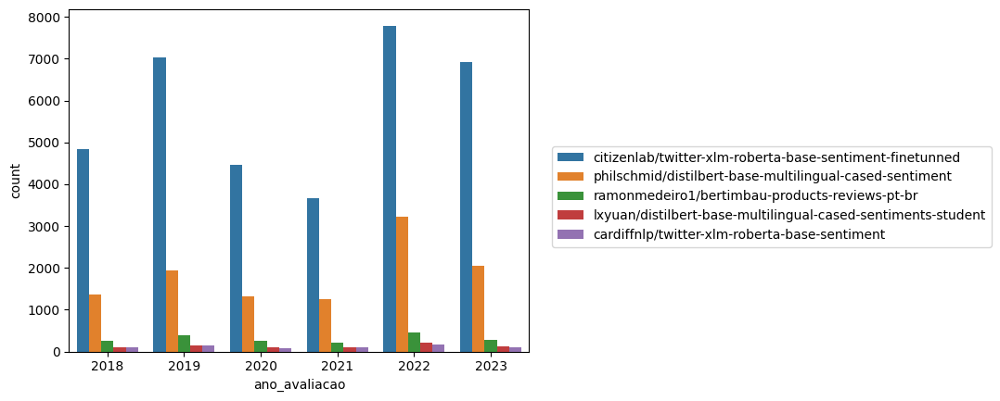

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.countplot(x='ano_avaliacao',
              hue='sentiment_bert_max',
              data=teste)
plt.legend(bbox_to_anchor=(1.05, .6), loc='upper left', borderaxespad=0)

In [ ]:
import seaborn as sns

sns.relplot(x='ano_avaliacao', y='sentiment_score', kind="line", hue='sentiment_label', data=teste)

In [ ]:
sns.relplot(x='ano_avaliacao', y='sentiment_score_2', kind="line", hue='sentiment_label_2', data=teste)

ValueError: ignored

<Axes: xlabel='ano_avaliacao', ylabel='count'>

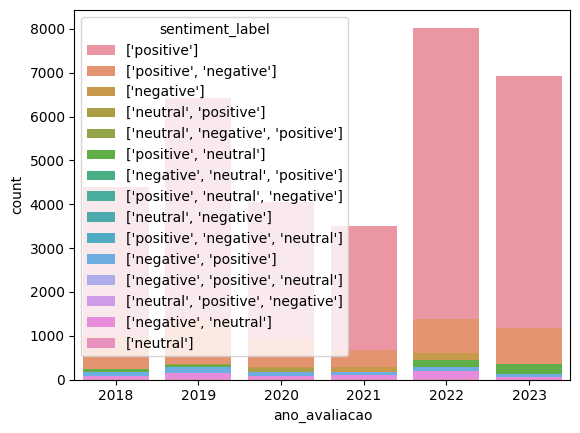

In [ ]:
sns.countplot(x='ano_avaliacao',
              hue='sentiment_label',
              data=teste,
              dodge=False)

In [ ]:
sns.countplot(x='ano_avaliacao',
              hue='sentiment_label_2',
              data=teste)

In [ ]:
sns.relplot(x='ano_avaliacao', col_wrap=3, col="source", y='sentiment_score', hue='sentiment_label', data=teste, kind='line')

KeyboardInterrupt: ignored

Error in callback <function _draw_all_if_interactive at 0x7f577bad2cb0> (for post_execute):


KeyboardInterrupt: ignored

Error in callback <function flush_figures at 0x7f577bad1f30> (for post_execute):


KeyboardInterrupt: ignored

In [ ]:
teste[(teste.sentiment_label != teste.sentiment_label_2)][['text','sentiment_label', 'sentiment_score']]

In [ ]:
sns.relplot(x='ano_avaliacao', y='sentiment_score_2', kind="line", hue='sentiment_label_2', data=teste[(teste.sentiment_label != teste.sentiment_label_2)], palette='Set2')
sns.relplot(x='ano_avaliacao', y='sentiment_score', kind="line", hue='sentiment_label', data=teste[(teste.sentiment_label != teste.sentiment_label_2)], palette='Set2')

In [ ]:
sns.scatterplot(data=teste[(teste.sentiment_label != teste.sentiment_label_2) & (abs(teste.sentiment_score - teste.sentiment_score_2) > 0.00)], x="sentiment_score", y="sentiment_score_2")

In [ ]:
teste[(teste.sentiment_label != teste.sentiment_label_2) & (abs(teste.sentiment_score - teste.sentiment_score_2) > 0.00)].sample()

AttributeError: ignored

In [ ]:
import ast

ast.literal_eval(teste['sentiment_label'][0])

['positive']

In [ ]:
teste[teste['sentiment_label'].apply(lambda x: len(ast.literal_eval(x)) == 1)][['sentiment_label', 'text', 'sentiment_bert_1', 'sentiment_bert_2', 'sentiment_bert_3', 'sentiment_bert_4','sentiment_bert_5']]

,sentiment_label,text,sentiment_bert_1,sentiment_bert_2,sentiment_bert_3,sentiment_bert_4,sentiment_bert_5
0,['positive'],"Lugar fantástico, recomendo super.","{'label': 'positive', 'score': 0.9849022030830...","{'label': 'positive', 'score': 0.9592684507369...","{'label': 'Positive', 'score': 0.9925462603569...","{'label': 'Positive', 'score': 0.9925462603569...","{'label': 'Positive', 'score': 0.9925462603569..."
2,['positive'],excelente!,"{'label': 'positive', 'score': 0.9857670068740...","{'label': 'positive', 'score': 0.9891675710678...","{'label': 'Positive', 'score': 0.9923394918441...","{'label': 'Positive', 'score': 0.9923394918441...","{'label': 'Positive', 'score': 0.9923394918441..."
3,['positive'],Belo lugar.,"{'label': 'positive', 'score': 0.8551892638206...","{'label': 'positive', 'score': 0.781340479850769}","{'label': 'Positive', 'score': 0.9930474162101...","{'label': 'Positive', 'score': 0.9930474162101...","{'label': 'Positive', 'score': 0.9930474162101..."
4,['positive'],Ótimo local,"{'label': 'positive', 'score': 0.8495931029319...","{'label': 'positive', 'score': 0.5628671050071...","{'label': 'Positive', 'score': 0.9923906922340...","{'label': 'Positive', 'score': 0.9923906922340...","{'label': 'Positive', 'score': 0.9923906922340..."
5,['positive'],excelente local otima vista e hospitalidade pe...,"{'label': 'positive', 'score': 0.9734945893287...","{'label': 'positive', 'score': 0.9737055897712...","{'label': 'Positive', 'score': 0.988045871257782}","{'label': 'Positive', 'score': 0.988045871257782}","{'label': 'Positive', 'score': 0.988045871257782}"
...,...,...,...,...,...,...,...
49213,['positive'],Simplesmente amei,"{'label': 'positive', 'score': 0.727571427822113}","{'label': 'positive', 'score': 0.608471155166626}","{'label': 'Positive', 'score': 0.9922024011611...","{'label': 'Positive', 'score': 0.9922024011611...","{'label': 'Positive', 'score': 0.9922024011611..."
49215,['positive'],Um sonho,"{'label': 'positive', 'score': 0.5642338991165...","{'label': 'positive', 'score': 0.5150464177131...","{'label': 'Positive', 'score': 0.7321606874465...","{'label': 'Positive', 'score': 0.7321606874465...","{'label': 'Positive', 'score': 0.7321606874465..."
49216,['positive'],Excelente Resort,"{'label': 'positive', 'score': 0.987581729888916}","{'label': 'positive', 'score': 0.9462223052978...","{'label': 'Positive', 'score': 0.9921082854270...","{'label': 'Positive', 'score': 0.9921082854270...","{'label': 'Positive', 'score': 0.9921082854270..."
49217,['positive'],Lugar lindo! Ótimo para descansar.,"{'label': 'positive', 'score': 0.9002830386161...","{'label': 'positive', 'score': 0.6816404461860...","{'label': 'Positive', 'score': 0.9932357668876...","{'label': 'Positive', 'score': 0.9932357668876...","{'label': 'Positive', 'score': 0.9932357668876..."


In [ ]:
teste[teste['sentiment_label'].apply(lambda x: len(ast.literal_eval(x)) == 2)][['sentiment_label', 'text', 'sentiment_bert_1', 'sentiment_bert_2', 'sentiment_bert_3', 'sentiment_bert_4','sentiment_bert_5']]

,sentiment_label,text,sentiment_bert_1,sentiment_bert_2,sentiment_bert_3,sentiment_bert_4,sentiment_bert_5
1,"['positive', 'negative']",Tudo perfeito,"{'label': 'positive', 'score': 0.9701986312866...","{'label': 'negative', 'score': 0.6602097153663...","{'label': 'Positive', 'score': 0.9922283291816...","{'label': 'Positive', 'score': 0.9922283291816...","{'label': 'Positive', 'score': 0.9922283291816..."
17,"['neutral', 'positive']","Quadra, piscina, praça e ao lado da praia sem ...","{'label': 'neutral', 'score': 0.5129052996635437}","{'label': 'positive', 'score': 0.5697891712188...","{'label': 'Neutral', 'score': 0.6083300113677979}","{'label': 'Neutral', 'score': 0.6083300113677979}","{'label': 'Neutral', 'score': 0.6083300113677979}"
19,"['positive', 'negative']",É um ótimo hotel para levar a família e curtir...,"{'label': 'positive', 'score': 0.9578593969345...","{'label': 'negative', 'score': 0.5199328660964...","{'label': 'Positive', 'score': 0.9722692966461...","{'label': 'Positive', 'score': 0.9722692966461...","{'label': 'Positive', 'score': 0.9722692966461..."
22,"['neutral', 'positive']",Atendimento e alimentação.,"{'label': 'positive', 'score': 0.8624117374420...","{'label': 'positive', 'score': 0.7141097187995...","{'label': 'Neutral', 'score': 0.9898031949996948}","{'label': 'Neutral', 'score': 0.9898031949996948}","{'label': 'Neutral', 'score': 0.9898031949996948}"
28,"['positive', 'negative']","Aconchegante, bem localizado e com ótimo servi...","{'label': 'negative', 'score': 0.70010906457901}","{'label': 'positive', 'score': 0.7468746900558...","{'label': 'Positive', 'score': 0.9913169145584...","{'label': 'Positive', 'score': 0.9913169145584...","{'label': 'Positive', 'score': 0.9913169145584..."
...,...,...,...,...,...,...,...
49199,"['neutral', 'positive']",Melhorar muito a infraestrutura.,"{'label': 'positive', 'score': 0.818744421005249}","{'label': 'positive', 'score': 0.8409448266029...","{'label': 'Neutral', 'score': 0.9386424422264099}","{'label': 'Neutral', 'score': 0.9386424422264099}","{'label': 'Neutral', 'score': 0.9386424422264099}"
49200,"['positive', 'negative']",Pelo atenção e atendimento em todos os sentido...,"{'label': 'positive', 'score': 0.9378687739372...","{'label': 'negative', 'score': 0.5224962830543...","{'label': 'Positive', 'score': 0.9896613359451...","{'label': 'Positive', 'score': 0.9896613359451...","{'label': 'Positive', 'score': 0.9896613359451..."
49201,"['positive', 'negative']",Tudo de bom,"{'label': 'negative', 'score': 0.6747020483016...","{'label': 'negative', 'score': 0.7172132730484...","{'label': 'Positive', 'score': 0.9868878722190...","{'label': 'Positive', 'score': 0.9868878722190...","{'label': 'Positive', 'score': 0.9868878722190..."
49206,"['neutral', 'positive']",Tudo,"{'label': 'positive', 'score': 0.8212609887123...","{'label': 'positive', 'score': 0.4054795801639...","{'label': 'Neutral', 'score': 0.913355827331543}","{'label': 'Neutral', 'score': 0.913355827331543}","{'label': 'Neutral', 'score': 0.913355827331543}"


In [ ]:
teste[teste['sentiment_label'].apply(lambda x: len(ast.literal_eval(x)) > 2)][['sentiment_label', 'rating', 'text', 'sentiment_bert_1', 'sentiment_bert_2', 'sentiment_bert_3', 'sentiment_bert_4','sentiment_bert_5']]

,sentiment_label,rating,text,sentiment_bert_1,sentiment_bert_2,sentiment_bert_3,sentiment_bert_4,sentiment_bert_5
20,"['neutral', 'negative', 'positive']",3.0,"O hotel é limpo, os funcionários muito educado...","{'label': 'neutral', 'score': 0.725369930267334}","{'label': 'positive', 'score': 0.507336437702179}","{'label': 'Negative', 'score': 0.5601344108581...","{'label': 'Negative', 'score': 0.5601344108581...","{'label': 'Negative', 'score': 0.5601344108581..."
39,"['negative', 'neutral', 'positive']",5.0,Sem palavras,"{'label': 'positive', 'score': 0.3510648608207...","{'label': 'neutral', 'score': 0.4789133667945862}","{'label': 'Negative', 'score': 0.7170167565345...","{'label': 'Negative', 'score': 0.7170167565345...","{'label': 'Negative', 'score': 0.7170167565345..."
57,"['positive', 'neutral', 'negative']",5.0,Lugar incrível,"{'label': 'neutral', 'score': 0.510798990726471}","{'label': 'negative', 'score': 0.4616160988807...","{'label': 'Positive', 'score': 0.9919718503952...","{'label': 'Positive', 'score': 0.9919718503952...","{'label': 'Positive', 'score': 0.9919718503952..."
130,"['positive', 'neutral', 'negative']",5.0,Lugar incrível,"{'label': 'neutral', 'score': 0.510798990726471}","{'label': 'negative', 'score': 0.4616160988807...","{'label': 'Positive', 'score': 0.9919718503952...","{'label': 'Positive', 'score': 0.9919718503952...","{'label': 'Positive', 'score': 0.9919718503952..."
132,"['positive', 'negative', 'neutral']",3.0,"Difícil dizer,por que amo praia e é um lugar q...","{'label': 'neutral', 'score': 0.45937931537628...","{'label': 'negative', 'score': 0.4774778187274...","{'label': 'Positive', 'score': 0.9845324158668...","{'label': 'Positive', 'score': 0.9845324158668...","{'label': 'Positive', 'score': 0.9845324158668..."
...,...,...,...,...,...,...,...,...
48937,"['positive', 'negative', 'neutral']",5.0,"Camarim Grande é maravilhoso, sendo que infeli...","{'label': 'neutral', 'score': 0.41920384764671...","{'label': 'positive', 'score': 0.7904974818229...","{'label': 'Negative', 'score': 0.714795708656311}","{'label': 'Negative', 'score': 0.714795708656311}","{'label': 'Negative', 'score': 0.714795708656311}"
48961,"['neutral', 'positive', 'negative']",4.0,Lugar para se deixar as pernas voltadas para o...,"{'label': 'positive', 'score': 0.7103403210639...","{'label': 'negative', 'score': 0.4030974209308...","{'label': 'Neutral', 'score': 0.975810170173645}","{'label': 'Neutral', 'score': 0.975810170173645}","{'label': 'Neutral', 'score': 0.975810170173645}"
49096,"['neutral', 'positive', 'negative']",5.0,Conheci pela primeira vez o pecado da gula. Po...,"{'label': 'positive', 'score': 0.8575298190116...","{'label': 'negative', 'score': 0.6595584154129...","{'label': 'Neutral', 'score': 0.9615657329559326}","{'label': 'Neutral', 'score': 0.9615657329559326}","{'label': 'Neutral', 'score': 0.9615657329559326}"
49140,"['neutral', 'negative', 'positive']",4.0,"Passamos só 4 dias no Salinas, pois era só o q...","{'label': 'negative', 'score': 0.9009762406349...","{'label': 'positive', 'score': 0.5664177536964...","{'label': 'Neutral', 'score': 0.9686949849128723}","{'label': 'Neutral', 'score': 0.9686949849128723}","{'label': 'Neutral', 'score': 0.9686949849128723}"


In [ ]:
treinado[treinado.text == 'Sem palavras'][['relative_date', 'likes', 'mes_ano_avaliacao', 'analisar', 'sentiment_bert', 'rating', 'text', 'source']]

,relative_date,likes,user_is_local_guide,mes_ano_avaliacao,analisar,sentiment_bert,rating,text,source
39,3 semanas atrás,0,False,2023-06,True,neutral,5.0,Sem palavras,analisar
7025,2 semanas atrás,0,False,2023-06,True,neutral,5.0,Sem palavras,analisar
14824,4 anos atrás,0,True,2019-07,True,neutral,5.0,Sem palavras,analisar
24048,5 anos atrás,0,True,2018-07,True,neutral,5.0,Sem palavras,analisar
28383,5 anos atrás,0,True,2018-07,True,neutral,5.0,Sem palavras,analisar
39693,4 anos atrás,1,False,2019-07,True,neutral,5.0,Sem palavras,analisar
40325,5 anos atrás,0,False,2018-07,True,neutral,5.0,Sem palavras,analisar


In [ ]:
teste[teste.text == 'Sem palavras'][['relative_date', 'likes', 'mes_ano_avaliacao', 'analisar', 'sentiment_bert', 'rating', 'text', 'source']]

,relative_date,likes,mes_ano_avaliacao,analisar,sentiment_bert,rating,text,source
39,3 semanas atrás,0,2023-06,True,"[{'label': 'Negative', 'score': 0.717016756534...",5.0,Sem palavras,hotel-marsol-beach-resort
5932,5 anos atrás,0,2018-07,True,"[{'label': 'Negative', 'score': 0.717016756534...",5.0,Sem palavras,salinas-maceió-all-inclusive-resort
14076,5 anos atrás,0,2018-07,True,"[{'label': 'Negative', 'score': 0.717016756534...",5.0,Sem palavras,la-torre-resort-all-inclusive
14548,2 semanas atrás,0,2023-06,True,"[{'label': 'Negative', 'score': 0.717016756534...",5.0,Sem palavras,hotel-vila-galé---touros
35522,4 anos atrás,0,2019-07,True,"[{'label': 'Negative', 'score': 0.717016756534...",5.0,Sem palavras,hotel-vila-galé-marés
48076,4 anos atrás,1,2019-07,True,"[{'label': 'Negative', 'score': 0.717016756534...",5.0,Sem palavras,salinas-maragogi-all-inclusive-resort
48708,5 anos atrás,0,2018-07,True,"[{'label': 'Negative', 'score': 0.717016756534...",5.0,Sem palavras,salinas-maragogi-all-inclusive-resort


precisa de finetuning?

https://huggingface.co/transformers/v3.5.1/custom_datasets.html

# bert

https://medium.com/data-hackers/an%C3%A1lise-de-sentimentos-em-portugu%C3%AAs-utilizando-pytorch-e-python-91a232165ec0

https://sol.sbc.org.br/index.php/stil/article/view/17784

https://towardsdatascience.com/sentiment-analysis-in-10-minutes-with-bert-and-hugging-face-294e8a04b671

In [ ]:
teste['sentiment_label'][0]

"['positive']"